In [1]:
import GI_parser as GIP
import numpy as np
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
from matplotlib.ticker import NullFormatter
import glob
import time
import pandas as pd
import math
import numba as nb

In [2]:
path = "/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/"

In [26]:
files=[]

files = glob.glob(path + "/*[.csv]", recursive = True)


# Remove last_pulse file from list
for file in files:
    if file[-14:] == 'last_pulse.csv':
        files.remove(file)


# Selection Sort to sort files in ascending order
for i in range(len(files)):
      
    # Find the minimum element in remaining 
    # unsorted array
    min_idx = i
    for j in range(i+1, len(files)):
        if int(files[min_idx].split('-')[-1].split('.')[0]) > int(files[j].split('-')[-1].split('.')[0]):
            min_idx = j
              
    # Swap the found minimum element with 
    # the first element        
    files[i], files[min_idx] = files[min_idx], files[i]



for file in files:
    print(file)

/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/Beamline_Cycles-2hr_W0028_H07-210806-140732-0.csv
/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/Beamline_Cycles-2hr_W0028_H07-210806-140732-1.csv
/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/Beamline_Cycles-2hr_W0028_H07-210806-140732-2.csv
/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/Beamline_Cycles-2hr_W0028_H07-210806-140732-3.csv
/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/Beamline_Cycles-2hr_W0028_H07-210806-140732-4.csv
/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/Beamline_Cycles-2hr_W0028_H07-210806-140732-5.csv
/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/Beamline_Cycles-2hr_W0028_H07-210806-140732-6.csv
/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/Beamline_Cycles-2hr_W0028_H07-210806-140732-7.csv
/mnt/e/Google_Drive_Backup_E/Dat

In [220]:
file=files[9]

In [221]:
file_tag = file[:-4]

In [129]:
last_file_tag = files[8][:-4]

In [130]:
def toa_section(data, toa_min, toa_max):
    return data[(data['#ToA'] > toa_min*4096./25.) & (data['#ToA'] < toa_max*4096./25.)]

In [131]:
if file.split('-')[-1].split('.')[0] == '0':
        # read file
        data = pd.read_csv(file)
else:
    # append end of last file to begining of next
    data = pd.concat([pd.read_pickle(last_file_tag+'_last_pulse.csv'), pd.read_csv(file)], ignore_index=True)

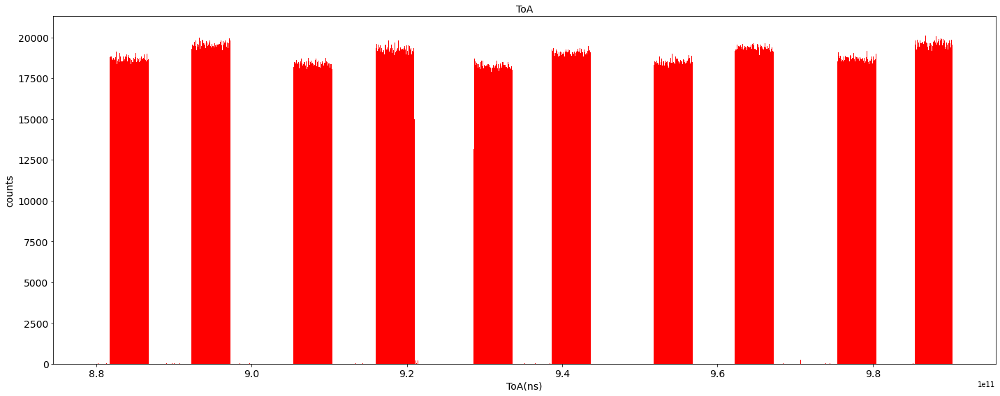

In [132]:
fig, toa1 = plt.subplots(ncols=1, figsize=(20, 8), facecolor='w')

nbins = int((data['#ToA'].shape[0])**(1/2))

n, bins, pathces = plt.hist(data['#ToA']/4096.*25., bins= nbins, color = 'r')

plt.title("ToA", fontsize = 14) # change the title
plt.xlabel('ToA(ns)',fontsize = 14)
plt.ylabel('counts',fontsize = 14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
#         plt.show()
fig.tight_layout()
fig.savefig(file_tag+'_ToA.png', bbox_inches='tight')

In [133]:
 # Cut sections in ToA containg pairs of pulses
step=139e9-115e9
# offset = 0.2e11-(data['#ToA'].min()/4096.*25.) #files[0]
# offset = 115e9-(data['#ToA'].min()/4096.*25.) #files[1]
# offset = 19029597034.375 #files[2], files[3]
offset = 22999613817.1875 #files[4], files[5], file[6], file[7]
x=(data['#ToA'].min()/4096.*25.)+offset
start = (data['#ToA'].min()/4096.*25.)
sections = []
sec_rising_edges = []
sec_rising_edges.append(start)
sec_falling_edges = []
sec_falling_edges.append(x)
sections.append(toa_section(data, start, x))
for i in range(0,3):
    start = x
    sec_rising_edges.append(start)
    x = (x+step)
    sec_falling_edges.append(x)
    sections.append(toa_section(data, start, x))
section_edges = list(zip(sec_rising_edges, sec_falling_edges))
# pick off last cut-off pulse for concatenating to next file 
last_pulse_df = toa_section(data, sec_falling_edges[-1], (data['#ToA'].max()/4096.*25.))
# last_pulse_df.to_csv(file_tag+"_last_pulse.csv")
last_pulse_df.to_pickle(file_tag+"_last_pulse.csv")

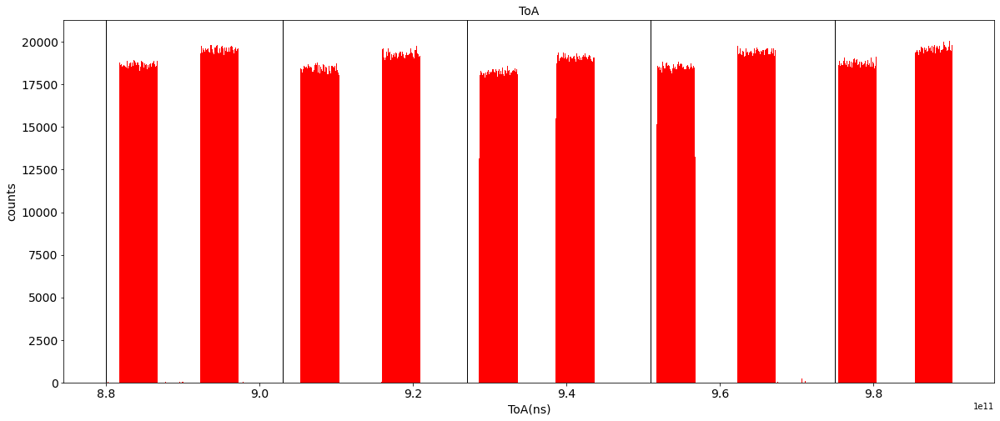

In [134]:
fig, ax1 = plt.subplots(ncols=1, figsize=(20, 8), facecolor='w')
nbins = int((data['#ToA'].shape[0])**(1/2))

plt.hist(data['#ToA']/4096.*25., bins= nbins, color = 'r')
# ,range=(72.795e9,72.805e9))

plt.title("ToA", fontsize = 14) # change the title
plt.xlabel('ToA(ns)',fontsize = 14)
plt.ylabel('counts',fontsize = 14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
# step=139e9-115e9
# # x = 115e9
# # offset = 115e9-(data['#ToA'].min()/4096.*25.)
# offset = 0.2e11-(data['#ToA'].min()/4096.*25.)
# x=(data['#ToA'].min()/4096.*25.)+offset
# # step = x-(data['#ToA'].min()/4096.*25.)
# for i in range(0,4):
#     plt.axvline(x, color='k', linewidth=1)
#     x = (x+step)
for el in sec_rising_edges:
    plt.axvline(el, color='k', linewidth=1)
for el in sec_falling_edges:   
    plt.axvline(el, color='k', linewidth=1)
    
    


plt.show()
fig.tight_layout()
# fig.savefig(file_tag+'_ToA.png', bbox_inches='tight')

In [17]:
len(sec_rising_edges), len(sec_falling_edges)

(4, 4)

In [78]:
# File[6] (gap in pulse train)

# Cut sections in ToA containg pairs of pulses

#pair 1
step=139e9-115e9
offset = 22999613817.1875
x=(data['#ToA'].min()/4096.*25.)+offset
start = (data['#ToA'].min()/4096.*25.)
sections = []
sec_rising_edges = []
sec_rising_edges.append(start)
sec_falling_edges = []
sec_falling_edges.append(x)
sections.append(toa_section(data, start, x))

#pair 2
start = x
sec_rising_edges.append(start)
x = (x+step)
sec_falling_edges.append(x)
sections.append(toa_section(data, start, x))

#pair 3
start = 6.18e11
sec_rising_edges.append(start)
x = (6.18e11+step)
sec_falling_edges.append(x)
sections.append(toa_section(data, start, x))
                
#pair 4
start = x
sec_rising_edges.append(start)
x = (x+step)
sec_falling_edges.append(x)
sections.append(toa_section(data, start, x))
                
#pair 5
start = x
sec_rising_edges.append(start)
x = (x+step)
sec_falling_edges.append(x)
sections.append(toa_section(data, start, x))
                
section_edges = list(zip(sec_rising_edges, sec_falling_edges))
# pick off last cut-off pulse for concatenating to next file 
last_pulse_df = toa_section(data, sec_falling_edges[-1], (data['#ToA'].max()/4096.*25.))
last_pulse_df.to_csv(file_tag+"_last_pulse.csv")

In [79]:
len(sec_rising_edges), len(sec_falling_edges)

(5, 5)

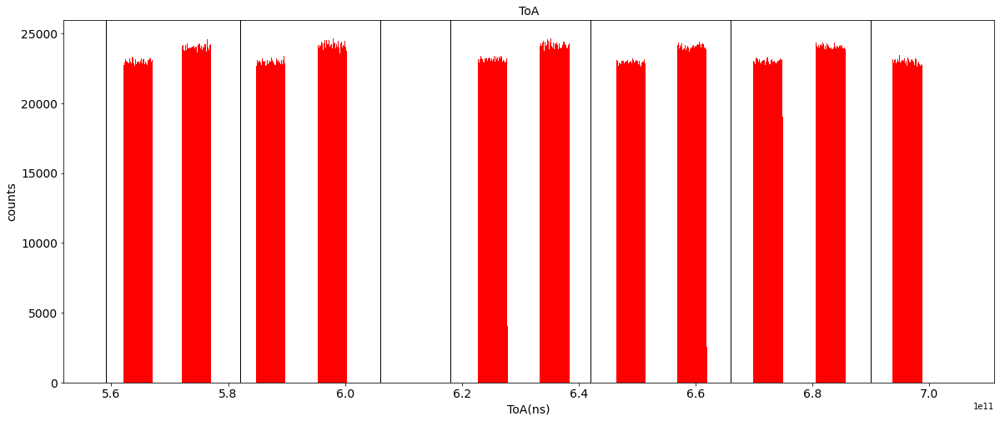

In [80]:
fig, ax1 = plt.subplots(ncols=1, figsize=(20, 8), facecolor='w')
nbins = int((data['#ToA'].shape[0])**(1/2))

plt.hist(data['#ToA']/4096.*25., bins= nbins, color = 'r')
# ,range=(72.795e9,72.805e9))

plt.title("ToA", fontsize = 14) # change the title
plt.xlabel('ToA(ns)',fontsize = 14)
plt.ylabel('counts',fontsize = 14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
# step=139e9-115e9
# # x = 115e9
# # offset = 115e9-(data['#ToA'].min()/4096.*25.)
# offset = 0.2e11-(data['#ToA'].min()/4096.*25.)
# x=(data['#ToA'].min()/4096.*25.)+offset
# # step = x-(data['#ToA'].min()/4096.*25.)
# for i in range(0,4):
#     plt.axvline(x, color='k', linewidth=1)
#     x = (x+step)
for el in sec_rising_edges:
    plt.axvline(el, color='k', linewidth=1)
for el in sec_falling_edges:   
    plt.axvline(el, color='k', linewidth=1)
    
    


plt.show()
fig.tight_layout()
# fig.savefig(file_tag+'_ToA.png', bbox_inches='tight')

In [137]:
# Cut sections into two smaller sections containg single pulses (on pulse or off pulse)
pulses = []
pulse_rising_edges = []
pulse_falling_edges = []

# First pair
data_min = (sections[0]['#ToA'].min()/4096.*25.)
# intra_section_step = (0.1e11-(sections[0]['#ToA'].min()/4096.*25.)) #file[0]
# intra_section_step = (1.27e11-(sections[1]['#ToA'].min()/4096.*25.)) #file[1]
# intra_section_step = 9013192218.75 #files[1]
intra_section_step = 11996281015.625 #files[5]
pair_division = (data_min+(intra_section_step))
pulses.append(toa_section(sections[0], data_min, pair_division))
pulse_rising_edges.append(data_min)
pulse_falling_edges.append(pair_division)
data_max = (sections[0]['#ToA'].max()/4096.*25.)
pulses.append(toa_section(sections[0], pair_division, data_max))
pulse_rising_edges.append(pair_division)
pulse_falling_edges.append(data_max)


for i in range(1,4):
    data_min = (sections[i]['#ToA'].min()/4096.*25.)
# #     line_pos = (data_min+(1.27e11-data_min)) #files[1]
#     intra_section_step = (data_min+(0.1e11-data_min)) #files[0]
#     intra_section_step = 3.4e10-(sections[1]['#ToA'].min()/4096.*25.)
#     intra_section_step = 1.27e11-(sections[1]['#ToA'].min()/4096.*25.)
#     intra_section_step = 13999727445.3125 #files[1]
#     intra_section_step = 11996281015.625 #files[5]
    intra_section_step = 9013192218.75 #files[1]
    pair_division = (data_min+(intra_section_step))
    pulses.append(toa_section(sections[i], data_min, pair_division))
    pulse_rising_edges.append(data_min)
    pulse_falling_edges.append(pair_division)
    data_max = (sections[i]['#ToA'].max()/4096.*25.)
    pulses.append(toa_section(sections[i], pair_division, data_max))
    pulse_rising_edges.append(pair_division)
    pulse_falling_edges.append(data_max)
# create one list contain the pulse witdth parameters in ascending order
pulse_edges = list(zip(pulse_rising_edges, pulse_falling_edges))

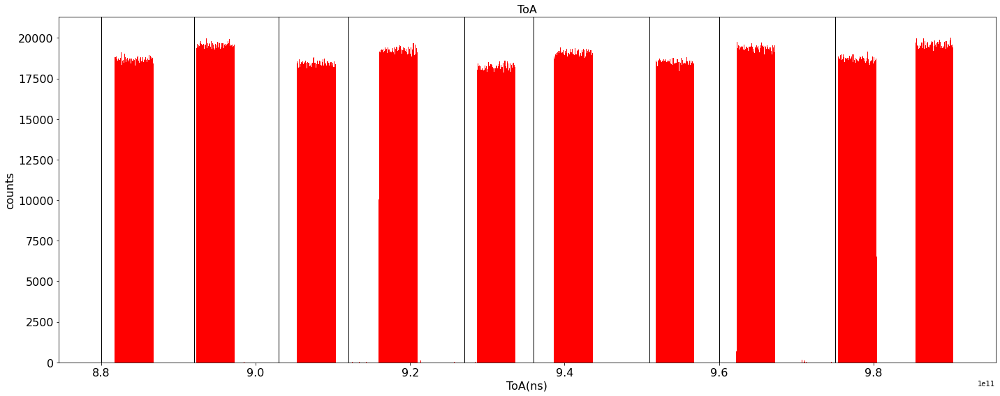

In [138]:
fig, toa2 = plt.subplots(ncols=1, figsize=(20, 8), facecolor='w')

nbins = int((data['#ToA'].shape[0])**(1/2))

plt.hist(data['#ToA']/4096.*25., bins= nbins, color = 'r')
plt.title("ToA", fontsize = 16) # change the title
plt.xlabel('ToA(ns)',fontsize = 16)
plt.ylabel('counts',fontsize = 16)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
for el in pulse_rising_edges:      
    plt.axvline(el, color='k', linewidth=1)
for el in pulse_falling_edges:      
    plt.axvline(el, color='k', linewidth=1)
# plt.xlabel('ToT, ns')
# plt.legend()
#         plt.show()
fig.tight_layout()
fig.savefig(file_tag+'_ToA_Edge_Detection.png', bbox_inches='tight')

In [29]:
# fig, ax1 = plt.subplots(ncols=1, figsize=(20, 8), facecolor='w')
# nbins = int((data['#ToA'].shape[0])**(1/2))

# plt.hist(data['#ToA']/4096.*25., bins= nbins, color = 'r',range=(0,20e9))
# # ,range=(72.795e9,72.805e9))
# data_min = (data['#ToA'].min()/4096.*25.)
# line_pos = (data_min+(0.1e11-data_min))
# plt.axvline(line_pos, color='k', linewidth=1)
# plt.title("ToA", fontsize = 12) # change the title
# plt.xlabel('ToA(ns)',fontsize = 12)
# plt.ylabel('counts',fontsize = 12)


# # plt.xlabel('ToT, ns')
# # plt.legend()
# plt.show()
# fig.tight_layout()
# # fig.savefig(file_tag+'_ToA.png', bbox_inches='tight')

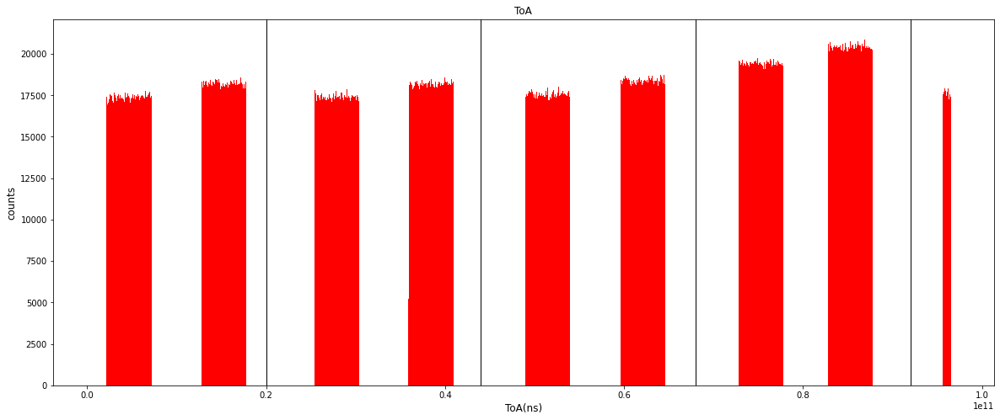

In [40]:
fig, ax1 = plt.subplots(ncols=1, figsize=(20, 8), facecolor='w')
nbins = int((data['#ToA'].shape[0])**(1/2))

plt.hist(data['#ToA']/4096.*25., bins= nbins, color = 'r')
# ,range=(72.795e9,72.805e9))
#,range=(6e11,9e11)
plt.title("ToA", fontsize = 12) # change the title
plt.xlabel('ToA(ns)',fontsize = 12)
plt.ylabel('counts',fontsize = 12)
# plt.hist(Pt1_df['#ToT[arb]'], bins= nbins, range = [0, 20000], lw=3, histtype='step', label = 'file 2', color = 'red')
# step = (115e9-(data['#ToA'].min()/4096.*25.))

# plt.axvline(x, color='k', linewidth=1)
# plt.axvline(139e9, color='k', linewidth=1)
step=139e9-115e9
# x = 115e9
# offset = 115e9-(data['#ToA'].min()/4096.*25.)
offset = 0.2e11-(data['#ToA'].min()/4096.*25.)
x=(data['#ToA'].min()/4096.*25.)+offset
# step = x-(data['#ToA'].min()/4096.*25.)
for i in range(0,4):
    plt.axvline(x, color='k', linewidth=1)
    x = (x+step)
# plt.xlabel('ToT, ns')
# plt.legend()
plt.show()
fig.tight_layout()
# fig.savefig(file_tag+'_ToA.png', bbox_inches='tight')

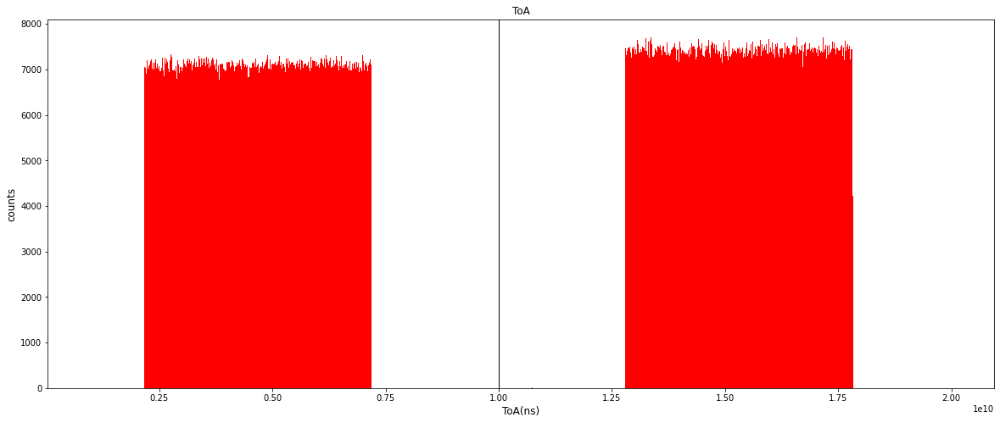

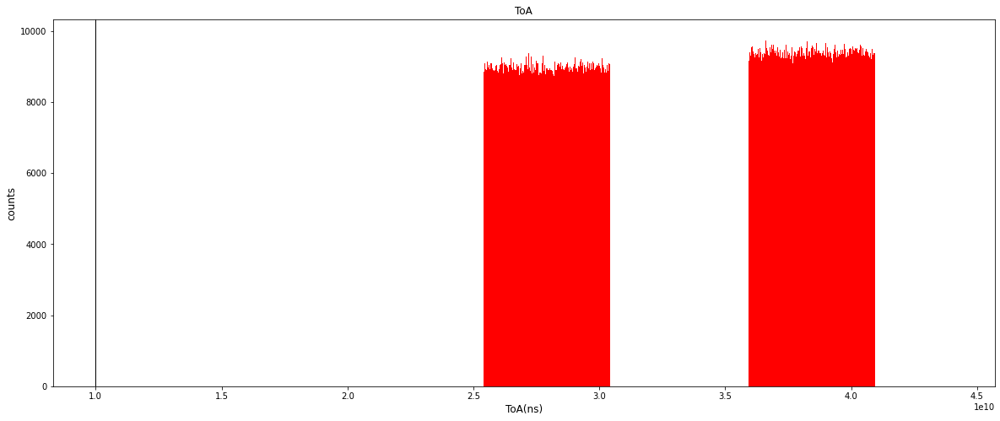

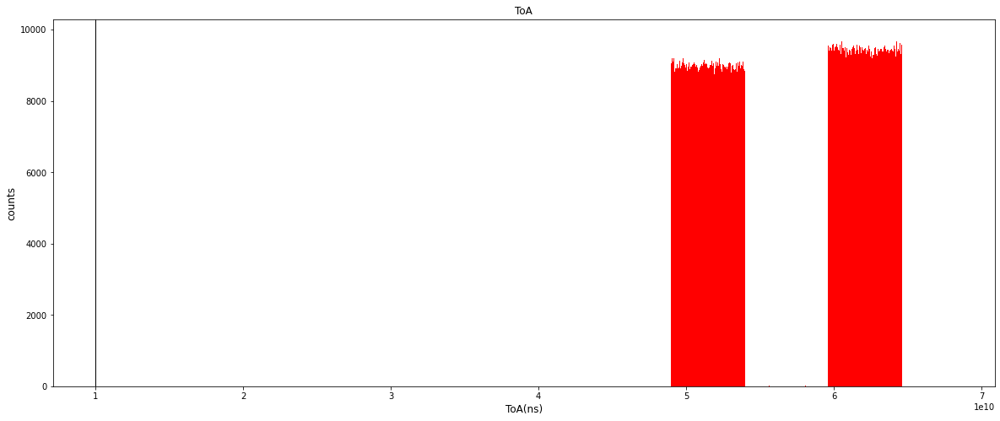

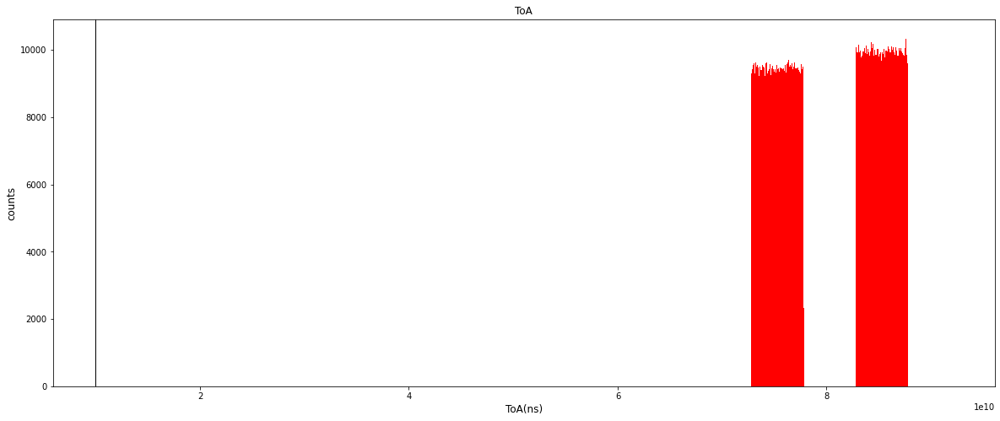

In [32]:
for section in sections:
    fig, ax1 = plt.subplots(ncols=1, figsize=(20, 8), facecolor='w')
    nbins = int((section['#ToA'].shape[0])**(1/2))

    plt.hist(section['#ToA']/4096.*25., bins= nbins, color = 'r')
    # ,range=(72.795e9,72.805e9))
    #,range=(6e11,9e11)
    plt.title("ToA", fontsize = 12) # change the title
    plt.xlabel('ToA(ns)',fontsize = 12)
    plt.ylabel('counts',fontsize = 12)
    # plt.hist(Pt1_df['#ToT[arb]'], bins= nbins, range = [0, 20000], lw=3, histtype='step', label = 'file 2', color = 'red')
    # step = (115e9-(data2['#ToA'].min()/4096.*25.))

    # plt.axvline(x, color='k', linewidth=1)
    # plt.axvline(139e9, color='k', linewidth=1)
    #     step=139e9-115e9
    #     # x = 115e9
    #     offset = 115e9-(data2['#ToA'].min()/4096.*25.)
    #     x=(data2['#ToA'].min()/4096.*25.)+offset
    #     # step = x-(data2['#ToA'].min()/4096.*25.)
    #     for i in range(0,4):
    #         plt.axvline(x, color='k', linewidth=1)
    #         x = (x+step)
    # plt.xlabel('ToT, ns')
    # plt.legend()
    #     offset = 125e9-(section['#ToA'].min()/4096.*25.)
    #     line_pos = (section['#ToA'].min()/4096.*25.)+offset
    # offset = 105e9-(sections[1]['#ToA'].min()/4096.*25.)
    # line_pos = (sections[1]['#ToA'].min()/4096.*25.)+offset
    # plt.axvline(line_pos, color='k', linewidth=1)
    # offset = 105e9-(sections['#ToA'].min()/4096.*25.)
    data_min = (section['#ToA'].min()/4096.*25.)
#     line_pos = (data_min+(1.27e11-data_min)) #files[1]
    line_pos = (data_min+(0.1e11-data_min)) #files[0]
    plt.axvline(line_pos, color='k', linewidth=1)
    plt.show()
    fig.tight_layout()
    # fig.savefig(file_tag+'_ToA.png', bbox_inches='tight')

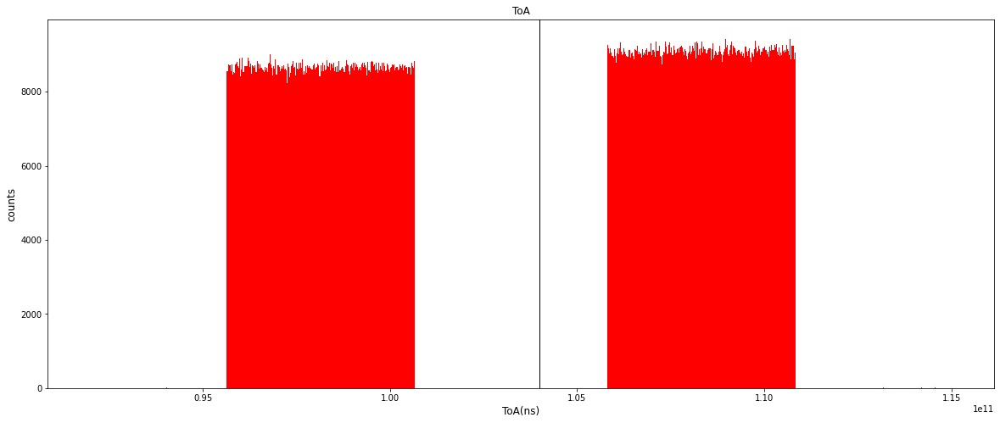

In [32]:
# for section in sections:
fig, ax1 = plt.subplots(ncols=1, figsize=(20, 8), facecolor='w')
nbins = int((sections[0]['#ToA'].shape[0])**(1/2))

plt.hist(sections[0]['#ToA']/4096.*25., bins= nbins, color = 'r')
# ,range=(72.795e9,72.805e9))
#,range=(6e11,9e11)
plt.title("ToA", fontsize = 12) # change the title
plt.xlabel('ToA(ns)',fontsize = 12)
plt.ylabel('counts',fontsize = 12)
# plt.hist(Pt1_df['#ToT[arb]'], bins= nbins, range = [0, 20000], lw=3, histtype='step', label = 'file 2', color = 'red')
# step = (115e9-(data2['#ToA'].min()/4096.*25.))

# plt.axvline(x, color='k', linewidth=1)
# plt.axvline(139e9, color='k', linewidth=1)
#     step=139e9-115e9
#     # x = 115e9
#     offset = 115e9-(data2['#ToA'].min()/4096.*25.)
#     x=(data2['#ToA'].min()/4096.*25.)+offset
#     # step = x-(data2['#ToA'].min()/4096.*25.)
#     for i in range(0,4):
#         plt.axvline(x, color='k', linewidth=1)
#         x = (x+step)
# plt.xlabel('ToT, ns')
# plt.legend()
#     offset = 125e9-(section[1]['#ToA'].min()/4096.*25.)
#     line_pos = (section[1]['#ToA'].min()/4096.*25.)+offset
# offset = 105e9-(section[1]s[1]['#ToA'].min()/4096.*25.)
# line_pos = (section[1]s[1]['#ToA'].min()/4096.*25.)+offset
# plt.axvline(line_pos, color='k', linewidth=1)
# offset = 105e9-(section[1]s['#ToA'].min()/4096.*25.)
# intra_section_step = (0.1e11-(sections[0]['#ToA'].min()/4096.*25.)) #file[0]
intra_section_step = 1.27e11-(sections[1]['#ToA'].min()/4096.*25.) #file[1], file[2]
data_min = (sections[0]['#ToA'].min()/4096.*25.)
#     line_pos = (data_min+(1.27e11-data_min)) #files[1]
line_pos = (data_min+(intra_section_step)) #files[0]
plt.axvline(line_pos, color='k', linewidth=1)
plt.show()
fig.tight_layout()
# fig.savefig(file_tag+'_ToA.png', bbox_inches='tight')

In [31]:
len(sections)

4

In [36]:
1.27e11-(sections[1]['#ToA'].min()/4096.*25.)

11996281015.625

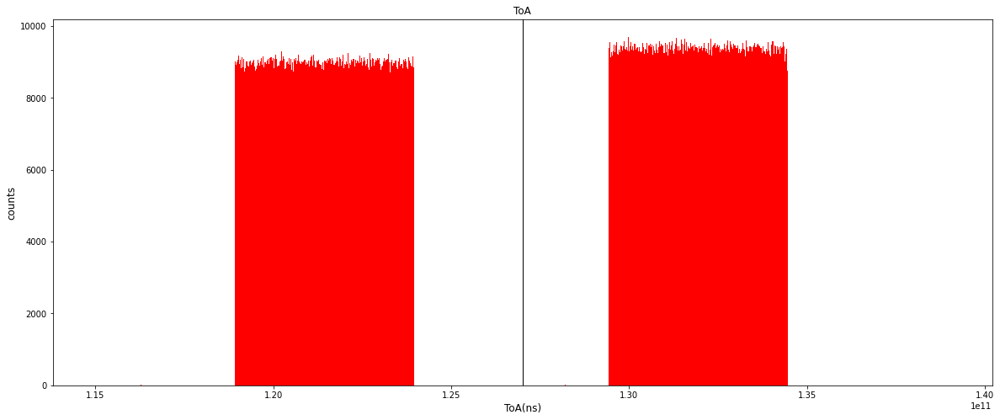

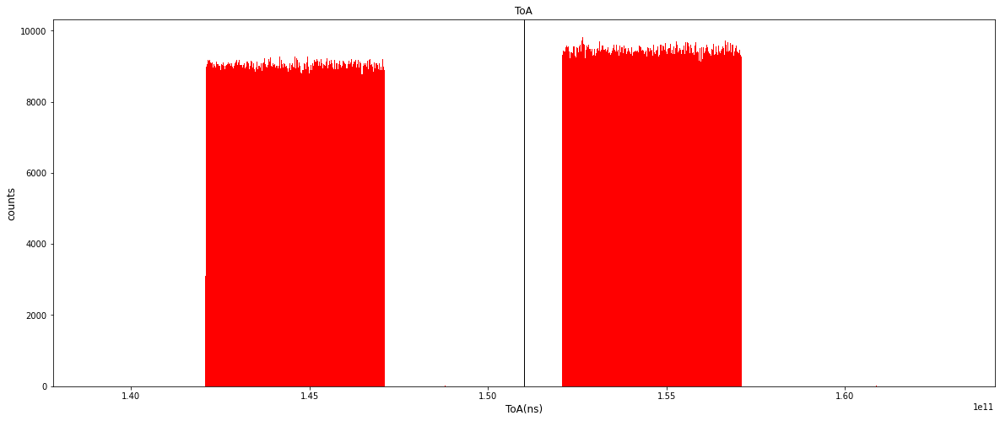

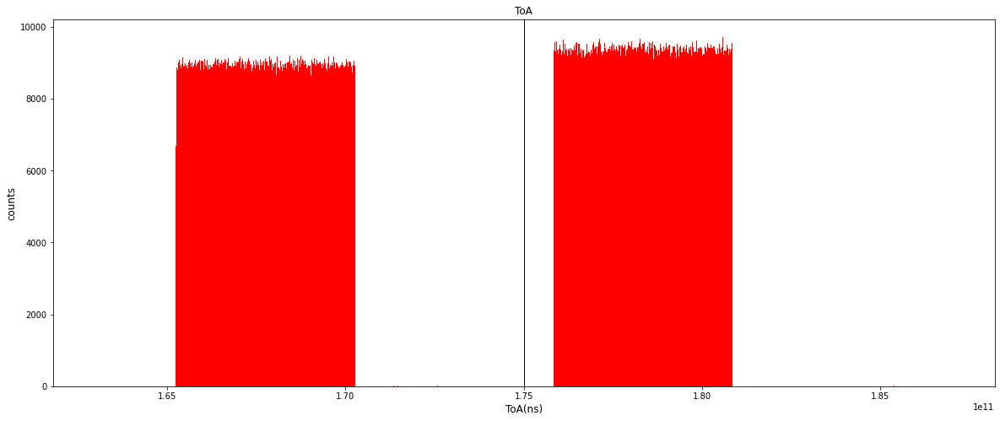

In [37]:
for i in range(1,4):
    fig, ax1 = plt.subplots(ncols=1, figsize=(20, 8), facecolor='w')
    nbins = int((sections[i]['#ToA'].shape[0])**(1/2))

    plt.hist(sections[i]['#ToA']/4096.*25., bins= nbins, color = 'r')
    # ,range=(72.795e9,72.805e9))
    #,range=(6e11,9e11)
    plt.title("ToA", fontsize = 12) # change the title
    plt.xlabel('ToA(ns)',fontsize = 12)
    plt.ylabel('counts',fontsize = 12)
    # plt.hist(Pt1_df['#ToT[arb]'], bins= nbins, range = [0, 20000], lw=3, histtype='step', label = 'file 2', color = 'red')
    # step = (115e9-(data2['#ToA'].min()/4096.*25.))

    # plt.axvline(x, color='k', linewidth=1)
    # plt.axvline(139e9, color='k', linewidth=1)
    #     step=139e9-115e9
    #     # x = 115e9
    #     offset = 115e9-(data2['#ToA'].min()/4096.*25.)
    #     x=(data2['#ToA'].min()/4096.*25.)+offset
    #     # step = x-(data2['#ToA'].min()/4096.*25.)
    #     for i in range(0,4):
    #         plt.axvline(x, color='k', linewidth=1)
    #         x = (x+step)
    # plt.xlabel('ToT, ns')
    # plt.legend()
    #     offset = 125e9-(section[1]['#ToA'].min()/4096.*25.)
    #     line_pos = (section[1]['#ToA'].min()/4096.*25.)+offset
    # offset = 105e9-(section[1]s[1]['#ToA'].min()/4096.*25.)
    # line_pos = (section[1]s[1]['#ToA'].min()/4096.*25.)+offset
    # plt.axvline(line_pos, color='k', linewidth=1)
    # offset = 105e9-(section[1]s['#ToA'].min()/4096.*25.)
    # intra_section_step = (0.1e11-(sections[0]['#ToA'].min()/4096.*25.)) #file[0]
#     intra_section_step = 3.4e10-(sections[1]['#ToA'].min()/4096.*25.)#file[0]
    intra_section_step = 1.27e11-(sections[1]['#ToA'].min()/4096.*25.)#file[1]
    data_min = (sections[i]['#ToA'].min()/4096.*25.)
    #     line_pos = (data_min+(1.27e11-data_min)) #files[1]
    line_pos = (data_min+(intra_section_step)) #files[0]
    plt.axvline(line_pos, color='k', linewidth=1)
    plt.show()
    fig.tight_layout()
    # fig.savefig(file_tag+'_ToA.png', bbox_inches='tight')

In [139]:
# Create Image and Bucket

for index in range(0,len(pulses),2):
        obj_data = pulses[index]
        no_obj_data = pulses[index+1]
        obj_length = obj_data['#Col'].shape[0]
        no_obj_length = no_obj_data['#Col'].shape[0]
        print('','obj pulse #:', file.split('-')[-1].split('.')[0]+str(index), 'obj length:',obj_length,\
              '\n', 'obj pulse #:', file.split('-')[-1].split('.')[0]+str(index+1), 'no_obj length:',no_obj_length)

        img_obj = np.zeros([256,256])
        img_no_obj = np.zeros([256,256])


        x_obj = obj_data['#Row'].to_numpy()
        y_obj = obj_data['#Col'].to_numpy()
        tot_obj = obj_data['#ToT[arb]'].to_numpy()

        for k in range(obj_length):
            i = x_obj[k]
            j = y_obj[k]
            img_obj[i][j] = img_obj[i][j] + tot_obj[k]


        x_no_obj = no_obj_data['#Row'].to_numpy()
        y_no_obj = no_obj_data['#Col'].to_numpy()
        tot_no_obj = no_obj_data['#ToT[arb]'].to_numpy()

        for k in range(no_obj_length):
            i = x_no_obj[k]
            j = y_no_obj[k]
            img_no_obj[i][j] = img_no_obj[i][j] + tot_no_obj[k]  

        obj_data_sum = np.sum(img_obj)
        no_obj_data_sum = np.sum(img_no_obj)

        np.save(path+'img_obj'+file.split('-')[-1].split('.')[0]+str(index), img_obj)
        np.save(path+'img_no_obj'+file.split('-')[-1].split('.')[0]+str(index+1), img_no_obj)
        np.save(path+'obj_data_sum'+file.split('-')[-1].split('.')[0]+str(index), obj_data_sum)
        np.save(path+'no_obj_data_sum'+file.split('-')[-1].split('.')[0]+str(index+1), no_obj_data_sum)

 obj pulse #: 90 obj length: 7297208 
 obj pulse #: 91 no_obj length: 7677664
 obj pulse #: 92 obj length: 7231492 
 obj pulse #: 93 no_obj length: 7569295
 obj pulse #: 94 obj length: 7153973 
 obj pulse #: 95 no_obj length: 7495924
 obj pulse #: 96 obj length: 7229373 
 obj pulse #: 97 no_obj length: 7605953


In [140]:
def mean2(x):
    y = np.sum(x) / np.size(x);
    return y

def corr2(a,b):
    a = a - mean2(a)
    b = b - mean2(b)

    r = (a*b).sum() / math.sqrt((a*a).sum() * (b*b).sum());
    return r

In [141]:
for pulse in range(0,len(pulses)-1,2):
    print('Corr for file '+file.split('-')[-1].split('.')[0]+' pulse pair','[',pulse,',',pulse+1,']',':',\
          corr2(np.load(path+'img_obj'+file.split('-')[-1].split('.')[0]+str(pulse)+'.npy'),\
                np.load(path+'img_no_obj'+file.split('-')[-1].split('.')[0]+str(pulse+1)+'.npy')))

Corr for file 9 pulse pair [ 0 , 1 ] : 0.8977234681644728
Corr for file 9 pulse pair [ 2 , 3 ] : 0.8339086498417784
Corr for file 9 pulse pair [ 4 , 5 ] : 0.8933597921269141
Corr for file 9 pulse pair [ 6 , 7 ] : 0.842109247425843


In [182]:
s = "obj_data_sum96.npy"
s[-18:-6], s[12:].split('.')[0], s[-6:-5]

('obj_data_sum', '96', '9')

In [200]:
a =[]
v=np.load(path+'obj_data_sum'+'00'+'.npy')
u=np.load(path+'obj_data_sum'+'02'+'.npy')
a.append(v)
# v.flat[0]
v,u,v+u,v.flat[0], u.flat[0],v.flat[0]+u.flat[0]

(array(2.20263032e+09),
 array(2.20073962e+09),
 4403369950.0,
 2202630325.0,
 2200739625.0,
 4403369950.0)

In [58]:
npy_files = []
bucket_sums_obj = []

npy_files = glob.glob(path + "/*[.npy]", recursive = True)

# obj_data_sum96.npy
# for file in npy_files:
#     if (int(file[-6:-5])<10):
#         print(int(file[-6:-5]))

for file in npy_files:
    if (file[-19:-6] == "/obj_data_sum") & (int(file[-6:-5])<10):
        bucket_sums_obj.append(file)
bucket_sums_obj

['/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/obj_data_sum00.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/obj_data_sum02.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/obj_data_sum04.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/obj_data_sum06.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/obj_data_sum10.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/obj_data_sum12.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/obj_data_sum14.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/obj_data_sum16.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/obj_data_sum20.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/obj_data_sum22.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_R

In [59]:
bucket_sums_obj_vals = []
for bucket_sum in bucket_sums_obj:
    val = np.load(bucket_sum)
    bucket_sums_obj_vals.append(val.flat[0])
bucket_sums_obj_vals

[2202630325.0,
 2200739625.0,
 2219803075.0,
 2457439900.0,
 2231689300.0,
 2207399775.0,
 2230778525.0,
 2192348075.0,
 2178379475.0,
 2170762575.0,
 2180304800.0,
 2186029450.0,
 2189098625.0,
 2195415075.0,
 2165661250.0,
 2172292750.0,
 2206726275.0,
 2180452275.0,
 2194115550.0,
 2199922575.0,
 2183833550.0,
 2209239750.0,
 2179139650.0,
 2181024075.0,
 2183804125.0,
 2188077525.0,
 2191671900.0,
 2175300025.0,
 2182192025.0,
 2180456925.0,
 2198118975.0,
 2208324200.0,
 2180791775.0,
 2258596575.0,
 2396173250.0,
 2255893850.0,
 2231685475.0,
 2215575550.0,
 2195731550.0,
 2171299250.0,
 2193825325.0]

In [61]:
len(bucket_sums_obj_vals)

41

In [60]:
sum(bucket_sums_obj_vals)

90522744600.0

In [65]:
90522744600.0<94894983550.0

True

In [66]:
94894983550.0-90522744600.0

4372238950.0

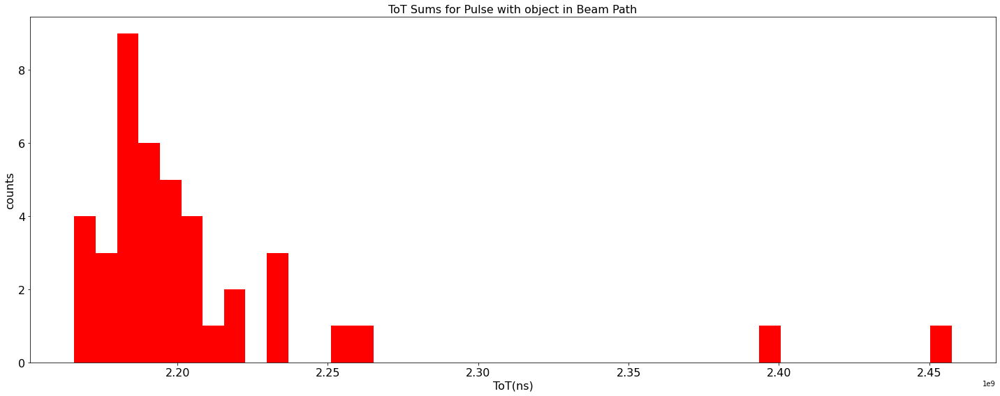

In [77]:


fig, toa1 = plt.subplots(ncols=1, figsize=(20, 8), facecolor='w')

nbins = int((len(bucket_sums_obj_vals)))

n, bins, pathces = plt.hist(bucket_sums_obj_vals, bins= nbins, color = 'r')

plt.title("ToT Sums for Pulse with object in Beam Path", fontsize = 16) # change the title
plt.xlabel('ToT(ns)',fontsize = 16)
plt.ylabel('counts',fontsize = 16)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
#         plt.show()
fig.tight_layout()
# fig.savefig(path+'ToT_Bucket_Sums_w_Obj.png', bbox_inches='tight')

In [204]:
(len(bucket_sums_obj_vals))**(1/2)

6.4031242374328485

In [62]:
# no_obj_data_sum96.npy
bucket_sums_no_obj = []
for file in npy_files:
    if (file[-21:-6] == "no_obj_data_sum") & (int(file[-6:-5])<10):
        bucket_sums_no_obj.append(file)
bucket_sums_no_obj

['/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/no_obj_data_sum01.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/no_obj_data_sum03.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/no_obj_data_sum05.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/no_obj_data_sum07.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/no_obj_data_sum11.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/no_obj_data_sum13.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/no_obj_data_sum15.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/no_obj_data_sum17.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/no_obj_data_sum21.npy',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/no_obj_data_sum23.npy',
 '/mnt/e/Google_Drive_Backup_E

In [63]:
bucket_sums_no_obj_vals = []
for bucket_sum in bucket_sums_no_obj:
    val = np.load(bucket_sum)
    bucket_sums_no_obj_vals.append(val.flat[0])
print(len(bucket_sums_no_obj_vals))    

41


In [64]:
sum(bucket_sums_no_obj_vals)

94894983550.0

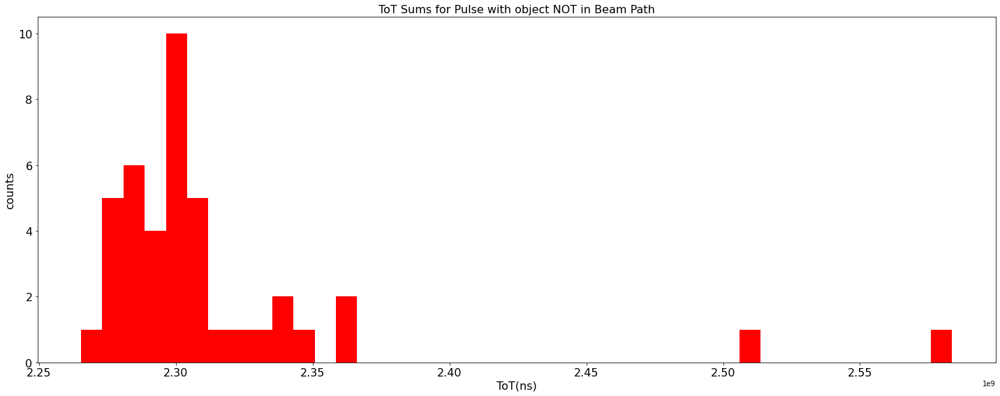

In [78]:


fig, toa1 = plt.subplots(ncols=1, figsize=(20, 8), facecolor='w')

nbins = int((len(bucket_sums_no_obj_vals)))

n, bins, pathces = plt.hist(bucket_sums_no_obj_vals, bins= nbins, color = 'r')

plt.title("ToT Sums for Pulse with object NOT in Beam Path", fontsize = 16) # change the title
plt.xlabel('ToT(ns)',fontsize = 16)
plt.ylabel('counts',fontsize = 16)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
#         plt.show()
fig.tight_layout()
# fig.savefig(path+'ToT_Bucket_Sums_wo_Obj.png', bbox_inches='tight')

In [90]:
tot_sums =  bucket_sums_no_obj_vals+bucket_sums_obj_vals

In [110]:
len(bucket_sums_no_obj_vals), len(bucket_sums_obj_vals)

(41, 41)

In [116]:
sum_diffs = []
for i in range(41):
    sum_diffs.append(bucket_sums_no_obj_vals[i]>bucket_sums_obj_vals[i])
sum_diffs

[True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True]

No Object: total=94894983550.0 mean=2314511793.902 stdv=57598641.139
Object: total=90522744600.0 mean=2207871819.512 stdv=54367359.767


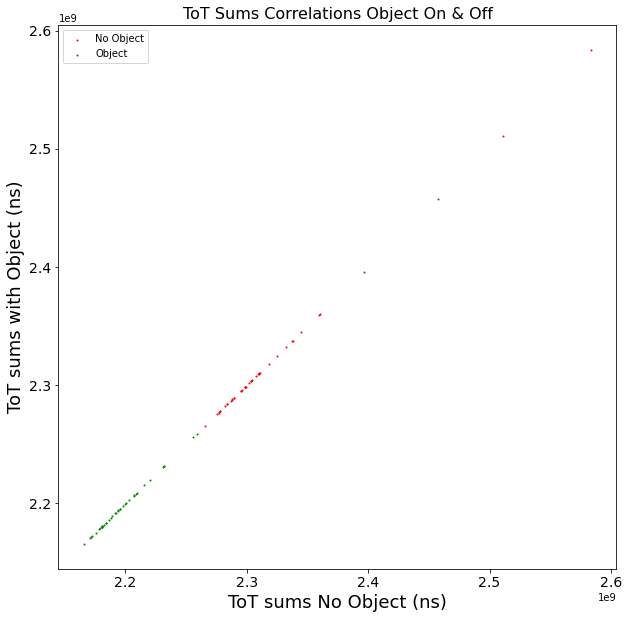

In [108]:
# Correlations
print('No Object: total=%.1f mean=%.3f stdv=%.3f' % (sum(bucket_sums_no_obj_vals), np.mean(bucket_sums_no_obj_vals), np.std(bucket_sums_no_obj_vals)))
print('Object: total=%.1f mean=%.3f stdv=%.3f' % (sum(bucket_sums_obj_vals), np.mean(bucket_sums_obj_vals), np.std(bucket_sums_obj_vals)))
fig, ax = plt.subplots(ncols=1,nrows=1, figsize=(10, 10))

#ax.scatter(beam2total_old,beam1total_old,s=0.1)
ax.scatter(bucket_sums_no_obj_vals,bucket_sums_no_obj_vals,color="red",s=1)
ax.scatter(bucket_sums_obj_vals,bucket_sums_obj_vals,color="green",s=1)
# ax.scatter(beam2total_2,beam1total_2,color="black",s=0.5)
# ax.plot([1.6e6,2.3e6],[1.6e6,2.3e6],'k-')

# plt.ylim(2.15e9,2.4e9)
# plt.xlim(2.15e9,2.4e9)
# plt.ylim(min(tot_sums)-0.05e9,max(tot_sums)+0.05e9)
# plt.xlim(min(tot_sums)-0.05e9,max(tot_sums)+0.05e9)
ax.tick_params(axis='both', which='major', labelsize=14)
ax.tick_params(axis='both', which='minor', labelsize=14)
plt.title("ToT Sums Correlations Object On & Off", fontsize = 16) # change the title
plt.xlabel('ToT sums No Object (ns)',fontsize = 18)
plt.ylabel('ToT sums with Object (ns)',fontsize = 18)
plt.legend(['No Object', 'Object'])
fig.tight_layout()

In [146]:
# delta ToT vs ToT
delta_ToT = []
for i in range(41):
    delta_ToT.append(bucket_sums_obj_vals[i]-bucket_sums_no_obj_vals[i])
delta_ToT, len(delta_ToT)  

([101028125.0,
  102684925.0,
  105363225.0,
  126204150.0,
  113029850.0,
  101983275.0,
  106337325.0,
  105943250.0,
  99806825.0,
  104738050.0,
  109144575.0,
  103081775.0,
  112778675.0,
  103520700.0,
  99616750.0,
  104529575.0,
  103121425.0,
  106221450.0,
  104733500.0,
  103262250.0,
  111559100.0,
  108784325.0,
  103211950.0,
  96802200.0,
  104170125.0,
  107113800.0,
  104696125.0,
  112442550.0,
  125253825.0,
  103315950.0,
  105921950.0,
  102115400.0,
  103221175.0,
  100472775.0,
  114494725.0,
  104141575.0,
  106093750.0,
  116404025.0,
  102997625.0,
  105696025.0,
  116200300.0],
 41)

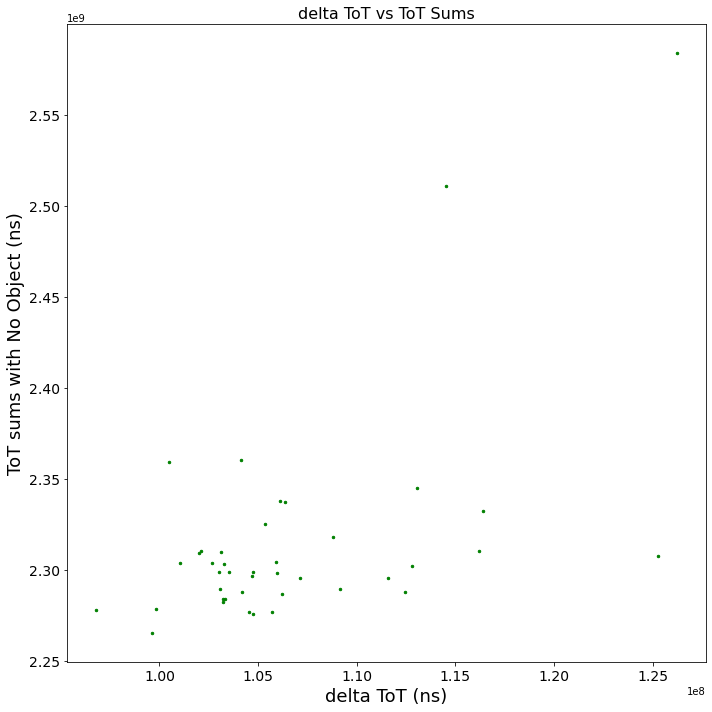

In [171]:
# delta ToT vs ToT
fig, ax = plt.subplots(ncols=1,nrows=1, figsize=(10, 10), facecolor='w')

#ax.scatter(beam2total_old,beam1total_old,s=0.1)
ax.scatter(delta_ToT,bucket_sums_no_obj_vals,color="green",s=6)
# ax.scatter(bucket_sums_obj_vals,bucket_sums_obj_vals,color="green",s=1)
# ax.scatter(beam2total_2,beam1total_2,color="black",s=0.5)
# ax.plot([1.6e6,2.3e6],[1.6e6,2.3e6],'k-')

# plt.ylim(2.15e9,2.4e9)
# plt.xlim(2.15e9,2.4e9)
# plt.ylim(min(tot_sums)-0.05e9,max(tot_sums)+0.05e9)
# plt.xlim(min(tot_sums)-0.05e9,max(tot_sums)+0.05e9)
ax.tick_params(axis='both', which='major', labelsize=14)
ax.tick_params(axis='both', which='minor', labelsize=14)
plt.title("delta ToT vs ToT Sums", fontsize = 16) # change the title
plt.xlabel('delta ToT (ns)',fontsize = 18)
plt.ylabel('ToT sums with No Object (ns)',fontsize = 18)
# plt.legend(['No Object', 'Object'])
fig.tight_layout()
plt.show()

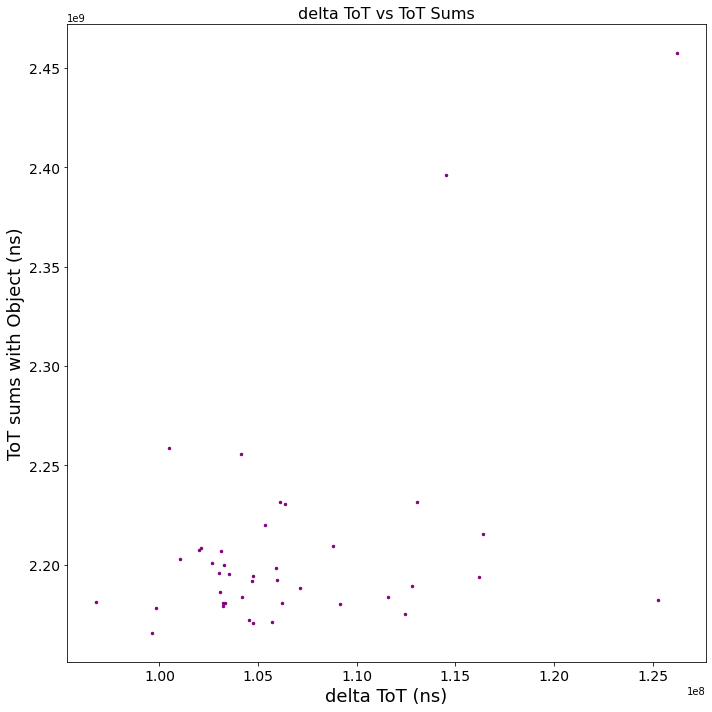

In [174]:
# delta ToT vs ToT
fig, ax = plt.subplots(ncols=1,nrows=1, figsize=(10, 10), facecolor='w')

#ax.scatter(beam2total_old,beam1total_old,s=0.1)
ax.scatter(delta_ToT,bucket_sums_obj_vals,color="purple",s=6)
# ax.scatter(bucket_sums_obj_vals,bucket_sums_obj_vals,color="green",s=1)
# ax.scatter(beam2total_2,beam1total_2,color="black",s=0.5)
# ax.plot([1.6e6,2.3e6],[1.6e6,2.3e6],'k-')

# plt.ylim(2.15e9,2.4e9)
# plt.xlim(2.15e9,2.4e9)
# plt.ylim(min(tot_sums)-0.05e9,max(tot_sums)+0.05e9)
# plt.xlim(min(tot_sums)-0.05e9,max(tot_sums)+0.05e9)
ax.tick_params(axis='both', which='major', labelsize=14)
ax.tick_params(axis='both', which='minor', labelsize=14)
plt.title("delta ToT vs ToT Sums", fontsize = 16) # change the title
plt.xlabel('delta ToT (ns)',fontsize = 18)
plt.ylabel('ToT sums with Object (ns)',fontsize = 18)
# plt.legend(['No Object', 'Object'])
fig.tight_layout()
plt.show()

In [18]:
for pulse in range(0,len(pulses),2):
    globals()['obj_data_sum'+str(pulse)] = np.load(path+'obj_data_sum'+file.split('-')[-1].split('.')[0]+str(pulse)+'.npy')
    globals()['no_obj_data_sum'+str(pulse+1)] = np.load(path+'no_obj_data_sum'+file.split('-')[-1].split('.')[0]+str(pulse+1)+'.npy')
    globals()['img_obj'+str(pulse)] = np.load(path+'img_obj'+file.split('-')[-1].split('.')[0]+str(pulse)+'.npy')
    globals()['img_no_obj'+str(pulse+1)] = np.load(path+'img_no_obj'+file.split('-')[-1].split('.')[0]+str(pulse+1)+'.npy')

[i,j]: [ 0 , 0 ]
[i,j]: [ 0 , 1 ]
[i,j]: [ 0 , 2 ]
[i,j]: [ 0 , 3 ]
[i,j]: [ 0 , 4 ]
[i,j]: [ 0 , 5 ]
[i,j]: [ 0 , 6 ]
[i,j]: [ 0 , 7 ]
[i,j]: [ 0 , 8 ]
[i,j]: [ 0 , 9 ]
[i,j]: [ 0 , 10 ]
[i,j]: [ 0 , 11 ]
[i,j]: [ 0 , 12 ]
[i,j]: [ 0 , 13 ]
[i,j]: [ 0 , 14 ]
[i,j]: [ 0 , 15 ]
[i,j]: [ 0 , 16 ]
[i,j]: [ 0 , 17 ]
[i,j]: [ 0 , 18 ]
[i,j]: [ 0 , 19 ]
[i,j]: [ 0 , 20 ]
[i,j]: [ 0 , 21 ]
[i,j]: [ 0 , 22 ]
[i,j]: [ 0 , 23 ]
[i,j]: [ 0 , 24 ]
[i,j]: [ 0 , 25 ]
[i,j]: [ 0 , 26 ]
[i,j]: [ 0 , 27 ]
[i,j]: [ 0 , 28 ]
[i,j]: [ 0 , 29 ]
[i,j]: [ 0 , 30 ]
[i,j]: [ 0 , 31 ]
[i,j]: [ 0 , 32 ]
[i,j]: [ 0 , 33 ]
[i,j]: [ 0 , 34 ]
[i,j]: [ 0 , 35 ]
[i,j]: [ 0 , 36 ]
[i,j]: [ 0 , 37 ]
[i,j]: [ 0 , 38 ]
[i,j]: [ 0 , 39 ]
[i,j]: [ 0 , 40 ]
[i,j]: [ 0 , 41 ]
[i,j]: [ 0 , 42 ]
[i,j]: [ 0 , 43 ]
[i,j]: [ 0 , 44 ]
[i,j]: [ 0 , 45 ]
[i,j]: [ 0 , 46 ]
[i,j]: [ 0 , 47 ]
[i,j]: [ 0 , 48 ]
[i,j]: [ 0 , 49 ]
[i,j]: [ 0 , 50 ]
[i,j]: [ 0 , 51 ]
[i,j]: [ 0 , 52 ]
[i,j]: [ 0 , 53 ]
[i,j]: [ 0 , 54 ]
[i,j]: [ 0 , 55 ]
[i

[i,j]: [ 2 , 2 ]
[i,j]: [ 2 , 3 ]
[i,j]: [ 2 , 4 ]
[i,j]: [ 2 , 5 ]
[i,j]: [ 2 , 6 ]
[i,j]: [ 2 , 7 ]
[i,j]: [ 2 , 8 ]
[i,j]: [ 2 , 9 ]
[i,j]: [ 2 , 10 ]
[i,j]: [ 2 , 11 ]
[i,j]: [ 2 , 12 ]
[i,j]: [ 2 , 13 ]
[i,j]: [ 2 , 14 ]
[i,j]: [ 2 , 15 ]
[i,j]: [ 2 , 16 ]
[i,j]: [ 2 , 17 ]
[i,j]: [ 2 , 18 ]
[i,j]: [ 2 , 19 ]
[i,j]: [ 2 , 20 ]
[i,j]: [ 2 , 21 ]
[i,j]: [ 2 , 22 ]
[i,j]: [ 2 , 23 ]
[i,j]: [ 2 , 24 ]
[i,j]: [ 2 , 25 ]
[i,j]: [ 2 , 26 ]
[i,j]: [ 2 , 27 ]
[i,j]: [ 2 , 28 ]
[i,j]: [ 2 , 29 ]
[i,j]: [ 2 , 30 ]
[i,j]: [ 2 , 31 ]
[i,j]: [ 2 , 32 ]
[i,j]: [ 2 , 33 ]
[i,j]: [ 2 , 34 ]
[i,j]: [ 2 , 35 ]
[i,j]: [ 2 , 36 ]
[i,j]: [ 2 , 37 ]
[i,j]: [ 2 , 38 ]
[i,j]: [ 2 , 39 ]
[i,j]: [ 2 , 40 ]
[i,j]: [ 2 , 41 ]
[i,j]: [ 2 , 42 ]
[i,j]: [ 2 , 43 ]
[i,j]: [ 2 , 44 ]
[i,j]: [ 2 , 45 ]
[i,j]: [ 2 , 46 ]
[i,j]: [ 2 , 47 ]
[i,j]: [ 2 , 48 ]
[i,j]: [ 2 , 49 ]
[i,j]: [ 2 , 50 ]
[i,j]: [ 2 , 51 ]
[i,j]: [ 2 , 52 ]
[i,j]: [ 2 , 53 ]
[i,j]: [ 2 , 54 ]
[i,j]: [ 2 , 55 ]
[i,j]: [ 2 , 56 ]
[i,j]: [ 2 , 57 ]


[i,j]: [ 3 , 193 ]
[i,j]: [ 3 , 194 ]
[i,j]: [ 3 , 195 ]
[i,j]: [ 3 , 196 ]
[i,j]: [ 3 , 197 ]
[i,j]: [ 3 , 198 ]
[i,j]: [ 3 , 199 ]
[i,j]: [ 3 , 200 ]
[i,j]: [ 3 , 201 ]
[i,j]: [ 3 , 202 ]
[i,j]: [ 3 , 203 ]
[i,j]: [ 3 , 204 ]
[i,j]: [ 3 , 205 ]
[i,j]: [ 3 , 206 ]
[i,j]: [ 3 , 207 ]
[i,j]: [ 3 , 208 ]
[i,j]: [ 3 , 209 ]
[i,j]: [ 3 , 210 ]
[i,j]: [ 3 , 211 ]
[i,j]: [ 3 , 212 ]
[i,j]: [ 3 , 213 ]
[i,j]: [ 3 , 214 ]
[i,j]: [ 3 , 215 ]
[i,j]: [ 3 , 216 ]
[i,j]: [ 3 , 217 ]
[i,j]: [ 3 , 218 ]
[i,j]: [ 3 , 219 ]
[i,j]: [ 3 , 220 ]
[i,j]: [ 3 , 221 ]
[i,j]: [ 3 , 222 ]
[i,j]: [ 3 , 223 ]
[i,j]: [ 3 , 224 ]
[i,j]: [ 3 , 225 ]
[i,j]: [ 3 , 226 ]
[i,j]: [ 3 , 227 ]
[i,j]: [ 3 , 228 ]
[i,j]: [ 3 , 229 ]
[i,j]: [ 3 , 230 ]
[i,j]: [ 3 , 231 ]
[i,j]: [ 3 , 232 ]
[i,j]: [ 3 , 233 ]
[i,j]: [ 3 , 234 ]
[i,j]: [ 3 , 235 ]
[i,j]: [ 3 , 236 ]
[i,j]: [ 3 , 237 ]
[i,j]: [ 3 , 238 ]
[i,j]: [ 3 , 239 ]
[i,j]: [ 3 , 240 ]
[i,j]: [ 3 , 241 ]
[i,j]: [ 3 , 242 ]
[i,j]: [ 3 , 243 ]
[i,j]: [ 3 , 244 ]
[i,j]: [ 3 ,

[i,j]: [ 5 , 232 ]
[i,j]: [ 5 , 233 ]
[i,j]: [ 5 , 234 ]
[i,j]: [ 5 , 235 ]
[i,j]: [ 5 , 236 ]
[i,j]: [ 5 , 237 ]
[i,j]: [ 5 , 238 ]
[i,j]: [ 5 , 239 ]
[i,j]: [ 5 , 240 ]
[i,j]: [ 5 , 241 ]
[i,j]: [ 5 , 242 ]
[i,j]: [ 5 , 243 ]
[i,j]: [ 5 , 244 ]
[i,j]: [ 5 , 245 ]
[i,j]: [ 5 , 246 ]
[i,j]: [ 5 , 247 ]
[i,j]: [ 5 , 248 ]
[i,j]: [ 5 , 249 ]
[i,j]: [ 5 , 250 ]
[i,j]: [ 5 , 251 ]
[i,j]: [ 5 , 252 ]
[i,j]: [ 5 , 253 ]
[i,j]: [ 5 , 254 ]
[i,j]: [ 5 , 255 ]
[i,j]: [ 6 , 0 ]
[i,j]: [ 6 , 1 ]
[i,j]: [ 6 , 2 ]
[i,j]: [ 6 , 3 ]
[i,j]: [ 6 , 4 ]
[i,j]: [ 6 , 5 ]
[i,j]: [ 6 , 6 ]
[i,j]: [ 6 , 7 ]
[i,j]: [ 6 , 8 ]
[i,j]: [ 6 , 9 ]
[i,j]: [ 6 , 10 ]
[i,j]: [ 6 , 11 ]
[i,j]: [ 6 , 12 ]
[i,j]: [ 6 , 13 ]
[i,j]: [ 6 , 14 ]
[i,j]: [ 6 , 15 ]
[i,j]: [ 6 , 16 ]
[i,j]: [ 6 , 17 ]
[i,j]: [ 6 , 18 ]
[i,j]: [ 6 , 19 ]
[i,j]: [ 6 , 20 ]
[i,j]: [ 6 , 21 ]
[i,j]: [ 6 , 22 ]
[i,j]: [ 6 , 23 ]
[i,j]: [ 6 , 24 ]
[i,j]: [ 6 , 25 ]
[i,j]: [ 6 , 26 ]
[i,j]: [ 6 , 27 ]
[i,j]: [ 6 , 28 ]
[i,j]: [ 6 , 29 ]
[i,j]: [ 6 , 3

[i,j]: [ 7 , 172 ]
[i,j]: [ 7 , 173 ]
[i,j]: [ 7 , 174 ]
[i,j]: [ 7 , 175 ]
[i,j]: [ 7 , 176 ]
[i,j]: [ 7 , 177 ]
[i,j]: [ 7 , 178 ]
[i,j]: [ 7 , 179 ]
[i,j]: [ 7 , 180 ]
[i,j]: [ 7 , 181 ]
[i,j]: [ 7 , 182 ]
[i,j]: [ 7 , 183 ]
[i,j]: [ 7 , 184 ]
[i,j]: [ 7 , 185 ]
[i,j]: [ 7 , 186 ]
[i,j]: [ 7 , 187 ]
[i,j]: [ 7 , 188 ]
[i,j]: [ 7 , 189 ]
[i,j]: [ 7 , 190 ]
[i,j]: [ 7 , 191 ]
[i,j]: [ 7 , 192 ]
[i,j]: [ 7 , 193 ]
[i,j]: [ 7 , 194 ]
[i,j]: [ 7 , 195 ]
[i,j]: [ 7 , 196 ]
[i,j]: [ 7 , 197 ]
[i,j]: [ 7 , 198 ]
[i,j]: [ 7 , 199 ]
[i,j]: [ 7 , 200 ]
[i,j]: [ 7 , 201 ]
[i,j]: [ 7 , 202 ]
[i,j]: [ 7 , 203 ]
[i,j]: [ 7 , 204 ]
[i,j]: [ 7 , 205 ]
[i,j]: [ 7 , 206 ]
[i,j]: [ 7 , 207 ]
[i,j]: [ 7 , 208 ]
[i,j]: [ 7 , 209 ]
[i,j]: [ 7 , 210 ]
[i,j]: [ 7 , 211 ]
[i,j]: [ 7 , 212 ]
[i,j]: [ 7 , 213 ]
[i,j]: [ 7 , 214 ]
[i,j]: [ 7 , 215 ]
[i,j]: [ 7 , 216 ]
[i,j]: [ 7 , 217 ]
[i,j]: [ 7 , 218 ]
[i,j]: [ 7 , 219 ]
[i,j]: [ 7 , 220 ]
[i,j]: [ 7 , 221 ]
[i,j]: [ 7 , 222 ]
[i,j]: [ 7 , 223 ]
[i,j]: [ 7 ,

[i,j]: [ 9 , 110 ]
[i,j]: [ 9 , 111 ]
[i,j]: [ 9 , 112 ]
[i,j]: [ 9 , 113 ]
[i,j]: [ 9 , 114 ]
[i,j]: [ 9 , 115 ]
[i,j]: [ 9 , 116 ]
[i,j]: [ 9 , 117 ]
[i,j]: [ 9 , 118 ]
[i,j]: [ 9 , 119 ]
[i,j]: [ 9 , 120 ]
[i,j]: [ 9 , 121 ]
[i,j]: [ 9 , 122 ]
[i,j]: [ 9 , 123 ]
[i,j]: [ 9 , 124 ]
[i,j]: [ 9 , 125 ]
[i,j]: [ 9 , 126 ]
[i,j]: [ 9 , 127 ]
[i,j]: [ 9 , 128 ]
[i,j]: [ 9 , 129 ]
[i,j]: [ 9 , 130 ]
[i,j]: [ 9 , 131 ]
[i,j]: [ 9 , 132 ]
[i,j]: [ 9 , 133 ]
[i,j]: [ 9 , 134 ]
[i,j]: [ 9 , 135 ]
[i,j]: [ 9 , 136 ]
[i,j]: [ 9 , 137 ]
[i,j]: [ 9 , 138 ]
[i,j]: [ 9 , 139 ]
[i,j]: [ 9 , 140 ]
[i,j]: [ 9 , 141 ]
[i,j]: [ 9 , 142 ]
[i,j]: [ 9 , 143 ]
[i,j]: [ 9 , 144 ]
[i,j]: [ 9 , 145 ]
[i,j]: [ 9 , 146 ]
[i,j]: [ 9 , 147 ]
[i,j]: [ 9 , 148 ]
[i,j]: [ 9 , 149 ]
[i,j]: [ 9 , 150 ]
[i,j]: [ 9 , 151 ]
[i,j]: [ 9 , 152 ]
[i,j]: [ 9 , 153 ]
[i,j]: [ 9 , 154 ]
[i,j]: [ 9 , 155 ]
[i,j]: [ 9 , 156 ]
[i,j]: [ 9 , 157 ]
[i,j]: [ 9 , 158 ]
[i,j]: [ 9 , 159 ]
[i,j]: [ 9 , 160 ]
[i,j]: [ 9 , 161 ]
[i,j]: [ 9 ,

[i,j]: [ 11 , 33 ]
[i,j]: [ 11 , 34 ]
[i,j]: [ 11 , 35 ]
[i,j]: [ 11 , 36 ]
[i,j]: [ 11 , 37 ]
[i,j]: [ 11 , 38 ]
[i,j]: [ 11 , 39 ]
[i,j]: [ 11 , 40 ]
[i,j]: [ 11 , 41 ]
[i,j]: [ 11 , 42 ]
[i,j]: [ 11 , 43 ]
[i,j]: [ 11 , 44 ]
[i,j]: [ 11 , 45 ]
[i,j]: [ 11 , 46 ]
[i,j]: [ 11 , 47 ]
[i,j]: [ 11 , 48 ]
[i,j]: [ 11 , 49 ]
[i,j]: [ 11 , 50 ]
[i,j]: [ 11 , 51 ]
[i,j]: [ 11 , 52 ]
[i,j]: [ 11 , 53 ]
[i,j]: [ 11 , 54 ]
[i,j]: [ 11 , 55 ]
[i,j]: [ 11 , 56 ]
[i,j]: [ 11 , 57 ]
[i,j]: [ 11 , 58 ]
[i,j]: [ 11 , 59 ]
[i,j]: [ 11 , 60 ]
[i,j]: [ 11 , 61 ]
[i,j]: [ 11 , 62 ]
[i,j]: [ 11 , 63 ]
[i,j]: [ 11 , 64 ]
[i,j]: [ 11 , 65 ]
[i,j]: [ 11 , 66 ]
[i,j]: [ 11 , 67 ]
[i,j]: [ 11 , 68 ]
[i,j]: [ 11 , 69 ]
[i,j]: [ 11 , 70 ]
[i,j]: [ 11 , 71 ]
[i,j]: [ 11 , 72 ]
[i,j]: [ 11 , 73 ]
[i,j]: [ 11 , 74 ]
[i,j]: [ 11 , 75 ]
[i,j]: [ 11 , 76 ]
[i,j]: [ 11 , 77 ]
[i,j]: [ 11 , 78 ]
[i,j]: [ 11 , 79 ]
[i,j]: [ 11 , 80 ]
[i,j]: [ 11 , 81 ]
[i,j]: [ 11 , 82 ]
[i,j]: [ 11 , 83 ]
[i,j]: [ 11 , 84 ]
[i,j]: [ 11 

[i,j]: [ 12 , 249 ]
[i,j]: [ 12 , 250 ]
[i,j]: [ 12 , 251 ]
[i,j]: [ 12 , 252 ]
[i,j]: [ 12 , 253 ]
[i,j]: [ 12 , 254 ]
[i,j]: [ 12 , 255 ]
[i,j]: [ 13 , 0 ]
[i,j]: [ 13 , 1 ]
[i,j]: [ 13 , 2 ]
[i,j]: [ 13 , 3 ]
[i,j]: [ 13 , 4 ]
[i,j]: [ 13 , 5 ]
[i,j]: [ 13 , 6 ]
[i,j]: [ 13 , 7 ]
[i,j]: [ 13 , 8 ]
[i,j]: [ 13 , 9 ]
[i,j]: [ 13 , 10 ]
[i,j]: [ 13 , 11 ]
[i,j]: [ 13 , 12 ]
[i,j]: [ 13 , 13 ]
[i,j]: [ 13 , 14 ]
[i,j]: [ 13 , 15 ]
[i,j]: [ 13 , 16 ]
[i,j]: [ 13 , 17 ]
[i,j]: [ 13 , 18 ]
[i,j]: [ 13 , 19 ]
[i,j]: [ 13 , 20 ]
[i,j]: [ 13 , 21 ]
[i,j]: [ 13 , 22 ]
[i,j]: [ 13 , 23 ]
[i,j]: [ 13 , 24 ]
[i,j]: [ 13 , 25 ]
[i,j]: [ 13 , 26 ]
[i,j]: [ 13 , 27 ]
[i,j]: [ 13 , 28 ]
[i,j]: [ 13 , 29 ]
[i,j]: [ 13 , 30 ]
[i,j]: [ 13 , 31 ]
[i,j]: [ 13 , 32 ]
[i,j]: [ 13 , 33 ]
[i,j]: [ 13 , 34 ]
[i,j]: [ 13 , 35 ]
[i,j]: [ 13 , 36 ]
[i,j]: [ 13 , 37 ]
[i,j]: [ 13 , 38 ]
[i,j]: [ 13 , 39 ]
[i,j]: [ 13 , 40 ]
[i,j]: [ 13 , 41 ]
[i,j]: [ 13 , 42 ]
[i,j]: [ 13 , 43 ]
[i,j]: [ 13 , 44 ]
[i,j]: [ 13 , 4

[i,j]: [ 14 , 231 ]
[i,j]: [ 14 , 232 ]
[i,j]: [ 14 , 233 ]
[i,j]: [ 14 , 234 ]
[i,j]: [ 14 , 235 ]
[i,j]: [ 14 , 236 ]
[i,j]: [ 14 , 237 ]
[i,j]: [ 14 , 238 ]
[i,j]: [ 14 , 239 ]
[i,j]: [ 14 , 240 ]
[i,j]: [ 14 , 241 ]
[i,j]: [ 14 , 242 ]
[i,j]: [ 14 , 243 ]
[i,j]: [ 14 , 244 ]
[i,j]: [ 14 , 245 ]
[i,j]: [ 14 , 246 ]
[i,j]: [ 14 , 247 ]
[i,j]: [ 14 , 248 ]
[i,j]: [ 14 , 249 ]
[i,j]: [ 14 , 250 ]
[i,j]: [ 14 , 251 ]
[i,j]: [ 14 , 252 ]
[i,j]: [ 14 , 253 ]
[i,j]: [ 14 , 254 ]
[i,j]: [ 14 , 255 ]
[i,j]: [ 15 , 0 ]
[i,j]: [ 15 , 1 ]
[i,j]: [ 15 , 2 ]
[i,j]: [ 15 , 3 ]
[i,j]: [ 15 , 4 ]
[i,j]: [ 15 , 5 ]
[i,j]: [ 15 , 6 ]
[i,j]: [ 15 , 7 ]
[i,j]: [ 15 , 8 ]
[i,j]: [ 15 , 9 ]
[i,j]: [ 15 , 10 ]
[i,j]: [ 15 , 11 ]
[i,j]: [ 15 , 12 ]
[i,j]: [ 15 , 13 ]
[i,j]: [ 15 , 14 ]
[i,j]: [ 15 , 15 ]
[i,j]: [ 15 , 16 ]
[i,j]: [ 15 , 17 ]
[i,j]: [ 15 , 18 ]
[i,j]: [ 15 , 19 ]
[i,j]: [ 15 , 20 ]
[i,j]: [ 15 , 21 ]
[i,j]: [ 15 , 22 ]
[i,j]: [ 15 , 23 ]
[i,j]: [ 15 , 24 ]
[i,j]: [ 15 , 25 ]
[i,j]: [ 15 , 26

[i,j]: [ 16 , 142 ]
[i,j]: [ 16 , 143 ]
[i,j]: [ 16 , 144 ]
[i,j]: [ 16 , 145 ]
[i,j]: [ 16 , 146 ]
[i,j]: [ 16 , 147 ]
[i,j]: [ 16 , 148 ]
[i,j]: [ 16 , 149 ]
[i,j]: [ 16 , 150 ]
[i,j]: [ 16 , 151 ]
[i,j]: [ 16 , 152 ]
[i,j]: [ 16 , 153 ]
[i,j]: [ 16 , 154 ]
[i,j]: [ 16 , 155 ]
[i,j]: [ 16 , 156 ]
[i,j]: [ 16 , 157 ]
[i,j]: [ 16 , 158 ]
[i,j]: [ 16 , 159 ]
[i,j]: [ 16 , 160 ]
[i,j]: [ 16 , 161 ]
[i,j]: [ 16 , 162 ]
[i,j]: [ 16 , 163 ]
[i,j]: [ 16 , 164 ]
[i,j]: [ 16 , 165 ]
[i,j]: [ 16 , 166 ]
[i,j]: [ 16 , 167 ]
[i,j]: [ 16 , 168 ]
[i,j]: [ 16 , 169 ]
[i,j]: [ 16 , 170 ]
[i,j]: [ 16 , 171 ]
[i,j]: [ 16 , 172 ]
[i,j]: [ 16 , 173 ]
[i,j]: [ 16 , 174 ]
[i,j]: [ 16 , 175 ]
[i,j]: [ 16 , 176 ]
[i,j]: [ 16 , 177 ]
[i,j]: [ 16 , 178 ]
[i,j]: [ 16 , 179 ]
[i,j]: [ 16 , 180 ]
[i,j]: [ 16 , 181 ]
[i,j]: [ 16 , 182 ]
[i,j]: [ 16 , 183 ]
[i,j]: [ 16 , 184 ]
[i,j]: [ 16 , 185 ]
[i,j]: [ 16 , 186 ]
[i,j]: [ 16 , 187 ]
[i,j]: [ 16 , 188 ]
[i,j]: [ 16 , 189 ]
[i,j]: [ 16 , 190 ]
[i,j]: [ 16 , 191 ]


[i,j]: [ 18 , 122 ]
[i,j]: [ 18 , 123 ]
[i,j]: [ 18 , 124 ]
[i,j]: [ 18 , 125 ]
[i,j]: [ 18 , 126 ]
[i,j]: [ 18 , 127 ]
[i,j]: [ 18 , 128 ]
[i,j]: [ 18 , 129 ]
[i,j]: [ 18 , 130 ]
[i,j]: [ 18 , 131 ]
[i,j]: [ 18 , 132 ]
[i,j]: [ 18 , 133 ]
[i,j]: [ 18 , 134 ]
[i,j]: [ 18 , 135 ]
[i,j]: [ 18 , 136 ]
[i,j]: [ 18 , 137 ]
[i,j]: [ 18 , 138 ]
[i,j]: [ 18 , 139 ]
[i,j]: [ 18 , 140 ]
[i,j]: [ 18 , 141 ]
[i,j]: [ 18 , 142 ]
[i,j]: [ 18 , 143 ]
[i,j]: [ 18 , 144 ]
[i,j]: [ 18 , 145 ]
[i,j]: [ 18 , 146 ]
[i,j]: [ 18 , 147 ]
[i,j]: [ 18 , 148 ]
[i,j]: [ 18 , 149 ]
[i,j]: [ 18 , 150 ]
[i,j]: [ 18 , 151 ]
[i,j]: [ 18 , 152 ]
[i,j]: [ 18 , 153 ]
[i,j]: [ 18 , 154 ]
[i,j]: [ 18 , 155 ]
[i,j]: [ 18 , 156 ]
[i,j]: [ 18 , 157 ]
[i,j]: [ 18 , 158 ]
[i,j]: [ 18 , 159 ]
[i,j]: [ 18 , 160 ]
[i,j]: [ 18 , 161 ]
[i,j]: [ 18 , 162 ]
[i,j]: [ 18 , 163 ]
[i,j]: [ 18 , 164 ]
[i,j]: [ 18 , 165 ]
[i,j]: [ 18 , 166 ]
[i,j]: [ 18 , 167 ]
[i,j]: [ 18 , 168 ]
[i,j]: [ 18 , 169 ]
[i,j]: [ 18 , 170 ]
[i,j]: [ 18 , 171 ]


[i,j]: [ 20 , 54 ]
[i,j]: [ 20 , 55 ]
[i,j]: [ 20 , 56 ]
[i,j]: [ 20 , 57 ]
[i,j]: [ 20 , 58 ]
[i,j]: [ 20 , 59 ]
[i,j]: [ 20 , 60 ]
[i,j]: [ 20 , 61 ]
[i,j]: [ 20 , 62 ]
[i,j]: [ 20 , 63 ]
[i,j]: [ 20 , 64 ]
[i,j]: [ 20 , 65 ]
[i,j]: [ 20 , 66 ]
[i,j]: [ 20 , 67 ]
[i,j]: [ 20 , 68 ]
[i,j]: [ 20 , 69 ]
[i,j]: [ 20 , 70 ]
[i,j]: [ 20 , 71 ]
[i,j]: [ 20 , 72 ]
[i,j]: [ 20 , 73 ]
[i,j]: [ 20 , 74 ]
[i,j]: [ 20 , 75 ]
[i,j]: [ 20 , 76 ]
[i,j]: [ 20 , 77 ]
[i,j]: [ 20 , 78 ]
[i,j]: [ 20 , 79 ]
[i,j]: [ 20 , 80 ]
[i,j]: [ 20 , 81 ]
[i,j]: [ 20 , 82 ]
[i,j]: [ 20 , 83 ]
[i,j]: [ 20 , 84 ]
[i,j]: [ 20 , 85 ]
[i,j]: [ 20 , 86 ]
[i,j]: [ 20 , 87 ]
[i,j]: [ 20 , 88 ]
[i,j]: [ 20 , 89 ]
[i,j]: [ 20 , 90 ]
[i,j]: [ 20 , 91 ]
[i,j]: [ 20 , 92 ]
[i,j]: [ 20 , 93 ]
[i,j]: [ 20 , 94 ]
[i,j]: [ 20 , 95 ]
[i,j]: [ 20 , 96 ]
[i,j]: [ 20 , 97 ]
[i,j]: [ 20 , 98 ]
[i,j]: [ 20 , 99 ]
[i,j]: [ 20 , 100 ]
[i,j]: [ 20 , 101 ]
[i,j]: [ 20 , 102 ]
[i,j]: [ 20 , 103 ]
[i,j]: [ 20 , 104 ]
[i,j]: [ 20 , 105 ]
[i,j]:

[i,j]: [ 22 , 31 ]
[i,j]: [ 22 , 32 ]
[i,j]: [ 22 , 33 ]
[i,j]: [ 22 , 34 ]
[i,j]: [ 22 , 35 ]
[i,j]: [ 22 , 36 ]
[i,j]: [ 22 , 37 ]
[i,j]: [ 22 , 38 ]
[i,j]: [ 22 , 39 ]
[i,j]: [ 22 , 40 ]
[i,j]: [ 22 , 41 ]
[i,j]: [ 22 , 42 ]
[i,j]: [ 22 , 43 ]
[i,j]: [ 22 , 44 ]
[i,j]: [ 22 , 45 ]
[i,j]: [ 22 , 46 ]
[i,j]: [ 22 , 47 ]
[i,j]: [ 22 , 48 ]
[i,j]: [ 22 , 49 ]
[i,j]: [ 22 , 50 ]
[i,j]: [ 22 , 51 ]
[i,j]: [ 22 , 52 ]
[i,j]: [ 22 , 53 ]
[i,j]: [ 22 , 54 ]
[i,j]: [ 22 , 55 ]
[i,j]: [ 22 , 56 ]
[i,j]: [ 22 , 57 ]
[i,j]: [ 22 , 58 ]
[i,j]: [ 22 , 59 ]
[i,j]: [ 22 , 60 ]
[i,j]: [ 22 , 61 ]
[i,j]: [ 22 , 62 ]
[i,j]: [ 22 , 63 ]
[i,j]: [ 22 , 64 ]
[i,j]: [ 22 , 65 ]
[i,j]: [ 22 , 66 ]
[i,j]: [ 22 , 67 ]
[i,j]: [ 22 , 68 ]
[i,j]: [ 22 , 69 ]
[i,j]: [ 22 , 70 ]
[i,j]: [ 22 , 71 ]
[i,j]: [ 22 , 72 ]
[i,j]: [ 22 , 73 ]
[i,j]: [ 22 , 74 ]
[i,j]: [ 22 , 75 ]
[i,j]: [ 22 , 76 ]
[i,j]: [ 22 , 77 ]
[i,j]: [ 22 , 78 ]
[i,j]: [ 22 , 79 ]
[i,j]: [ 22 , 80 ]
[i,j]: [ 22 , 81 ]
[i,j]: [ 22 , 82 ]
[i,j]: [ 22 

[i,j]: [ 24 , 47 ]
[i,j]: [ 24 , 48 ]
[i,j]: [ 24 , 49 ]
[i,j]: [ 24 , 50 ]
[i,j]: [ 24 , 51 ]
[i,j]: [ 24 , 52 ]
[i,j]: [ 24 , 53 ]
[i,j]: [ 24 , 54 ]
[i,j]: [ 24 , 55 ]
[i,j]: [ 24 , 56 ]
[i,j]: [ 24 , 57 ]
[i,j]: [ 24 , 58 ]
[i,j]: [ 24 , 59 ]
[i,j]: [ 24 , 60 ]
[i,j]: [ 24 , 61 ]
[i,j]: [ 24 , 62 ]
[i,j]: [ 24 , 63 ]
[i,j]: [ 24 , 64 ]
[i,j]: [ 24 , 65 ]
[i,j]: [ 24 , 66 ]
[i,j]: [ 24 , 67 ]
[i,j]: [ 24 , 68 ]
[i,j]: [ 24 , 69 ]
[i,j]: [ 24 , 70 ]
[i,j]: [ 24 , 71 ]
[i,j]: [ 24 , 72 ]
[i,j]: [ 24 , 73 ]
[i,j]: [ 24 , 74 ]
[i,j]: [ 24 , 75 ]
[i,j]: [ 24 , 76 ]
[i,j]: [ 24 , 77 ]
[i,j]: [ 24 , 78 ]
[i,j]: [ 24 , 79 ]
[i,j]: [ 24 , 80 ]
[i,j]: [ 24 , 81 ]
[i,j]: [ 24 , 82 ]
[i,j]: [ 24 , 83 ]
[i,j]: [ 24 , 84 ]
[i,j]: [ 24 , 85 ]
[i,j]: [ 24 , 86 ]
[i,j]: [ 24 , 87 ]
[i,j]: [ 24 , 88 ]
[i,j]: [ 24 , 89 ]
[i,j]: [ 24 , 90 ]
[i,j]: [ 24 , 91 ]
[i,j]: [ 24 , 92 ]
[i,j]: [ 24 , 93 ]
[i,j]: [ 24 , 94 ]
[i,j]: [ 24 , 95 ]
[i,j]: [ 24 , 96 ]
[i,j]: [ 24 , 97 ]
[i,j]: [ 24 , 98 ]
[i,j]: [ 24 

[i,j]: [ 25 , 218 ]
[i,j]: [ 25 , 219 ]
[i,j]: [ 25 , 220 ]
[i,j]: [ 25 , 221 ]
[i,j]: [ 25 , 222 ]
[i,j]: [ 25 , 223 ]
[i,j]: [ 25 , 224 ]
[i,j]: [ 25 , 225 ]
[i,j]: [ 25 , 226 ]
[i,j]: [ 25 , 227 ]
[i,j]: [ 25 , 228 ]
[i,j]: [ 25 , 229 ]
[i,j]: [ 25 , 230 ]
[i,j]: [ 25 , 231 ]
[i,j]: [ 25 , 232 ]
[i,j]: [ 25 , 233 ]
[i,j]: [ 25 , 234 ]
[i,j]: [ 25 , 235 ]
[i,j]: [ 25 , 236 ]
[i,j]: [ 25 , 237 ]
[i,j]: [ 25 , 238 ]
[i,j]: [ 25 , 239 ]
[i,j]: [ 25 , 240 ]
[i,j]: [ 25 , 241 ]
[i,j]: [ 25 , 242 ]
[i,j]: [ 25 , 243 ]
[i,j]: [ 25 , 244 ]
[i,j]: [ 25 , 245 ]
[i,j]: [ 25 , 246 ]
[i,j]: [ 25 , 247 ]
[i,j]: [ 25 , 248 ]
[i,j]: [ 25 , 249 ]
[i,j]: [ 25 , 250 ]
[i,j]: [ 25 , 251 ]
[i,j]: [ 25 , 252 ]
[i,j]: [ 25 , 253 ]
[i,j]: [ 25 , 254 ]
[i,j]: [ 25 , 255 ]
[i,j]: [ 26 , 0 ]
[i,j]: [ 26 , 1 ]
[i,j]: [ 26 , 2 ]
[i,j]: [ 26 , 3 ]
[i,j]: [ 26 , 4 ]
[i,j]: [ 26 , 5 ]
[i,j]: [ 26 , 6 ]
[i,j]: [ 26 , 7 ]
[i,j]: [ 26 , 8 ]
[i,j]: [ 26 , 9 ]
[i,j]: [ 26 , 10 ]
[i,j]: [ 26 , 11 ]
[i,j]: [ 26 , 12 ]
[i,

[i,j]: [ 27 , 195 ]
[i,j]: [ 27 , 196 ]
[i,j]: [ 27 , 197 ]
[i,j]: [ 27 , 198 ]
[i,j]: [ 27 , 199 ]
[i,j]: [ 27 , 200 ]
[i,j]: [ 27 , 201 ]
[i,j]: [ 27 , 202 ]
[i,j]: [ 27 , 203 ]
[i,j]: [ 27 , 204 ]
[i,j]: [ 27 , 205 ]
[i,j]: [ 27 , 206 ]
[i,j]: [ 27 , 207 ]
[i,j]: [ 27 , 208 ]
[i,j]: [ 27 , 209 ]
[i,j]: [ 27 , 210 ]
[i,j]: [ 27 , 211 ]
[i,j]: [ 27 , 212 ]
[i,j]: [ 27 , 213 ]
[i,j]: [ 27 , 214 ]
[i,j]: [ 27 , 215 ]
[i,j]: [ 27 , 216 ]
[i,j]: [ 27 , 217 ]
[i,j]: [ 27 , 218 ]
[i,j]: [ 27 , 219 ]
[i,j]: [ 27 , 220 ]
[i,j]: [ 27 , 221 ]
[i,j]: [ 27 , 222 ]
[i,j]: [ 27 , 223 ]
[i,j]: [ 27 , 224 ]
[i,j]: [ 27 , 225 ]
[i,j]: [ 27 , 226 ]
[i,j]: [ 27 , 227 ]
[i,j]: [ 27 , 228 ]
[i,j]: [ 27 , 229 ]
[i,j]: [ 27 , 230 ]
[i,j]: [ 27 , 231 ]
[i,j]: [ 27 , 232 ]
[i,j]: [ 27 , 233 ]
[i,j]: [ 27 , 234 ]
[i,j]: [ 27 , 235 ]
[i,j]: [ 27 , 236 ]
[i,j]: [ 27 , 237 ]
[i,j]: [ 27 , 238 ]
[i,j]: [ 27 , 239 ]
[i,j]: [ 27 , 240 ]
[i,j]: [ 27 , 241 ]
[i,j]: [ 27 , 242 ]
[i,j]: [ 27 , 243 ]
[i,j]: [ 27 , 244 ]


[i,j]: [ 29 , 150 ]
[i,j]: [ 29 , 151 ]
[i,j]: [ 29 , 152 ]
[i,j]: [ 29 , 153 ]
[i,j]: [ 29 , 154 ]
[i,j]: [ 29 , 155 ]
[i,j]: [ 29 , 156 ]
[i,j]: [ 29 , 157 ]
[i,j]: [ 29 , 158 ]
[i,j]: [ 29 , 159 ]
[i,j]: [ 29 , 160 ]
[i,j]: [ 29 , 161 ]
[i,j]: [ 29 , 162 ]
[i,j]: [ 29 , 163 ]
[i,j]: [ 29 , 164 ]
[i,j]: [ 29 , 165 ]
[i,j]: [ 29 , 166 ]
[i,j]: [ 29 , 167 ]
[i,j]: [ 29 , 168 ]
[i,j]: [ 29 , 169 ]
[i,j]: [ 29 , 170 ]
[i,j]: [ 29 , 171 ]
[i,j]: [ 29 , 172 ]
[i,j]: [ 29 , 173 ]
[i,j]: [ 29 , 174 ]
[i,j]: [ 29 , 175 ]
[i,j]: [ 29 , 176 ]
[i,j]: [ 29 , 177 ]
[i,j]: [ 29 , 178 ]
[i,j]: [ 29 , 179 ]
[i,j]: [ 29 , 180 ]
[i,j]: [ 29 , 181 ]
[i,j]: [ 29 , 182 ]
[i,j]: [ 29 , 183 ]
[i,j]: [ 29 , 184 ]
[i,j]: [ 29 , 185 ]
[i,j]: [ 29 , 186 ]
[i,j]: [ 29 , 187 ]
[i,j]: [ 29 , 188 ]
[i,j]: [ 29 , 189 ]
[i,j]: [ 29 , 190 ]
[i,j]: [ 29 , 191 ]
[i,j]: [ 29 , 192 ]
[i,j]: [ 29 , 193 ]
[i,j]: [ 29 , 194 ]
[i,j]: [ 29 , 195 ]
[i,j]: [ 29 , 196 ]
[i,j]: [ 29 , 197 ]
[i,j]: [ 29 , 198 ]
[i,j]: [ 29 , 199 ]


[i,j]: [ 31 , 64 ]
[i,j]: [ 31 , 65 ]
[i,j]: [ 31 , 66 ]
[i,j]: [ 31 , 67 ]
[i,j]: [ 31 , 68 ]
[i,j]: [ 31 , 69 ]
[i,j]: [ 31 , 70 ]
[i,j]: [ 31 , 71 ]
[i,j]: [ 31 , 72 ]
[i,j]: [ 31 , 73 ]
[i,j]: [ 31 , 74 ]
[i,j]: [ 31 , 75 ]
[i,j]: [ 31 , 76 ]
[i,j]: [ 31 , 77 ]
[i,j]: [ 31 , 78 ]
[i,j]: [ 31 , 79 ]
[i,j]: [ 31 , 80 ]
[i,j]: [ 31 , 81 ]
[i,j]: [ 31 , 82 ]
[i,j]: [ 31 , 83 ]
[i,j]: [ 31 , 84 ]
[i,j]: [ 31 , 85 ]
[i,j]: [ 31 , 86 ]
[i,j]: [ 31 , 87 ]
[i,j]: [ 31 , 88 ]
[i,j]: [ 31 , 89 ]
[i,j]: [ 31 , 90 ]
[i,j]: [ 31 , 91 ]
[i,j]: [ 31 , 92 ]
[i,j]: [ 31 , 93 ]
[i,j]: [ 31 , 94 ]
[i,j]: [ 31 , 95 ]
[i,j]: [ 31 , 96 ]
[i,j]: [ 31 , 97 ]
[i,j]: [ 31 , 98 ]
[i,j]: [ 31 , 99 ]
[i,j]: [ 31 , 100 ]
[i,j]: [ 31 , 101 ]
[i,j]: [ 31 , 102 ]
[i,j]: [ 31 , 103 ]
[i,j]: [ 31 , 104 ]
[i,j]: [ 31 , 105 ]
[i,j]: [ 31 , 106 ]
[i,j]: [ 31 , 107 ]
[i,j]: [ 31 , 108 ]
[i,j]: [ 31 , 109 ]
[i,j]: [ 31 , 110 ]
[i,j]: [ 31 , 111 ]
[i,j]: [ 31 , 112 ]
[i,j]: [ 31 , 113 ]
[i,j]: [ 31 , 114 ]
[i,j]: [ 31 , 11

[i,j]: [ 33 , 13 ]
[i,j]: [ 33 , 14 ]
[i,j]: [ 33 , 15 ]
[i,j]: [ 33 , 16 ]
[i,j]: [ 33 , 17 ]
[i,j]: [ 33 , 18 ]
[i,j]: [ 33 , 19 ]
[i,j]: [ 33 , 20 ]
[i,j]: [ 33 , 21 ]
[i,j]: [ 33 , 22 ]
[i,j]: [ 33 , 23 ]
[i,j]: [ 33 , 24 ]
[i,j]: [ 33 , 25 ]
[i,j]: [ 33 , 26 ]
[i,j]: [ 33 , 27 ]
[i,j]: [ 33 , 28 ]
[i,j]: [ 33 , 29 ]
[i,j]: [ 33 , 30 ]
[i,j]: [ 33 , 31 ]
[i,j]: [ 33 , 32 ]
[i,j]: [ 33 , 33 ]
[i,j]: [ 33 , 34 ]
[i,j]: [ 33 , 35 ]
[i,j]: [ 33 , 36 ]
[i,j]: [ 33 , 37 ]
[i,j]: [ 33 , 38 ]
[i,j]: [ 33 , 39 ]
[i,j]: [ 33 , 40 ]
[i,j]: [ 33 , 41 ]
[i,j]: [ 33 , 42 ]
[i,j]: [ 33 , 43 ]
[i,j]: [ 33 , 44 ]
[i,j]: [ 33 , 45 ]
[i,j]: [ 33 , 46 ]
[i,j]: [ 33 , 47 ]
[i,j]: [ 33 , 48 ]
[i,j]: [ 33 , 49 ]
[i,j]: [ 33 , 50 ]
[i,j]: [ 33 , 51 ]
[i,j]: [ 33 , 52 ]
[i,j]: [ 33 , 53 ]
[i,j]: [ 33 , 54 ]
[i,j]: [ 33 , 55 ]
[i,j]: [ 33 , 56 ]
[i,j]: [ 33 , 57 ]
[i,j]: [ 33 , 58 ]
[i,j]: [ 33 , 59 ]
[i,j]: [ 33 , 60 ]
[i,j]: [ 33 , 61 ]
[i,j]: [ 33 , 62 ]
[i,j]: [ 33 , 63 ]
[i,j]: [ 33 , 64 ]
[i,j]: [ 33 

[i,j]: [ 34 , 209 ]
[i,j]: [ 34 , 210 ]
[i,j]: [ 34 , 211 ]
[i,j]: [ 34 , 212 ]
[i,j]: [ 34 , 213 ]
[i,j]: [ 34 , 214 ]
[i,j]: [ 34 , 215 ]
[i,j]: [ 34 , 216 ]
[i,j]: [ 34 , 217 ]
[i,j]: [ 34 , 218 ]
[i,j]: [ 34 , 219 ]
[i,j]: [ 34 , 220 ]
[i,j]: [ 34 , 221 ]
[i,j]: [ 34 , 222 ]
[i,j]: [ 34 , 223 ]
[i,j]: [ 34 , 224 ]
[i,j]: [ 34 , 225 ]
[i,j]: [ 34 , 226 ]
[i,j]: [ 34 , 227 ]
[i,j]: [ 34 , 228 ]
[i,j]: [ 34 , 229 ]
[i,j]: [ 34 , 230 ]
[i,j]: [ 34 , 231 ]
[i,j]: [ 34 , 232 ]
[i,j]: [ 34 , 233 ]
[i,j]: [ 34 , 234 ]
[i,j]: [ 34 , 235 ]
[i,j]: [ 34 , 236 ]
[i,j]: [ 34 , 237 ]
[i,j]: [ 34 , 238 ]
[i,j]: [ 34 , 239 ]
[i,j]: [ 34 , 240 ]
[i,j]: [ 34 , 241 ]
[i,j]: [ 34 , 242 ]
[i,j]: [ 34 , 243 ]
[i,j]: [ 34 , 244 ]
[i,j]: [ 34 , 245 ]
[i,j]: [ 34 , 246 ]
[i,j]: [ 34 , 247 ]
[i,j]: [ 34 , 248 ]
[i,j]: [ 34 , 249 ]
[i,j]: [ 34 , 250 ]
[i,j]: [ 34 , 251 ]
[i,j]: [ 34 , 252 ]
[i,j]: [ 34 , 253 ]
[i,j]: [ 34 , 254 ]
[i,j]: [ 34 , 255 ]
[i,j]: [ 35 , 0 ]
[i,j]: [ 35 , 1 ]
[i,j]: [ 35 , 2 ]
[i,j]:

[i,j]: [ 36 , 229 ]
[i,j]: [ 36 , 230 ]
[i,j]: [ 36 , 231 ]
[i,j]: [ 36 , 232 ]
[i,j]: [ 36 , 233 ]
[i,j]: [ 36 , 234 ]
[i,j]: [ 36 , 235 ]
[i,j]: [ 36 , 236 ]
[i,j]: [ 36 , 237 ]
[i,j]: [ 36 , 238 ]
[i,j]: [ 36 , 239 ]
[i,j]: [ 36 , 240 ]
[i,j]: [ 36 , 241 ]
[i,j]: [ 36 , 242 ]
[i,j]: [ 36 , 243 ]
[i,j]: [ 36 , 244 ]
[i,j]: [ 36 , 245 ]
[i,j]: [ 36 , 246 ]
[i,j]: [ 36 , 247 ]
[i,j]: [ 36 , 248 ]
[i,j]: [ 36 , 249 ]
[i,j]: [ 36 , 250 ]
[i,j]: [ 36 , 251 ]
[i,j]: [ 36 , 252 ]
[i,j]: [ 36 , 253 ]
[i,j]: [ 36 , 254 ]
[i,j]: [ 36 , 255 ]
[i,j]: [ 37 , 0 ]
[i,j]: [ 37 , 1 ]
[i,j]: [ 37 , 2 ]
[i,j]: [ 37 , 3 ]
[i,j]: [ 37 , 4 ]
[i,j]: [ 37 , 5 ]
[i,j]: [ 37 , 6 ]
[i,j]: [ 37 , 7 ]
[i,j]: [ 37 , 8 ]
[i,j]: [ 37 , 9 ]
[i,j]: [ 37 , 10 ]
[i,j]: [ 37 , 11 ]
[i,j]: [ 37 , 12 ]
[i,j]: [ 37 , 13 ]
[i,j]: [ 37 , 14 ]
[i,j]: [ 37 , 15 ]
[i,j]: [ 37 , 16 ]
[i,j]: [ 37 , 17 ]
[i,j]: [ 37 , 18 ]
[i,j]: [ 37 , 19 ]
[i,j]: [ 37 , 20 ]
[i,j]: [ 37 , 21 ]
[i,j]: [ 37 , 22 ]
[i,j]: [ 37 , 23 ]
[i,j]: [ 37 , 

[i,j]: [ 39 , 7 ]
[i,j]: [ 39 , 8 ]
[i,j]: [ 39 , 9 ]
[i,j]: [ 39 , 10 ]
[i,j]: [ 39 , 11 ]
[i,j]: [ 39 , 12 ]
[i,j]: [ 39 , 13 ]
[i,j]: [ 39 , 14 ]
[i,j]: [ 39 , 15 ]
[i,j]: [ 39 , 16 ]
[i,j]: [ 39 , 17 ]
[i,j]: [ 39 , 18 ]
[i,j]: [ 39 , 19 ]
[i,j]: [ 39 , 20 ]
[i,j]: [ 39 , 21 ]
[i,j]: [ 39 , 22 ]
[i,j]: [ 39 , 23 ]
[i,j]: [ 39 , 24 ]
[i,j]: [ 39 , 25 ]
[i,j]: [ 39 , 26 ]
[i,j]: [ 39 , 27 ]
[i,j]: [ 39 , 28 ]
[i,j]: [ 39 , 29 ]
[i,j]: [ 39 , 30 ]
[i,j]: [ 39 , 31 ]
[i,j]: [ 39 , 32 ]
[i,j]: [ 39 , 33 ]
[i,j]: [ 39 , 34 ]
[i,j]: [ 39 , 35 ]
[i,j]: [ 39 , 36 ]
[i,j]: [ 39 , 37 ]
[i,j]: [ 39 , 38 ]
[i,j]: [ 39 , 39 ]
[i,j]: [ 39 , 40 ]
[i,j]: [ 39 , 41 ]
[i,j]: [ 39 , 42 ]
[i,j]: [ 39 , 43 ]
[i,j]: [ 39 , 44 ]
[i,j]: [ 39 , 45 ]
[i,j]: [ 39 , 46 ]
[i,j]: [ 39 , 47 ]
[i,j]: [ 39 , 48 ]
[i,j]: [ 39 , 49 ]
[i,j]: [ 39 , 50 ]
[i,j]: [ 39 , 51 ]
[i,j]: [ 39 , 52 ]
[i,j]: [ 39 , 53 ]
[i,j]: [ 39 , 54 ]
[i,j]: [ 39 , 55 ]
[i,j]: [ 39 , 56 ]
[i,j]: [ 39 , 57 ]
[i,j]: [ 39 , 58 ]
[i,j]: [ 39 , 5

[i,j]: [ 40 , 234 ]
[i,j]: [ 40 , 235 ]
[i,j]: [ 40 , 236 ]
[i,j]: [ 40 , 237 ]
[i,j]: [ 40 , 238 ]
[i,j]: [ 40 , 239 ]
[i,j]: [ 40 , 240 ]
[i,j]: [ 40 , 241 ]
[i,j]: [ 40 , 242 ]
[i,j]: [ 40 , 243 ]
[i,j]: [ 40 , 244 ]
[i,j]: [ 40 , 245 ]
[i,j]: [ 40 , 246 ]
[i,j]: [ 40 , 247 ]
[i,j]: [ 40 , 248 ]
[i,j]: [ 40 , 249 ]
[i,j]: [ 40 , 250 ]
[i,j]: [ 40 , 251 ]
[i,j]: [ 40 , 252 ]
[i,j]: [ 40 , 253 ]
[i,j]: [ 40 , 254 ]
[i,j]: [ 40 , 255 ]
[i,j]: [ 41 , 0 ]
[i,j]: [ 41 , 1 ]
[i,j]: [ 41 , 2 ]
[i,j]: [ 41 , 3 ]
[i,j]: [ 41 , 4 ]
[i,j]: [ 41 , 5 ]
[i,j]: [ 41 , 6 ]
[i,j]: [ 41 , 7 ]
[i,j]: [ 41 , 8 ]
[i,j]: [ 41 , 9 ]
[i,j]: [ 41 , 10 ]
[i,j]: [ 41 , 11 ]
[i,j]: [ 41 , 12 ]
[i,j]: [ 41 , 13 ]
[i,j]: [ 41 , 14 ]
[i,j]: [ 41 , 15 ]
[i,j]: [ 41 , 16 ]
[i,j]: [ 41 , 17 ]
[i,j]: [ 41 , 18 ]
[i,j]: [ 41 , 19 ]
[i,j]: [ 41 , 20 ]
[i,j]: [ 41 , 21 ]
[i,j]: [ 41 , 22 ]
[i,j]: [ 41 , 23 ]
[i,j]: [ 41 , 24 ]
[i,j]: [ 41 , 25 ]
[i,j]: [ 41 , 26 ]
[i,j]: [ 41 , 27 ]
[i,j]: [ 41 , 28 ]
[i,j]: [ 41 , 29 ]


[i,j]: [ 43 , 7 ]
[i,j]: [ 43 , 8 ]
[i,j]: [ 43 , 9 ]
[i,j]: [ 43 , 10 ]
[i,j]: [ 43 , 11 ]
[i,j]: [ 43 , 12 ]
[i,j]: [ 43 , 13 ]
[i,j]: [ 43 , 14 ]
[i,j]: [ 43 , 15 ]
[i,j]: [ 43 , 16 ]
[i,j]: [ 43 , 17 ]
[i,j]: [ 43 , 18 ]
[i,j]: [ 43 , 19 ]
[i,j]: [ 43 , 20 ]
[i,j]: [ 43 , 21 ]
[i,j]: [ 43 , 22 ]
[i,j]: [ 43 , 23 ]
[i,j]: [ 43 , 24 ]
[i,j]: [ 43 , 25 ]
[i,j]: [ 43 , 26 ]
[i,j]: [ 43 , 27 ]
[i,j]: [ 43 , 28 ]
[i,j]: [ 43 , 29 ]
[i,j]: [ 43 , 30 ]
[i,j]: [ 43 , 31 ]
[i,j]: [ 43 , 32 ]
[i,j]: [ 43 , 33 ]
[i,j]: [ 43 , 34 ]
[i,j]: [ 43 , 35 ]
[i,j]: [ 43 , 36 ]
[i,j]: [ 43 , 37 ]
[i,j]: [ 43 , 38 ]
[i,j]: [ 43 , 39 ]
[i,j]: [ 43 , 40 ]
[i,j]: [ 43 , 41 ]
[i,j]: [ 43 , 42 ]
[i,j]: [ 43 , 43 ]
[i,j]: [ 43 , 44 ]
[i,j]: [ 43 , 45 ]
[i,j]: [ 43 , 46 ]
[i,j]: [ 43 , 47 ]
[i,j]: [ 43 , 48 ]
[i,j]: [ 43 , 49 ]
[i,j]: [ 43 , 50 ]
[i,j]: [ 43 , 51 ]
[i,j]: [ 43 , 52 ]
[i,j]: [ 43 , 53 ]
[i,j]: [ 43 , 54 ]
[i,j]: [ 43 , 55 ]
[i,j]: [ 43 , 56 ]
[i,j]: [ 43 , 57 ]
[i,j]: [ 43 , 58 ]
[i,j]: [ 43 , 5

[i,j]: [ 44 , 237 ]
[i,j]: [ 44 , 238 ]
[i,j]: [ 44 , 239 ]
[i,j]: [ 44 , 240 ]
[i,j]: [ 44 , 241 ]
[i,j]: [ 44 , 242 ]
[i,j]: [ 44 , 243 ]
[i,j]: [ 44 , 244 ]
[i,j]: [ 44 , 245 ]
[i,j]: [ 44 , 246 ]
[i,j]: [ 44 , 247 ]
[i,j]: [ 44 , 248 ]
[i,j]: [ 44 , 249 ]
[i,j]: [ 44 , 250 ]
[i,j]: [ 44 , 251 ]
[i,j]: [ 44 , 252 ]
[i,j]: [ 44 , 253 ]
[i,j]: [ 44 , 254 ]
[i,j]: [ 44 , 255 ]
[i,j]: [ 45 , 0 ]
[i,j]: [ 45 , 1 ]
[i,j]: [ 45 , 2 ]
[i,j]: [ 45 , 3 ]
[i,j]: [ 45 , 4 ]
[i,j]: [ 45 , 5 ]
[i,j]: [ 45 , 6 ]
[i,j]: [ 45 , 7 ]
[i,j]: [ 45 , 8 ]
[i,j]: [ 45 , 9 ]
[i,j]: [ 45 , 10 ]
[i,j]: [ 45 , 11 ]
[i,j]: [ 45 , 12 ]
[i,j]: [ 45 , 13 ]
[i,j]: [ 45 , 14 ]
[i,j]: [ 45 , 15 ]
[i,j]: [ 45 , 16 ]
[i,j]: [ 45 , 17 ]
[i,j]: [ 45 , 18 ]
[i,j]: [ 45 , 19 ]
[i,j]: [ 45 , 20 ]
[i,j]: [ 45 , 21 ]
[i,j]: [ 45 , 22 ]
[i,j]: [ 45 , 23 ]
[i,j]: [ 45 , 24 ]
[i,j]: [ 45 , 25 ]
[i,j]: [ 45 , 26 ]
[i,j]: [ 45 , 27 ]
[i,j]: [ 45 , 28 ]
[i,j]: [ 45 , 29 ]
[i,j]: [ 45 , 30 ]
[i,j]: [ 45 , 31 ]
[i,j]: [ 45 , 32 ]
[i,

[i,j]: [ 46 , 170 ]
[i,j]: [ 46 , 171 ]
[i,j]: [ 46 , 172 ]
[i,j]: [ 46 , 173 ]
[i,j]: [ 46 , 174 ]
[i,j]: [ 46 , 175 ]
[i,j]: [ 46 , 176 ]
[i,j]: [ 46 , 177 ]
[i,j]: [ 46 , 178 ]
[i,j]: [ 46 , 179 ]
[i,j]: [ 46 , 180 ]
[i,j]: [ 46 , 181 ]
[i,j]: [ 46 , 182 ]
[i,j]: [ 46 , 183 ]
[i,j]: [ 46 , 184 ]
[i,j]: [ 46 , 185 ]
[i,j]: [ 46 , 186 ]
[i,j]: [ 46 , 187 ]
[i,j]: [ 46 , 188 ]
[i,j]: [ 46 , 189 ]
[i,j]: [ 46 , 190 ]
[i,j]: [ 46 , 191 ]
[i,j]: [ 46 , 192 ]
[i,j]: [ 46 , 193 ]
[i,j]: [ 46 , 194 ]
[i,j]: [ 46 , 195 ]
[i,j]: [ 46 , 196 ]
[i,j]: [ 46 , 197 ]
[i,j]: [ 46 , 198 ]
[i,j]: [ 46 , 199 ]
[i,j]: [ 46 , 200 ]
[i,j]: [ 46 , 201 ]
[i,j]: [ 46 , 202 ]
[i,j]: [ 46 , 203 ]
[i,j]: [ 46 , 204 ]
[i,j]: [ 46 , 205 ]
[i,j]: [ 46 , 206 ]
[i,j]: [ 46 , 207 ]
[i,j]: [ 46 , 208 ]
[i,j]: [ 46 , 209 ]
[i,j]: [ 46 , 210 ]
[i,j]: [ 46 , 211 ]
[i,j]: [ 46 , 212 ]
[i,j]: [ 46 , 213 ]
[i,j]: [ 46 , 214 ]
[i,j]: [ 46 , 215 ]
[i,j]: [ 46 , 216 ]
[i,j]: [ 46 , 217 ]
[i,j]: [ 46 , 218 ]
[i,j]: [ 46 , 219 ]


[i,j]: [ 48 , 88 ]
[i,j]: [ 48 , 89 ]
[i,j]: [ 48 , 90 ]
[i,j]: [ 48 , 91 ]
[i,j]: [ 48 , 92 ]
[i,j]: [ 48 , 93 ]
[i,j]: [ 48 , 94 ]
[i,j]: [ 48 , 95 ]
[i,j]: [ 48 , 96 ]
[i,j]: [ 48 , 97 ]
[i,j]: [ 48 , 98 ]
[i,j]: [ 48 , 99 ]
[i,j]: [ 48 , 100 ]
[i,j]: [ 48 , 101 ]
[i,j]: [ 48 , 102 ]
[i,j]: [ 48 , 103 ]
[i,j]: [ 48 , 104 ]
[i,j]: [ 48 , 105 ]
[i,j]: [ 48 , 106 ]
[i,j]: [ 48 , 107 ]
[i,j]: [ 48 , 108 ]
[i,j]: [ 48 , 109 ]
[i,j]: [ 48 , 110 ]
[i,j]: [ 48 , 111 ]
[i,j]: [ 48 , 112 ]
[i,j]: [ 48 , 113 ]
[i,j]: [ 48 , 114 ]
[i,j]: [ 48 , 115 ]
[i,j]: [ 48 , 116 ]
[i,j]: [ 48 , 117 ]
[i,j]: [ 48 , 118 ]
[i,j]: [ 48 , 119 ]
[i,j]: [ 48 , 120 ]
[i,j]: [ 48 , 121 ]
[i,j]: [ 48 , 122 ]
[i,j]: [ 48 , 123 ]
[i,j]: [ 48 , 124 ]
[i,j]: [ 48 , 125 ]
[i,j]: [ 48 , 126 ]
[i,j]: [ 48 , 127 ]
[i,j]: [ 48 , 128 ]
[i,j]: [ 48 , 129 ]
[i,j]: [ 48 , 130 ]
[i,j]: [ 48 , 131 ]
[i,j]: [ 48 , 132 ]
[i,j]: [ 48 , 133 ]
[i,j]: [ 48 , 134 ]
[i,j]: [ 48 , 135 ]
[i,j]: [ 48 , 136 ]
[i,j]: [ 48 , 137 ]
[i,j]: [ 48 

[i,j]: [ 50 , 100 ]
[i,j]: [ 50 , 101 ]
[i,j]: [ 50 , 102 ]
[i,j]: [ 50 , 103 ]
[i,j]: [ 50 , 104 ]
[i,j]: [ 50 , 105 ]
[i,j]: [ 50 , 106 ]
[i,j]: [ 50 , 107 ]
[i,j]: [ 50 , 108 ]
[i,j]: [ 50 , 109 ]
[i,j]: [ 50 , 110 ]
[i,j]: [ 50 , 111 ]
[i,j]: [ 50 , 112 ]
[i,j]: [ 50 , 113 ]
[i,j]: [ 50 , 114 ]
[i,j]: [ 50 , 115 ]
[i,j]: [ 50 , 116 ]
[i,j]: [ 50 , 117 ]
[i,j]: [ 50 , 118 ]
[i,j]: [ 50 , 119 ]
[i,j]: [ 50 , 120 ]
[i,j]: [ 50 , 121 ]
[i,j]: [ 50 , 122 ]
[i,j]: [ 50 , 123 ]
[i,j]: [ 50 , 124 ]
[i,j]: [ 50 , 125 ]
[i,j]: [ 50 , 126 ]
[i,j]: [ 50 , 127 ]
[i,j]: [ 50 , 128 ]
[i,j]: [ 50 , 129 ]
[i,j]: [ 50 , 130 ]
[i,j]: [ 50 , 131 ]
[i,j]: [ 50 , 132 ]
[i,j]: [ 50 , 133 ]
[i,j]: [ 50 , 134 ]
[i,j]: [ 50 , 135 ]
[i,j]: [ 50 , 136 ]
[i,j]: [ 50 , 137 ]
[i,j]: [ 50 , 138 ]
[i,j]: [ 50 , 139 ]
[i,j]: [ 50 , 140 ]
[i,j]: [ 50 , 141 ]
[i,j]: [ 50 , 142 ]
[i,j]: [ 50 , 143 ]
[i,j]: [ 50 , 144 ]
[i,j]: [ 50 , 145 ]
[i,j]: [ 50 , 146 ]
[i,j]: [ 50 , 147 ]
[i,j]: [ 50 , 148 ]
[i,j]: [ 50 , 149 ]


[i,j]: [ 52 , 30 ]
[i,j]: [ 52 , 31 ]
[i,j]: [ 52 , 32 ]
[i,j]: [ 52 , 33 ]
[i,j]: [ 52 , 34 ]
[i,j]: [ 52 , 35 ]
[i,j]: [ 52 , 36 ]
[i,j]: [ 52 , 37 ]
[i,j]: [ 52 , 38 ]
[i,j]: [ 52 , 39 ]
[i,j]: [ 52 , 40 ]
[i,j]: [ 52 , 41 ]
[i,j]: [ 52 , 42 ]
[i,j]: [ 52 , 43 ]
[i,j]: [ 52 , 44 ]
[i,j]: [ 52 , 45 ]
[i,j]: [ 52 , 46 ]
[i,j]: [ 52 , 47 ]
[i,j]: [ 52 , 48 ]
[i,j]: [ 52 , 49 ]
[i,j]: [ 52 , 50 ]
[i,j]: [ 52 , 51 ]
[i,j]: [ 52 , 52 ]
[i,j]: [ 52 , 53 ]
[i,j]: [ 52 , 54 ]
[i,j]: [ 52 , 55 ]
[i,j]: [ 52 , 56 ]
[i,j]: [ 52 , 57 ]
[i,j]: [ 52 , 58 ]
[i,j]: [ 52 , 59 ]
[i,j]: [ 52 , 60 ]
[i,j]: [ 52 , 61 ]
[i,j]: [ 52 , 62 ]
[i,j]: [ 52 , 63 ]
[i,j]: [ 52 , 64 ]
[i,j]: [ 52 , 65 ]
[i,j]: [ 52 , 66 ]
[i,j]: [ 52 , 67 ]
[i,j]: [ 52 , 68 ]
[i,j]: [ 52 , 69 ]
[i,j]: [ 52 , 70 ]
[i,j]: [ 52 , 71 ]
[i,j]: [ 52 , 72 ]
[i,j]: [ 52 , 73 ]
[i,j]: [ 52 , 74 ]
[i,j]: [ 52 , 75 ]
[i,j]: [ 52 , 76 ]
[i,j]: [ 52 , 77 ]
[i,j]: [ 52 , 78 ]
[i,j]: [ 52 , 79 ]
[i,j]: [ 52 , 80 ]
[i,j]: [ 52 , 81 ]
[i,j]: [ 52 

[i,j]: [ 54 , 0 ]
[i,j]: [ 54 , 1 ]
[i,j]: [ 54 , 2 ]
[i,j]: [ 54 , 3 ]
[i,j]: [ 54 , 4 ]
[i,j]: [ 54 , 5 ]
[i,j]: [ 54 , 6 ]
[i,j]: [ 54 , 7 ]
[i,j]: [ 54 , 8 ]
[i,j]: [ 54 , 9 ]
[i,j]: [ 54 , 10 ]
[i,j]: [ 54 , 11 ]
[i,j]: [ 54 , 12 ]
[i,j]: [ 54 , 13 ]
[i,j]: [ 54 , 14 ]
[i,j]: [ 54 , 15 ]
[i,j]: [ 54 , 16 ]
[i,j]: [ 54 , 17 ]
[i,j]: [ 54 , 18 ]
[i,j]: [ 54 , 19 ]
[i,j]: [ 54 , 20 ]
[i,j]: [ 54 , 21 ]
[i,j]: [ 54 , 22 ]
[i,j]: [ 54 , 23 ]
[i,j]: [ 54 , 24 ]
[i,j]: [ 54 , 25 ]
[i,j]: [ 54 , 26 ]
[i,j]: [ 54 , 27 ]
[i,j]: [ 54 , 28 ]
[i,j]: [ 54 , 29 ]
[i,j]: [ 54 , 30 ]
[i,j]: [ 54 , 31 ]
[i,j]: [ 54 , 32 ]
[i,j]: [ 54 , 33 ]
[i,j]: [ 54 , 34 ]
[i,j]: [ 54 , 35 ]
[i,j]: [ 54 , 36 ]
[i,j]: [ 54 , 37 ]
[i,j]: [ 54 , 38 ]
[i,j]: [ 54 , 39 ]
[i,j]: [ 54 , 40 ]
[i,j]: [ 54 , 41 ]
[i,j]: [ 54 , 42 ]
[i,j]: [ 54 , 43 ]
[i,j]: [ 54 , 44 ]
[i,j]: [ 54 , 45 ]
[i,j]: [ 54 , 46 ]
[i,j]: [ 54 , 47 ]
[i,j]: [ 54 , 48 ]
[i,j]: [ 54 , 49 ]
[i,j]: [ 54 , 50 ]
[i,j]: [ 54 , 51 ]
[i,j]: [ 54 , 52 ]
[i,

[i,j]: [ 55 , 181 ]
[i,j]: [ 55 , 182 ]
[i,j]: [ 55 , 183 ]
[i,j]: [ 55 , 184 ]
[i,j]: [ 55 , 185 ]
[i,j]: [ 55 , 186 ]
[i,j]: [ 55 , 187 ]
[i,j]: [ 55 , 188 ]
[i,j]: [ 55 , 189 ]
[i,j]: [ 55 , 190 ]
[i,j]: [ 55 , 191 ]
[i,j]: [ 55 , 192 ]
[i,j]: [ 55 , 193 ]
[i,j]: [ 55 , 194 ]
[i,j]: [ 55 , 195 ]
[i,j]: [ 55 , 196 ]
[i,j]: [ 55 , 197 ]
[i,j]: [ 55 , 198 ]
[i,j]: [ 55 , 199 ]
[i,j]: [ 55 , 200 ]
[i,j]: [ 55 , 201 ]
[i,j]: [ 55 , 202 ]
[i,j]: [ 55 , 203 ]
[i,j]: [ 55 , 204 ]
[i,j]: [ 55 , 205 ]
[i,j]: [ 55 , 206 ]
[i,j]: [ 55 , 207 ]
[i,j]: [ 55 , 208 ]
[i,j]: [ 55 , 209 ]
[i,j]: [ 55 , 210 ]
[i,j]: [ 55 , 211 ]
[i,j]: [ 55 , 212 ]
[i,j]: [ 55 , 213 ]
[i,j]: [ 55 , 214 ]
[i,j]: [ 55 , 215 ]
[i,j]: [ 55 , 216 ]
[i,j]: [ 55 , 217 ]
[i,j]: [ 55 , 218 ]
[i,j]: [ 55 , 219 ]
[i,j]: [ 55 , 220 ]
[i,j]: [ 55 , 221 ]
[i,j]: [ 55 , 222 ]
[i,j]: [ 55 , 223 ]
[i,j]: [ 55 , 224 ]
[i,j]: [ 55 , 225 ]
[i,j]: [ 55 , 226 ]
[i,j]: [ 55 , 227 ]
[i,j]: [ 55 , 228 ]
[i,j]: [ 55 , 229 ]
[i,j]: [ 55 , 230 ]


[i,j]: [ 57 , 127 ]
[i,j]: [ 57 , 128 ]
[i,j]: [ 57 , 129 ]
[i,j]: [ 57 , 130 ]
[i,j]: [ 57 , 131 ]
[i,j]: [ 57 , 132 ]
[i,j]: [ 57 , 133 ]
[i,j]: [ 57 , 134 ]
[i,j]: [ 57 , 135 ]
[i,j]: [ 57 , 136 ]
[i,j]: [ 57 , 137 ]
[i,j]: [ 57 , 138 ]
[i,j]: [ 57 , 139 ]
[i,j]: [ 57 , 140 ]
[i,j]: [ 57 , 141 ]
[i,j]: [ 57 , 142 ]
[i,j]: [ 57 , 143 ]
[i,j]: [ 57 , 144 ]
[i,j]: [ 57 , 145 ]
[i,j]: [ 57 , 146 ]
[i,j]: [ 57 , 147 ]
[i,j]: [ 57 , 148 ]
[i,j]: [ 57 , 149 ]
[i,j]: [ 57 , 150 ]
[i,j]: [ 57 , 151 ]
[i,j]: [ 57 , 152 ]
[i,j]: [ 57 , 153 ]
[i,j]: [ 57 , 154 ]
[i,j]: [ 57 , 155 ]
[i,j]: [ 57 , 156 ]
[i,j]: [ 57 , 157 ]
[i,j]: [ 57 , 158 ]
[i,j]: [ 57 , 159 ]
[i,j]: [ 57 , 160 ]
[i,j]: [ 57 , 161 ]
[i,j]: [ 57 , 162 ]
[i,j]: [ 57 , 163 ]
[i,j]: [ 57 , 164 ]
[i,j]: [ 57 , 165 ]
[i,j]: [ 57 , 166 ]
[i,j]: [ 57 , 167 ]
[i,j]: [ 57 , 168 ]
[i,j]: [ 57 , 169 ]
[i,j]: [ 57 , 170 ]
[i,j]: [ 57 , 171 ]
[i,j]: [ 57 , 172 ]
[i,j]: [ 57 , 173 ]
[i,j]: [ 57 , 174 ]
[i,j]: [ 57 , 175 ]
[i,j]: [ 57 , 176 ]


[i,j]: [ 59 , 55 ]
[i,j]: [ 59 , 56 ]
[i,j]: [ 59 , 57 ]
[i,j]: [ 59 , 58 ]
[i,j]: [ 59 , 59 ]
[i,j]: [ 59 , 60 ]
[i,j]: [ 59 , 61 ]
[i,j]: [ 59 , 62 ]
[i,j]: [ 59 , 63 ]
[i,j]: [ 59 , 64 ]
[i,j]: [ 59 , 65 ]
[i,j]: [ 59 , 66 ]
[i,j]: [ 59 , 67 ]
[i,j]: [ 59 , 68 ]
[i,j]: [ 59 , 69 ]
[i,j]: [ 59 , 70 ]
[i,j]: [ 59 , 71 ]
[i,j]: [ 59 , 72 ]
[i,j]: [ 59 , 73 ]
[i,j]: [ 59 , 74 ]
[i,j]: [ 59 , 75 ]
[i,j]: [ 59 , 76 ]
[i,j]: [ 59 , 77 ]
[i,j]: [ 59 , 78 ]
[i,j]: [ 59 , 79 ]
[i,j]: [ 59 , 80 ]
[i,j]: [ 59 , 81 ]
[i,j]: [ 59 , 82 ]
[i,j]: [ 59 , 83 ]
[i,j]: [ 59 , 84 ]
[i,j]: [ 59 , 85 ]
[i,j]: [ 59 , 86 ]
[i,j]: [ 59 , 87 ]
[i,j]: [ 59 , 88 ]
[i,j]: [ 59 , 89 ]
[i,j]: [ 59 , 90 ]
[i,j]: [ 59 , 91 ]
[i,j]: [ 59 , 92 ]
[i,j]: [ 59 , 93 ]
[i,j]: [ 59 , 94 ]
[i,j]: [ 59 , 95 ]
[i,j]: [ 59 , 96 ]
[i,j]: [ 59 , 97 ]
[i,j]: [ 59 , 98 ]
[i,j]: [ 59 , 99 ]
[i,j]: [ 59 , 100 ]
[i,j]: [ 59 , 101 ]
[i,j]: [ 59 , 102 ]
[i,j]: [ 59 , 103 ]
[i,j]: [ 59 , 104 ]
[i,j]: [ 59 , 105 ]
[i,j]: [ 59 , 106 ]
[i,j]

[i,j]: [ 60 , 255 ]
[i,j]: [ 61 , 0 ]
[i,j]: [ 61 , 1 ]
[i,j]: [ 61 , 2 ]
[i,j]: [ 61 , 3 ]
[i,j]: [ 61 , 4 ]
[i,j]: [ 61 , 5 ]
[i,j]: [ 61 , 6 ]
[i,j]: [ 61 , 7 ]
[i,j]: [ 61 , 8 ]
[i,j]: [ 61 , 9 ]
[i,j]: [ 61 , 10 ]
[i,j]: [ 61 , 11 ]
[i,j]: [ 61 , 12 ]
[i,j]: [ 61 , 13 ]
[i,j]: [ 61 , 14 ]
[i,j]: [ 61 , 15 ]
[i,j]: [ 61 , 16 ]
[i,j]: [ 61 , 17 ]
[i,j]: [ 61 , 18 ]
[i,j]: [ 61 , 19 ]
[i,j]: [ 61 , 20 ]
[i,j]: [ 61 , 21 ]
[i,j]: [ 61 , 22 ]
[i,j]: [ 61 , 23 ]
[i,j]: [ 61 , 24 ]
[i,j]: [ 61 , 25 ]
[i,j]: [ 61 , 26 ]
[i,j]: [ 61 , 27 ]
[i,j]: [ 61 , 28 ]
[i,j]: [ 61 , 29 ]
[i,j]: [ 61 , 30 ]
[i,j]: [ 61 , 31 ]
[i,j]: [ 61 , 32 ]
[i,j]: [ 61 , 33 ]
[i,j]: [ 61 , 34 ]
[i,j]: [ 61 , 35 ]
[i,j]: [ 61 , 36 ]
[i,j]: [ 61 , 37 ]
[i,j]: [ 61 , 38 ]
[i,j]: [ 61 , 39 ]
[i,j]: [ 61 , 40 ]
[i,j]: [ 61 , 41 ]
[i,j]: [ 61 , 42 ]
[i,j]: [ 61 , 43 ]
[i,j]: [ 61 , 44 ]
[i,j]: [ 61 , 45 ]
[i,j]: [ 61 , 46 ]
[i,j]: [ 61 , 47 ]
[i,j]: [ 61 , 48 ]
[i,j]: [ 61 , 49 ]
[i,j]: [ 61 , 50 ]
[i,j]: [ 61 , 51 ]
[i

[i,j]: [ 62 , 224 ]
[i,j]: [ 62 , 225 ]
[i,j]: [ 62 , 226 ]
[i,j]: [ 62 , 227 ]
[i,j]: [ 62 , 228 ]
[i,j]: [ 62 , 229 ]
[i,j]: [ 62 , 230 ]
[i,j]: [ 62 , 231 ]
[i,j]: [ 62 , 232 ]
[i,j]: [ 62 , 233 ]
[i,j]: [ 62 , 234 ]
[i,j]: [ 62 , 235 ]
[i,j]: [ 62 , 236 ]
[i,j]: [ 62 , 237 ]
[i,j]: [ 62 , 238 ]
[i,j]: [ 62 , 239 ]
[i,j]: [ 62 , 240 ]
[i,j]: [ 62 , 241 ]
[i,j]: [ 62 , 242 ]
[i,j]: [ 62 , 243 ]
[i,j]: [ 62 , 244 ]
[i,j]: [ 62 , 245 ]
[i,j]: [ 62 , 246 ]
[i,j]: [ 62 , 247 ]
[i,j]: [ 62 , 248 ]
[i,j]: [ 62 , 249 ]
[i,j]: [ 62 , 250 ]
[i,j]: [ 62 , 251 ]
[i,j]: [ 62 , 252 ]
[i,j]: [ 62 , 253 ]
[i,j]: [ 62 , 254 ]
[i,j]: [ 62 , 255 ]
[i,j]: [ 63 , 0 ]
[i,j]: [ 63 , 1 ]
[i,j]: [ 63 , 2 ]
[i,j]: [ 63 , 3 ]
[i,j]: [ 63 , 4 ]
[i,j]: [ 63 , 5 ]
[i,j]: [ 63 , 6 ]
[i,j]: [ 63 , 7 ]
[i,j]: [ 63 , 8 ]
[i,j]: [ 63 , 9 ]
[i,j]: [ 63 , 10 ]
[i,j]: [ 63 , 11 ]
[i,j]: [ 63 , 12 ]
[i,j]: [ 63 , 13 ]
[i,j]: [ 63 , 14 ]
[i,j]: [ 63 , 15 ]
[i,j]: [ 63 , 16 ]
[i,j]: [ 63 , 17 ]
[i,j]: [ 63 , 18 ]
[i,j]: [ 

[i,j]: [ 64 , 225 ]
[i,j]: [ 64 , 226 ]
[i,j]: [ 64 , 227 ]
[i,j]: [ 64 , 228 ]
[i,j]: [ 64 , 229 ]
[i,j]: [ 64 , 230 ]
[i,j]: [ 64 , 231 ]
[i,j]: [ 64 , 232 ]
[i,j]: [ 64 , 233 ]
[i,j]: [ 64 , 234 ]
[i,j]: [ 64 , 235 ]
[i,j]: [ 64 , 236 ]
[i,j]: [ 64 , 237 ]
[i,j]: [ 64 , 238 ]
[i,j]: [ 64 , 239 ]
[i,j]: [ 64 , 240 ]
[i,j]: [ 64 , 241 ]
[i,j]: [ 64 , 242 ]
[i,j]: [ 64 , 243 ]
[i,j]: [ 64 , 244 ]
[i,j]: [ 64 , 245 ]
[i,j]: [ 64 , 246 ]
[i,j]: [ 64 , 247 ]
[i,j]: [ 64 , 248 ]
[i,j]: [ 64 , 249 ]
[i,j]: [ 64 , 250 ]
[i,j]: [ 64 , 251 ]
[i,j]: [ 64 , 252 ]
[i,j]: [ 64 , 253 ]
[i,j]: [ 64 , 254 ]
[i,j]: [ 64 , 255 ]
[i,j]: [ 65 , 0 ]
[i,j]: [ 65 , 1 ]
[i,j]: [ 65 , 2 ]
[i,j]: [ 65 , 3 ]
[i,j]: [ 65 , 4 ]
[i,j]: [ 65 , 5 ]
[i,j]: [ 65 , 6 ]
[i,j]: [ 65 , 7 ]
[i,j]: [ 65 , 8 ]
[i,j]: [ 65 , 9 ]
[i,j]: [ 65 , 10 ]
[i,j]: [ 65 , 11 ]
[i,j]: [ 65 , 12 ]
[i,j]: [ 65 , 13 ]
[i,j]: [ 65 , 14 ]
[i,j]: [ 65 , 15 ]
[i,j]: [ 65 , 16 ]
[i,j]: [ 65 , 17 ]
[i,j]: [ 65 , 18 ]
[i,j]: [ 65 , 19 ]
[i,j]: [ 6

[i,j]: [ 66 , 185 ]
[i,j]: [ 66 , 186 ]
[i,j]: [ 66 , 187 ]
[i,j]: [ 66 , 188 ]
[i,j]: [ 66 , 189 ]
[i,j]: [ 66 , 190 ]
[i,j]: [ 66 , 191 ]
[i,j]: [ 66 , 192 ]
[i,j]: [ 66 , 193 ]
[i,j]: [ 66 , 194 ]
[i,j]: [ 66 , 195 ]
[i,j]: [ 66 , 196 ]
[i,j]: [ 66 , 197 ]
[i,j]: [ 66 , 198 ]
[i,j]: [ 66 , 199 ]
[i,j]: [ 66 , 200 ]
[i,j]: [ 66 , 201 ]
[i,j]: [ 66 , 202 ]
[i,j]: [ 66 , 203 ]
[i,j]: [ 66 , 204 ]
[i,j]: [ 66 , 205 ]
[i,j]: [ 66 , 206 ]
[i,j]: [ 66 , 207 ]
[i,j]: [ 66 , 208 ]
[i,j]: [ 66 , 209 ]
[i,j]: [ 66 , 210 ]
[i,j]: [ 66 , 211 ]
[i,j]: [ 66 , 212 ]
[i,j]: [ 66 , 213 ]
[i,j]: [ 66 , 214 ]
[i,j]: [ 66 , 215 ]
[i,j]: [ 66 , 216 ]
[i,j]: [ 66 , 217 ]
[i,j]: [ 66 , 218 ]
[i,j]: [ 66 , 219 ]
[i,j]: [ 66 , 220 ]
[i,j]: [ 66 , 221 ]
[i,j]: [ 66 , 222 ]
[i,j]: [ 66 , 223 ]
[i,j]: [ 66 , 224 ]
[i,j]: [ 66 , 225 ]
[i,j]: [ 66 , 226 ]
[i,j]: [ 66 , 227 ]
[i,j]: [ 66 , 228 ]
[i,j]: [ 66 , 229 ]
[i,j]: [ 66 , 230 ]
[i,j]: [ 66 , 231 ]
[i,j]: [ 66 , 232 ]
[i,j]: [ 66 , 233 ]
[i,j]: [ 66 , 234 ]


[i,j]: [ 68 , 100 ]
[i,j]: [ 68 , 101 ]
[i,j]: [ 68 , 102 ]
[i,j]: [ 68 , 103 ]
[i,j]: [ 68 , 104 ]
[i,j]: [ 68 , 105 ]
[i,j]: [ 68 , 106 ]
[i,j]: [ 68 , 107 ]
[i,j]: [ 68 , 108 ]
[i,j]: [ 68 , 109 ]
[i,j]: [ 68 , 110 ]
[i,j]: [ 68 , 111 ]
[i,j]: [ 68 , 112 ]
[i,j]: [ 68 , 113 ]
[i,j]: [ 68 , 114 ]
[i,j]: [ 68 , 115 ]
[i,j]: [ 68 , 116 ]
[i,j]: [ 68 , 117 ]
[i,j]: [ 68 , 118 ]
[i,j]: [ 68 , 119 ]
[i,j]: [ 68 , 120 ]
[i,j]: [ 68 , 121 ]
[i,j]: [ 68 , 122 ]
[i,j]: [ 68 , 123 ]
[i,j]: [ 68 , 124 ]
[i,j]: [ 68 , 125 ]
[i,j]: [ 68 , 126 ]
[i,j]: [ 68 , 127 ]
[i,j]: [ 68 , 128 ]
[i,j]: [ 68 , 129 ]
[i,j]: [ 68 , 130 ]
[i,j]: [ 68 , 131 ]
[i,j]: [ 68 , 132 ]
[i,j]: [ 68 , 133 ]
[i,j]: [ 68 , 134 ]
[i,j]: [ 68 , 135 ]
[i,j]: [ 68 , 136 ]
[i,j]: [ 68 , 137 ]
[i,j]: [ 68 , 138 ]
[i,j]: [ 68 , 139 ]
[i,j]: [ 68 , 140 ]
[i,j]: [ 68 , 141 ]
[i,j]: [ 68 , 142 ]
[i,j]: [ 68 , 143 ]
[i,j]: [ 68 , 144 ]
[i,j]: [ 68 , 145 ]
[i,j]: [ 68 , 146 ]
[i,j]: [ 68 , 147 ]
[i,j]: [ 68 , 148 ]
[i,j]: [ 68 , 149 ]


[i,j]: [ 70 , 64 ]
[i,j]: [ 70 , 65 ]
[i,j]: [ 70 , 66 ]
[i,j]: [ 70 , 67 ]
[i,j]: [ 70 , 68 ]
[i,j]: [ 70 , 69 ]
[i,j]: [ 70 , 70 ]
[i,j]: [ 70 , 71 ]
[i,j]: [ 70 , 72 ]
[i,j]: [ 70 , 73 ]
[i,j]: [ 70 , 74 ]
[i,j]: [ 70 , 75 ]
[i,j]: [ 70 , 76 ]
[i,j]: [ 70 , 77 ]
[i,j]: [ 70 , 78 ]
[i,j]: [ 70 , 79 ]
[i,j]: [ 70 , 80 ]
[i,j]: [ 70 , 81 ]
[i,j]: [ 70 , 82 ]
[i,j]: [ 70 , 83 ]
[i,j]: [ 70 , 84 ]
[i,j]: [ 70 , 85 ]
[i,j]: [ 70 , 86 ]
[i,j]: [ 70 , 87 ]
[i,j]: [ 70 , 88 ]
[i,j]: [ 70 , 89 ]
[i,j]: [ 70 , 90 ]
[i,j]: [ 70 , 91 ]
[i,j]: [ 70 , 92 ]
[i,j]: [ 70 , 93 ]
[i,j]: [ 70 , 94 ]
[i,j]: [ 70 , 95 ]
[i,j]: [ 70 , 96 ]
[i,j]: [ 70 , 97 ]
[i,j]: [ 70 , 98 ]
[i,j]: [ 70 , 99 ]
[i,j]: [ 70 , 100 ]
[i,j]: [ 70 , 101 ]
[i,j]: [ 70 , 102 ]
[i,j]: [ 70 , 103 ]
[i,j]: [ 70 , 104 ]
[i,j]: [ 70 , 105 ]
[i,j]: [ 70 , 106 ]
[i,j]: [ 70 , 107 ]
[i,j]: [ 70 , 108 ]
[i,j]: [ 70 , 109 ]
[i,j]: [ 70 , 110 ]
[i,j]: [ 70 , 111 ]
[i,j]: [ 70 , 112 ]
[i,j]: [ 70 , 113 ]
[i,j]: [ 70 , 114 ]
[i,j]: [ 70 , 11

[i,j]: [ 72 , 66 ]
[i,j]: [ 72 , 67 ]
[i,j]: [ 72 , 68 ]
[i,j]: [ 72 , 69 ]
[i,j]: [ 72 , 70 ]
[i,j]: [ 72 , 71 ]
[i,j]: [ 72 , 72 ]
[i,j]: [ 72 , 73 ]
[i,j]: [ 72 , 74 ]
[i,j]: [ 72 , 75 ]
[i,j]: [ 72 , 76 ]
[i,j]: [ 72 , 77 ]
[i,j]: [ 72 , 78 ]
[i,j]: [ 72 , 79 ]
[i,j]: [ 72 , 80 ]
[i,j]: [ 72 , 81 ]
[i,j]: [ 72 , 82 ]
[i,j]: [ 72 , 83 ]
[i,j]: [ 72 , 84 ]
[i,j]: [ 72 , 85 ]
[i,j]: [ 72 , 86 ]
[i,j]: [ 72 , 87 ]
[i,j]: [ 72 , 88 ]
[i,j]: [ 72 , 89 ]
[i,j]: [ 72 , 90 ]
[i,j]: [ 72 , 91 ]
[i,j]: [ 72 , 92 ]
[i,j]: [ 72 , 93 ]
[i,j]: [ 72 , 94 ]
[i,j]: [ 72 , 95 ]
[i,j]: [ 72 , 96 ]
[i,j]: [ 72 , 97 ]
[i,j]: [ 72 , 98 ]
[i,j]: [ 72 , 99 ]
[i,j]: [ 72 , 100 ]
[i,j]: [ 72 , 101 ]
[i,j]: [ 72 , 102 ]
[i,j]: [ 72 , 103 ]
[i,j]: [ 72 , 104 ]
[i,j]: [ 72 , 105 ]
[i,j]: [ 72 , 106 ]
[i,j]: [ 72 , 107 ]
[i,j]: [ 72 , 108 ]
[i,j]: [ 72 , 109 ]
[i,j]: [ 72 , 110 ]
[i,j]: [ 72 , 111 ]
[i,j]: [ 72 , 112 ]
[i,j]: [ 72 , 113 ]
[i,j]: [ 72 , 114 ]
[i,j]: [ 72 , 115 ]
[i,j]: [ 72 , 116 ]
[i,j]: [ 72 , 

[i,j]: [ 73 , 245 ]
[i,j]: [ 73 , 246 ]
[i,j]: [ 73 , 247 ]
[i,j]: [ 73 , 248 ]
[i,j]: [ 73 , 249 ]
[i,j]: [ 73 , 250 ]
[i,j]: [ 73 , 251 ]
[i,j]: [ 73 , 252 ]
[i,j]: [ 73 , 253 ]
[i,j]: [ 73 , 254 ]
[i,j]: [ 73 , 255 ]
[i,j]: [ 74 , 0 ]
[i,j]: [ 74 , 1 ]
[i,j]: [ 74 , 2 ]
[i,j]: [ 74 , 3 ]
[i,j]: [ 74 , 4 ]
[i,j]: [ 74 , 5 ]
[i,j]: [ 74 , 6 ]
[i,j]: [ 74 , 7 ]
[i,j]: [ 74 , 8 ]
[i,j]: [ 74 , 9 ]
[i,j]: [ 74 , 10 ]
[i,j]: [ 74 , 11 ]
[i,j]: [ 74 , 12 ]
[i,j]: [ 74 , 13 ]
[i,j]: [ 74 , 14 ]
[i,j]: [ 74 , 15 ]
[i,j]: [ 74 , 16 ]
[i,j]: [ 74 , 17 ]
[i,j]: [ 74 , 18 ]
[i,j]: [ 74 , 19 ]
[i,j]: [ 74 , 20 ]
[i,j]: [ 74 , 21 ]
[i,j]: [ 74 , 22 ]
[i,j]: [ 74 , 23 ]
[i,j]: [ 74 , 24 ]
[i,j]: [ 74 , 25 ]
[i,j]: [ 74 , 26 ]
[i,j]: [ 74 , 27 ]
[i,j]: [ 74 , 28 ]
[i,j]: [ 74 , 29 ]
[i,j]: [ 74 , 30 ]
[i,j]: [ 74 , 31 ]
[i,j]: [ 74 , 32 ]
[i,j]: [ 74 , 33 ]
[i,j]: [ 74 , 34 ]
[i,j]: [ 74 , 35 ]
[i,j]: [ 74 , 36 ]
[i,j]: [ 74 , 37 ]
[i,j]: [ 74 , 38 ]
[i,j]: [ 74 , 39 ]
[i,j]: [ 74 , 40 ]
[i,j]: [ 74

[i,j]: [ 75 , 192 ]
[i,j]: [ 75 , 193 ]
[i,j]: [ 75 , 194 ]
[i,j]: [ 75 , 195 ]
[i,j]: [ 75 , 196 ]
[i,j]: [ 75 , 197 ]
[i,j]: [ 75 , 198 ]
[i,j]: [ 75 , 199 ]
[i,j]: [ 75 , 200 ]
[i,j]: [ 75 , 201 ]
[i,j]: [ 75 , 202 ]
[i,j]: [ 75 , 203 ]
[i,j]: [ 75 , 204 ]
[i,j]: [ 75 , 205 ]
[i,j]: [ 75 , 206 ]
[i,j]: [ 75 , 207 ]
[i,j]: [ 75 , 208 ]
[i,j]: [ 75 , 209 ]
[i,j]: [ 75 , 210 ]
[i,j]: [ 75 , 211 ]
[i,j]: [ 75 , 212 ]
[i,j]: [ 75 , 213 ]
[i,j]: [ 75 , 214 ]
[i,j]: [ 75 , 215 ]
[i,j]: [ 75 , 216 ]
[i,j]: [ 75 , 217 ]
[i,j]: [ 75 , 218 ]
[i,j]: [ 75 , 219 ]
[i,j]: [ 75 , 220 ]
[i,j]: [ 75 , 221 ]
[i,j]: [ 75 , 222 ]
[i,j]: [ 75 , 223 ]
[i,j]: [ 75 , 224 ]
[i,j]: [ 75 , 225 ]
[i,j]: [ 75 , 226 ]
[i,j]: [ 75 , 227 ]
[i,j]: [ 75 , 228 ]
[i,j]: [ 75 , 229 ]
[i,j]: [ 75 , 230 ]
[i,j]: [ 75 , 231 ]
[i,j]: [ 75 , 232 ]
[i,j]: [ 75 , 233 ]
[i,j]: [ 75 , 234 ]
[i,j]: [ 75 , 235 ]
[i,j]: [ 75 , 236 ]
[i,j]: [ 75 , 237 ]
[i,j]: [ 75 , 238 ]
[i,j]: [ 75 , 239 ]
[i,j]: [ 75 , 240 ]
[i,j]: [ 75 , 241 ]


[i,j]: [ 77 , 113 ]
[i,j]: [ 77 , 114 ]
[i,j]: [ 77 , 115 ]
[i,j]: [ 77 , 116 ]
[i,j]: [ 77 , 117 ]
[i,j]: [ 77 , 118 ]
[i,j]: [ 77 , 119 ]
[i,j]: [ 77 , 120 ]
[i,j]: [ 77 , 121 ]
[i,j]: [ 77 , 122 ]
[i,j]: [ 77 , 123 ]
[i,j]: [ 77 , 124 ]
[i,j]: [ 77 , 125 ]
[i,j]: [ 77 , 126 ]
[i,j]: [ 77 , 127 ]
[i,j]: [ 77 , 128 ]
[i,j]: [ 77 , 129 ]
[i,j]: [ 77 , 130 ]
[i,j]: [ 77 , 131 ]
[i,j]: [ 77 , 132 ]
[i,j]: [ 77 , 133 ]
[i,j]: [ 77 , 134 ]
[i,j]: [ 77 , 135 ]
[i,j]: [ 77 , 136 ]
[i,j]: [ 77 , 137 ]
[i,j]: [ 77 , 138 ]
[i,j]: [ 77 , 139 ]
[i,j]: [ 77 , 140 ]
[i,j]: [ 77 , 141 ]
[i,j]: [ 77 , 142 ]
[i,j]: [ 77 , 143 ]
[i,j]: [ 77 , 144 ]
[i,j]: [ 77 , 145 ]
[i,j]: [ 77 , 146 ]
[i,j]: [ 77 , 147 ]
[i,j]: [ 77 , 148 ]
[i,j]: [ 77 , 149 ]
[i,j]: [ 77 , 150 ]
[i,j]: [ 77 , 151 ]
[i,j]: [ 77 , 152 ]
[i,j]: [ 77 , 153 ]
[i,j]: [ 77 , 154 ]
[i,j]: [ 77 , 155 ]
[i,j]: [ 77 , 156 ]
[i,j]: [ 77 , 157 ]
[i,j]: [ 77 , 158 ]
[i,j]: [ 77 , 159 ]
[i,j]: [ 77 , 160 ]
[i,j]: [ 77 , 161 ]
[i,j]: [ 77 , 162 ]


[i,j]: [ 79 , 72 ]
[i,j]: [ 79 , 73 ]
[i,j]: [ 79 , 74 ]
[i,j]: [ 79 , 75 ]
[i,j]: [ 79 , 76 ]
[i,j]: [ 79 , 77 ]
[i,j]: [ 79 , 78 ]
[i,j]: [ 79 , 79 ]
[i,j]: [ 79 , 80 ]
[i,j]: [ 79 , 81 ]
[i,j]: [ 79 , 82 ]
[i,j]: [ 79 , 83 ]
[i,j]: [ 79 , 84 ]
[i,j]: [ 79 , 85 ]
[i,j]: [ 79 , 86 ]
[i,j]: [ 79 , 87 ]
[i,j]: [ 79 , 88 ]
[i,j]: [ 79 , 89 ]
[i,j]: [ 79 , 90 ]
[i,j]: [ 79 , 91 ]
[i,j]: [ 79 , 92 ]
[i,j]: [ 79 , 93 ]
[i,j]: [ 79 , 94 ]
[i,j]: [ 79 , 95 ]
[i,j]: [ 79 , 96 ]
[i,j]: [ 79 , 97 ]
[i,j]: [ 79 , 98 ]
[i,j]: [ 79 , 99 ]
[i,j]: [ 79 , 100 ]
[i,j]: [ 79 , 101 ]
[i,j]: [ 79 , 102 ]
[i,j]: [ 79 , 103 ]
[i,j]: [ 79 , 104 ]
[i,j]: [ 79 , 105 ]
[i,j]: [ 79 , 106 ]
[i,j]: [ 79 , 107 ]
[i,j]: [ 79 , 108 ]
[i,j]: [ 79 , 109 ]
[i,j]: [ 79 , 110 ]
[i,j]: [ 79 , 111 ]
[i,j]: [ 79 , 112 ]
[i,j]: [ 79 , 113 ]
[i,j]: [ 79 , 114 ]
[i,j]: [ 79 , 115 ]
[i,j]: [ 79 , 116 ]
[i,j]: [ 79 , 117 ]
[i,j]: [ 79 , 118 ]
[i,j]: [ 79 , 119 ]
[i,j]: [ 79 , 120 ]
[i,j]: [ 79 , 121 ]
[i,j]: [ 79 , 122 ]
[i,j]: [

[i,j]: [ 81 , 59 ]
[i,j]: [ 81 , 60 ]
[i,j]: [ 81 , 61 ]
[i,j]: [ 81 , 62 ]
[i,j]: [ 81 , 63 ]
[i,j]: [ 81 , 64 ]
[i,j]: [ 81 , 65 ]
[i,j]: [ 81 , 66 ]
[i,j]: [ 81 , 67 ]
[i,j]: [ 81 , 68 ]
[i,j]: [ 81 , 69 ]
[i,j]: [ 81 , 70 ]
[i,j]: [ 81 , 71 ]
[i,j]: [ 81 , 72 ]
[i,j]: [ 81 , 73 ]
[i,j]: [ 81 , 74 ]
[i,j]: [ 81 , 75 ]
[i,j]: [ 81 , 76 ]
[i,j]: [ 81 , 77 ]
[i,j]: [ 81 , 78 ]
[i,j]: [ 81 , 79 ]
[i,j]: [ 81 , 80 ]
[i,j]: [ 81 , 81 ]
[i,j]: [ 81 , 82 ]
[i,j]: [ 81 , 83 ]
[i,j]: [ 81 , 84 ]
[i,j]: [ 81 , 85 ]
[i,j]: [ 81 , 86 ]
[i,j]: [ 81 , 87 ]
[i,j]: [ 81 , 88 ]
[i,j]: [ 81 , 89 ]
[i,j]: [ 81 , 90 ]
[i,j]: [ 81 , 91 ]
[i,j]: [ 81 , 92 ]
[i,j]: [ 81 , 93 ]
[i,j]: [ 81 , 94 ]
[i,j]: [ 81 , 95 ]
[i,j]: [ 81 , 96 ]
[i,j]: [ 81 , 97 ]
[i,j]: [ 81 , 98 ]
[i,j]: [ 81 , 99 ]
[i,j]: [ 81 , 100 ]
[i,j]: [ 81 , 101 ]
[i,j]: [ 81 , 102 ]
[i,j]: [ 81 , 103 ]
[i,j]: [ 81 , 104 ]
[i,j]: [ 81 , 105 ]
[i,j]: [ 81 , 106 ]
[i,j]: [ 81 , 107 ]
[i,j]: [ 81 , 108 ]
[i,j]: [ 81 , 109 ]
[i,j]: [ 81 , 110 ]
[

[i,j]: [ 83 , 42 ]
[i,j]: [ 83 , 43 ]
[i,j]: [ 83 , 44 ]
[i,j]: [ 83 , 45 ]
[i,j]: [ 83 , 46 ]
[i,j]: [ 83 , 47 ]
[i,j]: [ 83 , 48 ]
[i,j]: [ 83 , 49 ]
[i,j]: [ 83 , 50 ]
[i,j]: [ 83 , 51 ]
[i,j]: [ 83 , 52 ]
[i,j]: [ 83 , 53 ]
[i,j]: [ 83 , 54 ]
[i,j]: [ 83 , 55 ]
[i,j]: [ 83 , 56 ]
[i,j]: [ 83 , 57 ]
[i,j]: [ 83 , 58 ]
[i,j]: [ 83 , 59 ]
[i,j]: [ 83 , 60 ]
[i,j]: [ 83 , 61 ]
[i,j]: [ 83 , 62 ]
[i,j]: [ 83 , 63 ]
[i,j]: [ 83 , 64 ]
[i,j]: [ 83 , 65 ]
[i,j]: [ 83 , 66 ]
[i,j]: [ 83 , 67 ]
[i,j]: [ 83 , 68 ]
[i,j]: [ 83 , 69 ]
[i,j]: [ 83 , 70 ]
[i,j]: [ 83 , 71 ]
[i,j]: [ 83 , 72 ]
[i,j]: [ 83 , 73 ]
[i,j]: [ 83 , 74 ]
[i,j]: [ 83 , 75 ]
[i,j]: [ 83 , 76 ]
[i,j]: [ 83 , 77 ]
[i,j]: [ 83 , 78 ]
[i,j]: [ 83 , 79 ]
[i,j]: [ 83 , 80 ]
[i,j]: [ 83 , 81 ]
[i,j]: [ 83 , 82 ]
[i,j]: [ 83 , 83 ]
[i,j]: [ 83 , 84 ]
[i,j]: [ 83 , 85 ]
[i,j]: [ 83 , 86 ]
[i,j]: [ 83 , 87 ]
[i,j]: [ 83 , 88 ]
[i,j]: [ 83 , 89 ]
[i,j]: [ 83 , 90 ]
[i,j]: [ 83 , 91 ]
[i,j]: [ 83 , 92 ]
[i,j]: [ 83 , 93 ]
[i,j]: [ 83 

[i,j]: [ 85 , 17 ]
[i,j]: [ 85 , 18 ]
[i,j]: [ 85 , 19 ]
[i,j]: [ 85 , 20 ]
[i,j]: [ 85 , 21 ]
[i,j]: [ 85 , 22 ]
[i,j]: [ 85 , 23 ]
[i,j]: [ 85 , 24 ]
[i,j]: [ 85 , 25 ]
[i,j]: [ 85 , 26 ]
[i,j]: [ 85 , 27 ]
[i,j]: [ 85 , 28 ]
[i,j]: [ 85 , 29 ]
[i,j]: [ 85 , 30 ]
[i,j]: [ 85 , 31 ]
[i,j]: [ 85 , 32 ]
[i,j]: [ 85 , 33 ]
[i,j]: [ 85 , 34 ]
[i,j]: [ 85 , 35 ]
[i,j]: [ 85 , 36 ]
[i,j]: [ 85 , 37 ]
[i,j]: [ 85 , 38 ]
[i,j]: [ 85 , 39 ]
[i,j]: [ 85 , 40 ]
[i,j]: [ 85 , 41 ]
[i,j]: [ 85 , 42 ]
[i,j]: [ 85 , 43 ]
[i,j]: [ 85 , 44 ]
[i,j]: [ 85 , 45 ]
[i,j]: [ 85 , 46 ]
[i,j]: [ 85 , 47 ]
[i,j]: [ 85 , 48 ]
[i,j]: [ 85 , 49 ]
[i,j]: [ 85 , 50 ]
[i,j]: [ 85 , 51 ]
[i,j]: [ 85 , 52 ]
[i,j]: [ 85 , 53 ]
[i,j]: [ 85 , 54 ]
[i,j]: [ 85 , 55 ]
[i,j]: [ 85 , 56 ]
[i,j]: [ 85 , 57 ]
[i,j]: [ 85 , 58 ]
[i,j]: [ 85 , 59 ]
[i,j]: [ 85 , 60 ]
[i,j]: [ 85 , 61 ]
[i,j]: [ 85 , 62 ]
[i,j]: [ 85 , 63 ]
[i,j]: [ 85 , 64 ]
[i,j]: [ 85 , 65 ]
[i,j]: [ 85 , 66 ]
[i,j]: [ 85 , 67 ]
[i,j]: [ 85 , 68 ]
[i,j]: [ 85 

[i,j]: [ 86 , 251 ]
[i,j]: [ 86 , 252 ]
[i,j]: [ 86 , 253 ]
[i,j]: [ 86 , 254 ]
[i,j]: [ 86 , 255 ]
[i,j]: [ 87 , 0 ]
[i,j]: [ 87 , 1 ]
[i,j]: [ 87 , 2 ]
[i,j]: [ 87 , 3 ]
[i,j]: [ 87 , 4 ]
[i,j]: [ 87 , 5 ]
[i,j]: [ 87 , 6 ]
[i,j]: [ 87 , 7 ]
[i,j]: [ 87 , 8 ]
[i,j]: [ 87 , 9 ]
[i,j]: [ 87 , 10 ]
[i,j]: [ 87 , 11 ]
[i,j]: [ 87 , 12 ]
[i,j]: [ 87 , 13 ]
[i,j]: [ 87 , 14 ]
[i,j]: [ 87 , 15 ]
[i,j]: [ 87 , 16 ]
[i,j]: [ 87 , 17 ]
[i,j]: [ 87 , 18 ]
[i,j]: [ 87 , 19 ]
[i,j]: [ 87 , 20 ]
[i,j]: [ 87 , 21 ]
[i,j]: [ 87 , 22 ]
[i,j]: [ 87 , 23 ]
[i,j]: [ 87 , 24 ]
[i,j]: [ 87 , 25 ]
[i,j]: [ 87 , 26 ]
[i,j]: [ 87 , 27 ]
[i,j]: [ 87 , 28 ]
[i,j]: [ 87 , 29 ]
[i,j]: [ 87 , 30 ]
[i,j]: [ 87 , 31 ]
[i,j]: [ 87 , 32 ]
[i,j]: [ 87 , 33 ]
[i,j]: [ 87 , 34 ]
[i,j]: [ 87 , 35 ]
[i,j]: [ 87 , 36 ]
[i,j]: [ 87 , 37 ]
[i,j]: [ 87 , 38 ]
[i,j]: [ 87 , 39 ]
[i,j]: [ 87 , 40 ]
[i,j]: [ 87 , 41 ]
[i,j]: [ 87 , 42 ]
[i,j]: [ 87 , 43 ]
[i,j]: [ 87 , 44 ]
[i,j]: [ 87 , 45 ]
[i,j]: [ 87 , 46 ]
[i,j]: [ 87 , 47 

[i,j]: [ 88 , 217 ]
[i,j]: [ 88 , 218 ]
[i,j]: [ 88 , 219 ]
[i,j]: [ 88 , 220 ]
[i,j]: [ 88 , 221 ]
[i,j]: [ 88 , 222 ]
[i,j]: [ 88 , 223 ]
[i,j]: [ 88 , 224 ]
[i,j]: [ 88 , 225 ]
[i,j]: [ 88 , 226 ]
[i,j]: [ 88 , 227 ]
[i,j]: [ 88 , 228 ]
[i,j]: [ 88 , 229 ]
[i,j]: [ 88 , 230 ]
[i,j]: [ 88 , 231 ]
[i,j]: [ 88 , 232 ]
[i,j]: [ 88 , 233 ]
[i,j]: [ 88 , 234 ]
[i,j]: [ 88 , 235 ]
[i,j]: [ 88 , 236 ]
[i,j]: [ 88 , 237 ]
[i,j]: [ 88 , 238 ]
[i,j]: [ 88 , 239 ]
[i,j]: [ 88 , 240 ]
[i,j]: [ 88 , 241 ]
[i,j]: [ 88 , 242 ]
[i,j]: [ 88 , 243 ]
[i,j]: [ 88 , 244 ]
[i,j]: [ 88 , 245 ]
[i,j]: [ 88 , 246 ]
[i,j]: [ 88 , 247 ]
[i,j]: [ 88 , 248 ]
[i,j]: [ 88 , 249 ]
[i,j]: [ 88 , 250 ]
[i,j]: [ 88 , 251 ]
[i,j]: [ 88 , 252 ]
[i,j]: [ 88 , 253 ]
[i,j]: [ 88 , 254 ]
[i,j]: [ 88 , 255 ]
[i,j]: [ 89 , 0 ]
[i,j]: [ 89 , 1 ]
[i,j]: [ 89 , 2 ]
[i,j]: [ 89 , 3 ]
[i,j]: [ 89 , 4 ]
[i,j]: [ 89 , 5 ]
[i,j]: [ 89 , 6 ]
[i,j]: [ 89 , 7 ]
[i,j]: [ 89 , 8 ]
[i,j]: [ 89 , 9 ]
[i,j]: [ 89 , 10 ]
[i,j]: [ 89 , 11 ]
[i

[i,j]: [ 90 , 188 ]
[i,j]: [ 90 , 189 ]
[i,j]: [ 90 , 190 ]
[i,j]: [ 90 , 191 ]
[i,j]: [ 90 , 192 ]
[i,j]: [ 90 , 193 ]
[i,j]: [ 90 , 194 ]
[i,j]: [ 90 , 195 ]
[i,j]: [ 90 , 196 ]
[i,j]: [ 90 , 197 ]
[i,j]: [ 90 , 198 ]
[i,j]: [ 90 , 199 ]
[i,j]: [ 90 , 200 ]
[i,j]: [ 90 , 201 ]
[i,j]: [ 90 , 202 ]
[i,j]: [ 90 , 203 ]
[i,j]: [ 90 , 204 ]
[i,j]: [ 90 , 205 ]
[i,j]: [ 90 , 206 ]
[i,j]: [ 90 , 207 ]
[i,j]: [ 90 , 208 ]
[i,j]: [ 90 , 209 ]
[i,j]: [ 90 , 210 ]
[i,j]: [ 90 , 211 ]
[i,j]: [ 90 , 212 ]
[i,j]: [ 90 , 213 ]
[i,j]: [ 90 , 214 ]
[i,j]: [ 90 , 215 ]
[i,j]: [ 90 , 216 ]
[i,j]: [ 90 , 217 ]
[i,j]: [ 90 , 218 ]
[i,j]: [ 90 , 219 ]
[i,j]: [ 90 , 220 ]
[i,j]: [ 90 , 221 ]
[i,j]: [ 90 , 222 ]
[i,j]: [ 90 , 223 ]
[i,j]: [ 90 , 224 ]
[i,j]: [ 90 , 225 ]
[i,j]: [ 90 , 226 ]
[i,j]: [ 90 , 227 ]
[i,j]: [ 90 , 228 ]
[i,j]: [ 90 , 229 ]
[i,j]: [ 90 , 230 ]
[i,j]: [ 90 , 231 ]
[i,j]: [ 90 , 232 ]
[i,j]: [ 90 , 233 ]
[i,j]: [ 90 , 234 ]
[i,j]: [ 90 , 235 ]
[i,j]: [ 90 , 236 ]
[i,j]: [ 90 , 237 ]


[i,j]: [ 92 , 190 ]
[i,j]: [ 92 , 191 ]
[i,j]: [ 92 , 192 ]
[i,j]: [ 92 , 193 ]
[i,j]: [ 92 , 194 ]
[i,j]: [ 92 , 195 ]
[i,j]: [ 92 , 196 ]
[i,j]: [ 92 , 197 ]
[i,j]: [ 92 , 198 ]
[i,j]: [ 92 , 199 ]
[i,j]: [ 92 , 200 ]
[i,j]: [ 92 , 201 ]
[i,j]: [ 92 , 202 ]
[i,j]: [ 92 , 203 ]
[i,j]: [ 92 , 204 ]
[i,j]: [ 92 , 205 ]
[i,j]: [ 92 , 206 ]
[i,j]: [ 92 , 207 ]
[i,j]: [ 92 , 208 ]
[i,j]: [ 92 , 209 ]
[i,j]: [ 92 , 210 ]
[i,j]: [ 92 , 211 ]
[i,j]: [ 92 , 212 ]
[i,j]: [ 92 , 213 ]
[i,j]: [ 92 , 214 ]
[i,j]: [ 92 , 215 ]
[i,j]: [ 92 , 216 ]
[i,j]: [ 92 , 217 ]
[i,j]: [ 92 , 218 ]
[i,j]: [ 92 , 219 ]
[i,j]: [ 92 , 220 ]
[i,j]: [ 92 , 221 ]
[i,j]: [ 92 , 222 ]
[i,j]: [ 92 , 223 ]
[i,j]: [ 92 , 224 ]
[i,j]: [ 92 , 225 ]
[i,j]: [ 92 , 226 ]
[i,j]: [ 92 , 227 ]
[i,j]: [ 92 , 228 ]
[i,j]: [ 92 , 229 ]
[i,j]: [ 92 , 230 ]
[i,j]: [ 92 , 231 ]
[i,j]: [ 92 , 232 ]
[i,j]: [ 92 , 233 ]
[i,j]: [ 92 , 234 ]
[i,j]: [ 92 , 235 ]
[i,j]: [ 92 , 236 ]
[i,j]: [ 92 , 237 ]
[i,j]: [ 92 , 238 ]
[i,j]: [ 92 , 239 ]


[i,j]: [ 94 , 152 ]
[i,j]: [ 94 , 153 ]
[i,j]: [ 94 , 154 ]
[i,j]: [ 94 , 155 ]
[i,j]: [ 94 , 156 ]
[i,j]: [ 94 , 157 ]
[i,j]: [ 94 , 158 ]
[i,j]: [ 94 , 159 ]
[i,j]: [ 94 , 160 ]
[i,j]: [ 94 , 161 ]
[i,j]: [ 94 , 162 ]
[i,j]: [ 94 , 163 ]
[i,j]: [ 94 , 164 ]
[i,j]: [ 94 , 165 ]
[i,j]: [ 94 , 166 ]
[i,j]: [ 94 , 167 ]
[i,j]: [ 94 , 168 ]
[i,j]: [ 94 , 169 ]
[i,j]: [ 94 , 170 ]
[i,j]: [ 94 , 171 ]
[i,j]: [ 94 , 172 ]
[i,j]: [ 94 , 173 ]
[i,j]: [ 94 , 174 ]
[i,j]: [ 94 , 175 ]
[i,j]: [ 94 , 176 ]
[i,j]: [ 94 , 177 ]
[i,j]: [ 94 , 178 ]
[i,j]: [ 94 , 179 ]
[i,j]: [ 94 , 180 ]
[i,j]: [ 94 , 181 ]
[i,j]: [ 94 , 182 ]
[i,j]: [ 94 , 183 ]
[i,j]: [ 94 , 184 ]
[i,j]: [ 94 , 185 ]
[i,j]: [ 94 , 186 ]
[i,j]: [ 94 , 187 ]
[i,j]: [ 94 , 188 ]
[i,j]: [ 94 , 189 ]
[i,j]: [ 94 , 190 ]
[i,j]: [ 94 , 191 ]
[i,j]: [ 94 , 192 ]
[i,j]: [ 94 , 193 ]
[i,j]: [ 94 , 194 ]
[i,j]: [ 94 , 195 ]
[i,j]: [ 94 , 196 ]
[i,j]: [ 94 , 197 ]
[i,j]: [ 94 , 198 ]
[i,j]: [ 94 , 199 ]
[i,j]: [ 94 , 200 ]
[i,j]: [ 94 , 201 ]


[i,j]: [ 96 , 147 ]
[i,j]: [ 96 , 148 ]
[i,j]: [ 96 , 149 ]
[i,j]: [ 96 , 150 ]
[i,j]: [ 96 , 151 ]
[i,j]: [ 96 , 152 ]
[i,j]: [ 96 , 153 ]
[i,j]: [ 96 , 154 ]
[i,j]: [ 96 , 155 ]
[i,j]: [ 96 , 156 ]
[i,j]: [ 96 , 157 ]
[i,j]: [ 96 , 158 ]
[i,j]: [ 96 , 159 ]
[i,j]: [ 96 , 160 ]
[i,j]: [ 96 , 161 ]
[i,j]: [ 96 , 162 ]
[i,j]: [ 96 , 163 ]
[i,j]: [ 96 , 164 ]
[i,j]: [ 96 , 165 ]
[i,j]: [ 96 , 166 ]
[i,j]: [ 96 , 167 ]
[i,j]: [ 96 , 168 ]
[i,j]: [ 96 , 169 ]
[i,j]: [ 96 , 170 ]
[i,j]: [ 96 , 171 ]
[i,j]: [ 96 , 172 ]
[i,j]: [ 96 , 173 ]
[i,j]: [ 96 , 174 ]
[i,j]: [ 96 , 175 ]
[i,j]: [ 96 , 176 ]
[i,j]: [ 96 , 177 ]
[i,j]: [ 96 , 178 ]
[i,j]: [ 96 , 179 ]
[i,j]: [ 96 , 180 ]
[i,j]: [ 96 , 181 ]
[i,j]: [ 96 , 182 ]
[i,j]: [ 96 , 183 ]
[i,j]: [ 96 , 184 ]
[i,j]: [ 96 , 185 ]
[i,j]: [ 96 , 186 ]
[i,j]: [ 96 , 187 ]
[i,j]: [ 96 , 188 ]
[i,j]: [ 96 , 189 ]
[i,j]: [ 96 , 190 ]
[i,j]: [ 96 , 191 ]
[i,j]: [ 96 , 192 ]
[i,j]: [ 96 , 193 ]
[i,j]: [ 96 , 194 ]
[i,j]: [ 96 , 195 ]
[i,j]: [ 96 , 196 ]


[i,j]: [ 98 , 117 ]
[i,j]: [ 98 , 118 ]
[i,j]: [ 98 , 119 ]
[i,j]: [ 98 , 120 ]
[i,j]: [ 98 , 121 ]
[i,j]: [ 98 , 122 ]
[i,j]: [ 98 , 123 ]
[i,j]: [ 98 , 124 ]
[i,j]: [ 98 , 125 ]
[i,j]: [ 98 , 126 ]
[i,j]: [ 98 , 127 ]
[i,j]: [ 98 , 128 ]
[i,j]: [ 98 , 129 ]
[i,j]: [ 98 , 130 ]
[i,j]: [ 98 , 131 ]
[i,j]: [ 98 , 132 ]
[i,j]: [ 98 , 133 ]
[i,j]: [ 98 , 134 ]
[i,j]: [ 98 , 135 ]
[i,j]: [ 98 , 136 ]
[i,j]: [ 98 , 137 ]
[i,j]: [ 98 , 138 ]
[i,j]: [ 98 , 139 ]
[i,j]: [ 98 , 140 ]
[i,j]: [ 98 , 141 ]
[i,j]: [ 98 , 142 ]
[i,j]: [ 98 , 143 ]
[i,j]: [ 98 , 144 ]
[i,j]: [ 98 , 145 ]
[i,j]: [ 98 , 146 ]
[i,j]: [ 98 , 147 ]
[i,j]: [ 98 , 148 ]
[i,j]: [ 98 , 149 ]
[i,j]: [ 98 , 150 ]
[i,j]: [ 98 , 151 ]
[i,j]: [ 98 , 152 ]
[i,j]: [ 98 , 153 ]
[i,j]: [ 98 , 154 ]
[i,j]: [ 98 , 155 ]
[i,j]: [ 98 , 156 ]
[i,j]: [ 98 , 157 ]
[i,j]: [ 98 , 158 ]
[i,j]: [ 98 , 159 ]
[i,j]: [ 98 , 160 ]
[i,j]: [ 98 , 161 ]
[i,j]: [ 98 , 162 ]
[i,j]: [ 98 , 163 ]
[i,j]: [ 98 , 164 ]
[i,j]: [ 98 , 165 ]
[i,j]: [ 98 , 166 ]


[i,j]: [ 100 , 86 ]
[i,j]: [ 100 , 87 ]
[i,j]: [ 100 , 88 ]
[i,j]: [ 100 , 89 ]
[i,j]: [ 100 , 90 ]
[i,j]: [ 100 , 91 ]
[i,j]: [ 100 , 92 ]
[i,j]: [ 100 , 93 ]
[i,j]: [ 100 , 94 ]
[i,j]: [ 100 , 95 ]
[i,j]: [ 100 , 96 ]
[i,j]: [ 100 , 97 ]
[i,j]: [ 100 , 98 ]
[i,j]: [ 100 , 99 ]
[i,j]: [ 100 , 100 ]
[i,j]: [ 100 , 101 ]
[i,j]: [ 100 , 102 ]
[i,j]: [ 100 , 103 ]
[i,j]: [ 100 , 104 ]
[i,j]: [ 100 , 105 ]
[i,j]: [ 100 , 106 ]
[i,j]: [ 100 , 107 ]
[i,j]: [ 100 , 108 ]
[i,j]: [ 100 , 109 ]
[i,j]: [ 100 , 110 ]
[i,j]: [ 100 , 111 ]
[i,j]: [ 100 , 112 ]
[i,j]: [ 100 , 113 ]
[i,j]: [ 100 , 114 ]
[i,j]: [ 100 , 115 ]
[i,j]: [ 100 , 116 ]
[i,j]: [ 100 , 117 ]
[i,j]: [ 100 , 118 ]
[i,j]: [ 100 , 119 ]
[i,j]: [ 100 , 120 ]
[i,j]: [ 100 , 121 ]
[i,j]: [ 100 , 122 ]
[i,j]: [ 100 , 123 ]
[i,j]: [ 100 , 124 ]
[i,j]: [ 100 , 125 ]
[i,j]: [ 100 , 126 ]
[i,j]: [ 100 , 127 ]
[i,j]: [ 100 , 128 ]
[i,j]: [ 100 , 129 ]
[i,j]: [ 100 , 130 ]
[i,j]: [ 100 , 131 ]
[i,j]: [ 100 , 132 ]
[i,j]: [ 100 , 133 ]
[i,j]:

[i,j]: [ 101 , 226 ]
[i,j]: [ 101 , 227 ]
[i,j]: [ 101 , 228 ]
[i,j]: [ 101 , 229 ]
[i,j]: [ 101 , 230 ]
[i,j]: [ 101 , 231 ]
[i,j]: [ 101 , 232 ]
[i,j]: [ 101 , 233 ]
[i,j]: [ 101 , 234 ]
[i,j]: [ 101 , 235 ]
[i,j]: [ 101 , 236 ]
[i,j]: [ 101 , 237 ]
[i,j]: [ 101 , 238 ]
[i,j]: [ 101 , 239 ]
[i,j]: [ 101 , 240 ]
[i,j]: [ 101 , 241 ]
[i,j]: [ 101 , 242 ]
[i,j]: [ 101 , 243 ]
[i,j]: [ 101 , 244 ]
[i,j]: [ 101 , 245 ]
[i,j]: [ 101 , 246 ]
[i,j]: [ 101 , 247 ]
[i,j]: [ 101 , 248 ]
[i,j]: [ 101 , 249 ]
[i,j]: [ 101 , 250 ]
[i,j]: [ 101 , 251 ]
[i,j]: [ 101 , 252 ]
[i,j]: [ 101 , 253 ]
[i,j]: [ 101 , 254 ]
[i,j]: [ 101 , 255 ]
[i,j]: [ 102 , 0 ]
[i,j]: [ 102 , 1 ]
[i,j]: [ 102 , 2 ]
[i,j]: [ 102 , 3 ]
[i,j]: [ 102 , 4 ]
[i,j]: [ 102 , 5 ]
[i,j]: [ 102 , 6 ]
[i,j]: [ 102 , 7 ]
[i,j]: [ 102 , 8 ]
[i,j]: [ 102 , 9 ]
[i,j]: [ 102 , 10 ]
[i,j]: [ 102 , 11 ]
[i,j]: [ 102 , 12 ]
[i,j]: [ 102 , 13 ]
[i,j]: [ 102 , 14 ]
[i,j]: [ 102 , 15 ]
[i,j]: [ 102 , 16 ]
[i,j]: [ 102 , 17 ]
[i,j]: [ 102 , 18 ]


[i,j]: [ 103 , 195 ]
[i,j]: [ 103 , 196 ]
[i,j]: [ 103 , 197 ]
[i,j]: [ 103 , 198 ]
[i,j]: [ 103 , 199 ]
[i,j]: [ 103 , 200 ]
[i,j]: [ 103 , 201 ]
[i,j]: [ 103 , 202 ]
[i,j]: [ 103 , 203 ]
[i,j]: [ 103 , 204 ]
[i,j]: [ 103 , 205 ]
[i,j]: [ 103 , 206 ]
[i,j]: [ 103 , 207 ]
[i,j]: [ 103 , 208 ]
[i,j]: [ 103 , 209 ]
[i,j]: [ 103 , 210 ]
[i,j]: [ 103 , 211 ]
[i,j]: [ 103 , 212 ]
[i,j]: [ 103 , 213 ]
[i,j]: [ 103 , 214 ]
[i,j]: [ 103 , 215 ]
[i,j]: [ 103 , 216 ]
[i,j]: [ 103 , 217 ]
[i,j]: [ 103 , 218 ]
[i,j]: [ 103 , 219 ]
[i,j]: [ 103 , 220 ]
[i,j]: [ 103 , 221 ]
[i,j]: [ 103 , 222 ]
[i,j]: [ 103 , 223 ]
[i,j]: [ 103 , 224 ]
[i,j]: [ 103 , 225 ]
[i,j]: [ 103 , 226 ]
[i,j]: [ 103 , 227 ]
[i,j]: [ 103 , 228 ]
[i,j]: [ 103 , 229 ]
[i,j]: [ 103 , 230 ]
[i,j]: [ 103 , 231 ]
[i,j]: [ 103 , 232 ]
[i,j]: [ 103 , 233 ]
[i,j]: [ 103 , 234 ]
[i,j]: [ 103 , 235 ]
[i,j]: [ 103 , 236 ]
[i,j]: [ 103 , 237 ]
[i,j]: [ 103 , 238 ]
[i,j]: [ 103 , 239 ]
[i,j]: [ 103 , 240 ]
[i,j]: [ 103 , 241 ]
[i,j]: [ 103 

[i,j]: [ 105 , 107 ]
[i,j]: [ 105 , 108 ]
[i,j]: [ 105 , 109 ]
[i,j]: [ 105 , 110 ]
[i,j]: [ 105 , 111 ]
[i,j]: [ 105 , 112 ]
[i,j]: [ 105 , 113 ]
[i,j]: [ 105 , 114 ]
[i,j]: [ 105 , 115 ]
[i,j]: [ 105 , 116 ]
[i,j]: [ 105 , 117 ]
[i,j]: [ 105 , 118 ]
[i,j]: [ 105 , 119 ]
[i,j]: [ 105 , 120 ]
[i,j]: [ 105 , 121 ]
[i,j]: [ 105 , 122 ]
[i,j]: [ 105 , 123 ]
[i,j]: [ 105 , 124 ]
[i,j]: [ 105 , 125 ]
[i,j]: [ 105 , 126 ]
[i,j]: [ 105 , 127 ]
[i,j]: [ 105 , 128 ]
[i,j]: [ 105 , 129 ]
[i,j]: [ 105 , 130 ]
[i,j]: [ 105 , 131 ]
[i,j]: [ 105 , 132 ]
[i,j]: [ 105 , 133 ]
[i,j]: [ 105 , 134 ]
[i,j]: [ 105 , 135 ]
[i,j]: [ 105 , 136 ]
[i,j]: [ 105 , 137 ]
[i,j]: [ 105 , 138 ]
[i,j]: [ 105 , 139 ]
[i,j]: [ 105 , 140 ]
[i,j]: [ 105 , 141 ]
[i,j]: [ 105 , 142 ]
[i,j]: [ 105 , 143 ]
[i,j]: [ 105 , 144 ]
[i,j]: [ 105 , 145 ]
[i,j]: [ 105 , 146 ]
[i,j]: [ 105 , 147 ]
[i,j]: [ 105 , 148 ]
[i,j]: [ 105 , 149 ]
[i,j]: [ 105 , 150 ]
[i,j]: [ 105 , 151 ]
[i,j]: [ 105 , 152 ]
[i,j]: [ 105 , 153 ]
[i,j]: [ 105 

[i,j]: [ 107 , 60 ]
[i,j]: [ 107 , 61 ]
[i,j]: [ 107 , 62 ]
[i,j]: [ 107 , 63 ]
[i,j]: [ 107 , 64 ]
[i,j]: [ 107 , 65 ]
[i,j]: [ 107 , 66 ]
[i,j]: [ 107 , 67 ]
[i,j]: [ 107 , 68 ]
[i,j]: [ 107 , 69 ]
[i,j]: [ 107 , 70 ]
[i,j]: [ 107 , 71 ]
[i,j]: [ 107 , 72 ]
[i,j]: [ 107 , 73 ]
[i,j]: [ 107 , 74 ]
[i,j]: [ 107 , 75 ]
[i,j]: [ 107 , 76 ]
[i,j]: [ 107 , 77 ]
[i,j]: [ 107 , 78 ]
[i,j]: [ 107 , 79 ]
[i,j]: [ 107 , 80 ]
[i,j]: [ 107 , 81 ]
[i,j]: [ 107 , 82 ]
[i,j]: [ 107 , 83 ]
[i,j]: [ 107 , 84 ]
[i,j]: [ 107 , 85 ]
[i,j]: [ 107 , 86 ]
[i,j]: [ 107 , 87 ]
[i,j]: [ 107 , 88 ]
[i,j]: [ 107 , 89 ]
[i,j]: [ 107 , 90 ]
[i,j]: [ 107 , 91 ]
[i,j]: [ 107 , 92 ]
[i,j]: [ 107 , 93 ]
[i,j]: [ 107 , 94 ]
[i,j]: [ 107 , 95 ]
[i,j]: [ 107 , 96 ]
[i,j]: [ 107 , 97 ]
[i,j]: [ 107 , 98 ]
[i,j]: [ 107 , 99 ]
[i,j]: [ 107 , 100 ]
[i,j]: [ 107 , 101 ]
[i,j]: [ 107 , 102 ]
[i,j]: [ 107 , 103 ]
[i,j]: [ 107 , 104 ]
[i,j]: [ 107 , 105 ]
[i,j]: [ 107 , 106 ]
[i,j]: [ 107 , 107 ]
[i,j]: [ 107 , 108 ]
[i,j]: [ 10

[i,j]: [ 108 , 220 ]
[i,j]: [ 108 , 221 ]
[i,j]: [ 108 , 222 ]
[i,j]: [ 108 , 223 ]
[i,j]: [ 108 , 224 ]
[i,j]: [ 108 , 225 ]
[i,j]: [ 108 , 226 ]
[i,j]: [ 108 , 227 ]
[i,j]: [ 108 , 228 ]
[i,j]: [ 108 , 229 ]
[i,j]: [ 108 , 230 ]
[i,j]: [ 108 , 231 ]
[i,j]: [ 108 , 232 ]
[i,j]: [ 108 , 233 ]
[i,j]: [ 108 , 234 ]
[i,j]: [ 108 , 235 ]
[i,j]: [ 108 , 236 ]
[i,j]: [ 108 , 237 ]
[i,j]: [ 108 , 238 ]
[i,j]: [ 108 , 239 ]
[i,j]: [ 108 , 240 ]
[i,j]: [ 108 , 241 ]
[i,j]: [ 108 , 242 ]
[i,j]: [ 108 , 243 ]
[i,j]: [ 108 , 244 ]
[i,j]: [ 108 , 245 ]
[i,j]: [ 108 , 246 ]
[i,j]: [ 108 , 247 ]
[i,j]: [ 108 , 248 ]
[i,j]: [ 108 , 249 ]
[i,j]: [ 108 , 250 ]
[i,j]: [ 108 , 251 ]
[i,j]: [ 108 , 252 ]
[i,j]: [ 108 , 253 ]
[i,j]: [ 108 , 254 ]
[i,j]: [ 108 , 255 ]
[i,j]: [ 109 , 0 ]
[i,j]: [ 109 , 1 ]
[i,j]: [ 109 , 2 ]
[i,j]: [ 109 , 3 ]
[i,j]: [ 109 , 4 ]
[i,j]: [ 109 , 5 ]
[i,j]: [ 109 , 6 ]
[i,j]: [ 109 , 7 ]
[i,j]: [ 109 , 8 ]
[i,j]: [ 109 , 9 ]
[i,j]: [ 109 , 10 ]
[i,j]: [ 109 , 11 ]
[i,j]: [ 109 ,

[i,j]: [ 110 , 181 ]
[i,j]: [ 110 , 182 ]
[i,j]: [ 110 , 183 ]
[i,j]: [ 110 , 184 ]
[i,j]: [ 110 , 185 ]
[i,j]: [ 110 , 186 ]
[i,j]: [ 110 , 187 ]
[i,j]: [ 110 , 188 ]
[i,j]: [ 110 , 189 ]
[i,j]: [ 110 , 190 ]
[i,j]: [ 110 , 191 ]
[i,j]: [ 110 , 192 ]
[i,j]: [ 110 , 193 ]
[i,j]: [ 110 , 194 ]
[i,j]: [ 110 , 195 ]
[i,j]: [ 110 , 196 ]
[i,j]: [ 110 , 197 ]
[i,j]: [ 110 , 198 ]
[i,j]: [ 110 , 199 ]
[i,j]: [ 110 , 200 ]
[i,j]: [ 110 , 201 ]
[i,j]: [ 110 , 202 ]
[i,j]: [ 110 , 203 ]
[i,j]: [ 110 , 204 ]
[i,j]: [ 110 , 205 ]
[i,j]: [ 110 , 206 ]
[i,j]: [ 110 , 207 ]
[i,j]: [ 110 , 208 ]
[i,j]: [ 110 , 209 ]
[i,j]: [ 110 , 210 ]
[i,j]: [ 110 , 211 ]
[i,j]: [ 110 , 212 ]
[i,j]: [ 110 , 213 ]
[i,j]: [ 110 , 214 ]
[i,j]: [ 110 , 215 ]
[i,j]: [ 110 , 216 ]
[i,j]: [ 110 , 217 ]
[i,j]: [ 110 , 218 ]
[i,j]: [ 110 , 219 ]
[i,j]: [ 110 , 220 ]
[i,j]: [ 110 , 221 ]
[i,j]: [ 110 , 222 ]
[i,j]: [ 110 , 223 ]
[i,j]: [ 110 , 224 ]
[i,j]: [ 110 , 225 ]
[i,j]: [ 110 , 226 ]
[i,j]: [ 110 , 227 ]
[i,j]: [ 110 

[i,j]: [ 112 , 99 ]
[i,j]: [ 112 , 100 ]
[i,j]: [ 112 , 101 ]
[i,j]: [ 112 , 102 ]
[i,j]: [ 112 , 103 ]
[i,j]: [ 112 , 104 ]
[i,j]: [ 112 , 105 ]
[i,j]: [ 112 , 106 ]
[i,j]: [ 112 , 107 ]
[i,j]: [ 112 , 108 ]
[i,j]: [ 112 , 109 ]
[i,j]: [ 112 , 110 ]
[i,j]: [ 112 , 111 ]
[i,j]: [ 112 , 112 ]
[i,j]: [ 112 , 113 ]
[i,j]: [ 112 , 114 ]
[i,j]: [ 112 , 115 ]
[i,j]: [ 112 , 116 ]
[i,j]: [ 112 , 117 ]
[i,j]: [ 112 , 118 ]
[i,j]: [ 112 , 119 ]
[i,j]: [ 112 , 120 ]
[i,j]: [ 112 , 121 ]
[i,j]: [ 112 , 122 ]
[i,j]: [ 112 , 123 ]
[i,j]: [ 112 , 124 ]
[i,j]: [ 112 , 125 ]
[i,j]: [ 112 , 126 ]
[i,j]: [ 112 , 127 ]
[i,j]: [ 112 , 128 ]
[i,j]: [ 112 , 129 ]
[i,j]: [ 112 , 130 ]
[i,j]: [ 112 , 131 ]
[i,j]: [ 112 , 132 ]
[i,j]: [ 112 , 133 ]
[i,j]: [ 112 , 134 ]
[i,j]: [ 112 , 135 ]
[i,j]: [ 112 , 136 ]
[i,j]: [ 112 , 137 ]
[i,j]: [ 112 , 138 ]
[i,j]: [ 112 , 139 ]
[i,j]: [ 112 , 140 ]
[i,j]: [ 112 , 141 ]
[i,j]: [ 112 , 142 ]
[i,j]: [ 112 , 143 ]
[i,j]: [ 112 , 144 ]
[i,j]: [ 112 , 145 ]
[i,j]: [ 112 ,

[i,j]: [ 114 , 21 ]
[i,j]: [ 114 , 22 ]
[i,j]: [ 114 , 23 ]
[i,j]: [ 114 , 24 ]
[i,j]: [ 114 , 25 ]
[i,j]: [ 114 , 26 ]
[i,j]: [ 114 , 27 ]
[i,j]: [ 114 , 28 ]
[i,j]: [ 114 , 29 ]
[i,j]: [ 114 , 30 ]
[i,j]: [ 114 , 31 ]
[i,j]: [ 114 , 32 ]
[i,j]: [ 114 , 33 ]
[i,j]: [ 114 , 34 ]
[i,j]: [ 114 , 35 ]
[i,j]: [ 114 , 36 ]
[i,j]: [ 114 , 37 ]
[i,j]: [ 114 , 38 ]
[i,j]: [ 114 , 39 ]
[i,j]: [ 114 , 40 ]
[i,j]: [ 114 , 41 ]
[i,j]: [ 114 , 42 ]
[i,j]: [ 114 , 43 ]
[i,j]: [ 114 , 44 ]
[i,j]: [ 114 , 45 ]
[i,j]: [ 114 , 46 ]
[i,j]: [ 114 , 47 ]
[i,j]: [ 114 , 48 ]
[i,j]: [ 114 , 49 ]
[i,j]: [ 114 , 50 ]
[i,j]: [ 114 , 51 ]
[i,j]: [ 114 , 52 ]
[i,j]: [ 114 , 53 ]
[i,j]: [ 114 , 54 ]
[i,j]: [ 114 , 55 ]
[i,j]: [ 114 , 56 ]
[i,j]: [ 114 , 57 ]
[i,j]: [ 114 , 58 ]
[i,j]: [ 114 , 59 ]
[i,j]: [ 114 , 60 ]
[i,j]: [ 114 , 61 ]
[i,j]: [ 114 , 62 ]
[i,j]: [ 114 , 63 ]
[i,j]: [ 114 , 64 ]
[i,j]: [ 114 , 65 ]
[i,j]: [ 114 , 66 ]
[i,j]: [ 114 , 67 ]
[i,j]: [ 114 , 68 ]
[i,j]: [ 114 , 69 ]
[i,j]: [ 114 , 70 ]


[i,j]: [ 115 , 250 ]
[i,j]: [ 115 , 251 ]
[i,j]: [ 115 , 252 ]
[i,j]: [ 115 , 253 ]
[i,j]: [ 115 , 254 ]
[i,j]: [ 115 , 255 ]
[i,j]: [ 116 , 0 ]
[i,j]: [ 116 , 1 ]
[i,j]: [ 116 , 2 ]
[i,j]: [ 116 , 3 ]
[i,j]: [ 116 , 4 ]
[i,j]: [ 116 , 5 ]
[i,j]: [ 116 , 6 ]
[i,j]: [ 116 , 7 ]
[i,j]: [ 116 , 8 ]
[i,j]: [ 116 , 9 ]
[i,j]: [ 116 , 10 ]
[i,j]: [ 116 , 11 ]
[i,j]: [ 116 , 12 ]
[i,j]: [ 116 , 13 ]
[i,j]: [ 116 , 14 ]
[i,j]: [ 116 , 15 ]
[i,j]: [ 116 , 16 ]
[i,j]: [ 116 , 17 ]
[i,j]: [ 116 , 18 ]
[i,j]: [ 116 , 19 ]
[i,j]: [ 116 , 20 ]
[i,j]: [ 116 , 21 ]
[i,j]: [ 116 , 22 ]
[i,j]: [ 116 , 23 ]
[i,j]: [ 116 , 24 ]
[i,j]: [ 116 , 25 ]
[i,j]: [ 116 , 26 ]
[i,j]: [ 116 , 27 ]
[i,j]: [ 116 , 28 ]
[i,j]: [ 116 , 29 ]
[i,j]: [ 116 , 30 ]
[i,j]: [ 116 , 31 ]
[i,j]: [ 116 , 32 ]
[i,j]: [ 116 , 33 ]
[i,j]: [ 116 , 34 ]
[i,j]: [ 116 , 35 ]
[i,j]: [ 116 , 36 ]
[i,j]: [ 116 , 37 ]
[i,j]: [ 116 , 38 ]
[i,j]: [ 116 , 39 ]
[i,j]: [ 116 , 40 ]
[i,j]: [ 116 , 41 ]
[i,j]: [ 116 , 42 ]
[i,j]: [ 116 , 43 ]
[i,j

[i,j]: [ 117 , 144 ]
[i,j]: [ 117 , 145 ]
[i,j]: [ 117 , 146 ]
[i,j]: [ 117 , 147 ]
[i,j]: [ 117 , 148 ]
[i,j]: [ 117 , 149 ]
[i,j]: [ 117 , 150 ]
[i,j]: [ 117 , 151 ]
[i,j]: [ 117 , 152 ]
[i,j]: [ 117 , 153 ]
[i,j]: [ 117 , 154 ]
[i,j]: [ 117 , 155 ]
[i,j]: [ 117 , 156 ]
[i,j]: [ 117 , 157 ]
[i,j]: [ 117 , 158 ]
[i,j]: [ 117 , 159 ]
[i,j]: [ 117 , 160 ]
[i,j]: [ 117 , 161 ]
[i,j]: [ 117 , 162 ]
[i,j]: [ 117 , 163 ]
[i,j]: [ 117 , 164 ]
[i,j]: [ 117 , 165 ]
[i,j]: [ 117 , 166 ]
[i,j]: [ 117 , 167 ]
[i,j]: [ 117 , 168 ]
[i,j]: [ 117 , 169 ]
[i,j]: [ 117 , 170 ]
[i,j]: [ 117 , 171 ]
[i,j]: [ 117 , 172 ]
[i,j]: [ 117 , 173 ]
[i,j]: [ 117 , 174 ]
[i,j]: [ 117 , 175 ]
[i,j]: [ 117 , 176 ]
[i,j]: [ 117 , 177 ]
[i,j]: [ 117 , 178 ]
[i,j]: [ 117 , 179 ]
[i,j]: [ 117 , 180 ]
[i,j]: [ 117 , 181 ]
[i,j]: [ 117 , 182 ]
[i,j]: [ 117 , 183 ]
[i,j]: [ 117 , 184 ]
[i,j]: [ 117 , 185 ]
[i,j]: [ 117 , 186 ]
[i,j]: [ 117 , 187 ]
[i,j]: [ 117 , 188 ]
[i,j]: [ 117 , 189 ]
[i,j]: [ 117 , 190 ]
[i,j]: [ 117 

[i,j]: [ 119 , 40 ]
[i,j]: [ 119 , 41 ]
[i,j]: [ 119 , 42 ]
[i,j]: [ 119 , 43 ]
[i,j]: [ 119 , 44 ]
[i,j]: [ 119 , 45 ]
[i,j]: [ 119 , 46 ]
[i,j]: [ 119 , 47 ]
[i,j]: [ 119 , 48 ]
[i,j]: [ 119 , 49 ]
[i,j]: [ 119 , 50 ]
[i,j]: [ 119 , 51 ]
[i,j]: [ 119 , 52 ]
[i,j]: [ 119 , 53 ]
[i,j]: [ 119 , 54 ]
[i,j]: [ 119 , 55 ]
[i,j]: [ 119 , 56 ]
[i,j]: [ 119 , 57 ]
[i,j]: [ 119 , 58 ]
[i,j]: [ 119 , 59 ]
[i,j]: [ 119 , 60 ]
[i,j]: [ 119 , 61 ]
[i,j]: [ 119 , 62 ]
[i,j]: [ 119 , 63 ]
[i,j]: [ 119 , 64 ]
[i,j]: [ 119 , 65 ]
[i,j]: [ 119 , 66 ]
[i,j]: [ 119 , 67 ]
[i,j]: [ 119 , 68 ]
[i,j]: [ 119 , 69 ]
[i,j]: [ 119 , 70 ]
[i,j]: [ 119 , 71 ]
[i,j]: [ 119 , 72 ]
[i,j]: [ 119 , 73 ]
[i,j]: [ 119 , 74 ]
[i,j]: [ 119 , 75 ]
[i,j]: [ 119 , 76 ]
[i,j]: [ 119 , 77 ]
[i,j]: [ 119 , 78 ]
[i,j]: [ 119 , 79 ]
[i,j]: [ 119 , 80 ]
[i,j]: [ 119 , 81 ]
[i,j]: [ 119 , 82 ]
[i,j]: [ 119 , 83 ]
[i,j]: [ 119 , 84 ]
[i,j]: [ 119 , 85 ]
[i,j]: [ 119 , 86 ]
[i,j]: [ 119 , 87 ]
[i,j]: [ 119 , 88 ]
[i,j]: [ 119 , 89 ]


[i,j]: [ 120 , 186 ]
[i,j]: [ 120 , 187 ]
[i,j]: [ 120 , 188 ]
[i,j]: [ 120 , 189 ]
[i,j]: [ 120 , 190 ]
[i,j]: [ 120 , 191 ]
[i,j]: [ 120 , 192 ]
[i,j]: [ 120 , 193 ]
[i,j]: [ 120 , 194 ]
[i,j]: [ 120 , 195 ]
[i,j]: [ 120 , 196 ]
[i,j]: [ 120 , 197 ]
[i,j]: [ 120 , 198 ]
[i,j]: [ 120 , 199 ]
[i,j]: [ 120 , 200 ]
[i,j]: [ 120 , 201 ]
[i,j]: [ 120 , 202 ]
[i,j]: [ 120 , 203 ]
[i,j]: [ 120 , 204 ]
[i,j]: [ 120 , 205 ]
[i,j]: [ 120 , 206 ]
[i,j]: [ 120 , 207 ]
[i,j]: [ 120 , 208 ]
[i,j]: [ 120 , 209 ]
[i,j]: [ 120 , 210 ]
[i,j]: [ 120 , 211 ]
[i,j]: [ 120 , 212 ]
[i,j]: [ 120 , 213 ]
[i,j]: [ 120 , 214 ]
[i,j]: [ 120 , 215 ]
[i,j]: [ 120 , 216 ]
[i,j]: [ 120 , 217 ]
[i,j]: [ 120 , 218 ]
[i,j]: [ 120 , 219 ]
[i,j]: [ 120 , 220 ]
[i,j]: [ 120 , 221 ]
[i,j]: [ 120 , 222 ]
[i,j]: [ 120 , 223 ]
[i,j]: [ 120 , 224 ]
[i,j]: [ 120 , 225 ]
[i,j]: [ 120 , 226 ]
[i,j]: [ 120 , 227 ]
[i,j]: [ 120 , 228 ]
[i,j]: [ 120 , 229 ]
[i,j]: [ 120 , 230 ]
[i,j]: [ 120 , 231 ]
[i,j]: [ 120 , 232 ]
[i,j]: [ 120 

[i,j]: [ 122 , 137 ]
[i,j]: [ 122 , 138 ]
[i,j]: [ 122 , 139 ]
[i,j]: [ 122 , 140 ]
[i,j]: [ 122 , 141 ]
[i,j]: [ 122 , 142 ]
[i,j]: [ 122 , 143 ]
[i,j]: [ 122 , 144 ]
[i,j]: [ 122 , 145 ]
[i,j]: [ 122 , 146 ]
[i,j]: [ 122 , 147 ]
[i,j]: [ 122 , 148 ]
[i,j]: [ 122 , 149 ]
[i,j]: [ 122 , 150 ]
[i,j]: [ 122 , 151 ]
[i,j]: [ 122 , 152 ]
[i,j]: [ 122 , 153 ]
[i,j]: [ 122 , 154 ]
[i,j]: [ 122 , 155 ]
[i,j]: [ 122 , 156 ]
[i,j]: [ 122 , 157 ]
[i,j]: [ 122 , 158 ]
[i,j]: [ 122 , 159 ]
[i,j]: [ 122 , 160 ]
[i,j]: [ 122 , 161 ]
[i,j]: [ 122 , 162 ]
[i,j]: [ 122 , 163 ]
[i,j]: [ 122 , 164 ]
[i,j]: [ 122 , 165 ]
[i,j]: [ 122 , 166 ]
[i,j]: [ 122 , 167 ]
[i,j]: [ 122 , 168 ]
[i,j]: [ 122 , 169 ]
[i,j]: [ 122 , 170 ]
[i,j]: [ 122 , 171 ]
[i,j]: [ 122 , 172 ]
[i,j]: [ 122 , 173 ]
[i,j]: [ 122 , 174 ]
[i,j]: [ 122 , 175 ]
[i,j]: [ 122 , 176 ]
[i,j]: [ 122 , 177 ]
[i,j]: [ 122 , 178 ]
[i,j]: [ 122 , 179 ]
[i,j]: [ 122 , 180 ]
[i,j]: [ 122 , 181 ]
[i,j]: [ 122 , 182 ]
[i,j]: [ 122 , 183 ]
[i,j]: [ 122 

[i,j]: [ 124 , 94 ]
[i,j]: [ 124 , 95 ]
[i,j]: [ 124 , 96 ]
[i,j]: [ 124 , 97 ]
[i,j]: [ 124 , 98 ]
[i,j]: [ 124 , 99 ]
[i,j]: [ 124 , 100 ]
[i,j]: [ 124 , 101 ]
[i,j]: [ 124 , 102 ]
[i,j]: [ 124 , 103 ]
[i,j]: [ 124 , 104 ]
[i,j]: [ 124 , 105 ]
[i,j]: [ 124 , 106 ]
[i,j]: [ 124 , 107 ]
[i,j]: [ 124 , 108 ]
[i,j]: [ 124 , 109 ]
[i,j]: [ 124 , 110 ]
[i,j]: [ 124 , 111 ]
[i,j]: [ 124 , 112 ]
[i,j]: [ 124 , 113 ]
[i,j]: [ 124 , 114 ]
[i,j]: [ 124 , 115 ]
[i,j]: [ 124 , 116 ]
[i,j]: [ 124 , 117 ]
[i,j]: [ 124 , 118 ]
[i,j]: [ 124 , 119 ]
[i,j]: [ 124 , 120 ]
[i,j]: [ 124 , 121 ]
[i,j]: [ 124 , 122 ]
[i,j]: [ 124 , 123 ]
[i,j]: [ 124 , 124 ]
[i,j]: [ 124 , 125 ]
[i,j]: [ 124 , 126 ]
[i,j]: [ 124 , 127 ]
[i,j]: [ 124 , 128 ]
[i,j]: [ 124 , 129 ]
[i,j]: [ 124 , 130 ]
[i,j]: [ 124 , 131 ]
[i,j]: [ 124 , 132 ]
[i,j]: [ 124 , 133 ]
[i,j]: [ 124 , 134 ]
[i,j]: [ 124 , 135 ]
[i,j]: [ 124 , 136 ]
[i,j]: [ 124 , 137 ]
[i,j]: [ 124 , 138 ]
[i,j]: [ 124 , 139 ]
[i,j]: [ 124 , 140 ]
[i,j]: [ 124 , 141 

[i,j]: [ 126 , 49 ]
[i,j]: [ 126 , 50 ]
[i,j]: [ 126 , 51 ]
[i,j]: [ 126 , 52 ]
[i,j]: [ 126 , 53 ]
[i,j]: [ 126 , 54 ]
[i,j]: [ 126 , 55 ]
[i,j]: [ 126 , 56 ]
[i,j]: [ 126 , 57 ]
[i,j]: [ 126 , 58 ]
[i,j]: [ 126 , 59 ]
[i,j]: [ 126 , 60 ]
[i,j]: [ 126 , 61 ]
[i,j]: [ 126 , 62 ]
[i,j]: [ 126 , 63 ]
[i,j]: [ 126 , 64 ]
[i,j]: [ 126 , 65 ]
[i,j]: [ 126 , 66 ]
[i,j]: [ 126 , 67 ]
[i,j]: [ 126 , 68 ]
[i,j]: [ 126 , 69 ]
[i,j]: [ 126 , 70 ]
[i,j]: [ 126 , 71 ]
[i,j]: [ 126 , 72 ]
[i,j]: [ 126 , 73 ]
[i,j]: [ 126 , 74 ]
[i,j]: [ 126 , 75 ]
[i,j]: [ 126 , 76 ]
[i,j]: [ 126 , 77 ]
[i,j]: [ 126 , 78 ]
[i,j]: [ 126 , 79 ]
[i,j]: [ 126 , 80 ]
[i,j]: [ 126 , 81 ]
[i,j]: [ 126 , 82 ]
[i,j]: [ 126 , 83 ]
[i,j]: [ 126 , 84 ]
[i,j]: [ 126 , 85 ]
[i,j]: [ 126 , 86 ]
[i,j]: [ 126 , 87 ]
[i,j]: [ 126 , 88 ]
[i,j]: [ 126 , 89 ]
[i,j]: [ 126 , 90 ]
[i,j]: [ 126 , 91 ]
[i,j]: [ 126 , 92 ]
[i,j]: [ 126 , 93 ]
[i,j]: [ 126 , 94 ]
[i,j]: [ 126 , 95 ]
[i,j]: [ 126 , 96 ]
[i,j]: [ 126 , 97 ]
[i,j]: [ 126 , 98 ]


[i,j]: [ 127 , 249 ]
[i,j]: [ 127 , 250 ]
[i,j]: [ 127 , 251 ]
[i,j]: [ 127 , 252 ]
[i,j]: [ 127 , 253 ]
[i,j]: [ 127 , 254 ]
[i,j]: [ 127 , 255 ]
[i,j]: [ 128 , 0 ]
[i,j]: [ 128 , 1 ]
[i,j]: [ 128 , 2 ]
[i,j]: [ 128 , 3 ]
[i,j]: [ 128 , 4 ]
[i,j]: [ 128 , 5 ]
[i,j]: [ 128 , 6 ]
[i,j]: [ 128 , 7 ]
[i,j]: [ 128 , 8 ]
[i,j]: [ 128 , 9 ]
[i,j]: [ 128 , 10 ]
[i,j]: [ 128 , 11 ]
[i,j]: [ 128 , 12 ]
[i,j]: [ 128 , 13 ]
[i,j]: [ 128 , 14 ]
[i,j]: [ 128 , 15 ]
[i,j]: [ 128 , 16 ]
[i,j]: [ 128 , 17 ]
[i,j]: [ 128 , 18 ]
[i,j]: [ 128 , 19 ]
[i,j]: [ 128 , 20 ]
[i,j]: [ 128 , 21 ]
[i,j]: [ 128 , 22 ]
[i,j]: [ 128 , 23 ]
[i,j]: [ 128 , 24 ]
[i,j]: [ 128 , 25 ]
[i,j]: [ 128 , 26 ]
[i,j]: [ 128 , 27 ]
[i,j]: [ 128 , 28 ]
[i,j]: [ 128 , 29 ]
[i,j]: [ 128 , 30 ]
[i,j]: [ 128 , 31 ]
[i,j]: [ 128 , 32 ]
[i,j]: [ 128 , 33 ]
[i,j]: [ 128 , 34 ]
[i,j]: [ 128 , 35 ]
[i,j]: [ 128 , 36 ]
[i,j]: [ 128 , 37 ]
[i,j]: [ 128 , 38 ]
[i,j]: [ 128 , 39 ]
[i,j]: [ 128 , 40 ]
[i,j]: [ 128 , 41 ]
[i,j]: [ 128 , 42 ]
[i,

[i,j]: [ 129 , 189 ]
[i,j]: [ 129 , 190 ]
[i,j]: [ 129 , 191 ]
[i,j]: [ 129 , 192 ]
[i,j]: [ 129 , 193 ]
[i,j]: [ 129 , 194 ]
[i,j]: [ 129 , 195 ]
[i,j]: [ 129 , 196 ]
[i,j]: [ 129 , 197 ]
[i,j]: [ 129 , 198 ]
[i,j]: [ 129 , 199 ]
[i,j]: [ 129 , 200 ]
[i,j]: [ 129 , 201 ]
[i,j]: [ 129 , 202 ]
[i,j]: [ 129 , 203 ]
[i,j]: [ 129 , 204 ]
[i,j]: [ 129 , 205 ]
[i,j]: [ 129 , 206 ]
[i,j]: [ 129 , 207 ]
[i,j]: [ 129 , 208 ]
[i,j]: [ 129 , 209 ]
[i,j]: [ 129 , 210 ]
[i,j]: [ 129 , 211 ]
[i,j]: [ 129 , 212 ]
[i,j]: [ 129 , 213 ]
[i,j]: [ 129 , 214 ]
[i,j]: [ 129 , 215 ]
[i,j]: [ 129 , 216 ]
[i,j]: [ 129 , 217 ]
[i,j]: [ 129 , 218 ]
[i,j]: [ 129 , 219 ]
[i,j]: [ 129 , 220 ]
[i,j]: [ 129 , 221 ]
[i,j]: [ 129 , 222 ]
[i,j]: [ 129 , 223 ]
[i,j]: [ 129 , 224 ]
[i,j]: [ 129 , 225 ]
[i,j]: [ 129 , 226 ]
[i,j]: [ 129 , 227 ]
[i,j]: [ 129 , 228 ]
[i,j]: [ 129 , 229 ]
[i,j]: [ 129 , 230 ]
[i,j]: [ 129 , 231 ]
[i,j]: [ 129 , 232 ]
[i,j]: [ 129 , 233 ]
[i,j]: [ 129 , 234 ]
[i,j]: [ 129 , 235 ]
[i,j]: [ 129 

[i,j]: [ 131 , 151 ]
[i,j]: [ 131 , 152 ]
[i,j]: [ 131 , 153 ]
[i,j]: [ 131 , 154 ]
[i,j]: [ 131 , 155 ]
[i,j]: [ 131 , 156 ]
[i,j]: [ 131 , 157 ]
[i,j]: [ 131 , 158 ]
[i,j]: [ 131 , 159 ]
[i,j]: [ 131 , 160 ]
[i,j]: [ 131 , 161 ]
[i,j]: [ 131 , 162 ]
[i,j]: [ 131 , 163 ]
[i,j]: [ 131 , 164 ]
[i,j]: [ 131 , 165 ]
[i,j]: [ 131 , 166 ]
[i,j]: [ 131 , 167 ]
[i,j]: [ 131 , 168 ]
[i,j]: [ 131 , 169 ]
[i,j]: [ 131 , 170 ]
[i,j]: [ 131 , 171 ]
[i,j]: [ 131 , 172 ]
[i,j]: [ 131 , 173 ]
[i,j]: [ 131 , 174 ]
[i,j]: [ 131 , 175 ]
[i,j]: [ 131 , 176 ]
[i,j]: [ 131 , 177 ]
[i,j]: [ 131 , 178 ]
[i,j]: [ 131 , 179 ]
[i,j]: [ 131 , 180 ]
[i,j]: [ 131 , 181 ]
[i,j]: [ 131 , 182 ]
[i,j]: [ 131 , 183 ]
[i,j]: [ 131 , 184 ]
[i,j]: [ 131 , 185 ]
[i,j]: [ 131 , 186 ]
[i,j]: [ 131 , 187 ]
[i,j]: [ 131 , 188 ]
[i,j]: [ 131 , 189 ]
[i,j]: [ 131 , 190 ]
[i,j]: [ 131 , 191 ]
[i,j]: [ 131 , 192 ]
[i,j]: [ 131 , 193 ]
[i,j]: [ 131 , 194 ]
[i,j]: [ 131 , 195 ]
[i,j]: [ 131 , 196 ]
[i,j]: [ 131 , 197 ]
[i,j]: [ 131 

[i,j]: [ 133 , 132 ]
[i,j]: [ 133 , 133 ]
[i,j]: [ 133 , 134 ]
[i,j]: [ 133 , 135 ]
[i,j]: [ 133 , 136 ]
[i,j]: [ 133 , 137 ]
[i,j]: [ 133 , 138 ]
[i,j]: [ 133 , 139 ]
[i,j]: [ 133 , 140 ]
[i,j]: [ 133 , 141 ]
[i,j]: [ 133 , 142 ]
[i,j]: [ 133 , 143 ]
[i,j]: [ 133 , 144 ]
[i,j]: [ 133 , 145 ]
[i,j]: [ 133 , 146 ]
[i,j]: [ 133 , 147 ]
[i,j]: [ 133 , 148 ]
[i,j]: [ 133 , 149 ]
[i,j]: [ 133 , 150 ]
[i,j]: [ 133 , 151 ]
[i,j]: [ 133 , 152 ]
[i,j]: [ 133 , 153 ]
[i,j]: [ 133 , 154 ]
[i,j]: [ 133 , 155 ]
[i,j]: [ 133 , 156 ]
[i,j]: [ 133 , 157 ]
[i,j]: [ 133 , 158 ]
[i,j]: [ 133 , 159 ]
[i,j]: [ 133 , 160 ]
[i,j]: [ 133 , 161 ]
[i,j]: [ 133 , 162 ]
[i,j]: [ 133 , 163 ]
[i,j]: [ 133 , 164 ]
[i,j]: [ 133 , 165 ]
[i,j]: [ 133 , 166 ]
[i,j]: [ 133 , 167 ]
[i,j]: [ 133 , 168 ]
[i,j]: [ 133 , 169 ]
[i,j]: [ 133 , 170 ]
[i,j]: [ 133 , 171 ]
[i,j]: [ 133 , 172 ]
[i,j]: [ 133 , 173 ]
[i,j]: [ 133 , 174 ]
[i,j]: [ 133 , 175 ]
[i,j]: [ 133 , 176 ]
[i,j]: [ 133 , 177 ]
[i,j]: [ 133 , 178 ]
[i,j]: [ 133 

[i,j]: [ 135 , 97 ]
[i,j]: [ 135 , 98 ]
[i,j]: [ 135 , 99 ]
[i,j]: [ 135 , 100 ]
[i,j]: [ 135 , 101 ]
[i,j]: [ 135 , 102 ]
[i,j]: [ 135 , 103 ]
[i,j]: [ 135 , 104 ]
[i,j]: [ 135 , 105 ]
[i,j]: [ 135 , 106 ]
[i,j]: [ 135 , 107 ]
[i,j]: [ 135 , 108 ]
[i,j]: [ 135 , 109 ]
[i,j]: [ 135 , 110 ]
[i,j]: [ 135 , 111 ]
[i,j]: [ 135 , 112 ]
[i,j]: [ 135 , 113 ]
[i,j]: [ 135 , 114 ]
[i,j]: [ 135 , 115 ]
[i,j]: [ 135 , 116 ]
[i,j]: [ 135 , 117 ]
[i,j]: [ 135 , 118 ]
[i,j]: [ 135 , 119 ]
[i,j]: [ 135 , 120 ]
[i,j]: [ 135 , 121 ]
[i,j]: [ 135 , 122 ]
[i,j]: [ 135 , 123 ]
[i,j]: [ 135 , 124 ]
[i,j]: [ 135 , 125 ]
[i,j]: [ 135 , 126 ]
[i,j]: [ 135 , 127 ]
[i,j]: [ 135 , 128 ]
[i,j]: [ 135 , 129 ]
[i,j]: [ 135 , 130 ]
[i,j]: [ 135 , 131 ]
[i,j]: [ 135 , 132 ]
[i,j]: [ 135 , 133 ]
[i,j]: [ 135 , 134 ]
[i,j]: [ 135 , 135 ]
[i,j]: [ 135 , 136 ]
[i,j]: [ 135 , 137 ]
[i,j]: [ 135 , 138 ]
[i,j]: [ 135 , 139 ]
[i,j]: [ 135 , 140 ]
[i,j]: [ 135 , 141 ]
[i,j]: [ 135 , 142 ]
[i,j]: [ 135 , 143 ]
[i,j]: [ 135 , 1

[i,j]: [ 137 , 51 ]
[i,j]: [ 137 , 52 ]
[i,j]: [ 137 , 53 ]
[i,j]: [ 137 , 54 ]
[i,j]: [ 137 , 55 ]
[i,j]: [ 137 , 56 ]
[i,j]: [ 137 , 57 ]
[i,j]: [ 137 , 58 ]
[i,j]: [ 137 , 59 ]
[i,j]: [ 137 , 60 ]
[i,j]: [ 137 , 61 ]
[i,j]: [ 137 , 62 ]
[i,j]: [ 137 , 63 ]
[i,j]: [ 137 , 64 ]
[i,j]: [ 137 , 65 ]
[i,j]: [ 137 , 66 ]
[i,j]: [ 137 , 67 ]
[i,j]: [ 137 , 68 ]
[i,j]: [ 137 , 69 ]
[i,j]: [ 137 , 70 ]
[i,j]: [ 137 , 71 ]
[i,j]: [ 137 , 72 ]
[i,j]: [ 137 , 73 ]
[i,j]: [ 137 , 74 ]
[i,j]: [ 137 , 75 ]
[i,j]: [ 137 , 76 ]
[i,j]: [ 137 , 77 ]
[i,j]: [ 137 , 78 ]
[i,j]: [ 137 , 79 ]
[i,j]: [ 137 , 80 ]
[i,j]: [ 137 , 81 ]
[i,j]: [ 137 , 82 ]
[i,j]: [ 137 , 83 ]
[i,j]: [ 137 , 84 ]
[i,j]: [ 137 , 85 ]
[i,j]: [ 137 , 86 ]
[i,j]: [ 137 , 87 ]
[i,j]: [ 137 , 88 ]
[i,j]: [ 137 , 89 ]
[i,j]: [ 137 , 90 ]
[i,j]: [ 137 , 91 ]
[i,j]: [ 137 , 92 ]
[i,j]: [ 137 , 93 ]
[i,j]: [ 137 , 94 ]
[i,j]: [ 137 , 95 ]
[i,j]: [ 137 , 96 ]
[i,j]: [ 137 , 97 ]
[i,j]: [ 137 , 98 ]
[i,j]: [ 137 , 99 ]
[i,j]: [ 137 , 100 ]

[i,j]: [ 139 , 17 ]
[i,j]: [ 139 , 18 ]
[i,j]: [ 139 , 19 ]
[i,j]: [ 139 , 20 ]
[i,j]: [ 139 , 21 ]
[i,j]: [ 139 , 22 ]
[i,j]: [ 139 , 23 ]
[i,j]: [ 139 , 24 ]
[i,j]: [ 139 , 25 ]
[i,j]: [ 139 , 26 ]
[i,j]: [ 139 , 27 ]
[i,j]: [ 139 , 28 ]
[i,j]: [ 139 , 29 ]
[i,j]: [ 139 , 30 ]
[i,j]: [ 139 , 31 ]
[i,j]: [ 139 , 32 ]
[i,j]: [ 139 , 33 ]
[i,j]: [ 139 , 34 ]
[i,j]: [ 139 , 35 ]
[i,j]: [ 139 , 36 ]
[i,j]: [ 139 , 37 ]
[i,j]: [ 139 , 38 ]
[i,j]: [ 139 , 39 ]
[i,j]: [ 139 , 40 ]
[i,j]: [ 139 , 41 ]
[i,j]: [ 139 , 42 ]
[i,j]: [ 139 , 43 ]
[i,j]: [ 139 , 44 ]
[i,j]: [ 139 , 45 ]
[i,j]: [ 139 , 46 ]
[i,j]: [ 139 , 47 ]
[i,j]: [ 139 , 48 ]
[i,j]: [ 139 , 49 ]
[i,j]: [ 139 , 50 ]
[i,j]: [ 139 , 51 ]
[i,j]: [ 139 , 52 ]
[i,j]: [ 139 , 53 ]
[i,j]: [ 139 , 54 ]
[i,j]: [ 139 , 55 ]
[i,j]: [ 139 , 56 ]
[i,j]: [ 139 , 57 ]
[i,j]: [ 139 , 58 ]
[i,j]: [ 139 , 59 ]
[i,j]: [ 139 , 60 ]
[i,j]: [ 139 , 61 ]
[i,j]: [ 139 , 62 ]
[i,j]: [ 139 , 63 ]
[i,j]: [ 139 , 64 ]
[i,j]: [ 139 , 65 ]
[i,j]: [ 139 , 66 ]


[i,j]: [ 140 , 239 ]
[i,j]: [ 140 , 240 ]
[i,j]: [ 140 , 241 ]
[i,j]: [ 140 , 242 ]
[i,j]: [ 140 , 243 ]
[i,j]: [ 140 , 244 ]
[i,j]: [ 140 , 245 ]
[i,j]: [ 140 , 246 ]
[i,j]: [ 140 , 247 ]
[i,j]: [ 140 , 248 ]
[i,j]: [ 140 , 249 ]
[i,j]: [ 140 , 250 ]
[i,j]: [ 140 , 251 ]
[i,j]: [ 140 , 252 ]
[i,j]: [ 140 , 253 ]
[i,j]: [ 140 , 254 ]
[i,j]: [ 140 , 255 ]
[i,j]: [ 141 , 0 ]
[i,j]: [ 141 , 1 ]
[i,j]: [ 141 , 2 ]
[i,j]: [ 141 , 3 ]
[i,j]: [ 141 , 4 ]
[i,j]: [ 141 , 5 ]
[i,j]: [ 141 , 6 ]
[i,j]: [ 141 , 7 ]
[i,j]: [ 141 , 8 ]
[i,j]: [ 141 , 9 ]
[i,j]: [ 141 , 10 ]
[i,j]: [ 141 , 11 ]
[i,j]: [ 141 , 12 ]
[i,j]: [ 141 , 13 ]
[i,j]: [ 141 , 14 ]
[i,j]: [ 141 , 15 ]
[i,j]: [ 141 , 16 ]
[i,j]: [ 141 , 17 ]
[i,j]: [ 141 , 18 ]
[i,j]: [ 141 , 19 ]
[i,j]: [ 141 , 20 ]
[i,j]: [ 141 , 21 ]
[i,j]: [ 141 , 22 ]
[i,j]: [ 141 , 23 ]
[i,j]: [ 141 , 24 ]
[i,j]: [ 141 , 25 ]
[i,j]: [ 141 , 26 ]
[i,j]: [ 141 , 27 ]
[i,j]: [ 141 , 28 ]
[i,j]: [ 141 , 29 ]
[i,j]: [ 141 , 30 ]
[i,j]: [ 141 , 31 ]
[i,j]: [ 141 

[i,j]: [ 142 , 175 ]
[i,j]: [ 142 , 176 ]
[i,j]: [ 142 , 177 ]
[i,j]: [ 142 , 178 ]
[i,j]: [ 142 , 179 ]
[i,j]: [ 142 , 180 ]
[i,j]: [ 142 , 181 ]
[i,j]: [ 142 , 182 ]
[i,j]: [ 142 , 183 ]
[i,j]: [ 142 , 184 ]
[i,j]: [ 142 , 185 ]
[i,j]: [ 142 , 186 ]
[i,j]: [ 142 , 187 ]
[i,j]: [ 142 , 188 ]
[i,j]: [ 142 , 189 ]
[i,j]: [ 142 , 190 ]
[i,j]: [ 142 , 191 ]
[i,j]: [ 142 , 192 ]
[i,j]: [ 142 , 193 ]
[i,j]: [ 142 , 194 ]
[i,j]: [ 142 , 195 ]
[i,j]: [ 142 , 196 ]
[i,j]: [ 142 , 197 ]
[i,j]: [ 142 , 198 ]
[i,j]: [ 142 , 199 ]
[i,j]: [ 142 , 200 ]
[i,j]: [ 142 , 201 ]
[i,j]: [ 142 , 202 ]
[i,j]: [ 142 , 203 ]
[i,j]: [ 142 , 204 ]
[i,j]: [ 142 , 205 ]
[i,j]: [ 142 , 206 ]
[i,j]: [ 142 , 207 ]
[i,j]: [ 142 , 208 ]
[i,j]: [ 142 , 209 ]
[i,j]: [ 142 , 210 ]
[i,j]: [ 142 , 211 ]
[i,j]: [ 142 , 212 ]
[i,j]: [ 142 , 213 ]
[i,j]: [ 142 , 214 ]
[i,j]: [ 142 , 215 ]
[i,j]: [ 142 , 216 ]
[i,j]: [ 142 , 217 ]
[i,j]: [ 142 , 218 ]
[i,j]: [ 142 , 219 ]
[i,j]: [ 142 , 220 ]
[i,j]: [ 142 , 221 ]
[i,j]: [ 142 

[i,j]: [ 144 , 127 ]
[i,j]: [ 144 , 128 ]
[i,j]: [ 144 , 129 ]
[i,j]: [ 144 , 130 ]
[i,j]: [ 144 , 131 ]
[i,j]: [ 144 , 132 ]
[i,j]: [ 144 , 133 ]
[i,j]: [ 144 , 134 ]
[i,j]: [ 144 , 135 ]
[i,j]: [ 144 , 136 ]
[i,j]: [ 144 , 137 ]
[i,j]: [ 144 , 138 ]
[i,j]: [ 144 , 139 ]
[i,j]: [ 144 , 140 ]
[i,j]: [ 144 , 141 ]
[i,j]: [ 144 , 142 ]
[i,j]: [ 144 , 143 ]
[i,j]: [ 144 , 144 ]
[i,j]: [ 144 , 145 ]
[i,j]: [ 144 , 146 ]
[i,j]: [ 144 , 147 ]
[i,j]: [ 144 , 148 ]
[i,j]: [ 144 , 149 ]
[i,j]: [ 144 , 150 ]
[i,j]: [ 144 , 151 ]
[i,j]: [ 144 , 152 ]
[i,j]: [ 144 , 153 ]
[i,j]: [ 144 , 154 ]
[i,j]: [ 144 , 155 ]
[i,j]: [ 144 , 156 ]
[i,j]: [ 144 , 157 ]
[i,j]: [ 144 , 158 ]
[i,j]: [ 144 , 159 ]
[i,j]: [ 144 , 160 ]
[i,j]: [ 144 , 161 ]
[i,j]: [ 144 , 162 ]
[i,j]: [ 144 , 163 ]
[i,j]: [ 144 , 164 ]
[i,j]: [ 144 , 165 ]
[i,j]: [ 144 , 166 ]
[i,j]: [ 144 , 167 ]
[i,j]: [ 144 , 168 ]
[i,j]: [ 144 , 169 ]
[i,j]: [ 144 , 170 ]
[i,j]: [ 144 , 171 ]
[i,j]: [ 144 , 172 ]
[i,j]: [ 144 , 173 ]
[i,j]: [ 144 

[i,j]: [ 146 , 77 ]
[i,j]: [ 146 , 78 ]
[i,j]: [ 146 , 79 ]
[i,j]: [ 146 , 80 ]
[i,j]: [ 146 , 81 ]
[i,j]: [ 146 , 82 ]
[i,j]: [ 146 , 83 ]
[i,j]: [ 146 , 84 ]
[i,j]: [ 146 , 85 ]
[i,j]: [ 146 , 86 ]
[i,j]: [ 146 , 87 ]
[i,j]: [ 146 , 88 ]
[i,j]: [ 146 , 89 ]
[i,j]: [ 146 , 90 ]
[i,j]: [ 146 , 91 ]
[i,j]: [ 146 , 92 ]
[i,j]: [ 146 , 93 ]
[i,j]: [ 146 , 94 ]
[i,j]: [ 146 , 95 ]
[i,j]: [ 146 , 96 ]
[i,j]: [ 146 , 97 ]
[i,j]: [ 146 , 98 ]
[i,j]: [ 146 , 99 ]
[i,j]: [ 146 , 100 ]
[i,j]: [ 146 , 101 ]
[i,j]: [ 146 , 102 ]
[i,j]: [ 146 , 103 ]
[i,j]: [ 146 , 104 ]
[i,j]: [ 146 , 105 ]
[i,j]: [ 146 , 106 ]
[i,j]: [ 146 , 107 ]
[i,j]: [ 146 , 108 ]
[i,j]: [ 146 , 109 ]
[i,j]: [ 146 , 110 ]
[i,j]: [ 146 , 111 ]
[i,j]: [ 146 , 112 ]
[i,j]: [ 146 , 113 ]
[i,j]: [ 146 , 114 ]
[i,j]: [ 146 , 115 ]
[i,j]: [ 146 , 116 ]
[i,j]: [ 146 , 117 ]
[i,j]: [ 146 , 118 ]
[i,j]: [ 146 , 119 ]
[i,j]: [ 146 , 120 ]
[i,j]: [ 146 , 121 ]
[i,j]: [ 146 , 122 ]
[i,j]: [ 146 , 123 ]
[i,j]: [ 146 , 124 ]
[i,j]: [ 146 , 

[i,j]: [ 148 , 15 ]
[i,j]: [ 148 , 16 ]
[i,j]: [ 148 , 17 ]
[i,j]: [ 148 , 18 ]
[i,j]: [ 148 , 19 ]
[i,j]: [ 148 , 20 ]
[i,j]: [ 148 , 21 ]
[i,j]: [ 148 , 22 ]
[i,j]: [ 148 , 23 ]
[i,j]: [ 148 , 24 ]
[i,j]: [ 148 , 25 ]
[i,j]: [ 148 , 26 ]
[i,j]: [ 148 , 27 ]
[i,j]: [ 148 , 28 ]
[i,j]: [ 148 , 29 ]
[i,j]: [ 148 , 30 ]
[i,j]: [ 148 , 31 ]
[i,j]: [ 148 , 32 ]
[i,j]: [ 148 , 33 ]
[i,j]: [ 148 , 34 ]
[i,j]: [ 148 , 35 ]
[i,j]: [ 148 , 36 ]
[i,j]: [ 148 , 37 ]
[i,j]: [ 148 , 38 ]
[i,j]: [ 148 , 39 ]
[i,j]: [ 148 , 40 ]
[i,j]: [ 148 , 41 ]
[i,j]: [ 148 , 42 ]
[i,j]: [ 148 , 43 ]
[i,j]: [ 148 , 44 ]
[i,j]: [ 148 , 45 ]
[i,j]: [ 148 , 46 ]
[i,j]: [ 148 , 47 ]
[i,j]: [ 148 , 48 ]
[i,j]: [ 148 , 49 ]
[i,j]: [ 148 , 50 ]
[i,j]: [ 148 , 51 ]
[i,j]: [ 148 , 52 ]
[i,j]: [ 148 , 53 ]
[i,j]: [ 148 , 54 ]
[i,j]: [ 148 , 55 ]
[i,j]: [ 148 , 56 ]
[i,j]: [ 148 , 57 ]
[i,j]: [ 148 , 58 ]
[i,j]: [ 148 , 59 ]
[i,j]: [ 148 , 60 ]
[i,j]: [ 148 , 61 ]
[i,j]: [ 148 , 62 ]
[i,j]: [ 148 , 63 ]
[i,j]: [ 148 , 64 ]


[i,j]: [ 149 , 222 ]
[i,j]: [ 149 , 223 ]
[i,j]: [ 149 , 224 ]
[i,j]: [ 149 , 225 ]
[i,j]: [ 149 , 226 ]
[i,j]: [ 149 , 227 ]
[i,j]: [ 149 , 228 ]
[i,j]: [ 149 , 229 ]
[i,j]: [ 149 , 230 ]
[i,j]: [ 149 , 231 ]
[i,j]: [ 149 , 232 ]
[i,j]: [ 149 , 233 ]
[i,j]: [ 149 , 234 ]
[i,j]: [ 149 , 235 ]
[i,j]: [ 149 , 236 ]
[i,j]: [ 149 , 237 ]
[i,j]: [ 149 , 238 ]
[i,j]: [ 149 , 239 ]
[i,j]: [ 149 , 240 ]
[i,j]: [ 149 , 241 ]
[i,j]: [ 149 , 242 ]
[i,j]: [ 149 , 243 ]
[i,j]: [ 149 , 244 ]
[i,j]: [ 149 , 245 ]
[i,j]: [ 149 , 246 ]
[i,j]: [ 149 , 247 ]
[i,j]: [ 149 , 248 ]
[i,j]: [ 149 , 249 ]
[i,j]: [ 149 , 250 ]
[i,j]: [ 149 , 251 ]
[i,j]: [ 149 , 252 ]
[i,j]: [ 149 , 253 ]
[i,j]: [ 149 , 254 ]
[i,j]: [ 149 , 255 ]
[i,j]: [ 150 , 0 ]
[i,j]: [ 150 , 1 ]
[i,j]: [ 150 , 2 ]
[i,j]: [ 150 , 3 ]
[i,j]: [ 150 , 4 ]
[i,j]: [ 150 , 5 ]
[i,j]: [ 150 , 6 ]
[i,j]: [ 150 , 7 ]
[i,j]: [ 150 , 8 ]
[i,j]: [ 150 , 9 ]
[i,j]: [ 150 , 10 ]
[i,j]: [ 150 , 11 ]
[i,j]: [ 150 , 12 ]
[i,j]: [ 150 , 13 ]
[i,j]: [ 150 , 1

[i,j]: [ 151 , 190 ]
[i,j]: [ 151 , 191 ]
[i,j]: [ 151 , 192 ]
[i,j]: [ 151 , 193 ]
[i,j]: [ 151 , 194 ]
[i,j]: [ 151 , 195 ]
[i,j]: [ 151 , 196 ]
[i,j]: [ 151 , 197 ]
[i,j]: [ 151 , 198 ]
[i,j]: [ 151 , 199 ]
[i,j]: [ 151 , 200 ]
[i,j]: [ 151 , 201 ]
[i,j]: [ 151 , 202 ]
[i,j]: [ 151 , 203 ]
[i,j]: [ 151 , 204 ]
[i,j]: [ 151 , 205 ]
[i,j]: [ 151 , 206 ]
[i,j]: [ 151 , 207 ]
[i,j]: [ 151 , 208 ]
[i,j]: [ 151 , 209 ]
[i,j]: [ 151 , 210 ]
[i,j]: [ 151 , 211 ]
[i,j]: [ 151 , 212 ]
[i,j]: [ 151 , 213 ]
[i,j]: [ 151 , 214 ]
[i,j]: [ 151 , 215 ]
[i,j]: [ 151 , 216 ]
[i,j]: [ 151 , 217 ]
[i,j]: [ 151 , 218 ]
[i,j]: [ 151 , 219 ]
[i,j]: [ 151 , 220 ]
[i,j]: [ 151 , 221 ]
[i,j]: [ 151 , 222 ]
[i,j]: [ 151 , 223 ]
[i,j]: [ 151 , 224 ]
[i,j]: [ 151 , 225 ]
[i,j]: [ 151 , 226 ]
[i,j]: [ 151 , 227 ]
[i,j]: [ 151 , 228 ]
[i,j]: [ 151 , 229 ]
[i,j]: [ 151 , 230 ]
[i,j]: [ 151 , 231 ]
[i,j]: [ 151 , 232 ]
[i,j]: [ 151 , 233 ]
[i,j]: [ 151 , 234 ]
[i,j]: [ 151 , 235 ]
[i,j]: [ 151 , 236 ]
[i,j]: [ 151 

[i,j]: [ 153 , 116 ]
[i,j]: [ 153 , 117 ]
[i,j]: [ 153 , 118 ]
[i,j]: [ 153 , 119 ]
[i,j]: [ 153 , 120 ]
[i,j]: [ 153 , 121 ]
[i,j]: [ 153 , 122 ]
[i,j]: [ 153 , 123 ]
[i,j]: [ 153 , 124 ]
[i,j]: [ 153 , 125 ]
[i,j]: [ 153 , 126 ]
[i,j]: [ 153 , 127 ]
[i,j]: [ 153 , 128 ]
[i,j]: [ 153 , 129 ]
[i,j]: [ 153 , 130 ]
[i,j]: [ 153 , 131 ]
[i,j]: [ 153 , 132 ]
[i,j]: [ 153 , 133 ]
[i,j]: [ 153 , 134 ]
[i,j]: [ 153 , 135 ]
[i,j]: [ 153 , 136 ]
[i,j]: [ 153 , 137 ]
[i,j]: [ 153 , 138 ]
[i,j]: [ 153 , 139 ]
[i,j]: [ 153 , 140 ]
[i,j]: [ 153 , 141 ]
[i,j]: [ 153 , 142 ]
[i,j]: [ 153 , 143 ]
[i,j]: [ 153 , 144 ]
[i,j]: [ 153 , 145 ]
[i,j]: [ 153 , 146 ]
[i,j]: [ 153 , 147 ]
[i,j]: [ 153 , 148 ]
[i,j]: [ 153 , 149 ]
[i,j]: [ 153 , 150 ]
[i,j]: [ 153 , 151 ]
[i,j]: [ 153 , 152 ]
[i,j]: [ 153 , 153 ]
[i,j]: [ 153 , 154 ]
[i,j]: [ 153 , 155 ]
[i,j]: [ 153 , 156 ]
[i,j]: [ 153 , 157 ]
[i,j]: [ 153 , 158 ]
[i,j]: [ 153 , 159 ]
[i,j]: [ 153 , 160 ]
[i,j]: [ 153 , 161 ]
[i,j]: [ 153 , 162 ]
[i,j]: [ 153 

[i,j]: [ 155 , 36 ]
[i,j]: [ 155 , 37 ]
[i,j]: [ 155 , 38 ]
[i,j]: [ 155 , 39 ]
[i,j]: [ 155 , 40 ]
[i,j]: [ 155 , 41 ]
[i,j]: [ 155 , 42 ]
[i,j]: [ 155 , 43 ]
[i,j]: [ 155 , 44 ]
[i,j]: [ 155 , 45 ]
[i,j]: [ 155 , 46 ]
[i,j]: [ 155 , 47 ]
[i,j]: [ 155 , 48 ]
[i,j]: [ 155 , 49 ]
[i,j]: [ 155 , 50 ]
[i,j]: [ 155 , 51 ]
[i,j]: [ 155 , 52 ]
[i,j]: [ 155 , 53 ]
[i,j]: [ 155 , 54 ]
[i,j]: [ 155 , 55 ]
[i,j]: [ 155 , 56 ]
[i,j]: [ 155 , 57 ]
[i,j]: [ 155 , 58 ]
[i,j]: [ 155 , 59 ]
[i,j]: [ 155 , 60 ]
[i,j]: [ 155 , 61 ]
[i,j]: [ 155 , 62 ]
[i,j]: [ 155 , 63 ]
[i,j]: [ 155 , 64 ]
[i,j]: [ 155 , 65 ]
[i,j]: [ 155 , 66 ]
[i,j]: [ 155 , 67 ]
[i,j]: [ 155 , 68 ]
[i,j]: [ 155 , 69 ]
[i,j]: [ 155 , 70 ]
[i,j]: [ 155 , 71 ]
[i,j]: [ 155 , 72 ]
[i,j]: [ 155 , 73 ]
[i,j]: [ 155 , 74 ]
[i,j]: [ 155 , 75 ]
[i,j]: [ 155 , 76 ]
[i,j]: [ 155 , 77 ]
[i,j]: [ 155 , 78 ]
[i,j]: [ 155 , 79 ]
[i,j]: [ 155 , 80 ]
[i,j]: [ 155 , 81 ]
[i,j]: [ 155 , 82 ]
[i,j]: [ 155 , 83 ]
[i,j]: [ 155 , 84 ]
[i,j]: [ 155 , 85 ]


[i,j]: [ 157 , 6 ]
[i,j]: [ 157 , 7 ]
[i,j]: [ 157 , 8 ]
[i,j]: [ 157 , 9 ]
[i,j]: [ 157 , 10 ]
[i,j]: [ 157 , 11 ]
[i,j]: [ 157 , 12 ]
[i,j]: [ 157 , 13 ]
[i,j]: [ 157 , 14 ]
[i,j]: [ 157 , 15 ]
[i,j]: [ 157 , 16 ]
[i,j]: [ 157 , 17 ]
[i,j]: [ 157 , 18 ]
[i,j]: [ 157 , 19 ]
[i,j]: [ 157 , 20 ]
[i,j]: [ 157 , 21 ]
[i,j]: [ 157 , 22 ]
[i,j]: [ 157 , 23 ]
[i,j]: [ 157 , 24 ]
[i,j]: [ 157 , 25 ]
[i,j]: [ 157 , 26 ]
[i,j]: [ 157 , 27 ]
[i,j]: [ 157 , 28 ]
[i,j]: [ 157 , 29 ]
[i,j]: [ 157 , 30 ]
[i,j]: [ 157 , 31 ]
[i,j]: [ 157 , 32 ]
[i,j]: [ 157 , 33 ]
[i,j]: [ 157 , 34 ]
[i,j]: [ 157 , 35 ]
[i,j]: [ 157 , 36 ]
[i,j]: [ 157 , 37 ]
[i,j]: [ 157 , 38 ]
[i,j]: [ 157 , 39 ]
[i,j]: [ 157 , 40 ]
[i,j]: [ 157 , 41 ]
[i,j]: [ 157 , 42 ]
[i,j]: [ 157 , 43 ]
[i,j]: [ 157 , 44 ]
[i,j]: [ 157 , 45 ]
[i,j]: [ 157 , 46 ]
[i,j]: [ 157 , 47 ]
[i,j]: [ 157 , 48 ]
[i,j]: [ 157 , 49 ]
[i,j]: [ 157 , 50 ]
[i,j]: [ 157 , 51 ]
[i,j]: [ 157 , 52 ]
[i,j]: [ 157 , 53 ]
[i,j]: [ 157 , 54 ]
[i,j]: [ 157 , 55 ]
[i,j

[i,j]: [ 158 , 201 ]
[i,j]: [ 158 , 202 ]
[i,j]: [ 158 , 203 ]
[i,j]: [ 158 , 204 ]
[i,j]: [ 158 , 205 ]
[i,j]: [ 158 , 206 ]
[i,j]: [ 158 , 207 ]
[i,j]: [ 158 , 208 ]
[i,j]: [ 158 , 209 ]
[i,j]: [ 158 , 210 ]
[i,j]: [ 158 , 211 ]
[i,j]: [ 158 , 212 ]
[i,j]: [ 158 , 213 ]
[i,j]: [ 158 , 214 ]
[i,j]: [ 158 , 215 ]
[i,j]: [ 158 , 216 ]
[i,j]: [ 158 , 217 ]
[i,j]: [ 158 , 218 ]
[i,j]: [ 158 , 219 ]
[i,j]: [ 158 , 220 ]
[i,j]: [ 158 , 221 ]
[i,j]: [ 158 , 222 ]
[i,j]: [ 158 , 223 ]
[i,j]: [ 158 , 224 ]
[i,j]: [ 158 , 225 ]
[i,j]: [ 158 , 226 ]
[i,j]: [ 158 , 227 ]
[i,j]: [ 158 , 228 ]
[i,j]: [ 158 , 229 ]
[i,j]: [ 158 , 230 ]
[i,j]: [ 158 , 231 ]
[i,j]: [ 158 , 232 ]
[i,j]: [ 158 , 233 ]
[i,j]: [ 158 , 234 ]
[i,j]: [ 158 , 235 ]
[i,j]: [ 158 , 236 ]
[i,j]: [ 158 , 237 ]
[i,j]: [ 158 , 238 ]
[i,j]: [ 158 , 239 ]
[i,j]: [ 158 , 240 ]
[i,j]: [ 158 , 241 ]
[i,j]: [ 158 , 242 ]
[i,j]: [ 158 , 243 ]
[i,j]: [ 158 , 244 ]
[i,j]: [ 158 , 245 ]
[i,j]: [ 158 , 246 ]
[i,j]: [ 158 , 247 ]
[i,j]: [ 158 

[i,j]: [ 160 , 173 ]
[i,j]: [ 160 , 174 ]
[i,j]: [ 160 , 175 ]
[i,j]: [ 160 , 176 ]
[i,j]: [ 160 , 177 ]
[i,j]: [ 160 , 178 ]
[i,j]: [ 160 , 179 ]
[i,j]: [ 160 , 180 ]
[i,j]: [ 160 , 181 ]
[i,j]: [ 160 , 182 ]
[i,j]: [ 160 , 183 ]
[i,j]: [ 160 , 184 ]
[i,j]: [ 160 , 185 ]
[i,j]: [ 160 , 186 ]
[i,j]: [ 160 , 187 ]
[i,j]: [ 160 , 188 ]
[i,j]: [ 160 , 189 ]
[i,j]: [ 160 , 190 ]
[i,j]: [ 160 , 191 ]
[i,j]: [ 160 , 192 ]
[i,j]: [ 160 , 193 ]
[i,j]: [ 160 , 194 ]
[i,j]: [ 160 , 195 ]
[i,j]: [ 160 , 196 ]
[i,j]: [ 160 , 197 ]
[i,j]: [ 160 , 198 ]
[i,j]: [ 160 , 199 ]
[i,j]: [ 160 , 200 ]
[i,j]: [ 160 , 201 ]
[i,j]: [ 160 , 202 ]
[i,j]: [ 160 , 203 ]
[i,j]: [ 160 , 204 ]
[i,j]: [ 160 , 205 ]
[i,j]: [ 160 , 206 ]
[i,j]: [ 160 , 207 ]
[i,j]: [ 160 , 208 ]
[i,j]: [ 160 , 209 ]
[i,j]: [ 160 , 210 ]
[i,j]: [ 160 , 211 ]
[i,j]: [ 160 , 212 ]
[i,j]: [ 160 , 213 ]
[i,j]: [ 160 , 214 ]
[i,j]: [ 160 , 215 ]
[i,j]: [ 160 , 216 ]
[i,j]: [ 160 , 217 ]
[i,j]: [ 160 , 218 ]
[i,j]: [ 160 , 219 ]
[i,j]: [ 160 

[i,j]: [ 162 , 142 ]
[i,j]: [ 162 , 143 ]
[i,j]: [ 162 , 144 ]
[i,j]: [ 162 , 145 ]
[i,j]: [ 162 , 146 ]
[i,j]: [ 162 , 147 ]
[i,j]: [ 162 , 148 ]
[i,j]: [ 162 , 149 ]
[i,j]: [ 162 , 150 ]
[i,j]: [ 162 , 151 ]
[i,j]: [ 162 , 152 ]
[i,j]: [ 162 , 153 ]
[i,j]: [ 162 , 154 ]
[i,j]: [ 162 , 155 ]
[i,j]: [ 162 , 156 ]
[i,j]: [ 162 , 157 ]
[i,j]: [ 162 , 158 ]
[i,j]: [ 162 , 159 ]
[i,j]: [ 162 , 160 ]
[i,j]: [ 162 , 161 ]
[i,j]: [ 162 , 162 ]
[i,j]: [ 162 , 163 ]
[i,j]: [ 162 , 164 ]
[i,j]: [ 162 , 165 ]
[i,j]: [ 162 , 166 ]
[i,j]: [ 162 , 167 ]
[i,j]: [ 162 , 168 ]
[i,j]: [ 162 , 169 ]
[i,j]: [ 162 , 170 ]
[i,j]: [ 162 , 171 ]
[i,j]: [ 162 , 172 ]
[i,j]: [ 162 , 173 ]
[i,j]: [ 162 , 174 ]
[i,j]: [ 162 , 175 ]
[i,j]: [ 162 , 176 ]
[i,j]: [ 162 , 177 ]
[i,j]: [ 162 , 178 ]
[i,j]: [ 162 , 179 ]
[i,j]: [ 162 , 180 ]
[i,j]: [ 162 , 181 ]
[i,j]: [ 162 , 182 ]
[i,j]: [ 162 , 183 ]
[i,j]: [ 162 , 184 ]
[i,j]: [ 162 , 185 ]
[i,j]: [ 162 , 186 ]
[i,j]: [ 162 , 187 ]
[i,j]: [ 162 , 188 ]
[i,j]: [ 162 

[i,j]: [ 164 , 86 ]
[i,j]: [ 164 , 87 ]
[i,j]: [ 164 , 88 ]
[i,j]: [ 164 , 89 ]
[i,j]: [ 164 , 90 ]
[i,j]: [ 164 , 91 ]
[i,j]: [ 164 , 92 ]
[i,j]: [ 164 , 93 ]
[i,j]: [ 164 , 94 ]
[i,j]: [ 164 , 95 ]
[i,j]: [ 164 , 96 ]
[i,j]: [ 164 , 97 ]
[i,j]: [ 164 , 98 ]
[i,j]: [ 164 , 99 ]
[i,j]: [ 164 , 100 ]
[i,j]: [ 164 , 101 ]
[i,j]: [ 164 , 102 ]
[i,j]: [ 164 , 103 ]
[i,j]: [ 164 , 104 ]
[i,j]: [ 164 , 105 ]
[i,j]: [ 164 , 106 ]
[i,j]: [ 164 , 107 ]
[i,j]: [ 164 , 108 ]
[i,j]: [ 164 , 109 ]
[i,j]: [ 164 , 110 ]
[i,j]: [ 164 , 111 ]
[i,j]: [ 164 , 112 ]
[i,j]: [ 164 , 113 ]
[i,j]: [ 164 , 114 ]
[i,j]: [ 164 , 115 ]
[i,j]: [ 164 , 116 ]
[i,j]: [ 164 , 117 ]
[i,j]: [ 164 , 118 ]
[i,j]: [ 164 , 119 ]
[i,j]: [ 164 , 120 ]
[i,j]: [ 164 , 121 ]
[i,j]: [ 164 , 122 ]
[i,j]: [ 164 , 123 ]
[i,j]: [ 164 , 124 ]
[i,j]: [ 164 , 125 ]
[i,j]: [ 164 , 126 ]
[i,j]: [ 164 , 127 ]
[i,j]: [ 164 , 128 ]
[i,j]: [ 164 , 129 ]
[i,j]: [ 164 , 130 ]
[i,j]: [ 164 , 131 ]
[i,j]: [ 164 , 132 ]
[i,j]: [ 164 , 133 ]
[i,j]:

[i,j]: [ 165 , 228 ]
[i,j]: [ 165 , 229 ]
[i,j]: [ 165 , 230 ]
[i,j]: [ 165 , 231 ]
[i,j]: [ 165 , 232 ]
[i,j]: [ 165 , 233 ]
[i,j]: [ 165 , 234 ]
[i,j]: [ 165 , 235 ]
[i,j]: [ 165 , 236 ]
[i,j]: [ 165 , 237 ]
[i,j]: [ 165 , 238 ]
[i,j]: [ 165 , 239 ]
[i,j]: [ 165 , 240 ]
[i,j]: [ 165 , 241 ]
[i,j]: [ 165 , 242 ]
[i,j]: [ 165 , 243 ]
[i,j]: [ 165 , 244 ]
[i,j]: [ 165 , 245 ]
[i,j]: [ 165 , 246 ]
[i,j]: [ 165 , 247 ]
[i,j]: [ 165 , 248 ]
[i,j]: [ 165 , 249 ]
[i,j]: [ 165 , 250 ]
[i,j]: [ 165 , 251 ]
[i,j]: [ 165 , 252 ]
[i,j]: [ 165 , 253 ]
[i,j]: [ 165 , 254 ]
[i,j]: [ 165 , 255 ]
[i,j]: [ 166 , 0 ]
[i,j]: [ 166 , 1 ]
[i,j]: [ 166 , 2 ]
[i,j]: [ 166 , 3 ]
[i,j]: [ 166 , 4 ]
[i,j]: [ 166 , 5 ]
[i,j]: [ 166 , 6 ]
[i,j]: [ 166 , 7 ]
[i,j]: [ 166 , 8 ]
[i,j]: [ 166 , 9 ]
[i,j]: [ 166 , 10 ]
[i,j]: [ 166 , 11 ]
[i,j]: [ 166 , 12 ]
[i,j]: [ 166 , 13 ]
[i,j]: [ 166 , 14 ]
[i,j]: [ 166 , 15 ]
[i,j]: [ 166 , 16 ]
[i,j]: [ 166 , 17 ]
[i,j]: [ 166 , 18 ]
[i,j]: [ 166 , 19 ]
[i,j]: [ 166 , 20 ]
[i

[i,j]: [ 167 , 149 ]
[i,j]: [ 167 , 150 ]
[i,j]: [ 167 , 151 ]
[i,j]: [ 167 , 152 ]
[i,j]: [ 167 , 153 ]
[i,j]: [ 167 , 154 ]
[i,j]: [ 167 , 155 ]
[i,j]: [ 167 , 156 ]
[i,j]: [ 167 , 157 ]
[i,j]: [ 167 , 158 ]
[i,j]: [ 167 , 159 ]
[i,j]: [ 167 , 160 ]
[i,j]: [ 167 , 161 ]
[i,j]: [ 167 , 162 ]
[i,j]: [ 167 , 163 ]
[i,j]: [ 167 , 164 ]
[i,j]: [ 167 , 165 ]
[i,j]: [ 167 , 166 ]
[i,j]: [ 167 , 167 ]
[i,j]: [ 167 , 168 ]
[i,j]: [ 167 , 169 ]
[i,j]: [ 167 , 170 ]
[i,j]: [ 167 , 171 ]
[i,j]: [ 167 , 172 ]
[i,j]: [ 167 , 173 ]
[i,j]: [ 167 , 174 ]
[i,j]: [ 167 , 175 ]
[i,j]: [ 167 , 176 ]
[i,j]: [ 167 , 177 ]
[i,j]: [ 167 , 178 ]
[i,j]: [ 167 , 179 ]
[i,j]: [ 167 , 180 ]
[i,j]: [ 167 , 181 ]
[i,j]: [ 167 , 182 ]
[i,j]: [ 167 , 183 ]
[i,j]: [ 167 , 184 ]
[i,j]: [ 167 , 185 ]
[i,j]: [ 167 , 186 ]
[i,j]: [ 167 , 187 ]
[i,j]: [ 167 , 188 ]
[i,j]: [ 167 , 189 ]
[i,j]: [ 167 , 190 ]
[i,j]: [ 167 , 191 ]
[i,j]: [ 167 , 192 ]
[i,j]: [ 167 , 193 ]
[i,j]: [ 167 , 194 ]
[i,j]: [ 167 , 195 ]
[i,j]: [ 167 

[i,j]: [ 169 , 62 ]
[i,j]: [ 169 , 63 ]
[i,j]: [ 169 , 64 ]
[i,j]: [ 169 , 65 ]
[i,j]: [ 169 , 66 ]
[i,j]: [ 169 , 67 ]
[i,j]: [ 169 , 68 ]
[i,j]: [ 169 , 69 ]
[i,j]: [ 169 , 70 ]
[i,j]: [ 169 , 71 ]
[i,j]: [ 169 , 72 ]
[i,j]: [ 169 , 73 ]
[i,j]: [ 169 , 74 ]
[i,j]: [ 169 , 75 ]
[i,j]: [ 169 , 76 ]
[i,j]: [ 169 , 77 ]
[i,j]: [ 169 , 78 ]
[i,j]: [ 169 , 79 ]
[i,j]: [ 169 , 80 ]
[i,j]: [ 169 , 81 ]
[i,j]: [ 169 , 82 ]
[i,j]: [ 169 , 83 ]
[i,j]: [ 169 , 84 ]
[i,j]: [ 169 , 85 ]
[i,j]: [ 169 , 86 ]
[i,j]: [ 169 , 87 ]
[i,j]: [ 169 , 88 ]
[i,j]: [ 169 , 89 ]
[i,j]: [ 169 , 90 ]
[i,j]: [ 169 , 91 ]
[i,j]: [ 169 , 92 ]
[i,j]: [ 169 , 93 ]
[i,j]: [ 169 , 94 ]
[i,j]: [ 169 , 95 ]
[i,j]: [ 169 , 96 ]
[i,j]: [ 169 , 97 ]
[i,j]: [ 169 , 98 ]
[i,j]: [ 169 , 99 ]
[i,j]: [ 169 , 100 ]
[i,j]: [ 169 , 101 ]
[i,j]: [ 169 , 102 ]
[i,j]: [ 169 , 103 ]
[i,j]: [ 169 , 104 ]
[i,j]: [ 169 , 105 ]
[i,j]: [ 169 , 106 ]
[i,j]: [ 169 , 107 ]
[i,j]: [ 169 , 108 ]
[i,j]: [ 169 , 109 ]
[i,j]: [ 169 , 110 ]
[i,j]: [ 

[i,j]: [ 171 , 42 ]
[i,j]: [ 171 , 43 ]
[i,j]: [ 171 , 44 ]
[i,j]: [ 171 , 45 ]
[i,j]: [ 171 , 46 ]
[i,j]: [ 171 , 47 ]
[i,j]: [ 171 , 48 ]
[i,j]: [ 171 , 49 ]
[i,j]: [ 171 , 50 ]
[i,j]: [ 171 , 51 ]
[i,j]: [ 171 , 52 ]
[i,j]: [ 171 , 53 ]
[i,j]: [ 171 , 54 ]
[i,j]: [ 171 , 55 ]
[i,j]: [ 171 , 56 ]
[i,j]: [ 171 , 57 ]
[i,j]: [ 171 , 58 ]
[i,j]: [ 171 , 59 ]
[i,j]: [ 171 , 60 ]
[i,j]: [ 171 , 61 ]
[i,j]: [ 171 , 62 ]
[i,j]: [ 171 , 63 ]
[i,j]: [ 171 , 64 ]
[i,j]: [ 171 , 65 ]
[i,j]: [ 171 , 66 ]
[i,j]: [ 171 , 67 ]
[i,j]: [ 171 , 68 ]
[i,j]: [ 171 , 69 ]
[i,j]: [ 171 , 70 ]
[i,j]: [ 171 , 71 ]
[i,j]: [ 171 , 72 ]
[i,j]: [ 171 , 73 ]
[i,j]: [ 171 , 74 ]
[i,j]: [ 171 , 75 ]
[i,j]: [ 171 , 76 ]
[i,j]: [ 171 , 77 ]
[i,j]: [ 171 , 78 ]
[i,j]: [ 171 , 79 ]
[i,j]: [ 171 , 80 ]
[i,j]: [ 171 , 81 ]
[i,j]: [ 171 , 82 ]
[i,j]: [ 171 , 83 ]
[i,j]: [ 171 , 84 ]
[i,j]: [ 171 , 85 ]
[i,j]: [ 171 , 86 ]
[i,j]: [ 171 , 87 ]
[i,j]: [ 171 , 88 ]
[i,j]: [ 171 , 89 ]
[i,j]: [ 171 , 90 ]
[i,j]: [ 171 , 91 ]


[i,j]: [ 173 , 37 ]
[i,j]: [ 173 , 38 ]
[i,j]: [ 173 , 39 ]
[i,j]: [ 173 , 40 ]
[i,j]: [ 173 , 41 ]
[i,j]: [ 173 , 42 ]
[i,j]: [ 173 , 43 ]
[i,j]: [ 173 , 44 ]
[i,j]: [ 173 , 45 ]
[i,j]: [ 173 , 46 ]
[i,j]: [ 173 , 47 ]
[i,j]: [ 173 , 48 ]
[i,j]: [ 173 , 49 ]
[i,j]: [ 173 , 50 ]
[i,j]: [ 173 , 51 ]
[i,j]: [ 173 , 52 ]
[i,j]: [ 173 , 53 ]
[i,j]: [ 173 , 54 ]
[i,j]: [ 173 , 55 ]
[i,j]: [ 173 , 56 ]
[i,j]: [ 173 , 57 ]
[i,j]: [ 173 , 58 ]
[i,j]: [ 173 , 59 ]
[i,j]: [ 173 , 60 ]
[i,j]: [ 173 , 61 ]
[i,j]: [ 173 , 62 ]
[i,j]: [ 173 , 63 ]
[i,j]: [ 173 , 64 ]
[i,j]: [ 173 , 65 ]
[i,j]: [ 173 , 66 ]
[i,j]: [ 173 , 67 ]
[i,j]: [ 173 , 68 ]
[i,j]: [ 173 , 69 ]
[i,j]: [ 173 , 70 ]
[i,j]: [ 173 , 71 ]
[i,j]: [ 173 , 72 ]
[i,j]: [ 173 , 73 ]
[i,j]: [ 173 , 74 ]
[i,j]: [ 173 , 75 ]
[i,j]: [ 173 , 76 ]
[i,j]: [ 173 , 77 ]
[i,j]: [ 173 , 78 ]
[i,j]: [ 173 , 79 ]
[i,j]: [ 173 , 80 ]
[i,j]: [ 173 , 81 ]
[i,j]: [ 173 , 82 ]
[i,j]: [ 173 , 83 ]
[i,j]: [ 173 , 84 ]
[i,j]: [ 173 , 85 ]
[i,j]: [ 173 , 86 ]


[i,j]: [ 174 , 250 ]
[i,j]: [ 174 , 251 ]
[i,j]: [ 174 , 252 ]
[i,j]: [ 174 , 253 ]
[i,j]: [ 174 , 254 ]
[i,j]: [ 174 , 255 ]
[i,j]: [ 175 , 0 ]
[i,j]: [ 175 , 1 ]
[i,j]: [ 175 , 2 ]
[i,j]: [ 175 , 3 ]
[i,j]: [ 175 , 4 ]
[i,j]: [ 175 , 5 ]
[i,j]: [ 175 , 6 ]
[i,j]: [ 175 , 7 ]
[i,j]: [ 175 , 8 ]
[i,j]: [ 175 , 9 ]
[i,j]: [ 175 , 10 ]
[i,j]: [ 175 , 11 ]
[i,j]: [ 175 , 12 ]
[i,j]: [ 175 , 13 ]
[i,j]: [ 175 , 14 ]
[i,j]: [ 175 , 15 ]
[i,j]: [ 175 , 16 ]
[i,j]: [ 175 , 17 ]
[i,j]: [ 175 , 18 ]
[i,j]: [ 175 , 19 ]
[i,j]: [ 175 , 20 ]
[i,j]: [ 175 , 21 ]
[i,j]: [ 175 , 22 ]
[i,j]: [ 175 , 23 ]
[i,j]: [ 175 , 24 ]
[i,j]: [ 175 , 25 ]
[i,j]: [ 175 , 26 ]
[i,j]: [ 175 , 27 ]
[i,j]: [ 175 , 28 ]
[i,j]: [ 175 , 29 ]
[i,j]: [ 175 , 30 ]
[i,j]: [ 175 , 31 ]
[i,j]: [ 175 , 32 ]
[i,j]: [ 175 , 33 ]
[i,j]: [ 175 , 34 ]
[i,j]: [ 175 , 35 ]
[i,j]: [ 175 , 36 ]
[i,j]: [ 175 , 37 ]
[i,j]: [ 175 , 38 ]
[i,j]: [ 175 , 39 ]
[i,j]: [ 175 , 40 ]
[i,j]: [ 175 , 41 ]
[i,j]: [ 175 , 42 ]
[i,j]: [ 175 , 43 ]
[i,j

[i,j]: [ 176 , 205 ]
[i,j]: [ 176 , 206 ]
[i,j]: [ 176 , 207 ]
[i,j]: [ 176 , 208 ]
[i,j]: [ 176 , 209 ]
[i,j]: [ 176 , 210 ]
[i,j]: [ 176 , 211 ]
[i,j]: [ 176 , 212 ]
[i,j]: [ 176 , 213 ]
[i,j]: [ 176 , 214 ]
[i,j]: [ 176 , 215 ]
[i,j]: [ 176 , 216 ]
[i,j]: [ 176 , 217 ]
[i,j]: [ 176 , 218 ]
[i,j]: [ 176 , 219 ]
[i,j]: [ 176 , 220 ]
[i,j]: [ 176 , 221 ]
[i,j]: [ 176 , 222 ]
[i,j]: [ 176 , 223 ]
[i,j]: [ 176 , 224 ]
[i,j]: [ 176 , 225 ]
[i,j]: [ 176 , 226 ]
[i,j]: [ 176 , 227 ]
[i,j]: [ 176 , 228 ]
[i,j]: [ 176 , 229 ]
[i,j]: [ 176 , 230 ]
[i,j]: [ 176 , 231 ]
[i,j]: [ 176 , 232 ]
[i,j]: [ 176 , 233 ]
[i,j]: [ 176 , 234 ]
[i,j]: [ 176 , 235 ]
[i,j]: [ 176 , 236 ]
[i,j]: [ 176 , 237 ]
[i,j]: [ 176 , 238 ]
[i,j]: [ 176 , 239 ]
[i,j]: [ 176 , 240 ]
[i,j]: [ 176 , 241 ]
[i,j]: [ 176 , 242 ]
[i,j]: [ 176 , 243 ]
[i,j]: [ 176 , 244 ]
[i,j]: [ 176 , 245 ]
[i,j]: [ 176 , 246 ]
[i,j]: [ 176 , 247 ]
[i,j]: [ 176 , 248 ]
[i,j]: [ 176 , 249 ]
[i,j]: [ 176 , 250 ]
[i,j]: [ 176 , 251 ]
[i,j]: [ 176 

[i,j]: [ 178 , 105 ]
[i,j]: [ 178 , 106 ]
[i,j]: [ 178 , 107 ]
[i,j]: [ 178 , 108 ]
[i,j]: [ 178 , 109 ]
[i,j]: [ 178 , 110 ]
[i,j]: [ 178 , 111 ]
[i,j]: [ 178 , 112 ]
[i,j]: [ 178 , 113 ]
[i,j]: [ 178 , 114 ]
[i,j]: [ 178 , 115 ]
[i,j]: [ 178 , 116 ]
[i,j]: [ 178 , 117 ]
[i,j]: [ 178 , 118 ]
[i,j]: [ 178 , 119 ]
[i,j]: [ 178 , 120 ]
[i,j]: [ 178 , 121 ]
[i,j]: [ 178 , 122 ]
[i,j]: [ 178 , 123 ]
[i,j]: [ 178 , 124 ]
[i,j]: [ 178 , 125 ]
[i,j]: [ 178 , 126 ]
[i,j]: [ 178 , 127 ]
[i,j]: [ 178 , 128 ]
[i,j]: [ 178 , 129 ]
[i,j]: [ 178 , 130 ]
[i,j]: [ 178 , 131 ]
[i,j]: [ 178 , 132 ]
[i,j]: [ 178 , 133 ]
[i,j]: [ 178 , 134 ]
[i,j]: [ 178 , 135 ]
[i,j]: [ 178 , 136 ]
[i,j]: [ 178 , 137 ]
[i,j]: [ 178 , 138 ]
[i,j]: [ 178 , 139 ]
[i,j]: [ 178 , 140 ]
[i,j]: [ 178 , 141 ]
[i,j]: [ 178 , 142 ]
[i,j]: [ 178 , 143 ]
[i,j]: [ 178 , 144 ]
[i,j]: [ 178 , 145 ]
[i,j]: [ 178 , 146 ]
[i,j]: [ 178 , 147 ]
[i,j]: [ 178 , 148 ]
[i,j]: [ 178 , 149 ]
[i,j]: [ 178 , 150 ]
[i,j]: [ 178 , 151 ]
[i,j]: [ 178 

[i,j]: [ 180 , 108 ]
[i,j]: [ 180 , 109 ]
[i,j]: [ 180 , 110 ]
[i,j]: [ 180 , 111 ]
[i,j]: [ 180 , 112 ]
[i,j]: [ 180 , 113 ]
[i,j]: [ 180 , 114 ]
[i,j]: [ 180 , 115 ]
[i,j]: [ 180 , 116 ]
[i,j]: [ 180 , 117 ]
[i,j]: [ 180 , 118 ]
[i,j]: [ 180 , 119 ]
[i,j]: [ 180 , 120 ]
[i,j]: [ 180 , 121 ]
[i,j]: [ 180 , 122 ]
[i,j]: [ 180 , 123 ]
[i,j]: [ 180 , 124 ]
[i,j]: [ 180 , 125 ]
[i,j]: [ 180 , 126 ]
[i,j]: [ 180 , 127 ]
[i,j]: [ 180 , 128 ]
[i,j]: [ 180 , 129 ]
[i,j]: [ 180 , 130 ]
[i,j]: [ 180 , 131 ]
[i,j]: [ 180 , 132 ]
[i,j]: [ 180 , 133 ]
[i,j]: [ 180 , 134 ]
[i,j]: [ 180 , 135 ]
[i,j]: [ 180 , 136 ]
[i,j]: [ 180 , 137 ]
[i,j]: [ 180 , 138 ]
[i,j]: [ 180 , 139 ]
[i,j]: [ 180 , 140 ]
[i,j]: [ 180 , 141 ]
[i,j]: [ 180 , 142 ]
[i,j]: [ 180 , 143 ]
[i,j]: [ 180 , 144 ]
[i,j]: [ 180 , 145 ]
[i,j]: [ 180 , 146 ]
[i,j]: [ 180 , 147 ]
[i,j]: [ 180 , 148 ]
[i,j]: [ 180 , 149 ]
[i,j]: [ 180 , 150 ]
[i,j]: [ 180 , 151 ]
[i,j]: [ 180 , 152 ]
[i,j]: [ 180 , 153 ]
[i,j]: [ 180 , 154 ]
[i,j]: [ 180 

[i,j]: [ 182 , 68 ]
[i,j]: [ 182 , 69 ]
[i,j]: [ 182 , 70 ]
[i,j]: [ 182 , 71 ]
[i,j]: [ 182 , 72 ]
[i,j]: [ 182 , 73 ]
[i,j]: [ 182 , 74 ]
[i,j]: [ 182 , 75 ]
[i,j]: [ 182 , 76 ]
[i,j]: [ 182 , 77 ]
[i,j]: [ 182 , 78 ]
[i,j]: [ 182 , 79 ]
[i,j]: [ 182 , 80 ]
[i,j]: [ 182 , 81 ]
[i,j]: [ 182 , 82 ]
[i,j]: [ 182 , 83 ]
[i,j]: [ 182 , 84 ]
[i,j]: [ 182 , 85 ]
[i,j]: [ 182 , 86 ]
[i,j]: [ 182 , 87 ]
[i,j]: [ 182 , 88 ]
[i,j]: [ 182 , 89 ]
[i,j]: [ 182 , 90 ]
[i,j]: [ 182 , 91 ]
[i,j]: [ 182 , 92 ]
[i,j]: [ 182 , 93 ]
[i,j]: [ 182 , 94 ]
[i,j]: [ 182 , 95 ]
[i,j]: [ 182 , 96 ]
[i,j]: [ 182 , 97 ]
[i,j]: [ 182 , 98 ]
[i,j]: [ 182 , 99 ]
[i,j]: [ 182 , 100 ]
[i,j]: [ 182 , 101 ]
[i,j]: [ 182 , 102 ]
[i,j]: [ 182 , 103 ]
[i,j]: [ 182 , 104 ]
[i,j]: [ 182 , 105 ]
[i,j]: [ 182 , 106 ]
[i,j]: [ 182 , 107 ]
[i,j]: [ 182 , 108 ]
[i,j]: [ 182 , 109 ]
[i,j]: [ 182 , 110 ]
[i,j]: [ 182 , 111 ]
[i,j]: [ 182 , 112 ]
[i,j]: [ 182 , 113 ]
[i,j]: [ 182 , 114 ]
[i,j]: [ 182 , 115 ]
[i,j]: [ 182 , 116 ]
[i,

[i,j]: [ 183 , 228 ]
[i,j]: [ 183 , 229 ]
[i,j]: [ 183 , 230 ]
[i,j]: [ 183 , 231 ]
[i,j]: [ 183 , 232 ]
[i,j]: [ 183 , 233 ]
[i,j]: [ 183 , 234 ]
[i,j]: [ 183 , 235 ]
[i,j]: [ 183 , 236 ]
[i,j]: [ 183 , 237 ]
[i,j]: [ 183 , 238 ]
[i,j]: [ 183 , 239 ]
[i,j]: [ 183 , 240 ]
[i,j]: [ 183 , 241 ]
[i,j]: [ 183 , 242 ]
[i,j]: [ 183 , 243 ]
[i,j]: [ 183 , 244 ]
[i,j]: [ 183 , 245 ]
[i,j]: [ 183 , 246 ]
[i,j]: [ 183 , 247 ]
[i,j]: [ 183 , 248 ]
[i,j]: [ 183 , 249 ]
[i,j]: [ 183 , 250 ]
[i,j]: [ 183 , 251 ]
[i,j]: [ 183 , 252 ]
[i,j]: [ 183 , 253 ]
[i,j]: [ 183 , 254 ]
[i,j]: [ 183 , 255 ]
[i,j]: [ 184 , 0 ]
[i,j]: [ 184 , 1 ]
[i,j]: [ 184 , 2 ]
[i,j]: [ 184 , 3 ]
[i,j]: [ 184 , 4 ]
[i,j]: [ 184 , 5 ]
[i,j]: [ 184 , 6 ]
[i,j]: [ 184 , 7 ]
[i,j]: [ 184 , 8 ]
[i,j]: [ 184 , 9 ]
[i,j]: [ 184 , 10 ]
[i,j]: [ 184 , 11 ]
[i,j]: [ 184 , 12 ]
[i,j]: [ 184 , 13 ]
[i,j]: [ 184 , 14 ]
[i,j]: [ 184 , 15 ]
[i,j]: [ 184 , 16 ]
[i,j]: [ 184 , 17 ]
[i,j]: [ 184 , 18 ]
[i,j]: [ 184 , 19 ]
[i,j]: [ 184 , 20 ]
[i

[i,j]: [ 185 , 215 ]
[i,j]: [ 185 , 216 ]
[i,j]: [ 185 , 217 ]
[i,j]: [ 185 , 218 ]
[i,j]: [ 185 , 219 ]
[i,j]: [ 185 , 220 ]
[i,j]: [ 185 , 221 ]
[i,j]: [ 185 , 222 ]
[i,j]: [ 185 , 223 ]
[i,j]: [ 185 , 224 ]
[i,j]: [ 185 , 225 ]
[i,j]: [ 185 , 226 ]
[i,j]: [ 185 , 227 ]
[i,j]: [ 185 , 228 ]
[i,j]: [ 185 , 229 ]
[i,j]: [ 185 , 230 ]
[i,j]: [ 185 , 231 ]
[i,j]: [ 185 , 232 ]
[i,j]: [ 185 , 233 ]
[i,j]: [ 185 , 234 ]
[i,j]: [ 185 , 235 ]
[i,j]: [ 185 , 236 ]
[i,j]: [ 185 , 237 ]
[i,j]: [ 185 , 238 ]
[i,j]: [ 185 , 239 ]
[i,j]: [ 185 , 240 ]
[i,j]: [ 185 , 241 ]
[i,j]: [ 185 , 242 ]
[i,j]: [ 185 , 243 ]
[i,j]: [ 185 , 244 ]
[i,j]: [ 185 , 245 ]
[i,j]: [ 185 , 246 ]
[i,j]: [ 185 , 247 ]
[i,j]: [ 185 , 248 ]
[i,j]: [ 185 , 249 ]
[i,j]: [ 185 , 250 ]
[i,j]: [ 185 , 251 ]
[i,j]: [ 185 , 252 ]
[i,j]: [ 185 , 253 ]
[i,j]: [ 185 , 254 ]
[i,j]: [ 185 , 255 ]
[i,j]: [ 186 , 0 ]
[i,j]: [ 186 , 1 ]
[i,j]: [ 186 , 2 ]
[i,j]: [ 186 , 3 ]
[i,j]: [ 186 , 4 ]
[i,j]: [ 186 , 5 ]
[i,j]: [ 186 , 6 ]
[i,j]:

[i,j]: [ 187 , 117 ]
[i,j]: [ 187 , 118 ]
[i,j]: [ 187 , 119 ]
[i,j]: [ 187 , 120 ]
[i,j]: [ 187 , 121 ]
[i,j]: [ 187 , 122 ]
[i,j]: [ 187 , 123 ]
[i,j]: [ 187 , 124 ]
[i,j]: [ 187 , 125 ]
[i,j]: [ 187 , 126 ]
[i,j]: [ 187 , 127 ]
[i,j]: [ 187 , 128 ]
[i,j]: [ 187 , 129 ]
[i,j]: [ 187 , 130 ]
[i,j]: [ 187 , 131 ]
[i,j]: [ 187 , 132 ]
[i,j]: [ 187 , 133 ]
[i,j]: [ 187 , 134 ]
[i,j]: [ 187 , 135 ]
[i,j]: [ 187 , 136 ]
[i,j]: [ 187 , 137 ]
[i,j]: [ 187 , 138 ]
[i,j]: [ 187 , 139 ]
[i,j]: [ 187 , 140 ]
[i,j]: [ 187 , 141 ]
[i,j]: [ 187 , 142 ]
[i,j]: [ 187 , 143 ]
[i,j]: [ 187 , 144 ]
[i,j]: [ 187 , 145 ]
[i,j]: [ 187 , 146 ]
[i,j]: [ 187 , 147 ]
[i,j]: [ 187 , 148 ]
[i,j]: [ 187 , 149 ]
[i,j]: [ 187 , 150 ]
[i,j]: [ 187 , 151 ]
[i,j]: [ 187 , 152 ]
[i,j]: [ 187 , 153 ]
[i,j]: [ 187 , 154 ]
[i,j]: [ 187 , 155 ]
[i,j]: [ 187 , 156 ]
[i,j]: [ 187 , 157 ]
[i,j]: [ 187 , 158 ]
[i,j]: [ 187 , 159 ]
[i,j]: [ 187 , 160 ]
[i,j]: [ 187 , 161 ]
[i,j]: [ 187 , 162 ]
[i,j]: [ 187 , 163 ]
[i,j]: [ 187 

[i,j]: [ 189 , 82 ]
[i,j]: [ 189 , 83 ]
[i,j]: [ 189 , 84 ]
[i,j]: [ 189 , 85 ]
[i,j]: [ 189 , 86 ]
[i,j]: [ 189 , 87 ]
[i,j]: [ 189 , 88 ]
[i,j]: [ 189 , 89 ]
[i,j]: [ 189 , 90 ]
[i,j]: [ 189 , 91 ]
[i,j]: [ 189 , 92 ]
[i,j]: [ 189 , 93 ]
[i,j]: [ 189 , 94 ]
[i,j]: [ 189 , 95 ]
[i,j]: [ 189 , 96 ]
[i,j]: [ 189 , 97 ]
[i,j]: [ 189 , 98 ]
[i,j]: [ 189 , 99 ]
[i,j]: [ 189 , 100 ]
[i,j]: [ 189 , 101 ]
[i,j]: [ 189 , 102 ]
[i,j]: [ 189 , 103 ]
[i,j]: [ 189 , 104 ]
[i,j]: [ 189 , 105 ]
[i,j]: [ 189 , 106 ]
[i,j]: [ 189 , 107 ]
[i,j]: [ 189 , 108 ]
[i,j]: [ 189 , 109 ]
[i,j]: [ 189 , 110 ]
[i,j]: [ 189 , 111 ]
[i,j]: [ 189 , 112 ]
[i,j]: [ 189 , 113 ]
[i,j]: [ 189 , 114 ]
[i,j]: [ 189 , 115 ]
[i,j]: [ 189 , 116 ]
[i,j]: [ 189 , 117 ]
[i,j]: [ 189 , 118 ]
[i,j]: [ 189 , 119 ]
[i,j]: [ 189 , 120 ]
[i,j]: [ 189 , 121 ]
[i,j]: [ 189 , 122 ]
[i,j]: [ 189 , 123 ]
[i,j]: [ 189 , 124 ]
[i,j]: [ 189 , 125 ]
[i,j]: [ 189 , 126 ]
[i,j]: [ 189 , 127 ]
[i,j]: [ 189 , 128 ]
[i,j]: [ 189 , 129 ]
[i,j]: [ 1

[i,j]: [ 191 , 23 ]
[i,j]: [ 191 , 24 ]
[i,j]: [ 191 , 25 ]
[i,j]: [ 191 , 26 ]
[i,j]: [ 191 , 27 ]
[i,j]: [ 191 , 28 ]
[i,j]: [ 191 , 29 ]
[i,j]: [ 191 , 30 ]
[i,j]: [ 191 , 31 ]
[i,j]: [ 191 , 32 ]
[i,j]: [ 191 , 33 ]
[i,j]: [ 191 , 34 ]
[i,j]: [ 191 , 35 ]
[i,j]: [ 191 , 36 ]
[i,j]: [ 191 , 37 ]
[i,j]: [ 191 , 38 ]
[i,j]: [ 191 , 39 ]
[i,j]: [ 191 , 40 ]
[i,j]: [ 191 , 41 ]
[i,j]: [ 191 , 42 ]
[i,j]: [ 191 , 43 ]
[i,j]: [ 191 , 44 ]
[i,j]: [ 191 , 45 ]
[i,j]: [ 191 , 46 ]
[i,j]: [ 191 , 47 ]
[i,j]: [ 191 , 48 ]
[i,j]: [ 191 , 49 ]
[i,j]: [ 191 , 50 ]
[i,j]: [ 191 , 51 ]
[i,j]: [ 191 , 52 ]
[i,j]: [ 191 , 53 ]
[i,j]: [ 191 , 54 ]
[i,j]: [ 191 , 55 ]
[i,j]: [ 191 , 56 ]
[i,j]: [ 191 , 57 ]
[i,j]: [ 191 , 58 ]
[i,j]: [ 191 , 59 ]
[i,j]: [ 191 , 60 ]
[i,j]: [ 191 , 61 ]
[i,j]: [ 191 , 62 ]
[i,j]: [ 191 , 63 ]
[i,j]: [ 191 , 64 ]
[i,j]: [ 191 , 65 ]
[i,j]: [ 191 , 66 ]
[i,j]: [ 191 , 67 ]
[i,j]: [ 191 , 68 ]
[i,j]: [ 191 , 69 ]
[i,j]: [ 191 , 70 ]
[i,j]: [ 191 , 71 ]
[i,j]: [ 191 , 72 ]


[i,j]: [ 193 , 10 ]
[i,j]: [ 193 , 11 ]
[i,j]: [ 193 , 12 ]
[i,j]: [ 193 , 13 ]
[i,j]: [ 193 , 14 ]
[i,j]: [ 193 , 15 ]
[i,j]: [ 193 , 16 ]
[i,j]: [ 193 , 17 ]
[i,j]: [ 193 , 18 ]
[i,j]: [ 193 , 19 ]
[i,j]: [ 193 , 20 ]
[i,j]: [ 193 , 21 ]
[i,j]: [ 193 , 22 ]
[i,j]: [ 193 , 23 ]
[i,j]: [ 193 , 24 ]
[i,j]: [ 193 , 25 ]
[i,j]: [ 193 , 26 ]
[i,j]: [ 193 , 27 ]
[i,j]: [ 193 , 28 ]
[i,j]: [ 193 , 29 ]
[i,j]: [ 193 , 30 ]
[i,j]: [ 193 , 31 ]
[i,j]: [ 193 , 32 ]
[i,j]: [ 193 , 33 ]
[i,j]: [ 193 , 34 ]
[i,j]: [ 193 , 35 ]
[i,j]: [ 193 , 36 ]
[i,j]: [ 193 , 37 ]
[i,j]: [ 193 , 38 ]
[i,j]: [ 193 , 39 ]
[i,j]: [ 193 , 40 ]
[i,j]: [ 193 , 41 ]
[i,j]: [ 193 , 42 ]
[i,j]: [ 193 , 43 ]
[i,j]: [ 193 , 44 ]
[i,j]: [ 193 , 45 ]
[i,j]: [ 193 , 46 ]
[i,j]: [ 193 , 47 ]
[i,j]: [ 193 , 48 ]
[i,j]: [ 193 , 49 ]
[i,j]: [ 193 , 50 ]
[i,j]: [ 193 , 51 ]
[i,j]: [ 193 , 52 ]
[i,j]: [ 193 , 53 ]
[i,j]: [ 193 , 54 ]
[i,j]: [ 193 , 55 ]
[i,j]: [ 193 , 56 ]
[i,j]: [ 193 , 57 ]
[i,j]: [ 193 , 58 ]
[i,j]: [ 193 , 59 ]


[i,j]: [ 194 , 173 ]
[i,j]: [ 194 , 174 ]
[i,j]: [ 194 , 175 ]
[i,j]: [ 194 , 176 ]
[i,j]: [ 194 , 177 ]
[i,j]: [ 194 , 178 ]
[i,j]: [ 194 , 179 ]
[i,j]: [ 194 , 180 ]
[i,j]: [ 194 , 181 ]
[i,j]: [ 194 , 182 ]
[i,j]: [ 194 , 183 ]
[i,j]: [ 194 , 184 ]
[i,j]: [ 194 , 185 ]
[i,j]: [ 194 , 186 ]
[i,j]: [ 194 , 187 ]
[i,j]: [ 194 , 188 ]
[i,j]: [ 194 , 189 ]
[i,j]: [ 194 , 190 ]
[i,j]: [ 194 , 191 ]
[i,j]: [ 194 , 192 ]
[i,j]: [ 194 , 193 ]
[i,j]: [ 194 , 194 ]
[i,j]: [ 194 , 195 ]
[i,j]: [ 194 , 196 ]
[i,j]: [ 194 , 197 ]
[i,j]: [ 194 , 198 ]
[i,j]: [ 194 , 199 ]
[i,j]: [ 194 , 200 ]
[i,j]: [ 194 , 201 ]
[i,j]: [ 194 , 202 ]
[i,j]: [ 194 , 203 ]
[i,j]: [ 194 , 204 ]
[i,j]: [ 194 , 205 ]
[i,j]: [ 194 , 206 ]
[i,j]: [ 194 , 207 ]
[i,j]: [ 194 , 208 ]
[i,j]: [ 194 , 209 ]
[i,j]: [ 194 , 210 ]
[i,j]: [ 194 , 211 ]
[i,j]: [ 194 , 212 ]
[i,j]: [ 194 , 213 ]
[i,j]: [ 194 , 214 ]
[i,j]: [ 194 , 215 ]
[i,j]: [ 194 , 216 ]
[i,j]: [ 194 , 217 ]
[i,j]: [ 194 , 218 ]
[i,j]: [ 194 , 219 ]
[i,j]: [ 194 

[i,j]: [ 196 , 84 ]
[i,j]: [ 196 , 85 ]
[i,j]: [ 196 , 86 ]
[i,j]: [ 196 , 87 ]
[i,j]: [ 196 , 88 ]
[i,j]: [ 196 , 89 ]
[i,j]: [ 196 , 90 ]
[i,j]: [ 196 , 91 ]
[i,j]: [ 196 , 92 ]
[i,j]: [ 196 , 93 ]
[i,j]: [ 196 , 94 ]
[i,j]: [ 196 , 95 ]
[i,j]: [ 196 , 96 ]
[i,j]: [ 196 , 97 ]
[i,j]: [ 196 , 98 ]
[i,j]: [ 196 , 99 ]
[i,j]: [ 196 , 100 ]
[i,j]: [ 196 , 101 ]
[i,j]: [ 196 , 102 ]
[i,j]: [ 196 , 103 ]
[i,j]: [ 196 , 104 ]
[i,j]: [ 196 , 105 ]
[i,j]: [ 196 , 106 ]
[i,j]: [ 196 , 107 ]
[i,j]: [ 196 , 108 ]
[i,j]: [ 196 , 109 ]
[i,j]: [ 196 , 110 ]
[i,j]: [ 196 , 111 ]
[i,j]: [ 196 , 112 ]
[i,j]: [ 196 , 113 ]
[i,j]: [ 196 , 114 ]
[i,j]: [ 196 , 115 ]
[i,j]: [ 196 , 116 ]
[i,j]: [ 196 , 117 ]
[i,j]: [ 196 , 118 ]
[i,j]: [ 196 , 119 ]
[i,j]: [ 196 , 120 ]
[i,j]: [ 196 , 121 ]
[i,j]: [ 196 , 122 ]
[i,j]: [ 196 , 123 ]
[i,j]: [ 196 , 124 ]
[i,j]: [ 196 , 125 ]
[i,j]: [ 196 , 126 ]
[i,j]: [ 196 , 127 ]
[i,j]: [ 196 , 128 ]
[i,j]: [ 196 , 129 ]
[i,j]: [ 196 , 130 ]
[i,j]: [ 196 , 131 ]
[i,j]: [

[i,j]: [ 197 , 238 ]
[i,j]: [ 197 , 239 ]
[i,j]: [ 197 , 240 ]
[i,j]: [ 197 , 241 ]
[i,j]: [ 197 , 242 ]
[i,j]: [ 197 , 243 ]
[i,j]: [ 197 , 244 ]
[i,j]: [ 197 , 245 ]
[i,j]: [ 197 , 246 ]
[i,j]: [ 197 , 247 ]
[i,j]: [ 197 , 248 ]
[i,j]: [ 197 , 249 ]
[i,j]: [ 197 , 250 ]
[i,j]: [ 197 , 251 ]
[i,j]: [ 197 , 252 ]
[i,j]: [ 197 , 253 ]
[i,j]: [ 197 , 254 ]
[i,j]: [ 197 , 255 ]
[i,j]: [ 198 , 0 ]
[i,j]: [ 198 , 1 ]
[i,j]: [ 198 , 2 ]
[i,j]: [ 198 , 3 ]
[i,j]: [ 198 , 4 ]
[i,j]: [ 198 , 5 ]
[i,j]: [ 198 , 6 ]
[i,j]: [ 198 , 7 ]
[i,j]: [ 198 , 8 ]
[i,j]: [ 198 , 9 ]
[i,j]: [ 198 , 10 ]
[i,j]: [ 198 , 11 ]
[i,j]: [ 198 , 12 ]
[i,j]: [ 198 , 13 ]
[i,j]: [ 198 , 14 ]
[i,j]: [ 198 , 15 ]
[i,j]: [ 198 , 16 ]
[i,j]: [ 198 , 17 ]
[i,j]: [ 198 , 18 ]
[i,j]: [ 198 , 19 ]
[i,j]: [ 198 , 20 ]
[i,j]: [ 198 , 21 ]
[i,j]: [ 198 , 22 ]
[i,j]: [ 198 , 23 ]
[i,j]: [ 198 , 24 ]
[i,j]: [ 198 , 25 ]
[i,j]: [ 198 , 26 ]
[i,j]: [ 198 , 27 ]
[i,j]: [ 198 , 28 ]
[i,j]: [ 198 , 29 ]
[i,j]: [ 198 , 30 ]
[i,j]: [ 198

[i,j]: [ 199 , 176 ]
[i,j]: [ 199 , 177 ]
[i,j]: [ 199 , 178 ]
[i,j]: [ 199 , 179 ]
[i,j]: [ 199 , 180 ]
[i,j]: [ 199 , 181 ]
[i,j]: [ 199 , 182 ]
[i,j]: [ 199 , 183 ]
[i,j]: [ 199 , 184 ]
[i,j]: [ 199 , 185 ]
[i,j]: [ 199 , 186 ]
[i,j]: [ 199 , 187 ]
[i,j]: [ 199 , 188 ]
[i,j]: [ 199 , 189 ]
[i,j]: [ 199 , 190 ]
[i,j]: [ 199 , 191 ]
[i,j]: [ 199 , 192 ]
[i,j]: [ 199 , 193 ]
[i,j]: [ 199 , 194 ]
[i,j]: [ 199 , 195 ]
[i,j]: [ 199 , 196 ]
[i,j]: [ 199 , 197 ]
[i,j]: [ 199 , 198 ]
[i,j]: [ 199 , 199 ]
[i,j]: [ 199 , 200 ]
[i,j]: [ 199 , 201 ]
[i,j]: [ 199 , 202 ]
[i,j]: [ 199 , 203 ]
[i,j]: [ 199 , 204 ]
[i,j]: [ 199 , 205 ]
[i,j]: [ 199 , 206 ]
[i,j]: [ 199 , 207 ]
[i,j]: [ 199 , 208 ]
[i,j]: [ 199 , 209 ]
[i,j]: [ 199 , 210 ]
[i,j]: [ 199 , 211 ]
[i,j]: [ 199 , 212 ]
[i,j]: [ 199 , 213 ]
[i,j]: [ 199 , 214 ]
[i,j]: [ 199 , 215 ]
[i,j]: [ 199 , 216 ]
[i,j]: [ 199 , 217 ]
[i,j]: [ 199 , 218 ]
[i,j]: [ 199 , 219 ]
[i,j]: [ 199 , 220 ]
[i,j]: [ 199 , 221 ]
[i,j]: [ 199 , 222 ]
[i,j]: [ 199 

[i,j]: [ 201 , 157 ]
[i,j]: [ 201 , 158 ]
[i,j]: [ 201 , 159 ]
[i,j]: [ 201 , 160 ]
[i,j]: [ 201 , 161 ]
[i,j]: [ 201 , 162 ]
[i,j]: [ 201 , 163 ]
[i,j]: [ 201 , 164 ]
[i,j]: [ 201 , 165 ]
[i,j]: [ 201 , 166 ]
[i,j]: [ 201 , 167 ]
[i,j]: [ 201 , 168 ]
[i,j]: [ 201 , 169 ]
[i,j]: [ 201 , 170 ]
[i,j]: [ 201 , 171 ]
[i,j]: [ 201 , 172 ]
[i,j]: [ 201 , 173 ]
[i,j]: [ 201 , 174 ]
[i,j]: [ 201 , 175 ]
[i,j]: [ 201 , 176 ]
[i,j]: [ 201 , 177 ]
[i,j]: [ 201 , 178 ]
[i,j]: [ 201 , 179 ]
[i,j]: [ 201 , 180 ]
[i,j]: [ 201 , 181 ]
[i,j]: [ 201 , 182 ]
[i,j]: [ 201 , 183 ]
[i,j]: [ 201 , 184 ]
[i,j]: [ 201 , 185 ]
[i,j]: [ 201 , 186 ]
[i,j]: [ 201 , 187 ]
[i,j]: [ 201 , 188 ]
[i,j]: [ 201 , 189 ]
[i,j]: [ 201 , 190 ]
[i,j]: [ 201 , 191 ]
[i,j]: [ 201 , 192 ]
[i,j]: [ 201 , 193 ]
[i,j]: [ 201 , 194 ]
[i,j]: [ 201 , 195 ]
[i,j]: [ 201 , 196 ]
[i,j]: [ 201 , 197 ]
[i,j]: [ 201 , 198 ]
[i,j]: [ 201 , 199 ]
[i,j]: [ 201 , 200 ]
[i,j]: [ 201 , 201 ]
[i,j]: [ 201 , 202 ]
[i,j]: [ 201 , 203 ]
[i,j]: [ 201 

[i,j]: [ 203 , 115 ]
[i,j]: [ 203 , 116 ]
[i,j]: [ 203 , 117 ]
[i,j]: [ 203 , 118 ]
[i,j]: [ 203 , 119 ]
[i,j]: [ 203 , 120 ]
[i,j]: [ 203 , 121 ]
[i,j]: [ 203 , 122 ]
[i,j]: [ 203 , 123 ]
[i,j]: [ 203 , 124 ]
[i,j]: [ 203 , 125 ]
[i,j]: [ 203 , 126 ]
[i,j]: [ 203 , 127 ]
[i,j]: [ 203 , 128 ]
[i,j]: [ 203 , 129 ]
[i,j]: [ 203 , 130 ]
[i,j]: [ 203 , 131 ]
[i,j]: [ 203 , 132 ]
[i,j]: [ 203 , 133 ]
[i,j]: [ 203 , 134 ]
[i,j]: [ 203 , 135 ]
[i,j]: [ 203 , 136 ]
[i,j]: [ 203 , 137 ]
[i,j]: [ 203 , 138 ]
[i,j]: [ 203 , 139 ]
[i,j]: [ 203 , 140 ]
[i,j]: [ 203 , 141 ]
[i,j]: [ 203 , 142 ]
[i,j]: [ 203 , 143 ]
[i,j]: [ 203 , 144 ]
[i,j]: [ 203 , 145 ]
[i,j]: [ 203 , 146 ]
[i,j]: [ 203 , 147 ]
[i,j]: [ 203 , 148 ]
[i,j]: [ 203 , 149 ]
[i,j]: [ 203 , 150 ]
[i,j]: [ 203 , 151 ]
[i,j]: [ 203 , 152 ]
[i,j]: [ 203 , 153 ]
[i,j]: [ 203 , 154 ]
[i,j]: [ 203 , 155 ]
[i,j]: [ 203 , 156 ]
[i,j]: [ 203 , 157 ]
[i,j]: [ 203 , 158 ]
[i,j]: [ 203 , 159 ]
[i,j]: [ 203 , 160 ]
[i,j]: [ 203 , 161 ]
[i,j]: [ 203 

[i,j]: [ 205 , 76 ]
[i,j]: [ 205 , 77 ]
[i,j]: [ 205 , 78 ]
[i,j]: [ 205 , 79 ]
[i,j]: [ 205 , 80 ]
[i,j]: [ 205 , 81 ]
[i,j]: [ 205 , 82 ]
[i,j]: [ 205 , 83 ]
[i,j]: [ 205 , 84 ]
[i,j]: [ 205 , 85 ]
[i,j]: [ 205 , 86 ]
[i,j]: [ 205 , 87 ]
[i,j]: [ 205 , 88 ]
[i,j]: [ 205 , 89 ]
[i,j]: [ 205 , 90 ]
[i,j]: [ 205 , 91 ]
[i,j]: [ 205 , 92 ]
[i,j]: [ 205 , 93 ]
[i,j]: [ 205 , 94 ]
[i,j]: [ 205 , 95 ]
[i,j]: [ 205 , 96 ]
[i,j]: [ 205 , 97 ]
[i,j]: [ 205 , 98 ]
[i,j]: [ 205 , 99 ]
[i,j]: [ 205 , 100 ]
[i,j]: [ 205 , 101 ]
[i,j]: [ 205 , 102 ]
[i,j]: [ 205 , 103 ]
[i,j]: [ 205 , 104 ]
[i,j]: [ 205 , 105 ]
[i,j]: [ 205 , 106 ]
[i,j]: [ 205 , 107 ]
[i,j]: [ 205 , 108 ]
[i,j]: [ 205 , 109 ]
[i,j]: [ 205 , 110 ]
[i,j]: [ 205 , 111 ]
[i,j]: [ 205 , 112 ]
[i,j]: [ 205 , 113 ]
[i,j]: [ 205 , 114 ]
[i,j]: [ 205 , 115 ]
[i,j]: [ 205 , 116 ]
[i,j]: [ 205 , 117 ]
[i,j]: [ 205 , 118 ]
[i,j]: [ 205 , 119 ]
[i,j]: [ 205 , 120 ]
[i,j]: [ 205 , 121 ]
[i,j]: [ 205 , 122 ]
[i,j]: [ 205 , 123 ]
[i,j]: [ 205 , 1

[i,j]: [ 207 , 17 ]
[i,j]: [ 207 , 18 ]
[i,j]: [ 207 , 19 ]
[i,j]: [ 207 , 20 ]
[i,j]: [ 207 , 21 ]
[i,j]: [ 207 , 22 ]
[i,j]: [ 207 , 23 ]
[i,j]: [ 207 , 24 ]
[i,j]: [ 207 , 25 ]
[i,j]: [ 207 , 26 ]
[i,j]: [ 207 , 27 ]
[i,j]: [ 207 , 28 ]
[i,j]: [ 207 , 29 ]
[i,j]: [ 207 , 30 ]
[i,j]: [ 207 , 31 ]
[i,j]: [ 207 , 32 ]
[i,j]: [ 207 , 33 ]
[i,j]: [ 207 , 34 ]
[i,j]: [ 207 , 35 ]
[i,j]: [ 207 , 36 ]
[i,j]: [ 207 , 37 ]
[i,j]: [ 207 , 38 ]
[i,j]: [ 207 , 39 ]
[i,j]: [ 207 , 40 ]
[i,j]: [ 207 , 41 ]
[i,j]: [ 207 , 42 ]
[i,j]: [ 207 , 43 ]
[i,j]: [ 207 , 44 ]
[i,j]: [ 207 , 45 ]
[i,j]: [ 207 , 46 ]
[i,j]: [ 207 , 47 ]
[i,j]: [ 207 , 48 ]
[i,j]: [ 207 , 49 ]
[i,j]: [ 207 , 50 ]
[i,j]: [ 207 , 51 ]
[i,j]: [ 207 , 52 ]
[i,j]: [ 207 , 53 ]
[i,j]: [ 207 , 54 ]
[i,j]: [ 207 , 55 ]
[i,j]: [ 207 , 56 ]
[i,j]: [ 207 , 57 ]
[i,j]: [ 207 , 58 ]
[i,j]: [ 207 , 59 ]
[i,j]: [ 207 , 60 ]
[i,j]: [ 207 , 61 ]
[i,j]: [ 207 , 62 ]
[i,j]: [ 207 , 63 ]
[i,j]: [ 207 , 64 ]
[i,j]: [ 207 , 65 ]
[i,j]: [ 207 , 66 ]


[i,j]: [ 208 , 167 ]
[i,j]: [ 208 , 168 ]
[i,j]: [ 208 , 169 ]
[i,j]: [ 208 , 170 ]
[i,j]: [ 208 , 171 ]
[i,j]: [ 208 , 172 ]
[i,j]: [ 208 , 173 ]
[i,j]: [ 208 , 174 ]
[i,j]: [ 208 , 175 ]
[i,j]: [ 208 , 176 ]
[i,j]: [ 208 , 177 ]
[i,j]: [ 208 , 178 ]
[i,j]: [ 208 , 179 ]
[i,j]: [ 208 , 180 ]
[i,j]: [ 208 , 181 ]
[i,j]: [ 208 , 182 ]
[i,j]: [ 208 , 183 ]
[i,j]: [ 208 , 184 ]
[i,j]: [ 208 , 185 ]
[i,j]: [ 208 , 186 ]
[i,j]: [ 208 , 187 ]
[i,j]: [ 208 , 188 ]
[i,j]: [ 208 , 189 ]
[i,j]: [ 208 , 190 ]
[i,j]: [ 208 , 191 ]
[i,j]: [ 208 , 192 ]
[i,j]: [ 208 , 193 ]
[i,j]: [ 208 , 194 ]
[i,j]: [ 208 , 195 ]
[i,j]: [ 208 , 196 ]
[i,j]: [ 208 , 197 ]
[i,j]: [ 208 , 198 ]
[i,j]: [ 208 , 199 ]
[i,j]: [ 208 , 200 ]
[i,j]: [ 208 , 201 ]
[i,j]: [ 208 , 202 ]
[i,j]: [ 208 , 203 ]
[i,j]: [ 208 , 204 ]
[i,j]: [ 208 , 205 ]
[i,j]: [ 208 , 206 ]
[i,j]: [ 208 , 207 ]
[i,j]: [ 208 , 208 ]
[i,j]: [ 208 , 209 ]
[i,j]: [ 208 , 210 ]
[i,j]: [ 208 , 211 ]
[i,j]: [ 208 , 212 ]
[i,j]: [ 208 , 213 ]
[i,j]: [ 208 

[i,j]: [ 210 , 158 ]
[i,j]: [ 210 , 159 ]
[i,j]: [ 210 , 160 ]
[i,j]: [ 210 , 161 ]
[i,j]: [ 210 , 162 ]
[i,j]: [ 210 , 163 ]
[i,j]: [ 210 , 164 ]
[i,j]: [ 210 , 165 ]
[i,j]: [ 210 , 166 ]
[i,j]: [ 210 , 167 ]
[i,j]: [ 210 , 168 ]
[i,j]: [ 210 , 169 ]
[i,j]: [ 210 , 170 ]
[i,j]: [ 210 , 171 ]
[i,j]: [ 210 , 172 ]
[i,j]: [ 210 , 173 ]
[i,j]: [ 210 , 174 ]
[i,j]: [ 210 , 175 ]
[i,j]: [ 210 , 176 ]
[i,j]: [ 210 , 177 ]
[i,j]: [ 210 , 178 ]
[i,j]: [ 210 , 179 ]
[i,j]: [ 210 , 180 ]
[i,j]: [ 210 , 181 ]
[i,j]: [ 210 , 182 ]
[i,j]: [ 210 , 183 ]
[i,j]: [ 210 , 184 ]
[i,j]: [ 210 , 185 ]
[i,j]: [ 210 , 186 ]
[i,j]: [ 210 , 187 ]
[i,j]: [ 210 , 188 ]
[i,j]: [ 210 , 189 ]
[i,j]: [ 210 , 190 ]
[i,j]: [ 210 , 191 ]
[i,j]: [ 210 , 192 ]
[i,j]: [ 210 , 193 ]
[i,j]: [ 210 , 194 ]
[i,j]: [ 210 , 195 ]
[i,j]: [ 210 , 196 ]
[i,j]: [ 210 , 197 ]
[i,j]: [ 210 , 198 ]
[i,j]: [ 210 , 199 ]
[i,j]: [ 210 , 200 ]
[i,j]: [ 210 , 201 ]
[i,j]: [ 210 , 202 ]
[i,j]: [ 210 , 203 ]
[i,j]: [ 210 , 204 ]
[i,j]: [ 210 

[i,j]: [ 212 , 110 ]
[i,j]: [ 212 , 111 ]
[i,j]: [ 212 , 112 ]
[i,j]: [ 212 , 113 ]
[i,j]: [ 212 , 114 ]
[i,j]: [ 212 , 115 ]
[i,j]: [ 212 , 116 ]
[i,j]: [ 212 , 117 ]
[i,j]: [ 212 , 118 ]
[i,j]: [ 212 , 119 ]
[i,j]: [ 212 , 120 ]
[i,j]: [ 212 , 121 ]
[i,j]: [ 212 , 122 ]
[i,j]: [ 212 , 123 ]
[i,j]: [ 212 , 124 ]
[i,j]: [ 212 , 125 ]
[i,j]: [ 212 , 126 ]
[i,j]: [ 212 , 127 ]
[i,j]: [ 212 , 128 ]
[i,j]: [ 212 , 129 ]
[i,j]: [ 212 , 130 ]
[i,j]: [ 212 , 131 ]
[i,j]: [ 212 , 132 ]
[i,j]: [ 212 , 133 ]
[i,j]: [ 212 , 134 ]
[i,j]: [ 212 , 135 ]
[i,j]: [ 212 , 136 ]
[i,j]: [ 212 , 137 ]
[i,j]: [ 212 , 138 ]
[i,j]: [ 212 , 139 ]
[i,j]: [ 212 , 140 ]
[i,j]: [ 212 , 141 ]
[i,j]: [ 212 , 142 ]
[i,j]: [ 212 , 143 ]
[i,j]: [ 212 , 144 ]
[i,j]: [ 212 , 145 ]
[i,j]: [ 212 , 146 ]
[i,j]: [ 212 , 147 ]
[i,j]: [ 212 , 148 ]
[i,j]: [ 212 , 149 ]
[i,j]: [ 212 , 150 ]
[i,j]: [ 212 , 151 ]
[i,j]: [ 212 , 152 ]
[i,j]: [ 212 , 153 ]
[i,j]: [ 212 , 154 ]
[i,j]: [ 212 , 155 ]
[i,j]: [ 212 , 156 ]
[i,j]: [ 212 

[i,j]: [ 214 , 13 ]
[i,j]: [ 214 , 14 ]
[i,j]: [ 214 , 15 ]
[i,j]: [ 214 , 16 ]
[i,j]: [ 214 , 17 ]
[i,j]: [ 214 , 18 ]
[i,j]: [ 214 , 19 ]
[i,j]: [ 214 , 20 ]
[i,j]: [ 214 , 21 ]
[i,j]: [ 214 , 22 ]
[i,j]: [ 214 , 23 ]
[i,j]: [ 214 , 24 ]
[i,j]: [ 214 , 25 ]
[i,j]: [ 214 , 26 ]
[i,j]: [ 214 , 27 ]
[i,j]: [ 214 , 28 ]
[i,j]: [ 214 , 29 ]
[i,j]: [ 214 , 30 ]
[i,j]: [ 214 , 31 ]
[i,j]: [ 214 , 32 ]
[i,j]: [ 214 , 33 ]
[i,j]: [ 214 , 34 ]
[i,j]: [ 214 , 35 ]
[i,j]: [ 214 , 36 ]
[i,j]: [ 214 , 37 ]
[i,j]: [ 214 , 38 ]
[i,j]: [ 214 , 39 ]
[i,j]: [ 214 , 40 ]
[i,j]: [ 214 , 41 ]
[i,j]: [ 214 , 42 ]
[i,j]: [ 214 , 43 ]
[i,j]: [ 214 , 44 ]
[i,j]: [ 214 , 45 ]
[i,j]: [ 214 , 46 ]
[i,j]: [ 214 , 47 ]
[i,j]: [ 214 , 48 ]
[i,j]: [ 214 , 49 ]
[i,j]: [ 214 , 50 ]
[i,j]: [ 214 , 51 ]
[i,j]: [ 214 , 52 ]
[i,j]: [ 214 , 53 ]
[i,j]: [ 214 , 54 ]
[i,j]: [ 214 , 55 ]
[i,j]: [ 214 , 56 ]
[i,j]: [ 214 , 57 ]
[i,j]: [ 214 , 58 ]
[i,j]: [ 214 , 59 ]
[i,j]: [ 214 , 60 ]
[i,j]: [ 214 , 61 ]
[i,j]: [ 214 , 62 ]


[i,j]: [ 215 , 244 ]
[i,j]: [ 215 , 245 ]
[i,j]: [ 215 , 246 ]
[i,j]: [ 215 , 247 ]
[i,j]: [ 215 , 248 ]
[i,j]: [ 215 , 249 ]
[i,j]: [ 215 , 250 ]
[i,j]: [ 215 , 251 ]
[i,j]: [ 215 , 252 ]
[i,j]: [ 215 , 253 ]
[i,j]: [ 215 , 254 ]
[i,j]: [ 215 , 255 ]
[i,j]: [ 216 , 0 ]
[i,j]: [ 216 , 1 ]
[i,j]: [ 216 , 2 ]
[i,j]: [ 216 , 3 ]
[i,j]: [ 216 , 4 ]
[i,j]: [ 216 , 5 ]
[i,j]: [ 216 , 6 ]
[i,j]: [ 216 , 7 ]
[i,j]: [ 216 , 8 ]
[i,j]: [ 216 , 9 ]
[i,j]: [ 216 , 10 ]
[i,j]: [ 216 , 11 ]
[i,j]: [ 216 , 12 ]
[i,j]: [ 216 , 13 ]
[i,j]: [ 216 , 14 ]
[i,j]: [ 216 , 15 ]
[i,j]: [ 216 , 16 ]
[i,j]: [ 216 , 17 ]
[i,j]: [ 216 , 18 ]
[i,j]: [ 216 , 19 ]
[i,j]: [ 216 , 20 ]
[i,j]: [ 216 , 21 ]
[i,j]: [ 216 , 22 ]
[i,j]: [ 216 , 23 ]
[i,j]: [ 216 , 24 ]
[i,j]: [ 216 , 25 ]
[i,j]: [ 216 , 26 ]
[i,j]: [ 216 , 27 ]
[i,j]: [ 216 , 28 ]
[i,j]: [ 216 , 29 ]
[i,j]: [ 216 , 30 ]
[i,j]: [ 216 , 31 ]
[i,j]: [ 216 , 32 ]
[i,j]: [ 216 , 33 ]
[i,j]: [ 216 , 34 ]
[i,j]: [ 216 , 35 ]
[i,j]: [ 216 , 36 ]
[i,j]: [ 216 , 37 

[i,j]: [ 217 , 174 ]
[i,j]: [ 217 , 175 ]
[i,j]: [ 217 , 176 ]
[i,j]: [ 217 , 177 ]
[i,j]: [ 217 , 178 ]
[i,j]: [ 217 , 179 ]
[i,j]: [ 217 , 180 ]
[i,j]: [ 217 , 181 ]
[i,j]: [ 217 , 182 ]
[i,j]: [ 217 , 183 ]
[i,j]: [ 217 , 184 ]
[i,j]: [ 217 , 185 ]
[i,j]: [ 217 , 186 ]
[i,j]: [ 217 , 187 ]
[i,j]: [ 217 , 188 ]
[i,j]: [ 217 , 189 ]
[i,j]: [ 217 , 190 ]
[i,j]: [ 217 , 191 ]
[i,j]: [ 217 , 192 ]
[i,j]: [ 217 , 193 ]
[i,j]: [ 217 , 194 ]
[i,j]: [ 217 , 195 ]
[i,j]: [ 217 , 196 ]
[i,j]: [ 217 , 197 ]
[i,j]: [ 217 , 198 ]
[i,j]: [ 217 , 199 ]
[i,j]: [ 217 , 200 ]
[i,j]: [ 217 , 201 ]
[i,j]: [ 217 , 202 ]
[i,j]: [ 217 , 203 ]
[i,j]: [ 217 , 204 ]
[i,j]: [ 217 , 205 ]
[i,j]: [ 217 , 206 ]
[i,j]: [ 217 , 207 ]
[i,j]: [ 217 , 208 ]
[i,j]: [ 217 , 209 ]
[i,j]: [ 217 , 210 ]
[i,j]: [ 217 , 211 ]
[i,j]: [ 217 , 212 ]
[i,j]: [ 217 , 213 ]
[i,j]: [ 217 , 214 ]
[i,j]: [ 217 , 215 ]
[i,j]: [ 217 , 216 ]
[i,j]: [ 217 , 217 ]
[i,j]: [ 217 , 218 ]
[i,j]: [ 217 , 219 ]
[i,j]: [ 217 , 220 ]
[i,j]: [ 217 

[i,j]: [ 219 , 82 ]
[i,j]: [ 219 , 83 ]
[i,j]: [ 219 , 84 ]
[i,j]: [ 219 , 85 ]
[i,j]: [ 219 , 86 ]
[i,j]: [ 219 , 87 ]
[i,j]: [ 219 , 88 ]
[i,j]: [ 219 , 89 ]
[i,j]: [ 219 , 90 ]
[i,j]: [ 219 , 91 ]
[i,j]: [ 219 , 92 ]
[i,j]: [ 219 , 93 ]
[i,j]: [ 219 , 94 ]
[i,j]: [ 219 , 95 ]
[i,j]: [ 219 , 96 ]
[i,j]: [ 219 , 97 ]
[i,j]: [ 219 , 98 ]
[i,j]: [ 219 , 99 ]
[i,j]: [ 219 , 100 ]
[i,j]: [ 219 , 101 ]
[i,j]: [ 219 , 102 ]
[i,j]: [ 219 , 103 ]
[i,j]: [ 219 , 104 ]
[i,j]: [ 219 , 105 ]
[i,j]: [ 219 , 106 ]
[i,j]: [ 219 , 107 ]
[i,j]: [ 219 , 108 ]
[i,j]: [ 219 , 109 ]
[i,j]: [ 219 , 110 ]
[i,j]: [ 219 , 111 ]
[i,j]: [ 219 , 112 ]
[i,j]: [ 219 , 113 ]
[i,j]: [ 219 , 114 ]
[i,j]: [ 219 , 115 ]
[i,j]: [ 219 , 116 ]
[i,j]: [ 219 , 117 ]
[i,j]: [ 219 , 118 ]
[i,j]: [ 219 , 119 ]
[i,j]: [ 219 , 120 ]
[i,j]: [ 219 , 121 ]
[i,j]: [ 219 , 122 ]
[i,j]: [ 219 , 123 ]
[i,j]: [ 219 , 124 ]
[i,j]: [ 219 , 125 ]
[i,j]: [ 219 , 126 ]
[i,j]: [ 219 , 127 ]
[i,j]: [ 219 , 128 ]
[i,j]: [ 219 , 129 ]
[i,j]: [ 2

[i,j]: [ 221 , 3 ]
[i,j]: [ 221 , 4 ]
[i,j]: [ 221 , 5 ]
[i,j]: [ 221 , 6 ]
[i,j]: [ 221 , 7 ]
[i,j]: [ 221 , 8 ]
[i,j]: [ 221 , 9 ]
[i,j]: [ 221 , 10 ]
[i,j]: [ 221 , 11 ]
[i,j]: [ 221 , 12 ]
[i,j]: [ 221 , 13 ]
[i,j]: [ 221 , 14 ]
[i,j]: [ 221 , 15 ]
[i,j]: [ 221 , 16 ]
[i,j]: [ 221 , 17 ]
[i,j]: [ 221 , 18 ]
[i,j]: [ 221 , 19 ]
[i,j]: [ 221 , 20 ]
[i,j]: [ 221 , 21 ]
[i,j]: [ 221 , 22 ]
[i,j]: [ 221 , 23 ]
[i,j]: [ 221 , 24 ]
[i,j]: [ 221 , 25 ]
[i,j]: [ 221 , 26 ]
[i,j]: [ 221 , 27 ]
[i,j]: [ 221 , 28 ]
[i,j]: [ 221 , 29 ]
[i,j]: [ 221 , 30 ]
[i,j]: [ 221 , 31 ]
[i,j]: [ 221 , 32 ]
[i,j]: [ 221 , 33 ]
[i,j]: [ 221 , 34 ]
[i,j]: [ 221 , 35 ]
[i,j]: [ 221 , 36 ]
[i,j]: [ 221 , 37 ]
[i,j]: [ 221 , 38 ]
[i,j]: [ 221 , 39 ]
[i,j]: [ 221 , 40 ]
[i,j]: [ 221 , 41 ]
[i,j]: [ 221 , 42 ]
[i,j]: [ 221 , 43 ]
[i,j]: [ 221 , 44 ]
[i,j]: [ 221 , 45 ]
[i,j]: [ 221 , 46 ]
[i,j]: [ 221 , 47 ]
[i,j]: [ 221 , 48 ]
[i,j]: [ 221 , 49 ]
[i,j]: [ 221 , 50 ]
[i,j]: [ 221 , 51 ]
[i,j]: [ 221 , 52 ]
[i,j]: 

[i,j]: [ 222 , 193 ]
[i,j]: [ 222 , 194 ]
[i,j]: [ 222 , 195 ]
[i,j]: [ 222 , 196 ]
[i,j]: [ 222 , 197 ]
[i,j]: [ 222 , 198 ]
[i,j]: [ 222 , 199 ]
[i,j]: [ 222 , 200 ]
[i,j]: [ 222 , 201 ]
[i,j]: [ 222 , 202 ]
[i,j]: [ 222 , 203 ]
[i,j]: [ 222 , 204 ]
[i,j]: [ 222 , 205 ]
[i,j]: [ 222 , 206 ]
[i,j]: [ 222 , 207 ]
[i,j]: [ 222 , 208 ]
[i,j]: [ 222 , 209 ]
[i,j]: [ 222 , 210 ]
[i,j]: [ 222 , 211 ]
[i,j]: [ 222 , 212 ]
[i,j]: [ 222 , 213 ]
[i,j]: [ 222 , 214 ]
[i,j]: [ 222 , 215 ]
[i,j]: [ 222 , 216 ]
[i,j]: [ 222 , 217 ]
[i,j]: [ 222 , 218 ]
[i,j]: [ 222 , 219 ]
[i,j]: [ 222 , 220 ]
[i,j]: [ 222 , 221 ]
[i,j]: [ 222 , 222 ]
[i,j]: [ 222 , 223 ]
[i,j]: [ 222 , 224 ]
[i,j]: [ 222 , 225 ]
[i,j]: [ 222 , 226 ]
[i,j]: [ 222 , 227 ]
[i,j]: [ 222 , 228 ]
[i,j]: [ 222 , 229 ]
[i,j]: [ 222 , 230 ]
[i,j]: [ 222 , 231 ]
[i,j]: [ 222 , 232 ]
[i,j]: [ 222 , 233 ]
[i,j]: [ 222 , 234 ]
[i,j]: [ 222 , 235 ]
[i,j]: [ 222 , 236 ]
[i,j]: [ 222 , 237 ]
[i,j]: [ 222 , 238 ]
[i,j]: [ 222 , 239 ]
[i,j]: [ 222 

[i,j]: [ 224 , 152 ]
[i,j]: [ 224 , 153 ]
[i,j]: [ 224 , 154 ]
[i,j]: [ 224 , 155 ]
[i,j]: [ 224 , 156 ]
[i,j]: [ 224 , 157 ]
[i,j]: [ 224 , 158 ]
[i,j]: [ 224 , 159 ]
[i,j]: [ 224 , 160 ]
[i,j]: [ 224 , 161 ]
[i,j]: [ 224 , 162 ]
[i,j]: [ 224 , 163 ]
[i,j]: [ 224 , 164 ]
[i,j]: [ 224 , 165 ]
[i,j]: [ 224 , 166 ]
[i,j]: [ 224 , 167 ]
[i,j]: [ 224 , 168 ]
[i,j]: [ 224 , 169 ]
[i,j]: [ 224 , 170 ]
[i,j]: [ 224 , 171 ]
[i,j]: [ 224 , 172 ]
[i,j]: [ 224 , 173 ]
[i,j]: [ 224 , 174 ]
[i,j]: [ 224 , 175 ]
[i,j]: [ 224 , 176 ]
[i,j]: [ 224 , 177 ]
[i,j]: [ 224 , 178 ]
[i,j]: [ 224 , 179 ]
[i,j]: [ 224 , 180 ]
[i,j]: [ 224 , 181 ]
[i,j]: [ 224 , 182 ]
[i,j]: [ 224 , 183 ]
[i,j]: [ 224 , 184 ]
[i,j]: [ 224 , 185 ]
[i,j]: [ 224 , 186 ]
[i,j]: [ 224 , 187 ]
[i,j]: [ 224 , 188 ]
[i,j]: [ 224 , 189 ]
[i,j]: [ 224 , 190 ]
[i,j]: [ 224 , 191 ]
[i,j]: [ 224 , 192 ]
[i,j]: [ 224 , 193 ]
[i,j]: [ 224 , 194 ]
[i,j]: [ 224 , 195 ]
[i,j]: [ 224 , 196 ]
[i,j]: [ 224 , 197 ]
[i,j]: [ 224 , 198 ]
[i,j]: [ 224 

[i,j]: [ 226 , 94 ]
[i,j]: [ 226 , 95 ]
[i,j]: [ 226 , 96 ]
[i,j]: [ 226 , 97 ]
[i,j]: [ 226 , 98 ]
[i,j]: [ 226 , 99 ]
[i,j]: [ 226 , 100 ]
[i,j]: [ 226 , 101 ]
[i,j]: [ 226 , 102 ]
[i,j]: [ 226 , 103 ]
[i,j]: [ 226 , 104 ]
[i,j]: [ 226 , 105 ]
[i,j]: [ 226 , 106 ]
[i,j]: [ 226 , 107 ]
[i,j]: [ 226 , 108 ]
[i,j]: [ 226 , 109 ]
[i,j]: [ 226 , 110 ]
[i,j]: [ 226 , 111 ]
[i,j]: [ 226 , 112 ]
[i,j]: [ 226 , 113 ]
[i,j]: [ 226 , 114 ]
[i,j]: [ 226 , 115 ]
[i,j]: [ 226 , 116 ]
[i,j]: [ 226 , 117 ]
[i,j]: [ 226 , 118 ]
[i,j]: [ 226 , 119 ]
[i,j]: [ 226 , 120 ]
[i,j]: [ 226 , 121 ]
[i,j]: [ 226 , 122 ]
[i,j]: [ 226 , 123 ]
[i,j]: [ 226 , 124 ]
[i,j]: [ 226 , 125 ]
[i,j]: [ 226 , 126 ]
[i,j]: [ 226 , 127 ]
[i,j]: [ 226 , 128 ]
[i,j]: [ 226 , 129 ]
[i,j]: [ 226 , 130 ]
[i,j]: [ 226 , 131 ]
[i,j]: [ 226 , 132 ]
[i,j]: [ 226 , 133 ]
[i,j]: [ 226 , 134 ]
[i,j]: [ 226 , 135 ]
[i,j]: [ 226 , 136 ]
[i,j]: [ 226 , 137 ]
[i,j]: [ 226 , 138 ]
[i,j]: [ 226 , 139 ]
[i,j]: [ 226 , 140 ]
[i,j]: [ 226 , 141 

[i,j]: [ 228 , 54 ]
[i,j]: [ 228 , 55 ]
[i,j]: [ 228 , 56 ]
[i,j]: [ 228 , 57 ]
[i,j]: [ 228 , 58 ]
[i,j]: [ 228 , 59 ]
[i,j]: [ 228 , 60 ]
[i,j]: [ 228 , 61 ]
[i,j]: [ 228 , 62 ]
[i,j]: [ 228 , 63 ]
[i,j]: [ 228 , 64 ]
[i,j]: [ 228 , 65 ]
[i,j]: [ 228 , 66 ]
[i,j]: [ 228 , 67 ]
[i,j]: [ 228 , 68 ]
[i,j]: [ 228 , 69 ]
[i,j]: [ 228 , 70 ]
[i,j]: [ 228 , 71 ]
[i,j]: [ 228 , 72 ]
[i,j]: [ 228 , 73 ]
[i,j]: [ 228 , 74 ]
[i,j]: [ 228 , 75 ]
[i,j]: [ 228 , 76 ]
[i,j]: [ 228 , 77 ]
[i,j]: [ 228 , 78 ]
[i,j]: [ 228 , 79 ]
[i,j]: [ 228 , 80 ]
[i,j]: [ 228 , 81 ]
[i,j]: [ 228 , 82 ]
[i,j]: [ 228 , 83 ]
[i,j]: [ 228 , 84 ]
[i,j]: [ 228 , 85 ]
[i,j]: [ 228 , 86 ]
[i,j]: [ 228 , 87 ]
[i,j]: [ 228 , 88 ]
[i,j]: [ 228 , 89 ]
[i,j]: [ 228 , 90 ]
[i,j]: [ 228 , 91 ]
[i,j]: [ 228 , 92 ]
[i,j]: [ 228 , 93 ]
[i,j]: [ 228 , 94 ]
[i,j]: [ 228 , 95 ]
[i,j]: [ 228 , 96 ]
[i,j]: [ 228 , 97 ]
[i,j]: [ 228 , 98 ]
[i,j]: [ 228 , 99 ]
[i,j]: [ 228 , 100 ]
[i,j]: [ 228 , 101 ]
[i,j]: [ 228 , 102 ]
[i,j]: [ 228 , 10

[i,j]: [ 229 , 202 ]
[i,j]: [ 229 , 203 ]
[i,j]: [ 229 , 204 ]
[i,j]: [ 229 , 205 ]
[i,j]: [ 229 , 206 ]
[i,j]: [ 229 , 207 ]
[i,j]: [ 229 , 208 ]
[i,j]: [ 229 , 209 ]
[i,j]: [ 229 , 210 ]
[i,j]: [ 229 , 211 ]
[i,j]: [ 229 , 212 ]
[i,j]: [ 229 , 213 ]
[i,j]: [ 229 , 214 ]
[i,j]: [ 229 , 215 ]
[i,j]: [ 229 , 216 ]
[i,j]: [ 229 , 217 ]
[i,j]: [ 229 , 218 ]
[i,j]: [ 229 , 219 ]
[i,j]: [ 229 , 220 ]
[i,j]: [ 229 , 221 ]
[i,j]: [ 229 , 222 ]
[i,j]: [ 229 , 223 ]
[i,j]: [ 229 , 224 ]
[i,j]: [ 229 , 225 ]
[i,j]: [ 229 , 226 ]
[i,j]: [ 229 , 227 ]
[i,j]: [ 229 , 228 ]
[i,j]: [ 229 , 229 ]
[i,j]: [ 229 , 230 ]
[i,j]: [ 229 , 231 ]
[i,j]: [ 229 , 232 ]
[i,j]: [ 229 , 233 ]
[i,j]: [ 229 , 234 ]
[i,j]: [ 229 , 235 ]
[i,j]: [ 229 , 236 ]
[i,j]: [ 229 , 237 ]
[i,j]: [ 229 , 238 ]
[i,j]: [ 229 , 239 ]
[i,j]: [ 229 , 240 ]
[i,j]: [ 229 , 241 ]
[i,j]: [ 229 , 242 ]
[i,j]: [ 229 , 243 ]
[i,j]: [ 229 , 244 ]
[i,j]: [ 229 , 245 ]
[i,j]: [ 229 , 246 ]
[i,j]: [ 229 , 247 ]
[i,j]: [ 229 , 248 ]
[i,j]: [ 229 

[i,j]: [ 231 , 147 ]
[i,j]: [ 231 , 148 ]
[i,j]: [ 231 , 149 ]
[i,j]: [ 231 , 150 ]
[i,j]: [ 231 , 151 ]
[i,j]: [ 231 , 152 ]
[i,j]: [ 231 , 153 ]
[i,j]: [ 231 , 154 ]
[i,j]: [ 231 , 155 ]
[i,j]: [ 231 , 156 ]
[i,j]: [ 231 , 157 ]
[i,j]: [ 231 , 158 ]
[i,j]: [ 231 , 159 ]
[i,j]: [ 231 , 160 ]
[i,j]: [ 231 , 161 ]
[i,j]: [ 231 , 162 ]
[i,j]: [ 231 , 163 ]
[i,j]: [ 231 , 164 ]
[i,j]: [ 231 , 165 ]
[i,j]: [ 231 , 166 ]
[i,j]: [ 231 , 167 ]
[i,j]: [ 231 , 168 ]
[i,j]: [ 231 , 169 ]
[i,j]: [ 231 , 170 ]
[i,j]: [ 231 , 171 ]
[i,j]: [ 231 , 172 ]
[i,j]: [ 231 , 173 ]
[i,j]: [ 231 , 174 ]
[i,j]: [ 231 , 175 ]
[i,j]: [ 231 , 176 ]
[i,j]: [ 231 , 177 ]
[i,j]: [ 231 , 178 ]
[i,j]: [ 231 , 179 ]
[i,j]: [ 231 , 180 ]
[i,j]: [ 231 , 181 ]
[i,j]: [ 231 , 182 ]
[i,j]: [ 231 , 183 ]
[i,j]: [ 231 , 184 ]
[i,j]: [ 231 , 185 ]
[i,j]: [ 231 , 186 ]
[i,j]: [ 231 , 187 ]
[i,j]: [ 231 , 188 ]
[i,j]: [ 231 , 189 ]
[i,j]: [ 231 , 190 ]
[i,j]: [ 231 , 191 ]
[i,j]: [ 231 , 192 ]
[i,j]: [ 231 , 193 ]
[i,j]: [ 231 

[i,j]: [ 233 , 47 ]
[i,j]: [ 233 , 48 ]
[i,j]: [ 233 , 49 ]
[i,j]: [ 233 , 50 ]
[i,j]: [ 233 , 51 ]
[i,j]: [ 233 , 52 ]
[i,j]: [ 233 , 53 ]
[i,j]: [ 233 , 54 ]
[i,j]: [ 233 , 55 ]
[i,j]: [ 233 , 56 ]
[i,j]: [ 233 , 57 ]
[i,j]: [ 233 , 58 ]
[i,j]: [ 233 , 59 ]
[i,j]: [ 233 , 60 ]
[i,j]: [ 233 , 61 ]
[i,j]: [ 233 , 62 ]
[i,j]: [ 233 , 63 ]
[i,j]: [ 233 , 64 ]
[i,j]: [ 233 , 65 ]
[i,j]: [ 233 , 66 ]
[i,j]: [ 233 , 67 ]
[i,j]: [ 233 , 68 ]
[i,j]: [ 233 , 69 ]
[i,j]: [ 233 , 70 ]
[i,j]: [ 233 , 71 ]
[i,j]: [ 233 , 72 ]
[i,j]: [ 233 , 73 ]
[i,j]: [ 233 , 74 ]
[i,j]: [ 233 , 75 ]
[i,j]: [ 233 , 76 ]
[i,j]: [ 233 , 77 ]
[i,j]: [ 233 , 78 ]
[i,j]: [ 233 , 79 ]
[i,j]: [ 233 , 80 ]
[i,j]: [ 233 , 81 ]
[i,j]: [ 233 , 82 ]
[i,j]: [ 233 , 83 ]
[i,j]: [ 233 , 84 ]
[i,j]: [ 233 , 85 ]
[i,j]: [ 233 , 86 ]
[i,j]: [ 233 , 87 ]
[i,j]: [ 233 , 88 ]
[i,j]: [ 233 , 89 ]
[i,j]: [ 233 , 90 ]
[i,j]: [ 233 , 91 ]
[i,j]: [ 233 , 92 ]
[i,j]: [ 233 , 93 ]
[i,j]: [ 233 , 94 ]
[i,j]: [ 233 , 95 ]
[i,j]: [ 233 , 96 ]


[i,j]: [ 234 , 205 ]
[i,j]: [ 234 , 206 ]
[i,j]: [ 234 , 207 ]
[i,j]: [ 234 , 208 ]
[i,j]: [ 234 , 209 ]
[i,j]: [ 234 , 210 ]
[i,j]: [ 234 , 211 ]
[i,j]: [ 234 , 212 ]
[i,j]: [ 234 , 213 ]
[i,j]: [ 234 , 214 ]
[i,j]: [ 234 , 215 ]
[i,j]: [ 234 , 216 ]
[i,j]: [ 234 , 217 ]
[i,j]: [ 234 , 218 ]
[i,j]: [ 234 , 219 ]
[i,j]: [ 234 , 220 ]
[i,j]: [ 234 , 221 ]
[i,j]: [ 234 , 222 ]
[i,j]: [ 234 , 223 ]
[i,j]: [ 234 , 224 ]
[i,j]: [ 234 , 225 ]
[i,j]: [ 234 , 226 ]
[i,j]: [ 234 , 227 ]
[i,j]: [ 234 , 228 ]
[i,j]: [ 234 , 229 ]
[i,j]: [ 234 , 230 ]
[i,j]: [ 234 , 231 ]
[i,j]: [ 234 , 232 ]
[i,j]: [ 234 , 233 ]
[i,j]: [ 234 , 234 ]
[i,j]: [ 234 , 235 ]
[i,j]: [ 234 , 236 ]
[i,j]: [ 234 , 237 ]
[i,j]: [ 234 , 238 ]
[i,j]: [ 234 , 239 ]
[i,j]: [ 234 , 240 ]
[i,j]: [ 234 , 241 ]
[i,j]: [ 234 , 242 ]
[i,j]: [ 234 , 243 ]
[i,j]: [ 234 , 244 ]
[i,j]: [ 234 , 245 ]
[i,j]: [ 234 , 246 ]
[i,j]: [ 234 , 247 ]
[i,j]: [ 234 , 248 ]
[i,j]: [ 234 , 249 ]
[i,j]: [ 234 , 250 ]
[i,j]: [ 234 , 251 ]
[i,j]: [ 234 

[i,j]: [ 236 , 165 ]
[i,j]: [ 236 , 166 ]
[i,j]: [ 236 , 167 ]
[i,j]: [ 236 , 168 ]
[i,j]: [ 236 , 169 ]
[i,j]: [ 236 , 170 ]
[i,j]: [ 236 , 171 ]
[i,j]: [ 236 , 172 ]
[i,j]: [ 236 , 173 ]
[i,j]: [ 236 , 174 ]
[i,j]: [ 236 , 175 ]
[i,j]: [ 236 , 176 ]
[i,j]: [ 236 , 177 ]
[i,j]: [ 236 , 178 ]
[i,j]: [ 236 , 179 ]
[i,j]: [ 236 , 180 ]
[i,j]: [ 236 , 181 ]
[i,j]: [ 236 , 182 ]
[i,j]: [ 236 , 183 ]
[i,j]: [ 236 , 184 ]
[i,j]: [ 236 , 185 ]
[i,j]: [ 236 , 186 ]
[i,j]: [ 236 , 187 ]
[i,j]: [ 236 , 188 ]
[i,j]: [ 236 , 189 ]
[i,j]: [ 236 , 190 ]
[i,j]: [ 236 , 191 ]
[i,j]: [ 236 , 192 ]
[i,j]: [ 236 , 193 ]
[i,j]: [ 236 , 194 ]
[i,j]: [ 236 , 195 ]
[i,j]: [ 236 , 196 ]
[i,j]: [ 236 , 197 ]
[i,j]: [ 236 , 198 ]
[i,j]: [ 236 , 199 ]
[i,j]: [ 236 , 200 ]
[i,j]: [ 236 , 201 ]
[i,j]: [ 236 , 202 ]
[i,j]: [ 236 , 203 ]
[i,j]: [ 236 , 204 ]
[i,j]: [ 236 , 205 ]
[i,j]: [ 236 , 206 ]
[i,j]: [ 236 , 207 ]
[i,j]: [ 236 , 208 ]
[i,j]: [ 236 , 209 ]
[i,j]: [ 236 , 210 ]
[i,j]: [ 236 , 211 ]
[i,j]: [ 236 

[i,j]: [ 238 , 66 ]
[i,j]: [ 238 , 67 ]
[i,j]: [ 238 , 68 ]
[i,j]: [ 238 , 69 ]
[i,j]: [ 238 , 70 ]
[i,j]: [ 238 , 71 ]
[i,j]: [ 238 , 72 ]
[i,j]: [ 238 , 73 ]
[i,j]: [ 238 , 74 ]
[i,j]: [ 238 , 75 ]
[i,j]: [ 238 , 76 ]
[i,j]: [ 238 , 77 ]
[i,j]: [ 238 , 78 ]
[i,j]: [ 238 , 79 ]
[i,j]: [ 238 , 80 ]
[i,j]: [ 238 , 81 ]
[i,j]: [ 238 , 82 ]
[i,j]: [ 238 , 83 ]
[i,j]: [ 238 , 84 ]
[i,j]: [ 238 , 85 ]
[i,j]: [ 238 , 86 ]
[i,j]: [ 238 , 87 ]
[i,j]: [ 238 , 88 ]
[i,j]: [ 238 , 89 ]
[i,j]: [ 238 , 90 ]
[i,j]: [ 238 , 91 ]
[i,j]: [ 238 , 92 ]
[i,j]: [ 238 , 93 ]
[i,j]: [ 238 , 94 ]
[i,j]: [ 238 , 95 ]
[i,j]: [ 238 , 96 ]
[i,j]: [ 238 , 97 ]
[i,j]: [ 238 , 98 ]
[i,j]: [ 238 , 99 ]
[i,j]: [ 238 , 100 ]
[i,j]: [ 238 , 101 ]
[i,j]: [ 238 , 102 ]
[i,j]: [ 238 , 103 ]
[i,j]: [ 238 , 104 ]
[i,j]: [ 238 , 105 ]
[i,j]: [ 238 , 106 ]
[i,j]: [ 238 , 107 ]
[i,j]: [ 238 , 108 ]
[i,j]: [ 238 , 109 ]
[i,j]: [ 238 , 110 ]
[i,j]: [ 238 , 111 ]
[i,j]: [ 238 , 112 ]
[i,j]: [ 238 , 113 ]
[i,j]: [ 238 , 114 ]
[i,j]

[i,j]: [ 239 , 222 ]
[i,j]: [ 239 , 223 ]
[i,j]: [ 239 , 224 ]
[i,j]: [ 239 , 225 ]
[i,j]: [ 239 , 226 ]
[i,j]: [ 239 , 227 ]
[i,j]: [ 239 , 228 ]
[i,j]: [ 239 , 229 ]
[i,j]: [ 239 , 230 ]
[i,j]: [ 239 , 231 ]
[i,j]: [ 239 , 232 ]
[i,j]: [ 239 , 233 ]
[i,j]: [ 239 , 234 ]
[i,j]: [ 239 , 235 ]
[i,j]: [ 239 , 236 ]
[i,j]: [ 239 , 237 ]
[i,j]: [ 239 , 238 ]
[i,j]: [ 239 , 239 ]
[i,j]: [ 239 , 240 ]
[i,j]: [ 239 , 241 ]
[i,j]: [ 239 , 242 ]
[i,j]: [ 239 , 243 ]
[i,j]: [ 239 , 244 ]
[i,j]: [ 239 , 245 ]
[i,j]: [ 239 , 246 ]
[i,j]: [ 239 , 247 ]
[i,j]: [ 239 , 248 ]
[i,j]: [ 239 , 249 ]
[i,j]: [ 239 , 250 ]
[i,j]: [ 239 , 251 ]
[i,j]: [ 239 , 252 ]
[i,j]: [ 239 , 253 ]
[i,j]: [ 239 , 254 ]
[i,j]: [ 239 , 255 ]
[i,j]: [ 240 , 0 ]
[i,j]: [ 240 , 1 ]
[i,j]: [ 240 , 2 ]
[i,j]: [ 240 , 3 ]
[i,j]: [ 240 , 4 ]
[i,j]: [ 240 , 5 ]
[i,j]: [ 240 , 6 ]
[i,j]: [ 240 , 7 ]
[i,j]: [ 240 , 8 ]
[i,j]: [ 240 , 9 ]
[i,j]: [ 240 , 10 ]
[i,j]: [ 240 , 11 ]
[i,j]: [ 240 , 12 ]
[i,j]: [ 240 , 13 ]
[i,j]: [ 240 , 1

[i,j]: [ 241 , 194 ]
[i,j]: [ 241 , 195 ]
[i,j]: [ 241 , 196 ]
[i,j]: [ 241 , 197 ]
[i,j]: [ 241 , 198 ]
[i,j]: [ 241 , 199 ]
[i,j]: [ 241 , 200 ]
[i,j]: [ 241 , 201 ]
[i,j]: [ 241 , 202 ]
[i,j]: [ 241 , 203 ]
[i,j]: [ 241 , 204 ]
[i,j]: [ 241 , 205 ]
[i,j]: [ 241 , 206 ]
[i,j]: [ 241 , 207 ]
[i,j]: [ 241 , 208 ]
[i,j]: [ 241 , 209 ]
[i,j]: [ 241 , 210 ]
[i,j]: [ 241 , 211 ]
[i,j]: [ 241 , 212 ]
[i,j]: [ 241 , 213 ]
[i,j]: [ 241 , 214 ]
[i,j]: [ 241 , 215 ]
[i,j]: [ 241 , 216 ]
[i,j]: [ 241 , 217 ]
[i,j]: [ 241 , 218 ]
[i,j]: [ 241 , 219 ]
[i,j]: [ 241 , 220 ]
[i,j]: [ 241 , 221 ]
[i,j]: [ 241 , 222 ]
[i,j]: [ 241 , 223 ]
[i,j]: [ 241 , 224 ]
[i,j]: [ 241 , 225 ]
[i,j]: [ 241 , 226 ]
[i,j]: [ 241 , 227 ]
[i,j]: [ 241 , 228 ]
[i,j]: [ 241 , 229 ]
[i,j]: [ 241 , 230 ]
[i,j]: [ 241 , 231 ]
[i,j]: [ 241 , 232 ]
[i,j]: [ 241 , 233 ]
[i,j]: [ 241 , 234 ]
[i,j]: [ 241 , 235 ]
[i,j]: [ 241 , 236 ]
[i,j]: [ 241 , 237 ]
[i,j]: [ 241 , 238 ]
[i,j]: [ 241 , 239 ]
[i,j]: [ 241 , 240 ]
[i,j]: [ 241 

[i,j]: [ 243 , 190 ]
[i,j]: [ 243 , 191 ]
[i,j]: [ 243 , 192 ]
[i,j]: [ 243 , 193 ]
[i,j]: [ 243 , 194 ]
[i,j]: [ 243 , 195 ]
[i,j]: [ 243 , 196 ]
[i,j]: [ 243 , 197 ]
[i,j]: [ 243 , 198 ]
[i,j]: [ 243 , 199 ]
[i,j]: [ 243 , 200 ]
[i,j]: [ 243 , 201 ]
[i,j]: [ 243 , 202 ]
[i,j]: [ 243 , 203 ]
[i,j]: [ 243 , 204 ]
[i,j]: [ 243 , 205 ]
[i,j]: [ 243 , 206 ]
[i,j]: [ 243 , 207 ]
[i,j]: [ 243 , 208 ]
[i,j]: [ 243 , 209 ]
[i,j]: [ 243 , 210 ]
[i,j]: [ 243 , 211 ]
[i,j]: [ 243 , 212 ]
[i,j]: [ 243 , 213 ]
[i,j]: [ 243 , 214 ]
[i,j]: [ 243 , 215 ]
[i,j]: [ 243 , 216 ]
[i,j]: [ 243 , 217 ]
[i,j]: [ 243 , 218 ]
[i,j]: [ 243 , 219 ]
[i,j]: [ 243 , 220 ]
[i,j]: [ 243 , 221 ]
[i,j]: [ 243 , 222 ]
[i,j]: [ 243 , 223 ]
[i,j]: [ 243 , 224 ]
[i,j]: [ 243 , 225 ]
[i,j]: [ 243 , 226 ]
[i,j]: [ 243 , 227 ]
[i,j]: [ 243 , 228 ]
[i,j]: [ 243 , 229 ]
[i,j]: [ 243 , 230 ]
[i,j]: [ 243 , 231 ]
[i,j]: [ 243 , 232 ]
[i,j]: [ 243 , 233 ]
[i,j]: [ 243 , 234 ]
[i,j]: [ 243 , 235 ]
[i,j]: [ 243 , 236 ]
[i,j]: [ 243 

[i,j]: [ 245 , 159 ]
[i,j]: [ 245 , 160 ]
[i,j]: [ 245 , 161 ]
[i,j]: [ 245 , 162 ]
[i,j]: [ 245 , 163 ]
[i,j]: [ 245 , 164 ]
[i,j]: [ 245 , 165 ]
[i,j]: [ 245 , 166 ]
[i,j]: [ 245 , 167 ]
[i,j]: [ 245 , 168 ]
[i,j]: [ 245 , 169 ]
[i,j]: [ 245 , 170 ]
[i,j]: [ 245 , 171 ]
[i,j]: [ 245 , 172 ]
[i,j]: [ 245 , 173 ]
[i,j]: [ 245 , 174 ]
[i,j]: [ 245 , 175 ]
[i,j]: [ 245 , 176 ]
[i,j]: [ 245 , 177 ]
[i,j]: [ 245 , 178 ]
[i,j]: [ 245 , 179 ]
[i,j]: [ 245 , 180 ]
[i,j]: [ 245 , 181 ]
[i,j]: [ 245 , 182 ]
[i,j]: [ 245 , 183 ]
[i,j]: [ 245 , 184 ]
[i,j]: [ 245 , 185 ]
[i,j]: [ 245 , 186 ]
[i,j]: [ 245 , 187 ]
[i,j]: [ 245 , 188 ]
[i,j]: [ 245 , 189 ]
[i,j]: [ 245 , 190 ]
[i,j]: [ 245 , 191 ]
[i,j]: [ 245 , 192 ]
[i,j]: [ 245 , 193 ]
[i,j]: [ 245 , 194 ]
[i,j]: [ 245 , 195 ]
[i,j]: [ 245 , 196 ]
[i,j]: [ 245 , 197 ]
[i,j]: [ 245 , 198 ]
[i,j]: [ 245 , 199 ]
[i,j]: [ 245 , 200 ]
[i,j]: [ 245 , 201 ]
[i,j]: [ 245 , 202 ]
[i,j]: [ 245 , 203 ]
[i,j]: [ 245 , 204 ]
[i,j]: [ 245 , 205 ]
[i,j]: [ 245 

[i,j]: [ 247 , 152 ]
[i,j]: [ 247 , 153 ]
[i,j]: [ 247 , 154 ]
[i,j]: [ 247 , 155 ]
[i,j]: [ 247 , 156 ]
[i,j]: [ 247 , 157 ]
[i,j]: [ 247 , 158 ]
[i,j]: [ 247 , 159 ]
[i,j]: [ 247 , 160 ]
[i,j]: [ 247 , 161 ]
[i,j]: [ 247 , 162 ]
[i,j]: [ 247 , 163 ]
[i,j]: [ 247 , 164 ]
[i,j]: [ 247 , 165 ]
[i,j]: [ 247 , 166 ]
[i,j]: [ 247 , 167 ]
[i,j]: [ 247 , 168 ]
[i,j]: [ 247 , 169 ]
[i,j]: [ 247 , 170 ]
[i,j]: [ 247 , 171 ]
[i,j]: [ 247 , 172 ]
[i,j]: [ 247 , 173 ]
[i,j]: [ 247 , 174 ]
[i,j]: [ 247 , 175 ]
[i,j]: [ 247 , 176 ]
[i,j]: [ 247 , 177 ]
[i,j]: [ 247 , 178 ]
[i,j]: [ 247 , 179 ]
[i,j]: [ 247 , 180 ]
[i,j]: [ 247 , 181 ]
[i,j]: [ 247 , 182 ]
[i,j]: [ 247 , 183 ]
[i,j]: [ 247 , 184 ]
[i,j]: [ 247 , 185 ]
[i,j]: [ 247 , 186 ]
[i,j]: [ 247 , 187 ]
[i,j]: [ 247 , 188 ]
[i,j]: [ 247 , 189 ]
[i,j]: [ 247 , 190 ]
[i,j]: [ 247 , 191 ]
[i,j]: [ 247 , 192 ]
[i,j]: [ 247 , 193 ]
[i,j]: [ 247 , 194 ]
[i,j]: [ 247 , 195 ]
[i,j]: [ 247 , 196 ]
[i,j]: [ 247 , 197 ]
[i,j]: [ 247 , 198 ]
[i,j]: [ 247 

[i,j]: [ 249 , 58 ]
[i,j]: [ 249 , 59 ]
[i,j]: [ 249 , 60 ]
[i,j]: [ 249 , 61 ]
[i,j]: [ 249 , 62 ]
[i,j]: [ 249 , 63 ]
[i,j]: [ 249 , 64 ]
[i,j]: [ 249 , 65 ]
[i,j]: [ 249 , 66 ]
[i,j]: [ 249 , 67 ]
[i,j]: [ 249 , 68 ]
[i,j]: [ 249 , 69 ]
[i,j]: [ 249 , 70 ]
[i,j]: [ 249 , 71 ]
[i,j]: [ 249 , 72 ]
[i,j]: [ 249 , 73 ]
[i,j]: [ 249 , 74 ]
[i,j]: [ 249 , 75 ]
[i,j]: [ 249 , 76 ]
[i,j]: [ 249 , 77 ]
[i,j]: [ 249 , 78 ]
[i,j]: [ 249 , 79 ]
[i,j]: [ 249 , 80 ]
[i,j]: [ 249 , 81 ]
[i,j]: [ 249 , 82 ]
[i,j]: [ 249 , 83 ]
[i,j]: [ 249 , 84 ]
[i,j]: [ 249 , 85 ]
[i,j]: [ 249 , 86 ]
[i,j]: [ 249 , 87 ]
[i,j]: [ 249 , 88 ]
[i,j]: [ 249 , 89 ]
[i,j]: [ 249 , 90 ]
[i,j]: [ 249 , 91 ]
[i,j]: [ 249 , 92 ]
[i,j]: [ 249 , 93 ]
[i,j]: [ 249 , 94 ]
[i,j]: [ 249 , 95 ]
[i,j]: [ 249 , 96 ]
[i,j]: [ 249 , 97 ]
[i,j]: [ 249 , 98 ]
[i,j]: [ 249 , 99 ]
[i,j]: [ 249 , 100 ]
[i,j]: [ 249 , 101 ]
[i,j]: [ 249 , 102 ]
[i,j]: [ 249 , 103 ]
[i,j]: [ 249 , 104 ]
[i,j]: [ 249 , 105 ]
[i,j]: [ 249 , 106 ]
[i,j]: [ 249 

[i,j]: [ 250 , 232 ]
[i,j]: [ 250 , 233 ]
[i,j]: [ 250 , 234 ]
[i,j]: [ 250 , 235 ]
[i,j]: [ 250 , 236 ]
[i,j]: [ 250 , 237 ]
[i,j]: [ 250 , 238 ]
[i,j]: [ 250 , 239 ]
[i,j]: [ 250 , 240 ]
[i,j]: [ 250 , 241 ]
[i,j]: [ 250 , 242 ]
[i,j]: [ 250 , 243 ]
[i,j]: [ 250 , 244 ]
[i,j]: [ 250 , 245 ]
[i,j]: [ 250 , 246 ]
[i,j]: [ 250 , 247 ]
[i,j]: [ 250 , 248 ]
[i,j]: [ 250 , 249 ]
[i,j]: [ 250 , 250 ]
[i,j]: [ 250 , 251 ]
[i,j]: [ 250 , 252 ]
[i,j]: [ 250 , 253 ]
[i,j]: [ 250 , 254 ]
[i,j]: [ 250 , 255 ]
[i,j]: [ 251 , 0 ]
[i,j]: [ 251 , 1 ]
[i,j]: [ 251 , 2 ]
[i,j]: [ 251 , 3 ]
[i,j]: [ 251 , 4 ]
[i,j]: [ 251 , 5 ]
[i,j]: [ 251 , 6 ]
[i,j]: [ 251 , 7 ]
[i,j]: [ 251 , 8 ]
[i,j]: [ 251 , 9 ]
[i,j]: [ 251 , 10 ]
[i,j]: [ 251 , 11 ]
[i,j]: [ 251 , 12 ]
[i,j]: [ 251 , 13 ]
[i,j]: [ 251 , 14 ]
[i,j]: [ 251 , 15 ]
[i,j]: [ 251 , 16 ]
[i,j]: [ 251 , 17 ]
[i,j]: [ 251 , 18 ]
[i,j]: [ 251 , 19 ]
[i,j]: [ 251 , 20 ]
[i,j]: [ 251 , 21 ]
[i,j]: [ 251 , 22 ]
[i,j]: [ 251 , 23 ]
[i,j]: [ 251 , 24 ]
[i,j]:

[i,j]: [ 252 , 129 ]
[i,j]: [ 252 , 130 ]
[i,j]: [ 252 , 131 ]
[i,j]: [ 252 , 132 ]
[i,j]: [ 252 , 133 ]
[i,j]: [ 252 , 134 ]
[i,j]: [ 252 , 135 ]
[i,j]: [ 252 , 136 ]
[i,j]: [ 252 , 137 ]
[i,j]: [ 252 , 138 ]
[i,j]: [ 252 , 139 ]
[i,j]: [ 252 , 140 ]
[i,j]: [ 252 , 141 ]
[i,j]: [ 252 , 142 ]
[i,j]: [ 252 , 143 ]
[i,j]: [ 252 , 144 ]
[i,j]: [ 252 , 145 ]
[i,j]: [ 252 , 146 ]
[i,j]: [ 252 , 147 ]
[i,j]: [ 252 , 148 ]
[i,j]: [ 252 , 149 ]
[i,j]: [ 252 , 150 ]
[i,j]: [ 252 , 151 ]
[i,j]: [ 252 , 152 ]
[i,j]: [ 252 , 153 ]
[i,j]: [ 252 , 154 ]
[i,j]: [ 252 , 155 ]
[i,j]: [ 252 , 156 ]
[i,j]: [ 252 , 157 ]
[i,j]: [ 252 , 158 ]
[i,j]: [ 252 , 159 ]
[i,j]: [ 252 , 160 ]
[i,j]: [ 252 , 161 ]
[i,j]: [ 252 , 162 ]
[i,j]: [ 252 , 163 ]
[i,j]: [ 252 , 164 ]
[i,j]: [ 252 , 165 ]
[i,j]: [ 252 , 166 ]
[i,j]: [ 252 , 167 ]
[i,j]: [ 252 , 168 ]
[i,j]: [ 252 , 169 ]
[i,j]: [ 252 , 170 ]
[i,j]: [ 252 , 171 ]
[i,j]: [ 252 , 172 ]
[i,j]: [ 252 , 173 ]
[i,j]: [ 252 , 174 ]
[i,j]: [ 252 , 175 ]
[i,j]: [ 252 

[i,j]: [ 254 , 41 ]
[i,j]: [ 254 , 42 ]
[i,j]: [ 254 , 43 ]
[i,j]: [ 254 , 44 ]
[i,j]: [ 254 , 45 ]
[i,j]: [ 254 , 46 ]
[i,j]: [ 254 , 47 ]
[i,j]: [ 254 , 48 ]
[i,j]: [ 254 , 49 ]
[i,j]: [ 254 , 50 ]
[i,j]: [ 254 , 51 ]
[i,j]: [ 254 , 52 ]
[i,j]: [ 254 , 53 ]
[i,j]: [ 254 , 54 ]
[i,j]: [ 254 , 55 ]
[i,j]: [ 254 , 56 ]
[i,j]: [ 254 , 57 ]
[i,j]: [ 254 , 58 ]
[i,j]: [ 254 , 59 ]
[i,j]: [ 254 , 60 ]
[i,j]: [ 254 , 61 ]
[i,j]: [ 254 , 62 ]
[i,j]: [ 254 , 63 ]
[i,j]: [ 254 , 64 ]
[i,j]: [ 254 , 65 ]
[i,j]: [ 254 , 66 ]
[i,j]: [ 254 , 67 ]
[i,j]: [ 254 , 68 ]
[i,j]: [ 254 , 69 ]
[i,j]: [ 254 , 70 ]
[i,j]: [ 254 , 71 ]
[i,j]: [ 254 , 72 ]
[i,j]: [ 254 , 73 ]
[i,j]: [ 254 , 74 ]
[i,j]: [ 254 , 75 ]
[i,j]: [ 254 , 76 ]
[i,j]: [ 254 , 77 ]
[i,j]: [ 254 , 78 ]
[i,j]: [ 254 , 79 ]
[i,j]: [ 254 , 80 ]
[i,j]: [ 254 , 81 ]
[i,j]: [ 254 , 82 ]
[i,j]: [ 254 , 83 ]
[i,j]: [ 254 , 84 ]
[i,j]: [ 254 , 85 ]
[i,j]: [ 254 , 86 ]
[i,j]: [ 254 , 87 ]
[i,j]: [ 254 , 88 ]
[i,j]: [ 254 , 89 ]
[i,j]: [ 254 , 90 ]


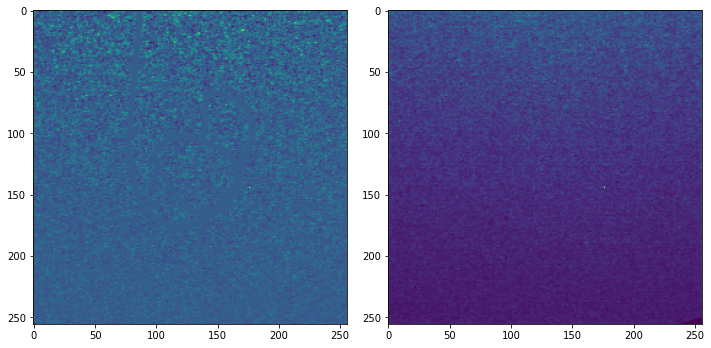

In [19]:

   #Ghost Imaging
    
#     ghost1=np.ndarray(shape=(256,256),dtype=np.float32)
#     ghost2=np.ndarray(shape=(256,256),dtype=np.float32)
#     term1_matrix=np.ndarray(shape=(256,256),dtype=np.float32)
#     term2_matrix=np.ndarray(shape=(256,256),dtype=np.float32)
#     term3_matrix=np.ndarray(shape=(256,256),dtype=np.float32)
start_time=time.time()
ghost1 = np.zeros([256,256])
ghost2 = np.zeros([256,256])
# term1_matrix = np.zeros([256,256])
# term2_matrix = np.zeros([256,256])
# term3_matrix = np.zeros([256,256])



nframes=len(pulses)/2



for i in range(ghost1.shape[0]):
    for j in range(ghost1.shape[1]):
        term1=0
        term2=0
        term3=0
        term=0
        print('[i,j]:','[',i,',',j,']')
        for pulse in range(0,len(pulses),2):

            term1+=globals()['no_obj_data_sum'+str(pulse+1)]*globals()['img_obj'+str(pulse)][i,j]
            term += globals()['obj_data_sum'+str(pulse)]*globals()['img_no_obj'+str(pulse+1)][i,j]
            term2+=globals()['no_obj_data_sum'+str(pulse+1)]
            term3+=globals()['img_obj'+str(pulse)][i,j]

        ghost1[i,j] = term1/nframes-(term2*term3)/ (nframes ** 2)
        ghost2[i,j] = term/nframes

end_time=time.time()
delta_t=end_time-start_time
print(delta_t, 's')
fig, (ax1,ax2) = plt.subplots(ncols=2,nrows=1, figsize=(10, 10), facecolor='w')

#     ax1.imshow(img_obj, norm=mpl.colors.LogNorm())

#     ax2.imshow(img_no_obj, norm=mpl.colors.LogNorm())

#h=ax[0].imshow(ghost1, norm=mpl.colors.LogNorm())
ax1.imshow(ghost1)
#     fig.colorbar(_)
ax2.imshow(ghost2)

fig.tight_layout()
fig.savefig(file_tag+'_ghosts_pair.png', bbox_inches='tight')
plt.show() 

In [28]:
ten_files = []
for file in files:
    if int(file.split('-')[-1].split('.')[0])<10:
        ten_files.append(file)
ten_files

['/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/Beamline_Cycles-2hr_W0028_H07-210806-140732-0.csv',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/Beamline_Cycles-2hr_W0028_H07-210806-140732-1.csv',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/Beamline_Cycles-2hr_W0028_H07-210806-140732-2.csv',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/Beamline_Cycles-2hr_W0028_H07-210806-140732-3.csv',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/Beamline_Cycles-2hr_W0028_H07-210806-140732-4.csv',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/Beamline_Cycles-2hr_W0028_H07-210806-140732-5.csv',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/Beamline_Cycles-2hr_W0028_H07-210806-140732-6.csv',
 '/mnt/e/Google_Drive_Backup_E/Data/Beamline_Data/Wire_2hr_Run/csv files/Beamline_Cycles-2hr_W0028_H07-210806-140732-7.csv',


[i,j]: [ 0 , 0 ]
[i,j]: [ 0 , 1 ]
[i,j]: [ 0 , 2 ]
[i,j]: [ 0 , 3 ]
[i,j]: [ 0 , 4 ]
[i,j]: [ 0 , 5 ]
[i,j]: [ 0 , 6 ]
[i,j]: [ 0 , 7 ]
[i,j]: [ 0 , 8 ]
[i,j]: [ 0 , 9 ]
[i,j]: [ 0 , 10 ]
[i,j]: [ 0 , 11 ]
[i,j]: [ 0 , 12 ]
[i,j]: [ 0 , 13 ]
[i,j]: [ 0 , 14 ]
[i,j]: [ 0 , 15 ]
[i,j]: [ 0 , 16 ]
[i,j]: [ 0 , 17 ]
[i,j]: [ 0 , 18 ]
[i,j]: [ 0 , 19 ]
[i,j]: [ 0 , 20 ]
[i,j]: [ 0 , 21 ]
[i,j]: [ 0 , 22 ]
[i,j]: [ 0 , 23 ]
[i,j]: [ 0 , 24 ]
[i,j]: [ 0 , 25 ]
[i,j]: [ 0 , 26 ]
[i,j]: [ 0 , 27 ]
[i,j]: [ 0 , 28 ]
[i,j]: [ 0 , 29 ]
[i,j]: [ 0 , 30 ]
[i,j]: [ 0 , 31 ]
[i,j]: [ 0 , 32 ]
[i,j]: [ 0 , 33 ]
[i,j]: [ 0 , 34 ]
[i,j]: [ 0 , 35 ]
[i,j]: [ 0 , 36 ]
[i,j]: [ 0 , 37 ]
[i,j]: [ 0 , 38 ]
[i,j]: [ 0 , 39 ]
[i,j]: [ 0 , 40 ]
[i,j]: [ 0 , 41 ]
[i,j]: [ 0 , 42 ]
[i,j]: [ 0 , 43 ]
[i,j]: [ 0 , 44 ]
[i,j]: [ 0 , 45 ]
[i,j]: [ 0 , 46 ]
[i,j]: [ 0 , 47 ]
[i,j]: [ 0 , 48 ]
[i,j]: [ 0 , 49 ]
[i,j]: [ 0 , 50 ]
[i,j]: [ 0 , 51 ]
[i,j]: [ 0 , 52 ]
[i,j]: [ 0 , 53 ]
[i,j]: [ 0 , 54 ]
[i,j]: [ 0 , 55 ]
[i

[i,j]: [ 1 , 188 ]
[i,j]: [ 1 , 189 ]
[i,j]: [ 1 , 190 ]
[i,j]: [ 1 , 191 ]
[i,j]: [ 1 , 192 ]
[i,j]: [ 1 , 193 ]
[i,j]: [ 1 , 194 ]
[i,j]: [ 1 , 195 ]
[i,j]: [ 1 , 196 ]
[i,j]: [ 1 , 197 ]
[i,j]: [ 1 , 198 ]
[i,j]: [ 1 , 199 ]
[i,j]: [ 1 , 200 ]
[i,j]: [ 1 , 201 ]
[i,j]: [ 1 , 202 ]
[i,j]: [ 1 , 203 ]
[i,j]: [ 1 , 204 ]
[i,j]: [ 1 , 205 ]
[i,j]: [ 1 , 206 ]
[i,j]: [ 1 , 207 ]
[i,j]: [ 1 , 208 ]
[i,j]: [ 1 , 209 ]
[i,j]: [ 1 , 210 ]
[i,j]: [ 1 , 211 ]
[i,j]: [ 1 , 212 ]
[i,j]: [ 1 , 213 ]
[i,j]: [ 1 , 214 ]
[i,j]: [ 1 , 215 ]
[i,j]: [ 1 , 216 ]
[i,j]: [ 1 , 217 ]
[i,j]: [ 1 , 218 ]
[i,j]: [ 1 , 219 ]
[i,j]: [ 1 , 220 ]
[i,j]: [ 1 , 221 ]
[i,j]: [ 1 , 222 ]
[i,j]: [ 1 , 223 ]
[i,j]: [ 1 , 224 ]
[i,j]: [ 1 , 225 ]
[i,j]: [ 1 , 226 ]
[i,j]: [ 1 , 227 ]
[i,j]: [ 1 , 228 ]
[i,j]: [ 1 , 229 ]
[i,j]: [ 1 , 230 ]
[i,j]: [ 1 , 231 ]
[i,j]: [ 1 , 232 ]
[i,j]: [ 1 , 233 ]
[i,j]: [ 1 , 234 ]
[i,j]: [ 1 , 235 ]
[i,j]: [ 1 , 236 ]
[i,j]: [ 1 , 237 ]
[i,j]: [ 1 , 238 ]
[i,j]: [ 1 , 239 ]
[i,j]: [ 1 ,

[i,j]: [ 3 , 120 ]
[i,j]: [ 3 , 121 ]
[i,j]: [ 3 , 122 ]
[i,j]: [ 3 , 123 ]
[i,j]: [ 3 , 124 ]
[i,j]: [ 3 , 125 ]
[i,j]: [ 3 , 126 ]
[i,j]: [ 3 , 127 ]
[i,j]: [ 3 , 128 ]
[i,j]: [ 3 , 129 ]
[i,j]: [ 3 , 130 ]
[i,j]: [ 3 , 131 ]
[i,j]: [ 3 , 132 ]
[i,j]: [ 3 , 133 ]
[i,j]: [ 3 , 134 ]
[i,j]: [ 3 , 135 ]
[i,j]: [ 3 , 136 ]
[i,j]: [ 3 , 137 ]
[i,j]: [ 3 , 138 ]
[i,j]: [ 3 , 139 ]
[i,j]: [ 3 , 140 ]
[i,j]: [ 3 , 141 ]
[i,j]: [ 3 , 142 ]
[i,j]: [ 3 , 143 ]
[i,j]: [ 3 , 144 ]
[i,j]: [ 3 , 145 ]
[i,j]: [ 3 , 146 ]
[i,j]: [ 3 , 147 ]
[i,j]: [ 3 , 148 ]
[i,j]: [ 3 , 149 ]
[i,j]: [ 3 , 150 ]
[i,j]: [ 3 , 151 ]
[i,j]: [ 3 , 152 ]
[i,j]: [ 3 , 153 ]
[i,j]: [ 3 , 154 ]
[i,j]: [ 3 , 155 ]
[i,j]: [ 3 , 156 ]
[i,j]: [ 3 , 157 ]
[i,j]: [ 3 , 158 ]
[i,j]: [ 3 , 159 ]
[i,j]: [ 3 , 160 ]
[i,j]: [ 3 , 161 ]
[i,j]: [ 3 , 162 ]
[i,j]: [ 3 , 163 ]
[i,j]: [ 3 , 164 ]
[i,j]: [ 3 , 165 ]
[i,j]: [ 3 , 166 ]
[i,j]: [ 3 , 167 ]
[i,j]: [ 3 , 168 ]
[i,j]: [ 3 , 169 ]
[i,j]: [ 3 , 170 ]
[i,j]: [ 3 , 171 ]
[i,j]: [ 3 ,

[i,j]: [ 5 , 50 ]
[i,j]: [ 5 , 51 ]
[i,j]: [ 5 , 52 ]
[i,j]: [ 5 , 53 ]
[i,j]: [ 5 , 54 ]
[i,j]: [ 5 , 55 ]
[i,j]: [ 5 , 56 ]
[i,j]: [ 5 , 57 ]
[i,j]: [ 5 , 58 ]
[i,j]: [ 5 , 59 ]
[i,j]: [ 5 , 60 ]
[i,j]: [ 5 , 61 ]
[i,j]: [ 5 , 62 ]
[i,j]: [ 5 , 63 ]
[i,j]: [ 5 , 64 ]
[i,j]: [ 5 , 65 ]
[i,j]: [ 5 , 66 ]
[i,j]: [ 5 , 67 ]
[i,j]: [ 5 , 68 ]
[i,j]: [ 5 , 69 ]
[i,j]: [ 5 , 70 ]
[i,j]: [ 5 , 71 ]
[i,j]: [ 5 , 72 ]
[i,j]: [ 5 , 73 ]
[i,j]: [ 5 , 74 ]
[i,j]: [ 5 , 75 ]
[i,j]: [ 5 , 76 ]
[i,j]: [ 5 , 77 ]
[i,j]: [ 5 , 78 ]
[i,j]: [ 5 , 79 ]
[i,j]: [ 5 , 80 ]
[i,j]: [ 5 , 81 ]
[i,j]: [ 5 , 82 ]
[i,j]: [ 5 , 83 ]
[i,j]: [ 5 , 84 ]
[i,j]: [ 5 , 85 ]
[i,j]: [ 5 , 86 ]
[i,j]: [ 5 , 87 ]
[i,j]: [ 5 , 88 ]
[i,j]: [ 5 , 89 ]
[i,j]: [ 5 , 90 ]
[i,j]: [ 5 , 91 ]
[i,j]: [ 5 , 92 ]
[i,j]: [ 5 , 93 ]
[i,j]: [ 5 , 94 ]
[i,j]: [ 5 , 95 ]
[i,j]: [ 5 , 96 ]
[i,j]: [ 5 , 97 ]
[i,j]: [ 5 , 98 ]
[i,j]: [ 5 , 99 ]
[i,j]: [ 5 , 100 ]
[i,j]: [ 5 , 101 ]
[i,j]: [ 5 , 102 ]
[i,j]: [ 5 , 103 ]
[i,j]: [ 5 , 104 ]
[i,j]

[i,j]: [ 6 , 234 ]
[i,j]: [ 6 , 235 ]
[i,j]: [ 6 , 236 ]
[i,j]: [ 6 , 237 ]
[i,j]: [ 6 , 238 ]
[i,j]: [ 6 , 239 ]
[i,j]: [ 6 , 240 ]
[i,j]: [ 6 , 241 ]
[i,j]: [ 6 , 242 ]
[i,j]: [ 6 , 243 ]
[i,j]: [ 6 , 244 ]
[i,j]: [ 6 , 245 ]
[i,j]: [ 6 , 246 ]
[i,j]: [ 6 , 247 ]
[i,j]: [ 6 , 248 ]
[i,j]: [ 6 , 249 ]
[i,j]: [ 6 , 250 ]
[i,j]: [ 6 , 251 ]
[i,j]: [ 6 , 252 ]
[i,j]: [ 6 , 253 ]
[i,j]: [ 6 , 254 ]
[i,j]: [ 6 , 255 ]
[i,j]: [ 7 , 0 ]
[i,j]: [ 7 , 1 ]
[i,j]: [ 7 , 2 ]
[i,j]: [ 7 , 3 ]
[i,j]: [ 7 , 4 ]
[i,j]: [ 7 , 5 ]
[i,j]: [ 7 , 6 ]
[i,j]: [ 7 , 7 ]
[i,j]: [ 7 , 8 ]
[i,j]: [ 7 , 9 ]
[i,j]: [ 7 , 10 ]
[i,j]: [ 7 , 11 ]
[i,j]: [ 7 , 12 ]
[i,j]: [ 7 , 13 ]
[i,j]: [ 7 , 14 ]
[i,j]: [ 7 , 15 ]
[i,j]: [ 7 , 16 ]
[i,j]: [ 7 , 17 ]
[i,j]: [ 7 , 18 ]
[i,j]: [ 7 , 19 ]
[i,j]: [ 7 , 20 ]
[i,j]: [ 7 , 21 ]
[i,j]: [ 7 , 22 ]
[i,j]: [ 7 , 23 ]
[i,j]: [ 7 , 24 ]
[i,j]: [ 7 , 25 ]
[i,j]: [ 7 , 26 ]
[i,j]: [ 7 , 27 ]
[i,j]: [ 7 , 28 ]
[i,j]: [ 7 , 29 ]
[i,j]: [ 7 , 30 ]
[i,j]: [ 7 , 31 ]
[i,j]: [ 7 , 32 

[i,j]: [ 8 , 166 ]
[i,j]: [ 8 , 167 ]
[i,j]: [ 8 , 168 ]
[i,j]: [ 8 , 169 ]
[i,j]: [ 8 , 170 ]
[i,j]: [ 8 , 171 ]
[i,j]: [ 8 , 172 ]
[i,j]: [ 8 , 173 ]
[i,j]: [ 8 , 174 ]
[i,j]: [ 8 , 175 ]
[i,j]: [ 8 , 176 ]
[i,j]: [ 8 , 177 ]
[i,j]: [ 8 , 178 ]
[i,j]: [ 8 , 179 ]
[i,j]: [ 8 , 180 ]
[i,j]: [ 8 , 181 ]
[i,j]: [ 8 , 182 ]
[i,j]: [ 8 , 183 ]
[i,j]: [ 8 , 184 ]
[i,j]: [ 8 , 185 ]
[i,j]: [ 8 , 186 ]
[i,j]: [ 8 , 187 ]
[i,j]: [ 8 , 188 ]
[i,j]: [ 8 , 189 ]
[i,j]: [ 8 , 190 ]
[i,j]: [ 8 , 191 ]
[i,j]: [ 8 , 192 ]
[i,j]: [ 8 , 193 ]
[i,j]: [ 8 , 194 ]
[i,j]: [ 8 , 195 ]
[i,j]: [ 8 , 196 ]
[i,j]: [ 8 , 197 ]
[i,j]: [ 8 , 198 ]
[i,j]: [ 8 , 199 ]
[i,j]: [ 8 , 200 ]
[i,j]: [ 8 , 201 ]
[i,j]: [ 8 , 202 ]
[i,j]: [ 8 , 203 ]
[i,j]: [ 8 , 204 ]
[i,j]: [ 8 , 205 ]
[i,j]: [ 8 , 206 ]
[i,j]: [ 8 , 207 ]
[i,j]: [ 8 , 208 ]
[i,j]: [ 8 , 209 ]
[i,j]: [ 8 , 210 ]
[i,j]: [ 8 , 211 ]
[i,j]: [ 8 , 212 ]
[i,j]: [ 8 , 213 ]
[i,j]: [ 8 , 214 ]
[i,j]: [ 8 , 215 ]
[i,j]: [ 8 , 216 ]
[i,j]: [ 8 , 217 ]
[i,j]: [ 8 ,

[i,j]: [ 10 , 92 ]
[i,j]: [ 10 , 93 ]
[i,j]: [ 10 , 94 ]
[i,j]: [ 10 , 95 ]
[i,j]: [ 10 , 96 ]
[i,j]: [ 10 , 97 ]
[i,j]: [ 10 , 98 ]
[i,j]: [ 10 , 99 ]
[i,j]: [ 10 , 100 ]
[i,j]: [ 10 , 101 ]
[i,j]: [ 10 , 102 ]
[i,j]: [ 10 , 103 ]
[i,j]: [ 10 , 104 ]
[i,j]: [ 10 , 105 ]
[i,j]: [ 10 , 106 ]
[i,j]: [ 10 , 107 ]
[i,j]: [ 10 , 108 ]
[i,j]: [ 10 , 109 ]
[i,j]: [ 10 , 110 ]
[i,j]: [ 10 , 111 ]
[i,j]: [ 10 , 112 ]
[i,j]: [ 10 , 113 ]
[i,j]: [ 10 , 114 ]
[i,j]: [ 10 , 115 ]
[i,j]: [ 10 , 116 ]
[i,j]: [ 10 , 117 ]
[i,j]: [ 10 , 118 ]
[i,j]: [ 10 , 119 ]
[i,j]: [ 10 , 120 ]
[i,j]: [ 10 , 121 ]
[i,j]: [ 10 , 122 ]
[i,j]: [ 10 , 123 ]
[i,j]: [ 10 , 124 ]
[i,j]: [ 10 , 125 ]
[i,j]: [ 10 , 126 ]
[i,j]: [ 10 , 127 ]
[i,j]: [ 10 , 128 ]
[i,j]: [ 10 , 129 ]
[i,j]: [ 10 , 130 ]
[i,j]: [ 10 , 131 ]
[i,j]: [ 10 , 132 ]
[i,j]: [ 10 , 133 ]
[i,j]: [ 10 , 134 ]
[i,j]: [ 10 , 135 ]
[i,j]: [ 10 , 136 ]
[i,j]: [ 10 , 137 ]
[i,j]: [ 10 , 138 ]
[i,j]: [ 10 , 139 ]
[i,j]: [ 10 , 140 ]
[i,j]: [ 10 , 141 ]
[i,j]: [

[i,j]: [ 11 , 252 ]
[i,j]: [ 11 , 253 ]
[i,j]: [ 11 , 254 ]
[i,j]: [ 11 , 255 ]
[i,j]: [ 12 , 0 ]
[i,j]: [ 12 , 1 ]
[i,j]: [ 12 , 2 ]
[i,j]: [ 12 , 3 ]
[i,j]: [ 12 , 4 ]
[i,j]: [ 12 , 5 ]
[i,j]: [ 12 , 6 ]
[i,j]: [ 12 , 7 ]
[i,j]: [ 12 , 8 ]
[i,j]: [ 12 , 9 ]
[i,j]: [ 12 , 10 ]
[i,j]: [ 12 , 11 ]
[i,j]: [ 12 , 12 ]
[i,j]: [ 12 , 13 ]
[i,j]: [ 12 , 14 ]
[i,j]: [ 12 , 15 ]
[i,j]: [ 12 , 16 ]
[i,j]: [ 12 , 17 ]
[i,j]: [ 12 , 18 ]
[i,j]: [ 12 , 19 ]
[i,j]: [ 12 , 20 ]
[i,j]: [ 12 , 21 ]
[i,j]: [ 12 , 22 ]
[i,j]: [ 12 , 23 ]
[i,j]: [ 12 , 24 ]
[i,j]: [ 12 , 25 ]
[i,j]: [ 12 , 26 ]
[i,j]: [ 12 , 27 ]
[i,j]: [ 12 , 28 ]
[i,j]: [ 12 , 29 ]
[i,j]: [ 12 , 30 ]
[i,j]: [ 12 , 31 ]
[i,j]: [ 12 , 32 ]
[i,j]: [ 12 , 33 ]
[i,j]: [ 12 , 34 ]
[i,j]: [ 12 , 35 ]
[i,j]: [ 12 , 36 ]
[i,j]: [ 12 , 37 ]
[i,j]: [ 12 , 38 ]
[i,j]: [ 12 , 39 ]
[i,j]: [ 12 , 40 ]
[i,j]: [ 12 , 41 ]
[i,j]: [ 12 , 42 ]
[i,j]: [ 12 , 43 ]
[i,j]: [ 12 , 44 ]
[i,j]: [ 12 , 45 ]
[i,j]: [ 12 , 46 ]
[i,j]: [ 12 , 47 ]
[i,j]: [ 12 , 48 ]

[i,j]: [ 13 , 162 ]
[i,j]: [ 13 , 163 ]
[i,j]: [ 13 , 164 ]
[i,j]: [ 13 , 165 ]
[i,j]: [ 13 , 166 ]
[i,j]: [ 13 , 167 ]
[i,j]: [ 13 , 168 ]
[i,j]: [ 13 , 169 ]
[i,j]: [ 13 , 170 ]
[i,j]: [ 13 , 171 ]
[i,j]: [ 13 , 172 ]
[i,j]: [ 13 , 173 ]
[i,j]: [ 13 , 174 ]
[i,j]: [ 13 , 175 ]
[i,j]: [ 13 , 176 ]
[i,j]: [ 13 , 177 ]
[i,j]: [ 13 , 178 ]
[i,j]: [ 13 , 179 ]
[i,j]: [ 13 , 180 ]
[i,j]: [ 13 , 181 ]
[i,j]: [ 13 , 182 ]
[i,j]: [ 13 , 183 ]
[i,j]: [ 13 , 184 ]
[i,j]: [ 13 , 185 ]
[i,j]: [ 13 , 186 ]
[i,j]: [ 13 , 187 ]
[i,j]: [ 13 , 188 ]
[i,j]: [ 13 , 189 ]
[i,j]: [ 13 , 190 ]
[i,j]: [ 13 , 191 ]
[i,j]: [ 13 , 192 ]
[i,j]: [ 13 , 193 ]
[i,j]: [ 13 , 194 ]
[i,j]: [ 13 , 195 ]
[i,j]: [ 13 , 196 ]
[i,j]: [ 13 , 197 ]
[i,j]: [ 13 , 198 ]
[i,j]: [ 13 , 199 ]
[i,j]: [ 13 , 200 ]
[i,j]: [ 13 , 201 ]
[i,j]: [ 13 , 202 ]
[i,j]: [ 13 , 203 ]
[i,j]: [ 13 , 204 ]
[i,j]: [ 13 , 205 ]
[i,j]: [ 13 , 206 ]
[i,j]: [ 13 , 207 ]
[i,j]: [ 13 , 208 ]
[i,j]: [ 13 , 209 ]
[i,j]: [ 13 , 210 ]
[i,j]: [ 13 , 211 ]


[i,j]: [ 15 , 70 ]
[i,j]: [ 15 , 71 ]
[i,j]: [ 15 , 72 ]
[i,j]: [ 15 , 73 ]
[i,j]: [ 15 , 74 ]
[i,j]: [ 15 , 75 ]
[i,j]: [ 15 , 76 ]
[i,j]: [ 15 , 77 ]
[i,j]: [ 15 , 78 ]
[i,j]: [ 15 , 79 ]
[i,j]: [ 15 , 80 ]
[i,j]: [ 15 , 81 ]
[i,j]: [ 15 , 82 ]
[i,j]: [ 15 , 83 ]
[i,j]: [ 15 , 84 ]
[i,j]: [ 15 , 85 ]
[i,j]: [ 15 , 86 ]
[i,j]: [ 15 , 87 ]
[i,j]: [ 15 , 88 ]
[i,j]: [ 15 , 89 ]
[i,j]: [ 15 , 90 ]
[i,j]: [ 15 , 91 ]
[i,j]: [ 15 , 92 ]
[i,j]: [ 15 , 93 ]
[i,j]: [ 15 , 94 ]
[i,j]: [ 15 , 95 ]
[i,j]: [ 15 , 96 ]
[i,j]: [ 15 , 97 ]
[i,j]: [ 15 , 98 ]
[i,j]: [ 15 , 99 ]
[i,j]: [ 15 , 100 ]
[i,j]: [ 15 , 101 ]
[i,j]: [ 15 , 102 ]
[i,j]: [ 15 , 103 ]
[i,j]: [ 15 , 104 ]
[i,j]: [ 15 , 105 ]
[i,j]: [ 15 , 106 ]
[i,j]: [ 15 , 107 ]
[i,j]: [ 15 , 108 ]
[i,j]: [ 15 , 109 ]
[i,j]: [ 15 , 110 ]
[i,j]: [ 15 , 111 ]
[i,j]: [ 15 , 112 ]
[i,j]: [ 15 , 113 ]
[i,j]: [ 15 , 114 ]
[i,j]: [ 15 , 115 ]
[i,j]: [ 15 , 116 ]
[i,j]: [ 15 , 117 ]
[i,j]: [ 15 , 118 ]
[i,j]: [ 15 , 119 ]
[i,j]: [ 15 , 120 ]
[i,j]: [ 1

[i,j]: [ 16 , 232 ]
[i,j]: [ 16 , 233 ]
[i,j]: [ 16 , 234 ]
[i,j]: [ 16 , 235 ]
[i,j]: [ 16 , 236 ]
[i,j]: [ 16 , 237 ]
[i,j]: [ 16 , 238 ]
[i,j]: [ 16 , 239 ]
[i,j]: [ 16 , 240 ]
[i,j]: [ 16 , 241 ]
[i,j]: [ 16 , 242 ]
[i,j]: [ 16 , 243 ]
[i,j]: [ 16 , 244 ]
[i,j]: [ 16 , 245 ]
[i,j]: [ 16 , 246 ]
[i,j]: [ 16 , 247 ]
[i,j]: [ 16 , 248 ]
[i,j]: [ 16 , 249 ]
[i,j]: [ 16 , 250 ]
[i,j]: [ 16 , 251 ]
[i,j]: [ 16 , 252 ]
[i,j]: [ 16 , 253 ]
[i,j]: [ 16 , 254 ]
[i,j]: [ 16 , 255 ]
[i,j]: [ 17 , 0 ]
[i,j]: [ 17 , 1 ]
[i,j]: [ 17 , 2 ]
[i,j]: [ 17 , 3 ]
[i,j]: [ 17 , 4 ]
[i,j]: [ 17 , 5 ]
[i,j]: [ 17 , 6 ]
[i,j]: [ 17 , 7 ]
[i,j]: [ 17 , 8 ]
[i,j]: [ 17 , 9 ]
[i,j]: [ 17 , 10 ]
[i,j]: [ 17 , 11 ]
[i,j]: [ 17 , 12 ]
[i,j]: [ 17 , 13 ]
[i,j]: [ 17 , 14 ]
[i,j]: [ 17 , 15 ]
[i,j]: [ 17 , 16 ]
[i,j]: [ 17 , 17 ]
[i,j]: [ 17 , 18 ]
[i,j]: [ 17 , 19 ]
[i,j]: [ 17 , 20 ]
[i,j]: [ 17 , 21 ]
[i,j]: [ 17 , 22 ]
[i,j]: [ 17 , 23 ]
[i,j]: [ 17 , 24 ]
[i,j]: [ 17 , 25 ]
[i,j]: [ 17 , 26 ]
[i,j]: [ 17 , 27 

[i,j]: [ 18 , 142 ]
[i,j]: [ 18 , 143 ]
[i,j]: [ 18 , 144 ]
[i,j]: [ 18 , 145 ]
[i,j]: [ 18 , 146 ]
[i,j]: [ 18 , 147 ]
[i,j]: [ 18 , 148 ]
[i,j]: [ 18 , 149 ]
[i,j]: [ 18 , 150 ]
[i,j]: [ 18 , 151 ]
[i,j]: [ 18 , 152 ]
[i,j]: [ 18 , 153 ]
[i,j]: [ 18 , 154 ]
[i,j]: [ 18 , 155 ]
[i,j]: [ 18 , 156 ]
[i,j]: [ 18 , 157 ]
[i,j]: [ 18 , 158 ]
[i,j]: [ 18 , 159 ]
[i,j]: [ 18 , 160 ]
[i,j]: [ 18 , 161 ]
[i,j]: [ 18 , 162 ]
[i,j]: [ 18 , 163 ]
[i,j]: [ 18 , 164 ]
[i,j]: [ 18 , 165 ]
[i,j]: [ 18 , 166 ]
[i,j]: [ 18 , 167 ]
[i,j]: [ 18 , 168 ]
[i,j]: [ 18 , 169 ]
[i,j]: [ 18 , 170 ]
[i,j]: [ 18 , 171 ]
[i,j]: [ 18 , 172 ]
[i,j]: [ 18 , 173 ]
[i,j]: [ 18 , 174 ]
[i,j]: [ 18 , 175 ]
[i,j]: [ 18 , 176 ]
[i,j]: [ 18 , 177 ]
[i,j]: [ 18 , 178 ]
[i,j]: [ 18 , 179 ]
[i,j]: [ 18 , 180 ]
[i,j]: [ 18 , 181 ]
[i,j]: [ 18 , 182 ]
[i,j]: [ 18 , 183 ]
[i,j]: [ 18 , 184 ]
[i,j]: [ 18 , 185 ]
[i,j]: [ 18 , 186 ]
[i,j]: [ 18 , 187 ]
[i,j]: [ 18 , 188 ]
[i,j]: [ 18 , 189 ]
[i,j]: [ 18 , 190 ]
[i,j]: [ 18 , 191 ]


[i,j]: [ 20 , 50 ]
[i,j]: [ 20 , 51 ]
[i,j]: [ 20 , 52 ]
[i,j]: [ 20 , 53 ]
[i,j]: [ 20 , 54 ]
[i,j]: [ 20 , 55 ]
[i,j]: [ 20 , 56 ]
[i,j]: [ 20 , 57 ]
[i,j]: [ 20 , 58 ]
[i,j]: [ 20 , 59 ]
[i,j]: [ 20 , 60 ]
[i,j]: [ 20 , 61 ]
[i,j]: [ 20 , 62 ]
[i,j]: [ 20 , 63 ]
[i,j]: [ 20 , 64 ]
[i,j]: [ 20 , 65 ]
[i,j]: [ 20 , 66 ]
[i,j]: [ 20 , 67 ]
[i,j]: [ 20 , 68 ]
[i,j]: [ 20 , 69 ]
[i,j]: [ 20 , 70 ]
[i,j]: [ 20 , 71 ]
[i,j]: [ 20 , 72 ]
[i,j]: [ 20 , 73 ]
[i,j]: [ 20 , 74 ]
[i,j]: [ 20 , 75 ]
[i,j]: [ 20 , 76 ]
[i,j]: [ 20 , 77 ]
[i,j]: [ 20 , 78 ]
[i,j]: [ 20 , 79 ]
[i,j]: [ 20 , 80 ]
[i,j]: [ 20 , 81 ]
[i,j]: [ 20 , 82 ]
[i,j]: [ 20 , 83 ]
[i,j]: [ 20 , 84 ]
[i,j]: [ 20 , 85 ]
[i,j]: [ 20 , 86 ]
[i,j]: [ 20 , 87 ]
[i,j]: [ 20 , 88 ]
[i,j]: [ 20 , 89 ]
[i,j]: [ 20 , 90 ]
[i,j]: [ 20 , 91 ]
[i,j]: [ 20 , 92 ]
[i,j]: [ 20 , 93 ]
[i,j]: [ 20 , 94 ]
[i,j]: [ 20 , 95 ]
[i,j]: [ 20 , 96 ]
[i,j]: [ 20 , 97 ]
[i,j]: [ 20 , 98 ]
[i,j]: [ 20 , 99 ]
[i,j]: [ 20 , 100 ]
[i,j]: [ 20 , 101 ]
[i,j]: [ 2

[i,j]: [ 21 , 212 ]
[i,j]: [ 21 , 213 ]
[i,j]: [ 21 , 214 ]
[i,j]: [ 21 , 215 ]
[i,j]: [ 21 , 216 ]
[i,j]: [ 21 , 217 ]
[i,j]: [ 21 , 218 ]
[i,j]: [ 21 , 219 ]
[i,j]: [ 21 , 220 ]
[i,j]: [ 21 , 221 ]
[i,j]: [ 21 , 222 ]
[i,j]: [ 21 , 223 ]
[i,j]: [ 21 , 224 ]
[i,j]: [ 21 , 225 ]
[i,j]: [ 21 , 226 ]
[i,j]: [ 21 , 227 ]
[i,j]: [ 21 , 228 ]
[i,j]: [ 21 , 229 ]
[i,j]: [ 21 , 230 ]
[i,j]: [ 21 , 231 ]
[i,j]: [ 21 , 232 ]
[i,j]: [ 21 , 233 ]
[i,j]: [ 21 , 234 ]
[i,j]: [ 21 , 235 ]
[i,j]: [ 21 , 236 ]
[i,j]: [ 21 , 237 ]
[i,j]: [ 21 , 238 ]
[i,j]: [ 21 , 239 ]
[i,j]: [ 21 , 240 ]
[i,j]: [ 21 , 241 ]
[i,j]: [ 21 , 242 ]
[i,j]: [ 21 , 243 ]
[i,j]: [ 21 , 244 ]
[i,j]: [ 21 , 245 ]
[i,j]: [ 21 , 246 ]
[i,j]: [ 21 , 247 ]
[i,j]: [ 21 , 248 ]
[i,j]: [ 21 , 249 ]
[i,j]: [ 21 , 250 ]
[i,j]: [ 21 , 251 ]
[i,j]: [ 21 , 252 ]
[i,j]: [ 21 , 253 ]
[i,j]: [ 21 , 254 ]
[i,j]: [ 21 , 255 ]
[i,j]: [ 22 , 0 ]
[i,j]: [ 22 , 1 ]
[i,j]: [ 22 , 2 ]
[i,j]: [ 22 , 3 ]
[i,j]: [ 22 , 4 ]
[i,j]: [ 22 , 5 ]
[i,j]: [ 22 

[i,j]: [ 23 , 122 ]
[i,j]: [ 23 , 123 ]
[i,j]: [ 23 , 124 ]
[i,j]: [ 23 , 125 ]
[i,j]: [ 23 , 126 ]
[i,j]: [ 23 , 127 ]
[i,j]: [ 23 , 128 ]
[i,j]: [ 23 , 129 ]
[i,j]: [ 23 , 130 ]
[i,j]: [ 23 , 131 ]
[i,j]: [ 23 , 132 ]
[i,j]: [ 23 , 133 ]
[i,j]: [ 23 , 134 ]
[i,j]: [ 23 , 135 ]
[i,j]: [ 23 , 136 ]
[i,j]: [ 23 , 137 ]
[i,j]: [ 23 , 138 ]
[i,j]: [ 23 , 139 ]
[i,j]: [ 23 , 140 ]
[i,j]: [ 23 , 141 ]
[i,j]: [ 23 , 142 ]
[i,j]: [ 23 , 143 ]
[i,j]: [ 23 , 144 ]
[i,j]: [ 23 , 145 ]
[i,j]: [ 23 , 146 ]
[i,j]: [ 23 , 147 ]
[i,j]: [ 23 , 148 ]
[i,j]: [ 23 , 149 ]
[i,j]: [ 23 , 150 ]
[i,j]: [ 23 , 151 ]
[i,j]: [ 23 , 152 ]
[i,j]: [ 23 , 153 ]
[i,j]: [ 23 , 154 ]
[i,j]: [ 23 , 155 ]
[i,j]: [ 23 , 156 ]
[i,j]: [ 23 , 157 ]
[i,j]: [ 23 , 158 ]
[i,j]: [ 23 , 159 ]
[i,j]: [ 23 , 160 ]
[i,j]: [ 23 , 161 ]
[i,j]: [ 23 , 162 ]
[i,j]: [ 23 , 163 ]
[i,j]: [ 23 , 164 ]
[i,j]: [ 23 , 165 ]
[i,j]: [ 23 , 166 ]
[i,j]: [ 23 , 167 ]
[i,j]: [ 23 , 168 ]
[i,j]: [ 23 , 169 ]
[i,j]: [ 23 , 170 ]
[i,j]: [ 23 , 171 ]


[i,j]: [ 25 , 28 ]
[i,j]: [ 25 , 29 ]
[i,j]: [ 25 , 30 ]
[i,j]: [ 25 , 31 ]
[i,j]: [ 25 , 32 ]
[i,j]: [ 25 , 33 ]
[i,j]: [ 25 , 34 ]
[i,j]: [ 25 , 35 ]
[i,j]: [ 25 , 36 ]
[i,j]: [ 25 , 37 ]
[i,j]: [ 25 , 38 ]
[i,j]: [ 25 , 39 ]
[i,j]: [ 25 , 40 ]
[i,j]: [ 25 , 41 ]
[i,j]: [ 25 , 42 ]
[i,j]: [ 25 , 43 ]
[i,j]: [ 25 , 44 ]
[i,j]: [ 25 , 45 ]
[i,j]: [ 25 , 46 ]
[i,j]: [ 25 , 47 ]
[i,j]: [ 25 , 48 ]
[i,j]: [ 25 , 49 ]
[i,j]: [ 25 , 50 ]
[i,j]: [ 25 , 51 ]
[i,j]: [ 25 , 52 ]
[i,j]: [ 25 , 53 ]
[i,j]: [ 25 , 54 ]
[i,j]: [ 25 , 55 ]
[i,j]: [ 25 , 56 ]
[i,j]: [ 25 , 57 ]
[i,j]: [ 25 , 58 ]
[i,j]: [ 25 , 59 ]
[i,j]: [ 25 , 60 ]
[i,j]: [ 25 , 61 ]
[i,j]: [ 25 , 62 ]
[i,j]: [ 25 , 63 ]
[i,j]: [ 25 , 64 ]
[i,j]: [ 25 , 65 ]
[i,j]: [ 25 , 66 ]
[i,j]: [ 25 , 67 ]
[i,j]: [ 25 , 68 ]
[i,j]: [ 25 , 69 ]
[i,j]: [ 25 , 70 ]
[i,j]: [ 25 , 71 ]
[i,j]: [ 25 , 72 ]
[i,j]: [ 25 , 73 ]
[i,j]: [ 25 , 74 ]
[i,j]: [ 25 , 75 ]
[i,j]: [ 25 , 76 ]
[i,j]: [ 25 , 77 ]
[i,j]: [ 25 , 78 ]
[i,j]: [ 25 , 79 ]
[i,j]: [ 25 

[i,j]: [ 26 , 192 ]
[i,j]: [ 26 , 193 ]
[i,j]: [ 26 , 194 ]
[i,j]: [ 26 , 195 ]
[i,j]: [ 26 , 196 ]
[i,j]: [ 26 , 197 ]
[i,j]: [ 26 , 198 ]
[i,j]: [ 26 , 199 ]
[i,j]: [ 26 , 200 ]
[i,j]: [ 26 , 201 ]
[i,j]: [ 26 , 202 ]
[i,j]: [ 26 , 203 ]
[i,j]: [ 26 , 204 ]
[i,j]: [ 26 , 205 ]
[i,j]: [ 26 , 206 ]
[i,j]: [ 26 , 207 ]
[i,j]: [ 26 , 208 ]
[i,j]: [ 26 , 209 ]
[i,j]: [ 26 , 210 ]
[i,j]: [ 26 , 211 ]
[i,j]: [ 26 , 212 ]
[i,j]: [ 26 , 213 ]
[i,j]: [ 26 , 214 ]
[i,j]: [ 26 , 215 ]
[i,j]: [ 26 , 216 ]
[i,j]: [ 26 , 217 ]
[i,j]: [ 26 , 218 ]
[i,j]: [ 26 , 219 ]
[i,j]: [ 26 , 220 ]
[i,j]: [ 26 , 221 ]
[i,j]: [ 26 , 222 ]
[i,j]: [ 26 , 223 ]
[i,j]: [ 26 , 224 ]
[i,j]: [ 26 , 225 ]
[i,j]: [ 26 , 226 ]
[i,j]: [ 26 , 227 ]
[i,j]: [ 26 , 228 ]
[i,j]: [ 26 , 229 ]
[i,j]: [ 26 , 230 ]
[i,j]: [ 26 , 231 ]
[i,j]: [ 26 , 232 ]
[i,j]: [ 26 , 233 ]
[i,j]: [ 26 , 234 ]
[i,j]: [ 26 , 235 ]
[i,j]: [ 26 , 236 ]
[i,j]: [ 26 , 237 ]
[i,j]: [ 26 , 238 ]
[i,j]: [ 26 , 239 ]
[i,j]: [ 26 , 240 ]
[i,j]: [ 26 , 241 ]


[i,j]: [ 28 , 102 ]
[i,j]: [ 28 , 103 ]
[i,j]: [ 28 , 104 ]
[i,j]: [ 28 , 105 ]
[i,j]: [ 28 , 106 ]
[i,j]: [ 28 , 107 ]
[i,j]: [ 28 , 108 ]
[i,j]: [ 28 , 109 ]
[i,j]: [ 28 , 110 ]
[i,j]: [ 28 , 111 ]
[i,j]: [ 28 , 112 ]
[i,j]: [ 28 , 113 ]
[i,j]: [ 28 , 114 ]
[i,j]: [ 28 , 115 ]
[i,j]: [ 28 , 116 ]
[i,j]: [ 28 , 117 ]
[i,j]: [ 28 , 118 ]
[i,j]: [ 28 , 119 ]
[i,j]: [ 28 , 120 ]
[i,j]: [ 28 , 121 ]
[i,j]: [ 28 , 122 ]
[i,j]: [ 28 , 123 ]
[i,j]: [ 28 , 124 ]
[i,j]: [ 28 , 125 ]
[i,j]: [ 28 , 126 ]
[i,j]: [ 28 , 127 ]
[i,j]: [ 28 , 128 ]
[i,j]: [ 28 , 129 ]
[i,j]: [ 28 , 130 ]
[i,j]: [ 28 , 131 ]
[i,j]: [ 28 , 132 ]
[i,j]: [ 28 , 133 ]
[i,j]: [ 28 , 134 ]
[i,j]: [ 28 , 135 ]
[i,j]: [ 28 , 136 ]
[i,j]: [ 28 , 137 ]
[i,j]: [ 28 , 138 ]
[i,j]: [ 28 , 139 ]
[i,j]: [ 28 , 140 ]
[i,j]: [ 28 , 141 ]
[i,j]: [ 28 , 142 ]
[i,j]: [ 28 , 143 ]
[i,j]: [ 28 , 144 ]
[i,j]: [ 28 , 145 ]
[i,j]: [ 28 , 146 ]
[i,j]: [ 28 , 147 ]
[i,j]: [ 28 , 148 ]
[i,j]: [ 28 , 149 ]
[i,j]: [ 28 , 150 ]
[i,j]: [ 28 , 151 ]


[i,j]: [ 30 , 6 ]
[i,j]: [ 30 , 7 ]
[i,j]: [ 30 , 8 ]
[i,j]: [ 30 , 9 ]
[i,j]: [ 30 , 10 ]
[i,j]: [ 30 , 11 ]
[i,j]: [ 30 , 12 ]
[i,j]: [ 30 , 13 ]
[i,j]: [ 30 , 14 ]
[i,j]: [ 30 , 15 ]
[i,j]: [ 30 , 16 ]
[i,j]: [ 30 , 17 ]
[i,j]: [ 30 , 18 ]
[i,j]: [ 30 , 19 ]
[i,j]: [ 30 , 20 ]
[i,j]: [ 30 , 21 ]
[i,j]: [ 30 , 22 ]
[i,j]: [ 30 , 23 ]
[i,j]: [ 30 , 24 ]
[i,j]: [ 30 , 25 ]
[i,j]: [ 30 , 26 ]
[i,j]: [ 30 , 27 ]
[i,j]: [ 30 , 28 ]
[i,j]: [ 30 , 29 ]
[i,j]: [ 30 , 30 ]
[i,j]: [ 30 , 31 ]
[i,j]: [ 30 , 32 ]
[i,j]: [ 30 , 33 ]
[i,j]: [ 30 , 34 ]
[i,j]: [ 30 , 35 ]
[i,j]: [ 30 , 36 ]
[i,j]: [ 30 , 37 ]
[i,j]: [ 30 , 38 ]
[i,j]: [ 30 , 39 ]
[i,j]: [ 30 , 40 ]
[i,j]: [ 30 , 41 ]
[i,j]: [ 30 , 42 ]
[i,j]: [ 30 , 43 ]
[i,j]: [ 30 , 44 ]
[i,j]: [ 30 , 45 ]
[i,j]: [ 30 , 46 ]
[i,j]: [ 30 , 47 ]
[i,j]: [ 30 , 48 ]
[i,j]: [ 30 , 49 ]
[i,j]: [ 30 , 50 ]
[i,j]: [ 30 , 51 ]
[i,j]: [ 30 , 52 ]
[i,j]: [ 30 , 53 ]
[i,j]: [ 30 , 54 ]
[i,j]: [ 30 , 55 ]
[i,j]: [ 30 , 56 ]
[i,j]: [ 30 , 57 ]
[i,j]: [ 30 , 58

[i,j]: [ 31 , 172 ]
[i,j]: [ 31 , 173 ]
[i,j]: [ 31 , 174 ]
[i,j]: [ 31 , 175 ]
[i,j]: [ 31 , 176 ]
[i,j]: [ 31 , 177 ]
[i,j]: [ 31 , 178 ]
[i,j]: [ 31 , 179 ]
[i,j]: [ 31 , 180 ]
[i,j]: [ 31 , 181 ]
[i,j]: [ 31 , 182 ]
[i,j]: [ 31 , 183 ]
[i,j]: [ 31 , 184 ]
[i,j]: [ 31 , 185 ]
[i,j]: [ 31 , 186 ]
[i,j]: [ 31 , 187 ]
[i,j]: [ 31 , 188 ]
[i,j]: [ 31 , 189 ]
[i,j]: [ 31 , 190 ]
[i,j]: [ 31 , 191 ]
[i,j]: [ 31 , 192 ]
[i,j]: [ 31 , 193 ]
[i,j]: [ 31 , 194 ]
[i,j]: [ 31 , 195 ]
[i,j]: [ 31 , 196 ]
[i,j]: [ 31 , 197 ]
[i,j]: [ 31 , 198 ]
[i,j]: [ 31 , 199 ]
[i,j]: [ 31 , 200 ]
[i,j]: [ 31 , 201 ]
[i,j]: [ 31 , 202 ]
[i,j]: [ 31 , 203 ]
[i,j]: [ 31 , 204 ]
[i,j]: [ 31 , 205 ]
[i,j]: [ 31 , 206 ]
[i,j]: [ 31 , 207 ]
[i,j]: [ 31 , 208 ]
[i,j]: [ 31 , 209 ]
[i,j]: [ 31 , 210 ]
[i,j]: [ 31 , 211 ]
[i,j]: [ 31 , 212 ]
[i,j]: [ 31 , 213 ]
[i,j]: [ 31 , 214 ]
[i,j]: [ 31 , 215 ]
[i,j]: [ 31 , 216 ]
[i,j]: [ 31 , 217 ]
[i,j]: [ 31 , 218 ]
[i,j]: [ 31 , 219 ]
[i,j]: [ 31 , 220 ]
[i,j]: [ 31 , 221 ]


[i,j]: [ 33 , 80 ]
[i,j]: [ 33 , 81 ]
[i,j]: [ 33 , 82 ]
[i,j]: [ 33 , 83 ]
[i,j]: [ 33 , 84 ]
[i,j]: [ 33 , 85 ]
[i,j]: [ 33 , 86 ]
[i,j]: [ 33 , 87 ]
[i,j]: [ 33 , 88 ]
[i,j]: [ 33 , 89 ]
[i,j]: [ 33 , 90 ]
[i,j]: [ 33 , 91 ]
[i,j]: [ 33 , 92 ]
[i,j]: [ 33 , 93 ]
[i,j]: [ 33 , 94 ]
[i,j]: [ 33 , 95 ]
[i,j]: [ 33 , 96 ]
[i,j]: [ 33 , 97 ]
[i,j]: [ 33 , 98 ]
[i,j]: [ 33 , 99 ]
[i,j]: [ 33 , 100 ]
[i,j]: [ 33 , 101 ]
[i,j]: [ 33 , 102 ]
[i,j]: [ 33 , 103 ]
[i,j]: [ 33 , 104 ]
[i,j]: [ 33 , 105 ]
[i,j]: [ 33 , 106 ]
[i,j]: [ 33 , 107 ]
[i,j]: [ 33 , 108 ]
[i,j]: [ 33 , 109 ]
[i,j]: [ 33 , 110 ]
[i,j]: [ 33 , 111 ]
[i,j]: [ 33 , 112 ]
[i,j]: [ 33 , 113 ]
[i,j]: [ 33 , 114 ]
[i,j]: [ 33 , 115 ]
[i,j]: [ 33 , 116 ]
[i,j]: [ 33 , 117 ]
[i,j]: [ 33 , 118 ]
[i,j]: [ 33 , 119 ]
[i,j]: [ 33 , 120 ]
[i,j]: [ 33 , 121 ]
[i,j]: [ 33 , 122 ]
[i,j]: [ 33 , 123 ]
[i,j]: [ 33 , 124 ]
[i,j]: [ 33 , 125 ]
[i,j]: [ 33 , 126 ]
[i,j]: [ 33 , 127 ]
[i,j]: [ 33 , 128 ]
[i,j]: [ 33 , 129 ]
[i,j]: [ 33 , 130 ]


[i,j]: [ 34 , 242 ]
[i,j]: [ 34 , 243 ]
[i,j]: [ 34 , 244 ]
[i,j]: [ 34 , 245 ]
[i,j]: [ 34 , 246 ]
[i,j]: [ 34 , 247 ]
[i,j]: [ 34 , 248 ]
[i,j]: [ 34 , 249 ]
[i,j]: [ 34 , 250 ]
[i,j]: [ 34 , 251 ]
[i,j]: [ 34 , 252 ]
[i,j]: [ 34 , 253 ]
[i,j]: [ 34 , 254 ]
[i,j]: [ 34 , 255 ]
[i,j]: [ 35 , 0 ]
[i,j]: [ 35 , 1 ]
[i,j]: [ 35 , 2 ]
[i,j]: [ 35 , 3 ]
[i,j]: [ 35 , 4 ]
[i,j]: [ 35 , 5 ]
[i,j]: [ 35 , 6 ]
[i,j]: [ 35 , 7 ]
[i,j]: [ 35 , 8 ]
[i,j]: [ 35 , 9 ]
[i,j]: [ 35 , 10 ]
[i,j]: [ 35 , 11 ]
[i,j]: [ 35 , 12 ]
[i,j]: [ 35 , 13 ]
[i,j]: [ 35 , 14 ]
[i,j]: [ 35 , 15 ]
[i,j]: [ 35 , 16 ]
[i,j]: [ 35 , 17 ]
[i,j]: [ 35 , 18 ]
[i,j]: [ 35 , 19 ]
[i,j]: [ 35 , 20 ]
[i,j]: [ 35 , 21 ]
[i,j]: [ 35 , 22 ]
[i,j]: [ 35 , 23 ]
[i,j]: [ 35 , 24 ]
[i,j]: [ 35 , 25 ]
[i,j]: [ 35 , 26 ]
[i,j]: [ 35 , 27 ]
[i,j]: [ 35 , 28 ]
[i,j]: [ 35 , 29 ]
[i,j]: [ 35 , 30 ]
[i,j]: [ 35 , 31 ]
[i,j]: [ 35 , 32 ]
[i,j]: [ 35 , 33 ]
[i,j]: [ 35 , 34 ]
[i,j]: [ 35 , 35 ]
[i,j]: [ 35 , 36 ]
[i,j]: [ 35 , 37 ]
[i,j]: [

[i,j]: [ 36 , 152 ]
[i,j]: [ 36 , 153 ]
[i,j]: [ 36 , 154 ]
[i,j]: [ 36 , 155 ]
[i,j]: [ 36 , 156 ]
[i,j]: [ 36 , 157 ]
[i,j]: [ 36 , 158 ]
[i,j]: [ 36 , 159 ]
[i,j]: [ 36 , 160 ]
[i,j]: [ 36 , 161 ]
[i,j]: [ 36 , 162 ]
[i,j]: [ 36 , 163 ]
[i,j]: [ 36 , 164 ]
[i,j]: [ 36 , 165 ]
[i,j]: [ 36 , 166 ]
[i,j]: [ 36 , 167 ]
[i,j]: [ 36 , 168 ]
[i,j]: [ 36 , 169 ]
[i,j]: [ 36 , 170 ]
[i,j]: [ 36 , 171 ]
[i,j]: [ 36 , 172 ]
[i,j]: [ 36 , 173 ]
[i,j]: [ 36 , 174 ]
[i,j]: [ 36 , 175 ]
[i,j]: [ 36 , 176 ]
[i,j]: [ 36 , 177 ]
[i,j]: [ 36 , 178 ]
[i,j]: [ 36 , 179 ]
[i,j]: [ 36 , 180 ]
[i,j]: [ 36 , 181 ]
[i,j]: [ 36 , 182 ]
[i,j]: [ 36 , 183 ]
[i,j]: [ 36 , 184 ]
[i,j]: [ 36 , 185 ]
[i,j]: [ 36 , 186 ]
[i,j]: [ 36 , 187 ]
[i,j]: [ 36 , 188 ]
[i,j]: [ 36 , 189 ]
[i,j]: [ 36 , 190 ]
[i,j]: [ 36 , 191 ]
[i,j]: [ 36 , 192 ]
[i,j]: [ 36 , 193 ]
[i,j]: [ 36 , 194 ]
[i,j]: [ 36 , 195 ]
[i,j]: [ 36 , 196 ]
[i,j]: [ 36 , 197 ]
[i,j]: [ 36 , 198 ]
[i,j]: [ 36 , 199 ]
[i,j]: [ 36 , 200 ]
[i,j]: [ 36 , 201 ]


[i,j]: [ 38 , 60 ]
[i,j]: [ 38 , 61 ]
[i,j]: [ 38 , 62 ]
[i,j]: [ 38 , 63 ]
[i,j]: [ 38 , 64 ]
[i,j]: [ 38 , 65 ]
[i,j]: [ 38 , 66 ]
[i,j]: [ 38 , 67 ]
[i,j]: [ 38 , 68 ]
[i,j]: [ 38 , 69 ]
[i,j]: [ 38 , 70 ]
[i,j]: [ 38 , 71 ]
[i,j]: [ 38 , 72 ]
[i,j]: [ 38 , 73 ]
[i,j]: [ 38 , 74 ]
[i,j]: [ 38 , 75 ]
[i,j]: [ 38 , 76 ]
[i,j]: [ 38 , 77 ]
[i,j]: [ 38 , 78 ]
[i,j]: [ 38 , 79 ]
[i,j]: [ 38 , 80 ]
[i,j]: [ 38 , 81 ]
[i,j]: [ 38 , 82 ]
[i,j]: [ 38 , 83 ]
[i,j]: [ 38 , 84 ]
[i,j]: [ 38 , 85 ]
[i,j]: [ 38 , 86 ]
[i,j]: [ 38 , 87 ]
[i,j]: [ 38 , 88 ]
[i,j]: [ 38 , 89 ]
[i,j]: [ 38 , 90 ]
[i,j]: [ 38 , 91 ]
[i,j]: [ 38 , 92 ]
[i,j]: [ 38 , 93 ]
[i,j]: [ 38 , 94 ]
[i,j]: [ 38 , 95 ]
[i,j]: [ 38 , 96 ]
[i,j]: [ 38 , 97 ]
[i,j]: [ 38 , 98 ]
[i,j]: [ 38 , 99 ]
[i,j]: [ 38 , 100 ]
[i,j]: [ 38 , 101 ]
[i,j]: [ 38 , 102 ]
[i,j]: [ 38 , 103 ]
[i,j]: [ 38 , 104 ]
[i,j]: [ 38 , 105 ]
[i,j]: [ 38 , 106 ]
[i,j]: [ 38 , 107 ]
[i,j]: [ 38 , 108 ]
[i,j]: [ 38 , 109 ]
[i,j]: [ 38 , 110 ]
[i,j]: [ 38 , 111 ]


[i,j]: [ 39 , 222 ]
[i,j]: [ 39 , 223 ]
[i,j]: [ 39 , 224 ]
[i,j]: [ 39 , 225 ]
[i,j]: [ 39 , 226 ]
[i,j]: [ 39 , 227 ]
[i,j]: [ 39 , 228 ]
[i,j]: [ 39 , 229 ]
[i,j]: [ 39 , 230 ]
[i,j]: [ 39 , 231 ]
[i,j]: [ 39 , 232 ]
[i,j]: [ 39 , 233 ]
[i,j]: [ 39 , 234 ]
[i,j]: [ 39 , 235 ]
[i,j]: [ 39 , 236 ]
[i,j]: [ 39 , 237 ]
[i,j]: [ 39 , 238 ]
[i,j]: [ 39 , 239 ]
[i,j]: [ 39 , 240 ]
[i,j]: [ 39 , 241 ]
[i,j]: [ 39 , 242 ]
[i,j]: [ 39 , 243 ]
[i,j]: [ 39 , 244 ]
[i,j]: [ 39 , 245 ]
[i,j]: [ 39 , 246 ]
[i,j]: [ 39 , 247 ]
[i,j]: [ 39 , 248 ]
[i,j]: [ 39 , 249 ]
[i,j]: [ 39 , 250 ]
[i,j]: [ 39 , 251 ]
[i,j]: [ 39 , 252 ]
[i,j]: [ 39 , 253 ]
[i,j]: [ 39 , 254 ]
[i,j]: [ 39 , 255 ]
[i,j]: [ 40 , 0 ]
[i,j]: [ 40 , 1 ]
[i,j]: [ 40 , 2 ]
[i,j]: [ 40 , 3 ]
[i,j]: [ 40 , 4 ]
[i,j]: [ 40 , 5 ]
[i,j]: [ 40 , 6 ]
[i,j]: [ 40 , 7 ]
[i,j]: [ 40 , 8 ]
[i,j]: [ 40 , 9 ]
[i,j]: [ 40 , 10 ]
[i,j]: [ 40 , 11 ]
[i,j]: [ 40 , 12 ]
[i,j]: [ 40 , 13 ]
[i,j]: [ 40 , 14 ]
[i,j]: [ 40 , 15 ]
[i,j]: [ 40 , 16 ]
[i,j]: 

[i,j]: [ 41 , 132 ]
[i,j]: [ 41 , 133 ]
[i,j]: [ 41 , 134 ]
[i,j]: [ 41 , 135 ]
[i,j]: [ 41 , 136 ]
[i,j]: [ 41 , 137 ]
[i,j]: [ 41 , 138 ]
[i,j]: [ 41 , 139 ]
[i,j]: [ 41 , 140 ]
[i,j]: [ 41 , 141 ]
[i,j]: [ 41 , 142 ]
[i,j]: [ 41 , 143 ]
[i,j]: [ 41 , 144 ]
[i,j]: [ 41 , 145 ]
[i,j]: [ 41 , 146 ]
[i,j]: [ 41 , 147 ]
[i,j]: [ 41 , 148 ]
[i,j]: [ 41 , 149 ]
[i,j]: [ 41 , 150 ]
[i,j]: [ 41 , 151 ]
[i,j]: [ 41 , 152 ]
[i,j]: [ 41 , 153 ]
[i,j]: [ 41 , 154 ]
[i,j]: [ 41 , 155 ]
[i,j]: [ 41 , 156 ]
[i,j]: [ 41 , 157 ]
[i,j]: [ 41 , 158 ]
[i,j]: [ 41 , 159 ]
[i,j]: [ 41 , 160 ]
[i,j]: [ 41 , 161 ]
[i,j]: [ 41 , 162 ]
[i,j]: [ 41 , 163 ]
[i,j]: [ 41 , 164 ]
[i,j]: [ 41 , 165 ]
[i,j]: [ 41 , 166 ]
[i,j]: [ 41 , 167 ]
[i,j]: [ 41 , 168 ]
[i,j]: [ 41 , 169 ]
[i,j]: [ 41 , 170 ]
[i,j]: [ 41 , 171 ]
[i,j]: [ 41 , 172 ]
[i,j]: [ 41 , 173 ]
[i,j]: [ 41 , 174 ]
[i,j]: [ 41 , 175 ]
[i,j]: [ 41 , 176 ]
[i,j]: [ 41 , 177 ]
[i,j]: [ 41 , 178 ]
[i,j]: [ 41 , 179 ]
[i,j]: [ 41 , 180 ]
[i,j]: [ 41 , 181 ]


[i,j]: [ 43 , 38 ]
[i,j]: [ 43 , 39 ]
[i,j]: [ 43 , 40 ]
[i,j]: [ 43 , 41 ]
[i,j]: [ 43 , 42 ]
[i,j]: [ 43 , 43 ]
[i,j]: [ 43 , 44 ]
[i,j]: [ 43 , 45 ]
[i,j]: [ 43 , 46 ]
[i,j]: [ 43 , 47 ]
[i,j]: [ 43 , 48 ]
[i,j]: [ 43 , 49 ]
[i,j]: [ 43 , 50 ]
[i,j]: [ 43 , 51 ]
[i,j]: [ 43 , 52 ]
[i,j]: [ 43 , 53 ]
[i,j]: [ 43 , 54 ]
[i,j]: [ 43 , 55 ]
[i,j]: [ 43 , 56 ]
[i,j]: [ 43 , 57 ]
[i,j]: [ 43 , 58 ]
[i,j]: [ 43 , 59 ]
[i,j]: [ 43 , 60 ]
[i,j]: [ 43 , 61 ]
[i,j]: [ 43 , 62 ]
[i,j]: [ 43 , 63 ]
[i,j]: [ 43 , 64 ]
[i,j]: [ 43 , 65 ]
[i,j]: [ 43 , 66 ]
[i,j]: [ 43 , 67 ]
[i,j]: [ 43 , 68 ]
[i,j]: [ 43 , 69 ]
[i,j]: [ 43 , 70 ]
[i,j]: [ 43 , 71 ]
[i,j]: [ 43 , 72 ]
[i,j]: [ 43 , 73 ]
[i,j]: [ 43 , 74 ]
[i,j]: [ 43 , 75 ]
[i,j]: [ 43 , 76 ]
[i,j]: [ 43 , 77 ]
[i,j]: [ 43 , 78 ]
[i,j]: [ 43 , 79 ]
[i,j]: [ 43 , 80 ]
[i,j]: [ 43 , 81 ]
[i,j]: [ 43 , 82 ]
[i,j]: [ 43 , 83 ]
[i,j]: [ 43 , 84 ]
[i,j]: [ 43 , 85 ]
[i,j]: [ 43 , 86 ]
[i,j]: [ 43 , 87 ]
[i,j]: [ 43 , 88 ]
[i,j]: [ 43 , 89 ]
[i,j]: [ 43 

[i,j]: [ 44 , 202 ]
[i,j]: [ 44 , 203 ]
[i,j]: [ 44 , 204 ]
[i,j]: [ 44 , 205 ]
[i,j]: [ 44 , 206 ]
[i,j]: [ 44 , 207 ]
[i,j]: [ 44 , 208 ]
[i,j]: [ 44 , 209 ]
[i,j]: [ 44 , 210 ]
[i,j]: [ 44 , 211 ]
[i,j]: [ 44 , 212 ]
[i,j]: [ 44 , 213 ]
[i,j]: [ 44 , 214 ]
[i,j]: [ 44 , 215 ]
[i,j]: [ 44 , 216 ]
[i,j]: [ 44 , 217 ]
[i,j]: [ 44 , 218 ]
[i,j]: [ 44 , 219 ]
[i,j]: [ 44 , 220 ]
[i,j]: [ 44 , 221 ]
[i,j]: [ 44 , 222 ]
[i,j]: [ 44 , 223 ]
[i,j]: [ 44 , 224 ]
[i,j]: [ 44 , 225 ]
[i,j]: [ 44 , 226 ]
[i,j]: [ 44 , 227 ]
[i,j]: [ 44 , 228 ]
[i,j]: [ 44 , 229 ]
[i,j]: [ 44 , 230 ]
[i,j]: [ 44 , 231 ]
[i,j]: [ 44 , 232 ]
[i,j]: [ 44 , 233 ]
[i,j]: [ 44 , 234 ]
[i,j]: [ 44 , 235 ]
[i,j]: [ 44 , 236 ]
[i,j]: [ 44 , 237 ]
[i,j]: [ 44 , 238 ]
[i,j]: [ 44 , 239 ]
[i,j]: [ 44 , 240 ]
[i,j]: [ 44 , 241 ]
[i,j]: [ 44 , 242 ]
[i,j]: [ 44 , 243 ]
[i,j]: [ 44 , 244 ]
[i,j]: [ 44 , 245 ]
[i,j]: [ 44 , 246 ]
[i,j]: [ 44 , 247 ]
[i,j]: [ 44 , 248 ]
[i,j]: [ 44 , 249 ]
[i,j]: [ 44 , 250 ]
[i,j]: [ 44 , 251 ]


[i,j]: [ 46 , 112 ]
[i,j]: [ 46 , 113 ]
[i,j]: [ 46 , 114 ]
[i,j]: [ 46 , 115 ]
[i,j]: [ 46 , 116 ]
[i,j]: [ 46 , 117 ]
[i,j]: [ 46 , 118 ]
[i,j]: [ 46 , 119 ]
[i,j]: [ 46 , 120 ]
[i,j]: [ 46 , 121 ]
[i,j]: [ 46 , 122 ]
[i,j]: [ 46 , 123 ]
[i,j]: [ 46 , 124 ]
[i,j]: [ 46 , 125 ]
[i,j]: [ 46 , 126 ]
[i,j]: [ 46 , 127 ]
[i,j]: [ 46 , 128 ]
[i,j]: [ 46 , 129 ]
[i,j]: [ 46 , 130 ]
[i,j]: [ 46 , 131 ]
[i,j]: [ 46 , 132 ]
[i,j]: [ 46 , 133 ]
[i,j]: [ 46 , 134 ]
[i,j]: [ 46 , 135 ]
[i,j]: [ 46 , 136 ]
[i,j]: [ 46 , 137 ]
[i,j]: [ 46 , 138 ]
[i,j]: [ 46 , 139 ]
[i,j]: [ 46 , 140 ]
[i,j]: [ 46 , 141 ]
[i,j]: [ 46 , 142 ]
[i,j]: [ 46 , 143 ]
[i,j]: [ 46 , 144 ]
[i,j]: [ 46 , 145 ]
[i,j]: [ 46 , 146 ]
[i,j]: [ 46 , 147 ]
[i,j]: [ 46 , 148 ]
[i,j]: [ 46 , 149 ]
[i,j]: [ 46 , 150 ]
[i,j]: [ 46 , 151 ]
[i,j]: [ 46 , 152 ]
[i,j]: [ 46 , 153 ]
[i,j]: [ 46 , 154 ]
[i,j]: [ 46 , 155 ]
[i,j]: [ 46 , 156 ]
[i,j]: [ 46 , 157 ]
[i,j]: [ 46 , 158 ]
[i,j]: [ 46 , 159 ]
[i,j]: [ 46 , 160 ]
[i,j]: [ 46 , 161 ]


[i,j]: [ 48 , 18 ]
[i,j]: [ 48 , 19 ]
[i,j]: [ 48 , 20 ]
[i,j]: [ 48 , 21 ]
[i,j]: [ 48 , 22 ]
[i,j]: [ 48 , 23 ]
[i,j]: [ 48 , 24 ]
[i,j]: [ 48 , 25 ]
[i,j]: [ 48 , 26 ]
[i,j]: [ 48 , 27 ]
[i,j]: [ 48 , 28 ]
[i,j]: [ 48 , 29 ]
[i,j]: [ 48 , 30 ]
[i,j]: [ 48 , 31 ]
[i,j]: [ 48 , 32 ]
[i,j]: [ 48 , 33 ]
[i,j]: [ 48 , 34 ]
[i,j]: [ 48 , 35 ]
[i,j]: [ 48 , 36 ]
[i,j]: [ 48 , 37 ]
[i,j]: [ 48 , 38 ]
[i,j]: [ 48 , 39 ]
[i,j]: [ 48 , 40 ]
[i,j]: [ 48 , 41 ]
[i,j]: [ 48 , 42 ]
[i,j]: [ 48 , 43 ]
[i,j]: [ 48 , 44 ]
[i,j]: [ 48 , 45 ]
[i,j]: [ 48 , 46 ]
[i,j]: [ 48 , 47 ]
[i,j]: [ 48 , 48 ]
[i,j]: [ 48 , 49 ]
[i,j]: [ 48 , 50 ]
[i,j]: [ 48 , 51 ]
[i,j]: [ 48 , 52 ]
[i,j]: [ 48 , 53 ]
[i,j]: [ 48 , 54 ]
[i,j]: [ 48 , 55 ]
[i,j]: [ 48 , 56 ]
[i,j]: [ 48 , 57 ]
[i,j]: [ 48 , 58 ]
[i,j]: [ 48 , 59 ]
[i,j]: [ 48 , 60 ]
[i,j]: [ 48 , 61 ]
[i,j]: [ 48 , 62 ]
[i,j]: [ 48 , 63 ]
[i,j]: [ 48 , 64 ]
[i,j]: [ 48 , 65 ]
[i,j]: [ 48 , 66 ]
[i,j]: [ 48 , 67 ]
[i,j]: [ 48 , 68 ]
[i,j]: [ 48 , 69 ]
[i,j]: [ 48 

[i,j]: [ 49 , 182 ]
[i,j]: [ 49 , 183 ]
[i,j]: [ 49 , 184 ]
[i,j]: [ 49 , 185 ]
[i,j]: [ 49 , 186 ]
[i,j]: [ 49 , 187 ]
[i,j]: [ 49 , 188 ]
[i,j]: [ 49 , 189 ]
[i,j]: [ 49 , 190 ]
[i,j]: [ 49 , 191 ]
[i,j]: [ 49 , 192 ]
[i,j]: [ 49 , 193 ]
[i,j]: [ 49 , 194 ]
[i,j]: [ 49 , 195 ]
[i,j]: [ 49 , 196 ]
[i,j]: [ 49 , 197 ]
[i,j]: [ 49 , 198 ]
[i,j]: [ 49 , 199 ]
[i,j]: [ 49 , 200 ]
[i,j]: [ 49 , 201 ]
[i,j]: [ 49 , 202 ]
[i,j]: [ 49 , 203 ]
[i,j]: [ 49 , 204 ]
[i,j]: [ 49 , 205 ]
[i,j]: [ 49 , 206 ]
[i,j]: [ 49 , 207 ]
[i,j]: [ 49 , 208 ]
[i,j]: [ 49 , 209 ]
[i,j]: [ 49 , 210 ]
[i,j]: [ 49 , 211 ]
[i,j]: [ 49 , 212 ]
[i,j]: [ 49 , 213 ]
[i,j]: [ 49 , 214 ]
[i,j]: [ 49 , 215 ]
[i,j]: [ 49 , 216 ]
[i,j]: [ 49 , 217 ]
[i,j]: [ 49 , 218 ]
[i,j]: [ 49 , 219 ]
[i,j]: [ 49 , 220 ]
[i,j]: [ 49 , 221 ]
[i,j]: [ 49 , 222 ]
[i,j]: [ 49 , 223 ]
[i,j]: [ 49 , 224 ]
[i,j]: [ 49 , 225 ]
[i,j]: [ 49 , 226 ]
[i,j]: [ 49 , 227 ]
[i,j]: [ 49 , 228 ]
[i,j]: [ 49 , 229 ]
[i,j]: [ 49 , 230 ]
[i,j]: [ 49 , 231 ]


[i,j]: [ 51 , 92 ]
[i,j]: [ 51 , 93 ]
[i,j]: [ 51 , 94 ]
[i,j]: [ 51 , 95 ]
[i,j]: [ 51 , 96 ]
[i,j]: [ 51 , 97 ]
[i,j]: [ 51 , 98 ]
[i,j]: [ 51 , 99 ]
[i,j]: [ 51 , 100 ]
[i,j]: [ 51 , 101 ]
[i,j]: [ 51 , 102 ]
[i,j]: [ 51 , 103 ]
[i,j]: [ 51 , 104 ]
[i,j]: [ 51 , 105 ]
[i,j]: [ 51 , 106 ]
[i,j]: [ 51 , 107 ]
[i,j]: [ 51 , 108 ]
[i,j]: [ 51 , 109 ]
[i,j]: [ 51 , 110 ]
[i,j]: [ 51 , 111 ]
[i,j]: [ 51 , 112 ]
[i,j]: [ 51 , 113 ]
[i,j]: [ 51 , 114 ]
[i,j]: [ 51 , 115 ]
[i,j]: [ 51 , 116 ]
[i,j]: [ 51 , 117 ]
[i,j]: [ 51 , 118 ]
[i,j]: [ 51 , 119 ]
[i,j]: [ 51 , 120 ]
[i,j]: [ 51 , 121 ]
[i,j]: [ 51 , 122 ]
[i,j]: [ 51 , 123 ]
[i,j]: [ 51 , 124 ]
[i,j]: [ 51 , 125 ]
[i,j]: [ 51 , 126 ]
[i,j]: [ 51 , 127 ]
[i,j]: [ 51 , 128 ]
[i,j]: [ 51 , 129 ]
[i,j]: [ 51 , 130 ]
[i,j]: [ 51 , 131 ]
[i,j]: [ 51 , 132 ]
[i,j]: [ 51 , 133 ]
[i,j]: [ 51 , 134 ]
[i,j]: [ 51 , 135 ]
[i,j]: [ 51 , 136 ]
[i,j]: [ 51 , 137 ]
[i,j]: [ 51 , 138 ]
[i,j]: [ 51 , 139 ]
[i,j]: [ 51 , 140 ]
[i,j]: [ 51 , 141 ]
[i,j]: [

[i,j]: [ 52 , 252 ]
[i,j]: [ 52 , 253 ]
[i,j]: [ 52 , 254 ]
[i,j]: [ 52 , 255 ]
[i,j]: [ 53 , 0 ]
[i,j]: [ 53 , 1 ]
[i,j]: [ 53 , 2 ]
[i,j]: [ 53 , 3 ]
[i,j]: [ 53 , 4 ]
[i,j]: [ 53 , 5 ]
[i,j]: [ 53 , 6 ]
[i,j]: [ 53 , 7 ]
[i,j]: [ 53 , 8 ]
[i,j]: [ 53 , 9 ]
[i,j]: [ 53 , 10 ]
[i,j]: [ 53 , 11 ]
[i,j]: [ 53 , 12 ]
[i,j]: [ 53 , 13 ]
[i,j]: [ 53 , 14 ]
[i,j]: [ 53 , 15 ]
[i,j]: [ 53 , 16 ]
[i,j]: [ 53 , 17 ]
[i,j]: [ 53 , 18 ]
[i,j]: [ 53 , 19 ]
[i,j]: [ 53 , 20 ]
[i,j]: [ 53 , 21 ]
[i,j]: [ 53 , 22 ]
[i,j]: [ 53 , 23 ]
[i,j]: [ 53 , 24 ]
[i,j]: [ 53 , 25 ]
[i,j]: [ 53 , 26 ]
[i,j]: [ 53 , 27 ]
[i,j]: [ 53 , 28 ]
[i,j]: [ 53 , 29 ]
[i,j]: [ 53 , 30 ]
[i,j]: [ 53 , 31 ]
[i,j]: [ 53 , 32 ]
[i,j]: [ 53 , 33 ]
[i,j]: [ 53 , 34 ]
[i,j]: [ 53 , 35 ]
[i,j]: [ 53 , 36 ]
[i,j]: [ 53 , 37 ]
[i,j]: [ 53 , 38 ]
[i,j]: [ 53 , 39 ]
[i,j]: [ 53 , 40 ]
[i,j]: [ 53 , 41 ]
[i,j]: [ 53 , 42 ]
[i,j]: [ 53 , 43 ]
[i,j]: [ 53 , 44 ]
[i,j]: [ 53 , 45 ]
[i,j]: [ 53 , 46 ]
[i,j]: [ 53 , 47 ]
[i,j]: [ 53 , 48 ]

[i,j]: [ 54 , 162 ]
[i,j]: [ 54 , 163 ]
[i,j]: [ 54 , 164 ]
[i,j]: [ 54 , 165 ]
[i,j]: [ 54 , 166 ]
[i,j]: [ 54 , 167 ]
[i,j]: [ 54 , 168 ]
[i,j]: [ 54 , 169 ]
[i,j]: [ 54 , 170 ]
[i,j]: [ 54 , 171 ]
[i,j]: [ 54 , 172 ]
[i,j]: [ 54 , 173 ]
[i,j]: [ 54 , 174 ]
[i,j]: [ 54 , 175 ]
[i,j]: [ 54 , 176 ]
[i,j]: [ 54 , 177 ]
[i,j]: [ 54 , 178 ]
[i,j]: [ 54 , 179 ]
[i,j]: [ 54 , 180 ]
[i,j]: [ 54 , 181 ]
[i,j]: [ 54 , 182 ]
[i,j]: [ 54 , 183 ]
[i,j]: [ 54 , 184 ]
[i,j]: [ 54 , 185 ]
[i,j]: [ 54 , 186 ]
[i,j]: [ 54 , 187 ]
[i,j]: [ 54 , 188 ]
[i,j]: [ 54 , 189 ]
[i,j]: [ 54 , 190 ]
[i,j]: [ 54 , 191 ]
[i,j]: [ 54 , 192 ]
[i,j]: [ 54 , 193 ]
[i,j]: [ 54 , 194 ]
[i,j]: [ 54 , 195 ]
[i,j]: [ 54 , 196 ]
[i,j]: [ 54 , 197 ]
[i,j]: [ 54 , 198 ]
[i,j]: [ 54 , 199 ]
[i,j]: [ 54 , 200 ]
[i,j]: [ 54 , 201 ]
[i,j]: [ 54 , 202 ]
[i,j]: [ 54 , 203 ]
[i,j]: [ 54 , 204 ]
[i,j]: [ 54 , 205 ]
[i,j]: [ 54 , 206 ]
[i,j]: [ 54 , 207 ]
[i,j]: [ 54 , 208 ]
[i,j]: [ 54 , 209 ]
[i,j]: [ 54 , 210 ]
[i,j]: [ 54 , 211 ]


[i,j]: [ 56 , 70 ]
[i,j]: [ 56 , 71 ]
[i,j]: [ 56 , 72 ]
[i,j]: [ 56 , 73 ]
[i,j]: [ 56 , 74 ]
[i,j]: [ 56 , 75 ]
[i,j]: [ 56 , 76 ]
[i,j]: [ 56 , 77 ]
[i,j]: [ 56 , 78 ]
[i,j]: [ 56 , 79 ]
[i,j]: [ 56 , 80 ]
[i,j]: [ 56 , 81 ]
[i,j]: [ 56 , 82 ]
[i,j]: [ 56 , 83 ]
[i,j]: [ 56 , 84 ]
[i,j]: [ 56 , 85 ]
[i,j]: [ 56 , 86 ]
[i,j]: [ 56 , 87 ]
[i,j]: [ 56 , 88 ]
[i,j]: [ 56 , 89 ]
[i,j]: [ 56 , 90 ]
[i,j]: [ 56 , 91 ]
[i,j]: [ 56 , 92 ]
[i,j]: [ 56 , 93 ]
[i,j]: [ 56 , 94 ]
[i,j]: [ 56 , 95 ]
[i,j]: [ 56 , 96 ]
[i,j]: [ 56 , 97 ]
[i,j]: [ 56 , 98 ]
[i,j]: [ 56 , 99 ]
[i,j]: [ 56 , 100 ]
[i,j]: [ 56 , 101 ]
[i,j]: [ 56 , 102 ]
[i,j]: [ 56 , 103 ]
[i,j]: [ 56 , 104 ]
[i,j]: [ 56 , 105 ]
[i,j]: [ 56 , 106 ]
[i,j]: [ 56 , 107 ]
[i,j]: [ 56 , 108 ]
[i,j]: [ 56 , 109 ]
[i,j]: [ 56 , 110 ]
[i,j]: [ 56 , 111 ]
[i,j]: [ 56 , 112 ]
[i,j]: [ 56 , 113 ]
[i,j]: [ 56 , 114 ]
[i,j]: [ 56 , 115 ]
[i,j]: [ 56 , 116 ]
[i,j]: [ 56 , 117 ]
[i,j]: [ 56 , 118 ]
[i,j]: [ 56 , 119 ]
[i,j]: [ 56 , 120 ]
[i,j]: [ 5

[i,j]: [ 57 , 232 ]
[i,j]: [ 57 , 233 ]
[i,j]: [ 57 , 234 ]
[i,j]: [ 57 , 235 ]
[i,j]: [ 57 , 236 ]
[i,j]: [ 57 , 237 ]
[i,j]: [ 57 , 238 ]
[i,j]: [ 57 , 239 ]
[i,j]: [ 57 , 240 ]
[i,j]: [ 57 , 241 ]
[i,j]: [ 57 , 242 ]
[i,j]: [ 57 , 243 ]
[i,j]: [ 57 , 244 ]
[i,j]: [ 57 , 245 ]
[i,j]: [ 57 , 246 ]
[i,j]: [ 57 , 247 ]
[i,j]: [ 57 , 248 ]
[i,j]: [ 57 , 249 ]
[i,j]: [ 57 , 250 ]
[i,j]: [ 57 , 251 ]
[i,j]: [ 57 , 252 ]
[i,j]: [ 57 , 253 ]
[i,j]: [ 57 , 254 ]
[i,j]: [ 57 , 255 ]
[i,j]: [ 58 , 0 ]
[i,j]: [ 58 , 1 ]
[i,j]: [ 58 , 2 ]
[i,j]: [ 58 , 3 ]
[i,j]: [ 58 , 4 ]
[i,j]: [ 58 , 5 ]
[i,j]: [ 58 , 6 ]
[i,j]: [ 58 , 7 ]
[i,j]: [ 58 , 8 ]
[i,j]: [ 58 , 9 ]
[i,j]: [ 58 , 10 ]
[i,j]: [ 58 , 11 ]
[i,j]: [ 58 , 12 ]
[i,j]: [ 58 , 13 ]
[i,j]: [ 58 , 14 ]
[i,j]: [ 58 , 15 ]
[i,j]: [ 58 , 16 ]
[i,j]: [ 58 , 17 ]
[i,j]: [ 58 , 18 ]
[i,j]: [ 58 , 19 ]
[i,j]: [ 58 , 20 ]
[i,j]: [ 58 , 21 ]
[i,j]: [ 58 , 22 ]
[i,j]: [ 58 , 23 ]
[i,j]: [ 58 , 24 ]
[i,j]: [ 58 , 25 ]
[i,j]: [ 58 , 26 ]
[i,j]: [ 58 , 27 

[i,j]: [ 59 , 142 ]
[i,j]: [ 59 , 143 ]
[i,j]: [ 59 , 144 ]
[i,j]: [ 59 , 145 ]
[i,j]: [ 59 , 146 ]
[i,j]: [ 59 , 147 ]
[i,j]: [ 59 , 148 ]
[i,j]: [ 59 , 149 ]
[i,j]: [ 59 , 150 ]
[i,j]: [ 59 , 151 ]
[i,j]: [ 59 , 152 ]
[i,j]: [ 59 , 153 ]
[i,j]: [ 59 , 154 ]
[i,j]: [ 59 , 155 ]
[i,j]: [ 59 , 156 ]
[i,j]: [ 59 , 157 ]
[i,j]: [ 59 , 158 ]
[i,j]: [ 59 , 159 ]
[i,j]: [ 59 , 160 ]
[i,j]: [ 59 , 161 ]
[i,j]: [ 59 , 162 ]
[i,j]: [ 59 , 163 ]
[i,j]: [ 59 , 164 ]
[i,j]: [ 59 , 165 ]
[i,j]: [ 59 , 166 ]
[i,j]: [ 59 , 167 ]
[i,j]: [ 59 , 168 ]
[i,j]: [ 59 , 169 ]
[i,j]: [ 59 , 170 ]
[i,j]: [ 59 , 171 ]
[i,j]: [ 59 , 172 ]
[i,j]: [ 59 , 173 ]
[i,j]: [ 59 , 174 ]
[i,j]: [ 59 , 175 ]
[i,j]: [ 59 , 176 ]
[i,j]: [ 59 , 177 ]
[i,j]: [ 59 , 178 ]
[i,j]: [ 59 , 179 ]
[i,j]: [ 59 , 180 ]
[i,j]: [ 59 , 181 ]
[i,j]: [ 59 , 182 ]
[i,j]: [ 59 , 183 ]
[i,j]: [ 59 , 184 ]
[i,j]: [ 59 , 185 ]
[i,j]: [ 59 , 186 ]
[i,j]: [ 59 , 187 ]
[i,j]: [ 59 , 188 ]
[i,j]: [ 59 , 189 ]
[i,j]: [ 59 , 190 ]
[i,j]: [ 59 , 191 ]


[i,j]: [ 61 , 50 ]
[i,j]: [ 61 , 51 ]
[i,j]: [ 61 , 52 ]
[i,j]: [ 61 , 53 ]
[i,j]: [ 61 , 54 ]
[i,j]: [ 61 , 55 ]
[i,j]: [ 61 , 56 ]
[i,j]: [ 61 , 57 ]
[i,j]: [ 61 , 58 ]
[i,j]: [ 61 , 59 ]
[i,j]: [ 61 , 60 ]
[i,j]: [ 61 , 61 ]
[i,j]: [ 61 , 62 ]
[i,j]: [ 61 , 63 ]
[i,j]: [ 61 , 64 ]
[i,j]: [ 61 , 65 ]
[i,j]: [ 61 , 66 ]
[i,j]: [ 61 , 67 ]
[i,j]: [ 61 , 68 ]
[i,j]: [ 61 , 69 ]
[i,j]: [ 61 , 70 ]
[i,j]: [ 61 , 71 ]
[i,j]: [ 61 , 72 ]
[i,j]: [ 61 , 73 ]
[i,j]: [ 61 , 74 ]
[i,j]: [ 61 , 75 ]
[i,j]: [ 61 , 76 ]
[i,j]: [ 61 , 77 ]
[i,j]: [ 61 , 78 ]
[i,j]: [ 61 , 79 ]
[i,j]: [ 61 , 80 ]
[i,j]: [ 61 , 81 ]
[i,j]: [ 61 , 82 ]
[i,j]: [ 61 , 83 ]
[i,j]: [ 61 , 84 ]
[i,j]: [ 61 , 85 ]
[i,j]: [ 61 , 86 ]
[i,j]: [ 61 , 87 ]
[i,j]: [ 61 , 88 ]
[i,j]: [ 61 , 89 ]
[i,j]: [ 61 , 90 ]
[i,j]: [ 61 , 91 ]
[i,j]: [ 61 , 92 ]
[i,j]: [ 61 , 93 ]
[i,j]: [ 61 , 94 ]
[i,j]: [ 61 , 95 ]
[i,j]: [ 61 , 96 ]
[i,j]: [ 61 , 97 ]
[i,j]: [ 61 , 98 ]
[i,j]: [ 61 , 99 ]
[i,j]: [ 61 , 100 ]
[i,j]: [ 61 , 101 ]
[i,j]: [ 6

[i,j]: [ 62 , 212 ]
[i,j]: [ 62 , 213 ]
[i,j]: [ 62 , 214 ]
[i,j]: [ 62 , 215 ]
[i,j]: [ 62 , 216 ]
[i,j]: [ 62 , 217 ]
[i,j]: [ 62 , 218 ]
[i,j]: [ 62 , 219 ]
[i,j]: [ 62 , 220 ]
[i,j]: [ 62 , 221 ]
[i,j]: [ 62 , 222 ]
[i,j]: [ 62 , 223 ]
[i,j]: [ 62 , 224 ]
[i,j]: [ 62 , 225 ]
[i,j]: [ 62 , 226 ]
[i,j]: [ 62 , 227 ]
[i,j]: [ 62 , 228 ]
[i,j]: [ 62 , 229 ]
[i,j]: [ 62 , 230 ]
[i,j]: [ 62 , 231 ]
[i,j]: [ 62 , 232 ]
[i,j]: [ 62 , 233 ]
[i,j]: [ 62 , 234 ]
[i,j]: [ 62 , 235 ]
[i,j]: [ 62 , 236 ]
[i,j]: [ 62 , 237 ]
[i,j]: [ 62 , 238 ]
[i,j]: [ 62 , 239 ]
[i,j]: [ 62 , 240 ]
[i,j]: [ 62 , 241 ]
[i,j]: [ 62 , 242 ]
[i,j]: [ 62 , 243 ]
[i,j]: [ 62 , 244 ]
[i,j]: [ 62 , 245 ]
[i,j]: [ 62 , 246 ]
[i,j]: [ 62 , 247 ]
[i,j]: [ 62 , 248 ]
[i,j]: [ 62 , 249 ]
[i,j]: [ 62 , 250 ]
[i,j]: [ 62 , 251 ]
[i,j]: [ 62 , 252 ]
[i,j]: [ 62 , 253 ]
[i,j]: [ 62 , 254 ]
[i,j]: [ 62 , 255 ]
[i,j]: [ 63 , 0 ]
[i,j]: [ 63 , 1 ]
[i,j]: [ 63 , 2 ]
[i,j]: [ 63 , 3 ]
[i,j]: [ 63 , 4 ]
[i,j]: [ 63 , 5 ]
[i,j]: [ 63 

[i,j]: [ 64 , 122 ]
[i,j]: [ 64 , 123 ]
[i,j]: [ 64 , 124 ]
[i,j]: [ 64 , 125 ]
[i,j]: [ 64 , 126 ]
[i,j]: [ 64 , 127 ]
[i,j]: [ 64 , 128 ]
[i,j]: [ 64 , 129 ]
[i,j]: [ 64 , 130 ]
[i,j]: [ 64 , 131 ]
[i,j]: [ 64 , 132 ]
[i,j]: [ 64 , 133 ]
[i,j]: [ 64 , 134 ]
[i,j]: [ 64 , 135 ]
[i,j]: [ 64 , 136 ]
[i,j]: [ 64 , 137 ]
[i,j]: [ 64 , 138 ]
[i,j]: [ 64 , 139 ]
[i,j]: [ 64 , 140 ]
[i,j]: [ 64 , 141 ]
[i,j]: [ 64 , 142 ]
[i,j]: [ 64 , 143 ]
[i,j]: [ 64 , 144 ]
[i,j]: [ 64 , 145 ]
[i,j]: [ 64 , 146 ]
[i,j]: [ 64 , 147 ]
[i,j]: [ 64 , 148 ]
[i,j]: [ 64 , 149 ]
[i,j]: [ 64 , 150 ]
[i,j]: [ 64 , 151 ]
[i,j]: [ 64 , 152 ]
[i,j]: [ 64 , 153 ]
[i,j]: [ 64 , 154 ]
[i,j]: [ 64 , 155 ]
[i,j]: [ 64 , 156 ]
[i,j]: [ 64 , 157 ]
[i,j]: [ 64 , 158 ]
[i,j]: [ 64 , 159 ]
[i,j]: [ 64 , 160 ]
[i,j]: [ 64 , 161 ]
[i,j]: [ 64 , 162 ]
[i,j]: [ 64 , 163 ]
[i,j]: [ 64 , 164 ]
[i,j]: [ 64 , 165 ]
[i,j]: [ 64 , 166 ]
[i,j]: [ 64 , 167 ]
[i,j]: [ 64 , 168 ]
[i,j]: [ 64 , 169 ]
[i,j]: [ 64 , 170 ]
[i,j]: [ 64 , 171 ]


[i,j]: [ 66 , 28 ]
[i,j]: [ 66 , 29 ]
[i,j]: [ 66 , 30 ]
[i,j]: [ 66 , 31 ]
[i,j]: [ 66 , 32 ]
[i,j]: [ 66 , 33 ]
[i,j]: [ 66 , 34 ]
[i,j]: [ 66 , 35 ]
[i,j]: [ 66 , 36 ]
[i,j]: [ 66 , 37 ]
[i,j]: [ 66 , 38 ]
[i,j]: [ 66 , 39 ]
[i,j]: [ 66 , 40 ]
[i,j]: [ 66 , 41 ]
[i,j]: [ 66 , 42 ]
[i,j]: [ 66 , 43 ]
[i,j]: [ 66 , 44 ]
[i,j]: [ 66 , 45 ]
[i,j]: [ 66 , 46 ]
[i,j]: [ 66 , 47 ]
[i,j]: [ 66 , 48 ]
[i,j]: [ 66 , 49 ]
[i,j]: [ 66 , 50 ]
[i,j]: [ 66 , 51 ]
[i,j]: [ 66 , 52 ]
[i,j]: [ 66 , 53 ]
[i,j]: [ 66 , 54 ]
[i,j]: [ 66 , 55 ]
[i,j]: [ 66 , 56 ]
[i,j]: [ 66 , 57 ]
[i,j]: [ 66 , 58 ]
[i,j]: [ 66 , 59 ]
[i,j]: [ 66 , 60 ]
[i,j]: [ 66 , 61 ]
[i,j]: [ 66 , 62 ]
[i,j]: [ 66 , 63 ]
[i,j]: [ 66 , 64 ]
[i,j]: [ 66 , 65 ]
[i,j]: [ 66 , 66 ]
[i,j]: [ 66 , 67 ]
[i,j]: [ 66 , 68 ]
[i,j]: [ 66 , 69 ]
[i,j]: [ 66 , 70 ]
[i,j]: [ 66 , 71 ]
[i,j]: [ 66 , 72 ]
[i,j]: [ 66 , 73 ]
[i,j]: [ 66 , 74 ]
[i,j]: [ 66 , 75 ]
[i,j]: [ 66 , 76 ]
[i,j]: [ 66 , 77 ]
[i,j]: [ 66 , 78 ]
[i,j]: [ 66 , 79 ]
[i,j]: [ 66 

[i,j]: [ 67 , 192 ]
[i,j]: [ 67 , 193 ]
[i,j]: [ 67 , 194 ]
[i,j]: [ 67 , 195 ]
[i,j]: [ 67 , 196 ]
[i,j]: [ 67 , 197 ]
[i,j]: [ 67 , 198 ]
[i,j]: [ 67 , 199 ]
[i,j]: [ 67 , 200 ]
[i,j]: [ 67 , 201 ]
[i,j]: [ 67 , 202 ]
[i,j]: [ 67 , 203 ]
[i,j]: [ 67 , 204 ]
[i,j]: [ 67 , 205 ]
[i,j]: [ 67 , 206 ]
[i,j]: [ 67 , 207 ]
[i,j]: [ 67 , 208 ]
[i,j]: [ 67 , 209 ]
[i,j]: [ 67 , 210 ]
[i,j]: [ 67 , 211 ]
[i,j]: [ 67 , 212 ]
[i,j]: [ 67 , 213 ]
[i,j]: [ 67 , 214 ]
[i,j]: [ 67 , 215 ]
[i,j]: [ 67 , 216 ]
[i,j]: [ 67 , 217 ]
[i,j]: [ 67 , 218 ]
[i,j]: [ 67 , 219 ]
[i,j]: [ 67 , 220 ]
[i,j]: [ 67 , 221 ]
[i,j]: [ 67 , 222 ]
[i,j]: [ 67 , 223 ]
[i,j]: [ 67 , 224 ]
[i,j]: [ 67 , 225 ]
[i,j]: [ 67 , 226 ]
[i,j]: [ 67 , 227 ]
[i,j]: [ 67 , 228 ]
[i,j]: [ 67 , 229 ]
[i,j]: [ 67 , 230 ]
[i,j]: [ 67 , 231 ]
[i,j]: [ 67 , 232 ]
[i,j]: [ 67 , 233 ]
[i,j]: [ 67 , 234 ]
[i,j]: [ 67 , 235 ]
[i,j]: [ 67 , 236 ]
[i,j]: [ 67 , 237 ]
[i,j]: [ 67 , 238 ]
[i,j]: [ 67 , 239 ]
[i,j]: [ 67 , 240 ]
[i,j]: [ 67 , 241 ]


[i,j]: [ 69 , 102 ]
[i,j]: [ 69 , 103 ]
[i,j]: [ 69 , 104 ]
[i,j]: [ 69 , 105 ]
[i,j]: [ 69 , 106 ]
[i,j]: [ 69 , 107 ]
[i,j]: [ 69 , 108 ]
[i,j]: [ 69 , 109 ]
[i,j]: [ 69 , 110 ]
[i,j]: [ 69 , 111 ]
[i,j]: [ 69 , 112 ]
[i,j]: [ 69 , 113 ]
[i,j]: [ 69 , 114 ]
[i,j]: [ 69 , 115 ]
[i,j]: [ 69 , 116 ]
[i,j]: [ 69 , 117 ]
[i,j]: [ 69 , 118 ]
[i,j]: [ 69 , 119 ]
[i,j]: [ 69 , 120 ]
[i,j]: [ 69 , 121 ]
[i,j]: [ 69 , 122 ]
[i,j]: [ 69 , 123 ]
[i,j]: [ 69 , 124 ]
[i,j]: [ 69 , 125 ]
[i,j]: [ 69 , 126 ]
[i,j]: [ 69 , 127 ]
[i,j]: [ 69 , 128 ]
[i,j]: [ 69 , 129 ]
[i,j]: [ 69 , 130 ]
[i,j]: [ 69 , 131 ]
[i,j]: [ 69 , 132 ]
[i,j]: [ 69 , 133 ]
[i,j]: [ 69 , 134 ]
[i,j]: [ 69 , 135 ]
[i,j]: [ 69 , 136 ]
[i,j]: [ 69 , 137 ]
[i,j]: [ 69 , 138 ]
[i,j]: [ 69 , 139 ]
[i,j]: [ 69 , 140 ]
[i,j]: [ 69 , 141 ]
[i,j]: [ 69 , 142 ]
[i,j]: [ 69 , 143 ]
[i,j]: [ 69 , 144 ]
[i,j]: [ 69 , 145 ]
[i,j]: [ 69 , 146 ]
[i,j]: [ 69 , 147 ]
[i,j]: [ 69 , 148 ]
[i,j]: [ 69 , 149 ]
[i,j]: [ 69 , 150 ]
[i,j]: [ 69 , 151 ]


[i,j]: [ 71 , 6 ]
[i,j]: [ 71 , 7 ]
[i,j]: [ 71 , 8 ]
[i,j]: [ 71 , 9 ]
[i,j]: [ 71 , 10 ]
[i,j]: [ 71 , 11 ]
[i,j]: [ 71 , 12 ]
[i,j]: [ 71 , 13 ]
[i,j]: [ 71 , 14 ]
[i,j]: [ 71 , 15 ]
[i,j]: [ 71 , 16 ]
[i,j]: [ 71 , 17 ]
[i,j]: [ 71 , 18 ]
[i,j]: [ 71 , 19 ]
[i,j]: [ 71 , 20 ]
[i,j]: [ 71 , 21 ]
[i,j]: [ 71 , 22 ]
[i,j]: [ 71 , 23 ]
[i,j]: [ 71 , 24 ]
[i,j]: [ 71 , 25 ]
[i,j]: [ 71 , 26 ]
[i,j]: [ 71 , 27 ]
[i,j]: [ 71 , 28 ]
[i,j]: [ 71 , 29 ]
[i,j]: [ 71 , 30 ]
[i,j]: [ 71 , 31 ]
[i,j]: [ 71 , 32 ]
[i,j]: [ 71 , 33 ]
[i,j]: [ 71 , 34 ]
[i,j]: [ 71 , 35 ]
[i,j]: [ 71 , 36 ]
[i,j]: [ 71 , 37 ]
[i,j]: [ 71 , 38 ]
[i,j]: [ 71 , 39 ]
[i,j]: [ 71 , 40 ]
[i,j]: [ 71 , 41 ]
[i,j]: [ 71 , 42 ]
[i,j]: [ 71 , 43 ]
[i,j]: [ 71 , 44 ]
[i,j]: [ 71 , 45 ]
[i,j]: [ 71 , 46 ]
[i,j]: [ 71 , 47 ]
[i,j]: [ 71 , 48 ]
[i,j]: [ 71 , 49 ]
[i,j]: [ 71 , 50 ]
[i,j]: [ 71 , 51 ]
[i,j]: [ 71 , 52 ]
[i,j]: [ 71 , 53 ]
[i,j]: [ 71 , 54 ]
[i,j]: [ 71 , 55 ]
[i,j]: [ 71 , 56 ]
[i,j]: [ 71 , 57 ]
[i,j]: [ 71 , 58

[i,j]: [ 72 , 172 ]
[i,j]: [ 72 , 173 ]
[i,j]: [ 72 , 174 ]
[i,j]: [ 72 , 175 ]
[i,j]: [ 72 , 176 ]
[i,j]: [ 72 , 177 ]
[i,j]: [ 72 , 178 ]
[i,j]: [ 72 , 179 ]
[i,j]: [ 72 , 180 ]
[i,j]: [ 72 , 181 ]
[i,j]: [ 72 , 182 ]
[i,j]: [ 72 , 183 ]
[i,j]: [ 72 , 184 ]
[i,j]: [ 72 , 185 ]
[i,j]: [ 72 , 186 ]
[i,j]: [ 72 , 187 ]
[i,j]: [ 72 , 188 ]
[i,j]: [ 72 , 189 ]
[i,j]: [ 72 , 190 ]
[i,j]: [ 72 , 191 ]
[i,j]: [ 72 , 192 ]
[i,j]: [ 72 , 193 ]
[i,j]: [ 72 , 194 ]
[i,j]: [ 72 , 195 ]
[i,j]: [ 72 , 196 ]
[i,j]: [ 72 , 197 ]
[i,j]: [ 72 , 198 ]
[i,j]: [ 72 , 199 ]
[i,j]: [ 72 , 200 ]
[i,j]: [ 72 , 201 ]
[i,j]: [ 72 , 202 ]
[i,j]: [ 72 , 203 ]
[i,j]: [ 72 , 204 ]
[i,j]: [ 72 , 205 ]
[i,j]: [ 72 , 206 ]
[i,j]: [ 72 , 207 ]
[i,j]: [ 72 , 208 ]
[i,j]: [ 72 , 209 ]
[i,j]: [ 72 , 210 ]
[i,j]: [ 72 , 211 ]
[i,j]: [ 72 , 212 ]
[i,j]: [ 72 , 213 ]
[i,j]: [ 72 , 214 ]
[i,j]: [ 72 , 215 ]
[i,j]: [ 72 , 216 ]
[i,j]: [ 72 , 217 ]
[i,j]: [ 72 , 218 ]
[i,j]: [ 72 , 219 ]
[i,j]: [ 72 , 220 ]
[i,j]: [ 72 , 221 ]


[i,j]: [ 74 , 80 ]
[i,j]: [ 74 , 81 ]
[i,j]: [ 74 , 82 ]
[i,j]: [ 74 , 83 ]
[i,j]: [ 74 , 84 ]
[i,j]: [ 74 , 85 ]
[i,j]: [ 74 , 86 ]
[i,j]: [ 74 , 87 ]
[i,j]: [ 74 , 88 ]
[i,j]: [ 74 , 89 ]
[i,j]: [ 74 , 90 ]
[i,j]: [ 74 , 91 ]
[i,j]: [ 74 , 92 ]
[i,j]: [ 74 , 93 ]
[i,j]: [ 74 , 94 ]
[i,j]: [ 74 , 95 ]
[i,j]: [ 74 , 96 ]
[i,j]: [ 74 , 97 ]
[i,j]: [ 74 , 98 ]
[i,j]: [ 74 , 99 ]
[i,j]: [ 74 , 100 ]
[i,j]: [ 74 , 101 ]
[i,j]: [ 74 , 102 ]
[i,j]: [ 74 , 103 ]
[i,j]: [ 74 , 104 ]
[i,j]: [ 74 , 105 ]
[i,j]: [ 74 , 106 ]
[i,j]: [ 74 , 107 ]
[i,j]: [ 74 , 108 ]
[i,j]: [ 74 , 109 ]
[i,j]: [ 74 , 110 ]
[i,j]: [ 74 , 111 ]
[i,j]: [ 74 , 112 ]
[i,j]: [ 74 , 113 ]
[i,j]: [ 74 , 114 ]
[i,j]: [ 74 , 115 ]
[i,j]: [ 74 , 116 ]
[i,j]: [ 74 , 117 ]
[i,j]: [ 74 , 118 ]
[i,j]: [ 74 , 119 ]
[i,j]: [ 74 , 120 ]
[i,j]: [ 74 , 121 ]
[i,j]: [ 74 , 122 ]
[i,j]: [ 74 , 123 ]
[i,j]: [ 74 , 124 ]
[i,j]: [ 74 , 125 ]
[i,j]: [ 74 , 126 ]
[i,j]: [ 74 , 127 ]
[i,j]: [ 74 , 128 ]
[i,j]: [ 74 , 129 ]
[i,j]: [ 74 , 130 ]


[i,j]: [ 75 , 242 ]
[i,j]: [ 75 , 243 ]
[i,j]: [ 75 , 244 ]
[i,j]: [ 75 , 245 ]
[i,j]: [ 75 , 246 ]
[i,j]: [ 75 , 247 ]
[i,j]: [ 75 , 248 ]
[i,j]: [ 75 , 249 ]
[i,j]: [ 75 , 250 ]
[i,j]: [ 75 , 251 ]
[i,j]: [ 75 , 252 ]
[i,j]: [ 75 , 253 ]
[i,j]: [ 75 , 254 ]
[i,j]: [ 75 , 255 ]
[i,j]: [ 76 , 0 ]
[i,j]: [ 76 , 1 ]
[i,j]: [ 76 , 2 ]
[i,j]: [ 76 , 3 ]
[i,j]: [ 76 , 4 ]
[i,j]: [ 76 , 5 ]
[i,j]: [ 76 , 6 ]
[i,j]: [ 76 , 7 ]
[i,j]: [ 76 , 8 ]
[i,j]: [ 76 , 9 ]
[i,j]: [ 76 , 10 ]
[i,j]: [ 76 , 11 ]
[i,j]: [ 76 , 12 ]
[i,j]: [ 76 , 13 ]
[i,j]: [ 76 , 14 ]
[i,j]: [ 76 , 15 ]
[i,j]: [ 76 , 16 ]
[i,j]: [ 76 , 17 ]
[i,j]: [ 76 , 18 ]
[i,j]: [ 76 , 19 ]
[i,j]: [ 76 , 20 ]
[i,j]: [ 76 , 21 ]
[i,j]: [ 76 , 22 ]
[i,j]: [ 76 , 23 ]
[i,j]: [ 76 , 24 ]
[i,j]: [ 76 , 25 ]
[i,j]: [ 76 , 26 ]
[i,j]: [ 76 , 27 ]
[i,j]: [ 76 , 28 ]
[i,j]: [ 76 , 29 ]
[i,j]: [ 76 , 30 ]
[i,j]: [ 76 , 31 ]
[i,j]: [ 76 , 32 ]
[i,j]: [ 76 , 33 ]
[i,j]: [ 76 , 34 ]
[i,j]: [ 76 , 35 ]
[i,j]: [ 76 , 36 ]
[i,j]: [ 76 , 37 ]
[i,j]: [

[i,j]: [ 77 , 152 ]
[i,j]: [ 77 , 153 ]
[i,j]: [ 77 , 154 ]
[i,j]: [ 77 , 155 ]
[i,j]: [ 77 , 156 ]
[i,j]: [ 77 , 157 ]
[i,j]: [ 77 , 158 ]
[i,j]: [ 77 , 159 ]
[i,j]: [ 77 , 160 ]
[i,j]: [ 77 , 161 ]
[i,j]: [ 77 , 162 ]
[i,j]: [ 77 , 163 ]
[i,j]: [ 77 , 164 ]
[i,j]: [ 77 , 165 ]
[i,j]: [ 77 , 166 ]
[i,j]: [ 77 , 167 ]
[i,j]: [ 77 , 168 ]
[i,j]: [ 77 , 169 ]
[i,j]: [ 77 , 170 ]
[i,j]: [ 77 , 171 ]
[i,j]: [ 77 , 172 ]
[i,j]: [ 77 , 173 ]
[i,j]: [ 77 , 174 ]
[i,j]: [ 77 , 175 ]
[i,j]: [ 77 , 176 ]
[i,j]: [ 77 , 177 ]
[i,j]: [ 77 , 178 ]
[i,j]: [ 77 , 179 ]
[i,j]: [ 77 , 180 ]
[i,j]: [ 77 , 181 ]
[i,j]: [ 77 , 182 ]
[i,j]: [ 77 , 183 ]
[i,j]: [ 77 , 184 ]
[i,j]: [ 77 , 185 ]
[i,j]: [ 77 , 186 ]
[i,j]: [ 77 , 187 ]
[i,j]: [ 77 , 188 ]
[i,j]: [ 77 , 189 ]
[i,j]: [ 77 , 190 ]
[i,j]: [ 77 , 191 ]
[i,j]: [ 77 , 192 ]
[i,j]: [ 77 , 193 ]
[i,j]: [ 77 , 194 ]
[i,j]: [ 77 , 195 ]
[i,j]: [ 77 , 196 ]
[i,j]: [ 77 , 197 ]
[i,j]: [ 77 , 198 ]
[i,j]: [ 77 , 199 ]
[i,j]: [ 77 , 200 ]
[i,j]: [ 77 , 201 ]


[i,j]: [ 79 , 60 ]
[i,j]: [ 79 , 61 ]
[i,j]: [ 79 , 62 ]
[i,j]: [ 79 , 63 ]
[i,j]: [ 79 , 64 ]
[i,j]: [ 79 , 65 ]
[i,j]: [ 79 , 66 ]
[i,j]: [ 79 , 67 ]
[i,j]: [ 79 , 68 ]
[i,j]: [ 79 , 69 ]
[i,j]: [ 79 , 70 ]
[i,j]: [ 79 , 71 ]
[i,j]: [ 79 , 72 ]
[i,j]: [ 79 , 73 ]
[i,j]: [ 79 , 74 ]
[i,j]: [ 79 , 75 ]
[i,j]: [ 79 , 76 ]
[i,j]: [ 79 , 77 ]
[i,j]: [ 79 , 78 ]
[i,j]: [ 79 , 79 ]
[i,j]: [ 79 , 80 ]
[i,j]: [ 79 , 81 ]
[i,j]: [ 79 , 82 ]
[i,j]: [ 79 , 83 ]
[i,j]: [ 79 , 84 ]
[i,j]: [ 79 , 85 ]
[i,j]: [ 79 , 86 ]
[i,j]: [ 79 , 87 ]
[i,j]: [ 79 , 88 ]
[i,j]: [ 79 , 89 ]
[i,j]: [ 79 , 90 ]
[i,j]: [ 79 , 91 ]
[i,j]: [ 79 , 92 ]
[i,j]: [ 79 , 93 ]
[i,j]: [ 79 , 94 ]
[i,j]: [ 79 , 95 ]
[i,j]: [ 79 , 96 ]
[i,j]: [ 79 , 97 ]
[i,j]: [ 79 , 98 ]
[i,j]: [ 79 , 99 ]
[i,j]: [ 79 , 100 ]
[i,j]: [ 79 , 101 ]
[i,j]: [ 79 , 102 ]
[i,j]: [ 79 , 103 ]
[i,j]: [ 79 , 104 ]
[i,j]: [ 79 , 105 ]
[i,j]: [ 79 , 106 ]
[i,j]: [ 79 , 107 ]
[i,j]: [ 79 , 108 ]
[i,j]: [ 79 , 109 ]
[i,j]: [ 79 , 110 ]
[i,j]: [ 79 , 111 ]


[i,j]: [ 80 , 222 ]
[i,j]: [ 80 , 223 ]
[i,j]: [ 80 , 224 ]
[i,j]: [ 80 , 225 ]
[i,j]: [ 80 , 226 ]
[i,j]: [ 80 , 227 ]
[i,j]: [ 80 , 228 ]
[i,j]: [ 80 , 229 ]
[i,j]: [ 80 , 230 ]
[i,j]: [ 80 , 231 ]
[i,j]: [ 80 , 232 ]
[i,j]: [ 80 , 233 ]
[i,j]: [ 80 , 234 ]
[i,j]: [ 80 , 235 ]
[i,j]: [ 80 , 236 ]
[i,j]: [ 80 , 237 ]
[i,j]: [ 80 , 238 ]
[i,j]: [ 80 , 239 ]
[i,j]: [ 80 , 240 ]
[i,j]: [ 80 , 241 ]
[i,j]: [ 80 , 242 ]
[i,j]: [ 80 , 243 ]
[i,j]: [ 80 , 244 ]
[i,j]: [ 80 , 245 ]
[i,j]: [ 80 , 246 ]
[i,j]: [ 80 , 247 ]
[i,j]: [ 80 , 248 ]
[i,j]: [ 80 , 249 ]
[i,j]: [ 80 , 250 ]
[i,j]: [ 80 , 251 ]
[i,j]: [ 80 , 252 ]
[i,j]: [ 80 , 253 ]
[i,j]: [ 80 , 254 ]
[i,j]: [ 80 , 255 ]
[i,j]: [ 81 , 0 ]
[i,j]: [ 81 , 1 ]
[i,j]: [ 81 , 2 ]
[i,j]: [ 81 , 3 ]
[i,j]: [ 81 , 4 ]
[i,j]: [ 81 , 5 ]
[i,j]: [ 81 , 6 ]
[i,j]: [ 81 , 7 ]
[i,j]: [ 81 , 8 ]
[i,j]: [ 81 , 9 ]
[i,j]: [ 81 , 10 ]
[i,j]: [ 81 , 11 ]
[i,j]: [ 81 , 12 ]
[i,j]: [ 81 , 13 ]
[i,j]: [ 81 , 14 ]
[i,j]: [ 81 , 15 ]
[i,j]: [ 81 , 16 ]
[i,j]: 

[i,j]: [ 82 , 132 ]
[i,j]: [ 82 , 133 ]
[i,j]: [ 82 , 134 ]
[i,j]: [ 82 , 135 ]
[i,j]: [ 82 , 136 ]
[i,j]: [ 82 , 137 ]
[i,j]: [ 82 , 138 ]
[i,j]: [ 82 , 139 ]
[i,j]: [ 82 , 140 ]
[i,j]: [ 82 , 141 ]
[i,j]: [ 82 , 142 ]
[i,j]: [ 82 , 143 ]
[i,j]: [ 82 , 144 ]
[i,j]: [ 82 , 145 ]
[i,j]: [ 82 , 146 ]
[i,j]: [ 82 , 147 ]
[i,j]: [ 82 , 148 ]
[i,j]: [ 82 , 149 ]
[i,j]: [ 82 , 150 ]
[i,j]: [ 82 , 151 ]
[i,j]: [ 82 , 152 ]
[i,j]: [ 82 , 153 ]
[i,j]: [ 82 , 154 ]
[i,j]: [ 82 , 155 ]
[i,j]: [ 82 , 156 ]
[i,j]: [ 82 , 157 ]
[i,j]: [ 82 , 158 ]
[i,j]: [ 82 , 159 ]
[i,j]: [ 82 , 160 ]
[i,j]: [ 82 , 161 ]
[i,j]: [ 82 , 162 ]
[i,j]: [ 82 , 163 ]
[i,j]: [ 82 , 164 ]
[i,j]: [ 82 , 165 ]
[i,j]: [ 82 , 166 ]
[i,j]: [ 82 , 167 ]
[i,j]: [ 82 , 168 ]
[i,j]: [ 82 , 169 ]
[i,j]: [ 82 , 170 ]
[i,j]: [ 82 , 171 ]
[i,j]: [ 82 , 172 ]
[i,j]: [ 82 , 173 ]
[i,j]: [ 82 , 174 ]
[i,j]: [ 82 , 175 ]
[i,j]: [ 82 , 176 ]
[i,j]: [ 82 , 177 ]
[i,j]: [ 82 , 178 ]
[i,j]: [ 82 , 179 ]
[i,j]: [ 82 , 180 ]
[i,j]: [ 82 , 181 ]


[i,j]: [ 84 , 38 ]
[i,j]: [ 84 , 39 ]
[i,j]: [ 84 , 40 ]
[i,j]: [ 84 , 41 ]
[i,j]: [ 84 , 42 ]
[i,j]: [ 84 , 43 ]
[i,j]: [ 84 , 44 ]
[i,j]: [ 84 , 45 ]
[i,j]: [ 84 , 46 ]
[i,j]: [ 84 , 47 ]
[i,j]: [ 84 , 48 ]
[i,j]: [ 84 , 49 ]
[i,j]: [ 84 , 50 ]
[i,j]: [ 84 , 51 ]
[i,j]: [ 84 , 52 ]
[i,j]: [ 84 , 53 ]
[i,j]: [ 84 , 54 ]
[i,j]: [ 84 , 55 ]
[i,j]: [ 84 , 56 ]
[i,j]: [ 84 , 57 ]
[i,j]: [ 84 , 58 ]
[i,j]: [ 84 , 59 ]
[i,j]: [ 84 , 60 ]
[i,j]: [ 84 , 61 ]
[i,j]: [ 84 , 62 ]
[i,j]: [ 84 , 63 ]
[i,j]: [ 84 , 64 ]
[i,j]: [ 84 , 65 ]
[i,j]: [ 84 , 66 ]
[i,j]: [ 84 , 67 ]
[i,j]: [ 84 , 68 ]
[i,j]: [ 84 , 69 ]
[i,j]: [ 84 , 70 ]
[i,j]: [ 84 , 71 ]
[i,j]: [ 84 , 72 ]
[i,j]: [ 84 , 73 ]
[i,j]: [ 84 , 74 ]
[i,j]: [ 84 , 75 ]
[i,j]: [ 84 , 76 ]
[i,j]: [ 84 , 77 ]
[i,j]: [ 84 , 78 ]
[i,j]: [ 84 , 79 ]
[i,j]: [ 84 , 80 ]
[i,j]: [ 84 , 81 ]
[i,j]: [ 84 , 82 ]
[i,j]: [ 84 , 83 ]
[i,j]: [ 84 , 84 ]
[i,j]: [ 84 , 85 ]
[i,j]: [ 84 , 86 ]
[i,j]: [ 84 , 87 ]
[i,j]: [ 84 , 88 ]
[i,j]: [ 84 , 89 ]
[i,j]: [ 84 

[i,j]: [ 85 , 202 ]
[i,j]: [ 85 , 203 ]
[i,j]: [ 85 , 204 ]
[i,j]: [ 85 , 205 ]
[i,j]: [ 85 , 206 ]
[i,j]: [ 85 , 207 ]
[i,j]: [ 85 , 208 ]
[i,j]: [ 85 , 209 ]
[i,j]: [ 85 , 210 ]
[i,j]: [ 85 , 211 ]
[i,j]: [ 85 , 212 ]
[i,j]: [ 85 , 213 ]
[i,j]: [ 85 , 214 ]
[i,j]: [ 85 , 215 ]
[i,j]: [ 85 , 216 ]
[i,j]: [ 85 , 217 ]
[i,j]: [ 85 , 218 ]
[i,j]: [ 85 , 219 ]
[i,j]: [ 85 , 220 ]
[i,j]: [ 85 , 221 ]
[i,j]: [ 85 , 222 ]
[i,j]: [ 85 , 223 ]
[i,j]: [ 85 , 224 ]
[i,j]: [ 85 , 225 ]
[i,j]: [ 85 , 226 ]
[i,j]: [ 85 , 227 ]
[i,j]: [ 85 , 228 ]
[i,j]: [ 85 , 229 ]
[i,j]: [ 85 , 230 ]
[i,j]: [ 85 , 231 ]
[i,j]: [ 85 , 232 ]
[i,j]: [ 85 , 233 ]
[i,j]: [ 85 , 234 ]
[i,j]: [ 85 , 235 ]
[i,j]: [ 85 , 236 ]
[i,j]: [ 85 , 237 ]
[i,j]: [ 85 , 238 ]
[i,j]: [ 85 , 239 ]
[i,j]: [ 85 , 240 ]
[i,j]: [ 85 , 241 ]
[i,j]: [ 85 , 242 ]
[i,j]: [ 85 , 243 ]
[i,j]: [ 85 , 244 ]
[i,j]: [ 85 , 245 ]
[i,j]: [ 85 , 246 ]
[i,j]: [ 85 , 247 ]
[i,j]: [ 85 , 248 ]
[i,j]: [ 85 , 249 ]
[i,j]: [ 85 , 250 ]
[i,j]: [ 85 , 251 ]


[i,j]: [ 87 , 112 ]
[i,j]: [ 87 , 113 ]
[i,j]: [ 87 , 114 ]
[i,j]: [ 87 , 115 ]
[i,j]: [ 87 , 116 ]
[i,j]: [ 87 , 117 ]
[i,j]: [ 87 , 118 ]
[i,j]: [ 87 , 119 ]
[i,j]: [ 87 , 120 ]
[i,j]: [ 87 , 121 ]
[i,j]: [ 87 , 122 ]
[i,j]: [ 87 , 123 ]
[i,j]: [ 87 , 124 ]
[i,j]: [ 87 , 125 ]
[i,j]: [ 87 , 126 ]
[i,j]: [ 87 , 127 ]
[i,j]: [ 87 , 128 ]
[i,j]: [ 87 , 129 ]
[i,j]: [ 87 , 130 ]
[i,j]: [ 87 , 131 ]
[i,j]: [ 87 , 132 ]
[i,j]: [ 87 , 133 ]
[i,j]: [ 87 , 134 ]
[i,j]: [ 87 , 135 ]
[i,j]: [ 87 , 136 ]
[i,j]: [ 87 , 137 ]
[i,j]: [ 87 , 138 ]
[i,j]: [ 87 , 139 ]
[i,j]: [ 87 , 140 ]
[i,j]: [ 87 , 141 ]
[i,j]: [ 87 , 142 ]
[i,j]: [ 87 , 143 ]
[i,j]: [ 87 , 144 ]
[i,j]: [ 87 , 145 ]
[i,j]: [ 87 , 146 ]
[i,j]: [ 87 , 147 ]
[i,j]: [ 87 , 148 ]
[i,j]: [ 87 , 149 ]
[i,j]: [ 87 , 150 ]
[i,j]: [ 87 , 151 ]
[i,j]: [ 87 , 152 ]
[i,j]: [ 87 , 153 ]
[i,j]: [ 87 , 154 ]
[i,j]: [ 87 , 155 ]
[i,j]: [ 87 , 156 ]
[i,j]: [ 87 , 157 ]
[i,j]: [ 87 , 158 ]
[i,j]: [ 87 , 159 ]
[i,j]: [ 87 , 160 ]
[i,j]: [ 87 , 161 ]


[i,j]: [ 89 , 18 ]
[i,j]: [ 89 , 19 ]
[i,j]: [ 89 , 20 ]
[i,j]: [ 89 , 21 ]
[i,j]: [ 89 , 22 ]
[i,j]: [ 89 , 23 ]
[i,j]: [ 89 , 24 ]
[i,j]: [ 89 , 25 ]
[i,j]: [ 89 , 26 ]
[i,j]: [ 89 , 27 ]
[i,j]: [ 89 , 28 ]
[i,j]: [ 89 , 29 ]
[i,j]: [ 89 , 30 ]
[i,j]: [ 89 , 31 ]
[i,j]: [ 89 , 32 ]
[i,j]: [ 89 , 33 ]
[i,j]: [ 89 , 34 ]
[i,j]: [ 89 , 35 ]
[i,j]: [ 89 , 36 ]
[i,j]: [ 89 , 37 ]
[i,j]: [ 89 , 38 ]
[i,j]: [ 89 , 39 ]
[i,j]: [ 89 , 40 ]
[i,j]: [ 89 , 41 ]
[i,j]: [ 89 , 42 ]
[i,j]: [ 89 , 43 ]
[i,j]: [ 89 , 44 ]
[i,j]: [ 89 , 45 ]
[i,j]: [ 89 , 46 ]
[i,j]: [ 89 , 47 ]
[i,j]: [ 89 , 48 ]
[i,j]: [ 89 , 49 ]
[i,j]: [ 89 , 50 ]
[i,j]: [ 89 , 51 ]
[i,j]: [ 89 , 52 ]
[i,j]: [ 89 , 53 ]
[i,j]: [ 89 , 54 ]
[i,j]: [ 89 , 55 ]
[i,j]: [ 89 , 56 ]
[i,j]: [ 89 , 57 ]
[i,j]: [ 89 , 58 ]
[i,j]: [ 89 , 59 ]
[i,j]: [ 89 , 60 ]
[i,j]: [ 89 , 61 ]
[i,j]: [ 89 , 62 ]
[i,j]: [ 89 , 63 ]
[i,j]: [ 89 , 64 ]
[i,j]: [ 89 , 65 ]
[i,j]: [ 89 , 66 ]
[i,j]: [ 89 , 67 ]
[i,j]: [ 89 , 68 ]
[i,j]: [ 89 , 69 ]
[i,j]: [ 89 

[i,j]: [ 90 , 182 ]
[i,j]: [ 90 , 183 ]
[i,j]: [ 90 , 184 ]
[i,j]: [ 90 , 185 ]
[i,j]: [ 90 , 186 ]
[i,j]: [ 90 , 187 ]
[i,j]: [ 90 , 188 ]
[i,j]: [ 90 , 189 ]
[i,j]: [ 90 , 190 ]
[i,j]: [ 90 , 191 ]
[i,j]: [ 90 , 192 ]
[i,j]: [ 90 , 193 ]
[i,j]: [ 90 , 194 ]
[i,j]: [ 90 , 195 ]
[i,j]: [ 90 , 196 ]
[i,j]: [ 90 , 197 ]
[i,j]: [ 90 , 198 ]
[i,j]: [ 90 , 199 ]
[i,j]: [ 90 , 200 ]
[i,j]: [ 90 , 201 ]
[i,j]: [ 90 , 202 ]
[i,j]: [ 90 , 203 ]
[i,j]: [ 90 , 204 ]
[i,j]: [ 90 , 205 ]
[i,j]: [ 90 , 206 ]
[i,j]: [ 90 , 207 ]
[i,j]: [ 90 , 208 ]
[i,j]: [ 90 , 209 ]
[i,j]: [ 90 , 210 ]
[i,j]: [ 90 , 211 ]
[i,j]: [ 90 , 212 ]
[i,j]: [ 90 , 213 ]
[i,j]: [ 90 , 214 ]
[i,j]: [ 90 , 215 ]
[i,j]: [ 90 , 216 ]
[i,j]: [ 90 , 217 ]
[i,j]: [ 90 , 218 ]
[i,j]: [ 90 , 219 ]
[i,j]: [ 90 , 220 ]
[i,j]: [ 90 , 221 ]
[i,j]: [ 90 , 222 ]
[i,j]: [ 90 , 223 ]
[i,j]: [ 90 , 224 ]
[i,j]: [ 90 , 225 ]
[i,j]: [ 90 , 226 ]
[i,j]: [ 90 , 227 ]
[i,j]: [ 90 , 228 ]
[i,j]: [ 90 , 229 ]
[i,j]: [ 90 , 230 ]
[i,j]: [ 90 , 231 ]


[i,j]: [ 92 , 92 ]
[i,j]: [ 92 , 93 ]
[i,j]: [ 92 , 94 ]
[i,j]: [ 92 , 95 ]
[i,j]: [ 92 , 96 ]
[i,j]: [ 92 , 97 ]
[i,j]: [ 92 , 98 ]
[i,j]: [ 92 , 99 ]
[i,j]: [ 92 , 100 ]
[i,j]: [ 92 , 101 ]
[i,j]: [ 92 , 102 ]
[i,j]: [ 92 , 103 ]
[i,j]: [ 92 , 104 ]
[i,j]: [ 92 , 105 ]
[i,j]: [ 92 , 106 ]
[i,j]: [ 92 , 107 ]
[i,j]: [ 92 , 108 ]
[i,j]: [ 92 , 109 ]
[i,j]: [ 92 , 110 ]
[i,j]: [ 92 , 111 ]
[i,j]: [ 92 , 112 ]
[i,j]: [ 92 , 113 ]
[i,j]: [ 92 , 114 ]
[i,j]: [ 92 , 115 ]
[i,j]: [ 92 , 116 ]
[i,j]: [ 92 , 117 ]
[i,j]: [ 92 , 118 ]
[i,j]: [ 92 , 119 ]
[i,j]: [ 92 , 120 ]
[i,j]: [ 92 , 121 ]
[i,j]: [ 92 , 122 ]
[i,j]: [ 92 , 123 ]
[i,j]: [ 92 , 124 ]
[i,j]: [ 92 , 125 ]
[i,j]: [ 92 , 126 ]
[i,j]: [ 92 , 127 ]
[i,j]: [ 92 , 128 ]
[i,j]: [ 92 , 129 ]
[i,j]: [ 92 , 130 ]
[i,j]: [ 92 , 131 ]
[i,j]: [ 92 , 132 ]
[i,j]: [ 92 , 133 ]
[i,j]: [ 92 , 134 ]
[i,j]: [ 92 , 135 ]
[i,j]: [ 92 , 136 ]
[i,j]: [ 92 , 137 ]
[i,j]: [ 92 , 138 ]
[i,j]: [ 92 , 139 ]
[i,j]: [ 92 , 140 ]
[i,j]: [ 92 , 141 ]
[i,j]: [

[i,j]: [ 93 , 252 ]
[i,j]: [ 93 , 253 ]
[i,j]: [ 93 , 254 ]
[i,j]: [ 93 , 255 ]
[i,j]: [ 94 , 0 ]
[i,j]: [ 94 , 1 ]
[i,j]: [ 94 , 2 ]
[i,j]: [ 94 , 3 ]
[i,j]: [ 94 , 4 ]
[i,j]: [ 94 , 5 ]
[i,j]: [ 94 , 6 ]
[i,j]: [ 94 , 7 ]
[i,j]: [ 94 , 8 ]
[i,j]: [ 94 , 9 ]
[i,j]: [ 94 , 10 ]
[i,j]: [ 94 , 11 ]
[i,j]: [ 94 , 12 ]
[i,j]: [ 94 , 13 ]
[i,j]: [ 94 , 14 ]
[i,j]: [ 94 , 15 ]
[i,j]: [ 94 , 16 ]
[i,j]: [ 94 , 17 ]
[i,j]: [ 94 , 18 ]
[i,j]: [ 94 , 19 ]
[i,j]: [ 94 , 20 ]
[i,j]: [ 94 , 21 ]
[i,j]: [ 94 , 22 ]
[i,j]: [ 94 , 23 ]
[i,j]: [ 94 , 24 ]
[i,j]: [ 94 , 25 ]
[i,j]: [ 94 , 26 ]
[i,j]: [ 94 , 27 ]
[i,j]: [ 94 , 28 ]
[i,j]: [ 94 , 29 ]
[i,j]: [ 94 , 30 ]
[i,j]: [ 94 , 31 ]
[i,j]: [ 94 , 32 ]
[i,j]: [ 94 , 33 ]
[i,j]: [ 94 , 34 ]
[i,j]: [ 94 , 35 ]
[i,j]: [ 94 , 36 ]
[i,j]: [ 94 , 37 ]
[i,j]: [ 94 , 38 ]
[i,j]: [ 94 , 39 ]
[i,j]: [ 94 , 40 ]
[i,j]: [ 94 , 41 ]
[i,j]: [ 94 , 42 ]
[i,j]: [ 94 , 43 ]
[i,j]: [ 94 , 44 ]
[i,j]: [ 94 , 45 ]
[i,j]: [ 94 , 46 ]
[i,j]: [ 94 , 47 ]
[i,j]: [ 94 , 48 ]

[i,j]: [ 95 , 161 ]
[i,j]: [ 95 , 162 ]
[i,j]: [ 95 , 163 ]
[i,j]: [ 95 , 164 ]
[i,j]: [ 95 , 165 ]
[i,j]: [ 95 , 166 ]
[i,j]: [ 95 , 167 ]
[i,j]: [ 95 , 168 ]
[i,j]: [ 95 , 169 ]
[i,j]: [ 95 , 170 ]
[i,j]: [ 95 , 171 ]
[i,j]: [ 95 , 172 ]
[i,j]: [ 95 , 173 ]
[i,j]: [ 95 , 174 ]
[i,j]: [ 95 , 175 ]
[i,j]: [ 95 , 176 ]
[i,j]: [ 95 , 177 ]
[i,j]: [ 95 , 178 ]
[i,j]: [ 95 , 179 ]
[i,j]: [ 95 , 180 ]
[i,j]: [ 95 , 181 ]
[i,j]: [ 95 , 182 ]
[i,j]: [ 95 , 183 ]
[i,j]: [ 95 , 184 ]
[i,j]: [ 95 , 185 ]
[i,j]: [ 95 , 186 ]
[i,j]: [ 95 , 187 ]
[i,j]: [ 95 , 188 ]
[i,j]: [ 95 , 189 ]
[i,j]: [ 95 , 190 ]
[i,j]: [ 95 , 191 ]
[i,j]: [ 95 , 192 ]
[i,j]: [ 95 , 193 ]
[i,j]: [ 95 , 194 ]
[i,j]: [ 95 , 195 ]
[i,j]: [ 95 , 196 ]
[i,j]: [ 95 , 197 ]
[i,j]: [ 95 , 198 ]
[i,j]: [ 95 , 199 ]
[i,j]: [ 95 , 200 ]
[i,j]: [ 95 , 201 ]
[i,j]: [ 95 , 202 ]
[i,j]: [ 95 , 203 ]
[i,j]: [ 95 , 204 ]
[i,j]: [ 95 , 205 ]
[i,j]: [ 95 , 206 ]
[i,j]: [ 95 , 207 ]
[i,j]: [ 95 , 208 ]
[i,j]: [ 95 , 209 ]
[i,j]: [ 95 , 210 ]


[i,j]: [ 97 , 69 ]
[i,j]: [ 97 , 70 ]
[i,j]: [ 97 , 71 ]
[i,j]: [ 97 , 72 ]
[i,j]: [ 97 , 73 ]
[i,j]: [ 97 , 74 ]
[i,j]: [ 97 , 75 ]
[i,j]: [ 97 , 76 ]
[i,j]: [ 97 , 77 ]
[i,j]: [ 97 , 78 ]
[i,j]: [ 97 , 79 ]
[i,j]: [ 97 , 80 ]
[i,j]: [ 97 , 81 ]
[i,j]: [ 97 , 82 ]
[i,j]: [ 97 , 83 ]
[i,j]: [ 97 , 84 ]
[i,j]: [ 97 , 85 ]
[i,j]: [ 97 , 86 ]
[i,j]: [ 97 , 87 ]
[i,j]: [ 97 , 88 ]
[i,j]: [ 97 , 89 ]
[i,j]: [ 97 , 90 ]
[i,j]: [ 97 , 91 ]
[i,j]: [ 97 , 92 ]
[i,j]: [ 97 , 93 ]
[i,j]: [ 97 , 94 ]
[i,j]: [ 97 , 95 ]
[i,j]: [ 97 , 96 ]
[i,j]: [ 97 , 97 ]
[i,j]: [ 97 , 98 ]
[i,j]: [ 97 , 99 ]
[i,j]: [ 97 , 100 ]
[i,j]: [ 97 , 101 ]
[i,j]: [ 97 , 102 ]
[i,j]: [ 97 , 103 ]
[i,j]: [ 97 , 104 ]
[i,j]: [ 97 , 105 ]
[i,j]: [ 97 , 106 ]
[i,j]: [ 97 , 107 ]
[i,j]: [ 97 , 108 ]
[i,j]: [ 97 , 109 ]
[i,j]: [ 97 , 110 ]
[i,j]: [ 97 , 111 ]
[i,j]: [ 97 , 112 ]
[i,j]: [ 97 , 113 ]
[i,j]: [ 97 , 114 ]
[i,j]: [ 97 , 115 ]
[i,j]: [ 97 , 116 ]
[i,j]: [ 97 , 117 ]
[i,j]: [ 97 , 118 ]
[i,j]: [ 97 , 119 ]
[i,j]: [ 97

[i,j]: [ 98 , 231 ]
[i,j]: [ 98 , 232 ]
[i,j]: [ 98 , 233 ]
[i,j]: [ 98 , 234 ]
[i,j]: [ 98 , 235 ]
[i,j]: [ 98 , 236 ]
[i,j]: [ 98 , 237 ]
[i,j]: [ 98 , 238 ]
[i,j]: [ 98 , 239 ]
[i,j]: [ 98 , 240 ]
[i,j]: [ 98 , 241 ]
[i,j]: [ 98 , 242 ]
[i,j]: [ 98 , 243 ]
[i,j]: [ 98 , 244 ]
[i,j]: [ 98 , 245 ]
[i,j]: [ 98 , 246 ]
[i,j]: [ 98 , 247 ]
[i,j]: [ 98 , 248 ]
[i,j]: [ 98 , 249 ]
[i,j]: [ 98 , 250 ]
[i,j]: [ 98 , 251 ]
[i,j]: [ 98 , 252 ]
[i,j]: [ 98 , 253 ]
[i,j]: [ 98 , 254 ]
[i,j]: [ 98 , 255 ]
[i,j]: [ 99 , 0 ]
[i,j]: [ 99 , 1 ]
[i,j]: [ 99 , 2 ]
[i,j]: [ 99 , 3 ]
[i,j]: [ 99 , 4 ]
[i,j]: [ 99 , 5 ]
[i,j]: [ 99 , 6 ]
[i,j]: [ 99 , 7 ]
[i,j]: [ 99 , 8 ]
[i,j]: [ 99 , 9 ]
[i,j]: [ 99 , 10 ]
[i,j]: [ 99 , 11 ]
[i,j]: [ 99 , 12 ]
[i,j]: [ 99 , 13 ]
[i,j]: [ 99 , 14 ]
[i,j]: [ 99 , 15 ]
[i,j]: [ 99 , 16 ]
[i,j]: [ 99 , 17 ]
[i,j]: [ 99 , 18 ]
[i,j]: [ 99 , 19 ]
[i,j]: [ 99 , 20 ]
[i,j]: [ 99 , 21 ]
[i,j]: [ 99 , 22 ]
[i,j]: [ 99 , 23 ]
[i,j]: [ 99 , 24 ]
[i,j]: [ 99 , 25 ]
[i,j]: [ 99 , 26

[i,j]: [ 100 , 133 ]
[i,j]: [ 100 , 134 ]
[i,j]: [ 100 , 135 ]
[i,j]: [ 100 , 136 ]
[i,j]: [ 100 , 137 ]
[i,j]: [ 100 , 138 ]
[i,j]: [ 100 , 139 ]
[i,j]: [ 100 , 140 ]
[i,j]: [ 100 , 141 ]
[i,j]: [ 100 , 142 ]
[i,j]: [ 100 , 143 ]
[i,j]: [ 100 , 144 ]
[i,j]: [ 100 , 145 ]
[i,j]: [ 100 , 146 ]
[i,j]: [ 100 , 147 ]
[i,j]: [ 100 , 148 ]
[i,j]: [ 100 , 149 ]
[i,j]: [ 100 , 150 ]
[i,j]: [ 100 , 151 ]
[i,j]: [ 100 , 152 ]
[i,j]: [ 100 , 153 ]
[i,j]: [ 100 , 154 ]
[i,j]: [ 100 , 155 ]
[i,j]: [ 100 , 156 ]
[i,j]: [ 100 , 157 ]
[i,j]: [ 100 , 158 ]
[i,j]: [ 100 , 159 ]
[i,j]: [ 100 , 160 ]
[i,j]: [ 100 , 161 ]
[i,j]: [ 100 , 162 ]
[i,j]: [ 100 , 163 ]
[i,j]: [ 100 , 164 ]
[i,j]: [ 100 , 165 ]
[i,j]: [ 100 , 166 ]
[i,j]: [ 100 , 167 ]
[i,j]: [ 100 , 168 ]
[i,j]: [ 100 , 169 ]
[i,j]: [ 100 , 170 ]
[i,j]: [ 100 , 171 ]
[i,j]: [ 100 , 172 ]
[i,j]: [ 100 , 173 ]
[i,j]: [ 100 , 174 ]
[i,j]: [ 100 , 175 ]
[i,j]: [ 100 , 176 ]
[i,j]: [ 100 , 177 ]
[i,j]: [ 100 , 178 ]
[i,j]: [ 100 , 179 ]
[i,j]: [ 100 

[i,j]: [ 102 , 19 ]
[i,j]: [ 102 , 20 ]
[i,j]: [ 102 , 21 ]
[i,j]: [ 102 , 22 ]
[i,j]: [ 102 , 23 ]
[i,j]: [ 102 , 24 ]
[i,j]: [ 102 , 25 ]
[i,j]: [ 102 , 26 ]
[i,j]: [ 102 , 27 ]
[i,j]: [ 102 , 28 ]
[i,j]: [ 102 , 29 ]
[i,j]: [ 102 , 30 ]
[i,j]: [ 102 , 31 ]
[i,j]: [ 102 , 32 ]
[i,j]: [ 102 , 33 ]
[i,j]: [ 102 , 34 ]
[i,j]: [ 102 , 35 ]
[i,j]: [ 102 , 36 ]
[i,j]: [ 102 , 37 ]
[i,j]: [ 102 , 38 ]
[i,j]: [ 102 , 39 ]
[i,j]: [ 102 , 40 ]
[i,j]: [ 102 , 41 ]
[i,j]: [ 102 , 42 ]
[i,j]: [ 102 , 43 ]
[i,j]: [ 102 , 44 ]
[i,j]: [ 102 , 45 ]
[i,j]: [ 102 , 46 ]
[i,j]: [ 102 , 47 ]
[i,j]: [ 102 , 48 ]
[i,j]: [ 102 , 49 ]
[i,j]: [ 102 , 50 ]
[i,j]: [ 102 , 51 ]
[i,j]: [ 102 , 52 ]
[i,j]: [ 102 , 53 ]
[i,j]: [ 102 , 54 ]
[i,j]: [ 102 , 55 ]
[i,j]: [ 102 , 56 ]
[i,j]: [ 102 , 57 ]
[i,j]: [ 102 , 58 ]
[i,j]: [ 102 , 59 ]
[i,j]: [ 102 , 60 ]
[i,j]: [ 102 , 61 ]
[i,j]: [ 102 , 62 ]
[i,j]: [ 102 , 63 ]
[i,j]: [ 102 , 64 ]
[i,j]: [ 102 , 65 ]
[i,j]: [ 102 , 66 ]
[i,j]: [ 102 , 67 ]
[i,j]: [ 102 , 68 ]


[i,j]: [ 103 , 163 ]
[i,j]: [ 103 , 164 ]
[i,j]: [ 103 , 165 ]
[i,j]: [ 103 , 166 ]
[i,j]: [ 103 , 167 ]
[i,j]: [ 103 , 168 ]
[i,j]: [ 103 , 169 ]
[i,j]: [ 103 , 170 ]
[i,j]: [ 103 , 171 ]
[i,j]: [ 103 , 172 ]
[i,j]: [ 103 , 173 ]
[i,j]: [ 103 , 174 ]
[i,j]: [ 103 , 175 ]
[i,j]: [ 103 , 176 ]
[i,j]: [ 103 , 177 ]
[i,j]: [ 103 , 178 ]
[i,j]: [ 103 , 179 ]
[i,j]: [ 103 , 180 ]
[i,j]: [ 103 , 181 ]
[i,j]: [ 103 , 182 ]
[i,j]: [ 103 , 183 ]
[i,j]: [ 103 , 184 ]
[i,j]: [ 103 , 185 ]
[i,j]: [ 103 , 186 ]
[i,j]: [ 103 , 187 ]
[i,j]: [ 103 , 188 ]
[i,j]: [ 103 , 189 ]
[i,j]: [ 103 , 190 ]
[i,j]: [ 103 , 191 ]
[i,j]: [ 103 , 192 ]
[i,j]: [ 103 , 193 ]
[i,j]: [ 103 , 194 ]
[i,j]: [ 103 , 195 ]
[i,j]: [ 103 , 196 ]
[i,j]: [ 103 , 197 ]
[i,j]: [ 103 , 198 ]
[i,j]: [ 103 , 199 ]
[i,j]: [ 103 , 200 ]
[i,j]: [ 103 , 201 ]
[i,j]: [ 103 , 202 ]
[i,j]: [ 103 , 203 ]
[i,j]: [ 103 , 204 ]
[i,j]: [ 103 , 205 ]
[i,j]: [ 103 , 206 ]
[i,j]: [ 103 , 207 ]
[i,j]: [ 103 , 208 ]
[i,j]: [ 103 , 209 ]
[i,j]: [ 103 

[i,j]: [ 105 , 51 ]
[i,j]: [ 105 , 52 ]
[i,j]: [ 105 , 53 ]
[i,j]: [ 105 , 54 ]
[i,j]: [ 105 , 55 ]
[i,j]: [ 105 , 56 ]
[i,j]: [ 105 , 57 ]
[i,j]: [ 105 , 58 ]
[i,j]: [ 105 , 59 ]
[i,j]: [ 105 , 60 ]
[i,j]: [ 105 , 61 ]
[i,j]: [ 105 , 62 ]
[i,j]: [ 105 , 63 ]
[i,j]: [ 105 , 64 ]
[i,j]: [ 105 , 65 ]
[i,j]: [ 105 , 66 ]
[i,j]: [ 105 , 67 ]
[i,j]: [ 105 , 68 ]
[i,j]: [ 105 , 69 ]
[i,j]: [ 105 , 70 ]
[i,j]: [ 105 , 71 ]
[i,j]: [ 105 , 72 ]
[i,j]: [ 105 , 73 ]
[i,j]: [ 105 , 74 ]
[i,j]: [ 105 , 75 ]
[i,j]: [ 105 , 76 ]
[i,j]: [ 105 , 77 ]
[i,j]: [ 105 , 78 ]
[i,j]: [ 105 , 79 ]
[i,j]: [ 105 , 80 ]
[i,j]: [ 105 , 81 ]
[i,j]: [ 105 , 82 ]
[i,j]: [ 105 , 83 ]
[i,j]: [ 105 , 84 ]
[i,j]: [ 105 , 85 ]
[i,j]: [ 105 , 86 ]
[i,j]: [ 105 , 87 ]
[i,j]: [ 105 , 88 ]
[i,j]: [ 105 , 89 ]
[i,j]: [ 105 , 90 ]
[i,j]: [ 105 , 91 ]
[i,j]: [ 105 , 92 ]
[i,j]: [ 105 , 93 ]
[i,j]: [ 105 , 94 ]
[i,j]: [ 105 , 95 ]
[i,j]: [ 105 , 96 ]
[i,j]: [ 105 , 97 ]
[i,j]: [ 105 , 98 ]
[i,j]: [ 105 , 99 ]
[i,j]: [ 105 , 100 ]

[i,j]: [ 106 , 193 ]
[i,j]: [ 106 , 194 ]
[i,j]: [ 106 , 195 ]
[i,j]: [ 106 , 196 ]
[i,j]: [ 106 , 197 ]
[i,j]: [ 106 , 198 ]
[i,j]: [ 106 , 199 ]
[i,j]: [ 106 , 200 ]
[i,j]: [ 106 , 201 ]
[i,j]: [ 106 , 202 ]
[i,j]: [ 106 , 203 ]
[i,j]: [ 106 , 204 ]
[i,j]: [ 106 , 205 ]
[i,j]: [ 106 , 206 ]
[i,j]: [ 106 , 207 ]
[i,j]: [ 106 , 208 ]
[i,j]: [ 106 , 209 ]
[i,j]: [ 106 , 210 ]
[i,j]: [ 106 , 211 ]
[i,j]: [ 106 , 212 ]
[i,j]: [ 106 , 213 ]
[i,j]: [ 106 , 214 ]
[i,j]: [ 106 , 215 ]
[i,j]: [ 106 , 216 ]
[i,j]: [ 106 , 217 ]
[i,j]: [ 106 , 218 ]
[i,j]: [ 106 , 219 ]
[i,j]: [ 106 , 220 ]
[i,j]: [ 106 , 221 ]
[i,j]: [ 106 , 222 ]
[i,j]: [ 106 , 223 ]
[i,j]: [ 106 , 224 ]
[i,j]: [ 106 , 225 ]
[i,j]: [ 106 , 226 ]
[i,j]: [ 106 , 227 ]
[i,j]: [ 106 , 228 ]
[i,j]: [ 106 , 229 ]
[i,j]: [ 106 , 230 ]
[i,j]: [ 106 , 231 ]
[i,j]: [ 106 , 232 ]
[i,j]: [ 106 , 233 ]
[i,j]: [ 106 , 234 ]
[i,j]: [ 106 , 235 ]
[i,j]: [ 106 , 236 ]
[i,j]: [ 106 , 237 ]
[i,j]: [ 106 , 238 ]
[i,j]: [ 106 , 239 ]
[i,j]: [ 106 

[i,j]: [ 108 , 81 ]
[i,j]: [ 108 , 82 ]
[i,j]: [ 108 , 83 ]
[i,j]: [ 108 , 84 ]
[i,j]: [ 108 , 85 ]
[i,j]: [ 108 , 86 ]
[i,j]: [ 108 , 87 ]
[i,j]: [ 108 , 88 ]
[i,j]: [ 108 , 89 ]
[i,j]: [ 108 , 90 ]
[i,j]: [ 108 , 91 ]
[i,j]: [ 108 , 92 ]
[i,j]: [ 108 , 93 ]
[i,j]: [ 108 , 94 ]
[i,j]: [ 108 , 95 ]
[i,j]: [ 108 , 96 ]
[i,j]: [ 108 , 97 ]
[i,j]: [ 108 , 98 ]
[i,j]: [ 108 , 99 ]
[i,j]: [ 108 , 100 ]
[i,j]: [ 108 , 101 ]
[i,j]: [ 108 , 102 ]
[i,j]: [ 108 , 103 ]
[i,j]: [ 108 , 104 ]
[i,j]: [ 108 , 105 ]
[i,j]: [ 108 , 106 ]
[i,j]: [ 108 , 107 ]
[i,j]: [ 108 , 108 ]
[i,j]: [ 108 , 109 ]
[i,j]: [ 108 , 110 ]
[i,j]: [ 108 , 111 ]
[i,j]: [ 108 , 112 ]
[i,j]: [ 108 , 113 ]
[i,j]: [ 108 , 114 ]
[i,j]: [ 108 , 115 ]
[i,j]: [ 108 , 116 ]
[i,j]: [ 108 , 117 ]
[i,j]: [ 108 , 118 ]
[i,j]: [ 108 , 119 ]
[i,j]: [ 108 , 120 ]
[i,j]: [ 108 , 121 ]
[i,j]: [ 108 , 122 ]
[i,j]: [ 108 , 123 ]
[i,j]: [ 108 , 124 ]
[i,j]: [ 108 , 125 ]
[i,j]: [ 108 , 126 ]
[i,j]: [ 108 , 127 ]
[i,j]: [ 108 , 128 ]
[i,j]: [ 10

[i,j]: [ 109 , 223 ]
[i,j]: [ 109 , 224 ]
[i,j]: [ 109 , 225 ]
[i,j]: [ 109 , 226 ]
[i,j]: [ 109 , 227 ]
[i,j]: [ 109 , 228 ]
[i,j]: [ 109 , 229 ]
[i,j]: [ 109 , 230 ]
[i,j]: [ 109 , 231 ]
[i,j]: [ 109 , 232 ]
[i,j]: [ 109 , 233 ]
[i,j]: [ 109 , 234 ]
[i,j]: [ 109 , 235 ]
[i,j]: [ 109 , 236 ]
[i,j]: [ 109 , 237 ]
[i,j]: [ 109 , 238 ]
[i,j]: [ 109 , 239 ]
[i,j]: [ 109 , 240 ]
[i,j]: [ 109 , 241 ]
[i,j]: [ 109 , 242 ]
[i,j]: [ 109 , 243 ]
[i,j]: [ 109 , 244 ]
[i,j]: [ 109 , 245 ]
[i,j]: [ 109 , 246 ]
[i,j]: [ 109 , 247 ]
[i,j]: [ 109 , 248 ]
[i,j]: [ 109 , 249 ]
[i,j]: [ 109 , 250 ]
[i,j]: [ 109 , 251 ]
[i,j]: [ 109 , 252 ]
[i,j]: [ 109 , 253 ]
[i,j]: [ 109 , 254 ]
[i,j]: [ 109 , 255 ]
[i,j]: [ 110 , 0 ]
[i,j]: [ 110 , 1 ]
[i,j]: [ 110 , 2 ]
[i,j]: [ 110 , 3 ]
[i,j]: [ 110 , 4 ]
[i,j]: [ 110 , 5 ]
[i,j]: [ 110 , 6 ]
[i,j]: [ 110 , 7 ]
[i,j]: [ 110 , 8 ]
[i,j]: [ 110 , 9 ]
[i,j]: [ 110 , 10 ]
[i,j]: [ 110 , 11 ]
[i,j]: [ 110 , 12 ]
[i,j]: [ 110 , 13 ]
[i,j]: [ 110 , 14 ]
[i,j]: [ 110 , 15

[i,j]: [ 111 , 113 ]
[i,j]: [ 111 , 114 ]
[i,j]: [ 111 , 115 ]
[i,j]: [ 111 , 116 ]
[i,j]: [ 111 , 117 ]
[i,j]: [ 111 , 118 ]
[i,j]: [ 111 , 119 ]
[i,j]: [ 111 , 120 ]
[i,j]: [ 111 , 121 ]
[i,j]: [ 111 , 122 ]
[i,j]: [ 111 , 123 ]
[i,j]: [ 111 , 124 ]
[i,j]: [ 111 , 125 ]
[i,j]: [ 111 , 126 ]
[i,j]: [ 111 , 127 ]
[i,j]: [ 111 , 128 ]
[i,j]: [ 111 , 129 ]
[i,j]: [ 111 , 130 ]
[i,j]: [ 111 , 131 ]
[i,j]: [ 111 , 132 ]
[i,j]: [ 111 , 133 ]
[i,j]: [ 111 , 134 ]
[i,j]: [ 111 , 135 ]
[i,j]: [ 111 , 136 ]
[i,j]: [ 111 , 137 ]
[i,j]: [ 111 , 138 ]
[i,j]: [ 111 , 139 ]
[i,j]: [ 111 , 140 ]
[i,j]: [ 111 , 141 ]
[i,j]: [ 111 , 142 ]
[i,j]: [ 111 , 143 ]
[i,j]: [ 111 , 144 ]
[i,j]: [ 111 , 145 ]
[i,j]: [ 111 , 146 ]
[i,j]: [ 111 , 147 ]
[i,j]: [ 111 , 148 ]
[i,j]: [ 111 , 149 ]
[i,j]: [ 111 , 150 ]
[i,j]: [ 111 , 151 ]
[i,j]: [ 111 , 152 ]
[i,j]: [ 111 , 153 ]
[i,j]: [ 111 , 154 ]
[i,j]: [ 111 , 155 ]
[i,j]: [ 111 , 156 ]
[i,j]: [ 111 , 157 ]
[i,j]: [ 111 , 158 ]
[i,j]: [ 111 , 159 ]
[i,j]: [ 111 

[i,j]: [ 112 , 253 ]
[i,j]: [ 112 , 254 ]
[i,j]: [ 112 , 255 ]
[i,j]: [ 113 , 0 ]
[i,j]: [ 113 , 1 ]
[i,j]: [ 113 , 2 ]
[i,j]: [ 113 , 3 ]
[i,j]: [ 113 , 4 ]
[i,j]: [ 113 , 5 ]
[i,j]: [ 113 , 6 ]
[i,j]: [ 113 , 7 ]
[i,j]: [ 113 , 8 ]
[i,j]: [ 113 , 9 ]
[i,j]: [ 113 , 10 ]
[i,j]: [ 113 , 11 ]
[i,j]: [ 113 , 12 ]
[i,j]: [ 113 , 13 ]
[i,j]: [ 113 , 14 ]
[i,j]: [ 113 , 15 ]
[i,j]: [ 113 , 16 ]
[i,j]: [ 113 , 17 ]
[i,j]: [ 113 , 18 ]
[i,j]: [ 113 , 19 ]
[i,j]: [ 113 , 20 ]
[i,j]: [ 113 , 21 ]
[i,j]: [ 113 , 22 ]
[i,j]: [ 113 , 23 ]
[i,j]: [ 113 , 24 ]
[i,j]: [ 113 , 25 ]
[i,j]: [ 113 , 26 ]
[i,j]: [ 113 , 27 ]
[i,j]: [ 113 , 28 ]
[i,j]: [ 113 , 29 ]
[i,j]: [ 113 , 30 ]
[i,j]: [ 113 , 31 ]
[i,j]: [ 113 , 32 ]
[i,j]: [ 113 , 33 ]
[i,j]: [ 113 , 34 ]
[i,j]: [ 113 , 35 ]
[i,j]: [ 113 , 36 ]
[i,j]: [ 113 , 37 ]
[i,j]: [ 113 , 38 ]
[i,j]: [ 113 , 39 ]
[i,j]: [ 113 , 40 ]
[i,j]: [ 113 , 41 ]
[i,j]: [ 113 , 42 ]
[i,j]: [ 113 , 43 ]
[i,j]: [ 113 , 44 ]
[i,j]: [ 113 , 45 ]
[i,j]: [ 113 , 46 ]
[i,j]: 

[i,j]: [ 114 , 143 ]
[i,j]: [ 114 , 144 ]
[i,j]: [ 114 , 145 ]
[i,j]: [ 114 , 146 ]
[i,j]: [ 114 , 147 ]
[i,j]: [ 114 , 148 ]
[i,j]: [ 114 , 149 ]
[i,j]: [ 114 , 150 ]
[i,j]: [ 114 , 151 ]
[i,j]: [ 114 , 152 ]
[i,j]: [ 114 , 153 ]
[i,j]: [ 114 , 154 ]
[i,j]: [ 114 , 155 ]
[i,j]: [ 114 , 156 ]
[i,j]: [ 114 , 157 ]
[i,j]: [ 114 , 158 ]
[i,j]: [ 114 , 159 ]
[i,j]: [ 114 , 160 ]
[i,j]: [ 114 , 161 ]
[i,j]: [ 114 , 162 ]
[i,j]: [ 114 , 163 ]
[i,j]: [ 114 , 164 ]
[i,j]: [ 114 , 165 ]
[i,j]: [ 114 , 166 ]
[i,j]: [ 114 , 167 ]
[i,j]: [ 114 , 168 ]
[i,j]: [ 114 , 169 ]
[i,j]: [ 114 , 170 ]
[i,j]: [ 114 , 171 ]
[i,j]: [ 114 , 172 ]
[i,j]: [ 114 , 173 ]
[i,j]: [ 114 , 174 ]
[i,j]: [ 114 , 175 ]
[i,j]: [ 114 , 176 ]
[i,j]: [ 114 , 177 ]
[i,j]: [ 114 , 178 ]
[i,j]: [ 114 , 179 ]
[i,j]: [ 114 , 180 ]
[i,j]: [ 114 , 181 ]
[i,j]: [ 114 , 182 ]
[i,j]: [ 114 , 183 ]
[i,j]: [ 114 , 184 ]
[i,j]: [ 114 , 185 ]
[i,j]: [ 114 , 186 ]
[i,j]: [ 114 , 187 ]
[i,j]: [ 114 , 188 ]
[i,j]: [ 114 , 189 ]
[i,j]: [ 114 

[i,j]: [ 116 , 29 ]
[i,j]: [ 116 , 30 ]
[i,j]: [ 116 , 31 ]
[i,j]: [ 116 , 32 ]
[i,j]: [ 116 , 33 ]
[i,j]: [ 116 , 34 ]
[i,j]: [ 116 , 35 ]
[i,j]: [ 116 , 36 ]
[i,j]: [ 116 , 37 ]
[i,j]: [ 116 , 38 ]
[i,j]: [ 116 , 39 ]
[i,j]: [ 116 , 40 ]
[i,j]: [ 116 , 41 ]
[i,j]: [ 116 , 42 ]
[i,j]: [ 116 , 43 ]
[i,j]: [ 116 , 44 ]
[i,j]: [ 116 , 45 ]
[i,j]: [ 116 , 46 ]
[i,j]: [ 116 , 47 ]
[i,j]: [ 116 , 48 ]
[i,j]: [ 116 , 49 ]
[i,j]: [ 116 , 50 ]
[i,j]: [ 116 , 51 ]
[i,j]: [ 116 , 52 ]
[i,j]: [ 116 , 53 ]
[i,j]: [ 116 , 54 ]
[i,j]: [ 116 , 55 ]
[i,j]: [ 116 , 56 ]
[i,j]: [ 116 , 57 ]
[i,j]: [ 116 , 58 ]
[i,j]: [ 116 , 59 ]
[i,j]: [ 116 , 60 ]
[i,j]: [ 116 , 61 ]
[i,j]: [ 116 , 62 ]
[i,j]: [ 116 , 63 ]
[i,j]: [ 116 , 64 ]
[i,j]: [ 116 , 65 ]
[i,j]: [ 116 , 66 ]
[i,j]: [ 116 , 67 ]
[i,j]: [ 116 , 68 ]
[i,j]: [ 116 , 69 ]
[i,j]: [ 116 , 70 ]
[i,j]: [ 116 , 71 ]
[i,j]: [ 116 , 72 ]
[i,j]: [ 116 , 73 ]
[i,j]: [ 116 , 74 ]
[i,j]: [ 116 , 75 ]
[i,j]: [ 116 , 76 ]
[i,j]: [ 116 , 77 ]
[i,j]: [ 116 , 78 ]


[i,j]: [ 117 , 173 ]
[i,j]: [ 117 , 174 ]
[i,j]: [ 117 , 175 ]
[i,j]: [ 117 , 176 ]
[i,j]: [ 117 , 177 ]
[i,j]: [ 117 , 178 ]
[i,j]: [ 117 , 179 ]
[i,j]: [ 117 , 180 ]
[i,j]: [ 117 , 181 ]
[i,j]: [ 117 , 182 ]
[i,j]: [ 117 , 183 ]
[i,j]: [ 117 , 184 ]
[i,j]: [ 117 , 185 ]
[i,j]: [ 117 , 186 ]
[i,j]: [ 117 , 187 ]
[i,j]: [ 117 , 188 ]
[i,j]: [ 117 , 189 ]
[i,j]: [ 117 , 190 ]
[i,j]: [ 117 , 191 ]
[i,j]: [ 117 , 192 ]
[i,j]: [ 117 , 193 ]
[i,j]: [ 117 , 194 ]
[i,j]: [ 117 , 195 ]
[i,j]: [ 117 , 196 ]
[i,j]: [ 117 , 197 ]
[i,j]: [ 117 , 198 ]
[i,j]: [ 117 , 199 ]
[i,j]: [ 117 , 200 ]
[i,j]: [ 117 , 201 ]
[i,j]: [ 117 , 202 ]
[i,j]: [ 117 , 203 ]
[i,j]: [ 117 , 204 ]
[i,j]: [ 117 , 205 ]
[i,j]: [ 117 , 206 ]
[i,j]: [ 117 , 207 ]
[i,j]: [ 117 , 208 ]
[i,j]: [ 117 , 209 ]
[i,j]: [ 117 , 210 ]
[i,j]: [ 117 , 211 ]
[i,j]: [ 117 , 212 ]
[i,j]: [ 117 , 213 ]
[i,j]: [ 117 , 214 ]
[i,j]: [ 117 , 215 ]
[i,j]: [ 117 , 216 ]
[i,j]: [ 117 , 217 ]
[i,j]: [ 117 , 218 ]
[i,j]: [ 117 , 219 ]
[i,j]: [ 117 

[i,j]: [ 119 , 61 ]
[i,j]: [ 119 , 62 ]
[i,j]: [ 119 , 63 ]
[i,j]: [ 119 , 64 ]
[i,j]: [ 119 , 65 ]
[i,j]: [ 119 , 66 ]
[i,j]: [ 119 , 67 ]
[i,j]: [ 119 , 68 ]
[i,j]: [ 119 , 69 ]
[i,j]: [ 119 , 70 ]
[i,j]: [ 119 , 71 ]
[i,j]: [ 119 , 72 ]
[i,j]: [ 119 , 73 ]
[i,j]: [ 119 , 74 ]
[i,j]: [ 119 , 75 ]
[i,j]: [ 119 , 76 ]
[i,j]: [ 119 , 77 ]
[i,j]: [ 119 , 78 ]
[i,j]: [ 119 , 79 ]
[i,j]: [ 119 , 80 ]
[i,j]: [ 119 , 81 ]
[i,j]: [ 119 , 82 ]
[i,j]: [ 119 , 83 ]
[i,j]: [ 119 , 84 ]
[i,j]: [ 119 , 85 ]
[i,j]: [ 119 , 86 ]
[i,j]: [ 119 , 87 ]
[i,j]: [ 119 , 88 ]
[i,j]: [ 119 , 89 ]
[i,j]: [ 119 , 90 ]
[i,j]: [ 119 , 91 ]
[i,j]: [ 119 , 92 ]
[i,j]: [ 119 , 93 ]
[i,j]: [ 119 , 94 ]
[i,j]: [ 119 , 95 ]
[i,j]: [ 119 , 96 ]
[i,j]: [ 119 , 97 ]
[i,j]: [ 119 , 98 ]
[i,j]: [ 119 , 99 ]
[i,j]: [ 119 , 100 ]
[i,j]: [ 119 , 101 ]
[i,j]: [ 119 , 102 ]
[i,j]: [ 119 , 103 ]
[i,j]: [ 119 , 104 ]
[i,j]: [ 119 , 105 ]
[i,j]: [ 119 , 106 ]
[i,j]: [ 119 , 107 ]
[i,j]: [ 119 , 108 ]
[i,j]: [ 119 , 109 ]
[i,j]: [ 1

[i,j]: [ 120 , 203 ]
[i,j]: [ 120 , 204 ]
[i,j]: [ 120 , 205 ]
[i,j]: [ 120 , 206 ]
[i,j]: [ 120 , 207 ]
[i,j]: [ 120 , 208 ]
[i,j]: [ 120 , 209 ]
[i,j]: [ 120 , 210 ]
[i,j]: [ 120 , 211 ]
[i,j]: [ 120 , 212 ]
[i,j]: [ 120 , 213 ]
[i,j]: [ 120 , 214 ]
[i,j]: [ 120 , 215 ]
[i,j]: [ 120 , 216 ]
[i,j]: [ 120 , 217 ]
[i,j]: [ 120 , 218 ]
[i,j]: [ 120 , 219 ]
[i,j]: [ 120 , 220 ]
[i,j]: [ 120 , 221 ]
[i,j]: [ 120 , 222 ]
[i,j]: [ 120 , 223 ]
[i,j]: [ 120 , 224 ]
[i,j]: [ 120 , 225 ]
[i,j]: [ 120 , 226 ]
[i,j]: [ 120 , 227 ]
[i,j]: [ 120 , 228 ]
[i,j]: [ 120 , 229 ]
[i,j]: [ 120 , 230 ]
[i,j]: [ 120 , 231 ]
[i,j]: [ 120 , 232 ]
[i,j]: [ 120 , 233 ]
[i,j]: [ 120 , 234 ]
[i,j]: [ 120 , 235 ]
[i,j]: [ 120 , 236 ]
[i,j]: [ 120 , 237 ]
[i,j]: [ 120 , 238 ]
[i,j]: [ 120 , 239 ]
[i,j]: [ 120 , 240 ]
[i,j]: [ 120 , 241 ]
[i,j]: [ 120 , 242 ]
[i,j]: [ 120 , 243 ]
[i,j]: [ 120 , 244 ]
[i,j]: [ 120 , 245 ]
[i,j]: [ 120 , 246 ]
[i,j]: [ 120 , 247 ]
[i,j]: [ 120 , 248 ]
[i,j]: [ 120 , 249 ]
[i,j]: [ 120 

[i,j]: [ 122 , 93 ]
[i,j]: [ 122 , 94 ]
[i,j]: [ 122 , 95 ]
[i,j]: [ 122 , 96 ]
[i,j]: [ 122 , 97 ]
[i,j]: [ 122 , 98 ]
[i,j]: [ 122 , 99 ]
[i,j]: [ 122 , 100 ]
[i,j]: [ 122 , 101 ]
[i,j]: [ 122 , 102 ]
[i,j]: [ 122 , 103 ]
[i,j]: [ 122 , 104 ]
[i,j]: [ 122 , 105 ]
[i,j]: [ 122 , 106 ]
[i,j]: [ 122 , 107 ]
[i,j]: [ 122 , 108 ]
[i,j]: [ 122 , 109 ]
[i,j]: [ 122 , 110 ]
[i,j]: [ 122 , 111 ]
[i,j]: [ 122 , 112 ]
[i,j]: [ 122 , 113 ]
[i,j]: [ 122 , 114 ]
[i,j]: [ 122 , 115 ]
[i,j]: [ 122 , 116 ]
[i,j]: [ 122 , 117 ]
[i,j]: [ 122 , 118 ]
[i,j]: [ 122 , 119 ]
[i,j]: [ 122 , 120 ]
[i,j]: [ 122 , 121 ]
[i,j]: [ 122 , 122 ]
[i,j]: [ 122 , 123 ]
[i,j]: [ 122 , 124 ]
[i,j]: [ 122 , 125 ]
[i,j]: [ 122 , 126 ]
[i,j]: [ 122 , 127 ]
[i,j]: [ 122 , 128 ]
[i,j]: [ 122 , 129 ]
[i,j]: [ 122 , 130 ]
[i,j]: [ 122 , 131 ]
[i,j]: [ 122 , 132 ]
[i,j]: [ 122 , 133 ]
[i,j]: [ 122 , 134 ]
[i,j]: [ 122 , 135 ]
[i,j]: [ 122 , 136 ]
[i,j]: [ 122 , 137 ]
[i,j]: [ 122 , 138 ]
[i,j]: [ 122 , 139 ]
[i,j]: [ 122 , 140 ]

[i,j]: [ 123 , 233 ]
[i,j]: [ 123 , 234 ]
[i,j]: [ 123 , 235 ]
[i,j]: [ 123 , 236 ]
[i,j]: [ 123 , 237 ]
[i,j]: [ 123 , 238 ]
[i,j]: [ 123 , 239 ]
[i,j]: [ 123 , 240 ]
[i,j]: [ 123 , 241 ]
[i,j]: [ 123 , 242 ]
[i,j]: [ 123 , 243 ]
[i,j]: [ 123 , 244 ]
[i,j]: [ 123 , 245 ]
[i,j]: [ 123 , 246 ]
[i,j]: [ 123 , 247 ]
[i,j]: [ 123 , 248 ]
[i,j]: [ 123 , 249 ]
[i,j]: [ 123 , 250 ]
[i,j]: [ 123 , 251 ]
[i,j]: [ 123 , 252 ]
[i,j]: [ 123 , 253 ]
[i,j]: [ 123 , 254 ]
[i,j]: [ 123 , 255 ]
[i,j]: [ 124 , 0 ]
[i,j]: [ 124 , 1 ]
[i,j]: [ 124 , 2 ]
[i,j]: [ 124 , 3 ]
[i,j]: [ 124 , 4 ]
[i,j]: [ 124 , 5 ]
[i,j]: [ 124 , 6 ]
[i,j]: [ 124 , 7 ]
[i,j]: [ 124 , 8 ]
[i,j]: [ 124 , 9 ]
[i,j]: [ 124 , 10 ]
[i,j]: [ 124 , 11 ]
[i,j]: [ 124 , 12 ]
[i,j]: [ 124 , 13 ]
[i,j]: [ 124 , 14 ]
[i,j]: [ 124 , 15 ]
[i,j]: [ 124 , 16 ]
[i,j]: [ 124 , 17 ]
[i,j]: [ 124 , 18 ]
[i,j]: [ 124 , 19 ]
[i,j]: [ 124 , 20 ]
[i,j]: [ 124 , 21 ]
[i,j]: [ 124 , 22 ]
[i,j]: [ 124 , 23 ]
[i,j]: [ 124 , 24 ]
[i,j]: [ 124 , 25 ]
[i,j]: 

[i,j]: [ 125 , 123 ]
[i,j]: [ 125 , 124 ]
[i,j]: [ 125 , 125 ]
[i,j]: [ 125 , 126 ]
[i,j]: [ 125 , 127 ]
[i,j]: [ 125 , 128 ]
[i,j]: [ 125 , 129 ]
[i,j]: [ 125 , 130 ]
[i,j]: [ 125 , 131 ]
[i,j]: [ 125 , 132 ]
[i,j]: [ 125 , 133 ]
[i,j]: [ 125 , 134 ]
[i,j]: [ 125 , 135 ]
[i,j]: [ 125 , 136 ]
[i,j]: [ 125 , 137 ]
[i,j]: [ 125 , 138 ]
[i,j]: [ 125 , 139 ]
[i,j]: [ 125 , 140 ]
[i,j]: [ 125 , 141 ]
[i,j]: [ 125 , 142 ]
[i,j]: [ 125 , 143 ]
[i,j]: [ 125 , 144 ]
[i,j]: [ 125 , 145 ]
[i,j]: [ 125 , 146 ]
[i,j]: [ 125 , 147 ]
[i,j]: [ 125 , 148 ]
[i,j]: [ 125 , 149 ]
[i,j]: [ 125 , 150 ]
[i,j]: [ 125 , 151 ]
[i,j]: [ 125 , 152 ]
[i,j]: [ 125 , 153 ]
[i,j]: [ 125 , 154 ]
[i,j]: [ 125 , 155 ]
[i,j]: [ 125 , 156 ]
[i,j]: [ 125 , 157 ]
[i,j]: [ 125 , 158 ]
[i,j]: [ 125 , 159 ]
[i,j]: [ 125 , 160 ]
[i,j]: [ 125 , 161 ]
[i,j]: [ 125 , 162 ]
[i,j]: [ 125 , 163 ]
[i,j]: [ 125 , 164 ]
[i,j]: [ 125 , 165 ]
[i,j]: [ 125 , 166 ]
[i,j]: [ 125 , 167 ]
[i,j]: [ 125 , 168 ]
[i,j]: [ 125 , 169 ]
[i,j]: [ 125 

[i,j]: [ 127 , 9 ]
[i,j]: [ 127 , 10 ]
[i,j]: [ 127 , 11 ]
[i,j]: [ 127 , 12 ]
[i,j]: [ 127 , 13 ]
[i,j]: [ 127 , 14 ]
[i,j]: [ 127 , 15 ]
[i,j]: [ 127 , 16 ]
[i,j]: [ 127 , 17 ]
[i,j]: [ 127 , 18 ]
[i,j]: [ 127 , 19 ]
[i,j]: [ 127 , 20 ]
[i,j]: [ 127 , 21 ]
[i,j]: [ 127 , 22 ]
[i,j]: [ 127 , 23 ]
[i,j]: [ 127 , 24 ]
[i,j]: [ 127 , 25 ]
[i,j]: [ 127 , 26 ]
[i,j]: [ 127 , 27 ]
[i,j]: [ 127 , 28 ]
[i,j]: [ 127 , 29 ]
[i,j]: [ 127 , 30 ]
[i,j]: [ 127 , 31 ]
[i,j]: [ 127 , 32 ]
[i,j]: [ 127 , 33 ]
[i,j]: [ 127 , 34 ]
[i,j]: [ 127 , 35 ]
[i,j]: [ 127 , 36 ]
[i,j]: [ 127 , 37 ]
[i,j]: [ 127 , 38 ]
[i,j]: [ 127 , 39 ]
[i,j]: [ 127 , 40 ]
[i,j]: [ 127 , 41 ]
[i,j]: [ 127 , 42 ]
[i,j]: [ 127 , 43 ]
[i,j]: [ 127 , 44 ]
[i,j]: [ 127 , 45 ]
[i,j]: [ 127 , 46 ]
[i,j]: [ 127 , 47 ]
[i,j]: [ 127 , 48 ]
[i,j]: [ 127 , 49 ]
[i,j]: [ 127 , 50 ]
[i,j]: [ 127 , 51 ]
[i,j]: [ 127 , 52 ]
[i,j]: [ 127 , 53 ]
[i,j]: [ 127 , 54 ]
[i,j]: [ 127 , 55 ]
[i,j]: [ 127 , 56 ]
[i,j]: [ 127 , 57 ]
[i,j]: [ 127 , 58 ]
[

[i,j]: [ 128 , 153 ]
[i,j]: [ 128 , 154 ]
[i,j]: [ 128 , 155 ]
[i,j]: [ 128 , 156 ]
[i,j]: [ 128 , 157 ]
[i,j]: [ 128 , 158 ]
[i,j]: [ 128 , 159 ]
[i,j]: [ 128 , 160 ]
[i,j]: [ 128 , 161 ]
[i,j]: [ 128 , 162 ]
[i,j]: [ 128 , 163 ]
[i,j]: [ 128 , 164 ]
[i,j]: [ 128 , 165 ]
[i,j]: [ 128 , 166 ]
[i,j]: [ 128 , 167 ]
[i,j]: [ 128 , 168 ]
[i,j]: [ 128 , 169 ]
[i,j]: [ 128 , 170 ]
[i,j]: [ 128 , 171 ]
[i,j]: [ 128 , 172 ]
[i,j]: [ 128 , 173 ]
[i,j]: [ 128 , 174 ]
[i,j]: [ 128 , 175 ]
[i,j]: [ 128 , 176 ]
[i,j]: [ 128 , 177 ]
[i,j]: [ 128 , 178 ]
[i,j]: [ 128 , 179 ]
[i,j]: [ 128 , 180 ]
[i,j]: [ 128 , 181 ]
[i,j]: [ 128 , 182 ]
[i,j]: [ 128 , 183 ]
[i,j]: [ 128 , 184 ]
[i,j]: [ 128 , 185 ]
[i,j]: [ 128 , 186 ]
[i,j]: [ 128 , 187 ]
[i,j]: [ 128 , 188 ]
[i,j]: [ 128 , 189 ]
[i,j]: [ 128 , 190 ]
[i,j]: [ 128 , 191 ]
[i,j]: [ 128 , 192 ]
[i,j]: [ 128 , 193 ]
[i,j]: [ 128 , 194 ]
[i,j]: [ 128 , 195 ]
[i,j]: [ 128 , 196 ]
[i,j]: [ 128 , 197 ]
[i,j]: [ 128 , 198 ]
[i,j]: [ 128 , 199 ]
[i,j]: [ 128 

[i,j]: [ 130 , 39 ]
[i,j]: [ 130 , 40 ]
[i,j]: [ 130 , 41 ]
[i,j]: [ 130 , 42 ]
[i,j]: [ 130 , 43 ]
[i,j]: [ 130 , 44 ]
[i,j]: [ 130 , 45 ]
[i,j]: [ 130 , 46 ]
[i,j]: [ 130 , 47 ]
[i,j]: [ 130 , 48 ]
[i,j]: [ 130 , 49 ]
[i,j]: [ 130 , 50 ]
[i,j]: [ 130 , 51 ]
[i,j]: [ 130 , 52 ]
[i,j]: [ 130 , 53 ]
[i,j]: [ 130 , 54 ]
[i,j]: [ 130 , 55 ]
[i,j]: [ 130 , 56 ]
[i,j]: [ 130 , 57 ]
[i,j]: [ 130 , 58 ]
[i,j]: [ 130 , 59 ]
[i,j]: [ 130 , 60 ]
[i,j]: [ 130 , 61 ]
[i,j]: [ 130 , 62 ]
[i,j]: [ 130 , 63 ]
[i,j]: [ 130 , 64 ]
[i,j]: [ 130 , 65 ]
[i,j]: [ 130 , 66 ]
[i,j]: [ 130 , 67 ]
[i,j]: [ 130 , 68 ]
[i,j]: [ 130 , 69 ]
[i,j]: [ 130 , 70 ]
[i,j]: [ 130 , 71 ]
[i,j]: [ 130 , 72 ]
[i,j]: [ 130 , 73 ]
[i,j]: [ 130 , 74 ]
[i,j]: [ 130 , 75 ]
[i,j]: [ 130 , 76 ]
[i,j]: [ 130 , 77 ]
[i,j]: [ 130 , 78 ]
[i,j]: [ 130 , 79 ]
[i,j]: [ 130 , 80 ]
[i,j]: [ 130 , 81 ]
[i,j]: [ 130 , 82 ]
[i,j]: [ 130 , 83 ]
[i,j]: [ 130 , 84 ]
[i,j]: [ 130 , 85 ]
[i,j]: [ 130 , 86 ]
[i,j]: [ 130 , 87 ]
[i,j]: [ 130 , 88 ]


[i,j]: [ 131 , 183 ]
[i,j]: [ 131 , 184 ]
[i,j]: [ 131 , 185 ]
[i,j]: [ 131 , 186 ]
[i,j]: [ 131 , 187 ]
[i,j]: [ 131 , 188 ]
[i,j]: [ 131 , 189 ]
[i,j]: [ 131 , 190 ]
[i,j]: [ 131 , 191 ]
[i,j]: [ 131 , 192 ]
[i,j]: [ 131 , 193 ]
[i,j]: [ 131 , 194 ]
[i,j]: [ 131 , 195 ]
[i,j]: [ 131 , 196 ]
[i,j]: [ 131 , 197 ]
[i,j]: [ 131 , 198 ]
[i,j]: [ 131 , 199 ]
[i,j]: [ 131 , 200 ]
[i,j]: [ 131 , 201 ]
[i,j]: [ 131 , 202 ]
[i,j]: [ 131 , 203 ]
[i,j]: [ 131 , 204 ]
[i,j]: [ 131 , 205 ]
[i,j]: [ 131 , 206 ]
[i,j]: [ 131 , 207 ]
[i,j]: [ 131 , 208 ]
[i,j]: [ 131 , 209 ]
[i,j]: [ 131 , 210 ]
[i,j]: [ 131 , 211 ]
[i,j]: [ 131 , 212 ]
[i,j]: [ 131 , 213 ]
[i,j]: [ 131 , 214 ]
[i,j]: [ 131 , 215 ]
[i,j]: [ 131 , 216 ]
[i,j]: [ 131 , 217 ]
[i,j]: [ 131 , 218 ]
[i,j]: [ 131 , 219 ]
[i,j]: [ 131 , 220 ]
[i,j]: [ 131 , 221 ]
[i,j]: [ 131 , 222 ]
[i,j]: [ 131 , 223 ]
[i,j]: [ 131 , 224 ]
[i,j]: [ 131 , 225 ]
[i,j]: [ 131 , 226 ]
[i,j]: [ 131 , 227 ]
[i,j]: [ 131 , 228 ]
[i,j]: [ 131 , 229 ]
[i,j]: [ 131 

[i,j]: [ 133 , 71 ]
[i,j]: [ 133 , 72 ]
[i,j]: [ 133 , 73 ]
[i,j]: [ 133 , 74 ]
[i,j]: [ 133 , 75 ]
[i,j]: [ 133 , 76 ]
[i,j]: [ 133 , 77 ]
[i,j]: [ 133 , 78 ]
[i,j]: [ 133 , 79 ]
[i,j]: [ 133 , 80 ]
[i,j]: [ 133 , 81 ]
[i,j]: [ 133 , 82 ]
[i,j]: [ 133 , 83 ]
[i,j]: [ 133 , 84 ]
[i,j]: [ 133 , 85 ]
[i,j]: [ 133 , 86 ]
[i,j]: [ 133 , 87 ]
[i,j]: [ 133 , 88 ]
[i,j]: [ 133 , 89 ]
[i,j]: [ 133 , 90 ]
[i,j]: [ 133 , 91 ]
[i,j]: [ 133 , 92 ]
[i,j]: [ 133 , 93 ]
[i,j]: [ 133 , 94 ]
[i,j]: [ 133 , 95 ]
[i,j]: [ 133 , 96 ]
[i,j]: [ 133 , 97 ]
[i,j]: [ 133 , 98 ]
[i,j]: [ 133 , 99 ]
[i,j]: [ 133 , 100 ]
[i,j]: [ 133 , 101 ]
[i,j]: [ 133 , 102 ]
[i,j]: [ 133 , 103 ]
[i,j]: [ 133 , 104 ]
[i,j]: [ 133 , 105 ]
[i,j]: [ 133 , 106 ]
[i,j]: [ 133 , 107 ]
[i,j]: [ 133 , 108 ]
[i,j]: [ 133 , 109 ]
[i,j]: [ 133 , 110 ]
[i,j]: [ 133 , 111 ]
[i,j]: [ 133 , 112 ]
[i,j]: [ 133 , 113 ]
[i,j]: [ 133 , 114 ]
[i,j]: [ 133 , 115 ]
[i,j]: [ 133 , 116 ]
[i,j]: [ 133 , 117 ]
[i,j]: [ 133 , 118 ]
[i,j]: [ 133 , 119 ]


[i,j]: [ 134 , 213 ]
[i,j]: [ 134 , 214 ]
[i,j]: [ 134 , 215 ]
[i,j]: [ 134 , 216 ]
[i,j]: [ 134 , 217 ]
[i,j]: [ 134 , 218 ]
[i,j]: [ 134 , 219 ]
[i,j]: [ 134 , 220 ]
[i,j]: [ 134 , 221 ]
[i,j]: [ 134 , 222 ]
[i,j]: [ 134 , 223 ]
[i,j]: [ 134 , 224 ]
[i,j]: [ 134 , 225 ]
[i,j]: [ 134 , 226 ]
[i,j]: [ 134 , 227 ]
[i,j]: [ 134 , 228 ]
[i,j]: [ 134 , 229 ]
[i,j]: [ 134 , 230 ]
[i,j]: [ 134 , 231 ]
[i,j]: [ 134 , 232 ]
[i,j]: [ 134 , 233 ]
[i,j]: [ 134 , 234 ]
[i,j]: [ 134 , 235 ]
[i,j]: [ 134 , 236 ]
[i,j]: [ 134 , 237 ]
[i,j]: [ 134 , 238 ]
[i,j]: [ 134 , 239 ]
[i,j]: [ 134 , 240 ]
[i,j]: [ 134 , 241 ]
[i,j]: [ 134 , 242 ]
[i,j]: [ 134 , 243 ]
[i,j]: [ 134 , 244 ]
[i,j]: [ 134 , 245 ]
[i,j]: [ 134 , 246 ]
[i,j]: [ 134 , 247 ]
[i,j]: [ 134 , 248 ]
[i,j]: [ 134 , 249 ]
[i,j]: [ 134 , 250 ]
[i,j]: [ 134 , 251 ]
[i,j]: [ 134 , 252 ]
[i,j]: [ 134 , 253 ]
[i,j]: [ 134 , 254 ]
[i,j]: [ 134 , 255 ]
[i,j]: [ 135 , 0 ]
[i,j]: [ 135 , 1 ]
[i,j]: [ 135 , 2 ]
[i,j]: [ 135 , 3 ]
[i,j]: [ 135 , 4 ]
[i

[i,j]: [ 136 , 103 ]
[i,j]: [ 136 , 104 ]
[i,j]: [ 136 , 105 ]
[i,j]: [ 136 , 106 ]
[i,j]: [ 136 , 107 ]
[i,j]: [ 136 , 108 ]
[i,j]: [ 136 , 109 ]
[i,j]: [ 136 , 110 ]
[i,j]: [ 136 , 111 ]
[i,j]: [ 136 , 112 ]
[i,j]: [ 136 , 113 ]
[i,j]: [ 136 , 114 ]
[i,j]: [ 136 , 115 ]
[i,j]: [ 136 , 116 ]
[i,j]: [ 136 , 117 ]
[i,j]: [ 136 , 118 ]
[i,j]: [ 136 , 119 ]
[i,j]: [ 136 , 120 ]
[i,j]: [ 136 , 121 ]
[i,j]: [ 136 , 122 ]
[i,j]: [ 136 , 123 ]
[i,j]: [ 136 , 124 ]
[i,j]: [ 136 , 125 ]
[i,j]: [ 136 , 126 ]
[i,j]: [ 136 , 127 ]
[i,j]: [ 136 , 128 ]
[i,j]: [ 136 , 129 ]
[i,j]: [ 136 , 130 ]
[i,j]: [ 136 , 131 ]
[i,j]: [ 136 , 132 ]
[i,j]: [ 136 , 133 ]
[i,j]: [ 136 , 134 ]
[i,j]: [ 136 , 135 ]
[i,j]: [ 136 , 136 ]
[i,j]: [ 136 , 137 ]
[i,j]: [ 136 , 138 ]
[i,j]: [ 136 , 139 ]
[i,j]: [ 136 , 140 ]
[i,j]: [ 136 , 141 ]
[i,j]: [ 136 , 142 ]
[i,j]: [ 136 , 143 ]
[i,j]: [ 136 , 144 ]
[i,j]: [ 136 , 145 ]
[i,j]: [ 136 , 146 ]
[i,j]: [ 136 , 147 ]
[i,j]: [ 136 , 148 ]
[i,j]: [ 136 , 149 ]
[i,j]: [ 136 

[i,j]: [ 137 , 243 ]
[i,j]: [ 137 , 244 ]
[i,j]: [ 137 , 245 ]
[i,j]: [ 137 , 246 ]
[i,j]: [ 137 , 247 ]
[i,j]: [ 137 , 248 ]
[i,j]: [ 137 , 249 ]
[i,j]: [ 137 , 250 ]
[i,j]: [ 137 , 251 ]
[i,j]: [ 137 , 252 ]
[i,j]: [ 137 , 253 ]
[i,j]: [ 137 , 254 ]
[i,j]: [ 137 , 255 ]
[i,j]: [ 138 , 0 ]
[i,j]: [ 138 , 1 ]
[i,j]: [ 138 , 2 ]
[i,j]: [ 138 , 3 ]
[i,j]: [ 138 , 4 ]
[i,j]: [ 138 , 5 ]
[i,j]: [ 138 , 6 ]
[i,j]: [ 138 , 7 ]
[i,j]: [ 138 , 8 ]
[i,j]: [ 138 , 9 ]
[i,j]: [ 138 , 10 ]
[i,j]: [ 138 , 11 ]
[i,j]: [ 138 , 12 ]
[i,j]: [ 138 , 13 ]
[i,j]: [ 138 , 14 ]
[i,j]: [ 138 , 15 ]
[i,j]: [ 138 , 16 ]
[i,j]: [ 138 , 17 ]
[i,j]: [ 138 , 18 ]
[i,j]: [ 138 , 19 ]
[i,j]: [ 138 , 20 ]
[i,j]: [ 138 , 21 ]
[i,j]: [ 138 , 22 ]
[i,j]: [ 138 , 23 ]
[i,j]: [ 138 , 24 ]
[i,j]: [ 138 , 25 ]
[i,j]: [ 138 , 26 ]
[i,j]: [ 138 , 27 ]
[i,j]: [ 138 , 28 ]
[i,j]: [ 138 , 29 ]
[i,j]: [ 138 , 30 ]
[i,j]: [ 138 , 31 ]
[i,j]: [ 138 , 32 ]
[i,j]: [ 138 , 33 ]
[i,j]: [ 138 , 34 ]
[i,j]: [ 138 , 35 ]
[i,j]: [ 138 , 36

[i,j]: [ 139 , 133 ]
[i,j]: [ 139 , 134 ]
[i,j]: [ 139 , 135 ]
[i,j]: [ 139 , 136 ]
[i,j]: [ 139 , 137 ]
[i,j]: [ 139 , 138 ]
[i,j]: [ 139 , 139 ]
[i,j]: [ 139 , 140 ]
[i,j]: [ 139 , 141 ]
[i,j]: [ 139 , 142 ]
[i,j]: [ 139 , 143 ]
[i,j]: [ 139 , 144 ]
[i,j]: [ 139 , 145 ]
[i,j]: [ 139 , 146 ]
[i,j]: [ 139 , 147 ]
[i,j]: [ 139 , 148 ]
[i,j]: [ 139 , 149 ]
[i,j]: [ 139 , 150 ]
[i,j]: [ 139 , 151 ]
[i,j]: [ 139 , 152 ]
[i,j]: [ 139 , 153 ]
[i,j]: [ 139 , 154 ]
[i,j]: [ 139 , 155 ]
[i,j]: [ 139 , 156 ]
[i,j]: [ 139 , 157 ]
[i,j]: [ 139 , 158 ]
[i,j]: [ 139 , 159 ]
[i,j]: [ 139 , 160 ]
[i,j]: [ 139 , 161 ]
[i,j]: [ 139 , 162 ]
[i,j]: [ 139 , 163 ]
[i,j]: [ 139 , 164 ]
[i,j]: [ 139 , 165 ]
[i,j]: [ 139 , 166 ]
[i,j]: [ 139 , 167 ]
[i,j]: [ 139 , 168 ]
[i,j]: [ 139 , 169 ]
[i,j]: [ 139 , 170 ]
[i,j]: [ 139 , 171 ]
[i,j]: [ 139 , 172 ]
[i,j]: [ 139 , 173 ]
[i,j]: [ 139 , 174 ]
[i,j]: [ 139 , 175 ]
[i,j]: [ 139 , 176 ]
[i,j]: [ 139 , 177 ]
[i,j]: [ 139 , 178 ]
[i,j]: [ 139 , 179 ]
[i,j]: [ 139 

[i,j]: [ 141 , 19 ]
[i,j]: [ 141 , 20 ]
[i,j]: [ 141 , 21 ]
[i,j]: [ 141 , 22 ]
[i,j]: [ 141 , 23 ]
[i,j]: [ 141 , 24 ]
[i,j]: [ 141 , 25 ]
[i,j]: [ 141 , 26 ]
[i,j]: [ 141 , 27 ]
[i,j]: [ 141 , 28 ]
[i,j]: [ 141 , 29 ]
[i,j]: [ 141 , 30 ]
[i,j]: [ 141 , 31 ]
[i,j]: [ 141 , 32 ]
[i,j]: [ 141 , 33 ]
[i,j]: [ 141 , 34 ]
[i,j]: [ 141 , 35 ]
[i,j]: [ 141 , 36 ]
[i,j]: [ 141 , 37 ]
[i,j]: [ 141 , 38 ]
[i,j]: [ 141 , 39 ]
[i,j]: [ 141 , 40 ]
[i,j]: [ 141 , 41 ]
[i,j]: [ 141 , 42 ]
[i,j]: [ 141 , 43 ]
[i,j]: [ 141 , 44 ]
[i,j]: [ 141 , 45 ]
[i,j]: [ 141 , 46 ]
[i,j]: [ 141 , 47 ]
[i,j]: [ 141 , 48 ]
[i,j]: [ 141 , 49 ]
[i,j]: [ 141 , 50 ]
[i,j]: [ 141 , 51 ]
[i,j]: [ 141 , 52 ]
[i,j]: [ 141 , 53 ]
[i,j]: [ 141 , 54 ]
[i,j]: [ 141 , 55 ]
[i,j]: [ 141 , 56 ]
[i,j]: [ 141 , 57 ]
[i,j]: [ 141 , 58 ]
[i,j]: [ 141 , 59 ]
[i,j]: [ 141 , 60 ]
[i,j]: [ 141 , 61 ]
[i,j]: [ 141 , 62 ]
[i,j]: [ 141 , 63 ]
[i,j]: [ 141 , 64 ]
[i,j]: [ 141 , 65 ]
[i,j]: [ 141 , 66 ]
[i,j]: [ 141 , 67 ]
[i,j]: [ 141 , 68 ]


[i,j]: [ 142 , 164 ]
[i,j]: [ 142 , 165 ]
[i,j]: [ 142 , 166 ]
[i,j]: [ 142 , 167 ]
[i,j]: [ 142 , 168 ]
[i,j]: [ 142 , 169 ]
[i,j]: [ 142 , 170 ]
[i,j]: [ 142 , 171 ]
[i,j]: [ 142 , 172 ]
[i,j]: [ 142 , 173 ]
[i,j]: [ 142 , 174 ]
[i,j]: [ 142 , 175 ]
[i,j]: [ 142 , 176 ]
[i,j]: [ 142 , 177 ]
[i,j]: [ 142 , 178 ]
[i,j]: [ 142 , 179 ]
[i,j]: [ 142 , 180 ]
[i,j]: [ 142 , 181 ]
[i,j]: [ 142 , 182 ]
[i,j]: [ 142 , 183 ]
[i,j]: [ 142 , 184 ]
[i,j]: [ 142 , 185 ]
[i,j]: [ 142 , 186 ]
[i,j]: [ 142 , 187 ]
[i,j]: [ 142 , 188 ]
[i,j]: [ 142 , 189 ]
[i,j]: [ 142 , 190 ]
[i,j]: [ 142 , 191 ]
[i,j]: [ 142 , 192 ]
[i,j]: [ 142 , 193 ]
[i,j]: [ 142 , 194 ]
[i,j]: [ 142 , 195 ]
[i,j]: [ 142 , 196 ]
[i,j]: [ 142 , 197 ]
[i,j]: [ 142 , 198 ]
[i,j]: [ 142 , 199 ]
[i,j]: [ 142 , 200 ]
[i,j]: [ 142 , 201 ]
[i,j]: [ 142 , 202 ]
[i,j]: [ 142 , 203 ]
[i,j]: [ 142 , 204 ]
[i,j]: [ 142 , 205 ]
[i,j]: [ 142 , 206 ]
[i,j]: [ 142 , 207 ]
[i,j]: [ 142 , 208 ]
[i,j]: [ 142 , 209 ]
[i,j]: [ 142 , 210 ]
[i,j]: [ 142 

[i,j]: [ 144 , 52 ]
[i,j]: [ 144 , 53 ]
[i,j]: [ 144 , 54 ]
[i,j]: [ 144 , 55 ]
[i,j]: [ 144 , 56 ]
[i,j]: [ 144 , 57 ]
[i,j]: [ 144 , 58 ]
[i,j]: [ 144 , 59 ]
[i,j]: [ 144 , 60 ]
[i,j]: [ 144 , 61 ]
[i,j]: [ 144 , 62 ]
[i,j]: [ 144 , 63 ]
[i,j]: [ 144 , 64 ]
[i,j]: [ 144 , 65 ]
[i,j]: [ 144 , 66 ]
[i,j]: [ 144 , 67 ]
[i,j]: [ 144 , 68 ]
[i,j]: [ 144 , 69 ]
[i,j]: [ 144 , 70 ]
[i,j]: [ 144 , 71 ]
[i,j]: [ 144 , 72 ]
[i,j]: [ 144 , 73 ]
[i,j]: [ 144 , 74 ]
[i,j]: [ 144 , 75 ]
[i,j]: [ 144 , 76 ]
[i,j]: [ 144 , 77 ]
[i,j]: [ 144 , 78 ]
[i,j]: [ 144 , 79 ]
[i,j]: [ 144 , 80 ]
[i,j]: [ 144 , 81 ]
[i,j]: [ 144 , 82 ]
[i,j]: [ 144 , 83 ]
[i,j]: [ 144 , 84 ]
[i,j]: [ 144 , 85 ]
[i,j]: [ 144 , 86 ]
[i,j]: [ 144 , 87 ]
[i,j]: [ 144 , 88 ]
[i,j]: [ 144 , 89 ]
[i,j]: [ 144 , 90 ]
[i,j]: [ 144 , 91 ]
[i,j]: [ 144 , 92 ]
[i,j]: [ 144 , 93 ]
[i,j]: [ 144 , 94 ]
[i,j]: [ 144 , 95 ]
[i,j]: [ 144 , 96 ]
[i,j]: [ 144 , 97 ]
[i,j]: [ 144 , 98 ]
[i,j]: [ 144 , 99 ]
[i,j]: [ 144 , 100 ]
[i,j]: [ 144 , 101 

[i,j]: [ 145 , 194 ]
[i,j]: [ 145 , 195 ]
[i,j]: [ 145 , 196 ]
[i,j]: [ 145 , 197 ]
[i,j]: [ 145 , 198 ]
[i,j]: [ 145 , 199 ]
[i,j]: [ 145 , 200 ]
[i,j]: [ 145 , 201 ]
[i,j]: [ 145 , 202 ]
[i,j]: [ 145 , 203 ]
[i,j]: [ 145 , 204 ]
[i,j]: [ 145 , 205 ]
[i,j]: [ 145 , 206 ]
[i,j]: [ 145 , 207 ]
[i,j]: [ 145 , 208 ]
[i,j]: [ 145 , 209 ]
[i,j]: [ 145 , 210 ]
[i,j]: [ 145 , 211 ]
[i,j]: [ 145 , 212 ]
[i,j]: [ 145 , 213 ]
[i,j]: [ 145 , 214 ]
[i,j]: [ 145 , 215 ]
[i,j]: [ 145 , 216 ]
[i,j]: [ 145 , 217 ]
[i,j]: [ 145 , 218 ]
[i,j]: [ 145 , 219 ]
[i,j]: [ 145 , 220 ]
[i,j]: [ 145 , 221 ]
[i,j]: [ 145 , 222 ]
[i,j]: [ 145 , 223 ]
[i,j]: [ 145 , 224 ]
[i,j]: [ 145 , 225 ]
[i,j]: [ 145 , 226 ]
[i,j]: [ 145 , 227 ]
[i,j]: [ 145 , 228 ]
[i,j]: [ 145 , 229 ]
[i,j]: [ 145 , 230 ]
[i,j]: [ 145 , 231 ]
[i,j]: [ 145 , 232 ]
[i,j]: [ 145 , 233 ]
[i,j]: [ 145 , 234 ]
[i,j]: [ 145 , 235 ]
[i,j]: [ 145 , 236 ]
[i,j]: [ 145 , 237 ]
[i,j]: [ 145 , 238 ]
[i,j]: [ 145 , 239 ]
[i,j]: [ 145 , 240 ]
[i,j]: [ 145 

[i,j]: [ 147 , 82 ]
[i,j]: [ 147 , 83 ]
[i,j]: [ 147 , 84 ]
[i,j]: [ 147 , 85 ]
[i,j]: [ 147 , 86 ]
[i,j]: [ 147 , 87 ]
[i,j]: [ 147 , 88 ]
[i,j]: [ 147 , 89 ]
[i,j]: [ 147 , 90 ]
[i,j]: [ 147 , 91 ]
[i,j]: [ 147 , 92 ]
[i,j]: [ 147 , 93 ]
[i,j]: [ 147 , 94 ]
[i,j]: [ 147 , 95 ]
[i,j]: [ 147 , 96 ]
[i,j]: [ 147 , 97 ]
[i,j]: [ 147 , 98 ]
[i,j]: [ 147 , 99 ]
[i,j]: [ 147 , 100 ]
[i,j]: [ 147 , 101 ]
[i,j]: [ 147 , 102 ]
[i,j]: [ 147 , 103 ]
[i,j]: [ 147 , 104 ]
[i,j]: [ 147 , 105 ]
[i,j]: [ 147 , 106 ]
[i,j]: [ 147 , 107 ]
[i,j]: [ 147 , 108 ]
[i,j]: [ 147 , 109 ]
[i,j]: [ 147 , 110 ]
[i,j]: [ 147 , 111 ]
[i,j]: [ 147 , 112 ]
[i,j]: [ 147 , 113 ]
[i,j]: [ 147 , 114 ]
[i,j]: [ 147 , 115 ]
[i,j]: [ 147 , 116 ]
[i,j]: [ 147 , 117 ]
[i,j]: [ 147 , 118 ]
[i,j]: [ 147 , 119 ]
[i,j]: [ 147 , 120 ]
[i,j]: [ 147 , 121 ]
[i,j]: [ 147 , 122 ]
[i,j]: [ 147 , 123 ]
[i,j]: [ 147 , 124 ]
[i,j]: [ 147 , 125 ]
[i,j]: [ 147 , 126 ]
[i,j]: [ 147 , 127 ]
[i,j]: [ 147 , 128 ]
[i,j]: [ 147 , 129 ]
[i,j]: [ 1

[i,j]: [ 148 , 224 ]
[i,j]: [ 148 , 225 ]
[i,j]: [ 148 , 226 ]
[i,j]: [ 148 , 227 ]
[i,j]: [ 148 , 228 ]
[i,j]: [ 148 , 229 ]
[i,j]: [ 148 , 230 ]
[i,j]: [ 148 , 231 ]
[i,j]: [ 148 , 232 ]
[i,j]: [ 148 , 233 ]
[i,j]: [ 148 , 234 ]
[i,j]: [ 148 , 235 ]
[i,j]: [ 148 , 236 ]
[i,j]: [ 148 , 237 ]
[i,j]: [ 148 , 238 ]
[i,j]: [ 148 , 239 ]
[i,j]: [ 148 , 240 ]
[i,j]: [ 148 , 241 ]
[i,j]: [ 148 , 242 ]
[i,j]: [ 148 , 243 ]
[i,j]: [ 148 , 244 ]
[i,j]: [ 148 , 245 ]
[i,j]: [ 148 , 246 ]
[i,j]: [ 148 , 247 ]
[i,j]: [ 148 , 248 ]
[i,j]: [ 148 , 249 ]
[i,j]: [ 148 , 250 ]
[i,j]: [ 148 , 251 ]
[i,j]: [ 148 , 252 ]
[i,j]: [ 148 , 253 ]
[i,j]: [ 148 , 254 ]
[i,j]: [ 148 , 255 ]
[i,j]: [ 149 , 0 ]
[i,j]: [ 149 , 1 ]
[i,j]: [ 149 , 2 ]
[i,j]: [ 149 , 3 ]
[i,j]: [ 149 , 4 ]
[i,j]: [ 149 , 5 ]
[i,j]: [ 149 , 6 ]
[i,j]: [ 149 , 7 ]
[i,j]: [ 149 , 8 ]
[i,j]: [ 149 , 9 ]
[i,j]: [ 149 , 10 ]
[i,j]: [ 149 , 11 ]
[i,j]: [ 149 , 12 ]
[i,j]: [ 149 , 13 ]
[i,j]: [ 149 , 14 ]
[i,j]: [ 149 , 15 ]
[i,j]: [ 149 , 16 

[i,j]: [ 150 , 114 ]
[i,j]: [ 150 , 115 ]
[i,j]: [ 150 , 116 ]
[i,j]: [ 150 , 117 ]
[i,j]: [ 150 , 118 ]
[i,j]: [ 150 , 119 ]
[i,j]: [ 150 , 120 ]
[i,j]: [ 150 , 121 ]
[i,j]: [ 150 , 122 ]
[i,j]: [ 150 , 123 ]
[i,j]: [ 150 , 124 ]
[i,j]: [ 150 , 125 ]
[i,j]: [ 150 , 126 ]
[i,j]: [ 150 , 127 ]
[i,j]: [ 150 , 128 ]
[i,j]: [ 150 , 129 ]
[i,j]: [ 150 , 130 ]
[i,j]: [ 150 , 131 ]
[i,j]: [ 150 , 132 ]
[i,j]: [ 150 , 133 ]
[i,j]: [ 150 , 134 ]
[i,j]: [ 150 , 135 ]
[i,j]: [ 150 , 136 ]
[i,j]: [ 150 , 137 ]
[i,j]: [ 150 , 138 ]
[i,j]: [ 150 , 139 ]
[i,j]: [ 150 , 140 ]
[i,j]: [ 150 , 141 ]
[i,j]: [ 150 , 142 ]
[i,j]: [ 150 , 143 ]
[i,j]: [ 150 , 144 ]
[i,j]: [ 150 , 145 ]
[i,j]: [ 150 , 146 ]
[i,j]: [ 150 , 147 ]
[i,j]: [ 150 , 148 ]
[i,j]: [ 150 , 149 ]
[i,j]: [ 150 , 150 ]
[i,j]: [ 150 , 151 ]
[i,j]: [ 150 , 152 ]
[i,j]: [ 150 , 153 ]
[i,j]: [ 150 , 154 ]
[i,j]: [ 150 , 155 ]
[i,j]: [ 150 , 156 ]
[i,j]: [ 150 , 157 ]
[i,j]: [ 150 , 158 ]
[i,j]: [ 150 , 159 ]
[i,j]: [ 150 , 160 ]
[i,j]: [ 150 

[i,j]: [ 151 , 254 ]
[i,j]: [ 151 , 255 ]
[i,j]: [ 152 , 0 ]
[i,j]: [ 152 , 1 ]
[i,j]: [ 152 , 2 ]
[i,j]: [ 152 , 3 ]
[i,j]: [ 152 , 4 ]
[i,j]: [ 152 , 5 ]
[i,j]: [ 152 , 6 ]
[i,j]: [ 152 , 7 ]
[i,j]: [ 152 , 8 ]
[i,j]: [ 152 , 9 ]
[i,j]: [ 152 , 10 ]
[i,j]: [ 152 , 11 ]
[i,j]: [ 152 , 12 ]
[i,j]: [ 152 , 13 ]
[i,j]: [ 152 , 14 ]
[i,j]: [ 152 , 15 ]
[i,j]: [ 152 , 16 ]
[i,j]: [ 152 , 17 ]
[i,j]: [ 152 , 18 ]
[i,j]: [ 152 , 19 ]
[i,j]: [ 152 , 20 ]
[i,j]: [ 152 , 21 ]
[i,j]: [ 152 , 22 ]
[i,j]: [ 152 , 23 ]
[i,j]: [ 152 , 24 ]
[i,j]: [ 152 , 25 ]
[i,j]: [ 152 , 26 ]
[i,j]: [ 152 , 27 ]
[i,j]: [ 152 , 28 ]
[i,j]: [ 152 , 29 ]
[i,j]: [ 152 , 30 ]
[i,j]: [ 152 , 31 ]
[i,j]: [ 152 , 32 ]
[i,j]: [ 152 , 33 ]
[i,j]: [ 152 , 34 ]
[i,j]: [ 152 , 35 ]
[i,j]: [ 152 , 36 ]
[i,j]: [ 152 , 37 ]
[i,j]: [ 152 , 38 ]
[i,j]: [ 152 , 39 ]
[i,j]: [ 152 , 40 ]
[i,j]: [ 152 , 41 ]
[i,j]: [ 152 , 42 ]
[i,j]: [ 152 , 43 ]
[i,j]: [ 152 , 44 ]
[i,j]: [ 152 , 45 ]
[i,j]: [ 152 , 46 ]
[i,j]: [ 152 , 47 ]
[i,j]: [

[i,j]: [ 153 , 144 ]
[i,j]: [ 153 , 145 ]
[i,j]: [ 153 , 146 ]
[i,j]: [ 153 , 147 ]
[i,j]: [ 153 , 148 ]
[i,j]: [ 153 , 149 ]
[i,j]: [ 153 , 150 ]
[i,j]: [ 153 , 151 ]
[i,j]: [ 153 , 152 ]
[i,j]: [ 153 , 153 ]
[i,j]: [ 153 , 154 ]
[i,j]: [ 153 , 155 ]
[i,j]: [ 153 , 156 ]
[i,j]: [ 153 , 157 ]
[i,j]: [ 153 , 158 ]
[i,j]: [ 153 , 159 ]
[i,j]: [ 153 , 160 ]
[i,j]: [ 153 , 161 ]
[i,j]: [ 153 , 162 ]
[i,j]: [ 153 , 163 ]
[i,j]: [ 153 , 164 ]
[i,j]: [ 153 , 165 ]
[i,j]: [ 153 , 166 ]
[i,j]: [ 153 , 167 ]
[i,j]: [ 153 , 168 ]
[i,j]: [ 153 , 169 ]
[i,j]: [ 153 , 170 ]
[i,j]: [ 153 , 171 ]
[i,j]: [ 153 , 172 ]
[i,j]: [ 153 , 173 ]
[i,j]: [ 153 , 174 ]
[i,j]: [ 153 , 175 ]
[i,j]: [ 153 , 176 ]
[i,j]: [ 153 , 177 ]
[i,j]: [ 153 , 178 ]
[i,j]: [ 153 , 179 ]
[i,j]: [ 153 , 180 ]
[i,j]: [ 153 , 181 ]
[i,j]: [ 153 , 182 ]
[i,j]: [ 153 , 183 ]
[i,j]: [ 153 , 184 ]
[i,j]: [ 153 , 185 ]
[i,j]: [ 153 , 186 ]
[i,j]: [ 153 , 187 ]
[i,j]: [ 153 , 188 ]
[i,j]: [ 153 , 189 ]
[i,j]: [ 153 , 190 ]
[i,j]: [ 153 

[i,j]: [ 155 , 30 ]
[i,j]: [ 155 , 31 ]
[i,j]: [ 155 , 32 ]
[i,j]: [ 155 , 33 ]
[i,j]: [ 155 , 34 ]
[i,j]: [ 155 , 35 ]
[i,j]: [ 155 , 36 ]
[i,j]: [ 155 , 37 ]
[i,j]: [ 155 , 38 ]
[i,j]: [ 155 , 39 ]
[i,j]: [ 155 , 40 ]
[i,j]: [ 155 , 41 ]
[i,j]: [ 155 , 42 ]
[i,j]: [ 155 , 43 ]
[i,j]: [ 155 , 44 ]
[i,j]: [ 155 , 45 ]
[i,j]: [ 155 , 46 ]
[i,j]: [ 155 , 47 ]
[i,j]: [ 155 , 48 ]
[i,j]: [ 155 , 49 ]
[i,j]: [ 155 , 50 ]
[i,j]: [ 155 , 51 ]
[i,j]: [ 155 , 52 ]
[i,j]: [ 155 , 53 ]
[i,j]: [ 155 , 54 ]
[i,j]: [ 155 , 55 ]
[i,j]: [ 155 , 56 ]
[i,j]: [ 155 , 57 ]
[i,j]: [ 155 , 58 ]
[i,j]: [ 155 , 59 ]
[i,j]: [ 155 , 60 ]
[i,j]: [ 155 , 61 ]
[i,j]: [ 155 , 62 ]
[i,j]: [ 155 , 63 ]
[i,j]: [ 155 , 64 ]
[i,j]: [ 155 , 65 ]
[i,j]: [ 155 , 66 ]
[i,j]: [ 155 , 67 ]
[i,j]: [ 155 , 68 ]
[i,j]: [ 155 , 69 ]
[i,j]: [ 155 , 70 ]
[i,j]: [ 155 , 71 ]
[i,j]: [ 155 , 72 ]
[i,j]: [ 155 , 73 ]
[i,j]: [ 155 , 74 ]
[i,j]: [ 155 , 75 ]
[i,j]: [ 155 , 76 ]
[i,j]: [ 155 , 77 ]
[i,j]: [ 155 , 78 ]
[i,j]: [ 155 , 79 ]


[i,j]: [ 156 , 174 ]
[i,j]: [ 156 , 175 ]
[i,j]: [ 156 , 176 ]
[i,j]: [ 156 , 177 ]
[i,j]: [ 156 , 178 ]
[i,j]: [ 156 , 179 ]
[i,j]: [ 156 , 180 ]
[i,j]: [ 156 , 181 ]
[i,j]: [ 156 , 182 ]
[i,j]: [ 156 , 183 ]
[i,j]: [ 156 , 184 ]
[i,j]: [ 156 , 185 ]
[i,j]: [ 156 , 186 ]
[i,j]: [ 156 , 187 ]
[i,j]: [ 156 , 188 ]
[i,j]: [ 156 , 189 ]
[i,j]: [ 156 , 190 ]
[i,j]: [ 156 , 191 ]
[i,j]: [ 156 , 192 ]
[i,j]: [ 156 , 193 ]
[i,j]: [ 156 , 194 ]
[i,j]: [ 156 , 195 ]
[i,j]: [ 156 , 196 ]
[i,j]: [ 156 , 197 ]
[i,j]: [ 156 , 198 ]
[i,j]: [ 156 , 199 ]
[i,j]: [ 156 , 200 ]
[i,j]: [ 156 , 201 ]
[i,j]: [ 156 , 202 ]
[i,j]: [ 156 , 203 ]
[i,j]: [ 156 , 204 ]
[i,j]: [ 156 , 205 ]
[i,j]: [ 156 , 206 ]
[i,j]: [ 156 , 207 ]
[i,j]: [ 156 , 208 ]
[i,j]: [ 156 , 209 ]
[i,j]: [ 156 , 210 ]
[i,j]: [ 156 , 211 ]
[i,j]: [ 156 , 212 ]
[i,j]: [ 156 , 213 ]
[i,j]: [ 156 , 214 ]
[i,j]: [ 156 , 215 ]
[i,j]: [ 156 , 216 ]
[i,j]: [ 156 , 217 ]
[i,j]: [ 156 , 218 ]
[i,j]: [ 156 , 219 ]
[i,j]: [ 156 , 220 ]
[i,j]: [ 156 

[i,j]: [ 158 , 62 ]
[i,j]: [ 158 , 63 ]
[i,j]: [ 158 , 64 ]
[i,j]: [ 158 , 65 ]
[i,j]: [ 158 , 66 ]
[i,j]: [ 158 , 67 ]
[i,j]: [ 158 , 68 ]
[i,j]: [ 158 , 69 ]
[i,j]: [ 158 , 70 ]
[i,j]: [ 158 , 71 ]
[i,j]: [ 158 , 72 ]
[i,j]: [ 158 , 73 ]
[i,j]: [ 158 , 74 ]
[i,j]: [ 158 , 75 ]
[i,j]: [ 158 , 76 ]
[i,j]: [ 158 , 77 ]
[i,j]: [ 158 , 78 ]
[i,j]: [ 158 , 79 ]
[i,j]: [ 158 , 80 ]
[i,j]: [ 158 , 81 ]
[i,j]: [ 158 , 82 ]
[i,j]: [ 158 , 83 ]
[i,j]: [ 158 , 84 ]
[i,j]: [ 158 , 85 ]
[i,j]: [ 158 , 86 ]
[i,j]: [ 158 , 87 ]
[i,j]: [ 158 , 88 ]
[i,j]: [ 158 , 89 ]
[i,j]: [ 158 , 90 ]
[i,j]: [ 158 , 91 ]
[i,j]: [ 158 , 92 ]
[i,j]: [ 158 , 93 ]
[i,j]: [ 158 , 94 ]
[i,j]: [ 158 , 95 ]
[i,j]: [ 158 , 96 ]
[i,j]: [ 158 , 97 ]
[i,j]: [ 158 , 98 ]
[i,j]: [ 158 , 99 ]
[i,j]: [ 158 , 100 ]
[i,j]: [ 158 , 101 ]
[i,j]: [ 158 , 102 ]
[i,j]: [ 158 , 103 ]
[i,j]: [ 158 , 104 ]
[i,j]: [ 158 , 105 ]
[i,j]: [ 158 , 106 ]
[i,j]: [ 158 , 107 ]
[i,j]: [ 158 , 108 ]
[i,j]: [ 158 , 109 ]
[i,j]: [ 158 , 110 ]
[i,j]: [ 

[i,j]: [ 159 , 205 ]
[i,j]: [ 159 , 206 ]
[i,j]: [ 159 , 207 ]
[i,j]: [ 159 , 208 ]
[i,j]: [ 159 , 209 ]
[i,j]: [ 159 , 210 ]
[i,j]: [ 159 , 211 ]
[i,j]: [ 159 , 212 ]
[i,j]: [ 159 , 213 ]
[i,j]: [ 159 , 214 ]
[i,j]: [ 159 , 215 ]
[i,j]: [ 159 , 216 ]
[i,j]: [ 159 , 217 ]
[i,j]: [ 159 , 218 ]
[i,j]: [ 159 , 219 ]
[i,j]: [ 159 , 220 ]
[i,j]: [ 159 , 221 ]
[i,j]: [ 159 , 222 ]
[i,j]: [ 159 , 223 ]
[i,j]: [ 159 , 224 ]
[i,j]: [ 159 , 225 ]
[i,j]: [ 159 , 226 ]
[i,j]: [ 159 , 227 ]
[i,j]: [ 159 , 228 ]
[i,j]: [ 159 , 229 ]
[i,j]: [ 159 , 230 ]
[i,j]: [ 159 , 231 ]
[i,j]: [ 159 , 232 ]
[i,j]: [ 159 , 233 ]
[i,j]: [ 159 , 234 ]
[i,j]: [ 159 , 235 ]
[i,j]: [ 159 , 236 ]
[i,j]: [ 159 , 237 ]
[i,j]: [ 159 , 238 ]
[i,j]: [ 159 , 239 ]
[i,j]: [ 159 , 240 ]
[i,j]: [ 159 , 241 ]
[i,j]: [ 159 , 242 ]
[i,j]: [ 159 , 243 ]
[i,j]: [ 159 , 244 ]
[i,j]: [ 159 , 245 ]
[i,j]: [ 159 , 246 ]
[i,j]: [ 159 , 247 ]
[i,j]: [ 159 , 248 ]
[i,j]: [ 159 , 249 ]
[i,j]: [ 159 , 250 ]
[i,j]: [ 159 , 251 ]
[i,j]: [ 159 

[i,j]: [ 161 , 95 ]
[i,j]: [ 161 , 96 ]
[i,j]: [ 161 , 97 ]
[i,j]: [ 161 , 98 ]
[i,j]: [ 161 , 99 ]
[i,j]: [ 161 , 100 ]
[i,j]: [ 161 , 101 ]
[i,j]: [ 161 , 102 ]
[i,j]: [ 161 , 103 ]
[i,j]: [ 161 , 104 ]
[i,j]: [ 161 , 105 ]
[i,j]: [ 161 , 106 ]
[i,j]: [ 161 , 107 ]
[i,j]: [ 161 , 108 ]
[i,j]: [ 161 , 109 ]
[i,j]: [ 161 , 110 ]
[i,j]: [ 161 , 111 ]
[i,j]: [ 161 , 112 ]
[i,j]: [ 161 , 113 ]
[i,j]: [ 161 , 114 ]
[i,j]: [ 161 , 115 ]
[i,j]: [ 161 , 116 ]
[i,j]: [ 161 , 117 ]
[i,j]: [ 161 , 118 ]
[i,j]: [ 161 , 119 ]
[i,j]: [ 161 , 120 ]
[i,j]: [ 161 , 121 ]
[i,j]: [ 161 , 122 ]
[i,j]: [ 161 , 123 ]
[i,j]: [ 161 , 124 ]
[i,j]: [ 161 , 125 ]
[i,j]: [ 161 , 126 ]
[i,j]: [ 161 , 127 ]
[i,j]: [ 161 , 128 ]
[i,j]: [ 161 , 129 ]
[i,j]: [ 161 , 130 ]
[i,j]: [ 161 , 131 ]
[i,j]: [ 161 , 132 ]
[i,j]: [ 161 , 133 ]
[i,j]: [ 161 , 134 ]
[i,j]: [ 161 , 135 ]
[i,j]: [ 161 , 136 ]
[i,j]: [ 161 , 137 ]
[i,j]: [ 161 , 138 ]
[i,j]: [ 161 , 139 ]
[i,j]: [ 161 , 140 ]
[i,j]: [ 161 , 141 ]
[i,j]: [ 161 , 142

[i,j]: [ 162 , 235 ]
[i,j]: [ 162 , 236 ]
[i,j]: [ 162 , 237 ]
[i,j]: [ 162 , 238 ]
[i,j]: [ 162 , 239 ]
[i,j]: [ 162 , 240 ]
[i,j]: [ 162 , 241 ]
[i,j]: [ 162 , 242 ]
[i,j]: [ 162 , 243 ]
[i,j]: [ 162 , 244 ]
[i,j]: [ 162 , 245 ]
[i,j]: [ 162 , 246 ]
[i,j]: [ 162 , 247 ]
[i,j]: [ 162 , 248 ]
[i,j]: [ 162 , 249 ]
[i,j]: [ 162 , 250 ]
[i,j]: [ 162 , 251 ]
[i,j]: [ 162 , 252 ]
[i,j]: [ 162 , 253 ]
[i,j]: [ 162 , 254 ]
[i,j]: [ 162 , 255 ]
[i,j]: [ 163 , 0 ]
[i,j]: [ 163 , 1 ]
[i,j]: [ 163 , 2 ]
[i,j]: [ 163 , 3 ]
[i,j]: [ 163 , 4 ]
[i,j]: [ 163 , 5 ]
[i,j]: [ 163 , 6 ]
[i,j]: [ 163 , 7 ]
[i,j]: [ 163 , 8 ]
[i,j]: [ 163 , 9 ]
[i,j]: [ 163 , 10 ]
[i,j]: [ 163 , 11 ]
[i,j]: [ 163 , 12 ]
[i,j]: [ 163 , 13 ]
[i,j]: [ 163 , 14 ]
[i,j]: [ 163 , 15 ]
[i,j]: [ 163 , 16 ]
[i,j]: [ 163 , 17 ]
[i,j]: [ 163 , 18 ]
[i,j]: [ 163 , 19 ]
[i,j]: [ 163 , 20 ]
[i,j]: [ 163 , 21 ]
[i,j]: [ 163 , 22 ]
[i,j]: [ 163 , 23 ]
[i,j]: [ 163 , 24 ]
[i,j]: [ 163 , 25 ]
[i,j]: [ 163 , 26 ]
[i,j]: [ 163 , 27 ]
[i,j]: [ 

[i,j]: [ 164 , 124 ]
[i,j]: [ 164 , 125 ]
[i,j]: [ 164 , 126 ]
[i,j]: [ 164 , 127 ]
[i,j]: [ 164 , 128 ]
[i,j]: [ 164 , 129 ]
[i,j]: [ 164 , 130 ]
[i,j]: [ 164 , 131 ]
[i,j]: [ 164 , 132 ]
[i,j]: [ 164 , 133 ]
[i,j]: [ 164 , 134 ]
[i,j]: [ 164 , 135 ]
[i,j]: [ 164 , 136 ]
[i,j]: [ 164 , 137 ]
[i,j]: [ 164 , 138 ]
[i,j]: [ 164 , 139 ]
[i,j]: [ 164 , 140 ]
[i,j]: [ 164 , 141 ]
[i,j]: [ 164 , 142 ]
[i,j]: [ 164 , 143 ]
[i,j]: [ 164 , 144 ]
[i,j]: [ 164 , 145 ]
[i,j]: [ 164 , 146 ]
[i,j]: [ 164 , 147 ]
[i,j]: [ 164 , 148 ]
[i,j]: [ 164 , 149 ]
[i,j]: [ 164 , 150 ]
[i,j]: [ 164 , 151 ]
[i,j]: [ 164 , 152 ]
[i,j]: [ 164 , 153 ]
[i,j]: [ 164 , 154 ]
[i,j]: [ 164 , 155 ]
[i,j]: [ 164 , 156 ]
[i,j]: [ 164 , 157 ]
[i,j]: [ 164 , 158 ]
[i,j]: [ 164 , 159 ]
[i,j]: [ 164 , 160 ]
[i,j]: [ 164 , 161 ]
[i,j]: [ 164 , 162 ]
[i,j]: [ 164 , 163 ]
[i,j]: [ 164 , 164 ]
[i,j]: [ 164 , 165 ]
[i,j]: [ 164 , 166 ]
[i,j]: [ 164 , 167 ]
[i,j]: [ 164 , 168 ]
[i,j]: [ 164 , 169 ]
[i,j]: [ 164 , 170 ]
[i,j]: [ 164 

[i,j]: [ 166 , 9 ]
[i,j]: [ 166 , 10 ]
[i,j]: [ 166 , 11 ]
[i,j]: [ 166 , 12 ]
[i,j]: [ 166 , 13 ]
[i,j]: [ 166 , 14 ]
[i,j]: [ 166 , 15 ]
[i,j]: [ 166 , 16 ]
[i,j]: [ 166 , 17 ]
[i,j]: [ 166 , 18 ]
[i,j]: [ 166 , 19 ]
[i,j]: [ 166 , 20 ]
[i,j]: [ 166 , 21 ]
[i,j]: [ 166 , 22 ]
[i,j]: [ 166 , 23 ]
[i,j]: [ 166 , 24 ]
[i,j]: [ 166 , 25 ]
[i,j]: [ 166 , 26 ]
[i,j]: [ 166 , 27 ]
[i,j]: [ 166 , 28 ]
[i,j]: [ 166 , 29 ]
[i,j]: [ 166 , 30 ]
[i,j]: [ 166 , 31 ]
[i,j]: [ 166 , 32 ]
[i,j]: [ 166 , 33 ]
[i,j]: [ 166 , 34 ]
[i,j]: [ 166 , 35 ]
[i,j]: [ 166 , 36 ]
[i,j]: [ 166 , 37 ]
[i,j]: [ 166 , 38 ]
[i,j]: [ 166 , 39 ]
[i,j]: [ 166 , 40 ]
[i,j]: [ 166 , 41 ]
[i,j]: [ 166 , 42 ]
[i,j]: [ 166 , 43 ]
[i,j]: [ 166 , 44 ]
[i,j]: [ 166 , 45 ]
[i,j]: [ 166 , 46 ]
[i,j]: [ 166 , 47 ]
[i,j]: [ 166 , 48 ]
[i,j]: [ 166 , 49 ]
[i,j]: [ 166 , 50 ]
[i,j]: [ 166 , 51 ]
[i,j]: [ 166 , 52 ]
[i,j]: [ 166 , 53 ]
[i,j]: [ 166 , 54 ]
[i,j]: [ 166 , 55 ]
[i,j]: [ 166 , 56 ]
[i,j]: [ 166 , 57 ]
[i,j]: [ 166 , 58 ]
[

[i,j]: [ 167 , 154 ]
[i,j]: [ 167 , 155 ]
[i,j]: [ 167 , 156 ]
[i,j]: [ 167 , 157 ]
[i,j]: [ 167 , 158 ]
[i,j]: [ 167 , 159 ]
[i,j]: [ 167 , 160 ]
[i,j]: [ 167 , 161 ]
[i,j]: [ 167 , 162 ]
[i,j]: [ 167 , 163 ]
[i,j]: [ 167 , 164 ]
[i,j]: [ 167 , 165 ]
[i,j]: [ 167 , 166 ]
[i,j]: [ 167 , 167 ]
[i,j]: [ 167 , 168 ]
[i,j]: [ 167 , 169 ]
[i,j]: [ 167 , 170 ]
[i,j]: [ 167 , 171 ]
[i,j]: [ 167 , 172 ]
[i,j]: [ 167 , 173 ]
[i,j]: [ 167 , 174 ]
[i,j]: [ 167 , 175 ]
[i,j]: [ 167 , 176 ]
[i,j]: [ 167 , 177 ]
[i,j]: [ 167 , 178 ]
[i,j]: [ 167 , 179 ]
[i,j]: [ 167 , 180 ]
[i,j]: [ 167 , 181 ]
[i,j]: [ 167 , 182 ]
[i,j]: [ 167 , 183 ]
[i,j]: [ 167 , 184 ]
[i,j]: [ 167 , 185 ]
[i,j]: [ 167 , 186 ]
[i,j]: [ 167 , 187 ]
[i,j]: [ 167 , 188 ]
[i,j]: [ 167 , 189 ]
[i,j]: [ 167 , 190 ]
[i,j]: [ 167 , 191 ]
[i,j]: [ 167 , 192 ]
[i,j]: [ 167 , 193 ]
[i,j]: [ 167 , 194 ]
[i,j]: [ 167 , 195 ]
[i,j]: [ 167 , 196 ]
[i,j]: [ 167 , 197 ]
[i,j]: [ 167 , 198 ]
[i,j]: [ 167 , 199 ]
[i,j]: [ 167 , 200 ]
[i,j]: [ 167 

[i,j]: [ 169 , 40 ]
[i,j]: [ 169 , 41 ]
[i,j]: [ 169 , 42 ]
[i,j]: [ 169 , 43 ]
[i,j]: [ 169 , 44 ]
[i,j]: [ 169 , 45 ]
[i,j]: [ 169 , 46 ]
[i,j]: [ 169 , 47 ]
[i,j]: [ 169 , 48 ]
[i,j]: [ 169 , 49 ]
[i,j]: [ 169 , 50 ]
[i,j]: [ 169 , 51 ]
[i,j]: [ 169 , 52 ]
[i,j]: [ 169 , 53 ]
[i,j]: [ 169 , 54 ]
[i,j]: [ 169 , 55 ]
[i,j]: [ 169 , 56 ]
[i,j]: [ 169 , 57 ]
[i,j]: [ 169 , 58 ]
[i,j]: [ 169 , 59 ]
[i,j]: [ 169 , 60 ]
[i,j]: [ 169 , 61 ]
[i,j]: [ 169 , 62 ]
[i,j]: [ 169 , 63 ]
[i,j]: [ 169 , 64 ]
[i,j]: [ 169 , 65 ]
[i,j]: [ 169 , 66 ]
[i,j]: [ 169 , 67 ]
[i,j]: [ 169 , 68 ]
[i,j]: [ 169 , 69 ]
[i,j]: [ 169 , 70 ]
[i,j]: [ 169 , 71 ]
[i,j]: [ 169 , 72 ]
[i,j]: [ 169 , 73 ]
[i,j]: [ 169 , 74 ]
[i,j]: [ 169 , 75 ]
[i,j]: [ 169 , 76 ]
[i,j]: [ 169 , 77 ]
[i,j]: [ 169 , 78 ]
[i,j]: [ 169 , 79 ]
[i,j]: [ 169 , 80 ]
[i,j]: [ 169 , 81 ]
[i,j]: [ 169 , 82 ]
[i,j]: [ 169 , 83 ]
[i,j]: [ 169 , 84 ]
[i,j]: [ 169 , 85 ]
[i,j]: [ 169 , 86 ]
[i,j]: [ 169 , 87 ]
[i,j]: [ 169 , 88 ]
[i,j]: [ 169 , 89 ]


[i,j]: [ 170 , 184 ]
[i,j]: [ 170 , 185 ]
[i,j]: [ 170 , 186 ]
[i,j]: [ 170 , 187 ]
[i,j]: [ 170 , 188 ]
[i,j]: [ 170 , 189 ]
[i,j]: [ 170 , 190 ]
[i,j]: [ 170 , 191 ]
[i,j]: [ 170 , 192 ]
[i,j]: [ 170 , 193 ]
[i,j]: [ 170 , 194 ]
[i,j]: [ 170 , 195 ]
[i,j]: [ 170 , 196 ]
[i,j]: [ 170 , 197 ]
[i,j]: [ 170 , 198 ]
[i,j]: [ 170 , 199 ]
[i,j]: [ 170 , 200 ]
[i,j]: [ 170 , 201 ]
[i,j]: [ 170 , 202 ]
[i,j]: [ 170 , 203 ]
[i,j]: [ 170 , 204 ]
[i,j]: [ 170 , 205 ]
[i,j]: [ 170 , 206 ]
[i,j]: [ 170 , 207 ]
[i,j]: [ 170 , 208 ]
[i,j]: [ 170 , 209 ]
[i,j]: [ 170 , 210 ]
[i,j]: [ 170 , 211 ]
[i,j]: [ 170 , 212 ]
[i,j]: [ 170 , 213 ]
[i,j]: [ 170 , 214 ]
[i,j]: [ 170 , 215 ]
[i,j]: [ 170 , 216 ]
[i,j]: [ 170 , 217 ]
[i,j]: [ 170 , 218 ]
[i,j]: [ 170 , 219 ]
[i,j]: [ 170 , 220 ]
[i,j]: [ 170 , 221 ]
[i,j]: [ 170 , 222 ]
[i,j]: [ 170 , 223 ]
[i,j]: [ 170 , 224 ]
[i,j]: [ 170 , 225 ]
[i,j]: [ 170 , 226 ]
[i,j]: [ 170 , 227 ]
[i,j]: [ 170 , 228 ]
[i,j]: [ 170 , 229 ]
[i,j]: [ 170 , 230 ]
[i,j]: [ 170 

[i,j]: [ 172 , 73 ]
[i,j]: [ 172 , 74 ]
[i,j]: [ 172 , 75 ]
[i,j]: [ 172 , 76 ]
[i,j]: [ 172 , 77 ]
[i,j]: [ 172 , 78 ]
[i,j]: [ 172 , 79 ]
[i,j]: [ 172 , 80 ]
[i,j]: [ 172 , 81 ]
[i,j]: [ 172 , 82 ]
[i,j]: [ 172 , 83 ]
[i,j]: [ 172 , 84 ]
[i,j]: [ 172 , 85 ]
[i,j]: [ 172 , 86 ]
[i,j]: [ 172 , 87 ]
[i,j]: [ 172 , 88 ]
[i,j]: [ 172 , 89 ]
[i,j]: [ 172 , 90 ]
[i,j]: [ 172 , 91 ]
[i,j]: [ 172 , 92 ]
[i,j]: [ 172 , 93 ]
[i,j]: [ 172 , 94 ]
[i,j]: [ 172 , 95 ]
[i,j]: [ 172 , 96 ]
[i,j]: [ 172 , 97 ]
[i,j]: [ 172 , 98 ]
[i,j]: [ 172 , 99 ]
[i,j]: [ 172 , 100 ]
[i,j]: [ 172 , 101 ]
[i,j]: [ 172 , 102 ]
[i,j]: [ 172 , 103 ]
[i,j]: [ 172 , 104 ]
[i,j]: [ 172 , 105 ]
[i,j]: [ 172 , 106 ]
[i,j]: [ 172 , 107 ]
[i,j]: [ 172 , 108 ]
[i,j]: [ 172 , 109 ]
[i,j]: [ 172 , 110 ]
[i,j]: [ 172 , 111 ]
[i,j]: [ 172 , 112 ]
[i,j]: [ 172 , 113 ]
[i,j]: [ 172 , 114 ]
[i,j]: [ 172 , 115 ]
[i,j]: [ 172 , 116 ]
[i,j]: [ 172 , 117 ]
[i,j]: [ 172 , 118 ]
[i,j]: [ 172 , 119 ]
[i,j]: [ 172 , 120 ]
[i,j]: [ 172 , 121 

[i,j]: [ 173 , 214 ]
[i,j]: [ 173 , 215 ]
[i,j]: [ 173 , 216 ]
[i,j]: [ 173 , 217 ]
[i,j]: [ 173 , 218 ]
[i,j]: [ 173 , 219 ]
[i,j]: [ 173 , 220 ]
[i,j]: [ 173 , 221 ]
[i,j]: [ 173 , 222 ]
[i,j]: [ 173 , 223 ]
[i,j]: [ 173 , 224 ]
[i,j]: [ 173 , 225 ]
[i,j]: [ 173 , 226 ]
[i,j]: [ 173 , 227 ]
[i,j]: [ 173 , 228 ]
[i,j]: [ 173 , 229 ]
[i,j]: [ 173 , 230 ]
[i,j]: [ 173 , 231 ]
[i,j]: [ 173 , 232 ]
[i,j]: [ 173 , 233 ]
[i,j]: [ 173 , 234 ]
[i,j]: [ 173 , 235 ]
[i,j]: [ 173 , 236 ]
[i,j]: [ 173 , 237 ]
[i,j]: [ 173 , 238 ]
[i,j]: [ 173 , 239 ]
[i,j]: [ 173 , 240 ]
[i,j]: [ 173 , 241 ]
[i,j]: [ 173 , 242 ]
[i,j]: [ 173 , 243 ]
[i,j]: [ 173 , 244 ]
[i,j]: [ 173 , 245 ]
[i,j]: [ 173 , 246 ]
[i,j]: [ 173 , 247 ]
[i,j]: [ 173 , 248 ]
[i,j]: [ 173 , 249 ]
[i,j]: [ 173 , 250 ]
[i,j]: [ 173 , 251 ]
[i,j]: [ 173 , 252 ]
[i,j]: [ 173 , 253 ]
[i,j]: [ 173 , 254 ]
[i,j]: [ 173 , 255 ]
[i,j]: [ 174 , 0 ]
[i,j]: [ 174 , 1 ]
[i,j]: [ 174 , 2 ]
[i,j]: [ 174 , 3 ]
[i,j]: [ 174 , 4 ]
[i,j]: [ 174 , 5 ]
[i,j

[i,j]: [ 175 , 103 ]
[i,j]: [ 175 , 104 ]
[i,j]: [ 175 , 105 ]
[i,j]: [ 175 , 106 ]
[i,j]: [ 175 , 107 ]
[i,j]: [ 175 , 108 ]
[i,j]: [ 175 , 109 ]
[i,j]: [ 175 , 110 ]
[i,j]: [ 175 , 111 ]
[i,j]: [ 175 , 112 ]
[i,j]: [ 175 , 113 ]
[i,j]: [ 175 , 114 ]
[i,j]: [ 175 , 115 ]
[i,j]: [ 175 , 116 ]
[i,j]: [ 175 , 117 ]
[i,j]: [ 175 , 118 ]
[i,j]: [ 175 , 119 ]
[i,j]: [ 175 , 120 ]
[i,j]: [ 175 , 121 ]
[i,j]: [ 175 , 122 ]
[i,j]: [ 175 , 123 ]
[i,j]: [ 175 , 124 ]
[i,j]: [ 175 , 125 ]
[i,j]: [ 175 , 126 ]
[i,j]: [ 175 , 127 ]
[i,j]: [ 175 , 128 ]
[i,j]: [ 175 , 129 ]
[i,j]: [ 175 , 130 ]
[i,j]: [ 175 , 131 ]
[i,j]: [ 175 , 132 ]
[i,j]: [ 175 , 133 ]
[i,j]: [ 175 , 134 ]
[i,j]: [ 175 , 135 ]
[i,j]: [ 175 , 136 ]
[i,j]: [ 175 , 137 ]
[i,j]: [ 175 , 138 ]
[i,j]: [ 175 , 139 ]
[i,j]: [ 175 , 140 ]
[i,j]: [ 175 , 141 ]
[i,j]: [ 175 , 142 ]
[i,j]: [ 175 , 143 ]
[i,j]: [ 175 , 144 ]
[i,j]: [ 175 , 145 ]
[i,j]: [ 175 , 146 ]
[i,j]: [ 175 , 147 ]
[i,j]: [ 175 , 148 ]
[i,j]: [ 175 , 149 ]
[i,j]: [ 175 

[i,j]: [ 176 , 243 ]
[i,j]: [ 176 , 244 ]
[i,j]: [ 176 , 245 ]
[i,j]: [ 176 , 246 ]
[i,j]: [ 176 , 247 ]
[i,j]: [ 176 , 248 ]
[i,j]: [ 176 , 249 ]
[i,j]: [ 176 , 250 ]
[i,j]: [ 176 , 251 ]
[i,j]: [ 176 , 252 ]
[i,j]: [ 176 , 253 ]
[i,j]: [ 176 , 254 ]
[i,j]: [ 176 , 255 ]
[i,j]: [ 177 , 0 ]
[i,j]: [ 177 , 1 ]
[i,j]: [ 177 , 2 ]
[i,j]: [ 177 , 3 ]
[i,j]: [ 177 , 4 ]
[i,j]: [ 177 , 5 ]
[i,j]: [ 177 , 6 ]
[i,j]: [ 177 , 7 ]
[i,j]: [ 177 , 8 ]
[i,j]: [ 177 , 9 ]
[i,j]: [ 177 , 10 ]
[i,j]: [ 177 , 11 ]
[i,j]: [ 177 , 12 ]
[i,j]: [ 177 , 13 ]
[i,j]: [ 177 , 14 ]
[i,j]: [ 177 , 15 ]
[i,j]: [ 177 , 16 ]
[i,j]: [ 177 , 17 ]
[i,j]: [ 177 , 18 ]
[i,j]: [ 177 , 19 ]
[i,j]: [ 177 , 20 ]
[i,j]: [ 177 , 21 ]
[i,j]: [ 177 , 22 ]
[i,j]: [ 177 , 23 ]
[i,j]: [ 177 , 24 ]
[i,j]: [ 177 , 25 ]
[i,j]: [ 177 , 26 ]
[i,j]: [ 177 , 27 ]
[i,j]: [ 177 , 28 ]
[i,j]: [ 177 , 29 ]
[i,j]: [ 177 , 30 ]
[i,j]: [ 177 , 31 ]
[i,j]: [ 177 , 32 ]
[i,j]: [ 177 , 33 ]
[i,j]: [ 177 , 34 ]
[i,j]: [ 177 , 35 ]
[i,j]: [ 177 , 36

[i,j]: [ 178 , 133 ]
[i,j]: [ 178 , 134 ]
[i,j]: [ 178 , 135 ]
[i,j]: [ 178 , 136 ]
[i,j]: [ 178 , 137 ]
[i,j]: [ 178 , 138 ]
[i,j]: [ 178 , 139 ]
[i,j]: [ 178 , 140 ]
[i,j]: [ 178 , 141 ]
[i,j]: [ 178 , 142 ]
[i,j]: [ 178 , 143 ]
[i,j]: [ 178 , 144 ]
[i,j]: [ 178 , 145 ]
[i,j]: [ 178 , 146 ]
[i,j]: [ 178 , 147 ]
[i,j]: [ 178 , 148 ]
[i,j]: [ 178 , 149 ]
[i,j]: [ 178 , 150 ]
[i,j]: [ 178 , 151 ]
[i,j]: [ 178 , 152 ]
[i,j]: [ 178 , 153 ]
[i,j]: [ 178 , 154 ]
[i,j]: [ 178 , 155 ]
[i,j]: [ 178 , 156 ]
[i,j]: [ 178 , 157 ]
[i,j]: [ 178 , 158 ]
[i,j]: [ 178 , 159 ]
[i,j]: [ 178 , 160 ]
[i,j]: [ 178 , 161 ]
[i,j]: [ 178 , 162 ]
[i,j]: [ 178 , 163 ]
[i,j]: [ 178 , 164 ]
[i,j]: [ 178 , 165 ]
[i,j]: [ 178 , 166 ]
[i,j]: [ 178 , 167 ]
[i,j]: [ 178 , 168 ]
[i,j]: [ 178 , 169 ]
[i,j]: [ 178 , 170 ]
[i,j]: [ 178 , 171 ]
[i,j]: [ 178 , 172 ]
[i,j]: [ 178 , 173 ]
[i,j]: [ 178 , 174 ]
[i,j]: [ 178 , 175 ]
[i,j]: [ 178 , 176 ]
[i,j]: [ 178 , 177 ]
[i,j]: [ 178 , 178 ]
[i,j]: [ 178 , 179 ]
[i,j]: [ 178 

[i,j]: [ 180 , 19 ]
[i,j]: [ 180 , 20 ]
[i,j]: [ 180 , 21 ]
[i,j]: [ 180 , 22 ]
[i,j]: [ 180 , 23 ]
[i,j]: [ 180 , 24 ]
[i,j]: [ 180 , 25 ]
[i,j]: [ 180 , 26 ]
[i,j]: [ 180 , 27 ]
[i,j]: [ 180 , 28 ]
[i,j]: [ 180 , 29 ]
[i,j]: [ 180 , 30 ]
[i,j]: [ 180 , 31 ]
[i,j]: [ 180 , 32 ]
[i,j]: [ 180 , 33 ]
[i,j]: [ 180 , 34 ]
[i,j]: [ 180 , 35 ]
[i,j]: [ 180 , 36 ]
[i,j]: [ 180 , 37 ]
[i,j]: [ 180 , 38 ]
[i,j]: [ 180 , 39 ]
[i,j]: [ 180 , 40 ]
[i,j]: [ 180 , 41 ]
[i,j]: [ 180 , 42 ]
[i,j]: [ 180 , 43 ]
[i,j]: [ 180 , 44 ]
[i,j]: [ 180 , 45 ]
[i,j]: [ 180 , 46 ]
[i,j]: [ 180 , 47 ]
[i,j]: [ 180 , 48 ]
[i,j]: [ 180 , 49 ]
[i,j]: [ 180 , 50 ]
[i,j]: [ 180 , 51 ]
[i,j]: [ 180 , 52 ]
[i,j]: [ 180 , 53 ]
[i,j]: [ 180 , 54 ]
[i,j]: [ 180 , 55 ]
[i,j]: [ 180 , 56 ]
[i,j]: [ 180 , 57 ]
[i,j]: [ 180 , 58 ]
[i,j]: [ 180 , 59 ]
[i,j]: [ 180 , 60 ]
[i,j]: [ 180 , 61 ]
[i,j]: [ 180 , 62 ]
[i,j]: [ 180 , 63 ]
[i,j]: [ 180 , 64 ]
[i,j]: [ 180 , 65 ]
[i,j]: [ 180 , 66 ]
[i,j]: [ 180 , 67 ]
[i,j]: [ 180 , 68 ]


[i,j]: [ 181 , 163 ]
[i,j]: [ 181 , 164 ]
[i,j]: [ 181 , 165 ]
[i,j]: [ 181 , 166 ]
[i,j]: [ 181 , 167 ]
[i,j]: [ 181 , 168 ]
[i,j]: [ 181 , 169 ]
[i,j]: [ 181 , 170 ]
[i,j]: [ 181 , 171 ]
[i,j]: [ 181 , 172 ]
[i,j]: [ 181 , 173 ]
[i,j]: [ 181 , 174 ]
[i,j]: [ 181 , 175 ]
[i,j]: [ 181 , 176 ]
[i,j]: [ 181 , 177 ]
[i,j]: [ 181 , 178 ]
[i,j]: [ 181 , 179 ]
[i,j]: [ 181 , 180 ]
[i,j]: [ 181 , 181 ]
[i,j]: [ 181 , 182 ]
[i,j]: [ 181 , 183 ]
[i,j]: [ 181 , 184 ]
[i,j]: [ 181 , 185 ]
[i,j]: [ 181 , 186 ]
[i,j]: [ 181 , 187 ]
[i,j]: [ 181 , 188 ]
[i,j]: [ 181 , 189 ]
[i,j]: [ 181 , 190 ]
[i,j]: [ 181 , 191 ]
[i,j]: [ 181 , 192 ]
[i,j]: [ 181 , 193 ]
[i,j]: [ 181 , 194 ]
[i,j]: [ 181 , 195 ]
[i,j]: [ 181 , 196 ]
[i,j]: [ 181 , 197 ]
[i,j]: [ 181 , 198 ]
[i,j]: [ 181 , 199 ]
[i,j]: [ 181 , 200 ]
[i,j]: [ 181 , 201 ]
[i,j]: [ 181 , 202 ]
[i,j]: [ 181 , 203 ]
[i,j]: [ 181 , 204 ]
[i,j]: [ 181 , 205 ]
[i,j]: [ 181 , 206 ]
[i,j]: [ 181 , 207 ]
[i,j]: [ 181 , 208 ]
[i,j]: [ 181 , 209 ]
[i,j]: [ 181 

[i,j]: [ 183 , 51 ]
[i,j]: [ 183 , 52 ]
[i,j]: [ 183 , 53 ]
[i,j]: [ 183 , 54 ]
[i,j]: [ 183 , 55 ]
[i,j]: [ 183 , 56 ]
[i,j]: [ 183 , 57 ]
[i,j]: [ 183 , 58 ]
[i,j]: [ 183 , 59 ]
[i,j]: [ 183 , 60 ]
[i,j]: [ 183 , 61 ]
[i,j]: [ 183 , 62 ]
[i,j]: [ 183 , 63 ]
[i,j]: [ 183 , 64 ]
[i,j]: [ 183 , 65 ]
[i,j]: [ 183 , 66 ]
[i,j]: [ 183 , 67 ]
[i,j]: [ 183 , 68 ]
[i,j]: [ 183 , 69 ]
[i,j]: [ 183 , 70 ]
[i,j]: [ 183 , 71 ]
[i,j]: [ 183 , 72 ]
[i,j]: [ 183 , 73 ]
[i,j]: [ 183 , 74 ]
[i,j]: [ 183 , 75 ]
[i,j]: [ 183 , 76 ]
[i,j]: [ 183 , 77 ]
[i,j]: [ 183 , 78 ]
[i,j]: [ 183 , 79 ]
[i,j]: [ 183 , 80 ]
[i,j]: [ 183 , 81 ]
[i,j]: [ 183 , 82 ]
[i,j]: [ 183 , 83 ]
[i,j]: [ 183 , 84 ]
[i,j]: [ 183 , 85 ]
[i,j]: [ 183 , 86 ]
[i,j]: [ 183 , 87 ]
[i,j]: [ 183 , 88 ]
[i,j]: [ 183 , 89 ]
[i,j]: [ 183 , 90 ]
[i,j]: [ 183 , 91 ]
[i,j]: [ 183 , 92 ]
[i,j]: [ 183 , 93 ]
[i,j]: [ 183 , 94 ]
[i,j]: [ 183 , 95 ]
[i,j]: [ 183 , 96 ]
[i,j]: [ 183 , 97 ]
[i,j]: [ 183 , 98 ]
[i,j]: [ 183 , 99 ]
[i,j]: [ 183 , 100 ]

[i,j]: [ 184 , 193 ]
[i,j]: [ 184 , 194 ]
[i,j]: [ 184 , 195 ]
[i,j]: [ 184 , 196 ]
[i,j]: [ 184 , 197 ]
[i,j]: [ 184 , 198 ]
[i,j]: [ 184 , 199 ]
[i,j]: [ 184 , 200 ]
[i,j]: [ 184 , 201 ]
[i,j]: [ 184 , 202 ]
[i,j]: [ 184 , 203 ]
[i,j]: [ 184 , 204 ]
[i,j]: [ 184 , 205 ]
[i,j]: [ 184 , 206 ]
[i,j]: [ 184 , 207 ]
[i,j]: [ 184 , 208 ]
[i,j]: [ 184 , 209 ]
[i,j]: [ 184 , 210 ]
[i,j]: [ 184 , 211 ]
[i,j]: [ 184 , 212 ]
[i,j]: [ 184 , 213 ]
[i,j]: [ 184 , 214 ]
[i,j]: [ 184 , 215 ]
[i,j]: [ 184 , 216 ]
[i,j]: [ 184 , 217 ]
[i,j]: [ 184 , 218 ]
[i,j]: [ 184 , 219 ]
[i,j]: [ 184 , 220 ]
[i,j]: [ 184 , 221 ]
[i,j]: [ 184 , 222 ]
[i,j]: [ 184 , 223 ]
[i,j]: [ 184 , 224 ]
[i,j]: [ 184 , 225 ]
[i,j]: [ 184 , 226 ]
[i,j]: [ 184 , 227 ]
[i,j]: [ 184 , 228 ]
[i,j]: [ 184 , 229 ]
[i,j]: [ 184 , 230 ]
[i,j]: [ 184 , 231 ]
[i,j]: [ 184 , 232 ]
[i,j]: [ 184 , 233 ]
[i,j]: [ 184 , 234 ]
[i,j]: [ 184 , 235 ]
[i,j]: [ 184 , 236 ]
[i,j]: [ 184 , 237 ]
[i,j]: [ 184 , 238 ]
[i,j]: [ 184 , 239 ]
[i,j]: [ 184 

[i,j]: [ 186 , 82 ]
[i,j]: [ 186 , 83 ]
[i,j]: [ 186 , 84 ]
[i,j]: [ 186 , 85 ]
[i,j]: [ 186 , 86 ]
[i,j]: [ 186 , 87 ]
[i,j]: [ 186 , 88 ]
[i,j]: [ 186 , 89 ]
[i,j]: [ 186 , 90 ]
[i,j]: [ 186 , 91 ]
[i,j]: [ 186 , 92 ]
[i,j]: [ 186 , 93 ]
[i,j]: [ 186 , 94 ]
[i,j]: [ 186 , 95 ]
[i,j]: [ 186 , 96 ]
[i,j]: [ 186 , 97 ]
[i,j]: [ 186 , 98 ]
[i,j]: [ 186 , 99 ]
[i,j]: [ 186 , 100 ]
[i,j]: [ 186 , 101 ]
[i,j]: [ 186 , 102 ]
[i,j]: [ 186 , 103 ]
[i,j]: [ 186 , 104 ]
[i,j]: [ 186 , 105 ]
[i,j]: [ 186 , 106 ]
[i,j]: [ 186 , 107 ]
[i,j]: [ 186 , 108 ]
[i,j]: [ 186 , 109 ]
[i,j]: [ 186 , 110 ]
[i,j]: [ 186 , 111 ]
[i,j]: [ 186 , 112 ]
[i,j]: [ 186 , 113 ]
[i,j]: [ 186 , 114 ]
[i,j]: [ 186 , 115 ]
[i,j]: [ 186 , 116 ]
[i,j]: [ 186 , 117 ]
[i,j]: [ 186 , 118 ]
[i,j]: [ 186 , 119 ]
[i,j]: [ 186 , 120 ]
[i,j]: [ 186 , 121 ]
[i,j]: [ 186 , 122 ]
[i,j]: [ 186 , 123 ]
[i,j]: [ 186 , 124 ]
[i,j]: [ 186 , 125 ]
[i,j]: [ 186 , 126 ]
[i,j]: [ 186 , 127 ]
[i,j]: [ 186 , 128 ]
[i,j]: [ 186 , 129 ]
[i,j]: [ 1

[i,j]: [ 187 , 223 ]
[i,j]: [ 187 , 224 ]
[i,j]: [ 187 , 225 ]
[i,j]: [ 187 , 226 ]
[i,j]: [ 187 , 227 ]
[i,j]: [ 187 , 228 ]
[i,j]: [ 187 , 229 ]
[i,j]: [ 187 , 230 ]
[i,j]: [ 187 , 231 ]
[i,j]: [ 187 , 232 ]
[i,j]: [ 187 , 233 ]
[i,j]: [ 187 , 234 ]
[i,j]: [ 187 , 235 ]
[i,j]: [ 187 , 236 ]
[i,j]: [ 187 , 237 ]
[i,j]: [ 187 , 238 ]
[i,j]: [ 187 , 239 ]
[i,j]: [ 187 , 240 ]
[i,j]: [ 187 , 241 ]
[i,j]: [ 187 , 242 ]
[i,j]: [ 187 , 243 ]
[i,j]: [ 187 , 244 ]
[i,j]: [ 187 , 245 ]
[i,j]: [ 187 , 246 ]
[i,j]: [ 187 , 247 ]
[i,j]: [ 187 , 248 ]
[i,j]: [ 187 , 249 ]
[i,j]: [ 187 , 250 ]
[i,j]: [ 187 , 251 ]
[i,j]: [ 187 , 252 ]
[i,j]: [ 187 , 253 ]
[i,j]: [ 187 , 254 ]
[i,j]: [ 187 , 255 ]
[i,j]: [ 188 , 0 ]
[i,j]: [ 188 , 1 ]
[i,j]: [ 188 , 2 ]
[i,j]: [ 188 , 3 ]
[i,j]: [ 188 , 4 ]
[i,j]: [ 188 , 5 ]
[i,j]: [ 188 , 6 ]
[i,j]: [ 188 , 7 ]
[i,j]: [ 188 , 8 ]
[i,j]: [ 188 , 9 ]
[i,j]: [ 188 , 10 ]
[i,j]: [ 188 , 11 ]
[i,j]: [ 188 , 12 ]
[i,j]: [ 188 , 13 ]
[i,j]: [ 188 , 14 ]
[i,j]: [ 188 , 15

[i,j]: [ 189 , 112 ]
[i,j]: [ 189 , 113 ]
[i,j]: [ 189 , 114 ]
[i,j]: [ 189 , 115 ]
[i,j]: [ 189 , 116 ]
[i,j]: [ 189 , 117 ]
[i,j]: [ 189 , 118 ]
[i,j]: [ 189 , 119 ]
[i,j]: [ 189 , 120 ]
[i,j]: [ 189 , 121 ]
[i,j]: [ 189 , 122 ]
[i,j]: [ 189 , 123 ]
[i,j]: [ 189 , 124 ]
[i,j]: [ 189 , 125 ]
[i,j]: [ 189 , 126 ]
[i,j]: [ 189 , 127 ]
[i,j]: [ 189 , 128 ]
[i,j]: [ 189 , 129 ]
[i,j]: [ 189 , 130 ]
[i,j]: [ 189 , 131 ]
[i,j]: [ 189 , 132 ]
[i,j]: [ 189 , 133 ]
[i,j]: [ 189 , 134 ]
[i,j]: [ 189 , 135 ]
[i,j]: [ 189 , 136 ]
[i,j]: [ 189 , 137 ]
[i,j]: [ 189 , 138 ]
[i,j]: [ 189 , 139 ]
[i,j]: [ 189 , 140 ]
[i,j]: [ 189 , 141 ]
[i,j]: [ 189 , 142 ]
[i,j]: [ 189 , 143 ]
[i,j]: [ 189 , 144 ]
[i,j]: [ 189 , 145 ]
[i,j]: [ 189 , 146 ]
[i,j]: [ 189 , 147 ]
[i,j]: [ 189 , 148 ]
[i,j]: [ 189 , 149 ]
[i,j]: [ 189 , 150 ]
[i,j]: [ 189 , 151 ]
[i,j]: [ 189 , 152 ]
[i,j]: [ 189 , 153 ]
[i,j]: [ 189 , 154 ]
[i,j]: [ 189 , 155 ]
[i,j]: [ 189 , 156 ]
[i,j]: [ 189 , 157 ]
[i,j]: [ 189 , 158 ]
[i,j]: [ 189 

[i,j]: [ 190 , 252 ]
[i,j]: [ 190 , 253 ]
[i,j]: [ 190 , 254 ]
[i,j]: [ 190 , 255 ]
[i,j]: [ 191 , 0 ]
[i,j]: [ 191 , 1 ]
[i,j]: [ 191 , 2 ]
[i,j]: [ 191 , 3 ]
[i,j]: [ 191 , 4 ]
[i,j]: [ 191 , 5 ]
[i,j]: [ 191 , 6 ]
[i,j]: [ 191 , 7 ]
[i,j]: [ 191 , 8 ]
[i,j]: [ 191 , 9 ]
[i,j]: [ 191 , 10 ]
[i,j]: [ 191 , 11 ]
[i,j]: [ 191 , 12 ]
[i,j]: [ 191 , 13 ]
[i,j]: [ 191 , 14 ]
[i,j]: [ 191 , 15 ]
[i,j]: [ 191 , 16 ]
[i,j]: [ 191 , 17 ]
[i,j]: [ 191 , 18 ]
[i,j]: [ 191 , 19 ]
[i,j]: [ 191 , 20 ]
[i,j]: [ 191 , 21 ]
[i,j]: [ 191 , 22 ]
[i,j]: [ 191 , 23 ]
[i,j]: [ 191 , 24 ]
[i,j]: [ 191 , 25 ]
[i,j]: [ 191 , 26 ]
[i,j]: [ 191 , 27 ]
[i,j]: [ 191 , 28 ]
[i,j]: [ 191 , 29 ]
[i,j]: [ 191 , 30 ]
[i,j]: [ 191 , 31 ]
[i,j]: [ 191 , 32 ]
[i,j]: [ 191 , 33 ]
[i,j]: [ 191 , 34 ]
[i,j]: [ 191 , 35 ]
[i,j]: [ 191 , 36 ]
[i,j]: [ 191 , 37 ]
[i,j]: [ 191 , 38 ]
[i,j]: [ 191 , 39 ]
[i,j]: [ 191 , 40 ]
[i,j]: [ 191 , 41 ]
[i,j]: [ 191 , 42 ]
[i,j]: [ 191 , 43 ]
[i,j]: [ 191 , 44 ]
[i,j]: [ 191 , 45 ]
[i,j]:

[i,j]: [ 192 , 141 ]
[i,j]: [ 192 , 142 ]
[i,j]: [ 192 , 143 ]
[i,j]: [ 192 , 144 ]
[i,j]: [ 192 , 145 ]
[i,j]: [ 192 , 146 ]
[i,j]: [ 192 , 147 ]
[i,j]: [ 192 , 148 ]
[i,j]: [ 192 , 149 ]
[i,j]: [ 192 , 150 ]
[i,j]: [ 192 , 151 ]
[i,j]: [ 192 , 152 ]
[i,j]: [ 192 , 153 ]
[i,j]: [ 192 , 154 ]
[i,j]: [ 192 , 155 ]
[i,j]: [ 192 , 156 ]
[i,j]: [ 192 , 157 ]
[i,j]: [ 192 , 158 ]
[i,j]: [ 192 , 159 ]
[i,j]: [ 192 , 160 ]
[i,j]: [ 192 , 161 ]
[i,j]: [ 192 , 162 ]
[i,j]: [ 192 , 163 ]
[i,j]: [ 192 , 164 ]
[i,j]: [ 192 , 165 ]
[i,j]: [ 192 , 166 ]
[i,j]: [ 192 , 167 ]
[i,j]: [ 192 , 168 ]
[i,j]: [ 192 , 169 ]
[i,j]: [ 192 , 170 ]
[i,j]: [ 192 , 171 ]
[i,j]: [ 192 , 172 ]
[i,j]: [ 192 , 173 ]
[i,j]: [ 192 , 174 ]
[i,j]: [ 192 , 175 ]
[i,j]: [ 192 , 176 ]
[i,j]: [ 192 , 177 ]
[i,j]: [ 192 , 178 ]
[i,j]: [ 192 , 179 ]
[i,j]: [ 192 , 180 ]
[i,j]: [ 192 , 181 ]
[i,j]: [ 192 , 182 ]
[i,j]: [ 192 , 183 ]
[i,j]: [ 192 , 184 ]
[i,j]: [ 192 , 185 ]
[i,j]: [ 192 , 186 ]
[i,j]: [ 192 , 187 ]
[i,j]: [ 192 

[i,j]: [ 194 , 28 ]
[i,j]: [ 194 , 29 ]
[i,j]: [ 194 , 30 ]
[i,j]: [ 194 , 31 ]
[i,j]: [ 194 , 32 ]
[i,j]: [ 194 , 33 ]
[i,j]: [ 194 , 34 ]
[i,j]: [ 194 , 35 ]
[i,j]: [ 194 , 36 ]
[i,j]: [ 194 , 37 ]
[i,j]: [ 194 , 38 ]
[i,j]: [ 194 , 39 ]
[i,j]: [ 194 , 40 ]
[i,j]: [ 194 , 41 ]
[i,j]: [ 194 , 42 ]
[i,j]: [ 194 , 43 ]
[i,j]: [ 194 , 44 ]
[i,j]: [ 194 , 45 ]
[i,j]: [ 194 , 46 ]
[i,j]: [ 194 , 47 ]
[i,j]: [ 194 , 48 ]
[i,j]: [ 194 , 49 ]
[i,j]: [ 194 , 50 ]
[i,j]: [ 194 , 51 ]
[i,j]: [ 194 , 52 ]
[i,j]: [ 194 , 53 ]
[i,j]: [ 194 , 54 ]
[i,j]: [ 194 , 55 ]
[i,j]: [ 194 , 56 ]
[i,j]: [ 194 , 57 ]
[i,j]: [ 194 , 58 ]
[i,j]: [ 194 , 59 ]
[i,j]: [ 194 , 60 ]
[i,j]: [ 194 , 61 ]
[i,j]: [ 194 , 62 ]
[i,j]: [ 194 , 63 ]
[i,j]: [ 194 , 64 ]
[i,j]: [ 194 , 65 ]
[i,j]: [ 194 , 66 ]
[i,j]: [ 194 , 67 ]
[i,j]: [ 194 , 68 ]
[i,j]: [ 194 , 69 ]
[i,j]: [ 194 , 70 ]
[i,j]: [ 194 , 71 ]
[i,j]: [ 194 , 72 ]
[i,j]: [ 194 , 73 ]
[i,j]: [ 194 , 74 ]
[i,j]: [ 194 , 75 ]
[i,j]: [ 194 , 76 ]
[i,j]: [ 194 , 77 ]


[i,j]: [ 195 , 172 ]
[i,j]: [ 195 , 173 ]
[i,j]: [ 195 , 174 ]
[i,j]: [ 195 , 175 ]
[i,j]: [ 195 , 176 ]
[i,j]: [ 195 , 177 ]
[i,j]: [ 195 , 178 ]
[i,j]: [ 195 , 179 ]
[i,j]: [ 195 , 180 ]
[i,j]: [ 195 , 181 ]
[i,j]: [ 195 , 182 ]
[i,j]: [ 195 , 183 ]
[i,j]: [ 195 , 184 ]
[i,j]: [ 195 , 185 ]
[i,j]: [ 195 , 186 ]
[i,j]: [ 195 , 187 ]
[i,j]: [ 195 , 188 ]
[i,j]: [ 195 , 189 ]
[i,j]: [ 195 , 190 ]
[i,j]: [ 195 , 191 ]
[i,j]: [ 195 , 192 ]
[i,j]: [ 195 , 193 ]
[i,j]: [ 195 , 194 ]
[i,j]: [ 195 , 195 ]
[i,j]: [ 195 , 196 ]
[i,j]: [ 195 , 197 ]
[i,j]: [ 195 , 198 ]
[i,j]: [ 195 , 199 ]
[i,j]: [ 195 , 200 ]
[i,j]: [ 195 , 201 ]
[i,j]: [ 195 , 202 ]
[i,j]: [ 195 , 203 ]
[i,j]: [ 195 , 204 ]
[i,j]: [ 195 , 205 ]
[i,j]: [ 195 , 206 ]
[i,j]: [ 195 , 207 ]
[i,j]: [ 195 , 208 ]
[i,j]: [ 195 , 209 ]
[i,j]: [ 195 , 210 ]
[i,j]: [ 195 , 211 ]
[i,j]: [ 195 , 212 ]
[i,j]: [ 195 , 213 ]
[i,j]: [ 195 , 214 ]
[i,j]: [ 195 , 215 ]
[i,j]: [ 195 , 216 ]
[i,j]: [ 195 , 217 ]
[i,j]: [ 195 , 218 ]
[i,j]: [ 195 

[i,j]: [ 197 , 59 ]
[i,j]: [ 197 , 60 ]
[i,j]: [ 197 , 61 ]
[i,j]: [ 197 , 62 ]
[i,j]: [ 197 , 63 ]
[i,j]: [ 197 , 64 ]
[i,j]: [ 197 , 65 ]
[i,j]: [ 197 , 66 ]
[i,j]: [ 197 , 67 ]
[i,j]: [ 197 , 68 ]
[i,j]: [ 197 , 69 ]
[i,j]: [ 197 , 70 ]
[i,j]: [ 197 , 71 ]
[i,j]: [ 197 , 72 ]
[i,j]: [ 197 , 73 ]
[i,j]: [ 197 , 74 ]
[i,j]: [ 197 , 75 ]
[i,j]: [ 197 , 76 ]
[i,j]: [ 197 , 77 ]
[i,j]: [ 197 , 78 ]
[i,j]: [ 197 , 79 ]
[i,j]: [ 197 , 80 ]
[i,j]: [ 197 , 81 ]
[i,j]: [ 197 , 82 ]
[i,j]: [ 197 , 83 ]
[i,j]: [ 197 , 84 ]
[i,j]: [ 197 , 85 ]
[i,j]: [ 197 , 86 ]
[i,j]: [ 197 , 87 ]
[i,j]: [ 197 , 88 ]
[i,j]: [ 197 , 89 ]
[i,j]: [ 197 , 90 ]
[i,j]: [ 197 , 91 ]
[i,j]: [ 197 , 92 ]
[i,j]: [ 197 , 93 ]
[i,j]: [ 197 , 94 ]
[i,j]: [ 197 , 95 ]
[i,j]: [ 197 , 96 ]
[i,j]: [ 197 , 97 ]
[i,j]: [ 197 , 98 ]
[i,j]: [ 197 , 99 ]
[i,j]: [ 197 , 100 ]
[i,j]: [ 197 , 101 ]
[i,j]: [ 197 , 102 ]
[i,j]: [ 197 , 103 ]
[i,j]: [ 197 , 104 ]
[i,j]: [ 197 , 105 ]
[i,j]: [ 197 , 106 ]
[i,j]: [ 197 , 107 ]
[i,j]: [ 197

[i,j]: [ 198 , 202 ]
[i,j]: [ 198 , 203 ]
[i,j]: [ 198 , 204 ]
[i,j]: [ 198 , 205 ]
[i,j]: [ 198 , 206 ]
[i,j]: [ 198 , 207 ]
[i,j]: [ 198 , 208 ]
[i,j]: [ 198 , 209 ]
[i,j]: [ 198 , 210 ]
[i,j]: [ 198 , 211 ]
[i,j]: [ 198 , 212 ]
[i,j]: [ 198 , 213 ]
[i,j]: [ 198 , 214 ]
[i,j]: [ 198 , 215 ]
[i,j]: [ 198 , 216 ]
[i,j]: [ 198 , 217 ]
[i,j]: [ 198 , 218 ]
[i,j]: [ 198 , 219 ]
[i,j]: [ 198 , 220 ]
[i,j]: [ 198 , 221 ]
[i,j]: [ 198 , 222 ]
[i,j]: [ 198 , 223 ]
[i,j]: [ 198 , 224 ]
[i,j]: [ 198 , 225 ]
[i,j]: [ 198 , 226 ]
[i,j]: [ 198 , 227 ]
[i,j]: [ 198 , 228 ]
[i,j]: [ 198 , 229 ]
[i,j]: [ 198 , 230 ]
[i,j]: [ 198 , 231 ]
[i,j]: [ 198 , 232 ]
[i,j]: [ 198 , 233 ]
[i,j]: [ 198 , 234 ]
[i,j]: [ 198 , 235 ]
[i,j]: [ 198 , 236 ]
[i,j]: [ 198 , 237 ]
[i,j]: [ 198 , 238 ]
[i,j]: [ 198 , 239 ]
[i,j]: [ 198 , 240 ]
[i,j]: [ 198 , 241 ]
[i,j]: [ 198 , 242 ]
[i,j]: [ 198 , 243 ]
[i,j]: [ 198 , 244 ]
[i,j]: [ 198 , 245 ]
[i,j]: [ 198 , 246 ]
[i,j]: [ 198 , 247 ]
[i,j]: [ 198 , 248 ]
[i,j]: [ 198 

[i,j]: [ 200 , 92 ]
[i,j]: [ 200 , 93 ]
[i,j]: [ 200 , 94 ]
[i,j]: [ 200 , 95 ]
[i,j]: [ 200 , 96 ]
[i,j]: [ 200 , 97 ]
[i,j]: [ 200 , 98 ]
[i,j]: [ 200 , 99 ]
[i,j]: [ 200 , 100 ]
[i,j]: [ 200 , 101 ]
[i,j]: [ 200 , 102 ]
[i,j]: [ 200 , 103 ]
[i,j]: [ 200 , 104 ]
[i,j]: [ 200 , 105 ]
[i,j]: [ 200 , 106 ]
[i,j]: [ 200 , 107 ]
[i,j]: [ 200 , 108 ]
[i,j]: [ 200 , 109 ]
[i,j]: [ 200 , 110 ]
[i,j]: [ 200 , 111 ]
[i,j]: [ 200 , 112 ]
[i,j]: [ 200 , 113 ]
[i,j]: [ 200 , 114 ]
[i,j]: [ 200 , 115 ]
[i,j]: [ 200 , 116 ]
[i,j]: [ 200 , 117 ]
[i,j]: [ 200 , 118 ]
[i,j]: [ 200 , 119 ]
[i,j]: [ 200 , 120 ]
[i,j]: [ 200 , 121 ]
[i,j]: [ 200 , 122 ]
[i,j]: [ 200 , 123 ]
[i,j]: [ 200 , 124 ]
[i,j]: [ 200 , 125 ]
[i,j]: [ 200 , 126 ]
[i,j]: [ 200 , 127 ]
[i,j]: [ 200 , 128 ]
[i,j]: [ 200 , 129 ]
[i,j]: [ 200 , 130 ]
[i,j]: [ 200 , 131 ]
[i,j]: [ 200 , 132 ]
[i,j]: [ 200 , 133 ]
[i,j]: [ 200 , 134 ]
[i,j]: [ 200 , 135 ]
[i,j]: [ 200 , 136 ]
[i,j]: [ 200 , 137 ]
[i,j]: [ 200 , 138 ]
[i,j]: [ 200 , 139 ]


[i,j]: [ 201 , 233 ]
[i,j]: [ 201 , 234 ]
[i,j]: [ 201 , 235 ]
[i,j]: [ 201 , 236 ]
[i,j]: [ 201 , 237 ]
[i,j]: [ 201 , 238 ]
[i,j]: [ 201 , 239 ]
[i,j]: [ 201 , 240 ]
[i,j]: [ 201 , 241 ]
[i,j]: [ 201 , 242 ]
[i,j]: [ 201 , 243 ]
[i,j]: [ 201 , 244 ]
[i,j]: [ 201 , 245 ]
[i,j]: [ 201 , 246 ]
[i,j]: [ 201 , 247 ]
[i,j]: [ 201 , 248 ]
[i,j]: [ 201 , 249 ]
[i,j]: [ 201 , 250 ]
[i,j]: [ 201 , 251 ]
[i,j]: [ 201 , 252 ]
[i,j]: [ 201 , 253 ]
[i,j]: [ 201 , 254 ]
[i,j]: [ 201 , 255 ]
[i,j]: [ 202 , 0 ]
[i,j]: [ 202 , 1 ]
[i,j]: [ 202 , 2 ]
[i,j]: [ 202 , 3 ]
[i,j]: [ 202 , 4 ]
[i,j]: [ 202 , 5 ]
[i,j]: [ 202 , 6 ]
[i,j]: [ 202 , 7 ]
[i,j]: [ 202 , 8 ]
[i,j]: [ 202 , 9 ]
[i,j]: [ 202 , 10 ]
[i,j]: [ 202 , 11 ]
[i,j]: [ 202 , 12 ]
[i,j]: [ 202 , 13 ]
[i,j]: [ 202 , 14 ]
[i,j]: [ 202 , 15 ]
[i,j]: [ 202 , 16 ]
[i,j]: [ 202 , 17 ]
[i,j]: [ 202 , 18 ]
[i,j]: [ 202 , 19 ]
[i,j]: [ 202 , 20 ]
[i,j]: [ 202 , 21 ]
[i,j]: [ 202 , 22 ]
[i,j]: [ 202 , 23 ]
[i,j]: [ 202 , 24 ]
[i,j]: [ 202 , 25 ]
[i,j]: 

[i,j]: [ 203 , 123 ]
[i,j]: [ 203 , 124 ]
[i,j]: [ 203 , 125 ]
[i,j]: [ 203 , 126 ]
[i,j]: [ 203 , 127 ]
[i,j]: [ 203 , 128 ]
[i,j]: [ 203 , 129 ]
[i,j]: [ 203 , 130 ]
[i,j]: [ 203 , 131 ]
[i,j]: [ 203 , 132 ]
[i,j]: [ 203 , 133 ]
[i,j]: [ 203 , 134 ]
[i,j]: [ 203 , 135 ]
[i,j]: [ 203 , 136 ]
[i,j]: [ 203 , 137 ]
[i,j]: [ 203 , 138 ]
[i,j]: [ 203 , 139 ]
[i,j]: [ 203 , 140 ]
[i,j]: [ 203 , 141 ]
[i,j]: [ 203 , 142 ]
[i,j]: [ 203 , 143 ]
[i,j]: [ 203 , 144 ]
[i,j]: [ 203 , 145 ]
[i,j]: [ 203 , 146 ]
[i,j]: [ 203 , 147 ]
[i,j]: [ 203 , 148 ]
[i,j]: [ 203 , 149 ]
[i,j]: [ 203 , 150 ]
[i,j]: [ 203 , 151 ]
[i,j]: [ 203 , 152 ]
[i,j]: [ 203 , 153 ]
[i,j]: [ 203 , 154 ]
[i,j]: [ 203 , 155 ]
[i,j]: [ 203 , 156 ]
[i,j]: [ 203 , 157 ]
[i,j]: [ 203 , 158 ]
[i,j]: [ 203 , 159 ]
[i,j]: [ 203 , 160 ]
[i,j]: [ 203 , 161 ]
[i,j]: [ 203 , 162 ]
[i,j]: [ 203 , 163 ]
[i,j]: [ 203 , 164 ]
[i,j]: [ 203 , 165 ]
[i,j]: [ 203 , 166 ]
[i,j]: [ 203 , 167 ]
[i,j]: [ 203 , 168 ]
[i,j]: [ 203 , 169 ]
[i,j]: [ 203 

[i,j]: [ 205 , 9 ]
[i,j]: [ 205 , 10 ]
[i,j]: [ 205 , 11 ]
[i,j]: [ 205 , 12 ]
[i,j]: [ 205 , 13 ]
[i,j]: [ 205 , 14 ]
[i,j]: [ 205 , 15 ]
[i,j]: [ 205 , 16 ]
[i,j]: [ 205 , 17 ]
[i,j]: [ 205 , 18 ]
[i,j]: [ 205 , 19 ]
[i,j]: [ 205 , 20 ]
[i,j]: [ 205 , 21 ]
[i,j]: [ 205 , 22 ]
[i,j]: [ 205 , 23 ]
[i,j]: [ 205 , 24 ]
[i,j]: [ 205 , 25 ]
[i,j]: [ 205 , 26 ]
[i,j]: [ 205 , 27 ]
[i,j]: [ 205 , 28 ]
[i,j]: [ 205 , 29 ]
[i,j]: [ 205 , 30 ]
[i,j]: [ 205 , 31 ]
[i,j]: [ 205 , 32 ]
[i,j]: [ 205 , 33 ]
[i,j]: [ 205 , 34 ]
[i,j]: [ 205 , 35 ]
[i,j]: [ 205 , 36 ]
[i,j]: [ 205 , 37 ]
[i,j]: [ 205 , 38 ]
[i,j]: [ 205 , 39 ]
[i,j]: [ 205 , 40 ]
[i,j]: [ 205 , 41 ]
[i,j]: [ 205 , 42 ]
[i,j]: [ 205 , 43 ]
[i,j]: [ 205 , 44 ]
[i,j]: [ 205 , 45 ]
[i,j]: [ 205 , 46 ]
[i,j]: [ 205 , 47 ]
[i,j]: [ 205 , 48 ]
[i,j]: [ 205 , 49 ]
[i,j]: [ 205 , 50 ]
[i,j]: [ 205 , 51 ]
[i,j]: [ 205 , 52 ]
[i,j]: [ 205 , 53 ]
[i,j]: [ 205 , 54 ]
[i,j]: [ 205 , 55 ]
[i,j]: [ 205 , 56 ]
[i,j]: [ 205 , 57 ]
[i,j]: [ 205 , 58 ]
[

[i,j]: [ 206 , 154 ]
[i,j]: [ 206 , 155 ]
[i,j]: [ 206 , 156 ]
[i,j]: [ 206 , 157 ]
[i,j]: [ 206 , 158 ]
[i,j]: [ 206 , 159 ]
[i,j]: [ 206 , 160 ]
[i,j]: [ 206 , 161 ]
[i,j]: [ 206 , 162 ]
[i,j]: [ 206 , 163 ]
[i,j]: [ 206 , 164 ]
[i,j]: [ 206 , 165 ]
[i,j]: [ 206 , 166 ]
[i,j]: [ 206 , 167 ]
[i,j]: [ 206 , 168 ]
[i,j]: [ 206 , 169 ]
[i,j]: [ 206 , 170 ]
[i,j]: [ 206 , 171 ]
[i,j]: [ 206 , 172 ]
[i,j]: [ 206 , 173 ]
[i,j]: [ 206 , 174 ]
[i,j]: [ 206 , 175 ]
[i,j]: [ 206 , 176 ]
[i,j]: [ 206 , 177 ]
[i,j]: [ 206 , 178 ]
[i,j]: [ 206 , 179 ]
[i,j]: [ 206 , 180 ]
[i,j]: [ 206 , 181 ]
[i,j]: [ 206 , 182 ]
[i,j]: [ 206 , 183 ]
[i,j]: [ 206 , 184 ]
[i,j]: [ 206 , 185 ]
[i,j]: [ 206 , 186 ]
[i,j]: [ 206 , 187 ]
[i,j]: [ 206 , 188 ]
[i,j]: [ 206 , 189 ]
[i,j]: [ 206 , 190 ]
[i,j]: [ 206 , 191 ]
[i,j]: [ 206 , 192 ]
[i,j]: [ 206 , 193 ]
[i,j]: [ 206 , 194 ]
[i,j]: [ 206 , 195 ]
[i,j]: [ 206 , 196 ]
[i,j]: [ 206 , 197 ]
[i,j]: [ 206 , 198 ]
[i,j]: [ 206 , 199 ]
[i,j]: [ 206 , 200 ]
[i,j]: [ 206 

[i,j]: [ 208 , 41 ]
[i,j]: [ 208 , 42 ]
[i,j]: [ 208 , 43 ]
[i,j]: [ 208 , 44 ]
[i,j]: [ 208 , 45 ]
[i,j]: [ 208 , 46 ]
[i,j]: [ 208 , 47 ]
[i,j]: [ 208 , 48 ]
[i,j]: [ 208 , 49 ]
[i,j]: [ 208 , 50 ]
[i,j]: [ 208 , 51 ]
[i,j]: [ 208 , 52 ]
[i,j]: [ 208 , 53 ]
[i,j]: [ 208 , 54 ]
[i,j]: [ 208 , 55 ]
[i,j]: [ 208 , 56 ]
[i,j]: [ 208 , 57 ]
[i,j]: [ 208 , 58 ]
[i,j]: [ 208 , 59 ]
[i,j]: [ 208 , 60 ]
[i,j]: [ 208 , 61 ]
[i,j]: [ 208 , 62 ]
[i,j]: [ 208 , 63 ]
[i,j]: [ 208 , 64 ]
[i,j]: [ 208 , 65 ]
[i,j]: [ 208 , 66 ]
[i,j]: [ 208 , 67 ]
[i,j]: [ 208 , 68 ]
[i,j]: [ 208 , 69 ]
[i,j]: [ 208 , 70 ]
[i,j]: [ 208 , 71 ]
[i,j]: [ 208 , 72 ]
[i,j]: [ 208 , 73 ]
[i,j]: [ 208 , 74 ]
[i,j]: [ 208 , 75 ]
[i,j]: [ 208 , 76 ]
[i,j]: [ 208 , 77 ]
[i,j]: [ 208 , 78 ]
[i,j]: [ 208 , 79 ]
[i,j]: [ 208 , 80 ]
[i,j]: [ 208 , 81 ]
[i,j]: [ 208 , 82 ]
[i,j]: [ 208 , 83 ]
[i,j]: [ 208 , 84 ]
[i,j]: [ 208 , 85 ]
[i,j]: [ 208 , 86 ]
[i,j]: [ 208 , 87 ]
[i,j]: [ 208 , 88 ]
[i,j]: [ 208 , 89 ]
[i,j]: [ 208 , 90 ]


[i,j]: [ 209 , 185 ]
[i,j]: [ 209 , 186 ]
[i,j]: [ 209 , 187 ]
[i,j]: [ 209 , 188 ]
[i,j]: [ 209 , 189 ]
[i,j]: [ 209 , 190 ]
[i,j]: [ 209 , 191 ]
[i,j]: [ 209 , 192 ]
[i,j]: [ 209 , 193 ]
[i,j]: [ 209 , 194 ]
[i,j]: [ 209 , 195 ]
[i,j]: [ 209 , 196 ]
[i,j]: [ 209 , 197 ]
[i,j]: [ 209 , 198 ]
[i,j]: [ 209 , 199 ]
[i,j]: [ 209 , 200 ]
[i,j]: [ 209 , 201 ]
[i,j]: [ 209 , 202 ]
[i,j]: [ 209 , 203 ]
[i,j]: [ 209 , 204 ]
[i,j]: [ 209 , 205 ]
[i,j]: [ 209 , 206 ]
[i,j]: [ 209 , 207 ]
[i,j]: [ 209 , 208 ]
[i,j]: [ 209 , 209 ]
[i,j]: [ 209 , 210 ]
[i,j]: [ 209 , 211 ]
[i,j]: [ 209 , 212 ]
[i,j]: [ 209 , 213 ]
[i,j]: [ 209 , 214 ]
[i,j]: [ 209 , 215 ]
[i,j]: [ 209 , 216 ]
[i,j]: [ 209 , 217 ]
[i,j]: [ 209 , 218 ]
[i,j]: [ 209 , 219 ]
[i,j]: [ 209 , 220 ]
[i,j]: [ 209 , 221 ]
[i,j]: [ 209 , 222 ]
[i,j]: [ 209 , 223 ]
[i,j]: [ 209 , 224 ]
[i,j]: [ 209 , 225 ]
[i,j]: [ 209 , 226 ]
[i,j]: [ 209 , 227 ]
[i,j]: [ 209 , 228 ]
[i,j]: [ 209 , 229 ]
[i,j]: [ 209 , 230 ]
[i,j]: [ 209 , 231 ]
[i,j]: [ 209 

[i,j]: [ 211 , 73 ]
[i,j]: [ 211 , 74 ]
[i,j]: [ 211 , 75 ]
[i,j]: [ 211 , 76 ]
[i,j]: [ 211 , 77 ]
[i,j]: [ 211 , 78 ]
[i,j]: [ 211 , 79 ]
[i,j]: [ 211 , 80 ]
[i,j]: [ 211 , 81 ]
[i,j]: [ 211 , 82 ]
[i,j]: [ 211 , 83 ]
[i,j]: [ 211 , 84 ]
[i,j]: [ 211 , 85 ]
[i,j]: [ 211 , 86 ]
[i,j]: [ 211 , 87 ]
[i,j]: [ 211 , 88 ]
[i,j]: [ 211 , 89 ]
[i,j]: [ 211 , 90 ]
[i,j]: [ 211 , 91 ]
[i,j]: [ 211 , 92 ]
[i,j]: [ 211 , 93 ]
[i,j]: [ 211 , 94 ]
[i,j]: [ 211 , 95 ]
[i,j]: [ 211 , 96 ]
[i,j]: [ 211 , 97 ]
[i,j]: [ 211 , 98 ]
[i,j]: [ 211 , 99 ]
[i,j]: [ 211 , 100 ]
[i,j]: [ 211 , 101 ]
[i,j]: [ 211 , 102 ]
[i,j]: [ 211 , 103 ]
[i,j]: [ 211 , 104 ]
[i,j]: [ 211 , 105 ]
[i,j]: [ 211 , 106 ]
[i,j]: [ 211 , 107 ]
[i,j]: [ 211 , 108 ]
[i,j]: [ 211 , 109 ]
[i,j]: [ 211 , 110 ]
[i,j]: [ 211 , 111 ]
[i,j]: [ 211 , 112 ]
[i,j]: [ 211 , 113 ]
[i,j]: [ 211 , 114 ]
[i,j]: [ 211 , 115 ]
[i,j]: [ 211 , 116 ]
[i,j]: [ 211 , 117 ]
[i,j]: [ 211 , 118 ]
[i,j]: [ 211 , 119 ]
[i,j]: [ 211 , 120 ]
[i,j]: [ 211 , 121 

[i,j]: [ 212 , 215 ]
[i,j]: [ 212 , 216 ]
[i,j]: [ 212 , 217 ]
[i,j]: [ 212 , 218 ]
[i,j]: [ 212 , 219 ]
[i,j]: [ 212 , 220 ]
[i,j]: [ 212 , 221 ]
[i,j]: [ 212 , 222 ]
[i,j]: [ 212 , 223 ]
[i,j]: [ 212 , 224 ]
[i,j]: [ 212 , 225 ]
[i,j]: [ 212 , 226 ]
[i,j]: [ 212 , 227 ]
[i,j]: [ 212 , 228 ]
[i,j]: [ 212 , 229 ]
[i,j]: [ 212 , 230 ]
[i,j]: [ 212 , 231 ]
[i,j]: [ 212 , 232 ]
[i,j]: [ 212 , 233 ]
[i,j]: [ 212 , 234 ]
[i,j]: [ 212 , 235 ]
[i,j]: [ 212 , 236 ]
[i,j]: [ 212 , 237 ]
[i,j]: [ 212 , 238 ]
[i,j]: [ 212 , 239 ]
[i,j]: [ 212 , 240 ]
[i,j]: [ 212 , 241 ]
[i,j]: [ 212 , 242 ]
[i,j]: [ 212 , 243 ]
[i,j]: [ 212 , 244 ]
[i,j]: [ 212 , 245 ]
[i,j]: [ 212 , 246 ]
[i,j]: [ 212 , 247 ]
[i,j]: [ 212 , 248 ]
[i,j]: [ 212 , 249 ]
[i,j]: [ 212 , 250 ]
[i,j]: [ 212 , 251 ]
[i,j]: [ 212 , 252 ]
[i,j]: [ 212 , 253 ]
[i,j]: [ 212 , 254 ]
[i,j]: [ 212 , 255 ]
[i,j]: [ 213 , 0 ]
[i,j]: [ 213 , 1 ]
[i,j]: [ 213 , 2 ]
[i,j]: [ 213 , 3 ]
[i,j]: [ 213 , 4 ]
[i,j]: [ 213 , 5 ]
[i,j]: [ 213 , 6 ]
[i,j]:

[i,j]: [ 214 , 105 ]
[i,j]: [ 214 , 106 ]
[i,j]: [ 214 , 107 ]
[i,j]: [ 214 , 108 ]
[i,j]: [ 214 , 109 ]
[i,j]: [ 214 , 110 ]
[i,j]: [ 214 , 111 ]
[i,j]: [ 214 , 112 ]
[i,j]: [ 214 , 113 ]
[i,j]: [ 214 , 114 ]
[i,j]: [ 214 , 115 ]
[i,j]: [ 214 , 116 ]
[i,j]: [ 214 , 117 ]
[i,j]: [ 214 , 118 ]
[i,j]: [ 214 , 119 ]
[i,j]: [ 214 , 120 ]
[i,j]: [ 214 , 121 ]
[i,j]: [ 214 , 122 ]
[i,j]: [ 214 , 123 ]
[i,j]: [ 214 , 124 ]
[i,j]: [ 214 , 125 ]
[i,j]: [ 214 , 126 ]
[i,j]: [ 214 , 127 ]
[i,j]: [ 214 , 128 ]
[i,j]: [ 214 , 129 ]
[i,j]: [ 214 , 130 ]
[i,j]: [ 214 , 131 ]
[i,j]: [ 214 , 132 ]
[i,j]: [ 214 , 133 ]
[i,j]: [ 214 , 134 ]
[i,j]: [ 214 , 135 ]
[i,j]: [ 214 , 136 ]
[i,j]: [ 214 , 137 ]
[i,j]: [ 214 , 138 ]
[i,j]: [ 214 , 139 ]
[i,j]: [ 214 , 140 ]
[i,j]: [ 214 , 141 ]
[i,j]: [ 214 , 142 ]
[i,j]: [ 214 , 143 ]
[i,j]: [ 214 , 144 ]
[i,j]: [ 214 , 145 ]
[i,j]: [ 214 , 146 ]
[i,j]: [ 214 , 147 ]
[i,j]: [ 214 , 148 ]
[i,j]: [ 214 , 149 ]
[i,j]: [ 214 , 150 ]
[i,j]: [ 214 , 151 ]
[i,j]: [ 214 

[i,j]: [ 215 , 245 ]
[i,j]: [ 215 , 246 ]
[i,j]: [ 215 , 247 ]
[i,j]: [ 215 , 248 ]
[i,j]: [ 215 , 249 ]
[i,j]: [ 215 , 250 ]
[i,j]: [ 215 , 251 ]
[i,j]: [ 215 , 252 ]
[i,j]: [ 215 , 253 ]
[i,j]: [ 215 , 254 ]
[i,j]: [ 215 , 255 ]
[i,j]: [ 216 , 0 ]
[i,j]: [ 216 , 1 ]
[i,j]: [ 216 , 2 ]
[i,j]: [ 216 , 3 ]
[i,j]: [ 216 , 4 ]
[i,j]: [ 216 , 5 ]
[i,j]: [ 216 , 6 ]
[i,j]: [ 216 , 7 ]
[i,j]: [ 216 , 8 ]
[i,j]: [ 216 , 9 ]
[i,j]: [ 216 , 10 ]
[i,j]: [ 216 , 11 ]
[i,j]: [ 216 , 12 ]
[i,j]: [ 216 , 13 ]
[i,j]: [ 216 , 14 ]
[i,j]: [ 216 , 15 ]
[i,j]: [ 216 , 16 ]
[i,j]: [ 216 , 17 ]
[i,j]: [ 216 , 18 ]
[i,j]: [ 216 , 19 ]
[i,j]: [ 216 , 20 ]
[i,j]: [ 216 , 21 ]
[i,j]: [ 216 , 22 ]
[i,j]: [ 216 , 23 ]
[i,j]: [ 216 , 24 ]
[i,j]: [ 216 , 25 ]
[i,j]: [ 216 , 26 ]
[i,j]: [ 216 , 27 ]
[i,j]: [ 216 , 28 ]
[i,j]: [ 216 , 29 ]
[i,j]: [ 216 , 30 ]
[i,j]: [ 216 , 31 ]
[i,j]: [ 216 , 32 ]
[i,j]: [ 216 , 33 ]
[i,j]: [ 216 , 34 ]
[i,j]: [ 216 , 35 ]
[i,j]: [ 216 , 36 ]
[i,j]: [ 216 , 37 ]
[i,j]: [ 216 , 38 ]

[i,j]: [ 217 , 135 ]
[i,j]: [ 217 , 136 ]
[i,j]: [ 217 , 137 ]
[i,j]: [ 217 , 138 ]
[i,j]: [ 217 , 139 ]
[i,j]: [ 217 , 140 ]
[i,j]: [ 217 , 141 ]
[i,j]: [ 217 , 142 ]
[i,j]: [ 217 , 143 ]
[i,j]: [ 217 , 144 ]
[i,j]: [ 217 , 145 ]
[i,j]: [ 217 , 146 ]
[i,j]: [ 217 , 147 ]
[i,j]: [ 217 , 148 ]
[i,j]: [ 217 , 149 ]
[i,j]: [ 217 , 150 ]
[i,j]: [ 217 , 151 ]
[i,j]: [ 217 , 152 ]
[i,j]: [ 217 , 153 ]
[i,j]: [ 217 , 154 ]
[i,j]: [ 217 , 155 ]
[i,j]: [ 217 , 156 ]
[i,j]: [ 217 , 157 ]
[i,j]: [ 217 , 158 ]
[i,j]: [ 217 , 159 ]
[i,j]: [ 217 , 160 ]
[i,j]: [ 217 , 161 ]
[i,j]: [ 217 , 162 ]
[i,j]: [ 217 , 163 ]
[i,j]: [ 217 , 164 ]
[i,j]: [ 217 , 165 ]
[i,j]: [ 217 , 166 ]
[i,j]: [ 217 , 167 ]
[i,j]: [ 217 , 168 ]
[i,j]: [ 217 , 169 ]
[i,j]: [ 217 , 170 ]
[i,j]: [ 217 , 171 ]
[i,j]: [ 217 , 172 ]
[i,j]: [ 217 , 173 ]
[i,j]: [ 217 , 174 ]
[i,j]: [ 217 , 175 ]
[i,j]: [ 217 , 176 ]
[i,j]: [ 217 , 177 ]
[i,j]: [ 217 , 178 ]
[i,j]: [ 217 , 179 ]
[i,j]: [ 217 , 180 ]
[i,j]: [ 217 , 181 ]
[i,j]: [ 217 

[i,j]: [ 219 , 21 ]
[i,j]: [ 219 , 22 ]
[i,j]: [ 219 , 23 ]
[i,j]: [ 219 , 24 ]
[i,j]: [ 219 , 25 ]
[i,j]: [ 219 , 26 ]
[i,j]: [ 219 , 27 ]
[i,j]: [ 219 , 28 ]
[i,j]: [ 219 , 29 ]
[i,j]: [ 219 , 30 ]
[i,j]: [ 219 , 31 ]
[i,j]: [ 219 , 32 ]
[i,j]: [ 219 , 33 ]
[i,j]: [ 219 , 34 ]
[i,j]: [ 219 , 35 ]
[i,j]: [ 219 , 36 ]
[i,j]: [ 219 , 37 ]
[i,j]: [ 219 , 38 ]
[i,j]: [ 219 , 39 ]
[i,j]: [ 219 , 40 ]
[i,j]: [ 219 , 41 ]
[i,j]: [ 219 , 42 ]
[i,j]: [ 219 , 43 ]
[i,j]: [ 219 , 44 ]
[i,j]: [ 219 , 45 ]
[i,j]: [ 219 , 46 ]
[i,j]: [ 219 , 47 ]
[i,j]: [ 219 , 48 ]
[i,j]: [ 219 , 49 ]
[i,j]: [ 219 , 50 ]
[i,j]: [ 219 , 51 ]
[i,j]: [ 219 , 52 ]
[i,j]: [ 219 , 53 ]
[i,j]: [ 219 , 54 ]
[i,j]: [ 219 , 55 ]
[i,j]: [ 219 , 56 ]
[i,j]: [ 219 , 57 ]
[i,j]: [ 219 , 58 ]
[i,j]: [ 219 , 59 ]
[i,j]: [ 219 , 60 ]
[i,j]: [ 219 , 61 ]
[i,j]: [ 219 , 62 ]
[i,j]: [ 219 , 63 ]
[i,j]: [ 219 , 64 ]
[i,j]: [ 219 , 65 ]
[i,j]: [ 219 , 66 ]
[i,j]: [ 219 , 67 ]
[i,j]: [ 219 , 68 ]
[i,j]: [ 219 , 69 ]
[i,j]: [ 219 , 70 ]


[i,j]: [ 220 , 165 ]
[i,j]: [ 220 , 166 ]
[i,j]: [ 220 , 167 ]
[i,j]: [ 220 , 168 ]
[i,j]: [ 220 , 169 ]
[i,j]: [ 220 , 170 ]
[i,j]: [ 220 , 171 ]
[i,j]: [ 220 , 172 ]
[i,j]: [ 220 , 173 ]
[i,j]: [ 220 , 174 ]
[i,j]: [ 220 , 175 ]
[i,j]: [ 220 , 176 ]
[i,j]: [ 220 , 177 ]
[i,j]: [ 220 , 178 ]
[i,j]: [ 220 , 179 ]
[i,j]: [ 220 , 180 ]
[i,j]: [ 220 , 181 ]
[i,j]: [ 220 , 182 ]
[i,j]: [ 220 , 183 ]
[i,j]: [ 220 , 184 ]
[i,j]: [ 220 , 185 ]
[i,j]: [ 220 , 186 ]
[i,j]: [ 220 , 187 ]
[i,j]: [ 220 , 188 ]
[i,j]: [ 220 , 189 ]
[i,j]: [ 220 , 190 ]
[i,j]: [ 220 , 191 ]
[i,j]: [ 220 , 192 ]
[i,j]: [ 220 , 193 ]
[i,j]: [ 220 , 194 ]
[i,j]: [ 220 , 195 ]
[i,j]: [ 220 , 196 ]
[i,j]: [ 220 , 197 ]
[i,j]: [ 220 , 198 ]
[i,j]: [ 220 , 199 ]
[i,j]: [ 220 , 200 ]
[i,j]: [ 220 , 201 ]
[i,j]: [ 220 , 202 ]
[i,j]: [ 220 , 203 ]
[i,j]: [ 220 , 204 ]
[i,j]: [ 220 , 205 ]
[i,j]: [ 220 , 206 ]
[i,j]: [ 220 , 207 ]
[i,j]: [ 220 , 208 ]
[i,j]: [ 220 , 209 ]
[i,j]: [ 220 , 210 ]
[i,j]: [ 220 , 211 ]
[i,j]: [ 220 

[i,j]: [ 222 , 52 ]
[i,j]: [ 222 , 53 ]
[i,j]: [ 222 , 54 ]
[i,j]: [ 222 , 55 ]
[i,j]: [ 222 , 56 ]
[i,j]: [ 222 , 57 ]
[i,j]: [ 222 , 58 ]
[i,j]: [ 222 , 59 ]
[i,j]: [ 222 , 60 ]
[i,j]: [ 222 , 61 ]
[i,j]: [ 222 , 62 ]
[i,j]: [ 222 , 63 ]
[i,j]: [ 222 , 64 ]
[i,j]: [ 222 , 65 ]
[i,j]: [ 222 , 66 ]
[i,j]: [ 222 , 67 ]
[i,j]: [ 222 , 68 ]
[i,j]: [ 222 , 69 ]
[i,j]: [ 222 , 70 ]
[i,j]: [ 222 , 71 ]
[i,j]: [ 222 , 72 ]
[i,j]: [ 222 , 73 ]
[i,j]: [ 222 , 74 ]
[i,j]: [ 222 , 75 ]
[i,j]: [ 222 , 76 ]
[i,j]: [ 222 , 77 ]
[i,j]: [ 222 , 78 ]
[i,j]: [ 222 , 79 ]
[i,j]: [ 222 , 80 ]
[i,j]: [ 222 , 81 ]
[i,j]: [ 222 , 82 ]
[i,j]: [ 222 , 83 ]
[i,j]: [ 222 , 84 ]
[i,j]: [ 222 , 85 ]
[i,j]: [ 222 , 86 ]
[i,j]: [ 222 , 87 ]
[i,j]: [ 222 , 88 ]
[i,j]: [ 222 , 89 ]
[i,j]: [ 222 , 90 ]
[i,j]: [ 222 , 91 ]
[i,j]: [ 222 , 92 ]
[i,j]: [ 222 , 93 ]
[i,j]: [ 222 , 94 ]
[i,j]: [ 222 , 95 ]
[i,j]: [ 222 , 96 ]
[i,j]: [ 222 , 97 ]
[i,j]: [ 222 , 98 ]
[i,j]: [ 222 , 99 ]
[i,j]: [ 222 , 100 ]
[i,j]: [ 222 , 101 

[i,j]: [ 223 , 194 ]
[i,j]: [ 223 , 195 ]
[i,j]: [ 223 , 196 ]
[i,j]: [ 223 , 197 ]
[i,j]: [ 223 , 198 ]
[i,j]: [ 223 , 199 ]
[i,j]: [ 223 , 200 ]
[i,j]: [ 223 , 201 ]
[i,j]: [ 223 , 202 ]
[i,j]: [ 223 , 203 ]
[i,j]: [ 223 , 204 ]
[i,j]: [ 223 , 205 ]
[i,j]: [ 223 , 206 ]
[i,j]: [ 223 , 207 ]
[i,j]: [ 223 , 208 ]
[i,j]: [ 223 , 209 ]
[i,j]: [ 223 , 210 ]
[i,j]: [ 223 , 211 ]
[i,j]: [ 223 , 212 ]
[i,j]: [ 223 , 213 ]
[i,j]: [ 223 , 214 ]
[i,j]: [ 223 , 215 ]
[i,j]: [ 223 , 216 ]
[i,j]: [ 223 , 217 ]
[i,j]: [ 223 , 218 ]
[i,j]: [ 223 , 219 ]
[i,j]: [ 223 , 220 ]
[i,j]: [ 223 , 221 ]
[i,j]: [ 223 , 222 ]
[i,j]: [ 223 , 223 ]
[i,j]: [ 223 , 224 ]
[i,j]: [ 223 , 225 ]
[i,j]: [ 223 , 226 ]
[i,j]: [ 223 , 227 ]
[i,j]: [ 223 , 228 ]
[i,j]: [ 223 , 229 ]
[i,j]: [ 223 , 230 ]
[i,j]: [ 223 , 231 ]
[i,j]: [ 223 , 232 ]
[i,j]: [ 223 , 233 ]
[i,j]: [ 223 , 234 ]
[i,j]: [ 223 , 235 ]
[i,j]: [ 223 , 236 ]
[i,j]: [ 223 , 237 ]
[i,j]: [ 223 , 238 ]
[i,j]: [ 223 , 239 ]
[i,j]: [ 223 , 240 ]
[i,j]: [ 223 

[i,j]: [ 225 , 83 ]
[i,j]: [ 225 , 84 ]
[i,j]: [ 225 , 85 ]
[i,j]: [ 225 , 86 ]
[i,j]: [ 225 , 87 ]
[i,j]: [ 225 , 88 ]
[i,j]: [ 225 , 89 ]
[i,j]: [ 225 , 90 ]
[i,j]: [ 225 , 91 ]
[i,j]: [ 225 , 92 ]
[i,j]: [ 225 , 93 ]
[i,j]: [ 225 , 94 ]
[i,j]: [ 225 , 95 ]
[i,j]: [ 225 , 96 ]
[i,j]: [ 225 , 97 ]
[i,j]: [ 225 , 98 ]
[i,j]: [ 225 , 99 ]
[i,j]: [ 225 , 100 ]
[i,j]: [ 225 , 101 ]
[i,j]: [ 225 , 102 ]
[i,j]: [ 225 , 103 ]
[i,j]: [ 225 , 104 ]
[i,j]: [ 225 , 105 ]
[i,j]: [ 225 , 106 ]
[i,j]: [ 225 , 107 ]
[i,j]: [ 225 , 108 ]
[i,j]: [ 225 , 109 ]
[i,j]: [ 225 , 110 ]
[i,j]: [ 225 , 111 ]
[i,j]: [ 225 , 112 ]
[i,j]: [ 225 , 113 ]
[i,j]: [ 225 , 114 ]
[i,j]: [ 225 , 115 ]
[i,j]: [ 225 , 116 ]
[i,j]: [ 225 , 117 ]
[i,j]: [ 225 , 118 ]
[i,j]: [ 225 , 119 ]
[i,j]: [ 225 , 120 ]
[i,j]: [ 225 , 121 ]
[i,j]: [ 225 , 122 ]
[i,j]: [ 225 , 123 ]
[i,j]: [ 225 , 124 ]
[i,j]: [ 225 , 125 ]
[i,j]: [ 225 , 126 ]
[i,j]: [ 225 , 127 ]
[i,j]: [ 225 , 128 ]
[i,j]: [ 225 , 129 ]
[i,j]: [ 225 , 130 ]
[i,j]: [ 

[i,j]: [ 226 , 224 ]
[i,j]: [ 226 , 225 ]
[i,j]: [ 226 , 226 ]
[i,j]: [ 226 , 227 ]
[i,j]: [ 226 , 228 ]
[i,j]: [ 226 , 229 ]
[i,j]: [ 226 , 230 ]
[i,j]: [ 226 , 231 ]
[i,j]: [ 226 , 232 ]
[i,j]: [ 226 , 233 ]
[i,j]: [ 226 , 234 ]
[i,j]: [ 226 , 235 ]
[i,j]: [ 226 , 236 ]
[i,j]: [ 226 , 237 ]
[i,j]: [ 226 , 238 ]
[i,j]: [ 226 , 239 ]
[i,j]: [ 226 , 240 ]
[i,j]: [ 226 , 241 ]
[i,j]: [ 226 , 242 ]
[i,j]: [ 226 , 243 ]
[i,j]: [ 226 , 244 ]
[i,j]: [ 226 , 245 ]
[i,j]: [ 226 , 246 ]
[i,j]: [ 226 , 247 ]
[i,j]: [ 226 , 248 ]
[i,j]: [ 226 , 249 ]
[i,j]: [ 226 , 250 ]
[i,j]: [ 226 , 251 ]
[i,j]: [ 226 , 252 ]
[i,j]: [ 226 , 253 ]
[i,j]: [ 226 , 254 ]
[i,j]: [ 226 , 255 ]
[i,j]: [ 227 , 0 ]
[i,j]: [ 227 , 1 ]
[i,j]: [ 227 , 2 ]
[i,j]: [ 227 , 3 ]
[i,j]: [ 227 , 4 ]
[i,j]: [ 227 , 5 ]
[i,j]: [ 227 , 6 ]
[i,j]: [ 227 , 7 ]
[i,j]: [ 227 , 8 ]
[i,j]: [ 227 , 9 ]
[i,j]: [ 227 , 10 ]
[i,j]: [ 227 , 11 ]
[i,j]: [ 227 , 12 ]
[i,j]: [ 227 , 13 ]
[i,j]: [ 227 , 14 ]
[i,j]: [ 227 , 15 ]
[i,j]: [ 227 , 16 

[i,j]: [ 228 , 114 ]
[i,j]: [ 228 , 115 ]
[i,j]: [ 228 , 116 ]
[i,j]: [ 228 , 117 ]
[i,j]: [ 228 , 118 ]
[i,j]: [ 228 , 119 ]
[i,j]: [ 228 , 120 ]
[i,j]: [ 228 , 121 ]
[i,j]: [ 228 , 122 ]
[i,j]: [ 228 , 123 ]
[i,j]: [ 228 , 124 ]
[i,j]: [ 228 , 125 ]
[i,j]: [ 228 , 126 ]
[i,j]: [ 228 , 127 ]
[i,j]: [ 228 , 128 ]
[i,j]: [ 228 , 129 ]
[i,j]: [ 228 , 130 ]
[i,j]: [ 228 , 131 ]
[i,j]: [ 228 , 132 ]
[i,j]: [ 228 , 133 ]
[i,j]: [ 228 , 134 ]
[i,j]: [ 228 , 135 ]
[i,j]: [ 228 , 136 ]
[i,j]: [ 228 , 137 ]
[i,j]: [ 228 , 138 ]
[i,j]: [ 228 , 139 ]
[i,j]: [ 228 , 140 ]
[i,j]: [ 228 , 141 ]
[i,j]: [ 228 , 142 ]
[i,j]: [ 228 , 143 ]
[i,j]: [ 228 , 144 ]
[i,j]: [ 228 , 145 ]
[i,j]: [ 228 , 146 ]
[i,j]: [ 228 , 147 ]
[i,j]: [ 228 , 148 ]
[i,j]: [ 228 , 149 ]
[i,j]: [ 228 , 150 ]
[i,j]: [ 228 , 151 ]
[i,j]: [ 228 , 152 ]
[i,j]: [ 228 , 153 ]
[i,j]: [ 228 , 154 ]
[i,j]: [ 228 , 155 ]
[i,j]: [ 228 , 156 ]
[i,j]: [ 228 , 157 ]
[i,j]: [ 228 , 158 ]
[i,j]: [ 228 , 159 ]
[i,j]: [ 228 , 160 ]
[i,j]: [ 228 

[i,j]: [ 229 , 254 ]
[i,j]: [ 229 , 255 ]
[i,j]: [ 230 , 0 ]
[i,j]: [ 230 , 1 ]
[i,j]: [ 230 , 2 ]
[i,j]: [ 230 , 3 ]
[i,j]: [ 230 , 4 ]
[i,j]: [ 230 , 5 ]
[i,j]: [ 230 , 6 ]
[i,j]: [ 230 , 7 ]
[i,j]: [ 230 , 8 ]
[i,j]: [ 230 , 9 ]
[i,j]: [ 230 , 10 ]
[i,j]: [ 230 , 11 ]
[i,j]: [ 230 , 12 ]
[i,j]: [ 230 , 13 ]
[i,j]: [ 230 , 14 ]
[i,j]: [ 230 , 15 ]
[i,j]: [ 230 , 16 ]
[i,j]: [ 230 , 17 ]
[i,j]: [ 230 , 18 ]
[i,j]: [ 230 , 19 ]
[i,j]: [ 230 , 20 ]
[i,j]: [ 230 , 21 ]
[i,j]: [ 230 , 22 ]
[i,j]: [ 230 , 23 ]
[i,j]: [ 230 , 24 ]
[i,j]: [ 230 , 25 ]
[i,j]: [ 230 , 26 ]
[i,j]: [ 230 , 27 ]
[i,j]: [ 230 , 28 ]
[i,j]: [ 230 , 29 ]
[i,j]: [ 230 , 30 ]
[i,j]: [ 230 , 31 ]
[i,j]: [ 230 , 32 ]
[i,j]: [ 230 , 33 ]
[i,j]: [ 230 , 34 ]
[i,j]: [ 230 , 35 ]
[i,j]: [ 230 , 36 ]
[i,j]: [ 230 , 37 ]
[i,j]: [ 230 , 38 ]
[i,j]: [ 230 , 39 ]
[i,j]: [ 230 , 40 ]
[i,j]: [ 230 , 41 ]
[i,j]: [ 230 , 42 ]
[i,j]: [ 230 , 43 ]
[i,j]: [ 230 , 44 ]
[i,j]: [ 230 , 45 ]
[i,j]: [ 230 , 46 ]
[i,j]: [ 230 , 47 ]
[i,j]: [

[i,j]: [ 231 , 143 ]
[i,j]: [ 231 , 144 ]
[i,j]: [ 231 , 145 ]
[i,j]: [ 231 , 146 ]
[i,j]: [ 231 , 147 ]
[i,j]: [ 231 , 148 ]
[i,j]: [ 231 , 149 ]
[i,j]: [ 231 , 150 ]
[i,j]: [ 231 , 151 ]
[i,j]: [ 231 , 152 ]
[i,j]: [ 231 , 153 ]
[i,j]: [ 231 , 154 ]
[i,j]: [ 231 , 155 ]
[i,j]: [ 231 , 156 ]
[i,j]: [ 231 , 157 ]
[i,j]: [ 231 , 158 ]
[i,j]: [ 231 , 159 ]
[i,j]: [ 231 , 160 ]
[i,j]: [ 231 , 161 ]
[i,j]: [ 231 , 162 ]
[i,j]: [ 231 , 163 ]
[i,j]: [ 231 , 164 ]
[i,j]: [ 231 , 165 ]
[i,j]: [ 231 , 166 ]
[i,j]: [ 231 , 167 ]
[i,j]: [ 231 , 168 ]
[i,j]: [ 231 , 169 ]
[i,j]: [ 231 , 170 ]
[i,j]: [ 231 , 171 ]
[i,j]: [ 231 , 172 ]
[i,j]: [ 231 , 173 ]
[i,j]: [ 231 , 174 ]
[i,j]: [ 231 , 175 ]
[i,j]: [ 231 , 176 ]
[i,j]: [ 231 , 177 ]
[i,j]: [ 231 , 178 ]
[i,j]: [ 231 , 179 ]
[i,j]: [ 231 , 180 ]
[i,j]: [ 231 , 181 ]
[i,j]: [ 231 , 182 ]
[i,j]: [ 231 , 183 ]
[i,j]: [ 231 , 184 ]
[i,j]: [ 231 , 185 ]
[i,j]: [ 231 , 186 ]
[i,j]: [ 231 , 187 ]
[i,j]: [ 231 , 188 ]
[i,j]: [ 231 , 189 ]
[i,j]: [ 231 

[i,j]: [ 233 , 29 ]
[i,j]: [ 233 , 30 ]
[i,j]: [ 233 , 31 ]
[i,j]: [ 233 , 32 ]
[i,j]: [ 233 , 33 ]
[i,j]: [ 233 , 34 ]
[i,j]: [ 233 , 35 ]
[i,j]: [ 233 , 36 ]
[i,j]: [ 233 , 37 ]
[i,j]: [ 233 , 38 ]
[i,j]: [ 233 , 39 ]
[i,j]: [ 233 , 40 ]
[i,j]: [ 233 , 41 ]
[i,j]: [ 233 , 42 ]
[i,j]: [ 233 , 43 ]
[i,j]: [ 233 , 44 ]
[i,j]: [ 233 , 45 ]
[i,j]: [ 233 , 46 ]
[i,j]: [ 233 , 47 ]
[i,j]: [ 233 , 48 ]
[i,j]: [ 233 , 49 ]
[i,j]: [ 233 , 50 ]
[i,j]: [ 233 , 51 ]
[i,j]: [ 233 , 52 ]
[i,j]: [ 233 , 53 ]
[i,j]: [ 233 , 54 ]
[i,j]: [ 233 , 55 ]
[i,j]: [ 233 , 56 ]
[i,j]: [ 233 , 57 ]
[i,j]: [ 233 , 58 ]
[i,j]: [ 233 , 59 ]
[i,j]: [ 233 , 60 ]
[i,j]: [ 233 , 61 ]
[i,j]: [ 233 , 62 ]
[i,j]: [ 233 , 63 ]
[i,j]: [ 233 , 64 ]
[i,j]: [ 233 , 65 ]
[i,j]: [ 233 , 66 ]
[i,j]: [ 233 , 67 ]
[i,j]: [ 233 , 68 ]
[i,j]: [ 233 , 69 ]
[i,j]: [ 233 , 70 ]
[i,j]: [ 233 , 71 ]
[i,j]: [ 233 , 72 ]
[i,j]: [ 233 , 73 ]
[i,j]: [ 233 , 74 ]
[i,j]: [ 233 , 75 ]
[i,j]: [ 233 , 76 ]
[i,j]: [ 233 , 77 ]
[i,j]: [ 233 , 78 ]


[i,j]: [ 234 , 173 ]
[i,j]: [ 234 , 174 ]
[i,j]: [ 234 , 175 ]
[i,j]: [ 234 , 176 ]
[i,j]: [ 234 , 177 ]
[i,j]: [ 234 , 178 ]
[i,j]: [ 234 , 179 ]
[i,j]: [ 234 , 180 ]
[i,j]: [ 234 , 181 ]
[i,j]: [ 234 , 182 ]
[i,j]: [ 234 , 183 ]
[i,j]: [ 234 , 184 ]
[i,j]: [ 234 , 185 ]
[i,j]: [ 234 , 186 ]
[i,j]: [ 234 , 187 ]
[i,j]: [ 234 , 188 ]
[i,j]: [ 234 , 189 ]
[i,j]: [ 234 , 190 ]
[i,j]: [ 234 , 191 ]
[i,j]: [ 234 , 192 ]
[i,j]: [ 234 , 193 ]
[i,j]: [ 234 , 194 ]
[i,j]: [ 234 , 195 ]
[i,j]: [ 234 , 196 ]
[i,j]: [ 234 , 197 ]
[i,j]: [ 234 , 198 ]
[i,j]: [ 234 , 199 ]
[i,j]: [ 234 , 200 ]
[i,j]: [ 234 , 201 ]
[i,j]: [ 234 , 202 ]
[i,j]: [ 234 , 203 ]
[i,j]: [ 234 , 204 ]
[i,j]: [ 234 , 205 ]
[i,j]: [ 234 , 206 ]
[i,j]: [ 234 , 207 ]
[i,j]: [ 234 , 208 ]
[i,j]: [ 234 , 209 ]
[i,j]: [ 234 , 210 ]
[i,j]: [ 234 , 211 ]
[i,j]: [ 234 , 212 ]
[i,j]: [ 234 , 213 ]
[i,j]: [ 234 , 214 ]
[i,j]: [ 234 , 215 ]
[i,j]: [ 234 , 216 ]
[i,j]: [ 234 , 217 ]
[i,j]: [ 234 , 218 ]
[i,j]: [ 234 , 219 ]
[i,j]: [ 234 

[i,j]: [ 236 , 61 ]
[i,j]: [ 236 , 62 ]
[i,j]: [ 236 , 63 ]
[i,j]: [ 236 , 64 ]
[i,j]: [ 236 , 65 ]
[i,j]: [ 236 , 66 ]
[i,j]: [ 236 , 67 ]
[i,j]: [ 236 , 68 ]
[i,j]: [ 236 , 69 ]
[i,j]: [ 236 , 70 ]
[i,j]: [ 236 , 71 ]
[i,j]: [ 236 , 72 ]
[i,j]: [ 236 , 73 ]
[i,j]: [ 236 , 74 ]
[i,j]: [ 236 , 75 ]
[i,j]: [ 236 , 76 ]
[i,j]: [ 236 , 77 ]
[i,j]: [ 236 , 78 ]
[i,j]: [ 236 , 79 ]
[i,j]: [ 236 , 80 ]
[i,j]: [ 236 , 81 ]
[i,j]: [ 236 , 82 ]
[i,j]: [ 236 , 83 ]
[i,j]: [ 236 , 84 ]
[i,j]: [ 236 , 85 ]
[i,j]: [ 236 , 86 ]
[i,j]: [ 236 , 87 ]
[i,j]: [ 236 , 88 ]
[i,j]: [ 236 , 89 ]
[i,j]: [ 236 , 90 ]
[i,j]: [ 236 , 91 ]
[i,j]: [ 236 , 92 ]
[i,j]: [ 236 , 93 ]
[i,j]: [ 236 , 94 ]
[i,j]: [ 236 , 95 ]
[i,j]: [ 236 , 96 ]
[i,j]: [ 236 , 97 ]
[i,j]: [ 236 , 98 ]
[i,j]: [ 236 , 99 ]
[i,j]: [ 236 , 100 ]
[i,j]: [ 236 , 101 ]
[i,j]: [ 236 , 102 ]
[i,j]: [ 236 , 103 ]
[i,j]: [ 236 , 104 ]
[i,j]: [ 236 , 105 ]
[i,j]: [ 236 , 106 ]
[i,j]: [ 236 , 107 ]
[i,j]: [ 236 , 108 ]
[i,j]: [ 236 , 109 ]
[i,j]: [ 2

[i,j]: [ 237 , 203 ]
[i,j]: [ 237 , 204 ]
[i,j]: [ 237 , 205 ]
[i,j]: [ 237 , 206 ]
[i,j]: [ 237 , 207 ]
[i,j]: [ 237 , 208 ]
[i,j]: [ 237 , 209 ]
[i,j]: [ 237 , 210 ]
[i,j]: [ 237 , 211 ]
[i,j]: [ 237 , 212 ]
[i,j]: [ 237 , 213 ]
[i,j]: [ 237 , 214 ]
[i,j]: [ 237 , 215 ]
[i,j]: [ 237 , 216 ]
[i,j]: [ 237 , 217 ]
[i,j]: [ 237 , 218 ]
[i,j]: [ 237 , 219 ]
[i,j]: [ 237 , 220 ]
[i,j]: [ 237 , 221 ]
[i,j]: [ 237 , 222 ]
[i,j]: [ 237 , 223 ]
[i,j]: [ 237 , 224 ]
[i,j]: [ 237 , 225 ]
[i,j]: [ 237 , 226 ]
[i,j]: [ 237 , 227 ]
[i,j]: [ 237 , 228 ]
[i,j]: [ 237 , 229 ]
[i,j]: [ 237 , 230 ]
[i,j]: [ 237 , 231 ]
[i,j]: [ 237 , 232 ]
[i,j]: [ 237 , 233 ]
[i,j]: [ 237 , 234 ]
[i,j]: [ 237 , 235 ]
[i,j]: [ 237 , 236 ]
[i,j]: [ 237 , 237 ]
[i,j]: [ 237 , 238 ]
[i,j]: [ 237 , 239 ]
[i,j]: [ 237 , 240 ]
[i,j]: [ 237 , 241 ]
[i,j]: [ 237 , 242 ]
[i,j]: [ 237 , 243 ]
[i,j]: [ 237 , 244 ]
[i,j]: [ 237 , 245 ]
[i,j]: [ 237 , 246 ]
[i,j]: [ 237 , 247 ]
[i,j]: [ 237 , 248 ]
[i,j]: [ 237 , 249 ]
[i,j]: [ 237 

[i,j]: [ 239 , 93 ]
[i,j]: [ 239 , 94 ]
[i,j]: [ 239 , 95 ]
[i,j]: [ 239 , 96 ]
[i,j]: [ 239 , 97 ]
[i,j]: [ 239 , 98 ]
[i,j]: [ 239 , 99 ]
[i,j]: [ 239 , 100 ]
[i,j]: [ 239 , 101 ]
[i,j]: [ 239 , 102 ]
[i,j]: [ 239 , 103 ]
[i,j]: [ 239 , 104 ]
[i,j]: [ 239 , 105 ]
[i,j]: [ 239 , 106 ]
[i,j]: [ 239 , 107 ]
[i,j]: [ 239 , 108 ]
[i,j]: [ 239 , 109 ]
[i,j]: [ 239 , 110 ]
[i,j]: [ 239 , 111 ]
[i,j]: [ 239 , 112 ]
[i,j]: [ 239 , 113 ]
[i,j]: [ 239 , 114 ]
[i,j]: [ 239 , 115 ]
[i,j]: [ 239 , 116 ]
[i,j]: [ 239 , 117 ]
[i,j]: [ 239 , 118 ]
[i,j]: [ 239 , 119 ]
[i,j]: [ 239 , 120 ]
[i,j]: [ 239 , 121 ]
[i,j]: [ 239 , 122 ]
[i,j]: [ 239 , 123 ]
[i,j]: [ 239 , 124 ]
[i,j]: [ 239 , 125 ]
[i,j]: [ 239 , 126 ]
[i,j]: [ 239 , 127 ]
[i,j]: [ 239 , 128 ]
[i,j]: [ 239 , 129 ]
[i,j]: [ 239 , 130 ]
[i,j]: [ 239 , 131 ]
[i,j]: [ 239 , 132 ]
[i,j]: [ 239 , 133 ]
[i,j]: [ 239 , 134 ]
[i,j]: [ 239 , 135 ]
[i,j]: [ 239 , 136 ]
[i,j]: [ 239 , 137 ]
[i,j]: [ 239 , 138 ]
[i,j]: [ 239 , 139 ]
[i,j]: [ 239 , 140 ]

[i,j]: [ 240 , 233 ]
[i,j]: [ 240 , 234 ]
[i,j]: [ 240 , 235 ]
[i,j]: [ 240 , 236 ]
[i,j]: [ 240 , 237 ]
[i,j]: [ 240 , 238 ]
[i,j]: [ 240 , 239 ]
[i,j]: [ 240 , 240 ]
[i,j]: [ 240 , 241 ]
[i,j]: [ 240 , 242 ]
[i,j]: [ 240 , 243 ]
[i,j]: [ 240 , 244 ]
[i,j]: [ 240 , 245 ]
[i,j]: [ 240 , 246 ]
[i,j]: [ 240 , 247 ]
[i,j]: [ 240 , 248 ]
[i,j]: [ 240 , 249 ]
[i,j]: [ 240 , 250 ]
[i,j]: [ 240 , 251 ]
[i,j]: [ 240 , 252 ]
[i,j]: [ 240 , 253 ]
[i,j]: [ 240 , 254 ]
[i,j]: [ 240 , 255 ]
[i,j]: [ 241 , 0 ]
[i,j]: [ 241 , 1 ]
[i,j]: [ 241 , 2 ]
[i,j]: [ 241 , 3 ]
[i,j]: [ 241 , 4 ]
[i,j]: [ 241 , 5 ]
[i,j]: [ 241 , 6 ]
[i,j]: [ 241 , 7 ]
[i,j]: [ 241 , 8 ]
[i,j]: [ 241 , 9 ]
[i,j]: [ 241 , 10 ]
[i,j]: [ 241 , 11 ]
[i,j]: [ 241 , 12 ]
[i,j]: [ 241 , 13 ]
[i,j]: [ 241 , 14 ]
[i,j]: [ 241 , 15 ]
[i,j]: [ 241 , 16 ]
[i,j]: [ 241 , 17 ]
[i,j]: [ 241 , 18 ]
[i,j]: [ 241 , 19 ]
[i,j]: [ 241 , 20 ]
[i,j]: [ 241 , 21 ]
[i,j]: [ 241 , 22 ]
[i,j]: [ 241 , 23 ]
[i,j]: [ 241 , 24 ]
[i,j]: [ 241 , 25 ]
[i,j]: 

[i,j]: [ 242 , 123 ]
[i,j]: [ 242 , 124 ]
[i,j]: [ 242 , 125 ]
[i,j]: [ 242 , 126 ]
[i,j]: [ 242 , 127 ]
[i,j]: [ 242 , 128 ]
[i,j]: [ 242 , 129 ]
[i,j]: [ 242 , 130 ]
[i,j]: [ 242 , 131 ]
[i,j]: [ 242 , 132 ]
[i,j]: [ 242 , 133 ]
[i,j]: [ 242 , 134 ]
[i,j]: [ 242 , 135 ]
[i,j]: [ 242 , 136 ]
[i,j]: [ 242 , 137 ]
[i,j]: [ 242 , 138 ]
[i,j]: [ 242 , 139 ]
[i,j]: [ 242 , 140 ]
[i,j]: [ 242 , 141 ]
[i,j]: [ 242 , 142 ]
[i,j]: [ 242 , 143 ]
[i,j]: [ 242 , 144 ]
[i,j]: [ 242 , 145 ]
[i,j]: [ 242 , 146 ]
[i,j]: [ 242 , 147 ]
[i,j]: [ 242 , 148 ]
[i,j]: [ 242 , 149 ]
[i,j]: [ 242 , 150 ]
[i,j]: [ 242 , 151 ]
[i,j]: [ 242 , 152 ]
[i,j]: [ 242 , 153 ]
[i,j]: [ 242 , 154 ]
[i,j]: [ 242 , 155 ]
[i,j]: [ 242 , 156 ]
[i,j]: [ 242 , 157 ]
[i,j]: [ 242 , 158 ]
[i,j]: [ 242 , 159 ]
[i,j]: [ 242 , 160 ]
[i,j]: [ 242 , 161 ]
[i,j]: [ 242 , 162 ]
[i,j]: [ 242 , 163 ]
[i,j]: [ 242 , 164 ]
[i,j]: [ 242 , 165 ]
[i,j]: [ 242 , 166 ]
[i,j]: [ 242 , 167 ]
[i,j]: [ 242 , 168 ]
[i,j]: [ 242 , 169 ]
[i,j]: [ 242 

[i,j]: [ 244 , 9 ]
[i,j]: [ 244 , 10 ]
[i,j]: [ 244 , 11 ]
[i,j]: [ 244 , 12 ]
[i,j]: [ 244 , 13 ]
[i,j]: [ 244 , 14 ]
[i,j]: [ 244 , 15 ]
[i,j]: [ 244 , 16 ]
[i,j]: [ 244 , 17 ]
[i,j]: [ 244 , 18 ]
[i,j]: [ 244 , 19 ]
[i,j]: [ 244 , 20 ]
[i,j]: [ 244 , 21 ]
[i,j]: [ 244 , 22 ]
[i,j]: [ 244 , 23 ]
[i,j]: [ 244 , 24 ]
[i,j]: [ 244 , 25 ]
[i,j]: [ 244 , 26 ]
[i,j]: [ 244 , 27 ]
[i,j]: [ 244 , 28 ]
[i,j]: [ 244 , 29 ]
[i,j]: [ 244 , 30 ]
[i,j]: [ 244 , 31 ]
[i,j]: [ 244 , 32 ]
[i,j]: [ 244 , 33 ]
[i,j]: [ 244 , 34 ]
[i,j]: [ 244 , 35 ]
[i,j]: [ 244 , 36 ]
[i,j]: [ 244 , 37 ]
[i,j]: [ 244 , 38 ]
[i,j]: [ 244 , 39 ]
[i,j]: [ 244 , 40 ]
[i,j]: [ 244 , 41 ]
[i,j]: [ 244 , 42 ]
[i,j]: [ 244 , 43 ]
[i,j]: [ 244 , 44 ]
[i,j]: [ 244 , 45 ]
[i,j]: [ 244 , 46 ]
[i,j]: [ 244 , 47 ]
[i,j]: [ 244 , 48 ]
[i,j]: [ 244 , 49 ]
[i,j]: [ 244 , 50 ]
[i,j]: [ 244 , 51 ]
[i,j]: [ 244 , 52 ]
[i,j]: [ 244 , 53 ]
[i,j]: [ 244 , 54 ]
[i,j]: [ 244 , 55 ]
[i,j]: [ 244 , 56 ]
[i,j]: [ 244 , 57 ]
[i,j]: [ 244 , 58 ]
[

[i,j]: [ 245 , 154 ]
[i,j]: [ 245 , 155 ]
[i,j]: [ 245 , 156 ]
[i,j]: [ 245 , 157 ]
[i,j]: [ 245 , 158 ]
[i,j]: [ 245 , 159 ]
[i,j]: [ 245 , 160 ]
[i,j]: [ 245 , 161 ]
[i,j]: [ 245 , 162 ]
[i,j]: [ 245 , 163 ]
[i,j]: [ 245 , 164 ]
[i,j]: [ 245 , 165 ]
[i,j]: [ 245 , 166 ]
[i,j]: [ 245 , 167 ]
[i,j]: [ 245 , 168 ]
[i,j]: [ 245 , 169 ]
[i,j]: [ 245 , 170 ]
[i,j]: [ 245 , 171 ]
[i,j]: [ 245 , 172 ]
[i,j]: [ 245 , 173 ]
[i,j]: [ 245 , 174 ]
[i,j]: [ 245 , 175 ]
[i,j]: [ 245 , 176 ]
[i,j]: [ 245 , 177 ]
[i,j]: [ 245 , 178 ]
[i,j]: [ 245 , 179 ]
[i,j]: [ 245 , 180 ]
[i,j]: [ 245 , 181 ]
[i,j]: [ 245 , 182 ]
[i,j]: [ 245 , 183 ]
[i,j]: [ 245 , 184 ]
[i,j]: [ 245 , 185 ]
[i,j]: [ 245 , 186 ]
[i,j]: [ 245 , 187 ]
[i,j]: [ 245 , 188 ]
[i,j]: [ 245 , 189 ]
[i,j]: [ 245 , 190 ]
[i,j]: [ 245 , 191 ]
[i,j]: [ 245 , 192 ]
[i,j]: [ 245 , 193 ]
[i,j]: [ 245 , 194 ]
[i,j]: [ 245 , 195 ]
[i,j]: [ 245 , 196 ]
[i,j]: [ 245 , 197 ]
[i,j]: [ 245 , 198 ]
[i,j]: [ 245 , 199 ]
[i,j]: [ 245 , 200 ]
[i,j]: [ 245 

[i,j]: [ 247 , 40 ]
[i,j]: [ 247 , 41 ]
[i,j]: [ 247 , 42 ]
[i,j]: [ 247 , 43 ]
[i,j]: [ 247 , 44 ]
[i,j]: [ 247 , 45 ]
[i,j]: [ 247 , 46 ]
[i,j]: [ 247 , 47 ]
[i,j]: [ 247 , 48 ]
[i,j]: [ 247 , 49 ]
[i,j]: [ 247 , 50 ]
[i,j]: [ 247 , 51 ]
[i,j]: [ 247 , 52 ]
[i,j]: [ 247 , 53 ]
[i,j]: [ 247 , 54 ]
[i,j]: [ 247 , 55 ]
[i,j]: [ 247 , 56 ]
[i,j]: [ 247 , 57 ]
[i,j]: [ 247 , 58 ]
[i,j]: [ 247 , 59 ]
[i,j]: [ 247 , 60 ]
[i,j]: [ 247 , 61 ]
[i,j]: [ 247 , 62 ]
[i,j]: [ 247 , 63 ]
[i,j]: [ 247 , 64 ]
[i,j]: [ 247 , 65 ]
[i,j]: [ 247 , 66 ]
[i,j]: [ 247 , 67 ]
[i,j]: [ 247 , 68 ]
[i,j]: [ 247 , 69 ]
[i,j]: [ 247 , 70 ]
[i,j]: [ 247 , 71 ]
[i,j]: [ 247 , 72 ]
[i,j]: [ 247 , 73 ]
[i,j]: [ 247 , 74 ]
[i,j]: [ 247 , 75 ]
[i,j]: [ 247 , 76 ]
[i,j]: [ 247 , 77 ]
[i,j]: [ 247 , 78 ]
[i,j]: [ 247 , 79 ]
[i,j]: [ 247 , 80 ]
[i,j]: [ 247 , 81 ]
[i,j]: [ 247 , 82 ]
[i,j]: [ 247 , 83 ]
[i,j]: [ 247 , 84 ]
[i,j]: [ 247 , 85 ]
[i,j]: [ 247 , 86 ]
[i,j]: [ 247 , 87 ]
[i,j]: [ 247 , 88 ]
[i,j]: [ 247 , 89 ]


[i,j]: [ 248 , 183 ]
[i,j]: [ 248 , 184 ]
[i,j]: [ 248 , 185 ]
[i,j]: [ 248 , 186 ]
[i,j]: [ 248 , 187 ]
[i,j]: [ 248 , 188 ]
[i,j]: [ 248 , 189 ]
[i,j]: [ 248 , 190 ]
[i,j]: [ 248 , 191 ]
[i,j]: [ 248 , 192 ]
[i,j]: [ 248 , 193 ]
[i,j]: [ 248 , 194 ]
[i,j]: [ 248 , 195 ]
[i,j]: [ 248 , 196 ]
[i,j]: [ 248 , 197 ]
[i,j]: [ 248 , 198 ]
[i,j]: [ 248 , 199 ]
[i,j]: [ 248 , 200 ]
[i,j]: [ 248 , 201 ]
[i,j]: [ 248 , 202 ]
[i,j]: [ 248 , 203 ]
[i,j]: [ 248 , 204 ]
[i,j]: [ 248 , 205 ]
[i,j]: [ 248 , 206 ]
[i,j]: [ 248 , 207 ]
[i,j]: [ 248 , 208 ]
[i,j]: [ 248 , 209 ]
[i,j]: [ 248 , 210 ]
[i,j]: [ 248 , 211 ]
[i,j]: [ 248 , 212 ]
[i,j]: [ 248 , 213 ]
[i,j]: [ 248 , 214 ]
[i,j]: [ 248 , 215 ]
[i,j]: [ 248 , 216 ]
[i,j]: [ 248 , 217 ]
[i,j]: [ 248 , 218 ]
[i,j]: [ 248 , 219 ]
[i,j]: [ 248 , 220 ]
[i,j]: [ 248 , 221 ]
[i,j]: [ 248 , 222 ]
[i,j]: [ 248 , 223 ]
[i,j]: [ 248 , 224 ]
[i,j]: [ 248 , 225 ]
[i,j]: [ 248 , 226 ]
[i,j]: [ 248 , 227 ]
[i,j]: [ 248 , 228 ]
[i,j]: [ 248 , 229 ]
[i,j]: [ 248 

[i,j]: [ 250 , 72 ]
[i,j]: [ 250 , 73 ]
[i,j]: [ 250 , 74 ]
[i,j]: [ 250 , 75 ]
[i,j]: [ 250 , 76 ]
[i,j]: [ 250 , 77 ]
[i,j]: [ 250 , 78 ]
[i,j]: [ 250 , 79 ]
[i,j]: [ 250 , 80 ]
[i,j]: [ 250 , 81 ]
[i,j]: [ 250 , 82 ]
[i,j]: [ 250 , 83 ]
[i,j]: [ 250 , 84 ]
[i,j]: [ 250 , 85 ]
[i,j]: [ 250 , 86 ]
[i,j]: [ 250 , 87 ]
[i,j]: [ 250 , 88 ]
[i,j]: [ 250 , 89 ]
[i,j]: [ 250 , 90 ]
[i,j]: [ 250 , 91 ]
[i,j]: [ 250 , 92 ]
[i,j]: [ 250 , 93 ]
[i,j]: [ 250 , 94 ]
[i,j]: [ 250 , 95 ]
[i,j]: [ 250 , 96 ]
[i,j]: [ 250 , 97 ]
[i,j]: [ 250 , 98 ]
[i,j]: [ 250 , 99 ]
[i,j]: [ 250 , 100 ]
[i,j]: [ 250 , 101 ]
[i,j]: [ 250 , 102 ]
[i,j]: [ 250 , 103 ]
[i,j]: [ 250 , 104 ]
[i,j]: [ 250 , 105 ]
[i,j]: [ 250 , 106 ]
[i,j]: [ 250 , 107 ]
[i,j]: [ 250 , 108 ]
[i,j]: [ 250 , 109 ]
[i,j]: [ 250 , 110 ]
[i,j]: [ 250 , 111 ]
[i,j]: [ 250 , 112 ]
[i,j]: [ 250 , 113 ]
[i,j]: [ 250 , 114 ]
[i,j]: [ 250 , 115 ]
[i,j]: [ 250 , 116 ]
[i,j]: [ 250 , 117 ]
[i,j]: [ 250 , 118 ]
[i,j]: [ 250 , 119 ]
[i,j]: [ 250 , 120 ]

[i,j]: [ 251 , 214 ]
[i,j]: [ 251 , 215 ]
[i,j]: [ 251 , 216 ]
[i,j]: [ 251 , 217 ]
[i,j]: [ 251 , 218 ]
[i,j]: [ 251 , 219 ]
[i,j]: [ 251 , 220 ]
[i,j]: [ 251 , 221 ]
[i,j]: [ 251 , 222 ]
[i,j]: [ 251 , 223 ]
[i,j]: [ 251 , 224 ]
[i,j]: [ 251 , 225 ]
[i,j]: [ 251 , 226 ]
[i,j]: [ 251 , 227 ]
[i,j]: [ 251 , 228 ]
[i,j]: [ 251 , 229 ]
[i,j]: [ 251 , 230 ]
[i,j]: [ 251 , 231 ]
[i,j]: [ 251 , 232 ]
[i,j]: [ 251 , 233 ]
[i,j]: [ 251 , 234 ]
[i,j]: [ 251 , 235 ]
[i,j]: [ 251 , 236 ]
[i,j]: [ 251 , 237 ]
[i,j]: [ 251 , 238 ]
[i,j]: [ 251 , 239 ]
[i,j]: [ 251 , 240 ]
[i,j]: [ 251 , 241 ]
[i,j]: [ 251 , 242 ]
[i,j]: [ 251 , 243 ]
[i,j]: [ 251 , 244 ]
[i,j]: [ 251 , 245 ]
[i,j]: [ 251 , 246 ]
[i,j]: [ 251 , 247 ]
[i,j]: [ 251 , 248 ]
[i,j]: [ 251 , 249 ]
[i,j]: [ 251 , 250 ]
[i,j]: [ 251 , 251 ]
[i,j]: [ 251 , 252 ]
[i,j]: [ 251 , 253 ]
[i,j]: [ 251 , 254 ]
[i,j]: [ 251 , 255 ]
[i,j]: [ 252 , 0 ]
[i,j]: [ 252 , 1 ]
[i,j]: [ 252 , 2 ]
[i,j]: [ 252 , 3 ]
[i,j]: [ 252 , 4 ]
[i,j]: [ 252 , 5 ]
[i,j

[i,j]: [ 253 , 104 ]
[i,j]: [ 253 , 105 ]
[i,j]: [ 253 , 106 ]
[i,j]: [ 253 , 107 ]
[i,j]: [ 253 , 108 ]
[i,j]: [ 253 , 109 ]
[i,j]: [ 253 , 110 ]
[i,j]: [ 253 , 111 ]
[i,j]: [ 253 , 112 ]
[i,j]: [ 253 , 113 ]
[i,j]: [ 253 , 114 ]
[i,j]: [ 253 , 115 ]
[i,j]: [ 253 , 116 ]
[i,j]: [ 253 , 117 ]
[i,j]: [ 253 , 118 ]
[i,j]: [ 253 , 119 ]
[i,j]: [ 253 , 120 ]
[i,j]: [ 253 , 121 ]
[i,j]: [ 253 , 122 ]
[i,j]: [ 253 , 123 ]
[i,j]: [ 253 , 124 ]
[i,j]: [ 253 , 125 ]
[i,j]: [ 253 , 126 ]
[i,j]: [ 253 , 127 ]
[i,j]: [ 253 , 128 ]
[i,j]: [ 253 , 129 ]
[i,j]: [ 253 , 130 ]
[i,j]: [ 253 , 131 ]
[i,j]: [ 253 , 132 ]
[i,j]: [ 253 , 133 ]
[i,j]: [ 253 , 134 ]
[i,j]: [ 253 , 135 ]
[i,j]: [ 253 , 136 ]
[i,j]: [ 253 , 137 ]
[i,j]: [ 253 , 138 ]
[i,j]: [ 253 , 139 ]
[i,j]: [ 253 , 140 ]
[i,j]: [ 253 , 141 ]
[i,j]: [ 253 , 142 ]
[i,j]: [ 253 , 143 ]
[i,j]: [ 253 , 144 ]
[i,j]: [ 253 , 145 ]
[i,j]: [ 253 , 146 ]
[i,j]: [ 253 , 147 ]
[i,j]: [ 253 , 148 ]
[i,j]: [ 253 , 149 ]
[i,j]: [ 253 , 150 ]
[i,j]: [ 253 

[i,j]: [ 254 , 244 ]
[i,j]: [ 254 , 245 ]
[i,j]: [ 254 , 246 ]
[i,j]: [ 254 , 247 ]
[i,j]: [ 254 , 248 ]
[i,j]: [ 254 , 249 ]
[i,j]: [ 254 , 250 ]
[i,j]: [ 254 , 251 ]
[i,j]: [ 254 , 252 ]
[i,j]: [ 254 , 253 ]
[i,j]: [ 254 , 254 ]
[i,j]: [ 254 , 255 ]
[i,j]: [ 255 , 0 ]
[i,j]: [ 255 , 1 ]
[i,j]: [ 255 , 2 ]
[i,j]: [ 255 , 3 ]
[i,j]: [ 255 , 4 ]
[i,j]: [ 255 , 5 ]
[i,j]: [ 255 , 6 ]
[i,j]: [ 255 , 7 ]
[i,j]: [ 255 , 8 ]
[i,j]: [ 255 , 9 ]
[i,j]: [ 255 , 10 ]
[i,j]: [ 255 , 11 ]
[i,j]: [ 255 , 12 ]
[i,j]: [ 255 , 13 ]
[i,j]: [ 255 , 14 ]
[i,j]: [ 255 , 15 ]
[i,j]: [ 255 , 16 ]
[i,j]: [ 255 , 17 ]
[i,j]: [ 255 , 18 ]
[i,j]: [ 255 , 19 ]
[i,j]: [ 255 , 20 ]
[i,j]: [ 255 , 21 ]
[i,j]: [ 255 , 22 ]
[i,j]: [ 255 , 23 ]
[i,j]: [ 255 , 24 ]
[i,j]: [ 255 , 25 ]
[i,j]: [ 255 , 26 ]
[i,j]: [ 255 , 27 ]
[i,j]: [ 255 , 28 ]
[i,j]: [ 255 , 29 ]
[i,j]: [ 255 , 30 ]
[i,j]: [ 255 , 31 ]
[i,j]: [ 255 , 32 ]
[i,j]: [ 255 , 33 ]
[i,j]: [ 255 , 34 ]
[i,j]: [ 255 , 35 ]
[i,j]: [ 255 , 36 ]
[i,j]: [ 255 , 37 

[i,j]: [ 0 , 147 ]
[i,j]: [ 0 , 148 ]
[i,j]: [ 0 , 149 ]
[i,j]: [ 0 , 150 ]
[i,j]: [ 0 , 151 ]
[i,j]: [ 0 , 152 ]
[i,j]: [ 0 , 153 ]
[i,j]: [ 0 , 154 ]
[i,j]: [ 0 , 155 ]
[i,j]: [ 0 , 156 ]
[i,j]: [ 0 , 157 ]
[i,j]: [ 0 , 158 ]
[i,j]: [ 0 , 159 ]
[i,j]: [ 0 , 160 ]
[i,j]: [ 0 , 161 ]
[i,j]: [ 0 , 162 ]
[i,j]: [ 0 , 163 ]
[i,j]: [ 0 , 164 ]
[i,j]: [ 0 , 165 ]
[i,j]: [ 0 , 166 ]
[i,j]: [ 0 , 167 ]
[i,j]: [ 0 , 168 ]
[i,j]: [ 0 , 169 ]
[i,j]: [ 0 , 170 ]
[i,j]: [ 0 , 171 ]
[i,j]: [ 0 , 172 ]
[i,j]: [ 0 , 173 ]
[i,j]: [ 0 , 174 ]
[i,j]: [ 0 , 175 ]
[i,j]: [ 0 , 176 ]
[i,j]: [ 0 , 177 ]
[i,j]: [ 0 , 178 ]
[i,j]: [ 0 , 179 ]
[i,j]: [ 0 , 180 ]
[i,j]: [ 0 , 181 ]
[i,j]: [ 0 , 182 ]
[i,j]: [ 0 , 183 ]
[i,j]: [ 0 , 184 ]
[i,j]: [ 0 , 185 ]
[i,j]: [ 0 , 186 ]
[i,j]: [ 0 , 187 ]
[i,j]: [ 0 , 188 ]
[i,j]: [ 0 , 189 ]
[i,j]: [ 0 , 190 ]
[i,j]: [ 0 , 191 ]
[i,j]: [ 0 , 192 ]
[i,j]: [ 0 , 193 ]
[i,j]: [ 0 , 194 ]
[i,j]: [ 0 , 195 ]
[i,j]: [ 0 , 196 ]
[i,j]: [ 0 , 197 ]
[i,j]: [ 0 , 198 ]
[i,j]: [ 0 ,

[i,j]: [ 2 , 77 ]
[i,j]: [ 2 , 78 ]
[i,j]: [ 2 , 79 ]
[i,j]: [ 2 , 80 ]
[i,j]: [ 2 , 81 ]
[i,j]: [ 2 , 82 ]
[i,j]: [ 2 , 83 ]
[i,j]: [ 2 , 84 ]
[i,j]: [ 2 , 85 ]
[i,j]: [ 2 , 86 ]
[i,j]: [ 2 , 87 ]
[i,j]: [ 2 , 88 ]
[i,j]: [ 2 , 89 ]
[i,j]: [ 2 , 90 ]
[i,j]: [ 2 , 91 ]
[i,j]: [ 2 , 92 ]
[i,j]: [ 2 , 93 ]
[i,j]: [ 2 , 94 ]
[i,j]: [ 2 , 95 ]
[i,j]: [ 2 , 96 ]
[i,j]: [ 2 , 97 ]
[i,j]: [ 2 , 98 ]
[i,j]: [ 2 , 99 ]
[i,j]: [ 2 , 100 ]
[i,j]: [ 2 , 101 ]
[i,j]: [ 2 , 102 ]
[i,j]: [ 2 , 103 ]
[i,j]: [ 2 , 104 ]
[i,j]: [ 2 , 105 ]
[i,j]: [ 2 , 106 ]
[i,j]: [ 2 , 107 ]
[i,j]: [ 2 , 108 ]
[i,j]: [ 2 , 109 ]
[i,j]: [ 2 , 110 ]
[i,j]: [ 2 , 111 ]
[i,j]: [ 2 , 112 ]
[i,j]: [ 2 , 113 ]
[i,j]: [ 2 , 114 ]
[i,j]: [ 2 , 115 ]
[i,j]: [ 2 , 116 ]
[i,j]: [ 2 , 117 ]
[i,j]: [ 2 , 118 ]
[i,j]: [ 2 , 119 ]
[i,j]: [ 2 , 120 ]
[i,j]: [ 2 , 121 ]
[i,j]: [ 2 , 122 ]
[i,j]: [ 2 , 123 ]
[i,j]: [ 2 , 124 ]
[i,j]: [ 2 , 125 ]
[i,j]: [ 2 , 126 ]
[i,j]: [ 2 , 127 ]
[i,j]: [ 2 , 128 ]
[i,j]: [ 2 , 129 ]
[i,j]: [ 2 , 130

[i,j]: [ 4 , 5 ]
[i,j]: [ 4 , 6 ]
[i,j]: [ 4 , 7 ]
[i,j]: [ 4 , 8 ]
[i,j]: [ 4 , 9 ]
[i,j]: [ 4 , 10 ]
[i,j]: [ 4 , 11 ]
[i,j]: [ 4 , 12 ]
[i,j]: [ 4 , 13 ]
[i,j]: [ 4 , 14 ]
[i,j]: [ 4 , 15 ]
[i,j]: [ 4 , 16 ]
[i,j]: [ 4 , 17 ]
[i,j]: [ 4 , 18 ]
[i,j]: [ 4 , 19 ]
[i,j]: [ 4 , 20 ]
[i,j]: [ 4 , 21 ]
[i,j]: [ 4 , 22 ]
[i,j]: [ 4 , 23 ]
[i,j]: [ 4 , 24 ]
[i,j]: [ 4 , 25 ]
[i,j]: [ 4 , 26 ]
[i,j]: [ 4 , 27 ]
[i,j]: [ 4 , 28 ]
[i,j]: [ 4 , 29 ]
[i,j]: [ 4 , 30 ]
[i,j]: [ 4 , 31 ]
[i,j]: [ 4 , 32 ]
[i,j]: [ 4 , 33 ]
[i,j]: [ 4 , 34 ]
[i,j]: [ 4 , 35 ]
[i,j]: [ 4 , 36 ]
[i,j]: [ 4 , 37 ]
[i,j]: [ 4 , 38 ]
[i,j]: [ 4 , 39 ]
[i,j]: [ 4 , 40 ]
[i,j]: [ 4 , 41 ]
[i,j]: [ 4 , 42 ]
[i,j]: [ 4 , 43 ]
[i,j]: [ 4 , 44 ]
[i,j]: [ 4 , 45 ]
[i,j]: [ 4 , 46 ]
[i,j]: [ 4 , 47 ]
[i,j]: [ 4 , 48 ]
[i,j]: [ 4 , 49 ]
[i,j]: [ 4 , 50 ]
[i,j]: [ 4 , 51 ]
[i,j]: [ 4 , 52 ]
[i,j]: [ 4 , 53 ]
[i,j]: [ 4 , 54 ]
[i,j]: [ 4 , 55 ]
[i,j]: [ 4 , 56 ]
[i,j]: [ 4 , 57 ]
[i,j]: [ 4 , 58 ]
[i,j]: [ 4 , 59 ]
[i,j]: [ 4 , 60

[i,j]: [ 5 , 193 ]
[i,j]: [ 5 , 194 ]
[i,j]: [ 5 , 195 ]
[i,j]: [ 5 , 196 ]
[i,j]: [ 5 , 197 ]
[i,j]: [ 5 , 198 ]
[i,j]: [ 5 , 199 ]
[i,j]: [ 5 , 200 ]
[i,j]: [ 5 , 201 ]
[i,j]: [ 5 , 202 ]
[i,j]: [ 5 , 203 ]
[i,j]: [ 5 , 204 ]
[i,j]: [ 5 , 205 ]
[i,j]: [ 5 , 206 ]
[i,j]: [ 5 , 207 ]
[i,j]: [ 5 , 208 ]
[i,j]: [ 5 , 209 ]
[i,j]: [ 5 , 210 ]
[i,j]: [ 5 , 211 ]
[i,j]: [ 5 , 212 ]
[i,j]: [ 5 , 213 ]
[i,j]: [ 5 , 214 ]
[i,j]: [ 5 , 215 ]
[i,j]: [ 5 , 216 ]
[i,j]: [ 5 , 217 ]
[i,j]: [ 5 , 218 ]
[i,j]: [ 5 , 219 ]
[i,j]: [ 5 , 220 ]
[i,j]: [ 5 , 221 ]
[i,j]: [ 5 , 222 ]
[i,j]: [ 5 , 223 ]
[i,j]: [ 5 , 224 ]
[i,j]: [ 5 , 225 ]
[i,j]: [ 5 , 226 ]
[i,j]: [ 5 , 227 ]
[i,j]: [ 5 , 228 ]
[i,j]: [ 5 , 229 ]
[i,j]: [ 5 , 230 ]
[i,j]: [ 5 , 231 ]
[i,j]: [ 5 , 232 ]
[i,j]: [ 5 , 233 ]
[i,j]: [ 5 , 234 ]
[i,j]: [ 5 , 235 ]
[i,j]: [ 5 , 236 ]
[i,j]: [ 5 , 237 ]
[i,j]: [ 5 , 238 ]
[i,j]: [ 5 , 239 ]
[i,j]: [ 5 , 240 ]
[i,j]: [ 5 , 241 ]
[i,j]: [ 5 , 242 ]
[i,j]: [ 5 , 243 ]
[i,j]: [ 5 , 244 ]
[i,j]: [ 5 ,

[i,j]: [ 7 , 124 ]
[i,j]: [ 7 , 125 ]
[i,j]: [ 7 , 126 ]
[i,j]: [ 7 , 127 ]
[i,j]: [ 7 , 128 ]
[i,j]: [ 7 , 129 ]
[i,j]: [ 7 , 130 ]
[i,j]: [ 7 , 131 ]
[i,j]: [ 7 , 132 ]
[i,j]: [ 7 , 133 ]
[i,j]: [ 7 , 134 ]
[i,j]: [ 7 , 135 ]
[i,j]: [ 7 , 136 ]
[i,j]: [ 7 , 137 ]
[i,j]: [ 7 , 138 ]
[i,j]: [ 7 , 139 ]
[i,j]: [ 7 , 140 ]
[i,j]: [ 7 , 141 ]
[i,j]: [ 7 , 142 ]
[i,j]: [ 7 , 143 ]
[i,j]: [ 7 , 144 ]
[i,j]: [ 7 , 145 ]
[i,j]: [ 7 , 146 ]
[i,j]: [ 7 , 147 ]
[i,j]: [ 7 , 148 ]
[i,j]: [ 7 , 149 ]
[i,j]: [ 7 , 150 ]
[i,j]: [ 7 , 151 ]
[i,j]: [ 7 , 152 ]
[i,j]: [ 7 , 153 ]
[i,j]: [ 7 , 154 ]
[i,j]: [ 7 , 155 ]
[i,j]: [ 7 , 156 ]
[i,j]: [ 7 , 157 ]
[i,j]: [ 7 , 158 ]
[i,j]: [ 7 , 159 ]
[i,j]: [ 7 , 160 ]
[i,j]: [ 7 , 161 ]
[i,j]: [ 7 , 162 ]
[i,j]: [ 7 , 163 ]
[i,j]: [ 7 , 164 ]
[i,j]: [ 7 , 165 ]
[i,j]: [ 7 , 166 ]
[i,j]: [ 7 , 167 ]
[i,j]: [ 7 , 168 ]
[i,j]: [ 7 , 169 ]
[i,j]: [ 7 , 170 ]
[i,j]: [ 7 , 171 ]
[i,j]: [ 7 , 172 ]
[i,j]: [ 7 , 173 ]
[i,j]: [ 7 , 174 ]
[i,j]: [ 7 , 175 ]
[i,j]: [ 7 ,

[i,j]: [ 9 , 54 ]
[i,j]: [ 9 , 55 ]
[i,j]: [ 9 , 56 ]
[i,j]: [ 9 , 57 ]
[i,j]: [ 9 , 58 ]
[i,j]: [ 9 , 59 ]
[i,j]: [ 9 , 60 ]
[i,j]: [ 9 , 61 ]
[i,j]: [ 9 , 62 ]
[i,j]: [ 9 , 63 ]
[i,j]: [ 9 , 64 ]
[i,j]: [ 9 , 65 ]
[i,j]: [ 9 , 66 ]
[i,j]: [ 9 , 67 ]
[i,j]: [ 9 , 68 ]
[i,j]: [ 9 , 69 ]
[i,j]: [ 9 , 70 ]
[i,j]: [ 9 , 71 ]
[i,j]: [ 9 , 72 ]
[i,j]: [ 9 , 73 ]
[i,j]: [ 9 , 74 ]
[i,j]: [ 9 , 75 ]
[i,j]: [ 9 , 76 ]
[i,j]: [ 9 , 77 ]
[i,j]: [ 9 , 78 ]
[i,j]: [ 9 , 79 ]
[i,j]: [ 9 , 80 ]
[i,j]: [ 9 , 81 ]
[i,j]: [ 9 , 82 ]
[i,j]: [ 9 , 83 ]
[i,j]: [ 9 , 84 ]
[i,j]: [ 9 , 85 ]
[i,j]: [ 9 , 86 ]
[i,j]: [ 9 , 87 ]
[i,j]: [ 9 , 88 ]
[i,j]: [ 9 , 89 ]
[i,j]: [ 9 , 90 ]
[i,j]: [ 9 , 91 ]
[i,j]: [ 9 , 92 ]
[i,j]: [ 9 , 93 ]
[i,j]: [ 9 , 94 ]
[i,j]: [ 9 , 95 ]
[i,j]: [ 9 , 96 ]
[i,j]: [ 9 , 97 ]
[i,j]: [ 9 , 98 ]
[i,j]: [ 9 , 99 ]
[i,j]: [ 9 , 100 ]
[i,j]: [ 9 , 101 ]
[i,j]: [ 9 , 102 ]
[i,j]: [ 9 , 103 ]
[i,j]: [ 9 , 104 ]
[i,j]: [ 9 , 105 ]
[i,j]: [ 9 , 106 ]
[i,j]: [ 9 , 107 ]
[i,j]: [ 9 , 108 ]
[

[i,j]: [ 10 , 226 ]
[i,j]: [ 10 , 227 ]
[i,j]: [ 10 , 228 ]
[i,j]: [ 10 , 229 ]
[i,j]: [ 10 , 230 ]
[i,j]: [ 10 , 231 ]
[i,j]: [ 10 , 232 ]
[i,j]: [ 10 , 233 ]
[i,j]: [ 10 , 234 ]
[i,j]: [ 10 , 235 ]
[i,j]: [ 10 , 236 ]
[i,j]: [ 10 , 237 ]
[i,j]: [ 10 , 238 ]
[i,j]: [ 10 , 239 ]
[i,j]: [ 10 , 240 ]
[i,j]: [ 10 , 241 ]
[i,j]: [ 10 , 242 ]
[i,j]: [ 10 , 243 ]
[i,j]: [ 10 , 244 ]
[i,j]: [ 10 , 245 ]
[i,j]: [ 10 , 246 ]
[i,j]: [ 10 , 247 ]
[i,j]: [ 10 , 248 ]
[i,j]: [ 10 , 249 ]
[i,j]: [ 10 , 250 ]
[i,j]: [ 10 , 251 ]
[i,j]: [ 10 , 252 ]
[i,j]: [ 10 , 253 ]
[i,j]: [ 10 , 254 ]
[i,j]: [ 10 , 255 ]
[i,j]: [ 11 , 0 ]
[i,j]: [ 11 , 1 ]
[i,j]: [ 11 , 2 ]
[i,j]: [ 11 , 3 ]
[i,j]: [ 11 , 4 ]
[i,j]: [ 11 , 5 ]
[i,j]: [ 11 , 6 ]
[i,j]: [ 11 , 7 ]
[i,j]: [ 11 , 8 ]
[i,j]: [ 11 , 9 ]
[i,j]: [ 11 , 10 ]
[i,j]: [ 11 , 11 ]
[i,j]: [ 11 , 12 ]
[i,j]: [ 11 , 13 ]
[i,j]: [ 11 , 14 ]
[i,j]: [ 11 , 15 ]
[i,j]: [ 11 , 16 ]
[i,j]: [ 11 , 17 ]
[i,j]: [ 11 , 18 ]
[i,j]: [ 11 , 19 ]
[i,j]: [ 11 , 20 ]
[i,j]: [ 11

[i,j]: [ 12 , 135 ]
[i,j]: [ 12 , 136 ]
[i,j]: [ 12 , 137 ]
[i,j]: [ 12 , 138 ]
[i,j]: [ 12 , 139 ]
[i,j]: [ 12 , 140 ]
[i,j]: [ 12 , 141 ]
[i,j]: [ 12 , 142 ]
[i,j]: [ 12 , 143 ]
[i,j]: [ 12 , 144 ]
[i,j]: [ 12 , 145 ]
[i,j]: [ 12 , 146 ]
[i,j]: [ 12 , 147 ]
[i,j]: [ 12 , 148 ]
[i,j]: [ 12 , 149 ]
[i,j]: [ 12 , 150 ]
[i,j]: [ 12 , 151 ]
[i,j]: [ 12 , 152 ]
[i,j]: [ 12 , 153 ]
[i,j]: [ 12 , 154 ]
[i,j]: [ 12 , 155 ]
[i,j]: [ 12 , 156 ]
[i,j]: [ 12 , 157 ]
[i,j]: [ 12 , 158 ]
[i,j]: [ 12 , 159 ]
[i,j]: [ 12 , 160 ]
[i,j]: [ 12 , 161 ]
[i,j]: [ 12 , 162 ]
[i,j]: [ 12 , 163 ]
[i,j]: [ 12 , 164 ]
[i,j]: [ 12 , 165 ]
[i,j]: [ 12 , 166 ]
[i,j]: [ 12 , 167 ]
[i,j]: [ 12 , 168 ]
[i,j]: [ 12 , 169 ]
[i,j]: [ 12 , 170 ]
[i,j]: [ 12 , 171 ]
[i,j]: [ 12 , 172 ]
[i,j]: [ 12 , 173 ]
[i,j]: [ 12 , 174 ]
[i,j]: [ 12 , 175 ]
[i,j]: [ 12 , 176 ]
[i,j]: [ 12 , 177 ]
[i,j]: [ 12 , 178 ]
[i,j]: [ 12 , 179 ]
[i,j]: [ 12 , 180 ]
[i,j]: [ 12 , 181 ]
[i,j]: [ 12 , 182 ]
[i,j]: [ 12 , 183 ]
[i,j]: [ 12 , 184 ]


[i,j]: [ 14 , 42 ]
[i,j]: [ 14 , 43 ]
[i,j]: [ 14 , 44 ]
[i,j]: [ 14 , 45 ]
[i,j]: [ 14 , 46 ]
[i,j]: [ 14 , 47 ]
[i,j]: [ 14 , 48 ]
[i,j]: [ 14 , 49 ]
[i,j]: [ 14 , 50 ]
[i,j]: [ 14 , 51 ]
[i,j]: [ 14 , 52 ]
[i,j]: [ 14 , 53 ]
[i,j]: [ 14 , 54 ]
[i,j]: [ 14 , 55 ]
[i,j]: [ 14 , 56 ]
[i,j]: [ 14 , 57 ]
[i,j]: [ 14 , 58 ]
[i,j]: [ 14 , 59 ]
[i,j]: [ 14 , 60 ]
[i,j]: [ 14 , 61 ]
[i,j]: [ 14 , 62 ]
[i,j]: [ 14 , 63 ]
[i,j]: [ 14 , 64 ]
[i,j]: [ 14 , 65 ]
[i,j]: [ 14 , 66 ]
[i,j]: [ 14 , 67 ]
[i,j]: [ 14 , 68 ]
[i,j]: [ 14 , 69 ]
[i,j]: [ 14 , 70 ]
[i,j]: [ 14 , 71 ]
[i,j]: [ 14 , 72 ]
[i,j]: [ 14 , 73 ]
[i,j]: [ 14 , 74 ]
[i,j]: [ 14 , 75 ]
[i,j]: [ 14 , 76 ]
[i,j]: [ 14 , 77 ]
[i,j]: [ 14 , 78 ]
[i,j]: [ 14 , 79 ]
[i,j]: [ 14 , 80 ]
[i,j]: [ 14 , 81 ]
[i,j]: [ 14 , 82 ]
[i,j]: [ 14 , 83 ]
[i,j]: [ 14 , 84 ]
[i,j]: [ 14 , 85 ]
[i,j]: [ 14 , 86 ]
[i,j]: [ 14 , 87 ]
[i,j]: [ 14 , 88 ]
[i,j]: [ 14 , 89 ]
[i,j]: [ 14 , 90 ]
[i,j]: [ 14 , 91 ]
[i,j]: [ 14 , 92 ]
[i,j]: [ 14 , 93 ]
[i,j]: [ 14 

[i,j]: [ 15 , 206 ]
[i,j]: [ 15 , 207 ]
[i,j]: [ 15 , 208 ]
[i,j]: [ 15 , 209 ]
[i,j]: [ 15 , 210 ]
[i,j]: [ 15 , 211 ]
[i,j]: [ 15 , 212 ]
[i,j]: [ 15 , 213 ]
[i,j]: [ 15 , 214 ]
[i,j]: [ 15 , 215 ]
[i,j]: [ 15 , 216 ]
[i,j]: [ 15 , 217 ]
[i,j]: [ 15 , 218 ]
[i,j]: [ 15 , 219 ]
[i,j]: [ 15 , 220 ]
[i,j]: [ 15 , 221 ]
[i,j]: [ 15 , 222 ]
[i,j]: [ 15 , 223 ]
[i,j]: [ 15 , 224 ]
[i,j]: [ 15 , 225 ]
[i,j]: [ 15 , 226 ]
[i,j]: [ 15 , 227 ]
[i,j]: [ 15 , 228 ]
[i,j]: [ 15 , 229 ]
[i,j]: [ 15 , 230 ]
[i,j]: [ 15 , 231 ]
[i,j]: [ 15 , 232 ]
[i,j]: [ 15 , 233 ]
[i,j]: [ 15 , 234 ]
[i,j]: [ 15 , 235 ]
[i,j]: [ 15 , 236 ]
[i,j]: [ 15 , 237 ]
[i,j]: [ 15 , 238 ]
[i,j]: [ 15 , 239 ]
[i,j]: [ 15 , 240 ]
[i,j]: [ 15 , 241 ]
[i,j]: [ 15 , 242 ]
[i,j]: [ 15 , 243 ]
[i,j]: [ 15 , 244 ]
[i,j]: [ 15 , 245 ]
[i,j]: [ 15 , 246 ]
[i,j]: [ 15 , 247 ]
[i,j]: [ 15 , 248 ]
[i,j]: [ 15 , 249 ]
[i,j]: [ 15 , 250 ]
[i,j]: [ 15 , 251 ]
[i,j]: [ 15 , 252 ]
[i,j]: [ 15 , 253 ]
[i,j]: [ 15 , 254 ]
[i,j]: [ 15 , 255 ]


[i,j]: [ 17 , 115 ]
[i,j]: [ 17 , 116 ]
[i,j]: [ 17 , 117 ]
[i,j]: [ 17 , 118 ]
[i,j]: [ 17 , 119 ]
[i,j]: [ 17 , 120 ]
[i,j]: [ 17 , 121 ]
[i,j]: [ 17 , 122 ]
[i,j]: [ 17 , 123 ]
[i,j]: [ 17 , 124 ]
[i,j]: [ 17 , 125 ]
[i,j]: [ 17 , 126 ]
[i,j]: [ 17 , 127 ]
[i,j]: [ 17 , 128 ]
[i,j]: [ 17 , 129 ]
[i,j]: [ 17 , 130 ]
[i,j]: [ 17 , 131 ]
[i,j]: [ 17 , 132 ]
[i,j]: [ 17 , 133 ]
[i,j]: [ 17 , 134 ]
[i,j]: [ 17 , 135 ]
[i,j]: [ 17 , 136 ]
[i,j]: [ 17 , 137 ]
[i,j]: [ 17 , 138 ]
[i,j]: [ 17 , 139 ]
[i,j]: [ 17 , 140 ]
[i,j]: [ 17 , 141 ]
[i,j]: [ 17 , 142 ]
[i,j]: [ 17 , 143 ]
[i,j]: [ 17 , 144 ]
[i,j]: [ 17 , 145 ]
[i,j]: [ 17 , 146 ]
[i,j]: [ 17 , 147 ]
[i,j]: [ 17 , 148 ]
[i,j]: [ 17 , 149 ]
[i,j]: [ 17 , 150 ]
[i,j]: [ 17 , 151 ]
[i,j]: [ 17 , 152 ]
[i,j]: [ 17 , 153 ]
[i,j]: [ 17 , 154 ]
[i,j]: [ 17 , 155 ]
[i,j]: [ 17 , 156 ]
[i,j]: [ 17 , 157 ]
[i,j]: [ 17 , 158 ]
[i,j]: [ 17 , 159 ]
[i,j]: [ 17 , 160 ]
[i,j]: [ 17 , 161 ]
[i,j]: [ 17 , 162 ]
[i,j]: [ 17 , 163 ]
[i,j]: [ 17 , 164 ]


[i,j]: [ 19 , 20 ]
[i,j]: [ 19 , 21 ]
[i,j]: [ 19 , 22 ]
[i,j]: [ 19 , 23 ]
[i,j]: [ 19 , 24 ]
[i,j]: [ 19 , 25 ]
[i,j]: [ 19 , 26 ]
[i,j]: [ 19 , 27 ]
[i,j]: [ 19 , 28 ]
[i,j]: [ 19 , 29 ]
[i,j]: [ 19 , 30 ]
[i,j]: [ 19 , 31 ]
[i,j]: [ 19 , 32 ]
[i,j]: [ 19 , 33 ]
[i,j]: [ 19 , 34 ]
[i,j]: [ 19 , 35 ]
[i,j]: [ 19 , 36 ]
[i,j]: [ 19 , 37 ]
[i,j]: [ 19 , 38 ]
[i,j]: [ 19 , 39 ]
[i,j]: [ 19 , 40 ]
[i,j]: [ 19 , 41 ]
[i,j]: [ 19 , 42 ]
[i,j]: [ 19 , 43 ]
[i,j]: [ 19 , 44 ]
[i,j]: [ 19 , 45 ]
[i,j]: [ 19 , 46 ]
[i,j]: [ 19 , 47 ]
[i,j]: [ 19 , 48 ]
[i,j]: [ 19 , 49 ]
[i,j]: [ 19 , 50 ]
[i,j]: [ 19 , 51 ]
[i,j]: [ 19 , 52 ]
[i,j]: [ 19 , 53 ]
[i,j]: [ 19 , 54 ]
[i,j]: [ 19 , 55 ]
[i,j]: [ 19 , 56 ]
[i,j]: [ 19 , 57 ]
[i,j]: [ 19 , 58 ]
[i,j]: [ 19 , 59 ]
[i,j]: [ 19 , 60 ]
[i,j]: [ 19 , 61 ]
[i,j]: [ 19 , 62 ]
[i,j]: [ 19 , 63 ]
[i,j]: [ 19 , 64 ]
[i,j]: [ 19 , 65 ]
[i,j]: [ 19 , 66 ]
[i,j]: [ 19 , 67 ]
[i,j]: [ 19 , 68 ]
[i,j]: [ 19 , 69 ]
[i,j]: [ 19 , 70 ]
[i,j]: [ 19 , 71 ]
[i,j]: [ 19 

[i,j]: [ 20 , 184 ]
[i,j]: [ 20 , 185 ]
[i,j]: [ 20 , 186 ]
[i,j]: [ 20 , 187 ]
[i,j]: [ 20 , 188 ]
[i,j]: [ 20 , 189 ]
[i,j]: [ 20 , 190 ]
[i,j]: [ 20 , 191 ]
[i,j]: [ 20 , 192 ]
[i,j]: [ 20 , 193 ]
[i,j]: [ 20 , 194 ]
[i,j]: [ 20 , 195 ]
[i,j]: [ 20 , 196 ]
[i,j]: [ 20 , 197 ]
[i,j]: [ 20 , 198 ]
[i,j]: [ 20 , 199 ]
[i,j]: [ 20 , 200 ]
[i,j]: [ 20 , 201 ]
[i,j]: [ 20 , 202 ]
[i,j]: [ 20 , 203 ]
[i,j]: [ 20 , 204 ]
[i,j]: [ 20 , 205 ]
[i,j]: [ 20 , 206 ]
[i,j]: [ 20 , 207 ]
[i,j]: [ 20 , 208 ]
[i,j]: [ 20 , 209 ]
[i,j]: [ 20 , 210 ]
[i,j]: [ 20 , 211 ]
[i,j]: [ 20 , 212 ]
[i,j]: [ 20 , 213 ]
[i,j]: [ 20 , 214 ]
[i,j]: [ 20 , 215 ]
[i,j]: [ 20 , 216 ]
[i,j]: [ 20 , 217 ]
[i,j]: [ 20 , 218 ]
[i,j]: [ 20 , 219 ]
[i,j]: [ 20 , 220 ]
[i,j]: [ 20 , 221 ]
[i,j]: [ 20 , 222 ]
[i,j]: [ 20 , 223 ]
[i,j]: [ 20 , 224 ]
[i,j]: [ 20 , 225 ]
[i,j]: [ 20 , 226 ]
[i,j]: [ 20 , 227 ]
[i,j]: [ 20 , 228 ]
[i,j]: [ 20 , 229 ]
[i,j]: [ 20 , 230 ]
[i,j]: [ 20 , 231 ]
[i,j]: [ 20 , 232 ]
[i,j]: [ 20 , 233 ]


[i,j]: [ 22 , 94 ]
[i,j]: [ 22 , 95 ]
[i,j]: [ 22 , 96 ]
[i,j]: [ 22 , 97 ]
[i,j]: [ 22 , 98 ]
[i,j]: [ 22 , 99 ]
[i,j]: [ 22 , 100 ]
[i,j]: [ 22 , 101 ]
[i,j]: [ 22 , 102 ]
[i,j]: [ 22 , 103 ]
[i,j]: [ 22 , 104 ]
[i,j]: [ 22 , 105 ]
[i,j]: [ 22 , 106 ]
[i,j]: [ 22 , 107 ]
[i,j]: [ 22 , 108 ]
[i,j]: [ 22 , 109 ]
[i,j]: [ 22 , 110 ]
[i,j]: [ 22 , 111 ]
[i,j]: [ 22 , 112 ]
[i,j]: [ 22 , 113 ]
[i,j]: [ 22 , 114 ]
[i,j]: [ 22 , 115 ]
[i,j]: [ 22 , 116 ]
[i,j]: [ 22 , 117 ]
[i,j]: [ 22 , 118 ]
[i,j]: [ 22 , 119 ]
[i,j]: [ 22 , 120 ]
[i,j]: [ 22 , 121 ]
[i,j]: [ 22 , 122 ]
[i,j]: [ 22 , 123 ]
[i,j]: [ 22 , 124 ]
[i,j]: [ 22 , 125 ]
[i,j]: [ 22 , 126 ]
[i,j]: [ 22 , 127 ]
[i,j]: [ 22 , 128 ]
[i,j]: [ 22 , 129 ]
[i,j]: [ 22 , 130 ]
[i,j]: [ 22 , 131 ]
[i,j]: [ 22 , 132 ]
[i,j]: [ 22 , 133 ]
[i,j]: [ 22 , 134 ]
[i,j]: [ 22 , 135 ]
[i,j]: [ 22 , 136 ]
[i,j]: [ 22 , 137 ]
[i,j]: [ 22 , 138 ]
[i,j]: [ 22 , 139 ]
[i,j]: [ 22 , 140 ]
[i,j]: [ 22 , 141 ]
[i,j]: [ 22 , 142 ]
[i,j]: [ 22 , 143 ]
[i,j]:

[i,j]: [ 23 , 255 ]
[i,j]: [ 24 , 0 ]
[i,j]: [ 24 , 1 ]
[i,j]: [ 24 , 2 ]
[i,j]: [ 24 , 3 ]
[i,j]: [ 24 , 4 ]
[i,j]: [ 24 , 5 ]
[i,j]: [ 24 , 6 ]
[i,j]: [ 24 , 7 ]
[i,j]: [ 24 , 8 ]
[i,j]: [ 24 , 9 ]
[i,j]: [ 24 , 10 ]
[i,j]: [ 24 , 11 ]
[i,j]: [ 24 , 12 ]
[i,j]: [ 24 , 13 ]
[i,j]: [ 24 , 14 ]
[i,j]: [ 24 , 15 ]
[i,j]: [ 24 , 16 ]
[i,j]: [ 24 , 17 ]
[i,j]: [ 24 , 18 ]
[i,j]: [ 24 , 19 ]
[i,j]: [ 24 , 20 ]
[i,j]: [ 24 , 21 ]
[i,j]: [ 24 , 22 ]
[i,j]: [ 24 , 23 ]
[i,j]: [ 24 , 24 ]
[i,j]: [ 24 , 25 ]
[i,j]: [ 24 , 26 ]
[i,j]: [ 24 , 27 ]
[i,j]: [ 24 , 28 ]
[i,j]: [ 24 , 29 ]
[i,j]: [ 24 , 30 ]
[i,j]: [ 24 , 31 ]
[i,j]: [ 24 , 32 ]
[i,j]: [ 24 , 33 ]
[i,j]: [ 24 , 34 ]
[i,j]: [ 24 , 35 ]
[i,j]: [ 24 , 36 ]
[i,j]: [ 24 , 37 ]
[i,j]: [ 24 , 38 ]
[i,j]: [ 24 , 39 ]
[i,j]: [ 24 , 40 ]
[i,j]: [ 24 , 41 ]
[i,j]: [ 24 , 42 ]
[i,j]: [ 24 , 43 ]
[i,j]: [ 24 , 44 ]
[i,j]: [ 24 , 45 ]
[i,j]: [ 24 , 46 ]
[i,j]: [ 24 , 47 ]
[i,j]: [ 24 , 48 ]
[i,j]: [ 24 , 49 ]
[i,j]: [ 24 , 50 ]
[i,j]: [ 24 , 51 ]
[i

[i,j]: [ 25 , 164 ]
[i,j]: [ 25 , 165 ]
[i,j]: [ 25 , 166 ]
[i,j]: [ 25 , 167 ]
[i,j]: [ 25 , 168 ]
[i,j]: [ 25 , 169 ]
[i,j]: [ 25 , 170 ]
[i,j]: [ 25 , 171 ]
[i,j]: [ 25 , 172 ]
[i,j]: [ 25 , 173 ]
[i,j]: [ 25 , 174 ]
[i,j]: [ 25 , 175 ]
[i,j]: [ 25 , 176 ]
[i,j]: [ 25 , 177 ]
[i,j]: [ 25 , 178 ]
[i,j]: [ 25 , 179 ]
[i,j]: [ 25 , 180 ]
[i,j]: [ 25 , 181 ]
[i,j]: [ 25 , 182 ]
[i,j]: [ 25 , 183 ]
[i,j]: [ 25 , 184 ]
[i,j]: [ 25 , 185 ]
[i,j]: [ 25 , 186 ]
[i,j]: [ 25 , 187 ]
[i,j]: [ 25 , 188 ]
[i,j]: [ 25 , 189 ]
[i,j]: [ 25 , 190 ]
[i,j]: [ 25 , 191 ]
[i,j]: [ 25 , 192 ]
[i,j]: [ 25 , 193 ]
[i,j]: [ 25 , 194 ]
[i,j]: [ 25 , 195 ]
[i,j]: [ 25 , 196 ]
[i,j]: [ 25 , 197 ]
[i,j]: [ 25 , 198 ]
[i,j]: [ 25 , 199 ]
[i,j]: [ 25 , 200 ]
[i,j]: [ 25 , 201 ]
[i,j]: [ 25 , 202 ]
[i,j]: [ 25 , 203 ]
[i,j]: [ 25 , 204 ]
[i,j]: [ 25 , 205 ]
[i,j]: [ 25 , 206 ]
[i,j]: [ 25 , 207 ]
[i,j]: [ 25 , 208 ]
[i,j]: [ 25 , 209 ]
[i,j]: [ 25 , 210 ]
[i,j]: [ 25 , 211 ]
[i,j]: [ 25 , 212 ]
[i,j]: [ 25 , 213 ]


[i,j]: [ 27 , 73 ]
[i,j]: [ 27 , 74 ]
[i,j]: [ 27 , 75 ]
[i,j]: [ 27 , 76 ]
[i,j]: [ 27 , 77 ]
[i,j]: [ 27 , 78 ]
[i,j]: [ 27 , 79 ]
[i,j]: [ 27 , 80 ]
[i,j]: [ 27 , 81 ]
[i,j]: [ 27 , 82 ]
[i,j]: [ 27 , 83 ]
[i,j]: [ 27 , 84 ]
[i,j]: [ 27 , 85 ]
[i,j]: [ 27 , 86 ]
[i,j]: [ 27 , 87 ]
[i,j]: [ 27 , 88 ]
[i,j]: [ 27 , 89 ]
[i,j]: [ 27 , 90 ]
[i,j]: [ 27 , 91 ]
[i,j]: [ 27 , 92 ]
[i,j]: [ 27 , 93 ]
[i,j]: [ 27 , 94 ]
[i,j]: [ 27 , 95 ]
[i,j]: [ 27 , 96 ]
[i,j]: [ 27 , 97 ]
[i,j]: [ 27 , 98 ]
[i,j]: [ 27 , 99 ]
[i,j]: [ 27 , 100 ]
[i,j]: [ 27 , 101 ]
[i,j]: [ 27 , 102 ]
[i,j]: [ 27 , 103 ]
[i,j]: [ 27 , 104 ]
[i,j]: [ 27 , 105 ]
[i,j]: [ 27 , 106 ]
[i,j]: [ 27 , 107 ]
[i,j]: [ 27 , 108 ]
[i,j]: [ 27 , 109 ]
[i,j]: [ 27 , 110 ]
[i,j]: [ 27 , 111 ]
[i,j]: [ 27 , 112 ]
[i,j]: [ 27 , 113 ]
[i,j]: [ 27 , 114 ]
[i,j]: [ 27 , 115 ]
[i,j]: [ 27 , 116 ]
[i,j]: [ 27 , 117 ]
[i,j]: [ 27 , 118 ]
[i,j]: [ 27 , 119 ]
[i,j]: [ 27 , 120 ]
[i,j]: [ 27 , 121 ]
[i,j]: [ 27 , 122 ]
[i,j]: [ 27 , 123 ]
[i,j]: 

[i,j]: [ 28 , 235 ]
[i,j]: [ 28 , 236 ]
[i,j]: [ 28 , 237 ]
[i,j]: [ 28 , 238 ]
[i,j]: [ 28 , 239 ]
[i,j]: [ 28 , 240 ]
[i,j]: [ 28 , 241 ]
[i,j]: [ 28 , 242 ]
[i,j]: [ 28 , 243 ]
[i,j]: [ 28 , 244 ]
[i,j]: [ 28 , 245 ]
[i,j]: [ 28 , 246 ]
[i,j]: [ 28 , 247 ]
[i,j]: [ 28 , 248 ]
[i,j]: [ 28 , 249 ]
[i,j]: [ 28 , 250 ]
[i,j]: [ 28 , 251 ]
[i,j]: [ 28 , 252 ]
[i,j]: [ 28 , 253 ]
[i,j]: [ 28 , 254 ]
[i,j]: [ 28 , 255 ]
[i,j]: [ 29 , 0 ]
[i,j]: [ 29 , 1 ]
[i,j]: [ 29 , 2 ]
[i,j]: [ 29 , 3 ]
[i,j]: [ 29 , 4 ]
[i,j]: [ 29 , 5 ]
[i,j]: [ 29 , 6 ]
[i,j]: [ 29 , 7 ]
[i,j]: [ 29 , 8 ]
[i,j]: [ 29 , 9 ]
[i,j]: [ 29 , 10 ]
[i,j]: [ 29 , 11 ]
[i,j]: [ 29 , 12 ]
[i,j]: [ 29 , 13 ]
[i,j]: [ 29 , 14 ]
[i,j]: [ 29 , 15 ]
[i,j]: [ 29 , 16 ]
[i,j]: [ 29 , 17 ]
[i,j]: [ 29 , 18 ]
[i,j]: [ 29 , 19 ]
[i,j]: [ 29 , 20 ]
[i,j]: [ 29 , 21 ]
[i,j]: [ 29 , 22 ]
[i,j]: [ 29 , 23 ]
[i,j]: [ 29 , 24 ]
[i,j]: [ 29 , 25 ]
[i,j]: [ 29 , 26 ]
[i,j]: [ 29 , 27 ]
[i,j]: [ 29 , 28 ]
[i,j]: [ 29 , 29 ]
[i,j]: [ 29 , 30 ]
[

[i,j]: [ 30 , 145 ]
[i,j]: [ 30 , 146 ]
[i,j]: [ 30 , 147 ]
[i,j]: [ 30 , 148 ]
[i,j]: [ 30 , 149 ]
[i,j]: [ 30 , 150 ]
[i,j]: [ 30 , 151 ]
[i,j]: [ 30 , 152 ]
[i,j]: [ 30 , 153 ]
[i,j]: [ 30 , 154 ]
[i,j]: [ 30 , 155 ]
[i,j]: [ 30 , 156 ]
[i,j]: [ 30 , 157 ]
[i,j]: [ 30 , 158 ]
[i,j]: [ 30 , 159 ]
[i,j]: [ 30 , 160 ]
[i,j]: [ 30 , 161 ]
[i,j]: [ 30 , 162 ]
[i,j]: [ 30 , 163 ]
[i,j]: [ 30 , 164 ]
[i,j]: [ 30 , 165 ]
[i,j]: [ 30 , 166 ]
[i,j]: [ 30 , 167 ]
[i,j]: [ 30 , 168 ]
[i,j]: [ 30 , 169 ]
[i,j]: [ 30 , 170 ]
[i,j]: [ 30 , 171 ]
[i,j]: [ 30 , 172 ]
[i,j]: [ 30 , 173 ]
[i,j]: [ 30 , 174 ]
[i,j]: [ 30 , 175 ]
[i,j]: [ 30 , 176 ]
[i,j]: [ 30 , 177 ]
[i,j]: [ 30 , 178 ]
[i,j]: [ 30 , 179 ]
[i,j]: [ 30 , 180 ]
[i,j]: [ 30 , 181 ]
[i,j]: [ 30 , 182 ]
[i,j]: [ 30 , 183 ]
[i,j]: [ 30 , 184 ]
[i,j]: [ 30 , 185 ]
[i,j]: [ 30 , 186 ]
[i,j]: [ 30 , 187 ]
[i,j]: [ 30 , 188 ]
[i,j]: [ 30 , 189 ]
[i,j]: [ 30 , 190 ]
[i,j]: [ 30 , 191 ]
[i,j]: [ 30 , 192 ]
[i,j]: [ 30 , 193 ]
[i,j]: [ 30 , 194 ]


[i,j]: [ 32 , 53 ]
[i,j]: [ 32 , 54 ]
[i,j]: [ 32 , 55 ]
[i,j]: [ 32 , 56 ]
[i,j]: [ 32 , 57 ]
[i,j]: [ 32 , 58 ]
[i,j]: [ 32 , 59 ]
[i,j]: [ 32 , 60 ]
[i,j]: [ 32 , 61 ]
[i,j]: [ 32 , 62 ]
[i,j]: [ 32 , 63 ]
[i,j]: [ 32 , 64 ]
[i,j]: [ 32 , 65 ]
[i,j]: [ 32 , 66 ]
[i,j]: [ 32 , 67 ]
[i,j]: [ 32 , 68 ]
[i,j]: [ 32 , 69 ]
[i,j]: [ 32 , 70 ]
[i,j]: [ 32 , 71 ]
[i,j]: [ 32 , 72 ]
[i,j]: [ 32 , 73 ]
[i,j]: [ 32 , 74 ]
[i,j]: [ 32 , 75 ]
[i,j]: [ 32 , 76 ]
[i,j]: [ 32 , 77 ]
[i,j]: [ 32 , 78 ]
[i,j]: [ 32 , 79 ]
[i,j]: [ 32 , 80 ]
[i,j]: [ 32 , 81 ]
[i,j]: [ 32 , 82 ]
[i,j]: [ 32 , 83 ]
[i,j]: [ 32 , 84 ]
[i,j]: [ 32 , 85 ]
[i,j]: [ 32 , 86 ]
[i,j]: [ 32 , 87 ]
[i,j]: [ 32 , 88 ]
[i,j]: [ 32 , 89 ]
[i,j]: [ 32 , 90 ]
[i,j]: [ 32 , 91 ]
[i,j]: [ 32 , 92 ]
[i,j]: [ 32 , 93 ]
[i,j]: [ 32 , 94 ]
[i,j]: [ 32 , 95 ]
[i,j]: [ 32 , 96 ]
[i,j]: [ 32 , 97 ]
[i,j]: [ 32 , 98 ]
[i,j]: [ 32 , 99 ]
[i,j]: [ 32 , 100 ]
[i,j]: [ 32 , 101 ]
[i,j]: [ 32 , 102 ]
[i,j]: [ 32 , 103 ]
[i,j]: [ 32 , 104 ]
[i,j]: 

[i,j]: [ 33 , 216 ]
[i,j]: [ 33 , 217 ]
[i,j]: [ 33 , 218 ]
[i,j]: [ 33 , 219 ]
[i,j]: [ 33 , 220 ]
[i,j]: [ 33 , 221 ]
[i,j]: [ 33 , 222 ]
[i,j]: [ 33 , 223 ]
[i,j]: [ 33 , 224 ]
[i,j]: [ 33 , 225 ]
[i,j]: [ 33 , 226 ]
[i,j]: [ 33 , 227 ]
[i,j]: [ 33 , 228 ]
[i,j]: [ 33 , 229 ]
[i,j]: [ 33 , 230 ]
[i,j]: [ 33 , 231 ]
[i,j]: [ 33 , 232 ]
[i,j]: [ 33 , 233 ]
[i,j]: [ 33 , 234 ]
[i,j]: [ 33 , 235 ]
[i,j]: [ 33 , 236 ]
[i,j]: [ 33 , 237 ]
[i,j]: [ 33 , 238 ]
[i,j]: [ 33 , 239 ]
[i,j]: [ 33 , 240 ]
[i,j]: [ 33 , 241 ]
[i,j]: [ 33 , 242 ]
[i,j]: [ 33 , 243 ]
[i,j]: [ 33 , 244 ]
[i,j]: [ 33 , 245 ]
[i,j]: [ 33 , 246 ]
[i,j]: [ 33 , 247 ]
[i,j]: [ 33 , 248 ]
[i,j]: [ 33 , 249 ]
[i,j]: [ 33 , 250 ]
[i,j]: [ 33 , 251 ]
[i,j]: [ 33 , 252 ]
[i,j]: [ 33 , 253 ]
[i,j]: [ 33 , 254 ]
[i,j]: [ 33 , 255 ]
[i,j]: [ 34 , 0 ]
[i,j]: [ 34 , 1 ]
[i,j]: [ 34 , 2 ]
[i,j]: [ 34 , 3 ]
[i,j]: [ 34 , 4 ]
[i,j]: [ 34 , 5 ]
[i,j]: [ 34 , 6 ]
[i,j]: [ 34 , 7 ]
[i,j]: [ 34 , 8 ]
[i,j]: [ 34 , 9 ]
[i,j]: [ 34 , 10 ]
[

[i,j]: [ 35 , 126 ]
[i,j]: [ 35 , 127 ]
[i,j]: [ 35 , 128 ]
[i,j]: [ 35 , 129 ]
[i,j]: [ 35 , 130 ]
[i,j]: [ 35 , 131 ]
[i,j]: [ 35 , 132 ]
[i,j]: [ 35 , 133 ]
[i,j]: [ 35 , 134 ]
[i,j]: [ 35 , 135 ]
[i,j]: [ 35 , 136 ]
[i,j]: [ 35 , 137 ]
[i,j]: [ 35 , 138 ]
[i,j]: [ 35 , 139 ]
[i,j]: [ 35 , 140 ]
[i,j]: [ 35 , 141 ]
[i,j]: [ 35 , 142 ]
[i,j]: [ 35 , 143 ]
[i,j]: [ 35 , 144 ]
[i,j]: [ 35 , 145 ]
[i,j]: [ 35 , 146 ]
[i,j]: [ 35 , 147 ]
[i,j]: [ 35 , 148 ]
[i,j]: [ 35 , 149 ]
[i,j]: [ 35 , 150 ]
[i,j]: [ 35 , 151 ]
[i,j]: [ 35 , 152 ]
[i,j]: [ 35 , 153 ]
[i,j]: [ 35 , 154 ]
[i,j]: [ 35 , 155 ]
[i,j]: [ 35 , 156 ]
[i,j]: [ 35 , 157 ]
[i,j]: [ 35 , 158 ]
[i,j]: [ 35 , 159 ]
[i,j]: [ 35 , 160 ]
[i,j]: [ 35 , 161 ]
[i,j]: [ 35 , 162 ]
[i,j]: [ 35 , 163 ]
[i,j]: [ 35 , 164 ]
[i,j]: [ 35 , 165 ]
[i,j]: [ 35 , 166 ]
[i,j]: [ 35 , 167 ]
[i,j]: [ 35 , 168 ]
[i,j]: [ 35 , 169 ]
[i,j]: [ 35 , 170 ]
[i,j]: [ 35 , 171 ]
[i,j]: [ 35 , 172 ]
[i,j]: [ 35 , 173 ]
[i,j]: [ 35 , 174 ]
[i,j]: [ 35 , 175 ]


[i,j]: [ 37 , 32 ]
[i,j]: [ 37 , 33 ]
[i,j]: [ 37 , 34 ]
[i,j]: [ 37 , 35 ]
[i,j]: [ 37 , 36 ]
[i,j]: [ 37 , 37 ]
[i,j]: [ 37 , 38 ]
[i,j]: [ 37 , 39 ]
[i,j]: [ 37 , 40 ]
[i,j]: [ 37 , 41 ]
[i,j]: [ 37 , 42 ]
[i,j]: [ 37 , 43 ]
[i,j]: [ 37 , 44 ]
[i,j]: [ 37 , 45 ]
[i,j]: [ 37 , 46 ]
[i,j]: [ 37 , 47 ]
[i,j]: [ 37 , 48 ]
[i,j]: [ 37 , 49 ]
[i,j]: [ 37 , 50 ]
[i,j]: [ 37 , 51 ]
[i,j]: [ 37 , 52 ]
[i,j]: [ 37 , 53 ]
[i,j]: [ 37 , 54 ]
[i,j]: [ 37 , 55 ]
[i,j]: [ 37 , 56 ]
[i,j]: [ 37 , 57 ]
[i,j]: [ 37 , 58 ]
[i,j]: [ 37 , 59 ]
[i,j]: [ 37 , 60 ]
[i,j]: [ 37 , 61 ]
[i,j]: [ 37 , 62 ]
[i,j]: [ 37 , 63 ]
[i,j]: [ 37 , 64 ]
[i,j]: [ 37 , 65 ]
[i,j]: [ 37 , 66 ]
[i,j]: [ 37 , 67 ]
[i,j]: [ 37 , 68 ]
[i,j]: [ 37 , 69 ]
[i,j]: [ 37 , 70 ]
[i,j]: [ 37 , 71 ]
[i,j]: [ 37 , 72 ]
[i,j]: [ 37 , 73 ]
[i,j]: [ 37 , 74 ]
[i,j]: [ 37 , 75 ]
[i,j]: [ 37 , 76 ]
[i,j]: [ 37 , 77 ]
[i,j]: [ 37 , 78 ]
[i,j]: [ 37 , 79 ]
[i,j]: [ 37 , 80 ]
[i,j]: [ 37 , 81 ]
[i,j]: [ 37 , 82 ]
[i,j]: [ 37 , 83 ]
[i,j]: [ 37 

[i,j]: [ 38 , 196 ]
[i,j]: [ 38 , 197 ]
[i,j]: [ 38 , 198 ]
[i,j]: [ 38 , 199 ]
[i,j]: [ 38 , 200 ]
[i,j]: [ 38 , 201 ]
[i,j]: [ 38 , 202 ]
[i,j]: [ 38 , 203 ]
[i,j]: [ 38 , 204 ]
[i,j]: [ 38 , 205 ]
[i,j]: [ 38 , 206 ]
[i,j]: [ 38 , 207 ]
[i,j]: [ 38 , 208 ]
[i,j]: [ 38 , 209 ]
[i,j]: [ 38 , 210 ]
[i,j]: [ 38 , 211 ]
[i,j]: [ 38 , 212 ]
[i,j]: [ 38 , 213 ]
[i,j]: [ 38 , 214 ]
[i,j]: [ 38 , 215 ]
[i,j]: [ 38 , 216 ]
[i,j]: [ 38 , 217 ]
[i,j]: [ 38 , 218 ]
[i,j]: [ 38 , 219 ]
[i,j]: [ 38 , 220 ]
[i,j]: [ 38 , 221 ]
[i,j]: [ 38 , 222 ]
[i,j]: [ 38 , 223 ]
[i,j]: [ 38 , 224 ]
[i,j]: [ 38 , 225 ]
[i,j]: [ 38 , 226 ]
[i,j]: [ 38 , 227 ]
[i,j]: [ 38 , 228 ]
[i,j]: [ 38 , 229 ]
[i,j]: [ 38 , 230 ]
[i,j]: [ 38 , 231 ]
[i,j]: [ 38 , 232 ]
[i,j]: [ 38 , 233 ]
[i,j]: [ 38 , 234 ]
[i,j]: [ 38 , 235 ]
[i,j]: [ 38 , 236 ]
[i,j]: [ 38 , 237 ]
[i,j]: [ 38 , 238 ]
[i,j]: [ 38 , 239 ]
[i,j]: [ 38 , 240 ]
[i,j]: [ 38 , 241 ]
[i,j]: [ 38 , 242 ]
[i,j]: [ 38 , 243 ]
[i,j]: [ 38 , 244 ]
[i,j]: [ 38 , 245 ]


[i,j]: [ 40 , 106 ]
[i,j]: [ 40 , 107 ]
[i,j]: [ 40 , 108 ]
[i,j]: [ 40 , 109 ]
[i,j]: [ 40 , 110 ]
[i,j]: [ 40 , 111 ]
[i,j]: [ 40 , 112 ]
[i,j]: [ 40 , 113 ]
[i,j]: [ 40 , 114 ]
[i,j]: [ 40 , 115 ]
[i,j]: [ 40 , 116 ]
[i,j]: [ 40 , 117 ]
[i,j]: [ 40 , 118 ]
[i,j]: [ 40 , 119 ]
[i,j]: [ 40 , 120 ]
[i,j]: [ 40 , 121 ]
[i,j]: [ 40 , 122 ]
[i,j]: [ 40 , 123 ]
[i,j]: [ 40 , 124 ]
[i,j]: [ 40 , 125 ]
[i,j]: [ 40 , 126 ]
[i,j]: [ 40 , 127 ]
[i,j]: [ 40 , 128 ]
[i,j]: [ 40 , 129 ]
[i,j]: [ 40 , 130 ]
[i,j]: [ 40 , 131 ]
[i,j]: [ 40 , 132 ]
[i,j]: [ 40 , 133 ]
[i,j]: [ 40 , 134 ]
[i,j]: [ 40 , 135 ]
[i,j]: [ 40 , 136 ]
[i,j]: [ 40 , 137 ]
[i,j]: [ 40 , 138 ]
[i,j]: [ 40 , 139 ]
[i,j]: [ 40 , 140 ]
[i,j]: [ 40 , 141 ]
[i,j]: [ 40 , 142 ]
[i,j]: [ 40 , 143 ]
[i,j]: [ 40 , 144 ]
[i,j]: [ 40 , 145 ]
[i,j]: [ 40 , 146 ]
[i,j]: [ 40 , 147 ]
[i,j]: [ 40 , 148 ]
[i,j]: [ 40 , 149 ]
[i,j]: [ 40 , 150 ]
[i,j]: [ 40 , 151 ]
[i,j]: [ 40 , 152 ]
[i,j]: [ 40 , 153 ]
[i,j]: [ 40 , 154 ]
[i,j]: [ 40 , 155 ]


[i,j]: [ 42 , 12 ]
[i,j]: [ 42 , 13 ]
[i,j]: [ 42 , 14 ]
[i,j]: [ 42 , 15 ]
[i,j]: [ 42 , 16 ]
[i,j]: [ 42 , 17 ]
[i,j]: [ 42 , 18 ]
[i,j]: [ 42 , 19 ]
[i,j]: [ 42 , 20 ]
[i,j]: [ 42 , 21 ]
[i,j]: [ 42 , 22 ]
[i,j]: [ 42 , 23 ]
[i,j]: [ 42 , 24 ]
[i,j]: [ 42 , 25 ]
[i,j]: [ 42 , 26 ]
[i,j]: [ 42 , 27 ]
[i,j]: [ 42 , 28 ]
[i,j]: [ 42 , 29 ]
[i,j]: [ 42 , 30 ]
[i,j]: [ 42 , 31 ]
[i,j]: [ 42 , 32 ]
[i,j]: [ 42 , 33 ]
[i,j]: [ 42 , 34 ]
[i,j]: [ 42 , 35 ]
[i,j]: [ 42 , 36 ]
[i,j]: [ 42 , 37 ]
[i,j]: [ 42 , 38 ]
[i,j]: [ 42 , 39 ]
[i,j]: [ 42 , 40 ]
[i,j]: [ 42 , 41 ]
[i,j]: [ 42 , 42 ]
[i,j]: [ 42 , 43 ]
[i,j]: [ 42 , 44 ]
[i,j]: [ 42 , 45 ]
[i,j]: [ 42 , 46 ]
[i,j]: [ 42 , 47 ]
[i,j]: [ 42 , 48 ]
[i,j]: [ 42 , 49 ]
[i,j]: [ 42 , 50 ]
[i,j]: [ 42 , 51 ]
[i,j]: [ 42 , 52 ]
[i,j]: [ 42 , 53 ]
[i,j]: [ 42 , 54 ]
[i,j]: [ 42 , 55 ]
[i,j]: [ 42 , 56 ]
[i,j]: [ 42 , 57 ]
[i,j]: [ 42 , 58 ]
[i,j]: [ 42 , 59 ]
[i,j]: [ 42 , 60 ]
[i,j]: [ 42 , 61 ]
[i,j]: [ 42 , 62 ]
[i,j]: [ 42 , 63 ]
[i,j]: [ 42 

[i,j]: [ 43 , 176 ]
[i,j]: [ 43 , 177 ]
[i,j]: [ 43 , 178 ]
[i,j]: [ 43 , 179 ]
[i,j]: [ 43 , 180 ]
[i,j]: [ 43 , 181 ]
[i,j]: [ 43 , 182 ]
[i,j]: [ 43 , 183 ]
[i,j]: [ 43 , 184 ]
[i,j]: [ 43 , 185 ]
[i,j]: [ 43 , 186 ]
[i,j]: [ 43 , 187 ]
[i,j]: [ 43 , 188 ]
[i,j]: [ 43 , 189 ]
[i,j]: [ 43 , 190 ]
[i,j]: [ 43 , 191 ]
[i,j]: [ 43 , 192 ]
[i,j]: [ 43 , 193 ]
[i,j]: [ 43 , 194 ]
[i,j]: [ 43 , 195 ]
[i,j]: [ 43 , 196 ]
[i,j]: [ 43 , 197 ]
[i,j]: [ 43 , 198 ]
[i,j]: [ 43 , 199 ]
[i,j]: [ 43 , 200 ]
[i,j]: [ 43 , 201 ]
[i,j]: [ 43 , 202 ]
[i,j]: [ 43 , 203 ]
[i,j]: [ 43 , 204 ]
[i,j]: [ 43 , 205 ]
[i,j]: [ 43 , 206 ]
[i,j]: [ 43 , 207 ]
[i,j]: [ 43 , 208 ]
[i,j]: [ 43 , 209 ]
[i,j]: [ 43 , 210 ]
[i,j]: [ 43 , 211 ]
[i,j]: [ 43 , 212 ]
[i,j]: [ 43 , 213 ]
[i,j]: [ 43 , 214 ]
[i,j]: [ 43 , 215 ]
[i,j]: [ 43 , 216 ]
[i,j]: [ 43 , 217 ]
[i,j]: [ 43 , 218 ]
[i,j]: [ 43 , 219 ]
[i,j]: [ 43 , 220 ]
[i,j]: [ 43 , 221 ]
[i,j]: [ 43 , 222 ]
[i,j]: [ 43 , 223 ]
[i,j]: [ 43 , 224 ]
[i,j]: [ 43 , 225 ]


[i,j]: [ 45 , 84 ]
[i,j]: [ 45 , 85 ]
[i,j]: [ 45 , 86 ]
[i,j]: [ 45 , 87 ]
[i,j]: [ 45 , 88 ]
[i,j]: [ 45 , 89 ]
[i,j]: [ 45 , 90 ]
[i,j]: [ 45 , 91 ]
[i,j]: [ 45 , 92 ]
[i,j]: [ 45 , 93 ]
[i,j]: [ 45 , 94 ]
[i,j]: [ 45 , 95 ]
[i,j]: [ 45 , 96 ]
[i,j]: [ 45 , 97 ]
[i,j]: [ 45 , 98 ]
[i,j]: [ 45 , 99 ]
[i,j]: [ 45 , 100 ]
[i,j]: [ 45 , 101 ]
[i,j]: [ 45 , 102 ]
[i,j]: [ 45 , 103 ]
[i,j]: [ 45 , 104 ]
[i,j]: [ 45 , 105 ]
[i,j]: [ 45 , 106 ]
[i,j]: [ 45 , 107 ]
[i,j]: [ 45 , 108 ]
[i,j]: [ 45 , 109 ]
[i,j]: [ 45 , 110 ]
[i,j]: [ 45 , 111 ]
[i,j]: [ 45 , 112 ]
[i,j]: [ 45 , 113 ]
[i,j]: [ 45 , 114 ]
[i,j]: [ 45 , 115 ]
[i,j]: [ 45 , 116 ]
[i,j]: [ 45 , 117 ]
[i,j]: [ 45 , 118 ]
[i,j]: [ 45 , 119 ]
[i,j]: [ 45 , 120 ]
[i,j]: [ 45 , 121 ]
[i,j]: [ 45 , 122 ]
[i,j]: [ 45 , 123 ]
[i,j]: [ 45 , 124 ]
[i,j]: [ 45 , 125 ]
[i,j]: [ 45 , 126 ]
[i,j]: [ 45 , 127 ]
[i,j]: [ 45 , 128 ]
[i,j]: [ 45 , 129 ]
[i,j]: [ 45 , 130 ]
[i,j]: [ 45 , 131 ]
[i,j]: [ 45 , 132 ]
[i,j]: [ 45 , 133 ]
[i,j]: [ 45 , 13

[i,j]: [ 46 , 244 ]
[i,j]: [ 46 , 245 ]
[i,j]: [ 46 , 246 ]
[i,j]: [ 46 , 247 ]
[i,j]: [ 46 , 248 ]
[i,j]: [ 46 , 249 ]
[i,j]: [ 46 , 250 ]
[i,j]: [ 46 , 251 ]
[i,j]: [ 46 , 252 ]
[i,j]: [ 46 , 253 ]
[i,j]: [ 46 , 254 ]
[i,j]: [ 46 , 255 ]
[i,j]: [ 47 , 0 ]
[i,j]: [ 47 , 1 ]
[i,j]: [ 47 , 2 ]
[i,j]: [ 47 , 3 ]
[i,j]: [ 47 , 4 ]
[i,j]: [ 47 , 5 ]
[i,j]: [ 47 , 6 ]
[i,j]: [ 47 , 7 ]
[i,j]: [ 47 , 8 ]
[i,j]: [ 47 , 9 ]
[i,j]: [ 47 , 10 ]
[i,j]: [ 47 , 11 ]
[i,j]: [ 47 , 12 ]
[i,j]: [ 47 , 13 ]
[i,j]: [ 47 , 14 ]
[i,j]: [ 47 , 15 ]
[i,j]: [ 47 , 16 ]
[i,j]: [ 47 , 17 ]
[i,j]: [ 47 , 18 ]
[i,j]: [ 47 , 19 ]
[i,j]: [ 47 , 20 ]
[i,j]: [ 47 , 21 ]
[i,j]: [ 47 , 22 ]
[i,j]: [ 47 , 23 ]
[i,j]: [ 47 , 24 ]
[i,j]: [ 47 , 25 ]
[i,j]: [ 47 , 26 ]
[i,j]: [ 47 , 27 ]
[i,j]: [ 47 , 28 ]
[i,j]: [ 47 , 29 ]
[i,j]: [ 47 , 30 ]
[i,j]: [ 47 , 31 ]
[i,j]: [ 47 , 32 ]
[i,j]: [ 47 , 33 ]
[i,j]: [ 47 , 34 ]
[i,j]: [ 47 , 35 ]
[i,j]: [ 47 , 36 ]
[i,j]: [ 47 , 37 ]
[i,j]: [ 47 , 38 ]
[i,j]: [ 47 , 39 ]
[i,j]: [ 4

[i,j]: [ 48 , 154 ]
[i,j]: [ 48 , 155 ]
[i,j]: [ 48 , 156 ]
[i,j]: [ 48 , 157 ]
[i,j]: [ 48 , 158 ]
[i,j]: [ 48 , 159 ]
[i,j]: [ 48 , 160 ]
[i,j]: [ 48 , 161 ]
[i,j]: [ 48 , 162 ]
[i,j]: [ 48 , 163 ]
[i,j]: [ 48 , 164 ]
[i,j]: [ 48 , 165 ]
[i,j]: [ 48 , 166 ]
[i,j]: [ 48 , 167 ]
[i,j]: [ 48 , 168 ]
[i,j]: [ 48 , 169 ]
[i,j]: [ 48 , 170 ]
[i,j]: [ 48 , 171 ]
[i,j]: [ 48 , 172 ]
[i,j]: [ 48 , 173 ]
[i,j]: [ 48 , 174 ]
[i,j]: [ 48 , 175 ]
[i,j]: [ 48 , 176 ]
[i,j]: [ 48 , 177 ]
[i,j]: [ 48 , 178 ]
[i,j]: [ 48 , 179 ]
[i,j]: [ 48 , 180 ]
[i,j]: [ 48 , 181 ]
[i,j]: [ 48 , 182 ]
[i,j]: [ 48 , 183 ]
[i,j]: [ 48 , 184 ]
[i,j]: [ 48 , 185 ]
[i,j]: [ 48 , 186 ]
[i,j]: [ 48 , 187 ]
[i,j]: [ 48 , 188 ]
[i,j]: [ 48 , 189 ]
[i,j]: [ 48 , 190 ]
[i,j]: [ 48 , 191 ]
[i,j]: [ 48 , 192 ]
[i,j]: [ 48 , 193 ]
[i,j]: [ 48 , 194 ]
[i,j]: [ 48 , 195 ]
[i,j]: [ 48 , 196 ]
[i,j]: [ 48 , 197 ]
[i,j]: [ 48 , 198 ]
[i,j]: [ 48 , 199 ]
[i,j]: [ 48 , 200 ]
[i,j]: [ 48 , 201 ]
[i,j]: [ 48 , 202 ]
[i,j]: [ 48 , 203 ]


[i,j]: [ 50 , 62 ]
[i,j]: [ 50 , 63 ]
[i,j]: [ 50 , 64 ]
[i,j]: [ 50 , 65 ]
[i,j]: [ 50 , 66 ]
[i,j]: [ 50 , 67 ]
[i,j]: [ 50 , 68 ]
[i,j]: [ 50 , 69 ]
[i,j]: [ 50 , 70 ]
[i,j]: [ 50 , 71 ]
[i,j]: [ 50 , 72 ]
[i,j]: [ 50 , 73 ]
[i,j]: [ 50 , 74 ]
[i,j]: [ 50 , 75 ]
[i,j]: [ 50 , 76 ]
[i,j]: [ 50 , 77 ]
[i,j]: [ 50 , 78 ]
[i,j]: [ 50 , 79 ]
[i,j]: [ 50 , 80 ]
[i,j]: [ 50 , 81 ]
[i,j]: [ 50 , 82 ]
[i,j]: [ 50 , 83 ]
[i,j]: [ 50 , 84 ]
[i,j]: [ 50 , 85 ]
[i,j]: [ 50 , 86 ]
[i,j]: [ 50 , 87 ]
[i,j]: [ 50 , 88 ]
[i,j]: [ 50 , 89 ]
[i,j]: [ 50 , 90 ]
[i,j]: [ 50 , 91 ]
[i,j]: [ 50 , 92 ]
[i,j]: [ 50 , 93 ]
[i,j]: [ 50 , 94 ]
[i,j]: [ 50 , 95 ]
[i,j]: [ 50 , 96 ]
[i,j]: [ 50 , 97 ]
[i,j]: [ 50 , 98 ]
[i,j]: [ 50 , 99 ]
[i,j]: [ 50 , 100 ]
[i,j]: [ 50 , 101 ]
[i,j]: [ 50 , 102 ]
[i,j]: [ 50 , 103 ]
[i,j]: [ 50 , 104 ]
[i,j]: [ 50 , 105 ]
[i,j]: [ 50 , 106 ]
[i,j]: [ 50 , 107 ]
[i,j]: [ 50 , 108 ]
[i,j]: [ 50 , 109 ]
[i,j]: [ 50 , 110 ]
[i,j]: [ 50 , 111 ]
[i,j]: [ 50 , 112 ]
[i,j]: [ 50 , 113 

[i,j]: [ 51 , 224 ]
[i,j]: [ 51 , 225 ]
[i,j]: [ 51 , 226 ]
[i,j]: [ 51 , 227 ]
[i,j]: [ 51 , 228 ]
[i,j]: [ 51 , 229 ]
[i,j]: [ 51 , 230 ]
[i,j]: [ 51 , 231 ]
[i,j]: [ 51 , 232 ]
[i,j]: [ 51 , 233 ]
[i,j]: [ 51 , 234 ]
[i,j]: [ 51 , 235 ]
[i,j]: [ 51 , 236 ]
[i,j]: [ 51 , 237 ]
[i,j]: [ 51 , 238 ]
[i,j]: [ 51 , 239 ]
[i,j]: [ 51 , 240 ]
[i,j]: [ 51 , 241 ]
[i,j]: [ 51 , 242 ]
[i,j]: [ 51 , 243 ]
[i,j]: [ 51 , 244 ]
[i,j]: [ 51 , 245 ]
[i,j]: [ 51 , 246 ]
[i,j]: [ 51 , 247 ]
[i,j]: [ 51 , 248 ]
[i,j]: [ 51 , 249 ]
[i,j]: [ 51 , 250 ]
[i,j]: [ 51 , 251 ]
[i,j]: [ 51 , 252 ]
[i,j]: [ 51 , 253 ]
[i,j]: [ 51 , 254 ]
[i,j]: [ 51 , 255 ]
[i,j]: [ 52 , 0 ]
[i,j]: [ 52 , 1 ]
[i,j]: [ 52 , 2 ]
[i,j]: [ 52 , 3 ]
[i,j]: [ 52 , 4 ]
[i,j]: [ 52 , 5 ]
[i,j]: [ 52 , 6 ]
[i,j]: [ 52 , 7 ]
[i,j]: [ 52 , 8 ]
[i,j]: [ 52 , 9 ]
[i,j]: [ 52 , 10 ]
[i,j]: [ 52 , 11 ]
[i,j]: [ 52 , 12 ]
[i,j]: [ 52 , 13 ]
[i,j]: [ 52 , 14 ]
[i,j]: [ 52 , 15 ]
[i,j]: [ 52 , 16 ]
[i,j]: [ 52 , 17 ]
[i,j]: [ 52 , 18 ]
[i,j]: [ 

[i,j]: [ 53 , 134 ]
[i,j]: [ 53 , 135 ]
[i,j]: [ 53 , 136 ]
[i,j]: [ 53 , 137 ]
[i,j]: [ 53 , 138 ]
[i,j]: [ 53 , 139 ]
[i,j]: [ 53 , 140 ]
[i,j]: [ 53 , 141 ]
[i,j]: [ 53 , 142 ]
[i,j]: [ 53 , 143 ]
[i,j]: [ 53 , 144 ]
[i,j]: [ 53 , 145 ]
[i,j]: [ 53 , 146 ]
[i,j]: [ 53 , 147 ]
[i,j]: [ 53 , 148 ]
[i,j]: [ 53 , 149 ]
[i,j]: [ 53 , 150 ]
[i,j]: [ 53 , 151 ]
[i,j]: [ 53 , 152 ]
[i,j]: [ 53 , 153 ]
[i,j]: [ 53 , 154 ]
[i,j]: [ 53 , 155 ]
[i,j]: [ 53 , 156 ]
[i,j]: [ 53 , 157 ]
[i,j]: [ 53 , 158 ]
[i,j]: [ 53 , 159 ]
[i,j]: [ 53 , 160 ]
[i,j]: [ 53 , 161 ]
[i,j]: [ 53 , 162 ]
[i,j]: [ 53 , 163 ]
[i,j]: [ 53 , 164 ]
[i,j]: [ 53 , 165 ]
[i,j]: [ 53 , 166 ]
[i,j]: [ 53 , 167 ]
[i,j]: [ 53 , 168 ]
[i,j]: [ 53 , 169 ]
[i,j]: [ 53 , 170 ]
[i,j]: [ 53 , 171 ]
[i,j]: [ 53 , 172 ]
[i,j]: [ 53 , 173 ]
[i,j]: [ 53 , 174 ]
[i,j]: [ 53 , 175 ]
[i,j]: [ 53 , 176 ]
[i,j]: [ 53 , 177 ]
[i,j]: [ 53 , 178 ]
[i,j]: [ 53 , 179 ]
[i,j]: [ 53 , 180 ]
[i,j]: [ 53 , 181 ]
[i,j]: [ 53 , 182 ]
[i,j]: [ 53 , 183 ]


[i,j]: [ 55 , 40 ]
[i,j]: [ 55 , 41 ]
[i,j]: [ 55 , 42 ]
[i,j]: [ 55 , 43 ]
[i,j]: [ 55 , 44 ]
[i,j]: [ 55 , 45 ]
[i,j]: [ 55 , 46 ]
[i,j]: [ 55 , 47 ]
[i,j]: [ 55 , 48 ]
[i,j]: [ 55 , 49 ]
[i,j]: [ 55 , 50 ]
[i,j]: [ 55 , 51 ]
[i,j]: [ 55 , 52 ]
[i,j]: [ 55 , 53 ]
[i,j]: [ 55 , 54 ]
[i,j]: [ 55 , 55 ]
[i,j]: [ 55 , 56 ]
[i,j]: [ 55 , 57 ]
[i,j]: [ 55 , 58 ]
[i,j]: [ 55 , 59 ]
[i,j]: [ 55 , 60 ]
[i,j]: [ 55 , 61 ]
[i,j]: [ 55 , 62 ]
[i,j]: [ 55 , 63 ]
[i,j]: [ 55 , 64 ]
[i,j]: [ 55 , 65 ]
[i,j]: [ 55 , 66 ]
[i,j]: [ 55 , 67 ]
[i,j]: [ 55 , 68 ]
[i,j]: [ 55 , 69 ]
[i,j]: [ 55 , 70 ]
[i,j]: [ 55 , 71 ]
[i,j]: [ 55 , 72 ]
[i,j]: [ 55 , 73 ]
[i,j]: [ 55 , 74 ]
[i,j]: [ 55 , 75 ]
[i,j]: [ 55 , 76 ]
[i,j]: [ 55 , 77 ]
[i,j]: [ 55 , 78 ]
[i,j]: [ 55 , 79 ]
[i,j]: [ 55 , 80 ]
[i,j]: [ 55 , 81 ]
[i,j]: [ 55 , 82 ]
[i,j]: [ 55 , 83 ]
[i,j]: [ 55 , 84 ]
[i,j]: [ 55 , 85 ]
[i,j]: [ 55 , 86 ]
[i,j]: [ 55 , 87 ]
[i,j]: [ 55 , 88 ]
[i,j]: [ 55 , 89 ]
[i,j]: [ 55 , 90 ]
[i,j]: [ 55 , 91 ]
[i,j]: [ 55 

[i,j]: [ 56 , 204 ]
[i,j]: [ 56 , 205 ]
[i,j]: [ 56 , 206 ]
[i,j]: [ 56 , 207 ]
[i,j]: [ 56 , 208 ]
[i,j]: [ 56 , 209 ]
[i,j]: [ 56 , 210 ]
[i,j]: [ 56 , 211 ]
[i,j]: [ 56 , 212 ]
[i,j]: [ 56 , 213 ]
[i,j]: [ 56 , 214 ]
[i,j]: [ 56 , 215 ]
[i,j]: [ 56 , 216 ]
[i,j]: [ 56 , 217 ]
[i,j]: [ 56 , 218 ]
[i,j]: [ 56 , 219 ]
[i,j]: [ 56 , 220 ]
[i,j]: [ 56 , 221 ]
[i,j]: [ 56 , 222 ]
[i,j]: [ 56 , 223 ]
[i,j]: [ 56 , 224 ]
[i,j]: [ 56 , 225 ]
[i,j]: [ 56 , 226 ]
[i,j]: [ 56 , 227 ]
[i,j]: [ 56 , 228 ]
[i,j]: [ 56 , 229 ]
[i,j]: [ 56 , 230 ]
[i,j]: [ 56 , 231 ]
[i,j]: [ 56 , 232 ]
[i,j]: [ 56 , 233 ]
[i,j]: [ 56 , 234 ]
[i,j]: [ 56 , 235 ]
[i,j]: [ 56 , 236 ]
[i,j]: [ 56 , 237 ]
[i,j]: [ 56 , 238 ]
[i,j]: [ 56 , 239 ]
[i,j]: [ 56 , 240 ]
[i,j]: [ 56 , 241 ]
[i,j]: [ 56 , 242 ]
[i,j]: [ 56 , 243 ]
[i,j]: [ 56 , 244 ]
[i,j]: [ 56 , 245 ]
[i,j]: [ 56 , 246 ]
[i,j]: [ 56 , 247 ]
[i,j]: [ 56 , 248 ]
[i,j]: [ 56 , 249 ]
[i,j]: [ 56 , 250 ]
[i,j]: [ 56 , 251 ]
[i,j]: [ 56 , 252 ]
[i,j]: [ 56 , 253 ]


[i,j]: [ 58 , 114 ]
[i,j]: [ 58 , 115 ]
[i,j]: [ 58 , 116 ]
[i,j]: [ 58 , 117 ]
[i,j]: [ 58 , 118 ]
[i,j]: [ 58 , 119 ]
[i,j]: [ 58 , 120 ]
[i,j]: [ 58 , 121 ]
[i,j]: [ 58 , 122 ]
[i,j]: [ 58 , 123 ]
[i,j]: [ 58 , 124 ]
[i,j]: [ 58 , 125 ]
[i,j]: [ 58 , 126 ]
[i,j]: [ 58 , 127 ]
[i,j]: [ 58 , 128 ]
[i,j]: [ 58 , 129 ]
[i,j]: [ 58 , 130 ]
[i,j]: [ 58 , 131 ]
[i,j]: [ 58 , 132 ]
[i,j]: [ 58 , 133 ]
[i,j]: [ 58 , 134 ]
[i,j]: [ 58 , 135 ]
[i,j]: [ 58 , 136 ]
[i,j]: [ 58 , 137 ]
[i,j]: [ 58 , 138 ]
[i,j]: [ 58 , 139 ]
[i,j]: [ 58 , 140 ]
[i,j]: [ 58 , 141 ]
[i,j]: [ 58 , 142 ]
[i,j]: [ 58 , 143 ]
[i,j]: [ 58 , 144 ]
[i,j]: [ 58 , 145 ]
[i,j]: [ 58 , 146 ]
[i,j]: [ 58 , 147 ]
[i,j]: [ 58 , 148 ]
[i,j]: [ 58 , 149 ]
[i,j]: [ 58 , 150 ]
[i,j]: [ 58 , 151 ]
[i,j]: [ 58 , 152 ]
[i,j]: [ 58 , 153 ]
[i,j]: [ 58 , 154 ]
[i,j]: [ 58 , 155 ]
[i,j]: [ 58 , 156 ]
[i,j]: [ 58 , 157 ]
[i,j]: [ 58 , 158 ]
[i,j]: [ 58 , 159 ]
[i,j]: [ 58 , 160 ]
[i,j]: [ 58 , 161 ]
[i,j]: [ 58 , 162 ]
[i,j]: [ 58 , 163 ]


[i,j]: [ 60 , 20 ]
[i,j]: [ 60 , 21 ]
[i,j]: [ 60 , 22 ]
[i,j]: [ 60 , 23 ]
[i,j]: [ 60 , 24 ]
[i,j]: [ 60 , 25 ]
[i,j]: [ 60 , 26 ]
[i,j]: [ 60 , 27 ]
[i,j]: [ 60 , 28 ]
[i,j]: [ 60 , 29 ]
[i,j]: [ 60 , 30 ]
[i,j]: [ 60 , 31 ]
[i,j]: [ 60 , 32 ]
[i,j]: [ 60 , 33 ]
[i,j]: [ 60 , 34 ]
[i,j]: [ 60 , 35 ]
[i,j]: [ 60 , 36 ]
[i,j]: [ 60 , 37 ]
[i,j]: [ 60 , 38 ]
[i,j]: [ 60 , 39 ]
[i,j]: [ 60 , 40 ]
[i,j]: [ 60 , 41 ]
[i,j]: [ 60 , 42 ]
[i,j]: [ 60 , 43 ]
[i,j]: [ 60 , 44 ]
[i,j]: [ 60 , 45 ]
[i,j]: [ 60 , 46 ]
[i,j]: [ 60 , 47 ]
[i,j]: [ 60 , 48 ]
[i,j]: [ 60 , 49 ]
[i,j]: [ 60 , 50 ]
[i,j]: [ 60 , 51 ]
[i,j]: [ 60 , 52 ]
[i,j]: [ 60 , 53 ]
[i,j]: [ 60 , 54 ]
[i,j]: [ 60 , 55 ]
[i,j]: [ 60 , 56 ]
[i,j]: [ 60 , 57 ]
[i,j]: [ 60 , 58 ]
[i,j]: [ 60 , 59 ]
[i,j]: [ 60 , 60 ]
[i,j]: [ 60 , 61 ]
[i,j]: [ 60 , 62 ]
[i,j]: [ 60 , 63 ]
[i,j]: [ 60 , 64 ]
[i,j]: [ 60 , 65 ]
[i,j]: [ 60 , 66 ]
[i,j]: [ 60 , 67 ]
[i,j]: [ 60 , 68 ]
[i,j]: [ 60 , 69 ]
[i,j]: [ 60 , 70 ]
[i,j]: [ 60 , 71 ]
[i,j]: [ 60 

[i,j]: [ 61 , 184 ]
[i,j]: [ 61 , 185 ]
[i,j]: [ 61 , 186 ]
[i,j]: [ 61 , 187 ]
[i,j]: [ 61 , 188 ]
[i,j]: [ 61 , 189 ]
[i,j]: [ 61 , 190 ]
[i,j]: [ 61 , 191 ]
[i,j]: [ 61 , 192 ]
[i,j]: [ 61 , 193 ]
[i,j]: [ 61 , 194 ]
[i,j]: [ 61 , 195 ]
[i,j]: [ 61 , 196 ]
[i,j]: [ 61 , 197 ]
[i,j]: [ 61 , 198 ]
[i,j]: [ 61 , 199 ]
[i,j]: [ 61 , 200 ]
[i,j]: [ 61 , 201 ]
[i,j]: [ 61 , 202 ]
[i,j]: [ 61 , 203 ]
[i,j]: [ 61 , 204 ]
[i,j]: [ 61 , 205 ]
[i,j]: [ 61 , 206 ]
[i,j]: [ 61 , 207 ]
[i,j]: [ 61 , 208 ]
[i,j]: [ 61 , 209 ]
[i,j]: [ 61 , 210 ]
[i,j]: [ 61 , 211 ]
[i,j]: [ 61 , 212 ]
[i,j]: [ 61 , 213 ]
[i,j]: [ 61 , 214 ]
[i,j]: [ 61 , 215 ]
[i,j]: [ 61 , 216 ]
[i,j]: [ 61 , 217 ]
[i,j]: [ 61 , 218 ]
[i,j]: [ 61 , 219 ]
[i,j]: [ 61 , 220 ]
[i,j]: [ 61 , 221 ]
[i,j]: [ 61 , 222 ]
[i,j]: [ 61 , 223 ]
[i,j]: [ 61 , 224 ]
[i,j]: [ 61 , 225 ]
[i,j]: [ 61 , 226 ]
[i,j]: [ 61 , 227 ]
[i,j]: [ 61 , 228 ]
[i,j]: [ 61 , 229 ]
[i,j]: [ 61 , 230 ]
[i,j]: [ 61 , 231 ]
[i,j]: [ 61 , 232 ]
[i,j]: [ 61 , 233 ]


[i,j]: [ 63 , 94 ]
[i,j]: [ 63 , 95 ]
[i,j]: [ 63 , 96 ]
[i,j]: [ 63 , 97 ]
[i,j]: [ 63 , 98 ]
[i,j]: [ 63 , 99 ]
[i,j]: [ 63 , 100 ]
[i,j]: [ 63 , 101 ]
[i,j]: [ 63 , 102 ]
[i,j]: [ 63 , 103 ]
[i,j]: [ 63 , 104 ]
[i,j]: [ 63 , 105 ]
[i,j]: [ 63 , 106 ]
[i,j]: [ 63 , 107 ]
[i,j]: [ 63 , 108 ]
[i,j]: [ 63 , 109 ]
[i,j]: [ 63 , 110 ]
[i,j]: [ 63 , 111 ]
[i,j]: [ 63 , 112 ]
[i,j]: [ 63 , 113 ]
[i,j]: [ 63 , 114 ]
[i,j]: [ 63 , 115 ]
[i,j]: [ 63 , 116 ]
[i,j]: [ 63 , 117 ]
[i,j]: [ 63 , 118 ]
[i,j]: [ 63 , 119 ]
[i,j]: [ 63 , 120 ]
[i,j]: [ 63 , 121 ]
[i,j]: [ 63 , 122 ]
[i,j]: [ 63 , 123 ]
[i,j]: [ 63 , 124 ]
[i,j]: [ 63 , 125 ]
[i,j]: [ 63 , 126 ]
[i,j]: [ 63 , 127 ]
[i,j]: [ 63 , 128 ]
[i,j]: [ 63 , 129 ]
[i,j]: [ 63 , 130 ]
[i,j]: [ 63 , 131 ]
[i,j]: [ 63 , 132 ]
[i,j]: [ 63 , 133 ]
[i,j]: [ 63 , 134 ]
[i,j]: [ 63 , 135 ]
[i,j]: [ 63 , 136 ]
[i,j]: [ 63 , 137 ]
[i,j]: [ 63 , 138 ]
[i,j]: [ 63 , 139 ]
[i,j]: [ 63 , 140 ]
[i,j]: [ 63 , 141 ]
[i,j]: [ 63 , 142 ]
[i,j]: [ 63 , 143 ]
[i,j]:

[i,j]: [ 64 , 254 ]
[i,j]: [ 64 , 255 ]
[i,j]: [ 65 , 0 ]
[i,j]: [ 65 , 1 ]
[i,j]: [ 65 , 2 ]
[i,j]: [ 65 , 3 ]
[i,j]: [ 65 , 4 ]
[i,j]: [ 65 , 5 ]
[i,j]: [ 65 , 6 ]
[i,j]: [ 65 , 7 ]
[i,j]: [ 65 , 8 ]
[i,j]: [ 65 , 9 ]
[i,j]: [ 65 , 10 ]
[i,j]: [ 65 , 11 ]
[i,j]: [ 65 , 12 ]
[i,j]: [ 65 , 13 ]
[i,j]: [ 65 , 14 ]
[i,j]: [ 65 , 15 ]
[i,j]: [ 65 , 16 ]
[i,j]: [ 65 , 17 ]
[i,j]: [ 65 , 18 ]
[i,j]: [ 65 , 19 ]
[i,j]: [ 65 , 20 ]
[i,j]: [ 65 , 21 ]
[i,j]: [ 65 , 22 ]
[i,j]: [ 65 , 23 ]
[i,j]: [ 65 , 24 ]
[i,j]: [ 65 , 25 ]
[i,j]: [ 65 , 26 ]
[i,j]: [ 65 , 27 ]
[i,j]: [ 65 , 28 ]
[i,j]: [ 65 , 29 ]
[i,j]: [ 65 , 30 ]
[i,j]: [ 65 , 31 ]
[i,j]: [ 65 , 32 ]
[i,j]: [ 65 , 33 ]
[i,j]: [ 65 , 34 ]
[i,j]: [ 65 , 35 ]
[i,j]: [ 65 , 36 ]
[i,j]: [ 65 , 37 ]
[i,j]: [ 65 , 38 ]
[i,j]: [ 65 , 39 ]
[i,j]: [ 65 , 40 ]
[i,j]: [ 65 , 41 ]
[i,j]: [ 65 , 42 ]
[i,j]: [ 65 , 43 ]
[i,j]: [ 65 , 44 ]
[i,j]: [ 65 , 45 ]
[i,j]: [ 65 , 46 ]
[i,j]: [ 65 , 47 ]
[i,j]: [ 65 , 48 ]
[i,j]: [ 65 , 49 ]
[i,j]: [ 65 , 50 ]
[

[i,j]: [ 66 , 164 ]
[i,j]: [ 66 , 165 ]
[i,j]: [ 66 , 166 ]
[i,j]: [ 66 , 167 ]
[i,j]: [ 66 , 168 ]
[i,j]: [ 66 , 169 ]
[i,j]: [ 66 , 170 ]
[i,j]: [ 66 , 171 ]
[i,j]: [ 66 , 172 ]
[i,j]: [ 66 , 173 ]
[i,j]: [ 66 , 174 ]
[i,j]: [ 66 , 175 ]
[i,j]: [ 66 , 176 ]
[i,j]: [ 66 , 177 ]
[i,j]: [ 66 , 178 ]
[i,j]: [ 66 , 179 ]
[i,j]: [ 66 , 180 ]
[i,j]: [ 66 , 181 ]
[i,j]: [ 66 , 182 ]
[i,j]: [ 66 , 183 ]
[i,j]: [ 66 , 184 ]
[i,j]: [ 66 , 185 ]
[i,j]: [ 66 , 186 ]
[i,j]: [ 66 , 187 ]
[i,j]: [ 66 , 188 ]
[i,j]: [ 66 , 189 ]
[i,j]: [ 66 , 190 ]
[i,j]: [ 66 , 191 ]
[i,j]: [ 66 , 192 ]
[i,j]: [ 66 , 193 ]
[i,j]: [ 66 , 194 ]
[i,j]: [ 66 , 195 ]
[i,j]: [ 66 , 196 ]
[i,j]: [ 66 , 197 ]
[i,j]: [ 66 , 198 ]
[i,j]: [ 66 , 199 ]
[i,j]: [ 66 , 200 ]
[i,j]: [ 66 , 201 ]
[i,j]: [ 66 , 202 ]
[i,j]: [ 66 , 203 ]
[i,j]: [ 66 , 204 ]
[i,j]: [ 66 , 205 ]
[i,j]: [ 66 , 206 ]
[i,j]: [ 66 , 207 ]
[i,j]: [ 66 , 208 ]
[i,j]: [ 66 , 209 ]
[i,j]: [ 66 , 210 ]
[i,j]: [ 66 , 211 ]
[i,j]: [ 66 , 212 ]
[i,j]: [ 66 , 213 ]


[i,j]: [ 68 , 72 ]
[i,j]: [ 68 , 73 ]
[i,j]: [ 68 , 74 ]
[i,j]: [ 68 , 75 ]
[i,j]: [ 68 , 76 ]
[i,j]: [ 68 , 77 ]
[i,j]: [ 68 , 78 ]
[i,j]: [ 68 , 79 ]
[i,j]: [ 68 , 80 ]
[i,j]: [ 68 , 81 ]
[i,j]: [ 68 , 82 ]
[i,j]: [ 68 , 83 ]
[i,j]: [ 68 , 84 ]
[i,j]: [ 68 , 85 ]
[i,j]: [ 68 , 86 ]
[i,j]: [ 68 , 87 ]
[i,j]: [ 68 , 88 ]
[i,j]: [ 68 , 89 ]
[i,j]: [ 68 , 90 ]
[i,j]: [ 68 , 91 ]
[i,j]: [ 68 , 92 ]
[i,j]: [ 68 , 93 ]
[i,j]: [ 68 , 94 ]
[i,j]: [ 68 , 95 ]
[i,j]: [ 68 , 96 ]
[i,j]: [ 68 , 97 ]
[i,j]: [ 68 , 98 ]
[i,j]: [ 68 , 99 ]
[i,j]: [ 68 , 100 ]
[i,j]: [ 68 , 101 ]
[i,j]: [ 68 , 102 ]
[i,j]: [ 68 , 103 ]
[i,j]: [ 68 , 104 ]
[i,j]: [ 68 , 105 ]
[i,j]: [ 68 , 106 ]
[i,j]: [ 68 , 107 ]
[i,j]: [ 68 , 108 ]
[i,j]: [ 68 , 109 ]
[i,j]: [ 68 , 110 ]
[i,j]: [ 68 , 111 ]
[i,j]: [ 68 , 112 ]
[i,j]: [ 68 , 113 ]
[i,j]: [ 68 , 114 ]
[i,j]: [ 68 , 115 ]
[i,j]: [ 68 , 116 ]
[i,j]: [ 68 , 117 ]
[i,j]: [ 68 , 118 ]
[i,j]: [ 68 , 119 ]
[i,j]: [ 68 , 120 ]
[i,j]: [ 68 , 121 ]
[i,j]: [ 68 , 122 ]
[i,j]: [

[i,j]: [ 69 , 234 ]
[i,j]: [ 69 , 235 ]
[i,j]: [ 69 , 236 ]
[i,j]: [ 69 , 237 ]
[i,j]: [ 69 , 238 ]
[i,j]: [ 69 , 239 ]
[i,j]: [ 69 , 240 ]
[i,j]: [ 69 , 241 ]
[i,j]: [ 69 , 242 ]
[i,j]: [ 69 , 243 ]
[i,j]: [ 69 , 244 ]
[i,j]: [ 69 , 245 ]
[i,j]: [ 69 , 246 ]
[i,j]: [ 69 , 247 ]
[i,j]: [ 69 , 248 ]
[i,j]: [ 69 , 249 ]
[i,j]: [ 69 , 250 ]
[i,j]: [ 69 , 251 ]
[i,j]: [ 69 , 252 ]
[i,j]: [ 69 , 253 ]
[i,j]: [ 69 , 254 ]
[i,j]: [ 69 , 255 ]
[i,j]: [ 70 , 0 ]
[i,j]: [ 70 , 1 ]
[i,j]: [ 70 , 2 ]
[i,j]: [ 70 , 3 ]
[i,j]: [ 70 , 4 ]
[i,j]: [ 70 , 5 ]
[i,j]: [ 70 , 6 ]
[i,j]: [ 70 , 7 ]
[i,j]: [ 70 , 8 ]
[i,j]: [ 70 , 9 ]
[i,j]: [ 70 , 10 ]
[i,j]: [ 70 , 11 ]
[i,j]: [ 70 , 12 ]
[i,j]: [ 70 , 13 ]
[i,j]: [ 70 , 14 ]
[i,j]: [ 70 , 15 ]
[i,j]: [ 70 , 16 ]
[i,j]: [ 70 , 17 ]
[i,j]: [ 70 , 18 ]
[i,j]: [ 70 , 19 ]
[i,j]: [ 70 , 20 ]
[i,j]: [ 70 , 21 ]
[i,j]: [ 70 , 22 ]
[i,j]: [ 70 , 23 ]
[i,j]: [ 70 , 24 ]
[i,j]: [ 70 , 25 ]
[i,j]: [ 70 , 26 ]
[i,j]: [ 70 , 27 ]
[i,j]: [ 70 , 28 ]
[i,j]: [ 70 , 29 ]


[i,j]: [ 71 , 144 ]
[i,j]: [ 71 , 145 ]
[i,j]: [ 71 , 146 ]
[i,j]: [ 71 , 147 ]
[i,j]: [ 71 , 148 ]
[i,j]: [ 71 , 149 ]
[i,j]: [ 71 , 150 ]
[i,j]: [ 71 , 151 ]
[i,j]: [ 71 , 152 ]
[i,j]: [ 71 , 153 ]
[i,j]: [ 71 , 154 ]
[i,j]: [ 71 , 155 ]
[i,j]: [ 71 , 156 ]
[i,j]: [ 71 , 157 ]
[i,j]: [ 71 , 158 ]
[i,j]: [ 71 , 159 ]
[i,j]: [ 71 , 160 ]
[i,j]: [ 71 , 161 ]
[i,j]: [ 71 , 162 ]
[i,j]: [ 71 , 163 ]
[i,j]: [ 71 , 164 ]
[i,j]: [ 71 , 165 ]
[i,j]: [ 71 , 166 ]
[i,j]: [ 71 , 167 ]
[i,j]: [ 71 , 168 ]
[i,j]: [ 71 , 169 ]
[i,j]: [ 71 , 170 ]
[i,j]: [ 71 , 171 ]
[i,j]: [ 71 , 172 ]
[i,j]: [ 71 , 173 ]
[i,j]: [ 71 , 174 ]
[i,j]: [ 71 , 175 ]
[i,j]: [ 71 , 176 ]
[i,j]: [ 71 , 177 ]
[i,j]: [ 71 , 178 ]
[i,j]: [ 71 , 179 ]
[i,j]: [ 71 , 180 ]
[i,j]: [ 71 , 181 ]
[i,j]: [ 71 , 182 ]
[i,j]: [ 71 , 183 ]
[i,j]: [ 71 , 184 ]
[i,j]: [ 71 , 185 ]
[i,j]: [ 71 , 186 ]
[i,j]: [ 71 , 187 ]
[i,j]: [ 71 , 188 ]
[i,j]: [ 71 , 189 ]
[i,j]: [ 71 , 190 ]
[i,j]: [ 71 , 191 ]
[i,j]: [ 71 , 192 ]
[i,j]: [ 71 , 193 ]


[i,j]: [ 73 , 52 ]
[i,j]: [ 73 , 53 ]
[i,j]: [ 73 , 54 ]
[i,j]: [ 73 , 55 ]
[i,j]: [ 73 , 56 ]
[i,j]: [ 73 , 57 ]
[i,j]: [ 73 , 58 ]
[i,j]: [ 73 , 59 ]
[i,j]: [ 73 , 60 ]
[i,j]: [ 73 , 61 ]
[i,j]: [ 73 , 62 ]
[i,j]: [ 73 , 63 ]
[i,j]: [ 73 , 64 ]
[i,j]: [ 73 , 65 ]
[i,j]: [ 73 , 66 ]
[i,j]: [ 73 , 67 ]
[i,j]: [ 73 , 68 ]
[i,j]: [ 73 , 69 ]
[i,j]: [ 73 , 70 ]
[i,j]: [ 73 , 71 ]
[i,j]: [ 73 , 72 ]
[i,j]: [ 73 , 73 ]
[i,j]: [ 73 , 74 ]
[i,j]: [ 73 , 75 ]
[i,j]: [ 73 , 76 ]
[i,j]: [ 73 , 77 ]
[i,j]: [ 73 , 78 ]
[i,j]: [ 73 , 79 ]
[i,j]: [ 73 , 80 ]
[i,j]: [ 73 , 81 ]
[i,j]: [ 73 , 82 ]
[i,j]: [ 73 , 83 ]
[i,j]: [ 73 , 84 ]
[i,j]: [ 73 , 85 ]
[i,j]: [ 73 , 86 ]
[i,j]: [ 73 , 87 ]
[i,j]: [ 73 , 88 ]
[i,j]: [ 73 , 89 ]
[i,j]: [ 73 , 90 ]
[i,j]: [ 73 , 91 ]
[i,j]: [ 73 , 92 ]
[i,j]: [ 73 , 93 ]
[i,j]: [ 73 , 94 ]
[i,j]: [ 73 , 95 ]
[i,j]: [ 73 , 96 ]
[i,j]: [ 73 , 97 ]
[i,j]: [ 73 , 98 ]
[i,j]: [ 73 , 99 ]
[i,j]: [ 73 , 100 ]
[i,j]: [ 73 , 101 ]
[i,j]: [ 73 , 102 ]
[i,j]: [ 73 , 103 ]
[i,j]: [

[i,j]: [ 74 , 214 ]
[i,j]: [ 74 , 215 ]
[i,j]: [ 74 , 216 ]
[i,j]: [ 74 , 217 ]
[i,j]: [ 74 , 218 ]
[i,j]: [ 74 , 219 ]
[i,j]: [ 74 , 220 ]
[i,j]: [ 74 , 221 ]
[i,j]: [ 74 , 222 ]
[i,j]: [ 74 , 223 ]
[i,j]: [ 74 , 224 ]
[i,j]: [ 74 , 225 ]
[i,j]: [ 74 , 226 ]
[i,j]: [ 74 , 227 ]
[i,j]: [ 74 , 228 ]
[i,j]: [ 74 , 229 ]
[i,j]: [ 74 , 230 ]
[i,j]: [ 74 , 231 ]
[i,j]: [ 74 , 232 ]
[i,j]: [ 74 , 233 ]
[i,j]: [ 74 , 234 ]
[i,j]: [ 74 , 235 ]
[i,j]: [ 74 , 236 ]
[i,j]: [ 74 , 237 ]
[i,j]: [ 74 , 238 ]
[i,j]: [ 74 , 239 ]
[i,j]: [ 74 , 240 ]
[i,j]: [ 74 , 241 ]
[i,j]: [ 74 , 242 ]
[i,j]: [ 74 , 243 ]
[i,j]: [ 74 , 244 ]
[i,j]: [ 74 , 245 ]
[i,j]: [ 74 , 246 ]
[i,j]: [ 74 , 247 ]
[i,j]: [ 74 , 248 ]
[i,j]: [ 74 , 249 ]
[i,j]: [ 74 , 250 ]
[i,j]: [ 74 , 251 ]
[i,j]: [ 74 , 252 ]
[i,j]: [ 74 , 253 ]
[i,j]: [ 74 , 254 ]
[i,j]: [ 74 , 255 ]
[i,j]: [ 75 , 0 ]
[i,j]: [ 75 , 1 ]
[i,j]: [ 75 , 2 ]
[i,j]: [ 75 , 3 ]
[i,j]: [ 75 , 4 ]
[i,j]: [ 75 , 5 ]
[i,j]: [ 75 , 6 ]
[i,j]: [ 75 , 7 ]
[i,j]: [ 75 , 8 

[i,j]: [ 76 , 124 ]
[i,j]: [ 76 , 125 ]
[i,j]: [ 76 , 126 ]
[i,j]: [ 76 , 127 ]
[i,j]: [ 76 , 128 ]
[i,j]: [ 76 , 129 ]
[i,j]: [ 76 , 130 ]
[i,j]: [ 76 , 131 ]
[i,j]: [ 76 , 132 ]
[i,j]: [ 76 , 133 ]
[i,j]: [ 76 , 134 ]
[i,j]: [ 76 , 135 ]
[i,j]: [ 76 , 136 ]
[i,j]: [ 76 , 137 ]
[i,j]: [ 76 , 138 ]
[i,j]: [ 76 , 139 ]
[i,j]: [ 76 , 140 ]
[i,j]: [ 76 , 141 ]
[i,j]: [ 76 , 142 ]
[i,j]: [ 76 , 143 ]
[i,j]: [ 76 , 144 ]
[i,j]: [ 76 , 145 ]
[i,j]: [ 76 , 146 ]
[i,j]: [ 76 , 147 ]
[i,j]: [ 76 , 148 ]
[i,j]: [ 76 , 149 ]
[i,j]: [ 76 , 150 ]
[i,j]: [ 76 , 151 ]
[i,j]: [ 76 , 152 ]
[i,j]: [ 76 , 153 ]
[i,j]: [ 76 , 154 ]
[i,j]: [ 76 , 155 ]
[i,j]: [ 76 , 156 ]
[i,j]: [ 76 , 157 ]
[i,j]: [ 76 , 158 ]
[i,j]: [ 76 , 159 ]
[i,j]: [ 76 , 160 ]
[i,j]: [ 76 , 161 ]
[i,j]: [ 76 , 162 ]
[i,j]: [ 76 , 163 ]
[i,j]: [ 76 , 164 ]
[i,j]: [ 76 , 165 ]
[i,j]: [ 76 , 166 ]
[i,j]: [ 76 , 167 ]
[i,j]: [ 76 , 168 ]
[i,j]: [ 76 , 169 ]
[i,j]: [ 76 , 170 ]
[i,j]: [ 76 , 171 ]
[i,j]: [ 76 , 172 ]
[i,j]: [ 76 , 173 ]


[i,j]: [ 78 , 30 ]
[i,j]: [ 78 , 31 ]
[i,j]: [ 78 , 32 ]
[i,j]: [ 78 , 33 ]
[i,j]: [ 78 , 34 ]
[i,j]: [ 78 , 35 ]
[i,j]: [ 78 , 36 ]
[i,j]: [ 78 , 37 ]
[i,j]: [ 78 , 38 ]
[i,j]: [ 78 , 39 ]
[i,j]: [ 78 , 40 ]
[i,j]: [ 78 , 41 ]
[i,j]: [ 78 , 42 ]
[i,j]: [ 78 , 43 ]
[i,j]: [ 78 , 44 ]
[i,j]: [ 78 , 45 ]
[i,j]: [ 78 , 46 ]
[i,j]: [ 78 , 47 ]
[i,j]: [ 78 , 48 ]
[i,j]: [ 78 , 49 ]
[i,j]: [ 78 , 50 ]
[i,j]: [ 78 , 51 ]
[i,j]: [ 78 , 52 ]
[i,j]: [ 78 , 53 ]
[i,j]: [ 78 , 54 ]
[i,j]: [ 78 , 55 ]
[i,j]: [ 78 , 56 ]
[i,j]: [ 78 , 57 ]
[i,j]: [ 78 , 58 ]
[i,j]: [ 78 , 59 ]
[i,j]: [ 78 , 60 ]
[i,j]: [ 78 , 61 ]
[i,j]: [ 78 , 62 ]
[i,j]: [ 78 , 63 ]
[i,j]: [ 78 , 64 ]
[i,j]: [ 78 , 65 ]
[i,j]: [ 78 , 66 ]
[i,j]: [ 78 , 67 ]
[i,j]: [ 78 , 68 ]
[i,j]: [ 78 , 69 ]
[i,j]: [ 78 , 70 ]
[i,j]: [ 78 , 71 ]
[i,j]: [ 78 , 72 ]
[i,j]: [ 78 , 73 ]
[i,j]: [ 78 , 74 ]
[i,j]: [ 78 , 75 ]
[i,j]: [ 78 , 76 ]
[i,j]: [ 78 , 77 ]
[i,j]: [ 78 , 78 ]
[i,j]: [ 78 , 79 ]
[i,j]: [ 78 , 80 ]
[i,j]: [ 78 , 81 ]
[i,j]: [ 78 

[i,j]: [ 79 , 194 ]
[i,j]: [ 79 , 195 ]
[i,j]: [ 79 , 196 ]
[i,j]: [ 79 , 197 ]
[i,j]: [ 79 , 198 ]
[i,j]: [ 79 , 199 ]
[i,j]: [ 79 , 200 ]
[i,j]: [ 79 , 201 ]
[i,j]: [ 79 , 202 ]
[i,j]: [ 79 , 203 ]
[i,j]: [ 79 , 204 ]
[i,j]: [ 79 , 205 ]
[i,j]: [ 79 , 206 ]
[i,j]: [ 79 , 207 ]
[i,j]: [ 79 , 208 ]
[i,j]: [ 79 , 209 ]
[i,j]: [ 79 , 210 ]
[i,j]: [ 79 , 211 ]
[i,j]: [ 79 , 212 ]
[i,j]: [ 79 , 213 ]
[i,j]: [ 79 , 214 ]
[i,j]: [ 79 , 215 ]
[i,j]: [ 79 , 216 ]
[i,j]: [ 79 , 217 ]
[i,j]: [ 79 , 218 ]
[i,j]: [ 79 , 219 ]
[i,j]: [ 79 , 220 ]
[i,j]: [ 79 , 221 ]
[i,j]: [ 79 , 222 ]
[i,j]: [ 79 , 223 ]
[i,j]: [ 79 , 224 ]
[i,j]: [ 79 , 225 ]
[i,j]: [ 79 , 226 ]
[i,j]: [ 79 , 227 ]
[i,j]: [ 79 , 228 ]
[i,j]: [ 79 , 229 ]
[i,j]: [ 79 , 230 ]
[i,j]: [ 79 , 231 ]
[i,j]: [ 79 , 232 ]
[i,j]: [ 79 , 233 ]
[i,j]: [ 79 , 234 ]
[i,j]: [ 79 , 235 ]
[i,j]: [ 79 , 236 ]
[i,j]: [ 79 , 237 ]
[i,j]: [ 79 , 238 ]
[i,j]: [ 79 , 239 ]
[i,j]: [ 79 , 240 ]
[i,j]: [ 79 , 241 ]
[i,j]: [ 79 , 242 ]
[i,j]: [ 79 , 243 ]


[i,j]: [ 81 , 104 ]
[i,j]: [ 81 , 105 ]
[i,j]: [ 81 , 106 ]
[i,j]: [ 81 , 107 ]
[i,j]: [ 81 , 108 ]
[i,j]: [ 81 , 109 ]
[i,j]: [ 81 , 110 ]
[i,j]: [ 81 , 111 ]
[i,j]: [ 81 , 112 ]
[i,j]: [ 81 , 113 ]
[i,j]: [ 81 , 114 ]
[i,j]: [ 81 , 115 ]
[i,j]: [ 81 , 116 ]
[i,j]: [ 81 , 117 ]
[i,j]: [ 81 , 118 ]
[i,j]: [ 81 , 119 ]
[i,j]: [ 81 , 120 ]
[i,j]: [ 81 , 121 ]
[i,j]: [ 81 , 122 ]
[i,j]: [ 81 , 123 ]
[i,j]: [ 81 , 124 ]
[i,j]: [ 81 , 125 ]
[i,j]: [ 81 , 126 ]
[i,j]: [ 81 , 127 ]
[i,j]: [ 81 , 128 ]
[i,j]: [ 81 , 129 ]
[i,j]: [ 81 , 130 ]
[i,j]: [ 81 , 131 ]
[i,j]: [ 81 , 132 ]
[i,j]: [ 81 , 133 ]
[i,j]: [ 81 , 134 ]
[i,j]: [ 81 , 135 ]
[i,j]: [ 81 , 136 ]
[i,j]: [ 81 , 137 ]
[i,j]: [ 81 , 138 ]
[i,j]: [ 81 , 139 ]
[i,j]: [ 81 , 140 ]
[i,j]: [ 81 , 141 ]
[i,j]: [ 81 , 142 ]
[i,j]: [ 81 , 143 ]
[i,j]: [ 81 , 144 ]
[i,j]: [ 81 , 145 ]
[i,j]: [ 81 , 146 ]
[i,j]: [ 81 , 147 ]
[i,j]: [ 81 , 148 ]
[i,j]: [ 81 , 149 ]
[i,j]: [ 81 , 150 ]
[i,j]: [ 81 , 151 ]
[i,j]: [ 81 , 152 ]
[i,j]: [ 81 , 153 ]


[i,j]: [ 83 , 8 ]
[i,j]: [ 83 , 9 ]
[i,j]: [ 83 , 10 ]
[i,j]: [ 83 , 11 ]
[i,j]: [ 83 , 12 ]
[i,j]: [ 83 , 13 ]
[i,j]: [ 83 , 14 ]
[i,j]: [ 83 , 15 ]
[i,j]: [ 83 , 16 ]
[i,j]: [ 83 , 17 ]
[i,j]: [ 83 , 18 ]
[i,j]: [ 83 , 19 ]
[i,j]: [ 83 , 20 ]
[i,j]: [ 83 , 21 ]
[i,j]: [ 83 , 22 ]
[i,j]: [ 83 , 23 ]
[i,j]: [ 83 , 24 ]
[i,j]: [ 83 , 25 ]
[i,j]: [ 83 , 26 ]
[i,j]: [ 83 , 27 ]
[i,j]: [ 83 , 28 ]
[i,j]: [ 83 , 29 ]
[i,j]: [ 83 , 30 ]
[i,j]: [ 83 , 31 ]
[i,j]: [ 83 , 32 ]
[i,j]: [ 83 , 33 ]
[i,j]: [ 83 , 34 ]
[i,j]: [ 83 , 35 ]
[i,j]: [ 83 , 36 ]
[i,j]: [ 83 , 37 ]
[i,j]: [ 83 , 38 ]
[i,j]: [ 83 , 39 ]
[i,j]: [ 83 , 40 ]
[i,j]: [ 83 , 41 ]
[i,j]: [ 83 , 42 ]
[i,j]: [ 83 , 43 ]
[i,j]: [ 83 , 44 ]
[i,j]: [ 83 , 45 ]
[i,j]: [ 83 , 46 ]
[i,j]: [ 83 , 47 ]
[i,j]: [ 83 , 48 ]
[i,j]: [ 83 , 49 ]
[i,j]: [ 83 , 50 ]
[i,j]: [ 83 , 51 ]
[i,j]: [ 83 , 52 ]
[i,j]: [ 83 , 53 ]
[i,j]: [ 83 , 54 ]
[i,j]: [ 83 , 55 ]
[i,j]: [ 83 , 56 ]
[i,j]: [ 83 , 57 ]
[i,j]: [ 83 , 58 ]
[i,j]: [ 83 , 59 ]
[i,j]: [ 83 , 

[i,j]: [ 84 , 172 ]
[i,j]: [ 84 , 173 ]
[i,j]: [ 84 , 174 ]
[i,j]: [ 84 , 175 ]
[i,j]: [ 84 , 176 ]
[i,j]: [ 84 , 177 ]
[i,j]: [ 84 , 178 ]
[i,j]: [ 84 , 179 ]
[i,j]: [ 84 , 180 ]
[i,j]: [ 84 , 181 ]
[i,j]: [ 84 , 182 ]
[i,j]: [ 84 , 183 ]
[i,j]: [ 84 , 184 ]
[i,j]: [ 84 , 185 ]
[i,j]: [ 84 , 186 ]
[i,j]: [ 84 , 187 ]
[i,j]: [ 84 , 188 ]
[i,j]: [ 84 , 189 ]
[i,j]: [ 84 , 190 ]
[i,j]: [ 84 , 191 ]
[i,j]: [ 84 , 192 ]
[i,j]: [ 84 , 193 ]
[i,j]: [ 84 , 194 ]
[i,j]: [ 84 , 195 ]
[i,j]: [ 84 , 196 ]
[i,j]: [ 84 , 197 ]
[i,j]: [ 84 , 198 ]
[i,j]: [ 84 , 199 ]
[i,j]: [ 84 , 200 ]
[i,j]: [ 84 , 201 ]
[i,j]: [ 84 , 202 ]
[i,j]: [ 84 , 203 ]
[i,j]: [ 84 , 204 ]
[i,j]: [ 84 , 205 ]
[i,j]: [ 84 , 206 ]
[i,j]: [ 84 , 207 ]
[i,j]: [ 84 , 208 ]
[i,j]: [ 84 , 209 ]
[i,j]: [ 84 , 210 ]
[i,j]: [ 84 , 211 ]
[i,j]: [ 84 , 212 ]
[i,j]: [ 84 , 213 ]
[i,j]: [ 84 , 214 ]
[i,j]: [ 84 , 215 ]
[i,j]: [ 84 , 216 ]
[i,j]: [ 84 , 217 ]
[i,j]: [ 84 , 218 ]
[i,j]: [ 84 , 219 ]
[i,j]: [ 84 , 220 ]
[i,j]: [ 84 , 221 ]


[i,j]: [ 86 , 80 ]
[i,j]: [ 86 , 81 ]
[i,j]: [ 86 , 82 ]
[i,j]: [ 86 , 83 ]
[i,j]: [ 86 , 84 ]
[i,j]: [ 86 , 85 ]
[i,j]: [ 86 , 86 ]
[i,j]: [ 86 , 87 ]
[i,j]: [ 86 , 88 ]
[i,j]: [ 86 , 89 ]
[i,j]: [ 86 , 90 ]
[i,j]: [ 86 , 91 ]
[i,j]: [ 86 , 92 ]
[i,j]: [ 86 , 93 ]
[i,j]: [ 86 , 94 ]
[i,j]: [ 86 , 95 ]
[i,j]: [ 86 , 96 ]
[i,j]: [ 86 , 97 ]
[i,j]: [ 86 , 98 ]
[i,j]: [ 86 , 99 ]
[i,j]: [ 86 , 100 ]
[i,j]: [ 86 , 101 ]
[i,j]: [ 86 , 102 ]
[i,j]: [ 86 , 103 ]
[i,j]: [ 86 , 104 ]
[i,j]: [ 86 , 105 ]
[i,j]: [ 86 , 106 ]
[i,j]: [ 86 , 107 ]
[i,j]: [ 86 , 108 ]
[i,j]: [ 86 , 109 ]
[i,j]: [ 86 , 110 ]
[i,j]: [ 86 , 111 ]
[i,j]: [ 86 , 112 ]
[i,j]: [ 86 , 113 ]
[i,j]: [ 86 , 114 ]
[i,j]: [ 86 , 115 ]
[i,j]: [ 86 , 116 ]
[i,j]: [ 86 , 117 ]
[i,j]: [ 86 , 118 ]
[i,j]: [ 86 , 119 ]
[i,j]: [ 86 , 120 ]
[i,j]: [ 86 , 121 ]
[i,j]: [ 86 , 122 ]
[i,j]: [ 86 , 123 ]
[i,j]: [ 86 , 124 ]
[i,j]: [ 86 , 125 ]
[i,j]: [ 86 , 126 ]
[i,j]: [ 86 , 127 ]
[i,j]: [ 86 , 128 ]
[i,j]: [ 86 , 129 ]
[i,j]: [ 86 , 130 ]


[i,j]: [ 87 , 242 ]
[i,j]: [ 87 , 243 ]
[i,j]: [ 87 , 244 ]
[i,j]: [ 87 , 245 ]
[i,j]: [ 87 , 246 ]
[i,j]: [ 87 , 247 ]
[i,j]: [ 87 , 248 ]
[i,j]: [ 87 , 249 ]
[i,j]: [ 87 , 250 ]
[i,j]: [ 87 , 251 ]
[i,j]: [ 87 , 252 ]
[i,j]: [ 87 , 253 ]
[i,j]: [ 87 , 254 ]
[i,j]: [ 87 , 255 ]
[i,j]: [ 88 , 0 ]
[i,j]: [ 88 , 1 ]
[i,j]: [ 88 , 2 ]
[i,j]: [ 88 , 3 ]
[i,j]: [ 88 , 4 ]
[i,j]: [ 88 , 5 ]
[i,j]: [ 88 , 6 ]
[i,j]: [ 88 , 7 ]
[i,j]: [ 88 , 8 ]
[i,j]: [ 88 , 9 ]
[i,j]: [ 88 , 10 ]
[i,j]: [ 88 , 11 ]
[i,j]: [ 88 , 12 ]
[i,j]: [ 88 , 13 ]
[i,j]: [ 88 , 14 ]
[i,j]: [ 88 , 15 ]
[i,j]: [ 88 , 16 ]
[i,j]: [ 88 , 17 ]
[i,j]: [ 88 , 18 ]
[i,j]: [ 88 , 19 ]
[i,j]: [ 88 , 20 ]
[i,j]: [ 88 , 21 ]
[i,j]: [ 88 , 22 ]
[i,j]: [ 88 , 23 ]
[i,j]: [ 88 , 24 ]
[i,j]: [ 88 , 25 ]
[i,j]: [ 88 , 26 ]
[i,j]: [ 88 , 27 ]
[i,j]: [ 88 , 28 ]
[i,j]: [ 88 , 29 ]
[i,j]: [ 88 , 30 ]
[i,j]: [ 88 , 31 ]
[i,j]: [ 88 , 32 ]
[i,j]: [ 88 , 33 ]
[i,j]: [ 88 , 34 ]
[i,j]: [ 88 , 35 ]
[i,j]: [ 88 , 36 ]
[i,j]: [ 88 , 37 ]
[i,j]: [

[i,j]: [ 89 , 152 ]
[i,j]: [ 89 , 153 ]
[i,j]: [ 89 , 154 ]
[i,j]: [ 89 , 155 ]
[i,j]: [ 89 , 156 ]
[i,j]: [ 89 , 157 ]
[i,j]: [ 89 , 158 ]
[i,j]: [ 89 , 159 ]
[i,j]: [ 89 , 160 ]
[i,j]: [ 89 , 161 ]
[i,j]: [ 89 , 162 ]
[i,j]: [ 89 , 163 ]
[i,j]: [ 89 , 164 ]
[i,j]: [ 89 , 165 ]
[i,j]: [ 89 , 166 ]
[i,j]: [ 89 , 167 ]
[i,j]: [ 89 , 168 ]
[i,j]: [ 89 , 169 ]
[i,j]: [ 89 , 170 ]
[i,j]: [ 89 , 171 ]
[i,j]: [ 89 , 172 ]
[i,j]: [ 89 , 173 ]
[i,j]: [ 89 , 174 ]
[i,j]: [ 89 , 175 ]
[i,j]: [ 89 , 176 ]
[i,j]: [ 89 , 177 ]
[i,j]: [ 89 , 178 ]
[i,j]: [ 89 , 179 ]
[i,j]: [ 89 , 180 ]
[i,j]: [ 89 , 181 ]
[i,j]: [ 89 , 182 ]
[i,j]: [ 89 , 183 ]
[i,j]: [ 89 , 184 ]
[i,j]: [ 89 , 185 ]
[i,j]: [ 89 , 186 ]
[i,j]: [ 89 , 187 ]
[i,j]: [ 89 , 188 ]
[i,j]: [ 89 , 189 ]
[i,j]: [ 89 , 190 ]
[i,j]: [ 89 , 191 ]
[i,j]: [ 89 , 192 ]
[i,j]: [ 89 , 193 ]
[i,j]: [ 89 , 194 ]
[i,j]: [ 89 , 195 ]
[i,j]: [ 89 , 196 ]
[i,j]: [ 89 , 197 ]
[i,j]: [ 89 , 198 ]
[i,j]: [ 89 , 199 ]
[i,j]: [ 89 , 200 ]
[i,j]: [ 89 , 201 ]


[i,j]: [ 91 , 60 ]
[i,j]: [ 91 , 61 ]
[i,j]: [ 91 , 62 ]
[i,j]: [ 91 , 63 ]
[i,j]: [ 91 , 64 ]
[i,j]: [ 91 , 65 ]
[i,j]: [ 91 , 66 ]
[i,j]: [ 91 , 67 ]
[i,j]: [ 91 , 68 ]
[i,j]: [ 91 , 69 ]
[i,j]: [ 91 , 70 ]
[i,j]: [ 91 , 71 ]
[i,j]: [ 91 , 72 ]
[i,j]: [ 91 , 73 ]
[i,j]: [ 91 , 74 ]
[i,j]: [ 91 , 75 ]
[i,j]: [ 91 , 76 ]
[i,j]: [ 91 , 77 ]
[i,j]: [ 91 , 78 ]
[i,j]: [ 91 , 79 ]
[i,j]: [ 91 , 80 ]
[i,j]: [ 91 , 81 ]
[i,j]: [ 91 , 82 ]
[i,j]: [ 91 , 83 ]
[i,j]: [ 91 , 84 ]
[i,j]: [ 91 , 85 ]
[i,j]: [ 91 , 86 ]
[i,j]: [ 91 , 87 ]
[i,j]: [ 91 , 88 ]
[i,j]: [ 91 , 89 ]
[i,j]: [ 91 , 90 ]
[i,j]: [ 91 , 91 ]
[i,j]: [ 91 , 92 ]
[i,j]: [ 91 , 93 ]
[i,j]: [ 91 , 94 ]
[i,j]: [ 91 , 95 ]
[i,j]: [ 91 , 96 ]
[i,j]: [ 91 , 97 ]
[i,j]: [ 91 , 98 ]
[i,j]: [ 91 , 99 ]
[i,j]: [ 91 , 100 ]
[i,j]: [ 91 , 101 ]
[i,j]: [ 91 , 102 ]
[i,j]: [ 91 , 103 ]
[i,j]: [ 91 , 104 ]
[i,j]: [ 91 , 105 ]
[i,j]: [ 91 , 106 ]
[i,j]: [ 91 , 107 ]
[i,j]: [ 91 , 108 ]
[i,j]: [ 91 , 109 ]
[i,j]: [ 91 , 110 ]
[i,j]: [ 91 , 111 ]


[i,j]: [ 92 , 223 ]
[i,j]: [ 92 , 224 ]
[i,j]: [ 92 , 225 ]
[i,j]: [ 92 , 226 ]
[i,j]: [ 92 , 227 ]
[i,j]: [ 92 , 228 ]
[i,j]: [ 92 , 229 ]
[i,j]: [ 92 , 230 ]
[i,j]: [ 92 , 231 ]
[i,j]: [ 92 , 232 ]
[i,j]: [ 92 , 233 ]
[i,j]: [ 92 , 234 ]
[i,j]: [ 92 , 235 ]
[i,j]: [ 92 , 236 ]
[i,j]: [ 92 , 237 ]
[i,j]: [ 92 , 238 ]
[i,j]: [ 92 , 239 ]
[i,j]: [ 92 , 240 ]
[i,j]: [ 92 , 241 ]
[i,j]: [ 92 , 242 ]
[i,j]: [ 92 , 243 ]
[i,j]: [ 92 , 244 ]
[i,j]: [ 92 , 245 ]
[i,j]: [ 92 , 246 ]
[i,j]: [ 92 , 247 ]
[i,j]: [ 92 , 248 ]
[i,j]: [ 92 , 249 ]
[i,j]: [ 92 , 250 ]
[i,j]: [ 92 , 251 ]
[i,j]: [ 92 , 252 ]
[i,j]: [ 92 , 253 ]
[i,j]: [ 92 , 254 ]
[i,j]: [ 92 , 255 ]
[i,j]: [ 93 , 0 ]
[i,j]: [ 93 , 1 ]
[i,j]: [ 93 , 2 ]
[i,j]: [ 93 , 3 ]
[i,j]: [ 93 , 4 ]
[i,j]: [ 93 , 5 ]
[i,j]: [ 93 , 6 ]
[i,j]: [ 93 , 7 ]
[i,j]: [ 93 , 8 ]
[i,j]: [ 93 , 9 ]
[i,j]: [ 93 , 10 ]
[i,j]: [ 93 , 11 ]
[i,j]: [ 93 , 12 ]
[i,j]: [ 93 , 13 ]
[i,j]: [ 93 , 14 ]
[i,j]: [ 93 , 15 ]
[i,j]: [ 93 , 16 ]
[i,j]: [ 93 , 17 ]
[i,j]: [

[i,j]: [ 94 , 132 ]
[i,j]: [ 94 , 133 ]
[i,j]: [ 94 , 134 ]
[i,j]: [ 94 , 135 ]
[i,j]: [ 94 , 136 ]
[i,j]: [ 94 , 137 ]
[i,j]: [ 94 , 138 ]
[i,j]: [ 94 , 139 ]
[i,j]: [ 94 , 140 ]
[i,j]: [ 94 , 141 ]
[i,j]: [ 94 , 142 ]
[i,j]: [ 94 , 143 ]
[i,j]: [ 94 , 144 ]
[i,j]: [ 94 , 145 ]
[i,j]: [ 94 , 146 ]
[i,j]: [ 94 , 147 ]
[i,j]: [ 94 , 148 ]
[i,j]: [ 94 , 149 ]
[i,j]: [ 94 , 150 ]
[i,j]: [ 94 , 151 ]
[i,j]: [ 94 , 152 ]
[i,j]: [ 94 , 153 ]
[i,j]: [ 94 , 154 ]
[i,j]: [ 94 , 155 ]
[i,j]: [ 94 , 156 ]
[i,j]: [ 94 , 157 ]
[i,j]: [ 94 , 158 ]
[i,j]: [ 94 , 159 ]
[i,j]: [ 94 , 160 ]
[i,j]: [ 94 , 161 ]
[i,j]: [ 94 , 162 ]
[i,j]: [ 94 , 163 ]
[i,j]: [ 94 , 164 ]
[i,j]: [ 94 , 165 ]
[i,j]: [ 94 , 166 ]
[i,j]: [ 94 , 167 ]
[i,j]: [ 94 , 168 ]
[i,j]: [ 94 , 169 ]
[i,j]: [ 94 , 170 ]
[i,j]: [ 94 , 171 ]
[i,j]: [ 94 , 172 ]
[i,j]: [ 94 , 173 ]
[i,j]: [ 94 , 174 ]
[i,j]: [ 94 , 175 ]
[i,j]: [ 94 , 176 ]
[i,j]: [ 94 , 177 ]
[i,j]: [ 94 , 178 ]
[i,j]: [ 94 , 179 ]
[i,j]: [ 94 , 180 ]
[i,j]: [ 94 , 181 ]


[i,j]: [ 96 , 38 ]
[i,j]: [ 96 , 39 ]
[i,j]: [ 96 , 40 ]
[i,j]: [ 96 , 41 ]
[i,j]: [ 96 , 42 ]
[i,j]: [ 96 , 43 ]
[i,j]: [ 96 , 44 ]
[i,j]: [ 96 , 45 ]
[i,j]: [ 96 , 46 ]
[i,j]: [ 96 , 47 ]
[i,j]: [ 96 , 48 ]
[i,j]: [ 96 , 49 ]
[i,j]: [ 96 , 50 ]
[i,j]: [ 96 , 51 ]
[i,j]: [ 96 , 52 ]
[i,j]: [ 96 , 53 ]
[i,j]: [ 96 , 54 ]
[i,j]: [ 96 , 55 ]
[i,j]: [ 96 , 56 ]
[i,j]: [ 96 , 57 ]
[i,j]: [ 96 , 58 ]
[i,j]: [ 96 , 59 ]
[i,j]: [ 96 , 60 ]
[i,j]: [ 96 , 61 ]
[i,j]: [ 96 , 62 ]
[i,j]: [ 96 , 63 ]
[i,j]: [ 96 , 64 ]
[i,j]: [ 96 , 65 ]
[i,j]: [ 96 , 66 ]
[i,j]: [ 96 , 67 ]
[i,j]: [ 96 , 68 ]
[i,j]: [ 96 , 69 ]
[i,j]: [ 96 , 70 ]
[i,j]: [ 96 , 71 ]
[i,j]: [ 96 , 72 ]
[i,j]: [ 96 , 73 ]
[i,j]: [ 96 , 74 ]
[i,j]: [ 96 , 75 ]
[i,j]: [ 96 , 76 ]
[i,j]: [ 96 , 77 ]
[i,j]: [ 96 , 78 ]
[i,j]: [ 96 , 79 ]
[i,j]: [ 96 , 80 ]
[i,j]: [ 96 , 81 ]
[i,j]: [ 96 , 82 ]
[i,j]: [ 96 , 83 ]
[i,j]: [ 96 , 84 ]
[i,j]: [ 96 , 85 ]
[i,j]: [ 96 , 86 ]
[i,j]: [ 96 , 87 ]
[i,j]: [ 96 , 88 ]
[i,j]: [ 96 , 89 ]
[i,j]: [ 96 

[i,j]: [ 97 , 201 ]
[i,j]: [ 97 , 202 ]
[i,j]: [ 97 , 203 ]
[i,j]: [ 97 , 204 ]
[i,j]: [ 97 , 205 ]
[i,j]: [ 97 , 206 ]
[i,j]: [ 97 , 207 ]
[i,j]: [ 97 , 208 ]
[i,j]: [ 97 , 209 ]
[i,j]: [ 97 , 210 ]
[i,j]: [ 97 , 211 ]
[i,j]: [ 97 , 212 ]
[i,j]: [ 97 , 213 ]
[i,j]: [ 97 , 214 ]
[i,j]: [ 97 , 215 ]
[i,j]: [ 97 , 216 ]
[i,j]: [ 97 , 217 ]
[i,j]: [ 97 , 218 ]
[i,j]: [ 97 , 219 ]
[i,j]: [ 97 , 220 ]
[i,j]: [ 97 , 221 ]
[i,j]: [ 97 , 222 ]
[i,j]: [ 97 , 223 ]
[i,j]: [ 97 , 224 ]
[i,j]: [ 97 , 225 ]
[i,j]: [ 97 , 226 ]
[i,j]: [ 97 , 227 ]
[i,j]: [ 97 , 228 ]
[i,j]: [ 97 , 229 ]
[i,j]: [ 97 , 230 ]
[i,j]: [ 97 , 231 ]
[i,j]: [ 97 , 232 ]
[i,j]: [ 97 , 233 ]
[i,j]: [ 97 , 234 ]
[i,j]: [ 97 , 235 ]
[i,j]: [ 97 , 236 ]
[i,j]: [ 97 , 237 ]
[i,j]: [ 97 , 238 ]
[i,j]: [ 97 , 239 ]
[i,j]: [ 97 , 240 ]
[i,j]: [ 97 , 241 ]
[i,j]: [ 97 , 242 ]
[i,j]: [ 97 , 243 ]
[i,j]: [ 97 , 244 ]
[i,j]: [ 97 , 245 ]
[i,j]: [ 97 , 246 ]
[i,j]: [ 97 , 247 ]
[i,j]: [ 97 , 248 ]
[i,j]: [ 97 , 249 ]
[i,j]: [ 97 , 250 ]


[i,j]: [ 99 , 111 ]
[i,j]: [ 99 , 112 ]
[i,j]: [ 99 , 113 ]
[i,j]: [ 99 , 114 ]
[i,j]: [ 99 , 115 ]
[i,j]: [ 99 , 116 ]
[i,j]: [ 99 , 117 ]
[i,j]: [ 99 , 118 ]
[i,j]: [ 99 , 119 ]
[i,j]: [ 99 , 120 ]
[i,j]: [ 99 , 121 ]
[i,j]: [ 99 , 122 ]
[i,j]: [ 99 , 123 ]
[i,j]: [ 99 , 124 ]
[i,j]: [ 99 , 125 ]
[i,j]: [ 99 , 126 ]
[i,j]: [ 99 , 127 ]
[i,j]: [ 99 , 128 ]
[i,j]: [ 99 , 129 ]
[i,j]: [ 99 , 130 ]
[i,j]: [ 99 , 131 ]
[i,j]: [ 99 , 132 ]
[i,j]: [ 99 , 133 ]
[i,j]: [ 99 , 134 ]
[i,j]: [ 99 , 135 ]
[i,j]: [ 99 , 136 ]
[i,j]: [ 99 , 137 ]
[i,j]: [ 99 , 138 ]
[i,j]: [ 99 , 139 ]
[i,j]: [ 99 , 140 ]
[i,j]: [ 99 , 141 ]
[i,j]: [ 99 , 142 ]
[i,j]: [ 99 , 143 ]
[i,j]: [ 99 , 144 ]
[i,j]: [ 99 , 145 ]
[i,j]: [ 99 , 146 ]
[i,j]: [ 99 , 147 ]
[i,j]: [ 99 , 148 ]
[i,j]: [ 99 , 149 ]
[i,j]: [ 99 , 150 ]
[i,j]: [ 99 , 151 ]
[i,j]: [ 99 , 152 ]
[i,j]: [ 99 , 153 ]
[i,j]: [ 99 , 154 ]
[i,j]: [ 99 , 155 ]
[i,j]: [ 99 , 156 ]
[i,j]: [ 99 , 157 ]
[i,j]: [ 99 , 158 ]
[i,j]: [ 99 , 159 ]
[i,j]: [ 99 , 160 ]


[i,j]: [ 101 , 2 ]
[i,j]: [ 101 , 3 ]
[i,j]: [ 101 , 4 ]
[i,j]: [ 101 , 5 ]
[i,j]: [ 101 , 6 ]
[i,j]: [ 101 , 7 ]
[i,j]: [ 101 , 8 ]
[i,j]: [ 101 , 9 ]
[i,j]: [ 101 , 10 ]
[i,j]: [ 101 , 11 ]
[i,j]: [ 101 , 12 ]
[i,j]: [ 101 , 13 ]
[i,j]: [ 101 , 14 ]
[i,j]: [ 101 , 15 ]
[i,j]: [ 101 , 16 ]
[i,j]: [ 101 , 17 ]
[i,j]: [ 101 , 18 ]
[i,j]: [ 101 , 19 ]
[i,j]: [ 101 , 20 ]
[i,j]: [ 101 , 21 ]
[i,j]: [ 101 , 22 ]
[i,j]: [ 101 , 23 ]
[i,j]: [ 101 , 24 ]
[i,j]: [ 101 , 25 ]
[i,j]: [ 101 , 26 ]
[i,j]: [ 101 , 27 ]
[i,j]: [ 101 , 28 ]
[i,j]: [ 101 , 29 ]
[i,j]: [ 101 , 30 ]
[i,j]: [ 101 , 31 ]
[i,j]: [ 101 , 32 ]
[i,j]: [ 101 , 33 ]
[i,j]: [ 101 , 34 ]
[i,j]: [ 101 , 35 ]
[i,j]: [ 101 , 36 ]
[i,j]: [ 101 , 37 ]
[i,j]: [ 101 , 38 ]
[i,j]: [ 101 , 39 ]
[i,j]: [ 101 , 40 ]
[i,j]: [ 101 , 41 ]
[i,j]: [ 101 , 42 ]
[i,j]: [ 101 , 43 ]
[i,j]: [ 101 , 44 ]
[i,j]: [ 101 , 45 ]
[i,j]: [ 101 , 46 ]
[i,j]: [ 101 , 47 ]
[i,j]: [ 101 , 48 ]
[i,j]: [ 101 , 49 ]
[i,j]: [ 101 , 50 ]
[i,j]: [ 101 , 51 ]
[i,j]: [

[i,j]: [ 102 , 148 ]
[i,j]: [ 102 , 149 ]
[i,j]: [ 102 , 150 ]
[i,j]: [ 102 , 151 ]
[i,j]: [ 102 , 152 ]
[i,j]: [ 102 , 153 ]
[i,j]: [ 102 , 154 ]
[i,j]: [ 102 , 155 ]
[i,j]: [ 102 , 156 ]
[i,j]: [ 102 , 157 ]
[i,j]: [ 102 , 158 ]
[i,j]: [ 102 , 159 ]
[i,j]: [ 102 , 160 ]
[i,j]: [ 102 , 161 ]
[i,j]: [ 102 , 162 ]
[i,j]: [ 102 , 163 ]
[i,j]: [ 102 , 164 ]
[i,j]: [ 102 , 165 ]
[i,j]: [ 102 , 166 ]
[i,j]: [ 102 , 167 ]
[i,j]: [ 102 , 168 ]
[i,j]: [ 102 , 169 ]
[i,j]: [ 102 , 170 ]
[i,j]: [ 102 , 171 ]
[i,j]: [ 102 , 172 ]
[i,j]: [ 102 , 173 ]
[i,j]: [ 102 , 174 ]
[i,j]: [ 102 , 175 ]
[i,j]: [ 102 , 176 ]
[i,j]: [ 102 , 177 ]
[i,j]: [ 102 , 178 ]
[i,j]: [ 102 , 179 ]
[i,j]: [ 102 , 180 ]
[i,j]: [ 102 , 181 ]
[i,j]: [ 102 , 182 ]
[i,j]: [ 102 , 183 ]
[i,j]: [ 102 , 184 ]
[i,j]: [ 102 , 185 ]
[i,j]: [ 102 , 186 ]
[i,j]: [ 102 , 187 ]
[i,j]: [ 102 , 188 ]
[i,j]: [ 102 , 189 ]
[i,j]: [ 102 , 190 ]
[i,j]: [ 102 , 191 ]
[i,j]: [ 102 , 192 ]
[i,j]: [ 102 , 193 ]
[i,j]: [ 102 , 194 ]
[i,j]: [ 102 

[i,j]: [ 104 , 34 ]
[i,j]: [ 104 , 35 ]
[i,j]: [ 104 , 36 ]
[i,j]: [ 104 , 37 ]
[i,j]: [ 104 , 38 ]
[i,j]: [ 104 , 39 ]
[i,j]: [ 104 , 40 ]
[i,j]: [ 104 , 41 ]
[i,j]: [ 104 , 42 ]
[i,j]: [ 104 , 43 ]
[i,j]: [ 104 , 44 ]
[i,j]: [ 104 , 45 ]
[i,j]: [ 104 , 46 ]
[i,j]: [ 104 , 47 ]
[i,j]: [ 104 , 48 ]
[i,j]: [ 104 , 49 ]
[i,j]: [ 104 , 50 ]
[i,j]: [ 104 , 51 ]
[i,j]: [ 104 , 52 ]
[i,j]: [ 104 , 53 ]
[i,j]: [ 104 , 54 ]
[i,j]: [ 104 , 55 ]
[i,j]: [ 104 , 56 ]
[i,j]: [ 104 , 57 ]
[i,j]: [ 104 , 58 ]
[i,j]: [ 104 , 59 ]
[i,j]: [ 104 , 60 ]
[i,j]: [ 104 , 61 ]
[i,j]: [ 104 , 62 ]
[i,j]: [ 104 , 63 ]
[i,j]: [ 104 , 64 ]
[i,j]: [ 104 , 65 ]
[i,j]: [ 104 , 66 ]
[i,j]: [ 104 , 67 ]
[i,j]: [ 104 , 68 ]
[i,j]: [ 104 , 69 ]
[i,j]: [ 104 , 70 ]
[i,j]: [ 104 , 71 ]
[i,j]: [ 104 , 72 ]
[i,j]: [ 104 , 73 ]
[i,j]: [ 104 , 74 ]
[i,j]: [ 104 , 75 ]
[i,j]: [ 104 , 76 ]
[i,j]: [ 104 , 77 ]
[i,j]: [ 104 , 78 ]
[i,j]: [ 104 , 79 ]
[i,j]: [ 104 , 80 ]
[i,j]: [ 104 , 81 ]
[i,j]: [ 104 , 82 ]
[i,j]: [ 104 , 83 ]


[i,j]: [ 105 , 178 ]
[i,j]: [ 105 , 179 ]
[i,j]: [ 105 , 180 ]
[i,j]: [ 105 , 181 ]
[i,j]: [ 105 , 182 ]
[i,j]: [ 105 , 183 ]
[i,j]: [ 105 , 184 ]
[i,j]: [ 105 , 185 ]
[i,j]: [ 105 , 186 ]
[i,j]: [ 105 , 187 ]
[i,j]: [ 105 , 188 ]
[i,j]: [ 105 , 189 ]
[i,j]: [ 105 , 190 ]
[i,j]: [ 105 , 191 ]
[i,j]: [ 105 , 192 ]
[i,j]: [ 105 , 193 ]
[i,j]: [ 105 , 194 ]
[i,j]: [ 105 , 195 ]
[i,j]: [ 105 , 196 ]
[i,j]: [ 105 , 197 ]
[i,j]: [ 105 , 198 ]
[i,j]: [ 105 , 199 ]
[i,j]: [ 105 , 200 ]
[i,j]: [ 105 , 201 ]
[i,j]: [ 105 , 202 ]
[i,j]: [ 105 , 203 ]
[i,j]: [ 105 , 204 ]
[i,j]: [ 105 , 205 ]
[i,j]: [ 105 , 206 ]
[i,j]: [ 105 , 207 ]
[i,j]: [ 105 , 208 ]
[i,j]: [ 105 , 209 ]
[i,j]: [ 105 , 210 ]
[i,j]: [ 105 , 211 ]
[i,j]: [ 105 , 212 ]
[i,j]: [ 105 , 213 ]
[i,j]: [ 105 , 214 ]
[i,j]: [ 105 , 215 ]
[i,j]: [ 105 , 216 ]
[i,j]: [ 105 , 217 ]
[i,j]: [ 105 , 218 ]
[i,j]: [ 105 , 219 ]
[i,j]: [ 105 , 220 ]
[i,j]: [ 105 , 221 ]
[i,j]: [ 105 , 222 ]
[i,j]: [ 105 , 223 ]
[i,j]: [ 105 , 224 ]
[i,j]: [ 105 

[i,j]: [ 107 , 66 ]
[i,j]: [ 107 , 67 ]
[i,j]: [ 107 , 68 ]
[i,j]: [ 107 , 69 ]
[i,j]: [ 107 , 70 ]
[i,j]: [ 107 , 71 ]
[i,j]: [ 107 , 72 ]
[i,j]: [ 107 , 73 ]
[i,j]: [ 107 , 74 ]
[i,j]: [ 107 , 75 ]
[i,j]: [ 107 , 76 ]
[i,j]: [ 107 , 77 ]
[i,j]: [ 107 , 78 ]
[i,j]: [ 107 , 79 ]
[i,j]: [ 107 , 80 ]
[i,j]: [ 107 , 81 ]
[i,j]: [ 107 , 82 ]
[i,j]: [ 107 , 83 ]
[i,j]: [ 107 , 84 ]
[i,j]: [ 107 , 85 ]
[i,j]: [ 107 , 86 ]
[i,j]: [ 107 , 87 ]
[i,j]: [ 107 , 88 ]
[i,j]: [ 107 , 89 ]
[i,j]: [ 107 , 90 ]
[i,j]: [ 107 , 91 ]
[i,j]: [ 107 , 92 ]
[i,j]: [ 107 , 93 ]
[i,j]: [ 107 , 94 ]
[i,j]: [ 107 , 95 ]
[i,j]: [ 107 , 96 ]
[i,j]: [ 107 , 97 ]
[i,j]: [ 107 , 98 ]
[i,j]: [ 107 , 99 ]
[i,j]: [ 107 , 100 ]
[i,j]: [ 107 , 101 ]
[i,j]: [ 107 , 102 ]
[i,j]: [ 107 , 103 ]
[i,j]: [ 107 , 104 ]
[i,j]: [ 107 , 105 ]
[i,j]: [ 107 , 106 ]
[i,j]: [ 107 , 107 ]
[i,j]: [ 107 , 108 ]
[i,j]: [ 107 , 109 ]
[i,j]: [ 107 , 110 ]
[i,j]: [ 107 , 111 ]
[i,j]: [ 107 , 112 ]
[i,j]: [ 107 , 113 ]
[i,j]: [ 107 , 114 ]
[i,j]

[i,j]: [ 108 , 208 ]
[i,j]: [ 108 , 209 ]
[i,j]: [ 108 , 210 ]
[i,j]: [ 108 , 211 ]
[i,j]: [ 108 , 212 ]
[i,j]: [ 108 , 213 ]
[i,j]: [ 108 , 214 ]
[i,j]: [ 108 , 215 ]
[i,j]: [ 108 , 216 ]
[i,j]: [ 108 , 217 ]
[i,j]: [ 108 , 218 ]
[i,j]: [ 108 , 219 ]
[i,j]: [ 108 , 220 ]
[i,j]: [ 108 , 221 ]
[i,j]: [ 108 , 222 ]
[i,j]: [ 108 , 223 ]
[i,j]: [ 108 , 224 ]
[i,j]: [ 108 , 225 ]
[i,j]: [ 108 , 226 ]
[i,j]: [ 108 , 227 ]
[i,j]: [ 108 , 228 ]
[i,j]: [ 108 , 229 ]
[i,j]: [ 108 , 230 ]
[i,j]: [ 108 , 231 ]
[i,j]: [ 108 , 232 ]
[i,j]: [ 108 , 233 ]
[i,j]: [ 108 , 234 ]
[i,j]: [ 108 , 235 ]
[i,j]: [ 108 , 236 ]
[i,j]: [ 108 , 237 ]
[i,j]: [ 108 , 238 ]
[i,j]: [ 108 , 239 ]
[i,j]: [ 108 , 240 ]
[i,j]: [ 108 , 241 ]
[i,j]: [ 108 , 242 ]
[i,j]: [ 108 , 243 ]
[i,j]: [ 108 , 244 ]
[i,j]: [ 108 , 245 ]
[i,j]: [ 108 , 246 ]
[i,j]: [ 108 , 247 ]
[i,j]: [ 108 , 248 ]
[i,j]: [ 108 , 249 ]
[i,j]: [ 108 , 250 ]
[i,j]: [ 108 , 251 ]
[i,j]: [ 108 , 252 ]
[i,j]: [ 108 , 253 ]
[i,j]: [ 108 , 254 ]
[i,j]: [ 108 

[i,j]: [ 110 , 98 ]
[i,j]: [ 110 , 99 ]
[i,j]: [ 110 , 100 ]
[i,j]: [ 110 , 101 ]
[i,j]: [ 110 , 102 ]
[i,j]: [ 110 , 103 ]
[i,j]: [ 110 , 104 ]
[i,j]: [ 110 , 105 ]
[i,j]: [ 110 , 106 ]
[i,j]: [ 110 , 107 ]
[i,j]: [ 110 , 108 ]
[i,j]: [ 110 , 109 ]
[i,j]: [ 110 , 110 ]
[i,j]: [ 110 , 111 ]
[i,j]: [ 110 , 112 ]
[i,j]: [ 110 , 113 ]
[i,j]: [ 110 , 114 ]
[i,j]: [ 110 , 115 ]
[i,j]: [ 110 , 116 ]
[i,j]: [ 110 , 117 ]
[i,j]: [ 110 , 118 ]
[i,j]: [ 110 , 119 ]
[i,j]: [ 110 , 120 ]
[i,j]: [ 110 , 121 ]
[i,j]: [ 110 , 122 ]
[i,j]: [ 110 , 123 ]
[i,j]: [ 110 , 124 ]
[i,j]: [ 110 , 125 ]
[i,j]: [ 110 , 126 ]
[i,j]: [ 110 , 127 ]
[i,j]: [ 110 , 128 ]
[i,j]: [ 110 , 129 ]
[i,j]: [ 110 , 130 ]
[i,j]: [ 110 , 131 ]
[i,j]: [ 110 , 132 ]
[i,j]: [ 110 , 133 ]
[i,j]: [ 110 , 134 ]
[i,j]: [ 110 , 135 ]
[i,j]: [ 110 , 136 ]
[i,j]: [ 110 , 137 ]
[i,j]: [ 110 , 138 ]
[i,j]: [ 110 , 139 ]
[i,j]: [ 110 , 140 ]
[i,j]: [ 110 , 141 ]
[i,j]: [ 110 , 142 ]
[i,j]: [ 110 , 143 ]
[i,j]: [ 110 , 144 ]
[i,j]: [ 110 , 

[i,j]: [ 111 , 238 ]
[i,j]: [ 111 , 239 ]
[i,j]: [ 111 , 240 ]
[i,j]: [ 111 , 241 ]
[i,j]: [ 111 , 242 ]
[i,j]: [ 111 , 243 ]
[i,j]: [ 111 , 244 ]
[i,j]: [ 111 , 245 ]
[i,j]: [ 111 , 246 ]
[i,j]: [ 111 , 247 ]
[i,j]: [ 111 , 248 ]
[i,j]: [ 111 , 249 ]
[i,j]: [ 111 , 250 ]
[i,j]: [ 111 , 251 ]
[i,j]: [ 111 , 252 ]
[i,j]: [ 111 , 253 ]
[i,j]: [ 111 , 254 ]
[i,j]: [ 111 , 255 ]
[i,j]: [ 112 , 0 ]
[i,j]: [ 112 , 1 ]
[i,j]: [ 112 , 2 ]
[i,j]: [ 112 , 3 ]
[i,j]: [ 112 , 4 ]
[i,j]: [ 112 , 5 ]
[i,j]: [ 112 , 6 ]
[i,j]: [ 112 , 7 ]
[i,j]: [ 112 , 8 ]
[i,j]: [ 112 , 9 ]
[i,j]: [ 112 , 10 ]
[i,j]: [ 112 , 11 ]
[i,j]: [ 112 , 12 ]
[i,j]: [ 112 , 13 ]
[i,j]: [ 112 , 14 ]
[i,j]: [ 112 , 15 ]
[i,j]: [ 112 , 16 ]
[i,j]: [ 112 , 17 ]
[i,j]: [ 112 , 18 ]
[i,j]: [ 112 , 19 ]
[i,j]: [ 112 , 20 ]
[i,j]: [ 112 , 21 ]
[i,j]: [ 112 , 22 ]
[i,j]: [ 112 , 23 ]
[i,j]: [ 112 , 24 ]
[i,j]: [ 112 , 25 ]
[i,j]: [ 112 , 26 ]
[i,j]: [ 112 , 27 ]
[i,j]: [ 112 , 28 ]
[i,j]: [ 112 , 29 ]
[i,j]: [ 112 , 30 ]
[i,j]: [ 112

[i,j]: [ 113 , 128 ]
[i,j]: [ 113 , 129 ]
[i,j]: [ 113 , 130 ]
[i,j]: [ 113 , 131 ]
[i,j]: [ 113 , 132 ]
[i,j]: [ 113 , 133 ]
[i,j]: [ 113 , 134 ]
[i,j]: [ 113 , 135 ]
[i,j]: [ 113 , 136 ]
[i,j]: [ 113 , 137 ]
[i,j]: [ 113 , 138 ]
[i,j]: [ 113 , 139 ]
[i,j]: [ 113 , 140 ]
[i,j]: [ 113 , 141 ]
[i,j]: [ 113 , 142 ]
[i,j]: [ 113 , 143 ]
[i,j]: [ 113 , 144 ]
[i,j]: [ 113 , 145 ]
[i,j]: [ 113 , 146 ]
[i,j]: [ 113 , 147 ]
[i,j]: [ 113 , 148 ]
[i,j]: [ 113 , 149 ]
[i,j]: [ 113 , 150 ]
[i,j]: [ 113 , 151 ]
[i,j]: [ 113 , 152 ]
[i,j]: [ 113 , 153 ]
[i,j]: [ 113 , 154 ]
[i,j]: [ 113 , 155 ]
[i,j]: [ 113 , 156 ]
[i,j]: [ 113 , 157 ]
[i,j]: [ 113 , 158 ]
[i,j]: [ 113 , 159 ]
[i,j]: [ 113 , 160 ]
[i,j]: [ 113 , 161 ]
[i,j]: [ 113 , 162 ]
[i,j]: [ 113 , 163 ]
[i,j]: [ 113 , 164 ]
[i,j]: [ 113 , 165 ]
[i,j]: [ 113 , 166 ]
[i,j]: [ 113 , 167 ]
[i,j]: [ 113 , 168 ]
[i,j]: [ 113 , 169 ]
[i,j]: [ 113 , 170 ]
[i,j]: [ 113 , 171 ]
[i,j]: [ 113 , 172 ]
[i,j]: [ 113 , 173 ]
[i,j]: [ 113 , 174 ]
[i,j]: [ 113 

[i,j]: [ 115 , 14 ]
[i,j]: [ 115 , 15 ]
[i,j]: [ 115 , 16 ]
[i,j]: [ 115 , 17 ]
[i,j]: [ 115 , 18 ]
[i,j]: [ 115 , 19 ]
[i,j]: [ 115 , 20 ]
[i,j]: [ 115 , 21 ]
[i,j]: [ 115 , 22 ]
[i,j]: [ 115 , 23 ]
[i,j]: [ 115 , 24 ]
[i,j]: [ 115 , 25 ]
[i,j]: [ 115 , 26 ]
[i,j]: [ 115 , 27 ]
[i,j]: [ 115 , 28 ]
[i,j]: [ 115 , 29 ]
[i,j]: [ 115 , 30 ]
[i,j]: [ 115 , 31 ]
[i,j]: [ 115 , 32 ]
[i,j]: [ 115 , 33 ]
[i,j]: [ 115 , 34 ]
[i,j]: [ 115 , 35 ]
[i,j]: [ 115 , 36 ]
[i,j]: [ 115 , 37 ]
[i,j]: [ 115 , 38 ]
[i,j]: [ 115 , 39 ]
[i,j]: [ 115 , 40 ]
[i,j]: [ 115 , 41 ]
[i,j]: [ 115 , 42 ]
[i,j]: [ 115 , 43 ]
[i,j]: [ 115 , 44 ]
[i,j]: [ 115 , 45 ]
[i,j]: [ 115 , 46 ]
[i,j]: [ 115 , 47 ]
[i,j]: [ 115 , 48 ]
[i,j]: [ 115 , 49 ]
[i,j]: [ 115 , 50 ]
[i,j]: [ 115 , 51 ]
[i,j]: [ 115 , 52 ]
[i,j]: [ 115 , 53 ]
[i,j]: [ 115 , 54 ]
[i,j]: [ 115 , 55 ]
[i,j]: [ 115 , 56 ]
[i,j]: [ 115 , 57 ]
[i,j]: [ 115 , 58 ]
[i,j]: [ 115 , 59 ]
[i,j]: [ 115 , 60 ]
[i,j]: [ 115 , 61 ]
[i,j]: [ 115 , 62 ]
[i,j]: [ 115 , 63 ]


[i,j]: [ 116 , 158 ]
[i,j]: [ 116 , 159 ]
[i,j]: [ 116 , 160 ]
[i,j]: [ 116 , 161 ]
[i,j]: [ 116 , 162 ]
[i,j]: [ 116 , 163 ]
[i,j]: [ 116 , 164 ]
[i,j]: [ 116 , 165 ]
[i,j]: [ 116 , 166 ]
[i,j]: [ 116 , 167 ]
[i,j]: [ 116 , 168 ]
[i,j]: [ 116 , 169 ]
[i,j]: [ 116 , 170 ]
[i,j]: [ 116 , 171 ]
[i,j]: [ 116 , 172 ]
[i,j]: [ 116 , 173 ]
[i,j]: [ 116 , 174 ]
[i,j]: [ 116 , 175 ]
[i,j]: [ 116 , 176 ]
[i,j]: [ 116 , 177 ]
[i,j]: [ 116 , 178 ]
[i,j]: [ 116 , 179 ]
[i,j]: [ 116 , 180 ]
[i,j]: [ 116 , 181 ]
[i,j]: [ 116 , 182 ]
[i,j]: [ 116 , 183 ]
[i,j]: [ 116 , 184 ]
[i,j]: [ 116 , 185 ]
[i,j]: [ 116 , 186 ]
[i,j]: [ 116 , 187 ]
[i,j]: [ 116 , 188 ]
[i,j]: [ 116 , 189 ]
[i,j]: [ 116 , 190 ]
[i,j]: [ 116 , 191 ]
[i,j]: [ 116 , 192 ]
[i,j]: [ 116 , 193 ]
[i,j]: [ 116 , 194 ]
[i,j]: [ 116 , 195 ]
[i,j]: [ 116 , 196 ]
[i,j]: [ 116 , 197 ]
[i,j]: [ 116 , 198 ]
[i,j]: [ 116 , 199 ]
[i,j]: [ 116 , 200 ]
[i,j]: [ 116 , 201 ]
[i,j]: [ 116 , 202 ]
[i,j]: [ 116 , 203 ]
[i,j]: [ 116 , 204 ]
[i,j]: [ 116 

[i,j]: [ 118 , 44 ]
[i,j]: [ 118 , 45 ]
[i,j]: [ 118 , 46 ]
[i,j]: [ 118 , 47 ]
[i,j]: [ 118 , 48 ]
[i,j]: [ 118 , 49 ]
[i,j]: [ 118 , 50 ]
[i,j]: [ 118 , 51 ]
[i,j]: [ 118 , 52 ]
[i,j]: [ 118 , 53 ]
[i,j]: [ 118 , 54 ]
[i,j]: [ 118 , 55 ]
[i,j]: [ 118 , 56 ]
[i,j]: [ 118 , 57 ]
[i,j]: [ 118 , 58 ]
[i,j]: [ 118 , 59 ]
[i,j]: [ 118 , 60 ]
[i,j]: [ 118 , 61 ]
[i,j]: [ 118 , 62 ]
[i,j]: [ 118 , 63 ]
[i,j]: [ 118 , 64 ]
[i,j]: [ 118 , 65 ]
[i,j]: [ 118 , 66 ]
[i,j]: [ 118 , 67 ]
[i,j]: [ 118 , 68 ]
[i,j]: [ 118 , 69 ]
[i,j]: [ 118 , 70 ]
[i,j]: [ 118 , 71 ]
[i,j]: [ 118 , 72 ]
[i,j]: [ 118 , 73 ]
[i,j]: [ 118 , 74 ]
[i,j]: [ 118 , 75 ]
[i,j]: [ 118 , 76 ]
[i,j]: [ 118 , 77 ]
[i,j]: [ 118 , 78 ]
[i,j]: [ 118 , 79 ]
[i,j]: [ 118 , 80 ]
[i,j]: [ 118 , 81 ]
[i,j]: [ 118 , 82 ]
[i,j]: [ 118 , 83 ]
[i,j]: [ 118 , 84 ]
[i,j]: [ 118 , 85 ]
[i,j]: [ 118 , 86 ]
[i,j]: [ 118 , 87 ]
[i,j]: [ 118 , 88 ]
[i,j]: [ 118 , 89 ]
[i,j]: [ 118 , 90 ]
[i,j]: [ 118 , 91 ]
[i,j]: [ 118 , 92 ]
[i,j]: [ 118 , 93 ]


[i,j]: [ 119 , 188 ]
[i,j]: [ 119 , 189 ]
[i,j]: [ 119 , 190 ]
[i,j]: [ 119 , 191 ]
[i,j]: [ 119 , 192 ]
[i,j]: [ 119 , 193 ]
[i,j]: [ 119 , 194 ]
[i,j]: [ 119 , 195 ]
[i,j]: [ 119 , 196 ]
[i,j]: [ 119 , 197 ]
[i,j]: [ 119 , 198 ]
[i,j]: [ 119 , 199 ]
[i,j]: [ 119 , 200 ]
[i,j]: [ 119 , 201 ]
[i,j]: [ 119 , 202 ]
[i,j]: [ 119 , 203 ]
[i,j]: [ 119 , 204 ]
[i,j]: [ 119 , 205 ]
[i,j]: [ 119 , 206 ]
[i,j]: [ 119 , 207 ]
[i,j]: [ 119 , 208 ]
[i,j]: [ 119 , 209 ]
[i,j]: [ 119 , 210 ]
[i,j]: [ 119 , 211 ]
[i,j]: [ 119 , 212 ]
[i,j]: [ 119 , 213 ]
[i,j]: [ 119 , 214 ]
[i,j]: [ 119 , 215 ]
[i,j]: [ 119 , 216 ]
[i,j]: [ 119 , 217 ]
[i,j]: [ 119 , 218 ]
[i,j]: [ 119 , 219 ]
[i,j]: [ 119 , 220 ]
[i,j]: [ 119 , 221 ]
[i,j]: [ 119 , 222 ]
[i,j]: [ 119 , 223 ]
[i,j]: [ 119 , 224 ]
[i,j]: [ 119 , 225 ]
[i,j]: [ 119 , 226 ]
[i,j]: [ 119 , 227 ]
[i,j]: [ 119 , 228 ]
[i,j]: [ 119 , 229 ]
[i,j]: [ 119 , 230 ]
[i,j]: [ 119 , 231 ]
[i,j]: [ 119 , 232 ]
[i,j]: [ 119 , 233 ]
[i,j]: [ 119 , 234 ]
[i,j]: [ 119 

[i,j]: [ 121 , 76 ]
[i,j]: [ 121 , 77 ]
[i,j]: [ 121 , 78 ]
[i,j]: [ 121 , 79 ]
[i,j]: [ 121 , 80 ]
[i,j]: [ 121 , 81 ]
[i,j]: [ 121 , 82 ]
[i,j]: [ 121 , 83 ]
[i,j]: [ 121 , 84 ]
[i,j]: [ 121 , 85 ]
[i,j]: [ 121 , 86 ]
[i,j]: [ 121 , 87 ]
[i,j]: [ 121 , 88 ]
[i,j]: [ 121 , 89 ]
[i,j]: [ 121 , 90 ]
[i,j]: [ 121 , 91 ]
[i,j]: [ 121 , 92 ]
[i,j]: [ 121 , 93 ]
[i,j]: [ 121 , 94 ]
[i,j]: [ 121 , 95 ]
[i,j]: [ 121 , 96 ]
[i,j]: [ 121 , 97 ]
[i,j]: [ 121 , 98 ]
[i,j]: [ 121 , 99 ]
[i,j]: [ 121 , 100 ]
[i,j]: [ 121 , 101 ]
[i,j]: [ 121 , 102 ]
[i,j]: [ 121 , 103 ]
[i,j]: [ 121 , 104 ]
[i,j]: [ 121 , 105 ]
[i,j]: [ 121 , 106 ]
[i,j]: [ 121 , 107 ]
[i,j]: [ 121 , 108 ]
[i,j]: [ 121 , 109 ]
[i,j]: [ 121 , 110 ]
[i,j]: [ 121 , 111 ]
[i,j]: [ 121 , 112 ]
[i,j]: [ 121 , 113 ]
[i,j]: [ 121 , 114 ]
[i,j]: [ 121 , 115 ]
[i,j]: [ 121 , 116 ]
[i,j]: [ 121 , 117 ]
[i,j]: [ 121 , 118 ]
[i,j]: [ 121 , 119 ]
[i,j]: [ 121 , 120 ]
[i,j]: [ 121 , 121 ]
[i,j]: [ 121 , 122 ]
[i,j]: [ 121 , 123 ]
[i,j]: [ 121 , 1

[i,j]: [ 122 , 218 ]
[i,j]: [ 122 , 219 ]
[i,j]: [ 122 , 220 ]
[i,j]: [ 122 , 221 ]
[i,j]: [ 122 , 222 ]
[i,j]: [ 122 , 223 ]
[i,j]: [ 122 , 224 ]
[i,j]: [ 122 , 225 ]
[i,j]: [ 122 , 226 ]
[i,j]: [ 122 , 227 ]
[i,j]: [ 122 , 228 ]
[i,j]: [ 122 , 229 ]
[i,j]: [ 122 , 230 ]
[i,j]: [ 122 , 231 ]
[i,j]: [ 122 , 232 ]
[i,j]: [ 122 , 233 ]
[i,j]: [ 122 , 234 ]
[i,j]: [ 122 , 235 ]
[i,j]: [ 122 , 236 ]
[i,j]: [ 122 , 237 ]
[i,j]: [ 122 , 238 ]
[i,j]: [ 122 , 239 ]
[i,j]: [ 122 , 240 ]
[i,j]: [ 122 , 241 ]
[i,j]: [ 122 , 242 ]
[i,j]: [ 122 , 243 ]
[i,j]: [ 122 , 244 ]
[i,j]: [ 122 , 245 ]
[i,j]: [ 122 , 246 ]
[i,j]: [ 122 , 247 ]
[i,j]: [ 122 , 248 ]
[i,j]: [ 122 , 249 ]
[i,j]: [ 122 , 250 ]
[i,j]: [ 122 , 251 ]
[i,j]: [ 122 , 252 ]
[i,j]: [ 122 , 253 ]
[i,j]: [ 122 , 254 ]
[i,j]: [ 122 , 255 ]
[i,j]: [ 123 , 0 ]
[i,j]: [ 123 , 1 ]
[i,j]: [ 123 , 2 ]
[i,j]: [ 123 , 3 ]
[i,j]: [ 123 , 4 ]
[i,j]: [ 123 , 5 ]
[i,j]: [ 123 , 6 ]
[i,j]: [ 123 , 7 ]
[i,j]: [ 123 , 8 ]
[i,j]: [ 123 , 9 ]
[i,j]: [ 123

[i,j]: [ 124 , 108 ]
[i,j]: [ 124 , 109 ]
[i,j]: [ 124 , 110 ]
[i,j]: [ 124 , 111 ]
[i,j]: [ 124 , 112 ]
[i,j]: [ 124 , 113 ]
[i,j]: [ 124 , 114 ]
[i,j]: [ 124 , 115 ]
[i,j]: [ 124 , 116 ]
[i,j]: [ 124 , 117 ]
[i,j]: [ 124 , 118 ]
[i,j]: [ 124 , 119 ]
[i,j]: [ 124 , 120 ]
[i,j]: [ 124 , 121 ]
[i,j]: [ 124 , 122 ]
[i,j]: [ 124 , 123 ]
[i,j]: [ 124 , 124 ]
[i,j]: [ 124 , 125 ]
[i,j]: [ 124 , 126 ]
[i,j]: [ 124 , 127 ]
[i,j]: [ 124 , 128 ]
[i,j]: [ 124 , 129 ]
[i,j]: [ 124 , 130 ]
[i,j]: [ 124 , 131 ]
[i,j]: [ 124 , 132 ]
[i,j]: [ 124 , 133 ]
[i,j]: [ 124 , 134 ]
[i,j]: [ 124 , 135 ]
[i,j]: [ 124 , 136 ]
[i,j]: [ 124 , 137 ]
[i,j]: [ 124 , 138 ]
[i,j]: [ 124 , 139 ]
[i,j]: [ 124 , 140 ]
[i,j]: [ 124 , 141 ]
[i,j]: [ 124 , 142 ]
[i,j]: [ 124 , 143 ]
[i,j]: [ 124 , 144 ]
[i,j]: [ 124 , 145 ]
[i,j]: [ 124 , 146 ]
[i,j]: [ 124 , 147 ]
[i,j]: [ 124 , 148 ]
[i,j]: [ 124 , 149 ]
[i,j]: [ 124 , 150 ]
[i,j]: [ 124 , 151 ]
[i,j]: [ 124 , 152 ]
[i,j]: [ 124 , 153 ]
[i,j]: [ 124 , 154 ]
[i,j]: [ 124 

[i,j]: [ 125 , 248 ]
[i,j]: [ 125 , 249 ]
[i,j]: [ 125 , 250 ]
[i,j]: [ 125 , 251 ]
[i,j]: [ 125 , 252 ]
[i,j]: [ 125 , 253 ]
[i,j]: [ 125 , 254 ]
[i,j]: [ 125 , 255 ]
[i,j]: [ 126 , 0 ]
[i,j]: [ 126 , 1 ]
[i,j]: [ 126 , 2 ]
[i,j]: [ 126 , 3 ]
[i,j]: [ 126 , 4 ]
[i,j]: [ 126 , 5 ]
[i,j]: [ 126 , 6 ]
[i,j]: [ 126 , 7 ]
[i,j]: [ 126 , 8 ]
[i,j]: [ 126 , 9 ]
[i,j]: [ 126 , 10 ]
[i,j]: [ 126 , 11 ]
[i,j]: [ 126 , 12 ]
[i,j]: [ 126 , 13 ]
[i,j]: [ 126 , 14 ]
[i,j]: [ 126 , 15 ]
[i,j]: [ 126 , 16 ]
[i,j]: [ 126 , 17 ]
[i,j]: [ 126 , 18 ]
[i,j]: [ 126 , 19 ]
[i,j]: [ 126 , 20 ]
[i,j]: [ 126 , 21 ]
[i,j]: [ 126 , 22 ]
[i,j]: [ 126 , 23 ]
[i,j]: [ 126 , 24 ]
[i,j]: [ 126 , 25 ]
[i,j]: [ 126 , 26 ]
[i,j]: [ 126 , 27 ]
[i,j]: [ 126 , 28 ]
[i,j]: [ 126 , 29 ]
[i,j]: [ 126 , 30 ]
[i,j]: [ 126 , 31 ]
[i,j]: [ 126 , 32 ]
[i,j]: [ 126 , 33 ]
[i,j]: [ 126 , 34 ]
[i,j]: [ 126 , 35 ]
[i,j]: [ 126 , 36 ]
[i,j]: [ 126 , 37 ]
[i,j]: [ 126 , 38 ]
[i,j]: [ 126 , 39 ]
[i,j]: [ 126 , 40 ]
[i,j]: [ 126 , 41 ]
[i

[i,j]: [ 127 , 138 ]
[i,j]: [ 127 , 139 ]
[i,j]: [ 127 , 140 ]
[i,j]: [ 127 , 141 ]
[i,j]: [ 127 , 142 ]
[i,j]: [ 127 , 143 ]
[i,j]: [ 127 , 144 ]
[i,j]: [ 127 , 145 ]
[i,j]: [ 127 , 146 ]
[i,j]: [ 127 , 147 ]
[i,j]: [ 127 , 148 ]
[i,j]: [ 127 , 149 ]
[i,j]: [ 127 , 150 ]
[i,j]: [ 127 , 151 ]
[i,j]: [ 127 , 152 ]
[i,j]: [ 127 , 153 ]
[i,j]: [ 127 , 154 ]
[i,j]: [ 127 , 155 ]
[i,j]: [ 127 , 156 ]
[i,j]: [ 127 , 157 ]
[i,j]: [ 127 , 158 ]
[i,j]: [ 127 , 159 ]
[i,j]: [ 127 , 160 ]
[i,j]: [ 127 , 161 ]
[i,j]: [ 127 , 162 ]
[i,j]: [ 127 , 163 ]
[i,j]: [ 127 , 164 ]
[i,j]: [ 127 , 165 ]
[i,j]: [ 127 , 166 ]
[i,j]: [ 127 , 167 ]
[i,j]: [ 127 , 168 ]
[i,j]: [ 127 , 169 ]
[i,j]: [ 127 , 170 ]
[i,j]: [ 127 , 171 ]
[i,j]: [ 127 , 172 ]
[i,j]: [ 127 , 173 ]
[i,j]: [ 127 , 174 ]
[i,j]: [ 127 , 175 ]
[i,j]: [ 127 , 176 ]
[i,j]: [ 127 , 177 ]
[i,j]: [ 127 , 178 ]
[i,j]: [ 127 , 179 ]
[i,j]: [ 127 , 180 ]
[i,j]: [ 127 , 181 ]
[i,j]: [ 127 , 182 ]
[i,j]: [ 127 , 183 ]
[i,j]: [ 127 , 184 ]
[i,j]: [ 127 

[i,j]: [ 129 , 24 ]
[i,j]: [ 129 , 25 ]
[i,j]: [ 129 , 26 ]
[i,j]: [ 129 , 27 ]
[i,j]: [ 129 , 28 ]
[i,j]: [ 129 , 29 ]
[i,j]: [ 129 , 30 ]
[i,j]: [ 129 , 31 ]
[i,j]: [ 129 , 32 ]
[i,j]: [ 129 , 33 ]
[i,j]: [ 129 , 34 ]
[i,j]: [ 129 , 35 ]
[i,j]: [ 129 , 36 ]
[i,j]: [ 129 , 37 ]
[i,j]: [ 129 , 38 ]
[i,j]: [ 129 , 39 ]
[i,j]: [ 129 , 40 ]
[i,j]: [ 129 , 41 ]
[i,j]: [ 129 , 42 ]
[i,j]: [ 129 , 43 ]
[i,j]: [ 129 , 44 ]
[i,j]: [ 129 , 45 ]
[i,j]: [ 129 , 46 ]
[i,j]: [ 129 , 47 ]
[i,j]: [ 129 , 48 ]
[i,j]: [ 129 , 49 ]
[i,j]: [ 129 , 50 ]
[i,j]: [ 129 , 51 ]
[i,j]: [ 129 , 52 ]
[i,j]: [ 129 , 53 ]
[i,j]: [ 129 , 54 ]
[i,j]: [ 129 , 55 ]
[i,j]: [ 129 , 56 ]
[i,j]: [ 129 , 57 ]
[i,j]: [ 129 , 58 ]
[i,j]: [ 129 , 59 ]
[i,j]: [ 129 , 60 ]
[i,j]: [ 129 , 61 ]
[i,j]: [ 129 , 62 ]
[i,j]: [ 129 , 63 ]
[i,j]: [ 129 , 64 ]
[i,j]: [ 129 , 65 ]
[i,j]: [ 129 , 66 ]
[i,j]: [ 129 , 67 ]
[i,j]: [ 129 , 68 ]
[i,j]: [ 129 , 69 ]
[i,j]: [ 129 , 70 ]
[i,j]: [ 129 , 71 ]
[i,j]: [ 129 , 72 ]
[i,j]: [ 129 , 73 ]


[i,j]: [ 130 , 168 ]
[i,j]: [ 130 , 169 ]
[i,j]: [ 130 , 170 ]
[i,j]: [ 130 , 171 ]
[i,j]: [ 130 , 172 ]
[i,j]: [ 130 , 173 ]
[i,j]: [ 130 , 174 ]
[i,j]: [ 130 , 175 ]
[i,j]: [ 130 , 176 ]
[i,j]: [ 130 , 177 ]
[i,j]: [ 130 , 178 ]
[i,j]: [ 130 , 179 ]
[i,j]: [ 130 , 180 ]
[i,j]: [ 130 , 181 ]
[i,j]: [ 130 , 182 ]
[i,j]: [ 130 , 183 ]
[i,j]: [ 130 , 184 ]
[i,j]: [ 130 , 185 ]
[i,j]: [ 130 , 186 ]
[i,j]: [ 130 , 187 ]
[i,j]: [ 130 , 188 ]
[i,j]: [ 130 , 189 ]
[i,j]: [ 130 , 190 ]
[i,j]: [ 130 , 191 ]
[i,j]: [ 130 , 192 ]
[i,j]: [ 130 , 193 ]
[i,j]: [ 130 , 194 ]
[i,j]: [ 130 , 195 ]
[i,j]: [ 130 , 196 ]
[i,j]: [ 130 , 197 ]
[i,j]: [ 130 , 198 ]
[i,j]: [ 130 , 199 ]
[i,j]: [ 130 , 200 ]
[i,j]: [ 130 , 201 ]
[i,j]: [ 130 , 202 ]
[i,j]: [ 130 , 203 ]
[i,j]: [ 130 , 204 ]
[i,j]: [ 130 , 205 ]
[i,j]: [ 130 , 206 ]
[i,j]: [ 130 , 207 ]
[i,j]: [ 130 , 208 ]
[i,j]: [ 130 , 209 ]
[i,j]: [ 130 , 210 ]
[i,j]: [ 130 , 211 ]
[i,j]: [ 130 , 212 ]
[i,j]: [ 130 , 213 ]
[i,j]: [ 130 , 214 ]
[i,j]: [ 130 

[i,j]: [ 132 , 56 ]
[i,j]: [ 132 , 57 ]
[i,j]: [ 132 , 58 ]
[i,j]: [ 132 , 59 ]
[i,j]: [ 132 , 60 ]
[i,j]: [ 132 , 61 ]
[i,j]: [ 132 , 62 ]
[i,j]: [ 132 , 63 ]
[i,j]: [ 132 , 64 ]
[i,j]: [ 132 , 65 ]
[i,j]: [ 132 , 66 ]
[i,j]: [ 132 , 67 ]
[i,j]: [ 132 , 68 ]
[i,j]: [ 132 , 69 ]
[i,j]: [ 132 , 70 ]
[i,j]: [ 132 , 71 ]
[i,j]: [ 132 , 72 ]
[i,j]: [ 132 , 73 ]
[i,j]: [ 132 , 74 ]
[i,j]: [ 132 , 75 ]
[i,j]: [ 132 , 76 ]
[i,j]: [ 132 , 77 ]
[i,j]: [ 132 , 78 ]
[i,j]: [ 132 , 79 ]
[i,j]: [ 132 , 80 ]
[i,j]: [ 132 , 81 ]
[i,j]: [ 132 , 82 ]
[i,j]: [ 132 , 83 ]
[i,j]: [ 132 , 84 ]
[i,j]: [ 132 , 85 ]
[i,j]: [ 132 , 86 ]
[i,j]: [ 132 , 87 ]
[i,j]: [ 132 , 88 ]
[i,j]: [ 132 , 89 ]
[i,j]: [ 132 , 90 ]
[i,j]: [ 132 , 91 ]
[i,j]: [ 132 , 92 ]
[i,j]: [ 132 , 93 ]
[i,j]: [ 132 , 94 ]
[i,j]: [ 132 , 95 ]
[i,j]: [ 132 , 96 ]
[i,j]: [ 132 , 97 ]
[i,j]: [ 132 , 98 ]
[i,j]: [ 132 , 99 ]
[i,j]: [ 132 , 100 ]
[i,j]: [ 132 , 101 ]
[i,j]: [ 132 , 102 ]
[i,j]: [ 132 , 103 ]
[i,j]: [ 132 , 104 ]
[i,j]: [ 132 , 

[i,j]: [ 133 , 198 ]
[i,j]: [ 133 , 199 ]
[i,j]: [ 133 , 200 ]
[i,j]: [ 133 , 201 ]
[i,j]: [ 133 , 202 ]
[i,j]: [ 133 , 203 ]
[i,j]: [ 133 , 204 ]
[i,j]: [ 133 , 205 ]
[i,j]: [ 133 , 206 ]
[i,j]: [ 133 , 207 ]
[i,j]: [ 133 , 208 ]
[i,j]: [ 133 , 209 ]
[i,j]: [ 133 , 210 ]
[i,j]: [ 133 , 211 ]
[i,j]: [ 133 , 212 ]
[i,j]: [ 133 , 213 ]
[i,j]: [ 133 , 214 ]
[i,j]: [ 133 , 215 ]
[i,j]: [ 133 , 216 ]
[i,j]: [ 133 , 217 ]
[i,j]: [ 133 , 218 ]
[i,j]: [ 133 , 219 ]
[i,j]: [ 133 , 220 ]
[i,j]: [ 133 , 221 ]
[i,j]: [ 133 , 222 ]
[i,j]: [ 133 , 223 ]
[i,j]: [ 133 , 224 ]
[i,j]: [ 133 , 225 ]
[i,j]: [ 133 , 226 ]
[i,j]: [ 133 , 227 ]
[i,j]: [ 133 , 228 ]
[i,j]: [ 133 , 229 ]
[i,j]: [ 133 , 230 ]
[i,j]: [ 133 , 231 ]
[i,j]: [ 133 , 232 ]
[i,j]: [ 133 , 233 ]
[i,j]: [ 133 , 234 ]
[i,j]: [ 133 , 235 ]
[i,j]: [ 133 , 236 ]
[i,j]: [ 133 , 237 ]
[i,j]: [ 133 , 238 ]
[i,j]: [ 133 , 239 ]
[i,j]: [ 133 , 240 ]
[i,j]: [ 133 , 241 ]
[i,j]: [ 133 , 242 ]
[i,j]: [ 133 , 243 ]
[i,j]: [ 133 , 244 ]
[i,j]: [ 133 

[i,j]: [ 135 , 86 ]
[i,j]: [ 135 , 87 ]
[i,j]: [ 135 , 88 ]
[i,j]: [ 135 , 89 ]
[i,j]: [ 135 , 90 ]
[i,j]: [ 135 , 91 ]
[i,j]: [ 135 , 92 ]
[i,j]: [ 135 , 93 ]
[i,j]: [ 135 , 94 ]
[i,j]: [ 135 , 95 ]
[i,j]: [ 135 , 96 ]
[i,j]: [ 135 , 97 ]
[i,j]: [ 135 , 98 ]
[i,j]: [ 135 , 99 ]
[i,j]: [ 135 , 100 ]
[i,j]: [ 135 , 101 ]
[i,j]: [ 135 , 102 ]
[i,j]: [ 135 , 103 ]
[i,j]: [ 135 , 104 ]
[i,j]: [ 135 , 105 ]
[i,j]: [ 135 , 106 ]
[i,j]: [ 135 , 107 ]
[i,j]: [ 135 , 108 ]
[i,j]: [ 135 , 109 ]
[i,j]: [ 135 , 110 ]
[i,j]: [ 135 , 111 ]
[i,j]: [ 135 , 112 ]
[i,j]: [ 135 , 113 ]
[i,j]: [ 135 , 114 ]
[i,j]: [ 135 , 115 ]
[i,j]: [ 135 , 116 ]
[i,j]: [ 135 , 117 ]
[i,j]: [ 135 , 118 ]
[i,j]: [ 135 , 119 ]
[i,j]: [ 135 , 120 ]
[i,j]: [ 135 , 121 ]
[i,j]: [ 135 , 122 ]
[i,j]: [ 135 , 123 ]
[i,j]: [ 135 , 124 ]
[i,j]: [ 135 , 125 ]
[i,j]: [ 135 , 126 ]
[i,j]: [ 135 , 127 ]
[i,j]: [ 135 , 128 ]
[i,j]: [ 135 , 129 ]
[i,j]: [ 135 , 130 ]
[i,j]: [ 135 , 131 ]
[i,j]: [ 135 , 132 ]
[i,j]: [ 135 , 133 ]
[i,j]:

[i,j]: [ 136 , 228 ]
[i,j]: [ 136 , 229 ]
[i,j]: [ 136 , 230 ]
[i,j]: [ 136 , 231 ]
[i,j]: [ 136 , 232 ]
[i,j]: [ 136 , 233 ]
[i,j]: [ 136 , 234 ]
[i,j]: [ 136 , 235 ]
[i,j]: [ 136 , 236 ]
[i,j]: [ 136 , 237 ]
[i,j]: [ 136 , 238 ]
[i,j]: [ 136 , 239 ]
[i,j]: [ 136 , 240 ]
[i,j]: [ 136 , 241 ]
[i,j]: [ 136 , 242 ]
[i,j]: [ 136 , 243 ]
[i,j]: [ 136 , 244 ]
[i,j]: [ 136 , 245 ]
[i,j]: [ 136 , 246 ]
[i,j]: [ 136 , 247 ]
[i,j]: [ 136 , 248 ]
[i,j]: [ 136 , 249 ]
[i,j]: [ 136 , 250 ]
[i,j]: [ 136 , 251 ]
[i,j]: [ 136 , 252 ]
[i,j]: [ 136 , 253 ]
[i,j]: [ 136 , 254 ]
[i,j]: [ 136 , 255 ]
[i,j]: [ 137 , 0 ]
[i,j]: [ 137 , 1 ]
[i,j]: [ 137 , 2 ]
[i,j]: [ 137 , 3 ]
[i,j]: [ 137 , 4 ]
[i,j]: [ 137 , 5 ]
[i,j]: [ 137 , 6 ]
[i,j]: [ 137 , 7 ]
[i,j]: [ 137 , 8 ]
[i,j]: [ 137 , 9 ]
[i,j]: [ 137 , 10 ]
[i,j]: [ 137 , 11 ]
[i,j]: [ 137 , 12 ]
[i,j]: [ 137 , 13 ]
[i,j]: [ 137 , 14 ]
[i,j]: [ 137 , 15 ]
[i,j]: [ 137 , 16 ]
[i,j]: [ 137 , 17 ]
[i,j]: [ 137 , 18 ]
[i,j]: [ 137 , 19 ]
[i,j]: [ 137 , 20 ]
[i

[i,j]: [ 138 , 118 ]
[i,j]: [ 138 , 119 ]
[i,j]: [ 138 , 120 ]
[i,j]: [ 138 , 121 ]
[i,j]: [ 138 , 122 ]
[i,j]: [ 138 , 123 ]
[i,j]: [ 138 , 124 ]
[i,j]: [ 138 , 125 ]
[i,j]: [ 138 , 126 ]
[i,j]: [ 138 , 127 ]
[i,j]: [ 138 , 128 ]
[i,j]: [ 138 , 129 ]
[i,j]: [ 138 , 130 ]
[i,j]: [ 138 , 131 ]
[i,j]: [ 138 , 132 ]
[i,j]: [ 138 , 133 ]
[i,j]: [ 138 , 134 ]
[i,j]: [ 138 , 135 ]
[i,j]: [ 138 , 136 ]
[i,j]: [ 138 , 137 ]
[i,j]: [ 138 , 138 ]
[i,j]: [ 138 , 139 ]
[i,j]: [ 138 , 140 ]
[i,j]: [ 138 , 141 ]
[i,j]: [ 138 , 142 ]
[i,j]: [ 138 , 143 ]
[i,j]: [ 138 , 144 ]
[i,j]: [ 138 , 145 ]
[i,j]: [ 138 , 146 ]
[i,j]: [ 138 , 147 ]
[i,j]: [ 138 , 148 ]
[i,j]: [ 138 , 149 ]
[i,j]: [ 138 , 150 ]
[i,j]: [ 138 , 151 ]
[i,j]: [ 138 , 152 ]
[i,j]: [ 138 , 153 ]
[i,j]: [ 138 , 154 ]
[i,j]: [ 138 , 155 ]
[i,j]: [ 138 , 156 ]
[i,j]: [ 138 , 157 ]
[i,j]: [ 138 , 158 ]
[i,j]: [ 138 , 159 ]
[i,j]: [ 138 , 160 ]
[i,j]: [ 138 , 161 ]
[i,j]: [ 138 , 162 ]
[i,j]: [ 138 , 163 ]
[i,j]: [ 138 , 164 ]
[i,j]: [ 138 

[i,j]: [ 140 , 2 ]
[i,j]: [ 140 , 3 ]
[i,j]: [ 140 , 4 ]
[i,j]: [ 140 , 5 ]
[i,j]: [ 140 , 6 ]
[i,j]: [ 140 , 7 ]
[i,j]: [ 140 , 8 ]
[i,j]: [ 140 , 9 ]
[i,j]: [ 140 , 10 ]
[i,j]: [ 140 , 11 ]
[i,j]: [ 140 , 12 ]
[i,j]: [ 140 , 13 ]
[i,j]: [ 140 , 14 ]
[i,j]: [ 140 , 15 ]
[i,j]: [ 140 , 16 ]
[i,j]: [ 140 , 17 ]
[i,j]: [ 140 , 18 ]
[i,j]: [ 140 , 19 ]
[i,j]: [ 140 , 20 ]
[i,j]: [ 140 , 21 ]
[i,j]: [ 140 , 22 ]
[i,j]: [ 140 , 23 ]
[i,j]: [ 140 , 24 ]
[i,j]: [ 140 , 25 ]
[i,j]: [ 140 , 26 ]
[i,j]: [ 140 , 27 ]
[i,j]: [ 140 , 28 ]
[i,j]: [ 140 , 29 ]
[i,j]: [ 140 , 30 ]
[i,j]: [ 140 , 31 ]
[i,j]: [ 140 , 32 ]
[i,j]: [ 140 , 33 ]
[i,j]: [ 140 , 34 ]
[i,j]: [ 140 , 35 ]
[i,j]: [ 140 , 36 ]
[i,j]: [ 140 , 37 ]
[i,j]: [ 140 , 38 ]
[i,j]: [ 140 , 39 ]
[i,j]: [ 140 , 40 ]
[i,j]: [ 140 , 41 ]
[i,j]: [ 140 , 42 ]
[i,j]: [ 140 , 43 ]
[i,j]: [ 140 , 44 ]
[i,j]: [ 140 , 45 ]
[i,j]: [ 140 , 46 ]
[i,j]: [ 140 , 47 ]
[i,j]: [ 140 , 48 ]
[i,j]: [ 140 , 49 ]
[i,j]: [ 140 , 50 ]
[i,j]: [ 140 , 51 ]
[i,j]: [

[i,j]: [ 141 , 147 ]
[i,j]: [ 141 , 148 ]
[i,j]: [ 141 , 149 ]
[i,j]: [ 141 , 150 ]
[i,j]: [ 141 , 151 ]
[i,j]: [ 141 , 152 ]
[i,j]: [ 141 , 153 ]
[i,j]: [ 141 , 154 ]
[i,j]: [ 141 , 155 ]
[i,j]: [ 141 , 156 ]
[i,j]: [ 141 , 157 ]
[i,j]: [ 141 , 158 ]
[i,j]: [ 141 , 159 ]
[i,j]: [ 141 , 160 ]
[i,j]: [ 141 , 161 ]
[i,j]: [ 141 , 162 ]
[i,j]: [ 141 , 163 ]
[i,j]: [ 141 , 164 ]
[i,j]: [ 141 , 165 ]
[i,j]: [ 141 , 166 ]
[i,j]: [ 141 , 167 ]
[i,j]: [ 141 , 168 ]
[i,j]: [ 141 , 169 ]
[i,j]: [ 141 , 170 ]
[i,j]: [ 141 , 171 ]
[i,j]: [ 141 , 172 ]
[i,j]: [ 141 , 173 ]
[i,j]: [ 141 , 174 ]
[i,j]: [ 141 , 175 ]
[i,j]: [ 141 , 176 ]
[i,j]: [ 141 , 177 ]
[i,j]: [ 141 , 178 ]
[i,j]: [ 141 , 179 ]
[i,j]: [ 141 , 180 ]
[i,j]: [ 141 , 181 ]
[i,j]: [ 141 , 182 ]
[i,j]: [ 141 , 183 ]
[i,j]: [ 141 , 184 ]
[i,j]: [ 141 , 185 ]
[i,j]: [ 141 , 186 ]
[i,j]: [ 141 , 187 ]
[i,j]: [ 141 , 188 ]
[i,j]: [ 141 , 189 ]
[i,j]: [ 141 , 190 ]
[i,j]: [ 141 , 191 ]
[i,j]: [ 141 , 192 ]
[i,j]: [ 141 , 193 ]
[i,j]: [ 141 

[i,j]: [ 143 , 33 ]
[i,j]: [ 143 , 34 ]
[i,j]: [ 143 , 35 ]
[i,j]: [ 143 , 36 ]
[i,j]: [ 143 , 37 ]
[i,j]: [ 143 , 38 ]
[i,j]: [ 143 , 39 ]
[i,j]: [ 143 , 40 ]
[i,j]: [ 143 , 41 ]
[i,j]: [ 143 , 42 ]
[i,j]: [ 143 , 43 ]
[i,j]: [ 143 , 44 ]
[i,j]: [ 143 , 45 ]
[i,j]: [ 143 , 46 ]
[i,j]: [ 143 , 47 ]
[i,j]: [ 143 , 48 ]
[i,j]: [ 143 , 49 ]
[i,j]: [ 143 , 50 ]
[i,j]: [ 143 , 51 ]
[i,j]: [ 143 , 52 ]
[i,j]: [ 143 , 53 ]
[i,j]: [ 143 , 54 ]
[i,j]: [ 143 , 55 ]
[i,j]: [ 143 , 56 ]
[i,j]: [ 143 , 57 ]
[i,j]: [ 143 , 58 ]
[i,j]: [ 143 , 59 ]
[i,j]: [ 143 , 60 ]
[i,j]: [ 143 , 61 ]
[i,j]: [ 143 , 62 ]
[i,j]: [ 143 , 63 ]
[i,j]: [ 143 , 64 ]
[i,j]: [ 143 , 65 ]
[i,j]: [ 143 , 66 ]
[i,j]: [ 143 , 67 ]
[i,j]: [ 143 , 68 ]
[i,j]: [ 143 , 69 ]
[i,j]: [ 143 , 70 ]
[i,j]: [ 143 , 71 ]
[i,j]: [ 143 , 72 ]
[i,j]: [ 143 , 73 ]
[i,j]: [ 143 , 74 ]
[i,j]: [ 143 , 75 ]
[i,j]: [ 143 , 76 ]
[i,j]: [ 143 , 77 ]
[i,j]: [ 143 , 78 ]
[i,j]: [ 143 , 79 ]
[i,j]: [ 143 , 80 ]
[i,j]: [ 143 , 81 ]
[i,j]: [ 143 , 82 ]


[i,j]: [ 144 , 177 ]
[i,j]: [ 144 , 178 ]
[i,j]: [ 144 , 179 ]
[i,j]: [ 144 , 180 ]
[i,j]: [ 144 , 181 ]
[i,j]: [ 144 , 182 ]
[i,j]: [ 144 , 183 ]
[i,j]: [ 144 , 184 ]
[i,j]: [ 144 , 185 ]
[i,j]: [ 144 , 186 ]
[i,j]: [ 144 , 187 ]
[i,j]: [ 144 , 188 ]
[i,j]: [ 144 , 189 ]
[i,j]: [ 144 , 190 ]
[i,j]: [ 144 , 191 ]
[i,j]: [ 144 , 192 ]
[i,j]: [ 144 , 193 ]
[i,j]: [ 144 , 194 ]
[i,j]: [ 144 , 195 ]
[i,j]: [ 144 , 196 ]
[i,j]: [ 144 , 197 ]
[i,j]: [ 144 , 198 ]
[i,j]: [ 144 , 199 ]
[i,j]: [ 144 , 200 ]
[i,j]: [ 144 , 201 ]
[i,j]: [ 144 , 202 ]
[i,j]: [ 144 , 203 ]
[i,j]: [ 144 , 204 ]
[i,j]: [ 144 , 205 ]
[i,j]: [ 144 , 206 ]
[i,j]: [ 144 , 207 ]
[i,j]: [ 144 , 208 ]
[i,j]: [ 144 , 209 ]
[i,j]: [ 144 , 210 ]
[i,j]: [ 144 , 211 ]
[i,j]: [ 144 , 212 ]
[i,j]: [ 144 , 213 ]
[i,j]: [ 144 , 214 ]
[i,j]: [ 144 , 215 ]
[i,j]: [ 144 , 216 ]
[i,j]: [ 144 , 217 ]
[i,j]: [ 144 , 218 ]
[i,j]: [ 144 , 219 ]
[i,j]: [ 144 , 220 ]
[i,j]: [ 144 , 221 ]
[i,j]: [ 144 , 222 ]
[i,j]: [ 144 , 223 ]
[i,j]: [ 144 

[i,j]: [ 146 , 65 ]
[i,j]: [ 146 , 66 ]
[i,j]: [ 146 , 67 ]
[i,j]: [ 146 , 68 ]
[i,j]: [ 146 , 69 ]
[i,j]: [ 146 , 70 ]
[i,j]: [ 146 , 71 ]
[i,j]: [ 146 , 72 ]
[i,j]: [ 146 , 73 ]
[i,j]: [ 146 , 74 ]
[i,j]: [ 146 , 75 ]
[i,j]: [ 146 , 76 ]
[i,j]: [ 146 , 77 ]
[i,j]: [ 146 , 78 ]
[i,j]: [ 146 , 79 ]
[i,j]: [ 146 , 80 ]
[i,j]: [ 146 , 81 ]
[i,j]: [ 146 , 82 ]
[i,j]: [ 146 , 83 ]
[i,j]: [ 146 , 84 ]
[i,j]: [ 146 , 85 ]
[i,j]: [ 146 , 86 ]
[i,j]: [ 146 , 87 ]
[i,j]: [ 146 , 88 ]
[i,j]: [ 146 , 89 ]
[i,j]: [ 146 , 90 ]
[i,j]: [ 146 , 91 ]
[i,j]: [ 146 , 92 ]
[i,j]: [ 146 , 93 ]
[i,j]: [ 146 , 94 ]
[i,j]: [ 146 , 95 ]
[i,j]: [ 146 , 96 ]
[i,j]: [ 146 , 97 ]
[i,j]: [ 146 , 98 ]
[i,j]: [ 146 , 99 ]
[i,j]: [ 146 , 100 ]
[i,j]: [ 146 , 101 ]
[i,j]: [ 146 , 102 ]
[i,j]: [ 146 , 103 ]
[i,j]: [ 146 , 104 ]
[i,j]: [ 146 , 105 ]
[i,j]: [ 146 , 106 ]
[i,j]: [ 146 , 107 ]
[i,j]: [ 146 , 108 ]
[i,j]: [ 146 , 109 ]
[i,j]: [ 146 , 110 ]
[i,j]: [ 146 , 111 ]
[i,j]: [ 146 , 112 ]
[i,j]: [ 146 , 113 ]
[i,j]:

[i,j]: [ 147 , 207 ]
[i,j]: [ 147 , 208 ]
[i,j]: [ 147 , 209 ]
[i,j]: [ 147 , 210 ]
[i,j]: [ 147 , 211 ]
[i,j]: [ 147 , 212 ]
[i,j]: [ 147 , 213 ]
[i,j]: [ 147 , 214 ]
[i,j]: [ 147 , 215 ]
[i,j]: [ 147 , 216 ]
[i,j]: [ 147 , 217 ]
[i,j]: [ 147 , 218 ]
[i,j]: [ 147 , 219 ]
[i,j]: [ 147 , 220 ]
[i,j]: [ 147 , 221 ]
[i,j]: [ 147 , 222 ]
[i,j]: [ 147 , 223 ]
[i,j]: [ 147 , 224 ]
[i,j]: [ 147 , 225 ]
[i,j]: [ 147 , 226 ]
[i,j]: [ 147 , 227 ]
[i,j]: [ 147 , 228 ]
[i,j]: [ 147 , 229 ]
[i,j]: [ 147 , 230 ]
[i,j]: [ 147 , 231 ]
[i,j]: [ 147 , 232 ]
[i,j]: [ 147 , 233 ]
[i,j]: [ 147 , 234 ]
[i,j]: [ 147 , 235 ]
[i,j]: [ 147 , 236 ]
[i,j]: [ 147 , 237 ]
[i,j]: [ 147 , 238 ]
[i,j]: [ 147 , 239 ]
[i,j]: [ 147 , 240 ]
[i,j]: [ 147 , 241 ]
[i,j]: [ 147 , 242 ]
[i,j]: [ 147 , 243 ]
[i,j]: [ 147 , 244 ]
[i,j]: [ 147 , 245 ]
[i,j]: [ 147 , 246 ]
[i,j]: [ 147 , 247 ]
[i,j]: [ 147 , 248 ]
[i,j]: [ 147 , 249 ]
[i,j]: [ 147 , 250 ]
[i,j]: [ 147 , 251 ]
[i,j]: [ 147 , 252 ]
[i,j]: [ 147 , 253 ]
[i,j]: [ 147 

[i,j]: [ 149 , 97 ]
[i,j]: [ 149 , 98 ]
[i,j]: [ 149 , 99 ]
[i,j]: [ 149 , 100 ]
[i,j]: [ 149 , 101 ]
[i,j]: [ 149 , 102 ]
[i,j]: [ 149 , 103 ]
[i,j]: [ 149 , 104 ]
[i,j]: [ 149 , 105 ]
[i,j]: [ 149 , 106 ]
[i,j]: [ 149 , 107 ]
[i,j]: [ 149 , 108 ]
[i,j]: [ 149 , 109 ]
[i,j]: [ 149 , 110 ]
[i,j]: [ 149 , 111 ]
[i,j]: [ 149 , 112 ]
[i,j]: [ 149 , 113 ]
[i,j]: [ 149 , 114 ]
[i,j]: [ 149 , 115 ]
[i,j]: [ 149 , 116 ]
[i,j]: [ 149 , 117 ]
[i,j]: [ 149 , 118 ]
[i,j]: [ 149 , 119 ]
[i,j]: [ 149 , 120 ]
[i,j]: [ 149 , 121 ]
[i,j]: [ 149 , 122 ]
[i,j]: [ 149 , 123 ]
[i,j]: [ 149 , 124 ]
[i,j]: [ 149 , 125 ]
[i,j]: [ 149 , 126 ]
[i,j]: [ 149 , 127 ]
[i,j]: [ 149 , 128 ]
[i,j]: [ 149 , 129 ]
[i,j]: [ 149 , 130 ]
[i,j]: [ 149 , 131 ]
[i,j]: [ 149 , 132 ]
[i,j]: [ 149 , 133 ]
[i,j]: [ 149 , 134 ]
[i,j]: [ 149 , 135 ]
[i,j]: [ 149 , 136 ]
[i,j]: [ 149 , 137 ]
[i,j]: [ 149 , 138 ]
[i,j]: [ 149 , 139 ]
[i,j]: [ 149 , 140 ]
[i,j]: [ 149 , 141 ]
[i,j]: [ 149 , 142 ]
[i,j]: [ 149 , 143 ]
[i,j]: [ 149 , 1

[i,j]: [ 150 , 237 ]
[i,j]: [ 150 , 238 ]
[i,j]: [ 150 , 239 ]
[i,j]: [ 150 , 240 ]
[i,j]: [ 150 , 241 ]
[i,j]: [ 150 , 242 ]
[i,j]: [ 150 , 243 ]
[i,j]: [ 150 , 244 ]
[i,j]: [ 150 , 245 ]
[i,j]: [ 150 , 246 ]
[i,j]: [ 150 , 247 ]
[i,j]: [ 150 , 248 ]
[i,j]: [ 150 , 249 ]
[i,j]: [ 150 , 250 ]
[i,j]: [ 150 , 251 ]
[i,j]: [ 150 , 252 ]
[i,j]: [ 150 , 253 ]
[i,j]: [ 150 , 254 ]
[i,j]: [ 150 , 255 ]
[i,j]: [ 151 , 0 ]
[i,j]: [ 151 , 1 ]
[i,j]: [ 151 , 2 ]
[i,j]: [ 151 , 3 ]
[i,j]: [ 151 , 4 ]
[i,j]: [ 151 , 5 ]
[i,j]: [ 151 , 6 ]
[i,j]: [ 151 , 7 ]
[i,j]: [ 151 , 8 ]
[i,j]: [ 151 , 9 ]
[i,j]: [ 151 , 10 ]
[i,j]: [ 151 , 11 ]
[i,j]: [ 151 , 12 ]
[i,j]: [ 151 , 13 ]
[i,j]: [ 151 , 14 ]
[i,j]: [ 151 , 15 ]
[i,j]: [ 151 , 16 ]
[i,j]: [ 151 , 17 ]
[i,j]: [ 151 , 18 ]
[i,j]: [ 151 , 19 ]
[i,j]: [ 151 , 20 ]
[i,j]: [ 151 , 21 ]
[i,j]: [ 151 , 22 ]
[i,j]: [ 151 , 23 ]
[i,j]: [ 151 , 24 ]
[i,j]: [ 151 , 25 ]
[i,j]: [ 151 , 26 ]
[i,j]: [ 151 , 27 ]
[i,j]: [ 151 , 28 ]
[i,j]: [ 151 , 29 ]
[i,j]: [ 15

[i,j]: [ 152 , 127 ]
[i,j]: [ 152 , 128 ]
[i,j]: [ 152 , 129 ]
[i,j]: [ 152 , 130 ]
[i,j]: [ 152 , 131 ]
[i,j]: [ 152 , 132 ]
[i,j]: [ 152 , 133 ]
[i,j]: [ 152 , 134 ]
[i,j]: [ 152 , 135 ]
[i,j]: [ 152 , 136 ]
[i,j]: [ 152 , 137 ]
[i,j]: [ 152 , 138 ]
[i,j]: [ 152 , 139 ]
[i,j]: [ 152 , 140 ]
[i,j]: [ 152 , 141 ]
[i,j]: [ 152 , 142 ]
[i,j]: [ 152 , 143 ]
[i,j]: [ 152 , 144 ]
[i,j]: [ 152 , 145 ]
[i,j]: [ 152 , 146 ]
[i,j]: [ 152 , 147 ]
[i,j]: [ 152 , 148 ]
[i,j]: [ 152 , 149 ]
[i,j]: [ 152 , 150 ]
[i,j]: [ 152 , 151 ]
[i,j]: [ 152 , 152 ]
[i,j]: [ 152 , 153 ]
[i,j]: [ 152 , 154 ]
[i,j]: [ 152 , 155 ]
[i,j]: [ 152 , 156 ]
[i,j]: [ 152 , 157 ]
[i,j]: [ 152 , 158 ]
[i,j]: [ 152 , 159 ]
[i,j]: [ 152 , 160 ]
[i,j]: [ 152 , 161 ]
[i,j]: [ 152 , 162 ]
[i,j]: [ 152 , 163 ]
[i,j]: [ 152 , 164 ]
[i,j]: [ 152 , 165 ]
[i,j]: [ 152 , 166 ]
[i,j]: [ 152 , 167 ]
[i,j]: [ 152 , 168 ]
[i,j]: [ 152 , 169 ]
[i,j]: [ 152 , 170 ]
[i,j]: [ 152 , 171 ]
[i,j]: [ 152 , 172 ]
[i,j]: [ 152 , 173 ]
[i,j]: [ 152 

[i,j]: [ 154 , 13 ]
[i,j]: [ 154 , 14 ]
[i,j]: [ 154 , 15 ]
[i,j]: [ 154 , 16 ]
[i,j]: [ 154 , 17 ]
[i,j]: [ 154 , 18 ]
[i,j]: [ 154 , 19 ]
[i,j]: [ 154 , 20 ]
[i,j]: [ 154 , 21 ]
[i,j]: [ 154 , 22 ]
[i,j]: [ 154 , 23 ]
[i,j]: [ 154 , 24 ]
[i,j]: [ 154 , 25 ]
[i,j]: [ 154 , 26 ]
[i,j]: [ 154 , 27 ]
[i,j]: [ 154 , 28 ]
[i,j]: [ 154 , 29 ]
[i,j]: [ 154 , 30 ]
[i,j]: [ 154 , 31 ]
[i,j]: [ 154 , 32 ]
[i,j]: [ 154 , 33 ]
[i,j]: [ 154 , 34 ]
[i,j]: [ 154 , 35 ]
[i,j]: [ 154 , 36 ]
[i,j]: [ 154 , 37 ]
[i,j]: [ 154 , 38 ]
[i,j]: [ 154 , 39 ]
[i,j]: [ 154 , 40 ]
[i,j]: [ 154 , 41 ]
[i,j]: [ 154 , 42 ]
[i,j]: [ 154 , 43 ]
[i,j]: [ 154 , 44 ]
[i,j]: [ 154 , 45 ]
[i,j]: [ 154 , 46 ]
[i,j]: [ 154 , 47 ]
[i,j]: [ 154 , 48 ]
[i,j]: [ 154 , 49 ]
[i,j]: [ 154 , 50 ]
[i,j]: [ 154 , 51 ]
[i,j]: [ 154 , 52 ]
[i,j]: [ 154 , 53 ]
[i,j]: [ 154 , 54 ]
[i,j]: [ 154 , 55 ]
[i,j]: [ 154 , 56 ]
[i,j]: [ 154 , 57 ]
[i,j]: [ 154 , 58 ]
[i,j]: [ 154 , 59 ]
[i,j]: [ 154 , 60 ]
[i,j]: [ 154 , 61 ]
[i,j]: [ 154 , 62 ]


[i,j]: [ 155 , 157 ]
[i,j]: [ 155 , 158 ]
[i,j]: [ 155 , 159 ]
[i,j]: [ 155 , 160 ]
[i,j]: [ 155 , 161 ]
[i,j]: [ 155 , 162 ]
[i,j]: [ 155 , 163 ]
[i,j]: [ 155 , 164 ]
[i,j]: [ 155 , 165 ]
[i,j]: [ 155 , 166 ]
[i,j]: [ 155 , 167 ]
[i,j]: [ 155 , 168 ]
[i,j]: [ 155 , 169 ]
[i,j]: [ 155 , 170 ]
[i,j]: [ 155 , 171 ]
[i,j]: [ 155 , 172 ]
[i,j]: [ 155 , 173 ]
[i,j]: [ 155 , 174 ]
[i,j]: [ 155 , 175 ]
[i,j]: [ 155 , 176 ]
[i,j]: [ 155 , 177 ]
[i,j]: [ 155 , 178 ]
[i,j]: [ 155 , 179 ]
[i,j]: [ 155 , 180 ]
[i,j]: [ 155 , 181 ]
[i,j]: [ 155 , 182 ]
[i,j]: [ 155 , 183 ]
[i,j]: [ 155 , 184 ]
[i,j]: [ 155 , 185 ]
[i,j]: [ 155 , 186 ]
[i,j]: [ 155 , 187 ]
[i,j]: [ 155 , 188 ]
[i,j]: [ 155 , 189 ]
[i,j]: [ 155 , 190 ]
[i,j]: [ 155 , 191 ]
[i,j]: [ 155 , 192 ]
[i,j]: [ 155 , 193 ]
[i,j]: [ 155 , 194 ]
[i,j]: [ 155 , 195 ]
[i,j]: [ 155 , 196 ]
[i,j]: [ 155 , 197 ]
[i,j]: [ 155 , 198 ]
[i,j]: [ 155 , 199 ]
[i,j]: [ 155 , 200 ]
[i,j]: [ 155 , 201 ]
[i,j]: [ 155 , 202 ]
[i,j]: [ 155 , 203 ]
[i,j]: [ 155 

[i,j]: [ 157 , 43 ]
[i,j]: [ 157 , 44 ]
[i,j]: [ 157 , 45 ]
[i,j]: [ 157 , 46 ]
[i,j]: [ 157 , 47 ]
[i,j]: [ 157 , 48 ]
[i,j]: [ 157 , 49 ]
[i,j]: [ 157 , 50 ]
[i,j]: [ 157 , 51 ]
[i,j]: [ 157 , 52 ]
[i,j]: [ 157 , 53 ]
[i,j]: [ 157 , 54 ]
[i,j]: [ 157 , 55 ]
[i,j]: [ 157 , 56 ]
[i,j]: [ 157 , 57 ]
[i,j]: [ 157 , 58 ]
[i,j]: [ 157 , 59 ]
[i,j]: [ 157 , 60 ]
[i,j]: [ 157 , 61 ]
[i,j]: [ 157 , 62 ]
[i,j]: [ 157 , 63 ]
[i,j]: [ 157 , 64 ]
[i,j]: [ 157 , 65 ]
[i,j]: [ 157 , 66 ]
[i,j]: [ 157 , 67 ]
[i,j]: [ 157 , 68 ]
[i,j]: [ 157 , 69 ]
[i,j]: [ 157 , 70 ]
[i,j]: [ 157 , 71 ]
[i,j]: [ 157 , 72 ]
[i,j]: [ 157 , 73 ]
[i,j]: [ 157 , 74 ]
[i,j]: [ 157 , 75 ]
[i,j]: [ 157 , 76 ]
[i,j]: [ 157 , 77 ]
[i,j]: [ 157 , 78 ]
[i,j]: [ 157 , 79 ]
[i,j]: [ 157 , 80 ]
[i,j]: [ 157 , 81 ]
[i,j]: [ 157 , 82 ]
[i,j]: [ 157 , 83 ]
[i,j]: [ 157 , 84 ]
[i,j]: [ 157 , 85 ]
[i,j]: [ 157 , 86 ]
[i,j]: [ 157 , 87 ]
[i,j]: [ 157 , 88 ]
[i,j]: [ 157 , 89 ]
[i,j]: [ 157 , 90 ]
[i,j]: [ 157 , 91 ]
[i,j]: [ 157 , 92 ]


[i,j]: [ 158 , 187 ]
[i,j]: [ 158 , 188 ]
[i,j]: [ 158 , 189 ]
[i,j]: [ 158 , 190 ]
[i,j]: [ 158 , 191 ]
[i,j]: [ 158 , 192 ]
[i,j]: [ 158 , 193 ]
[i,j]: [ 158 , 194 ]
[i,j]: [ 158 , 195 ]
[i,j]: [ 158 , 196 ]
[i,j]: [ 158 , 197 ]
[i,j]: [ 158 , 198 ]
[i,j]: [ 158 , 199 ]
[i,j]: [ 158 , 200 ]
[i,j]: [ 158 , 201 ]
[i,j]: [ 158 , 202 ]
[i,j]: [ 158 , 203 ]
[i,j]: [ 158 , 204 ]
[i,j]: [ 158 , 205 ]
[i,j]: [ 158 , 206 ]
[i,j]: [ 158 , 207 ]
[i,j]: [ 158 , 208 ]
[i,j]: [ 158 , 209 ]
[i,j]: [ 158 , 210 ]
[i,j]: [ 158 , 211 ]
[i,j]: [ 158 , 212 ]
[i,j]: [ 158 , 213 ]
[i,j]: [ 158 , 214 ]
[i,j]: [ 158 , 215 ]
[i,j]: [ 158 , 216 ]
[i,j]: [ 158 , 217 ]
[i,j]: [ 158 , 218 ]
[i,j]: [ 158 , 219 ]
[i,j]: [ 158 , 220 ]
[i,j]: [ 158 , 221 ]
[i,j]: [ 158 , 222 ]
[i,j]: [ 158 , 223 ]
[i,j]: [ 158 , 224 ]
[i,j]: [ 158 , 225 ]
[i,j]: [ 158 , 226 ]
[i,j]: [ 158 , 227 ]
[i,j]: [ 158 , 228 ]
[i,j]: [ 158 , 229 ]
[i,j]: [ 158 , 230 ]
[i,j]: [ 158 , 231 ]
[i,j]: [ 158 , 232 ]
[i,j]: [ 158 , 233 ]
[i,j]: [ 158 

[i,j]: [ 160 , 75 ]
[i,j]: [ 160 , 76 ]
[i,j]: [ 160 , 77 ]
[i,j]: [ 160 , 78 ]
[i,j]: [ 160 , 79 ]
[i,j]: [ 160 , 80 ]
[i,j]: [ 160 , 81 ]
[i,j]: [ 160 , 82 ]
[i,j]: [ 160 , 83 ]
[i,j]: [ 160 , 84 ]
[i,j]: [ 160 , 85 ]
[i,j]: [ 160 , 86 ]
[i,j]: [ 160 , 87 ]
[i,j]: [ 160 , 88 ]
[i,j]: [ 160 , 89 ]
[i,j]: [ 160 , 90 ]
[i,j]: [ 160 , 91 ]
[i,j]: [ 160 , 92 ]
[i,j]: [ 160 , 93 ]
[i,j]: [ 160 , 94 ]
[i,j]: [ 160 , 95 ]
[i,j]: [ 160 , 96 ]
[i,j]: [ 160 , 97 ]
[i,j]: [ 160 , 98 ]
[i,j]: [ 160 , 99 ]
[i,j]: [ 160 , 100 ]
[i,j]: [ 160 , 101 ]
[i,j]: [ 160 , 102 ]
[i,j]: [ 160 , 103 ]
[i,j]: [ 160 , 104 ]
[i,j]: [ 160 , 105 ]
[i,j]: [ 160 , 106 ]
[i,j]: [ 160 , 107 ]
[i,j]: [ 160 , 108 ]
[i,j]: [ 160 , 109 ]
[i,j]: [ 160 , 110 ]
[i,j]: [ 160 , 111 ]
[i,j]: [ 160 , 112 ]
[i,j]: [ 160 , 113 ]
[i,j]: [ 160 , 114 ]
[i,j]: [ 160 , 115 ]
[i,j]: [ 160 , 116 ]
[i,j]: [ 160 , 117 ]
[i,j]: [ 160 , 118 ]
[i,j]: [ 160 , 119 ]
[i,j]: [ 160 , 120 ]
[i,j]: [ 160 , 121 ]
[i,j]: [ 160 , 122 ]
[i,j]: [ 160 , 12

[i,j]: [ 161 , 217 ]
[i,j]: [ 161 , 218 ]
[i,j]: [ 161 , 219 ]
[i,j]: [ 161 , 220 ]
[i,j]: [ 161 , 221 ]
[i,j]: [ 161 , 222 ]
[i,j]: [ 161 , 223 ]
[i,j]: [ 161 , 224 ]
[i,j]: [ 161 , 225 ]
[i,j]: [ 161 , 226 ]
[i,j]: [ 161 , 227 ]
[i,j]: [ 161 , 228 ]
[i,j]: [ 161 , 229 ]
[i,j]: [ 161 , 230 ]
[i,j]: [ 161 , 231 ]
[i,j]: [ 161 , 232 ]
[i,j]: [ 161 , 233 ]
[i,j]: [ 161 , 234 ]
[i,j]: [ 161 , 235 ]
[i,j]: [ 161 , 236 ]
[i,j]: [ 161 , 237 ]
[i,j]: [ 161 , 238 ]
[i,j]: [ 161 , 239 ]
[i,j]: [ 161 , 240 ]
[i,j]: [ 161 , 241 ]
[i,j]: [ 161 , 242 ]
[i,j]: [ 161 , 243 ]
[i,j]: [ 161 , 244 ]
[i,j]: [ 161 , 245 ]
[i,j]: [ 161 , 246 ]
[i,j]: [ 161 , 247 ]
[i,j]: [ 161 , 248 ]
[i,j]: [ 161 , 249 ]
[i,j]: [ 161 , 250 ]
[i,j]: [ 161 , 251 ]
[i,j]: [ 161 , 252 ]
[i,j]: [ 161 , 253 ]
[i,j]: [ 161 , 254 ]
[i,j]: [ 161 , 255 ]
[i,j]: [ 162 , 0 ]
[i,j]: [ 162 , 1 ]
[i,j]: [ 162 , 2 ]
[i,j]: [ 162 , 3 ]
[i,j]: [ 162 , 4 ]
[i,j]: [ 162 , 5 ]
[i,j]: [ 162 , 6 ]
[i,j]: [ 162 , 7 ]
[i,j]: [ 162 , 8 ]
[i,j]: [ 1

[i,j]: [ 163 , 107 ]
[i,j]: [ 163 , 108 ]
[i,j]: [ 163 , 109 ]
[i,j]: [ 163 , 110 ]
[i,j]: [ 163 , 111 ]
[i,j]: [ 163 , 112 ]
[i,j]: [ 163 , 113 ]
[i,j]: [ 163 , 114 ]
[i,j]: [ 163 , 115 ]
[i,j]: [ 163 , 116 ]
[i,j]: [ 163 , 117 ]
[i,j]: [ 163 , 118 ]
[i,j]: [ 163 , 119 ]
[i,j]: [ 163 , 120 ]
[i,j]: [ 163 , 121 ]
[i,j]: [ 163 , 122 ]
[i,j]: [ 163 , 123 ]
[i,j]: [ 163 , 124 ]
[i,j]: [ 163 , 125 ]
[i,j]: [ 163 , 126 ]
[i,j]: [ 163 , 127 ]
[i,j]: [ 163 , 128 ]
[i,j]: [ 163 , 129 ]
[i,j]: [ 163 , 130 ]
[i,j]: [ 163 , 131 ]
[i,j]: [ 163 , 132 ]
[i,j]: [ 163 , 133 ]
[i,j]: [ 163 , 134 ]
[i,j]: [ 163 , 135 ]
[i,j]: [ 163 , 136 ]
[i,j]: [ 163 , 137 ]
[i,j]: [ 163 , 138 ]
[i,j]: [ 163 , 139 ]
[i,j]: [ 163 , 140 ]
[i,j]: [ 163 , 141 ]
[i,j]: [ 163 , 142 ]
[i,j]: [ 163 , 143 ]
[i,j]: [ 163 , 144 ]
[i,j]: [ 163 , 145 ]
[i,j]: [ 163 , 146 ]
[i,j]: [ 163 , 147 ]
[i,j]: [ 163 , 148 ]
[i,j]: [ 163 , 149 ]
[i,j]: [ 163 , 150 ]
[i,j]: [ 163 , 151 ]
[i,j]: [ 163 , 152 ]
[i,j]: [ 163 , 153 ]
[i,j]: [ 163 

[i,j]: [ 164 , 248 ]
[i,j]: [ 164 , 249 ]
[i,j]: [ 164 , 250 ]
[i,j]: [ 164 , 251 ]
[i,j]: [ 164 , 252 ]
[i,j]: [ 164 , 253 ]
[i,j]: [ 164 , 254 ]
[i,j]: [ 164 , 255 ]
[i,j]: [ 165 , 0 ]
[i,j]: [ 165 , 1 ]
[i,j]: [ 165 , 2 ]
[i,j]: [ 165 , 3 ]
[i,j]: [ 165 , 4 ]
[i,j]: [ 165 , 5 ]
[i,j]: [ 165 , 6 ]
[i,j]: [ 165 , 7 ]
[i,j]: [ 165 , 8 ]
[i,j]: [ 165 , 9 ]
[i,j]: [ 165 , 10 ]
[i,j]: [ 165 , 11 ]
[i,j]: [ 165 , 12 ]
[i,j]: [ 165 , 13 ]
[i,j]: [ 165 , 14 ]
[i,j]: [ 165 , 15 ]
[i,j]: [ 165 , 16 ]
[i,j]: [ 165 , 17 ]
[i,j]: [ 165 , 18 ]
[i,j]: [ 165 , 19 ]
[i,j]: [ 165 , 20 ]
[i,j]: [ 165 , 21 ]
[i,j]: [ 165 , 22 ]
[i,j]: [ 165 , 23 ]
[i,j]: [ 165 , 24 ]
[i,j]: [ 165 , 25 ]
[i,j]: [ 165 , 26 ]
[i,j]: [ 165 , 27 ]
[i,j]: [ 165 , 28 ]
[i,j]: [ 165 , 29 ]
[i,j]: [ 165 , 30 ]
[i,j]: [ 165 , 31 ]
[i,j]: [ 165 , 32 ]
[i,j]: [ 165 , 33 ]
[i,j]: [ 165 , 34 ]
[i,j]: [ 165 , 35 ]
[i,j]: [ 165 , 36 ]
[i,j]: [ 165 , 37 ]
[i,j]: [ 165 , 38 ]
[i,j]: [ 165 , 39 ]
[i,j]: [ 165 , 40 ]
[i,j]: [ 165 , 41 ]
[i

[i,j]: [ 166 , 138 ]
[i,j]: [ 166 , 139 ]
[i,j]: [ 166 , 140 ]
[i,j]: [ 166 , 141 ]
[i,j]: [ 166 , 142 ]
[i,j]: [ 166 , 143 ]
[i,j]: [ 166 , 144 ]
[i,j]: [ 166 , 145 ]
[i,j]: [ 166 , 146 ]
[i,j]: [ 166 , 147 ]
[i,j]: [ 166 , 148 ]
[i,j]: [ 166 , 149 ]
[i,j]: [ 166 , 150 ]
[i,j]: [ 166 , 151 ]
[i,j]: [ 166 , 152 ]
[i,j]: [ 166 , 153 ]
[i,j]: [ 166 , 154 ]
[i,j]: [ 166 , 155 ]
[i,j]: [ 166 , 156 ]
[i,j]: [ 166 , 157 ]
[i,j]: [ 166 , 158 ]
[i,j]: [ 166 , 159 ]
[i,j]: [ 166 , 160 ]
[i,j]: [ 166 , 161 ]
[i,j]: [ 166 , 162 ]
[i,j]: [ 166 , 163 ]
[i,j]: [ 166 , 164 ]
[i,j]: [ 166 , 165 ]
[i,j]: [ 166 , 166 ]
[i,j]: [ 166 , 167 ]
[i,j]: [ 166 , 168 ]
[i,j]: [ 166 , 169 ]
[i,j]: [ 166 , 170 ]
[i,j]: [ 166 , 171 ]
[i,j]: [ 166 , 172 ]
[i,j]: [ 166 , 173 ]
[i,j]: [ 166 , 174 ]
[i,j]: [ 166 , 175 ]
[i,j]: [ 166 , 176 ]
[i,j]: [ 166 , 177 ]
[i,j]: [ 166 , 178 ]
[i,j]: [ 166 , 179 ]
[i,j]: [ 166 , 180 ]
[i,j]: [ 166 , 181 ]
[i,j]: [ 166 , 182 ]
[i,j]: [ 166 , 183 ]
[i,j]: [ 166 , 184 ]
[i,j]: [ 166 

[i,j]: [ 168 , 24 ]
[i,j]: [ 168 , 25 ]
[i,j]: [ 168 , 26 ]
[i,j]: [ 168 , 27 ]
[i,j]: [ 168 , 28 ]
[i,j]: [ 168 , 29 ]
[i,j]: [ 168 , 30 ]
[i,j]: [ 168 , 31 ]
[i,j]: [ 168 , 32 ]
[i,j]: [ 168 , 33 ]
[i,j]: [ 168 , 34 ]
[i,j]: [ 168 , 35 ]
[i,j]: [ 168 , 36 ]
[i,j]: [ 168 , 37 ]
[i,j]: [ 168 , 38 ]
[i,j]: [ 168 , 39 ]
[i,j]: [ 168 , 40 ]
[i,j]: [ 168 , 41 ]
[i,j]: [ 168 , 42 ]
[i,j]: [ 168 , 43 ]
[i,j]: [ 168 , 44 ]
[i,j]: [ 168 , 45 ]
[i,j]: [ 168 , 46 ]
[i,j]: [ 168 , 47 ]
[i,j]: [ 168 , 48 ]
[i,j]: [ 168 , 49 ]
[i,j]: [ 168 , 50 ]
[i,j]: [ 168 , 51 ]
[i,j]: [ 168 , 52 ]
[i,j]: [ 168 , 53 ]
[i,j]: [ 168 , 54 ]
[i,j]: [ 168 , 55 ]
[i,j]: [ 168 , 56 ]
[i,j]: [ 168 , 57 ]
[i,j]: [ 168 , 58 ]
[i,j]: [ 168 , 59 ]
[i,j]: [ 168 , 60 ]
[i,j]: [ 168 , 61 ]
[i,j]: [ 168 , 62 ]
[i,j]: [ 168 , 63 ]
[i,j]: [ 168 , 64 ]
[i,j]: [ 168 , 65 ]
[i,j]: [ 168 , 66 ]
[i,j]: [ 168 , 67 ]
[i,j]: [ 168 , 68 ]
[i,j]: [ 168 , 69 ]
[i,j]: [ 168 , 70 ]
[i,j]: [ 168 , 71 ]
[i,j]: [ 168 , 72 ]
[i,j]: [ 168 , 73 ]


[i,j]: [ 169 , 168 ]
[i,j]: [ 169 , 169 ]
[i,j]: [ 169 , 170 ]
[i,j]: [ 169 , 171 ]
[i,j]: [ 169 , 172 ]
[i,j]: [ 169 , 173 ]
[i,j]: [ 169 , 174 ]
[i,j]: [ 169 , 175 ]
[i,j]: [ 169 , 176 ]
[i,j]: [ 169 , 177 ]
[i,j]: [ 169 , 178 ]
[i,j]: [ 169 , 179 ]
[i,j]: [ 169 , 180 ]
[i,j]: [ 169 , 181 ]
[i,j]: [ 169 , 182 ]
[i,j]: [ 169 , 183 ]
[i,j]: [ 169 , 184 ]
[i,j]: [ 169 , 185 ]
[i,j]: [ 169 , 186 ]
[i,j]: [ 169 , 187 ]
[i,j]: [ 169 , 188 ]
[i,j]: [ 169 , 189 ]
[i,j]: [ 169 , 190 ]
[i,j]: [ 169 , 191 ]
[i,j]: [ 169 , 192 ]
[i,j]: [ 169 , 193 ]
[i,j]: [ 169 , 194 ]
[i,j]: [ 169 , 195 ]
[i,j]: [ 169 , 196 ]
[i,j]: [ 169 , 197 ]
[i,j]: [ 169 , 198 ]
[i,j]: [ 169 , 199 ]
[i,j]: [ 169 , 200 ]
[i,j]: [ 169 , 201 ]
[i,j]: [ 169 , 202 ]
[i,j]: [ 169 , 203 ]
[i,j]: [ 169 , 204 ]
[i,j]: [ 169 , 205 ]
[i,j]: [ 169 , 206 ]
[i,j]: [ 169 , 207 ]
[i,j]: [ 169 , 208 ]
[i,j]: [ 169 , 209 ]
[i,j]: [ 169 , 210 ]
[i,j]: [ 169 , 211 ]
[i,j]: [ 169 , 212 ]
[i,j]: [ 169 , 213 ]
[i,j]: [ 169 , 214 ]
[i,j]: [ 169 

[i,j]: [ 171 , 56 ]
[i,j]: [ 171 , 57 ]
[i,j]: [ 171 , 58 ]
[i,j]: [ 171 , 59 ]
[i,j]: [ 171 , 60 ]
[i,j]: [ 171 , 61 ]
[i,j]: [ 171 , 62 ]
[i,j]: [ 171 , 63 ]
[i,j]: [ 171 , 64 ]
[i,j]: [ 171 , 65 ]
[i,j]: [ 171 , 66 ]
[i,j]: [ 171 , 67 ]
[i,j]: [ 171 , 68 ]
[i,j]: [ 171 , 69 ]
[i,j]: [ 171 , 70 ]
[i,j]: [ 171 , 71 ]
[i,j]: [ 171 , 72 ]
[i,j]: [ 171 , 73 ]
[i,j]: [ 171 , 74 ]
[i,j]: [ 171 , 75 ]
[i,j]: [ 171 , 76 ]
[i,j]: [ 171 , 77 ]
[i,j]: [ 171 , 78 ]
[i,j]: [ 171 , 79 ]
[i,j]: [ 171 , 80 ]
[i,j]: [ 171 , 81 ]
[i,j]: [ 171 , 82 ]
[i,j]: [ 171 , 83 ]
[i,j]: [ 171 , 84 ]
[i,j]: [ 171 , 85 ]
[i,j]: [ 171 , 86 ]
[i,j]: [ 171 , 87 ]
[i,j]: [ 171 , 88 ]
[i,j]: [ 171 , 89 ]
[i,j]: [ 171 , 90 ]
[i,j]: [ 171 , 91 ]
[i,j]: [ 171 , 92 ]
[i,j]: [ 171 , 93 ]
[i,j]: [ 171 , 94 ]
[i,j]: [ 171 , 95 ]
[i,j]: [ 171 , 96 ]
[i,j]: [ 171 , 97 ]
[i,j]: [ 171 , 98 ]
[i,j]: [ 171 , 99 ]
[i,j]: [ 171 , 100 ]
[i,j]: [ 171 , 101 ]
[i,j]: [ 171 , 102 ]
[i,j]: [ 171 , 103 ]
[i,j]: [ 171 , 104 ]
[i,j]: [ 171 , 

[i,j]: [ 172 , 198 ]
[i,j]: [ 172 , 199 ]
[i,j]: [ 172 , 200 ]
[i,j]: [ 172 , 201 ]
[i,j]: [ 172 , 202 ]
[i,j]: [ 172 , 203 ]
[i,j]: [ 172 , 204 ]
[i,j]: [ 172 , 205 ]
[i,j]: [ 172 , 206 ]
[i,j]: [ 172 , 207 ]
[i,j]: [ 172 , 208 ]
[i,j]: [ 172 , 209 ]
[i,j]: [ 172 , 210 ]
[i,j]: [ 172 , 211 ]
[i,j]: [ 172 , 212 ]
[i,j]: [ 172 , 213 ]
[i,j]: [ 172 , 214 ]
[i,j]: [ 172 , 215 ]
[i,j]: [ 172 , 216 ]
[i,j]: [ 172 , 217 ]
[i,j]: [ 172 , 218 ]
[i,j]: [ 172 , 219 ]
[i,j]: [ 172 , 220 ]
[i,j]: [ 172 , 221 ]
[i,j]: [ 172 , 222 ]
[i,j]: [ 172 , 223 ]
[i,j]: [ 172 , 224 ]
[i,j]: [ 172 , 225 ]
[i,j]: [ 172 , 226 ]
[i,j]: [ 172 , 227 ]
[i,j]: [ 172 , 228 ]
[i,j]: [ 172 , 229 ]
[i,j]: [ 172 , 230 ]
[i,j]: [ 172 , 231 ]
[i,j]: [ 172 , 232 ]
[i,j]: [ 172 , 233 ]
[i,j]: [ 172 , 234 ]
[i,j]: [ 172 , 235 ]
[i,j]: [ 172 , 236 ]
[i,j]: [ 172 , 237 ]
[i,j]: [ 172 , 238 ]
[i,j]: [ 172 , 239 ]
[i,j]: [ 172 , 240 ]
[i,j]: [ 172 , 241 ]
[i,j]: [ 172 , 242 ]
[i,j]: [ 172 , 243 ]
[i,j]: [ 172 , 244 ]
[i,j]: [ 172 

[i,j]: [ 174 , 86 ]
[i,j]: [ 174 , 87 ]
[i,j]: [ 174 , 88 ]
[i,j]: [ 174 , 89 ]
[i,j]: [ 174 , 90 ]
[i,j]: [ 174 , 91 ]
[i,j]: [ 174 , 92 ]
[i,j]: [ 174 , 93 ]
[i,j]: [ 174 , 94 ]
[i,j]: [ 174 , 95 ]
[i,j]: [ 174 , 96 ]
[i,j]: [ 174 , 97 ]
[i,j]: [ 174 , 98 ]
[i,j]: [ 174 , 99 ]
[i,j]: [ 174 , 100 ]
[i,j]: [ 174 , 101 ]
[i,j]: [ 174 , 102 ]
[i,j]: [ 174 , 103 ]
[i,j]: [ 174 , 104 ]
[i,j]: [ 174 , 105 ]
[i,j]: [ 174 , 106 ]
[i,j]: [ 174 , 107 ]
[i,j]: [ 174 , 108 ]
[i,j]: [ 174 , 109 ]
[i,j]: [ 174 , 110 ]
[i,j]: [ 174 , 111 ]
[i,j]: [ 174 , 112 ]
[i,j]: [ 174 , 113 ]
[i,j]: [ 174 , 114 ]
[i,j]: [ 174 , 115 ]
[i,j]: [ 174 , 116 ]
[i,j]: [ 174 , 117 ]
[i,j]: [ 174 , 118 ]
[i,j]: [ 174 , 119 ]
[i,j]: [ 174 , 120 ]
[i,j]: [ 174 , 121 ]
[i,j]: [ 174 , 122 ]
[i,j]: [ 174 , 123 ]
[i,j]: [ 174 , 124 ]
[i,j]: [ 174 , 125 ]
[i,j]: [ 174 , 126 ]
[i,j]: [ 174 , 127 ]
[i,j]: [ 174 , 128 ]
[i,j]: [ 174 , 129 ]
[i,j]: [ 174 , 130 ]
[i,j]: [ 174 , 131 ]
[i,j]: [ 174 , 132 ]
[i,j]: [ 174 , 133 ]
[i,j]:

[i,j]: [ 175 , 228 ]
[i,j]: [ 175 , 229 ]
[i,j]: [ 175 , 230 ]
[i,j]: [ 175 , 231 ]
[i,j]: [ 175 , 232 ]
[i,j]: [ 175 , 233 ]
[i,j]: [ 175 , 234 ]
[i,j]: [ 175 , 235 ]
[i,j]: [ 175 , 236 ]
[i,j]: [ 175 , 237 ]
[i,j]: [ 175 , 238 ]
[i,j]: [ 175 , 239 ]
[i,j]: [ 175 , 240 ]
[i,j]: [ 175 , 241 ]
[i,j]: [ 175 , 242 ]
[i,j]: [ 175 , 243 ]
[i,j]: [ 175 , 244 ]
[i,j]: [ 175 , 245 ]
[i,j]: [ 175 , 246 ]
[i,j]: [ 175 , 247 ]
[i,j]: [ 175 , 248 ]
[i,j]: [ 175 , 249 ]
[i,j]: [ 175 , 250 ]
[i,j]: [ 175 , 251 ]
[i,j]: [ 175 , 252 ]
[i,j]: [ 175 , 253 ]
[i,j]: [ 175 , 254 ]
[i,j]: [ 175 , 255 ]
[i,j]: [ 176 , 0 ]
[i,j]: [ 176 , 1 ]
[i,j]: [ 176 , 2 ]
[i,j]: [ 176 , 3 ]
[i,j]: [ 176 , 4 ]
[i,j]: [ 176 , 5 ]
[i,j]: [ 176 , 6 ]
[i,j]: [ 176 , 7 ]
[i,j]: [ 176 , 8 ]
[i,j]: [ 176 , 9 ]
[i,j]: [ 176 , 10 ]
[i,j]: [ 176 , 11 ]
[i,j]: [ 176 , 12 ]
[i,j]: [ 176 , 13 ]
[i,j]: [ 176 , 14 ]
[i,j]: [ 176 , 15 ]
[i,j]: [ 176 , 16 ]
[i,j]: [ 176 , 17 ]
[i,j]: [ 176 , 18 ]
[i,j]: [ 176 , 19 ]
[i,j]: [ 176 , 20 ]
[i

[i,j]: [ 177 , 118 ]
[i,j]: [ 177 , 119 ]
[i,j]: [ 177 , 120 ]
[i,j]: [ 177 , 121 ]
[i,j]: [ 177 , 122 ]
[i,j]: [ 177 , 123 ]
[i,j]: [ 177 , 124 ]
[i,j]: [ 177 , 125 ]
[i,j]: [ 177 , 126 ]
[i,j]: [ 177 , 127 ]
[i,j]: [ 177 , 128 ]
[i,j]: [ 177 , 129 ]
[i,j]: [ 177 , 130 ]
[i,j]: [ 177 , 131 ]
[i,j]: [ 177 , 132 ]
[i,j]: [ 177 , 133 ]
[i,j]: [ 177 , 134 ]
[i,j]: [ 177 , 135 ]
[i,j]: [ 177 , 136 ]
[i,j]: [ 177 , 137 ]
[i,j]: [ 177 , 138 ]
[i,j]: [ 177 , 139 ]
[i,j]: [ 177 , 140 ]
[i,j]: [ 177 , 141 ]
[i,j]: [ 177 , 142 ]
[i,j]: [ 177 , 143 ]
[i,j]: [ 177 , 144 ]
[i,j]: [ 177 , 145 ]
[i,j]: [ 177 , 146 ]
[i,j]: [ 177 , 147 ]
[i,j]: [ 177 , 148 ]
[i,j]: [ 177 , 149 ]
[i,j]: [ 177 , 150 ]
[i,j]: [ 177 , 151 ]
[i,j]: [ 177 , 152 ]
[i,j]: [ 177 , 153 ]
[i,j]: [ 177 , 154 ]
[i,j]: [ 177 , 155 ]
[i,j]: [ 177 , 156 ]
[i,j]: [ 177 , 157 ]
[i,j]: [ 177 , 158 ]
[i,j]: [ 177 , 159 ]
[i,j]: [ 177 , 160 ]
[i,j]: [ 177 , 161 ]
[i,j]: [ 177 , 162 ]
[i,j]: [ 177 , 163 ]
[i,j]: [ 177 , 164 ]
[i,j]: [ 177 

[i,j]: [ 179 , 2 ]
[i,j]: [ 179 , 3 ]
[i,j]: [ 179 , 4 ]
[i,j]: [ 179 , 5 ]
[i,j]: [ 179 , 6 ]
[i,j]: [ 179 , 7 ]
[i,j]: [ 179 , 8 ]
[i,j]: [ 179 , 9 ]
[i,j]: [ 179 , 10 ]
[i,j]: [ 179 , 11 ]
[i,j]: [ 179 , 12 ]
[i,j]: [ 179 , 13 ]
[i,j]: [ 179 , 14 ]
[i,j]: [ 179 , 15 ]
[i,j]: [ 179 , 16 ]
[i,j]: [ 179 , 17 ]
[i,j]: [ 179 , 18 ]
[i,j]: [ 179 , 19 ]
[i,j]: [ 179 , 20 ]
[i,j]: [ 179 , 21 ]
[i,j]: [ 179 , 22 ]
[i,j]: [ 179 , 23 ]
[i,j]: [ 179 , 24 ]
[i,j]: [ 179 , 25 ]
[i,j]: [ 179 , 26 ]
[i,j]: [ 179 , 27 ]
[i,j]: [ 179 , 28 ]
[i,j]: [ 179 , 29 ]
[i,j]: [ 179 , 30 ]
[i,j]: [ 179 , 31 ]
[i,j]: [ 179 , 32 ]
[i,j]: [ 179 , 33 ]
[i,j]: [ 179 , 34 ]
[i,j]: [ 179 , 35 ]
[i,j]: [ 179 , 36 ]
[i,j]: [ 179 , 37 ]
[i,j]: [ 179 , 38 ]
[i,j]: [ 179 , 39 ]
[i,j]: [ 179 , 40 ]
[i,j]: [ 179 , 41 ]
[i,j]: [ 179 , 42 ]
[i,j]: [ 179 , 43 ]
[i,j]: [ 179 , 44 ]
[i,j]: [ 179 , 45 ]
[i,j]: [ 179 , 46 ]
[i,j]: [ 179 , 47 ]
[i,j]: [ 179 , 48 ]
[i,j]: [ 179 , 49 ]
[i,j]: [ 179 , 50 ]
[i,j]: [ 179 , 51 ]
[i,j]: [

[i,j]: [ 180 , 148 ]
[i,j]: [ 180 , 149 ]
[i,j]: [ 180 , 150 ]
[i,j]: [ 180 , 151 ]
[i,j]: [ 180 , 152 ]
[i,j]: [ 180 , 153 ]
[i,j]: [ 180 , 154 ]
[i,j]: [ 180 , 155 ]
[i,j]: [ 180 , 156 ]
[i,j]: [ 180 , 157 ]
[i,j]: [ 180 , 158 ]
[i,j]: [ 180 , 159 ]
[i,j]: [ 180 , 160 ]
[i,j]: [ 180 , 161 ]
[i,j]: [ 180 , 162 ]
[i,j]: [ 180 , 163 ]
[i,j]: [ 180 , 164 ]
[i,j]: [ 180 , 165 ]
[i,j]: [ 180 , 166 ]
[i,j]: [ 180 , 167 ]
[i,j]: [ 180 , 168 ]
[i,j]: [ 180 , 169 ]
[i,j]: [ 180 , 170 ]
[i,j]: [ 180 , 171 ]
[i,j]: [ 180 , 172 ]
[i,j]: [ 180 , 173 ]
[i,j]: [ 180 , 174 ]
[i,j]: [ 180 , 175 ]
[i,j]: [ 180 , 176 ]
[i,j]: [ 180 , 177 ]
[i,j]: [ 180 , 178 ]
[i,j]: [ 180 , 179 ]
[i,j]: [ 180 , 180 ]
[i,j]: [ 180 , 181 ]
[i,j]: [ 180 , 182 ]
[i,j]: [ 180 , 183 ]
[i,j]: [ 180 , 184 ]
[i,j]: [ 180 , 185 ]
[i,j]: [ 180 , 186 ]
[i,j]: [ 180 , 187 ]
[i,j]: [ 180 , 188 ]
[i,j]: [ 180 , 189 ]
[i,j]: [ 180 , 190 ]
[i,j]: [ 180 , 191 ]
[i,j]: [ 180 , 192 ]
[i,j]: [ 180 , 193 ]
[i,j]: [ 180 , 194 ]
[i,j]: [ 180 

[i,j]: [ 182 , 34 ]
[i,j]: [ 182 , 35 ]
[i,j]: [ 182 , 36 ]
[i,j]: [ 182 , 37 ]
[i,j]: [ 182 , 38 ]
[i,j]: [ 182 , 39 ]
[i,j]: [ 182 , 40 ]
[i,j]: [ 182 , 41 ]
[i,j]: [ 182 , 42 ]
[i,j]: [ 182 , 43 ]
[i,j]: [ 182 , 44 ]
[i,j]: [ 182 , 45 ]
[i,j]: [ 182 , 46 ]
[i,j]: [ 182 , 47 ]
[i,j]: [ 182 , 48 ]
[i,j]: [ 182 , 49 ]
[i,j]: [ 182 , 50 ]
[i,j]: [ 182 , 51 ]
[i,j]: [ 182 , 52 ]
[i,j]: [ 182 , 53 ]
[i,j]: [ 182 , 54 ]
[i,j]: [ 182 , 55 ]
[i,j]: [ 182 , 56 ]
[i,j]: [ 182 , 57 ]
[i,j]: [ 182 , 58 ]
[i,j]: [ 182 , 59 ]
[i,j]: [ 182 , 60 ]
[i,j]: [ 182 , 61 ]
[i,j]: [ 182 , 62 ]
[i,j]: [ 182 , 63 ]
[i,j]: [ 182 , 64 ]
[i,j]: [ 182 , 65 ]
[i,j]: [ 182 , 66 ]
[i,j]: [ 182 , 67 ]
[i,j]: [ 182 , 68 ]
[i,j]: [ 182 , 69 ]
[i,j]: [ 182 , 70 ]
[i,j]: [ 182 , 71 ]
[i,j]: [ 182 , 72 ]
[i,j]: [ 182 , 73 ]
[i,j]: [ 182 , 74 ]
[i,j]: [ 182 , 75 ]
[i,j]: [ 182 , 76 ]
[i,j]: [ 182 , 77 ]
[i,j]: [ 182 , 78 ]
[i,j]: [ 182 , 79 ]
[i,j]: [ 182 , 80 ]
[i,j]: [ 182 , 81 ]
[i,j]: [ 182 , 82 ]
[i,j]: [ 182 , 83 ]


[i,j]: [ 183 , 178 ]
[i,j]: [ 183 , 179 ]
[i,j]: [ 183 , 180 ]
[i,j]: [ 183 , 181 ]
[i,j]: [ 183 , 182 ]
[i,j]: [ 183 , 183 ]
[i,j]: [ 183 , 184 ]
[i,j]: [ 183 , 185 ]
[i,j]: [ 183 , 186 ]
[i,j]: [ 183 , 187 ]
[i,j]: [ 183 , 188 ]
[i,j]: [ 183 , 189 ]
[i,j]: [ 183 , 190 ]
[i,j]: [ 183 , 191 ]
[i,j]: [ 183 , 192 ]
[i,j]: [ 183 , 193 ]
[i,j]: [ 183 , 194 ]
[i,j]: [ 183 , 195 ]
[i,j]: [ 183 , 196 ]
[i,j]: [ 183 , 197 ]
[i,j]: [ 183 , 198 ]
[i,j]: [ 183 , 199 ]
[i,j]: [ 183 , 200 ]
[i,j]: [ 183 , 201 ]
[i,j]: [ 183 , 202 ]
[i,j]: [ 183 , 203 ]
[i,j]: [ 183 , 204 ]
[i,j]: [ 183 , 205 ]
[i,j]: [ 183 , 206 ]
[i,j]: [ 183 , 207 ]
[i,j]: [ 183 , 208 ]
[i,j]: [ 183 , 209 ]
[i,j]: [ 183 , 210 ]
[i,j]: [ 183 , 211 ]
[i,j]: [ 183 , 212 ]
[i,j]: [ 183 , 213 ]
[i,j]: [ 183 , 214 ]
[i,j]: [ 183 , 215 ]
[i,j]: [ 183 , 216 ]
[i,j]: [ 183 , 217 ]
[i,j]: [ 183 , 218 ]
[i,j]: [ 183 , 219 ]
[i,j]: [ 183 , 220 ]
[i,j]: [ 183 , 221 ]
[i,j]: [ 183 , 222 ]
[i,j]: [ 183 , 223 ]
[i,j]: [ 183 , 224 ]
[i,j]: [ 183 

[i,j]: [ 185 , 66 ]
[i,j]: [ 185 , 67 ]
[i,j]: [ 185 , 68 ]
[i,j]: [ 185 , 69 ]
[i,j]: [ 185 , 70 ]
[i,j]: [ 185 , 71 ]
[i,j]: [ 185 , 72 ]
[i,j]: [ 185 , 73 ]
[i,j]: [ 185 , 74 ]
[i,j]: [ 185 , 75 ]
[i,j]: [ 185 , 76 ]
[i,j]: [ 185 , 77 ]
[i,j]: [ 185 , 78 ]
[i,j]: [ 185 , 79 ]
[i,j]: [ 185 , 80 ]
[i,j]: [ 185 , 81 ]
[i,j]: [ 185 , 82 ]
[i,j]: [ 185 , 83 ]
[i,j]: [ 185 , 84 ]
[i,j]: [ 185 , 85 ]
[i,j]: [ 185 , 86 ]
[i,j]: [ 185 , 87 ]
[i,j]: [ 185 , 88 ]
[i,j]: [ 185 , 89 ]
[i,j]: [ 185 , 90 ]
[i,j]: [ 185 , 91 ]
[i,j]: [ 185 , 92 ]
[i,j]: [ 185 , 93 ]
[i,j]: [ 185 , 94 ]
[i,j]: [ 185 , 95 ]
[i,j]: [ 185 , 96 ]
[i,j]: [ 185 , 97 ]
[i,j]: [ 185 , 98 ]
[i,j]: [ 185 , 99 ]
[i,j]: [ 185 , 100 ]
[i,j]: [ 185 , 101 ]
[i,j]: [ 185 , 102 ]
[i,j]: [ 185 , 103 ]
[i,j]: [ 185 , 104 ]
[i,j]: [ 185 , 105 ]
[i,j]: [ 185 , 106 ]
[i,j]: [ 185 , 107 ]
[i,j]: [ 185 , 108 ]
[i,j]: [ 185 , 109 ]
[i,j]: [ 185 , 110 ]
[i,j]: [ 185 , 111 ]
[i,j]: [ 185 , 112 ]
[i,j]: [ 185 , 113 ]
[i,j]: [ 185 , 114 ]
[i,j]

[i,j]: [ 186 , 208 ]
[i,j]: [ 186 , 209 ]
[i,j]: [ 186 , 210 ]
[i,j]: [ 186 , 211 ]
[i,j]: [ 186 , 212 ]
[i,j]: [ 186 , 213 ]
[i,j]: [ 186 , 214 ]
[i,j]: [ 186 , 215 ]
[i,j]: [ 186 , 216 ]
[i,j]: [ 186 , 217 ]
[i,j]: [ 186 , 218 ]
[i,j]: [ 186 , 219 ]
[i,j]: [ 186 , 220 ]
[i,j]: [ 186 , 221 ]
[i,j]: [ 186 , 222 ]
[i,j]: [ 186 , 223 ]
[i,j]: [ 186 , 224 ]
[i,j]: [ 186 , 225 ]
[i,j]: [ 186 , 226 ]
[i,j]: [ 186 , 227 ]
[i,j]: [ 186 , 228 ]
[i,j]: [ 186 , 229 ]
[i,j]: [ 186 , 230 ]
[i,j]: [ 186 , 231 ]
[i,j]: [ 186 , 232 ]
[i,j]: [ 186 , 233 ]
[i,j]: [ 186 , 234 ]
[i,j]: [ 186 , 235 ]
[i,j]: [ 186 , 236 ]
[i,j]: [ 186 , 237 ]
[i,j]: [ 186 , 238 ]
[i,j]: [ 186 , 239 ]
[i,j]: [ 186 , 240 ]
[i,j]: [ 186 , 241 ]
[i,j]: [ 186 , 242 ]
[i,j]: [ 186 , 243 ]
[i,j]: [ 186 , 244 ]
[i,j]: [ 186 , 245 ]
[i,j]: [ 186 , 246 ]
[i,j]: [ 186 , 247 ]
[i,j]: [ 186 , 248 ]
[i,j]: [ 186 , 249 ]
[i,j]: [ 186 , 250 ]
[i,j]: [ 186 , 251 ]
[i,j]: [ 186 , 252 ]
[i,j]: [ 186 , 253 ]
[i,j]: [ 186 , 254 ]
[i,j]: [ 186 

[i,j]: [ 188 , 98 ]
[i,j]: [ 188 , 99 ]
[i,j]: [ 188 , 100 ]
[i,j]: [ 188 , 101 ]
[i,j]: [ 188 , 102 ]
[i,j]: [ 188 , 103 ]
[i,j]: [ 188 , 104 ]
[i,j]: [ 188 , 105 ]
[i,j]: [ 188 , 106 ]
[i,j]: [ 188 , 107 ]
[i,j]: [ 188 , 108 ]
[i,j]: [ 188 , 109 ]
[i,j]: [ 188 , 110 ]
[i,j]: [ 188 , 111 ]
[i,j]: [ 188 , 112 ]
[i,j]: [ 188 , 113 ]
[i,j]: [ 188 , 114 ]
[i,j]: [ 188 , 115 ]
[i,j]: [ 188 , 116 ]
[i,j]: [ 188 , 117 ]
[i,j]: [ 188 , 118 ]
[i,j]: [ 188 , 119 ]
[i,j]: [ 188 , 120 ]
[i,j]: [ 188 , 121 ]
[i,j]: [ 188 , 122 ]
[i,j]: [ 188 , 123 ]
[i,j]: [ 188 , 124 ]
[i,j]: [ 188 , 125 ]
[i,j]: [ 188 , 126 ]
[i,j]: [ 188 , 127 ]
[i,j]: [ 188 , 128 ]
[i,j]: [ 188 , 129 ]
[i,j]: [ 188 , 130 ]
[i,j]: [ 188 , 131 ]
[i,j]: [ 188 , 132 ]
[i,j]: [ 188 , 133 ]
[i,j]: [ 188 , 134 ]
[i,j]: [ 188 , 135 ]
[i,j]: [ 188 , 136 ]
[i,j]: [ 188 , 137 ]
[i,j]: [ 188 , 138 ]
[i,j]: [ 188 , 139 ]
[i,j]: [ 188 , 140 ]
[i,j]: [ 188 , 141 ]
[i,j]: [ 188 , 142 ]
[i,j]: [ 188 , 143 ]
[i,j]: [ 188 , 144 ]
[i,j]: [ 188 , 

[i,j]: [ 189 , 238 ]
[i,j]: [ 189 , 239 ]
[i,j]: [ 189 , 240 ]
[i,j]: [ 189 , 241 ]
[i,j]: [ 189 , 242 ]
[i,j]: [ 189 , 243 ]
[i,j]: [ 189 , 244 ]
[i,j]: [ 189 , 245 ]
[i,j]: [ 189 , 246 ]
[i,j]: [ 189 , 247 ]
[i,j]: [ 189 , 248 ]
[i,j]: [ 189 , 249 ]
[i,j]: [ 189 , 250 ]
[i,j]: [ 189 , 251 ]
[i,j]: [ 189 , 252 ]
[i,j]: [ 189 , 253 ]
[i,j]: [ 189 , 254 ]
[i,j]: [ 189 , 255 ]
[i,j]: [ 190 , 0 ]
[i,j]: [ 190 , 1 ]
[i,j]: [ 190 , 2 ]
[i,j]: [ 190 , 3 ]
[i,j]: [ 190 , 4 ]
[i,j]: [ 190 , 5 ]
[i,j]: [ 190 , 6 ]
[i,j]: [ 190 , 7 ]
[i,j]: [ 190 , 8 ]
[i,j]: [ 190 , 9 ]
[i,j]: [ 190 , 10 ]
[i,j]: [ 190 , 11 ]
[i,j]: [ 190 , 12 ]
[i,j]: [ 190 , 13 ]
[i,j]: [ 190 , 14 ]
[i,j]: [ 190 , 15 ]
[i,j]: [ 190 , 16 ]
[i,j]: [ 190 , 17 ]
[i,j]: [ 190 , 18 ]
[i,j]: [ 190 , 19 ]
[i,j]: [ 190 , 20 ]
[i,j]: [ 190 , 21 ]
[i,j]: [ 190 , 22 ]
[i,j]: [ 190 , 23 ]
[i,j]: [ 190 , 24 ]
[i,j]: [ 190 , 25 ]
[i,j]: [ 190 , 26 ]
[i,j]: [ 190 , 27 ]
[i,j]: [ 190 , 28 ]
[i,j]: [ 190 , 29 ]
[i,j]: [ 190 , 30 ]
[i,j]: [ 190

[i,j]: [ 191 , 128 ]
[i,j]: [ 191 , 129 ]
[i,j]: [ 191 , 130 ]
[i,j]: [ 191 , 131 ]
[i,j]: [ 191 , 132 ]
[i,j]: [ 191 , 133 ]
[i,j]: [ 191 , 134 ]
[i,j]: [ 191 , 135 ]
[i,j]: [ 191 , 136 ]
[i,j]: [ 191 , 137 ]
[i,j]: [ 191 , 138 ]
[i,j]: [ 191 , 139 ]
[i,j]: [ 191 , 140 ]
[i,j]: [ 191 , 141 ]
[i,j]: [ 191 , 142 ]
[i,j]: [ 191 , 143 ]
[i,j]: [ 191 , 144 ]
[i,j]: [ 191 , 145 ]
[i,j]: [ 191 , 146 ]
[i,j]: [ 191 , 147 ]
[i,j]: [ 191 , 148 ]
[i,j]: [ 191 , 149 ]
[i,j]: [ 191 , 150 ]
[i,j]: [ 191 , 151 ]
[i,j]: [ 191 , 152 ]
[i,j]: [ 191 , 153 ]
[i,j]: [ 191 , 154 ]
[i,j]: [ 191 , 155 ]
[i,j]: [ 191 , 156 ]
[i,j]: [ 191 , 157 ]
[i,j]: [ 191 , 158 ]
[i,j]: [ 191 , 159 ]
[i,j]: [ 191 , 160 ]
[i,j]: [ 191 , 161 ]
[i,j]: [ 191 , 162 ]
[i,j]: [ 191 , 163 ]
[i,j]: [ 191 , 164 ]
[i,j]: [ 191 , 165 ]
[i,j]: [ 191 , 166 ]
[i,j]: [ 191 , 167 ]
[i,j]: [ 191 , 168 ]
[i,j]: [ 191 , 169 ]
[i,j]: [ 191 , 170 ]
[i,j]: [ 191 , 171 ]
[i,j]: [ 191 , 172 ]
[i,j]: [ 191 , 173 ]
[i,j]: [ 191 , 174 ]
[i,j]: [ 191 

[i,j]: [ 193 , 14 ]
[i,j]: [ 193 , 15 ]
[i,j]: [ 193 , 16 ]
[i,j]: [ 193 , 17 ]
[i,j]: [ 193 , 18 ]
[i,j]: [ 193 , 19 ]
[i,j]: [ 193 , 20 ]
[i,j]: [ 193 , 21 ]
[i,j]: [ 193 , 22 ]
[i,j]: [ 193 , 23 ]
[i,j]: [ 193 , 24 ]
[i,j]: [ 193 , 25 ]
[i,j]: [ 193 , 26 ]
[i,j]: [ 193 , 27 ]
[i,j]: [ 193 , 28 ]
[i,j]: [ 193 , 29 ]
[i,j]: [ 193 , 30 ]
[i,j]: [ 193 , 31 ]
[i,j]: [ 193 , 32 ]
[i,j]: [ 193 , 33 ]
[i,j]: [ 193 , 34 ]
[i,j]: [ 193 , 35 ]
[i,j]: [ 193 , 36 ]
[i,j]: [ 193 , 37 ]
[i,j]: [ 193 , 38 ]
[i,j]: [ 193 , 39 ]
[i,j]: [ 193 , 40 ]
[i,j]: [ 193 , 41 ]
[i,j]: [ 193 , 42 ]
[i,j]: [ 193 , 43 ]
[i,j]: [ 193 , 44 ]
[i,j]: [ 193 , 45 ]
[i,j]: [ 193 , 46 ]
[i,j]: [ 193 , 47 ]
[i,j]: [ 193 , 48 ]
[i,j]: [ 193 , 49 ]
[i,j]: [ 193 , 50 ]
[i,j]: [ 193 , 51 ]
[i,j]: [ 193 , 52 ]
[i,j]: [ 193 , 53 ]
[i,j]: [ 193 , 54 ]
[i,j]: [ 193 , 55 ]
[i,j]: [ 193 , 56 ]
[i,j]: [ 193 , 57 ]
[i,j]: [ 193 , 58 ]
[i,j]: [ 193 , 59 ]
[i,j]: [ 193 , 60 ]
[i,j]: [ 193 , 61 ]
[i,j]: [ 193 , 62 ]
[i,j]: [ 193 , 63 ]


[i,j]: [ 194 , 158 ]
[i,j]: [ 194 , 159 ]
[i,j]: [ 194 , 160 ]
[i,j]: [ 194 , 161 ]
[i,j]: [ 194 , 162 ]
[i,j]: [ 194 , 163 ]
[i,j]: [ 194 , 164 ]
[i,j]: [ 194 , 165 ]
[i,j]: [ 194 , 166 ]
[i,j]: [ 194 , 167 ]
[i,j]: [ 194 , 168 ]
[i,j]: [ 194 , 169 ]
[i,j]: [ 194 , 170 ]
[i,j]: [ 194 , 171 ]
[i,j]: [ 194 , 172 ]
[i,j]: [ 194 , 173 ]
[i,j]: [ 194 , 174 ]
[i,j]: [ 194 , 175 ]
[i,j]: [ 194 , 176 ]
[i,j]: [ 194 , 177 ]
[i,j]: [ 194 , 178 ]
[i,j]: [ 194 , 179 ]
[i,j]: [ 194 , 180 ]
[i,j]: [ 194 , 181 ]
[i,j]: [ 194 , 182 ]
[i,j]: [ 194 , 183 ]
[i,j]: [ 194 , 184 ]
[i,j]: [ 194 , 185 ]
[i,j]: [ 194 , 186 ]
[i,j]: [ 194 , 187 ]
[i,j]: [ 194 , 188 ]
[i,j]: [ 194 , 189 ]
[i,j]: [ 194 , 190 ]
[i,j]: [ 194 , 191 ]
[i,j]: [ 194 , 192 ]
[i,j]: [ 194 , 193 ]
[i,j]: [ 194 , 194 ]
[i,j]: [ 194 , 195 ]
[i,j]: [ 194 , 196 ]
[i,j]: [ 194 , 197 ]
[i,j]: [ 194 , 198 ]
[i,j]: [ 194 , 199 ]
[i,j]: [ 194 , 200 ]
[i,j]: [ 194 , 201 ]
[i,j]: [ 194 , 202 ]
[i,j]: [ 194 , 203 ]
[i,j]: [ 194 , 204 ]
[i,j]: [ 194 

[i,j]: [ 196 , 44 ]
[i,j]: [ 196 , 45 ]
[i,j]: [ 196 , 46 ]
[i,j]: [ 196 , 47 ]
[i,j]: [ 196 , 48 ]
[i,j]: [ 196 , 49 ]
[i,j]: [ 196 , 50 ]
[i,j]: [ 196 , 51 ]
[i,j]: [ 196 , 52 ]
[i,j]: [ 196 , 53 ]
[i,j]: [ 196 , 54 ]
[i,j]: [ 196 , 55 ]
[i,j]: [ 196 , 56 ]
[i,j]: [ 196 , 57 ]
[i,j]: [ 196 , 58 ]
[i,j]: [ 196 , 59 ]
[i,j]: [ 196 , 60 ]
[i,j]: [ 196 , 61 ]
[i,j]: [ 196 , 62 ]
[i,j]: [ 196 , 63 ]
[i,j]: [ 196 , 64 ]
[i,j]: [ 196 , 65 ]
[i,j]: [ 196 , 66 ]
[i,j]: [ 196 , 67 ]
[i,j]: [ 196 , 68 ]
[i,j]: [ 196 , 69 ]
[i,j]: [ 196 , 70 ]
[i,j]: [ 196 , 71 ]
[i,j]: [ 196 , 72 ]
[i,j]: [ 196 , 73 ]
[i,j]: [ 196 , 74 ]
[i,j]: [ 196 , 75 ]
[i,j]: [ 196 , 76 ]
[i,j]: [ 196 , 77 ]
[i,j]: [ 196 , 78 ]
[i,j]: [ 196 , 79 ]
[i,j]: [ 196 , 80 ]
[i,j]: [ 196 , 81 ]
[i,j]: [ 196 , 82 ]
[i,j]: [ 196 , 83 ]
[i,j]: [ 196 , 84 ]
[i,j]: [ 196 , 85 ]
[i,j]: [ 196 , 86 ]
[i,j]: [ 196 , 87 ]
[i,j]: [ 196 , 88 ]
[i,j]: [ 196 , 89 ]
[i,j]: [ 196 , 90 ]
[i,j]: [ 196 , 91 ]
[i,j]: [ 196 , 92 ]
[i,j]: [ 196 , 93 ]


[i,j]: [ 197 , 188 ]
[i,j]: [ 197 , 189 ]
[i,j]: [ 197 , 190 ]
[i,j]: [ 197 , 191 ]
[i,j]: [ 197 , 192 ]
[i,j]: [ 197 , 193 ]
[i,j]: [ 197 , 194 ]
[i,j]: [ 197 , 195 ]
[i,j]: [ 197 , 196 ]
[i,j]: [ 197 , 197 ]
[i,j]: [ 197 , 198 ]
[i,j]: [ 197 , 199 ]
[i,j]: [ 197 , 200 ]
[i,j]: [ 197 , 201 ]
[i,j]: [ 197 , 202 ]
[i,j]: [ 197 , 203 ]
[i,j]: [ 197 , 204 ]
[i,j]: [ 197 , 205 ]
[i,j]: [ 197 , 206 ]
[i,j]: [ 197 , 207 ]
[i,j]: [ 197 , 208 ]
[i,j]: [ 197 , 209 ]
[i,j]: [ 197 , 210 ]
[i,j]: [ 197 , 211 ]
[i,j]: [ 197 , 212 ]
[i,j]: [ 197 , 213 ]
[i,j]: [ 197 , 214 ]
[i,j]: [ 197 , 215 ]
[i,j]: [ 197 , 216 ]
[i,j]: [ 197 , 217 ]
[i,j]: [ 197 , 218 ]
[i,j]: [ 197 , 219 ]
[i,j]: [ 197 , 220 ]
[i,j]: [ 197 , 221 ]
[i,j]: [ 197 , 222 ]
[i,j]: [ 197 , 223 ]
[i,j]: [ 197 , 224 ]
[i,j]: [ 197 , 225 ]
[i,j]: [ 197 , 226 ]
[i,j]: [ 197 , 227 ]
[i,j]: [ 197 , 228 ]
[i,j]: [ 197 , 229 ]
[i,j]: [ 197 , 230 ]
[i,j]: [ 197 , 231 ]
[i,j]: [ 197 , 232 ]
[i,j]: [ 197 , 233 ]
[i,j]: [ 197 , 234 ]
[i,j]: [ 197 

[i,j]: [ 199 , 76 ]
[i,j]: [ 199 , 77 ]
[i,j]: [ 199 , 78 ]
[i,j]: [ 199 , 79 ]
[i,j]: [ 199 , 80 ]
[i,j]: [ 199 , 81 ]
[i,j]: [ 199 , 82 ]
[i,j]: [ 199 , 83 ]
[i,j]: [ 199 , 84 ]
[i,j]: [ 199 , 85 ]
[i,j]: [ 199 , 86 ]
[i,j]: [ 199 , 87 ]
[i,j]: [ 199 , 88 ]
[i,j]: [ 199 , 89 ]
[i,j]: [ 199 , 90 ]
[i,j]: [ 199 , 91 ]
[i,j]: [ 199 , 92 ]
[i,j]: [ 199 , 93 ]
[i,j]: [ 199 , 94 ]
[i,j]: [ 199 , 95 ]
[i,j]: [ 199 , 96 ]
[i,j]: [ 199 , 97 ]
[i,j]: [ 199 , 98 ]
[i,j]: [ 199 , 99 ]
[i,j]: [ 199 , 100 ]
[i,j]: [ 199 , 101 ]
[i,j]: [ 199 , 102 ]
[i,j]: [ 199 , 103 ]
[i,j]: [ 199 , 104 ]
[i,j]: [ 199 , 105 ]
[i,j]: [ 199 , 106 ]
[i,j]: [ 199 , 107 ]
[i,j]: [ 199 , 108 ]
[i,j]: [ 199 , 109 ]
[i,j]: [ 199 , 110 ]
[i,j]: [ 199 , 111 ]
[i,j]: [ 199 , 112 ]
[i,j]: [ 199 , 113 ]
[i,j]: [ 199 , 114 ]
[i,j]: [ 199 , 115 ]
[i,j]: [ 199 , 116 ]
[i,j]: [ 199 , 117 ]
[i,j]: [ 199 , 118 ]
[i,j]: [ 199 , 119 ]
[i,j]: [ 199 , 120 ]
[i,j]: [ 199 , 121 ]
[i,j]: [ 199 , 122 ]
[i,j]: [ 199 , 123 ]
[i,j]: [ 199 , 1

[i,j]: [ 200 , 218 ]
[i,j]: [ 200 , 219 ]
[i,j]: [ 200 , 220 ]
[i,j]: [ 200 , 221 ]
[i,j]: [ 200 , 222 ]
[i,j]: [ 200 , 223 ]
[i,j]: [ 200 , 224 ]
[i,j]: [ 200 , 225 ]
[i,j]: [ 200 , 226 ]
[i,j]: [ 200 , 227 ]
[i,j]: [ 200 , 228 ]
[i,j]: [ 200 , 229 ]
[i,j]: [ 200 , 230 ]
[i,j]: [ 200 , 231 ]
[i,j]: [ 200 , 232 ]
[i,j]: [ 200 , 233 ]
[i,j]: [ 200 , 234 ]
[i,j]: [ 200 , 235 ]
[i,j]: [ 200 , 236 ]
[i,j]: [ 200 , 237 ]
[i,j]: [ 200 , 238 ]
[i,j]: [ 200 , 239 ]
[i,j]: [ 200 , 240 ]
[i,j]: [ 200 , 241 ]
[i,j]: [ 200 , 242 ]
[i,j]: [ 200 , 243 ]
[i,j]: [ 200 , 244 ]
[i,j]: [ 200 , 245 ]
[i,j]: [ 200 , 246 ]
[i,j]: [ 200 , 247 ]
[i,j]: [ 200 , 248 ]
[i,j]: [ 200 , 249 ]
[i,j]: [ 200 , 250 ]
[i,j]: [ 200 , 251 ]
[i,j]: [ 200 , 252 ]
[i,j]: [ 200 , 253 ]
[i,j]: [ 200 , 254 ]
[i,j]: [ 200 , 255 ]
[i,j]: [ 201 , 0 ]
[i,j]: [ 201 , 1 ]
[i,j]: [ 201 , 2 ]
[i,j]: [ 201 , 3 ]
[i,j]: [ 201 , 4 ]
[i,j]: [ 201 , 5 ]
[i,j]: [ 201 , 6 ]
[i,j]: [ 201 , 7 ]
[i,j]: [ 201 , 8 ]
[i,j]: [ 201 , 9 ]
[i,j]: [ 201

[i,j]: [ 202 , 108 ]
[i,j]: [ 202 , 109 ]
[i,j]: [ 202 , 110 ]
[i,j]: [ 202 , 111 ]
[i,j]: [ 202 , 112 ]
[i,j]: [ 202 , 113 ]
[i,j]: [ 202 , 114 ]
[i,j]: [ 202 , 115 ]
[i,j]: [ 202 , 116 ]
[i,j]: [ 202 , 117 ]
[i,j]: [ 202 , 118 ]
[i,j]: [ 202 , 119 ]
[i,j]: [ 202 , 120 ]
[i,j]: [ 202 , 121 ]
[i,j]: [ 202 , 122 ]
[i,j]: [ 202 , 123 ]
[i,j]: [ 202 , 124 ]
[i,j]: [ 202 , 125 ]
[i,j]: [ 202 , 126 ]
[i,j]: [ 202 , 127 ]
[i,j]: [ 202 , 128 ]
[i,j]: [ 202 , 129 ]
[i,j]: [ 202 , 130 ]
[i,j]: [ 202 , 131 ]
[i,j]: [ 202 , 132 ]
[i,j]: [ 202 , 133 ]
[i,j]: [ 202 , 134 ]
[i,j]: [ 202 , 135 ]
[i,j]: [ 202 , 136 ]
[i,j]: [ 202 , 137 ]
[i,j]: [ 202 , 138 ]
[i,j]: [ 202 , 139 ]
[i,j]: [ 202 , 140 ]
[i,j]: [ 202 , 141 ]
[i,j]: [ 202 , 142 ]
[i,j]: [ 202 , 143 ]
[i,j]: [ 202 , 144 ]
[i,j]: [ 202 , 145 ]
[i,j]: [ 202 , 146 ]
[i,j]: [ 202 , 147 ]
[i,j]: [ 202 , 148 ]
[i,j]: [ 202 , 149 ]
[i,j]: [ 202 , 150 ]
[i,j]: [ 202 , 151 ]
[i,j]: [ 202 , 152 ]
[i,j]: [ 202 , 153 ]
[i,j]: [ 202 , 154 ]
[i,j]: [ 202 

[i,j]: [ 203 , 248 ]
[i,j]: [ 203 , 249 ]
[i,j]: [ 203 , 250 ]
[i,j]: [ 203 , 251 ]
[i,j]: [ 203 , 252 ]
[i,j]: [ 203 , 253 ]
[i,j]: [ 203 , 254 ]
[i,j]: [ 203 , 255 ]
[i,j]: [ 204 , 0 ]
[i,j]: [ 204 , 1 ]
[i,j]: [ 204 , 2 ]
[i,j]: [ 204 , 3 ]
[i,j]: [ 204 , 4 ]
[i,j]: [ 204 , 5 ]
[i,j]: [ 204 , 6 ]
[i,j]: [ 204 , 7 ]
[i,j]: [ 204 , 8 ]
[i,j]: [ 204 , 9 ]
[i,j]: [ 204 , 10 ]
[i,j]: [ 204 , 11 ]
[i,j]: [ 204 , 12 ]
[i,j]: [ 204 , 13 ]
[i,j]: [ 204 , 14 ]
[i,j]: [ 204 , 15 ]
[i,j]: [ 204 , 16 ]
[i,j]: [ 204 , 17 ]
[i,j]: [ 204 , 18 ]
[i,j]: [ 204 , 19 ]
[i,j]: [ 204 , 20 ]
[i,j]: [ 204 , 21 ]
[i,j]: [ 204 , 22 ]
[i,j]: [ 204 , 23 ]
[i,j]: [ 204 , 24 ]
[i,j]: [ 204 , 25 ]
[i,j]: [ 204 , 26 ]
[i,j]: [ 204 , 27 ]
[i,j]: [ 204 , 28 ]
[i,j]: [ 204 , 29 ]
[i,j]: [ 204 , 30 ]
[i,j]: [ 204 , 31 ]
[i,j]: [ 204 , 32 ]
[i,j]: [ 204 , 33 ]
[i,j]: [ 204 , 34 ]
[i,j]: [ 204 , 35 ]
[i,j]: [ 204 , 36 ]
[i,j]: [ 204 , 37 ]
[i,j]: [ 204 , 38 ]
[i,j]: [ 204 , 39 ]
[i,j]: [ 204 , 40 ]
[i,j]: [ 204 , 41 ]
[i

[i,j]: [ 205 , 138 ]
[i,j]: [ 205 , 139 ]
[i,j]: [ 205 , 140 ]
[i,j]: [ 205 , 141 ]
[i,j]: [ 205 , 142 ]
[i,j]: [ 205 , 143 ]
[i,j]: [ 205 , 144 ]
[i,j]: [ 205 , 145 ]
[i,j]: [ 205 , 146 ]
[i,j]: [ 205 , 147 ]
[i,j]: [ 205 , 148 ]
[i,j]: [ 205 , 149 ]
[i,j]: [ 205 , 150 ]
[i,j]: [ 205 , 151 ]
[i,j]: [ 205 , 152 ]
[i,j]: [ 205 , 153 ]
[i,j]: [ 205 , 154 ]
[i,j]: [ 205 , 155 ]
[i,j]: [ 205 , 156 ]
[i,j]: [ 205 , 157 ]
[i,j]: [ 205 , 158 ]
[i,j]: [ 205 , 159 ]
[i,j]: [ 205 , 160 ]
[i,j]: [ 205 , 161 ]
[i,j]: [ 205 , 162 ]
[i,j]: [ 205 , 163 ]
[i,j]: [ 205 , 164 ]
[i,j]: [ 205 , 165 ]
[i,j]: [ 205 , 166 ]
[i,j]: [ 205 , 167 ]
[i,j]: [ 205 , 168 ]
[i,j]: [ 205 , 169 ]
[i,j]: [ 205 , 170 ]
[i,j]: [ 205 , 171 ]
[i,j]: [ 205 , 172 ]
[i,j]: [ 205 , 173 ]
[i,j]: [ 205 , 174 ]
[i,j]: [ 205 , 175 ]
[i,j]: [ 205 , 176 ]
[i,j]: [ 205 , 177 ]
[i,j]: [ 205 , 178 ]
[i,j]: [ 205 , 179 ]
[i,j]: [ 205 , 180 ]
[i,j]: [ 205 , 181 ]
[i,j]: [ 205 , 182 ]
[i,j]: [ 205 , 183 ]
[i,j]: [ 205 , 184 ]
[i,j]: [ 205 

[i,j]: [ 207 , 24 ]
[i,j]: [ 207 , 25 ]
[i,j]: [ 207 , 26 ]
[i,j]: [ 207 , 27 ]
[i,j]: [ 207 , 28 ]
[i,j]: [ 207 , 29 ]
[i,j]: [ 207 , 30 ]
[i,j]: [ 207 , 31 ]
[i,j]: [ 207 , 32 ]
[i,j]: [ 207 , 33 ]
[i,j]: [ 207 , 34 ]
[i,j]: [ 207 , 35 ]
[i,j]: [ 207 , 36 ]
[i,j]: [ 207 , 37 ]
[i,j]: [ 207 , 38 ]
[i,j]: [ 207 , 39 ]
[i,j]: [ 207 , 40 ]
[i,j]: [ 207 , 41 ]
[i,j]: [ 207 , 42 ]
[i,j]: [ 207 , 43 ]
[i,j]: [ 207 , 44 ]
[i,j]: [ 207 , 45 ]
[i,j]: [ 207 , 46 ]
[i,j]: [ 207 , 47 ]
[i,j]: [ 207 , 48 ]
[i,j]: [ 207 , 49 ]
[i,j]: [ 207 , 50 ]
[i,j]: [ 207 , 51 ]
[i,j]: [ 207 , 52 ]
[i,j]: [ 207 , 53 ]
[i,j]: [ 207 , 54 ]
[i,j]: [ 207 , 55 ]
[i,j]: [ 207 , 56 ]
[i,j]: [ 207 , 57 ]
[i,j]: [ 207 , 58 ]
[i,j]: [ 207 , 59 ]
[i,j]: [ 207 , 60 ]
[i,j]: [ 207 , 61 ]
[i,j]: [ 207 , 62 ]
[i,j]: [ 207 , 63 ]
[i,j]: [ 207 , 64 ]
[i,j]: [ 207 , 65 ]
[i,j]: [ 207 , 66 ]
[i,j]: [ 207 , 67 ]
[i,j]: [ 207 , 68 ]
[i,j]: [ 207 , 69 ]
[i,j]: [ 207 , 70 ]
[i,j]: [ 207 , 71 ]
[i,j]: [ 207 , 72 ]
[i,j]: [ 207 , 73 ]


[i,j]: [ 208 , 168 ]
[i,j]: [ 208 , 169 ]
[i,j]: [ 208 , 170 ]
[i,j]: [ 208 , 171 ]
[i,j]: [ 208 , 172 ]
[i,j]: [ 208 , 173 ]
[i,j]: [ 208 , 174 ]
[i,j]: [ 208 , 175 ]
[i,j]: [ 208 , 176 ]
[i,j]: [ 208 , 177 ]
[i,j]: [ 208 , 178 ]
[i,j]: [ 208 , 179 ]
[i,j]: [ 208 , 180 ]
[i,j]: [ 208 , 181 ]
[i,j]: [ 208 , 182 ]
[i,j]: [ 208 , 183 ]
[i,j]: [ 208 , 184 ]
[i,j]: [ 208 , 185 ]
[i,j]: [ 208 , 186 ]
[i,j]: [ 208 , 187 ]
[i,j]: [ 208 , 188 ]
[i,j]: [ 208 , 189 ]
[i,j]: [ 208 , 190 ]
[i,j]: [ 208 , 191 ]
[i,j]: [ 208 , 192 ]
[i,j]: [ 208 , 193 ]
[i,j]: [ 208 , 194 ]
[i,j]: [ 208 , 195 ]
[i,j]: [ 208 , 196 ]
[i,j]: [ 208 , 197 ]
[i,j]: [ 208 , 198 ]
[i,j]: [ 208 , 199 ]
[i,j]: [ 208 , 200 ]
[i,j]: [ 208 , 201 ]
[i,j]: [ 208 , 202 ]
[i,j]: [ 208 , 203 ]
[i,j]: [ 208 , 204 ]
[i,j]: [ 208 , 205 ]
[i,j]: [ 208 , 206 ]
[i,j]: [ 208 , 207 ]
[i,j]: [ 208 , 208 ]
[i,j]: [ 208 , 209 ]
[i,j]: [ 208 , 210 ]
[i,j]: [ 208 , 211 ]
[i,j]: [ 208 , 212 ]
[i,j]: [ 208 , 213 ]
[i,j]: [ 208 , 214 ]
[i,j]: [ 208 

[i,j]: [ 210 , 56 ]
[i,j]: [ 210 , 57 ]
[i,j]: [ 210 , 58 ]
[i,j]: [ 210 , 59 ]
[i,j]: [ 210 , 60 ]
[i,j]: [ 210 , 61 ]
[i,j]: [ 210 , 62 ]
[i,j]: [ 210 , 63 ]
[i,j]: [ 210 , 64 ]
[i,j]: [ 210 , 65 ]
[i,j]: [ 210 , 66 ]
[i,j]: [ 210 , 67 ]
[i,j]: [ 210 , 68 ]
[i,j]: [ 210 , 69 ]
[i,j]: [ 210 , 70 ]
[i,j]: [ 210 , 71 ]
[i,j]: [ 210 , 72 ]
[i,j]: [ 210 , 73 ]
[i,j]: [ 210 , 74 ]
[i,j]: [ 210 , 75 ]
[i,j]: [ 210 , 76 ]
[i,j]: [ 210 , 77 ]
[i,j]: [ 210 , 78 ]
[i,j]: [ 210 , 79 ]
[i,j]: [ 210 , 80 ]
[i,j]: [ 210 , 81 ]
[i,j]: [ 210 , 82 ]
[i,j]: [ 210 , 83 ]
[i,j]: [ 210 , 84 ]
[i,j]: [ 210 , 85 ]
[i,j]: [ 210 , 86 ]
[i,j]: [ 210 , 87 ]
[i,j]: [ 210 , 88 ]
[i,j]: [ 210 , 89 ]
[i,j]: [ 210 , 90 ]
[i,j]: [ 210 , 91 ]
[i,j]: [ 210 , 92 ]
[i,j]: [ 210 , 93 ]
[i,j]: [ 210 , 94 ]
[i,j]: [ 210 , 95 ]
[i,j]: [ 210 , 96 ]
[i,j]: [ 210 , 97 ]
[i,j]: [ 210 , 98 ]
[i,j]: [ 210 , 99 ]
[i,j]: [ 210 , 100 ]
[i,j]: [ 210 , 101 ]
[i,j]: [ 210 , 102 ]
[i,j]: [ 210 , 103 ]
[i,j]: [ 210 , 104 ]
[i,j]: [ 210 , 

[i,j]: [ 211 , 198 ]
[i,j]: [ 211 , 199 ]
[i,j]: [ 211 , 200 ]
[i,j]: [ 211 , 201 ]
[i,j]: [ 211 , 202 ]
[i,j]: [ 211 , 203 ]
[i,j]: [ 211 , 204 ]
[i,j]: [ 211 , 205 ]
[i,j]: [ 211 , 206 ]
[i,j]: [ 211 , 207 ]
[i,j]: [ 211 , 208 ]
[i,j]: [ 211 , 209 ]
[i,j]: [ 211 , 210 ]
[i,j]: [ 211 , 211 ]
[i,j]: [ 211 , 212 ]
[i,j]: [ 211 , 213 ]
[i,j]: [ 211 , 214 ]
[i,j]: [ 211 , 215 ]
[i,j]: [ 211 , 216 ]
[i,j]: [ 211 , 217 ]
[i,j]: [ 211 , 218 ]
[i,j]: [ 211 , 219 ]
[i,j]: [ 211 , 220 ]
[i,j]: [ 211 , 221 ]
[i,j]: [ 211 , 222 ]
[i,j]: [ 211 , 223 ]
[i,j]: [ 211 , 224 ]
[i,j]: [ 211 , 225 ]
[i,j]: [ 211 , 226 ]
[i,j]: [ 211 , 227 ]
[i,j]: [ 211 , 228 ]
[i,j]: [ 211 , 229 ]
[i,j]: [ 211 , 230 ]
[i,j]: [ 211 , 231 ]
[i,j]: [ 211 , 232 ]
[i,j]: [ 211 , 233 ]
[i,j]: [ 211 , 234 ]
[i,j]: [ 211 , 235 ]
[i,j]: [ 211 , 236 ]
[i,j]: [ 211 , 237 ]
[i,j]: [ 211 , 238 ]
[i,j]: [ 211 , 239 ]
[i,j]: [ 211 , 240 ]
[i,j]: [ 211 , 241 ]
[i,j]: [ 211 , 242 ]
[i,j]: [ 211 , 243 ]
[i,j]: [ 211 , 244 ]
[i,j]: [ 211 

[i,j]: [ 213 , 86 ]
[i,j]: [ 213 , 87 ]
[i,j]: [ 213 , 88 ]
[i,j]: [ 213 , 89 ]
[i,j]: [ 213 , 90 ]
[i,j]: [ 213 , 91 ]
[i,j]: [ 213 , 92 ]
[i,j]: [ 213 , 93 ]
[i,j]: [ 213 , 94 ]
[i,j]: [ 213 , 95 ]
[i,j]: [ 213 , 96 ]
[i,j]: [ 213 , 97 ]
[i,j]: [ 213 , 98 ]
[i,j]: [ 213 , 99 ]
[i,j]: [ 213 , 100 ]
[i,j]: [ 213 , 101 ]
[i,j]: [ 213 , 102 ]
[i,j]: [ 213 , 103 ]
[i,j]: [ 213 , 104 ]
[i,j]: [ 213 , 105 ]
[i,j]: [ 213 , 106 ]
[i,j]: [ 213 , 107 ]
[i,j]: [ 213 , 108 ]
[i,j]: [ 213 , 109 ]
[i,j]: [ 213 , 110 ]
[i,j]: [ 213 , 111 ]
[i,j]: [ 213 , 112 ]
[i,j]: [ 213 , 113 ]
[i,j]: [ 213 , 114 ]
[i,j]: [ 213 , 115 ]
[i,j]: [ 213 , 116 ]
[i,j]: [ 213 , 117 ]
[i,j]: [ 213 , 118 ]
[i,j]: [ 213 , 119 ]
[i,j]: [ 213 , 120 ]
[i,j]: [ 213 , 121 ]
[i,j]: [ 213 , 122 ]
[i,j]: [ 213 , 123 ]
[i,j]: [ 213 , 124 ]
[i,j]: [ 213 , 125 ]
[i,j]: [ 213 , 126 ]
[i,j]: [ 213 , 127 ]
[i,j]: [ 213 , 128 ]
[i,j]: [ 213 , 129 ]
[i,j]: [ 213 , 130 ]
[i,j]: [ 213 , 131 ]
[i,j]: [ 213 , 132 ]
[i,j]: [ 213 , 133 ]
[i,j]:

[i,j]: [ 214 , 228 ]
[i,j]: [ 214 , 229 ]
[i,j]: [ 214 , 230 ]
[i,j]: [ 214 , 231 ]
[i,j]: [ 214 , 232 ]
[i,j]: [ 214 , 233 ]
[i,j]: [ 214 , 234 ]
[i,j]: [ 214 , 235 ]
[i,j]: [ 214 , 236 ]
[i,j]: [ 214 , 237 ]
[i,j]: [ 214 , 238 ]
[i,j]: [ 214 , 239 ]
[i,j]: [ 214 , 240 ]
[i,j]: [ 214 , 241 ]
[i,j]: [ 214 , 242 ]
[i,j]: [ 214 , 243 ]
[i,j]: [ 214 , 244 ]
[i,j]: [ 214 , 245 ]
[i,j]: [ 214 , 246 ]
[i,j]: [ 214 , 247 ]
[i,j]: [ 214 , 248 ]
[i,j]: [ 214 , 249 ]
[i,j]: [ 214 , 250 ]
[i,j]: [ 214 , 251 ]
[i,j]: [ 214 , 252 ]
[i,j]: [ 214 , 253 ]
[i,j]: [ 214 , 254 ]
[i,j]: [ 214 , 255 ]
[i,j]: [ 215 , 0 ]
[i,j]: [ 215 , 1 ]
[i,j]: [ 215 , 2 ]
[i,j]: [ 215 , 3 ]
[i,j]: [ 215 , 4 ]
[i,j]: [ 215 , 5 ]
[i,j]: [ 215 , 6 ]
[i,j]: [ 215 , 7 ]
[i,j]: [ 215 , 8 ]
[i,j]: [ 215 , 9 ]
[i,j]: [ 215 , 10 ]
[i,j]: [ 215 , 11 ]
[i,j]: [ 215 , 12 ]
[i,j]: [ 215 , 13 ]
[i,j]: [ 215 , 14 ]
[i,j]: [ 215 , 15 ]
[i,j]: [ 215 , 16 ]
[i,j]: [ 215 , 17 ]
[i,j]: [ 215 , 18 ]
[i,j]: [ 215 , 19 ]
[i,j]: [ 215 , 20 ]
[i

[i,j]: [ 216 , 118 ]
[i,j]: [ 216 , 119 ]
[i,j]: [ 216 , 120 ]
[i,j]: [ 216 , 121 ]
[i,j]: [ 216 , 122 ]
[i,j]: [ 216 , 123 ]
[i,j]: [ 216 , 124 ]
[i,j]: [ 216 , 125 ]
[i,j]: [ 216 , 126 ]
[i,j]: [ 216 , 127 ]
[i,j]: [ 216 , 128 ]
[i,j]: [ 216 , 129 ]
[i,j]: [ 216 , 130 ]
[i,j]: [ 216 , 131 ]
[i,j]: [ 216 , 132 ]
[i,j]: [ 216 , 133 ]
[i,j]: [ 216 , 134 ]
[i,j]: [ 216 , 135 ]
[i,j]: [ 216 , 136 ]
[i,j]: [ 216 , 137 ]
[i,j]: [ 216 , 138 ]
[i,j]: [ 216 , 139 ]
[i,j]: [ 216 , 140 ]
[i,j]: [ 216 , 141 ]
[i,j]: [ 216 , 142 ]
[i,j]: [ 216 , 143 ]
[i,j]: [ 216 , 144 ]
[i,j]: [ 216 , 145 ]
[i,j]: [ 216 , 146 ]
[i,j]: [ 216 , 147 ]
[i,j]: [ 216 , 148 ]
[i,j]: [ 216 , 149 ]
[i,j]: [ 216 , 150 ]
[i,j]: [ 216 , 151 ]
[i,j]: [ 216 , 152 ]
[i,j]: [ 216 , 153 ]
[i,j]: [ 216 , 154 ]
[i,j]: [ 216 , 155 ]
[i,j]: [ 216 , 156 ]
[i,j]: [ 216 , 157 ]
[i,j]: [ 216 , 158 ]
[i,j]: [ 216 , 159 ]
[i,j]: [ 216 , 160 ]
[i,j]: [ 216 , 161 ]
[i,j]: [ 216 , 162 ]
[i,j]: [ 216 , 163 ]
[i,j]: [ 216 , 164 ]
[i,j]: [ 216 

[i,j]: [ 218 , 2 ]
[i,j]: [ 218 , 3 ]
[i,j]: [ 218 , 4 ]
[i,j]: [ 218 , 5 ]
[i,j]: [ 218 , 6 ]
[i,j]: [ 218 , 7 ]
[i,j]: [ 218 , 8 ]
[i,j]: [ 218 , 9 ]
[i,j]: [ 218 , 10 ]
[i,j]: [ 218 , 11 ]
[i,j]: [ 218 , 12 ]
[i,j]: [ 218 , 13 ]
[i,j]: [ 218 , 14 ]
[i,j]: [ 218 , 15 ]
[i,j]: [ 218 , 16 ]
[i,j]: [ 218 , 17 ]
[i,j]: [ 218 , 18 ]
[i,j]: [ 218 , 19 ]
[i,j]: [ 218 , 20 ]
[i,j]: [ 218 , 21 ]
[i,j]: [ 218 , 22 ]
[i,j]: [ 218 , 23 ]
[i,j]: [ 218 , 24 ]
[i,j]: [ 218 , 25 ]
[i,j]: [ 218 , 26 ]
[i,j]: [ 218 , 27 ]
[i,j]: [ 218 , 28 ]
[i,j]: [ 218 , 29 ]
[i,j]: [ 218 , 30 ]
[i,j]: [ 218 , 31 ]
[i,j]: [ 218 , 32 ]
[i,j]: [ 218 , 33 ]
[i,j]: [ 218 , 34 ]
[i,j]: [ 218 , 35 ]
[i,j]: [ 218 , 36 ]
[i,j]: [ 218 , 37 ]
[i,j]: [ 218 , 38 ]
[i,j]: [ 218 , 39 ]
[i,j]: [ 218 , 40 ]
[i,j]: [ 218 , 41 ]
[i,j]: [ 218 , 42 ]
[i,j]: [ 218 , 43 ]
[i,j]: [ 218 , 44 ]
[i,j]: [ 218 , 45 ]
[i,j]: [ 218 , 46 ]
[i,j]: [ 218 , 47 ]
[i,j]: [ 218 , 48 ]
[i,j]: [ 218 , 49 ]
[i,j]: [ 218 , 50 ]
[i,j]: [ 218 , 51 ]
[i,j]: [

[i,j]: [ 219 , 148 ]
[i,j]: [ 219 , 149 ]
[i,j]: [ 219 , 150 ]
[i,j]: [ 219 , 151 ]
[i,j]: [ 219 , 152 ]
[i,j]: [ 219 , 153 ]
[i,j]: [ 219 , 154 ]
[i,j]: [ 219 , 155 ]
[i,j]: [ 219 , 156 ]
[i,j]: [ 219 , 157 ]
[i,j]: [ 219 , 158 ]
[i,j]: [ 219 , 159 ]
[i,j]: [ 219 , 160 ]
[i,j]: [ 219 , 161 ]
[i,j]: [ 219 , 162 ]
[i,j]: [ 219 , 163 ]
[i,j]: [ 219 , 164 ]
[i,j]: [ 219 , 165 ]
[i,j]: [ 219 , 166 ]
[i,j]: [ 219 , 167 ]
[i,j]: [ 219 , 168 ]
[i,j]: [ 219 , 169 ]
[i,j]: [ 219 , 170 ]
[i,j]: [ 219 , 171 ]
[i,j]: [ 219 , 172 ]
[i,j]: [ 219 , 173 ]
[i,j]: [ 219 , 174 ]
[i,j]: [ 219 , 175 ]
[i,j]: [ 219 , 176 ]
[i,j]: [ 219 , 177 ]
[i,j]: [ 219 , 178 ]
[i,j]: [ 219 , 179 ]
[i,j]: [ 219 , 180 ]
[i,j]: [ 219 , 181 ]
[i,j]: [ 219 , 182 ]
[i,j]: [ 219 , 183 ]
[i,j]: [ 219 , 184 ]
[i,j]: [ 219 , 185 ]
[i,j]: [ 219 , 186 ]
[i,j]: [ 219 , 187 ]
[i,j]: [ 219 , 188 ]
[i,j]: [ 219 , 189 ]
[i,j]: [ 219 , 190 ]
[i,j]: [ 219 , 191 ]
[i,j]: [ 219 , 192 ]
[i,j]: [ 219 , 193 ]
[i,j]: [ 219 , 194 ]
[i,j]: [ 219 

[i,j]: [ 221 , 34 ]
[i,j]: [ 221 , 35 ]
[i,j]: [ 221 , 36 ]
[i,j]: [ 221 , 37 ]
[i,j]: [ 221 , 38 ]
[i,j]: [ 221 , 39 ]
[i,j]: [ 221 , 40 ]
[i,j]: [ 221 , 41 ]
[i,j]: [ 221 , 42 ]
[i,j]: [ 221 , 43 ]
[i,j]: [ 221 , 44 ]
[i,j]: [ 221 , 45 ]
[i,j]: [ 221 , 46 ]
[i,j]: [ 221 , 47 ]
[i,j]: [ 221 , 48 ]
[i,j]: [ 221 , 49 ]
[i,j]: [ 221 , 50 ]
[i,j]: [ 221 , 51 ]
[i,j]: [ 221 , 52 ]
[i,j]: [ 221 , 53 ]
[i,j]: [ 221 , 54 ]
[i,j]: [ 221 , 55 ]
[i,j]: [ 221 , 56 ]
[i,j]: [ 221 , 57 ]
[i,j]: [ 221 , 58 ]
[i,j]: [ 221 , 59 ]
[i,j]: [ 221 , 60 ]
[i,j]: [ 221 , 61 ]
[i,j]: [ 221 , 62 ]
[i,j]: [ 221 , 63 ]
[i,j]: [ 221 , 64 ]
[i,j]: [ 221 , 65 ]
[i,j]: [ 221 , 66 ]
[i,j]: [ 221 , 67 ]
[i,j]: [ 221 , 68 ]
[i,j]: [ 221 , 69 ]
[i,j]: [ 221 , 70 ]
[i,j]: [ 221 , 71 ]
[i,j]: [ 221 , 72 ]
[i,j]: [ 221 , 73 ]
[i,j]: [ 221 , 74 ]
[i,j]: [ 221 , 75 ]
[i,j]: [ 221 , 76 ]
[i,j]: [ 221 , 77 ]
[i,j]: [ 221 , 78 ]
[i,j]: [ 221 , 79 ]
[i,j]: [ 221 , 80 ]
[i,j]: [ 221 , 81 ]
[i,j]: [ 221 , 82 ]
[i,j]: [ 221 , 83 ]


[i,j]: [ 222 , 178 ]
[i,j]: [ 222 , 179 ]
[i,j]: [ 222 , 180 ]
[i,j]: [ 222 , 181 ]
[i,j]: [ 222 , 182 ]
[i,j]: [ 222 , 183 ]
[i,j]: [ 222 , 184 ]
[i,j]: [ 222 , 185 ]
[i,j]: [ 222 , 186 ]
[i,j]: [ 222 , 187 ]
[i,j]: [ 222 , 188 ]
[i,j]: [ 222 , 189 ]
[i,j]: [ 222 , 190 ]
[i,j]: [ 222 , 191 ]
[i,j]: [ 222 , 192 ]
[i,j]: [ 222 , 193 ]
[i,j]: [ 222 , 194 ]
[i,j]: [ 222 , 195 ]
[i,j]: [ 222 , 196 ]
[i,j]: [ 222 , 197 ]
[i,j]: [ 222 , 198 ]
[i,j]: [ 222 , 199 ]
[i,j]: [ 222 , 200 ]
[i,j]: [ 222 , 201 ]
[i,j]: [ 222 , 202 ]
[i,j]: [ 222 , 203 ]
[i,j]: [ 222 , 204 ]
[i,j]: [ 222 , 205 ]
[i,j]: [ 222 , 206 ]
[i,j]: [ 222 , 207 ]
[i,j]: [ 222 , 208 ]
[i,j]: [ 222 , 209 ]
[i,j]: [ 222 , 210 ]
[i,j]: [ 222 , 211 ]
[i,j]: [ 222 , 212 ]
[i,j]: [ 222 , 213 ]
[i,j]: [ 222 , 214 ]
[i,j]: [ 222 , 215 ]
[i,j]: [ 222 , 216 ]
[i,j]: [ 222 , 217 ]
[i,j]: [ 222 , 218 ]
[i,j]: [ 222 , 219 ]
[i,j]: [ 222 , 220 ]
[i,j]: [ 222 , 221 ]
[i,j]: [ 222 , 222 ]
[i,j]: [ 222 , 223 ]
[i,j]: [ 222 , 224 ]
[i,j]: [ 222 

[i,j]: [ 224 , 66 ]
[i,j]: [ 224 , 67 ]
[i,j]: [ 224 , 68 ]
[i,j]: [ 224 , 69 ]
[i,j]: [ 224 , 70 ]
[i,j]: [ 224 , 71 ]
[i,j]: [ 224 , 72 ]
[i,j]: [ 224 , 73 ]
[i,j]: [ 224 , 74 ]
[i,j]: [ 224 , 75 ]
[i,j]: [ 224 , 76 ]
[i,j]: [ 224 , 77 ]
[i,j]: [ 224 , 78 ]
[i,j]: [ 224 , 79 ]
[i,j]: [ 224 , 80 ]
[i,j]: [ 224 , 81 ]
[i,j]: [ 224 , 82 ]
[i,j]: [ 224 , 83 ]
[i,j]: [ 224 , 84 ]
[i,j]: [ 224 , 85 ]
[i,j]: [ 224 , 86 ]
[i,j]: [ 224 , 87 ]
[i,j]: [ 224 , 88 ]
[i,j]: [ 224 , 89 ]
[i,j]: [ 224 , 90 ]
[i,j]: [ 224 , 91 ]
[i,j]: [ 224 , 92 ]
[i,j]: [ 224 , 93 ]
[i,j]: [ 224 , 94 ]
[i,j]: [ 224 , 95 ]
[i,j]: [ 224 , 96 ]
[i,j]: [ 224 , 97 ]
[i,j]: [ 224 , 98 ]
[i,j]: [ 224 , 99 ]
[i,j]: [ 224 , 100 ]
[i,j]: [ 224 , 101 ]
[i,j]: [ 224 , 102 ]
[i,j]: [ 224 , 103 ]
[i,j]: [ 224 , 104 ]
[i,j]: [ 224 , 105 ]
[i,j]: [ 224 , 106 ]
[i,j]: [ 224 , 107 ]
[i,j]: [ 224 , 108 ]
[i,j]: [ 224 , 109 ]
[i,j]: [ 224 , 110 ]
[i,j]: [ 224 , 111 ]
[i,j]: [ 224 , 112 ]
[i,j]: [ 224 , 113 ]
[i,j]: [ 224 , 114 ]
[i,j]

[i,j]: [ 225 , 208 ]
[i,j]: [ 225 , 209 ]
[i,j]: [ 225 , 210 ]
[i,j]: [ 225 , 211 ]
[i,j]: [ 225 , 212 ]
[i,j]: [ 225 , 213 ]
[i,j]: [ 225 , 214 ]
[i,j]: [ 225 , 215 ]
[i,j]: [ 225 , 216 ]
[i,j]: [ 225 , 217 ]
[i,j]: [ 225 , 218 ]
[i,j]: [ 225 , 219 ]
[i,j]: [ 225 , 220 ]
[i,j]: [ 225 , 221 ]
[i,j]: [ 225 , 222 ]
[i,j]: [ 225 , 223 ]
[i,j]: [ 225 , 224 ]
[i,j]: [ 225 , 225 ]
[i,j]: [ 225 , 226 ]
[i,j]: [ 225 , 227 ]
[i,j]: [ 225 , 228 ]
[i,j]: [ 225 , 229 ]
[i,j]: [ 225 , 230 ]
[i,j]: [ 225 , 231 ]
[i,j]: [ 225 , 232 ]
[i,j]: [ 225 , 233 ]
[i,j]: [ 225 , 234 ]
[i,j]: [ 225 , 235 ]
[i,j]: [ 225 , 236 ]
[i,j]: [ 225 , 237 ]
[i,j]: [ 225 , 238 ]
[i,j]: [ 225 , 239 ]
[i,j]: [ 225 , 240 ]
[i,j]: [ 225 , 241 ]
[i,j]: [ 225 , 242 ]
[i,j]: [ 225 , 243 ]
[i,j]: [ 225 , 244 ]
[i,j]: [ 225 , 245 ]
[i,j]: [ 225 , 246 ]
[i,j]: [ 225 , 247 ]
[i,j]: [ 225 , 248 ]
[i,j]: [ 225 , 249 ]
[i,j]: [ 225 , 250 ]
[i,j]: [ 225 , 251 ]
[i,j]: [ 225 , 252 ]
[i,j]: [ 225 , 253 ]
[i,j]: [ 225 , 254 ]
[i,j]: [ 225 

[i,j]: [ 227 , 98 ]
[i,j]: [ 227 , 99 ]
[i,j]: [ 227 , 100 ]
[i,j]: [ 227 , 101 ]
[i,j]: [ 227 , 102 ]
[i,j]: [ 227 , 103 ]
[i,j]: [ 227 , 104 ]
[i,j]: [ 227 , 105 ]
[i,j]: [ 227 , 106 ]
[i,j]: [ 227 , 107 ]
[i,j]: [ 227 , 108 ]
[i,j]: [ 227 , 109 ]
[i,j]: [ 227 , 110 ]
[i,j]: [ 227 , 111 ]
[i,j]: [ 227 , 112 ]
[i,j]: [ 227 , 113 ]
[i,j]: [ 227 , 114 ]
[i,j]: [ 227 , 115 ]
[i,j]: [ 227 , 116 ]
[i,j]: [ 227 , 117 ]
[i,j]: [ 227 , 118 ]
[i,j]: [ 227 , 119 ]
[i,j]: [ 227 , 120 ]
[i,j]: [ 227 , 121 ]
[i,j]: [ 227 , 122 ]
[i,j]: [ 227 , 123 ]
[i,j]: [ 227 , 124 ]
[i,j]: [ 227 , 125 ]
[i,j]: [ 227 , 126 ]
[i,j]: [ 227 , 127 ]
[i,j]: [ 227 , 128 ]
[i,j]: [ 227 , 129 ]
[i,j]: [ 227 , 130 ]
[i,j]: [ 227 , 131 ]
[i,j]: [ 227 , 132 ]
[i,j]: [ 227 , 133 ]
[i,j]: [ 227 , 134 ]
[i,j]: [ 227 , 135 ]
[i,j]: [ 227 , 136 ]
[i,j]: [ 227 , 137 ]
[i,j]: [ 227 , 138 ]
[i,j]: [ 227 , 139 ]
[i,j]: [ 227 , 140 ]
[i,j]: [ 227 , 141 ]
[i,j]: [ 227 , 142 ]
[i,j]: [ 227 , 143 ]
[i,j]: [ 227 , 144 ]
[i,j]: [ 227 , 

[i,j]: [ 228 , 238 ]
[i,j]: [ 228 , 239 ]
[i,j]: [ 228 , 240 ]
[i,j]: [ 228 , 241 ]
[i,j]: [ 228 , 242 ]
[i,j]: [ 228 , 243 ]
[i,j]: [ 228 , 244 ]
[i,j]: [ 228 , 245 ]
[i,j]: [ 228 , 246 ]
[i,j]: [ 228 , 247 ]
[i,j]: [ 228 , 248 ]
[i,j]: [ 228 , 249 ]
[i,j]: [ 228 , 250 ]
[i,j]: [ 228 , 251 ]
[i,j]: [ 228 , 252 ]
[i,j]: [ 228 , 253 ]
[i,j]: [ 228 , 254 ]
[i,j]: [ 228 , 255 ]
[i,j]: [ 229 , 0 ]
[i,j]: [ 229 , 1 ]
[i,j]: [ 229 , 2 ]
[i,j]: [ 229 , 3 ]
[i,j]: [ 229 , 4 ]
[i,j]: [ 229 , 5 ]
[i,j]: [ 229 , 6 ]
[i,j]: [ 229 , 7 ]
[i,j]: [ 229 , 8 ]
[i,j]: [ 229 , 9 ]
[i,j]: [ 229 , 10 ]
[i,j]: [ 229 , 11 ]
[i,j]: [ 229 , 12 ]
[i,j]: [ 229 , 13 ]
[i,j]: [ 229 , 14 ]
[i,j]: [ 229 , 15 ]
[i,j]: [ 229 , 16 ]
[i,j]: [ 229 , 17 ]
[i,j]: [ 229 , 18 ]
[i,j]: [ 229 , 19 ]
[i,j]: [ 229 , 20 ]
[i,j]: [ 229 , 21 ]
[i,j]: [ 229 , 22 ]
[i,j]: [ 229 , 23 ]
[i,j]: [ 229 , 24 ]
[i,j]: [ 229 , 25 ]
[i,j]: [ 229 , 26 ]
[i,j]: [ 229 , 27 ]
[i,j]: [ 229 , 28 ]
[i,j]: [ 229 , 29 ]
[i,j]: [ 229 , 30 ]
[i,j]: [ 229

[i,j]: [ 230 , 128 ]
[i,j]: [ 230 , 129 ]
[i,j]: [ 230 , 130 ]
[i,j]: [ 230 , 131 ]
[i,j]: [ 230 , 132 ]
[i,j]: [ 230 , 133 ]
[i,j]: [ 230 , 134 ]
[i,j]: [ 230 , 135 ]
[i,j]: [ 230 , 136 ]
[i,j]: [ 230 , 137 ]
[i,j]: [ 230 , 138 ]
[i,j]: [ 230 , 139 ]
[i,j]: [ 230 , 140 ]
[i,j]: [ 230 , 141 ]
[i,j]: [ 230 , 142 ]
[i,j]: [ 230 , 143 ]
[i,j]: [ 230 , 144 ]
[i,j]: [ 230 , 145 ]
[i,j]: [ 230 , 146 ]
[i,j]: [ 230 , 147 ]
[i,j]: [ 230 , 148 ]
[i,j]: [ 230 , 149 ]
[i,j]: [ 230 , 150 ]
[i,j]: [ 230 , 151 ]
[i,j]: [ 230 , 152 ]
[i,j]: [ 230 , 153 ]
[i,j]: [ 230 , 154 ]
[i,j]: [ 230 , 155 ]
[i,j]: [ 230 , 156 ]
[i,j]: [ 230 , 157 ]
[i,j]: [ 230 , 158 ]
[i,j]: [ 230 , 159 ]
[i,j]: [ 230 , 160 ]
[i,j]: [ 230 , 161 ]
[i,j]: [ 230 , 162 ]
[i,j]: [ 230 , 163 ]
[i,j]: [ 230 , 164 ]
[i,j]: [ 230 , 165 ]
[i,j]: [ 230 , 166 ]
[i,j]: [ 230 , 167 ]
[i,j]: [ 230 , 168 ]
[i,j]: [ 230 , 169 ]
[i,j]: [ 230 , 170 ]
[i,j]: [ 230 , 171 ]
[i,j]: [ 230 , 172 ]
[i,j]: [ 230 , 173 ]
[i,j]: [ 230 , 174 ]
[i,j]: [ 230 

[i,j]: [ 232 , 14 ]
[i,j]: [ 232 , 15 ]
[i,j]: [ 232 , 16 ]
[i,j]: [ 232 , 17 ]
[i,j]: [ 232 , 18 ]
[i,j]: [ 232 , 19 ]
[i,j]: [ 232 , 20 ]
[i,j]: [ 232 , 21 ]
[i,j]: [ 232 , 22 ]
[i,j]: [ 232 , 23 ]
[i,j]: [ 232 , 24 ]
[i,j]: [ 232 , 25 ]
[i,j]: [ 232 , 26 ]
[i,j]: [ 232 , 27 ]
[i,j]: [ 232 , 28 ]
[i,j]: [ 232 , 29 ]
[i,j]: [ 232 , 30 ]
[i,j]: [ 232 , 31 ]
[i,j]: [ 232 , 32 ]
[i,j]: [ 232 , 33 ]
[i,j]: [ 232 , 34 ]
[i,j]: [ 232 , 35 ]
[i,j]: [ 232 , 36 ]
[i,j]: [ 232 , 37 ]
[i,j]: [ 232 , 38 ]
[i,j]: [ 232 , 39 ]
[i,j]: [ 232 , 40 ]
[i,j]: [ 232 , 41 ]
[i,j]: [ 232 , 42 ]
[i,j]: [ 232 , 43 ]
[i,j]: [ 232 , 44 ]
[i,j]: [ 232 , 45 ]
[i,j]: [ 232 , 46 ]
[i,j]: [ 232 , 47 ]
[i,j]: [ 232 , 48 ]
[i,j]: [ 232 , 49 ]
[i,j]: [ 232 , 50 ]
[i,j]: [ 232 , 51 ]
[i,j]: [ 232 , 52 ]
[i,j]: [ 232 , 53 ]
[i,j]: [ 232 , 54 ]
[i,j]: [ 232 , 55 ]
[i,j]: [ 232 , 56 ]
[i,j]: [ 232 , 57 ]
[i,j]: [ 232 , 58 ]
[i,j]: [ 232 , 59 ]
[i,j]: [ 232 , 60 ]
[i,j]: [ 232 , 61 ]
[i,j]: [ 232 , 62 ]
[i,j]: [ 232 , 63 ]


[i,j]: [ 233 , 158 ]
[i,j]: [ 233 , 159 ]
[i,j]: [ 233 , 160 ]
[i,j]: [ 233 , 161 ]
[i,j]: [ 233 , 162 ]
[i,j]: [ 233 , 163 ]
[i,j]: [ 233 , 164 ]
[i,j]: [ 233 , 165 ]
[i,j]: [ 233 , 166 ]
[i,j]: [ 233 , 167 ]
[i,j]: [ 233 , 168 ]
[i,j]: [ 233 , 169 ]
[i,j]: [ 233 , 170 ]
[i,j]: [ 233 , 171 ]
[i,j]: [ 233 , 172 ]
[i,j]: [ 233 , 173 ]
[i,j]: [ 233 , 174 ]
[i,j]: [ 233 , 175 ]
[i,j]: [ 233 , 176 ]
[i,j]: [ 233 , 177 ]
[i,j]: [ 233 , 178 ]
[i,j]: [ 233 , 179 ]
[i,j]: [ 233 , 180 ]
[i,j]: [ 233 , 181 ]
[i,j]: [ 233 , 182 ]
[i,j]: [ 233 , 183 ]
[i,j]: [ 233 , 184 ]
[i,j]: [ 233 , 185 ]
[i,j]: [ 233 , 186 ]
[i,j]: [ 233 , 187 ]
[i,j]: [ 233 , 188 ]
[i,j]: [ 233 , 189 ]
[i,j]: [ 233 , 190 ]
[i,j]: [ 233 , 191 ]
[i,j]: [ 233 , 192 ]
[i,j]: [ 233 , 193 ]
[i,j]: [ 233 , 194 ]
[i,j]: [ 233 , 195 ]
[i,j]: [ 233 , 196 ]
[i,j]: [ 233 , 197 ]
[i,j]: [ 233 , 198 ]
[i,j]: [ 233 , 199 ]
[i,j]: [ 233 , 200 ]
[i,j]: [ 233 , 201 ]
[i,j]: [ 233 , 202 ]
[i,j]: [ 233 , 203 ]
[i,j]: [ 233 , 204 ]
[i,j]: [ 233 

[i,j]: [ 235 , 44 ]
[i,j]: [ 235 , 45 ]
[i,j]: [ 235 , 46 ]
[i,j]: [ 235 , 47 ]
[i,j]: [ 235 , 48 ]
[i,j]: [ 235 , 49 ]
[i,j]: [ 235 , 50 ]
[i,j]: [ 235 , 51 ]
[i,j]: [ 235 , 52 ]
[i,j]: [ 235 , 53 ]
[i,j]: [ 235 , 54 ]
[i,j]: [ 235 , 55 ]
[i,j]: [ 235 , 56 ]
[i,j]: [ 235 , 57 ]
[i,j]: [ 235 , 58 ]
[i,j]: [ 235 , 59 ]
[i,j]: [ 235 , 60 ]
[i,j]: [ 235 , 61 ]
[i,j]: [ 235 , 62 ]
[i,j]: [ 235 , 63 ]
[i,j]: [ 235 , 64 ]
[i,j]: [ 235 , 65 ]
[i,j]: [ 235 , 66 ]
[i,j]: [ 235 , 67 ]
[i,j]: [ 235 , 68 ]
[i,j]: [ 235 , 69 ]
[i,j]: [ 235 , 70 ]
[i,j]: [ 235 , 71 ]
[i,j]: [ 235 , 72 ]
[i,j]: [ 235 , 73 ]
[i,j]: [ 235 , 74 ]
[i,j]: [ 235 , 75 ]
[i,j]: [ 235 , 76 ]
[i,j]: [ 235 , 77 ]
[i,j]: [ 235 , 78 ]
[i,j]: [ 235 , 79 ]
[i,j]: [ 235 , 80 ]
[i,j]: [ 235 , 81 ]
[i,j]: [ 235 , 82 ]
[i,j]: [ 235 , 83 ]
[i,j]: [ 235 , 84 ]
[i,j]: [ 235 , 85 ]
[i,j]: [ 235 , 86 ]
[i,j]: [ 235 , 87 ]
[i,j]: [ 235 , 88 ]
[i,j]: [ 235 , 89 ]
[i,j]: [ 235 , 90 ]
[i,j]: [ 235 , 91 ]
[i,j]: [ 235 , 92 ]
[i,j]: [ 235 , 93 ]


[i,j]: [ 236 , 188 ]
[i,j]: [ 236 , 189 ]
[i,j]: [ 236 , 190 ]
[i,j]: [ 236 , 191 ]
[i,j]: [ 236 , 192 ]
[i,j]: [ 236 , 193 ]
[i,j]: [ 236 , 194 ]
[i,j]: [ 236 , 195 ]
[i,j]: [ 236 , 196 ]
[i,j]: [ 236 , 197 ]
[i,j]: [ 236 , 198 ]
[i,j]: [ 236 , 199 ]
[i,j]: [ 236 , 200 ]
[i,j]: [ 236 , 201 ]
[i,j]: [ 236 , 202 ]
[i,j]: [ 236 , 203 ]
[i,j]: [ 236 , 204 ]
[i,j]: [ 236 , 205 ]
[i,j]: [ 236 , 206 ]
[i,j]: [ 236 , 207 ]
[i,j]: [ 236 , 208 ]
[i,j]: [ 236 , 209 ]
[i,j]: [ 236 , 210 ]
[i,j]: [ 236 , 211 ]
[i,j]: [ 236 , 212 ]
[i,j]: [ 236 , 213 ]
[i,j]: [ 236 , 214 ]
[i,j]: [ 236 , 215 ]
[i,j]: [ 236 , 216 ]
[i,j]: [ 236 , 217 ]
[i,j]: [ 236 , 218 ]
[i,j]: [ 236 , 219 ]
[i,j]: [ 236 , 220 ]
[i,j]: [ 236 , 221 ]
[i,j]: [ 236 , 222 ]
[i,j]: [ 236 , 223 ]
[i,j]: [ 236 , 224 ]
[i,j]: [ 236 , 225 ]
[i,j]: [ 236 , 226 ]
[i,j]: [ 236 , 227 ]
[i,j]: [ 236 , 228 ]
[i,j]: [ 236 , 229 ]
[i,j]: [ 236 , 230 ]
[i,j]: [ 236 , 231 ]
[i,j]: [ 236 , 232 ]
[i,j]: [ 236 , 233 ]
[i,j]: [ 236 , 234 ]
[i,j]: [ 236 

[i,j]: [ 238 , 76 ]
[i,j]: [ 238 , 77 ]
[i,j]: [ 238 , 78 ]
[i,j]: [ 238 , 79 ]
[i,j]: [ 238 , 80 ]
[i,j]: [ 238 , 81 ]
[i,j]: [ 238 , 82 ]
[i,j]: [ 238 , 83 ]
[i,j]: [ 238 , 84 ]
[i,j]: [ 238 , 85 ]
[i,j]: [ 238 , 86 ]
[i,j]: [ 238 , 87 ]
[i,j]: [ 238 , 88 ]
[i,j]: [ 238 , 89 ]
[i,j]: [ 238 , 90 ]
[i,j]: [ 238 , 91 ]
[i,j]: [ 238 , 92 ]
[i,j]: [ 238 , 93 ]
[i,j]: [ 238 , 94 ]
[i,j]: [ 238 , 95 ]
[i,j]: [ 238 , 96 ]
[i,j]: [ 238 , 97 ]
[i,j]: [ 238 , 98 ]
[i,j]: [ 238 , 99 ]
[i,j]: [ 238 , 100 ]
[i,j]: [ 238 , 101 ]
[i,j]: [ 238 , 102 ]
[i,j]: [ 238 , 103 ]
[i,j]: [ 238 , 104 ]
[i,j]: [ 238 , 105 ]
[i,j]: [ 238 , 106 ]
[i,j]: [ 238 , 107 ]
[i,j]: [ 238 , 108 ]
[i,j]: [ 238 , 109 ]
[i,j]: [ 238 , 110 ]
[i,j]: [ 238 , 111 ]
[i,j]: [ 238 , 112 ]
[i,j]: [ 238 , 113 ]
[i,j]: [ 238 , 114 ]
[i,j]: [ 238 , 115 ]
[i,j]: [ 238 , 116 ]
[i,j]: [ 238 , 117 ]
[i,j]: [ 238 , 118 ]
[i,j]: [ 238 , 119 ]
[i,j]: [ 238 , 120 ]
[i,j]: [ 238 , 121 ]
[i,j]: [ 238 , 122 ]
[i,j]: [ 238 , 123 ]
[i,j]: [ 238 , 1

[i,j]: [ 239 , 218 ]
[i,j]: [ 239 , 219 ]
[i,j]: [ 239 , 220 ]
[i,j]: [ 239 , 221 ]
[i,j]: [ 239 , 222 ]
[i,j]: [ 239 , 223 ]
[i,j]: [ 239 , 224 ]
[i,j]: [ 239 , 225 ]
[i,j]: [ 239 , 226 ]
[i,j]: [ 239 , 227 ]
[i,j]: [ 239 , 228 ]
[i,j]: [ 239 , 229 ]
[i,j]: [ 239 , 230 ]
[i,j]: [ 239 , 231 ]
[i,j]: [ 239 , 232 ]
[i,j]: [ 239 , 233 ]
[i,j]: [ 239 , 234 ]
[i,j]: [ 239 , 235 ]
[i,j]: [ 239 , 236 ]
[i,j]: [ 239 , 237 ]
[i,j]: [ 239 , 238 ]
[i,j]: [ 239 , 239 ]
[i,j]: [ 239 , 240 ]
[i,j]: [ 239 , 241 ]
[i,j]: [ 239 , 242 ]
[i,j]: [ 239 , 243 ]
[i,j]: [ 239 , 244 ]
[i,j]: [ 239 , 245 ]
[i,j]: [ 239 , 246 ]
[i,j]: [ 239 , 247 ]
[i,j]: [ 239 , 248 ]
[i,j]: [ 239 , 249 ]
[i,j]: [ 239 , 250 ]
[i,j]: [ 239 , 251 ]
[i,j]: [ 239 , 252 ]
[i,j]: [ 239 , 253 ]
[i,j]: [ 239 , 254 ]
[i,j]: [ 239 , 255 ]
[i,j]: [ 240 , 0 ]
[i,j]: [ 240 , 1 ]
[i,j]: [ 240 , 2 ]
[i,j]: [ 240 , 3 ]
[i,j]: [ 240 , 4 ]
[i,j]: [ 240 , 5 ]
[i,j]: [ 240 , 6 ]
[i,j]: [ 240 , 7 ]
[i,j]: [ 240 , 8 ]
[i,j]: [ 240 , 9 ]
[i,j]: [ 240

[i,j]: [ 241 , 108 ]
[i,j]: [ 241 , 109 ]
[i,j]: [ 241 , 110 ]
[i,j]: [ 241 , 111 ]
[i,j]: [ 241 , 112 ]
[i,j]: [ 241 , 113 ]
[i,j]: [ 241 , 114 ]
[i,j]: [ 241 , 115 ]
[i,j]: [ 241 , 116 ]
[i,j]: [ 241 , 117 ]
[i,j]: [ 241 , 118 ]
[i,j]: [ 241 , 119 ]
[i,j]: [ 241 , 120 ]
[i,j]: [ 241 , 121 ]
[i,j]: [ 241 , 122 ]
[i,j]: [ 241 , 123 ]
[i,j]: [ 241 , 124 ]
[i,j]: [ 241 , 125 ]
[i,j]: [ 241 , 126 ]
[i,j]: [ 241 , 127 ]
[i,j]: [ 241 , 128 ]
[i,j]: [ 241 , 129 ]
[i,j]: [ 241 , 130 ]
[i,j]: [ 241 , 131 ]
[i,j]: [ 241 , 132 ]
[i,j]: [ 241 , 133 ]
[i,j]: [ 241 , 134 ]
[i,j]: [ 241 , 135 ]
[i,j]: [ 241 , 136 ]
[i,j]: [ 241 , 137 ]
[i,j]: [ 241 , 138 ]
[i,j]: [ 241 , 139 ]
[i,j]: [ 241 , 140 ]
[i,j]: [ 241 , 141 ]
[i,j]: [ 241 , 142 ]
[i,j]: [ 241 , 143 ]
[i,j]: [ 241 , 144 ]
[i,j]: [ 241 , 145 ]
[i,j]: [ 241 , 146 ]
[i,j]: [ 241 , 147 ]
[i,j]: [ 241 , 148 ]
[i,j]: [ 241 , 149 ]
[i,j]: [ 241 , 150 ]
[i,j]: [ 241 , 151 ]
[i,j]: [ 241 , 152 ]
[i,j]: [ 241 , 153 ]
[i,j]: [ 241 , 154 ]
[i,j]: [ 241 

[i,j]: [ 242 , 248 ]
[i,j]: [ 242 , 249 ]
[i,j]: [ 242 , 250 ]
[i,j]: [ 242 , 251 ]
[i,j]: [ 242 , 252 ]
[i,j]: [ 242 , 253 ]
[i,j]: [ 242 , 254 ]
[i,j]: [ 242 , 255 ]
[i,j]: [ 243 , 0 ]
[i,j]: [ 243 , 1 ]
[i,j]: [ 243 , 2 ]
[i,j]: [ 243 , 3 ]
[i,j]: [ 243 , 4 ]
[i,j]: [ 243 , 5 ]
[i,j]: [ 243 , 6 ]
[i,j]: [ 243 , 7 ]
[i,j]: [ 243 , 8 ]
[i,j]: [ 243 , 9 ]
[i,j]: [ 243 , 10 ]
[i,j]: [ 243 , 11 ]
[i,j]: [ 243 , 12 ]
[i,j]: [ 243 , 13 ]
[i,j]: [ 243 , 14 ]
[i,j]: [ 243 , 15 ]
[i,j]: [ 243 , 16 ]
[i,j]: [ 243 , 17 ]
[i,j]: [ 243 , 18 ]
[i,j]: [ 243 , 19 ]
[i,j]: [ 243 , 20 ]
[i,j]: [ 243 , 21 ]
[i,j]: [ 243 , 22 ]
[i,j]: [ 243 , 23 ]
[i,j]: [ 243 , 24 ]
[i,j]: [ 243 , 25 ]
[i,j]: [ 243 , 26 ]
[i,j]: [ 243 , 27 ]
[i,j]: [ 243 , 28 ]
[i,j]: [ 243 , 29 ]
[i,j]: [ 243 , 30 ]
[i,j]: [ 243 , 31 ]
[i,j]: [ 243 , 32 ]
[i,j]: [ 243 , 33 ]
[i,j]: [ 243 , 34 ]
[i,j]: [ 243 , 35 ]
[i,j]: [ 243 , 36 ]
[i,j]: [ 243 , 37 ]
[i,j]: [ 243 , 38 ]
[i,j]: [ 243 , 39 ]
[i,j]: [ 243 , 40 ]
[i,j]: [ 243 , 41 ]
[i

[i,j]: [ 244 , 138 ]
[i,j]: [ 244 , 139 ]
[i,j]: [ 244 , 140 ]
[i,j]: [ 244 , 141 ]
[i,j]: [ 244 , 142 ]
[i,j]: [ 244 , 143 ]
[i,j]: [ 244 , 144 ]
[i,j]: [ 244 , 145 ]
[i,j]: [ 244 , 146 ]
[i,j]: [ 244 , 147 ]
[i,j]: [ 244 , 148 ]
[i,j]: [ 244 , 149 ]
[i,j]: [ 244 , 150 ]
[i,j]: [ 244 , 151 ]
[i,j]: [ 244 , 152 ]
[i,j]: [ 244 , 153 ]
[i,j]: [ 244 , 154 ]
[i,j]: [ 244 , 155 ]
[i,j]: [ 244 , 156 ]
[i,j]: [ 244 , 157 ]
[i,j]: [ 244 , 158 ]
[i,j]: [ 244 , 159 ]
[i,j]: [ 244 , 160 ]
[i,j]: [ 244 , 161 ]
[i,j]: [ 244 , 162 ]
[i,j]: [ 244 , 163 ]
[i,j]: [ 244 , 164 ]
[i,j]: [ 244 , 165 ]
[i,j]: [ 244 , 166 ]
[i,j]: [ 244 , 167 ]
[i,j]: [ 244 , 168 ]
[i,j]: [ 244 , 169 ]
[i,j]: [ 244 , 170 ]
[i,j]: [ 244 , 171 ]
[i,j]: [ 244 , 172 ]
[i,j]: [ 244 , 173 ]
[i,j]: [ 244 , 174 ]
[i,j]: [ 244 , 175 ]
[i,j]: [ 244 , 176 ]
[i,j]: [ 244 , 177 ]
[i,j]: [ 244 , 178 ]
[i,j]: [ 244 , 179 ]
[i,j]: [ 244 , 180 ]
[i,j]: [ 244 , 181 ]
[i,j]: [ 244 , 182 ]
[i,j]: [ 244 , 183 ]
[i,j]: [ 244 , 184 ]
[i,j]: [ 244 

[i,j]: [ 246 , 24 ]
[i,j]: [ 246 , 25 ]
[i,j]: [ 246 , 26 ]
[i,j]: [ 246 , 27 ]
[i,j]: [ 246 , 28 ]
[i,j]: [ 246 , 29 ]
[i,j]: [ 246 , 30 ]
[i,j]: [ 246 , 31 ]
[i,j]: [ 246 , 32 ]
[i,j]: [ 246 , 33 ]
[i,j]: [ 246 , 34 ]
[i,j]: [ 246 , 35 ]
[i,j]: [ 246 , 36 ]
[i,j]: [ 246 , 37 ]
[i,j]: [ 246 , 38 ]
[i,j]: [ 246 , 39 ]
[i,j]: [ 246 , 40 ]
[i,j]: [ 246 , 41 ]
[i,j]: [ 246 , 42 ]
[i,j]: [ 246 , 43 ]
[i,j]: [ 246 , 44 ]
[i,j]: [ 246 , 45 ]
[i,j]: [ 246 , 46 ]
[i,j]: [ 246 , 47 ]
[i,j]: [ 246 , 48 ]
[i,j]: [ 246 , 49 ]
[i,j]: [ 246 , 50 ]
[i,j]: [ 246 , 51 ]
[i,j]: [ 246 , 52 ]
[i,j]: [ 246 , 53 ]
[i,j]: [ 246 , 54 ]
[i,j]: [ 246 , 55 ]
[i,j]: [ 246 , 56 ]
[i,j]: [ 246 , 57 ]
[i,j]: [ 246 , 58 ]
[i,j]: [ 246 , 59 ]
[i,j]: [ 246 , 60 ]
[i,j]: [ 246 , 61 ]
[i,j]: [ 246 , 62 ]
[i,j]: [ 246 , 63 ]
[i,j]: [ 246 , 64 ]
[i,j]: [ 246 , 65 ]
[i,j]: [ 246 , 66 ]
[i,j]: [ 246 , 67 ]
[i,j]: [ 246 , 68 ]
[i,j]: [ 246 , 69 ]
[i,j]: [ 246 , 70 ]
[i,j]: [ 246 , 71 ]
[i,j]: [ 246 , 72 ]
[i,j]: [ 246 , 73 ]


[i,j]: [ 247 , 168 ]
[i,j]: [ 247 , 169 ]
[i,j]: [ 247 , 170 ]
[i,j]: [ 247 , 171 ]
[i,j]: [ 247 , 172 ]
[i,j]: [ 247 , 173 ]
[i,j]: [ 247 , 174 ]
[i,j]: [ 247 , 175 ]
[i,j]: [ 247 , 176 ]
[i,j]: [ 247 , 177 ]
[i,j]: [ 247 , 178 ]
[i,j]: [ 247 , 179 ]
[i,j]: [ 247 , 180 ]
[i,j]: [ 247 , 181 ]
[i,j]: [ 247 , 182 ]
[i,j]: [ 247 , 183 ]
[i,j]: [ 247 , 184 ]
[i,j]: [ 247 , 185 ]
[i,j]: [ 247 , 186 ]
[i,j]: [ 247 , 187 ]
[i,j]: [ 247 , 188 ]
[i,j]: [ 247 , 189 ]
[i,j]: [ 247 , 190 ]
[i,j]: [ 247 , 191 ]
[i,j]: [ 247 , 192 ]
[i,j]: [ 247 , 193 ]
[i,j]: [ 247 , 194 ]
[i,j]: [ 247 , 195 ]
[i,j]: [ 247 , 196 ]
[i,j]: [ 247 , 197 ]
[i,j]: [ 247 , 198 ]
[i,j]: [ 247 , 199 ]
[i,j]: [ 247 , 200 ]
[i,j]: [ 247 , 201 ]
[i,j]: [ 247 , 202 ]
[i,j]: [ 247 , 203 ]
[i,j]: [ 247 , 204 ]
[i,j]: [ 247 , 205 ]
[i,j]: [ 247 , 206 ]
[i,j]: [ 247 , 207 ]
[i,j]: [ 247 , 208 ]
[i,j]: [ 247 , 209 ]
[i,j]: [ 247 , 210 ]
[i,j]: [ 247 , 211 ]
[i,j]: [ 247 , 212 ]
[i,j]: [ 247 , 213 ]
[i,j]: [ 247 , 214 ]
[i,j]: [ 247 

[i,j]: [ 249 , 56 ]
[i,j]: [ 249 , 57 ]
[i,j]: [ 249 , 58 ]
[i,j]: [ 249 , 59 ]
[i,j]: [ 249 , 60 ]
[i,j]: [ 249 , 61 ]
[i,j]: [ 249 , 62 ]
[i,j]: [ 249 , 63 ]
[i,j]: [ 249 , 64 ]
[i,j]: [ 249 , 65 ]
[i,j]: [ 249 , 66 ]
[i,j]: [ 249 , 67 ]
[i,j]: [ 249 , 68 ]
[i,j]: [ 249 , 69 ]
[i,j]: [ 249 , 70 ]
[i,j]: [ 249 , 71 ]
[i,j]: [ 249 , 72 ]
[i,j]: [ 249 , 73 ]
[i,j]: [ 249 , 74 ]
[i,j]: [ 249 , 75 ]
[i,j]: [ 249 , 76 ]
[i,j]: [ 249 , 77 ]
[i,j]: [ 249 , 78 ]
[i,j]: [ 249 , 79 ]
[i,j]: [ 249 , 80 ]
[i,j]: [ 249 , 81 ]
[i,j]: [ 249 , 82 ]
[i,j]: [ 249 , 83 ]
[i,j]: [ 249 , 84 ]
[i,j]: [ 249 , 85 ]
[i,j]: [ 249 , 86 ]
[i,j]: [ 249 , 87 ]
[i,j]: [ 249 , 88 ]
[i,j]: [ 249 , 89 ]
[i,j]: [ 249 , 90 ]
[i,j]: [ 249 , 91 ]
[i,j]: [ 249 , 92 ]
[i,j]: [ 249 , 93 ]
[i,j]: [ 249 , 94 ]
[i,j]: [ 249 , 95 ]
[i,j]: [ 249 , 96 ]
[i,j]: [ 249 , 97 ]
[i,j]: [ 249 , 98 ]
[i,j]: [ 249 , 99 ]
[i,j]: [ 249 , 100 ]
[i,j]: [ 249 , 101 ]
[i,j]: [ 249 , 102 ]
[i,j]: [ 249 , 103 ]
[i,j]: [ 249 , 104 ]
[i,j]: [ 249 , 

[i,j]: [ 250 , 198 ]
[i,j]: [ 250 , 199 ]
[i,j]: [ 250 , 200 ]
[i,j]: [ 250 , 201 ]
[i,j]: [ 250 , 202 ]
[i,j]: [ 250 , 203 ]
[i,j]: [ 250 , 204 ]
[i,j]: [ 250 , 205 ]
[i,j]: [ 250 , 206 ]
[i,j]: [ 250 , 207 ]
[i,j]: [ 250 , 208 ]
[i,j]: [ 250 , 209 ]
[i,j]: [ 250 , 210 ]
[i,j]: [ 250 , 211 ]
[i,j]: [ 250 , 212 ]
[i,j]: [ 250 , 213 ]
[i,j]: [ 250 , 214 ]
[i,j]: [ 250 , 215 ]
[i,j]: [ 250 , 216 ]
[i,j]: [ 250 , 217 ]
[i,j]: [ 250 , 218 ]
[i,j]: [ 250 , 219 ]
[i,j]: [ 250 , 220 ]
[i,j]: [ 250 , 221 ]
[i,j]: [ 250 , 222 ]
[i,j]: [ 250 , 223 ]
[i,j]: [ 250 , 224 ]
[i,j]: [ 250 , 225 ]
[i,j]: [ 250 , 226 ]
[i,j]: [ 250 , 227 ]
[i,j]: [ 250 , 228 ]
[i,j]: [ 250 , 229 ]
[i,j]: [ 250 , 230 ]
[i,j]: [ 250 , 231 ]
[i,j]: [ 250 , 232 ]
[i,j]: [ 250 , 233 ]
[i,j]: [ 250 , 234 ]
[i,j]: [ 250 , 235 ]
[i,j]: [ 250 , 236 ]
[i,j]: [ 250 , 237 ]
[i,j]: [ 250 , 238 ]
[i,j]: [ 250 , 239 ]
[i,j]: [ 250 , 240 ]
[i,j]: [ 250 , 241 ]
[i,j]: [ 250 , 242 ]
[i,j]: [ 250 , 243 ]
[i,j]: [ 250 , 244 ]
[i,j]: [ 250 

[i,j]: [ 252 , 86 ]
[i,j]: [ 252 , 87 ]
[i,j]: [ 252 , 88 ]
[i,j]: [ 252 , 89 ]
[i,j]: [ 252 , 90 ]
[i,j]: [ 252 , 91 ]
[i,j]: [ 252 , 92 ]
[i,j]: [ 252 , 93 ]
[i,j]: [ 252 , 94 ]
[i,j]: [ 252 , 95 ]
[i,j]: [ 252 , 96 ]
[i,j]: [ 252 , 97 ]
[i,j]: [ 252 , 98 ]
[i,j]: [ 252 , 99 ]
[i,j]: [ 252 , 100 ]
[i,j]: [ 252 , 101 ]
[i,j]: [ 252 , 102 ]
[i,j]: [ 252 , 103 ]
[i,j]: [ 252 , 104 ]
[i,j]: [ 252 , 105 ]
[i,j]: [ 252 , 106 ]
[i,j]: [ 252 , 107 ]
[i,j]: [ 252 , 108 ]
[i,j]: [ 252 , 109 ]
[i,j]: [ 252 , 110 ]
[i,j]: [ 252 , 111 ]
[i,j]: [ 252 , 112 ]
[i,j]: [ 252 , 113 ]
[i,j]: [ 252 , 114 ]
[i,j]: [ 252 , 115 ]
[i,j]: [ 252 , 116 ]
[i,j]: [ 252 , 117 ]
[i,j]: [ 252 , 118 ]
[i,j]: [ 252 , 119 ]
[i,j]: [ 252 , 120 ]
[i,j]: [ 252 , 121 ]
[i,j]: [ 252 , 122 ]
[i,j]: [ 252 , 123 ]
[i,j]: [ 252 , 124 ]
[i,j]: [ 252 , 125 ]
[i,j]: [ 252 , 126 ]
[i,j]: [ 252 , 127 ]
[i,j]: [ 252 , 128 ]
[i,j]: [ 252 , 129 ]
[i,j]: [ 252 , 130 ]
[i,j]: [ 252 , 131 ]
[i,j]: [ 252 , 132 ]
[i,j]: [ 252 , 133 ]
[i,j]:

[i,j]: [ 253 , 228 ]
[i,j]: [ 253 , 229 ]
[i,j]: [ 253 , 230 ]
[i,j]: [ 253 , 231 ]
[i,j]: [ 253 , 232 ]
[i,j]: [ 253 , 233 ]
[i,j]: [ 253 , 234 ]
[i,j]: [ 253 , 235 ]
[i,j]: [ 253 , 236 ]
[i,j]: [ 253 , 237 ]
[i,j]: [ 253 , 238 ]
[i,j]: [ 253 , 239 ]
[i,j]: [ 253 , 240 ]
[i,j]: [ 253 , 241 ]
[i,j]: [ 253 , 242 ]
[i,j]: [ 253 , 243 ]
[i,j]: [ 253 , 244 ]
[i,j]: [ 253 , 245 ]
[i,j]: [ 253 , 246 ]
[i,j]: [ 253 , 247 ]
[i,j]: [ 253 , 248 ]
[i,j]: [ 253 , 249 ]
[i,j]: [ 253 , 250 ]
[i,j]: [ 253 , 251 ]
[i,j]: [ 253 , 252 ]
[i,j]: [ 253 , 253 ]
[i,j]: [ 253 , 254 ]
[i,j]: [ 253 , 255 ]
[i,j]: [ 254 , 0 ]
[i,j]: [ 254 , 1 ]
[i,j]: [ 254 , 2 ]
[i,j]: [ 254 , 3 ]
[i,j]: [ 254 , 4 ]
[i,j]: [ 254 , 5 ]
[i,j]: [ 254 , 6 ]
[i,j]: [ 254 , 7 ]
[i,j]: [ 254 , 8 ]
[i,j]: [ 254 , 9 ]
[i,j]: [ 254 , 10 ]
[i,j]: [ 254 , 11 ]
[i,j]: [ 254 , 12 ]
[i,j]: [ 254 , 13 ]
[i,j]: [ 254 , 14 ]
[i,j]: [ 254 , 15 ]
[i,j]: [ 254 , 16 ]
[i,j]: [ 254 , 17 ]
[i,j]: [ 254 , 18 ]
[i,j]: [ 254 , 19 ]
[i,j]: [ 254 , 20 ]
[i

[i,j]: [ 255 , 118 ]
[i,j]: [ 255 , 119 ]
[i,j]: [ 255 , 120 ]
[i,j]: [ 255 , 121 ]
[i,j]: [ 255 , 122 ]
[i,j]: [ 255 , 123 ]
[i,j]: [ 255 , 124 ]
[i,j]: [ 255 , 125 ]
[i,j]: [ 255 , 126 ]
[i,j]: [ 255 , 127 ]
[i,j]: [ 255 , 128 ]
[i,j]: [ 255 , 129 ]
[i,j]: [ 255 , 130 ]
[i,j]: [ 255 , 131 ]
[i,j]: [ 255 , 132 ]
[i,j]: [ 255 , 133 ]
[i,j]: [ 255 , 134 ]
[i,j]: [ 255 , 135 ]
[i,j]: [ 255 , 136 ]
[i,j]: [ 255 , 137 ]
[i,j]: [ 255 , 138 ]
[i,j]: [ 255 , 139 ]
[i,j]: [ 255 , 140 ]
[i,j]: [ 255 , 141 ]
[i,j]: [ 255 , 142 ]
[i,j]: [ 255 , 143 ]
[i,j]: [ 255 , 144 ]
[i,j]: [ 255 , 145 ]
[i,j]: [ 255 , 146 ]
[i,j]: [ 255 , 147 ]
[i,j]: [ 255 , 148 ]
[i,j]: [ 255 , 149 ]
[i,j]: [ 255 , 150 ]
[i,j]: [ 255 , 151 ]
[i,j]: [ 255 , 152 ]
[i,j]: [ 255 , 153 ]
[i,j]: [ 255 , 154 ]
[i,j]: [ 255 , 155 ]
[i,j]: [ 255 , 156 ]
[i,j]: [ 255 , 157 ]
[i,j]: [ 255 , 158 ]
[i,j]: [ 255 , 159 ]
[i,j]: [ 255 , 160 ]
[i,j]: [ 255 , 161 ]
[i,j]: [ 255 , 162 ]
[i,j]: [ 255 , 163 ]
[i,j]: [ 255 , 164 ]
[i,j]: [ 255 

[i,j]: [ 1 , 31 ]
[i,j]: [ 1 , 32 ]
[i,j]: [ 1 , 33 ]
[i,j]: [ 1 , 34 ]
[i,j]: [ 1 , 35 ]
[i,j]: [ 1 , 36 ]
[i,j]: [ 1 , 37 ]
[i,j]: [ 1 , 38 ]
[i,j]: [ 1 , 39 ]
[i,j]: [ 1 , 40 ]
[i,j]: [ 1 , 41 ]
[i,j]: [ 1 , 42 ]
[i,j]: [ 1 , 43 ]
[i,j]: [ 1 , 44 ]
[i,j]: [ 1 , 45 ]
[i,j]: [ 1 , 46 ]
[i,j]: [ 1 , 47 ]
[i,j]: [ 1 , 48 ]
[i,j]: [ 1 , 49 ]
[i,j]: [ 1 , 50 ]
[i,j]: [ 1 , 51 ]
[i,j]: [ 1 , 52 ]
[i,j]: [ 1 , 53 ]
[i,j]: [ 1 , 54 ]
[i,j]: [ 1 , 55 ]
[i,j]: [ 1 , 56 ]
[i,j]: [ 1 , 57 ]
[i,j]: [ 1 , 58 ]
[i,j]: [ 1 , 59 ]
[i,j]: [ 1 , 60 ]
[i,j]: [ 1 , 61 ]
[i,j]: [ 1 , 62 ]
[i,j]: [ 1 , 63 ]
[i,j]: [ 1 , 64 ]
[i,j]: [ 1 , 65 ]
[i,j]: [ 1 , 66 ]
[i,j]: [ 1 , 67 ]
[i,j]: [ 1 , 68 ]
[i,j]: [ 1 , 69 ]
[i,j]: [ 1 , 70 ]
[i,j]: [ 1 , 71 ]
[i,j]: [ 1 , 72 ]
[i,j]: [ 1 , 73 ]
[i,j]: [ 1 , 74 ]
[i,j]: [ 1 , 75 ]
[i,j]: [ 1 , 76 ]
[i,j]: [ 1 , 77 ]
[i,j]: [ 1 , 78 ]
[i,j]: [ 1 , 79 ]
[i,j]: [ 1 , 80 ]
[i,j]: [ 1 , 81 ]
[i,j]: [ 1 , 82 ]
[i,j]: [ 1 , 83 ]
[i,j]: [ 1 , 84 ]
[i,j]: [ 1 , 85 ]
[i,j]: [ 1

[i,j]: [ 2 , 216 ]
[i,j]: [ 2 , 217 ]
[i,j]: [ 2 , 218 ]
[i,j]: [ 2 , 219 ]
[i,j]: [ 2 , 220 ]
[i,j]: [ 2 , 221 ]
[i,j]: [ 2 , 222 ]
[i,j]: [ 2 , 223 ]
[i,j]: [ 2 , 224 ]
[i,j]: [ 2 , 225 ]
[i,j]: [ 2 , 226 ]
[i,j]: [ 2 , 227 ]
[i,j]: [ 2 , 228 ]
[i,j]: [ 2 , 229 ]
[i,j]: [ 2 , 230 ]
[i,j]: [ 2 , 231 ]
[i,j]: [ 2 , 232 ]
[i,j]: [ 2 , 233 ]
[i,j]: [ 2 , 234 ]
[i,j]: [ 2 , 235 ]
[i,j]: [ 2 , 236 ]
[i,j]: [ 2 , 237 ]
[i,j]: [ 2 , 238 ]
[i,j]: [ 2 , 239 ]
[i,j]: [ 2 , 240 ]
[i,j]: [ 2 , 241 ]
[i,j]: [ 2 , 242 ]
[i,j]: [ 2 , 243 ]
[i,j]: [ 2 , 244 ]
[i,j]: [ 2 , 245 ]
[i,j]: [ 2 , 246 ]
[i,j]: [ 2 , 247 ]
[i,j]: [ 2 , 248 ]
[i,j]: [ 2 , 249 ]
[i,j]: [ 2 , 250 ]
[i,j]: [ 2 , 251 ]
[i,j]: [ 2 , 252 ]
[i,j]: [ 2 , 253 ]
[i,j]: [ 2 , 254 ]
[i,j]: [ 2 , 255 ]
[i,j]: [ 3 , 0 ]
[i,j]: [ 3 , 1 ]
[i,j]: [ 3 , 2 ]
[i,j]: [ 3 , 3 ]
[i,j]: [ 3 , 4 ]
[i,j]: [ 3 , 5 ]
[i,j]: [ 3 , 6 ]
[i,j]: [ 3 , 7 ]
[i,j]: [ 3 , 8 ]
[i,j]: [ 3 , 9 ]
[i,j]: [ 3 , 10 ]
[i,j]: [ 3 , 11 ]
[i,j]: [ 3 , 12 ]
[i,j]: [ 3 , 13 

[i,j]: [ 4 , 148 ]
[i,j]: [ 4 , 149 ]
[i,j]: [ 4 , 150 ]
[i,j]: [ 4 , 151 ]
[i,j]: [ 4 , 152 ]
[i,j]: [ 4 , 153 ]
[i,j]: [ 4 , 154 ]
[i,j]: [ 4 , 155 ]
[i,j]: [ 4 , 156 ]
[i,j]: [ 4 , 157 ]
[i,j]: [ 4 , 158 ]
[i,j]: [ 4 , 159 ]
[i,j]: [ 4 , 160 ]
[i,j]: [ 4 , 161 ]
[i,j]: [ 4 , 162 ]
[i,j]: [ 4 , 163 ]
[i,j]: [ 4 , 164 ]
[i,j]: [ 4 , 165 ]
[i,j]: [ 4 , 166 ]
[i,j]: [ 4 , 167 ]
[i,j]: [ 4 , 168 ]
[i,j]: [ 4 , 169 ]
[i,j]: [ 4 , 170 ]
[i,j]: [ 4 , 171 ]
[i,j]: [ 4 , 172 ]
[i,j]: [ 4 , 173 ]
[i,j]: [ 4 , 174 ]
[i,j]: [ 4 , 175 ]
[i,j]: [ 4 , 176 ]
[i,j]: [ 4 , 177 ]
[i,j]: [ 4 , 178 ]
[i,j]: [ 4 , 179 ]
[i,j]: [ 4 , 180 ]
[i,j]: [ 4 , 181 ]
[i,j]: [ 4 , 182 ]
[i,j]: [ 4 , 183 ]
[i,j]: [ 4 , 184 ]
[i,j]: [ 4 , 185 ]
[i,j]: [ 4 , 186 ]
[i,j]: [ 4 , 187 ]
[i,j]: [ 4 , 188 ]
[i,j]: [ 4 , 189 ]
[i,j]: [ 4 , 190 ]
[i,j]: [ 4 , 191 ]
[i,j]: [ 4 , 192 ]
[i,j]: [ 4 , 193 ]
[i,j]: [ 4 , 194 ]
[i,j]: [ 4 , 195 ]
[i,j]: [ 4 , 196 ]
[i,j]: [ 4 , 197 ]
[i,j]: [ 4 , 198 ]
[i,j]: [ 4 , 199 ]
[i,j]: [ 4 ,

[i,j]: [ 6 , 78 ]
[i,j]: [ 6 , 79 ]
[i,j]: [ 6 , 80 ]
[i,j]: [ 6 , 81 ]
[i,j]: [ 6 , 82 ]
[i,j]: [ 6 , 83 ]
[i,j]: [ 6 , 84 ]
[i,j]: [ 6 , 85 ]
[i,j]: [ 6 , 86 ]
[i,j]: [ 6 , 87 ]
[i,j]: [ 6 , 88 ]
[i,j]: [ 6 , 89 ]
[i,j]: [ 6 , 90 ]
[i,j]: [ 6 , 91 ]
[i,j]: [ 6 , 92 ]
[i,j]: [ 6 , 93 ]
[i,j]: [ 6 , 94 ]
[i,j]: [ 6 , 95 ]
[i,j]: [ 6 , 96 ]
[i,j]: [ 6 , 97 ]
[i,j]: [ 6 , 98 ]
[i,j]: [ 6 , 99 ]
[i,j]: [ 6 , 100 ]
[i,j]: [ 6 , 101 ]
[i,j]: [ 6 , 102 ]
[i,j]: [ 6 , 103 ]
[i,j]: [ 6 , 104 ]
[i,j]: [ 6 , 105 ]
[i,j]: [ 6 , 106 ]
[i,j]: [ 6 , 107 ]
[i,j]: [ 6 , 108 ]
[i,j]: [ 6 , 109 ]
[i,j]: [ 6 , 110 ]
[i,j]: [ 6 , 111 ]
[i,j]: [ 6 , 112 ]
[i,j]: [ 6 , 113 ]
[i,j]: [ 6 , 114 ]
[i,j]: [ 6 , 115 ]
[i,j]: [ 6 , 116 ]
[i,j]: [ 6 , 117 ]
[i,j]: [ 6 , 118 ]
[i,j]: [ 6 , 119 ]
[i,j]: [ 6 , 120 ]
[i,j]: [ 6 , 121 ]
[i,j]: [ 6 , 122 ]
[i,j]: [ 6 , 123 ]
[i,j]: [ 6 , 124 ]
[i,j]: [ 6 , 125 ]
[i,j]: [ 6 , 126 ]
[i,j]: [ 6 , 127 ]
[i,j]: [ 6 , 128 ]
[i,j]: [ 6 , 129 ]
[i,j]: [ 6 , 130 ]
[i,j]: [ 6 , 13

[i,j]: [ 8 , 6 ]
[i,j]: [ 8 , 7 ]
[i,j]: [ 8 , 8 ]
[i,j]: [ 8 , 9 ]
[i,j]: [ 8 , 10 ]
[i,j]: [ 8 , 11 ]
[i,j]: [ 8 , 12 ]
[i,j]: [ 8 , 13 ]
[i,j]: [ 8 , 14 ]
[i,j]: [ 8 , 15 ]
[i,j]: [ 8 , 16 ]
[i,j]: [ 8 , 17 ]
[i,j]: [ 8 , 18 ]
[i,j]: [ 8 , 19 ]
[i,j]: [ 8 , 20 ]
[i,j]: [ 8 , 21 ]
[i,j]: [ 8 , 22 ]
[i,j]: [ 8 , 23 ]
[i,j]: [ 8 , 24 ]
[i,j]: [ 8 , 25 ]
[i,j]: [ 8 , 26 ]
[i,j]: [ 8 , 27 ]
[i,j]: [ 8 , 28 ]
[i,j]: [ 8 , 29 ]
[i,j]: [ 8 , 30 ]
[i,j]: [ 8 , 31 ]
[i,j]: [ 8 , 32 ]
[i,j]: [ 8 , 33 ]
[i,j]: [ 8 , 34 ]
[i,j]: [ 8 , 35 ]
[i,j]: [ 8 , 36 ]
[i,j]: [ 8 , 37 ]
[i,j]: [ 8 , 38 ]
[i,j]: [ 8 , 39 ]
[i,j]: [ 8 , 40 ]
[i,j]: [ 8 , 41 ]
[i,j]: [ 8 , 42 ]
[i,j]: [ 8 , 43 ]
[i,j]: [ 8 , 44 ]
[i,j]: [ 8 , 45 ]
[i,j]: [ 8 , 46 ]
[i,j]: [ 8 , 47 ]
[i,j]: [ 8 , 48 ]
[i,j]: [ 8 , 49 ]
[i,j]: [ 8 , 50 ]
[i,j]: [ 8 , 51 ]
[i,j]: [ 8 , 52 ]
[i,j]: [ 8 , 53 ]
[i,j]: [ 8 , 54 ]
[i,j]: [ 8 , 55 ]
[i,j]: [ 8 , 56 ]
[i,j]: [ 8 , 57 ]
[i,j]: [ 8 , 58 ]
[i,j]: [ 8 , 59 ]
[i,j]: [ 8 , 60 ]
[i,j]: [ 8 , 6

[i,j]: [ 9 , 193 ]
[i,j]: [ 9 , 194 ]
[i,j]: [ 9 , 195 ]
[i,j]: [ 9 , 196 ]
[i,j]: [ 9 , 197 ]
[i,j]: [ 9 , 198 ]
[i,j]: [ 9 , 199 ]
[i,j]: [ 9 , 200 ]
[i,j]: [ 9 , 201 ]
[i,j]: [ 9 , 202 ]
[i,j]: [ 9 , 203 ]
[i,j]: [ 9 , 204 ]
[i,j]: [ 9 , 205 ]
[i,j]: [ 9 , 206 ]
[i,j]: [ 9 , 207 ]
[i,j]: [ 9 , 208 ]
[i,j]: [ 9 , 209 ]
[i,j]: [ 9 , 210 ]
[i,j]: [ 9 , 211 ]
[i,j]: [ 9 , 212 ]
[i,j]: [ 9 , 213 ]
[i,j]: [ 9 , 214 ]
[i,j]: [ 9 , 215 ]
[i,j]: [ 9 , 216 ]
[i,j]: [ 9 , 217 ]
[i,j]: [ 9 , 218 ]
[i,j]: [ 9 , 219 ]
[i,j]: [ 9 , 220 ]
[i,j]: [ 9 , 221 ]
[i,j]: [ 9 , 222 ]
[i,j]: [ 9 , 223 ]
[i,j]: [ 9 , 224 ]
[i,j]: [ 9 , 225 ]
[i,j]: [ 9 , 226 ]
[i,j]: [ 9 , 227 ]
[i,j]: [ 9 , 228 ]
[i,j]: [ 9 , 229 ]
[i,j]: [ 9 , 230 ]
[i,j]: [ 9 , 231 ]
[i,j]: [ 9 , 232 ]
[i,j]: [ 9 , 233 ]
[i,j]: [ 9 , 234 ]
[i,j]: [ 9 , 235 ]
[i,j]: [ 9 , 236 ]
[i,j]: [ 9 , 237 ]
[i,j]: [ 9 , 238 ]
[i,j]: [ 9 , 239 ]
[i,j]: [ 9 , 240 ]
[i,j]: [ 9 , 241 ]
[i,j]: [ 9 , 242 ]
[i,j]: [ 9 , 243 ]
[i,j]: [ 9 , 244 ]
[i,j]: [ 9 ,

[i,j]: [ 11 , 105 ]
[i,j]: [ 11 , 106 ]
[i,j]: [ 11 , 107 ]
[i,j]: [ 11 , 108 ]
[i,j]: [ 11 , 109 ]
[i,j]: [ 11 , 110 ]
[i,j]: [ 11 , 111 ]
[i,j]: [ 11 , 112 ]
[i,j]: [ 11 , 113 ]
[i,j]: [ 11 , 114 ]
[i,j]: [ 11 , 115 ]
[i,j]: [ 11 , 116 ]
[i,j]: [ 11 , 117 ]
[i,j]: [ 11 , 118 ]
[i,j]: [ 11 , 119 ]
[i,j]: [ 11 , 120 ]
[i,j]: [ 11 , 121 ]
[i,j]: [ 11 , 122 ]
[i,j]: [ 11 , 123 ]
[i,j]: [ 11 , 124 ]
[i,j]: [ 11 , 125 ]
[i,j]: [ 11 , 126 ]
[i,j]: [ 11 , 127 ]
[i,j]: [ 11 , 128 ]
[i,j]: [ 11 , 129 ]
[i,j]: [ 11 , 130 ]
[i,j]: [ 11 , 131 ]
[i,j]: [ 11 , 132 ]
[i,j]: [ 11 , 133 ]
[i,j]: [ 11 , 134 ]
[i,j]: [ 11 , 135 ]
[i,j]: [ 11 , 136 ]
[i,j]: [ 11 , 137 ]
[i,j]: [ 11 , 138 ]
[i,j]: [ 11 , 139 ]
[i,j]: [ 11 , 140 ]
[i,j]: [ 11 , 141 ]
[i,j]: [ 11 , 142 ]
[i,j]: [ 11 , 143 ]
[i,j]: [ 11 , 144 ]
[i,j]: [ 11 , 145 ]
[i,j]: [ 11 , 146 ]
[i,j]: [ 11 , 147 ]
[i,j]: [ 11 , 148 ]
[i,j]: [ 11 , 149 ]
[i,j]: [ 11 , 150 ]
[i,j]: [ 11 , 151 ]
[i,j]: [ 11 , 152 ]
[i,j]: [ 11 , 153 ]
[i,j]: [ 11 , 154 ]


[i,j]: [ 13 , 11 ]
[i,j]: [ 13 , 12 ]
[i,j]: [ 13 , 13 ]
[i,j]: [ 13 , 14 ]
[i,j]: [ 13 , 15 ]
[i,j]: [ 13 , 16 ]
[i,j]: [ 13 , 17 ]
[i,j]: [ 13 , 18 ]
[i,j]: [ 13 , 19 ]
[i,j]: [ 13 , 20 ]
[i,j]: [ 13 , 21 ]
[i,j]: [ 13 , 22 ]
[i,j]: [ 13 , 23 ]
[i,j]: [ 13 , 24 ]
[i,j]: [ 13 , 25 ]
[i,j]: [ 13 , 26 ]
[i,j]: [ 13 , 27 ]
[i,j]: [ 13 , 28 ]
[i,j]: [ 13 , 29 ]
[i,j]: [ 13 , 30 ]
[i,j]: [ 13 , 31 ]
[i,j]: [ 13 , 32 ]
[i,j]: [ 13 , 33 ]
[i,j]: [ 13 , 34 ]
[i,j]: [ 13 , 35 ]
[i,j]: [ 13 , 36 ]
[i,j]: [ 13 , 37 ]
[i,j]: [ 13 , 38 ]
[i,j]: [ 13 , 39 ]
[i,j]: [ 13 , 40 ]
[i,j]: [ 13 , 41 ]
[i,j]: [ 13 , 42 ]
[i,j]: [ 13 , 43 ]
[i,j]: [ 13 , 44 ]
[i,j]: [ 13 , 45 ]
[i,j]: [ 13 , 46 ]
[i,j]: [ 13 , 47 ]
[i,j]: [ 13 , 48 ]
[i,j]: [ 13 , 49 ]
[i,j]: [ 13 , 50 ]
[i,j]: [ 13 , 51 ]
[i,j]: [ 13 , 52 ]
[i,j]: [ 13 , 53 ]
[i,j]: [ 13 , 54 ]
[i,j]: [ 13 , 55 ]
[i,j]: [ 13 , 56 ]
[i,j]: [ 13 , 57 ]
[i,j]: [ 13 , 58 ]
[i,j]: [ 13 , 59 ]
[i,j]: [ 13 , 60 ]
[i,j]: [ 13 , 61 ]
[i,j]: [ 13 , 62 ]
[i,j]: [ 13 

[i,j]: [ 14 , 175 ]
[i,j]: [ 14 , 176 ]
[i,j]: [ 14 , 177 ]
[i,j]: [ 14 , 178 ]
[i,j]: [ 14 , 179 ]
[i,j]: [ 14 , 180 ]
[i,j]: [ 14 , 181 ]
[i,j]: [ 14 , 182 ]
[i,j]: [ 14 , 183 ]
[i,j]: [ 14 , 184 ]
[i,j]: [ 14 , 185 ]
[i,j]: [ 14 , 186 ]
[i,j]: [ 14 , 187 ]
[i,j]: [ 14 , 188 ]
[i,j]: [ 14 , 189 ]
[i,j]: [ 14 , 190 ]
[i,j]: [ 14 , 191 ]
[i,j]: [ 14 , 192 ]
[i,j]: [ 14 , 193 ]
[i,j]: [ 14 , 194 ]
[i,j]: [ 14 , 195 ]
[i,j]: [ 14 , 196 ]
[i,j]: [ 14 , 197 ]
[i,j]: [ 14 , 198 ]
[i,j]: [ 14 , 199 ]
[i,j]: [ 14 , 200 ]
[i,j]: [ 14 , 201 ]
[i,j]: [ 14 , 202 ]
[i,j]: [ 14 , 203 ]
[i,j]: [ 14 , 204 ]
[i,j]: [ 14 , 205 ]
[i,j]: [ 14 , 206 ]
[i,j]: [ 14 , 207 ]
[i,j]: [ 14 , 208 ]
[i,j]: [ 14 , 209 ]
[i,j]: [ 14 , 210 ]
[i,j]: [ 14 , 211 ]
[i,j]: [ 14 , 212 ]
[i,j]: [ 14 , 213 ]
[i,j]: [ 14 , 214 ]
[i,j]: [ 14 , 215 ]
[i,j]: [ 14 , 216 ]
[i,j]: [ 14 , 217 ]
[i,j]: [ 14 , 218 ]
[i,j]: [ 14 , 219 ]
[i,j]: [ 14 , 220 ]
[i,j]: [ 14 , 221 ]
[i,j]: [ 14 , 222 ]
[i,j]: [ 14 , 223 ]
[i,j]: [ 14 , 224 ]


[i,j]: [ 16 , 83 ]
[i,j]: [ 16 , 84 ]
[i,j]: [ 16 , 85 ]
[i,j]: [ 16 , 86 ]
[i,j]: [ 16 , 87 ]
[i,j]: [ 16 , 88 ]
[i,j]: [ 16 , 89 ]
[i,j]: [ 16 , 90 ]
[i,j]: [ 16 , 91 ]
[i,j]: [ 16 , 92 ]
[i,j]: [ 16 , 93 ]
[i,j]: [ 16 , 94 ]
[i,j]: [ 16 , 95 ]
[i,j]: [ 16 , 96 ]
[i,j]: [ 16 , 97 ]
[i,j]: [ 16 , 98 ]
[i,j]: [ 16 , 99 ]
[i,j]: [ 16 , 100 ]
[i,j]: [ 16 , 101 ]
[i,j]: [ 16 , 102 ]
[i,j]: [ 16 , 103 ]
[i,j]: [ 16 , 104 ]
[i,j]: [ 16 , 105 ]
[i,j]: [ 16 , 106 ]
[i,j]: [ 16 , 107 ]
[i,j]: [ 16 , 108 ]
[i,j]: [ 16 , 109 ]
[i,j]: [ 16 , 110 ]
[i,j]: [ 16 , 111 ]
[i,j]: [ 16 , 112 ]
[i,j]: [ 16 , 113 ]
[i,j]: [ 16 , 114 ]
[i,j]: [ 16 , 115 ]
[i,j]: [ 16 , 116 ]
[i,j]: [ 16 , 117 ]
[i,j]: [ 16 , 118 ]
[i,j]: [ 16 , 119 ]
[i,j]: [ 16 , 120 ]
[i,j]: [ 16 , 121 ]
[i,j]: [ 16 , 122 ]
[i,j]: [ 16 , 123 ]
[i,j]: [ 16 , 124 ]
[i,j]: [ 16 , 125 ]
[i,j]: [ 16 , 126 ]
[i,j]: [ 16 , 127 ]
[i,j]: [ 16 , 128 ]
[i,j]: [ 16 , 129 ]
[i,j]: [ 16 , 130 ]
[i,j]: [ 16 , 131 ]
[i,j]: [ 16 , 132 ]
[i,j]: [ 16 , 133

[i,j]: [ 17 , 243 ]
[i,j]: [ 17 , 244 ]
[i,j]: [ 17 , 245 ]
[i,j]: [ 17 , 246 ]
[i,j]: [ 17 , 247 ]
[i,j]: [ 17 , 248 ]
[i,j]: [ 17 , 249 ]
[i,j]: [ 17 , 250 ]
[i,j]: [ 17 , 251 ]
[i,j]: [ 17 , 252 ]
[i,j]: [ 17 , 253 ]
[i,j]: [ 17 , 254 ]
[i,j]: [ 17 , 255 ]
[i,j]: [ 18 , 0 ]
[i,j]: [ 18 , 1 ]
[i,j]: [ 18 , 2 ]
[i,j]: [ 18 , 3 ]
[i,j]: [ 18 , 4 ]
[i,j]: [ 18 , 5 ]
[i,j]: [ 18 , 6 ]
[i,j]: [ 18 , 7 ]
[i,j]: [ 18 , 8 ]
[i,j]: [ 18 , 9 ]
[i,j]: [ 18 , 10 ]
[i,j]: [ 18 , 11 ]
[i,j]: [ 18 , 12 ]
[i,j]: [ 18 , 13 ]
[i,j]: [ 18 , 14 ]
[i,j]: [ 18 , 15 ]
[i,j]: [ 18 , 16 ]
[i,j]: [ 18 , 17 ]
[i,j]: [ 18 , 18 ]
[i,j]: [ 18 , 19 ]
[i,j]: [ 18 , 20 ]
[i,j]: [ 18 , 21 ]
[i,j]: [ 18 , 22 ]
[i,j]: [ 18 , 23 ]
[i,j]: [ 18 , 24 ]
[i,j]: [ 18 , 25 ]
[i,j]: [ 18 , 26 ]
[i,j]: [ 18 , 27 ]
[i,j]: [ 18 , 28 ]
[i,j]: [ 18 , 29 ]
[i,j]: [ 18 , 30 ]
[i,j]: [ 18 , 31 ]
[i,j]: [ 18 , 32 ]
[i,j]: [ 18 , 33 ]
[i,j]: [ 18 , 34 ]
[i,j]: [ 18 , 35 ]
[i,j]: [ 18 , 36 ]
[i,j]: [ 18 , 37 ]
[i,j]: [ 18 , 38 ]
[i,j]: [ 

[i,j]: [ 19 , 153 ]
[i,j]: [ 19 , 154 ]
[i,j]: [ 19 , 155 ]
[i,j]: [ 19 , 156 ]
[i,j]: [ 19 , 157 ]
[i,j]: [ 19 , 158 ]
[i,j]: [ 19 , 159 ]
[i,j]: [ 19 , 160 ]
[i,j]: [ 19 , 161 ]
[i,j]: [ 19 , 162 ]
[i,j]: [ 19 , 163 ]
[i,j]: [ 19 , 164 ]
[i,j]: [ 19 , 165 ]
[i,j]: [ 19 , 166 ]
[i,j]: [ 19 , 167 ]
[i,j]: [ 19 , 168 ]
[i,j]: [ 19 , 169 ]
[i,j]: [ 19 , 170 ]
[i,j]: [ 19 , 171 ]
[i,j]: [ 19 , 172 ]
[i,j]: [ 19 , 173 ]
[i,j]: [ 19 , 174 ]
[i,j]: [ 19 , 175 ]
[i,j]: [ 19 , 176 ]
[i,j]: [ 19 , 177 ]
[i,j]: [ 19 , 178 ]
[i,j]: [ 19 , 179 ]
[i,j]: [ 19 , 180 ]
[i,j]: [ 19 , 181 ]
[i,j]: [ 19 , 182 ]
[i,j]: [ 19 , 183 ]
[i,j]: [ 19 , 184 ]
[i,j]: [ 19 , 185 ]
[i,j]: [ 19 , 186 ]
[i,j]: [ 19 , 187 ]
[i,j]: [ 19 , 188 ]
[i,j]: [ 19 , 189 ]
[i,j]: [ 19 , 190 ]
[i,j]: [ 19 , 191 ]
[i,j]: [ 19 , 192 ]
[i,j]: [ 19 , 193 ]
[i,j]: [ 19 , 194 ]
[i,j]: [ 19 , 195 ]
[i,j]: [ 19 , 196 ]
[i,j]: [ 19 , 197 ]
[i,j]: [ 19 , 198 ]
[i,j]: [ 19 , 199 ]
[i,j]: [ 19 , 200 ]
[i,j]: [ 19 , 201 ]
[i,j]: [ 19 , 202 ]


[i,j]: [ 21 , 60 ]
[i,j]: [ 21 , 61 ]
[i,j]: [ 21 , 62 ]
[i,j]: [ 21 , 63 ]
[i,j]: [ 21 , 64 ]
[i,j]: [ 21 , 65 ]
[i,j]: [ 21 , 66 ]
[i,j]: [ 21 , 67 ]
[i,j]: [ 21 , 68 ]
[i,j]: [ 21 , 69 ]
[i,j]: [ 21 , 70 ]
[i,j]: [ 21 , 71 ]
[i,j]: [ 21 , 72 ]
[i,j]: [ 21 , 73 ]
[i,j]: [ 21 , 74 ]
[i,j]: [ 21 , 75 ]
[i,j]: [ 21 , 76 ]
[i,j]: [ 21 , 77 ]
[i,j]: [ 21 , 78 ]
[i,j]: [ 21 , 79 ]
[i,j]: [ 21 , 80 ]
[i,j]: [ 21 , 81 ]
[i,j]: [ 21 , 82 ]
[i,j]: [ 21 , 83 ]
[i,j]: [ 21 , 84 ]
[i,j]: [ 21 , 85 ]
[i,j]: [ 21 , 86 ]
[i,j]: [ 21 , 87 ]
[i,j]: [ 21 , 88 ]
[i,j]: [ 21 , 89 ]
[i,j]: [ 21 , 90 ]
[i,j]: [ 21 , 91 ]
[i,j]: [ 21 , 92 ]
[i,j]: [ 21 , 93 ]
[i,j]: [ 21 , 94 ]
[i,j]: [ 21 , 95 ]
[i,j]: [ 21 , 96 ]
[i,j]: [ 21 , 97 ]
[i,j]: [ 21 , 98 ]
[i,j]: [ 21 , 99 ]
[i,j]: [ 21 , 100 ]
[i,j]: [ 21 , 101 ]
[i,j]: [ 21 , 102 ]
[i,j]: [ 21 , 103 ]
[i,j]: [ 21 , 104 ]
[i,j]: [ 21 , 105 ]
[i,j]: [ 21 , 106 ]
[i,j]: [ 21 , 107 ]
[i,j]: [ 21 , 108 ]
[i,j]: [ 21 , 109 ]
[i,j]: [ 21 , 110 ]
[i,j]: [ 21 , 111 ]


[i,j]: [ 22 , 222 ]
[i,j]: [ 22 , 223 ]
[i,j]: [ 22 , 224 ]
[i,j]: [ 22 , 225 ]
[i,j]: [ 22 , 226 ]
[i,j]: [ 22 , 227 ]
[i,j]: [ 22 , 228 ]
[i,j]: [ 22 , 229 ]
[i,j]: [ 22 , 230 ]
[i,j]: [ 22 , 231 ]
[i,j]: [ 22 , 232 ]
[i,j]: [ 22 , 233 ]
[i,j]: [ 22 , 234 ]
[i,j]: [ 22 , 235 ]
[i,j]: [ 22 , 236 ]
[i,j]: [ 22 , 237 ]
[i,j]: [ 22 , 238 ]
[i,j]: [ 22 , 239 ]
[i,j]: [ 22 , 240 ]
[i,j]: [ 22 , 241 ]
[i,j]: [ 22 , 242 ]
[i,j]: [ 22 , 243 ]
[i,j]: [ 22 , 244 ]
[i,j]: [ 22 , 245 ]
[i,j]: [ 22 , 246 ]
[i,j]: [ 22 , 247 ]
[i,j]: [ 22 , 248 ]
[i,j]: [ 22 , 249 ]
[i,j]: [ 22 , 250 ]
[i,j]: [ 22 , 251 ]
[i,j]: [ 22 , 252 ]
[i,j]: [ 22 , 253 ]
[i,j]: [ 22 , 254 ]
[i,j]: [ 22 , 255 ]
[i,j]: [ 23 , 0 ]
[i,j]: [ 23 , 1 ]
[i,j]: [ 23 , 2 ]
[i,j]: [ 23 , 3 ]
[i,j]: [ 23 , 4 ]
[i,j]: [ 23 , 5 ]
[i,j]: [ 23 , 6 ]
[i,j]: [ 23 , 7 ]
[i,j]: [ 23 , 8 ]
[i,j]: [ 23 , 9 ]
[i,j]: [ 23 , 10 ]
[i,j]: [ 23 , 11 ]
[i,j]: [ 23 , 12 ]
[i,j]: [ 23 , 13 ]
[i,j]: [ 23 , 14 ]
[i,j]: [ 23 , 15 ]
[i,j]: [ 23 , 16 ]
[i,j]: 

[i,j]: [ 24 , 132 ]
[i,j]: [ 24 , 133 ]
[i,j]: [ 24 , 134 ]
[i,j]: [ 24 , 135 ]
[i,j]: [ 24 , 136 ]
[i,j]: [ 24 , 137 ]
[i,j]: [ 24 , 138 ]
[i,j]: [ 24 , 139 ]
[i,j]: [ 24 , 140 ]
[i,j]: [ 24 , 141 ]
[i,j]: [ 24 , 142 ]
[i,j]: [ 24 , 143 ]
[i,j]: [ 24 , 144 ]
[i,j]: [ 24 , 145 ]
[i,j]: [ 24 , 146 ]
[i,j]: [ 24 , 147 ]
[i,j]: [ 24 , 148 ]
[i,j]: [ 24 , 149 ]
[i,j]: [ 24 , 150 ]
[i,j]: [ 24 , 151 ]
[i,j]: [ 24 , 152 ]
[i,j]: [ 24 , 153 ]
[i,j]: [ 24 , 154 ]
[i,j]: [ 24 , 155 ]
[i,j]: [ 24 , 156 ]
[i,j]: [ 24 , 157 ]
[i,j]: [ 24 , 158 ]
[i,j]: [ 24 , 159 ]
[i,j]: [ 24 , 160 ]
[i,j]: [ 24 , 161 ]
[i,j]: [ 24 , 162 ]
[i,j]: [ 24 , 163 ]
[i,j]: [ 24 , 164 ]
[i,j]: [ 24 , 165 ]
[i,j]: [ 24 , 166 ]
[i,j]: [ 24 , 167 ]
[i,j]: [ 24 , 168 ]
[i,j]: [ 24 , 169 ]
[i,j]: [ 24 , 170 ]
[i,j]: [ 24 , 171 ]
[i,j]: [ 24 , 172 ]
[i,j]: [ 24 , 173 ]
[i,j]: [ 24 , 174 ]
[i,j]: [ 24 , 175 ]
[i,j]: [ 24 , 176 ]
[i,j]: [ 24 , 177 ]
[i,j]: [ 24 , 178 ]
[i,j]: [ 24 , 179 ]
[i,j]: [ 24 , 180 ]
[i,j]: [ 24 , 181 ]


[i,j]: [ 26 , 38 ]
[i,j]: [ 26 , 39 ]
[i,j]: [ 26 , 40 ]
[i,j]: [ 26 , 41 ]
[i,j]: [ 26 , 42 ]
[i,j]: [ 26 , 43 ]
[i,j]: [ 26 , 44 ]
[i,j]: [ 26 , 45 ]
[i,j]: [ 26 , 46 ]
[i,j]: [ 26 , 47 ]
[i,j]: [ 26 , 48 ]
[i,j]: [ 26 , 49 ]
[i,j]: [ 26 , 50 ]
[i,j]: [ 26 , 51 ]
[i,j]: [ 26 , 52 ]
[i,j]: [ 26 , 53 ]
[i,j]: [ 26 , 54 ]
[i,j]: [ 26 , 55 ]
[i,j]: [ 26 , 56 ]
[i,j]: [ 26 , 57 ]
[i,j]: [ 26 , 58 ]
[i,j]: [ 26 , 59 ]
[i,j]: [ 26 , 60 ]
[i,j]: [ 26 , 61 ]
[i,j]: [ 26 , 62 ]
[i,j]: [ 26 , 63 ]
[i,j]: [ 26 , 64 ]
[i,j]: [ 26 , 65 ]
[i,j]: [ 26 , 66 ]
[i,j]: [ 26 , 67 ]
[i,j]: [ 26 , 68 ]
[i,j]: [ 26 , 69 ]
[i,j]: [ 26 , 70 ]
[i,j]: [ 26 , 71 ]
[i,j]: [ 26 , 72 ]
[i,j]: [ 26 , 73 ]
[i,j]: [ 26 , 74 ]
[i,j]: [ 26 , 75 ]
[i,j]: [ 26 , 76 ]
[i,j]: [ 26 , 77 ]
[i,j]: [ 26 , 78 ]
[i,j]: [ 26 , 79 ]
[i,j]: [ 26 , 80 ]
[i,j]: [ 26 , 81 ]
[i,j]: [ 26 , 82 ]
[i,j]: [ 26 , 83 ]
[i,j]: [ 26 , 84 ]
[i,j]: [ 26 , 85 ]
[i,j]: [ 26 , 86 ]
[i,j]: [ 26 , 87 ]
[i,j]: [ 26 , 88 ]
[i,j]: [ 26 , 89 ]
[i,j]: [ 26 

[i,j]: [ 27 , 202 ]
[i,j]: [ 27 , 203 ]
[i,j]: [ 27 , 204 ]
[i,j]: [ 27 , 205 ]
[i,j]: [ 27 , 206 ]
[i,j]: [ 27 , 207 ]
[i,j]: [ 27 , 208 ]
[i,j]: [ 27 , 209 ]
[i,j]: [ 27 , 210 ]
[i,j]: [ 27 , 211 ]
[i,j]: [ 27 , 212 ]
[i,j]: [ 27 , 213 ]
[i,j]: [ 27 , 214 ]
[i,j]: [ 27 , 215 ]
[i,j]: [ 27 , 216 ]
[i,j]: [ 27 , 217 ]
[i,j]: [ 27 , 218 ]
[i,j]: [ 27 , 219 ]
[i,j]: [ 27 , 220 ]
[i,j]: [ 27 , 221 ]
[i,j]: [ 27 , 222 ]
[i,j]: [ 27 , 223 ]
[i,j]: [ 27 , 224 ]
[i,j]: [ 27 , 225 ]
[i,j]: [ 27 , 226 ]
[i,j]: [ 27 , 227 ]
[i,j]: [ 27 , 228 ]
[i,j]: [ 27 , 229 ]
[i,j]: [ 27 , 230 ]
[i,j]: [ 27 , 231 ]
[i,j]: [ 27 , 232 ]
[i,j]: [ 27 , 233 ]
[i,j]: [ 27 , 234 ]
[i,j]: [ 27 , 235 ]
[i,j]: [ 27 , 236 ]
[i,j]: [ 27 , 237 ]
[i,j]: [ 27 , 238 ]
[i,j]: [ 27 , 239 ]
[i,j]: [ 27 , 240 ]
[i,j]: [ 27 , 241 ]
[i,j]: [ 27 , 242 ]
[i,j]: [ 27 , 243 ]
[i,j]: [ 27 , 244 ]
[i,j]: [ 27 , 245 ]
[i,j]: [ 27 , 246 ]
[i,j]: [ 27 , 247 ]
[i,j]: [ 27 , 248 ]
[i,j]: [ 27 , 249 ]
[i,j]: [ 27 , 250 ]
[i,j]: [ 27 , 251 ]


[i,j]: [ 29 , 112 ]
[i,j]: [ 29 , 113 ]
[i,j]: [ 29 , 114 ]
[i,j]: [ 29 , 115 ]
[i,j]: [ 29 , 116 ]
[i,j]: [ 29 , 117 ]
[i,j]: [ 29 , 118 ]
[i,j]: [ 29 , 119 ]
[i,j]: [ 29 , 120 ]
[i,j]: [ 29 , 121 ]
[i,j]: [ 29 , 122 ]
[i,j]: [ 29 , 123 ]
[i,j]: [ 29 , 124 ]
[i,j]: [ 29 , 125 ]
[i,j]: [ 29 , 126 ]
[i,j]: [ 29 , 127 ]
[i,j]: [ 29 , 128 ]
[i,j]: [ 29 , 129 ]
[i,j]: [ 29 , 130 ]
[i,j]: [ 29 , 131 ]
[i,j]: [ 29 , 132 ]
[i,j]: [ 29 , 133 ]
[i,j]: [ 29 , 134 ]
[i,j]: [ 29 , 135 ]
[i,j]: [ 29 , 136 ]
[i,j]: [ 29 , 137 ]
[i,j]: [ 29 , 138 ]
[i,j]: [ 29 , 139 ]
[i,j]: [ 29 , 140 ]
[i,j]: [ 29 , 141 ]
[i,j]: [ 29 , 142 ]
[i,j]: [ 29 , 143 ]
[i,j]: [ 29 , 144 ]
[i,j]: [ 29 , 145 ]
[i,j]: [ 29 , 146 ]
[i,j]: [ 29 , 147 ]
[i,j]: [ 29 , 148 ]
[i,j]: [ 29 , 149 ]
[i,j]: [ 29 , 150 ]
[i,j]: [ 29 , 151 ]
[i,j]: [ 29 , 152 ]
[i,j]: [ 29 , 153 ]
[i,j]: [ 29 , 154 ]
[i,j]: [ 29 , 155 ]
[i,j]: [ 29 , 156 ]
[i,j]: [ 29 , 157 ]
[i,j]: [ 29 , 158 ]
[i,j]: [ 29 , 159 ]
[i,j]: [ 29 , 160 ]
[i,j]: [ 29 , 161 ]


[i,j]: [ 31 , 18 ]
[i,j]: [ 31 , 19 ]
[i,j]: [ 31 , 20 ]
[i,j]: [ 31 , 21 ]
[i,j]: [ 31 , 22 ]
[i,j]: [ 31 , 23 ]
[i,j]: [ 31 , 24 ]
[i,j]: [ 31 , 25 ]
[i,j]: [ 31 , 26 ]
[i,j]: [ 31 , 27 ]
[i,j]: [ 31 , 28 ]
[i,j]: [ 31 , 29 ]
[i,j]: [ 31 , 30 ]
[i,j]: [ 31 , 31 ]
[i,j]: [ 31 , 32 ]
[i,j]: [ 31 , 33 ]
[i,j]: [ 31 , 34 ]
[i,j]: [ 31 , 35 ]
[i,j]: [ 31 , 36 ]
[i,j]: [ 31 , 37 ]
[i,j]: [ 31 , 38 ]
[i,j]: [ 31 , 39 ]
[i,j]: [ 31 , 40 ]
[i,j]: [ 31 , 41 ]
[i,j]: [ 31 , 42 ]
[i,j]: [ 31 , 43 ]
[i,j]: [ 31 , 44 ]
[i,j]: [ 31 , 45 ]
[i,j]: [ 31 , 46 ]
[i,j]: [ 31 , 47 ]
[i,j]: [ 31 , 48 ]
[i,j]: [ 31 , 49 ]
[i,j]: [ 31 , 50 ]
[i,j]: [ 31 , 51 ]
[i,j]: [ 31 , 52 ]
[i,j]: [ 31 , 53 ]
[i,j]: [ 31 , 54 ]
[i,j]: [ 31 , 55 ]
[i,j]: [ 31 , 56 ]
[i,j]: [ 31 , 57 ]
[i,j]: [ 31 , 58 ]
[i,j]: [ 31 , 59 ]
[i,j]: [ 31 , 60 ]
[i,j]: [ 31 , 61 ]
[i,j]: [ 31 , 62 ]
[i,j]: [ 31 , 63 ]
[i,j]: [ 31 , 64 ]
[i,j]: [ 31 , 65 ]
[i,j]: [ 31 , 66 ]
[i,j]: [ 31 , 67 ]
[i,j]: [ 31 , 68 ]
[i,j]: [ 31 , 69 ]
[i,j]: [ 31 

[i,j]: [ 32 , 182 ]
[i,j]: [ 32 , 183 ]
[i,j]: [ 32 , 184 ]
[i,j]: [ 32 , 185 ]
[i,j]: [ 32 , 186 ]
[i,j]: [ 32 , 187 ]
[i,j]: [ 32 , 188 ]
[i,j]: [ 32 , 189 ]
[i,j]: [ 32 , 190 ]
[i,j]: [ 32 , 191 ]
[i,j]: [ 32 , 192 ]
[i,j]: [ 32 , 193 ]
[i,j]: [ 32 , 194 ]
[i,j]: [ 32 , 195 ]
[i,j]: [ 32 , 196 ]
[i,j]: [ 32 , 197 ]
[i,j]: [ 32 , 198 ]
[i,j]: [ 32 , 199 ]
[i,j]: [ 32 , 200 ]
[i,j]: [ 32 , 201 ]
[i,j]: [ 32 , 202 ]
[i,j]: [ 32 , 203 ]
[i,j]: [ 32 , 204 ]
[i,j]: [ 32 , 205 ]
[i,j]: [ 32 , 206 ]
[i,j]: [ 32 , 207 ]
[i,j]: [ 32 , 208 ]
[i,j]: [ 32 , 209 ]
[i,j]: [ 32 , 210 ]
[i,j]: [ 32 , 211 ]
[i,j]: [ 32 , 212 ]
[i,j]: [ 32 , 213 ]
[i,j]: [ 32 , 214 ]
[i,j]: [ 32 , 215 ]
[i,j]: [ 32 , 216 ]
[i,j]: [ 32 , 217 ]
[i,j]: [ 32 , 218 ]
[i,j]: [ 32 , 219 ]
[i,j]: [ 32 , 220 ]
[i,j]: [ 32 , 221 ]
[i,j]: [ 32 , 222 ]
[i,j]: [ 32 , 223 ]
[i,j]: [ 32 , 224 ]
[i,j]: [ 32 , 225 ]
[i,j]: [ 32 , 226 ]
[i,j]: [ 32 , 227 ]
[i,j]: [ 32 , 228 ]
[i,j]: [ 32 , 229 ]
[i,j]: [ 32 , 230 ]
[i,j]: [ 32 , 231 ]


[i,j]: [ 34 , 92 ]
[i,j]: [ 34 , 93 ]
[i,j]: [ 34 , 94 ]
[i,j]: [ 34 , 95 ]
[i,j]: [ 34 , 96 ]
[i,j]: [ 34 , 97 ]
[i,j]: [ 34 , 98 ]
[i,j]: [ 34 , 99 ]
[i,j]: [ 34 , 100 ]
[i,j]: [ 34 , 101 ]
[i,j]: [ 34 , 102 ]
[i,j]: [ 34 , 103 ]
[i,j]: [ 34 , 104 ]
[i,j]: [ 34 , 105 ]
[i,j]: [ 34 , 106 ]
[i,j]: [ 34 , 107 ]
[i,j]: [ 34 , 108 ]
[i,j]: [ 34 , 109 ]
[i,j]: [ 34 , 110 ]
[i,j]: [ 34 , 111 ]
[i,j]: [ 34 , 112 ]
[i,j]: [ 34 , 113 ]
[i,j]: [ 34 , 114 ]
[i,j]: [ 34 , 115 ]
[i,j]: [ 34 , 116 ]
[i,j]: [ 34 , 117 ]
[i,j]: [ 34 , 118 ]
[i,j]: [ 34 , 119 ]
[i,j]: [ 34 , 120 ]
[i,j]: [ 34 , 121 ]
[i,j]: [ 34 , 122 ]
[i,j]: [ 34 , 123 ]
[i,j]: [ 34 , 124 ]
[i,j]: [ 34 , 125 ]
[i,j]: [ 34 , 126 ]
[i,j]: [ 34 , 127 ]
[i,j]: [ 34 , 128 ]
[i,j]: [ 34 , 129 ]
[i,j]: [ 34 , 130 ]
[i,j]: [ 34 , 131 ]
[i,j]: [ 34 , 132 ]
[i,j]: [ 34 , 133 ]
[i,j]: [ 34 , 134 ]
[i,j]: [ 34 , 135 ]
[i,j]: [ 34 , 136 ]
[i,j]: [ 34 , 137 ]
[i,j]: [ 34 , 138 ]
[i,j]: [ 34 , 139 ]
[i,j]: [ 34 , 140 ]
[i,j]: [ 34 , 141 ]
[i,j]: [

[i,j]: [ 35 , 252 ]
[i,j]: [ 35 , 253 ]
[i,j]: [ 35 , 254 ]
[i,j]: [ 35 , 255 ]
[i,j]: [ 36 , 0 ]
[i,j]: [ 36 , 1 ]
[i,j]: [ 36 , 2 ]
[i,j]: [ 36 , 3 ]
[i,j]: [ 36 , 4 ]
[i,j]: [ 36 , 5 ]
[i,j]: [ 36 , 6 ]
[i,j]: [ 36 , 7 ]
[i,j]: [ 36 , 8 ]
[i,j]: [ 36 , 9 ]
[i,j]: [ 36 , 10 ]
[i,j]: [ 36 , 11 ]
[i,j]: [ 36 , 12 ]
[i,j]: [ 36 , 13 ]
[i,j]: [ 36 , 14 ]
[i,j]: [ 36 , 15 ]
[i,j]: [ 36 , 16 ]
[i,j]: [ 36 , 17 ]
[i,j]: [ 36 , 18 ]
[i,j]: [ 36 , 19 ]
[i,j]: [ 36 , 20 ]
[i,j]: [ 36 , 21 ]
[i,j]: [ 36 , 22 ]
[i,j]: [ 36 , 23 ]
[i,j]: [ 36 , 24 ]
[i,j]: [ 36 , 25 ]
[i,j]: [ 36 , 26 ]
[i,j]: [ 36 , 27 ]
[i,j]: [ 36 , 28 ]
[i,j]: [ 36 , 29 ]
[i,j]: [ 36 , 30 ]
[i,j]: [ 36 , 31 ]
[i,j]: [ 36 , 32 ]
[i,j]: [ 36 , 33 ]
[i,j]: [ 36 , 34 ]
[i,j]: [ 36 , 35 ]
[i,j]: [ 36 , 36 ]
[i,j]: [ 36 , 37 ]
[i,j]: [ 36 , 38 ]
[i,j]: [ 36 , 39 ]
[i,j]: [ 36 , 40 ]
[i,j]: [ 36 , 41 ]
[i,j]: [ 36 , 42 ]
[i,j]: [ 36 , 43 ]
[i,j]: [ 36 , 44 ]
[i,j]: [ 36 , 45 ]
[i,j]: [ 36 , 46 ]
[i,j]: [ 36 , 47 ]
[i,j]: [ 36 , 48 ]

[i,j]: [ 37 , 162 ]
[i,j]: [ 37 , 163 ]
[i,j]: [ 37 , 164 ]
[i,j]: [ 37 , 165 ]
[i,j]: [ 37 , 166 ]
[i,j]: [ 37 , 167 ]
[i,j]: [ 37 , 168 ]
[i,j]: [ 37 , 169 ]
[i,j]: [ 37 , 170 ]
[i,j]: [ 37 , 171 ]
[i,j]: [ 37 , 172 ]
[i,j]: [ 37 , 173 ]
[i,j]: [ 37 , 174 ]
[i,j]: [ 37 , 175 ]
[i,j]: [ 37 , 176 ]
[i,j]: [ 37 , 177 ]
[i,j]: [ 37 , 178 ]
[i,j]: [ 37 , 179 ]
[i,j]: [ 37 , 180 ]
[i,j]: [ 37 , 181 ]
[i,j]: [ 37 , 182 ]
[i,j]: [ 37 , 183 ]
[i,j]: [ 37 , 184 ]
[i,j]: [ 37 , 185 ]
[i,j]: [ 37 , 186 ]
[i,j]: [ 37 , 187 ]
[i,j]: [ 37 , 188 ]
[i,j]: [ 37 , 189 ]
[i,j]: [ 37 , 190 ]
[i,j]: [ 37 , 191 ]
[i,j]: [ 37 , 192 ]
[i,j]: [ 37 , 193 ]
[i,j]: [ 37 , 194 ]
[i,j]: [ 37 , 195 ]
[i,j]: [ 37 , 196 ]
[i,j]: [ 37 , 197 ]
[i,j]: [ 37 , 198 ]
[i,j]: [ 37 , 199 ]
[i,j]: [ 37 , 200 ]
[i,j]: [ 37 , 201 ]
[i,j]: [ 37 , 202 ]
[i,j]: [ 37 , 203 ]
[i,j]: [ 37 , 204 ]
[i,j]: [ 37 , 205 ]
[i,j]: [ 37 , 206 ]
[i,j]: [ 37 , 207 ]
[i,j]: [ 37 , 208 ]
[i,j]: [ 37 , 209 ]
[i,j]: [ 37 , 210 ]
[i,j]: [ 37 , 211 ]


[i,j]: [ 39 , 70 ]
[i,j]: [ 39 , 71 ]
[i,j]: [ 39 , 72 ]
[i,j]: [ 39 , 73 ]
[i,j]: [ 39 , 74 ]
[i,j]: [ 39 , 75 ]
[i,j]: [ 39 , 76 ]
[i,j]: [ 39 , 77 ]
[i,j]: [ 39 , 78 ]
[i,j]: [ 39 , 79 ]
[i,j]: [ 39 , 80 ]
[i,j]: [ 39 , 81 ]
[i,j]: [ 39 , 82 ]
[i,j]: [ 39 , 83 ]
[i,j]: [ 39 , 84 ]
[i,j]: [ 39 , 85 ]
[i,j]: [ 39 , 86 ]
[i,j]: [ 39 , 87 ]
[i,j]: [ 39 , 88 ]
[i,j]: [ 39 , 89 ]
[i,j]: [ 39 , 90 ]
[i,j]: [ 39 , 91 ]
[i,j]: [ 39 , 92 ]
[i,j]: [ 39 , 93 ]
[i,j]: [ 39 , 94 ]
[i,j]: [ 39 , 95 ]
[i,j]: [ 39 , 96 ]
[i,j]: [ 39 , 97 ]
[i,j]: [ 39 , 98 ]
[i,j]: [ 39 , 99 ]
[i,j]: [ 39 , 100 ]
[i,j]: [ 39 , 101 ]
[i,j]: [ 39 , 102 ]
[i,j]: [ 39 , 103 ]
[i,j]: [ 39 , 104 ]
[i,j]: [ 39 , 105 ]
[i,j]: [ 39 , 106 ]
[i,j]: [ 39 , 107 ]
[i,j]: [ 39 , 108 ]
[i,j]: [ 39 , 109 ]
[i,j]: [ 39 , 110 ]
[i,j]: [ 39 , 111 ]
[i,j]: [ 39 , 112 ]
[i,j]: [ 39 , 113 ]
[i,j]: [ 39 , 114 ]
[i,j]: [ 39 , 115 ]
[i,j]: [ 39 , 116 ]
[i,j]: [ 39 , 117 ]
[i,j]: [ 39 , 118 ]
[i,j]: [ 39 , 119 ]
[i,j]: [ 39 , 120 ]
[i,j]: [ 3

[i,j]: [ 40 , 232 ]
[i,j]: [ 40 , 233 ]
[i,j]: [ 40 , 234 ]
[i,j]: [ 40 , 235 ]
[i,j]: [ 40 , 236 ]
[i,j]: [ 40 , 237 ]
[i,j]: [ 40 , 238 ]
[i,j]: [ 40 , 239 ]
[i,j]: [ 40 , 240 ]
[i,j]: [ 40 , 241 ]
[i,j]: [ 40 , 242 ]
[i,j]: [ 40 , 243 ]
[i,j]: [ 40 , 244 ]
[i,j]: [ 40 , 245 ]
[i,j]: [ 40 , 246 ]
[i,j]: [ 40 , 247 ]
[i,j]: [ 40 , 248 ]
[i,j]: [ 40 , 249 ]
[i,j]: [ 40 , 250 ]
[i,j]: [ 40 , 251 ]
[i,j]: [ 40 , 252 ]
[i,j]: [ 40 , 253 ]
[i,j]: [ 40 , 254 ]
[i,j]: [ 40 , 255 ]
[i,j]: [ 41 , 0 ]
[i,j]: [ 41 , 1 ]
[i,j]: [ 41 , 2 ]
[i,j]: [ 41 , 3 ]
[i,j]: [ 41 , 4 ]
[i,j]: [ 41 , 5 ]
[i,j]: [ 41 , 6 ]
[i,j]: [ 41 , 7 ]
[i,j]: [ 41 , 8 ]
[i,j]: [ 41 , 9 ]
[i,j]: [ 41 , 10 ]
[i,j]: [ 41 , 11 ]
[i,j]: [ 41 , 12 ]
[i,j]: [ 41 , 13 ]
[i,j]: [ 41 , 14 ]
[i,j]: [ 41 , 15 ]
[i,j]: [ 41 , 16 ]
[i,j]: [ 41 , 17 ]
[i,j]: [ 41 , 18 ]
[i,j]: [ 41 , 19 ]
[i,j]: [ 41 , 20 ]
[i,j]: [ 41 , 21 ]
[i,j]: [ 41 , 22 ]
[i,j]: [ 41 , 23 ]
[i,j]: [ 41 , 24 ]
[i,j]: [ 41 , 25 ]
[i,j]: [ 41 , 26 ]
[i,j]: [ 41 , 27 

[i,j]: [ 42 , 142 ]
[i,j]: [ 42 , 143 ]
[i,j]: [ 42 , 144 ]
[i,j]: [ 42 , 145 ]
[i,j]: [ 42 , 146 ]
[i,j]: [ 42 , 147 ]
[i,j]: [ 42 , 148 ]
[i,j]: [ 42 , 149 ]
[i,j]: [ 42 , 150 ]
[i,j]: [ 42 , 151 ]
[i,j]: [ 42 , 152 ]
[i,j]: [ 42 , 153 ]
[i,j]: [ 42 , 154 ]
[i,j]: [ 42 , 155 ]
[i,j]: [ 42 , 156 ]
[i,j]: [ 42 , 157 ]
[i,j]: [ 42 , 158 ]
[i,j]: [ 42 , 159 ]
[i,j]: [ 42 , 160 ]
[i,j]: [ 42 , 161 ]
[i,j]: [ 42 , 162 ]
[i,j]: [ 42 , 163 ]
[i,j]: [ 42 , 164 ]
[i,j]: [ 42 , 165 ]
[i,j]: [ 42 , 166 ]
[i,j]: [ 42 , 167 ]
[i,j]: [ 42 , 168 ]
[i,j]: [ 42 , 169 ]
[i,j]: [ 42 , 170 ]
[i,j]: [ 42 , 171 ]
[i,j]: [ 42 , 172 ]
[i,j]: [ 42 , 173 ]
[i,j]: [ 42 , 174 ]
[i,j]: [ 42 , 175 ]
[i,j]: [ 42 , 176 ]
[i,j]: [ 42 , 177 ]
[i,j]: [ 42 , 178 ]
[i,j]: [ 42 , 179 ]
[i,j]: [ 42 , 180 ]
[i,j]: [ 42 , 181 ]
[i,j]: [ 42 , 182 ]
[i,j]: [ 42 , 183 ]
[i,j]: [ 42 , 184 ]
[i,j]: [ 42 , 185 ]
[i,j]: [ 42 , 186 ]
[i,j]: [ 42 , 187 ]
[i,j]: [ 42 , 188 ]
[i,j]: [ 42 , 189 ]
[i,j]: [ 42 , 190 ]
[i,j]: [ 42 , 191 ]


[i,j]: [ 44 , 50 ]
[i,j]: [ 44 , 51 ]
[i,j]: [ 44 , 52 ]
[i,j]: [ 44 , 53 ]
[i,j]: [ 44 , 54 ]
[i,j]: [ 44 , 55 ]
[i,j]: [ 44 , 56 ]
[i,j]: [ 44 , 57 ]
[i,j]: [ 44 , 58 ]
[i,j]: [ 44 , 59 ]
[i,j]: [ 44 , 60 ]
[i,j]: [ 44 , 61 ]
[i,j]: [ 44 , 62 ]
[i,j]: [ 44 , 63 ]
[i,j]: [ 44 , 64 ]
[i,j]: [ 44 , 65 ]
[i,j]: [ 44 , 66 ]
[i,j]: [ 44 , 67 ]
[i,j]: [ 44 , 68 ]
[i,j]: [ 44 , 69 ]
[i,j]: [ 44 , 70 ]
[i,j]: [ 44 , 71 ]
[i,j]: [ 44 , 72 ]
[i,j]: [ 44 , 73 ]
[i,j]: [ 44 , 74 ]
[i,j]: [ 44 , 75 ]
[i,j]: [ 44 , 76 ]
[i,j]: [ 44 , 77 ]
[i,j]: [ 44 , 78 ]
[i,j]: [ 44 , 79 ]
[i,j]: [ 44 , 80 ]
[i,j]: [ 44 , 81 ]
[i,j]: [ 44 , 82 ]
[i,j]: [ 44 , 83 ]
[i,j]: [ 44 , 84 ]
[i,j]: [ 44 , 85 ]
[i,j]: [ 44 , 86 ]
[i,j]: [ 44 , 87 ]
[i,j]: [ 44 , 88 ]
[i,j]: [ 44 , 89 ]
[i,j]: [ 44 , 90 ]
[i,j]: [ 44 , 91 ]
[i,j]: [ 44 , 92 ]
[i,j]: [ 44 , 93 ]
[i,j]: [ 44 , 94 ]
[i,j]: [ 44 , 95 ]
[i,j]: [ 44 , 96 ]
[i,j]: [ 44 , 97 ]
[i,j]: [ 44 , 98 ]
[i,j]: [ 44 , 99 ]
[i,j]: [ 44 , 100 ]
[i,j]: [ 44 , 101 ]
[i,j]: [ 4

[i,j]: [ 45 , 212 ]
[i,j]: [ 45 , 213 ]
[i,j]: [ 45 , 214 ]
[i,j]: [ 45 , 215 ]
[i,j]: [ 45 , 216 ]
[i,j]: [ 45 , 217 ]
[i,j]: [ 45 , 218 ]
[i,j]: [ 45 , 219 ]
[i,j]: [ 45 , 220 ]
[i,j]: [ 45 , 221 ]
[i,j]: [ 45 , 222 ]
[i,j]: [ 45 , 223 ]
[i,j]: [ 45 , 224 ]
[i,j]: [ 45 , 225 ]
[i,j]: [ 45 , 226 ]
[i,j]: [ 45 , 227 ]
[i,j]: [ 45 , 228 ]
[i,j]: [ 45 , 229 ]
[i,j]: [ 45 , 230 ]
[i,j]: [ 45 , 231 ]
[i,j]: [ 45 , 232 ]
[i,j]: [ 45 , 233 ]
[i,j]: [ 45 , 234 ]
[i,j]: [ 45 , 235 ]
[i,j]: [ 45 , 236 ]
[i,j]: [ 45 , 237 ]
[i,j]: [ 45 , 238 ]
[i,j]: [ 45 , 239 ]
[i,j]: [ 45 , 240 ]
[i,j]: [ 45 , 241 ]
[i,j]: [ 45 , 242 ]
[i,j]: [ 45 , 243 ]
[i,j]: [ 45 , 244 ]
[i,j]: [ 45 , 245 ]
[i,j]: [ 45 , 246 ]
[i,j]: [ 45 , 247 ]
[i,j]: [ 45 , 248 ]
[i,j]: [ 45 , 249 ]
[i,j]: [ 45 , 250 ]
[i,j]: [ 45 , 251 ]
[i,j]: [ 45 , 252 ]
[i,j]: [ 45 , 253 ]
[i,j]: [ 45 , 254 ]
[i,j]: [ 45 , 255 ]
[i,j]: [ 46 , 0 ]
[i,j]: [ 46 , 1 ]
[i,j]: [ 46 , 2 ]
[i,j]: [ 46 , 3 ]
[i,j]: [ 46 , 4 ]
[i,j]: [ 46 , 5 ]
[i,j]: [ 46 

[i,j]: [ 47 , 122 ]
[i,j]: [ 47 , 123 ]
[i,j]: [ 47 , 124 ]
[i,j]: [ 47 , 125 ]
[i,j]: [ 47 , 126 ]
[i,j]: [ 47 , 127 ]
[i,j]: [ 47 , 128 ]
[i,j]: [ 47 , 129 ]
[i,j]: [ 47 , 130 ]
[i,j]: [ 47 , 131 ]
[i,j]: [ 47 , 132 ]
[i,j]: [ 47 , 133 ]
[i,j]: [ 47 , 134 ]
[i,j]: [ 47 , 135 ]
[i,j]: [ 47 , 136 ]
[i,j]: [ 47 , 137 ]
[i,j]: [ 47 , 138 ]
[i,j]: [ 47 , 139 ]
[i,j]: [ 47 , 140 ]
[i,j]: [ 47 , 141 ]
[i,j]: [ 47 , 142 ]
[i,j]: [ 47 , 143 ]
[i,j]: [ 47 , 144 ]
[i,j]: [ 47 , 145 ]
[i,j]: [ 47 , 146 ]
[i,j]: [ 47 , 147 ]
[i,j]: [ 47 , 148 ]
[i,j]: [ 47 , 149 ]
[i,j]: [ 47 , 150 ]
[i,j]: [ 47 , 151 ]
[i,j]: [ 47 , 152 ]
[i,j]: [ 47 , 153 ]
[i,j]: [ 47 , 154 ]
[i,j]: [ 47 , 155 ]
[i,j]: [ 47 , 156 ]
[i,j]: [ 47 , 157 ]
[i,j]: [ 47 , 158 ]
[i,j]: [ 47 , 159 ]
[i,j]: [ 47 , 160 ]
[i,j]: [ 47 , 161 ]
[i,j]: [ 47 , 162 ]
[i,j]: [ 47 , 163 ]
[i,j]: [ 47 , 164 ]
[i,j]: [ 47 , 165 ]
[i,j]: [ 47 , 166 ]
[i,j]: [ 47 , 167 ]
[i,j]: [ 47 , 168 ]
[i,j]: [ 47 , 169 ]
[i,j]: [ 47 , 170 ]
[i,j]: [ 47 , 171 ]


[i,j]: [ 49 , 28 ]
[i,j]: [ 49 , 29 ]
[i,j]: [ 49 , 30 ]
[i,j]: [ 49 , 31 ]
[i,j]: [ 49 , 32 ]
[i,j]: [ 49 , 33 ]
[i,j]: [ 49 , 34 ]
[i,j]: [ 49 , 35 ]
[i,j]: [ 49 , 36 ]
[i,j]: [ 49 , 37 ]
[i,j]: [ 49 , 38 ]
[i,j]: [ 49 , 39 ]
[i,j]: [ 49 , 40 ]
[i,j]: [ 49 , 41 ]
[i,j]: [ 49 , 42 ]
[i,j]: [ 49 , 43 ]
[i,j]: [ 49 , 44 ]
[i,j]: [ 49 , 45 ]
[i,j]: [ 49 , 46 ]
[i,j]: [ 49 , 47 ]
[i,j]: [ 49 , 48 ]
[i,j]: [ 49 , 49 ]
[i,j]: [ 49 , 50 ]
[i,j]: [ 49 , 51 ]
[i,j]: [ 49 , 52 ]
[i,j]: [ 49 , 53 ]
[i,j]: [ 49 , 54 ]
[i,j]: [ 49 , 55 ]
[i,j]: [ 49 , 56 ]
[i,j]: [ 49 , 57 ]
[i,j]: [ 49 , 58 ]
[i,j]: [ 49 , 59 ]
[i,j]: [ 49 , 60 ]
[i,j]: [ 49 , 61 ]
[i,j]: [ 49 , 62 ]
[i,j]: [ 49 , 63 ]
[i,j]: [ 49 , 64 ]
[i,j]: [ 49 , 65 ]
[i,j]: [ 49 , 66 ]
[i,j]: [ 49 , 67 ]
[i,j]: [ 49 , 68 ]
[i,j]: [ 49 , 69 ]
[i,j]: [ 49 , 70 ]
[i,j]: [ 49 , 71 ]
[i,j]: [ 49 , 72 ]
[i,j]: [ 49 , 73 ]
[i,j]: [ 49 , 74 ]
[i,j]: [ 49 , 75 ]
[i,j]: [ 49 , 76 ]
[i,j]: [ 49 , 77 ]
[i,j]: [ 49 , 78 ]
[i,j]: [ 49 , 79 ]
[i,j]: [ 49 

[i,j]: [ 50 , 192 ]
[i,j]: [ 50 , 193 ]
[i,j]: [ 50 , 194 ]
[i,j]: [ 50 , 195 ]
[i,j]: [ 50 , 196 ]
[i,j]: [ 50 , 197 ]
[i,j]: [ 50 , 198 ]
[i,j]: [ 50 , 199 ]
[i,j]: [ 50 , 200 ]
[i,j]: [ 50 , 201 ]
[i,j]: [ 50 , 202 ]
[i,j]: [ 50 , 203 ]
[i,j]: [ 50 , 204 ]
[i,j]: [ 50 , 205 ]
[i,j]: [ 50 , 206 ]
[i,j]: [ 50 , 207 ]
[i,j]: [ 50 , 208 ]
[i,j]: [ 50 , 209 ]
[i,j]: [ 50 , 210 ]
[i,j]: [ 50 , 211 ]
[i,j]: [ 50 , 212 ]
[i,j]: [ 50 , 213 ]
[i,j]: [ 50 , 214 ]
[i,j]: [ 50 , 215 ]
[i,j]: [ 50 , 216 ]
[i,j]: [ 50 , 217 ]
[i,j]: [ 50 , 218 ]
[i,j]: [ 50 , 219 ]
[i,j]: [ 50 , 220 ]
[i,j]: [ 50 , 221 ]
[i,j]: [ 50 , 222 ]
[i,j]: [ 50 , 223 ]
[i,j]: [ 50 , 224 ]
[i,j]: [ 50 , 225 ]
[i,j]: [ 50 , 226 ]
[i,j]: [ 50 , 227 ]
[i,j]: [ 50 , 228 ]
[i,j]: [ 50 , 229 ]
[i,j]: [ 50 , 230 ]
[i,j]: [ 50 , 231 ]
[i,j]: [ 50 , 232 ]
[i,j]: [ 50 , 233 ]
[i,j]: [ 50 , 234 ]
[i,j]: [ 50 , 235 ]
[i,j]: [ 50 , 236 ]
[i,j]: [ 50 , 237 ]
[i,j]: [ 50 , 238 ]
[i,j]: [ 50 , 239 ]
[i,j]: [ 50 , 240 ]
[i,j]: [ 50 , 241 ]


[i,j]: [ 52 , 102 ]
[i,j]: [ 52 , 103 ]
[i,j]: [ 52 , 104 ]
[i,j]: [ 52 , 105 ]
[i,j]: [ 52 , 106 ]
[i,j]: [ 52 , 107 ]
[i,j]: [ 52 , 108 ]
[i,j]: [ 52 , 109 ]
[i,j]: [ 52 , 110 ]
[i,j]: [ 52 , 111 ]
[i,j]: [ 52 , 112 ]
[i,j]: [ 52 , 113 ]
[i,j]: [ 52 , 114 ]
[i,j]: [ 52 , 115 ]
[i,j]: [ 52 , 116 ]
[i,j]: [ 52 , 117 ]
[i,j]: [ 52 , 118 ]
[i,j]: [ 52 , 119 ]
[i,j]: [ 52 , 120 ]
[i,j]: [ 52 , 121 ]
[i,j]: [ 52 , 122 ]
[i,j]: [ 52 , 123 ]
[i,j]: [ 52 , 124 ]
[i,j]: [ 52 , 125 ]
[i,j]: [ 52 , 126 ]
[i,j]: [ 52 , 127 ]
[i,j]: [ 52 , 128 ]
[i,j]: [ 52 , 129 ]
[i,j]: [ 52 , 130 ]
[i,j]: [ 52 , 131 ]
[i,j]: [ 52 , 132 ]
[i,j]: [ 52 , 133 ]
[i,j]: [ 52 , 134 ]
[i,j]: [ 52 , 135 ]
[i,j]: [ 52 , 136 ]
[i,j]: [ 52 , 137 ]
[i,j]: [ 52 , 138 ]
[i,j]: [ 52 , 139 ]
[i,j]: [ 52 , 140 ]
[i,j]: [ 52 , 141 ]
[i,j]: [ 52 , 142 ]
[i,j]: [ 52 , 143 ]
[i,j]: [ 52 , 144 ]
[i,j]: [ 52 , 145 ]
[i,j]: [ 52 , 146 ]
[i,j]: [ 52 , 147 ]
[i,j]: [ 52 , 148 ]
[i,j]: [ 52 , 149 ]
[i,j]: [ 52 , 150 ]
[i,j]: [ 52 , 151 ]


[i,j]: [ 54 , 6 ]
[i,j]: [ 54 , 7 ]
[i,j]: [ 54 , 8 ]
[i,j]: [ 54 , 9 ]
[i,j]: [ 54 , 10 ]
[i,j]: [ 54 , 11 ]
[i,j]: [ 54 , 12 ]
[i,j]: [ 54 , 13 ]
[i,j]: [ 54 , 14 ]
[i,j]: [ 54 , 15 ]
[i,j]: [ 54 , 16 ]
[i,j]: [ 54 , 17 ]
[i,j]: [ 54 , 18 ]
[i,j]: [ 54 , 19 ]
[i,j]: [ 54 , 20 ]
[i,j]: [ 54 , 21 ]
[i,j]: [ 54 , 22 ]
[i,j]: [ 54 , 23 ]
[i,j]: [ 54 , 24 ]
[i,j]: [ 54 , 25 ]
[i,j]: [ 54 , 26 ]
[i,j]: [ 54 , 27 ]
[i,j]: [ 54 , 28 ]
[i,j]: [ 54 , 29 ]
[i,j]: [ 54 , 30 ]
[i,j]: [ 54 , 31 ]
[i,j]: [ 54 , 32 ]
[i,j]: [ 54 , 33 ]
[i,j]: [ 54 , 34 ]
[i,j]: [ 54 , 35 ]
[i,j]: [ 54 , 36 ]
[i,j]: [ 54 , 37 ]
[i,j]: [ 54 , 38 ]
[i,j]: [ 54 , 39 ]
[i,j]: [ 54 , 40 ]
[i,j]: [ 54 , 41 ]
[i,j]: [ 54 , 42 ]
[i,j]: [ 54 , 43 ]
[i,j]: [ 54 , 44 ]
[i,j]: [ 54 , 45 ]
[i,j]: [ 54 , 46 ]
[i,j]: [ 54 , 47 ]
[i,j]: [ 54 , 48 ]
[i,j]: [ 54 , 49 ]
[i,j]: [ 54 , 50 ]
[i,j]: [ 54 , 51 ]
[i,j]: [ 54 , 52 ]
[i,j]: [ 54 , 53 ]
[i,j]: [ 54 , 54 ]
[i,j]: [ 54 , 55 ]
[i,j]: [ 54 , 56 ]
[i,j]: [ 54 , 57 ]
[i,j]: [ 54 , 58

[i,j]: [ 55 , 172 ]
[i,j]: [ 55 , 173 ]
[i,j]: [ 55 , 174 ]
[i,j]: [ 55 , 175 ]
[i,j]: [ 55 , 176 ]
[i,j]: [ 55 , 177 ]
[i,j]: [ 55 , 178 ]
[i,j]: [ 55 , 179 ]
[i,j]: [ 55 , 180 ]
[i,j]: [ 55 , 181 ]
[i,j]: [ 55 , 182 ]
[i,j]: [ 55 , 183 ]
[i,j]: [ 55 , 184 ]
[i,j]: [ 55 , 185 ]
[i,j]: [ 55 , 186 ]
[i,j]: [ 55 , 187 ]
[i,j]: [ 55 , 188 ]
[i,j]: [ 55 , 189 ]
[i,j]: [ 55 , 190 ]
[i,j]: [ 55 , 191 ]
[i,j]: [ 55 , 192 ]
[i,j]: [ 55 , 193 ]
[i,j]: [ 55 , 194 ]
[i,j]: [ 55 , 195 ]
[i,j]: [ 55 , 196 ]
[i,j]: [ 55 , 197 ]
[i,j]: [ 55 , 198 ]
[i,j]: [ 55 , 199 ]
[i,j]: [ 55 , 200 ]
[i,j]: [ 55 , 201 ]
[i,j]: [ 55 , 202 ]
[i,j]: [ 55 , 203 ]
[i,j]: [ 55 , 204 ]
[i,j]: [ 55 , 205 ]
[i,j]: [ 55 , 206 ]
[i,j]: [ 55 , 207 ]
[i,j]: [ 55 , 208 ]
[i,j]: [ 55 , 209 ]
[i,j]: [ 55 , 210 ]
[i,j]: [ 55 , 211 ]
[i,j]: [ 55 , 212 ]
[i,j]: [ 55 , 213 ]
[i,j]: [ 55 , 214 ]
[i,j]: [ 55 , 215 ]
[i,j]: [ 55 , 216 ]
[i,j]: [ 55 , 217 ]
[i,j]: [ 55 , 218 ]
[i,j]: [ 55 , 219 ]
[i,j]: [ 55 , 220 ]
[i,j]: [ 55 , 221 ]


[i,j]: [ 57 , 80 ]
[i,j]: [ 57 , 81 ]
[i,j]: [ 57 , 82 ]
[i,j]: [ 57 , 83 ]
[i,j]: [ 57 , 84 ]
[i,j]: [ 57 , 85 ]
[i,j]: [ 57 , 86 ]
[i,j]: [ 57 , 87 ]
[i,j]: [ 57 , 88 ]
[i,j]: [ 57 , 89 ]
[i,j]: [ 57 , 90 ]
[i,j]: [ 57 , 91 ]
[i,j]: [ 57 , 92 ]
[i,j]: [ 57 , 93 ]
[i,j]: [ 57 , 94 ]
[i,j]: [ 57 , 95 ]
[i,j]: [ 57 , 96 ]
[i,j]: [ 57 , 97 ]
[i,j]: [ 57 , 98 ]
[i,j]: [ 57 , 99 ]
[i,j]: [ 57 , 100 ]
[i,j]: [ 57 , 101 ]
[i,j]: [ 57 , 102 ]
[i,j]: [ 57 , 103 ]
[i,j]: [ 57 , 104 ]
[i,j]: [ 57 , 105 ]
[i,j]: [ 57 , 106 ]
[i,j]: [ 57 , 107 ]
[i,j]: [ 57 , 108 ]
[i,j]: [ 57 , 109 ]
[i,j]: [ 57 , 110 ]
[i,j]: [ 57 , 111 ]
[i,j]: [ 57 , 112 ]
[i,j]: [ 57 , 113 ]
[i,j]: [ 57 , 114 ]
[i,j]: [ 57 , 115 ]
[i,j]: [ 57 , 116 ]
[i,j]: [ 57 , 117 ]
[i,j]: [ 57 , 118 ]
[i,j]: [ 57 , 119 ]
[i,j]: [ 57 , 120 ]
[i,j]: [ 57 , 121 ]
[i,j]: [ 57 , 122 ]
[i,j]: [ 57 , 123 ]
[i,j]: [ 57 , 124 ]
[i,j]: [ 57 , 125 ]
[i,j]: [ 57 , 126 ]
[i,j]: [ 57 , 127 ]
[i,j]: [ 57 , 128 ]
[i,j]: [ 57 , 129 ]
[i,j]: [ 57 , 130 ]


[i,j]: [ 58 , 242 ]
[i,j]: [ 58 , 243 ]
[i,j]: [ 58 , 244 ]
[i,j]: [ 58 , 245 ]
[i,j]: [ 58 , 246 ]
[i,j]: [ 58 , 247 ]
[i,j]: [ 58 , 248 ]
[i,j]: [ 58 , 249 ]
[i,j]: [ 58 , 250 ]
[i,j]: [ 58 , 251 ]
[i,j]: [ 58 , 252 ]
[i,j]: [ 58 , 253 ]
[i,j]: [ 58 , 254 ]
[i,j]: [ 58 , 255 ]
[i,j]: [ 59 , 0 ]
[i,j]: [ 59 , 1 ]
[i,j]: [ 59 , 2 ]
[i,j]: [ 59 , 3 ]
[i,j]: [ 59 , 4 ]
[i,j]: [ 59 , 5 ]
[i,j]: [ 59 , 6 ]
[i,j]: [ 59 , 7 ]
[i,j]: [ 59 , 8 ]
[i,j]: [ 59 , 9 ]
[i,j]: [ 59 , 10 ]
[i,j]: [ 59 , 11 ]
[i,j]: [ 59 , 12 ]
[i,j]: [ 59 , 13 ]
[i,j]: [ 59 , 14 ]
[i,j]: [ 59 , 15 ]
[i,j]: [ 59 , 16 ]
[i,j]: [ 59 , 17 ]
[i,j]: [ 59 , 18 ]
[i,j]: [ 59 , 19 ]
[i,j]: [ 59 , 20 ]
[i,j]: [ 59 , 21 ]
[i,j]: [ 59 , 22 ]
[i,j]: [ 59 , 23 ]
[i,j]: [ 59 , 24 ]
[i,j]: [ 59 , 25 ]
[i,j]: [ 59 , 26 ]
[i,j]: [ 59 , 27 ]
[i,j]: [ 59 , 28 ]
[i,j]: [ 59 , 29 ]
[i,j]: [ 59 , 30 ]
[i,j]: [ 59 , 31 ]
[i,j]: [ 59 , 32 ]
[i,j]: [ 59 , 33 ]
[i,j]: [ 59 , 34 ]
[i,j]: [ 59 , 35 ]
[i,j]: [ 59 , 36 ]
[i,j]: [ 59 , 37 ]
[i,j]: [

[i,j]: [ 60 , 152 ]
[i,j]: [ 60 , 153 ]
[i,j]: [ 60 , 154 ]
[i,j]: [ 60 , 155 ]
[i,j]: [ 60 , 156 ]
[i,j]: [ 60 , 157 ]
[i,j]: [ 60 , 158 ]
[i,j]: [ 60 , 159 ]
[i,j]: [ 60 , 160 ]
[i,j]: [ 60 , 161 ]
[i,j]: [ 60 , 162 ]
[i,j]: [ 60 , 163 ]
[i,j]: [ 60 , 164 ]
[i,j]: [ 60 , 165 ]
[i,j]: [ 60 , 166 ]
[i,j]: [ 60 , 167 ]
[i,j]: [ 60 , 168 ]
[i,j]: [ 60 , 169 ]
[i,j]: [ 60 , 170 ]
[i,j]: [ 60 , 171 ]
[i,j]: [ 60 , 172 ]
[i,j]: [ 60 , 173 ]
[i,j]: [ 60 , 174 ]
[i,j]: [ 60 , 175 ]
[i,j]: [ 60 , 176 ]
[i,j]: [ 60 , 177 ]
[i,j]: [ 60 , 178 ]
[i,j]: [ 60 , 179 ]
[i,j]: [ 60 , 180 ]
[i,j]: [ 60 , 181 ]
[i,j]: [ 60 , 182 ]
[i,j]: [ 60 , 183 ]
[i,j]: [ 60 , 184 ]
[i,j]: [ 60 , 185 ]
[i,j]: [ 60 , 186 ]
[i,j]: [ 60 , 187 ]
[i,j]: [ 60 , 188 ]
[i,j]: [ 60 , 189 ]
[i,j]: [ 60 , 190 ]
[i,j]: [ 60 , 191 ]
[i,j]: [ 60 , 192 ]
[i,j]: [ 60 , 193 ]
[i,j]: [ 60 , 194 ]
[i,j]: [ 60 , 195 ]
[i,j]: [ 60 , 196 ]
[i,j]: [ 60 , 197 ]
[i,j]: [ 60 , 198 ]
[i,j]: [ 60 , 199 ]
[i,j]: [ 60 , 200 ]
[i,j]: [ 60 , 201 ]


[i,j]: [ 62 , 60 ]
[i,j]: [ 62 , 61 ]
[i,j]: [ 62 , 62 ]
[i,j]: [ 62 , 63 ]
[i,j]: [ 62 , 64 ]
[i,j]: [ 62 , 65 ]
[i,j]: [ 62 , 66 ]
[i,j]: [ 62 , 67 ]
[i,j]: [ 62 , 68 ]
[i,j]: [ 62 , 69 ]
[i,j]: [ 62 , 70 ]
[i,j]: [ 62 , 71 ]
[i,j]: [ 62 , 72 ]
[i,j]: [ 62 , 73 ]
[i,j]: [ 62 , 74 ]
[i,j]: [ 62 , 75 ]
[i,j]: [ 62 , 76 ]
[i,j]: [ 62 , 77 ]
[i,j]: [ 62 , 78 ]
[i,j]: [ 62 , 79 ]
[i,j]: [ 62 , 80 ]
[i,j]: [ 62 , 81 ]
[i,j]: [ 62 , 82 ]
[i,j]: [ 62 , 83 ]
[i,j]: [ 62 , 84 ]
[i,j]: [ 62 , 85 ]
[i,j]: [ 62 , 86 ]
[i,j]: [ 62 , 87 ]
[i,j]: [ 62 , 88 ]
[i,j]: [ 62 , 89 ]
[i,j]: [ 62 , 90 ]
[i,j]: [ 62 , 91 ]
[i,j]: [ 62 , 92 ]
[i,j]: [ 62 , 93 ]
[i,j]: [ 62 , 94 ]
[i,j]: [ 62 , 95 ]
[i,j]: [ 62 , 96 ]
[i,j]: [ 62 , 97 ]
[i,j]: [ 62 , 98 ]
[i,j]: [ 62 , 99 ]
[i,j]: [ 62 , 100 ]
[i,j]: [ 62 , 101 ]
[i,j]: [ 62 , 102 ]
[i,j]: [ 62 , 103 ]
[i,j]: [ 62 , 104 ]
[i,j]: [ 62 , 105 ]
[i,j]: [ 62 , 106 ]
[i,j]: [ 62 , 107 ]
[i,j]: [ 62 , 108 ]
[i,j]: [ 62 , 109 ]
[i,j]: [ 62 , 110 ]
[i,j]: [ 62 , 111 ]


[i,j]: [ 63 , 222 ]
[i,j]: [ 63 , 223 ]
[i,j]: [ 63 , 224 ]
[i,j]: [ 63 , 225 ]
[i,j]: [ 63 , 226 ]
[i,j]: [ 63 , 227 ]
[i,j]: [ 63 , 228 ]
[i,j]: [ 63 , 229 ]
[i,j]: [ 63 , 230 ]
[i,j]: [ 63 , 231 ]
[i,j]: [ 63 , 232 ]
[i,j]: [ 63 , 233 ]
[i,j]: [ 63 , 234 ]
[i,j]: [ 63 , 235 ]
[i,j]: [ 63 , 236 ]
[i,j]: [ 63 , 237 ]
[i,j]: [ 63 , 238 ]
[i,j]: [ 63 , 239 ]
[i,j]: [ 63 , 240 ]
[i,j]: [ 63 , 241 ]
[i,j]: [ 63 , 242 ]
[i,j]: [ 63 , 243 ]
[i,j]: [ 63 , 244 ]
[i,j]: [ 63 , 245 ]
[i,j]: [ 63 , 246 ]
[i,j]: [ 63 , 247 ]
[i,j]: [ 63 , 248 ]
[i,j]: [ 63 , 249 ]
[i,j]: [ 63 , 250 ]
[i,j]: [ 63 , 251 ]
[i,j]: [ 63 , 252 ]
[i,j]: [ 63 , 253 ]
[i,j]: [ 63 , 254 ]
[i,j]: [ 63 , 255 ]
[i,j]: [ 64 , 0 ]
[i,j]: [ 64 , 1 ]
[i,j]: [ 64 , 2 ]
[i,j]: [ 64 , 3 ]
[i,j]: [ 64 , 4 ]
[i,j]: [ 64 , 5 ]
[i,j]: [ 64 , 6 ]
[i,j]: [ 64 , 7 ]
[i,j]: [ 64 , 8 ]
[i,j]: [ 64 , 9 ]
[i,j]: [ 64 , 10 ]
[i,j]: [ 64 , 11 ]
[i,j]: [ 64 , 12 ]
[i,j]: [ 64 , 13 ]
[i,j]: [ 64 , 14 ]
[i,j]: [ 64 , 15 ]
[i,j]: [ 64 , 16 ]
[i,j]: 

[i,j]: [ 65 , 132 ]
[i,j]: [ 65 , 133 ]
[i,j]: [ 65 , 134 ]
[i,j]: [ 65 , 135 ]
[i,j]: [ 65 , 136 ]
[i,j]: [ 65 , 137 ]
[i,j]: [ 65 , 138 ]
[i,j]: [ 65 , 139 ]
[i,j]: [ 65 , 140 ]
[i,j]: [ 65 , 141 ]
[i,j]: [ 65 , 142 ]
[i,j]: [ 65 , 143 ]
[i,j]: [ 65 , 144 ]
[i,j]: [ 65 , 145 ]
[i,j]: [ 65 , 146 ]
[i,j]: [ 65 , 147 ]
[i,j]: [ 65 , 148 ]
[i,j]: [ 65 , 149 ]
[i,j]: [ 65 , 150 ]
[i,j]: [ 65 , 151 ]
[i,j]: [ 65 , 152 ]
[i,j]: [ 65 , 153 ]
[i,j]: [ 65 , 154 ]
[i,j]: [ 65 , 155 ]
[i,j]: [ 65 , 156 ]
[i,j]: [ 65 , 157 ]
[i,j]: [ 65 , 158 ]
[i,j]: [ 65 , 159 ]
[i,j]: [ 65 , 160 ]
[i,j]: [ 65 , 161 ]
[i,j]: [ 65 , 162 ]
[i,j]: [ 65 , 163 ]
[i,j]: [ 65 , 164 ]
[i,j]: [ 65 , 165 ]
[i,j]: [ 65 , 166 ]
[i,j]: [ 65 , 167 ]
[i,j]: [ 65 , 168 ]
[i,j]: [ 65 , 169 ]
[i,j]: [ 65 , 170 ]
[i,j]: [ 65 , 171 ]
[i,j]: [ 65 , 172 ]
[i,j]: [ 65 , 173 ]
[i,j]: [ 65 , 174 ]
[i,j]: [ 65 , 175 ]
[i,j]: [ 65 , 176 ]
[i,j]: [ 65 , 177 ]
[i,j]: [ 65 , 178 ]
[i,j]: [ 65 , 179 ]
[i,j]: [ 65 , 180 ]
[i,j]: [ 65 , 181 ]


[i,j]: [ 67 , 38 ]
[i,j]: [ 67 , 39 ]
[i,j]: [ 67 , 40 ]
[i,j]: [ 67 , 41 ]
[i,j]: [ 67 , 42 ]
[i,j]: [ 67 , 43 ]
[i,j]: [ 67 , 44 ]
[i,j]: [ 67 , 45 ]
[i,j]: [ 67 , 46 ]
[i,j]: [ 67 , 47 ]
[i,j]: [ 67 , 48 ]
[i,j]: [ 67 , 49 ]
[i,j]: [ 67 , 50 ]
[i,j]: [ 67 , 51 ]
[i,j]: [ 67 , 52 ]
[i,j]: [ 67 , 53 ]
[i,j]: [ 67 , 54 ]
[i,j]: [ 67 , 55 ]
[i,j]: [ 67 , 56 ]
[i,j]: [ 67 , 57 ]
[i,j]: [ 67 , 58 ]
[i,j]: [ 67 , 59 ]
[i,j]: [ 67 , 60 ]
[i,j]: [ 67 , 61 ]
[i,j]: [ 67 , 62 ]
[i,j]: [ 67 , 63 ]
[i,j]: [ 67 , 64 ]
[i,j]: [ 67 , 65 ]
[i,j]: [ 67 , 66 ]
[i,j]: [ 67 , 67 ]
[i,j]: [ 67 , 68 ]
[i,j]: [ 67 , 69 ]
[i,j]: [ 67 , 70 ]
[i,j]: [ 67 , 71 ]
[i,j]: [ 67 , 72 ]
[i,j]: [ 67 , 73 ]
[i,j]: [ 67 , 74 ]
[i,j]: [ 67 , 75 ]
[i,j]: [ 67 , 76 ]
[i,j]: [ 67 , 77 ]
[i,j]: [ 67 , 78 ]
[i,j]: [ 67 , 79 ]
[i,j]: [ 67 , 80 ]
[i,j]: [ 67 , 81 ]
[i,j]: [ 67 , 82 ]
[i,j]: [ 67 , 83 ]
[i,j]: [ 67 , 84 ]
[i,j]: [ 67 , 85 ]
[i,j]: [ 67 , 86 ]
[i,j]: [ 67 , 87 ]
[i,j]: [ 67 , 88 ]
[i,j]: [ 67 , 89 ]
[i,j]: [ 67 

[i,j]: [ 68 , 202 ]
[i,j]: [ 68 , 203 ]
[i,j]: [ 68 , 204 ]
[i,j]: [ 68 , 205 ]
[i,j]: [ 68 , 206 ]
[i,j]: [ 68 , 207 ]
[i,j]: [ 68 , 208 ]
[i,j]: [ 68 , 209 ]
[i,j]: [ 68 , 210 ]
[i,j]: [ 68 , 211 ]
[i,j]: [ 68 , 212 ]
[i,j]: [ 68 , 213 ]
[i,j]: [ 68 , 214 ]
[i,j]: [ 68 , 215 ]
[i,j]: [ 68 , 216 ]
[i,j]: [ 68 , 217 ]
[i,j]: [ 68 , 218 ]
[i,j]: [ 68 , 219 ]
[i,j]: [ 68 , 220 ]
[i,j]: [ 68 , 221 ]
[i,j]: [ 68 , 222 ]
[i,j]: [ 68 , 223 ]
[i,j]: [ 68 , 224 ]
[i,j]: [ 68 , 225 ]
[i,j]: [ 68 , 226 ]
[i,j]: [ 68 , 227 ]
[i,j]: [ 68 , 228 ]
[i,j]: [ 68 , 229 ]
[i,j]: [ 68 , 230 ]
[i,j]: [ 68 , 231 ]
[i,j]: [ 68 , 232 ]
[i,j]: [ 68 , 233 ]
[i,j]: [ 68 , 234 ]
[i,j]: [ 68 , 235 ]
[i,j]: [ 68 , 236 ]
[i,j]: [ 68 , 237 ]
[i,j]: [ 68 , 238 ]
[i,j]: [ 68 , 239 ]
[i,j]: [ 68 , 240 ]
[i,j]: [ 68 , 241 ]
[i,j]: [ 68 , 242 ]
[i,j]: [ 68 , 243 ]
[i,j]: [ 68 , 244 ]
[i,j]: [ 68 , 245 ]
[i,j]: [ 68 , 246 ]
[i,j]: [ 68 , 247 ]
[i,j]: [ 68 , 248 ]
[i,j]: [ 68 , 249 ]
[i,j]: [ 68 , 250 ]
[i,j]: [ 68 , 251 ]


[i,j]: [ 70 , 112 ]
[i,j]: [ 70 , 113 ]
[i,j]: [ 70 , 114 ]
[i,j]: [ 70 , 115 ]
[i,j]: [ 70 , 116 ]
[i,j]: [ 70 , 117 ]
[i,j]: [ 70 , 118 ]
[i,j]: [ 70 , 119 ]
[i,j]: [ 70 , 120 ]
[i,j]: [ 70 , 121 ]
[i,j]: [ 70 , 122 ]
[i,j]: [ 70 , 123 ]
[i,j]: [ 70 , 124 ]
[i,j]: [ 70 , 125 ]
[i,j]: [ 70 , 126 ]
[i,j]: [ 70 , 127 ]
[i,j]: [ 70 , 128 ]
[i,j]: [ 70 , 129 ]
[i,j]: [ 70 , 130 ]
[i,j]: [ 70 , 131 ]
[i,j]: [ 70 , 132 ]
[i,j]: [ 70 , 133 ]
[i,j]: [ 70 , 134 ]
[i,j]: [ 70 , 135 ]
[i,j]: [ 70 , 136 ]
[i,j]: [ 70 , 137 ]
[i,j]: [ 70 , 138 ]
[i,j]: [ 70 , 139 ]
[i,j]: [ 70 , 140 ]
[i,j]: [ 70 , 141 ]
[i,j]: [ 70 , 142 ]
[i,j]: [ 70 , 143 ]
[i,j]: [ 70 , 144 ]
[i,j]: [ 70 , 145 ]
[i,j]: [ 70 , 146 ]
[i,j]: [ 70 , 147 ]
[i,j]: [ 70 , 148 ]
[i,j]: [ 70 , 149 ]
[i,j]: [ 70 , 150 ]
[i,j]: [ 70 , 151 ]
[i,j]: [ 70 , 152 ]
[i,j]: [ 70 , 153 ]
[i,j]: [ 70 , 154 ]
[i,j]: [ 70 , 155 ]
[i,j]: [ 70 , 156 ]
[i,j]: [ 70 , 157 ]
[i,j]: [ 70 , 158 ]
[i,j]: [ 70 , 159 ]
[i,j]: [ 70 , 160 ]
[i,j]: [ 70 , 161 ]


[i,j]: [ 72 , 18 ]
[i,j]: [ 72 , 19 ]
[i,j]: [ 72 , 20 ]
[i,j]: [ 72 , 21 ]
[i,j]: [ 72 , 22 ]
[i,j]: [ 72 , 23 ]
[i,j]: [ 72 , 24 ]
[i,j]: [ 72 , 25 ]
[i,j]: [ 72 , 26 ]
[i,j]: [ 72 , 27 ]
[i,j]: [ 72 , 28 ]
[i,j]: [ 72 , 29 ]
[i,j]: [ 72 , 30 ]
[i,j]: [ 72 , 31 ]
[i,j]: [ 72 , 32 ]
[i,j]: [ 72 , 33 ]
[i,j]: [ 72 , 34 ]
[i,j]: [ 72 , 35 ]
[i,j]: [ 72 , 36 ]
[i,j]: [ 72 , 37 ]
[i,j]: [ 72 , 38 ]
[i,j]: [ 72 , 39 ]
[i,j]: [ 72 , 40 ]
[i,j]: [ 72 , 41 ]
[i,j]: [ 72 , 42 ]
[i,j]: [ 72 , 43 ]
[i,j]: [ 72 , 44 ]
[i,j]: [ 72 , 45 ]
[i,j]: [ 72 , 46 ]
[i,j]: [ 72 , 47 ]
[i,j]: [ 72 , 48 ]
[i,j]: [ 72 , 49 ]
[i,j]: [ 72 , 50 ]
[i,j]: [ 72 , 51 ]
[i,j]: [ 72 , 52 ]
[i,j]: [ 72 , 53 ]
[i,j]: [ 72 , 54 ]
[i,j]: [ 72 , 55 ]
[i,j]: [ 72 , 56 ]
[i,j]: [ 72 , 57 ]
[i,j]: [ 72 , 58 ]
[i,j]: [ 72 , 59 ]
[i,j]: [ 72 , 60 ]
[i,j]: [ 72 , 61 ]
[i,j]: [ 72 , 62 ]
[i,j]: [ 72 , 63 ]
[i,j]: [ 72 , 64 ]
[i,j]: [ 72 , 65 ]
[i,j]: [ 72 , 66 ]
[i,j]: [ 72 , 67 ]
[i,j]: [ 72 , 68 ]
[i,j]: [ 72 , 69 ]
[i,j]: [ 72 

[i,j]: [ 73 , 182 ]
[i,j]: [ 73 , 183 ]
[i,j]: [ 73 , 184 ]
[i,j]: [ 73 , 185 ]
[i,j]: [ 73 , 186 ]
[i,j]: [ 73 , 187 ]
[i,j]: [ 73 , 188 ]
[i,j]: [ 73 , 189 ]
[i,j]: [ 73 , 190 ]
[i,j]: [ 73 , 191 ]
[i,j]: [ 73 , 192 ]
[i,j]: [ 73 , 193 ]
[i,j]: [ 73 , 194 ]
[i,j]: [ 73 , 195 ]
[i,j]: [ 73 , 196 ]
[i,j]: [ 73 , 197 ]
[i,j]: [ 73 , 198 ]
[i,j]: [ 73 , 199 ]
[i,j]: [ 73 , 200 ]
[i,j]: [ 73 , 201 ]
[i,j]: [ 73 , 202 ]
[i,j]: [ 73 , 203 ]
[i,j]: [ 73 , 204 ]
[i,j]: [ 73 , 205 ]
[i,j]: [ 73 , 206 ]
[i,j]: [ 73 , 207 ]
[i,j]: [ 73 , 208 ]
[i,j]: [ 73 , 209 ]
[i,j]: [ 73 , 210 ]
[i,j]: [ 73 , 211 ]
[i,j]: [ 73 , 212 ]
[i,j]: [ 73 , 213 ]
[i,j]: [ 73 , 214 ]
[i,j]: [ 73 , 215 ]
[i,j]: [ 73 , 216 ]
[i,j]: [ 73 , 217 ]
[i,j]: [ 73 , 218 ]
[i,j]: [ 73 , 219 ]
[i,j]: [ 73 , 220 ]
[i,j]: [ 73 , 221 ]
[i,j]: [ 73 , 222 ]
[i,j]: [ 73 , 223 ]
[i,j]: [ 73 , 224 ]
[i,j]: [ 73 , 225 ]
[i,j]: [ 73 , 226 ]
[i,j]: [ 73 , 227 ]
[i,j]: [ 73 , 228 ]
[i,j]: [ 73 , 229 ]
[i,j]: [ 73 , 230 ]
[i,j]: [ 73 , 231 ]


[i,j]: [ 75 , 92 ]
[i,j]: [ 75 , 93 ]
[i,j]: [ 75 , 94 ]
[i,j]: [ 75 , 95 ]
[i,j]: [ 75 , 96 ]
[i,j]: [ 75 , 97 ]
[i,j]: [ 75 , 98 ]
[i,j]: [ 75 , 99 ]
[i,j]: [ 75 , 100 ]
[i,j]: [ 75 , 101 ]
[i,j]: [ 75 , 102 ]
[i,j]: [ 75 , 103 ]
[i,j]: [ 75 , 104 ]
[i,j]: [ 75 , 105 ]
[i,j]: [ 75 , 106 ]
[i,j]: [ 75 , 107 ]
[i,j]: [ 75 , 108 ]
[i,j]: [ 75 , 109 ]
[i,j]: [ 75 , 110 ]
[i,j]: [ 75 , 111 ]
[i,j]: [ 75 , 112 ]
[i,j]: [ 75 , 113 ]
[i,j]: [ 75 , 114 ]
[i,j]: [ 75 , 115 ]
[i,j]: [ 75 , 116 ]
[i,j]: [ 75 , 117 ]
[i,j]: [ 75 , 118 ]
[i,j]: [ 75 , 119 ]
[i,j]: [ 75 , 120 ]
[i,j]: [ 75 , 121 ]
[i,j]: [ 75 , 122 ]
[i,j]: [ 75 , 123 ]
[i,j]: [ 75 , 124 ]
[i,j]: [ 75 , 125 ]
[i,j]: [ 75 , 126 ]
[i,j]: [ 75 , 127 ]
[i,j]: [ 75 , 128 ]
[i,j]: [ 75 , 129 ]
[i,j]: [ 75 , 130 ]
[i,j]: [ 75 , 131 ]
[i,j]: [ 75 , 132 ]
[i,j]: [ 75 , 133 ]
[i,j]: [ 75 , 134 ]
[i,j]: [ 75 , 135 ]
[i,j]: [ 75 , 136 ]
[i,j]: [ 75 , 137 ]
[i,j]: [ 75 , 138 ]
[i,j]: [ 75 , 139 ]
[i,j]: [ 75 , 140 ]
[i,j]: [ 75 , 141 ]
[i,j]: [

[i,j]: [ 76 , 252 ]
[i,j]: [ 76 , 253 ]
[i,j]: [ 76 , 254 ]
[i,j]: [ 76 , 255 ]
[i,j]: [ 77 , 0 ]
[i,j]: [ 77 , 1 ]
[i,j]: [ 77 , 2 ]
[i,j]: [ 77 , 3 ]
[i,j]: [ 77 , 4 ]
[i,j]: [ 77 , 5 ]
[i,j]: [ 77 , 6 ]
[i,j]: [ 77 , 7 ]
[i,j]: [ 77 , 8 ]
[i,j]: [ 77 , 9 ]
[i,j]: [ 77 , 10 ]
[i,j]: [ 77 , 11 ]
[i,j]: [ 77 , 12 ]
[i,j]: [ 77 , 13 ]
[i,j]: [ 77 , 14 ]
[i,j]: [ 77 , 15 ]
[i,j]: [ 77 , 16 ]
[i,j]: [ 77 , 17 ]
[i,j]: [ 77 , 18 ]
[i,j]: [ 77 , 19 ]
[i,j]: [ 77 , 20 ]
[i,j]: [ 77 , 21 ]
[i,j]: [ 77 , 22 ]
[i,j]: [ 77 , 23 ]
[i,j]: [ 77 , 24 ]
[i,j]: [ 77 , 25 ]
[i,j]: [ 77 , 26 ]
[i,j]: [ 77 , 27 ]
[i,j]: [ 77 , 28 ]
[i,j]: [ 77 , 29 ]
[i,j]: [ 77 , 30 ]
[i,j]: [ 77 , 31 ]
[i,j]: [ 77 , 32 ]
[i,j]: [ 77 , 33 ]
[i,j]: [ 77 , 34 ]
[i,j]: [ 77 , 35 ]
[i,j]: [ 77 , 36 ]
[i,j]: [ 77 , 37 ]
[i,j]: [ 77 , 38 ]
[i,j]: [ 77 , 39 ]
[i,j]: [ 77 , 40 ]
[i,j]: [ 77 , 41 ]
[i,j]: [ 77 , 42 ]
[i,j]: [ 77 , 43 ]
[i,j]: [ 77 , 44 ]
[i,j]: [ 77 , 45 ]
[i,j]: [ 77 , 46 ]
[i,j]: [ 77 , 47 ]
[i,j]: [ 77 , 48 ]

[i,j]: [ 78 , 162 ]
[i,j]: [ 78 , 163 ]
[i,j]: [ 78 , 164 ]
[i,j]: [ 78 , 165 ]
[i,j]: [ 78 , 166 ]
[i,j]: [ 78 , 167 ]
[i,j]: [ 78 , 168 ]
[i,j]: [ 78 , 169 ]
[i,j]: [ 78 , 170 ]
[i,j]: [ 78 , 171 ]
[i,j]: [ 78 , 172 ]
[i,j]: [ 78 , 173 ]
[i,j]: [ 78 , 174 ]
[i,j]: [ 78 , 175 ]
[i,j]: [ 78 , 176 ]
[i,j]: [ 78 , 177 ]
[i,j]: [ 78 , 178 ]
[i,j]: [ 78 , 179 ]
[i,j]: [ 78 , 180 ]
[i,j]: [ 78 , 181 ]
[i,j]: [ 78 , 182 ]
[i,j]: [ 78 , 183 ]
[i,j]: [ 78 , 184 ]
[i,j]: [ 78 , 185 ]
[i,j]: [ 78 , 186 ]
[i,j]: [ 78 , 187 ]
[i,j]: [ 78 , 188 ]
[i,j]: [ 78 , 189 ]
[i,j]: [ 78 , 190 ]
[i,j]: [ 78 , 191 ]
[i,j]: [ 78 , 192 ]
[i,j]: [ 78 , 193 ]
[i,j]: [ 78 , 194 ]
[i,j]: [ 78 , 195 ]
[i,j]: [ 78 , 196 ]
[i,j]: [ 78 , 197 ]
[i,j]: [ 78 , 198 ]
[i,j]: [ 78 , 199 ]
[i,j]: [ 78 , 200 ]
[i,j]: [ 78 , 201 ]
[i,j]: [ 78 , 202 ]
[i,j]: [ 78 , 203 ]
[i,j]: [ 78 , 204 ]
[i,j]: [ 78 , 205 ]
[i,j]: [ 78 , 206 ]
[i,j]: [ 78 , 207 ]
[i,j]: [ 78 , 208 ]
[i,j]: [ 78 , 209 ]
[i,j]: [ 78 , 210 ]
[i,j]: [ 78 , 211 ]


[i,j]: [ 80 , 70 ]
[i,j]: [ 80 , 71 ]
[i,j]: [ 80 , 72 ]
[i,j]: [ 80 , 73 ]
[i,j]: [ 80 , 74 ]
[i,j]: [ 80 , 75 ]
[i,j]: [ 80 , 76 ]
[i,j]: [ 80 , 77 ]
[i,j]: [ 80 , 78 ]
[i,j]: [ 80 , 79 ]
[i,j]: [ 80 , 80 ]
[i,j]: [ 80 , 81 ]
[i,j]: [ 80 , 82 ]
[i,j]: [ 80 , 83 ]
[i,j]: [ 80 , 84 ]
[i,j]: [ 80 , 85 ]
[i,j]: [ 80 , 86 ]
[i,j]: [ 80 , 87 ]
[i,j]: [ 80 , 88 ]
[i,j]: [ 80 , 89 ]
[i,j]: [ 80 , 90 ]
[i,j]: [ 80 , 91 ]
[i,j]: [ 80 , 92 ]
[i,j]: [ 80 , 93 ]
[i,j]: [ 80 , 94 ]
[i,j]: [ 80 , 95 ]
[i,j]: [ 80 , 96 ]
[i,j]: [ 80 , 97 ]
[i,j]: [ 80 , 98 ]
[i,j]: [ 80 , 99 ]
[i,j]: [ 80 , 100 ]
[i,j]: [ 80 , 101 ]
[i,j]: [ 80 , 102 ]
[i,j]: [ 80 , 103 ]
[i,j]: [ 80 , 104 ]
[i,j]: [ 80 , 105 ]
[i,j]: [ 80 , 106 ]
[i,j]: [ 80 , 107 ]
[i,j]: [ 80 , 108 ]
[i,j]: [ 80 , 109 ]
[i,j]: [ 80 , 110 ]
[i,j]: [ 80 , 111 ]
[i,j]: [ 80 , 112 ]
[i,j]: [ 80 , 113 ]
[i,j]: [ 80 , 114 ]
[i,j]: [ 80 , 115 ]
[i,j]: [ 80 , 116 ]
[i,j]: [ 80 , 117 ]
[i,j]: [ 80 , 118 ]
[i,j]: [ 80 , 119 ]
[i,j]: [ 80 , 120 ]
[i,j]: [ 8

[i,j]: [ 81 , 232 ]
[i,j]: [ 81 , 233 ]
[i,j]: [ 81 , 234 ]
[i,j]: [ 81 , 235 ]
[i,j]: [ 81 , 236 ]
[i,j]: [ 81 , 237 ]
[i,j]: [ 81 , 238 ]
[i,j]: [ 81 , 239 ]
[i,j]: [ 81 , 240 ]
[i,j]: [ 81 , 241 ]
[i,j]: [ 81 , 242 ]
[i,j]: [ 81 , 243 ]
[i,j]: [ 81 , 244 ]
[i,j]: [ 81 , 245 ]
[i,j]: [ 81 , 246 ]
[i,j]: [ 81 , 247 ]
[i,j]: [ 81 , 248 ]
[i,j]: [ 81 , 249 ]
[i,j]: [ 81 , 250 ]
[i,j]: [ 81 , 251 ]
[i,j]: [ 81 , 252 ]
[i,j]: [ 81 , 253 ]
[i,j]: [ 81 , 254 ]
[i,j]: [ 81 , 255 ]
[i,j]: [ 82 , 0 ]
[i,j]: [ 82 , 1 ]
[i,j]: [ 82 , 2 ]
[i,j]: [ 82 , 3 ]
[i,j]: [ 82 , 4 ]
[i,j]: [ 82 , 5 ]
[i,j]: [ 82 , 6 ]
[i,j]: [ 82 , 7 ]
[i,j]: [ 82 , 8 ]
[i,j]: [ 82 , 9 ]
[i,j]: [ 82 , 10 ]
[i,j]: [ 82 , 11 ]
[i,j]: [ 82 , 12 ]
[i,j]: [ 82 , 13 ]
[i,j]: [ 82 , 14 ]
[i,j]: [ 82 , 15 ]
[i,j]: [ 82 , 16 ]
[i,j]: [ 82 , 17 ]
[i,j]: [ 82 , 18 ]
[i,j]: [ 82 , 19 ]
[i,j]: [ 82 , 20 ]
[i,j]: [ 82 , 21 ]
[i,j]: [ 82 , 22 ]
[i,j]: [ 82 , 23 ]
[i,j]: [ 82 , 24 ]
[i,j]: [ 82 , 25 ]
[i,j]: [ 82 , 26 ]
[i,j]: [ 82 , 27 

[i,j]: [ 83 , 142 ]
[i,j]: [ 83 , 143 ]
[i,j]: [ 83 , 144 ]
[i,j]: [ 83 , 145 ]
[i,j]: [ 83 , 146 ]
[i,j]: [ 83 , 147 ]
[i,j]: [ 83 , 148 ]
[i,j]: [ 83 , 149 ]
[i,j]: [ 83 , 150 ]
[i,j]: [ 83 , 151 ]
[i,j]: [ 83 , 152 ]
[i,j]: [ 83 , 153 ]
[i,j]: [ 83 , 154 ]
[i,j]: [ 83 , 155 ]
[i,j]: [ 83 , 156 ]
[i,j]: [ 83 , 157 ]
[i,j]: [ 83 , 158 ]
[i,j]: [ 83 , 159 ]
[i,j]: [ 83 , 160 ]
[i,j]: [ 83 , 161 ]
[i,j]: [ 83 , 162 ]
[i,j]: [ 83 , 163 ]
[i,j]: [ 83 , 164 ]
[i,j]: [ 83 , 165 ]
[i,j]: [ 83 , 166 ]
[i,j]: [ 83 , 167 ]
[i,j]: [ 83 , 168 ]
[i,j]: [ 83 , 169 ]
[i,j]: [ 83 , 170 ]
[i,j]: [ 83 , 171 ]
[i,j]: [ 83 , 172 ]
[i,j]: [ 83 , 173 ]
[i,j]: [ 83 , 174 ]
[i,j]: [ 83 , 175 ]
[i,j]: [ 83 , 176 ]
[i,j]: [ 83 , 177 ]
[i,j]: [ 83 , 178 ]
[i,j]: [ 83 , 179 ]
[i,j]: [ 83 , 180 ]
[i,j]: [ 83 , 181 ]
[i,j]: [ 83 , 182 ]
[i,j]: [ 83 , 183 ]
[i,j]: [ 83 , 184 ]
[i,j]: [ 83 , 185 ]
[i,j]: [ 83 , 186 ]
[i,j]: [ 83 , 187 ]
[i,j]: [ 83 , 188 ]
[i,j]: [ 83 , 189 ]
[i,j]: [ 83 , 190 ]
[i,j]: [ 83 , 191 ]


[i,j]: [ 85 , 50 ]
[i,j]: [ 85 , 51 ]
[i,j]: [ 85 , 52 ]
[i,j]: [ 85 , 53 ]
[i,j]: [ 85 , 54 ]
[i,j]: [ 85 , 55 ]
[i,j]: [ 85 , 56 ]
[i,j]: [ 85 , 57 ]
[i,j]: [ 85 , 58 ]
[i,j]: [ 85 , 59 ]
[i,j]: [ 85 , 60 ]
[i,j]: [ 85 , 61 ]
[i,j]: [ 85 , 62 ]
[i,j]: [ 85 , 63 ]
[i,j]: [ 85 , 64 ]
[i,j]: [ 85 , 65 ]
[i,j]: [ 85 , 66 ]
[i,j]: [ 85 , 67 ]
[i,j]: [ 85 , 68 ]
[i,j]: [ 85 , 69 ]
[i,j]: [ 85 , 70 ]
[i,j]: [ 85 , 71 ]
[i,j]: [ 85 , 72 ]
[i,j]: [ 85 , 73 ]
[i,j]: [ 85 , 74 ]
[i,j]: [ 85 , 75 ]
[i,j]: [ 85 , 76 ]
[i,j]: [ 85 , 77 ]
[i,j]: [ 85 , 78 ]
[i,j]: [ 85 , 79 ]
[i,j]: [ 85 , 80 ]
[i,j]: [ 85 , 81 ]
[i,j]: [ 85 , 82 ]
[i,j]: [ 85 , 83 ]
[i,j]: [ 85 , 84 ]
[i,j]: [ 85 , 85 ]
[i,j]: [ 85 , 86 ]
[i,j]: [ 85 , 87 ]
[i,j]: [ 85 , 88 ]
[i,j]: [ 85 , 89 ]
[i,j]: [ 85 , 90 ]
[i,j]: [ 85 , 91 ]
[i,j]: [ 85 , 92 ]
[i,j]: [ 85 , 93 ]
[i,j]: [ 85 , 94 ]
[i,j]: [ 85 , 95 ]
[i,j]: [ 85 , 96 ]
[i,j]: [ 85 , 97 ]
[i,j]: [ 85 , 98 ]
[i,j]: [ 85 , 99 ]
[i,j]: [ 85 , 100 ]
[i,j]: [ 85 , 101 ]
[i,j]: [ 8

[i,j]: [ 86 , 212 ]
[i,j]: [ 86 , 213 ]
[i,j]: [ 86 , 214 ]
[i,j]: [ 86 , 215 ]
[i,j]: [ 86 , 216 ]
[i,j]: [ 86 , 217 ]
[i,j]: [ 86 , 218 ]
[i,j]: [ 86 , 219 ]
[i,j]: [ 86 , 220 ]
[i,j]: [ 86 , 221 ]
[i,j]: [ 86 , 222 ]
[i,j]: [ 86 , 223 ]
[i,j]: [ 86 , 224 ]
[i,j]: [ 86 , 225 ]
[i,j]: [ 86 , 226 ]
[i,j]: [ 86 , 227 ]
[i,j]: [ 86 , 228 ]
[i,j]: [ 86 , 229 ]
[i,j]: [ 86 , 230 ]
[i,j]: [ 86 , 231 ]
[i,j]: [ 86 , 232 ]
[i,j]: [ 86 , 233 ]
[i,j]: [ 86 , 234 ]
[i,j]: [ 86 , 235 ]
[i,j]: [ 86 , 236 ]
[i,j]: [ 86 , 237 ]
[i,j]: [ 86 , 238 ]
[i,j]: [ 86 , 239 ]
[i,j]: [ 86 , 240 ]
[i,j]: [ 86 , 241 ]
[i,j]: [ 86 , 242 ]
[i,j]: [ 86 , 243 ]
[i,j]: [ 86 , 244 ]
[i,j]: [ 86 , 245 ]
[i,j]: [ 86 , 246 ]
[i,j]: [ 86 , 247 ]
[i,j]: [ 86 , 248 ]
[i,j]: [ 86 , 249 ]
[i,j]: [ 86 , 250 ]
[i,j]: [ 86 , 251 ]
[i,j]: [ 86 , 252 ]
[i,j]: [ 86 , 253 ]
[i,j]: [ 86 , 254 ]
[i,j]: [ 86 , 255 ]
[i,j]: [ 87 , 0 ]
[i,j]: [ 87 , 1 ]
[i,j]: [ 87 , 2 ]
[i,j]: [ 87 , 3 ]
[i,j]: [ 87 , 4 ]
[i,j]: [ 87 , 5 ]
[i,j]: [ 87 

[i,j]: [ 88 , 122 ]
[i,j]: [ 88 , 123 ]
[i,j]: [ 88 , 124 ]
[i,j]: [ 88 , 125 ]
[i,j]: [ 88 , 126 ]
[i,j]: [ 88 , 127 ]
[i,j]: [ 88 , 128 ]
[i,j]: [ 88 , 129 ]
[i,j]: [ 88 , 130 ]
[i,j]: [ 88 , 131 ]
[i,j]: [ 88 , 132 ]
[i,j]: [ 88 , 133 ]
[i,j]: [ 88 , 134 ]
[i,j]: [ 88 , 135 ]
[i,j]: [ 88 , 136 ]
[i,j]: [ 88 , 137 ]
[i,j]: [ 88 , 138 ]
[i,j]: [ 88 , 139 ]
[i,j]: [ 88 , 140 ]
[i,j]: [ 88 , 141 ]
[i,j]: [ 88 , 142 ]
[i,j]: [ 88 , 143 ]
[i,j]: [ 88 , 144 ]
[i,j]: [ 88 , 145 ]
[i,j]: [ 88 , 146 ]
[i,j]: [ 88 , 147 ]
[i,j]: [ 88 , 148 ]
[i,j]: [ 88 , 149 ]
[i,j]: [ 88 , 150 ]
[i,j]: [ 88 , 151 ]
[i,j]: [ 88 , 152 ]
[i,j]: [ 88 , 153 ]
[i,j]: [ 88 , 154 ]
[i,j]: [ 88 , 155 ]
[i,j]: [ 88 , 156 ]
[i,j]: [ 88 , 157 ]
[i,j]: [ 88 , 158 ]
[i,j]: [ 88 , 159 ]
[i,j]: [ 88 , 160 ]
[i,j]: [ 88 , 161 ]
[i,j]: [ 88 , 162 ]
[i,j]: [ 88 , 163 ]
[i,j]: [ 88 , 164 ]
[i,j]: [ 88 , 165 ]
[i,j]: [ 88 , 166 ]
[i,j]: [ 88 , 167 ]
[i,j]: [ 88 , 168 ]
[i,j]: [ 88 , 169 ]
[i,j]: [ 88 , 170 ]
[i,j]: [ 88 , 171 ]


[i,j]: [ 90 , 28 ]
[i,j]: [ 90 , 29 ]
[i,j]: [ 90 , 30 ]
[i,j]: [ 90 , 31 ]
[i,j]: [ 90 , 32 ]
[i,j]: [ 90 , 33 ]
[i,j]: [ 90 , 34 ]
[i,j]: [ 90 , 35 ]
[i,j]: [ 90 , 36 ]
[i,j]: [ 90 , 37 ]
[i,j]: [ 90 , 38 ]
[i,j]: [ 90 , 39 ]
[i,j]: [ 90 , 40 ]
[i,j]: [ 90 , 41 ]
[i,j]: [ 90 , 42 ]
[i,j]: [ 90 , 43 ]
[i,j]: [ 90 , 44 ]
[i,j]: [ 90 , 45 ]
[i,j]: [ 90 , 46 ]
[i,j]: [ 90 , 47 ]
[i,j]: [ 90 , 48 ]
[i,j]: [ 90 , 49 ]
[i,j]: [ 90 , 50 ]
[i,j]: [ 90 , 51 ]
[i,j]: [ 90 , 52 ]
[i,j]: [ 90 , 53 ]
[i,j]: [ 90 , 54 ]
[i,j]: [ 90 , 55 ]
[i,j]: [ 90 , 56 ]
[i,j]: [ 90 , 57 ]
[i,j]: [ 90 , 58 ]
[i,j]: [ 90 , 59 ]
[i,j]: [ 90 , 60 ]
[i,j]: [ 90 , 61 ]
[i,j]: [ 90 , 62 ]
[i,j]: [ 90 , 63 ]
[i,j]: [ 90 , 64 ]
[i,j]: [ 90 , 65 ]
[i,j]: [ 90 , 66 ]
[i,j]: [ 90 , 67 ]
[i,j]: [ 90 , 68 ]
[i,j]: [ 90 , 69 ]
[i,j]: [ 90 , 70 ]
[i,j]: [ 90 , 71 ]
[i,j]: [ 90 , 72 ]
[i,j]: [ 90 , 73 ]
[i,j]: [ 90 , 74 ]
[i,j]: [ 90 , 75 ]
[i,j]: [ 90 , 76 ]
[i,j]: [ 90 , 77 ]
[i,j]: [ 90 , 78 ]
[i,j]: [ 90 , 79 ]
[i,j]: [ 90 

[i,j]: [ 91 , 192 ]
[i,j]: [ 91 , 193 ]
[i,j]: [ 91 , 194 ]
[i,j]: [ 91 , 195 ]
[i,j]: [ 91 , 196 ]
[i,j]: [ 91 , 197 ]
[i,j]: [ 91 , 198 ]
[i,j]: [ 91 , 199 ]
[i,j]: [ 91 , 200 ]
[i,j]: [ 91 , 201 ]
[i,j]: [ 91 , 202 ]
[i,j]: [ 91 , 203 ]
[i,j]: [ 91 , 204 ]
[i,j]: [ 91 , 205 ]
[i,j]: [ 91 , 206 ]
[i,j]: [ 91 , 207 ]
[i,j]: [ 91 , 208 ]
[i,j]: [ 91 , 209 ]
[i,j]: [ 91 , 210 ]
[i,j]: [ 91 , 211 ]
[i,j]: [ 91 , 212 ]
[i,j]: [ 91 , 213 ]
[i,j]: [ 91 , 214 ]
[i,j]: [ 91 , 215 ]
[i,j]: [ 91 , 216 ]
[i,j]: [ 91 , 217 ]
[i,j]: [ 91 , 218 ]
[i,j]: [ 91 , 219 ]
[i,j]: [ 91 , 220 ]
[i,j]: [ 91 , 221 ]
[i,j]: [ 91 , 222 ]
[i,j]: [ 91 , 223 ]
[i,j]: [ 91 , 224 ]
[i,j]: [ 91 , 225 ]
[i,j]: [ 91 , 226 ]
[i,j]: [ 91 , 227 ]
[i,j]: [ 91 , 228 ]
[i,j]: [ 91 , 229 ]
[i,j]: [ 91 , 230 ]
[i,j]: [ 91 , 231 ]
[i,j]: [ 91 , 232 ]
[i,j]: [ 91 , 233 ]
[i,j]: [ 91 , 234 ]
[i,j]: [ 91 , 235 ]
[i,j]: [ 91 , 236 ]
[i,j]: [ 91 , 237 ]
[i,j]: [ 91 , 238 ]
[i,j]: [ 91 , 239 ]
[i,j]: [ 91 , 240 ]
[i,j]: [ 91 , 241 ]


[i,j]: [ 93 , 102 ]
[i,j]: [ 93 , 103 ]
[i,j]: [ 93 , 104 ]
[i,j]: [ 93 , 105 ]
[i,j]: [ 93 , 106 ]
[i,j]: [ 93 , 107 ]
[i,j]: [ 93 , 108 ]
[i,j]: [ 93 , 109 ]
[i,j]: [ 93 , 110 ]
[i,j]: [ 93 , 111 ]
[i,j]: [ 93 , 112 ]
[i,j]: [ 93 , 113 ]
[i,j]: [ 93 , 114 ]
[i,j]: [ 93 , 115 ]
[i,j]: [ 93 , 116 ]
[i,j]: [ 93 , 117 ]
[i,j]: [ 93 , 118 ]
[i,j]: [ 93 , 119 ]
[i,j]: [ 93 , 120 ]
[i,j]: [ 93 , 121 ]
[i,j]: [ 93 , 122 ]
[i,j]: [ 93 , 123 ]
[i,j]: [ 93 , 124 ]
[i,j]: [ 93 , 125 ]
[i,j]: [ 93 , 126 ]
[i,j]: [ 93 , 127 ]
[i,j]: [ 93 , 128 ]
[i,j]: [ 93 , 129 ]
[i,j]: [ 93 , 130 ]
[i,j]: [ 93 , 131 ]
[i,j]: [ 93 , 132 ]
[i,j]: [ 93 , 133 ]
[i,j]: [ 93 , 134 ]
[i,j]: [ 93 , 135 ]
[i,j]: [ 93 , 136 ]
[i,j]: [ 93 , 137 ]
[i,j]: [ 93 , 138 ]
[i,j]: [ 93 , 139 ]
[i,j]: [ 93 , 140 ]
[i,j]: [ 93 , 141 ]
[i,j]: [ 93 , 142 ]
[i,j]: [ 93 , 143 ]
[i,j]: [ 93 , 144 ]
[i,j]: [ 93 , 145 ]
[i,j]: [ 93 , 146 ]
[i,j]: [ 93 , 147 ]
[i,j]: [ 93 , 148 ]
[i,j]: [ 93 , 149 ]
[i,j]: [ 93 , 150 ]
[i,j]: [ 93 , 151 ]


[i,j]: [ 95 , 6 ]
[i,j]: [ 95 , 7 ]
[i,j]: [ 95 , 8 ]
[i,j]: [ 95 , 9 ]
[i,j]: [ 95 , 10 ]
[i,j]: [ 95 , 11 ]
[i,j]: [ 95 , 12 ]
[i,j]: [ 95 , 13 ]
[i,j]: [ 95 , 14 ]
[i,j]: [ 95 , 15 ]
[i,j]: [ 95 , 16 ]
[i,j]: [ 95 , 17 ]
[i,j]: [ 95 , 18 ]
[i,j]: [ 95 , 19 ]
[i,j]: [ 95 , 20 ]
[i,j]: [ 95 , 21 ]
[i,j]: [ 95 , 22 ]
[i,j]: [ 95 , 23 ]
[i,j]: [ 95 , 24 ]
[i,j]: [ 95 , 25 ]
[i,j]: [ 95 , 26 ]
[i,j]: [ 95 , 27 ]
[i,j]: [ 95 , 28 ]
[i,j]: [ 95 , 29 ]
[i,j]: [ 95 , 30 ]
[i,j]: [ 95 , 31 ]
[i,j]: [ 95 , 32 ]
[i,j]: [ 95 , 33 ]
[i,j]: [ 95 , 34 ]
[i,j]: [ 95 , 35 ]
[i,j]: [ 95 , 36 ]
[i,j]: [ 95 , 37 ]
[i,j]: [ 95 , 38 ]
[i,j]: [ 95 , 39 ]
[i,j]: [ 95 , 40 ]
[i,j]: [ 95 , 41 ]
[i,j]: [ 95 , 42 ]
[i,j]: [ 95 , 43 ]
[i,j]: [ 95 , 44 ]
[i,j]: [ 95 , 45 ]
[i,j]: [ 95 , 46 ]
[i,j]: [ 95 , 47 ]
[i,j]: [ 95 , 48 ]
[i,j]: [ 95 , 49 ]
[i,j]: [ 95 , 50 ]
[i,j]: [ 95 , 51 ]
[i,j]: [ 95 , 52 ]
[i,j]: [ 95 , 53 ]
[i,j]: [ 95 , 54 ]
[i,j]: [ 95 , 55 ]
[i,j]: [ 95 , 56 ]
[i,j]: [ 95 , 57 ]
[i,j]: [ 95 , 58

[i,j]: [ 96 , 172 ]
[i,j]: [ 96 , 173 ]
[i,j]: [ 96 , 174 ]
[i,j]: [ 96 , 175 ]
[i,j]: [ 96 , 176 ]
[i,j]: [ 96 , 177 ]
[i,j]: [ 96 , 178 ]
[i,j]: [ 96 , 179 ]
[i,j]: [ 96 , 180 ]
[i,j]: [ 96 , 181 ]
[i,j]: [ 96 , 182 ]
[i,j]: [ 96 , 183 ]
[i,j]: [ 96 , 184 ]
[i,j]: [ 96 , 185 ]
[i,j]: [ 96 , 186 ]
[i,j]: [ 96 , 187 ]
[i,j]: [ 96 , 188 ]
[i,j]: [ 96 , 189 ]
[i,j]: [ 96 , 190 ]
[i,j]: [ 96 , 191 ]
[i,j]: [ 96 , 192 ]
[i,j]: [ 96 , 193 ]
[i,j]: [ 96 , 194 ]
[i,j]: [ 96 , 195 ]
[i,j]: [ 96 , 196 ]
[i,j]: [ 96 , 197 ]
[i,j]: [ 96 , 198 ]
[i,j]: [ 96 , 199 ]
[i,j]: [ 96 , 200 ]
[i,j]: [ 96 , 201 ]
[i,j]: [ 96 , 202 ]
[i,j]: [ 96 , 203 ]
[i,j]: [ 96 , 204 ]
[i,j]: [ 96 , 205 ]
[i,j]: [ 96 , 206 ]
[i,j]: [ 96 , 207 ]
[i,j]: [ 96 , 208 ]
[i,j]: [ 96 , 209 ]
[i,j]: [ 96 , 210 ]
[i,j]: [ 96 , 211 ]
[i,j]: [ 96 , 212 ]
[i,j]: [ 96 , 213 ]
[i,j]: [ 96 , 214 ]
[i,j]: [ 96 , 215 ]
[i,j]: [ 96 , 216 ]
[i,j]: [ 96 , 217 ]
[i,j]: [ 96 , 218 ]
[i,j]: [ 96 , 219 ]
[i,j]: [ 96 , 220 ]
[i,j]: [ 96 , 221 ]


[i,j]: [ 98 , 80 ]
[i,j]: [ 98 , 81 ]
[i,j]: [ 98 , 82 ]
[i,j]: [ 98 , 83 ]
[i,j]: [ 98 , 84 ]
[i,j]: [ 98 , 85 ]
[i,j]: [ 98 , 86 ]
[i,j]: [ 98 , 87 ]
[i,j]: [ 98 , 88 ]
[i,j]: [ 98 , 89 ]
[i,j]: [ 98 , 90 ]
[i,j]: [ 98 , 91 ]
[i,j]: [ 98 , 92 ]
[i,j]: [ 98 , 93 ]
[i,j]: [ 98 , 94 ]
[i,j]: [ 98 , 95 ]
[i,j]: [ 98 , 96 ]
[i,j]: [ 98 , 97 ]
[i,j]: [ 98 , 98 ]
[i,j]: [ 98 , 99 ]
[i,j]: [ 98 , 100 ]
[i,j]: [ 98 , 101 ]
[i,j]: [ 98 , 102 ]
[i,j]: [ 98 , 103 ]
[i,j]: [ 98 , 104 ]
[i,j]: [ 98 , 105 ]
[i,j]: [ 98 , 106 ]
[i,j]: [ 98 , 107 ]
[i,j]: [ 98 , 108 ]
[i,j]: [ 98 , 109 ]
[i,j]: [ 98 , 110 ]
[i,j]: [ 98 , 111 ]
[i,j]: [ 98 , 112 ]
[i,j]: [ 98 , 113 ]
[i,j]: [ 98 , 114 ]
[i,j]: [ 98 , 115 ]
[i,j]: [ 98 , 116 ]
[i,j]: [ 98 , 117 ]
[i,j]: [ 98 , 118 ]
[i,j]: [ 98 , 119 ]
[i,j]: [ 98 , 120 ]
[i,j]: [ 98 , 121 ]
[i,j]: [ 98 , 122 ]
[i,j]: [ 98 , 123 ]
[i,j]: [ 98 , 124 ]
[i,j]: [ 98 , 125 ]
[i,j]: [ 98 , 126 ]
[i,j]: [ 98 , 127 ]
[i,j]: [ 98 , 128 ]
[i,j]: [ 98 , 129 ]
[i,j]: [ 98 , 130 ]


[i,j]: [ 99 , 242 ]
[i,j]: [ 99 , 243 ]
[i,j]: [ 99 , 244 ]
[i,j]: [ 99 , 245 ]
[i,j]: [ 99 , 246 ]
[i,j]: [ 99 , 247 ]
[i,j]: [ 99 , 248 ]
[i,j]: [ 99 , 249 ]
[i,j]: [ 99 , 250 ]
[i,j]: [ 99 , 251 ]
[i,j]: [ 99 , 252 ]
[i,j]: [ 99 , 253 ]
[i,j]: [ 99 , 254 ]
[i,j]: [ 99 , 255 ]
[i,j]: [ 100 , 0 ]
[i,j]: [ 100 , 1 ]
[i,j]: [ 100 , 2 ]
[i,j]: [ 100 , 3 ]
[i,j]: [ 100 , 4 ]
[i,j]: [ 100 , 5 ]
[i,j]: [ 100 , 6 ]
[i,j]: [ 100 , 7 ]
[i,j]: [ 100 , 8 ]
[i,j]: [ 100 , 9 ]
[i,j]: [ 100 , 10 ]
[i,j]: [ 100 , 11 ]
[i,j]: [ 100 , 12 ]
[i,j]: [ 100 , 13 ]
[i,j]: [ 100 , 14 ]
[i,j]: [ 100 , 15 ]
[i,j]: [ 100 , 16 ]
[i,j]: [ 100 , 17 ]
[i,j]: [ 100 , 18 ]
[i,j]: [ 100 , 19 ]
[i,j]: [ 100 , 20 ]
[i,j]: [ 100 , 21 ]
[i,j]: [ 100 , 22 ]
[i,j]: [ 100 , 23 ]
[i,j]: [ 100 , 24 ]
[i,j]: [ 100 , 25 ]
[i,j]: [ 100 , 26 ]
[i,j]: [ 100 , 27 ]
[i,j]: [ 100 , 28 ]
[i,j]: [ 100 , 29 ]
[i,j]: [ 100 , 30 ]
[i,j]: [ 100 , 31 ]
[i,j]: [ 100 , 32 ]
[i,j]: [ 100 , 33 ]
[i,j]: [ 100 , 34 ]
[i,j]: [ 100 , 35 ]
[i,j]: [ 1

[i,j]: [ 101 , 132 ]
[i,j]: [ 101 , 133 ]
[i,j]: [ 101 , 134 ]
[i,j]: [ 101 , 135 ]
[i,j]: [ 101 , 136 ]
[i,j]: [ 101 , 137 ]
[i,j]: [ 101 , 138 ]
[i,j]: [ 101 , 139 ]
[i,j]: [ 101 , 140 ]
[i,j]: [ 101 , 141 ]
[i,j]: [ 101 , 142 ]
[i,j]: [ 101 , 143 ]
[i,j]: [ 101 , 144 ]
[i,j]: [ 101 , 145 ]
[i,j]: [ 101 , 146 ]
[i,j]: [ 101 , 147 ]
[i,j]: [ 101 , 148 ]
[i,j]: [ 101 , 149 ]
[i,j]: [ 101 , 150 ]
[i,j]: [ 101 , 151 ]
[i,j]: [ 101 , 152 ]
[i,j]: [ 101 , 153 ]
[i,j]: [ 101 , 154 ]
[i,j]: [ 101 , 155 ]
[i,j]: [ 101 , 156 ]
[i,j]: [ 101 , 157 ]
[i,j]: [ 101 , 158 ]
[i,j]: [ 101 , 159 ]
[i,j]: [ 101 , 160 ]
[i,j]: [ 101 , 161 ]
[i,j]: [ 101 , 162 ]
[i,j]: [ 101 , 163 ]
[i,j]: [ 101 , 164 ]
[i,j]: [ 101 , 165 ]
[i,j]: [ 101 , 166 ]
[i,j]: [ 101 , 167 ]
[i,j]: [ 101 , 168 ]
[i,j]: [ 101 , 169 ]
[i,j]: [ 101 , 170 ]
[i,j]: [ 101 , 171 ]
[i,j]: [ 101 , 172 ]
[i,j]: [ 101 , 173 ]
[i,j]: [ 101 , 174 ]
[i,j]: [ 101 , 175 ]
[i,j]: [ 101 , 176 ]
[i,j]: [ 101 , 177 ]
[i,j]: [ 101 , 178 ]
[i,j]: [ 101 

[i,j]: [ 103 , 18 ]
[i,j]: [ 103 , 19 ]
[i,j]: [ 103 , 20 ]
[i,j]: [ 103 , 21 ]
[i,j]: [ 103 , 22 ]
[i,j]: [ 103 , 23 ]
[i,j]: [ 103 , 24 ]
[i,j]: [ 103 , 25 ]
[i,j]: [ 103 , 26 ]
[i,j]: [ 103 , 27 ]
[i,j]: [ 103 , 28 ]
[i,j]: [ 103 , 29 ]
[i,j]: [ 103 , 30 ]
[i,j]: [ 103 , 31 ]
[i,j]: [ 103 , 32 ]
[i,j]: [ 103 , 33 ]
[i,j]: [ 103 , 34 ]
[i,j]: [ 103 , 35 ]
[i,j]: [ 103 , 36 ]
[i,j]: [ 103 , 37 ]
[i,j]: [ 103 , 38 ]
[i,j]: [ 103 , 39 ]
[i,j]: [ 103 , 40 ]
[i,j]: [ 103 , 41 ]
[i,j]: [ 103 , 42 ]
[i,j]: [ 103 , 43 ]
[i,j]: [ 103 , 44 ]
[i,j]: [ 103 , 45 ]
[i,j]: [ 103 , 46 ]
[i,j]: [ 103 , 47 ]
[i,j]: [ 103 , 48 ]
[i,j]: [ 103 , 49 ]
[i,j]: [ 103 , 50 ]
[i,j]: [ 103 , 51 ]
[i,j]: [ 103 , 52 ]
[i,j]: [ 103 , 53 ]
[i,j]: [ 103 , 54 ]
[i,j]: [ 103 , 55 ]
[i,j]: [ 103 , 56 ]
[i,j]: [ 103 , 57 ]
[i,j]: [ 103 , 58 ]
[i,j]: [ 103 , 59 ]
[i,j]: [ 103 , 60 ]
[i,j]: [ 103 , 61 ]
[i,j]: [ 103 , 62 ]
[i,j]: [ 103 , 63 ]
[i,j]: [ 103 , 64 ]
[i,j]: [ 103 , 65 ]
[i,j]: [ 103 , 66 ]
[i,j]: [ 103 , 67 ]


[i,j]: [ 104 , 162 ]
[i,j]: [ 104 , 163 ]
[i,j]: [ 104 , 164 ]
[i,j]: [ 104 , 165 ]
[i,j]: [ 104 , 166 ]
[i,j]: [ 104 , 167 ]
[i,j]: [ 104 , 168 ]
[i,j]: [ 104 , 169 ]
[i,j]: [ 104 , 170 ]
[i,j]: [ 104 , 171 ]
[i,j]: [ 104 , 172 ]
[i,j]: [ 104 , 173 ]
[i,j]: [ 104 , 174 ]
[i,j]: [ 104 , 175 ]
[i,j]: [ 104 , 176 ]
[i,j]: [ 104 , 177 ]
[i,j]: [ 104 , 178 ]
[i,j]: [ 104 , 179 ]
[i,j]: [ 104 , 180 ]
[i,j]: [ 104 , 181 ]
[i,j]: [ 104 , 182 ]
[i,j]: [ 104 , 183 ]
[i,j]: [ 104 , 184 ]
[i,j]: [ 104 , 185 ]
[i,j]: [ 104 , 186 ]
[i,j]: [ 104 , 187 ]
[i,j]: [ 104 , 188 ]
[i,j]: [ 104 , 189 ]
[i,j]: [ 104 , 190 ]
[i,j]: [ 104 , 191 ]
[i,j]: [ 104 , 192 ]
[i,j]: [ 104 , 193 ]
[i,j]: [ 104 , 194 ]
[i,j]: [ 104 , 195 ]
[i,j]: [ 104 , 196 ]
[i,j]: [ 104 , 197 ]
[i,j]: [ 104 , 198 ]
[i,j]: [ 104 , 199 ]
[i,j]: [ 104 , 200 ]
[i,j]: [ 104 , 201 ]
[i,j]: [ 104 , 202 ]
[i,j]: [ 104 , 203 ]
[i,j]: [ 104 , 204 ]
[i,j]: [ 104 , 205 ]
[i,j]: [ 104 , 206 ]
[i,j]: [ 104 , 207 ]
[i,j]: [ 104 , 208 ]
[i,j]: [ 104 

[i,j]: [ 106 , 50 ]
[i,j]: [ 106 , 51 ]
[i,j]: [ 106 , 52 ]
[i,j]: [ 106 , 53 ]
[i,j]: [ 106 , 54 ]
[i,j]: [ 106 , 55 ]
[i,j]: [ 106 , 56 ]
[i,j]: [ 106 , 57 ]
[i,j]: [ 106 , 58 ]
[i,j]: [ 106 , 59 ]
[i,j]: [ 106 , 60 ]
[i,j]: [ 106 , 61 ]
[i,j]: [ 106 , 62 ]
[i,j]: [ 106 , 63 ]
[i,j]: [ 106 , 64 ]
[i,j]: [ 106 , 65 ]
[i,j]: [ 106 , 66 ]
[i,j]: [ 106 , 67 ]
[i,j]: [ 106 , 68 ]
[i,j]: [ 106 , 69 ]
[i,j]: [ 106 , 70 ]
[i,j]: [ 106 , 71 ]
[i,j]: [ 106 , 72 ]
[i,j]: [ 106 , 73 ]
[i,j]: [ 106 , 74 ]
[i,j]: [ 106 , 75 ]
[i,j]: [ 106 , 76 ]
[i,j]: [ 106 , 77 ]
[i,j]: [ 106 , 78 ]
[i,j]: [ 106 , 79 ]
[i,j]: [ 106 , 80 ]
[i,j]: [ 106 , 81 ]
[i,j]: [ 106 , 82 ]
[i,j]: [ 106 , 83 ]
[i,j]: [ 106 , 84 ]
[i,j]: [ 106 , 85 ]
[i,j]: [ 106 , 86 ]
[i,j]: [ 106 , 87 ]
[i,j]: [ 106 , 88 ]
[i,j]: [ 106 , 89 ]
[i,j]: [ 106 , 90 ]
[i,j]: [ 106 , 91 ]
[i,j]: [ 106 , 92 ]
[i,j]: [ 106 , 93 ]
[i,j]: [ 106 , 94 ]
[i,j]: [ 106 , 95 ]
[i,j]: [ 106 , 96 ]
[i,j]: [ 106 , 97 ]
[i,j]: [ 106 , 98 ]
[i,j]: [ 106 , 99 ]


[i,j]: [ 107 , 192 ]
[i,j]: [ 107 , 193 ]
[i,j]: [ 107 , 194 ]
[i,j]: [ 107 , 195 ]
[i,j]: [ 107 , 196 ]
[i,j]: [ 107 , 197 ]
[i,j]: [ 107 , 198 ]
[i,j]: [ 107 , 199 ]
[i,j]: [ 107 , 200 ]
[i,j]: [ 107 , 201 ]
[i,j]: [ 107 , 202 ]
[i,j]: [ 107 , 203 ]
[i,j]: [ 107 , 204 ]
[i,j]: [ 107 , 205 ]
[i,j]: [ 107 , 206 ]
[i,j]: [ 107 , 207 ]
[i,j]: [ 107 , 208 ]
[i,j]: [ 107 , 209 ]
[i,j]: [ 107 , 210 ]
[i,j]: [ 107 , 211 ]
[i,j]: [ 107 , 212 ]
[i,j]: [ 107 , 213 ]
[i,j]: [ 107 , 214 ]
[i,j]: [ 107 , 215 ]
[i,j]: [ 107 , 216 ]
[i,j]: [ 107 , 217 ]
[i,j]: [ 107 , 218 ]
[i,j]: [ 107 , 219 ]
[i,j]: [ 107 , 220 ]
[i,j]: [ 107 , 221 ]
[i,j]: [ 107 , 222 ]
[i,j]: [ 107 , 223 ]
[i,j]: [ 107 , 224 ]
[i,j]: [ 107 , 225 ]
[i,j]: [ 107 , 226 ]
[i,j]: [ 107 , 227 ]
[i,j]: [ 107 , 228 ]
[i,j]: [ 107 , 229 ]
[i,j]: [ 107 , 230 ]
[i,j]: [ 107 , 231 ]
[i,j]: [ 107 , 232 ]
[i,j]: [ 107 , 233 ]
[i,j]: [ 107 , 234 ]
[i,j]: [ 107 , 235 ]
[i,j]: [ 107 , 236 ]
[i,j]: [ 107 , 237 ]
[i,j]: [ 107 , 238 ]
[i,j]: [ 107 

[i,j]: [ 109 , 80 ]
[i,j]: [ 109 , 81 ]
[i,j]: [ 109 , 82 ]
[i,j]: [ 109 , 83 ]
[i,j]: [ 109 , 84 ]
[i,j]: [ 109 , 85 ]
[i,j]: [ 109 , 86 ]
[i,j]: [ 109 , 87 ]
[i,j]: [ 109 , 88 ]
[i,j]: [ 109 , 89 ]
[i,j]: [ 109 , 90 ]
[i,j]: [ 109 , 91 ]
[i,j]: [ 109 , 92 ]
[i,j]: [ 109 , 93 ]
[i,j]: [ 109 , 94 ]
[i,j]: [ 109 , 95 ]
[i,j]: [ 109 , 96 ]
[i,j]: [ 109 , 97 ]
[i,j]: [ 109 , 98 ]
[i,j]: [ 109 , 99 ]
[i,j]: [ 109 , 100 ]
[i,j]: [ 109 , 101 ]
[i,j]: [ 109 , 102 ]
[i,j]: [ 109 , 103 ]
[i,j]: [ 109 , 104 ]
[i,j]: [ 109 , 105 ]
[i,j]: [ 109 , 106 ]
[i,j]: [ 109 , 107 ]
[i,j]: [ 109 , 108 ]
[i,j]: [ 109 , 109 ]
[i,j]: [ 109 , 110 ]
[i,j]: [ 109 , 111 ]
[i,j]: [ 109 , 112 ]
[i,j]: [ 109 , 113 ]
[i,j]: [ 109 , 114 ]
[i,j]: [ 109 , 115 ]
[i,j]: [ 109 , 116 ]
[i,j]: [ 109 , 117 ]
[i,j]: [ 109 , 118 ]
[i,j]: [ 109 , 119 ]
[i,j]: [ 109 , 120 ]
[i,j]: [ 109 , 121 ]
[i,j]: [ 109 , 122 ]
[i,j]: [ 109 , 123 ]
[i,j]: [ 109 , 124 ]
[i,j]: [ 109 , 125 ]
[i,j]: [ 109 , 126 ]
[i,j]: [ 109 , 127 ]
[i,j]: [ 109

[i,j]: [ 110 , 222 ]
[i,j]: [ 110 , 223 ]
[i,j]: [ 110 , 224 ]
[i,j]: [ 110 , 225 ]
[i,j]: [ 110 , 226 ]
[i,j]: [ 110 , 227 ]
[i,j]: [ 110 , 228 ]
[i,j]: [ 110 , 229 ]
[i,j]: [ 110 , 230 ]
[i,j]: [ 110 , 231 ]
[i,j]: [ 110 , 232 ]
[i,j]: [ 110 , 233 ]
[i,j]: [ 110 , 234 ]
[i,j]: [ 110 , 235 ]
[i,j]: [ 110 , 236 ]
[i,j]: [ 110 , 237 ]
[i,j]: [ 110 , 238 ]
[i,j]: [ 110 , 239 ]
[i,j]: [ 110 , 240 ]
[i,j]: [ 110 , 241 ]
[i,j]: [ 110 , 242 ]
[i,j]: [ 110 , 243 ]
[i,j]: [ 110 , 244 ]
[i,j]: [ 110 , 245 ]
[i,j]: [ 110 , 246 ]
[i,j]: [ 110 , 247 ]
[i,j]: [ 110 , 248 ]
[i,j]: [ 110 , 249 ]
[i,j]: [ 110 , 250 ]
[i,j]: [ 110 , 251 ]
[i,j]: [ 110 , 252 ]
[i,j]: [ 110 , 253 ]
[i,j]: [ 110 , 254 ]
[i,j]: [ 110 , 255 ]
[i,j]: [ 111 , 0 ]
[i,j]: [ 111 , 1 ]
[i,j]: [ 111 , 2 ]
[i,j]: [ 111 , 3 ]
[i,j]: [ 111 , 4 ]
[i,j]: [ 111 , 5 ]
[i,j]: [ 111 , 6 ]
[i,j]: [ 111 , 7 ]
[i,j]: [ 111 , 8 ]
[i,j]: [ 111 , 9 ]
[i,j]: [ 111 , 10 ]
[i,j]: [ 111 , 11 ]
[i,j]: [ 111 , 12 ]
[i,j]: [ 111 , 13 ]
[i,j]: [ 111 , 1

[i,j]: [ 112 , 111 ]
[i,j]: [ 112 , 112 ]
[i,j]: [ 112 , 113 ]
[i,j]: [ 112 , 114 ]
[i,j]: [ 112 , 115 ]
[i,j]: [ 112 , 116 ]
[i,j]: [ 112 , 117 ]
[i,j]: [ 112 , 118 ]
[i,j]: [ 112 , 119 ]
[i,j]: [ 112 , 120 ]
[i,j]: [ 112 , 121 ]
[i,j]: [ 112 , 122 ]
[i,j]: [ 112 , 123 ]
[i,j]: [ 112 , 124 ]
[i,j]: [ 112 , 125 ]
[i,j]: [ 112 , 126 ]
[i,j]: [ 112 , 127 ]
[i,j]: [ 112 , 128 ]
[i,j]: [ 112 , 129 ]
[i,j]: [ 112 , 130 ]
[i,j]: [ 112 , 131 ]
[i,j]: [ 112 , 132 ]
[i,j]: [ 112 , 133 ]
[i,j]: [ 112 , 134 ]
[i,j]: [ 112 , 135 ]
[i,j]: [ 112 , 136 ]
[i,j]: [ 112 , 137 ]
[i,j]: [ 112 , 138 ]
[i,j]: [ 112 , 139 ]
[i,j]: [ 112 , 140 ]
[i,j]: [ 112 , 141 ]
[i,j]: [ 112 , 142 ]
[i,j]: [ 112 , 143 ]
[i,j]: [ 112 , 144 ]
[i,j]: [ 112 , 145 ]
[i,j]: [ 112 , 146 ]
[i,j]: [ 112 , 147 ]
[i,j]: [ 112 , 148 ]
[i,j]: [ 112 , 149 ]
[i,j]: [ 112 , 150 ]
[i,j]: [ 112 , 151 ]
[i,j]: [ 112 , 152 ]
[i,j]: [ 112 , 153 ]
[i,j]: [ 112 , 154 ]
[i,j]: [ 112 , 155 ]
[i,j]: [ 112 , 156 ]
[i,j]: [ 112 , 157 ]
[i,j]: [ 112 

[i,j]: [ 113 , 251 ]
[i,j]: [ 113 , 252 ]
[i,j]: [ 113 , 253 ]
[i,j]: [ 113 , 254 ]
[i,j]: [ 113 , 255 ]
[i,j]: [ 114 , 0 ]
[i,j]: [ 114 , 1 ]
[i,j]: [ 114 , 2 ]
[i,j]: [ 114 , 3 ]
[i,j]: [ 114 , 4 ]
[i,j]: [ 114 , 5 ]
[i,j]: [ 114 , 6 ]
[i,j]: [ 114 , 7 ]
[i,j]: [ 114 , 8 ]
[i,j]: [ 114 , 9 ]
[i,j]: [ 114 , 10 ]
[i,j]: [ 114 , 11 ]
[i,j]: [ 114 , 12 ]
[i,j]: [ 114 , 13 ]
[i,j]: [ 114 , 14 ]
[i,j]: [ 114 , 15 ]
[i,j]: [ 114 , 16 ]
[i,j]: [ 114 , 17 ]
[i,j]: [ 114 , 18 ]
[i,j]: [ 114 , 19 ]
[i,j]: [ 114 , 20 ]
[i,j]: [ 114 , 21 ]
[i,j]: [ 114 , 22 ]
[i,j]: [ 114 , 23 ]
[i,j]: [ 114 , 24 ]
[i,j]: [ 114 , 25 ]
[i,j]: [ 114 , 26 ]
[i,j]: [ 114 , 27 ]
[i,j]: [ 114 , 28 ]
[i,j]: [ 114 , 29 ]
[i,j]: [ 114 , 30 ]
[i,j]: [ 114 , 31 ]
[i,j]: [ 114 , 32 ]
[i,j]: [ 114 , 33 ]
[i,j]: [ 114 , 34 ]
[i,j]: [ 114 , 35 ]
[i,j]: [ 114 , 36 ]
[i,j]: [ 114 , 37 ]
[i,j]: [ 114 , 38 ]
[i,j]: [ 114 , 39 ]
[i,j]: [ 114 , 40 ]
[i,j]: [ 114 , 41 ]
[i,j]: [ 114 , 42 ]
[i,j]: [ 114 , 43 ]
[i,j]: [ 114 , 44 ]
[i,j]

[i,j]: [ 115 , 141 ]
[i,j]: [ 115 , 142 ]
[i,j]: [ 115 , 143 ]
[i,j]: [ 115 , 144 ]
[i,j]: [ 115 , 145 ]
[i,j]: [ 115 , 146 ]
[i,j]: [ 115 , 147 ]
[i,j]: [ 115 , 148 ]
[i,j]: [ 115 , 149 ]
[i,j]: [ 115 , 150 ]
[i,j]: [ 115 , 151 ]
[i,j]: [ 115 , 152 ]
[i,j]: [ 115 , 153 ]
[i,j]: [ 115 , 154 ]
[i,j]: [ 115 , 155 ]
[i,j]: [ 115 , 156 ]
[i,j]: [ 115 , 157 ]
[i,j]: [ 115 , 158 ]
[i,j]: [ 115 , 159 ]
[i,j]: [ 115 , 160 ]
[i,j]: [ 115 , 161 ]
[i,j]: [ 115 , 162 ]
[i,j]: [ 115 , 163 ]
[i,j]: [ 115 , 164 ]
[i,j]: [ 115 , 165 ]
[i,j]: [ 115 , 166 ]
[i,j]: [ 115 , 167 ]
[i,j]: [ 115 , 168 ]
[i,j]: [ 115 , 169 ]
[i,j]: [ 115 , 170 ]
[i,j]: [ 115 , 171 ]
[i,j]: [ 115 , 172 ]
[i,j]: [ 115 , 173 ]
[i,j]: [ 115 , 174 ]
[i,j]: [ 115 , 175 ]
[i,j]: [ 115 , 176 ]
[i,j]: [ 115 , 177 ]
[i,j]: [ 115 , 178 ]
[i,j]: [ 115 , 179 ]
[i,j]: [ 115 , 180 ]
[i,j]: [ 115 , 181 ]
[i,j]: [ 115 , 182 ]
[i,j]: [ 115 , 183 ]
[i,j]: [ 115 , 184 ]
[i,j]: [ 115 , 185 ]
[i,j]: [ 115 , 186 ]
[i,j]: [ 115 , 187 ]
[i,j]: [ 115 

[i,j]: [ 117 , 27 ]
[i,j]: [ 117 , 28 ]
[i,j]: [ 117 , 29 ]
[i,j]: [ 117 , 30 ]
[i,j]: [ 117 , 31 ]
[i,j]: [ 117 , 32 ]
[i,j]: [ 117 , 33 ]
[i,j]: [ 117 , 34 ]
[i,j]: [ 117 , 35 ]
[i,j]: [ 117 , 36 ]
[i,j]: [ 117 , 37 ]
[i,j]: [ 117 , 38 ]
[i,j]: [ 117 , 39 ]
[i,j]: [ 117 , 40 ]
[i,j]: [ 117 , 41 ]
[i,j]: [ 117 , 42 ]
[i,j]: [ 117 , 43 ]
[i,j]: [ 117 , 44 ]
[i,j]: [ 117 , 45 ]
[i,j]: [ 117 , 46 ]
[i,j]: [ 117 , 47 ]
[i,j]: [ 117 , 48 ]
[i,j]: [ 117 , 49 ]
[i,j]: [ 117 , 50 ]
[i,j]: [ 117 , 51 ]
[i,j]: [ 117 , 52 ]
[i,j]: [ 117 , 53 ]
[i,j]: [ 117 , 54 ]
[i,j]: [ 117 , 55 ]
[i,j]: [ 117 , 56 ]
[i,j]: [ 117 , 57 ]
[i,j]: [ 117 , 58 ]
[i,j]: [ 117 , 59 ]
[i,j]: [ 117 , 60 ]
[i,j]: [ 117 , 61 ]
[i,j]: [ 117 , 62 ]
[i,j]: [ 117 , 63 ]
[i,j]: [ 117 , 64 ]
[i,j]: [ 117 , 65 ]
[i,j]: [ 117 , 66 ]
[i,j]: [ 117 , 67 ]
[i,j]: [ 117 , 68 ]
[i,j]: [ 117 , 69 ]
[i,j]: [ 117 , 70 ]
[i,j]: [ 117 , 71 ]
[i,j]: [ 117 , 72 ]
[i,j]: [ 117 , 73 ]
[i,j]: [ 117 , 74 ]
[i,j]: [ 117 , 75 ]
[i,j]: [ 117 , 76 ]


[i,j]: [ 118 , 171 ]
[i,j]: [ 118 , 172 ]
[i,j]: [ 118 , 173 ]
[i,j]: [ 118 , 174 ]
[i,j]: [ 118 , 175 ]
[i,j]: [ 118 , 176 ]
[i,j]: [ 118 , 177 ]
[i,j]: [ 118 , 178 ]
[i,j]: [ 118 , 179 ]
[i,j]: [ 118 , 180 ]
[i,j]: [ 118 , 181 ]
[i,j]: [ 118 , 182 ]
[i,j]: [ 118 , 183 ]
[i,j]: [ 118 , 184 ]
[i,j]: [ 118 , 185 ]
[i,j]: [ 118 , 186 ]
[i,j]: [ 118 , 187 ]
[i,j]: [ 118 , 188 ]
[i,j]: [ 118 , 189 ]
[i,j]: [ 118 , 190 ]
[i,j]: [ 118 , 191 ]
[i,j]: [ 118 , 192 ]
[i,j]: [ 118 , 193 ]
[i,j]: [ 118 , 194 ]
[i,j]: [ 118 , 195 ]
[i,j]: [ 118 , 196 ]
[i,j]: [ 118 , 197 ]
[i,j]: [ 118 , 198 ]
[i,j]: [ 118 , 199 ]
[i,j]: [ 118 , 200 ]
[i,j]: [ 118 , 201 ]
[i,j]: [ 118 , 202 ]
[i,j]: [ 118 , 203 ]
[i,j]: [ 118 , 204 ]
[i,j]: [ 118 , 205 ]
[i,j]: [ 118 , 206 ]
[i,j]: [ 118 , 207 ]
[i,j]: [ 118 , 208 ]
[i,j]: [ 118 , 209 ]
[i,j]: [ 118 , 210 ]
[i,j]: [ 118 , 211 ]
[i,j]: [ 118 , 212 ]
[i,j]: [ 118 , 213 ]
[i,j]: [ 118 , 214 ]
[i,j]: [ 118 , 215 ]
[i,j]: [ 118 , 216 ]
[i,j]: [ 118 , 217 ]
[i,j]: [ 118 

[i,j]: [ 120 , 59 ]
[i,j]: [ 120 , 60 ]
[i,j]: [ 120 , 61 ]
[i,j]: [ 120 , 62 ]
[i,j]: [ 120 , 63 ]
[i,j]: [ 120 , 64 ]
[i,j]: [ 120 , 65 ]
[i,j]: [ 120 , 66 ]
[i,j]: [ 120 , 67 ]
[i,j]: [ 120 , 68 ]
[i,j]: [ 120 , 69 ]
[i,j]: [ 120 , 70 ]
[i,j]: [ 120 , 71 ]
[i,j]: [ 120 , 72 ]
[i,j]: [ 120 , 73 ]
[i,j]: [ 120 , 74 ]
[i,j]: [ 120 , 75 ]
[i,j]: [ 120 , 76 ]
[i,j]: [ 120 , 77 ]
[i,j]: [ 120 , 78 ]
[i,j]: [ 120 , 79 ]
[i,j]: [ 120 , 80 ]
[i,j]: [ 120 , 81 ]
[i,j]: [ 120 , 82 ]
[i,j]: [ 120 , 83 ]
[i,j]: [ 120 , 84 ]
[i,j]: [ 120 , 85 ]
[i,j]: [ 120 , 86 ]
[i,j]: [ 120 , 87 ]
[i,j]: [ 120 , 88 ]
[i,j]: [ 120 , 89 ]
[i,j]: [ 120 , 90 ]
[i,j]: [ 120 , 91 ]
[i,j]: [ 120 , 92 ]
[i,j]: [ 120 , 93 ]
[i,j]: [ 120 , 94 ]
[i,j]: [ 120 , 95 ]
[i,j]: [ 120 , 96 ]
[i,j]: [ 120 , 97 ]
[i,j]: [ 120 , 98 ]
[i,j]: [ 120 , 99 ]
[i,j]: [ 120 , 100 ]
[i,j]: [ 120 , 101 ]
[i,j]: [ 120 , 102 ]
[i,j]: [ 120 , 103 ]
[i,j]: [ 120 , 104 ]
[i,j]: [ 120 , 105 ]
[i,j]: [ 120 , 106 ]
[i,j]: [ 120 , 107 ]
[i,j]: [ 120

[i,j]: [ 121 , 201 ]
[i,j]: [ 121 , 202 ]
[i,j]: [ 121 , 203 ]
[i,j]: [ 121 , 204 ]
[i,j]: [ 121 , 205 ]
[i,j]: [ 121 , 206 ]
[i,j]: [ 121 , 207 ]
[i,j]: [ 121 , 208 ]
[i,j]: [ 121 , 209 ]
[i,j]: [ 121 , 210 ]
[i,j]: [ 121 , 211 ]
[i,j]: [ 121 , 212 ]
[i,j]: [ 121 , 213 ]
[i,j]: [ 121 , 214 ]
[i,j]: [ 121 , 215 ]
[i,j]: [ 121 , 216 ]
[i,j]: [ 121 , 217 ]
[i,j]: [ 121 , 218 ]
[i,j]: [ 121 , 219 ]
[i,j]: [ 121 , 220 ]
[i,j]: [ 121 , 221 ]
[i,j]: [ 121 , 222 ]
[i,j]: [ 121 , 223 ]
[i,j]: [ 121 , 224 ]
[i,j]: [ 121 , 225 ]
[i,j]: [ 121 , 226 ]
[i,j]: [ 121 , 227 ]
[i,j]: [ 121 , 228 ]
[i,j]: [ 121 , 229 ]
[i,j]: [ 121 , 230 ]
[i,j]: [ 121 , 231 ]
[i,j]: [ 121 , 232 ]
[i,j]: [ 121 , 233 ]
[i,j]: [ 121 , 234 ]
[i,j]: [ 121 , 235 ]
[i,j]: [ 121 , 236 ]
[i,j]: [ 121 , 237 ]
[i,j]: [ 121 , 238 ]
[i,j]: [ 121 , 239 ]
[i,j]: [ 121 , 240 ]
[i,j]: [ 121 , 241 ]
[i,j]: [ 121 , 242 ]
[i,j]: [ 121 , 243 ]
[i,j]: [ 121 , 244 ]
[i,j]: [ 121 , 245 ]
[i,j]: [ 121 , 246 ]
[i,j]: [ 121 , 247 ]
[i,j]: [ 121 

[i,j]: [ 123 , 91 ]
[i,j]: [ 123 , 92 ]
[i,j]: [ 123 , 93 ]
[i,j]: [ 123 , 94 ]
[i,j]: [ 123 , 95 ]
[i,j]: [ 123 , 96 ]
[i,j]: [ 123 , 97 ]
[i,j]: [ 123 , 98 ]
[i,j]: [ 123 , 99 ]
[i,j]: [ 123 , 100 ]
[i,j]: [ 123 , 101 ]
[i,j]: [ 123 , 102 ]
[i,j]: [ 123 , 103 ]
[i,j]: [ 123 , 104 ]
[i,j]: [ 123 , 105 ]
[i,j]: [ 123 , 106 ]
[i,j]: [ 123 , 107 ]
[i,j]: [ 123 , 108 ]
[i,j]: [ 123 , 109 ]
[i,j]: [ 123 , 110 ]
[i,j]: [ 123 , 111 ]
[i,j]: [ 123 , 112 ]
[i,j]: [ 123 , 113 ]
[i,j]: [ 123 , 114 ]
[i,j]: [ 123 , 115 ]
[i,j]: [ 123 , 116 ]
[i,j]: [ 123 , 117 ]
[i,j]: [ 123 , 118 ]
[i,j]: [ 123 , 119 ]
[i,j]: [ 123 , 120 ]
[i,j]: [ 123 , 121 ]
[i,j]: [ 123 , 122 ]
[i,j]: [ 123 , 123 ]
[i,j]: [ 123 , 124 ]
[i,j]: [ 123 , 125 ]
[i,j]: [ 123 , 126 ]
[i,j]: [ 123 , 127 ]
[i,j]: [ 123 , 128 ]
[i,j]: [ 123 , 129 ]
[i,j]: [ 123 , 130 ]
[i,j]: [ 123 , 131 ]
[i,j]: [ 123 , 132 ]
[i,j]: [ 123 , 133 ]
[i,j]: [ 123 , 134 ]
[i,j]: [ 123 , 135 ]
[i,j]: [ 123 , 136 ]
[i,j]: [ 123 , 137 ]
[i,j]: [ 123 , 138 ]
[

[i,j]: [ 124 , 231 ]
[i,j]: [ 124 , 232 ]
[i,j]: [ 124 , 233 ]
[i,j]: [ 124 , 234 ]
[i,j]: [ 124 , 235 ]
[i,j]: [ 124 , 236 ]
[i,j]: [ 124 , 237 ]
[i,j]: [ 124 , 238 ]
[i,j]: [ 124 , 239 ]
[i,j]: [ 124 , 240 ]
[i,j]: [ 124 , 241 ]
[i,j]: [ 124 , 242 ]
[i,j]: [ 124 , 243 ]
[i,j]: [ 124 , 244 ]
[i,j]: [ 124 , 245 ]
[i,j]: [ 124 , 246 ]
[i,j]: [ 124 , 247 ]
[i,j]: [ 124 , 248 ]
[i,j]: [ 124 , 249 ]
[i,j]: [ 124 , 250 ]
[i,j]: [ 124 , 251 ]
[i,j]: [ 124 , 252 ]
[i,j]: [ 124 , 253 ]
[i,j]: [ 124 , 254 ]
[i,j]: [ 124 , 255 ]
[i,j]: [ 125 , 0 ]
[i,j]: [ 125 , 1 ]
[i,j]: [ 125 , 2 ]
[i,j]: [ 125 , 3 ]
[i,j]: [ 125 , 4 ]
[i,j]: [ 125 , 5 ]
[i,j]: [ 125 , 6 ]
[i,j]: [ 125 , 7 ]
[i,j]: [ 125 , 8 ]
[i,j]: [ 125 , 9 ]
[i,j]: [ 125 , 10 ]
[i,j]: [ 125 , 11 ]
[i,j]: [ 125 , 12 ]
[i,j]: [ 125 , 13 ]
[i,j]: [ 125 , 14 ]
[i,j]: [ 125 , 15 ]
[i,j]: [ 125 , 16 ]
[i,j]: [ 125 , 17 ]
[i,j]: [ 125 , 18 ]
[i,j]: [ 125 , 19 ]
[i,j]: [ 125 , 20 ]
[i,j]: [ 125 , 21 ]
[i,j]: [ 125 , 22 ]
[i,j]: [ 125 , 23 ]
[i,j]

[i,j]: [ 126 , 121 ]
[i,j]: [ 126 , 122 ]
[i,j]: [ 126 , 123 ]
[i,j]: [ 126 , 124 ]
[i,j]: [ 126 , 125 ]
[i,j]: [ 126 , 126 ]
[i,j]: [ 126 , 127 ]
[i,j]: [ 126 , 128 ]
[i,j]: [ 126 , 129 ]
[i,j]: [ 126 , 130 ]
[i,j]: [ 126 , 131 ]
[i,j]: [ 126 , 132 ]
[i,j]: [ 126 , 133 ]
[i,j]: [ 126 , 134 ]
[i,j]: [ 126 , 135 ]
[i,j]: [ 126 , 136 ]
[i,j]: [ 126 , 137 ]
[i,j]: [ 126 , 138 ]
[i,j]: [ 126 , 139 ]
[i,j]: [ 126 , 140 ]
[i,j]: [ 126 , 141 ]
[i,j]: [ 126 , 142 ]
[i,j]: [ 126 , 143 ]
[i,j]: [ 126 , 144 ]
[i,j]: [ 126 , 145 ]
[i,j]: [ 126 , 146 ]
[i,j]: [ 126 , 147 ]
[i,j]: [ 126 , 148 ]
[i,j]: [ 126 , 149 ]
[i,j]: [ 126 , 150 ]
[i,j]: [ 126 , 151 ]
[i,j]: [ 126 , 152 ]
[i,j]: [ 126 , 153 ]
[i,j]: [ 126 , 154 ]
[i,j]: [ 126 , 155 ]
[i,j]: [ 126 , 156 ]
[i,j]: [ 126 , 157 ]
[i,j]: [ 126 , 158 ]
[i,j]: [ 126 , 159 ]
[i,j]: [ 126 , 160 ]
[i,j]: [ 126 , 161 ]
[i,j]: [ 126 , 162 ]
[i,j]: [ 126 , 163 ]
[i,j]: [ 126 , 164 ]
[i,j]: [ 126 , 165 ]
[i,j]: [ 126 , 166 ]
[i,j]: [ 126 , 167 ]
[i,j]: [ 126 

[i,j]: [ 128 , 5 ]
[i,j]: [ 128 , 6 ]
[i,j]: [ 128 , 7 ]
[i,j]: [ 128 , 8 ]
[i,j]: [ 128 , 9 ]
[i,j]: [ 128 , 10 ]
[i,j]: [ 128 , 11 ]
[i,j]: [ 128 , 12 ]
[i,j]: [ 128 , 13 ]
[i,j]: [ 128 , 14 ]
[i,j]: [ 128 , 15 ]
[i,j]: [ 128 , 16 ]
[i,j]: [ 128 , 17 ]
[i,j]: [ 128 , 18 ]
[i,j]: [ 128 , 19 ]
[i,j]: [ 128 , 20 ]
[i,j]: [ 128 , 21 ]
[i,j]: [ 128 , 22 ]
[i,j]: [ 128 , 23 ]
[i,j]: [ 128 , 24 ]
[i,j]: [ 128 , 25 ]
[i,j]: [ 128 , 26 ]
[i,j]: [ 128 , 27 ]
[i,j]: [ 128 , 28 ]
[i,j]: [ 128 , 29 ]
[i,j]: [ 128 , 30 ]
[i,j]: [ 128 , 31 ]
[i,j]: [ 128 , 32 ]
[i,j]: [ 128 , 33 ]
[i,j]: [ 128 , 34 ]
[i,j]: [ 128 , 35 ]
[i,j]: [ 128 , 36 ]
[i,j]: [ 128 , 37 ]
[i,j]: [ 128 , 38 ]
[i,j]: [ 128 , 39 ]
[i,j]: [ 128 , 40 ]
[i,j]: [ 128 , 41 ]
[i,j]: [ 128 , 42 ]
[i,j]: [ 128 , 43 ]
[i,j]: [ 128 , 44 ]
[i,j]: [ 128 , 45 ]
[i,j]: [ 128 , 46 ]
[i,j]: [ 128 , 47 ]
[i,j]: [ 128 , 48 ]
[i,j]: [ 128 , 49 ]
[i,j]: [ 128 , 50 ]
[i,j]: [ 128 , 51 ]
[i,j]: [ 128 , 52 ]
[i,j]: [ 128 , 53 ]
[i,j]: [ 128 , 54 ]
[i,j]

[i,j]: [ 129 , 151 ]
[i,j]: [ 129 , 152 ]
[i,j]: [ 129 , 153 ]
[i,j]: [ 129 , 154 ]
[i,j]: [ 129 , 155 ]
[i,j]: [ 129 , 156 ]
[i,j]: [ 129 , 157 ]
[i,j]: [ 129 , 158 ]
[i,j]: [ 129 , 159 ]
[i,j]: [ 129 , 160 ]
[i,j]: [ 129 , 161 ]
[i,j]: [ 129 , 162 ]
[i,j]: [ 129 , 163 ]
[i,j]: [ 129 , 164 ]
[i,j]: [ 129 , 165 ]
[i,j]: [ 129 , 166 ]
[i,j]: [ 129 , 167 ]
[i,j]: [ 129 , 168 ]
[i,j]: [ 129 , 169 ]
[i,j]: [ 129 , 170 ]
[i,j]: [ 129 , 171 ]
[i,j]: [ 129 , 172 ]
[i,j]: [ 129 , 173 ]
[i,j]: [ 129 , 174 ]
[i,j]: [ 129 , 175 ]
[i,j]: [ 129 , 176 ]
[i,j]: [ 129 , 177 ]
[i,j]: [ 129 , 178 ]
[i,j]: [ 129 , 179 ]
[i,j]: [ 129 , 180 ]
[i,j]: [ 129 , 181 ]
[i,j]: [ 129 , 182 ]
[i,j]: [ 129 , 183 ]
[i,j]: [ 129 , 184 ]
[i,j]: [ 129 , 185 ]
[i,j]: [ 129 , 186 ]
[i,j]: [ 129 , 187 ]
[i,j]: [ 129 , 188 ]
[i,j]: [ 129 , 189 ]
[i,j]: [ 129 , 190 ]
[i,j]: [ 129 , 191 ]
[i,j]: [ 129 , 192 ]
[i,j]: [ 129 , 193 ]
[i,j]: [ 129 , 194 ]
[i,j]: [ 129 , 195 ]
[i,j]: [ 129 , 196 ]
[i,j]: [ 129 , 197 ]
[i,j]: [ 129 

[i,j]: [ 131 , 37 ]
[i,j]: [ 131 , 38 ]
[i,j]: [ 131 , 39 ]
[i,j]: [ 131 , 40 ]
[i,j]: [ 131 , 41 ]
[i,j]: [ 131 , 42 ]
[i,j]: [ 131 , 43 ]
[i,j]: [ 131 , 44 ]
[i,j]: [ 131 , 45 ]
[i,j]: [ 131 , 46 ]
[i,j]: [ 131 , 47 ]
[i,j]: [ 131 , 48 ]
[i,j]: [ 131 , 49 ]
[i,j]: [ 131 , 50 ]
[i,j]: [ 131 , 51 ]
[i,j]: [ 131 , 52 ]
[i,j]: [ 131 , 53 ]
[i,j]: [ 131 , 54 ]
[i,j]: [ 131 , 55 ]
[i,j]: [ 131 , 56 ]
[i,j]: [ 131 , 57 ]
[i,j]: [ 131 , 58 ]
[i,j]: [ 131 , 59 ]
[i,j]: [ 131 , 60 ]
[i,j]: [ 131 , 61 ]
[i,j]: [ 131 , 62 ]
[i,j]: [ 131 , 63 ]
[i,j]: [ 131 , 64 ]
[i,j]: [ 131 , 65 ]
[i,j]: [ 131 , 66 ]
[i,j]: [ 131 , 67 ]
[i,j]: [ 131 , 68 ]
[i,j]: [ 131 , 69 ]
[i,j]: [ 131 , 70 ]
[i,j]: [ 131 , 71 ]
[i,j]: [ 131 , 72 ]
[i,j]: [ 131 , 73 ]
[i,j]: [ 131 , 74 ]
[i,j]: [ 131 , 75 ]
[i,j]: [ 131 , 76 ]
[i,j]: [ 131 , 77 ]
[i,j]: [ 131 , 78 ]
[i,j]: [ 131 , 79 ]
[i,j]: [ 131 , 80 ]
[i,j]: [ 131 , 81 ]
[i,j]: [ 131 , 82 ]
[i,j]: [ 131 , 83 ]
[i,j]: [ 131 , 84 ]
[i,j]: [ 131 , 85 ]
[i,j]: [ 131 , 86 ]


[i,j]: [ 132 , 181 ]
[i,j]: [ 132 , 182 ]
[i,j]: [ 132 , 183 ]
[i,j]: [ 132 , 184 ]
[i,j]: [ 132 , 185 ]
[i,j]: [ 132 , 186 ]
[i,j]: [ 132 , 187 ]
[i,j]: [ 132 , 188 ]
[i,j]: [ 132 , 189 ]
[i,j]: [ 132 , 190 ]
[i,j]: [ 132 , 191 ]
[i,j]: [ 132 , 192 ]
[i,j]: [ 132 , 193 ]
[i,j]: [ 132 , 194 ]
[i,j]: [ 132 , 195 ]
[i,j]: [ 132 , 196 ]
[i,j]: [ 132 , 197 ]
[i,j]: [ 132 , 198 ]
[i,j]: [ 132 , 199 ]
[i,j]: [ 132 , 200 ]
[i,j]: [ 132 , 201 ]
[i,j]: [ 132 , 202 ]
[i,j]: [ 132 , 203 ]
[i,j]: [ 132 , 204 ]
[i,j]: [ 132 , 205 ]
[i,j]: [ 132 , 206 ]
[i,j]: [ 132 , 207 ]
[i,j]: [ 132 , 208 ]
[i,j]: [ 132 , 209 ]
[i,j]: [ 132 , 210 ]
[i,j]: [ 132 , 211 ]
[i,j]: [ 132 , 212 ]
[i,j]: [ 132 , 213 ]
[i,j]: [ 132 , 214 ]
[i,j]: [ 132 , 215 ]
[i,j]: [ 132 , 216 ]
[i,j]: [ 132 , 217 ]
[i,j]: [ 132 , 218 ]
[i,j]: [ 132 , 219 ]
[i,j]: [ 132 , 220 ]
[i,j]: [ 132 , 221 ]
[i,j]: [ 132 , 222 ]
[i,j]: [ 132 , 223 ]
[i,j]: [ 132 , 224 ]
[i,j]: [ 132 , 225 ]
[i,j]: [ 132 , 226 ]
[i,j]: [ 132 , 227 ]
[i,j]: [ 132 

[i,j]: [ 134 , 69 ]
[i,j]: [ 134 , 70 ]
[i,j]: [ 134 , 71 ]
[i,j]: [ 134 , 72 ]
[i,j]: [ 134 , 73 ]
[i,j]: [ 134 , 74 ]
[i,j]: [ 134 , 75 ]
[i,j]: [ 134 , 76 ]
[i,j]: [ 134 , 77 ]
[i,j]: [ 134 , 78 ]
[i,j]: [ 134 , 79 ]
[i,j]: [ 134 , 80 ]
[i,j]: [ 134 , 81 ]
[i,j]: [ 134 , 82 ]
[i,j]: [ 134 , 83 ]
[i,j]: [ 134 , 84 ]
[i,j]: [ 134 , 85 ]
[i,j]: [ 134 , 86 ]
[i,j]: [ 134 , 87 ]
[i,j]: [ 134 , 88 ]
[i,j]: [ 134 , 89 ]
[i,j]: [ 134 , 90 ]
[i,j]: [ 134 , 91 ]
[i,j]: [ 134 , 92 ]
[i,j]: [ 134 , 93 ]
[i,j]: [ 134 , 94 ]
[i,j]: [ 134 , 95 ]
[i,j]: [ 134 , 96 ]
[i,j]: [ 134 , 97 ]
[i,j]: [ 134 , 98 ]
[i,j]: [ 134 , 99 ]
[i,j]: [ 134 , 100 ]
[i,j]: [ 134 , 101 ]
[i,j]: [ 134 , 102 ]
[i,j]: [ 134 , 103 ]
[i,j]: [ 134 , 104 ]
[i,j]: [ 134 , 105 ]
[i,j]: [ 134 , 106 ]
[i,j]: [ 134 , 107 ]
[i,j]: [ 134 , 108 ]
[i,j]: [ 134 , 109 ]
[i,j]: [ 134 , 110 ]
[i,j]: [ 134 , 111 ]
[i,j]: [ 134 , 112 ]
[i,j]: [ 134 , 113 ]
[i,j]: [ 134 , 114 ]
[i,j]: [ 134 , 115 ]
[i,j]: [ 134 , 116 ]
[i,j]: [ 134 , 117 ]
[i

[i,j]: [ 135 , 211 ]
[i,j]: [ 135 , 212 ]
[i,j]: [ 135 , 213 ]
[i,j]: [ 135 , 214 ]
[i,j]: [ 135 , 215 ]
[i,j]: [ 135 , 216 ]
[i,j]: [ 135 , 217 ]
[i,j]: [ 135 , 218 ]
[i,j]: [ 135 , 219 ]
[i,j]: [ 135 , 220 ]
[i,j]: [ 135 , 221 ]
[i,j]: [ 135 , 222 ]
[i,j]: [ 135 , 223 ]
[i,j]: [ 135 , 224 ]
[i,j]: [ 135 , 225 ]
[i,j]: [ 135 , 226 ]
[i,j]: [ 135 , 227 ]
[i,j]: [ 135 , 228 ]
[i,j]: [ 135 , 229 ]
[i,j]: [ 135 , 230 ]
[i,j]: [ 135 , 231 ]
[i,j]: [ 135 , 232 ]
[i,j]: [ 135 , 233 ]
[i,j]: [ 135 , 234 ]
[i,j]: [ 135 , 235 ]
[i,j]: [ 135 , 236 ]
[i,j]: [ 135 , 237 ]
[i,j]: [ 135 , 238 ]
[i,j]: [ 135 , 239 ]
[i,j]: [ 135 , 240 ]
[i,j]: [ 135 , 241 ]
[i,j]: [ 135 , 242 ]
[i,j]: [ 135 , 243 ]
[i,j]: [ 135 , 244 ]
[i,j]: [ 135 , 245 ]
[i,j]: [ 135 , 246 ]
[i,j]: [ 135 , 247 ]
[i,j]: [ 135 , 248 ]
[i,j]: [ 135 , 249 ]
[i,j]: [ 135 , 250 ]
[i,j]: [ 135 , 251 ]
[i,j]: [ 135 , 252 ]
[i,j]: [ 135 , 253 ]
[i,j]: [ 135 , 254 ]
[i,j]: [ 135 , 255 ]
[i,j]: [ 136 , 0 ]
[i,j]: [ 136 , 1 ]
[i,j]: [ 136 , 2 

[i,j]: [ 137 , 101 ]
[i,j]: [ 137 , 102 ]
[i,j]: [ 137 , 103 ]
[i,j]: [ 137 , 104 ]
[i,j]: [ 137 , 105 ]
[i,j]: [ 137 , 106 ]
[i,j]: [ 137 , 107 ]
[i,j]: [ 137 , 108 ]
[i,j]: [ 137 , 109 ]
[i,j]: [ 137 , 110 ]
[i,j]: [ 137 , 111 ]
[i,j]: [ 137 , 112 ]
[i,j]: [ 137 , 113 ]
[i,j]: [ 137 , 114 ]
[i,j]: [ 137 , 115 ]
[i,j]: [ 137 , 116 ]
[i,j]: [ 137 , 117 ]
[i,j]: [ 137 , 118 ]
[i,j]: [ 137 , 119 ]
[i,j]: [ 137 , 120 ]
[i,j]: [ 137 , 121 ]
[i,j]: [ 137 , 122 ]
[i,j]: [ 137 , 123 ]
[i,j]: [ 137 , 124 ]
[i,j]: [ 137 , 125 ]
[i,j]: [ 137 , 126 ]
[i,j]: [ 137 , 127 ]
[i,j]: [ 137 , 128 ]
[i,j]: [ 137 , 129 ]
[i,j]: [ 137 , 130 ]
[i,j]: [ 137 , 131 ]
[i,j]: [ 137 , 132 ]
[i,j]: [ 137 , 133 ]
[i,j]: [ 137 , 134 ]
[i,j]: [ 137 , 135 ]
[i,j]: [ 137 , 136 ]
[i,j]: [ 137 , 137 ]
[i,j]: [ 137 , 138 ]
[i,j]: [ 137 , 139 ]
[i,j]: [ 137 , 140 ]
[i,j]: [ 137 , 141 ]
[i,j]: [ 137 , 142 ]
[i,j]: [ 137 , 143 ]
[i,j]: [ 137 , 144 ]
[i,j]: [ 137 , 145 ]
[i,j]: [ 137 , 146 ]
[i,j]: [ 137 , 147 ]
[i,j]: [ 137 

[i,j]: [ 138 , 241 ]
[i,j]: [ 138 , 242 ]
[i,j]: [ 138 , 243 ]
[i,j]: [ 138 , 244 ]
[i,j]: [ 138 , 245 ]
[i,j]: [ 138 , 246 ]
[i,j]: [ 138 , 247 ]
[i,j]: [ 138 , 248 ]
[i,j]: [ 138 , 249 ]
[i,j]: [ 138 , 250 ]
[i,j]: [ 138 , 251 ]
[i,j]: [ 138 , 252 ]
[i,j]: [ 138 , 253 ]
[i,j]: [ 138 , 254 ]
[i,j]: [ 138 , 255 ]
[i,j]: [ 139 , 0 ]
[i,j]: [ 139 , 1 ]
[i,j]: [ 139 , 2 ]
[i,j]: [ 139 , 3 ]
[i,j]: [ 139 , 4 ]
[i,j]: [ 139 , 5 ]
[i,j]: [ 139 , 6 ]
[i,j]: [ 139 , 7 ]
[i,j]: [ 139 , 8 ]
[i,j]: [ 139 , 9 ]
[i,j]: [ 139 , 10 ]
[i,j]: [ 139 , 11 ]
[i,j]: [ 139 , 12 ]
[i,j]: [ 139 , 13 ]
[i,j]: [ 139 , 14 ]
[i,j]: [ 139 , 15 ]
[i,j]: [ 139 , 16 ]
[i,j]: [ 139 , 17 ]
[i,j]: [ 139 , 18 ]
[i,j]: [ 139 , 19 ]
[i,j]: [ 139 , 20 ]
[i,j]: [ 139 , 21 ]
[i,j]: [ 139 , 22 ]
[i,j]: [ 139 , 23 ]
[i,j]: [ 139 , 24 ]
[i,j]: [ 139 , 25 ]
[i,j]: [ 139 , 26 ]
[i,j]: [ 139 , 27 ]
[i,j]: [ 139 , 28 ]
[i,j]: [ 139 , 29 ]
[i,j]: [ 139 , 30 ]
[i,j]: [ 139 , 31 ]
[i,j]: [ 139 , 32 ]
[i,j]: [ 139 , 33 ]
[i,j]: [ 139 , 

[i,j]: [ 140 , 131 ]
[i,j]: [ 140 , 132 ]
[i,j]: [ 140 , 133 ]
[i,j]: [ 140 , 134 ]
[i,j]: [ 140 , 135 ]
[i,j]: [ 140 , 136 ]
[i,j]: [ 140 , 137 ]
[i,j]: [ 140 , 138 ]
[i,j]: [ 140 , 139 ]
[i,j]: [ 140 , 140 ]
[i,j]: [ 140 , 141 ]
[i,j]: [ 140 , 142 ]
[i,j]: [ 140 , 143 ]
[i,j]: [ 140 , 144 ]
[i,j]: [ 140 , 145 ]
[i,j]: [ 140 , 146 ]
[i,j]: [ 140 , 147 ]
[i,j]: [ 140 , 148 ]
[i,j]: [ 140 , 149 ]
[i,j]: [ 140 , 150 ]
[i,j]: [ 140 , 151 ]
[i,j]: [ 140 , 152 ]
[i,j]: [ 140 , 153 ]
[i,j]: [ 140 , 154 ]
[i,j]: [ 140 , 155 ]
[i,j]: [ 140 , 156 ]
[i,j]: [ 140 , 157 ]
[i,j]: [ 140 , 158 ]
[i,j]: [ 140 , 159 ]
[i,j]: [ 140 , 160 ]
[i,j]: [ 140 , 161 ]
[i,j]: [ 140 , 162 ]
[i,j]: [ 140 , 163 ]
[i,j]: [ 140 , 164 ]
[i,j]: [ 140 , 165 ]
[i,j]: [ 140 , 166 ]
[i,j]: [ 140 , 167 ]
[i,j]: [ 140 , 168 ]
[i,j]: [ 140 , 169 ]
[i,j]: [ 140 , 170 ]
[i,j]: [ 140 , 171 ]
[i,j]: [ 140 , 172 ]
[i,j]: [ 140 , 173 ]
[i,j]: [ 140 , 174 ]
[i,j]: [ 140 , 175 ]
[i,j]: [ 140 , 176 ]
[i,j]: [ 140 , 177 ]
[i,j]: [ 140 

[i,j]: [ 142 , 17 ]
[i,j]: [ 142 , 18 ]
[i,j]: [ 142 , 19 ]
[i,j]: [ 142 , 20 ]
[i,j]: [ 142 , 21 ]
[i,j]: [ 142 , 22 ]
[i,j]: [ 142 , 23 ]
[i,j]: [ 142 , 24 ]
[i,j]: [ 142 , 25 ]
[i,j]: [ 142 , 26 ]
[i,j]: [ 142 , 27 ]
[i,j]: [ 142 , 28 ]
[i,j]: [ 142 , 29 ]
[i,j]: [ 142 , 30 ]
[i,j]: [ 142 , 31 ]
[i,j]: [ 142 , 32 ]
[i,j]: [ 142 , 33 ]
[i,j]: [ 142 , 34 ]
[i,j]: [ 142 , 35 ]
[i,j]: [ 142 , 36 ]
[i,j]: [ 142 , 37 ]
[i,j]: [ 142 , 38 ]
[i,j]: [ 142 , 39 ]
[i,j]: [ 142 , 40 ]
[i,j]: [ 142 , 41 ]
[i,j]: [ 142 , 42 ]
[i,j]: [ 142 , 43 ]
[i,j]: [ 142 , 44 ]
[i,j]: [ 142 , 45 ]
[i,j]: [ 142 , 46 ]
[i,j]: [ 142 , 47 ]
[i,j]: [ 142 , 48 ]
[i,j]: [ 142 , 49 ]
[i,j]: [ 142 , 50 ]
[i,j]: [ 142 , 51 ]
[i,j]: [ 142 , 52 ]
[i,j]: [ 142 , 53 ]
[i,j]: [ 142 , 54 ]
[i,j]: [ 142 , 55 ]
[i,j]: [ 142 , 56 ]
[i,j]: [ 142 , 57 ]
[i,j]: [ 142 , 58 ]
[i,j]: [ 142 , 59 ]
[i,j]: [ 142 , 60 ]
[i,j]: [ 142 , 61 ]
[i,j]: [ 142 , 62 ]
[i,j]: [ 142 , 63 ]
[i,j]: [ 142 , 64 ]
[i,j]: [ 142 , 65 ]
[i,j]: [ 142 , 66 ]


[i,j]: [ 143 , 161 ]
[i,j]: [ 143 , 162 ]
[i,j]: [ 143 , 163 ]
[i,j]: [ 143 , 164 ]
[i,j]: [ 143 , 165 ]
[i,j]: [ 143 , 166 ]
[i,j]: [ 143 , 167 ]
[i,j]: [ 143 , 168 ]
[i,j]: [ 143 , 169 ]
[i,j]: [ 143 , 170 ]
[i,j]: [ 143 , 171 ]
[i,j]: [ 143 , 172 ]
[i,j]: [ 143 , 173 ]
[i,j]: [ 143 , 174 ]
[i,j]: [ 143 , 175 ]
[i,j]: [ 143 , 176 ]
[i,j]: [ 143 , 177 ]
[i,j]: [ 143 , 178 ]
[i,j]: [ 143 , 179 ]
[i,j]: [ 143 , 180 ]
[i,j]: [ 143 , 181 ]
[i,j]: [ 143 , 182 ]
[i,j]: [ 143 , 183 ]
[i,j]: [ 143 , 184 ]
[i,j]: [ 143 , 185 ]
[i,j]: [ 143 , 186 ]
[i,j]: [ 143 , 187 ]
[i,j]: [ 143 , 188 ]
[i,j]: [ 143 , 189 ]
[i,j]: [ 143 , 190 ]
[i,j]: [ 143 , 191 ]
[i,j]: [ 143 , 192 ]
[i,j]: [ 143 , 193 ]
[i,j]: [ 143 , 194 ]
[i,j]: [ 143 , 195 ]
[i,j]: [ 143 , 196 ]
[i,j]: [ 143 , 197 ]
[i,j]: [ 143 , 198 ]
[i,j]: [ 143 , 199 ]
[i,j]: [ 143 , 200 ]
[i,j]: [ 143 , 201 ]
[i,j]: [ 143 , 202 ]
[i,j]: [ 143 , 203 ]
[i,j]: [ 143 , 204 ]
[i,j]: [ 143 , 205 ]
[i,j]: [ 143 , 206 ]
[i,j]: [ 143 , 207 ]
[i,j]: [ 143 

[i,j]: [ 145 , 49 ]
[i,j]: [ 145 , 50 ]
[i,j]: [ 145 , 51 ]
[i,j]: [ 145 , 52 ]
[i,j]: [ 145 , 53 ]
[i,j]: [ 145 , 54 ]
[i,j]: [ 145 , 55 ]
[i,j]: [ 145 , 56 ]
[i,j]: [ 145 , 57 ]
[i,j]: [ 145 , 58 ]
[i,j]: [ 145 , 59 ]
[i,j]: [ 145 , 60 ]
[i,j]: [ 145 , 61 ]
[i,j]: [ 145 , 62 ]
[i,j]: [ 145 , 63 ]
[i,j]: [ 145 , 64 ]
[i,j]: [ 145 , 65 ]
[i,j]: [ 145 , 66 ]
[i,j]: [ 145 , 67 ]
[i,j]: [ 145 , 68 ]
[i,j]: [ 145 , 69 ]
[i,j]: [ 145 , 70 ]
[i,j]: [ 145 , 71 ]
[i,j]: [ 145 , 72 ]
[i,j]: [ 145 , 73 ]
[i,j]: [ 145 , 74 ]
[i,j]: [ 145 , 75 ]
[i,j]: [ 145 , 76 ]
[i,j]: [ 145 , 77 ]
[i,j]: [ 145 , 78 ]
[i,j]: [ 145 , 79 ]
[i,j]: [ 145 , 80 ]
[i,j]: [ 145 , 81 ]
[i,j]: [ 145 , 82 ]
[i,j]: [ 145 , 83 ]
[i,j]: [ 145 , 84 ]
[i,j]: [ 145 , 85 ]
[i,j]: [ 145 , 86 ]
[i,j]: [ 145 , 87 ]
[i,j]: [ 145 , 88 ]
[i,j]: [ 145 , 89 ]
[i,j]: [ 145 , 90 ]
[i,j]: [ 145 , 91 ]
[i,j]: [ 145 , 92 ]
[i,j]: [ 145 , 93 ]
[i,j]: [ 145 , 94 ]
[i,j]: [ 145 , 95 ]
[i,j]: [ 145 , 96 ]
[i,j]: [ 145 , 97 ]
[i,j]: [ 145 , 98 ]


[i,j]: [ 146 , 191 ]
[i,j]: [ 146 , 192 ]
[i,j]: [ 146 , 193 ]
[i,j]: [ 146 , 194 ]
[i,j]: [ 146 , 195 ]
[i,j]: [ 146 , 196 ]
[i,j]: [ 146 , 197 ]
[i,j]: [ 146 , 198 ]
[i,j]: [ 146 , 199 ]
[i,j]: [ 146 , 200 ]
[i,j]: [ 146 , 201 ]
[i,j]: [ 146 , 202 ]
[i,j]: [ 146 , 203 ]
[i,j]: [ 146 , 204 ]
[i,j]: [ 146 , 205 ]
[i,j]: [ 146 , 206 ]
[i,j]: [ 146 , 207 ]
[i,j]: [ 146 , 208 ]
[i,j]: [ 146 , 209 ]
[i,j]: [ 146 , 210 ]
[i,j]: [ 146 , 211 ]
[i,j]: [ 146 , 212 ]
[i,j]: [ 146 , 213 ]
[i,j]: [ 146 , 214 ]
[i,j]: [ 146 , 215 ]
[i,j]: [ 146 , 216 ]
[i,j]: [ 146 , 217 ]
[i,j]: [ 146 , 218 ]
[i,j]: [ 146 , 219 ]
[i,j]: [ 146 , 220 ]
[i,j]: [ 146 , 221 ]
[i,j]: [ 146 , 222 ]
[i,j]: [ 146 , 223 ]
[i,j]: [ 146 , 224 ]
[i,j]: [ 146 , 225 ]
[i,j]: [ 146 , 226 ]
[i,j]: [ 146 , 227 ]
[i,j]: [ 146 , 228 ]
[i,j]: [ 146 , 229 ]
[i,j]: [ 146 , 230 ]
[i,j]: [ 146 , 231 ]
[i,j]: [ 146 , 232 ]
[i,j]: [ 146 , 233 ]
[i,j]: [ 146 , 234 ]
[i,j]: [ 146 , 235 ]
[i,j]: [ 146 , 236 ]
[i,j]: [ 146 , 237 ]
[i,j]: [ 146 

[i,j]: [ 148 , 79 ]
[i,j]: [ 148 , 80 ]
[i,j]: [ 148 , 81 ]
[i,j]: [ 148 , 82 ]
[i,j]: [ 148 , 83 ]
[i,j]: [ 148 , 84 ]
[i,j]: [ 148 , 85 ]
[i,j]: [ 148 , 86 ]
[i,j]: [ 148 , 87 ]
[i,j]: [ 148 , 88 ]
[i,j]: [ 148 , 89 ]
[i,j]: [ 148 , 90 ]
[i,j]: [ 148 , 91 ]
[i,j]: [ 148 , 92 ]
[i,j]: [ 148 , 93 ]
[i,j]: [ 148 , 94 ]
[i,j]: [ 148 , 95 ]
[i,j]: [ 148 , 96 ]
[i,j]: [ 148 , 97 ]
[i,j]: [ 148 , 98 ]
[i,j]: [ 148 , 99 ]
[i,j]: [ 148 , 100 ]
[i,j]: [ 148 , 101 ]
[i,j]: [ 148 , 102 ]
[i,j]: [ 148 , 103 ]
[i,j]: [ 148 , 104 ]
[i,j]: [ 148 , 105 ]
[i,j]: [ 148 , 106 ]
[i,j]: [ 148 , 107 ]
[i,j]: [ 148 , 108 ]
[i,j]: [ 148 , 109 ]
[i,j]: [ 148 , 110 ]
[i,j]: [ 148 , 111 ]
[i,j]: [ 148 , 112 ]
[i,j]: [ 148 , 113 ]
[i,j]: [ 148 , 114 ]
[i,j]: [ 148 , 115 ]
[i,j]: [ 148 , 116 ]
[i,j]: [ 148 , 117 ]
[i,j]: [ 148 , 118 ]
[i,j]: [ 148 , 119 ]
[i,j]: [ 148 , 120 ]
[i,j]: [ 148 , 121 ]
[i,j]: [ 148 , 122 ]
[i,j]: [ 148 , 123 ]
[i,j]: [ 148 , 124 ]
[i,j]: [ 148 , 125 ]
[i,j]: [ 148 , 126 ]
[i,j]: [ 148 

[i,j]: [ 149 , 221 ]
[i,j]: [ 149 , 222 ]
[i,j]: [ 149 , 223 ]
[i,j]: [ 149 , 224 ]
[i,j]: [ 149 , 225 ]
[i,j]: [ 149 , 226 ]
[i,j]: [ 149 , 227 ]
[i,j]: [ 149 , 228 ]
[i,j]: [ 149 , 229 ]
[i,j]: [ 149 , 230 ]
[i,j]: [ 149 , 231 ]
[i,j]: [ 149 , 232 ]
[i,j]: [ 149 , 233 ]
[i,j]: [ 149 , 234 ]
[i,j]: [ 149 , 235 ]
[i,j]: [ 149 , 236 ]
[i,j]: [ 149 , 237 ]
[i,j]: [ 149 , 238 ]
[i,j]: [ 149 , 239 ]
[i,j]: [ 149 , 240 ]
[i,j]: [ 149 , 241 ]
[i,j]: [ 149 , 242 ]
[i,j]: [ 149 , 243 ]
[i,j]: [ 149 , 244 ]
[i,j]: [ 149 , 245 ]
[i,j]: [ 149 , 246 ]
[i,j]: [ 149 , 247 ]
[i,j]: [ 149 , 248 ]
[i,j]: [ 149 , 249 ]
[i,j]: [ 149 , 250 ]
[i,j]: [ 149 , 251 ]
[i,j]: [ 149 , 252 ]
[i,j]: [ 149 , 253 ]
[i,j]: [ 149 , 254 ]
[i,j]: [ 149 , 255 ]
[i,j]: [ 150 , 0 ]
[i,j]: [ 150 , 1 ]
[i,j]: [ 150 , 2 ]
[i,j]: [ 150 , 3 ]
[i,j]: [ 150 , 4 ]
[i,j]: [ 150 , 5 ]
[i,j]: [ 150 , 6 ]
[i,j]: [ 150 , 7 ]
[i,j]: [ 150 , 8 ]
[i,j]: [ 150 , 9 ]
[i,j]: [ 150 , 10 ]
[i,j]: [ 150 , 11 ]
[i,j]: [ 150 , 12 ]
[i,j]: [ 150 , 

[i,j]: [ 151 , 111 ]
[i,j]: [ 151 , 112 ]
[i,j]: [ 151 , 113 ]
[i,j]: [ 151 , 114 ]
[i,j]: [ 151 , 115 ]
[i,j]: [ 151 , 116 ]
[i,j]: [ 151 , 117 ]
[i,j]: [ 151 , 118 ]
[i,j]: [ 151 , 119 ]
[i,j]: [ 151 , 120 ]
[i,j]: [ 151 , 121 ]
[i,j]: [ 151 , 122 ]
[i,j]: [ 151 , 123 ]
[i,j]: [ 151 , 124 ]
[i,j]: [ 151 , 125 ]
[i,j]: [ 151 , 126 ]
[i,j]: [ 151 , 127 ]
[i,j]: [ 151 , 128 ]
[i,j]: [ 151 , 129 ]
[i,j]: [ 151 , 130 ]
[i,j]: [ 151 , 131 ]
[i,j]: [ 151 , 132 ]
[i,j]: [ 151 , 133 ]
[i,j]: [ 151 , 134 ]
[i,j]: [ 151 , 135 ]
[i,j]: [ 151 , 136 ]
[i,j]: [ 151 , 137 ]
[i,j]: [ 151 , 138 ]
[i,j]: [ 151 , 139 ]
[i,j]: [ 151 , 140 ]
[i,j]: [ 151 , 141 ]
[i,j]: [ 151 , 142 ]
[i,j]: [ 151 , 143 ]
[i,j]: [ 151 , 144 ]
[i,j]: [ 151 , 145 ]
[i,j]: [ 151 , 146 ]
[i,j]: [ 151 , 147 ]
[i,j]: [ 151 , 148 ]
[i,j]: [ 151 , 149 ]
[i,j]: [ 151 , 150 ]
[i,j]: [ 151 , 151 ]
[i,j]: [ 151 , 152 ]
[i,j]: [ 151 , 153 ]
[i,j]: [ 151 , 154 ]
[i,j]: [ 151 , 155 ]
[i,j]: [ 151 , 156 ]
[i,j]: [ 151 , 157 ]
[i,j]: [ 151 

[i,j]: [ 152 , 251 ]
[i,j]: [ 152 , 252 ]
[i,j]: [ 152 , 253 ]
[i,j]: [ 152 , 254 ]
[i,j]: [ 152 , 255 ]
[i,j]: [ 153 , 0 ]
[i,j]: [ 153 , 1 ]
[i,j]: [ 153 , 2 ]
[i,j]: [ 153 , 3 ]
[i,j]: [ 153 , 4 ]
[i,j]: [ 153 , 5 ]
[i,j]: [ 153 , 6 ]
[i,j]: [ 153 , 7 ]
[i,j]: [ 153 , 8 ]
[i,j]: [ 153 , 9 ]
[i,j]: [ 153 , 10 ]
[i,j]: [ 153 , 11 ]
[i,j]: [ 153 , 12 ]
[i,j]: [ 153 , 13 ]
[i,j]: [ 153 , 14 ]
[i,j]: [ 153 , 15 ]
[i,j]: [ 153 , 16 ]
[i,j]: [ 153 , 17 ]
[i,j]: [ 153 , 18 ]
[i,j]: [ 153 , 19 ]
[i,j]: [ 153 , 20 ]
[i,j]: [ 153 , 21 ]
[i,j]: [ 153 , 22 ]
[i,j]: [ 153 , 23 ]
[i,j]: [ 153 , 24 ]
[i,j]: [ 153 , 25 ]
[i,j]: [ 153 , 26 ]
[i,j]: [ 153 , 27 ]
[i,j]: [ 153 , 28 ]
[i,j]: [ 153 , 29 ]
[i,j]: [ 153 , 30 ]
[i,j]: [ 153 , 31 ]
[i,j]: [ 153 , 32 ]
[i,j]: [ 153 , 33 ]
[i,j]: [ 153 , 34 ]
[i,j]: [ 153 , 35 ]
[i,j]: [ 153 , 36 ]
[i,j]: [ 153 , 37 ]
[i,j]: [ 153 , 38 ]
[i,j]: [ 153 , 39 ]
[i,j]: [ 153 , 40 ]
[i,j]: [ 153 , 41 ]
[i,j]: [ 153 , 42 ]
[i,j]: [ 153 , 43 ]
[i,j]: [ 153 , 44 ]
[i,j]

[i,j]: [ 154 , 141 ]
[i,j]: [ 154 , 142 ]
[i,j]: [ 154 , 143 ]
[i,j]: [ 154 , 144 ]
[i,j]: [ 154 , 145 ]
[i,j]: [ 154 , 146 ]
[i,j]: [ 154 , 147 ]
[i,j]: [ 154 , 148 ]
[i,j]: [ 154 , 149 ]
[i,j]: [ 154 , 150 ]
[i,j]: [ 154 , 151 ]
[i,j]: [ 154 , 152 ]
[i,j]: [ 154 , 153 ]
[i,j]: [ 154 , 154 ]
[i,j]: [ 154 , 155 ]
[i,j]: [ 154 , 156 ]
[i,j]: [ 154 , 157 ]
[i,j]: [ 154 , 158 ]
[i,j]: [ 154 , 159 ]
[i,j]: [ 154 , 160 ]
[i,j]: [ 154 , 161 ]
[i,j]: [ 154 , 162 ]
[i,j]: [ 154 , 163 ]
[i,j]: [ 154 , 164 ]
[i,j]: [ 154 , 165 ]
[i,j]: [ 154 , 166 ]
[i,j]: [ 154 , 167 ]
[i,j]: [ 154 , 168 ]
[i,j]: [ 154 , 169 ]
[i,j]: [ 154 , 170 ]
[i,j]: [ 154 , 171 ]
[i,j]: [ 154 , 172 ]
[i,j]: [ 154 , 173 ]
[i,j]: [ 154 , 174 ]
[i,j]: [ 154 , 175 ]
[i,j]: [ 154 , 176 ]
[i,j]: [ 154 , 177 ]
[i,j]: [ 154 , 178 ]
[i,j]: [ 154 , 179 ]
[i,j]: [ 154 , 180 ]
[i,j]: [ 154 , 181 ]
[i,j]: [ 154 , 182 ]
[i,j]: [ 154 , 183 ]
[i,j]: [ 154 , 184 ]
[i,j]: [ 154 , 185 ]
[i,j]: [ 154 , 186 ]
[i,j]: [ 154 , 187 ]
[i,j]: [ 154 

[i,j]: [ 156 , 27 ]
[i,j]: [ 156 , 28 ]
[i,j]: [ 156 , 29 ]
[i,j]: [ 156 , 30 ]
[i,j]: [ 156 , 31 ]
[i,j]: [ 156 , 32 ]
[i,j]: [ 156 , 33 ]
[i,j]: [ 156 , 34 ]
[i,j]: [ 156 , 35 ]
[i,j]: [ 156 , 36 ]
[i,j]: [ 156 , 37 ]
[i,j]: [ 156 , 38 ]
[i,j]: [ 156 , 39 ]
[i,j]: [ 156 , 40 ]
[i,j]: [ 156 , 41 ]
[i,j]: [ 156 , 42 ]
[i,j]: [ 156 , 43 ]
[i,j]: [ 156 , 44 ]
[i,j]: [ 156 , 45 ]
[i,j]: [ 156 , 46 ]
[i,j]: [ 156 , 47 ]
[i,j]: [ 156 , 48 ]
[i,j]: [ 156 , 49 ]
[i,j]: [ 156 , 50 ]
[i,j]: [ 156 , 51 ]
[i,j]: [ 156 , 52 ]
[i,j]: [ 156 , 53 ]
[i,j]: [ 156 , 54 ]
[i,j]: [ 156 , 55 ]
[i,j]: [ 156 , 56 ]
[i,j]: [ 156 , 57 ]
[i,j]: [ 156 , 58 ]
[i,j]: [ 156 , 59 ]
[i,j]: [ 156 , 60 ]
[i,j]: [ 156 , 61 ]
[i,j]: [ 156 , 62 ]
[i,j]: [ 156 , 63 ]
[i,j]: [ 156 , 64 ]
[i,j]: [ 156 , 65 ]
[i,j]: [ 156 , 66 ]
[i,j]: [ 156 , 67 ]
[i,j]: [ 156 , 68 ]
[i,j]: [ 156 , 69 ]
[i,j]: [ 156 , 70 ]
[i,j]: [ 156 , 71 ]
[i,j]: [ 156 , 72 ]
[i,j]: [ 156 , 73 ]
[i,j]: [ 156 , 74 ]
[i,j]: [ 156 , 75 ]
[i,j]: [ 156 , 76 ]


[i,j]: [ 157 , 171 ]
[i,j]: [ 157 , 172 ]
[i,j]: [ 157 , 173 ]
[i,j]: [ 157 , 174 ]
[i,j]: [ 157 , 175 ]
[i,j]: [ 157 , 176 ]
[i,j]: [ 157 , 177 ]
[i,j]: [ 157 , 178 ]
[i,j]: [ 157 , 179 ]
[i,j]: [ 157 , 180 ]
[i,j]: [ 157 , 181 ]
[i,j]: [ 157 , 182 ]
[i,j]: [ 157 , 183 ]
[i,j]: [ 157 , 184 ]
[i,j]: [ 157 , 185 ]
[i,j]: [ 157 , 186 ]
[i,j]: [ 157 , 187 ]
[i,j]: [ 157 , 188 ]
[i,j]: [ 157 , 189 ]
[i,j]: [ 157 , 190 ]
[i,j]: [ 157 , 191 ]
[i,j]: [ 157 , 192 ]
[i,j]: [ 157 , 193 ]
[i,j]: [ 157 , 194 ]
[i,j]: [ 157 , 195 ]
[i,j]: [ 157 , 196 ]
[i,j]: [ 157 , 197 ]
[i,j]: [ 157 , 198 ]
[i,j]: [ 157 , 199 ]
[i,j]: [ 157 , 200 ]
[i,j]: [ 157 , 201 ]
[i,j]: [ 157 , 202 ]
[i,j]: [ 157 , 203 ]
[i,j]: [ 157 , 204 ]
[i,j]: [ 157 , 205 ]
[i,j]: [ 157 , 206 ]
[i,j]: [ 157 , 207 ]
[i,j]: [ 157 , 208 ]
[i,j]: [ 157 , 209 ]
[i,j]: [ 157 , 210 ]
[i,j]: [ 157 , 211 ]
[i,j]: [ 157 , 212 ]
[i,j]: [ 157 , 213 ]
[i,j]: [ 157 , 214 ]
[i,j]: [ 157 , 215 ]
[i,j]: [ 157 , 216 ]
[i,j]: [ 157 , 217 ]
[i,j]: [ 157 

[i,j]: [ 159 , 59 ]
[i,j]: [ 159 , 60 ]
[i,j]: [ 159 , 61 ]
[i,j]: [ 159 , 62 ]
[i,j]: [ 159 , 63 ]
[i,j]: [ 159 , 64 ]
[i,j]: [ 159 , 65 ]
[i,j]: [ 159 , 66 ]
[i,j]: [ 159 , 67 ]
[i,j]: [ 159 , 68 ]
[i,j]: [ 159 , 69 ]
[i,j]: [ 159 , 70 ]
[i,j]: [ 159 , 71 ]
[i,j]: [ 159 , 72 ]
[i,j]: [ 159 , 73 ]
[i,j]: [ 159 , 74 ]
[i,j]: [ 159 , 75 ]
[i,j]: [ 159 , 76 ]
[i,j]: [ 159 , 77 ]
[i,j]: [ 159 , 78 ]
[i,j]: [ 159 , 79 ]
[i,j]: [ 159 , 80 ]
[i,j]: [ 159 , 81 ]
[i,j]: [ 159 , 82 ]
[i,j]: [ 159 , 83 ]
[i,j]: [ 159 , 84 ]
[i,j]: [ 159 , 85 ]
[i,j]: [ 159 , 86 ]
[i,j]: [ 159 , 87 ]
[i,j]: [ 159 , 88 ]
[i,j]: [ 159 , 89 ]
[i,j]: [ 159 , 90 ]
[i,j]: [ 159 , 91 ]
[i,j]: [ 159 , 92 ]
[i,j]: [ 159 , 93 ]
[i,j]: [ 159 , 94 ]
[i,j]: [ 159 , 95 ]
[i,j]: [ 159 , 96 ]
[i,j]: [ 159 , 97 ]
[i,j]: [ 159 , 98 ]
[i,j]: [ 159 , 99 ]
[i,j]: [ 159 , 100 ]
[i,j]: [ 159 , 101 ]
[i,j]: [ 159 , 102 ]
[i,j]: [ 159 , 103 ]
[i,j]: [ 159 , 104 ]
[i,j]: [ 159 , 105 ]
[i,j]: [ 159 , 106 ]
[i,j]: [ 159 , 107 ]
[i,j]: [ 159

[i,j]: [ 160 , 201 ]
[i,j]: [ 160 , 202 ]
[i,j]: [ 160 , 203 ]
[i,j]: [ 160 , 204 ]
[i,j]: [ 160 , 205 ]
[i,j]: [ 160 , 206 ]
[i,j]: [ 160 , 207 ]
[i,j]: [ 160 , 208 ]
[i,j]: [ 160 , 209 ]
[i,j]: [ 160 , 210 ]
[i,j]: [ 160 , 211 ]
[i,j]: [ 160 , 212 ]
[i,j]: [ 160 , 213 ]
[i,j]: [ 160 , 214 ]
[i,j]: [ 160 , 215 ]
[i,j]: [ 160 , 216 ]
[i,j]: [ 160 , 217 ]
[i,j]: [ 160 , 218 ]
[i,j]: [ 160 , 219 ]
[i,j]: [ 160 , 220 ]
[i,j]: [ 160 , 221 ]
[i,j]: [ 160 , 222 ]
[i,j]: [ 160 , 223 ]
[i,j]: [ 160 , 224 ]
[i,j]: [ 160 , 225 ]
[i,j]: [ 160 , 226 ]
[i,j]: [ 160 , 227 ]
[i,j]: [ 160 , 228 ]
[i,j]: [ 160 , 229 ]
[i,j]: [ 160 , 230 ]
[i,j]: [ 160 , 231 ]
[i,j]: [ 160 , 232 ]
[i,j]: [ 160 , 233 ]
[i,j]: [ 160 , 234 ]
[i,j]: [ 160 , 235 ]
[i,j]: [ 160 , 236 ]
[i,j]: [ 160 , 237 ]
[i,j]: [ 160 , 238 ]
[i,j]: [ 160 , 239 ]
[i,j]: [ 160 , 240 ]
[i,j]: [ 160 , 241 ]
[i,j]: [ 160 , 242 ]
[i,j]: [ 160 , 243 ]
[i,j]: [ 160 , 244 ]
[i,j]: [ 160 , 245 ]
[i,j]: [ 160 , 246 ]
[i,j]: [ 160 , 247 ]
[i,j]: [ 160 

[i,j]: [ 162 , 91 ]
[i,j]: [ 162 , 92 ]
[i,j]: [ 162 , 93 ]
[i,j]: [ 162 , 94 ]
[i,j]: [ 162 , 95 ]
[i,j]: [ 162 , 96 ]
[i,j]: [ 162 , 97 ]
[i,j]: [ 162 , 98 ]
[i,j]: [ 162 , 99 ]
[i,j]: [ 162 , 100 ]
[i,j]: [ 162 , 101 ]
[i,j]: [ 162 , 102 ]
[i,j]: [ 162 , 103 ]
[i,j]: [ 162 , 104 ]
[i,j]: [ 162 , 105 ]
[i,j]: [ 162 , 106 ]
[i,j]: [ 162 , 107 ]
[i,j]: [ 162 , 108 ]
[i,j]: [ 162 , 109 ]
[i,j]: [ 162 , 110 ]
[i,j]: [ 162 , 111 ]
[i,j]: [ 162 , 112 ]
[i,j]: [ 162 , 113 ]
[i,j]: [ 162 , 114 ]
[i,j]: [ 162 , 115 ]
[i,j]: [ 162 , 116 ]
[i,j]: [ 162 , 117 ]
[i,j]: [ 162 , 118 ]
[i,j]: [ 162 , 119 ]
[i,j]: [ 162 , 120 ]
[i,j]: [ 162 , 121 ]
[i,j]: [ 162 , 122 ]
[i,j]: [ 162 , 123 ]
[i,j]: [ 162 , 124 ]
[i,j]: [ 162 , 125 ]
[i,j]: [ 162 , 126 ]
[i,j]: [ 162 , 127 ]
[i,j]: [ 162 , 128 ]
[i,j]: [ 162 , 129 ]
[i,j]: [ 162 , 130 ]
[i,j]: [ 162 , 131 ]
[i,j]: [ 162 , 132 ]
[i,j]: [ 162 , 133 ]
[i,j]: [ 162 , 134 ]
[i,j]: [ 162 , 135 ]
[i,j]: [ 162 , 136 ]
[i,j]: [ 162 , 137 ]
[i,j]: [ 162 , 138 ]
[

[i,j]: [ 163 , 231 ]
[i,j]: [ 163 , 232 ]
[i,j]: [ 163 , 233 ]
[i,j]: [ 163 , 234 ]
[i,j]: [ 163 , 235 ]
[i,j]: [ 163 , 236 ]
[i,j]: [ 163 , 237 ]
[i,j]: [ 163 , 238 ]
[i,j]: [ 163 , 239 ]
[i,j]: [ 163 , 240 ]
[i,j]: [ 163 , 241 ]
[i,j]: [ 163 , 242 ]
[i,j]: [ 163 , 243 ]
[i,j]: [ 163 , 244 ]
[i,j]: [ 163 , 245 ]
[i,j]: [ 163 , 246 ]
[i,j]: [ 163 , 247 ]
[i,j]: [ 163 , 248 ]
[i,j]: [ 163 , 249 ]
[i,j]: [ 163 , 250 ]
[i,j]: [ 163 , 251 ]
[i,j]: [ 163 , 252 ]
[i,j]: [ 163 , 253 ]
[i,j]: [ 163 , 254 ]
[i,j]: [ 163 , 255 ]
[i,j]: [ 164 , 0 ]
[i,j]: [ 164 , 1 ]
[i,j]: [ 164 , 2 ]
[i,j]: [ 164 , 3 ]
[i,j]: [ 164 , 4 ]
[i,j]: [ 164 , 5 ]
[i,j]: [ 164 , 6 ]
[i,j]: [ 164 , 7 ]
[i,j]: [ 164 , 8 ]
[i,j]: [ 164 , 9 ]
[i,j]: [ 164 , 10 ]
[i,j]: [ 164 , 11 ]
[i,j]: [ 164 , 12 ]
[i,j]: [ 164 , 13 ]
[i,j]: [ 164 , 14 ]
[i,j]: [ 164 , 15 ]
[i,j]: [ 164 , 16 ]
[i,j]: [ 164 , 17 ]
[i,j]: [ 164 , 18 ]
[i,j]: [ 164 , 19 ]
[i,j]: [ 164 , 20 ]
[i,j]: [ 164 , 21 ]
[i,j]: [ 164 , 22 ]
[i,j]: [ 164 , 23 ]
[i,j]

[i,j]: [ 165 , 121 ]
[i,j]: [ 165 , 122 ]
[i,j]: [ 165 , 123 ]
[i,j]: [ 165 , 124 ]
[i,j]: [ 165 , 125 ]
[i,j]: [ 165 , 126 ]
[i,j]: [ 165 , 127 ]
[i,j]: [ 165 , 128 ]
[i,j]: [ 165 , 129 ]
[i,j]: [ 165 , 130 ]
[i,j]: [ 165 , 131 ]
[i,j]: [ 165 , 132 ]
[i,j]: [ 165 , 133 ]
[i,j]: [ 165 , 134 ]
[i,j]: [ 165 , 135 ]
[i,j]: [ 165 , 136 ]
[i,j]: [ 165 , 137 ]
[i,j]: [ 165 , 138 ]
[i,j]: [ 165 , 139 ]
[i,j]: [ 165 , 140 ]
[i,j]: [ 165 , 141 ]
[i,j]: [ 165 , 142 ]
[i,j]: [ 165 , 143 ]
[i,j]: [ 165 , 144 ]
[i,j]: [ 165 , 145 ]
[i,j]: [ 165 , 146 ]
[i,j]: [ 165 , 147 ]
[i,j]: [ 165 , 148 ]
[i,j]: [ 165 , 149 ]
[i,j]: [ 165 , 150 ]
[i,j]: [ 165 , 151 ]
[i,j]: [ 165 , 152 ]
[i,j]: [ 165 , 153 ]
[i,j]: [ 165 , 154 ]
[i,j]: [ 165 , 155 ]
[i,j]: [ 165 , 156 ]
[i,j]: [ 165 , 157 ]
[i,j]: [ 165 , 158 ]
[i,j]: [ 165 , 159 ]
[i,j]: [ 165 , 160 ]
[i,j]: [ 165 , 161 ]
[i,j]: [ 165 , 162 ]
[i,j]: [ 165 , 163 ]
[i,j]: [ 165 , 164 ]
[i,j]: [ 165 , 165 ]
[i,j]: [ 165 , 166 ]
[i,j]: [ 165 , 167 ]
[i,j]: [ 165 

[i,j]: [ 167 , 5 ]
[i,j]: [ 167 , 6 ]
[i,j]: [ 167 , 7 ]
[i,j]: [ 167 , 8 ]
[i,j]: [ 167 , 9 ]
[i,j]: [ 167 , 10 ]
[i,j]: [ 167 , 11 ]
[i,j]: [ 167 , 12 ]
[i,j]: [ 167 , 13 ]
[i,j]: [ 167 , 14 ]
[i,j]: [ 167 , 15 ]
[i,j]: [ 167 , 16 ]
[i,j]: [ 167 , 17 ]
[i,j]: [ 167 , 18 ]
[i,j]: [ 167 , 19 ]
[i,j]: [ 167 , 20 ]
[i,j]: [ 167 , 21 ]
[i,j]: [ 167 , 22 ]
[i,j]: [ 167 , 23 ]
[i,j]: [ 167 , 24 ]
[i,j]: [ 167 , 25 ]
[i,j]: [ 167 , 26 ]
[i,j]: [ 167 , 27 ]
[i,j]: [ 167 , 28 ]
[i,j]: [ 167 , 29 ]
[i,j]: [ 167 , 30 ]
[i,j]: [ 167 , 31 ]
[i,j]: [ 167 , 32 ]
[i,j]: [ 167 , 33 ]
[i,j]: [ 167 , 34 ]
[i,j]: [ 167 , 35 ]
[i,j]: [ 167 , 36 ]
[i,j]: [ 167 , 37 ]
[i,j]: [ 167 , 38 ]
[i,j]: [ 167 , 39 ]
[i,j]: [ 167 , 40 ]
[i,j]: [ 167 , 41 ]
[i,j]: [ 167 , 42 ]
[i,j]: [ 167 , 43 ]
[i,j]: [ 167 , 44 ]
[i,j]: [ 167 , 45 ]
[i,j]: [ 167 , 46 ]
[i,j]: [ 167 , 47 ]
[i,j]: [ 167 , 48 ]
[i,j]: [ 167 , 49 ]
[i,j]: [ 167 , 50 ]
[i,j]: [ 167 , 51 ]
[i,j]: [ 167 , 52 ]
[i,j]: [ 167 , 53 ]
[i,j]: [ 167 , 54 ]
[i,j]

[i,j]: [ 168 , 151 ]
[i,j]: [ 168 , 152 ]
[i,j]: [ 168 , 153 ]
[i,j]: [ 168 , 154 ]
[i,j]: [ 168 , 155 ]
[i,j]: [ 168 , 156 ]
[i,j]: [ 168 , 157 ]
[i,j]: [ 168 , 158 ]
[i,j]: [ 168 , 159 ]
[i,j]: [ 168 , 160 ]
[i,j]: [ 168 , 161 ]
[i,j]: [ 168 , 162 ]
[i,j]: [ 168 , 163 ]
[i,j]: [ 168 , 164 ]
[i,j]: [ 168 , 165 ]
[i,j]: [ 168 , 166 ]
[i,j]: [ 168 , 167 ]
[i,j]: [ 168 , 168 ]
[i,j]: [ 168 , 169 ]
[i,j]: [ 168 , 170 ]
[i,j]: [ 168 , 171 ]
[i,j]: [ 168 , 172 ]
[i,j]: [ 168 , 173 ]
[i,j]: [ 168 , 174 ]
[i,j]: [ 168 , 175 ]
[i,j]: [ 168 , 176 ]
[i,j]: [ 168 , 177 ]
[i,j]: [ 168 , 178 ]
[i,j]: [ 168 , 179 ]
[i,j]: [ 168 , 180 ]
[i,j]: [ 168 , 181 ]
[i,j]: [ 168 , 182 ]
[i,j]: [ 168 , 183 ]
[i,j]: [ 168 , 184 ]
[i,j]: [ 168 , 185 ]
[i,j]: [ 168 , 186 ]
[i,j]: [ 168 , 187 ]
[i,j]: [ 168 , 188 ]
[i,j]: [ 168 , 189 ]
[i,j]: [ 168 , 190 ]
[i,j]: [ 168 , 191 ]
[i,j]: [ 168 , 192 ]
[i,j]: [ 168 , 193 ]
[i,j]: [ 168 , 194 ]
[i,j]: [ 168 , 195 ]
[i,j]: [ 168 , 196 ]
[i,j]: [ 168 , 197 ]
[i,j]: [ 168 

[i,j]: [ 170 , 37 ]
[i,j]: [ 170 , 38 ]
[i,j]: [ 170 , 39 ]
[i,j]: [ 170 , 40 ]
[i,j]: [ 170 , 41 ]
[i,j]: [ 170 , 42 ]
[i,j]: [ 170 , 43 ]
[i,j]: [ 170 , 44 ]
[i,j]: [ 170 , 45 ]
[i,j]: [ 170 , 46 ]
[i,j]: [ 170 , 47 ]
[i,j]: [ 170 , 48 ]
[i,j]: [ 170 , 49 ]
[i,j]: [ 170 , 50 ]
[i,j]: [ 170 , 51 ]
[i,j]: [ 170 , 52 ]
[i,j]: [ 170 , 53 ]
[i,j]: [ 170 , 54 ]
[i,j]: [ 170 , 55 ]
[i,j]: [ 170 , 56 ]
[i,j]: [ 170 , 57 ]
[i,j]: [ 170 , 58 ]
[i,j]: [ 170 , 59 ]
[i,j]: [ 170 , 60 ]
[i,j]: [ 170 , 61 ]
[i,j]: [ 170 , 62 ]
[i,j]: [ 170 , 63 ]
[i,j]: [ 170 , 64 ]
[i,j]: [ 170 , 65 ]
[i,j]: [ 170 , 66 ]
[i,j]: [ 170 , 67 ]
[i,j]: [ 170 , 68 ]
[i,j]: [ 170 , 69 ]
[i,j]: [ 170 , 70 ]
[i,j]: [ 170 , 71 ]
[i,j]: [ 170 , 72 ]
[i,j]: [ 170 , 73 ]
[i,j]: [ 170 , 74 ]
[i,j]: [ 170 , 75 ]
[i,j]: [ 170 , 76 ]
[i,j]: [ 170 , 77 ]
[i,j]: [ 170 , 78 ]
[i,j]: [ 170 , 79 ]
[i,j]: [ 170 , 80 ]
[i,j]: [ 170 , 81 ]
[i,j]: [ 170 , 82 ]
[i,j]: [ 170 , 83 ]
[i,j]: [ 170 , 84 ]
[i,j]: [ 170 , 85 ]
[i,j]: [ 170 , 86 ]


[i,j]: [ 171 , 181 ]
[i,j]: [ 171 , 182 ]
[i,j]: [ 171 , 183 ]
[i,j]: [ 171 , 184 ]
[i,j]: [ 171 , 185 ]
[i,j]: [ 171 , 186 ]
[i,j]: [ 171 , 187 ]
[i,j]: [ 171 , 188 ]
[i,j]: [ 171 , 189 ]
[i,j]: [ 171 , 190 ]
[i,j]: [ 171 , 191 ]
[i,j]: [ 171 , 192 ]
[i,j]: [ 171 , 193 ]
[i,j]: [ 171 , 194 ]
[i,j]: [ 171 , 195 ]
[i,j]: [ 171 , 196 ]
[i,j]: [ 171 , 197 ]
[i,j]: [ 171 , 198 ]
[i,j]: [ 171 , 199 ]
[i,j]: [ 171 , 200 ]
[i,j]: [ 171 , 201 ]
[i,j]: [ 171 , 202 ]
[i,j]: [ 171 , 203 ]
[i,j]: [ 171 , 204 ]
[i,j]: [ 171 , 205 ]
[i,j]: [ 171 , 206 ]
[i,j]: [ 171 , 207 ]
[i,j]: [ 171 , 208 ]
[i,j]: [ 171 , 209 ]
[i,j]: [ 171 , 210 ]
[i,j]: [ 171 , 211 ]
[i,j]: [ 171 , 212 ]
[i,j]: [ 171 , 213 ]
[i,j]: [ 171 , 214 ]
[i,j]: [ 171 , 215 ]
[i,j]: [ 171 , 216 ]
[i,j]: [ 171 , 217 ]
[i,j]: [ 171 , 218 ]
[i,j]: [ 171 , 219 ]
[i,j]: [ 171 , 220 ]
[i,j]: [ 171 , 221 ]
[i,j]: [ 171 , 222 ]
[i,j]: [ 171 , 223 ]
[i,j]: [ 171 , 224 ]
[i,j]: [ 171 , 225 ]
[i,j]: [ 171 , 226 ]
[i,j]: [ 171 , 227 ]
[i,j]: [ 171 

[i,j]: [ 173 , 69 ]
[i,j]: [ 173 , 70 ]
[i,j]: [ 173 , 71 ]
[i,j]: [ 173 , 72 ]
[i,j]: [ 173 , 73 ]
[i,j]: [ 173 , 74 ]
[i,j]: [ 173 , 75 ]
[i,j]: [ 173 , 76 ]
[i,j]: [ 173 , 77 ]
[i,j]: [ 173 , 78 ]
[i,j]: [ 173 , 79 ]
[i,j]: [ 173 , 80 ]
[i,j]: [ 173 , 81 ]
[i,j]: [ 173 , 82 ]
[i,j]: [ 173 , 83 ]
[i,j]: [ 173 , 84 ]
[i,j]: [ 173 , 85 ]
[i,j]: [ 173 , 86 ]
[i,j]: [ 173 , 87 ]
[i,j]: [ 173 , 88 ]
[i,j]: [ 173 , 89 ]
[i,j]: [ 173 , 90 ]
[i,j]: [ 173 , 91 ]
[i,j]: [ 173 , 92 ]
[i,j]: [ 173 , 93 ]
[i,j]: [ 173 , 94 ]
[i,j]: [ 173 , 95 ]
[i,j]: [ 173 , 96 ]
[i,j]: [ 173 , 97 ]
[i,j]: [ 173 , 98 ]
[i,j]: [ 173 , 99 ]
[i,j]: [ 173 , 100 ]
[i,j]: [ 173 , 101 ]
[i,j]: [ 173 , 102 ]
[i,j]: [ 173 , 103 ]
[i,j]: [ 173 , 104 ]
[i,j]: [ 173 , 105 ]
[i,j]: [ 173 , 106 ]
[i,j]: [ 173 , 107 ]
[i,j]: [ 173 , 108 ]
[i,j]: [ 173 , 109 ]
[i,j]: [ 173 , 110 ]
[i,j]: [ 173 , 111 ]
[i,j]: [ 173 , 112 ]
[i,j]: [ 173 , 113 ]
[i,j]: [ 173 , 114 ]
[i,j]: [ 173 , 115 ]
[i,j]: [ 173 , 116 ]
[i,j]: [ 173 , 117 ]
[i

[i,j]: [ 174 , 211 ]
[i,j]: [ 174 , 212 ]
[i,j]: [ 174 , 213 ]
[i,j]: [ 174 , 214 ]
[i,j]: [ 174 , 215 ]
[i,j]: [ 174 , 216 ]
[i,j]: [ 174 , 217 ]
[i,j]: [ 174 , 218 ]
[i,j]: [ 174 , 219 ]
[i,j]: [ 174 , 220 ]
[i,j]: [ 174 , 221 ]
[i,j]: [ 174 , 222 ]
[i,j]: [ 174 , 223 ]
[i,j]: [ 174 , 224 ]
[i,j]: [ 174 , 225 ]
[i,j]: [ 174 , 226 ]
[i,j]: [ 174 , 227 ]
[i,j]: [ 174 , 228 ]
[i,j]: [ 174 , 229 ]
[i,j]: [ 174 , 230 ]
[i,j]: [ 174 , 231 ]
[i,j]: [ 174 , 232 ]
[i,j]: [ 174 , 233 ]
[i,j]: [ 174 , 234 ]
[i,j]: [ 174 , 235 ]
[i,j]: [ 174 , 236 ]
[i,j]: [ 174 , 237 ]
[i,j]: [ 174 , 238 ]
[i,j]: [ 174 , 239 ]
[i,j]: [ 174 , 240 ]
[i,j]: [ 174 , 241 ]
[i,j]: [ 174 , 242 ]
[i,j]: [ 174 , 243 ]
[i,j]: [ 174 , 244 ]
[i,j]: [ 174 , 245 ]
[i,j]: [ 174 , 246 ]
[i,j]: [ 174 , 247 ]
[i,j]: [ 174 , 248 ]
[i,j]: [ 174 , 249 ]
[i,j]: [ 174 , 250 ]
[i,j]: [ 174 , 251 ]
[i,j]: [ 174 , 252 ]
[i,j]: [ 174 , 253 ]
[i,j]: [ 174 , 254 ]
[i,j]: [ 174 , 255 ]
[i,j]: [ 175 , 0 ]
[i,j]: [ 175 , 1 ]
[i,j]: [ 175 , 2 

[i,j]: [ 176 , 101 ]
[i,j]: [ 176 , 102 ]
[i,j]: [ 176 , 103 ]
[i,j]: [ 176 , 104 ]
[i,j]: [ 176 , 105 ]
[i,j]: [ 176 , 106 ]
[i,j]: [ 176 , 107 ]
[i,j]: [ 176 , 108 ]
[i,j]: [ 176 , 109 ]
[i,j]: [ 176 , 110 ]
[i,j]: [ 176 , 111 ]
[i,j]: [ 176 , 112 ]
[i,j]: [ 176 , 113 ]
[i,j]: [ 176 , 114 ]
[i,j]: [ 176 , 115 ]
[i,j]: [ 176 , 116 ]
[i,j]: [ 176 , 117 ]
[i,j]: [ 176 , 118 ]
[i,j]: [ 176 , 119 ]
[i,j]: [ 176 , 120 ]
[i,j]: [ 176 , 121 ]
[i,j]: [ 176 , 122 ]
[i,j]: [ 176 , 123 ]
[i,j]: [ 176 , 124 ]
[i,j]: [ 176 , 125 ]
[i,j]: [ 176 , 126 ]
[i,j]: [ 176 , 127 ]
[i,j]: [ 176 , 128 ]
[i,j]: [ 176 , 129 ]
[i,j]: [ 176 , 130 ]
[i,j]: [ 176 , 131 ]
[i,j]: [ 176 , 132 ]
[i,j]: [ 176 , 133 ]
[i,j]: [ 176 , 134 ]
[i,j]: [ 176 , 135 ]
[i,j]: [ 176 , 136 ]
[i,j]: [ 176 , 137 ]
[i,j]: [ 176 , 138 ]
[i,j]: [ 176 , 139 ]
[i,j]: [ 176 , 140 ]
[i,j]: [ 176 , 141 ]
[i,j]: [ 176 , 142 ]
[i,j]: [ 176 , 143 ]
[i,j]: [ 176 , 144 ]
[i,j]: [ 176 , 145 ]
[i,j]: [ 176 , 146 ]
[i,j]: [ 176 , 147 ]
[i,j]: [ 176 

[i,j]: [ 177 , 241 ]
[i,j]: [ 177 , 242 ]
[i,j]: [ 177 , 243 ]
[i,j]: [ 177 , 244 ]
[i,j]: [ 177 , 245 ]
[i,j]: [ 177 , 246 ]
[i,j]: [ 177 , 247 ]
[i,j]: [ 177 , 248 ]
[i,j]: [ 177 , 249 ]
[i,j]: [ 177 , 250 ]
[i,j]: [ 177 , 251 ]
[i,j]: [ 177 , 252 ]
[i,j]: [ 177 , 253 ]
[i,j]: [ 177 , 254 ]
[i,j]: [ 177 , 255 ]
[i,j]: [ 178 , 0 ]
[i,j]: [ 178 , 1 ]
[i,j]: [ 178 , 2 ]
[i,j]: [ 178 , 3 ]
[i,j]: [ 178 , 4 ]
[i,j]: [ 178 , 5 ]
[i,j]: [ 178 , 6 ]
[i,j]: [ 178 , 7 ]
[i,j]: [ 178 , 8 ]
[i,j]: [ 178 , 9 ]
[i,j]: [ 178 , 10 ]
[i,j]: [ 178 , 11 ]
[i,j]: [ 178 , 12 ]
[i,j]: [ 178 , 13 ]
[i,j]: [ 178 , 14 ]
[i,j]: [ 178 , 15 ]
[i,j]: [ 178 , 16 ]
[i,j]: [ 178 , 17 ]
[i,j]: [ 178 , 18 ]
[i,j]: [ 178 , 19 ]
[i,j]: [ 178 , 20 ]
[i,j]: [ 178 , 21 ]
[i,j]: [ 178 , 22 ]
[i,j]: [ 178 , 23 ]
[i,j]: [ 178 , 24 ]
[i,j]: [ 178 , 25 ]
[i,j]: [ 178 , 26 ]
[i,j]: [ 178 , 27 ]
[i,j]: [ 178 , 28 ]
[i,j]: [ 178 , 29 ]
[i,j]: [ 178 , 30 ]
[i,j]: [ 178 , 31 ]
[i,j]: [ 178 , 32 ]
[i,j]: [ 178 , 33 ]
[i,j]: [ 178 , 

[i,j]: [ 179 , 131 ]
[i,j]: [ 179 , 132 ]
[i,j]: [ 179 , 133 ]
[i,j]: [ 179 , 134 ]
[i,j]: [ 179 , 135 ]
[i,j]: [ 179 , 136 ]
[i,j]: [ 179 , 137 ]
[i,j]: [ 179 , 138 ]
[i,j]: [ 179 , 139 ]
[i,j]: [ 179 , 140 ]
[i,j]: [ 179 , 141 ]
[i,j]: [ 179 , 142 ]
[i,j]: [ 179 , 143 ]
[i,j]: [ 179 , 144 ]
[i,j]: [ 179 , 145 ]
[i,j]: [ 179 , 146 ]
[i,j]: [ 179 , 147 ]
[i,j]: [ 179 , 148 ]
[i,j]: [ 179 , 149 ]
[i,j]: [ 179 , 150 ]
[i,j]: [ 179 , 151 ]
[i,j]: [ 179 , 152 ]
[i,j]: [ 179 , 153 ]
[i,j]: [ 179 , 154 ]
[i,j]: [ 179 , 155 ]
[i,j]: [ 179 , 156 ]
[i,j]: [ 179 , 157 ]
[i,j]: [ 179 , 158 ]
[i,j]: [ 179 , 159 ]
[i,j]: [ 179 , 160 ]
[i,j]: [ 179 , 161 ]
[i,j]: [ 179 , 162 ]
[i,j]: [ 179 , 163 ]
[i,j]: [ 179 , 164 ]
[i,j]: [ 179 , 165 ]
[i,j]: [ 179 , 166 ]
[i,j]: [ 179 , 167 ]
[i,j]: [ 179 , 168 ]
[i,j]: [ 179 , 169 ]
[i,j]: [ 179 , 170 ]
[i,j]: [ 179 , 171 ]
[i,j]: [ 179 , 172 ]
[i,j]: [ 179 , 173 ]
[i,j]: [ 179 , 174 ]
[i,j]: [ 179 , 175 ]
[i,j]: [ 179 , 176 ]
[i,j]: [ 179 , 177 ]
[i,j]: [ 179 

[i,j]: [ 181 , 17 ]
[i,j]: [ 181 , 18 ]
[i,j]: [ 181 , 19 ]
[i,j]: [ 181 , 20 ]
[i,j]: [ 181 , 21 ]
[i,j]: [ 181 , 22 ]
[i,j]: [ 181 , 23 ]
[i,j]: [ 181 , 24 ]
[i,j]: [ 181 , 25 ]
[i,j]: [ 181 , 26 ]
[i,j]: [ 181 , 27 ]
[i,j]: [ 181 , 28 ]
[i,j]: [ 181 , 29 ]
[i,j]: [ 181 , 30 ]
[i,j]: [ 181 , 31 ]
[i,j]: [ 181 , 32 ]
[i,j]: [ 181 , 33 ]
[i,j]: [ 181 , 34 ]
[i,j]: [ 181 , 35 ]
[i,j]: [ 181 , 36 ]
[i,j]: [ 181 , 37 ]
[i,j]: [ 181 , 38 ]
[i,j]: [ 181 , 39 ]
[i,j]: [ 181 , 40 ]
[i,j]: [ 181 , 41 ]
[i,j]: [ 181 , 42 ]
[i,j]: [ 181 , 43 ]
[i,j]: [ 181 , 44 ]
[i,j]: [ 181 , 45 ]
[i,j]: [ 181 , 46 ]
[i,j]: [ 181 , 47 ]
[i,j]: [ 181 , 48 ]
[i,j]: [ 181 , 49 ]
[i,j]: [ 181 , 50 ]
[i,j]: [ 181 , 51 ]
[i,j]: [ 181 , 52 ]
[i,j]: [ 181 , 53 ]
[i,j]: [ 181 , 54 ]
[i,j]: [ 181 , 55 ]
[i,j]: [ 181 , 56 ]
[i,j]: [ 181 , 57 ]
[i,j]: [ 181 , 58 ]
[i,j]: [ 181 , 59 ]
[i,j]: [ 181 , 60 ]
[i,j]: [ 181 , 61 ]
[i,j]: [ 181 , 62 ]
[i,j]: [ 181 , 63 ]
[i,j]: [ 181 , 64 ]
[i,j]: [ 181 , 65 ]
[i,j]: [ 181 , 66 ]


[i,j]: [ 182 , 161 ]
[i,j]: [ 182 , 162 ]
[i,j]: [ 182 , 163 ]
[i,j]: [ 182 , 164 ]
[i,j]: [ 182 , 165 ]
[i,j]: [ 182 , 166 ]
[i,j]: [ 182 , 167 ]
[i,j]: [ 182 , 168 ]
[i,j]: [ 182 , 169 ]
[i,j]: [ 182 , 170 ]
[i,j]: [ 182 , 171 ]
[i,j]: [ 182 , 172 ]
[i,j]: [ 182 , 173 ]
[i,j]: [ 182 , 174 ]
[i,j]: [ 182 , 175 ]
[i,j]: [ 182 , 176 ]
[i,j]: [ 182 , 177 ]
[i,j]: [ 182 , 178 ]
[i,j]: [ 182 , 179 ]
[i,j]: [ 182 , 180 ]
[i,j]: [ 182 , 181 ]
[i,j]: [ 182 , 182 ]
[i,j]: [ 182 , 183 ]
[i,j]: [ 182 , 184 ]
[i,j]: [ 182 , 185 ]
[i,j]: [ 182 , 186 ]
[i,j]: [ 182 , 187 ]
[i,j]: [ 182 , 188 ]
[i,j]: [ 182 , 189 ]
[i,j]: [ 182 , 190 ]
[i,j]: [ 182 , 191 ]
[i,j]: [ 182 , 192 ]
[i,j]: [ 182 , 193 ]
[i,j]: [ 182 , 194 ]
[i,j]: [ 182 , 195 ]
[i,j]: [ 182 , 196 ]
[i,j]: [ 182 , 197 ]
[i,j]: [ 182 , 198 ]
[i,j]: [ 182 , 199 ]
[i,j]: [ 182 , 200 ]
[i,j]: [ 182 , 201 ]
[i,j]: [ 182 , 202 ]
[i,j]: [ 182 , 203 ]
[i,j]: [ 182 , 204 ]
[i,j]: [ 182 , 205 ]
[i,j]: [ 182 , 206 ]
[i,j]: [ 182 , 207 ]
[i,j]: [ 182 

[i,j]: [ 184 , 49 ]
[i,j]: [ 184 , 50 ]
[i,j]: [ 184 , 51 ]
[i,j]: [ 184 , 52 ]
[i,j]: [ 184 , 53 ]
[i,j]: [ 184 , 54 ]
[i,j]: [ 184 , 55 ]
[i,j]: [ 184 , 56 ]
[i,j]: [ 184 , 57 ]
[i,j]: [ 184 , 58 ]
[i,j]: [ 184 , 59 ]
[i,j]: [ 184 , 60 ]
[i,j]: [ 184 , 61 ]
[i,j]: [ 184 , 62 ]
[i,j]: [ 184 , 63 ]
[i,j]: [ 184 , 64 ]
[i,j]: [ 184 , 65 ]
[i,j]: [ 184 , 66 ]
[i,j]: [ 184 , 67 ]
[i,j]: [ 184 , 68 ]
[i,j]: [ 184 , 69 ]
[i,j]: [ 184 , 70 ]
[i,j]: [ 184 , 71 ]
[i,j]: [ 184 , 72 ]
[i,j]: [ 184 , 73 ]
[i,j]: [ 184 , 74 ]
[i,j]: [ 184 , 75 ]
[i,j]: [ 184 , 76 ]
[i,j]: [ 184 , 77 ]
[i,j]: [ 184 , 78 ]
[i,j]: [ 184 , 79 ]
[i,j]: [ 184 , 80 ]
[i,j]: [ 184 , 81 ]
[i,j]: [ 184 , 82 ]
[i,j]: [ 184 , 83 ]
[i,j]: [ 184 , 84 ]
[i,j]: [ 184 , 85 ]
[i,j]: [ 184 , 86 ]
[i,j]: [ 184 , 87 ]
[i,j]: [ 184 , 88 ]
[i,j]: [ 184 , 89 ]
[i,j]: [ 184 , 90 ]
[i,j]: [ 184 , 91 ]
[i,j]: [ 184 , 92 ]
[i,j]: [ 184 , 93 ]
[i,j]: [ 184 , 94 ]
[i,j]: [ 184 , 95 ]
[i,j]: [ 184 , 96 ]
[i,j]: [ 184 , 97 ]
[i,j]: [ 184 , 98 ]


[i,j]: [ 185 , 191 ]
[i,j]: [ 185 , 192 ]
[i,j]: [ 185 , 193 ]
[i,j]: [ 185 , 194 ]
[i,j]: [ 185 , 195 ]
[i,j]: [ 185 , 196 ]
[i,j]: [ 185 , 197 ]
[i,j]: [ 185 , 198 ]
[i,j]: [ 185 , 199 ]
[i,j]: [ 185 , 200 ]
[i,j]: [ 185 , 201 ]
[i,j]: [ 185 , 202 ]
[i,j]: [ 185 , 203 ]
[i,j]: [ 185 , 204 ]
[i,j]: [ 185 , 205 ]
[i,j]: [ 185 , 206 ]
[i,j]: [ 185 , 207 ]
[i,j]: [ 185 , 208 ]
[i,j]: [ 185 , 209 ]
[i,j]: [ 185 , 210 ]
[i,j]: [ 185 , 211 ]
[i,j]: [ 185 , 212 ]
[i,j]: [ 185 , 213 ]
[i,j]: [ 185 , 214 ]
[i,j]: [ 185 , 215 ]
[i,j]: [ 185 , 216 ]
[i,j]: [ 185 , 217 ]
[i,j]: [ 185 , 218 ]
[i,j]: [ 185 , 219 ]
[i,j]: [ 185 , 220 ]
[i,j]: [ 185 , 221 ]
[i,j]: [ 185 , 222 ]
[i,j]: [ 185 , 223 ]
[i,j]: [ 185 , 224 ]
[i,j]: [ 185 , 225 ]
[i,j]: [ 185 , 226 ]
[i,j]: [ 185 , 227 ]
[i,j]: [ 185 , 228 ]
[i,j]: [ 185 , 229 ]
[i,j]: [ 185 , 230 ]
[i,j]: [ 185 , 231 ]
[i,j]: [ 185 , 232 ]
[i,j]: [ 185 , 233 ]
[i,j]: [ 185 , 234 ]
[i,j]: [ 185 , 235 ]
[i,j]: [ 185 , 236 ]
[i,j]: [ 185 , 237 ]
[i,j]: [ 185 

[i,j]: [ 187 , 79 ]
[i,j]: [ 187 , 80 ]
[i,j]: [ 187 , 81 ]
[i,j]: [ 187 , 82 ]
[i,j]: [ 187 , 83 ]
[i,j]: [ 187 , 84 ]
[i,j]: [ 187 , 85 ]
[i,j]: [ 187 , 86 ]
[i,j]: [ 187 , 87 ]
[i,j]: [ 187 , 88 ]
[i,j]: [ 187 , 89 ]
[i,j]: [ 187 , 90 ]
[i,j]: [ 187 , 91 ]
[i,j]: [ 187 , 92 ]
[i,j]: [ 187 , 93 ]
[i,j]: [ 187 , 94 ]
[i,j]: [ 187 , 95 ]
[i,j]: [ 187 , 96 ]
[i,j]: [ 187 , 97 ]
[i,j]: [ 187 , 98 ]
[i,j]: [ 187 , 99 ]
[i,j]: [ 187 , 100 ]
[i,j]: [ 187 , 101 ]
[i,j]: [ 187 , 102 ]
[i,j]: [ 187 , 103 ]
[i,j]: [ 187 , 104 ]
[i,j]: [ 187 , 105 ]
[i,j]: [ 187 , 106 ]
[i,j]: [ 187 , 107 ]
[i,j]: [ 187 , 108 ]
[i,j]: [ 187 , 109 ]
[i,j]: [ 187 , 110 ]
[i,j]: [ 187 , 111 ]
[i,j]: [ 187 , 112 ]
[i,j]: [ 187 , 113 ]
[i,j]: [ 187 , 114 ]
[i,j]: [ 187 , 115 ]
[i,j]: [ 187 , 116 ]
[i,j]: [ 187 , 117 ]
[i,j]: [ 187 , 118 ]
[i,j]: [ 187 , 119 ]
[i,j]: [ 187 , 120 ]
[i,j]: [ 187 , 121 ]
[i,j]: [ 187 , 122 ]
[i,j]: [ 187 , 123 ]
[i,j]: [ 187 , 124 ]
[i,j]: [ 187 , 125 ]
[i,j]: [ 187 , 126 ]
[i,j]: [ 187 

[i,j]: [ 188 , 221 ]
[i,j]: [ 188 , 222 ]
[i,j]: [ 188 , 223 ]
[i,j]: [ 188 , 224 ]
[i,j]: [ 188 , 225 ]
[i,j]: [ 188 , 226 ]
[i,j]: [ 188 , 227 ]
[i,j]: [ 188 , 228 ]
[i,j]: [ 188 , 229 ]
[i,j]: [ 188 , 230 ]
[i,j]: [ 188 , 231 ]
[i,j]: [ 188 , 232 ]
[i,j]: [ 188 , 233 ]
[i,j]: [ 188 , 234 ]
[i,j]: [ 188 , 235 ]
[i,j]: [ 188 , 236 ]
[i,j]: [ 188 , 237 ]
[i,j]: [ 188 , 238 ]
[i,j]: [ 188 , 239 ]
[i,j]: [ 188 , 240 ]
[i,j]: [ 188 , 241 ]
[i,j]: [ 188 , 242 ]
[i,j]: [ 188 , 243 ]
[i,j]: [ 188 , 244 ]
[i,j]: [ 188 , 245 ]
[i,j]: [ 188 , 246 ]
[i,j]: [ 188 , 247 ]
[i,j]: [ 188 , 248 ]
[i,j]: [ 188 , 249 ]
[i,j]: [ 188 , 250 ]
[i,j]: [ 188 , 251 ]
[i,j]: [ 188 , 252 ]
[i,j]: [ 188 , 253 ]
[i,j]: [ 188 , 254 ]
[i,j]: [ 188 , 255 ]
[i,j]: [ 189 , 0 ]
[i,j]: [ 189 , 1 ]
[i,j]: [ 189 , 2 ]
[i,j]: [ 189 , 3 ]
[i,j]: [ 189 , 4 ]
[i,j]: [ 189 , 5 ]
[i,j]: [ 189 , 6 ]
[i,j]: [ 189 , 7 ]
[i,j]: [ 189 , 8 ]
[i,j]: [ 189 , 9 ]
[i,j]: [ 189 , 10 ]
[i,j]: [ 189 , 11 ]
[i,j]: [ 189 , 12 ]
[i,j]: [ 189 , 

[i,j]: [ 190 , 111 ]
[i,j]: [ 190 , 112 ]
[i,j]: [ 190 , 113 ]
[i,j]: [ 190 , 114 ]
[i,j]: [ 190 , 115 ]
[i,j]: [ 190 , 116 ]
[i,j]: [ 190 , 117 ]
[i,j]: [ 190 , 118 ]
[i,j]: [ 190 , 119 ]
[i,j]: [ 190 , 120 ]
[i,j]: [ 190 , 121 ]
[i,j]: [ 190 , 122 ]
[i,j]: [ 190 , 123 ]
[i,j]: [ 190 , 124 ]
[i,j]: [ 190 , 125 ]
[i,j]: [ 190 , 126 ]
[i,j]: [ 190 , 127 ]
[i,j]: [ 190 , 128 ]
[i,j]: [ 190 , 129 ]
[i,j]: [ 190 , 130 ]
[i,j]: [ 190 , 131 ]
[i,j]: [ 190 , 132 ]
[i,j]: [ 190 , 133 ]
[i,j]: [ 190 , 134 ]
[i,j]: [ 190 , 135 ]
[i,j]: [ 190 , 136 ]
[i,j]: [ 190 , 137 ]
[i,j]: [ 190 , 138 ]
[i,j]: [ 190 , 139 ]
[i,j]: [ 190 , 140 ]
[i,j]: [ 190 , 141 ]
[i,j]: [ 190 , 142 ]
[i,j]: [ 190 , 143 ]
[i,j]: [ 190 , 144 ]
[i,j]: [ 190 , 145 ]
[i,j]: [ 190 , 146 ]
[i,j]: [ 190 , 147 ]
[i,j]: [ 190 , 148 ]
[i,j]: [ 190 , 149 ]
[i,j]: [ 190 , 150 ]
[i,j]: [ 190 , 151 ]
[i,j]: [ 190 , 152 ]
[i,j]: [ 190 , 153 ]
[i,j]: [ 190 , 154 ]
[i,j]: [ 190 , 155 ]
[i,j]: [ 190 , 156 ]
[i,j]: [ 190 , 157 ]
[i,j]: [ 190 

[i,j]: [ 191 , 251 ]
[i,j]: [ 191 , 252 ]
[i,j]: [ 191 , 253 ]
[i,j]: [ 191 , 254 ]
[i,j]: [ 191 , 255 ]
[i,j]: [ 192 , 0 ]
[i,j]: [ 192 , 1 ]
[i,j]: [ 192 , 2 ]
[i,j]: [ 192 , 3 ]
[i,j]: [ 192 , 4 ]
[i,j]: [ 192 , 5 ]
[i,j]: [ 192 , 6 ]
[i,j]: [ 192 , 7 ]
[i,j]: [ 192 , 8 ]
[i,j]: [ 192 , 9 ]
[i,j]: [ 192 , 10 ]
[i,j]: [ 192 , 11 ]
[i,j]: [ 192 , 12 ]
[i,j]: [ 192 , 13 ]
[i,j]: [ 192 , 14 ]
[i,j]: [ 192 , 15 ]
[i,j]: [ 192 , 16 ]
[i,j]: [ 192 , 17 ]
[i,j]: [ 192 , 18 ]
[i,j]: [ 192 , 19 ]
[i,j]: [ 192 , 20 ]
[i,j]: [ 192 , 21 ]
[i,j]: [ 192 , 22 ]
[i,j]: [ 192 , 23 ]
[i,j]: [ 192 , 24 ]
[i,j]: [ 192 , 25 ]
[i,j]: [ 192 , 26 ]
[i,j]: [ 192 , 27 ]
[i,j]: [ 192 , 28 ]
[i,j]: [ 192 , 29 ]
[i,j]: [ 192 , 30 ]
[i,j]: [ 192 , 31 ]
[i,j]: [ 192 , 32 ]
[i,j]: [ 192 , 33 ]
[i,j]: [ 192 , 34 ]
[i,j]: [ 192 , 35 ]
[i,j]: [ 192 , 36 ]
[i,j]: [ 192 , 37 ]
[i,j]: [ 192 , 38 ]
[i,j]: [ 192 , 39 ]
[i,j]: [ 192 , 40 ]
[i,j]: [ 192 , 41 ]
[i,j]: [ 192 , 42 ]
[i,j]: [ 192 , 43 ]
[i,j]: [ 192 , 44 ]
[i,j]

[i,j]: [ 193 , 141 ]
[i,j]: [ 193 , 142 ]
[i,j]: [ 193 , 143 ]
[i,j]: [ 193 , 144 ]
[i,j]: [ 193 , 145 ]
[i,j]: [ 193 , 146 ]
[i,j]: [ 193 , 147 ]
[i,j]: [ 193 , 148 ]
[i,j]: [ 193 , 149 ]
[i,j]: [ 193 , 150 ]
[i,j]: [ 193 , 151 ]
[i,j]: [ 193 , 152 ]
[i,j]: [ 193 , 153 ]
[i,j]: [ 193 , 154 ]
[i,j]: [ 193 , 155 ]
[i,j]: [ 193 , 156 ]
[i,j]: [ 193 , 157 ]
[i,j]: [ 193 , 158 ]
[i,j]: [ 193 , 159 ]
[i,j]: [ 193 , 160 ]
[i,j]: [ 193 , 161 ]
[i,j]: [ 193 , 162 ]
[i,j]: [ 193 , 163 ]
[i,j]: [ 193 , 164 ]
[i,j]: [ 193 , 165 ]
[i,j]: [ 193 , 166 ]
[i,j]: [ 193 , 167 ]
[i,j]: [ 193 , 168 ]
[i,j]: [ 193 , 169 ]
[i,j]: [ 193 , 170 ]
[i,j]: [ 193 , 171 ]
[i,j]: [ 193 , 172 ]
[i,j]: [ 193 , 173 ]
[i,j]: [ 193 , 174 ]
[i,j]: [ 193 , 175 ]
[i,j]: [ 193 , 176 ]
[i,j]: [ 193 , 177 ]
[i,j]: [ 193 , 178 ]
[i,j]: [ 193 , 179 ]
[i,j]: [ 193 , 180 ]
[i,j]: [ 193 , 181 ]
[i,j]: [ 193 , 182 ]
[i,j]: [ 193 , 183 ]
[i,j]: [ 193 , 184 ]
[i,j]: [ 193 , 185 ]
[i,j]: [ 193 , 186 ]
[i,j]: [ 193 , 187 ]
[i,j]: [ 193 

[i,j]: [ 195 , 27 ]
[i,j]: [ 195 , 28 ]
[i,j]: [ 195 , 29 ]
[i,j]: [ 195 , 30 ]
[i,j]: [ 195 , 31 ]
[i,j]: [ 195 , 32 ]
[i,j]: [ 195 , 33 ]
[i,j]: [ 195 , 34 ]
[i,j]: [ 195 , 35 ]
[i,j]: [ 195 , 36 ]
[i,j]: [ 195 , 37 ]
[i,j]: [ 195 , 38 ]
[i,j]: [ 195 , 39 ]
[i,j]: [ 195 , 40 ]
[i,j]: [ 195 , 41 ]
[i,j]: [ 195 , 42 ]
[i,j]: [ 195 , 43 ]
[i,j]: [ 195 , 44 ]
[i,j]: [ 195 , 45 ]
[i,j]: [ 195 , 46 ]
[i,j]: [ 195 , 47 ]
[i,j]: [ 195 , 48 ]
[i,j]: [ 195 , 49 ]
[i,j]: [ 195 , 50 ]
[i,j]: [ 195 , 51 ]
[i,j]: [ 195 , 52 ]
[i,j]: [ 195 , 53 ]
[i,j]: [ 195 , 54 ]
[i,j]: [ 195 , 55 ]
[i,j]: [ 195 , 56 ]
[i,j]: [ 195 , 57 ]
[i,j]: [ 195 , 58 ]
[i,j]: [ 195 , 59 ]
[i,j]: [ 195 , 60 ]
[i,j]: [ 195 , 61 ]
[i,j]: [ 195 , 62 ]
[i,j]: [ 195 , 63 ]
[i,j]: [ 195 , 64 ]
[i,j]: [ 195 , 65 ]
[i,j]: [ 195 , 66 ]
[i,j]: [ 195 , 67 ]
[i,j]: [ 195 , 68 ]
[i,j]: [ 195 , 69 ]
[i,j]: [ 195 , 70 ]
[i,j]: [ 195 , 71 ]
[i,j]: [ 195 , 72 ]
[i,j]: [ 195 , 73 ]
[i,j]: [ 195 , 74 ]
[i,j]: [ 195 , 75 ]
[i,j]: [ 195 , 76 ]


[i,j]: [ 196 , 171 ]
[i,j]: [ 196 , 172 ]
[i,j]: [ 196 , 173 ]
[i,j]: [ 196 , 174 ]
[i,j]: [ 196 , 175 ]
[i,j]: [ 196 , 176 ]
[i,j]: [ 196 , 177 ]
[i,j]: [ 196 , 178 ]
[i,j]: [ 196 , 179 ]
[i,j]: [ 196 , 180 ]
[i,j]: [ 196 , 181 ]
[i,j]: [ 196 , 182 ]
[i,j]: [ 196 , 183 ]
[i,j]: [ 196 , 184 ]
[i,j]: [ 196 , 185 ]
[i,j]: [ 196 , 186 ]
[i,j]: [ 196 , 187 ]
[i,j]: [ 196 , 188 ]
[i,j]: [ 196 , 189 ]
[i,j]: [ 196 , 190 ]
[i,j]: [ 196 , 191 ]
[i,j]: [ 196 , 192 ]
[i,j]: [ 196 , 193 ]
[i,j]: [ 196 , 194 ]
[i,j]: [ 196 , 195 ]
[i,j]: [ 196 , 196 ]
[i,j]: [ 196 , 197 ]
[i,j]: [ 196 , 198 ]
[i,j]: [ 196 , 199 ]
[i,j]: [ 196 , 200 ]
[i,j]: [ 196 , 201 ]
[i,j]: [ 196 , 202 ]
[i,j]: [ 196 , 203 ]
[i,j]: [ 196 , 204 ]
[i,j]: [ 196 , 205 ]
[i,j]: [ 196 , 206 ]
[i,j]: [ 196 , 207 ]
[i,j]: [ 196 , 208 ]
[i,j]: [ 196 , 209 ]
[i,j]: [ 196 , 210 ]
[i,j]: [ 196 , 211 ]
[i,j]: [ 196 , 212 ]
[i,j]: [ 196 , 213 ]
[i,j]: [ 196 , 214 ]
[i,j]: [ 196 , 215 ]
[i,j]: [ 196 , 216 ]
[i,j]: [ 196 , 217 ]
[i,j]: [ 196 

[i,j]: [ 198 , 59 ]
[i,j]: [ 198 , 60 ]
[i,j]: [ 198 , 61 ]
[i,j]: [ 198 , 62 ]
[i,j]: [ 198 , 63 ]
[i,j]: [ 198 , 64 ]
[i,j]: [ 198 , 65 ]
[i,j]: [ 198 , 66 ]
[i,j]: [ 198 , 67 ]
[i,j]: [ 198 , 68 ]
[i,j]: [ 198 , 69 ]
[i,j]: [ 198 , 70 ]
[i,j]: [ 198 , 71 ]
[i,j]: [ 198 , 72 ]
[i,j]: [ 198 , 73 ]
[i,j]: [ 198 , 74 ]
[i,j]: [ 198 , 75 ]
[i,j]: [ 198 , 76 ]
[i,j]: [ 198 , 77 ]
[i,j]: [ 198 , 78 ]
[i,j]: [ 198 , 79 ]
[i,j]: [ 198 , 80 ]
[i,j]: [ 198 , 81 ]
[i,j]: [ 198 , 82 ]
[i,j]: [ 198 , 83 ]
[i,j]: [ 198 , 84 ]
[i,j]: [ 198 , 85 ]
[i,j]: [ 198 , 86 ]
[i,j]: [ 198 , 87 ]
[i,j]: [ 198 , 88 ]
[i,j]: [ 198 , 89 ]
[i,j]: [ 198 , 90 ]
[i,j]: [ 198 , 91 ]
[i,j]: [ 198 , 92 ]
[i,j]: [ 198 , 93 ]
[i,j]: [ 198 , 94 ]
[i,j]: [ 198 , 95 ]
[i,j]: [ 198 , 96 ]
[i,j]: [ 198 , 97 ]
[i,j]: [ 198 , 98 ]
[i,j]: [ 198 , 99 ]
[i,j]: [ 198 , 100 ]
[i,j]: [ 198 , 101 ]
[i,j]: [ 198 , 102 ]
[i,j]: [ 198 , 103 ]
[i,j]: [ 198 , 104 ]
[i,j]: [ 198 , 105 ]
[i,j]: [ 198 , 106 ]
[i,j]: [ 198 , 107 ]
[i,j]: [ 198

[i,j]: [ 199 , 201 ]
[i,j]: [ 199 , 202 ]
[i,j]: [ 199 , 203 ]
[i,j]: [ 199 , 204 ]
[i,j]: [ 199 , 205 ]
[i,j]: [ 199 , 206 ]
[i,j]: [ 199 , 207 ]
[i,j]: [ 199 , 208 ]
[i,j]: [ 199 , 209 ]
[i,j]: [ 199 , 210 ]
[i,j]: [ 199 , 211 ]
[i,j]: [ 199 , 212 ]
[i,j]: [ 199 , 213 ]
[i,j]: [ 199 , 214 ]
[i,j]: [ 199 , 215 ]
[i,j]: [ 199 , 216 ]
[i,j]: [ 199 , 217 ]
[i,j]: [ 199 , 218 ]
[i,j]: [ 199 , 219 ]
[i,j]: [ 199 , 220 ]
[i,j]: [ 199 , 221 ]
[i,j]: [ 199 , 222 ]
[i,j]: [ 199 , 223 ]
[i,j]: [ 199 , 224 ]
[i,j]: [ 199 , 225 ]
[i,j]: [ 199 , 226 ]
[i,j]: [ 199 , 227 ]
[i,j]: [ 199 , 228 ]
[i,j]: [ 199 , 229 ]
[i,j]: [ 199 , 230 ]
[i,j]: [ 199 , 231 ]
[i,j]: [ 199 , 232 ]
[i,j]: [ 199 , 233 ]
[i,j]: [ 199 , 234 ]
[i,j]: [ 199 , 235 ]
[i,j]: [ 199 , 236 ]
[i,j]: [ 199 , 237 ]
[i,j]: [ 199 , 238 ]
[i,j]: [ 199 , 239 ]
[i,j]: [ 199 , 240 ]
[i,j]: [ 199 , 241 ]
[i,j]: [ 199 , 242 ]
[i,j]: [ 199 , 243 ]
[i,j]: [ 199 , 244 ]
[i,j]: [ 199 , 245 ]
[i,j]: [ 199 , 246 ]
[i,j]: [ 199 , 247 ]
[i,j]: [ 199 

[i,j]: [ 201 , 91 ]
[i,j]: [ 201 , 92 ]
[i,j]: [ 201 , 93 ]
[i,j]: [ 201 , 94 ]
[i,j]: [ 201 , 95 ]
[i,j]: [ 201 , 96 ]
[i,j]: [ 201 , 97 ]
[i,j]: [ 201 , 98 ]
[i,j]: [ 201 , 99 ]
[i,j]: [ 201 , 100 ]
[i,j]: [ 201 , 101 ]
[i,j]: [ 201 , 102 ]
[i,j]: [ 201 , 103 ]
[i,j]: [ 201 , 104 ]
[i,j]: [ 201 , 105 ]
[i,j]: [ 201 , 106 ]
[i,j]: [ 201 , 107 ]
[i,j]: [ 201 , 108 ]
[i,j]: [ 201 , 109 ]
[i,j]: [ 201 , 110 ]
[i,j]: [ 201 , 111 ]
[i,j]: [ 201 , 112 ]
[i,j]: [ 201 , 113 ]
[i,j]: [ 201 , 114 ]
[i,j]: [ 201 , 115 ]
[i,j]: [ 201 , 116 ]
[i,j]: [ 201 , 117 ]
[i,j]: [ 201 , 118 ]
[i,j]: [ 201 , 119 ]
[i,j]: [ 201 , 120 ]
[i,j]: [ 201 , 121 ]
[i,j]: [ 201 , 122 ]
[i,j]: [ 201 , 123 ]
[i,j]: [ 201 , 124 ]
[i,j]: [ 201 , 125 ]
[i,j]: [ 201 , 126 ]
[i,j]: [ 201 , 127 ]
[i,j]: [ 201 , 128 ]
[i,j]: [ 201 , 129 ]
[i,j]: [ 201 , 130 ]
[i,j]: [ 201 , 131 ]
[i,j]: [ 201 , 132 ]
[i,j]: [ 201 , 133 ]
[i,j]: [ 201 , 134 ]
[i,j]: [ 201 , 135 ]
[i,j]: [ 201 , 136 ]
[i,j]: [ 201 , 137 ]
[i,j]: [ 201 , 138 ]
[

[i,j]: [ 202 , 231 ]
[i,j]: [ 202 , 232 ]
[i,j]: [ 202 , 233 ]
[i,j]: [ 202 , 234 ]
[i,j]: [ 202 , 235 ]
[i,j]: [ 202 , 236 ]
[i,j]: [ 202 , 237 ]
[i,j]: [ 202 , 238 ]
[i,j]: [ 202 , 239 ]
[i,j]: [ 202 , 240 ]
[i,j]: [ 202 , 241 ]
[i,j]: [ 202 , 242 ]
[i,j]: [ 202 , 243 ]
[i,j]: [ 202 , 244 ]
[i,j]: [ 202 , 245 ]
[i,j]: [ 202 , 246 ]
[i,j]: [ 202 , 247 ]
[i,j]: [ 202 , 248 ]
[i,j]: [ 202 , 249 ]
[i,j]: [ 202 , 250 ]
[i,j]: [ 202 , 251 ]
[i,j]: [ 202 , 252 ]
[i,j]: [ 202 , 253 ]
[i,j]: [ 202 , 254 ]
[i,j]: [ 202 , 255 ]
[i,j]: [ 203 , 0 ]
[i,j]: [ 203 , 1 ]
[i,j]: [ 203 , 2 ]
[i,j]: [ 203 , 3 ]
[i,j]: [ 203 , 4 ]
[i,j]: [ 203 , 5 ]
[i,j]: [ 203 , 6 ]
[i,j]: [ 203 , 7 ]
[i,j]: [ 203 , 8 ]
[i,j]: [ 203 , 9 ]
[i,j]: [ 203 , 10 ]
[i,j]: [ 203 , 11 ]
[i,j]: [ 203 , 12 ]
[i,j]: [ 203 , 13 ]
[i,j]: [ 203 , 14 ]
[i,j]: [ 203 , 15 ]
[i,j]: [ 203 , 16 ]
[i,j]: [ 203 , 17 ]
[i,j]: [ 203 , 18 ]
[i,j]: [ 203 , 19 ]
[i,j]: [ 203 , 20 ]
[i,j]: [ 203 , 21 ]
[i,j]: [ 203 , 22 ]
[i,j]: [ 203 , 23 ]
[i,j]

[i,j]: [ 204 , 121 ]
[i,j]: [ 204 , 122 ]
[i,j]: [ 204 , 123 ]
[i,j]: [ 204 , 124 ]
[i,j]: [ 204 , 125 ]
[i,j]: [ 204 , 126 ]
[i,j]: [ 204 , 127 ]
[i,j]: [ 204 , 128 ]
[i,j]: [ 204 , 129 ]
[i,j]: [ 204 , 130 ]
[i,j]: [ 204 , 131 ]
[i,j]: [ 204 , 132 ]
[i,j]: [ 204 , 133 ]
[i,j]: [ 204 , 134 ]
[i,j]: [ 204 , 135 ]
[i,j]: [ 204 , 136 ]
[i,j]: [ 204 , 137 ]
[i,j]: [ 204 , 138 ]
[i,j]: [ 204 , 139 ]
[i,j]: [ 204 , 140 ]
[i,j]: [ 204 , 141 ]
[i,j]: [ 204 , 142 ]
[i,j]: [ 204 , 143 ]
[i,j]: [ 204 , 144 ]
[i,j]: [ 204 , 145 ]
[i,j]: [ 204 , 146 ]
[i,j]: [ 204 , 147 ]
[i,j]: [ 204 , 148 ]
[i,j]: [ 204 , 149 ]
[i,j]: [ 204 , 150 ]
[i,j]: [ 204 , 151 ]
[i,j]: [ 204 , 152 ]
[i,j]: [ 204 , 153 ]
[i,j]: [ 204 , 154 ]
[i,j]: [ 204 , 155 ]
[i,j]: [ 204 , 156 ]
[i,j]: [ 204 , 157 ]
[i,j]: [ 204 , 158 ]
[i,j]: [ 204 , 159 ]
[i,j]: [ 204 , 160 ]
[i,j]: [ 204 , 161 ]
[i,j]: [ 204 , 162 ]
[i,j]: [ 204 , 163 ]
[i,j]: [ 204 , 164 ]
[i,j]: [ 204 , 165 ]
[i,j]: [ 204 , 166 ]
[i,j]: [ 204 , 167 ]
[i,j]: [ 204 

[i,j]: [ 206 , 5 ]
[i,j]: [ 206 , 6 ]
[i,j]: [ 206 , 7 ]
[i,j]: [ 206 , 8 ]
[i,j]: [ 206 , 9 ]
[i,j]: [ 206 , 10 ]
[i,j]: [ 206 , 11 ]
[i,j]: [ 206 , 12 ]
[i,j]: [ 206 , 13 ]
[i,j]: [ 206 , 14 ]
[i,j]: [ 206 , 15 ]
[i,j]: [ 206 , 16 ]
[i,j]: [ 206 , 17 ]
[i,j]: [ 206 , 18 ]
[i,j]: [ 206 , 19 ]
[i,j]: [ 206 , 20 ]
[i,j]: [ 206 , 21 ]
[i,j]: [ 206 , 22 ]
[i,j]: [ 206 , 23 ]
[i,j]: [ 206 , 24 ]
[i,j]: [ 206 , 25 ]
[i,j]: [ 206 , 26 ]
[i,j]: [ 206 , 27 ]
[i,j]: [ 206 , 28 ]
[i,j]: [ 206 , 29 ]
[i,j]: [ 206 , 30 ]
[i,j]: [ 206 , 31 ]
[i,j]: [ 206 , 32 ]
[i,j]: [ 206 , 33 ]
[i,j]: [ 206 , 34 ]
[i,j]: [ 206 , 35 ]
[i,j]: [ 206 , 36 ]
[i,j]: [ 206 , 37 ]
[i,j]: [ 206 , 38 ]
[i,j]: [ 206 , 39 ]
[i,j]: [ 206 , 40 ]
[i,j]: [ 206 , 41 ]
[i,j]: [ 206 , 42 ]
[i,j]: [ 206 , 43 ]
[i,j]: [ 206 , 44 ]
[i,j]: [ 206 , 45 ]
[i,j]: [ 206 , 46 ]
[i,j]: [ 206 , 47 ]
[i,j]: [ 206 , 48 ]
[i,j]: [ 206 , 49 ]
[i,j]: [ 206 , 50 ]
[i,j]: [ 206 , 51 ]
[i,j]: [ 206 , 52 ]
[i,j]: [ 206 , 53 ]
[i,j]: [ 206 , 54 ]
[i,j]

[i,j]: [ 207 , 151 ]
[i,j]: [ 207 , 152 ]
[i,j]: [ 207 , 153 ]
[i,j]: [ 207 , 154 ]
[i,j]: [ 207 , 155 ]
[i,j]: [ 207 , 156 ]
[i,j]: [ 207 , 157 ]
[i,j]: [ 207 , 158 ]
[i,j]: [ 207 , 159 ]
[i,j]: [ 207 , 160 ]
[i,j]: [ 207 , 161 ]
[i,j]: [ 207 , 162 ]
[i,j]: [ 207 , 163 ]
[i,j]: [ 207 , 164 ]
[i,j]: [ 207 , 165 ]
[i,j]: [ 207 , 166 ]
[i,j]: [ 207 , 167 ]
[i,j]: [ 207 , 168 ]
[i,j]: [ 207 , 169 ]
[i,j]: [ 207 , 170 ]
[i,j]: [ 207 , 171 ]
[i,j]: [ 207 , 172 ]
[i,j]: [ 207 , 173 ]
[i,j]: [ 207 , 174 ]
[i,j]: [ 207 , 175 ]
[i,j]: [ 207 , 176 ]
[i,j]: [ 207 , 177 ]
[i,j]: [ 207 , 178 ]
[i,j]: [ 207 , 179 ]
[i,j]: [ 207 , 180 ]
[i,j]: [ 207 , 181 ]
[i,j]: [ 207 , 182 ]
[i,j]: [ 207 , 183 ]
[i,j]: [ 207 , 184 ]
[i,j]: [ 207 , 185 ]
[i,j]: [ 207 , 186 ]
[i,j]: [ 207 , 187 ]
[i,j]: [ 207 , 188 ]
[i,j]: [ 207 , 189 ]
[i,j]: [ 207 , 190 ]
[i,j]: [ 207 , 191 ]
[i,j]: [ 207 , 192 ]
[i,j]: [ 207 , 193 ]
[i,j]: [ 207 , 194 ]
[i,j]: [ 207 , 195 ]
[i,j]: [ 207 , 196 ]
[i,j]: [ 207 , 197 ]
[i,j]: [ 207 

[i,j]: [ 209 , 37 ]
[i,j]: [ 209 , 38 ]
[i,j]: [ 209 , 39 ]
[i,j]: [ 209 , 40 ]
[i,j]: [ 209 , 41 ]
[i,j]: [ 209 , 42 ]
[i,j]: [ 209 , 43 ]
[i,j]: [ 209 , 44 ]
[i,j]: [ 209 , 45 ]
[i,j]: [ 209 , 46 ]
[i,j]: [ 209 , 47 ]
[i,j]: [ 209 , 48 ]
[i,j]: [ 209 , 49 ]
[i,j]: [ 209 , 50 ]
[i,j]: [ 209 , 51 ]
[i,j]: [ 209 , 52 ]
[i,j]: [ 209 , 53 ]
[i,j]: [ 209 , 54 ]
[i,j]: [ 209 , 55 ]
[i,j]: [ 209 , 56 ]
[i,j]: [ 209 , 57 ]
[i,j]: [ 209 , 58 ]
[i,j]: [ 209 , 59 ]
[i,j]: [ 209 , 60 ]
[i,j]: [ 209 , 61 ]
[i,j]: [ 209 , 62 ]
[i,j]: [ 209 , 63 ]
[i,j]: [ 209 , 64 ]
[i,j]: [ 209 , 65 ]
[i,j]: [ 209 , 66 ]
[i,j]: [ 209 , 67 ]
[i,j]: [ 209 , 68 ]
[i,j]: [ 209 , 69 ]
[i,j]: [ 209 , 70 ]
[i,j]: [ 209 , 71 ]
[i,j]: [ 209 , 72 ]
[i,j]: [ 209 , 73 ]
[i,j]: [ 209 , 74 ]
[i,j]: [ 209 , 75 ]
[i,j]: [ 209 , 76 ]
[i,j]: [ 209 , 77 ]
[i,j]: [ 209 , 78 ]
[i,j]: [ 209 , 79 ]
[i,j]: [ 209 , 80 ]
[i,j]: [ 209 , 81 ]
[i,j]: [ 209 , 82 ]
[i,j]: [ 209 , 83 ]
[i,j]: [ 209 , 84 ]
[i,j]: [ 209 , 85 ]
[i,j]: [ 209 , 86 ]


[i,j]: [ 210 , 181 ]
[i,j]: [ 210 , 182 ]
[i,j]: [ 210 , 183 ]
[i,j]: [ 210 , 184 ]
[i,j]: [ 210 , 185 ]
[i,j]: [ 210 , 186 ]
[i,j]: [ 210 , 187 ]
[i,j]: [ 210 , 188 ]
[i,j]: [ 210 , 189 ]
[i,j]: [ 210 , 190 ]
[i,j]: [ 210 , 191 ]
[i,j]: [ 210 , 192 ]
[i,j]: [ 210 , 193 ]
[i,j]: [ 210 , 194 ]
[i,j]: [ 210 , 195 ]
[i,j]: [ 210 , 196 ]
[i,j]: [ 210 , 197 ]
[i,j]: [ 210 , 198 ]
[i,j]: [ 210 , 199 ]
[i,j]: [ 210 , 200 ]
[i,j]: [ 210 , 201 ]
[i,j]: [ 210 , 202 ]
[i,j]: [ 210 , 203 ]
[i,j]: [ 210 , 204 ]
[i,j]: [ 210 , 205 ]
[i,j]: [ 210 , 206 ]
[i,j]: [ 210 , 207 ]
[i,j]: [ 210 , 208 ]
[i,j]: [ 210 , 209 ]
[i,j]: [ 210 , 210 ]
[i,j]: [ 210 , 211 ]
[i,j]: [ 210 , 212 ]
[i,j]: [ 210 , 213 ]
[i,j]: [ 210 , 214 ]
[i,j]: [ 210 , 215 ]
[i,j]: [ 210 , 216 ]
[i,j]: [ 210 , 217 ]
[i,j]: [ 210 , 218 ]
[i,j]: [ 210 , 219 ]
[i,j]: [ 210 , 220 ]
[i,j]: [ 210 , 221 ]
[i,j]: [ 210 , 222 ]
[i,j]: [ 210 , 223 ]
[i,j]: [ 210 , 224 ]
[i,j]: [ 210 , 225 ]
[i,j]: [ 210 , 226 ]
[i,j]: [ 210 , 227 ]
[i,j]: [ 210 

[i,j]: [ 212 , 69 ]
[i,j]: [ 212 , 70 ]
[i,j]: [ 212 , 71 ]
[i,j]: [ 212 , 72 ]
[i,j]: [ 212 , 73 ]
[i,j]: [ 212 , 74 ]
[i,j]: [ 212 , 75 ]
[i,j]: [ 212 , 76 ]
[i,j]: [ 212 , 77 ]
[i,j]: [ 212 , 78 ]
[i,j]: [ 212 , 79 ]
[i,j]: [ 212 , 80 ]
[i,j]: [ 212 , 81 ]
[i,j]: [ 212 , 82 ]
[i,j]: [ 212 , 83 ]
[i,j]: [ 212 , 84 ]
[i,j]: [ 212 , 85 ]
[i,j]: [ 212 , 86 ]
[i,j]: [ 212 , 87 ]
[i,j]: [ 212 , 88 ]
[i,j]: [ 212 , 89 ]
[i,j]: [ 212 , 90 ]
[i,j]: [ 212 , 91 ]
[i,j]: [ 212 , 92 ]
[i,j]: [ 212 , 93 ]
[i,j]: [ 212 , 94 ]
[i,j]: [ 212 , 95 ]
[i,j]: [ 212 , 96 ]
[i,j]: [ 212 , 97 ]
[i,j]: [ 212 , 98 ]
[i,j]: [ 212 , 99 ]
[i,j]: [ 212 , 100 ]
[i,j]: [ 212 , 101 ]
[i,j]: [ 212 , 102 ]
[i,j]: [ 212 , 103 ]
[i,j]: [ 212 , 104 ]
[i,j]: [ 212 , 105 ]
[i,j]: [ 212 , 106 ]
[i,j]: [ 212 , 107 ]
[i,j]: [ 212 , 108 ]
[i,j]: [ 212 , 109 ]
[i,j]: [ 212 , 110 ]
[i,j]: [ 212 , 111 ]
[i,j]: [ 212 , 112 ]
[i,j]: [ 212 , 113 ]
[i,j]: [ 212 , 114 ]
[i,j]: [ 212 , 115 ]
[i,j]: [ 212 , 116 ]
[i,j]: [ 212 , 117 ]
[i

[i,j]: [ 213 , 211 ]
[i,j]: [ 213 , 212 ]
[i,j]: [ 213 , 213 ]
[i,j]: [ 213 , 214 ]
[i,j]: [ 213 , 215 ]
[i,j]: [ 213 , 216 ]
[i,j]: [ 213 , 217 ]
[i,j]: [ 213 , 218 ]
[i,j]: [ 213 , 219 ]
[i,j]: [ 213 , 220 ]
[i,j]: [ 213 , 221 ]
[i,j]: [ 213 , 222 ]
[i,j]: [ 213 , 223 ]
[i,j]: [ 213 , 224 ]
[i,j]: [ 213 , 225 ]
[i,j]: [ 213 , 226 ]
[i,j]: [ 213 , 227 ]
[i,j]: [ 213 , 228 ]
[i,j]: [ 213 , 229 ]
[i,j]: [ 213 , 230 ]
[i,j]: [ 213 , 231 ]
[i,j]: [ 213 , 232 ]
[i,j]: [ 213 , 233 ]
[i,j]: [ 213 , 234 ]
[i,j]: [ 213 , 235 ]
[i,j]: [ 213 , 236 ]
[i,j]: [ 213 , 237 ]
[i,j]: [ 213 , 238 ]
[i,j]: [ 213 , 239 ]
[i,j]: [ 213 , 240 ]
[i,j]: [ 213 , 241 ]
[i,j]: [ 213 , 242 ]
[i,j]: [ 213 , 243 ]
[i,j]: [ 213 , 244 ]
[i,j]: [ 213 , 245 ]
[i,j]: [ 213 , 246 ]
[i,j]: [ 213 , 247 ]
[i,j]: [ 213 , 248 ]
[i,j]: [ 213 , 249 ]
[i,j]: [ 213 , 250 ]
[i,j]: [ 213 , 251 ]
[i,j]: [ 213 , 252 ]
[i,j]: [ 213 , 253 ]
[i,j]: [ 213 , 254 ]
[i,j]: [ 213 , 255 ]
[i,j]: [ 214 , 0 ]
[i,j]: [ 214 , 1 ]
[i,j]: [ 214 , 2 

[i,j]: [ 215 , 101 ]
[i,j]: [ 215 , 102 ]
[i,j]: [ 215 , 103 ]
[i,j]: [ 215 , 104 ]
[i,j]: [ 215 , 105 ]
[i,j]: [ 215 , 106 ]
[i,j]: [ 215 , 107 ]
[i,j]: [ 215 , 108 ]
[i,j]: [ 215 , 109 ]
[i,j]: [ 215 , 110 ]
[i,j]: [ 215 , 111 ]
[i,j]: [ 215 , 112 ]
[i,j]: [ 215 , 113 ]
[i,j]: [ 215 , 114 ]
[i,j]: [ 215 , 115 ]
[i,j]: [ 215 , 116 ]
[i,j]: [ 215 , 117 ]
[i,j]: [ 215 , 118 ]
[i,j]: [ 215 , 119 ]
[i,j]: [ 215 , 120 ]
[i,j]: [ 215 , 121 ]
[i,j]: [ 215 , 122 ]
[i,j]: [ 215 , 123 ]
[i,j]: [ 215 , 124 ]
[i,j]: [ 215 , 125 ]
[i,j]: [ 215 , 126 ]
[i,j]: [ 215 , 127 ]
[i,j]: [ 215 , 128 ]
[i,j]: [ 215 , 129 ]
[i,j]: [ 215 , 130 ]
[i,j]: [ 215 , 131 ]
[i,j]: [ 215 , 132 ]
[i,j]: [ 215 , 133 ]
[i,j]: [ 215 , 134 ]
[i,j]: [ 215 , 135 ]
[i,j]: [ 215 , 136 ]
[i,j]: [ 215 , 137 ]
[i,j]: [ 215 , 138 ]
[i,j]: [ 215 , 139 ]
[i,j]: [ 215 , 140 ]
[i,j]: [ 215 , 141 ]
[i,j]: [ 215 , 142 ]
[i,j]: [ 215 , 143 ]
[i,j]: [ 215 , 144 ]
[i,j]: [ 215 , 145 ]
[i,j]: [ 215 , 146 ]
[i,j]: [ 215 , 147 ]
[i,j]: [ 215 

[i,j]: [ 216 , 241 ]
[i,j]: [ 216 , 242 ]
[i,j]: [ 216 , 243 ]
[i,j]: [ 216 , 244 ]
[i,j]: [ 216 , 245 ]
[i,j]: [ 216 , 246 ]
[i,j]: [ 216 , 247 ]
[i,j]: [ 216 , 248 ]
[i,j]: [ 216 , 249 ]
[i,j]: [ 216 , 250 ]
[i,j]: [ 216 , 251 ]
[i,j]: [ 216 , 252 ]
[i,j]: [ 216 , 253 ]
[i,j]: [ 216 , 254 ]
[i,j]: [ 216 , 255 ]
[i,j]: [ 217 , 0 ]
[i,j]: [ 217 , 1 ]
[i,j]: [ 217 , 2 ]
[i,j]: [ 217 , 3 ]
[i,j]: [ 217 , 4 ]
[i,j]: [ 217 , 5 ]
[i,j]: [ 217 , 6 ]
[i,j]: [ 217 , 7 ]
[i,j]: [ 217 , 8 ]
[i,j]: [ 217 , 9 ]
[i,j]: [ 217 , 10 ]
[i,j]: [ 217 , 11 ]
[i,j]: [ 217 , 12 ]
[i,j]: [ 217 , 13 ]
[i,j]: [ 217 , 14 ]
[i,j]: [ 217 , 15 ]
[i,j]: [ 217 , 16 ]
[i,j]: [ 217 , 17 ]
[i,j]: [ 217 , 18 ]
[i,j]: [ 217 , 19 ]
[i,j]: [ 217 , 20 ]
[i,j]: [ 217 , 21 ]
[i,j]: [ 217 , 22 ]
[i,j]: [ 217 , 23 ]
[i,j]: [ 217 , 24 ]
[i,j]: [ 217 , 25 ]
[i,j]: [ 217 , 26 ]
[i,j]: [ 217 , 27 ]
[i,j]: [ 217 , 28 ]
[i,j]: [ 217 , 29 ]
[i,j]: [ 217 , 30 ]
[i,j]: [ 217 , 31 ]
[i,j]: [ 217 , 32 ]
[i,j]: [ 217 , 33 ]
[i,j]: [ 217 , 

[i,j]: [ 218 , 131 ]
[i,j]: [ 218 , 132 ]
[i,j]: [ 218 , 133 ]
[i,j]: [ 218 , 134 ]
[i,j]: [ 218 , 135 ]
[i,j]: [ 218 , 136 ]
[i,j]: [ 218 , 137 ]
[i,j]: [ 218 , 138 ]
[i,j]: [ 218 , 139 ]
[i,j]: [ 218 , 140 ]
[i,j]: [ 218 , 141 ]
[i,j]: [ 218 , 142 ]
[i,j]: [ 218 , 143 ]
[i,j]: [ 218 , 144 ]
[i,j]: [ 218 , 145 ]
[i,j]: [ 218 , 146 ]
[i,j]: [ 218 , 147 ]
[i,j]: [ 218 , 148 ]
[i,j]: [ 218 , 149 ]
[i,j]: [ 218 , 150 ]
[i,j]: [ 218 , 151 ]
[i,j]: [ 218 , 152 ]
[i,j]: [ 218 , 153 ]
[i,j]: [ 218 , 154 ]
[i,j]: [ 218 , 155 ]
[i,j]: [ 218 , 156 ]
[i,j]: [ 218 , 157 ]
[i,j]: [ 218 , 158 ]
[i,j]: [ 218 , 159 ]
[i,j]: [ 218 , 160 ]
[i,j]: [ 218 , 161 ]
[i,j]: [ 218 , 162 ]
[i,j]: [ 218 , 163 ]
[i,j]: [ 218 , 164 ]
[i,j]: [ 218 , 165 ]
[i,j]: [ 218 , 166 ]
[i,j]: [ 218 , 167 ]
[i,j]: [ 218 , 168 ]
[i,j]: [ 218 , 169 ]
[i,j]: [ 218 , 170 ]
[i,j]: [ 218 , 171 ]
[i,j]: [ 218 , 172 ]
[i,j]: [ 218 , 173 ]
[i,j]: [ 218 , 174 ]
[i,j]: [ 218 , 175 ]
[i,j]: [ 218 , 176 ]
[i,j]: [ 218 , 177 ]
[i,j]: [ 218 

[i,j]: [ 220 , 17 ]
[i,j]: [ 220 , 18 ]
[i,j]: [ 220 , 19 ]
[i,j]: [ 220 , 20 ]
[i,j]: [ 220 , 21 ]
[i,j]: [ 220 , 22 ]
[i,j]: [ 220 , 23 ]
[i,j]: [ 220 , 24 ]
[i,j]: [ 220 , 25 ]
[i,j]: [ 220 , 26 ]
[i,j]: [ 220 , 27 ]
[i,j]: [ 220 , 28 ]
[i,j]: [ 220 , 29 ]
[i,j]: [ 220 , 30 ]
[i,j]: [ 220 , 31 ]
[i,j]: [ 220 , 32 ]
[i,j]: [ 220 , 33 ]
[i,j]: [ 220 , 34 ]
[i,j]: [ 220 , 35 ]
[i,j]: [ 220 , 36 ]
[i,j]: [ 220 , 37 ]
[i,j]: [ 220 , 38 ]
[i,j]: [ 220 , 39 ]
[i,j]: [ 220 , 40 ]
[i,j]: [ 220 , 41 ]
[i,j]: [ 220 , 42 ]
[i,j]: [ 220 , 43 ]
[i,j]: [ 220 , 44 ]
[i,j]: [ 220 , 45 ]
[i,j]: [ 220 , 46 ]
[i,j]: [ 220 , 47 ]
[i,j]: [ 220 , 48 ]
[i,j]: [ 220 , 49 ]
[i,j]: [ 220 , 50 ]
[i,j]: [ 220 , 51 ]
[i,j]: [ 220 , 52 ]
[i,j]: [ 220 , 53 ]
[i,j]: [ 220 , 54 ]
[i,j]: [ 220 , 55 ]
[i,j]: [ 220 , 56 ]
[i,j]: [ 220 , 57 ]
[i,j]: [ 220 , 58 ]
[i,j]: [ 220 , 59 ]
[i,j]: [ 220 , 60 ]
[i,j]: [ 220 , 61 ]
[i,j]: [ 220 , 62 ]
[i,j]: [ 220 , 63 ]
[i,j]: [ 220 , 64 ]
[i,j]: [ 220 , 65 ]
[i,j]: [ 220 , 66 ]


[i,j]: [ 221 , 161 ]
[i,j]: [ 221 , 162 ]
[i,j]: [ 221 , 163 ]
[i,j]: [ 221 , 164 ]
[i,j]: [ 221 , 165 ]
[i,j]: [ 221 , 166 ]
[i,j]: [ 221 , 167 ]
[i,j]: [ 221 , 168 ]
[i,j]: [ 221 , 169 ]
[i,j]: [ 221 , 170 ]
[i,j]: [ 221 , 171 ]
[i,j]: [ 221 , 172 ]
[i,j]: [ 221 , 173 ]
[i,j]: [ 221 , 174 ]
[i,j]: [ 221 , 175 ]
[i,j]: [ 221 , 176 ]
[i,j]: [ 221 , 177 ]
[i,j]: [ 221 , 178 ]
[i,j]: [ 221 , 179 ]
[i,j]: [ 221 , 180 ]
[i,j]: [ 221 , 181 ]
[i,j]: [ 221 , 182 ]
[i,j]: [ 221 , 183 ]
[i,j]: [ 221 , 184 ]
[i,j]: [ 221 , 185 ]
[i,j]: [ 221 , 186 ]
[i,j]: [ 221 , 187 ]
[i,j]: [ 221 , 188 ]
[i,j]: [ 221 , 189 ]
[i,j]: [ 221 , 190 ]
[i,j]: [ 221 , 191 ]
[i,j]: [ 221 , 192 ]
[i,j]: [ 221 , 193 ]
[i,j]: [ 221 , 194 ]
[i,j]: [ 221 , 195 ]
[i,j]: [ 221 , 196 ]
[i,j]: [ 221 , 197 ]
[i,j]: [ 221 , 198 ]
[i,j]: [ 221 , 199 ]
[i,j]: [ 221 , 200 ]
[i,j]: [ 221 , 201 ]
[i,j]: [ 221 , 202 ]
[i,j]: [ 221 , 203 ]
[i,j]: [ 221 , 204 ]
[i,j]: [ 221 , 205 ]
[i,j]: [ 221 , 206 ]
[i,j]: [ 221 , 207 ]
[i,j]: [ 221 

[i,j]: [ 223 , 49 ]
[i,j]: [ 223 , 50 ]
[i,j]: [ 223 , 51 ]
[i,j]: [ 223 , 52 ]
[i,j]: [ 223 , 53 ]
[i,j]: [ 223 , 54 ]
[i,j]: [ 223 , 55 ]
[i,j]: [ 223 , 56 ]
[i,j]: [ 223 , 57 ]
[i,j]: [ 223 , 58 ]
[i,j]: [ 223 , 59 ]
[i,j]: [ 223 , 60 ]
[i,j]: [ 223 , 61 ]
[i,j]: [ 223 , 62 ]
[i,j]: [ 223 , 63 ]
[i,j]: [ 223 , 64 ]
[i,j]: [ 223 , 65 ]
[i,j]: [ 223 , 66 ]
[i,j]: [ 223 , 67 ]
[i,j]: [ 223 , 68 ]
[i,j]: [ 223 , 69 ]
[i,j]: [ 223 , 70 ]
[i,j]: [ 223 , 71 ]
[i,j]: [ 223 , 72 ]
[i,j]: [ 223 , 73 ]
[i,j]: [ 223 , 74 ]
[i,j]: [ 223 , 75 ]
[i,j]: [ 223 , 76 ]
[i,j]: [ 223 , 77 ]
[i,j]: [ 223 , 78 ]
[i,j]: [ 223 , 79 ]
[i,j]: [ 223 , 80 ]
[i,j]: [ 223 , 81 ]
[i,j]: [ 223 , 82 ]
[i,j]: [ 223 , 83 ]
[i,j]: [ 223 , 84 ]
[i,j]: [ 223 , 85 ]
[i,j]: [ 223 , 86 ]
[i,j]: [ 223 , 87 ]
[i,j]: [ 223 , 88 ]
[i,j]: [ 223 , 89 ]
[i,j]: [ 223 , 90 ]
[i,j]: [ 223 , 91 ]
[i,j]: [ 223 , 92 ]
[i,j]: [ 223 , 93 ]
[i,j]: [ 223 , 94 ]
[i,j]: [ 223 , 95 ]
[i,j]: [ 223 , 96 ]
[i,j]: [ 223 , 97 ]
[i,j]: [ 223 , 98 ]


[i,j]: [ 224 , 191 ]
[i,j]: [ 224 , 192 ]
[i,j]: [ 224 , 193 ]
[i,j]: [ 224 , 194 ]
[i,j]: [ 224 , 195 ]
[i,j]: [ 224 , 196 ]
[i,j]: [ 224 , 197 ]
[i,j]: [ 224 , 198 ]
[i,j]: [ 224 , 199 ]
[i,j]: [ 224 , 200 ]
[i,j]: [ 224 , 201 ]
[i,j]: [ 224 , 202 ]
[i,j]: [ 224 , 203 ]
[i,j]: [ 224 , 204 ]
[i,j]: [ 224 , 205 ]
[i,j]: [ 224 , 206 ]
[i,j]: [ 224 , 207 ]
[i,j]: [ 224 , 208 ]
[i,j]: [ 224 , 209 ]
[i,j]: [ 224 , 210 ]
[i,j]: [ 224 , 211 ]
[i,j]: [ 224 , 212 ]
[i,j]: [ 224 , 213 ]
[i,j]: [ 224 , 214 ]
[i,j]: [ 224 , 215 ]
[i,j]: [ 224 , 216 ]
[i,j]: [ 224 , 217 ]
[i,j]: [ 224 , 218 ]
[i,j]: [ 224 , 219 ]
[i,j]: [ 224 , 220 ]
[i,j]: [ 224 , 221 ]
[i,j]: [ 224 , 222 ]
[i,j]: [ 224 , 223 ]
[i,j]: [ 224 , 224 ]
[i,j]: [ 224 , 225 ]
[i,j]: [ 224 , 226 ]
[i,j]: [ 224 , 227 ]
[i,j]: [ 224 , 228 ]
[i,j]: [ 224 , 229 ]
[i,j]: [ 224 , 230 ]
[i,j]: [ 224 , 231 ]
[i,j]: [ 224 , 232 ]
[i,j]: [ 224 , 233 ]
[i,j]: [ 224 , 234 ]
[i,j]: [ 224 , 235 ]
[i,j]: [ 224 , 236 ]
[i,j]: [ 224 , 237 ]
[i,j]: [ 224 

[i,j]: [ 226 , 79 ]
[i,j]: [ 226 , 80 ]
[i,j]: [ 226 , 81 ]
[i,j]: [ 226 , 82 ]
[i,j]: [ 226 , 83 ]
[i,j]: [ 226 , 84 ]
[i,j]: [ 226 , 85 ]
[i,j]: [ 226 , 86 ]
[i,j]: [ 226 , 87 ]
[i,j]: [ 226 , 88 ]
[i,j]: [ 226 , 89 ]
[i,j]: [ 226 , 90 ]
[i,j]: [ 226 , 91 ]
[i,j]: [ 226 , 92 ]
[i,j]: [ 226 , 93 ]
[i,j]: [ 226 , 94 ]
[i,j]: [ 226 , 95 ]
[i,j]: [ 226 , 96 ]
[i,j]: [ 226 , 97 ]
[i,j]: [ 226 , 98 ]
[i,j]: [ 226 , 99 ]
[i,j]: [ 226 , 100 ]
[i,j]: [ 226 , 101 ]
[i,j]: [ 226 , 102 ]
[i,j]: [ 226 , 103 ]
[i,j]: [ 226 , 104 ]
[i,j]: [ 226 , 105 ]
[i,j]: [ 226 , 106 ]
[i,j]: [ 226 , 107 ]
[i,j]: [ 226 , 108 ]
[i,j]: [ 226 , 109 ]
[i,j]: [ 226 , 110 ]
[i,j]: [ 226 , 111 ]
[i,j]: [ 226 , 112 ]
[i,j]: [ 226 , 113 ]
[i,j]: [ 226 , 114 ]
[i,j]: [ 226 , 115 ]
[i,j]: [ 226 , 116 ]
[i,j]: [ 226 , 117 ]
[i,j]: [ 226 , 118 ]
[i,j]: [ 226 , 119 ]
[i,j]: [ 226 , 120 ]
[i,j]: [ 226 , 121 ]
[i,j]: [ 226 , 122 ]
[i,j]: [ 226 , 123 ]
[i,j]: [ 226 , 124 ]
[i,j]: [ 226 , 125 ]
[i,j]: [ 226 , 126 ]
[i,j]: [ 226 

[i,j]: [ 227 , 221 ]
[i,j]: [ 227 , 222 ]
[i,j]: [ 227 , 223 ]
[i,j]: [ 227 , 224 ]
[i,j]: [ 227 , 225 ]
[i,j]: [ 227 , 226 ]
[i,j]: [ 227 , 227 ]
[i,j]: [ 227 , 228 ]
[i,j]: [ 227 , 229 ]
[i,j]: [ 227 , 230 ]
[i,j]: [ 227 , 231 ]
[i,j]: [ 227 , 232 ]
[i,j]: [ 227 , 233 ]
[i,j]: [ 227 , 234 ]
[i,j]: [ 227 , 235 ]
[i,j]: [ 227 , 236 ]
[i,j]: [ 227 , 237 ]
[i,j]: [ 227 , 238 ]
[i,j]: [ 227 , 239 ]
[i,j]: [ 227 , 240 ]
[i,j]: [ 227 , 241 ]
[i,j]: [ 227 , 242 ]
[i,j]: [ 227 , 243 ]
[i,j]: [ 227 , 244 ]
[i,j]: [ 227 , 245 ]
[i,j]: [ 227 , 246 ]
[i,j]: [ 227 , 247 ]
[i,j]: [ 227 , 248 ]
[i,j]: [ 227 , 249 ]
[i,j]: [ 227 , 250 ]
[i,j]: [ 227 , 251 ]
[i,j]: [ 227 , 252 ]
[i,j]: [ 227 , 253 ]
[i,j]: [ 227 , 254 ]
[i,j]: [ 227 , 255 ]
[i,j]: [ 228 , 0 ]
[i,j]: [ 228 , 1 ]
[i,j]: [ 228 , 2 ]
[i,j]: [ 228 , 3 ]
[i,j]: [ 228 , 4 ]
[i,j]: [ 228 , 5 ]
[i,j]: [ 228 , 6 ]
[i,j]: [ 228 , 7 ]
[i,j]: [ 228 , 8 ]
[i,j]: [ 228 , 9 ]
[i,j]: [ 228 , 10 ]
[i,j]: [ 228 , 11 ]
[i,j]: [ 228 , 12 ]
[i,j]: [ 228 , 

[i,j]: [ 229 , 111 ]
[i,j]: [ 229 , 112 ]
[i,j]: [ 229 , 113 ]
[i,j]: [ 229 , 114 ]
[i,j]: [ 229 , 115 ]
[i,j]: [ 229 , 116 ]
[i,j]: [ 229 , 117 ]
[i,j]: [ 229 , 118 ]
[i,j]: [ 229 , 119 ]
[i,j]: [ 229 , 120 ]
[i,j]: [ 229 , 121 ]
[i,j]: [ 229 , 122 ]
[i,j]: [ 229 , 123 ]
[i,j]: [ 229 , 124 ]
[i,j]: [ 229 , 125 ]
[i,j]: [ 229 , 126 ]
[i,j]: [ 229 , 127 ]
[i,j]: [ 229 , 128 ]
[i,j]: [ 229 , 129 ]
[i,j]: [ 229 , 130 ]
[i,j]: [ 229 , 131 ]
[i,j]: [ 229 , 132 ]
[i,j]: [ 229 , 133 ]
[i,j]: [ 229 , 134 ]
[i,j]: [ 229 , 135 ]
[i,j]: [ 229 , 136 ]
[i,j]: [ 229 , 137 ]
[i,j]: [ 229 , 138 ]
[i,j]: [ 229 , 139 ]
[i,j]: [ 229 , 140 ]
[i,j]: [ 229 , 141 ]
[i,j]: [ 229 , 142 ]
[i,j]: [ 229 , 143 ]
[i,j]: [ 229 , 144 ]
[i,j]: [ 229 , 145 ]
[i,j]: [ 229 , 146 ]
[i,j]: [ 229 , 147 ]
[i,j]: [ 229 , 148 ]
[i,j]: [ 229 , 149 ]
[i,j]: [ 229 , 150 ]
[i,j]: [ 229 , 151 ]
[i,j]: [ 229 , 152 ]
[i,j]: [ 229 , 153 ]
[i,j]: [ 229 , 154 ]
[i,j]: [ 229 , 155 ]
[i,j]: [ 229 , 156 ]
[i,j]: [ 229 , 157 ]
[i,j]: [ 229 

[i,j]: [ 230 , 251 ]
[i,j]: [ 230 , 252 ]
[i,j]: [ 230 , 253 ]
[i,j]: [ 230 , 254 ]
[i,j]: [ 230 , 255 ]
[i,j]: [ 231 , 0 ]
[i,j]: [ 231 , 1 ]
[i,j]: [ 231 , 2 ]
[i,j]: [ 231 , 3 ]
[i,j]: [ 231 , 4 ]
[i,j]: [ 231 , 5 ]
[i,j]: [ 231 , 6 ]
[i,j]: [ 231 , 7 ]
[i,j]: [ 231 , 8 ]
[i,j]: [ 231 , 9 ]
[i,j]: [ 231 , 10 ]
[i,j]: [ 231 , 11 ]
[i,j]: [ 231 , 12 ]
[i,j]: [ 231 , 13 ]
[i,j]: [ 231 , 14 ]
[i,j]: [ 231 , 15 ]
[i,j]: [ 231 , 16 ]
[i,j]: [ 231 , 17 ]
[i,j]: [ 231 , 18 ]
[i,j]: [ 231 , 19 ]
[i,j]: [ 231 , 20 ]
[i,j]: [ 231 , 21 ]
[i,j]: [ 231 , 22 ]
[i,j]: [ 231 , 23 ]
[i,j]: [ 231 , 24 ]
[i,j]: [ 231 , 25 ]
[i,j]: [ 231 , 26 ]
[i,j]: [ 231 , 27 ]
[i,j]: [ 231 , 28 ]
[i,j]: [ 231 , 29 ]
[i,j]: [ 231 , 30 ]
[i,j]: [ 231 , 31 ]
[i,j]: [ 231 , 32 ]
[i,j]: [ 231 , 33 ]
[i,j]: [ 231 , 34 ]
[i,j]: [ 231 , 35 ]
[i,j]: [ 231 , 36 ]
[i,j]: [ 231 , 37 ]
[i,j]: [ 231 , 38 ]
[i,j]: [ 231 , 39 ]
[i,j]: [ 231 , 40 ]
[i,j]: [ 231 , 41 ]
[i,j]: [ 231 , 42 ]
[i,j]: [ 231 , 43 ]
[i,j]: [ 231 , 44 ]
[i,j]

[i,j]: [ 232 , 141 ]
[i,j]: [ 232 , 142 ]
[i,j]: [ 232 , 143 ]
[i,j]: [ 232 , 144 ]
[i,j]: [ 232 , 145 ]
[i,j]: [ 232 , 146 ]
[i,j]: [ 232 , 147 ]
[i,j]: [ 232 , 148 ]
[i,j]: [ 232 , 149 ]
[i,j]: [ 232 , 150 ]
[i,j]: [ 232 , 151 ]
[i,j]: [ 232 , 152 ]
[i,j]: [ 232 , 153 ]
[i,j]: [ 232 , 154 ]
[i,j]: [ 232 , 155 ]
[i,j]: [ 232 , 156 ]
[i,j]: [ 232 , 157 ]
[i,j]: [ 232 , 158 ]
[i,j]: [ 232 , 159 ]
[i,j]: [ 232 , 160 ]
[i,j]: [ 232 , 161 ]
[i,j]: [ 232 , 162 ]
[i,j]: [ 232 , 163 ]
[i,j]: [ 232 , 164 ]
[i,j]: [ 232 , 165 ]
[i,j]: [ 232 , 166 ]
[i,j]: [ 232 , 167 ]
[i,j]: [ 232 , 168 ]
[i,j]: [ 232 , 169 ]
[i,j]: [ 232 , 170 ]
[i,j]: [ 232 , 171 ]
[i,j]: [ 232 , 172 ]
[i,j]: [ 232 , 173 ]
[i,j]: [ 232 , 174 ]
[i,j]: [ 232 , 175 ]
[i,j]: [ 232 , 176 ]
[i,j]: [ 232 , 177 ]
[i,j]: [ 232 , 178 ]
[i,j]: [ 232 , 179 ]
[i,j]: [ 232 , 180 ]
[i,j]: [ 232 , 181 ]
[i,j]: [ 232 , 182 ]
[i,j]: [ 232 , 183 ]
[i,j]: [ 232 , 184 ]
[i,j]: [ 232 , 185 ]
[i,j]: [ 232 , 186 ]
[i,j]: [ 232 , 187 ]
[i,j]: [ 232 

[i,j]: [ 234 , 27 ]
[i,j]: [ 234 , 28 ]
[i,j]: [ 234 , 29 ]
[i,j]: [ 234 , 30 ]
[i,j]: [ 234 , 31 ]
[i,j]: [ 234 , 32 ]
[i,j]: [ 234 , 33 ]
[i,j]: [ 234 , 34 ]
[i,j]: [ 234 , 35 ]
[i,j]: [ 234 , 36 ]
[i,j]: [ 234 , 37 ]
[i,j]: [ 234 , 38 ]
[i,j]: [ 234 , 39 ]
[i,j]: [ 234 , 40 ]
[i,j]: [ 234 , 41 ]
[i,j]: [ 234 , 42 ]
[i,j]: [ 234 , 43 ]
[i,j]: [ 234 , 44 ]
[i,j]: [ 234 , 45 ]
[i,j]: [ 234 , 46 ]
[i,j]: [ 234 , 47 ]
[i,j]: [ 234 , 48 ]
[i,j]: [ 234 , 49 ]
[i,j]: [ 234 , 50 ]
[i,j]: [ 234 , 51 ]
[i,j]: [ 234 , 52 ]
[i,j]: [ 234 , 53 ]
[i,j]: [ 234 , 54 ]
[i,j]: [ 234 , 55 ]
[i,j]: [ 234 , 56 ]
[i,j]: [ 234 , 57 ]
[i,j]: [ 234 , 58 ]
[i,j]: [ 234 , 59 ]
[i,j]: [ 234 , 60 ]
[i,j]: [ 234 , 61 ]
[i,j]: [ 234 , 62 ]
[i,j]: [ 234 , 63 ]
[i,j]: [ 234 , 64 ]
[i,j]: [ 234 , 65 ]
[i,j]: [ 234 , 66 ]
[i,j]: [ 234 , 67 ]
[i,j]: [ 234 , 68 ]
[i,j]: [ 234 , 69 ]
[i,j]: [ 234 , 70 ]
[i,j]: [ 234 , 71 ]
[i,j]: [ 234 , 72 ]
[i,j]: [ 234 , 73 ]
[i,j]: [ 234 , 74 ]
[i,j]: [ 234 , 75 ]
[i,j]: [ 234 , 76 ]


[i,j]: [ 235 , 171 ]
[i,j]: [ 235 , 172 ]
[i,j]: [ 235 , 173 ]
[i,j]: [ 235 , 174 ]
[i,j]: [ 235 , 175 ]
[i,j]: [ 235 , 176 ]
[i,j]: [ 235 , 177 ]
[i,j]: [ 235 , 178 ]
[i,j]: [ 235 , 179 ]
[i,j]: [ 235 , 180 ]
[i,j]: [ 235 , 181 ]
[i,j]: [ 235 , 182 ]
[i,j]: [ 235 , 183 ]
[i,j]: [ 235 , 184 ]
[i,j]: [ 235 , 185 ]
[i,j]: [ 235 , 186 ]
[i,j]: [ 235 , 187 ]
[i,j]: [ 235 , 188 ]
[i,j]: [ 235 , 189 ]
[i,j]: [ 235 , 190 ]
[i,j]: [ 235 , 191 ]
[i,j]: [ 235 , 192 ]
[i,j]: [ 235 , 193 ]
[i,j]: [ 235 , 194 ]
[i,j]: [ 235 , 195 ]
[i,j]: [ 235 , 196 ]
[i,j]: [ 235 , 197 ]
[i,j]: [ 235 , 198 ]
[i,j]: [ 235 , 199 ]
[i,j]: [ 235 , 200 ]
[i,j]: [ 235 , 201 ]
[i,j]: [ 235 , 202 ]
[i,j]: [ 235 , 203 ]
[i,j]: [ 235 , 204 ]
[i,j]: [ 235 , 205 ]
[i,j]: [ 235 , 206 ]
[i,j]: [ 235 , 207 ]
[i,j]: [ 235 , 208 ]
[i,j]: [ 235 , 209 ]
[i,j]: [ 235 , 210 ]
[i,j]: [ 235 , 211 ]
[i,j]: [ 235 , 212 ]
[i,j]: [ 235 , 213 ]
[i,j]: [ 235 , 214 ]
[i,j]: [ 235 , 215 ]
[i,j]: [ 235 , 216 ]
[i,j]: [ 235 , 217 ]
[i,j]: [ 235 

[i,j]: [ 237 , 59 ]
[i,j]: [ 237 , 60 ]
[i,j]: [ 237 , 61 ]
[i,j]: [ 237 , 62 ]
[i,j]: [ 237 , 63 ]
[i,j]: [ 237 , 64 ]
[i,j]: [ 237 , 65 ]
[i,j]: [ 237 , 66 ]
[i,j]: [ 237 , 67 ]
[i,j]: [ 237 , 68 ]
[i,j]: [ 237 , 69 ]
[i,j]: [ 237 , 70 ]
[i,j]: [ 237 , 71 ]
[i,j]: [ 237 , 72 ]
[i,j]: [ 237 , 73 ]
[i,j]: [ 237 , 74 ]
[i,j]: [ 237 , 75 ]
[i,j]: [ 237 , 76 ]
[i,j]: [ 237 , 77 ]
[i,j]: [ 237 , 78 ]
[i,j]: [ 237 , 79 ]
[i,j]: [ 237 , 80 ]
[i,j]: [ 237 , 81 ]
[i,j]: [ 237 , 82 ]
[i,j]: [ 237 , 83 ]
[i,j]: [ 237 , 84 ]
[i,j]: [ 237 , 85 ]
[i,j]: [ 237 , 86 ]
[i,j]: [ 237 , 87 ]
[i,j]: [ 237 , 88 ]
[i,j]: [ 237 , 89 ]
[i,j]: [ 237 , 90 ]
[i,j]: [ 237 , 91 ]
[i,j]: [ 237 , 92 ]
[i,j]: [ 237 , 93 ]
[i,j]: [ 237 , 94 ]
[i,j]: [ 237 , 95 ]
[i,j]: [ 237 , 96 ]
[i,j]: [ 237 , 97 ]
[i,j]: [ 237 , 98 ]
[i,j]: [ 237 , 99 ]
[i,j]: [ 237 , 100 ]
[i,j]: [ 237 , 101 ]
[i,j]: [ 237 , 102 ]
[i,j]: [ 237 , 103 ]
[i,j]: [ 237 , 104 ]
[i,j]: [ 237 , 105 ]
[i,j]: [ 237 , 106 ]
[i,j]: [ 237 , 107 ]
[i,j]: [ 237

[i,j]: [ 238 , 201 ]
[i,j]: [ 238 , 202 ]
[i,j]: [ 238 , 203 ]
[i,j]: [ 238 , 204 ]
[i,j]: [ 238 , 205 ]
[i,j]: [ 238 , 206 ]
[i,j]: [ 238 , 207 ]
[i,j]: [ 238 , 208 ]
[i,j]: [ 238 , 209 ]
[i,j]: [ 238 , 210 ]
[i,j]: [ 238 , 211 ]
[i,j]: [ 238 , 212 ]
[i,j]: [ 238 , 213 ]
[i,j]: [ 238 , 214 ]
[i,j]: [ 238 , 215 ]
[i,j]: [ 238 , 216 ]
[i,j]: [ 238 , 217 ]
[i,j]: [ 238 , 218 ]
[i,j]: [ 238 , 219 ]
[i,j]: [ 238 , 220 ]
[i,j]: [ 238 , 221 ]
[i,j]: [ 238 , 222 ]
[i,j]: [ 238 , 223 ]
[i,j]: [ 238 , 224 ]
[i,j]: [ 238 , 225 ]
[i,j]: [ 238 , 226 ]
[i,j]: [ 238 , 227 ]
[i,j]: [ 238 , 228 ]
[i,j]: [ 238 , 229 ]
[i,j]: [ 238 , 230 ]
[i,j]: [ 238 , 231 ]
[i,j]: [ 238 , 232 ]
[i,j]: [ 238 , 233 ]
[i,j]: [ 238 , 234 ]
[i,j]: [ 238 , 235 ]
[i,j]: [ 238 , 236 ]
[i,j]: [ 238 , 237 ]
[i,j]: [ 238 , 238 ]
[i,j]: [ 238 , 239 ]
[i,j]: [ 238 , 240 ]
[i,j]: [ 238 , 241 ]
[i,j]: [ 238 , 242 ]
[i,j]: [ 238 , 243 ]
[i,j]: [ 238 , 244 ]
[i,j]: [ 238 , 245 ]
[i,j]: [ 238 , 246 ]
[i,j]: [ 238 , 247 ]
[i,j]: [ 238 

[i,j]: [ 240 , 90 ]
[i,j]: [ 240 , 91 ]
[i,j]: [ 240 , 92 ]
[i,j]: [ 240 , 93 ]
[i,j]: [ 240 , 94 ]
[i,j]: [ 240 , 95 ]
[i,j]: [ 240 , 96 ]
[i,j]: [ 240 , 97 ]
[i,j]: [ 240 , 98 ]
[i,j]: [ 240 , 99 ]
[i,j]: [ 240 , 100 ]
[i,j]: [ 240 , 101 ]
[i,j]: [ 240 , 102 ]
[i,j]: [ 240 , 103 ]
[i,j]: [ 240 , 104 ]
[i,j]: [ 240 , 105 ]
[i,j]: [ 240 , 106 ]
[i,j]: [ 240 , 107 ]
[i,j]: [ 240 , 108 ]
[i,j]: [ 240 , 109 ]
[i,j]: [ 240 , 110 ]
[i,j]: [ 240 , 111 ]
[i,j]: [ 240 , 112 ]
[i,j]: [ 240 , 113 ]
[i,j]: [ 240 , 114 ]
[i,j]: [ 240 , 115 ]
[i,j]: [ 240 , 116 ]
[i,j]: [ 240 , 117 ]
[i,j]: [ 240 , 118 ]
[i,j]: [ 240 , 119 ]
[i,j]: [ 240 , 120 ]
[i,j]: [ 240 , 121 ]
[i,j]: [ 240 , 122 ]
[i,j]: [ 240 , 123 ]
[i,j]: [ 240 , 124 ]
[i,j]: [ 240 , 125 ]
[i,j]: [ 240 , 126 ]
[i,j]: [ 240 , 127 ]
[i,j]: [ 240 , 128 ]
[i,j]: [ 240 , 129 ]
[i,j]: [ 240 , 130 ]
[i,j]: [ 240 , 131 ]
[i,j]: [ 240 , 132 ]
[i,j]: [ 240 , 133 ]
[i,j]: [ 240 , 134 ]
[i,j]: [ 240 , 135 ]
[i,j]: [ 240 , 136 ]
[i,j]: [ 240 , 137 ]
[i

[i,j]: [ 241 , 230 ]
[i,j]: [ 241 , 231 ]
[i,j]: [ 241 , 232 ]
[i,j]: [ 241 , 233 ]
[i,j]: [ 241 , 234 ]
[i,j]: [ 241 , 235 ]
[i,j]: [ 241 , 236 ]
[i,j]: [ 241 , 237 ]
[i,j]: [ 241 , 238 ]
[i,j]: [ 241 , 239 ]
[i,j]: [ 241 , 240 ]
[i,j]: [ 241 , 241 ]
[i,j]: [ 241 , 242 ]
[i,j]: [ 241 , 243 ]
[i,j]: [ 241 , 244 ]
[i,j]: [ 241 , 245 ]
[i,j]: [ 241 , 246 ]
[i,j]: [ 241 , 247 ]
[i,j]: [ 241 , 248 ]
[i,j]: [ 241 , 249 ]
[i,j]: [ 241 , 250 ]
[i,j]: [ 241 , 251 ]
[i,j]: [ 241 , 252 ]
[i,j]: [ 241 , 253 ]
[i,j]: [ 241 , 254 ]
[i,j]: [ 241 , 255 ]
[i,j]: [ 242 , 0 ]
[i,j]: [ 242 , 1 ]
[i,j]: [ 242 , 2 ]
[i,j]: [ 242 , 3 ]
[i,j]: [ 242 , 4 ]
[i,j]: [ 242 , 5 ]
[i,j]: [ 242 , 6 ]
[i,j]: [ 242 , 7 ]
[i,j]: [ 242 , 8 ]
[i,j]: [ 242 , 9 ]
[i,j]: [ 242 , 10 ]
[i,j]: [ 242 , 11 ]
[i,j]: [ 242 , 12 ]
[i,j]: [ 242 , 13 ]
[i,j]: [ 242 , 14 ]
[i,j]: [ 242 , 15 ]
[i,j]: [ 242 , 16 ]
[i,j]: [ 242 , 17 ]
[i,j]: [ 242 , 18 ]
[i,j]: [ 242 , 19 ]
[i,j]: [ 242 , 20 ]
[i,j]: [ 242 , 21 ]
[i,j]: [ 242 , 22 ]
[i,j

[i,j]: [ 243 , 120 ]
[i,j]: [ 243 , 121 ]
[i,j]: [ 243 , 122 ]
[i,j]: [ 243 , 123 ]
[i,j]: [ 243 , 124 ]
[i,j]: [ 243 , 125 ]
[i,j]: [ 243 , 126 ]
[i,j]: [ 243 , 127 ]
[i,j]: [ 243 , 128 ]
[i,j]: [ 243 , 129 ]
[i,j]: [ 243 , 130 ]
[i,j]: [ 243 , 131 ]
[i,j]: [ 243 , 132 ]
[i,j]: [ 243 , 133 ]
[i,j]: [ 243 , 134 ]
[i,j]: [ 243 , 135 ]
[i,j]: [ 243 , 136 ]
[i,j]: [ 243 , 137 ]
[i,j]: [ 243 , 138 ]
[i,j]: [ 243 , 139 ]
[i,j]: [ 243 , 140 ]
[i,j]: [ 243 , 141 ]
[i,j]: [ 243 , 142 ]
[i,j]: [ 243 , 143 ]
[i,j]: [ 243 , 144 ]
[i,j]: [ 243 , 145 ]
[i,j]: [ 243 , 146 ]
[i,j]: [ 243 , 147 ]
[i,j]: [ 243 , 148 ]
[i,j]: [ 243 , 149 ]
[i,j]: [ 243 , 150 ]
[i,j]: [ 243 , 151 ]
[i,j]: [ 243 , 152 ]
[i,j]: [ 243 , 153 ]
[i,j]: [ 243 , 154 ]
[i,j]: [ 243 , 155 ]
[i,j]: [ 243 , 156 ]
[i,j]: [ 243 , 157 ]
[i,j]: [ 243 , 158 ]
[i,j]: [ 243 , 159 ]
[i,j]: [ 243 , 160 ]
[i,j]: [ 243 , 161 ]
[i,j]: [ 243 , 162 ]
[i,j]: [ 243 , 163 ]
[i,j]: [ 243 , 164 ]
[i,j]: [ 243 , 165 ]
[i,j]: [ 243 , 166 ]
[i,j]: [ 243 

[i,j]: [ 245 , 4 ]
[i,j]: [ 245 , 5 ]
[i,j]: [ 245 , 6 ]
[i,j]: [ 245 , 7 ]
[i,j]: [ 245 , 8 ]
[i,j]: [ 245 , 9 ]
[i,j]: [ 245 , 10 ]
[i,j]: [ 245 , 11 ]
[i,j]: [ 245 , 12 ]
[i,j]: [ 245 , 13 ]
[i,j]: [ 245 , 14 ]
[i,j]: [ 245 , 15 ]
[i,j]: [ 245 , 16 ]
[i,j]: [ 245 , 17 ]
[i,j]: [ 245 , 18 ]
[i,j]: [ 245 , 19 ]
[i,j]: [ 245 , 20 ]
[i,j]: [ 245 , 21 ]
[i,j]: [ 245 , 22 ]
[i,j]: [ 245 , 23 ]
[i,j]: [ 245 , 24 ]
[i,j]: [ 245 , 25 ]
[i,j]: [ 245 , 26 ]
[i,j]: [ 245 , 27 ]
[i,j]: [ 245 , 28 ]
[i,j]: [ 245 , 29 ]
[i,j]: [ 245 , 30 ]
[i,j]: [ 245 , 31 ]
[i,j]: [ 245 , 32 ]
[i,j]: [ 245 , 33 ]
[i,j]: [ 245 , 34 ]
[i,j]: [ 245 , 35 ]
[i,j]: [ 245 , 36 ]
[i,j]: [ 245 , 37 ]
[i,j]: [ 245 , 38 ]
[i,j]: [ 245 , 39 ]
[i,j]: [ 245 , 40 ]
[i,j]: [ 245 , 41 ]
[i,j]: [ 245 , 42 ]
[i,j]: [ 245 , 43 ]
[i,j]: [ 245 , 44 ]
[i,j]: [ 245 , 45 ]
[i,j]: [ 245 , 46 ]
[i,j]: [ 245 , 47 ]
[i,j]: [ 245 , 48 ]
[i,j]: [ 245 , 49 ]
[i,j]: [ 245 , 50 ]
[i,j]: [ 245 , 51 ]
[i,j]: [ 245 , 52 ]
[i,j]: [ 245 , 53 ]
[i,j]:

[i,j]: [ 246 , 150 ]
[i,j]: [ 246 , 151 ]
[i,j]: [ 246 , 152 ]
[i,j]: [ 246 , 153 ]
[i,j]: [ 246 , 154 ]
[i,j]: [ 246 , 155 ]
[i,j]: [ 246 , 156 ]
[i,j]: [ 246 , 157 ]
[i,j]: [ 246 , 158 ]
[i,j]: [ 246 , 159 ]
[i,j]: [ 246 , 160 ]
[i,j]: [ 246 , 161 ]
[i,j]: [ 246 , 162 ]
[i,j]: [ 246 , 163 ]
[i,j]: [ 246 , 164 ]
[i,j]: [ 246 , 165 ]
[i,j]: [ 246 , 166 ]
[i,j]: [ 246 , 167 ]
[i,j]: [ 246 , 168 ]
[i,j]: [ 246 , 169 ]
[i,j]: [ 246 , 170 ]
[i,j]: [ 246 , 171 ]
[i,j]: [ 246 , 172 ]
[i,j]: [ 246 , 173 ]
[i,j]: [ 246 , 174 ]
[i,j]: [ 246 , 175 ]
[i,j]: [ 246 , 176 ]
[i,j]: [ 246 , 177 ]
[i,j]: [ 246 , 178 ]
[i,j]: [ 246 , 179 ]
[i,j]: [ 246 , 180 ]
[i,j]: [ 246 , 181 ]
[i,j]: [ 246 , 182 ]
[i,j]: [ 246 , 183 ]
[i,j]: [ 246 , 184 ]
[i,j]: [ 246 , 185 ]
[i,j]: [ 246 , 186 ]
[i,j]: [ 246 , 187 ]
[i,j]: [ 246 , 188 ]
[i,j]: [ 246 , 189 ]
[i,j]: [ 246 , 190 ]
[i,j]: [ 246 , 191 ]
[i,j]: [ 246 , 192 ]
[i,j]: [ 246 , 193 ]
[i,j]: [ 246 , 194 ]
[i,j]: [ 246 , 195 ]
[i,j]: [ 246 , 196 ]
[i,j]: [ 246 

[i,j]: [ 248 , 36 ]
[i,j]: [ 248 , 37 ]
[i,j]: [ 248 , 38 ]
[i,j]: [ 248 , 39 ]
[i,j]: [ 248 , 40 ]
[i,j]: [ 248 , 41 ]
[i,j]: [ 248 , 42 ]
[i,j]: [ 248 , 43 ]
[i,j]: [ 248 , 44 ]
[i,j]: [ 248 , 45 ]
[i,j]: [ 248 , 46 ]
[i,j]: [ 248 , 47 ]
[i,j]: [ 248 , 48 ]
[i,j]: [ 248 , 49 ]
[i,j]: [ 248 , 50 ]
[i,j]: [ 248 , 51 ]
[i,j]: [ 248 , 52 ]
[i,j]: [ 248 , 53 ]
[i,j]: [ 248 , 54 ]
[i,j]: [ 248 , 55 ]
[i,j]: [ 248 , 56 ]
[i,j]: [ 248 , 57 ]
[i,j]: [ 248 , 58 ]
[i,j]: [ 248 , 59 ]
[i,j]: [ 248 , 60 ]
[i,j]: [ 248 , 61 ]
[i,j]: [ 248 , 62 ]
[i,j]: [ 248 , 63 ]
[i,j]: [ 248 , 64 ]
[i,j]: [ 248 , 65 ]
[i,j]: [ 248 , 66 ]
[i,j]: [ 248 , 67 ]
[i,j]: [ 248 , 68 ]
[i,j]: [ 248 , 69 ]
[i,j]: [ 248 , 70 ]
[i,j]: [ 248 , 71 ]
[i,j]: [ 248 , 72 ]
[i,j]: [ 248 , 73 ]
[i,j]: [ 248 , 74 ]
[i,j]: [ 248 , 75 ]
[i,j]: [ 248 , 76 ]
[i,j]: [ 248 , 77 ]
[i,j]: [ 248 , 78 ]
[i,j]: [ 248 , 79 ]
[i,j]: [ 248 , 80 ]
[i,j]: [ 248 , 81 ]
[i,j]: [ 248 , 82 ]
[i,j]: [ 248 , 83 ]
[i,j]: [ 248 , 84 ]
[i,j]: [ 248 , 85 ]


[i,j]: [ 249 , 180 ]
[i,j]: [ 249 , 181 ]
[i,j]: [ 249 , 182 ]
[i,j]: [ 249 , 183 ]
[i,j]: [ 249 , 184 ]
[i,j]: [ 249 , 185 ]
[i,j]: [ 249 , 186 ]
[i,j]: [ 249 , 187 ]
[i,j]: [ 249 , 188 ]
[i,j]: [ 249 , 189 ]
[i,j]: [ 249 , 190 ]
[i,j]: [ 249 , 191 ]
[i,j]: [ 249 , 192 ]
[i,j]: [ 249 , 193 ]
[i,j]: [ 249 , 194 ]
[i,j]: [ 249 , 195 ]
[i,j]: [ 249 , 196 ]
[i,j]: [ 249 , 197 ]
[i,j]: [ 249 , 198 ]
[i,j]: [ 249 , 199 ]
[i,j]: [ 249 , 200 ]
[i,j]: [ 249 , 201 ]
[i,j]: [ 249 , 202 ]
[i,j]: [ 249 , 203 ]
[i,j]: [ 249 , 204 ]
[i,j]: [ 249 , 205 ]
[i,j]: [ 249 , 206 ]
[i,j]: [ 249 , 207 ]
[i,j]: [ 249 , 208 ]
[i,j]: [ 249 , 209 ]
[i,j]: [ 249 , 210 ]
[i,j]: [ 249 , 211 ]
[i,j]: [ 249 , 212 ]
[i,j]: [ 249 , 213 ]
[i,j]: [ 249 , 214 ]
[i,j]: [ 249 , 215 ]
[i,j]: [ 249 , 216 ]
[i,j]: [ 249 , 217 ]
[i,j]: [ 249 , 218 ]
[i,j]: [ 249 , 219 ]
[i,j]: [ 249 , 220 ]
[i,j]: [ 249 , 221 ]
[i,j]: [ 249 , 222 ]
[i,j]: [ 249 , 223 ]
[i,j]: [ 249 , 224 ]
[i,j]: [ 249 , 225 ]
[i,j]: [ 249 , 226 ]
[i,j]: [ 249 

[i,j]: [ 251 , 68 ]
[i,j]: [ 251 , 69 ]
[i,j]: [ 251 , 70 ]
[i,j]: [ 251 , 71 ]
[i,j]: [ 251 , 72 ]
[i,j]: [ 251 , 73 ]
[i,j]: [ 251 , 74 ]
[i,j]: [ 251 , 75 ]
[i,j]: [ 251 , 76 ]
[i,j]: [ 251 , 77 ]
[i,j]: [ 251 , 78 ]
[i,j]: [ 251 , 79 ]
[i,j]: [ 251 , 80 ]
[i,j]: [ 251 , 81 ]
[i,j]: [ 251 , 82 ]
[i,j]: [ 251 , 83 ]
[i,j]: [ 251 , 84 ]
[i,j]: [ 251 , 85 ]
[i,j]: [ 251 , 86 ]
[i,j]: [ 251 , 87 ]
[i,j]: [ 251 , 88 ]
[i,j]: [ 251 , 89 ]
[i,j]: [ 251 , 90 ]
[i,j]: [ 251 , 91 ]
[i,j]: [ 251 , 92 ]
[i,j]: [ 251 , 93 ]
[i,j]: [ 251 , 94 ]
[i,j]: [ 251 , 95 ]
[i,j]: [ 251 , 96 ]
[i,j]: [ 251 , 97 ]
[i,j]: [ 251 , 98 ]
[i,j]: [ 251 , 99 ]
[i,j]: [ 251 , 100 ]
[i,j]: [ 251 , 101 ]
[i,j]: [ 251 , 102 ]
[i,j]: [ 251 , 103 ]
[i,j]: [ 251 , 104 ]
[i,j]: [ 251 , 105 ]
[i,j]: [ 251 , 106 ]
[i,j]: [ 251 , 107 ]
[i,j]: [ 251 , 108 ]
[i,j]: [ 251 , 109 ]
[i,j]: [ 251 , 110 ]
[i,j]: [ 251 , 111 ]
[i,j]: [ 251 , 112 ]
[i,j]: [ 251 , 113 ]
[i,j]: [ 251 , 114 ]
[i,j]: [ 251 , 115 ]
[i,j]: [ 251 , 116 ]
[i,

[i,j]: [ 252 , 210 ]
[i,j]: [ 252 , 211 ]
[i,j]: [ 252 , 212 ]
[i,j]: [ 252 , 213 ]
[i,j]: [ 252 , 214 ]
[i,j]: [ 252 , 215 ]
[i,j]: [ 252 , 216 ]
[i,j]: [ 252 , 217 ]
[i,j]: [ 252 , 218 ]
[i,j]: [ 252 , 219 ]
[i,j]: [ 252 , 220 ]
[i,j]: [ 252 , 221 ]
[i,j]: [ 252 , 222 ]
[i,j]: [ 252 , 223 ]
[i,j]: [ 252 , 224 ]
[i,j]: [ 252 , 225 ]
[i,j]: [ 252 , 226 ]
[i,j]: [ 252 , 227 ]
[i,j]: [ 252 , 228 ]
[i,j]: [ 252 , 229 ]
[i,j]: [ 252 , 230 ]
[i,j]: [ 252 , 231 ]
[i,j]: [ 252 , 232 ]
[i,j]: [ 252 , 233 ]
[i,j]: [ 252 , 234 ]
[i,j]: [ 252 , 235 ]
[i,j]: [ 252 , 236 ]
[i,j]: [ 252 , 237 ]
[i,j]: [ 252 , 238 ]
[i,j]: [ 252 , 239 ]
[i,j]: [ 252 , 240 ]
[i,j]: [ 252 , 241 ]
[i,j]: [ 252 , 242 ]
[i,j]: [ 252 , 243 ]
[i,j]: [ 252 , 244 ]
[i,j]: [ 252 , 245 ]
[i,j]: [ 252 , 246 ]
[i,j]: [ 252 , 247 ]
[i,j]: [ 252 , 248 ]
[i,j]: [ 252 , 249 ]
[i,j]: [ 252 , 250 ]
[i,j]: [ 252 , 251 ]
[i,j]: [ 252 , 252 ]
[i,j]: [ 252 , 253 ]
[i,j]: [ 252 , 254 ]
[i,j]: [ 252 , 255 ]
[i,j]: [ 253 , 0 ]
[i,j]: [ 253 , 

[i,j]: [ 254 , 100 ]
[i,j]: [ 254 , 101 ]
[i,j]: [ 254 , 102 ]
[i,j]: [ 254 , 103 ]
[i,j]: [ 254 , 104 ]
[i,j]: [ 254 , 105 ]
[i,j]: [ 254 , 106 ]
[i,j]: [ 254 , 107 ]
[i,j]: [ 254 , 108 ]
[i,j]: [ 254 , 109 ]
[i,j]: [ 254 , 110 ]
[i,j]: [ 254 , 111 ]
[i,j]: [ 254 , 112 ]
[i,j]: [ 254 , 113 ]
[i,j]: [ 254 , 114 ]
[i,j]: [ 254 , 115 ]
[i,j]: [ 254 , 116 ]
[i,j]: [ 254 , 117 ]
[i,j]: [ 254 , 118 ]
[i,j]: [ 254 , 119 ]
[i,j]: [ 254 , 120 ]
[i,j]: [ 254 , 121 ]
[i,j]: [ 254 , 122 ]
[i,j]: [ 254 , 123 ]
[i,j]: [ 254 , 124 ]
[i,j]: [ 254 , 125 ]
[i,j]: [ 254 , 126 ]
[i,j]: [ 254 , 127 ]
[i,j]: [ 254 , 128 ]
[i,j]: [ 254 , 129 ]
[i,j]: [ 254 , 130 ]
[i,j]: [ 254 , 131 ]
[i,j]: [ 254 , 132 ]
[i,j]: [ 254 , 133 ]
[i,j]: [ 254 , 134 ]
[i,j]: [ 254 , 135 ]
[i,j]: [ 254 , 136 ]
[i,j]: [ 254 , 137 ]
[i,j]: [ 254 , 138 ]
[i,j]: [ 254 , 139 ]
[i,j]: [ 254 , 140 ]
[i,j]: [ 254 , 141 ]
[i,j]: [ 254 , 142 ]
[i,j]: [ 254 , 143 ]
[i,j]: [ 254 , 144 ]
[i,j]: [ 254 , 145 ]
[i,j]: [ 254 , 146 ]
[i,j]: [ 254 

[i,j]: [ 255 , 240 ]
[i,j]: [ 255 , 241 ]
[i,j]: [ 255 , 242 ]
[i,j]: [ 255 , 243 ]
[i,j]: [ 255 , 244 ]
[i,j]: [ 255 , 245 ]
[i,j]: [ 255 , 246 ]
[i,j]: [ 255 , 247 ]
[i,j]: [ 255 , 248 ]
[i,j]: [ 255 , 249 ]
[i,j]: [ 255 , 250 ]
[i,j]: [ 255 , 251 ]
[i,j]: [ 255 , 252 ]
[i,j]: [ 255 , 253 ]
[i,j]: [ 255 , 254 ]
[i,j]: [ 255 , 255 ]
[i,j]: [ 0 , 0 ]
[i,j]: [ 0 , 1 ]
[i,j]: [ 0 , 2 ]
[i,j]: [ 0 , 3 ]
[i,j]: [ 0 , 4 ]
[i,j]: [ 0 , 5 ]
[i,j]: [ 0 , 6 ]
[i,j]: [ 0 , 7 ]
[i,j]: [ 0 , 8 ]
[i,j]: [ 0 , 9 ]
[i,j]: [ 0 , 10 ]
[i,j]: [ 0 , 11 ]
[i,j]: [ 0 , 12 ]
[i,j]: [ 0 , 13 ]
[i,j]: [ 0 , 14 ]
[i,j]: [ 0 , 15 ]
[i,j]: [ 0 , 16 ]
[i,j]: [ 0 , 17 ]
[i,j]: [ 0 , 18 ]
[i,j]: [ 0 , 19 ]
[i,j]: [ 0 , 20 ]
[i,j]: [ 0 , 21 ]
[i,j]: [ 0 , 22 ]
[i,j]: [ 0 , 23 ]
[i,j]: [ 0 , 24 ]
[i,j]: [ 0 , 25 ]
[i,j]: [ 0 , 26 ]
[i,j]: [ 0 , 27 ]
[i,j]: [ 0 , 28 ]
[i,j]: [ 0 , 29 ]
[i,j]: [ 0 , 30 ]
[i,j]: [ 0 , 31 ]
[i,j]: [ 0 , 32 ]
[i,j]: [ 0 , 33 ]
[i,j]: [ 0 , 34 ]
[i,j]: [ 0 , 35 ]
[i,j]: [ 0 , 36 ]
[i,j]: [

[i,j]: [ 1 , 171 ]
[i,j]: [ 1 , 172 ]
[i,j]: [ 1 , 173 ]
[i,j]: [ 1 , 174 ]
[i,j]: [ 1 , 175 ]
[i,j]: [ 1 , 176 ]
[i,j]: [ 1 , 177 ]
[i,j]: [ 1 , 178 ]
[i,j]: [ 1 , 179 ]
[i,j]: [ 1 , 180 ]
[i,j]: [ 1 , 181 ]
[i,j]: [ 1 , 182 ]
[i,j]: [ 1 , 183 ]
[i,j]: [ 1 , 184 ]
[i,j]: [ 1 , 185 ]
[i,j]: [ 1 , 186 ]
[i,j]: [ 1 , 187 ]
[i,j]: [ 1 , 188 ]
[i,j]: [ 1 , 189 ]
[i,j]: [ 1 , 190 ]
[i,j]: [ 1 , 191 ]
[i,j]: [ 1 , 192 ]
[i,j]: [ 1 , 193 ]
[i,j]: [ 1 , 194 ]
[i,j]: [ 1 , 195 ]
[i,j]: [ 1 , 196 ]
[i,j]: [ 1 , 197 ]
[i,j]: [ 1 , 198 ]
[i,j]: [ 1 , 199 ]
[i,j]: [ 1 , 200 ]
[i,j]: [ 1 , 201 ]
[i,j]: [ 1 , 202 ]
[i,j]: [ 1 , 203 ]
[i,j]: [ 1 , 204 ]
[i,j]: [ 1 , 205 ]
[i,j]: [ 1 , 206 ]
[i,j]: [ 1 , 207 ]
[i,j]: [ 1 , 208 ]
[i,j]: [ 1 , 209 ]
[i,j]: [ 1 , 210 ]
[i,j]: [ 1 , 211 ]
[i,j]: [ 1 , 212 ]
[i,j]: [ 1 , 213 ]
[i,j]: [ 1 , 214 ]
[i,j]: [ 1 , 215 ]
[i,j]: [ 1 , 216 ]
[i,j]: [ 1 , 217 ]
[i,j]: [ 1 , 218 ]
[i,j]: [ 1 , 219 ]
[i,j]: [ 1 , 220 ]
[i,j]: [ 1 , 221 ]
[i,j]: [ 1 , 222 ]
[i,j]: [ 1 ,

[i,j]: [ 3 , 103 ]
[i,j]: [ 3 , 104 ]
[i,j]: [ 3 , 105 ]
[i,j]: [ 3 , 106 ]
[i,j]: [ 3 , 107 ]
[i,j]: [ 3 , 108 ]
[i,j]: [ 3 , 109 ]
[i,j]: [ 3 , 110 ]
[i,j]: [ 3 , 111 ]
[i,j]: [ 3 , 112 ]
[i,j]: [ 3 , 113 ]
[i,j]: [ 3 , 114 ]
[i,j]: [ 3 , 115 ]
[i,j]: [ 3 , 116 ]
[i,j]: [ 3 , 117 ]
[i,j]: [ 3 , 118 ]
[i,j]: [ 3 , 119 ]
[i,j]: [ 3 , 120 ]
[i,j]: [ 3 , 121 ]
[i,j]: [ 3 , 122 ]
[i,j]: [ 3 , 123 ]
[i,j]: [ 3 , 124 ]
[i,j]: [ 3 , 125 ]
[i,j]: [ 3 , 126 ]
[i,j]: [ 3 , 127 ]
[i,j]: [ 3 , 128 ]
[i,j]: [ 3 , 129 ]
[i,j]: [ 3 , 130 ]
[i,j]: [ 3 , 131 ]
[i,j]: [ 3 , 132 ]
[i,j]: [ 3 , 133 ]
[i,j]: [ 3 , 134 ]
[i,j]: [ 3 , 135 ]
[i,j]: [ 3 , 136 ]
[i,j]: [ 3 , 137 ]
[i,j]: [ 3 , 138 ]
[i,j]: [ 3 , 139 ]
[i,j]: [ 3 , 140 ]
[i,j]: [ 3 , 141 ]
[i,j]: [ 3 , 142 ]
[i,j]: [ 3 , 143 ]
[i,j]: [ 3 , 144 ]
[i,j]: [ 3 , 145 ]
[i,j]: [ 3 , 146 ]
[i,j]: [ 3 , 147 ]
[i,j]: [ 3 , 148 ]
[i,j]: [ 3 , 149 ]
[i,j]: [ 3 , 150 ]
[i,j]: [ 3 , 151 ]
[i,j]: [ 3 , 152 ]
[i,j]: [ 3 , 153 ]
[i,j]: [ 3 , 154 ]
[i,j]: [ 3 ,

[i,j]: [ 5 , 31 ]
[i,j]: [ 5 , 32 ]
[i,j]: [ 5 , 33 ]
[i,j]: [ 5 , 34 ]
[i,j]: [ 5 , 35 ]
[i,j]: [ 5 , 36 ]
[i,j]: [ 5 , 37 ]
[i,j]: [ 5 , 38 ]
[i,j]: [ 5 , 39 ]
[i,j]: [ 5 , 40 ]
[i,j]: [ 5 , 41 ]
[i,j]: [ 5 , 42 ]
[i,j]: [ 5 , 43 ]
[i,j]: [ 5 , 44 ]
[i,j]: [ 5 , 45 ]
[i,j]: [ 5 , 46 ]
[i,j]: [ 5 , 47 ]
[i,j]: [ 5 , 48 ]
[i,j]: [ 5 , 49 ]
[i,j]: [ 5 , 50 ]
[i,j]: [ 5 , 51 ]
[i,j]: [ 5 , 52 ]
[i,j]: [ 5 , 53 ]
[i,j]: [ 5 , 54 ]
[i,j]: [ 5 , 55 ]
[i,j]: [ 5 , 56 ]
[i,j]: [ 5 , 57 ]
[i,j]: [ 5 , 58 ]
[i,j]: [ 5 , 59 ]
[i,j]: [ 5 , 60 ]
[i,j]: [ 5 , 61 ]
[i,j]: [ 5 , 62 ]
[i,j]: [ 5 , 63 ]
[i,j]: [ 5 , 64 ]
[i,j]: [ 5 , 65 ]
[i,j]: [ 5 , 66 ]
[i,j]: [ 5 , 67 ]
[i,j]: [ 5 , 68 ]
[i,j]: [ 5 , 69 ]
[i,j]: [ 5 , 70 ]
[i,j]: [ 5 , 71 ]
[i,j]: [ 5 , 72 ]
[i,j]: [ 5 , 73 ]
[i,j]: [ 5 , 74 ]
[i,j]: [ 5 , 75 ]
[i,j]: [ 5 , 76 ]
[i,j]: [ 5 , 77 ]
[i,j]: [ 5 , 78 ]
[i,j]: [ 5 , 79 ]
[i,j]: [ 5 , 80 ]
[i,j]: [ 5 , 81 ]
[i,j]: [ 5 , 82 ]
[i,j]: [ 5 , 83 ]
[i,j]: [ 5 , 84 ]
[i,j]: [ 5 , 85 ]
[i,j]: [ 5

[i,j]: [ 6 , 217 ]
[i,j]: [ 6 , 218 ]
[i,j]: [ 6 , 219 ]
[i,j]: [ 6 , 220 ]
[i,j]: [ 6 , 221 ]
[i,j]: [ 6 , 222 ]
[i,j]: [ 6 , 223 ]
[i,j]: [ 6 , 224 ]
[i,j]: [ 6 , 225 ]
[i,j]: [ 6 , 226 ]
[i,j]: [ 6 , 227 ]
[i,j]: [ 6 , 228 ]
[i,j]: [ 6 , 229 ]
[i,j]: [ 6 , 230 ]
[i,j]: [ 6 , 231 ]
[i,j]: [ 6 , 232 ]
[i,j]: [ 6 , 233 ]
[i,j]: [ 6 , 234 ]
[i,j]: [ 6 , 235 ]
[i,j]: [ 6 , 236 ]
[i,j]: [ 6 , 237 ]
[i,j]: [ 6 , 238 ]
[i,j]: [ 6 , 239 ]
[i,j]: [ 6 , 240 ]
[i,j]: [ 6 , 241 ]
[i,j]: [ 6 , 242 ]
[i,j]: [ 6 , 243 ]
[i,j]: [ 6 , 244 ]
[i,j]: [ 6 , 245 ]
[i,j]: [ 6 , 246 ]
[i,j]: [ 6 , 247 ]
[i,j]: [ 6 , 248 ]
[i,j]: [ 6 , 249 ]
[i,j]: [ 6 , 250 ]
[i,j]: [ 6 , 251 ]
[i,j]: [ 6 , 252 ]
[i,j]: [ 6 , 253 ]
[i,j]: [ 6 , 254 ]
[i,j]: [ 6 , 255 ]
[i,j]: [ 7 , 0 ]
[i,j]: [ 7 , 1 ]
[i,j]: [ 7 , 2 ]
[i,j]: [ 7 , 3 ]
[i,j]: [ 7 , 4 ]
[i,j]: [ 7 , 5 ]
[i,j]: [ 7 , 6 ]
[i,j]: [ 7 , 7 ]
[i,j]: [ 7 , 8 ]
[i,j]: [ 7 , 9 ]
[i,j]: [ 7 , 10 ]
[i,j]: [ 7 , 11 ]
[i,j]: [ 7 , 12 ]
[i,j]: [ 7 , 13 ]
[i,j]: [ 7 , 14 ]

[i,j]: [ 8 , 149 ]
[i,j]: [ 8 , 150 ]
[i,j]: [ 8 , 151 ]
[i,j]: [ 8 , 152 ]
[i,j]: [ 8 , 153 ]
[i,j]: [ 8 , 154 ]
[i,j]: [ 8 , 155 ]
[i,j]: [ 8 , 156 ]
[i,j]: [ 8 , 157 ]
[i,j]: [ 8 , 158 ]
[i,j]: [ 8 , 159 ]
[i,j]: [ 8 , 160 ]
[i,j]: [ 8 , 161 ]
[i,j]: [ 8 , 162 ]
[i,j]: [ 8 , 163 ]
[i,j]: [ 8 , 164 ]
[i,j]: [ 8 , 165 ]
[i,j]: [ 8 , 166 ]
[i,j]: [ 8 , 167 ]
[i,j]: [ 8 , 168 ]
[i,j]: [ 8 , 169 ]
[i,j]: [ 8 , 170 ]
[i,j]: [ 8 , 171 ]
[i,j]: [ 8 , 172 ]
[i,j]: [ 8 , 173 ]
[i,j]: [ 8 , 174 ]
[i,j]: [ 8 , 175 ]
[i,j]: [ 8 , 176 ]
[i,j]: [ 8 , 177 ]
[i,j]: [ 8 , 178 ]
[i,j]: [ 8 , 179 ]
[i,j]: [ 8 , 180 ]
[i,j]: [ 8 , 181 ]
[i,j]: [ 8 , 182 ]
[i,j]: [ 8 , 183 ]
[i,j]: [ 8 , 184 ]
[i,j]: [ 8 , 185 ]
[i,j]: [ 8 , 186 ]
[i,j]: [ 8 , 187 ]
[i,j]: [ 8 , 188 ]
[i,j]: [ 8 , 189 ]
[i,j]: [ 8 , 190 ]
[i,j]: [ 8 , 191 ]
[i,j]: [ 8 , 192 ]
[i,j]: [ 8 , 193 ]
[i,j]: [ 8 , 194 ]
[i,j]: [ 8 , 195 ]
[i,j]: [ 8 , 196 ]
[i,j]: [ 8 , 197 ]
[i,j]: [ 8 , 198 ]
[i,j]: [ 8 , 199 ]
[i,j]: [ 8 , 200 ]
[i,j]: [ 8 ,

[i,j]: [ 10 , 75 ]
[i,j]: [ 10 , 76 ]
[i,j]: [ 10 , 77 ]
[i,j]: [ 10 , 78 ]
[i,j]: [ 10 , 79 ]
[i,j]: [ 10 , 80 ]
[i,j]: [ 10 , 81 ]
[i,j]: [ 10 , 82 ]
[i,j]: [ 10 , 83 ]
[i,j]: [ 10 , 84 ]
[i,j]: [ 10 , 85 ]
[i,j]: [ 10 , 86 ]
[i,j]: [ 10 , 87 ]
[i,j]: [ 10 , 88 ]
[i,j]: [ 10 , 89 ]
[i,j]: [ 10 , 90 ]
[i,j]: [ 10 , 91 ]
[i,j]: [ 10 , 92 ]
[i,j]: [ 10 , 93 ]
[i,j]: [ 10 , 94 ]
[i,j]: [ 10 , 95 ]
[i,j]: [ 10 , 96 ]
[i,j]: [ 10 , 97 ]
[i,j]: [ 10 , 98 ]
[i,j]: [ 10 , 99 ]
[i,j]: [ 10 , 100 ]
[i,j]: [ 10 , 101 ]
[i,j]: [ 10 , 102 ]
[i,j]: [ 10 , 103 ]
[i,j]: [ 10 , 104 ]
[i,j]: [ 10 , 105 ]
[i,j]: [ 10 , 106 ]
[i,j]: [ 10 , 107 ]
[i,j]: [ 10 , 108 ]
[i,j]: [ 10 , 109 ]
[i,j]: [ 10 , 110 ]
[i,j]: [ 10 , 111 ]
[i,j]: [ 10 , 112 ]
[i,j]: [ 10 , 113 ]
[i,j]: [ 10 , 114 ]
[i,j]: [ 10 , 115 ]
[i,j]: [ 10 , 116 ]
[i,j]: [ 10 , 117 ]
[i,j]: [ 10 , 118 ]
[i,j]: [ 10 , 119 ]
[i,j]: [ 10 , 120 ]
[i,j]: [ 10 , 121 ]
[i,j]: [ 10 , 122 ]
[i,j]: [ 10 , 123 ]
[i,j]: [ 10 , 124 ]
[i,j]: [ 10 , 125 ]
[i,j]

[i,j]: [ 11 , 237 ]
[i,j]: [ 11 , 238 ]
[i,j]: [ 11 , 239 ]
[i,j]: [ 11 , 240 ]
[i,j]: [ 11 , 241 ]
[i,j]: [ 11 , 242 ]
[i,j]: [ 11 , 243 ]
[i,j]: [ 11 , 244 ]
[i,j]: [ 11 , 245 ]
[i,j]: [ 11 , 246 ]
[i,j]: [ 11 , 247 ]
[i,j]: [ 11 , 248 ]
[i,j]: [ 11 , 249 ]
[i,j]: [ 11 , 250 ]
[i,j]: [ 11 , 251 ]
[i,j]: [ 11 , 252 ]
[i,j]: [ 11 , 253 ]
[i,j]: [ 11 , 254 ]
[i,j]: [ 11 , 255 ]
[i,j]: [ 12 , 0 ]
[i,j]: [ 12 , 1 ]
[i,j]: [ 12 , 2 ]
[i,j]: [ 12 , 3 ]
[i,j]: [ 12 , 4 ]
[i,j]: [ 12 , 5 ]
[i,j]: [ 12 , 6 ]
[i,j]: [ 12 , 7 ]
[i,j]: [ 12 , 8 ]
[i,j]: [ 12 , 9 ]
[i,j]: [ 12 , 10 ]
[i,j]: [ 12 , 11 ]
[i,j]: [ 12 , 12 ]
[i,j]: [ 12 , 13 ]
[i,j]: [ 12 , 14 ]
[i,j]: [ 12 , 15 ]
[i,j]: [ 12 , 16 ]
[i,j]: [ 12 , 17 ]
[i,j]: [ 12 , 18 ]
[i,j]: [ 12 , 19 ]
[i,j]: [ 12 , 20 ]
[i,j]: [ 12 , 21 ]
[i,j]: [ 12 , 22 ]
[i,j]: [ 12 , 23 ]
[i,j]: [ 12 , 24 ]
[i,j]: [ 12 , 25 ]
[i,j]: [ 12 , 26 ]
[i,j]: [ 12 , 27 ]
[i,j]: [ 12 , 28 ]
[i,j]: [ 12 , 29 ]
[i,j]: [ 12 , 30 ]
[i,j]: [ 12 , 31 ]
[i,j]: [ 12 , 32 ]
[i,

[i,j]: [ 13 , 147 ]
[i,j]: [ 13 , 148 ]
[i,j]: [ 13 , 149 ]
[i,j]: [ 13 , 150 ]
[i,j]: [ 13 , 151 ]
[i,j]: [ 13 , 152 ]
[i,j]: [ 13 , 153 ]
[i,j]: [ 13 , 154 ]
[i,j]: [ 13 , 155 ]
[i,j]: [ 13 , 156 ]
[i,j]: [ 13 , 157 ]
[i,j]: [ 13 , 158 ]
[i,j]: [ 13 , 159 ]
[i,j]: [ 13 , 160 ]
[i,j]: [ 13 , 161 ]
[i,j]: [ 13 , 162 ]
[i,j]: [ 13 , 163 ]
[i,j]: [ 13 , 164 ]
[i,j]: [ 13 , 165 ]
[i,j]: [ 13 , 166 ]
[i,j]: [ 13 , 167 ]
[i,j]: [ 13 , 168 ]
[i,j]: [ 13 , 169 ]
[i,j]: [ 13 , 170 ]
[i,j]: [ 13 , 171 ]
[i,j]: [ 13 , 172 ]
[i,j]: [ 13 , 173 ]
[i,j]: [ 13 , 174 ]
[i,j]: [ 13 , 175 ]
[i,j]: [ 13 , 176 ]
[i,j]: [ 13 , 177 ]
[i,j]: [ 13 , 178 ]
[i,j]: [ 13 , 179 ]
[i,j]: [ 13 , 180 ]
[i,j]: [ 13 , 181 ]
[i,j]: [ 13 , 182 ]
[i,j]: [ 13 , 183 ]
[i,j]: [ 13 , 184 ]
[i,j]: [ 13 , 185 ]
[i,j]: [ 13 , 186 ]
[i,j]: [ 13 , 187 ]
[i,j]: [ 13 , 188 ]
[i,j]: [ 13 , 189 ]
[i,j]: [ 13 , 190 ]
[i,j]: [ 13 , 191 ]
[i,j]: [ 13 , 192 ]
[i,j]: [ 13 , 193 ]
[i,j]: [ 13 , 194 ]
[i,j]: [ 13 , 195 ]
[i,j]: [ 13 , 196 ]


[i,j]: [ 15 , 55 ]
[i,j]: [ 15 , 56 ]
[i,j]: [ 15 , 57 ]
[i,j]: [ 15 , 58 ]
[i,j]: [ 15 , 59 ]
[i,j]: [ 15 , 60 ]
[i,j]: [ 15 , 61 ]
[i,j]: [ 15 , 62 ]
[i,j]: [ 15 , 63 ]
[i,j]: [ 15 , 64 ]
[i,j]: [ 15 , 65 ]
[i,j]: [ 15 , 66 ]
[i,j]: [ 15 , 67 ]
[i,j]: [ 15 , 68 ]
[i,j]: [ 15 , 69 ]
[i,j]: [ 15 , 70 ]
[i,j]: [ 15 , 71 ]
[i,j]: [ 15 , 72 ]
[i,j]: [ 15 , 73 ]
[i,j]: [ 15 , 74 ]
[i,j]: [ 15 , 75 ]
[i,j]: [ 15 , 76 ]
[i,j]: [ 15 , 77 ]
[i,j]: [ 15 , 78 ]
[i,j]: [ 15 , 79 ]
[i,j]: [ 15 , 80 ]
[i,j]: [ 15 , 81 ]
[i,j]: [ 15 , 82 ]
[i,j]: [ 15 , 83 ]
[i,j]: [ 15 , 84 ]
[i,j]: [ 15 , 85 ]
[i,j]: [ 15 , 86 ]
[i,j]: [ 15 , 87 ]
[i,j]: [ 15 , 88 ]
[i,j]: [ 15 , 89 ]
[i,j]: [ 15 , 90 ]
[i,j]: [ 15 , 91 ]
[i,j]: [ 15 , 92 ]
[i,j]: [ 15 , 93 ]
[i,j]: [ 15 , 94 ]
[i,j]: [ 15 , 95 ]
[i,j]: [ 15 , 96 ]
[i,j]: [ 15 , 97 ]
[i,j]: [ 15 , 98 ]
[i,j]: [ 15 , 99 ]
[i,j]: [ 15 , 100 ]
[i,j]: [ 15 , 101 ]
[i,j]: [ 15 , 102 ]
[i,j]: [ 15 , 103 ]
[i,j]: [ 15 , 104 ]
[i,j]: [ 15 , 105 ]
[i,j]: [ 15 , 106 ]
[i,j]

[i,j]: [ 16 , 217 ]
[i,j]: [ 16 , 218 ]
[i,j]: [ 16 , 219 ]
[i,j]: [ 16 , 220 ]
[i,j]: [ 16 , 221 ]
[i,j]: [ 16 , 222 ]
[i,j]: [ 16 , 223 ]
[i,j]: [ 16 , 224 ]
[i,j]: [ 16 , 225 ]
[i,j]: [ 16 , 226 ]
[i,j]: [ 16 , 227 ]
[i,j]: [ 16 , 228 ]
[i,j]: [ 16 , 229 ]
[i,j]: [ 16 , 230 ]
[i,j]: [ 16 , 231 ]
[i,j]: [ 16 , 232 ]
[i,j]: [ 16 , 233 ]
[i,j]: [ 16 , 234 ]
[i,j]: [ 16 , 235 ]
[i,j]: [ 16 , 236 ]
[i,j]: [ 16 , 237 ]
[i,j]: [ 16 , 238 ]
[i,j]: [ 16 , 239 ]
[i,j]: [ 16 , 240 ]
[i,j]: [ 16 , 241 ]
[i,j]: [ 16 , 242 ]
[i,j]: [ 16 , 243 ]
[i,j]: [ 16 , 244 ]
[i,j]: [ 16 , 245 ]
[i,j]: [ 16 , 246 ]
[i,j]: [ 16 , 247 ]
[i,j]: [ 16 , 248 ]
[i,j]: [ 16 , 249 ]
[i,j]: [ 16 , 250 ]
[i,j]: [ 16 , 251 ]
[i,j]: [ 16 , 252 ]
[i,j]: [ 16 , 253 ]
[i,j]: [ 16 , 254 ]
[i,j]: [ 16 , 255 ]
[i,j]: [ 17 , 0 ]
[i,j]: [ 17 , 1 ]
[i,j]: [ 17 , 2 ]
[i,j]: [ 17 , 3 ]
[i,j]: [ 17 , 4 ]
[i,j]: [ 17 , 5 ]
[i,j]: [ 17 , 6 ]
[i,j]: [ 17 , 7 ]
[i,j]: [ 17 , 8 ]
[i,j]: [ 17 , 9 ]
[i,j]: [ 17 , 10 ]
[i,j]: [ 17 , 11 ]
[i

[i,j]: [ 18 , 127 ]
[i,j]: [ 18 , 128 ]
[i,j]: [ 18 , 129 ]
[i,j]: [ 18 , 130 ]
[i,j]: [ 18 , 131 ]
[i,j]: [ 18 , 132 ]
[i,j]: [ 18 , 133 ]
[i,j]: [ 18 , 134 ]
[i,j]: [ 18 , 135 ]
[i,j]: [ 18 , 136 ]
[i,j]: [ 18 , 137 ]
[i,j]: [ 18 , 138 ]
[i,j]: [ 18 , 139 ]
[i,j]: [ 18 , 140 ]
[i,j]: [ 18 , 141 ]
[i,j]: [ 18 , 142 ]
[i,j]: [ 18 , 143 ]
[i,j]: [ 18 , 144 ]
[i,j]: [ 18 , 145 ]
[i,j]: [ 18 , 146 ]
[i,j]: [ 18 , 147 ]
[i,j]: [ 18 , 148 ]
[i,j]: [ 18 , 149 ]
[i,j]: [ 18 , 150 ]
[i,j]: [ 18 , 151 ]
[i,j]: [ 18 , 152 ]
[i,j]: [ 18 , 153 ]
[i,j]: [ 18 , 154 ]
[i,j]: [ 18 , 155 ]
[i,j]: [ 18 , 156 ]
[i,j]: [ 18 , 157 ]
[i,j]: [ 18 , 158 ]
[i,j]: [ 18 , 159 ]
[i,j]: [ 18 , 160 ]
[i,j]: [ 18 , 161 ]
[i,j]: [ 18 , 162 ]
[i,j]: [ 18 , 163 ]
[i,j]: [ 18 , 164 ]
[i,j]: [ 18 , 165 ]
[i,j]: [ 18 , 166 ]
[i,j]: [ 18 , 167 ]
[i,j]: [ 18 , 168 ]
[i,j]: [ 18 , 169 ]
[i,j]: [ 18 , 170 ]
[i,j]: [ 18 , 171 ]
[i,j]: [ 18 , 172 ]
[i,j]: [ 18 , 173 ]
[i,j]: [ 18 , 174 ]
[i,j]: [ 18 , 175 ]
[i,j]: [ 18 , 176 ]


[i,j]: [ 20 , 33 ]
[i,j]: [ 20 , 34 ]
[i,j]: [ 20 , 35 ]
[i,j]: [ 20 , 36 ]
[i,j]: [ 20 , 37 ]
[i,j]: [ 20 , 38 ]
[i,j]: [ 20 , 39 ]
[i,j]: [ 20 , 40 ]
[i,j]: [ 20 , 41 ]
[i,j]: [ 20 , 42 ]
[i,j]: [ 20 , 43 ]
[i,j]: [ 20 , 44 ]
[i,j]: [ 20 , 45 ]
[i,j]: [ 20 , 46 ]
[i,j]: [ 20 , 47 ]
[i,j]: [ 20 , 48 ]
[i,j]: [ 20 , 49 ]
[i,j]: [ 20 , 50 ]
[i,j]: [ 20 , 51 ]
[i,j]: [ 20 , 52 ]
[i,j]: [ 20 , 53 ]
[i,j]: [ 20 , 54 ]
[i,j]: [ 20 , 55 ]
[i,j]: [ 20 , 56 ]
[i,j]: [ 20 , 57 ]
[i,j]: [ 20 , 58 ]
[i,j]: [ 20 , 59 ]
[i,j]: [ 20 , 60 ]
[i,j]: [ 20 , 61 ]
[i,j]: [ 20 , 62 ]
[i,j]: [ 20 , 63 ]
[i,j]: [ 20 , 64 ]
[i,j]: [ 20 , 65 ]
[i,j]: [ 20 , 66 ]
[i,j]: [ 20 , 67 ]
[i,j]: [ 20 , 68 ]
[i,j]: [ 20 , 69 ]
[i,j]: [ 20 , 70 ]
[i,j]: [ 20 , 71 ]
[i,j]: [ 20 , 72 ]
[i,j]: [ 20 , 73 ]
[i,j]: [ 20 , 74 ]
[i,j]: [ 20 , 75 ]
[i,j]: [ 20 , 76 ]
[i,j]: [ 20 , 77 ]
[i,j]: [ 20 , 78 ]
[i,j]: [ 20 , 79 ]
[i,j]: [ 20 , 80 ]
[i,j]: [ 20 , 81 ]
[i,j]: [ 20 , 82 ]
[i,j]: [ 20 , 83 ]
[i,j]: [ 20 , 84 ]
[i,j]: [ 20 

[i,j]: [ 21 , 197 ]
[i,j]: [ 21 , 198 ]
[i,j]: [ 21 , 199 ]
[i,j]: [ 21 , 200 ]
[i,j]: [ 21 , 201 ]
[i,j]: [ 21 , 202 ]
[i,j]: [ 21 , 203 ]
[i,j]: [ 21 , 204 ]
[i,j]: [ 21 , 205 ]
[i,j]: [ 21 , 206 ]
[i,j]: [ 21 , 207 ]
[i,j]: [ 21 , 208 ]
[i,j]: [ 21 , 209 ]
[i,j]: [ 21 , 210 ]
[i,j]: [ 21 , 211 ]
[i,j]: [ 21 , 212 ]
[i,j]: [ 21 , 213 ]
[i,j]: [ 21 , 214 ]
[i,j]: [ 21 , 215 ]
[i,j]: [ 21 , 216 ]
[i,j]: [ 21 , 217 ]
[i,j]: [ 21 , 218 ]
[i,j]: [ 21 , 219 ]
[i,j]: [ 21 , 220 ]
[i,j]: [ 21 , 221 ]
[i,j]: [ 21 , 222 ]
[i,j]: [ 21 , 223 ]
[i,j]: [ 21 , 224 ]
[i,j]: [ 21 , 225 ]
[i,j]: [ 21 , 226 ]
[i,j]: [ 21 , 227 ]
[i,j]: [ 21 , 228 ]
[i,j]: [ 21 , 229 ]
[i,j]: [ 21 , 230 ]
[i,j]: [ 21 , 231 ]
[i,j]: [ 21 , 232 ]
[i,j]: [ 21 , 233 ]
[i,j]: [ 21 , 234 ]
[i,j]: [ 21 , 235 ]
[i,j]: [ 21 , 236 ]
[i,j]: [ 21 , 237 ]
[i,j]: [ 21 , 238 ]
[i,j]: [ 21 , 239 ]
[i,j]: [ 21 , 240 ]
[i,j]: [ 21 , 241 ]
[i,j]: [ 21 , 242 ]
[i,j]: [ 21 , 243 ]
[i,j]: [ 21 , 244 ]
[i,j]: [ 21 , 245 ]
[i,j]: [ 21 , 246 ]


[i,j]: [ 23 , 107 ]
[i,j]: [ 23 , 108 ]
[i,j]: [ 23 , 109 ]
[i,j]: [ 23 , 110 ]
[i,j]: [ 23 , 111 ]
[i,j]: [ 23 , 112 ]
[i,j]: [ 23 , 113 ]
[i,j]: [ 23 , 114 ]
[i,j]: [ 23 , 115 ]
[i,j]: [ 23 , 116 ]
[i,j]: [ 23 , 117 ]
[i,j]: [ 23 , 118 ]
[i,j]: [ 23 , 119 ]
[i,j]: [ 23 , 120 ]
[i,j]: [ 23 , 121 ]
[i,j]: [ 23 , 122 ]
[i,j]: [ 23 , 123 ]
[i,j]: [ 23 , 124 ]
[i,j]: [ 23 , 125 ]
[i,j]: [ 23 , 126 ]
[i,j]: [ 23 , 127 ]
[i,j]: [ 23 , 128 ]
[i,j]: [ 23 , 129 ]
[i,j]: [ 23 , 130 ]
[i,j]: [ 23 , 131 ]
[i,j]: [ 23 , 132 ]
[i,j]: [ 23 , 133 ]
[i,j]: [ 23 , 134 ]
[i,j]: [ 23 , 135 ]
[i,j]: [ 23 , 136 ]
[i,j]: [ 23 , 137 ]
[i,j]: [ 23 , 138 ]
[i,j]: [ 23 , 139 ]
[i,j]: [ 23 , 140 ]
[i,j]: [ 23 , 141 ]
[i,j]: [ 23 , 142 ]
[i,j]: [ 23 , 143 ]
[i,j]: [ 23 , 144 ]
[i,j]: [ 23 , 145 ]
[i,j]: [ 23 , 146 ]
[i,j]: [ 23 , 147 ]
[i,j]: [ 23 , 148 ]
[i,j]: [ 23 , 149 ]
[i,j]: [ 23 , 150 ]
[i,j]: [ 23 , 151 ]
[i,j]: [ 23 , 152 ]
[i,j]: [ 23 , 153 ]
[i,j]: [ 23 , 154 ]
[i,j]: [ 23 , 155 ]
[i,j]: [ 23 , 156 ]


[i,j]: [ 25 , 13 ]
[i,j]: [ 25 , 14 ]
[i,j]: [ 25 , 15 ]
[i,j]: [ 25 , 16 ]
[i,j]: [ 25 , 17 ]
[i,j]: [ 25 , 18 ]
[i,j]: [ 25 , 19 ]
[i,j]: [ 25 , 20 ]
[i,j]: [ 25 , 21 ]
[i,j]: [ 25 , 22 ]
[i,j]: [ 25 , 23 ]
[i,j]: [ 25 , 24 ]
[i,j]: [ 25 , 25 ]
[i,j]: [ 25 , 26 ]
[i,j]: [ 25 , 27 ]
[i,j]: [ 25 , 28 ]
[i,j]: [ 25 , 29 ]
[i,j]: [ 25 , 30 ]
[i,j]: [ 25 , 31 ]
[i,j]: [ 25 , 32 ]
[i,j]: [ 25 , 33 ]
[i,j]: [ 25 , 34 ]
[i,j]: [ 25 , 35 ]
[i,j]: [ 25 , 36 ]
[i,j]: [ 25 , 37 ]
[i,j]: [ 25 , 38 ]
[i,j]: [ 25 , 39 ]
[i,j]: [ 25 , 40 ]
[i,j]: [ 25 , 41 ]
[i,j]: [ 25 , 42 ]
[i,j]: [ 25 , 43 ]
[i,j]: [ 25 , 44 ]
[i,j]: [ 25 , 45 ]
[i,j]: [ 25 , 46 ]
[i,j]: [ 25 , 47 ]
[i,j]: [ 25 , 48 ]
[i,j]: [ 25 , 49 ]
[i,j]: [ 25 , 50 ]
[i,j]: [ 25 , 51 ]
[i,j]: [ 25 , 52 ]
[i,j]: [ 25 , 53 ]
[i,j]: [ 25 , 54 ]
[i,j]: [ 25 , 55 ]
[i,j]: [ 25 , 56 ]
[i,j]: [ 25 , 57 ]
[i,j]: [ 25 , 58 ]
[i,j]: [ 25 , 59 ]
[i,j]: [ 25 , 60 ]
[i,j]: [ 25 , 61 ]
[i,j]: [ 25 , 62 ]
[i,j]: [ 25 , 63 ]
[i,j]: [ 25 , 64 ]
[i,j]: [ 25 

[i,j]: [ 26 , 177 ]
[i,j]: [ 26 , 178 ]
[i,j]: [ 26 , 179 ]
[i,j]: [ 26 , 180 ]
[i,j]: [ 26 , 181 ]
[i,j]: [ 26 , 182 ]
[i,j]: [ 26 , 183 ]
[i,j]: [ 26 , 184 ]
[i,j]: [ 26 , 185 ]
[i,j]: [ 26 , 186 ]
[i,j]: [ 26 , 187 ]
[i,j]: [ 26 , 188 ]
[i,j]: [ 26 , 189 ]
[i,j]: [ 26 , 190 ]
[i,j]: [ 26 , 191 ]
[i,j]: [ 26 , 192 ]
[i,j]: [ 26 , 193 ]
[i,j]: [ 26 , 194 ]
[i,j]: [ 26 , 195 ]
[i,j]: [ 26 , 196 ]
[i,j]: [ 26 , 197 ]
[i,j]: [ 26 , 198 ]
[i,j]: [ 26 , 199 ]
[i,j]: [ 26 , 200 ]
[i,j]: [ 26 , 201 ]
[i,j]: [ 26 , 202 ]
[i,j]: [ 26 , 203 ]
[i,j]: [ 26 , 204 ]
[i,j]: [ 26 , 205 ]
[i,j]: [ 26 , 206 ]
[i,j]: [ 26 , 207 ]
[i,j]: [ 26 , 208 ]
[i,j]: [ 26 , 209 ]
[i,j]: [ 26 , 210 ]
[i,j]: [ 26 , 211 ]
[i,j]: [ 26 , 212 ]
[i,j]: [ 26 , 213 ]
[i,j]: [ 26 , 214 ]
[i,j]: [ 26 , 215 ]
[i,j]: [ 26 , 216 ]
[i,j]: [ 26 , 217 ]
[i,j]: [ 26 , 218 ]
[i,j]: [ 26 , 219 ]
[i,j]: [ 26 , 220 ]
[i,j]: [ 26 , 221 ]
[i,j]: [ 26 , 222 ]
[i,j]: [ 26 , 223 ]
[i,j]: [ 26 , 224 ]
[i,j]: [ 26 , 225 ]
[i,j]: [ 26 , 226 ]


[i,j]: [ 28 , 85 ]
[i,j]: [ 28 , 86 ]
[i,j]: [ 28 , 87 ]
[i,j]: [ 28 , 88 ]
[i,j]: [ 28 , 89 ]
[i,j]: [ 28 , 90 ]
[i,j]: [ 28 , 91 ]
[i,j]: [ 28 , 92 ]
[i,j]: [ 28 , 93 ]
[i,j]: [ 28 , 94 ]
[i,j]: [ 28 , 95 ]
[i,j]: [ 28 , 96 ]
[i,j]: [ 28 , 97 ]
[i,j]: [ 28 , 98 ]
[i,j]: [ 28 , 99 ]
[i,j]: [ 28 , 100 ]
[i,j]: [ 28 , 101 ]
[i,j]: [ 28 , 102 ]
[i,j]: [ 28 , 103 ]
[i,j]: [ 28 , 104 ]
[i,j]: [ 28 , 105 ]
[i,j]: [ 28 , 106 ]
[i,j]: [ 28 , 107 ]
[i,j]: [ 28 , 108 ]
[i,j]: [ 28 , 109 ]
[i,j]: [ 28 , 110 ]
[i,j]: [ 28 , 111 ]
[i,j]: [ 28 , 112 ]
[i,j]: [ 28 , 113 ]
[i,j]: [ 28 , 114 ]
[i,j]: [ 28 , 115 ]
[i,j]: [ 28 , 116 ]
[i,j]: [ 28 , 117 ]
[i,j]: [ 28 , 118 ]
[i,j]: [ 28 , 119 ]
[i,j]: [ 28 , 120 ]
[i,j]: [ 28 , 121 ]
[i,j]: [ 28 , 122 ]
[i,j]: [ 28 , 123 ]
[i,j]: [ 28 , 124 ]
[i,j]: [ 28 , 125 ]
[i,j]: [ 28 , 126 ]
[i,j]: [ 28 , 127 ]
[i,j]: [ 28 , 128 ]
[i,j]: [ 28 , 129 ]
[i,j]: [ 28 , 130 ]
[i,j]: [ 28 , 131 ]
[i,j]: [ 28 , 132 ]
[i,j]: [ 28 , 133 ]
[i,j]: [ 28 , 134 ]
[i,j]: [ 28 , 1

[i,j]: [ 29 , 245 ]
[i,j]: [ 29 , 246 ]
[i,j]: [ 29 , 247 ]
[i,j]: [ 29 , 248 ]
[i,j]: [ 29 , 249 ]
[i,j]: [ 29 , 250 ]
[i,j]: [ 29 , 251 ]
[i,j]: [ 29 , 252 ]
[i,j]: [ 29 , 253 ]
[i,j]: [ 29 , 254 ]
[i,j]: [ 29 , 255 ]
[i,j]: [ 30 , 0 ]
[i,j]: [ 30 , 1 ]
[i,j]: [ 30 , 2 ]
[i,j]: [ 30 , 3 ]
[i,j]: [ 30 , 4 ]
[i,j]: [ 30 , 5 ]
[i,j]: [ 30 , 6 ]
[i,j]: [ 30 , 7 ]
[i,j]: [ 30 , 8 ]
[i,j]: [ 30 , 9 ]
[i,j]: [ 30 , 10 ]
[i,j]: [ 30 , 11 ]
[i,j]: [ 30 , 12 ]
[i,j]: [ 30 , 13 ]
[i,j]: [ 30 , 14 ]
[i,j]: [ 30 , 15 ]
[i,j]: [ 30 , 16 ]
[i,j]: [ 30 , 17 ]
[i,j]: [ 30 , 18 ]
[i,j]: [ 30 , 19 ]
[i,j]: [ 30 , 20 ]
[i,j]: [ 30 , 21 ]
[i,j]: [ 30 , 22 ]
[i,j]: [ 30 , 23 ]
[i,j]: [ 30 , 24 ]
[i,j]: [ 30 , 25 ]
[i,j]: [ 30 , 26 ]
[i,j]: [ 30 , 27 ]
[i,j]: [ 30 , 28 ]
[i,j]: [ 30 , 29 ]
[i,j]: [ 30 , 30 ]
[i,j]: [ 30 , 31 ]
[i,j]: [ 30 , 32 ]
[i,j]: [ 30 , 33 ]
[i,j]: [ 30 , 34 ]
[i,j]: [ 30 , 35 ]
[i,j]: [ 30 , 36 ]
[i,j]: [ 30 , 37 ]
[i,j]: [ 30 , 38 ]
[i,j]: [ 30 , 39 ]
[i,j]: [ 30 , 40 ]
[i,j]: [ 30

[i,j]: [ 31 , 155 ]
[i,j]: [ 31 , 156 ]
[i,j]: [ 31 , 157 ]
[i,j]: [ 31 , 158 ]
[i,j]: [ 31 , 159 ]
[i,j]: [ 31 , 160 ]
[i,j]: [ 31 , 161 ]
[i,j]: [ 31 , 162 ]
[i,j]: [ 31 , 163 ]
[i,j]: [ 31 , 164 ]
[i,j]: [ 31 , 165 ]
[i,j]: [ 31 , 166 ]
[i,j]: [ 31 , 167 ]
[i,j]: [ 31 , 168 ]
[i,j]: [ 31 , 169 ]
[i,j]: [ 31 , 170 ]
[i,j]: [ 31 , 171 ]
[i,j]: [ 31 , 172 ]
[i,j]: [ 31 , 173 ]
[i,j]: [ 31 , 174 ]
[i,j]: [ 31 , 175 ]
[i,j]: [ 31 , 176 ]
[i,j]: [ 31 , 177 ]
[i,j]: [ 31 , 178 ]
[i,j]: [ 31 , 179 ]
[i,j]: [ 31 , 180 ]
[i,j]: [ 31 , 181 ]
[i,j]: [ 31 , 182 ]
[i,j]: [ 31 , 183 ]
[i,j]: [ 31 , 184 ]
[i,j]: [ 31 , 185 ]
[i,j]: [ 31 , 186 ]
[i,j]: [ 31 , 187 ]
[i,j]: [ 31 , 188 ]
[i,j]: [ 31 , 189 ]
[i,j]: [ 31 , 190 ]
[i,j]: [ 31 , 191 ]
[i,j]: [ 31 , 192 ]
[i,j]: [ 31 , 193 ]
[i,j]: [ 31 , 194 ]
[i,j]: [ 31 , 195 ]
[i,j]: [ 31 , 196 ]
[i,j]: [ 31 , 197 ]
[i,j]: [ 31 , 198 ]
[i,j]: [ 31 , 199 ]
[i,j]: [ 31 , 200 ]
[i,j]: [ 31 , 201 ]
[i,j]: [ 31 , 202 ]
[i,j]: [ 31 , 203 ]
[i,j]: [ 31 , 204 ]


[i,j]: [ 33 , 63 ]
[i,j]: [ 33 , 64 ]
[i,j]: [ 33 , 65 ]
[i,j]: [ 33 , 66 ]
[i,j]: [ 33 , 67 ]
[i,j]: [ 33 , 68 ]
[i,j]: [ 33 , 69 ]
[i,j]: [ 33 , 70 ]
[i,j]: [ 33 , 71 ]
[i,j]: [ 33 , 72 ]
[i,j]: [ 33 , 73 ]
[i,j]: [ 33 , 74 ]
[i,j]: [ 33 , 75 ]
[i,j]: [ 33 , 76 ]
[i,j]: [ 33 , 77 ]
[i,j]: [ 33 , 78 ]
[i,j]: [ 33 , 79 ]
[i,j]: [ 33 , 80 ]
[i,j]: [ 33 , 81 ]
[i,j]: [ 33 , 82 ]
[i,j]: [ 33 , 83 ]
[i,j]: [ 33 , 84 ]
[i,j]: [ 33 , 85 ]
[i,j]: [ 33 , 86 ]
[i,j]: [ 33 , 87 ]
[i,j]: [ 33 , 88 ]
[i,j]: [ 33 , 89 ]
[i,j]: [ 33 , 90 ]
[i,j]: [ 33 , 91 ]
[i,j]: [ 33 , 92 ]
[i,j]: [ 33 , 93 ]
[i,j]: [ 33 , 94 ]
[i,j]: [ 33 , 95 ]
[i,j]: [ 33 , 96 ]
[i,j]: [ 33 , 97 ]
[i,j]: [ 33 , 98 ]
[i,j]: [ 33 , 99 ]
[i,j]: [ 33 , 100 ]
[i,j]: [ 33 , 101 ]
[i,j]: [ 33 , 102 ]
[i,j]: [ 33 , 103 ]
[i,j]: [ 33 , 104 ]
[i,j]: [ 33 , 105 ]
[i,j]: [ 33 , 106 ]
[i,j]: [ 33 , 107 ]
[i,j]: [ 33 , 108 ]
[i,j]: [ 33 , 109 ]
[i,j]: [ 33 , 110 ]
[i,j]: [ 33 , 111 ]
[i,j]: [ 33 , 112 ]
[i,j]: [ 33 , 113 ]
[i,j]: [ 33 , 114

[i,j]: [ 34 , 225 ]
[i,j]: [ 34 , 226 ]
[i,j]: [ 34 , 227 ]
[i,j]: [ 34 , 228 ]
[i,j]: [ 34 , 229 ]
[i,j]: [ 34 , 230 ]
[i,j]: [ 34 , 231 ]
[i,j]: [ 34 , 232 ]
[i,j]: [ 34 , 233 ]
[i,j]: [ 34 , 234 ]
[i,j]: [ 34 , 235 ]
[i,j]: [ 34 , 236 ]
[i,j]: [ 34 , 237 ]
[i,j]: [ 34 , 238 ]
[i,j]: [ 34 , 239 ]
[i,j]: [ 34 , 240 ]
[i,j]: [ 34 , 241 ]
[i,j]: [ 34 , 242 ]
[i,j]: [ 34 , 243 ]
[i,j]: [ 34 , 244 ]
[i,j]: [ 34 , 245 ]
[i,j]: [ 34 , 246 ]
[i,j]: [ 34 , 247 ]
[i,j]: [ 34 , 248 ]
[i,j]: [ 34 , 249 ]
[i,j]: [ 34 , 250 ]
[i,j]: [ 34 , 251 ]
[i,j]: [ 34 , 252 ]
[i,j]: [ 34 , 253 ]
[i,j]: [ 34 , 254 ]
[i,j]: [ 34 , 255 ]
[i,j]: [ 35 , 0 ]
[i,j]: [ 35 , 1 ]
[i,j]: [ 35 , 2 ]
[i,j]: [ 35 , 3 ]
[i,j]: [ 35 , 4 ]
[i,j]: [ 35 , 5 ]
[i,j]: [ 35 , 6 ]
[i,j]: [ 35 , 7 ]
[i,j]: [ 35 , 8 ]
[i,j]: [ 35 , 9 ]
[i,j]: [ 35 , 10 ]
[i,j]: [ 35 , 11 ]
[i,j]: [ 35 , 12 ]
[i,j]: [ 35 , 13 ]
[i,j]: [ 35 , 14 ]
[i,j]: [ 35 , 15 ]
[i,j]: [ 35 , 16 ]
[i,j]: [ 35 , 17 ]
[i,j]: [ 35 , 18 ]
[i,j]: [ 35 , 19 ]
[i,j]: [ 3

[i,j]: [ 36 , 135 ]
[i,j]: [ 36 , 136 ]
[i,j]: [ 36 , 137 ]
[i,j]: [ 36 , 138 ]
[i,j]: [ 36 , 139 ]
[i,j]: [ 36 , 140 ]
[i,j]: [ 36 , 141 ]
[i,j]: [ 36 , 142 ]
[i,j]: [ 36 , 143 ]
[i,j]: [ 36 , 144 ]
[i,j]: [ 36 , 145 ]
[i,j]: [ 36 , 146 ]
[i,j]: [ 36 , 147 ]
[i,j]: [ 36 , 148 ]
[i,j]: [ 36 , 149 ]
[i,j]: [ 36 , 150 ]
[i,j]: [ 36 , 151 ]
[i,j]: [ 36 , 152 ]
[i,j]: [ 36 , 153 ]
[i,j]: [ 36 , 154 ]
[i,j]: [ 36 , 155 ]
[i,j]: [ 36 , 156 ]
[i,j]: [ 36 , 157 ]
[i,j]: [ 36 , 158 ]
[i,j]: [ 36 , 159 ]
[i,j]: [ 36 , 160 ]
[i,j]: [ 36 , 161 ]
[i,j]: [ 36 , 162 ]
[i,j]: [ 36 , 163 ]
[i,j]: [ 36 , 164 ]
[i,j]: [ 36 , 165 ]
[i,j]: [ 36 , 166 ]
[i,j]: [ 36 , 167 ]
[i,j]: [ 36 , 168 ]
[i,j]: [ 36 , 169 ]
[i,j]: [ 36 , 170 ]
[i,j]: [ 36 , 171 ]
[i,j]: [ 36 , 172 ]
[i,j]: [ 36 , 173 ]
[i,j]: [ 36 , 174 ]
[i,j]: [ 36 , 175 ]
[i,j]: [ 36 , 176 ]
[i,j]: [ 36 , 177 ]
[i,j]: [ 36 , 178 ]
[i,j]: [ 36 , 179 ]
[i,j]: [ 36 , 180 ]
[i,j]: [ 36 , 181 ]
[i,j]: [ 36 , 182 ]
[i,j]: [ 36 , 183 ]
[i,j]: [ 36 , 184 ]


[i,j]: [ 38 , 41 ]
[i,j]: [ 38 , 42 ]
[i,j]: [ 38 , 43 ]
[i,j]: [ 38 , 44 ]
[i,j]: [ 38 , 45 ]
[i,j]: [ 38 , 46 ]
[i,j]: [ 38 , 47 ]
[i,j]: [ 38 , 48 ]
[i,j]: [ 38 , 49 ]
[i,j]: [ 38 , 50 ]
[i,j]: [ 38 , 51 ]
[i,j]: [ 38 , 52 ]
[i,j]: [ 38 , 53 ]
[i,j]: [ 38 , 54 ]
[i,j]: [ 38 , 55 ]
[i,j]: [ 38 , 56 ]
[i,j]: [ 38 , 57 ]
[i,j]: [ 38 , 58 ]
[i,j]: [ 38 , 59 ]
[i,j]: [ 38 , 60 ]
[i,j]: [ 38 , 61 ]
[i,j]: [ 38 , 62 ]
[i,j]: [ 38 , 63 ]
[i,j]: [ 38 , 64 ]
[i,j]: [ 38 , 65 ]
[i,j]: [ 38 , 66 ]
[i,j]: [ 38 , 67 ]
[i,j]: [ 38 , 68 ]
[i,j]: [ 38 , 69 ]
[i,j]: [ 38 , 70 ]
[i,j]: [ 38 , 71 ]
[i,j]: [ 38 , 72 ]
[i,j]: [ 38 , 73 ]
[i,j]: [ 38 , 74 ]
[i,j]: [ 38 , 75 ]
[i,j]: [ 38 , 76 ]
[i,j]: [ 38 , 77 ]
[i,j]: [ 38 , 78 ]
[i,j]: [ 38 , 79 ]
[i,j]: [ 38 , 80 ]
[i,j]: [ 38 , 81 ]
[i,j]: [ 38 , 82 ]
[i,j]: [ 38 , 83 ]
[i,j]: [ 38 , 84 ]
[i,j]: [ 38 , 85 ]
[i,j]: [ 38 , 86 ]
[i,j]: [ 38 , 87 ]
[i,j]: [ 38 , 88 ]
[i,j]: [ 38 , 89 ]
[i,j]: [ 38 , 90 ]
[i,j]: [ 38 , 91 ]
[i,j]: [ 38 , 92 ]
[i,j]: [ 38 

[i,j]: [ 39 , 205 ]
[i,j]: [ 39 , 206 ]
[i,j]: [ 39 , 207 ]
[i,j]: [ 39 , 208 ]
[i,j]: [ 39 , 209 ]
[i,j]: [ 39 , 210 ]
[i,j]: [ 39 , 211 ]
[i,j]: [ 39 , 212 ]
[i,j]: [ 39 , 213 ]
[i,j]: [ 39 , 214 ]
[i,j]: [ 39 , 215 ]
[i,j]: [ 39 , 216 ]
[i,j]: [ 39 , 217 ]
[i,j]: [ 39 , 218 ]
[i,j]: [ 39 , 219 ]
[i,j]: [ 39 , 220 ]
[i,j]: [ 39 , 221 ]
[i,j]: [ 39 , 222 ]
[i,j]: [ 39 , 223 ]
[i,j]: [ 39 , 224 ]
[i,j]: [ 39 , 225 ]
[i,j]: [ 39 , 226 ]
[i,j]: [ 39 , 227 ]
[i,j]: [ 39 , 228 ]
[i,j]: [ 39 , 229 ]
[i,j]: [ 39 , 230 ]
[i,j]: [ 39 , 231 ]
[i,j]: [ 39 , 232 ]
[i,j]: [ 39 , 233 ]
[i,j]: [ 39 , 234 ]
[i,j]: [ 39 , 235 ]
[i,j]: [ 39 , 236 ]
[i,j]: [ 39 , 237 ]
[i,j]: [ 39 , 238 ]
[i,j]: [ 39 , 239 ]
[i,j]: [ 39 , 240 ]
[i,j]: [ 39 , 241 ]
[i,j]: [ 39 , 242 ]
[i,j]: [ 39 , 243 ]
[i,j]: [ 39 , 244 ]
[i,j]: [ 39 , 245 ]
[i,j]: [ 39 , 246 ]
[i,j]: [ 39 , 247 ]
[i,j]: [ 39 , 248 ]
[i,j]: [ 39 , 249 ]
[i,j]: [ 39 , 250 ]
[i,j]: [ 39 , 251 ]
[i,j]: [ 39 , 252 ]
[i,j]: [ 39 , 253 ]
[i,j]: [ 39 , 254 ]


[i,j]: [ 41 , 115 ]
[i,j]: [ 41 , 116 ]
[i,j]: [ 41 , 117 ]
[i,j]: [ 41 , 118 ]
[i,j]: [ 41 , 119 ]
[i,j]: [ 41 , 120 ]
[i,j]: [ 41 , 121 ]
[i,j]: [ 41 , 122 ]
[i,j]: [ 41 , 123 ]
[i,j]: [ 41 , 124 ]
[i,j]: [ 41 , 125 ]
[i,j]: [ 41 , 126 ]
[i,j]: [ 41 , 127 ]
[i,j]: [ 41 , 128 ]
[i,j]: [ 41 , 129 ]
[i,j]: [ 41 , 130 ]
[i,j]: [ 41 , 131 ]
[i,j]: [ 41 , 132 ]
[i,j]: [ 41 , 133 ]
[i,j]: [ 41 , 134 ]
[i,j]: [ 41 , 135 ]
[i,j]: [ 41 , 136 ]
[i,j]: [ 41 , 137 ]
[i,j]: [ 41 , 138 ]
[i,j]: [ 41 , 139 ]
[i,j]: [ 41 , 140 ]
[i,j]: [ 41 , 141 ]
[i,j]: [ 41 , 142 ]
[i,j]: [ 41 , 143 ]
[i,j]: [ 41 , 144 ]
[i,j]: [ 41 , 145 ]
[i,j]: [ 41 , 146 ]
[i,j]: [ 41 , 147 ]
[i,j]: [ 41 , 148 ]
[i,j]: [ 41 , 149 ]
[i,j]: [ 41 , 150 ]
[i,j]: [ 41 , 151 ]
[i,j]: [ 41 , 152 ]
[i,j]: [ 41 , 153 ]
[i,j]: [ 41 , 154 ]
[i,j]: [ 41 , 155 ]
[i,j]: [ 41 , 156 ]
[i,j]: [ 41 , 157 ]
[i,j]: [ 41 , 158 ]
[i,j]: [ 41 , 159 ]
[i,j]: [ 41 , 160 ]
[i,j]: [ 41 , 161 ]
[i,j]: [ 41 , 162 ]
[i,j]: [ 41 , 163 ]
[i,j]: [ 41 , 164 ]


[i,j]: [ 43 , 21 ]
[i,j]: [ 43 , 22 ]
[i,j]: [ 43 , 23 ]
[i,j]: [ 43 , 24 ]
[i,j]: [ 43 , 25 ]
[i,j]: [ 43 , 26 ]
[i,j]: [ 43 , 27 ]
[i,j]: [ 43 , 28 ]
[i,j]: [ 43 , 29 ]
[i,j]: [ 43 , 30 ]
[i,j]: [ 43 , 31 ]
[i,j]: [ 43 , 32 ]
[i,j]: [ 43 , 33 ]
[i,j]: [ 43 , 34 ]
[i,j]: [ 43 , 35 ]
[i,j]: [ 43 , 36 ]
[i,j]: [ 43 , 37 ]
[i,j]: [ 43 , 38 ]
[i,j]: [ 43 , 39 ]
[i,j]: [ 43 , 40 ]
[i,j]: [ 43 , 41 ]
[i,j]: [ 43 , 42 ]
[i,j]: [ 43 , 43 ]
[i,j]: [ 43 , 44 ]
[i,j]: [ 43 , 45 ]
[i,j]: [ 43 , 46 ]
[i,j]: [ 43 , 47 ]
[i,j]: [ 43 , 48 ]
[i,j]: [ 43 , 49 ]
[i,j]: [ 43 , 50 ]
[i,j]: [ 43 , 51 ]
[i,j]: [ 43 , 52 ]
[i,j]: [ 43 , 53 ]
[i,j]: [ 43 , 54 ]
[i,j]: [ 43 , 55 ]
[i,j]: [ 43 , 56 ]
[i,j]: [ 43 , 57 ]
[i,j]: [ 43 , 58 ]
[i,j]: [ 43 , 59 ]
[i,j]: [ 43 , 60 ]
[i,j]: [ 43 , 61 ]
[i,j]: [ 43 , 62 ]
[i,j]: [ 43 , 63 ]
[i,j]: [ 43 , 64 ]
[i,j]: [ 43 , 65 ]
[i,j]: [ 43 , 66 ]
[i,j]: [ 43 , 67 ]
[i,j]: [ 43 , 68 ]
[i,j]: [ 43 , 69 ]
[i,j]: [ 43 , 70 ]
[i,j]: [ 43 , 71 ]
[i,j]: [ 43 , 72 ]
[i,j]: [ 43 

[i,j]: [ 44 , 185 ]
[i,j]: [ 44 , 186 ]
[i,j]: [ 44 , 187 ]
[i,j]: [ 44 , 188 ]
[i,j]: [ 44 , 189 ]
[i,j]: [ 44 , 190 ]
[i,j]: [ 44 , 191 ]
[i,j]: [ 44 , 192 ]
[i,j]: [ 44 , 193 ]
[i,j]: [ 44 , 194 ]
[i,j]: [ 44 , 195 ]
[i,j]: [ 44 , 196 ]
[i,j]: [ 44 , 197 ]
[i,j]: [ 44 , 198 ]
[i,j]: [ 44 , 199 ]
[i,j]: [ 44 , 200 ]
[i,j]: [ 44 , 201 ]
[i,j]: [ 44 , 202 ]
[i,j]: [ 44 , 203 ]
[i,j]: [ 44 , 204 ]
[i,j]: [ 44 , 205 ]
[i,j]: [ 44 , 206 ]
[i,j]: [ 44 , 207 ]
[i,j]: [ 44 , 208 ]
[i,j]: [ 44 , 209 ]
[i,j]: [ 44 , 210 ]
[i,j]: [ 44 , 211 ]
[i,j]: [ 44 , 212 ]
[i,j]: [ 44 , 213 ]
[i,j]: [ 44 , 214 ]
[i,j]: [ 44 , 215 ]
[i,j]: [ 44 , 216 ]
[i,j]: [ 44 , 217 ]
[i,j]: [ 44 , 218 ]
[i,j]: [ 44 , 219 ]
[i,j]: [ 44 , 220 ]
[i,j]: [ 44 , 221 ]
[i,j]: [ 44 , 222 ]
[i,j]: [ 44 , 223 ]
[i,j]: [ 44 , 224 ]
[i,j]: [ 44 , 225 ]
[i,j]: [ 44 , 226 ]
[i,j]: [ 44 , 227 ]
[i,j]: [ 44 , 228 ]
[i,j]: [ 44 , 229 ]
[i,j]: [ 44 , 230 ]
[i,j]: [ 44 , 231 ]
[i,j]: [ 44 , 232 ]
[i,j]: [ 44 , 233 ]
[i,j]: [ 44 , 234 ]


[i,j]: [ 46 , 95 ]
[i,j]: [ 46 , 96 ]
[i,j]: [ 46 , 97 ]
[i,j]: [ 46 , 98 ]
[i,j]: [ 46 , 99 ]
[i,j]: [ 46 , 100 ]
[i,j]: [ 46 , 101 ]
[i,j]: [ 46 , 102 ]
[i,j]: [ 46 , 103 ]
[i,j]: [ 46 , 104 ]
[i,j]: [ 46 , 105 ]
[i,j]: [ 46 , 106 ]
[i,j]: [ 46 , 107 ]
[i,j]: [ 46 , 108 ]
[i,j]: [ 46 , 109 ]
[i,j]: [ 46 , 110 ]
[i,j]: [ 46 , 111 ]
[i,j]: [ 46 , 112 ]
[i,j]: [ 46 , 113 ]
[i,j]: [ 46 , 114 ]
[i,j]: [ 46 , 115 ]
[i,j]: [ 46 , 116 ]
[i,j]: [ 46 , 117 ]
[i,j]: [ 46 , 118 ]
[i,j]: [ 46 , 119 ]
[i,j]: [ 46 , 120 ]
[i,j]: [ 46 , 121 ]
[i,j]: [ 46 , 122 ]
[i,j]: [ 46 , 123 ]
[i,j]: [ 46 , 124 ]
[i,j]: [ 46 , 125 ]
[i,j]: [ 46 , 126 ]
[i,j]: [ 46 , 127 ]
[i,j]: [ 46 , 128 ]
[i,j]: [ 46 , 129 ]
[i,j]: [ 46 , 130 ]
[i,j]: [ 46 , 131 ]
[i,j]: [ 46 , 132 ]
[i,j]: [ 46 , 133 ]
[i,j]: [ 46 , 134 ]
[i,j]: [ 46 , 135 ]
[i,j]: [ 46 , 136 ]
[i,j]: [ 46 , 137 ]
[i,j]: [ 46 , 138 ]
[i,j]: [ 46 , 139 ]
[i,j]: [ 46 , 140 ]
[i,j]: [ 46 , 141 ]
[i,j]: [ 46 , 142 ]
[i,j]: [ 46 , 143 ]
[i,j]: [ 46 , 144 ]
[i,j]

[i,j]: [ 47 , 255 ]
[i,j]: [ 48 , 0 ]
[i,j]: [ 48 , 1 ]
[i,j]: [ 48 , 2 ]
[i,j]: [ 48 , 3 ]
[i,j]: [ 48 , 4 ]
[i,j]: [ 48 , 5 ]
[i,j]: [ 48 , 6 ]
[i,j]: [ 48 , 7 ]
[i,j]: [ 48 , 8 ]
[i,j]: [ 48 , 9 ]
[i,j]: [ 48 , 10 ]
[i,j]: [ 48 , 11 ]
[i,j]: [ 48 , 12 ]
[i,j]: [ 48 , 13 ]
[i,j]: [ 48 , 14 ]
[i,j]: [ 48 , 15 ]
[i,j]: [ 48 , 16 ]
[i,j]: [ 48 , 17 ]
[i,j]: [ 48 , 18 ]
[i,j]: [ 48 , 19 ]
[i,j]: [ 48 , 20 ]
[i,j]: [ 48 , 21 ]
[i,j]: [ 48 , 22 ]
[i,j]: [ 48 , 23 ]
[i,j]: [ 48 , 24 ]
[i,j]: [ 48 , 25 ]
[i,j]: [ 48 , 26 ]
[i,j]: [ 48 , 27 ]
[i,j]: [ 48 , 28 ]
[i,j]: [ 48 , 29 ]
[i,j]: [ 48 , 30 ]
[i,j]: [ 48 , 31 ]
[i,j]: [ 48 , 32 ]
[i,j]: [ 48 , 33 ]
[i,j]: [ 48 , 34 ]
[i,j]: [ 48 , 35 ]
[i,j]: [ 48 , 36 ]
[i,j]: [ 48 , 37 ]
[i,j]: [ 48 , 38 ]
[i,j]: [ 48 , 39 ]
[i,j]: [ 48 , 40 ]
[i,j]: [ 48 , 41 ]
[i,j]: [ 48 , 42 ]
[i,j]: [ 48 , 43 ]
[i,j]: [ 48 , 44 ]
[i,j]: [ 48 , 45 ]
[i,j]: [ 48 , 46 ]
[i,j]: [ 48 , 47 ]
[i,j]: [ 48 , 48 ]
[i,j]: [ 48 , 49 ]
[i,j]: [ 48 , 50 ]
[i,j]: [ 48 , 51 ]
[i

[i,j]: [ 49 , 165 ]
[i,j]: [ 49 , 166 ]
[i,j]: [ 49 , 167 ]
[i,j]: [ 49 , 168 ]
[i,j]: [ 49 , 169 ]
[i,j]: [ 49 , 170 ]
[i,j]: [ 49 , 171 ]
[i,j]: [ 49 , 172 ]
[i,j]: [ 49 , 173 ]
[i,j]: [ 49 , 174 ]
[i,j]: [ 49 , 175 ]
[i,j]: [ 49 , 176 ]
[i,j]: [ 49 , 177 ]
[i,j]: [ 49 , 178 ]
[i,j]: [ 49 , 179 ]
[i,j]: [ 49 , 180 ]
[i,j]: [ 49 , 181 ]
[i,j]: [ 49 , 182 ]
[i,j]: [ 49 , 183 ]
[i,j]: [ 49 , 184 ]
[i,j]: [ 49 , 185 ]
[i,j]: [ 49 , 186 ]
[i,j]: [ 49 , 187 ]
[i,j]: [ 49 , 188 ]
[i,j]: [ 49 , 189 ]
[i,j]: [ 49 , 190 ]
[i,j]: [ 49 , 191 ]
[i,j]: [ 49 , 192 ]
[i,j]: [ 49 , 193 ]
[i,j]: [ 49 , 194 ]
[i,j]: [ 49 , 195 ]
[i,j]: [ 49 , 196 ]
[i,j]: [ 49 , 197 ]
[i,j]: [ 49 , 198 ]
[i,j]: [ 49 , 199 ]
[i,j]: [ 49 , 200 ]
[i,j]: [ 49 , 201 ]
[i,j]: [ 49 , 202 ]
[i,j]: [ 49 , 203 ]
[i,j]: [ 49 , 204 ]
[i,j]: [ 49 , 205 ]
[i,j]: [ 49 , 206 ]
[i,j]: [ 49 , 207 ]
[i,j]: [ 49 , 208 ]
[i,j]: [ 49 , 209 ]
[i,j]: [ 49 , 210 ]
[i,j]: [ 49 , 211 ]
[i,j]: [ 49 , 212 ]
[i,j]: [ 49 , 213 ]
[i,j]: [ 49 , 214 ]


[i,j]: [ 51 , 73 ]
[i,j]: [ 51 , 74 ]
[i,j]: [ 51 , 75 ]
[i,j]: [ 51 , 76 ]
[i,j]: [ 51 , 77 ]
[i,j]: [ 51 , 78 ]
[i,j]: [ 51 , 79 ]
[i,j]: [ 51 , 80 ]
[i,j]: [ 51 , 81 ]
[i,j]: [ 51 , 82 ]
[i,j]: [ 51 , 83 ]
[i,j]: [ 51 , 84 ]
[i,j]: [ 51 , 85 ]
[i,j]: [ 51 , 86 ]
[i,j]: [ 51 , 87 ]
[i,j]: [ 51 , 88 ]
[i,j]: [ 51 , 89 ]
[i,j]: [ 51 , 90 ]
[i,j]: [ 51 , 91 ]
[i,j]: [ 51 , 92 ]
[i,j]: [ 51 , 93 ]
[i,j]: [ 51 , 94 ]
[i,j]: [ 51 , 95 ]
[i,j]: [ 51 , 96 ]
[i,j]: [ 51 , 97 ]
[i,j]: [ 51 , 98 ]
[i,j]: [ 51 , 99 ]
[i,j]: [ 51 , 100 ]
[i,j]: [ 51 , 101 ]
[i,j]: [ 51 , 102 ]
[i,j]: [ 51 , 103 ]
[i,j]: [ 51 , 104 ]
[i,j]: [ 51 , 105 ]
[i,j]: [ 51 , 106 ]
[i,j]: [ 51 , 107 ]
[i,j]: [ 51 , 108 ]
[i,j]: [ 51 , 109 ]
[i,j]: [ 51 , 110 ]
[i,j]: [ 51 , 111 ]
[i,j]: [ 51 , 112 ]
[i,j]: [ 51 , 113 ]
[i,j]: [ 51 , 114 ]
[i,j]: [ 51 , 115 ]
[i,j]: [ 51 , 116 ]
[i,j]: [ 51 , 117 ]
[i,j]: [ 51 , 118 ]
[i,j]: [ 51 , 119 ]
[i,j]: [ 51 , 120 ]
[i,j]: [ 51 , 121 ]
[i,j]: [ 51 , 122 ]
[i,j]: [ 51 , 123 ]
[i,j]: 

[i,j]: [ 52 , 235 ]
[i,j]: [ 52 , 236 ]
[i,j]: [ 52 , 237 ]
[i,j]: [ 52 , 238 ]
[i,j]: [ 52 , 239 ]
[i,j]: [ 52 , 240 ]
[i,j]: [ 52 , 241 ]
[i,j]: [ 52 , 242 ]
[i,j]: [ 52 , 243 ]
[i,j]: [ 52 , 244 ]
[i,j]: [ 52 , 245 ]
[i,j]: [ 52 , 246 ]
[i,j]: [ 52 , 247 ]
[i,j]: [ 52 , 248 ]
[i,j]: [ 52 , 249 ]
[i,j]: [ 52 , 250 ]
[i,j]: [ 52 , 251 ]
[i,j]: [ 52 , 252 ]
[i,j]: [ 52 , 253 ]
[i,j]: [ 52 , 254 ]
[i,j]: [ 52 , 255 ]
[i,j]: [ 53 , 0 ]
[i,j]: [ 53 , 1 ]
[i,j]: [ 53 , 2 ]
[i,j]: [ 53 , 3 ]
[i,j]: [ 53 , 4 ]
[i,j]: [ 53 , 5 ]
[i,j]: [ 53 , 6 ]
[i,j]: [ 53 , 7 ]
[i,j]: [ 53 , 8 ]
[i,j]: [ 53 , 9 ]
[i,j]: [ 53 , 10 ]
[i,j]: [ 53 , 11 ]
[i,j]: [ 53 , 12 ]
[i,j]: [ 53 , 13 ]
[i,j]: [ 53 , 14 ]
[i,j]: [ 53 , 15 ]
[i,j]: [ 53 , 16 ]
[i,j]: [ 53 , 17 ]
[i,j]: [ 53 , 18 ]
[i,j]: [ 53 , 19 ]
[i,j]: [ 53 , 20 ]
[i,j]: [ 53 , 21 ]
[i,j]: [ 53 , 22 ]
[i,j]: [ 53 , 23 ]
[i,j]: [ 53 , 24 ]
[i,j]: [ 53 , 25 ]
[i,j]: [ 53 , 26 ]
[i,j]: [ 53 , 27 ]
[i,j]: [ 53 , 28 ]
[i,j]: [ 53 , 29 ]
[i,j]: [ 53 , 30 ]
[

[i,j]: [ 54 , 145 ]
[i,j]: [ 54 , 146 ]
[i,j]: [ 54 , 147 ]
[i,j]: [ 54 , 148 ]
[i,j]: [ 54 , 149 ]
[i,j]: [ 54 , 150 ]
[i,j]: [ 54 , 151 ]
[i,j]: [ 54 , 152 ]
[i,j]: [ 54 , 153 ]
[i,j]: [ 54 , 154 ]
[i,j]: [ 54 , 155 ]
[i,j]: [ 54 , 156 ]
[i,j]: [ 54 , 157 ]
[i,j]: [ 54 , 158 ]
[i,j]: [ 54 , 159 ]
[i,j]: [ 54 , 160 ]
[i,j]: [ 54 , 161 ]
[i,j]: [ 54 , 162 ]
[i,j]: [ 54 , 163 ]
[i,j]: [ 54 , 164 ]
[i,j]: [ 54 , 165 ]
[i,j]: [ 54 , 166 ]
[i,j]: [ 54 , 167 ]
[i,j]: [ 54 , 168 ]
[i,j]: [ 54 , 169 ]
[i,j]: [ 54 , 170 ]
[i,j]: [ 54 , 171 ]
[i,j]: [ 54 , 172 ]
[i,j]: [ 54 , 173 ]
[i,j]: [ 54 , 174 ]
[i,j]: [ 54 , 175 ]
[i,j]: [ 54 , 176 ]
[i,j]: [ 54 , 177 ]
[i,j]: [ 54 , 178 ]
[i,j]: [ 54 , 179 ]
[i,j]: [ 54 , 180 ]
[i,j]: [ 54 , 181 ]
[i,j]: [ 54 , 182 ]
[i,j]: [ 54 , 183 ]
[i,j]: [ 54 , 184 ]
[i,j]: [ 54 , 185 ]
[i,j]: [ 54 , 186 ]
[i,j]: [ 54 , 187 ]
[i,j]: [ 54 , 188 ]
[i,j]: [ 54 , 189 ]
[i,j]: [ 54 , 190 ]
[i,j]: [ 54 , 191 ]
[i,j]: [ 54 , 192 ]
[i,j]: [ 54 , 193 ]
[i,j]: [ 54 , 194 ]


[i,j]: [ 56 , 53 ]
[i,j]: [ 56 , 54 ]
[i,j]: [ 56 , 55 ]
[i,j]: [ 56 , 56 ]
[i,j]: [ 56 , 57 ]
[i,j]: [ 56 , 58 ]
[i,j]: [ 56 , 59 ]
[i,j]: [ 56 , 60 ]
[i,j]: [ 56 , 61 ]
[i,j]: [ 56 , 62 ]
[i,j]: [ 56 , 63 ]
[i,j]: [ 56 , 64 ]
[i,j]: [ 56 , 65 ]
[i,j]: [ 56 , 66 ]
[i,j]: [ 56 , 67 ]
[i,j]: [ 56 , 68 ]
[i,j]: [ 56 , 69 ]
[i,j]: [ 56 , 70 ]
[i,j]: [ 56 , 71 ]
[i,j]: [ 56 , 72 ]
[i,j]: [ 56 , 73 ]
[i,j]: [ 56 , 74 ]
[i,j]: [ 56 , 75 ]
[i,j]: [ 56 , 76 ]
[i,j]: [ 56 , 77 ]
[i,j]: [ 56 , 78 ]
[i,j]: [ 56 , 79 ]
[i,j]: [ 56 , 80 ]
[i,j]: [ 56 , 81 ]
[i,j]: [ 56 , 82 ]
[i,j]: [ 56 , 83 ]
[i,j]: [ 56 , 84 ]
[i,j]: [ 56 , 85 ]
[i,j]: [ 56 , 86 ]
[i,j]: [ 56 , 87 ]
[i,j]: [ 56 , 88 ]
[i,j]: [ 56 , 89 ]
[i,j]: [ 56 , 90 ]
[i,j]: [ 56 , 91 ]
[i,j]: [ 56 , 92 ]
[i,j]: [ 56 , 93 ]
[i,j]: [ 56 , 94 ]
[i,j]: [ 56 , 95 ]
[i,j]: [ 56 , 96 ]
[i,j]: [ 56 , 97 ]
[i,j]: [ 56 , 98 ]
[i,j]: [ 56 , 99 ]
[i,j]: [ 56 , 100 ]
[i,j]: [ 56 , 101 ]
[i,j]: [ 56 , 102 ]
[i,j]: [ 56 , 103 ]
[i,j]: [ 56 , 104 ]
[i,j]: 

[i,j]: [ 57 , 215 ]
[i,j]: [ 57 , 216 ]
[i,j]: [ 57 , 217 ]
[i,j]: [ 57 , 218 ]
[i,j]: [ 57 , 219 ]
[i,j]: [ 57 , 220 ]
[i,j]: [ 57 , 221 ]
[i,j]: [ 57 , 222 ]
[i,j]: [ 57 , 223 ]
[i,j]: [ 57 , 224 ]
[i,j]: [ 57 , 225 ]
[i,j]: [ 57 , 226 ]
[i,j]: [ 57 , 227 ]
[i,j]: [ 57 , 228 ]
[i,j]: [ 57 , 229 ]
[i,j]: [ 57 , 230 ]
[i,j]: [ 57 , 231 ]
[i,j]: [ 57 , 232 ]
[i,j]: [ 57 , 233 ]
[i,j]: [ 57 , 234 ]
[i,j]: [ 57 , 235 ]
[i,j]: [ 57 , 236 ]
[i,j]: [ 57 , 237 ]
[i,j]: [ 57 , 238 ]
[i,j]: [ 57 , 239 ]
[i,j]: [ 57 , 240 ]
[i,j]: [ 57 , 241 ]
[i,j]: [ 57 , 242 ]
[i,j]: [ 57 , 243 ]
[i,j]: [ 57 , 244 ]
[i,j]: [ 57 , 245 ]
[i,j]: [ 57 , 246 ]
[i,j]: [ 57 , 247 ]
[i,j]: [ 57 , 248 ]
[i,j]: [ 57 , 249 ]
[i,j]: [ 57 , 250 ]
[i,j]: [ 57 , 251 ]
[i,j]: [ 57 , 252 ]
[i,j]: [ 57 , 253 ]
[i,j]: [ 57 , 254 ]
[i,j]: [ 57 , 255 ]
[i,j]: [ 58 , 0 ]
[i,j]: [ 58 , 1 ]
[i,j]: [ 58 , 2 ]
[i,j]: [ 58 , 3 ]
[i,j]: [ 58 , 4 ]
[i,j]: [ 58 , 5 ]
[i,j]: [ 58 , 6 ]
[i,j]: [ 58 , 7 ]
[i,j]: [ 58 , 8 ]
[i,j]: [ 58 , 9 ]


[i,j]: [ 59 , 125 ]
[i,j]: [ 59 , 126 ]
[i,j]: [ 59 , 127 ]
[i,j]: [ 59 , 128 ]
[i,j]: [ 59 , 129 ]
[i,j]: [ 59 , 130 ]
[i,j]: [ 59 , 131 ]
[i,j]: [ 59 , 132 ]
[i,j]: [ 59 , 133 ]
[i,j]: [ 59 , 134 ]
[i,j]: [ 59 , 135 ]
[i,j]: [ 59 , 136 ]
[i,j]: [ 59 , 137 ]
[i,j]: [ 59 , 138 ]
[i,j]: [ 59 , 139 ]
[i,j]: [ 59 , 140 ]
[i,j]: [ 59 , 141 ]
[i,j]: [ 59 , 142 ]
[i,j]: [ 59 , 143 ]
[i,j]: [ 59 , 144 ]
[i,j]: [ 59 , 145 ]
[i,j]: [ 59 , 146 ]
[i,j]: [ 59 , 147 ]
[i,j]: [ 59 , 148 ]
[i,j]: [ 59 , 149 ]
[i,j]: [ 59 , 150 ]
[i,j]: [ 59 , 151 ]
[i,j]: [ 59 , 152 ]
[i,j]: [ 59 , 153 ]
[i,j]: [ 59 , 154 ]
[i,j]: [ 59 , 155 ]
[i,j]: [ 59 , 156 ]
[i,j]: [ 59 , 157 ]
[i,j]: [ 59 , 158 ]
[i,j]: [ 59 , 159 ]
[i,j]: [ 59 , 160 ]
[i,j]: [ 59 , 161 ]
[i,j]: [ 59 , 162 ]
[i,j]: [ 59 , 163 ]
[i,j]: [ 59 , 164 ]
[i,j]: [ 59 , 165 ]
[i,j]: [ 59 , 166 ]
[i,j]: [ 59 , 167 ]
[i,j]: [ 59 , 168 ]
[i,j]: [ 59 , 169 ]
[i,j]: [ 59 , 170 ]
[i,j]: [ 59 , 171 ]
[i,j]: [ 59 , 172 ]
[i,j]: [ 59 , 173 ]
[i,j]: [ 59 , 174 ]


[i,j]: [ 61 , 31 ]
[i,j]: [ 61 , 32 ]
[i,j]: [ 61 , 33 ]
[i,j]: [ 61 , 34 ]
[i,j]: [ 61 , 35 ]
[i,j]: [ 61 , 36 ]
[i,j]: [ 61 , 37 ]
[i,j]: [ 61 , 38 ]
[i,j]: [ 61 , 39 ]
[i,j]: [ 61 , 40 ]
[i,j]: [ 61 , 41 ]
[i,j]: [ 61 , 42 ]
[i,j]: [ 61 , 43 ]
[i,j]: [ 61 , 44 ]
[i,j]: [ 61 , 45 ]
[i,j]: [ 61 , 46 ]
[i,j]: [ 61 , 47 ]
[i,j]: [ 61 , 48 ]
[i,j]: [ 61 , 49 ]
[i,j]: [ 61 , 50 ]
[i,j]: [ 61 , 51 ]
[i,j]: [ 61 , 52 ]
[i,j]: [ 61 , 53 ]
[i,j]: [ 61 , 54 ]
[i,j]: [ 61 , 55 ]
[i,j]: [ 61 , 56 ]
[i,j]: [ 61 , 57 ]
[i,j]: [ 61 , 58 ]
[i,j]: [ 61 , 59 ]
[i,j]: [ 61 , 60 ]
[i,j]: [ 61 , 61 ]
[i,j]: [ 61 , 62 ]
[i,j]: [ 61 , 63 ]
[i,j]: [ 61 , 64 ]
[i,j]: [ 61 , 65 ]
[i,j]: [ 61 , 66 ]
[i,j]: [ 61 , 67 ]
[i,j]: [ 61 , 68 ]
[i,j]: [ 61 , 69 ]
[i,j]: [ 61 , 70 ]
[i,j]: [ 61 , 71 ]
[i,j]: [ 61 , 72 ]
[i,j]: [ 61 , 73 ]
[i,j]: [ 61 , 74 ]
[i,j]: [ 61 , 75 ]
[i,j]: [ 61 , 76 ]
[i,j]: [ 61 , 77 ]
[i,j]: [ 61 , 78 ]
[i,j]: [ 61 , 79 ]
[i,j]: [ 61 , 80 ]
[i,j]: [ 61 , 81 ]
[i,j]: [ 61 , 82 ]
[i,j]: [ 61 

[i,j]: [ 62 , 195 ]
[i,j]: [ 62 , 196 ]
[i,j]: [ 62 , 197 ]
[i,j]: [ 62 , 198 ]
[i,j]: [ 62 , 199 ]
[i,j]: [ 62 , 200 ]
[i,j]: [ 62 , 201 ]
[i,j]: [ 62 , 202 ]
[i,j]: [ 62 , 203 ]
[i,j]: [ 62 , 204 ]
[i,j]: [ 62 , 205 ]
[i,j]: [ 62 , 206 ]
[i,j]: [ 62 , 207 ]
[i,j]: [ 62 , 208 ]
[i,j]: [ 62 , 209 ]
[i,j]: [ 62 , 210 ]
[i,j]: [ 62 , 211 ]
[i,j]: [ 62 , 212 ]
[i,j]: [ 62 , 213 ]
[i,j]: [ 62 , 214 ]
[i,j]: [ 62 , 215 ]
[i,j]: [ 62 , 216 ]
[i,j]: [ 62 , 217 ]
[i,j]: [ 62 , 218 ]
[i,j]: [ 62 , 219 ]
[i,j]: [ 62 , 220 ]
[i,j]: [ 62 , 221 ]
[i,j]: [ 62 , 222 ]
[i,j]: [ 62 , 223 ]
[i,j]: [ 62 , 224 ]
[i,j]: [ 62 , 225 ]
[i,j]: [ 62 , 226 ]
[i,j]: [ 62 , 227 ]
[i,j]: [ 62 , 228 ]
[i,j]: [ 62 , 229 ]
[i,j]: [ 62 , 230 ]
[i,j]: [ 62 , 231 ]
[i,j]: [ 62 , 232 ]
[i,j]: [ 62 , 233 ]
[i,j]: [ 62 , 234 ]
[i,j]: [ 62 , 235 ]
[i,j]: [ 62 , 236 ]
[i,j]: [ 62 , 237 ]
[i,j]: [ 62 , 238 ]
[i,j]: [ 62 , 239 ]
[i,j]: [ 62 , 240 ]
[i,j]: [ 62 , 241 ]
[i,j]: [ 62 , 242 ]
[i,j]: [ 62 , 243 ]
[i,j]: [ 62 , 244 ]


[i,j]: [ 64 , 105 ]
[i,j]: [ 64 , 106 ]
[i,j]: [ 64 , 107 ]
[i,j]: [ 64 , 108 ]
[i,j]: [ 64 , 109 ]
[i,j]: [ 64 , 110 ]
[i,j]: [ 64 , 111 ]
[i,j]: [ 64 , 112 ]
[i,j]: [ 64 , 113 ]
[i,j]: [ 64 , 114 ]
[i,j]: [ 64 , 115 ]
[i,j]: [ 64 , 116 ]
[i,j]: [ 64 , 117 ]
[i,j]: [ 64 , 118 ]
[i,j]: [ 64 , 119 ]
[i,j]: [ 64 , 120 ]
[i,j]: [ 64 , 121 ]
[i,j]: [ 64 , 122 ]
[i,j]: [ 64 , 123 ]
[i,j]: [ 64 , 124 ]
[i,j]: [ 64 , 125 ]
[i,j]: [ 64 , 126 ]
[i,j]: [ 64 , 127 ]
[i,j]: [ 64 , 128 ]
[i,j]: [ 64 , 129 ]
[i,j]: [ 64 , 130 ]
[i,j]: [ 64 , 131 ]
[i,j]: [ 64 , 132 ]
[i,j]: [ 64 , 133 ]
[i,j]: [ 64 , 134 ]
[i,j]: [ 64 , 135 ]
[i,j]: [ 64 , 136 ]
[i,j]: [ 64 , 137 ]
[i,j]: [ 64 , 138 ]
[i,j]: [ 64 , 139 ]
[i,j]: [ 64 , 140 ]
[i,j]: [ 64 , 141 ]
[i,j]: [ 64 , 142 ]
[i,j]: [ 64 , 143 ]
[i,j]: [ 64 , 144 ]
[i,j]: [ 64 , 145 ]
[i,j]: [ 64 , 146 ]
[i,j]: [ 64 , 147 ]
[i,j]: [ 64 , 148 ]
[i,j]: [ 64 , 149 ]
[i,j]: [ 64 , 150 ]
[i,j]: [ 64 , 151 ]
[i,j]: [ 64 , 152 ]
[i,j]: [ 64 , 153 ]
[i,j]: [ 64 , 154 ]


[i,j]: [ 66 , 11 ]
[i,j]: [ 66 , 12 ]
[i,j]: [ 66 , 13 ]
[i,j]: [ 66 , 14 ]
[i,j]: [ 66 , 15 ]
[i,j]: [ 66 , 16 ]
[i,j]: [ 66 , 17 ]
[i,j]: [ 66 , 18 ]
[i,j]: [ 66 , 19 ]
[i,j]: [ 66 , 20 ]
[i,j]: [ 66 , 21 ]
[i,j]: [ 66 , 22 ]
[i,j]: [ 66 , 23 ]
[i,j]: [ 66 , 24 ]
[i,j]: [ 66 , 25 ]
[i,j]: [ 66 , 26 ]
[i,j]: [ 66 , 27 ]
[i,j]: [ 66 , 28 ]
[i,j]: [ 66 , 29 ]
[i,j]: [ 66 , 30 ]
[i,j]: [ 66 , 31 ]
[i,j]: [ 66 , 32 ]
[i,j]: [ 66 , 33 ]
[i,j]: [ 66 , 34 ]
[i,j]: [ 66 , 35 ]
[i,j]: [ 66 , 36 ]
[i,j]: [ 66 , 37 ]
[i,j]: [ 66 , 38 ]
[i,j]: [ 66 , 39 ]
[i,j]: [ 66 , 40 ]
[i,j]: [ 66 , 41 ]
[i,j]: [ 66 , 42 ]
[i,j]: [ 66 , 43 ]
[i,j]: [ 66 , 44 ]
[i,j]: [ 66 , 45 ]
[i,j]: [ 66 , 46 ]
[i,j]: [ 66 , 47 ]
[i,j]: [ 66 , 48 ]
[i,j]: [ 66 , 49 ]
[i,j]: [ 66 , 50 ]
[i,j]: [ 66 , 51 ]
[i,j]: [ 66 , 52 ]
[i,j]: [ 66 , 53 ]
[i,j]: [ 66 , 54 ]
[i,j]: [ 66 , 55 ]
[i,j]: [ 66 , 56 ]
[i,j]: [ 66 , 57 ]
[i,j]: [ 66 , 58 ]
[i,j]: [ 66 , 59 ]
[i,j]: [ 66 , 60 ]
[i,j]: [ 66 , 61 ]
[i,j]: [ 66 , 62 ]
[i,j]: [ 66 

[i,j]: [ 67 , 175 ]
[i,j]: [ 67 , 176 ]
[i,j]: [ 67 , 177 ]
[i,j]: [ 67 , 178 ]
[i,j]: [ 67 , 179 ]
[i,j]: [ 67 , 180 ]
[i,j]: [ 67 , 181 ]
[i,j]: [ 67 , 182 ]
[i,j]: [ 67 , 183 ]
[i,j]: [ 67 , 184 ]
[i,j]: [ 67 , 185 ]
[i,j]: [ 67 , 186 ]
[i,j]: [ 67 , 187 ]
[i,j]: [ 67 , 188 ]
[i,j]: [ 67 , 189 ]
[i,j]: [ 67 , 190 ]
[i,j]: [ 67 , 191 ]
[i,j]: [ 67 , 192 ]
[i,j]: [ 67 , 193 ]
[i,j]: [ 67 , 194 ]
[i,j]: [ 67 , 195 ]
[i,j]: [ 67 , 196 ]
[i,j]: [ 67 , 197 ]
[i,j]: [ 67 , 198 ]
[i,j]: [ 67 , 199 ]
[i,j]: [ 67 , 200 ]
[i,j]: [ 67 , 201 ]
[i,j]: [ 67 , 202 ]
[i,j]: [ 67 , 203 ]
[i,j]: [ 67 , 204 ]
[i,j]: [ 67 , 205 ]
[i,j]: [ 67 , 206 ]
[i,j]: [ 67 , 207 ]
[i,j]: [ 67 , 208 ]
[i,j]: [ 67 , 209 ]
[i,j]: [ 67 , 210 ]
[i,j]: [ 67 , 211 ]
[i,j]: [ 67 , 212 ]
[i,j]: [ 67 , 213 ]
[i,j]: [ 67 , 214 ]
[i,j]: [ 67 , 215 ]
[i,j]: [ 67 , 216 ]
[i,j]: [ 67 , 217 ]
[i,j]: [ 67 , 218 ]
[i,j]: [ 67 , 219 ]
[i,j]: [ 67 , 220 ]
[i,j]: [ 67 , 221 ]
[i,j]: [ 67 , 222 ]
[i,j]: [ 67 , 223 ]
[i,j]: [ 67 , 224 ]


[i,j]: [ 69 , 83 ]
[i,j]: [ 69 , 84 ]
[i,j]: [ 69 , 85 ]
[i,j]: [ 69 , 86 ]
[i,j]: [ 69 , 87 ]
[i,j]: [ 69 , 88 ]
[i,j]: [ 69 , 89 ]
[i,j]: [ 69 , 90 ]
[i,j]: [ 69 , 91 ]
[i,j]: [ 69 , 92 ]
[i,j]: [ 69 , 93 ]
[i,j]: [ 69 , 94 ]
[i,j]: [ 69 , 95 ]
[i,j]: [ 69 , 96 ]
[i,j]: [ 69 , 97 ]
[i,j]: [ 69 , 98 ]
[i,j]: [ 69 , 99 ]
[i,j]: [ 69 , 100 ]
[i,j]: [ 69 , 101 ]
[i,j]: [ 69 , 102 ]
[i,j]: [ 69 , 103 ]
[i,j]: [ 69 , 104 ]
[i,j]: [ 69 , 105 ]
[i,j]: [ 69 , 106 ]
[i,j]: [ 69 , 107 ]
[i,j]: [ 69 , 108 ]
[i,j]: [ 69 , 109 ]
[i,j]: [ 69 , 110 ]
[i,j]: [ 69 , 111 ]
[i,j]: [ 69 , 112 ]
[i,j]: [ 69 , 113 ]
[i,j]: [ 69 , 114 ]
[i,j]: [ 69 , 115 ]
[i,j]: [ 69 , 116 ]
[i,j]: [ 69 , 117 ]
[i,j]: [ 69 , 118 ]
[i,j]: [ 69 , 119 ]
[i,j]: [ 69 , 120 ]
[i,j]: [ 69 , 121 ]
[i,j]: [ 69 , 122 ]
[i,j]: [ 69 , 123 ]
[i,j]: [ 69 , 124 ]
[i,j]: [ 69 , 125 ]
[i,j]: [ 69 , 126 ]
[i,j]: [ 69 , 127 ]
[i,j]: [ 69 , 128 ]
[i,j]: [ 69 , 129 ]
[i,j]: [ 69 , 130 ]
[i,j]: [ 69 , 131 ]
[i,j]: [ 69 , 132 ]
[i,j]: [ 69 , 133

[i,j]: [ 70 , 243 ]
[i,j]: [ 70 , 244 ]
[i,j]: [ 70 , 245 ]
[i,j]: [ 70 , 246 ]
[i,j]: [ 70 , 247 ]
[i,j]: [ 70 , 248 ]
[i,j]: [ 70 , 249 ]
[i,j]: [ 70 , 250 ]
[i,j]: [ 70 , 251 ]
[i,j]: [ 70 , 252 ]
[i,j]: [ 70 , 253 ]
[i,j]: [ 70 , 254 ]
[i,j]: [ 70 , 255 ]
[i,j]: [ 71 , 0 ]
[i,j]: [ 71 , 1 ]
[i,j]: [ 71 , 2 ]
[i,j]: [ 71 , 3 ]
[i,j]: [ 71 , 4 ]
[i,j]: [ 71 , 5 ]
[i,j]: [ 71 , 6 ]
[i,j]: [ 71 , 7 ]
[i,j]: [ 71 , 8 ]
[i,j]: [ 71 , 9 ]
[i,j]: [ 71 , 10 ]
[i,j]: [ 71 , 11 ]
[i,j]: [ 71 , 12 ]
[i,j]: [ 71 , 13 ]
[i,j]: [ 71 , 14 ]
[i,j]: [ 71 , 15 ]
[i,j]: [ 71 , 16 ]
[i,j]: [ 71 , 17 ]
[i,j]: [ 71 , 18 ]
[i,j]: [ 71 , 19 ]
[i,j]: [ 71 , 20 ]
[i,j]: [ 71 , 21 ]
[i,j]: [ 71 , 22 ]
[i,j]: [ 71 , 23 ]
[i,j]: [ 71 , 24 ]
[i,j]: [ 71 , 25 ]
[i,j]: [ 71 , 26 ]
[i,j]: [ 71 , 27 ]
[i,j]: [ 71 , 28 ]
[i,j]: [ 71 , 29 ]
[i,j]: [ 71 , 30 ]
[i,j]: [ 71 , 31 ]
[i,j]: [ 71 , 32 ]
[i,j]: [ 71 , 33 ]
[i,j]: [ 71 , 34 ]
[i,j]: [ 71 , 35 ]
[i,j]: [ 71 , 36 ]
[i,j]: [ 71 , 37 ]
[i,j]: [ 71 , 38 ]
[i,j]: [ 

[i,j]: [ 72 , 153 ]
[i,j]: [ 72 , 154 ]
[i,j]: [ 72 , 155 ]
[i,j]: [ 72 , 156 ]
[i,j]: [ 72 , 157 ]
[i,j]: [ 72 , 158 ]
[i,j]: [ 72 , 159 ]
[i,j]: [ 72 , 160 ]
[i,j]: [ 72 , 161 ]
[i,j]: [ 72 , 162 ]
[i,j]: [ 72 , 163 ]
[i,j]: [ 72 , 164 ]
[i,j]: [ 72 , 165 ]
[i,j]: [ 72 , 166 ]
[i,j]: [ 72 , 167 ]
[i,j]: [ 72 , 168 ]
[i,j]: [ 72 , 169 ]
[i,j]: [ 72 , 170 ]
[i,j]: [ 72 , 171 ]
[i,j]: [ 72 , 172 ]
[i,j]: [ 72 , 173 ]
[i,j]: [ 72 , 174 ]
[i,j]: [ 72 , 175 ]
[i,j]: [ 72 , 176 ]
[i,j]: [ 72 , 177 ]
[i,j]: [ 72 , 178 ]
[i,j]: [ 72 , 179 ]
[i,j]: [ 72 , 180 ]
[i,j]: [ 72 , 181 ]
[i,j]: [ 72 , 182 ]
[i,j]: [ 72 , 183 ]
[i,j]: [ 72 , 184 ]
[i,j]: [ 72 , 185 ]
[i,j]: [ 72 , 186 ]
[i,j]: [ 72 , 187 ]
[i,j]: [ 72 , 188 ]
[i,j]: [ 72 , 189 ]
[i,j]: [ 72 , 190 ]
[i,j]: [ 72 , 191 ]
[i,j]: [ 72 , 192 ]
[i,j]: [ 72 , 193 ]
[i,j]: [ 72 , 194 ]
[i,j]: [ 72 , 195 ]
[i,j]: [ 72 , 196 ]
[i,j]: [ 72 , 197 ]
[i,j]: [ 72 , 198 ]
[i,j]: [ 72 , 199 ]
[i,j]: [ 72 , 200 ]
[i,j]: [ 72 , 201 ]
[i,j]: [ 72 , 202 ]


[i,j]: [ 74 , 61 ]
[i,j]: [ 74 , 62 ]
[i,j]: [ 74 , 63 ]
[i,j]: [ 74 , 64 ]
[i,j]: [ 74 , 65 ]
[i,j]: [ 74 , 66 ]
[i,j]: [ 74 , 67 ]
[i,j]: [ 74 , 68 ]
[i,j]: [ 74 , 69 ]
[i,j]: [ 74 , 70 ]
[i,j]: [ 74 , 71 ]
[i,j]: [ 74 , 72 ]
[i,j]: [ 74 , 73 ]
[i,j]: [ 74 , 74 ]
[i,j]: [ 74 , 75 ]
[i,j]: [ 74 , 76 ]
[i,j]: [ 74 , 77 ]
[i,j]: [ 74 , 78 ]
[i,j]: [ 74 , 79 ]
[i,j]: [ 74 , 80 ]
[i,j]: [ 74 , 81 ]
[i,j]: [ 74 , 82 ]
[i,j]: [ 74 , 83 ]
[i,j]: [ 74 , 84 ]
[i,j]: [ 74 , 85 ]
[i,j]: [ 74 , 86 ]
[i,j]: [ 74 , 87 ]
[i,j]: [ 74 , 88 ]
[i,j]: [ 74 , 89 ]
[i,j]: [ 74 , 90 ]
[i,j]: [ 74 , 91 ]
[i,j]: [ 74 , 92 ]
[i,j]: [ 74 , 93 ]
[i,j]: [ 74 , 94 ]
[i,j]: [ 74 , 95 ]
[i,j]: [ 74 , 96 ]
[i,j]: [ 74 , 97 ]
[i,j]: [ 74 , 98 ]
[i,j]: [ 74 , 99 ]
[i,j]: [ 74 , 100 ]
[i,j]: [ 74 , 101 ]
[i,j]: [ 74 , 102 ]
[i,j]: [ 74 , 103 ]
[i,j]: [ 74 , 104 ]
[i,j]: [ 74 , 105 ]
[i,j]: [ 74 , 106 ]
[i,j]: [ 74 , 107 ]
[i,j]: [ 74 , 108 ]
[i,j]: [ 74 , 109 ]
[i,j]: [ 74 , 110 ]
[i,j]: [ 74 , 111 ]
[i,j]: [ 74 , 112 ]

[i,j]: [ 75 , 223 ]
[i,j]: [ 75 , 224 ]
[i,j]: [ 75 , 225 ]
[i,j]: [ 75 , 226 ]
[i,j]: [ 75 , 227 ]
[i,j]: [ 75 , 228 ]
[i,j]: [ 75 , 229 ]
[i,j]: [ 75 , 230 ]
[i,j]: [ 75 , 231 ]
[i,j]: [ 75 , 232 ]
[i,j]: [ 75 , 233 ]
[i,j]: [ 75 , 234 ]
[i,j]: [ 75 , 235 ]
[i,j]: [ 75 , 236 ]
[i,j]: [ 75 , 237 ]
[i,j]: [ 75 , 238 ]
[i,j]: [ 75 , 239 ]
[i,j]: [ 75 , 240 ]
[i,j]: [ 75 , 241 ]
[i,j]: [ 75 , 242 ]
[i,j]: [ 75 , 243 ]
[i,j]: [ 75 , 244 ]
[i,j]: [ 75 , 245 ]
[i,j]: [ 75 , 246 ]
[i,j]: [ 75 , 247 ]
[i,j]: [ 75 , 248 ]
[i,j]: [ 75 , 249 ]
[i,j]: [ 75 , 250 ]
[i,j]: [ 75 , 251 ]
[i,j]: [ 75 , 252 ]
[i,j]: [ 75 , 253 ]
[i,j]: [ 75 , 254 ]
[i,j]: [ 75 , 255 ]
[i,j]: [ 76 , 0 ]
[i,j]: [ 76 , 1 ]
[i,j]: [ 76 , 2 ]
[i,j]: [ 76 , 3 ]
[i,j]: [ 76 , 4 ]
[i,j]: [ 76 , 5 ]
[i,j]: [ 76 , 6 ]
[i,j]: [ 76 , 7 ]
[i,j]: [ 76 , 8 ]
[i,j]: [ 76 , 9 ]
[i,j]: [ 76 , 10 ]
[i,j]: [ 76 , 11 ]
[i,j]: [ 76 , 12 ]
[i,j]: [ 76 , 13 ]
[i,j]: [ 76 , 14 ]
[i,j]: [ 76 , 15 ]
[i,j]: [ 76 , 16 ]
[i,j]: [ 76 , 17 ]
[i,j]: [

[i,j]: [ 77 , 133 ]
[i,j]: [ 77 , 134 ]
[i,j]: [ 77 , 135 ]
[i,j]: [ 77 , 136 ]
[i,j]: [ 77 , 137 ]
[i,j]: [ 77 , 138 ]
[i,j]: [ 77 , 139 ]
[i,j]: [ 77 , 140 ]
[i,j]: [ 77 , 141 ]
[i,j]: [ 77 , 142 ]
[i,j]: [ 77 , 143 ]
[i,j]: [ 77 , 144 ]
[i,j]: [ 77 , 145 ]
[i,j]: [ 77 , 146 ]
[i,j]: [ 77 , 147 ]
[i,j]: [ 77 , 148 ]
[i,j]: [ 77 , 149 ]
[i,j]: [ 77 , 150 ]
[i,j]: [ 77 , 151 ]
[i,j]: [ 77 , 152 ]
[i,j]: [ 77 , 153 ]
[i,j]: [ 77 , 154 ]
[i,j]: [ 77 , 155 ]
[i,j]: [ 77 , 156 ]
[i,j]: [ 77 , 157 ]
[i,j]: [ 77 , 158 ]
[i,j]: [ 77 , 159 ]
[i,j]: [ 77 , 160 ]
[i,j]: [ 77 , 161 ]
[i,j]: [ 77 , 162 ]
[i,j]: [ 77 , 163 ]
[i,j]: [ 77 , 164 ]
[i,j]: [ 77 , 165 ]
[i,j]: [ 77 , 166 ]
[i,j]: [ 77 , 167 ]
[i,j]: [ 77 , 168 ]
[i,j]: [ 77 , 169 ]
[i,j]: [ 77 , 170 ]
[i,j]: [ 77 , 171 ]
[i,j]: [ 77 , 172 ]
[i,j]: [ 77 , 173 ]
[i,j]: [ 77 , 174 ]
[i,j]: [ 77 , 175 ]
[i,j]: [ 77 , 176 ]
[i,j]: [ 77 , 177 ]
[i,j]: [ 77 , 178 ]
[i,j]: [ 77 , 179 ]
[i,j]: [ 77 , 180 ]
[i,j]: [ 77 , 181 ]
[i,j]: [ 77 , 182 ]


[i,j]: [ 79 , 39 ]
[i,j]: [ 79 , 40 ]
[i,j]: [ 79 , 41 ]
[i,j]: [ 79 , 42 ]
[i,j]: [ 79 , 43 ]
[i,j]: [ 79 , 44 ]
[i,j]: [ 79 , 45 ]
[i,j]: [ 79 , 46 ]
[i,j]: [ 79 , 47 ]
[i,j]: [ 79 , 48 ]
[i,j]: [ 79 , 49 ]
[i,j]: [ 79 , 50 ]
[i,j]: [ 79 , 51 ]
[i,j]: [ 79 , 52 ]
[i,j]: [ 79 , 53 ]
[i,j]: [ 79 , 54 ]
[i,j]: [ 79 , 55 ]
[i,j]: [ 79 , 56 ]
[i,j]: [ 79 , 57 ]
[i,j]: [ 79 , 58 ]
[i,j]: [ 79 , 59 ]
[i,j]: [ 79 , 60 ]
[i,j]: [ 79 , 61 ]
[i,j]: [ 79 , 62 ]
[i,j]: [ 79 , 63 ]
[i,j]: [ 79 , 64 ]
[i,j]: [ 79 , 65 ]
[i,j]: [ 79 , 66 ]
[i,j]: [ 79 , 67 ]
[i,j]: [ 79 , 68 ]
[i,j]: [ 79 , 69 ]
[i,j]: [ 79 , 70 ]
[i,j]: [ 79 , 71 ]
[i,j]: [ 79 , 72 ]
[i,j]: [ 79 , 73 ]
[i,j]: [ 79 , 74 ]
[i,j]: [ 79 , 75 ]
[i,j]: [ 79 , 76 ]
[i,j]: [ 79 , 77 ]
[i,j]: [ 79 , 78 ]
[i,j]: [ 79 , 79 ]
[i,j]: [ 79 , 80 ]
[i,j]: [ 79 , 81 ]
[i,j]: [ 79 , 82 ]
[i,j]: [ 79 , 83 ]
[i,j]: [ 79 , 84 ]
[i,j]: [ 79 , 85 ]
[i,j]: [ 79 , 86 ]
[i,j]: [ 79 , 87 ]
[i,j]: [ 79 , 88 ]
[i,j]: [ 79 , 89 ]
[i,j]: [ 79 , 90 ]
[i,j]: [ 79 

[i,j]: [ 80 , 203 ]
[i,j]: [ 80 , 204 ]
[i,j]: [ 80 , 205 ]
[i,j]: [ 80 , 206 ]
[i,j]: [ 80 , 207 ]
[i,j]: [ 80 , 208 ]
[i,j]: [ 80 , 209 ]
[i,j]: [ 80 , 210 ]
[i,j]: [ 80 , 211 ]
[i,j]: [ 80 , 212 ]
[i,j]: [ 80 , 213 ]
[i,j]: [ 80 , 214 ]
[i,j]: [ 80 , 215 ]
[i,j]: [ 80 , 216 ]
[i,j]: [ 80 , 217 ]
[i,j]: [ 80 , 218 ]
[i,j]: [ 80 , 219 ]
[i,j]: [ 80 , 220 ]
[i,j]: [ 80 , 221 ]
[i,j]: [ 80 , 222 ]
[i,j]: [ 80 , 223 ]
[i,j]: [ 80 , 224 ]
[i,j]: [ 80 , 225 ]
[i,j]: [ 80 , 226 ]
[i,j]: [ 80 , 227 ]
[i,j]: [ 80 , 228 ]
[i,j]: [ 80 , 229 ]
[i,j]: [ 80 , 230 ]
[i,j]: [ 80 , 231 ]
[i,j]: [ 80 , 232 ]
[i,j]: [ 80 , 233 ]
[i,j]: [ 80 , 234 ]
[i,j]: [ 80 , 235 ]
[i,j]: [ 80 , 236 ]
[i,j]: [ 80 , 237 ]
[i,j]: [ 80 , 238 ]
[i,j]: [ 80 , 239 ]
[i,j]: [ 80 , 240 ]
[i,j]: [ 80 , 241 ]
[i,j]: [ 80 , 242 ]
[i,j]: [ 80 , 243 ]
[i,j]: [ 80 , 244 ]
[i,j]: [ 80 , 245 ]
[i,j]: [ 80 , 246 ]
[i,j]: [ 80 , 247 ]
[i,j]: [ 80 , 248 ]
[i,j]: [ 80 , 249 ]
[i,j]: [ 80 , 250 ]
[i,j]: [ 80 , 251 ]
[i,j]: [ 80 , 252 ]


[i,j]: [ 82 , 113 ]
[i,j]: [ 82 , 114 ]
[i,j]: [ 82 , 115 ]
[i,j]: [ 82 , 116 ]
[i,j]: [ 82 , 117 ]
[i,j]: [ 82 , 118 ]
[i,j]: [ 82 , 119 ]
[i,j]: [ 82 , 120 ]
[i,j]: [ 82 , 121 ]
[i,j]: [ 82 , 122 ]
[i,j]: [ 82 , 123 ]
[i,j]: [ 82 , 124 ]
[i,j]: [ 82 , 125 ]
[i,j]: [ 82 , 126 ]
[i,j]: [ 82 , 127 ]
[i,j]: [ 82 , 128 ]
[i,j]: [ 82 , 129 ]
[i,j]: [ 82 , 130 ]
[i,j]: [ 82 , 131 ]
[i,j]: [ 82 , 132 ]
[i,j]: [ 82 , 133 ]
[i,j]: [ 82 , 134 ]
[i,j]: [ 82 , 135 ]
[i,j]: [ 82 , 136 ]
[i,j]: [ 82 , 137 ]
[i,j]: [ 82 , 138 ]
[i,j]: [ 82 , 139 ]
[i,j]: [ 82 , 140 ]
[i,j]: [ 82 , 141 ]
[i,j]: [ 82 , 142 ]
[i,j]: [ 82 , 143 ]
[i,j]: [ 82 , 144 ]
[i,j]: [ 82 , 145 ]
[i,j]: [ 82 , 146 ]
[i,j]: [ 82 , 147 ]
[i,j]: [ 82 , 148 ]
[i,j]: [ 82 , 149 ]
[i,j]: [ 82 , 150 ]
[i,j]: [ 82 , 151 ]
[i,j]: [ 82 , 152 ]
[i,j]: [ 82 , 153 ]
[i,j]: [ 82 , 154 ]
[i,j]: [ 82 , 155 ]
[i,j]: [ 82 , 156 ]
[i,j]: [ 82 , 157 ]
[i,j]: [ 82 , 158 ]
[i,j]: [ 82 , 159 ]
[i,j]: [ 82 , 160 ]
[i,j]: [ 82 , 161 ]
[i,j]: [ 82 , 162 ]


[i,j]: [ 84 , 19 ]
[i,j]: [ 84 , 20 ]
[i,j]: [ 84 , 21 ]
[i,j]: [ 84 , 22 ]
[i,j]: [ 84 , 23 ]
[i,j]: [ 84 , 24 ]
[i,j]: [ 84 , 25 ]
[i,j]: [ 84 , 26 ]
[i,j]: [ 84 , 27 ]
[i,j]: [ 84 , 28 ]
[i,j]: [ 84 , 29 ]
[i,j]: [ 84 , 30 ]
[i,j]: [ 84 , 31 ]
[i,j]: [ 84 , 32 ]
[i,j]: [ 84 , 33 ]
[i,j]: [ 84 , 34 ]
[i,j]: [ 84 , 35 ]
[i,j]: [ 84 , 36 ]
[i,j]: [ 84 , 37 ]
[i,j]: [ 84 , 38 ]
[i,j]: [ 84 , 39 ]
[i,j]: [ 84 , 40 ]
[i,j]: [ 84 , 41 ]
[i,j]: [ 84 , 42 ]
[i,j]: [ 84 , 43 ]
[i,j]: [ 84 , 44 ]
[i,j]: [ 84 , 45 ]
[i,j]: [ 84 , 46 ]
[i,j]: [ 84 , 47 ]
[i,j]: [ 84 , 48 ]
[i,j]: [ 84 , 49 ]
[i,j]: [ 84 , 50 ]
[i,j]: [ 84 , 51 ]
[i,j]: [ 84 , 52 ]
[i,j]: [ 84 , 53 ]
[i,j]: [ 84 , 54 ]
[i,j]: [ 84 , 55 ]
[i,j]: [ 84 , 56 ]
[i,j]: [ 84 , 57 ]
[i,j]: [ 84 , 58 ]
[i,j]: [ 84 , 59 ]
[i,j]: [ 84 , 60 ]
[i,j]: [ 84 , 61 ]
[i,j]: [ 84 , 62 ]
[i,j]: [ 84 , 63 ]
[i,j]: [ 84 , 64 ]
[i,j]: [ 84 , 65 ]
[i,j]: [ 84 , 66 ]
[i,j]: [ 84 , 67 ]
[i,j]: [ 84 , 68 ]
[i,j]: [ 84 , 69 ]
[i,j]: [ 84 , 70 ]
[i,j]: [ 84 

[i,j]: [ 85 , 183 ]
[i,j]: [ 85 , 184 ]
[i,j]: [ 85 , 185 ]
[i,j]: [ 85 , 186 ]
[i,j]: [ 85 , 187 ]
[i,j]: [ 85 , 188 ]
[i,j]: [ 85 , 189 ]
[i,j]: [ 85 , 190 ]
[i,j]: [ 85 , 191 ]
[i,j]: [ 85 , 192 ]
[i,j]: [ 85 , 193 ]
[i,j]: [ 85 , 194 ]
[i,j]: [ 85 , 195 ]
[i,j]: [ 85 , 196 ]
[i,j]: [ 85 , 197 ]
[i,j]: [ 85 , 198 ]
[i,j]: [ 85 , 199 ]
[i,j]: [ 85 , 200 ]
[i,j]: [ 85 , 201 ]
[i,j]: [ 85 , 202 ]
[i,j]: [ 85 , 203 ]
[i,j]: [ 85 , 204 ]
[i,j]: [ 85 , 205 ]
[i,j]: [ 85 , 206 ]
[i,j]: [ 85 , 207 ]
[i,j]: [ 85 , 208 ]
[i,j]: [ 85 , 209 ]
[i,j]: [ 85 , 210 ]
[i,j]: [ 85 , 211 ]
[i,j]: [ 85 , 212 ]
[i,j]: [ 85 , 213 ]
[i,j]: [ 85 , 214 ]
[i,j]: [ 85 , 215 ]
[i,j]: [ 85 , 216 ]
[i,j]: [ 85 , 217 ]
[i,j]: [ 85 , 218 ]
[i,j]: [ 85 , 219 ]
[i,j]: [ 85 , 220 ]
[i,j]: [ 85 , 221 ]
[i,j]: [ 85 , 222 ]
[i,j]: [ 85 , 223 ]
[i,j]: [ 85 , 224 ]
[i,j]: [ 85 , 225 ]
[i,j]: [ 85 , 226 ]
[i,j]: [ 85 , 227 ]
[i,j]: [ 85 , 228 ]
[i,j]: [ 85 , 229 ]
[i,j]: [ 85 , 230 ]
[i,j]: [ 85 , 231 ]
[i,j]: [ 85 , 232 ]


[i,j]: [ 87 , 93 ]
[i,j]: [ 87 , 94 ]
[i,j]: [ 87 , 95 ]
[i,j]: [ 87 , 96 ]
[i,j]: [ 87 , 97 ]
[i,j]: [ 87 , 98 ]
[i,j]: [ 87 , 99 ]
[i,j]: [ 87 , 100 ]
[i,j]: [ 87 , 101 ]
[i,j]: [ 87 , 102 ]
[i,j]: [ 87 , 103 ]
[i,j]: [ 87 , 104 ]
[i,j]: [ 87 , 105 ]
[i,j]: [ 87 , 106 ]
[i,j]: [ 87 , 107 ]
[i,j]: [ 87 , 108 ]
[i,j]: [ 87 , 109 ]
[i,j]: [ 87 , 110 ]
[i,j]: [ 87 , 111 ]
[i,j]: [ 87 , 112 ]
[i,j]: [ 87 , 113 ]
[i,j]: [ 87 , 114 ]
[i,j]: [ 87 , 115 ]
[i,j]: [ 87 , 116 ]
[i,j]: [ 87 , 117 ]
[i,j]: [ 87 , 118 ]
[i,j]: [ 87 , 119 ]
[i,j]: [ 87 , 120 ]
[i,j]: [ 87 , 121 ]
[i,j]: [ 87 , 122 ]
[i,j]: [ 87 , 123 ]
[i,j]: [ 87 , 124 ]
[i,j]: [ 87 , 125 ]
[i,j]: [ 87 , 126 ]
[i,j]: [ 87 , 127 ]
[i,j]: [ 87 , 128 ]
[i,j]: [ 87 , 129 ]
[i,j]: [ 87 , 130 ]
[i,j]: [ 87 , 131 ]
[i,j]: [ 87 , 132 ]
[i,j]: [ 87 , 133 ]
[i,j]: [ 87 , 134 ]
[i,j]: [ 87 , 135 ]
[i,j]: [ 87 , 136 ]
[i,j]: [ 87 , 137 ]
[i,j]: [ 87 , 138 ]
[i,j]: [ 87 , 139 ]
[i,j]: [ 87 , 140 ]
[i,j]: [ 87 , 141 ]
[i,j]: [ 87 , 142 ]
[i,j]: 

[i,j]: [ 88 , 253 ]
[i,j]: [ 88 , 254 ]
[i,j]: [ 88 , 255 ]
[i,j]: [ 89 , 0 ]
[i,j]: [ 89 , 1 ]
[i,j]: [ 89 , 2 ]
[i,j]: [ 89 , 3 ]
[i,j]: [ 89 , 4 ]
[i,j]: [ 89 , 5 ]
[i,j]: [ 89 , 6 ]
[i,j]: [ 89 , 7 ]
[i,j]: [ 89 , 8 ]
[i,j]: [ 89 , 9 ]
[i,j]: [ 89 , 10 ]
[i,j]: [ 89 , 11 ]
[i,j]: [ 89 , 12 ]
[i,j]: [ 89 , 13 ]
[i,j]: [ 89 , 14 ]
[i,j]: [ 89 , 15 ]
[i,j]: [ 89 , 16 ]
[i,j]: [ 89 , 17 ]
[i,j]: [ 89 , 18 ]
[i,j]: [ 89 , 19 ]
[i,j]: [ 89 , 20 ]
[i,j]: [ 89 , 21 ]
[i,j]: [ 89 , 22 ]
[i,j]: [ 89 , 23 ]
[i,j]: [ 89 , 24 ]
[i,j]: [ 89 , 25 ]
[i,j]: [ 89 , 26 ]
[i,j]: [ 89 , 27 ]
[i,j]: [ 89 , 28 ]
[i,j]: [ 89 , 29 ]
[i,j]: [ 89 , 30 ]
[i,j]: [ 89 , 31 ]
[i,j]: [ 89 , 32 ]
[i,j]: [ 89 , 33 ]
[i,j]: [ 89 , 34 ]
[i,j]: [ 89 , 35 ]
[i,j]: [ 89 , 36 ]
[i,j]: [ 89 , 37 ]
[i,j]: [ 89 , 38 ]
[i,j]: [ 89 , 39 ]
[i,j]: [ 89 , 40 ]
[i,j]: [ 89 , 41 ]
[i,j]: [ 89 , 42 ]
[i,j]: [ 89 , 43 ]
[i,j]: [ 89 , 44 ]
[i,j]: [ 89 , 45 ]
[i,j]: [ 89 , 46 ]
[i,j]: [ 89 , 47 ]
[i,j]: [ 89 , 48 ]
[i,j]: [ 89 , 49 ]


[i,j]: [ 90 , 163 ]
[i,j]: [ 90 , 164 ]
[i,j]: [ 90 , 165 ]
[i,j]: [ 90 , 166 ]
[i,j]: [ 90 , 167 ]
[i,j]: [ 90 , 168 ]
[i,j]: [ 90 , 169 ]
[i,j]: [ 90 , 170 ]
[i,j]: [ 90 , 171 ]
[i,j]: [ 90 , 172 ]
[i,j]: [ 90 , 173 ]
[i,j]: [ 90 , 174 ]
[i,j]: [ 90 , 175 ]
[i,j]: [ 90 , 176 ]
[i,j]: [ 90 , 177 ]
[i,j]: [ 90 , 178 ]
[i,j]: [ 90 , 179 ]
[i,j]: [ 90 , 180 ]
[i,j]: [ 90 , 181 ]
[i,j]: [ 90 , 182 ]
[i,j]: [ 90 , 183 ]
[i,j]: [ 90 , 184 ]
[i,j]: [ 90 , 185 ]
[i,j]: [ 90 , 186 ]
[i,j]: [ 90 , 187 ]
[i,j]: [ 90 , 188 ]
[i,j]: [ 90 , 189 ]
[i,j]: [ 90 , 190 ]
[i,j]: [ 90 , 191 ]
[i,j]: [ 90 , 192 ]
[i,j]: [ 90 , 193 ]
[i,j]: [ 90 , 194 ]
[i,j]: [ 90 , 195 ]
[i,j]: [ 90 , 196 ]
[i,j]: [ 90 , 197 ]
[i,j]: [ 90 , 198 ]
[i,j]: [ 90 , 199 ]
[i,j]: [ 90 , 200 ]
[i,j]: [ 90 , 201 ]
[i,j]: [ 90 , 202 ]
[i,j]: [ 90 , 203 ]
[i,j]: [ 90 , 204 ]
[i,j]: [ 90 , 205 ]
[i,j]: [ 90 , 206 ]
[i,j]: [ 90 , 207 ]
[i,j]: [ 90 , 208 ]
[i,j]: [ 90 , 209 ]
[i,j]: [ 90 , 210 ]
[i,j]: [ 90 , 211 ]
[i,j]: [ 90 , 212 ]


[i,j]: [ 92 , 71 ]
[i,j]: [ 92 , 72 ]
[i,j]: [ 92 , 73 ]
[i,j]: [ 92 , 74 ]
[i,j]: [ 92 , 75 ]
[i,j]: [ 92 , 76 ]
[i,j]: [ 92 , 77 ]
[i,j]: [ 92 , 78 ]
[i,j]: [ 92 , 79 ]
[i,j]: [ 92 , 80 ]
[i,j]: [ 92 , 81 ]
[i,j]: [ 92 , 82 ]
[i,j]: [ 92 , 83 ]
[i,j]: [ 92 , 84 ]
[i,j]: [ 92 , 85 ]
[i,j]: [ 92 , 86 ]
[i,j]: [ 92 , 87 ]
[i,j]: [ 92 , 88 ]
[i,j]: [ 92 , 89 ]
[i,j]: [ 92 , 90 ]
[i,j]: [ 92 , 91 ]
[i,j]: [ 92 , 92 ]
[i,j]: [ 92 , 93 ]
[i,j]: [ 92 , 94 ]
[i,j]: [ 92 , 95 ]
[i,j]: [ 92 , 96 ]
[i,j]: [ 92 , 97 ]
[i,j]: [ 92 , 98 ]
[i,j]: [ 92 , 99 ]
[i,j]: [ 92 , 100 ]
[i,j]: [ 92 , 101 ]
[i,j]: [ 92 , 102 ]
[i,j]: [ 92 , 103 ]
[i,j]: [ 92 , 104 ]
[i,j]: [ 92 , 105 ]
[i,j]: [ 92 , 106 ]
[i,j]: [ 92 , 107 ]
[i,j]: [ 92 , 108 ]
[i,j]: [ 92 , 109 ]
[i,j]: [ 92 , 110 ]
[i,j]: [ 92 , 111 ]
[i,j]: [ 92 , 112 ]
[i,j]: [ 92 , 113 ]
[i,j]: [ 92 , 114 ]
[i,j]: [ 92 , 115 ]
[i,j]: [ 92 , 116 ]
[i,j]: [ 92 , 117 ]
[i,j]: [ 92 , 118 ]
[i,j]: [ 92 , 119 ]
[i,j]: [ 92 , 120 ]
[i,j]: [ 92 , 121 ]
[i,j]: [ 

[i,j]: [ 93 , 233 ]
[i,j]: [ 93 , 234 ]
[i,j]: [ 93 , 235 ]
[i,j]: [ 93 , 236 ]
[i,j]: [ 93 , 237 ]
[i,j]: [ 93 , 238 ]
[i,j]: [ 93 , 239 ]
[i,j]: [ 93 , 240 ]
[i,j]: [ 93 , 241 ]
[i,j]: [ 93 , 242 ]
[i,j]: [ 93 , 243 ]
[i,j]: [ 93 , 244 ]
[i,j]: [ 93 , 245 ]
[i,j]: [ 93 , 246 ]
[i,j]: [ 93 , 247 ]
[i,j]: [ 93 , 248 ]
[i,j]: [ 93 , 249 ]
[i,j]: [ 93 , 250 ]
[i,j]: [ 93 , 251 ]
[i,j]: [ 93 , 252 ]
[i,j]: [ 93 , 253 ]
[i,j]: [ 93 , 254 ]
[i,j]: [ 93 , 255 ]
[i,j]: [ 94 , 0 ]
[i,j]: [ 94 , 1 ]
[i,j]: [ 94 , 2 ]
[i,j]: [ 94 , 3 ]
[i,j]: [ 94 , 4 ]
[i,j]: [ 94 , 5 ]
[i,j]: [ 94 , 6 ]
[i,j]: [ 94 , 7 ]
[i,j]: [ 94 , 8 ]
[i,j]: [ 94 , 9 ]
[i,j]: [ 94 , 10 ]
[i,j]: [ 94 , 11 ]
[i,j]: [ 94 , 12 ]
[i,j]: [ 94 , 13 ]
[i,j]: [ 94 , 14 ]
[i,j]: [ 94 , 15 ]
[i,j]: [ 94 , 16 ]
[i,j]: [ 94 , 17 ]
[i,j]: [ 94 , 18 ]
[i,j]: [ 94 , 19 ]
[i,j]: [ 94 , 20 ]
[i,j]: [ 94 , 21 ]
[i,j]: [ 94 , 22 ]
[i,j]: [ 94 , 23 ]
[i,j]: [ 94 , 24 ]
[i,j]: [ 94 , 25 ]
[i,j]: [ 94 , 26 ]
[i,j]: [ 94 , 27 ]
[i,j]: [ 94 , 28 ]

[i,j]: [ 95 , 143 ]
[i,j]: [ 95 , 144 ]
[i,j]: [ 95 , 145 ]
[i,j]: [ 95 , 146 ]
[i,j]: [ 95 , 147 ]
[i,j]: [ 95 , 148 ]
[i,j]: [ 95 , 149 ]
[i,j]: [ 95 , 150 ]
[i,j]: [ 95 , 151 ]
[i,j]: [ 95 , 152 ]
[i,j]: [ 95 , 153 ]
[i,j]: [ 95 , 154 ]
[i,j]: [ 95 , 155 ]
[i,j]: [ 95 , 156 ]
[i,j]: [ 95 , 157 ]
[i,j]: [ 95 , 158 ]
[i,j]: [ 95 , 159 ]
[i,j]: [ 95 , 160 ]
[i,j]: [ 95 , 161 ]
[i,j]: [ 95 , 162 ]
[i,j]: [ 95 , 163 ]
[i,j]: [ 95 , 164 ]
[i,j]: [ 95 , 165 ]
[i,j]: [ 95 , 166 ]
[i,j]: [ 95 , 167 ]
[i,j]: [ 95 , 168 ]
[i,j]: [ 95 , 169 ]
[i,j]: [ 95 , 170 ]
[i,j]: [ 95 , 171 ]
[i,j]: [ 95 , 172 ]
[i,j]: [ 95 , 173 ]
[i,j]: [ 95 , 174 ]
[i,j]: [ 95 , 175 ]
[i,j]: [ 95 , 176 ]
[i,j]: [ 95 , 177 ]
[i,j]: [ 95 , 178 ]
[i,j]: [ 95 , 179 ]
[i,j]: [ 95 , 180 ]
[i,j]: [ 95 , 181 ]
[i,j]: [ 95 , 182 ]
[i,j]: [ 95 , 183 ]
[i,j]: [ 95 , 184 ]
[i,j]: [ 95 , 185 ]
[i,j]: [ 95 , 186 ]
[i,j]: [ 95 , 187 ]
[i,j]: [ 95 , 188 ]
[i,j]: [ 95 , 189 ]
[i,j]: [ 95 , 190 ]
[i,j]: [ 95 , 191 ]
[i,j]: [ 95 , 192 ]


[i,j]: [ 97 , 51 ]
[i,j]: [ 97 , 52 ]
[i,j]: [ 97 , 53 ]
[i,j]: [ 97 , 54 ]
[i,j]: [ 97 , 55 ]
[i,j]: [ 97 , 56 ]
[i,j]: [ 97 , 57 ]
[i,j]: [ 97 , 58 ]
[i,j]: [ 97 , 59 ]
[i,j]: [ 97 , 60 ]
[i,j]: [ 97 , 61 ]
[i,j]: [ 97 , 62 ]
[i,j]: [ 97 , 63 ]
[i,j]: [ 97 , 64 ]
[i,j]: [ 97 , 65 ]
[i,j]: [ 97 , 66 ]
[i,j]: [ 97 , 67 ]
[i,j]: [ 97 , 68 ]
[i,j]: [ 97 , 69 ]
[i,j]: [ 97 , 70 ]
[i,j]: [ 97 , 71 ]
[i,j]: [ 97 , 72 ]
[i,j]: [ 97 , 73 ]
[i,j]: [ 97 , 74 ]
[i,j]: [ 97 , 75 ]
[i,j]: [ 97 , 76 ]
[i,j]: [ 97 , 77 ]
[i,j]: [ 97 , 78 ]
[i,j]: [ 97 , 79 ]
[i,j]: [ 97 , 80 ]
[i,j]: [ 97 , 81 ]
[i,j]: [ 97 , 82 ]
[i,j]: [ 97 , 83 ]
[i,j]: [ 97 , 84 ]
[i,j]: [ 97 , 85 ]
[i,j]: [ 97 , 86 ]
[i,j]: [ 97 , 87 ]
[i,j]: [ 97 , 88 ]
[i,j]: [ 97 , 89 ]
[i,j]: [ 97 , 90 ]
[i,j]: [ 97 , 91 ]
[i,j]: [ 97 , 92 ]
[i,j]: [ 97 , 93 ]
[i,j]: [ 97 , 94 ]
[i,j]: [ 97 , 95 ]
[i,j]: [ 97 , 96 ]
[i,j]: [ 97 , 97 ]
[i,j]: [ 97 , 98 ]
[i,j]: [ 97 , 99 ]
[i,j]: [ 97 , 100 ]
[i,j]: [ 97 , 101 ]
[i,j]: [ 97 , 102 ]
[i,j]: [ 

[i,j]: [ 98 , 213 ]
[i,j]: [ 98 , 214 ]
[i,j]: [ 98 , 215 ]
[i,j]: [ 98 , 216 ]
[i,j]: [ 98 , 217 ]
[i,j]: [ 98 , 218 ]
[i,j]: [ 98 , 219 ]
[i,j]: [ 98 , 220 ]
[i,j]: [ 98 , 221 ]
[i,j]: [ 98 , 222 ]
[i,j]: [ 98 , 223 ]
[i,j]: [ 98 , 224 ]
[i,j]: [ 98 , 225 ]
[i,j]: [ 98 , 226 ]
[i,j]: [ 98 , 227 ]
[i,j]: [ 98 , 228 ]
[i,j]: [ 98 , 229 ]
[i,j]: [ 98 , 230 ]
[i,j]: [ 98 , 231 ]
[i,j]: [ 98 , 232 ]
[i,j]: [ 98 , 233 ]
[i,j]: [ 98 , 234 ]
[i,j]: [ 98 , 235 ]
[i,j]: [ 98 , 236 ]
[i,j]: [ 98 , 237 ]
[i,j]: [ 98 , 238 ]
[i,j]: [ 98 , 239 ]
[i,j]: [ 98 , 240 ]
[i,j]: [ 98 , 241 ]
[i,j]: [ 98 , 242 ]
[i,j]: [ 98 , 243 ]
[i,j]: [ 98 , 244 ]
[i,j]: [ 98 , 245 ]
[i,j]: [ 98 , 246 ]
[i,j]: [ 98 , 247 ]
[i,j]: [ 98 , 248 ]
[i,j]: [ 98 , 249 ]
[i,j]: [ 98 , 250 ]
[i,j]: [ 98 , 251 ]
[i,j]: [ 98 , 252 ]
[i,j]: [ 98 , 253 ]
[i,j]: [ 98 , 254 ]
[i,j]: [ 98 , 255 ]
[i,j]: [ 99 , 0 ]
[i,j]: [ 99 , 1 ]
[i,j]: [ 99 , 2 ]
[i,j]: [ 99 , 3 ]
[i,j]: [ 99 , 4 ]
[i,j]: [ 99 , 5 ]
[i,j]: [ 99 , 6 ]
[i,j]: [ 99 , 

[i,j]: [ 100 , 117 ]
[i,j]: [ 100 , 118 ]
[i,j]: [ 100 , 119 ]
[i,j]: [ 100 , 120 ]
[i,j]: [ 100 , 121 ]
[i,j]: [ 100 , 122 ]
[i,j]: [ 100 , 123 ]
[i,j]: [ 100 , 124 ]
[i,j]: [ 100 , 125 ]
[i,j]: [ 100 , 126 ]
[i,j]: [ 100 , 127 ]
[i,j]: [ 100 , 128 ]
[i,j]: [ 100 , 129 ]
[i,j]: [ 100 , 130 ]
[i,j]: [ 100 , 131 ]
[i,j]: [ 100 , 132 ]
[i,j]: [ 100 , 133 ]
[i,j]: [ 100 , 134 ]
[i,j]: [ 100 , 135 ]
[i,j]: [ 100 , 136 ]
[i,j]: [ 100 , 137 ]
[i,j]: [ 100 , 138 ]
[i,j]: [ 100 , 139 ]
[i,j]: [ 100 , 140 ]
[i,j]: [ 100 , 141 ]
[i,j]: [ 100 , 142 ]
[i,j]: [ 100 , 143 ]
[i,j]: [ 100 , 144 ]
[i,j]: [ 100 , 145 ]
[i,j]: [ 100 , 146 ]
[i,j]: [ 100 , 147 ]
[i,j]: [ 100 , 148 ]
[i,j]: [ 100 , 149 ]
[i,j]: [ 100 , 150 ]
[i,j]: [ 100 , 151 ]
[i,j]: [ 100 , 152 ]
[i,j]: [ 100 , 153 ]
[i,j]: [ 100 , 154 ]
[i,j]: [ 100 , 155 ]
[i,j]: [ 100 , 156 ]
[i,j]: [ 100 , 157 ]
[i,j]: [ 100 , 158 ]
[i,j]: [ 100 , 159 ]
[i,j]: [ 100 , 160 ]
[i,j]: [ 100 , 161 ]
[i,j]: [ 100 , 162 ]
[i,j]: [ 100 , 163 ]
[i,j]: [ 100 

[i,j]: [ 102 , 1 ]
[i,j]: [ 102 , 2 ]
[i,j]: [ 102 , 3 ]
[i,j]: [ 102 , 4 ]
[i,j]: [ 102 , 5 ]
[i,j]: [ 102 , 6 ]
[i,j]: [ 102 , 7 ]
[i,j]: [ 102 , 8 ]
[i,j]: [ 102 , 9 ]
[i,j]: [ 102 , 10 ]
[i,j]: [ 102 , 11 ]
[i,j]: [ 102 , 12 ]
[i,j]: [ 102 , 13 ]
[i,j]: [ 102 , 14 ]
[i,j]: [ 102 , 15 ]
[i,j]: [ 102 , 16 ]
[i,j]: [ 102 , 17 ]
[i,j]: [ 102 , 18 ]
[i,j]: [ 102 , 19 ]
[i,j]: [ 102 , 20 ]
[i,j]: [ 102 , 21 ]
[i,j]: [ 102 , 22 ]
[i,j]: [ 102 , 23 ]
[i,j]: [ 102 , 24 ]
[i,j]: [ 102 , 25 ]
[i,j]: [ 102 , 26 ]
[i,j]: [ 102 , 27 ]
[i,j]: [ 102 , 28 ]
[i,j]: [ 102 , 29 ]
[i,j]: [ 102 , 30 ]
[i,j]: [ 102 , 31 ]
[i,j]: [ 102 , 32 ]
[i,j]: [ 102 , 33 ]
[i,j]: [ 102 , 34 ]
[i,j]: [ 102 , 35 ]
[i,j]: [ 102 , 36 ]
[i,j]: [ 102 , 37 ]
[i,j]: [ 102 , 38 ]
[i,j]: [ 102 , 39 ]
[i,j]: [ 102 , 40 ]
[i,j]: [ 102 , 41 ]
[i,j]: [ 102 , 42 ]
[i,j]: [ 102 , 43 ]
[i,j]: [ 102 , 44 ]
[i,j]: [ 102 , 45 ]
[i,j]: [ 102 , 46 ]
[i,j]: [ 102 , 47 ]
[i,j]: [ 102 , 48 ]
[i,j]: [ 102 , 49 ]
[i,j]: [ 102 , 50 ]
[i,j]: [ 

[i,j]: [ 103 , 147 ]
[i,j]: [ 103 , 148 ]
[i,j]: [ 103 , 149 ]
[i,j]: [ 103 , 150 ]
[i,j]: [ 103 , 151 ]
[i,j]: [ 103 , 152 ]
[i,j]: [ 103 , 153 ]
[i,j]: [ 103 , 154 ]
[i,j]: [ 103 , 155 ]
[i,j]: [ 103 , 156 ]
[i,j]: [ 103 , 157 ]
[i,j]: [ 103 , 158 ]
[i,j]: [ 103 , 159 ]
[i,j]: [ 103 , 160 ]
[i,j]: [ 103 , 161 ]
[i,j]: [ 103 , 162 ]
[i,j]: [ 103 , 163 ]
[i,j]: [ 103 , 164 ]
[i,j]: [ 103 , 165 ]
[i,j]: [ 103 , 166 ]
[i,j]: [ 103 , 167 ]
[i,j]: [ 103 , 168 ]
[i,j]: [ 103 , 169 ]
[i,j]: [ 103 , 170 ]
[i,j]: [ 103 , 171 ]
[i,j]: [ 103 , 172 ]
[i,j]: [ 103 , 173 ]
[i,j]: [ 103 , 174 ]
[i,j]: [ 103 , 175 ]
[i,j]: [ 103 , 176 ]
[i,j]: [ 103 , 177 ]
[i,j]: [ 103 , 178 ]
[i,j]: [ 103 , 179 ]
[i,j]: [ 103 , 180 ]
[i,j]: [ 103 , 181 ]
[i,j]: [ 103 , 182 ]
[i,j]: [ 103 , 183 ]
[i,j]: [ 103 , 184 ]
[i,j]: [ 103 , 185 ]
[i,j]: [ 103 , 186 ]
[i,j]: [ 103 , 187 ]
[i,j]: [ 103 , 188 ]
[i,j]: [ 103 , 189 ]
[i,j]: [ 103 , 190 ]
[i,j]: [ 103 , 191 ]
[i,j]: [ 103 , 192 ]
[i,j]: [ 103 , 193 ]
[i,j]: [ 103 

[i,j]: [ 105 , 33 ]
[i,j]: [ 105 , 34 ]
[i,j]: [ 105 , 35 ]
[i,j]: [ 105 , 36 ]
[i,j]: [ 105 , 37 ]
[i,j]: [ 105 , 38 ]
[i,j]: [ 105 , 39 ]
[i,j]: [ 105 , 40 ]
[i,j]: [ 105 , 41 ]
[i,j]: [ 105 , 42 ]
[i,j]: [ 105 , 43 ]
[i,j]: [ 105 , 44 ]
[i,j]: [ 105 , 45 ]
[i,j]: [ 105 , 46 ]
[i,j]: [ 105 , 47 ]
[i,j]: [ 105 , 48 ]
[i,j]: [ 105 , 49 ]
[i,j]: [ 105 , 50 ]
[i,j]: [ 105 , 51 ]
[i,j]: [ 105 , 52 ]
[i,j]: [ 105 , 53 ]
[i,j]: [ 105 , 54 ]
[i,j]: [ 105 , 55 ]
[i,j]: [ 105 , 56 ]
[i,j]: [ 105 , 57 ]
[i,j]: [ 105 , 58 ]
[i,j]: [ 105 , 59 ]
[i,j]: [ 105 , 60 ]
[i,j]: [ 105 , 61 ]
[i,j]: [ 105 , 62 ]
[i,j]: [ 105 , 63 ]
[i,j]: [ 105 , 64 ]
[i,j]: [ 105 , 65 ]
[i,j]: [ 105 , 66 ]
[i,j]: [ 105 , 67 ]
[i,j]: [ 105 , 68 ]
[i,j]: [ 105 , 69 ]
[i,j]: [ 105 , 70 ]
[i,j]: [ 105 , 71 ]
[i,j]: [ 105 , 72 ]
[i,j]: [ 105 , 73 ]
[i,j]: [ 105 , 74 ]
[i,j]: [ 105 , 75 ]
[i,j]: [ 105 , 76 ]
[i,j]: [ 105 , 77 ]
[i,j]: [ 105 , 78 ]
[i,j]: [ 105 , 79 ]
[i,j]: [ 105 , 80 ]
[i,j]: [ 105 , 81 ]
[i,j]: [ 105 , 82 ]


[i,j]: [ 106 , 177 ]
[i,j]: [ 106 , 178 ]
[i,j]: [ 106 , 179 ]
[i,j]: [ 106 , 180 ]
[i,j]: [ 106 , 181 ]
[i,j]: [ 106 , 182 ]
[i,j]: [ 106 , 183 ]
[i,j]: [ 106 , 184 ]
[i,j]: [ 106 , 185 ]
[i,j]: [ 106 , 186 ]
[i,j]: [ 106 , 187 ]
[i,j]: [ 106 , 188 ]
[i,j]: [ 106 , 189 ]
[i,j]: [ 106 , 190 ]
[i,j]: [ 106 , 191 ]
[i,j]: [ 106 , 192 ]
[i,j]: [ 106 , 193 ]
[i,j]: [ 106 , 194 ]
[i,j]: [ 106 , 195 ]
[i,j]: [ 106 , 196 ]
[i,j]: [ 106 , 197 ]
[i,j]: [ 106 , 198 ]
[i,j]: [ 106 , 199 ]
[i,j]: [ 106 , 200 ]
[i,j]: [ 106 , 201 ]
[i,j]: [ 106 , 202 ]
[i,j]: [ 106 , 203 ]
[i,j]: [ 106 , 204 ]
[i,j]: [ 106 , 205 ]
[i,j]: [ 106 , 206 ]
[i,j]: [ 106 , 207 ]
[i,j]: [ 106 , 208 ]
[i,j]: [ 106 , 209 ]
[i,j]: [ 106 , 210 ]
[i,j]: [ 106 , 211 ]
[i,j]: [ 106 , 212 ]
[i,j]: [ 106 , 213 ]
[i,j]: [ 106 , 214 ]
[i,j]: [ 106 , 215 ]
[i,j]: [ 106 , 216 ]
[i,j]: [ 106 , 217 ]
[i,j]: [ 106 , 218 ]
[i,j]: [ 106 , 219 ]
[i,j]: [ 106 , 220 ]
[i,j]: [ 106 , 221 ]
[i,j]: [ 106 , 222 ]
[i,j]: [ 106 , 223 ]
[i,j]: [ 106 

[i,j]: [ 108 , 65 ]
[i,j]: [ 108 , 66 ]
[i,j]: [ 108 , 67 ]
[i,j]: [ 108 , 68 ]
[i,j]: [ 108 , 69 ]
[i,j]: [ 108 , 70 ]
[i,j]: [ 108 , 71 ]
[i,j]: [ 108 , 72 ]
[i,j]: [ 108 , 73 ]
[i,j]: [ 108 , 74 ]
[i,j]: [ 108 , 75 ]
[i,j]: [ 108 , 76 ]
[i,j]: [ 108 , 77 ]
[i,j]: [ 108 , 78 ]
[i,j]: [ 108 , 79 ]
[i,j]: [ 108 , 80 ]
[i,j]: [ 108 , 81 ]
[i,j]: [ 108 , 82 ]
[i,j]: [ 108 , 83 ]
[i,j]: [ 108 , 84 ]
[i,j]: [ 108 , 85 ]
[i,j]: [ 108 , 86 ]
[i,j]: [ 108 , 87 ]
[i,j]: [ 108 , 88 ]
[i,j]: [ 108 , 89 ]
[i,j]: [ 108 , 90 ]
[i,j]: [ 108 , 91 ]
[i,j]: [ 108 , 92 ]
[i,j]: [ 108 , 93 ]
[i,j]: [ 108 , 94 ]
[i,j]: [ 108 , 95 ]
[i,j]: [ 108 , 96 ]
[i,j]: [ 108 , 97 ]
[i,j]: [ 108 , 98 ]
[i,j]: [ 108 , 99 ]
[i,j]: [ 108 , 100 ]
[i,j]: [ 108 , 101 ]
[i,j]: [ 108 , 102 ]
[i,j]: [ 108 , 103 ]
[i,j]: [ 108 , 104 ]
[i,j]: [ 108 , 105 ]
[i,j]: [ 108 , 106 ]
[i,j]: [ 108 , 107 ]
[i,j]: [ 108 , 108 ]
[i,j]: [ 108 , 109 ]
[i,j]: [ 108 , 110 ]
[i,j]: [ 108 , 111 ]
[i,j]: [ 108 , 112 ]
[i,j]: [ 108 , 113 ]
[i,j]:

[i,j]: [ 109 , 207 ]
[i,j]: [ 109 , 208 ]
[i,j]: [ 109 , 209 ]
[i,j]: [ 109 , 210 ]
[i,j]: [ 109 , 211 ]
[i,j]: [ 109 , 212 ]
[i,j]: [ 109 , 213 ]
[i,j]: [ 109 , 214 ]
[i,j]: [ 109 , 215 ]
[i,j]: [ 109 , 216 ]
[i,j]: [ 109 , 217 ]
[i,j]: [ 109 , 218 ]
[i,j]: [ 109 , 219 ]
[i,j]: [ 109 , 220 ]
[i,j]: [ 109 , 221 ]
[i,j]: [ 109 , 222 ]
[i,j]: [ 109 , 223 ]
[i,j]: [ 109 , 224 ]
[i,j]: [ 109 , 225 ]
[i,j]: [ 109 , 226 ]
[i,j]: [ 109 , 227 ]
[i,j]: [ 109 , 228 ]
[i,j]: [ 109 , 229 ]
[i,j]: [ 109 , 230 ]
[i,j]: [ 109 , 231 ]
[i,j]: [ 109 , 232 ]
[i,j]: [ 109 , 233 ]
[i,j]: [ 109 , 234 ]
[i,j]: [ 109 , 235 ]
[i,j]: [ 109 , 236 ]
[i,j]: [ 109 , 237 ]
[i,j]: [ 109 , 238 ]
[i,j]: [ 109 , 239 ]
[i,j]: [ 109 , 240 ]
[i,j]: [ 109 , 241 ]
[i,j]: [ 109 , 242 ]
[i,j]: [ 109 , 243 ]
[i,j]: [ 109 , 244 ]
[i,j]: [ 109 , 245 ]
[i,j]: [ 109 , 246 ]
[i,j]: [ 109 , 247 ]
[i,j]: [ 109 , 248 ]
[i,j]: [ 109 , 249 ]
[i,j]: [ 109 , 250 ]
[i,j]: [ 109 , 251 ]
[i,j]: [ 109 , 252 ]
[i,j]: [ 109 , 253 ]
[i,j]: [ 109 

[i,j]: [ 111 , 97 ]
[i,j]: [ 111 , 98 ]
[i,j]: [ 111 , 99 ]
[i,j]: [ 111 , 100 ]
[i,j]: [ 111 , 101 ]
[i,j]: [ 111 , 102 ]
[i,j]: [ 111 , 103 ]
[i,j]: [ 111 , 104 ]
[i,j]: [ 111 , 105 ]
[i,j]: [ 111 , 106 ]
[i,j]: [ 111 , 107 ]
[i,j]: [ 111 , 108 ]
[i,j]: [ 111 , 109 ]
[i,j]: [ 111 , 110 ]
[i,j]: [ 111 , 111 ]
[i,j]: [ 111 , 112 ]
[i,j]: [ 111 , 113 ]
[i,j]: [ 111 , 114 ]
[i,j]: [ 111 , 115 ]
[i,j]: [ 111 , 116 ]
[i,j]: [ 111 , 117 ]
[i,j]: [ 111 , 118 ]
[i,j]: [ 111 , 119 ]
[i,j]: [ 111 , 120 ]
[i,j]: [ 111 , 121 ]
[i,j]: [ 111 , 122 ]
[i,j]: [ 111 , 123 ]
[i,j]: [ 111 , 124 ]
[i,j]: [ 111 , 125 ]
[i,j]: [ 111 , 126 ]
[i,j]: [ 111 , 127 ]
[i,j]: [ 111 , 128 ]
[i,j]: [ 111 , 129 ]
[i,j]: [ 111 , 130 ]
[i,j]: [ 111 , 131 ]
[i,j]: [ 111 , 132 ]
[i,j]: [ 111 , 133 ]
[i,j]: [ 111 , 134 ]
[i,j]: [ 111 , 135 ]
[i,j]: [ 111 , 136 ]
[i,j]: [ 111 , 137 ]
[i,j]: [ 111 , 138 ]
[i,j]: [ 111 , 139 ]
[i,j]: [ 111 , 140 ]
[i,j]: [ 111 , 141 ]
[i,j]: [ 111 , 142 ]
[i,j]: [ 111 , 143 ]
[i,j]: [ 111 , 1

[i,j]: [ 112 , 237 ]
[i,j]: [ 112 , 238 ]
[i,j]: [ 112 , 239 ]
[i,j]: [ 112 , 240 ]
[i,j]: [ 112 , 241 ]
[i,j]: [ 112 , 242 ]
[i,j]: [ 112 , 243 ]
[i,j]: [ 112 , 244 ]
[i,j]: [ 112 , 245 ]
[i,j]: [ 112 , 246 ]
[i,j]: [ 112 , 247 ]
[i,j]: [ 112 , 248 ]
[i,j]: [ 112 , 249 ]
[i,j]: [ 112 , 250 ]
[i,j]: [ 112 , 251 ]
[i,j]: [ 112 , 252 ]
[i,j]: [ 112 , 253 ]
[i,j]: [ 112 , 254 ]
[i,j]: [ 112 , 255 ]
[i,j]: [ 113 , 0 ]
[i,j]: [ 113 , 1 ]
[i,j]: [ 113 , 2 ]
[i,j]: [ 113 , 3 ]
[i,j]: [ 113 , 4 ]
[i,j]: [ 113 , 5 ]
[i,j]: [ 113 , 6 ]
[i,j]: [ 113 , 7 ]
[i,j]: [ 113 , 8 ]
[i,j]: [ 113 , 9 ]
[i,j]: [ 113 , 10 ]
[i,j]: [ 113 , 11 ]
[i,j]: [ 113 , 12 ]
[i,j]: [ 113 , 13 ]
[i,j]: [ 113 , 14 ]
[i,j]: [ 113 , 15 ]
[i,j]: [ 113 , 16 ]
[i,j]: [ 113 , 17 ]
[i,j]: [ 113 , 18 ]
[i,j]: [ 113 , 19 ]
[i,j]: [ 113 , 20 ]
[i,j]: [ 113 , 21 ]
[i,j]: [ 113 , 22 ]
[i,j]: [ 113 , 23 ]
[i,j]: [ 113 , 24 ]
[i,j]: [ 113 , 25 ]
[i,j]: [ 113 , 26 ]
[i,j]: [ 113 , 27 ]
[i,j]: [ 113 , 28 ]
[i,j]: [ 113 , 29 ]
[i,j]: [ 11

[i,j]: [ 114 , 127 ]
[i,j]: [ 114 , 128 ]
[i,j]: [ 114 , 129 ]
[i,j]: [ 114 , 130 ]
[i,j]: [ 114 , 131 ]
[i,j]: [ 114 , 132 ]
[i,j]: [ 114 , 133 ]
[i,j]: [ 114 , 134 ]
[i,j]: [ 114 , 135 ]
[i,j]: [ 114 , 136 ]
[i,j]: [ 114 , 137 ]
[i,j]: [ 114 , 138 ]
[i,j]: [ 114 , 139 ]
[i,j]: [ 114 , 140 ]
[i,j]: [ 114 , 141 ]
[i,j]: [ 114 , 142 ]
[i,j]: [ 114 , 143 ]
[i,j]: [ 114 , 144 ]
[i,j]: [ 114 , 145 ]
[i,j]: [ 114 , 146 ]
[i,j]: [ 114 , 147 ]
[i,j]: [ 114 , 148 ]
[i,j]: [ 114 , 149 ]
[i,j]: [ 114 , 150 ]
[i,j]: [ 114 , 151 ]
[i,j]: [ 114 , 152 ]
[i,j]: [ 114 , 153 ]
[i,j]: [ 114 , 154 ]
[i,j]: [ 114 , 155 ]
[i,j]: [ 114 , 156 ]
[i,j]: [ 114 , 157 ]
[i,j]: [ 114 , 158 ]
[i,j]: [ 114 , 159 ]
[i,j]: [ 114 , 160 ]
[i,j]: [ 114 , 161 ]
[i,j]: [ 114 , 162 ]
[i,j]: [ 114 , 163 ]
[i,j]: [ 114 , 164 ]
[i,j]: [ 114 , 165 ]
[i,j]: [ 114 , 166 ]
[i,j]: [ 114 , 167 ]
[i,j]: [ 114 , 168 ]
[i,j]: [ 114 , 169 ]
[i,j]: [ 114 , 170 ]
[i,j]: [ 114 , 171 ]
[i,j]: [ 114 , 172 ]
[i,j]: [ 114 , 173 ]
[i,j]: [ 114 

[i,j]: [ 116 , 13 ]
[i,j]: [ 116 , 14 ]
[i,j]: [ 116 , 15 ]
[i,j]: [ 116 , 16 ]
[i,j]: [ 116 , 17 ]
[i,j]: [ 116 , 18 ]
[i,j]: [ 116 , 19 ]
[i,j]: [ 116 , 20 ]
[i,j]: [ 116 , 21 ]
[i,j]: [ 116 , 22 ]
[i,j]: [ 116 , 23 ]
[i,j]: [ 116 , 24 ]
[i,j]: [ 116 , 25 ]
[i,j]: [ 116 , 26 ]
[i,j]: [ 116 , 27 ]
[i,j]: [ 116 , 28 ]
[i,j]: [ 116 , 29 ]
[i,j]: [ 116 , 30 ]
[i,j]: [ 116 , 31 ]
[i,j]: [ 116 , 32 ]
[i,j]: [ 116 , 33 ]
[i,j]: [ 116 , 34 ]
[i,j]: [ 116 , 35 ]
[i,j]: [ 116 , 36 ]
[i,j]: [ 116 , 37 ]
[i,j]: [ 116 , 38 ]
[i,j]: [ 116 , 39 ]
[i,j]: [ 116 , 40 ]
[i,j]: [ 116 , 41 ]
[i,j]: [ 116 , 42 ]
[i,j]: [ 116 , 43 ]
[i,j]: [ 116 , 44 ]
[i,j]: [ 116 , 45 ]
[i,j]: [ 116 , 46 ]
[i,j]: [ 116 , 47 ]
[i,j]: [ 116 , 48 ]
[i,j]: [ 116 , 49 ]
[i,j]: [ 116 , 50 ]
[i,j]: [ 116 , 51 ]
[i,j]: [ 116 , 52 ]
[i,j]: [ 116 , 53 ]
[i,j]: [ 116 , 54 ]
[i,j]: [ 116 , 55 ]
[i,j]: [ 116 , 56 ]
[i,j]: [ 116 , 57 ]
[i,j]: [ 116 , 58 ]
[i,j]: [ 116 , 59 ]
[i,j]: [ 116 , 60 ]
[i,j]: [ 116 , 61 ]
[i,j]: [ 116 , 62 ]


[i,j]: [ 117 , 157 ]
[i,j]: [ 117 , 158 ]
[i,j]: [ 117 , 159 ]
[i,j]: [ 117 , 160 ]
[i,j]: [ 117 , 161 ]
[i,j]: [ 117 , 162 ]
[i,j]: [ 117 , 163 ]
[i,j]: [ 117 , 164 ]
[i,j]: [ 117 , 165 ]
[i,j]: [ 117 , 166 ]
[i,j]: [ 117 , 167 ]
[i,j]: [ 117 , 168 ]
[i,j]: [ 117 , 169 ]
[i,j]: [ 117 , 170 ]
[i,j]: [ 117 , 171 ]
[i,j]: [ 117 , 172 ]
[i,j]: [ 117 , 173 ]
[i,j]: [ 117 , 174 ]
[i,j]: [ 117 , 175 ]
[i,j]: [ 117 , 176 ]
[i,j]: [ 117 , 177 ]
[i,j]: [ 117 , 178 ]
[i,j]: [ 117 , 179 ]
[i,j]: [ 117 , 180 ]
[i,j]: [ 117 , 181 ]
[i,j]: [ 117 , 182 ]
[i,j]: [ 117 , 183 ]
[i,j]: [ 117 , 184 ]
[i,j]: [ 117 , 185 ]
[i,j]: [ 117 , 186 ]
[i,j]: [ 117 , 187 ]
[i,j]: [ 117 , 188 ]
[i,j]: [ 117 , 189 ]
[i,j]: [ 117 , 190 ]
[i,j]: [ 117 , 191 ]
[i,j]: [ 117 , 192 ]
[i,j]: [ 117 , 193 ]
[i,j]: [ 117 , 194 ]
[i,j]: [ 117 , 195 ]
[i,j]: [ 117 , 196 ]
[i,j]: [ 117 , 197 ]
[i,j]: [ 117 , 198 ]
[i,j]: [ 117 , 199 ]
[i,j]: [ 117 , 200 ]
[i,j]: [ 117 , 201 ]
[i,j]: [ 117 , 202 ]
[i,j]: [ 117 , 203 ]
[i,j]: [ 117 

[i,j]: [ 119 , 43 ]
[i,j]: [ 119 , 44 ]
[i,j]: [ 119 , 45 ]
[i,j]: [ 119 , 46 ]
[i,j]: [ 119 , 47 ]
[i,j]: [ 119 , 48 ]
[i,j]: [ 119 , 49 ]
[i,j]: [ 119 , 50 ]
[i,j]: [ 119 , 51 ]
[i,j]: [ 119 , 52 ]
[i,j]: [ 119 , 53 ]
[i,j]: [ 119 , 54 ]
[i,j]: [ 119 , 55 ]
[i,j]: [ 119 , 56 ]
[i,j]: [ 119 , 57 ]
[i,j]: [ 119 , 58 ]
[i,j]: [ 119 , 59 ]
[i,j]: [ 119 , 60 ]
[i,j]: [ 119 , 61 ]
[i,j]: [ 119 , 62 ]
[i,j]: [ 119 , 63 ]
[i,j]: [ 119 , 64 ]
[i,j]: [ 119 , 65 ]
[i,j]: [ 119 , 66 ]
[i,j]: [ 119 , 67 ]
[i,j]: [ 119 , 68 ]
[i,j]: [ 119 , 69 ]
[i,j]: [ 119 , 70 ]
[i,j]: [ 119 , 71 ]
[i,j]: [ 119 , 72 ]
[i,j]: [ 119 , 73 ]
[i,j]: [ 119 , 74 ]
[i,j]: [ 119 , 75 ]
[i,j]: [ 119 , 76 ]
[i,j]: [ 119 , 77 ]
[i,j]: [ 119 , 78 ]
[i,j]: [ 119 , 79 ]
[i,j]: [ 119 , 80 ]
[i,j]: [ 119 , 81 ]
[i,j]: [ 119 , 82 ]
[i,j]: [ 119 , 83 ]
[i,j]: [ 119 , 84 ]
[i,j]: [ 119 , 85 ]
[i,j]: [ 119 , 86 ]
[i,j]: [ 119 , 87 ]
[i,j]: [ 119 , 88 ]
[i,j]: [ 119 , 89 ]
[i,j]: [ 119 , 90 ]
[i,j]: [ 119 , 91 ]
[i,j]: [ 119 , 92 ]


[i,j]: [ 120 , 187 ]
[i,j]: [ 120 , 188 ]
[i,j]: [ 120 , 189 ]
[i,j]: [ 120 , 190 ]
[i,j]: [ 120 , 191 ]
[i,j]: [ 120 , 192 ]
[i,j]: [ 120 , 193 ]
[i,j]: [ 120 , 194 ]
[i,j]: [ 120 , 195 ]
[i,j]: [ 120 , 196 ]
[i,j]: [ 120 , 197 ]
[i,j]: [ 120 , 198 ]
[i,j]: [ 120 , 199 ]
[i,j]: [ 120 , 200 ]
[i,j]: [ 120 , 201 ]
[i,j]: [ 120 , 202 ]
[i,j]: [ 120 , 203 ]
[i,j]: [ 120 , 204 ]
[i,j]: [ 120 , 205 ]
[i,j]: [ 120 , 206 ]
[i,j]: [ 120 , 207 ]
[i,j]: [ 120 , 208 ]
[i,j]: [ 120 , 209 ]
[i,j]: [ 120 , 210 ]
[i,j]: [ 120 , 211 ]
[i,j]: [ 120 , 212 ]
[i,j]: [ 120 , 213 ]
[i,j]: [ 120 , 214 ]
[i,j]: [ 120 , 215 ]
[i,j]: [ 120 , 216 ]
[i,j]: [ 120 , 217 ]
[i,j]: [ 120 , 218 ]
[i,j]: [ 120 , 219 ]
[i,j]: [ 120 , 220 ]
[i,j]: [ 120 , 221 ]
[i,j]: [ 120 , 222 ]
[i,j]: [ 120 , 223 ]
[i,j]: [ 120 , 224 ]
[i,j]: [ 120 , 225 ]
[i,j]: [ 120 , 226 ]
[i,j]: [ 120 , 227 ]
[i,j]: [ 120 , 228 ]
[i,j]: [ 120 , 229 ]
[i,j]: [ 120 , 230 ]
[i,j]: [ 120 , 231 ]
[i,j]: [ 120 , 232 ]
[i,j]: [ 120 , 233 ]
[i,j]: [ 120 

[i,j]: [ 122 , 75 ]
[i,j]: [ 122 , 76 ]
[i,j]: [ 122 , 77 ]
[i,j]: [ 122 , 78 ]
[i,j]: [ 122 , 79 ]
[i,j]: [ 122 , 80 ]
[i,j]: [ 122 , 81 ]
[i,j]: [ 122 , 82 ]
[i,j]: [ 122 , 83 ]
[i,j]: [ 122 , 84 ]
[i,j]: [ 122 , 85 ]
[i,j]: [ 122 , 86 ]
[i,j]: [ 122 , 87 ]
[i,j]: [ 122 , 88 ]
[i,j]: [ 122 , 89 ]
[i,j]: [ 122 , 90 ]
[i,j]: [ 122 , 91 ]
[i,j]: [ 122 , 92 ]
[i,j]: [ 122 , 93 ]
[i,j]: [ 122 , 94 ]
[i,j]: [ 122 , 95 ]
[i,j]: [ 122 , 96 ]
[i,j]: [ 122 , 97 ]
[i,j]: [ 122 , 98 ]
[i,j]: [ 122 , 99 ]
[i,j]: [ 122 , 100 ]
[i,j]: [ 122 , 101 ]
[i,j]: [ 122 , 102 ]
[i,j]: [ 122 , 103 ]
[i,j]: [ 122 , 104 ]
[i,j]: [ 122 , 105 ]
[i,j]: [ 122 , 106 ]
[i,j]: [ 122 , 107 ]
[i,j]: [ 122 , 108 ]
[i,j]: [ 122 , 109 ]
[i,j]: [ 122 , 110 ]
[i,j]: [ 122 , 111 ]
[i,j]: [ 122 , 112 ]
[i,j]: [ 122 , 113 ]
[i,j]: [ 122 , 114 ]
[i,j]: [ 122 , 115 ]
[i,j]: [ 122 , 116 ]
[i,j]: [ 122 , 117 ]
[i,j]: [ 122 , 118 ]
[i,j]: [ 122 , 119 ]
[i,j]: [ 122 , 120 ]
[i,j]: [ 122 , 121 ]
[i,j]: [ 122 , 122 ]
[i,j]: [ 122 , 12

[i,j]: [ 123 , 217 ]
[i,j]: [ 123 , 218 ]
[i,j]: [ 123 , 219 ]
[i,j]: [ 123 , 220 ]
[i,j]: [ 123 , 221 ]
[i,j]: [ 123 , 222 ]
[i,j]: [ 123 , 223 ]
[i,j]: [ 123 , 224 ]
[i,j]: [ 123 , 225 ]
[i,j]: [ 123 , 226 ]
[i,j]: [ 123 , 227 ]
[i,j]: [ 123 , 228 ]
[i,j]: [ 123 , 229 ]
[i,j]: [ 123 , 230 ]
[i,j]: [ 123 , 231 ]
[i,j]: [ 123 , 232 ]
[i,j]: [ 123 , 233 ]
[i,j]: [ 123 , 234 ]
[i,j]: [ 123 , 235 ]
[i,j]: [ 123 , 236 ]
[i,j]: [ 123 , 237 ]
[i,j]: [ 123 , 238 ]
[i,j]: [ 123 , 239 ]
[i,j]: [ 123 , 240 ]
[i,j]: [ 123 , 241 ]
[i,j]: [ 123 , 242 ]
[i,j]: [ 123 , 243 ]
[i,j]: [ 123 , 244 ]
[i,j]: [ 123 , 245 ]
[i,j]: [ 123 , 246 ]
[i,j]: [ 123 , 247 ]
[i,j]: [ 123 , 248 ]
[i,j]: [ 123 , 249 ]
[i,j]: [ 123 , 250 ]
[i,j]: [ 123 , 251 ]
[i,j]: [ 123 , 252 ]
[i,j]: [ 123 , 253 ]
[i,j]: [ 123 , 254 ]
[i,j]: [ 123 , 255 ]
[i,j]: [ 124 , 0 ]
[i,j]: [ 124 , 1 ]
[i,j]: [ 124 , 2 ]
[i,j]: [ 124 , 3 ]
[i,j]: [ 124 , 4 ]
[i,j]: [ 124 , 5 ]
[i,j]: [ 124 , 6 ]
[i,j]: [ 124 , 7 ]
[i,j]: [ 124 , 8 ]
[i,j]: [ 1

[i,j]: [ 125 , 107 ]
[i,j]: [ 125 , 108 ]
[i,j]: [ 125 , 109 ]
[i,j]: [ 125 , 110 ]
[i,j]: [ 125 , 111 ]
[i,j]: [ 125 , 112 ]
[i,j]: [ 125 , 113 ]
[i,j]: [ 125 , 114 ]
[i,j]: [ 125 , 115 ]
[i,j]: [ 125 , 116 ]
[i,j]: [ 125 , 117 ]
[i,j]: [ 125 , 118 ]
[i,j]: [ 125 , 119 ]
[i,j]: [ 125 , 120 ]
[i,j]: [ 125 , 121 ]
[i,j]: [ 125 , 122 ]
[i,j]: [ 125 , 123 ]
[i,j]: [ 125 , 124 ]
[i,j]: [ 125 , 125 ]
[i,j]: [ 125 , 126 ]
[i,j]: [ 125 , 127 ]
[i,j]: [ 125 , 128 ]
[i,j]: [ 125 , 129 ]
[i,j]: [ 125 , 130 ]
[i,j]: [ 125 , 131 ]
[i,j]: [ 125 , 132 ]
[i,j]: [ 125 , 133 ]
[i,j]: [ 125 , 134 ]
[i,j]: [ 125 , 135 ]
[i,j]: [ 125 , 136 ]
[i,j]: [ 125 , 137 ]
[i,j]: [ 125 , 138 ]
[i,j]: [ 125 , 139 ]
[i,j]: [ 125 , 140 ]
[i,j]: [ 125 , 141 ]
[i,j]: [ 125 , 142 ]
[i,j]: [ 125 , 143 ]
[i,j]: [ 125 , 144 ]
[i,j]: [ 125 , 145 ]
[i,j]: [ 125 , 146 ]
[i,j]: [ 125 , 147 ]
[i,j]: [ 125 , 148 ]
[i,j]: [ 125 , 149 ]
[i,j]: [ 125 , 150 ]
[i,j]: [ 125 , 151 ]
[i,j]: [ 125 , 152 ]
[i,j]: [ 125 , 153 ]
[i,j]: [ 125 

[i,j]: [ 126 , 247 ]
[i,j]: [ 126 , 248 ]
[i,j]: [ 126 , 249 ]
[i,j]: [ 126 , 250 ]
[i,j]: [ 126 , 251 ]
[i,j]: [ 126 , 252 ]
[i,j]: [ 126 , 253 ]
[i,j]: [ 126 , 254 ]
[i,j]: [ 126 , 255 ]
[i,j]: [ 127 , 0 ]
[i,j]: [ 127 , 1 ]
[i,j]: [ 127 , 2 ]
[i,j]: [ 127 , 3 ]
[i,j]: [ 127 , 4 ]
[i,j]: [ 127 , 5 ]
[i,j]: [ 127 , 6 ]
[i,j]: [ 127 , 7 ]
[i,j]: [ 127 , 8 ]
[i,j]: [ 127 , 9 ]
[i,j]: [ 127 , 10 ]
[i,j]: [ 127 , 11 ]
[i,j]: [ 127 , 12 ]
[i,j]: [ 127 , 13 ]
[i,j]: [ 127 , 14 ]
[i,j]: [ 127 , 15 ]
[i,j]: [ 127 , 16 ]
[i,j]: [ 127 , 17 ]
[i,j]: [ 127 , 18 ]
[i,j]: [ 127 , 19 ]
[i,j]: [ 127 , 20 ]
[i,j]: [ 127 , 21 ]
[i,j]: [ 127 , 22 ]
[i,j]: [ 127 , 23 ]
[i,j]: [ 127 , 24 ]
[i,j]: [ 127 , 25 ]
[i,j]: [ 127 , 26 ]
[i,j]: [ 127 , 27 ]
[i,j]: [ 127 , 28 ]
[i,j]: [ 127 , 29 ]
[i,j]: [ 127 , 30 ]
[i,j]: [ 127 , 31 ]
[i,j]: [ 127 , 32 ]
[i,j]: [ 127 , 33 ]
[i,j]: [ 127 , 34 ]
[i,j]: [ 127 , 35 ]
[i,j]: [ 127 , 36 ]
[i,j]: [ 127 , 37 ]
[i,j]: [ 127 , 38 ]
[i,j]: [ 127 , 39 ]
[i,j]: [ 127 , 40 ]
[

[i,j]: [ 128 , 137 ]
[i,j]: [ 128 , 138 ]
[i,j]: [ 128 , 139 ]
[i,j]: [ 128 , 140 ]
[i,j]: [ 128 , 141 ]
[i,j]: [ 128 , 142 ]
[i,j]: [ 128 , 143 ]
[i,j]: [ 128 , 144 ]
[i,j]: [ 128 , 145 ]
[i,j]: [ 128 , 146 ]
[i,j]: [ 128 , 147 ]
[i,j]: [ 128 , 148 ]
[i,j]: [ 128 , 149 ]
[i,j]: [ 128 , 150 ]
[i,j]: [ 128 , 151 ]
[i,j]: [ 128 , 152 ]
[i,j]: [ 128 , 153 ]
[i,j]: [ 128 , 154 ]
[i,j]: [ 128 , 155 ]
[i,j]: [ 128 , 156 ]
[i,j]: [ 128 , 157 ]
[i,j]: [ 128 , 158 ]
[i,j]: [ 128 , 159 ]
[i,j]: [ 128 , 160 ]
[i,j]: [ 128 , 161 ]
[i,j]: [ 128 , 162 ]
[i,j]: [ 128 , 163 ]
[i,j]: [ 128 , 164 ]
[i,j]: [ 128 , 165 ]
[i,j]: [ 128 , 166 ]
[i,j]: [ 128 , 167 ]
[i,j]: [ 128 , 168 ]
[i,j]: [ 128 , 169 ]
[i,j]: [ 128 , 170 ]
[i,j]: [ 128 , 171 ]
[i,j]: [ 128 , 172 ]
[i,j]: [ 128 , 173 ]
[i,j]: [ 128 , 174 ]
[i,j]: [ 128 , 175 ]
[i,j]: [ 128 , 176 ]
[i,j]: [ 128 , 177 ]
[i,j]: [ 128 , 178 ]
[i,j]: [ 128 , 179 ]
[i,j]: [ 128 , 180 ]
[i,j]: [ 128 , 181 ]
[i,j]: [ 128 , 182 ]
[i,j]: [ 128 , 183 ]
[i,j]: [ 128 

[i,j]: [ 130 , 23 ]
[i,j]: [ 130 , 24 ]
[i,j]: [ 130 , 25 ]
[i,j]: [ 130 , 26 ]
[i,j]: [ 130 , 27 ]
[i,j]: [ 130 , 28 ]
[i,j]: [ 130 , 29 ]
[i,j]: [ 130 , 30 ]
[i,j]: [ 130 , 31 ]
[i,j]: [ 130 , 32 ]
[i,j]: [ 130 , 33 ]
[i,j]: [ 130 , 34 ]
[i,j]: [ 130 , 35 ]
[i,j]: [ 130 , 36 ]
[i,j]: [ 130 , 37 ]
[i,j]: [ 130 , 38 ]
[i,j]: [ 130 , 39 ]
[i,j]: [ 130 , 40 ]
[i,j]: [ 130 , 41 ]
[i,j]: [ 130 , 42 ]
[i,j]: [ 130 , 43 ]
[i,j]: [ 130 , 44 ]
[i,j]: [ 130 , 45 ]
[i,j]: [ 130 , 46 ]
[i,j]: [ 130 , 47 ]
[i,j]: [ 130 , 48 ]
[i,j]: [ 130 , 49 ]
[i,j]: [ 130 , 50 ]
[i,j]: [ 130 , 51 ]
[i,j]: [ 130 , 52 ]
[i,j]: [ 130 , 53 ]
[i,j]: [ 130 , 54 ]
[i,j]: [ 130 , 55 ]
[i,j]: [ 130 , 56 ]
[i,j]: [ 130 , 57 ]
[i,j]: [ 130 , 58 ]
[i,j]: [ 130 , 59 ]
[i,j]: [ 130 , 60 ]
[i,j]: [ 130 , 61 ]
[i,j]: [ 130 , 62 ]
[i,j]: [ 130 , 63 ]
[i,j]: [ 130 , 64 ]
[i,j]: [ 130 , 65 ]
[i,j]: [ 130 , 66 ]
[i,j]: [ 130 , 67 ]
[i,j]: [ 130 , 68 ]
[i,j]: [ 130 , 69 ]
[i,j]: [ 130 , 70 ]
[i,j]: [ 130 , 71 ]
[i,j]: [ 130 , 72 ]


[i,j]: [ 131 , 167 ]
[i,j]: [ 131 , 168 ]
[i,j]: [ 131 , 169 ]
[i,j]: [ 131 , 170 ]
[i,j]: [ 131 , 171 ]
[i,j]: [ 131 , 172 ]
[i,j]: [ 131 , 173 ]
[i,j]: [ 131 , 174 ]
[i,j]: [ 131 , 175 ]
[i,j]: [ 131 , 176 ]
[i,j]: [ 131 , 177 ]
[i,j]: [ 131 , 178 ]
[i,j]: [ 131 , 179 ]
[i,j]: [ 131 , 180 ]
[i,j]: [ 131 , 181 ]
[i,j]: [ 131 , 182 ]
[i,j]: [ 131 , 183 ]
[i,j]: [ 131 , 184 ]
[i,j]: [ 131 , 185 ]
[i,j]: [ 131 , 186 ]
[i,j]: [ 131 , 187 ]
[i,j]: [ 131 , 188 ]
[i,j]: [ 131 , 189 ]
[i,j]: [ 131 , 190 ]
[i,j]: [ 131 , 191 ]
[i,j]: [ 131 , 192 ]
[i,j]: [ 131 , 193 ]
[i,j]: [ 131 , 194 ]
[i,j]: [ 131 , 195 ]
[i,j]: [ 131 , 196 ]
[i,j]: [ 131 , 197 ]
[i,j]: [ 131 , 198 ]
[i,j]: [ 131 , 199 ]
[i,j]: [ 131 , 200 ]
[i,j]: [ 131 , 201 ]
[i,j]: [ 131 , 202 ]
[i,j]: [ 131 , 203 ]
[i,j]: [ 131 , 204 ]
[i,j]: [ 131 , 205 ]
[i,j]: [ 131 , 206 ]
[i,j]: [ 131 , 207 ]
[i,j]: [ 131 , 208 ]
[i,j]: [ 131 , 209 ]
[i,j]: [ 131 , 210 ]
[i,j]: [ 131 , 211 ]
[i,j]: [ 131 , 212 ]
[i,j]: [ 131 , 213 ]
[i,j]: [ 131 

[i,j]: [ 133 , 55 ]
[i,j]: [ 133 , 56 ]
[i,j]: [ 133 , 57 ]
[i,j]: [ 133 , 58 ]
[i,j]: [ 133 , 59 ]
[i,j]: [ 133 , 60 ]
[i,j]: [ 133 , 61 ]
[i,j]: [ 133 , 62 ]
[i,j]: [ 133 , 63 ]
[i,j]: [ 133 , 64 ]
[i,j]: [ 133 , 65 ]
[i,j]: [ 133 , 66 ]
[i,j]: [ 133 , 67 ]
[i,j]: [ 133 , 68 ]
[i,j]: [ 133 , 69 ]
[i,j]: [ 133 , 70 ]
[i,j]: [ 133 , 71 ]
[i,j]: [ 133 , 72 ]
[i,j]: [ 133 , 73 ]
[i,j]: [ 133 , 74 ]
[i,j]: [ 133 , 75 ]
[i,j]: [ 133 , 76 ]
[i,j]: [ 133 , 77 ]
[i,j]: [ 133 , 78 ]
[i,j]: [ 133 , 79 ]
[i,j]: [ 133 , 80 ]
[i,j]: [ 133 , 81 ]
[i,j]: [ 133 , 82 ]
[i,j]: [ 133 , 83 ]
[i,j]: [ 133 , 84 ]
[i,j]: [ 133 , 85 ]
[i,j]: [ 133 , 86 ]
[i,j]: [ 133 , 87 ]
[i,j]: [ 133 , 88 ]
[i,j]: [ 133 , 89 ]
[i,j]: [ 133 , 90 ]
[i,j]: [ 133 , 91 ]
[i,j]: [ 133 , 92 ]
[i,j]: [ 133 , 93 ]
[i,j]: [ 133 , 94 ]
[i,j]: [ 133 , 95 ]
[i,j]: [ 133 , 96 ]
[i,j]: [ 133 , 97 ]
[i,j]: [ 133 , 98 ]
[i,j]: [ 133 , 99 ]
[i,j]: [ 133 , 100 ]
[i,j]: [ 133 , 101 ]
[i,j]: [ 133 , 102 ]
[i,j]: [ 133 , 103 ]
[i,j]: [ 133 , 1

[i,j]: [ 134 , 197 ]
[i,j]: [ 134 , 198 ]
[i,j]: [ 134 , 199 ]
[i,j]: [ 134 , 200 ]
[i,j]: [ 134 , 201 ]
[i,j]: [ 134 , 202 ]
[i,j]: [ 134 , 203 ]
[i,j]: [ 134 , 204 ]
[i,j]: [ 134 , 205 ]
[i,j]: [ 134 , 206 ]
[i,j]: [ 134 , 207 ]
[i,j]: [ 134 , 208 ]
[i,j]: [ 134 , 209 ]
[i,j]: [ 134 , 210 ]
[i,j]: [ 134 , 211 ]
[i,j]: [ 134 , 212 ]
[i,j]: [ 134 , 213 ]
[i,j]: [ 134 , 214 ]
[i,j]: [ 134 , 215 ]
[i,j]: [ 134 , 216 ]
[i,j]: [ 134 , 217 ]
[i,j]: [ 134 , 218 ]
[i,j]: [ 134 , 219 ]
[i,j]: [ 134 , 220 ]
[i,j]: [ 134 , 221 ]
[i,j]: [ 134 , 222 ]
[i,j]: [ 134 , 223 ]
[i,j]: [ 134 , 224 ]
[i,j]: [ 134 , 225 ]
[i,j]: [ 134 , 226 ]
[i,j]: [ 134 , 227 ]
[i,j]: [ 134 , 228 ]
[i,j]: [ 134 , 229 ]
[i,j]: [ 134 , 230 ]
[i,j]: [ 134 , 231 ]
[i,j]: [ 134 , 232 ]
[i,j]: [ 134 , 233 ]
[i,j]: [ 134 , 234 ]
[i,j]: [ 134 , 235 ]
[i,j]: [ 134 , 236 ]
[i,j]: [ 134 , 237 ]
[i,j]: [ 134 , 238 ]
[i,j]: [ 134 , 239 ]
[i,j]: [ 134 , 240 ]
[i,j]: [ 134 , 241 ]
[i,j]: [ 134 , 242 ]
[i,j]: [ 134 , 243 ]
[i,j]: [ 134 

[i,j]: [ 136 , 85 ]
[i,j]: [ 136 , 86 ]
[i,j]: [ 136 , 87 ]
[i,j]: [ 136 , 88 ]
[i,j]: [ 136 , 89 ]
[i,j]: [ 136 , 90 ]
[i,j]: [ 136 , 91 ]
[i,j]: [ 136 , 92 ]
[i,j]: [ 136 , 93 ]
[i,j]: [ 136 , 94 ]
[i,j]: [ 136 , 95 ]
[i,j]: [ 136 , 96 ]
[i,j]: [ 136 , 97 ]
[i,j]: [ 136 , 98 ]
[i,j]: [ 136 , 99 ]
[i,j]: [ 136 , 100 ]
[i,j]: [ 136 , 101 ]
[i,j]: [ 136 , 102 ]
[i,j]: [ 136 , 103 ]
[i,j]: [ 136 , 104 ]
[i,j]: [ 136 , 105 ]
[i,j]: [ 136 , 106 ]
[i,j]: [ 136 , 107 ]
[i,j]: [ 136 , 108 ]
[i,j]: [ 136 , 109 ]
[i,j]: [ 136 , 110 ]
[i,j]: [ 136 , 111 ]
[i,j]: [ 136 , 112 ]
[i,j]: [ 136 , 113 ]
[i,j]: [ 136 , 114 ]
[i,j]: [ 136 , 115 ]
[i,j]: [ 136 , 116 ]
[i,j]: [ 136 , 117 ]
[i,j]: [ 136 , 118 ]
[i,j]: [ 136 , 119 ]
[i,j]: [ 136 , 120 ]
[i,j]: [ 136 , 121 ]
[i,j]: [ 136 , 122 ]
[i,j]: [ 136 , 123 ]
[i,j]: [ 136 , 124 ]
[i,j]: [ 136 , 125 ]
[i,j]: [ 136 , 126 ]
[i,j]: [ 136 , 127 ]
[i,j]: [ 136 , 128 ]
[i,j]: [ 136 , 129 ]
[i,j]: [ 136 , 130 ]
[i,j]: [ 136 , 131 ]
[i,j]: [ 136 , 132 ]
[i,j]: 

[i,j]: [ 137 , 226 ]
[i,j]: [ 137 , 227 ]
[i,j]: [ 137 , 228 ]
[i,j]: [ 137 , 229 ]
[i,j]: [ 137 , 230 ]
[i,j]: [ 137 , 231 ]
[i,j]: [ 137 , 232 ]
[i,j]: [ 137 , 233 ]
[i,j]: [ 137 , 234 ]
[i,j]: [ 137 , 235 ]
[i,j]: [ 137 , 236 ]
[i,j]: [ 137 , 237 ]
[i,j]: [ 137 , 238 ]
[i,j]: [ 137 , 239 ]
[i,j]: [ 137 , 240 ]
[i,j]: [ 137 , 241 ]
[i,j]: [ 137 , 242 ]
[i,j]: [ 137 , 243 ]
[i,j]: [ 137 , 244 ]
[i,j]: [ 137 , 245 ]
[i,j]: [ 137 , 246 ]
[i,j]: [ 137 , 247 ]
[i,j]: [ 137 , 248 ]
[i,j]: [ 137 , 249 ]
[i,j]: [ 137 , 250 ]
[i,j]: [ 137 , 251 ]
[i,j]: [ 137 , 252 ]
[i,j]: [ 137 , 253 ]
[i,j]: [ 137 , 254 ]
[i,j]: [ 137 , 255 ]
[i,j]: [ 138 , 0 ]
[i,j]: [ 138 , 1 ]
[i,j]: [ 138 , 2 ]
[i,j]: [ 138 , 3 ]
[i,j]: [ 138 , 4 ]
[i,j]: [ 138 , 5 ]
[i,j]: [ 138 , 6 ]
[i,j]: [ 138 , 7 ]
[i,j]: [ 138 , 8 ]
[i,j]: [ 138 , 9 ]
[i,j]: [ 138 , 10 ]
[i,j]: [ 138 , 11 ]
[i,j]: [ 138 , 12 ]
[i,j]: [ 138 , 13 ]
[i,j]: [ 138 , 14 ]
[i,j]: [ 138 , 15 ]
[i,j]: [ 138 , 16 ]
[i,j]: [ 138 , 17 ]
[i,j]: [ 138 , 18 ]


[i,j]: [ 139 , 116 ]
[i,j]: [ 139 , 117 ]
[i,j]: [ 139 , 118 ]
[i,j]: [ 139 , 119 ]
[i,j]: [ 139 , 120 ]
[i,j]: [ 139 , 121 ]
[i,j]: [ 139 , 122 ]
[i,j]: [ 139 , 123 ]
[i,j]: [ 139 , 124 ]
[i,j]: [ 139 , 125 ]
[i,j]: [ 139 , 126 ]
[i,j]: [ 139 , 127 ]
[i,j]: [ 139 , 128 ]
[i,j]: [ 139 , 129 ]
[i,j]: [ 139 , 130 ]
[i,j]: [ 139 , 131 ]
[i,j]: [ 139 , 132 ]
[i,j]: [ 139 , 133 ]
[i,j]: [ 139 , 134 ]
[i,j]: [ 139 , 135 ]
[i,j]: [ 139 , 136 ]
[i,j]: [ 139 , 137 ]
[i,j]: [ 139 , 138 ]
[i,j]: [ 139 , 139 ]
[i,j]: [ 139 , 140 ]
[i,j]: [ 139 , 141 ]
[i,j]: [ 139 , 142 ]
[i,j]: [ 139 , 143 ]
[i,j]: [ 139 , 144 ]
[i,j]: [ 139 , 145 ]
[i,j]: [ 139 , 146 ]
[i,j]: [ 139 , 147 ]
[i,j]: [ 139 , 148 ]
[i,j]: [ 139 , 149 ]
[i,j]: [ 139 , 150 ]
[i,j]: [ 139 , 151 ]
[i,j]: [ 139 , 152 ]
[i,j]: [ 139 , 153 ]
[i,j]: [ 139 , 154 ]
[i,j]: [ 139 , 155 ]
[i,j]: [ 139 , 156 ]
[i,j]: [ 139 , 157 ]
[i,j]: [ 139 , 158 ]
[i,j]: [ 139 , 159 ]
[i,j]: [ 139 , 160 ]
[i,j]: [ 139 , 161 ]
[i,j]: [ 139 , 162 ]
[i,j]: [ 139 

[i,j]: [ 141 , 0 ]
[i,j]: [ 141 , 1 ]
[i,j]: [ 141 , 2 ]
[i,j]: [ 141 , 3 ]
[i,j]: [ 141 , 4 ]
[i,j]: [ 141 , 5 ]
[i,j]: [ 141 , 6 ]
[i,j]: [ 141 , 7 ]
[i,j]: [ 141 , 8 ]
[i,j]: [ 141 , 9 ]
[i,j]: [ 141 , 10 ]
[i,j]: [ 141 , 11 ]
[i,j]: [ 141 , 12 ]
[i,j]: [ 141 , 13 ]
[i,j]: [ 141 , 14 ]
[i,j]: [ 141 , 15 ]
[i,j]: [ 141 , 16 ]
[i,j]: [ 141 , 17 ]
[i,j]: [ 141 , 18 ]
[i,j]: [ 141 , 19 ]
[i,j]: [ 141 , 20 ]
[i,j]: [ 141 , 21 ]
[i,j]: [ 141 , 22 ]
[i,j]: [ 141 , 23 ]
[i,j]: [ 141 , 24 ]
[i,j]: [ 141 , 25 ]
[i,j]: [ 141 , 26 ]
[i,j]: [ 141 , 27 ]
[i,j]: [ 141 , 28 ]
[i,j]: [ 141 , 29 ]
[i,j]: [ 141 , 30 ]
[i,j]: [ 141 , 31 ]
[i,j]: [ 141 , 32 ]
[i,j]: [ 141 , 33 ]
[i,j]: [ 141 , 34 ]
[i,j]: [ 141 , 35 ]
[i,j]: [ 141 , 36 ]
[i,j]: [ 141 , 37 ]
[i,j]: [ 141 , 38 ]
[i,j]: [ 141 , 39 ]
[i,j]: [ 141 , 40 ]
[i,j]: [ 141 , 41 ]
[i,j]: [ 141 , 42 ]
[i,j]: [ 141 , 43 ]
[i,j]: [ 141 , 44 ]
[i,j]: [ 141 , 45 ]
[i,j]: [ 141 , 46 ]
[i,j]: [ 141 , 47 ]
[i,j]: [ 141 , 48 ]
[i,j]: [ 141 , 49 ]
[i,j]: [ 1

[i,j]: [ 142 , 146 ]
[i,j]: [ 142 , 147 ]
[i,j]: [ 142 , 148 ]
[i,j]: [ 142 , 149 ]
[i,j]: [ 142 , 150 ]
[i,j]: [ 142 , 151 ]
[i,j]: [ 142 , 152 ]
[i,j]: [ 142 , 153 ]
[i,j]: [ 142 , 154 ]
[i,j]: [ 142 , 155 ]
[i,j]: [ 142 , 156 ]
[i,j]: [ 142 , 157 ]
[i,j]: [ 142 , 158 ]
[i,j]: [ 142 , 159 ]
[i,j]: [ 142 , 160 ]
[i,j]: [ 142 , 161 ]
[i,j]: [ 142 , 162 ]
[i,j]: [ 142 , 163 ]
[i,j]: [ 142 , 164 ]
[i,j]: [ 142 , 165 ]
[i,j]: [ 142 , 166 ]
[i,j]: [ 142 , 167 ]
[i,j]: [ 142 , 168 ]
[i,j]: [ 142 , 169 ]
[i,j]: [ 142 , 170 ]
[i,j]: [ 142 , 171 ]
[i,j]: [ 142 , 172 ]
[i,j]: [ 142 , 173 ]
[i,j]: [ 142 , 174 ]
[i,j]: [ 142 , 175 ]
[i,j]: [ 142 , 176 ]
[i,j]: [ 142 , 177 ]
[i,j]: [ 142 , 178 ]
[i,j]: [ 142 , 179 ]
[i,j]: [ 142 , 180 ]
[i,j]: [ 142 , 181 ]
[i,j]: [ 142 , 182 ]
[i,j]: [ 142 , 183 ]
[i,j]: [ 142 , 184 ]
[i,j]: [ 142 , 185 ]
[i,j]: [ 142 , 186 ]
[i,j]: [ 142 , 187 ]
[i,j]: [ 142 , 188 ]
[i,j]: [ 142 , 189 ]
[i,j]: [ 142 , 190 ]
[i,j]: [ 142 , 191 ]
[i,j]: [ 142 , 192 ]
[i,j]: [ 142 

[i,j]: [ 144 , 32 ]
[i,j]: [ 144 , 33 ]
[i,j]: [ 144 , 34 ]
[i,j]: [ 144 , 35 ]
[i,j]: [ 144 , 36 ]
[i,j]: [ 144 , 37 ]
[i,j]: [ 144 , 38 ]
[i,j]: [ 144 , 39 ]
[i,j]: [ 144 , 40 ]
[i,j]: [ 144 , 41 ]
[i,j]: [ 144 , 42 ]
[i,j]: [ 144 , 43 ]
[i,j]: [ 144 , 44 ]
[i,j]: [ 144 , 45 ]
[i,j]: [ 144 , 46 ]
[i,j]: [ 144 , 47 ]
[i,j]: [ 144 , 48 ]
[i,j]: [ 144 , 49 ]
[i,j]: [ 144 , 50 ]
[i,j]: [ 144 , 51 ]
[i,j]: [ 144 , 52 ]
[i,j]: [ 144 , 53 ]
[i,j]: [ 144 , 54 ]
[i,j]: [ 144 , 55 ]
[i,j]: [ 144 , 56 ]
[i,j]: [ 144 , 57 ]
[i,j]: [ 144 , 58 ]
[i,j]: [ 144 , 59 ]
[i,j]: [ 144 , 60 ]
[i,j]: [ 144 , 61 ]
[i,j]: [ 144 , 62 ]
[i,j]: [ 144 , 63 ]
[i,j]: [ 144 , 64 ]
[i,j]: [ 144 , 65 ]
[i,j]: [ 144 , 66 ]
[i,j]: [ 144 , 67 ]
[i,j]: [ 144 , 68 ]
[i,j]: [ 144 , 69 ]
[i,j]: [ 144 , 70 ]
[i,j]: [ 144 , 71 ]
[i,j]: [ 144 , 72 ]
[i,j]: [ 144 , 73 ]
[i,j]: [ 144 , 74 ]
[i,j]: [ 144 , 75 ]
[i,j]: [ 144 , 76 ]
[i,j]: [ 144 , 77 ]
[i,j]: [ 144 , 78 ]
[i,j]: [ 144 , 79 ]
[i,j]: [ 144 , 80 ]
[i,j]: [ 144 , 81 ]


[i,j]: [ 145 , 176 ]
[i,j]: [ 145 , 177 ]
[i,j]: [ 145 , 178 ]
[i,j]: [ 145 , 179 ]
[i,j]: [ 145 , 180 ]
[i,j]: [ 145 , 181 ]
[i,j]: [ 145 , 182 ]
[i,j]: [ 145 , 183 ]
[i,j]: [ 145 , 184 ]
[i,j]: [ 145 , 185 ]
[i,j]: [ 145 , 186 ]
[i,j]: [ 145 , 187 ]
[i,j]: [ 145 , 188 ]
[i,j]: [ 145 , 189 ]
[i,j]: [ 145 , 190 ]
[i,j]: [ 145 , 191 ]
[i,j]: [ 145 , 192 ]
[i,j]: [ 145 , 193 ]
[i,j]: [ 145 , 194 ]
[i,j]: [ 145 , 195 ]
[i,j]: [ 145 , 196 ]
[i,j]: [ 145 , 197 ]
[i,j]: [ 145 , 198 ]
[i,j]: [ 145 , 199 ]
[i,j]: [ 145 , 200 ]
[i,j]: [ 145 , 201 ]
[i,j]: [ 145 , 202 ]
[i,j]: [ 145 , 203 ]
[i,j]: [ 145 , 204 ]
[i,j]: [ 145 , 205 ]
[i,j]: [ 145 , 206 ]
[i,j]: [ 145 , 207 ]
[i,j]: [ 145 , 208 ]
[i,j]: [ 145 , 209 ]
[i,j]: [ 145 , 210 ]
[i,j]: [ 145 , 211 ]
[i,j]: [ 145 , 212 ]
[i,j]: [ 145 , 213 ]
[i,j]: [ 145 , 214 ]
[i,j]: [ 145 , 215 ]
[i,j]: [ 145 , 216 ]
[i,j]: [ 145 , 217 ]
[i,j]: [ 145 , 218 ]
[i,j]: [ 145 , 219 ]
[i,j]: [ 145 , 220 ]
[i,j]: [ 145 , 221 ]
[i,j]: [ 145 , 222 ]
[i,j]: [ 145 

[i,j]: [ 147 , 64 ]
[i,j]: [ 147 , 65 ]
[i,j]: [ 147 , 66 ]
[i,j]: [ 147 , 67 ]
[i,j]: [ 147 , 68 ]
[i,j]: [ 147 , 69 ]
[i,j]: [ 147 , 70 ]
[i,j]: [ 147 , 71 ]
[i,j]: [ 147 , 72 ]
[i,j]: [ 147 , 73 ]
[i,j]: [ 147 , 74 ]
[i,j]: [ 147 , 75 ]
[i,j]: [ 147 , 76 ]
[i,j]: [ 147 , 77 ]
[i,j]: [ 147 , 78 ]
[i,j]: [ 147 , 79 ]
[i,j]: [ 147 , 80 ]
[i,j]: [ 147 , 81 ]
[i,j]: [ 147 , 82 ]
[i,j]: [ 147 , 83 ]
[i,j]: [ 147 , 84 ]
[i,j]: [ 147 , 85 ]
[i,j]: [ 147 , 86 ]
[i,j]: [ 147 , 87 ]
[i,j]: [ 147 , 88 ]
[i,j]: [ 147 , 89 ]
[i,j]: [ 147 , 90 ]
[i,j]: [ 147 , 91 ]
[i,j]: [ 147 , 92 ]
[i,j]: [ 147 , 93 ]
[i,j]: [ 147 , 94 ]
[i,j]: [ 147 , 95 ]
[i,j]: [ 147 , 96 ]
[i,j]: [ 147 , 97 ]
[i,j]: [ 147 , 98 ]
[i,j]: [ 147 , 99 ]
[i,j]: [ 147 , 100 ]
[i,j]: [ 147 , 101 ]
[i,j]: [ 147 , 102 ]
[i,j]: [ 147 , 103 ]
[i,j]: [ 147 , 104 ]
[i,j]: [ 147 , 105 ]
[i,j]: [ 147 , 106 ]
[i,j]: [ 147 , 107 ]
[i,j]: [ 147 , 108 ]
[i,j]: [ 147 , 109 ]
[i,j]: [ 147 , 110 ]
[i,j]: [ 147 , 111 ]
[i,j]: [ 147 , 112 ]
[i,j]: 

[i,j]: [ 148 , 206 ]
[i,j]: [ 148 , 207 ]
[i,j]: [ 148 , 208 ]
[i,j]: [ 148 , 209 ]
[i,j]: [ 148 , 210 ]
[i,j]: [ 148 , 211 ]
[i,j]: [ 148 , 212 ]
[i,j]: [ 148 , 213 ]
[i,j]: [ 148 , 214 ]
[i,j]: [ 148 , 215 ]
[i,j]: [ 148 , 216 ]
[i,j]: [ 148 , 217 ]
[i,j]: [ 148 , 218 ]
[i,j]: [ 148 , 219 ]
[i,j]: [ 148 , 220 ]
[i,j]: [ 148 , 221 ]
[i,j]: [ 148 , 222 ]
[i,j]: [ 148 , 223 ]
[i,j]: [ 148 , 224 ]
[i,j]: [ 148 , 225 ]
[i,j]: [ 148 , 226 ]
[i,j]: [ 148 , 227 ]
[i,j]: [ 148 , 228 ]
[i,j]: [ 148 , 229 ]
[i,j]: [ 148 , 230 ]
[i,j]: [ 148 , 231 ]
[i,j]: [ 148 , 232 ]
[i,j]: [ 148 , 233 ]
[i,j]: [ 148 , 234 ]
[i,j]: [ 148 , 235 ]
[i,j]: [ 148 , 236 ]
[i,j]: [ 148 , 237 ]
[i,j]: [ 148 , 238 ]
[i,j]: [ 148 , 239 ]
[i,j]: [ 148 , 240 ]
[i,j]: [ 148 , 241 ]
[i,j]: [ 148 , 242 ]
[i,j]: [ 148 , 243 ]
[i,j]: [ 148 , 244 ]
[i,j]: [ 148 , 245 ]
[i,j]: [ 148 , 246 ]
[i,j]: [ 148 , 247 ]
[i,j]: [ 148 , 248 ]
[i,j]: [ 148 , 249 ]
[i,j]: [ 148 , 250 ]
[i,j]: [ 148 , 251 ]
[i,j]: [ 148 , 252 ]
[i,j]: [ 148 

[i,j]: [ 150 , 96 ]
[i,j]: [ 150 , 97 ]
[i,j]: [ 150 , 98 ]
[i,j]: [ 150 , 99 ]
[i,j]: [ 150 , 100 ]
[i,j]: [ 150 , 101 ]
[i,j]: [ 150 , 102 ]
[i,j]: [ 150 , 103 ]
[i,j]: [ 150 , 104 ]
[i,j]: [ 150 , 105 ]
[i,j]: [ 150 , 106 ]
[i,j]: [ 150 , 107 ]
[i,j]: [ 150 , 108 ]
[i,j]: [ 150 , 109 ]
[i,j]: [ 150 , 110 ]
[i,j]: [ 150 , 111 ]
[i,j]: [ 150 , 112 ]
[i,j]: [ 150 , 113 ]
[i,j]: [ 150 , 114 ]
[i,j]: [ 150 , 115 ]
[i,j]: [ 150 , 116 ]
[i,j]: [ 150 , 117 ]
[i,j]: [ 150 , 118 ]
[i,j]: [ 150 , 119 ]
[i,j]: [ 150 , 120 ]
[i,j]: [ 150 , 121 ]
[i,j]: [ 150 , 122 ]
[i,j]: [ 150 , 123 ]
[i,j]: [ 150 , 124 ]
[i,j]: [ 150 , 125 ]
[i,j]: [ 150 , 126 ]
[i,j]: [ 150 , 127 ]
[i,j]: [ 150 , 128 ]
[i,j]: [ 150 , 129 ]
[i,j]: [ 150 , 130 ]
[i,j]: [ 150 , 131 ]
[i,j]: [ 150 , 132 ]
[i,j]: [ 150 , 133 ]
[i,j]: [ 150 , 134 ]
[i,j]: [ 150 , 135 ]
[i,j]: [ 150 , 136 ]
[i,j]: [ 150 , 137 ]
[i,j]: [ 150 , 138 ]
[i,j]: [ 150 , 139 ]
[i,j]: [ 150 , 140 ]
[i,j]: [ 150 , 141 ]
[i,j]: [ 150 , 142 ]
[i,j]: [ 150 , 14

[i,j]: [ 151 , 236 ]
[i,j]: [ 151 , 237 ]
[i,j]: [ 151 , 238 ]
[i,j]: [ 151 , 239 ]
[i,j]: [ 151 , 240 ]
[i,j]: [ 151 , 241 ]
[i,j]: [ 151 , 242 ]
[i,j]: [ 151 , 243 ]
[i,j]: [ 151 , 244 ]
[i,j]: [ 151 , 245 ]
[i,j]: [ 151 , 246 ]
[i,j]: [ 151 , 247 ]
[i,j]: [ 151 , 248 ]
[i,j]: [ 151 , 249 ]
[i,j]: [ 151 , 250 ]
[i,j]: [ 151 , 251 ]
[i,j]: [ 151 , 252 ]
[i,j]: [ 151 , 253 ]
[i,j]: [ 151 , 254 ]
[i,j]: [ 151 , 255 ]
[i,j]: [ 152 , 0 ]
[i,j]: [ 152 , 1 ]
[i,j]: [ 152 , 2 ]
[i,j]: [ 152 , 3 ]
[i,j]: [ 152 , 4 ]
[i,j]: [ 152 , 5 ]
[i,j]: [ 152 , 6 ]
[i,j]: [ 152 , 7 ]
[i,j]: [ 152 , 8 ]
[i,j]: [ 152 , 9 ]
[i,j]: [ 152 , 10 ]
[i,j]: [ 152 , 11 ]
[i,j]: [ 152 , 12 ]
[i,j]: [ 152 , 13 ]
[i,j]: [ 152 , 14 ]
[i,j]: [ 152 , 15 ]
[i,j]: [ 152 , 16 ]
[i,j]: [ 152 , 17 ]
[i,j]: [ 152 , 18 ]
[i,j]: [ 152 , 19 ]
[i,j]: [ 152 , 20 ]
[i,j]: [ 152 , 21 ]
[i,j]: [ 152 , 22 ]
[i,j]: [ 152 , 23 ]
[i,j]: [ 152 , 24 ]
[i,j]: [ 152 , 25 ]
[i,j]: [ 152 , 26 ]
[i,j]: [ 152 , 27 ]
[i,j]: [ 152 , 28 ]
[i,j]: [ 1

[i,j]: [ 153 , 126 ]
[i,j]: [ 153 , 127 ]
[i,j]: [ 153 , 128 ]
[i,j]: [ 153 , 129 ]
[i,j]: [ 153 , 130 ]
[i,j]: [ 153 , 131 ]
[i,j]: [ 153 , 132 ]
[i,j]: [ 153 , 133 ]
[i,j]: [ 153 , 134 ]
[i,j]: [ 153 , 135 ]
[i,j]: [ 153 , 136 ]
[i,j]: [ 153 , 137 ]
[i,j]: [ 153 , 138 ]
[i,j]: [ 153 , 139 ]
[i,j]: [ 153 , 140 ]
[i,j]: [ 153 , 141 ]
[i,j]: [ 153 , 142 ]
[i,j]: [ 153 , 143 ]
[i,j]: [ 153 , 144 ]
[i,j]: [ 153 , 145 ]
[i,j]: [ 153 , 146 ]
[i,j]: [ 153 , 147 ]
[i,j]: [ 153 , 148 ]
[i,j]: [ 153 , 149 ]
[i,j]: [ 153 , 150 ]
[i,j]: [ 153 , 151 ]
[i,j]: [ 153 , 152 ]
[i,j]: [ 153 , 153 ]
[i,j]: [ 153 , 154 ]
[i,j]: [ 153 , 155 ]
[i,j]: [ 153 , 156 ]
[i,j]: [ 153 , 157 ]
[i,j]: [ 153 , 158 ]
[i,j]: [ 153 , 159 ]
[i,j]: [ 153 , 160 ]
[i,j]: [ 153 , 161 ]
[i,j]: [ 153 , 162 ]
[i,j]: [ 153 , 163 ]
[i,j]: [ 153 , 164 ]
[i,j]: [ 153 , 165 ]
[i,j]: [ 153 , 166 ]
[i,j]: [ 153 , 167 ]
[i,j]: [ 153 , 168 ]
[i,j]: [ 153 , 169 ]
[i,j]: [ 153 , 170 ]
[i,j]: [ 153 , 171 ]
[i,j]: [ 153 , 172 ]
[i,j]: [ 153 

[i,j]: [ 155 , 12 ]
[i,j]: [ 155 , 13 ]
[i,j]: [ 155 , 14 ]
[i,j]: [ 155 , 15 ]
[i,j]: [ 155 , 16 ]
[i,j]: [ 155 , 17 ]
[i,j]: [ 155 , 18 ]
[i,j]: [ 155 , 19 ]
[i,j]: [ 155 , 20 ]
[i,j]: [ 155 , 21 ]
[i,j]: [ 155 , 22 ]
[i,j]: [ 155 , 23 ]
[i,j]: [ 155 , 24 ]
[i,j]: [ 155 , 25 ]
[i,j]: [ 155 , 26 ]
[i,j]: [ 155 , 27 ]
[i,j]: [ 155 , 28 ]
[i,j]: [ 155 , 29 ]
[i,j]: [ 155 , 30 ]
[i,j]: [ 155 , 31 ]
[i,j]: [ 155 , 32 ]
[i,j]: [ 155 , 33 ]
[i,j]: [ 155 , 34 ]
[i,j]: [ 155 , 35 ]
[i,j]: [ 155 , 36 ]
[i,j]: [ 155 , 37 ]
[i,j]: [ 155 , 38 ]
[i,j]: [ 155 , 39 ]
[i,j]: [ 155 , 40 ]
[i,j]: [ 155 , 41 ]
[i,j]: [ 155 , 42 ]
[i,j]: [ 155 , 43 ]
[i,j]: [ 155 , 44 ]
[i,j]: [ 155 , 45 ]
[i,j]: [ 155 , 46 ]
[i,j]: [ 155 , 47 ]
[i,j]: [ 155 , 48 ]
[i,j]: [ 155 , 49 ]
[i,j]: [ 155 , 50 ]
[i,j]: [ 155 , 51 ]
[i,j]: [ 155 , 52 ]
[i,j]: [ 155 , 53 ]
[i,j]: [ 155 , 54 ]
[i,j]: [ 155 , 55 ]
[i,j]: [ 155 , 56 ]
[i,j]: [ 155 , 57 ]
[i,j]: [ 155 , 58 ]
[i,j]: [ 155 , 59 ]
[i,j]: [ 155 , 60 ]
[i,j]: [ 155 , 61 ]


[i,j]: [ 156 , 156 ]
[i,j]: [ 156 , 157 ]
[i,j]: [ 156 , 158 ]
[i,j]: [ 156 , 159 ]
[i,j]: [ 156 , 160 ]
[i,j]: [ 156 , 161 ]
[i,j]: [ 156 , 162 ]
[i,j]: [ 156 , 163 ]
[i,j]: [ 156 , 164 ]
[i,j]: [ 156 , 165 ]
[i,j]: [ 156 , 166 ]
[i,j]: [ 156 , 167 ]
[i,j]: [ 156 , 168 ]
[i,j]: [ 156 , 169 ]
[i,j]: [ 156 , 170 ]
[i,j]: [ 156 , 171 ]
[i,j]: [ 156 , 172 ]
[i,j]: [ 156 , 173 ]
[i,j]: [ 156 , 174 ]
[i,j]: [ 156 , 175 ]
[i,j]: [ 156 , 176 ]
[i,j]: [ 156 , 177 ]
[i,j]: [ 156 , 178 ]
[i,j]: [ 156 , 179 ]
[i,j]: [ 156 , 180 ]
[i,j]: [ 156 , 181 ]
[i,j]: [ 156 , 182 ]
[i,j]: [ 156 , 183 ]
[i,j]: [ 156 , 184 ]
[i,j]: [ 156 , 185 ]
[i,j]: [ 156 , 186 ]
[i,j]: [ 156 , 187 ]
[i,j]: [ 156 , 188 ]
[i,j]: [ 156 , 189 ]
[i,j]: [ 156 , 190 ]
[i,j]: [ 156 , 191 ]
[i,j]: [ 156 , 192 ]
[i,j]: [ 156 , 193 ]
[i,j]: [ 156 , 194 ]
[i,j]: [ 156 , 195 ]
[i,j]: [ 156 , 196 ]
[i,j]: [ 156 , 197 ]
[i,j]: [ 156 , 198 ]
[i,j]: [ 156 , 199 ]
[i,j]: [ 156 , 200 ]
[i,j]: [ 156 , 201 ]
[i,j]: [ 156 , 202 ]
[i,j]: [ 156 

[i,j]: [ 158 , 42 ]
[i,j]: [ 158 , 43 ]
[i,j]: [ 158 , 44 ]
[i,j]: [ 158 , 45 ]
[i,j]: [ 158 , 46 ]
[i,j]: [ 158 , 47 ]
[i,j]: [ 158 , 48 ]
[i,j]: [ 158 , 49 ]
[i,j]: [ 158 , 50 ]
[i,j]: [ 158 , 51 ]
[i,j]: [ 158 , 52 ]
[i,j]: [ 158 , 53 ]
[i,j]: [ 158 , 54 ]
[i,j]: [ 158 , 55 ]
[i,j]: [ 158 , 56 ]
[i,j]: [ 158 , 57 ]
[i,j]: [ 158 , 58 ]
[i,j]: [ 158 , 59 ]
[i,j]: [ 158 , 60 ]
[i,j]: [ 158 , 61 ]
[i,j]: [ 158 , 62 ]
[i,j]: [ 158 , 63 ]
[i,j]: [ 158 , 64 ]
[i,j]: [ 158 , 65 ]
[i,j]: [ 158 , 66 ]
[i,j]: [ 158 , 67 ]
[i,j]: [ 158 , 68 ]
[i,j]: [ 158 , 69 ]
[i,j]: [ 158 , 70 ]
[i,j]: [ 158 , 71 ]
[i,j]: [ 158 , 72 ]
[i,j]: [ 158 , 73 ]
[i,j]: [ 158 , 74 ]
[i,j]: [ 158 , 75 ]
[i,j]: [ 158 , 76 ]
[i,j]: [ 158 , 77 ]
[i,j]: [ 158 , 78 ]
[i,j]: [ 158 , 79 ]
[i,j]: [ 158 , 80 ]
[i,j]: [ 158 , 81 ]
[i,j]: [ 158 , 82 ]
[i,j]: [ 158 , 83 ]
[i,j]: [ 158 , 84 ]
[i,j]: [ 158 , 85 ]
[i,j]: [ 158 , 86 ]
[i,j]: [ 158 , 87 ]
[i,j]: [ 158 , 88 ]
[i,j]: [ 158 , 89 ]
[i,j]: [ 158 , 90 ]
[i,j]: [ 158 , 91 ]


[i,j]: [ 159 , 186 ]
[i,j]: [ 159 , 187 ]
[i,j]: [ 159 , 188 ]
[i,j]: [ 159 , 189 ]
[i,j]: [ 159 , 190 ]
[i,j]: [ 159 , 191 ]
[i,j]: [ 159 , 192 ]
[i,j]: [ 159 , 193 ]
[i,j]: [ 159 , 194 ]
[i,j]: [ 159 , 195 ]
[i,j]: [ 159 , 196 ]
[i,j]: [ 159 , 197 ]
[i,j]: [ 159 , 198 ]
[i,j]: [ 159 , 199 ]
[i,j]: [ 159 , 200 ]
[i,j]: [ 159 , 201 ]
[i,j]: [ 159 , 202 ]
[i,j]: [ 159 , 203 ]
[i,j]: [ 159 , 204 ]
[i,j]: [ 159 , 205 ]
[i,j]: [ 159 , 206 ]
[i,j]: [ 159 , 207 ]
[i,j]: [ 159 , 208 ]
[i,j]: [ 159 , 209 ]
[i,j]: [ 159 , 210 ]
[i,j]: [ 159 , 211 ]
[i,j]: [ 159 , 212 ]
[i,j]: [ 159 , 213 ]
[i,j]: [ 159 , 214 ]
[i,j]: [ 159 , 215 ]
[i,j]: [ 159 , 216 ]
[i,j]: [ 159 , 217 ]
[i,j]: [ 159 , 218 ]
[i,j]: [ 159 , 219 ]
[i,j]: [ 159 , 220 ]
[i,j]: [ 159 , 221 ]
[i,j]: [ 159 , 222 ]
[i,j]: [ 159 , 223 ]
[i,j]: [ 159 , 224 ]
[i,j]: [ 159 , 225 ]
[i,j]: [ 159 , 226 ]
[i,j]: [ 159 , 227 ]
[i,j]: [ 159 , 228 ]
[i,j]: [ 159 , 229 ]
[i,j]: [ 159 , 230 ]
[i,j]: [ 159 , 231 ]
[i,j]: [ 159 , 232 ]
[i,j]: [ 159 

[i,j]: [ 161 , 74 ]
[i,j]: [ 161 , 75 ]
[i,j]: [ 161 , 76 ]
[i,j]: [ 161 , 77 ]
[i,j]: [ 161 , 78 ]
[i,j]: [ 161 , 79 ]
[i,j]: [ 161 , 80 ]
[i,j]: [ 161 , 81 ]
[i,j]: [ 161 , 82 ]
[i,j]: [ 161 , 83 ]
[i,j]: [ 161 , 84 ]
[i,j]: [ 161 , 85 ]
[i,j]: [ 161 , 86 ]
[i,j]: [ 161 , 87 ]
[i,j]: [ 161 , 88 ]
[i,j]: [ 161 , 89 ]
[i,j]: [ 161 , 90 ]
[i,j]: [ 161 , 91 ]
[i,j]: [ 161 , 92 ]
[i,j]: [ 161 , 93 ]
[i,j]: [ 161 , 94 ]
[i,j]: [ 161 , 95 ]
[i,j]: [ 161 , 96 ]
[i,j]: [ 161 , 97 ]
[i,j]: [ 161 , 98 ]
[i,j]: [ 161 , 99 ]
[i,j]: [ 161 , 100 ]
[i,j]: [ 161 , 101 ]
[i,j]: [ 161 , 102 ]
[i,j]: [ 161 , 103 ]
[i,j]: [ 161 , 104 ]
[i,j]: [ 161 , 105 ]
[i,j]: [ 161 , 106 ]
[i,j]: [ 161 , 107 ]
[i,j]: [ 161 , 108 ]
[i,j]: [ 161 , 109 ]
[i,j]: [ 161 , 110 ]
[i,j]: [ 161 , 111 ]
[i,j]: [ 161 , 112 ]
[i,j]: [ 161 , 113 ]
[i,j]: [ 161 , 114 ]
[i,j]: [ 161 , 115 ]
[i,j]: [ 161 , 116 ]
[i,j]: [ 161 , 117 ]
[i,j]: [ 161 , 118 ]
[i,j]: [ 161 , 119 ]
[i,j]: [ 161 , 120 ]
[i,j]: [ 161 , 121 ]
[i,j]: [ 161 , 122

[i,j]: [ 162 , 216 ]
[i,j]: [ 162 , 217 ]
[i,j]: [ 162 , 218 ]
[i,j]: [ 162 , 219 ]
[i,j]: [ 162 , 220 ]
[i,j]: [ 162 , 221 ]
[i,j]: [ 162 , 222 ]
[i,j]: [ 162 , 223 ]
[i,j]: [ 162 , 224 ]
[i,j]: [ 162 , 225 ]
[i,j]: [ 162 , 226 ]
[i,j]: [ 162 , 227 ]
[i,j]: [ 162 , 228 ]
[i,j]: [ 162 , 229 ]
[i,j]: [ 162 , 230 ]
[i,j]: [ 162 , 231 ]
[i,j]: [ 162 , 232 ]
[i,j]: [ 162 , 233 ]
[i,j]: [ 162 , 234 ]
[i,j]: [ 162 , 235 ]
[i,j]: [ 162 , 236 ]
[i,j]: [ 162 , 237 ]
[i,j]: [ 162 , 238 ]
[i,j]: [ 162 , 239 ]
[i,j]: [ 162 , 240 ]
[i,j]: [ 162 , 241 ]
[i,j]: [ 162 , 242 ]
[i,j]: [ 162 , 243 ]
[i,j]: [ 162 , 244 ]
[i,j]: [ 162 , 245 ]
[i,j]: [ 162 , 246 ]
[i,j]: [ 162 , 247 ]
[i,j]: [ 162 , 248 ]
[i,j]: [ 162 , 249 ]
[i,j]: [ 162 , 250 ]
[i,j]: [ 162 , 251 ]
[i,j]: [ 162 , 252 ]
[i,j]: [ 162 , 253 ]
[i,j]: [ 162 , 254 ]
[i,j]: [ 162 , 255 ]
[i,j]: [ 163 , 0 ]
[i,j]: [ 163 , 1 ]
[i,j]: [ 163 , 2 ]
[i,j]: [ 163 , 3 ]
[i,j]: [ 163 , 4 ]
[i,j]: [ 163 , 5 ]
[i,j]: [ 163 , 6 ]
[i,j]: [ 163 , 7 ]
[i,j]: [

[i,j]: [ 164 , 106 ]
[i,j]: [ 164 , 107 ]
[i,j]: [ 164 , 108 ]
[i,j]: [ 164 , 109 ]
[i,j]: [ 164 , 110 ]
[i,j]: [ 164 , 111 ]
[i,j]: [ 164 , 112 ]
[i,j]: [ 164 , 113 ]
[i,j]: [ 164 , 114 ]
[i,j]: [ 164 , 115 ]
[i,j]: [ 164 , 116 ]
[i,j]: [ 164 , 117 ]
[i,j]: [ 164 , 118 ]
[i,j]: [ 164 , 119 ]
[i,j]: [ 164 , 120 ]
[i,j]: [ 164 , 121 ]
[i,j]: [ 164 , 122 ]
[i,j]: [ 164 , 123 ]
[i,j]: [ 164 , 124 ]
[i,j]: [ 164 , 125 ]
[i,j]: [ 164 , 126 ]
[i,j]: [ 164 , 127 ]
[i,j]: [ 164 , 128 ]
[i,j]: [ 164 , 129 ]
[i,j]: [ 164 , 130 ]
[i,j]: [ 164 , 131 ]
[i,j]: [ 164 , 132 ]
[i,j]: [ 164 , 133 ]
[i,j]: [ 164 , 134 ]
[i,j]: [ 164 , 135 ]
[i,j]: [ 164 , 136 ]
[i,j]: [ 164 , 137 ]
[i,j]: [ 164 , 138 ]
[i,j]: [ 164 , 139 ]
[i,j]: [ 164 , 140 ]
[i,j]: [ 164 , 141 ]
[i,j]: [ 164 , 142 ]
[i,j]: [ 164 , 143 ]
[i,j]: [ 164 , 144 ]
[i,j]: [ 164 , 145 ]
[i,j]: [ 164 , 146 ]
[i,j]: [ 164 , 147 ]
[i,j]: [ 164 , 148 ]
[i,j]: [ 164 , 149 ]
[i,j]: [ 164 , 150 ]
[i,j]: [ 164 , 151 ]
[i,j]: [ 164 , 152 ]
[i,j]: [ 164 

[i,j]: [ 165 , 246 ]
[i,j]: [ 165 , 247 ]
[i,j]: [ 165 , 248 ]
[i,j]: [ 165 , 249 ]
[i,j]: [ 165 , 250 ]
[i,j]: [ 165 , 251 ]
[i,j]: [ 165 , 252 ]
[i,j]: [ 165 , 253 ]
[i,j]: [ 165 , 254 ]
[i,j]: [ 165 , 255 ]
[i,j]: [ 166 , 0 ]
[i,j]: [ 166 , 1 ]
[i,j]: [ 166 , 2 ]
[i,j]: [ 166 , 3 ]
[i,j]: [ 166 , 4 ]
[i,j]: [ 166 , 5 ]
[i,j]: [ 166 , 6 ]
[i,j]: [ 166 , 7 ]
[i,j]: [ 166 , 8 ]
[i,j]: [ 166 , 9 ]
[i,j]: [ 166 , 10 ]
[i,j]: [ 166 , 11 ]
[i,j]: [ 166 , 12 ]
[i,j]: [ 166 , 13 ]
[i,j]: [ 166 , 14 ]
[i,j]: [ 166 , 15 ]
[i,j]: [ 166 , 16 ]
[i,j]: [ 166 , 17 ]
[i,j]: [ 166 , 18 ]
[i,j]: [ 166 , 19 ]
[i,j]: [ 166 , 20 ]
[i,j]: [ 166 , 21 ]
[i,j]: [ 166 , 22 ]
[i,j]: [ 166 , 23 ]
[i,j]: [ 166 , 24 ]
[i,j]: [ 166 , 25 ]
[i,j]: [ 166 , 26 ]
[i,j]: [ 166 , 27 ]
[i,j]: [ 166 , 28 ]
[i,j]: [ 166 , 29 ]
[i,j]: [ 166 , 30 ]
[i,j]: [ 166 , 31 ]
[i,j]: [ 166 , 32 ]
[i,j]: [ 166 , 33 ]
[i,j]: [ 166 , 34 ]
[i,j]: [ 166 , 35 ]
[i,j]: [ 166 , 36 ]
[i,j]: [ 166 , 37 ]
[i,j]: [ 166 , 38 ]
[i,j]: [ 166 , 39 ]


[i,j]: [ 167 , 136 ]
[i,j]: [ 167 , 137 ]
[i,j]: [ 167 , 138 ]
[i,j]: [ 167 , 139 ]
[i,j]: [ 167 , 140 ]
[i,j]: [ 167 , 141 ]
[i,j]: [ 167 , 142 ]
[i,j]: [ 167 , 143 ]
[i,j]: [ 167 , 144 ]
[i,j]: [ 167 , 145 ]
[i,j]: [ 167 , 146 ]
[i,j]: [ 167 , 147 ]
[i,j]: [ 167 , 148 ]
[i,j]: [ 167 , 149 ]
[i,j]: [ 167 , 150 ]
[i,j]: [ 167 , 151 ]
[i,j]: [ 167 , 152 ]
[i,j]: [ 167 , 153 ]
[i,j]: [ 167 , 154 ]
[i,j]: [ 167 , 155 ]
[i,j]: [ 167 , 156 ]
[i,j]: [ 167 , 157 ]
[i,j]: [ 167 , 158 ]
[i,j]: [ 167 , 159 ]
[i,j]: [ 167 , 160 ]
[i,j]: [ 167 , 161 ]
[i,j]: [ 167 , 162 ]
[i,j]: [ 167 , 163 ]
[i,j]: [ 167 , 164 ]
[i,j]: [ 167 , 165 ]
[i,j]: [ 167 , 166 ]
[i,j]: [ 167 , 167 ]
[i,j]: [ 167 , 168 ]
[i,j]: [ 167 , 169 ]
[i,j]: [ 167 , 170 ]
[i,j]: [ 167 , 171 ]
[i,j]: [ 167 , 172 ]
[i,j]: [ 167 , 173 ]
[i,j]: [ 167 , 174 ]
[i,j]: [ 167 , 175 ]
[i,j]: [ 167 , 176 ]
[i,j]: [ 167 , 177 ]
[i,j]: [ 167 , 178 ]
[i,j]: [ 167 , 179 ]
[i,j]: [ 167 , 180 ]
[i,j]: [ 167 , 181 ]
[i,j]: [ 167 , 182 ]
[i,j]: [ 167 

[i,j]: [ 169 , 22 ]
[i,j]: [ 169 , 23 ]
[i,j]: [ 169 , 24 ]
[i,j]: [ 169 , 25 ]
[i,j]: [ 169 , 26 ]
[i,j]: [ 169 , 27 ]
[i,j]: [ 169 , 28 ]
[i,j]: [ 169 , 29 ]
[i,j]: [ 169 , 30 ]
[i,j]: [ 169 , 31 ]
[i,j]: [ 169 , 32 ]
[i,j]: [ 169 , 33 ]
[i,j]: [ 169 , 34 ]
[i,j]: [ 169 , 35 ]
[i,j]: [ 169 , 36 ]
[i,j]: [ 169 , 37 ]
[i,j]: [ 169 , 38 ]
[i,j]: [ 169 , 39 ]
[i,j]: [ 169 , 40 ]
[i,j]: [ 169 , 41 ]
[i,j]: [ 169 , 42 ]
[i,j]: [ 169 , 43 ]
[i,j]: [ 169 , 44 ]
[i,j]: [ 169 , 45 ]
[i,j]: [ 169 , 46 ]
[i,j]: [ 169 , 47 ]
[i,j]: [ 169 , 48 ]
[i,j]: [ 169 , 49 ]
[i,j]: [ 169 , 50 ]
[i,j]: [ 169 , 51 ]
[i,j]: [ 169 , 52 ]
[i,j]: [ 169 , 53 ]
[i,j]: [ 169 , 54 ]
[i,j]: [ 169 , 55 ]
[i,j]: [ 169 , 56 ]
[i,j]: [ 169 , 57 ]
[i,j]: [ 169 , 58 ]
[i,j]: [ 169 , 59 ]
[i,j]: [ 169 , 60 ]
[i,j]: [ 169 , 61 ]
[i,j]: [ 169 , 62 ]
[i,j]: [ 169 , 63 ]
[i,j]: [ 169 , 64 ]
[i,j]: [ 169 , 65 ]
[i,j]: [ 169 , 66 ]
[i,j]: [ 169 , 67 ]
[i,j]: [ 169 , 68 ]
[i,j]: [ 169 , 69 ]
[i,j]: [ 169 , 70 ]
[i,j]: [ 169 , 71 ]


[i,j]: [ 170 , 166 ]
[i,j]: [ 170 , 167 ]
[i,j]: [ 170 , 168 ]
[i,j]: [ 170 , 169 ]
[i,j]: [ 170 , 170 ]
[i,j]: [ 170 , 171 ]
[i,j]: [ 170 , 172 ]
[i,j]: [ 170 , 173 ]
[i,j]: [ 170 , 174 ]
[i,j]: [ 170 , 175 ]
[i,j]: [ 170 , 176 ]
[i,j]: [ 170 , 177 ]
[i,j]: [ 170 , 178 ]
[i,j]: [ 170 , 179 ]
[i,j]: [ 170 , 180 ]
[i,j]: [ 170 , 181 ]
[i,j]: [ 170 , 182 ]
[i,j]: [ 170 , 183 ]
[i,j]: [ 170 , 184 ]
[i,j]: [ 170 , 185 ]
[i,j]: [ 170 , 186 ]
[i,j]: [ 170 , 187 ]
[i,j]: [ 170 , 188 ]
[i,j]: [ 170 , 189 ]
[i,j]: [ 170 , 190 ]
[i,j]: [ 170 , 191 ]
[i,j]: [ 170 , 192 ]
[i,j]: [ 170 , 193 ]
[i,j]: [ 170 , 194 ]
[i,j]: [ 170 , 195 ]
[i,j]: [ 170 , 196 ]
[i,j]: [ 170 , 197 ]
[i,j]: [ 170 , 198 ]
[i,j]: [ 170 , 199 ]
[i,j]: [ 170 , 200 ]
[i,j]: [ 170 , 201 ]
[i,j]: [ 170 , 202 ]
[i,j]: [ 170 , 203 ]
[i,j]: [ 170 , 204 ]
[i,j]: [ 170 , 205 ]
[i,j]: [ 170 , 206 ]
[i,j]: [ 170 , 207 ]
[i,j]: [ 170 , 208 ]
[i,j]: [ 170 , 209 ]
[i,j]: [ 170 , 210 ]
[i,j]: [ 170 , 211 ]
[i,j]: [ 170 , 212 ]
[i,j]: [ 170 

[i,j]: [ 172 , 54 ]
[i,j]: [ 172 , 55 ]
[i,j]: [ 172 , 56 ]
[i,j]: [ 172 , 57 ]
[i,j]: [ 172 , 58 ]
[i,j]: [ 172 , 59 ]
[i,j]: [ 172 , 60 ]
[i,j]: [ 172 , 61 ]
[i,j]: [ 172 , 62 ]
[i,j]: [ 172 , 63 ]
[i,j]: [ 172 , 64 ]
[i,j]: [ 172 , 65 ]
[i,j]: [ 172 , 66 ]
[i,j]: [ 172 , 67 ]
[i,j]: [ 172 , 68 ]
[i,j]: [ 172 , 69 ]
[i,j]: [ 172 , 70 ]
[i,j]: [ 172 , 71 ]
[i,j]: [ 172 , 72 ]
[i,j]: [ 172 , 73 ]
[i,j]: [ 172 , 74 ]
[i,j]: [ 172 , 75 ]
[i,j]: [ 172 , 76 ]
[i,j]: [ 172 , 77 ]
[i,j]: [ 172 , 78 ]
[i,j]: [ 172 , 79 ]
[i,j]: [ 172 , 80 ]
[i,j]: [ 172 , 81 ]
[i,j]: [ 172 , 82 ]
[i,j]: [ 172 , 83 ]
[i,j]: [ 172 , 84 ]
[i,j]: [ 172 , 85 ]
[i,j]: [ 172 , 86 ]
[i,j]: [ 172 , 87 ]
[i,j]: [ 172 , 88 ]
[i,j]: [ 172 , 89 ]
[i,j]: [ 172 , 90 ]
[i,j]: [ 172 , 91 ]
[i,j]: [ 172 , 92 ]
[i,j]: [ 172 , 93 ]
[i,j]: [ 172 , 94 ]
[i,j]: [ 172 , 95 ]
[i,j]: [ 172 , 96 ]
[i,j]: [ 172 , 97 ]
[i,j]: [ 172 , 98 ]
[i,j]: [ 172 , 99 ]
[i,j]: [ 172 , 100 ]
[i,j]: [ 172 , 101 ]
[i,j]: [ 172 , 102 ]
[i,j]: [ 172 , 10

[i,j]: [ 173 , 196 ]
[i,j]: [ 173 , 197 ]
[i,j]: [ 173 , 198 ]
[i,j]: [ 173 , 199 ]
[i,j]: [ 173 , 200 ]
[i,j]: [ 173 , 201 ]
[i,j]: [ 173 , 202 ]
[i,j]: [ 173 , 203 ]
[i,j]: [ 173 , 204 ]
[i,j]: [ 173 , 205 ]
[i,j]: [ 173 , 206 ]
[i,j]: [ 173 , 207 ]
[i,j]: [ 173 , 208 ]
[i,j]: [ 173 , 209 ]
[i,j]: [ 173 , 210 ]
[i,j]: [ 173 , 211 ]
[i,j]: [ 173 , 212 ]
[i,j]: [ 173 , 213 ]
[i,j]: [ 173 , 214 ]
[i,j]: [ 173 , 215 ]
[i,j]: [ 173 , 216 ]
[i,j]: [ 173 , 217 ]
[i,j]: [ 173 , 218 ]
[i,j]: [ 173 , 219 ]
[i,j]: [ 173 , 220 ]
[i,j]: [ 173 , 221 ]
[i,j]: [ 173 , 222 ]
[i,j]: [ 173 , 223 ]
[i,j]: [ 173 , 224 ]
[i,j]: [ 173 , 225 ]
[i,j]: [ 173 , 226 ]
[i,j]: [ 173 , 227 ]
[i,j]: [ 173 , 228 ]
[i,j]: [ 173 , 229 ]
[i,j]: [ 173 , 230 ]
[i,j]: [ 173 , 231 ]
[i,j]: [ 173 , 232 ]
[i,j]: [ 173 , 233 ]
[i,j]: [ 173 , 234 ]
[i,j]: [ 173 , 235 ]
[i,j]: [ 173 , 236 ]
[i,j]: [ 173 , 237 ]
[i,j]: [ 173 , 238 ]
[i,j]: [ 173 , 239 ]
[i,j]: [ 173 , 240 ]
[i,j]: [ 173 , 241 ]
[i,j]: [ 173 , 242 ]
[i,j]: [ 173 

[i,j]: [ 175 , 84 ]
[i,j]: [ 175 , 85 ]
[i,j]: [ 175 , 86 ]
[i,j]: [ 175 , 87 ]
[i,j]: [ 175 , 88 ]
[i,j]: [ 175 , 89 ]
[i,j]: [ 175 , 90 ]
[i,j]: [ 175 , 91 ]
[i,j]: [ 175 , 92 ]
[i,j]: [ 175 , 93 ]
[i,j]: [ 175 , 94 ]
[i,j]: [ 175 , 95 ]
[i,j]: [ 175 , 96 ]
[i,j]: [ 175 , 97 ]
[i,j]: [ 175 , 98 ]
[i,j]: [ 175 , 99 ]
[i,j]: [ 175 , 100 ]
[i,j]: [ 175 , 101 ]
[i,j]: [ 175 , 102 ]
[i,j]: [ 175 , 103 ]
[i,j]: [ 175 , 104 ]
[i,j]: [ 175 , 105 ]
[i,j]: [ 175 , 106 ]
[i,j]: [ 175 , 107 ]
[i,j]: [ 175 , 108 ]
[i,j]: [ 175 , 109 ]
[i,j]: [ 175 , 110 ]
[i,j]: [ 175 , 111 ]
[i,j]: [ 175 , 112 ]
[i,j]: [ 175 , 113 ]
[i,j]: [ 175 , 114 ]
[i,j]: [ 175 , 115 ]
[i,j]: [ 175 , 116 ]
[i,j]: [ 175 , 117 ]
[i,j]: [ 175 , 118 ]
[i,j]: [ 175 , 119 ]
[i,j]: [ 175 , 120 ]
[i,j]: [ 175 , 121 ]
[i,j]: [ 175 , 122 ]
[i,j]: [ 175 , 123 ]
[i,j]: [ 175 , 124 ]
[i,j]: [ 175 , 125 ]
[i,j]: [ 175 , 126 ]
[i,j]: [ 175 , 127 ]
[i,j]: [ 175 , 128 ]
[i,j]: [ 175 , 129 ]
[i,j]: [ 175 , 130 ]
[i,j]: [ 175 , 131 ]
[i,j]: [

[i,j]: [ 176 , 226 ]
[i,j]: [ 176 , 227 ]
[i,j]: [ 176 , 228 ]
[i,j]: [ 176 , 229 ]
[i,j]: [ 176 , 230 ]
[i,j]: [ 176 , 231 ]
[i,j]: [ 176 , 232 ]
[i,j]: [ 176 , 233 ]
[i,j]: [ 176 , 234 ]
[i,j]: [ 176 , 235 ]
[i,j]: [ 176 , 236 ]
[i,j]: [ 176 , 237 ]
[i,j]: [ 176 , 238 ]
[i,j]: [ 176 , 239 ]
[i,j]: [ 176 , 240 ]
[i,j]: [ 176 , 241 ]
[i,j]: [ 176 , 242 ]
[i,j]: [ 176 , 243 ]
[i,j]: [ 176 , 244 ]
[i,j]: [ 176 , 245 ]
[i,j]: [ 176 , 246 ]
[i,j]: [ 176 , 247 ]
[i,j]: [ 176 , 248 ]
[i,j]: [ 176 , 249 ]
[i,j]: [ 176 , 250 ]
[i,j]: [ 176 , 251 ]
[i,j]: [ 176 , 252 ]
[i,j]: [ 176 , 253 ]
[i,j]: [ 176 , 254 ]
[i,j]: [ 176 , 255 ]
[i,j]: [ 177 , 0 ]
[i,j]: [ 177 , 1 ]
[i,j]: [ 177 , 2 ]
[i,j]: [ 177 , 3 ]
[i,j]: [ 177 , 4 ]
[i,j]: [ 177 , 5 ]
[i,j]: [ 177 , 6 ]
[i,j]: [ 177 , 7 ]
[i,j]: [ 177 , 8 ]
[i,j]: [ 177 , 9 ]
[i,j]: [ 177 , 10 ]
[i,j]: [ 177 , 11 ]
[i,j]: [ 177 , 12 ]
[i,j]: [ 177 , 13 ]
[i,j]: [ 177 , 14 ]
[i,j]: [ 177 , 15 ]
[i,j]: [ 177 , 16 ]
[i,j]: [ 177 , 17 ]
[i,j]: [ 177 , 18 ]


[i,j]: [ 178 , 116 ]
[i,j]: [ 178 , 117 ]
[i,j]: [ 178 , 118 ]
[i,j]: [ 178 , 119 ]
[i,j]: [ 178 , 120 ]
[i,j]: [ 178 , 121 ]
[i,j]: [ 178 , 122 ]
[i,j]: [ 178 , 123 ]
[i,j]: [ 178 , 124 ]
[i,j]: [ 178 , 125 ]
[i,j]: [ 178 , 126 ]
[i,j]: [ 178 , 127 ]
[i,j]: [ 178 , 128 ]
[i,j]: [ 178 , 129 ]
[i,j]: [ 178 , 130 ]
[i,j]: [ 178 , 131 ]
[i,j]: [ 178 , 132 ]
[i,j]: [ 178 , 133 ]
[i,j]: [ 178 , 134 ]
[i,j]: [ 178 , 135 ]
[i,j]: [ 178 , 136 ]
[i,j]: [ 178 , 137 ]
[i,j]: [ 178 , 138 ]
[i,j]: [ 178 , 139 ]
[i,j]: [ 178 , 140 ]
[i,j]: [ 178 , 141 ]
[i,j]: [ 178 , 142 ]
[i,j]: [ 178 , 143 ]
[i,j]: [ 178 , 144 ]
[i,j]: [ 178 , 145 ]
[i,j]: [ 178 , 146 ]
[i,j]: [ 178 , 147 ]
[i,j]: [ 178 , 148 ]
[i,j]: [ 178 , 149 ]
[i,j]: [ 178 , 150 ]
[i,j]: [ 178 , 151 ]
[i,j]: [ 178 , 152 ]
[i,j]: [ 178 , 153 ]
[i,j]: [ 178 , 154 ]
[i,j]: [ 178 , 155 ]
[i,j]: [ 178 , 156 ]
[i,j]: [ 178 , 157 ]
[i,j]: [ 178 , 158 ]
[i,j]: [ 178 , 159 ]
[i,j]: [ 178 , 160 ]
[i,j]: [ 178 , 161 ]
[i,j]: [ 178 , 162 ]
[i,j]: [ 178 

[i,j]: [ 180 , 0 ]
[i,j]: [ 180 , 1 ]
[i,j]: [ 180 , 2 ]
[i,j]: [ 180 , 3 ]
[i,j]: [ 180 , 4 ]
[i,j]: [ 180 , 5 ]
[i,j]: [ 180 , 6 ]
[i,j]: [ 180 , 7 ]
[i,j]: [ 180 , 8 ]
[i,j]: [ 180 , 9 ]
[i,j]: [ 180 , 10 ]
[i,j]: [ 180 , 11 ]
[i,j]: [ 180 , 12 ]
[i,j]: [ 180 , 13 ]
[i,j]: [ 180 , 14 ]
[i,j]: [ 180 , 15 ]
[i,j]: [ 180 , 16 ]
[i,j]: [ 180 , 17 ]
[i,j]: [ 180 , 18 ]
[i,j]: [ 180 , 19 ]
[i,j]: [ 180 , 20 ]
[i,j]: [ 180 , 21 ]
[i,j]: [ 180 , 22 ]
[i,j]: [ 180 , 23 ]
[i,j]: [ 180 , 24 ]
[i,j]: [ 180 , 25 ]
[i,j]: [ 180 , 26 ]
[i,j]: [ 180 , 27 ]
[i,j]: [ 180 , 28 ]
[i,j]: [ 180 , 29 ]
[i,j]: [ 180 , 30 ]
[i,j]: [ 180 , 31 ]
[i,j]: [ 180 , 32 ]
[i,j]: [ 180 , 33 ]
[i,j]: [ 180 , 34 ]
[i,j]: [ 180 , 35 ]
[i,j]: [ 180 , 36 ]
[i,j]: [ 180 , 37 ]
[i,j]: [ 180 , 38 ]
[i,j]: [ 180 , 39 ]
[i,j]: [ 180 , 40 ]
[i,j]: [ 180 , 41 ]
[i,j]: [ 180 , 42 ]
[i,j]: [ 180 , 43 ]
[i,j]: [ 180 , 44 ]
[i,j]: [ 180 , 45 ]
[i,j]: [ 180 , 46 ]
[i,j]: [ 180 , 47 ]
[i,j]: [ 180 , 48 ]
[i,j]: [ 180 , 49 ]
[i,j]: [ 1

[i,j]: [ 181 , 146 ]
[i,j]: [ 181 , 147 ]
[i,j]: [ 181 , 148 ]
[i,j]: [ 181 , 149 ]
[i,j]: [ 181 , 150 ]
[i,j]: [ 181 , 151 ]
[i,j]: [ 181 , 152 ]
[i,j]: [ 181 , 153 ]
[i,j]: [ 181 , 154 ]
[i,j]: [ 181 , 155 ]
[i,j]: [ 181 , 156 ]
[i,j]: [ 181 , 157 ]
[i,j]: [ 181 , 158 ]
[i,j]: [ 181 , 159 ]
[i,j]: [ 181 , 160 ]
[i,j]: [ 181 , 161 ]
[i,j]: [ 181 , 162 ]
[i,j]: [ 181 , 163 ]
[i,j]: [ 181 , 164 ]
[i,j]: [ 181 , 165 ]
[i,j]: [ 181 , 166 ]
[i,j]: [ 181 , 167 ]
[i,j]: [ 181 , 168 ]
[i,j]: [ 181 , 169 ]
[i,j]: [ 181 , 170 ]
[i,j]: [ 181 , 171 ]
[i,j]: [ 181 , 172 ]
[i,j]: [ 181 , 173 ]
[i,j]: [ 181 , 174 ]
[i,j]: [ 181 , 175 ]
[i,j]: [ 181 , 176 ]
[i,j]: [ 181 , 177 ]
[i,j]: [ 181 , 178 ]
[i,j]: [ 181 , 179 ]
[i,j]: [ 181 , 180 ]
[i,j]: [ 181 , 181 ]
[i,j]: [ 181 , 182 ]
[i,j]: [ 181 , 183 ]
[i,j]: [ 181 , 184 ]
[i,j]: [ 181 , 185 ]
[i,j]: [ 181 , 186 ]
[i,j]: [ 181 , 187 ]
[i,j]: [ 181 , 188 ]
[i,j]: [ 181 , 189 ]
[i,j]: [ 181 , 190 ]
[i,j]: [ 181 , 191 ]
[i,j]: [ 181 , 192 ]
[i,j]: [ 181 

[i,j]: [ 183 , 32 ]
[i,j]: [ 183 , 33 ]
[i,j]: [ 183 , 34 ]
[i,j]: [ 183 , 35 ]
[i,j]: [ 183 , 36 ]
[i,j]: [ 183 , 37 ]
[i,j]: [ 183 , 38 ]
[i,j]: [ 183 , 39 ]
[i,j]: [ 183 , 40 ]
[i,j]: [ 183 , 41 ]
[i,j]: [ 183 , 42 ]
[i,j]: [ 183 , 43 ]
[i,j]: [ 183 , 44 ]
[i,j]: [ 183 , 45 ]
[i,j]: [ 183 , 46 ]
[i,j]: [ 183 , 47 ]
[i,j]: [ 183 , 48 ]
[i,j]: [ 183 , 49 ]
[i,j]: [ 183 , 50 ]
[i,j]: [ 183 , 51 ]
[i,j]: [ 183 , 52 ]
[i,j]: [ 183 , 53 ]
[i,j]: [ 183 , 54 ]
[i,j]: [ 183 , 55 ]
[i,j]: [ 183 , 56 ]
[i,j]: [ 183 , 57 ]
[i,j]: [ 183 , 58 ]
[i,j]: [ 183 , 59 ]
[i,j]: [ 183 , 60 ]
[i,j]: [ 183 , 61 ]
[i,j]: [ 183 , 62 ]
[i,j]: [ 183 , 63 ]
[i,j]: [ 183 , 64 ]
[i,j]: [ 183 , 65 ]
[i,j]: [ 183 , 66 ]
[i,j]: [ 183 , 67 ]
[i,j]: [ 183 , 68 ]
[i,j]: [ 183 , 69 ]
[i,j]: [ 183 , 70 ]
[i,j]: [ 183 , 71 ]
[i,j]: [ 183 , 72 ]
[i,j]: [ 183 , 73 ]
[i,j]: [ 183 , 74 ]
[i,j]: [ 183 , 75 ]
[i,j]: [ 183 , 76 ]
[i,j]: [ 183 , 77 ]
[i,j]: [ 183 , 78 ]
[i,j]: [ 183 , 79 ]
[i,j]: [ 183 , 80 ]
[i,j]: [ 183 , 81 ]


[i,j]: [ 184 , 176 ]
[i,j]: [ 184 , 177 ]
[i,j]: [ 184 , 178 ]
[i,j]: [ 184 , 179 ]
[i,j]: [ 184 , 180 ]
[i,j]: [ 184 , 181 ]
[i,j]: [ 184 , 182 ]
[i,j]: [ 184 , 183 ]
[i,j]: [ 184 , 184 ]
[i,j]: [ 184 , 185 ]
[i,j]: [ 184 , 186 ]
[i,j]: [ 184 , 187 ]
[i,j]: [ 184 , 188 ]
[i,j]: [ 184 , 189 ]
[i,j]: [ 184 , 190 ]
[i,j]: [ 184 , 191 ]
[i,j]: [ 184 , 192 ]
[i,j]: [ 184 , 193 ]
[i,j]: [ 184 , 194 ]
[i,j]: [ 184 , 195 ]
[i,j]: [ 184 , 196 ]
[i,j]: [ 184 , 197 ]
[i,j]: [ 184 , 198 ]
[i,j]: [ 184 , 199 ]
[i,j]: [ 184 , 200 ]
[i,j]: [ 184 , 201 ]
[i,j]: [ 184 , 202 ]
[i,j]: [ 184 , 203 ]
[i,j]: [ 184 , 204 ]
[i,j]: [ 184 , 205 ]
[i,j]: [ 184 , 206 ]
[i,j]: [ 184 , 207 ]
[i,j]: [ 184 , 208 ]
[i,j]: [ 184 , 209 ]
[i,j]: [ 184 , 210 ]
[i,j]: [ 184 , 211 ]
[i,j]: [ 184 , 212 ]
[i,j]: [ 184 , 213 ]
[i,j]: [ 184 , 214 ]
[i,j]: [ 184 , 215 ]
[i,j]: [ 184 , 216 ]
[i,j]: [ 184 , 217 ]
[i,j]: [ 184 , 218 ]
[i,j]: [ 184 , 219 ]
[i,j]: [ 184 , 220 ]
[i,j]: [ 184 , 221 ]
[i,j]: [ 184 , 222 ]
[i,j]: [ 184 

[i,j]: [ 186 , 64 ]
[i,j]: [ 186 , 65 ]
[i,j]: [ 186 , 66 ]
[i,j]: [ 186 , 67 ]
[i,j]: [ 186 , 68 ]
[i,j]: [ 186 , 69 ]
[i,j]: [ 186 , 70 ]
[i,j]: [ 186 , 71 ]
[i,j]: [ 186 , 72 ]
[i,j]: [ 186 , 73 ]
[i,j]: [ 186 , 74 ]
[i,j]: [ 186 , 75 ]
[i,j]: [ 186 , 76 ]
[i,j]: [ 186 , 77 ]
[i,j]: [ 186 , 78 ]
[i,j]: [ 186 , 79 ]
[i,j]: [ 186 , 80 ]
[i,j]: [ 186 , 81 ]
[i,j]: [ 186 , 82 ]
[i,j]: [ 186 , 83 ]
[i,j]: [ 186 , 84 ]
[i,j]: [ 186 , 85 ]
[i,j]: [ 186 , 86 ]
[i,j]: [ 186 , 87 ]
[i,j]: [ 186 , 88 ]
[i,j]: [ 186 , 89 ]
[i,j]: [ 186 , 90 ]
[i,j]: [ 186 , 91 ]
[i,j]: [ 186 , 92 ]
[i,j]: [ 186 , 93 ]
[i,j]: [ 186 , 94 ]
[i,j]: [ 186 , 95 ]
[i,j]: [ 186 , 96 ]
[i,j]: [ 186 , 97 ]
[i,j]: [ 186 , 98 ]
[i,j]: [ 186 , 99 ]
[i,j]: [ 186 , 100 ]
[i,j]: [ 186 , 101 ]
[i,j]: [ 186 , 102 ]
[i,j]: [ 186 , 103 ]
[i,j]: [ 186 , 104 ]
[i,j]: [ 186 , 105 ]
[i,j]: [ 186 , 106 ]
[i,j]: [ 186 , 107 ]
[i,j]: [ 186 , 108 ]
[i,j]: [ 186 , 109 ]
[i,j]: [ 186 , 110 ]
[i,j]: [ 186 , 111 ]
[i,j]: [ 186 , 112 ]
[i,j]: 

[i,j]: [ 187 , 206 ]
[i,j]: [ 187 , 207 ]
[i,j]: [ 187 , 208 ]
[i,j]: [ 187 , 209 ]
[i,j]: [ 187 , 210 ]
[i,j]: [ 187 , 211 ]
[i,j]: [ 187 , 212 ]
[i,j]: [ 187 , 213 ]
[i,j]: [ 187 , 214 ]
[i,j]: [ 187 , 215 ]
[i,j]: [ 187 , 216 ]
[i,j]: [ 187 , 217 ]
[i,j]: [ 187 , 218 ]
[i,j]: [ 187 , 219 ]
[i,j]: [ 187 , 220 ]
[i,j]: [ 187 , 221 ]
[i,j]: [ 187 , 222 ]
[i,j]: [ 187 , 223 ]
[i,j]: [ 187 , 224 ]
[i,j]: [ 187 , 225 ]
[i,j]: [ 187 , 226 ]
[i,j]: [ 187 , 227 ]
[i,j]: [ 187 , 228 ]
[i,j]: [ 187 , 229 ]
[i,j]: [ 187 , 230 ]
[i,j]: [ 187 , 231 ]
[i,j]: [ 187 , 232 ]
[i,j]: [ 187 , 233 ]
[i,j]: [ 187 , 234 ]
[i,j]: [ 187 , 235 ]
[i,j]: [ 187 , 236 ]
[i,j]: [ 187 , 237 ]
[i,j]: [ 187 , 238 ]
[i,j]: [ 187 , 239 ]
[i,j]: [ 187 , 240 ]
[i,j]: [ 187 , 241 ]
[i,j]: [ 187 , 242 ]
[i,j]: [ 187 , 243 ]
[i,j]: [ 187 , 244 ]
[i,j]: [ 187 , 245 ]
[i,j]: [ 187 , 246 ]
[i,j]: [ 187 , 247 ]
[i,j]: [ 187 , 248 ]
[i,j]: [ 187 , 249 ]
[i,j]: [ 187 , 250 ]
[i,j]: [ 187 , 251 ]
[i,j]: [ 187 , 252 ]
[i,j]: [ 187 

[i,j]: [ 189 , 96 ]
[i,j]: [ 189 , 97 ]
[i,j]: [ 189 , 98 ]
[i,j]: [ 189 , 99 ]
[i,j]: [ 189 , 100 ]
[i,j]: [ 189 , 101 ]
[i,j]: [ 189 , 102 ]
[i,j]: [ 189 , 103 ]
[i,j]: [ 189 , 104 ]
[i,j]: [ 189 , 105 ]
[i,j]: [ 189 , 106 ]
[i,j]: [ 189 , 107 ]
[i,j]: [ 189 , 108 ]
[i,j]: [ 189 , 109 ]
[i,j]: [ 189 , 110 ]
[i,j]: [ 189 , 111 ]
[i,j]: [ 189 , 112 ]
[i,j]: [ 189 , 113 ]
[i,j]: [ 189 , 114 ]
[i,j]: [ 189 , 115 ]
[i,j]: [ 189 , 116 ]
[i,j]: [ 189 , 117 ]
[i,j]: [ 189 , 118 ]
[i,j]: [ 189 , 119 ]
[i,j]: [ 189 , 120 ]
[i,j]: [ 189 , 121 ]
[i,j]: [ 189 , 122 ]
[i,j]: [ 189 , 123 ]
[i,j]: [ 189 , 124 ]
[i,j]: [ 189 , 125 ]
[i,j]: [ 189 , 126 ]
[i,j]: [ 189 , 127 ]
[i,j]: [ 189 , 128 ]
[i,j]: [ 189 , 129 ]
[i,j]: [ 189 , 130 ]
[i,j]: [ 189 , 131 ]
[i,j]: [ 189 , 132 ]
[i,j]: [ 189 , 133 ]
[i,j]: [ 189 , 134 ]
[i,j]: [ 189 , 135 ]
[i,j]: [ 189 , 136 ]
[i,j]: [ 189 , 137 ]
[i,j]: [ 189 , 138 ]
[i,j]: [ 189 , 139 ]
[i,j]: [ 189 , 140 ]
[i,j]: [ 189 , 141 ]
[i,j]: [ 189 , 142 ]
[i,j]: [ 189 , 14

[i,j]: [ 190 , 236 ]
[i,j]: [ 190 , 237 ]
[i,j]: [ 190 , 238 ]
[i,j]: [ 190 , 239 ]
[i,j]: [ 190 , 240 ]
[i,j]: [ 190 , 241 ]
[i,j]: [ 190 , 242 ]
[i,j]: [ 190 , 243 ]
[i,j]: [ 190 , 244 ]
[i,j]: [ 190 , 245 ]
[i,j]: [ 190 , 246 ]
[i,j]: [ 190 , 247 ]
[i,j]: [ 190 , 248 ]
[i,j]: [ 190 , 249 ]
[i,j]: [ 190 , 250 ]
[i,j]: [ 190 , 251 ]
[i,j]: [ 190 , 252 ]
[i,j]: [ 190 , 253 ]
[i,j]: [ 190 , 254 ]
[i,j]: [ 190 , 255 ]
[i,j]: [ 191 , 0 ]
[i,j]: [ 191 , 1 ]
[i,j]: [ 191 , 2 ]
[i,j]: [ 191 , 3 ]
[i,j]: [ 191 , 4 ]
[i,j]: [ 191 , 5 ]
[i,j]: [ 191 , 6 ]
[i,j]: [ 191 , 7 ]
[i,j]: [ 191 , 8 ]
[i,j]: [ 191 , 9 ]
[i,j]: [ 191 , 10 ]
[i,j]: [ 191 , 11 ]
[i,j]: [ 191 , 12 ]
[i,j]: [ 191 , 13 ]
[i,j]: [ 191 , 14 ]
[i,j]: [ 191 , 15 ]
[i,j]: [ 191 , 16 ]
[i,j]: [ 191 , 17 ]
[i,j]: [ 191 , 18 ]
[i,j]: [ 191 , 19 ]
[i,j]: [ 191 , 20 ]
[i,j]: [ 191 , 21 ]
[i,j]: [ 191 , 22 ]
[i,j]: [ 191 , 23 ]
[i,j]: [ 191 , 24 ]
[i,j]: [ 191 , 25 ]
[i,j]: [ 191 , 26 ]
[i,j]: [ 191 , 27 ]
[i,j]: [ 191 , 28 ]
[i,j]: [ 1

[i,j]: [ 192 , 126 ]
[i,j]: [ 192 , 127 ]
[i,j]: [ 192 , 128 ]
[i,j]: [ 192 , 129 ]
[i,j]: [ 192 , 130 ]
[i,j]: [ 192 , 131 ]
[i,j]: [ 192 , 132 ]
[i,j]: [ 192 , 133 ]
[i,j]: [ 192 , 134 ]
[i,j]: [ 192 , 135 ]
[i,j]: [ 192 , 136 ]
[i,j]: [ 192 , 137 ]
[i,j]: [ 192 , 138 ]
[i,j]: [ 192 , 139 ]
[i,j]: [ 192 , 140 ]
[i,j]: [ 192 , 141 ]
[i,j]: [ 192 , 142 ]
[i,j]: [ 192 , 143 ]
[i,j]: [ 192 , 144 ]
[i,j]: [ 192 , 145 ]
[i,j]: [ 192 , 146 ]
[i,j]: [ 192 , 147 ]
[i,j]: [ 192 , 148 ]
[i,j]: [ 192 , 149 ]
[i,j]: [ 192 , 150 ]
[i,j]: [ 192 , 151 ]
[i,j]: [ 192 , 152 ]
[i,j]: [ 192 , 153 ]
[i,j]: [ 192 , 154 ]
[i,j]: [ 192 , 155 ]
[i,j]: [ 192 , 156 ]
[i,j]: [ 192 , 157 ]
[i,j]: [ 192 , 158 ]
[i,j]: [ 192 , 159 ]
[i,j]: [ 192 , 160 ]
[i,j]: [ 192 , 161 ]
[i,j]: [ 192 , 162 ]
[i,j]: [ 192 , 163 ]
[i,j]: [ 192 , 164 ]
[i,j]: [ 192 , 165 ]
[i,j]: [ 192 , 166 ]
[i,j]: [ 192 , 167 ]
[i,j]: [ 192 , 168 ]
[i,j]: [ 192 , 169 ]
[i,j]: [ 192 , 170 ]
[i,j]: [ 192 , 171 ]
[i,j]: [ 192 , 172 ]
[i,j]: [ 192 

[i,j]: [ 194 , 12 ]
[i,j]: [ 194 , 13 ]
[i,j]: [ 194 , 14 ]
[i,j]: [ 194 , 15 ]
[i,j]: [ 194 , 16 ]
[i,j]: [ 194 , 17 ]
[i,j]: [ 194 , 18 ]
[i,j]: [ 194 , 19 ]
[i,j]: [ 194 , 20 ]
[i,j]: [ 194 , 21 ]
[i,j]: [ 194 , 22 ]
[i,j]: [ 194 , 23 ]
[i,j]: [ 194 , 24 ]
[i,j]: [ 194 , 25 ]
[i,j]: [ 194 , 26 ]
[i,j]: [ 194 , 27 ]
[i,j]: [ 194 , 28 ]
[i,j]: [ 194 , 29 ]
[i,j]: [ 194 , 30 ]
[i,j]: [ 194 , 31 ]
[i,j]: [ 194 , 32 ]
[i,j]: [ 194 , 33 ]
[i,j]: [ 194 , 34 ]
[i,j]: [ 194 , 35 ]
[i,j]: [ 194 , 36 ]
[i,j]: [ 194 , 37 ]
[i,j]: [ 194 , 38 ]
[i,j]: [ 194 , 39 ]
[i,j]: [ 194 , 40 ]
[i,j]: [ 194 , 41 ]
[i,j]: [ 194 , 42 ]
[i,j]: [ 194 , 43 ]
[i,j]: [ 194 , 44 ]
[i,j]: [ 194 , 45 ]
[i,j]: [ 194 , 46 ]
[i,j]: [ 194 , 47 ]
[i,j]: [ 194 , 48 ]
[i,j]: [ 194 , 49 ]
[i,j]: [ 194 , 50 ]
[i,j]: [ 194 , 51 ]
[i,j]: [ 194 , 52 ]
[i,j]: [ 194 , 53 ]
[i,j]: [ 194 , 54 ]
[i,j]: [ 194 , 55 ]
[i,j]: [ 194 , 56 ]
[i,j]: [ 194 , 57 ]
[i,j]: [ 194 , 58 ]
[i,j]: [ 194 , 59 ]
[i,j]: [ 194 , 60 ]
[i,j]: [ 194 , 61 ]


[i,j]: [ 195 , 156 ]
[i,j]: [ 195 , 157 ]
[i,j]: [ 195 , 158 ]
[i,j]: [ 195 , 159 ]
[i,j]: [ 195 , 160 ]
[i,j]: [ 195 , 161 ]
[i,j]: [ 195 , 162 ]
[i,j]: [ 195 , 163 ]
[i,j]: [ 195 , 164 ]
[i,j]: [ 195 , 165 ]
[i,j]: [ 195 , 166 ]
[i,j]: [ 195 , 167 ]
[i,j]: [ 195 , 168 ]
[i,j]: [ 195 , 169 ]
[i,j]: [ 195 , 170 ]
[i,j]: [ 195 , 171 ]
[i,j]: [ 195 , 172 ]
[i,j]: [ 195 , 173 ]
[i,j]: [ 195 , 174 ]
[i,j]: [ 195 , 175 ]
[i,j]: [ 195 , 176 ]
[i,j]: [ 195 , 177 ]
[i,j]: [ 195 , 178 ]
[i,j]: [ 195 , 179 ]
[i,j]: [ 195 , 180 ]
[i,j]: [ 195 , 181 ]
[i,j]: [ 195 , 182 ]
[i,j]: [ 195 , 183 ]
[i,j]: [ 195 , 184 ]
[i,j]: [ 195 , 185 ]
[i,j]: [ 195 , 186 ]
[i,j]: [ 195 , 187 ]
[i,j]: [ 195 , 188 ]
[i,j]: [ 195 , 189 ]
[i,j]: [ 195 , 190 ]
[i,j]: [ 195 , 191 ]
[i,j]: [ 195 , 192 ]
[i,j]: [ 195 , 193 ]
[i,j]: [ 195 , 194 ]
[i,j]: [ 195 , 195 ]
[i,j]: [ 195 , 196 ]
[i,j]: [ 195 , 197 ]
[i,j]: [ 195 , 198 ]
[i,j]: [ 195 , 199 ]
[i,j]: [ 195 , 200 ]
[i,j]: [ 195 , 201 ]
[i,j]: [ 195 , 202 ]
[i,j]: [ 195 

[i,j]: [ 197 , 42 ]
[i,j]: [ 197 , 43 ]
[i,j]: [ 197 , 44 ]
[i,j]: [ 197 , 45 ]
[i,j]: [ 197 , 46 ]
[i,j]: [ 197 , 47 ]
[i,j]: [ 197 , 48 ]
[i,j]: [ 197 , 49 ]
[i,j]: [ 197 , 50 ]
[i,j]: [ 197 , 51 ]
[i,j]: [ 197 , 52 ]
[i,j]: [ 197 , 53 ]
[i,j]: [ 197 , 54 ]
[i,j]: [ 197 , 55 ]
[i,j]: [ 197 , 56 ]
[i,j]: [ 197 , 57 ]
[i,j]: [ 197 , 58 ]
[i,j]: [ 197 , 59 ]
[i,j]: [ 197 , 60 ]
[i,j]: [ 197 , 61 ]
[i,j]: [ 197 , 62 ]
[i,j]: [ 197 , 63 ]
[i,j]: [ 197 , 64 ]
[i,j]: [ 197 , 65 ]
[i,j]: [ 197 , 66 ]
[i,j]: [ 197 , 67 ]
[i,j]: [ 197 , 68 ]
[i,j]: [ 197 , 69 ]
[i,j]: [ 197 , 70 ]
[i,j]: [ 197 , 71 ]
[i,j]: [ 197 , 72 ]
[i,j]: [ 197 , 73 ]
[i,j]: [ 197 , 74 ]
[i,j]: [ 197 , 75 ]
[i,j]: [ 197 , 76 ]
[i,j]: [ 197 , 77 ]
[i,j]: [ 197 , 78 ]
[i,j]: [ 197 , 79 ]
[i,j]: [ 197 , 80 ]
[i,j]: [ 197 , 81 ]
[i,j]: [ 197 , 82 ]
[i,j]: [ 197 , 83 ]
[i,j]: [ 197 , 84 ]
[i,j]: [ 197 , 85 ]
[i,j]: [ 197 , 86 ]
[i,j]: [ 197 , 87 ]
[i,j]: [ 197 , 88 ]
[i,j]: [ 197 , 89 ]
[i,j]: [ 197 , 90 ]
[i,j]: [ 197 , 91 ]


[i,j]: [ 198 , 186 ]
[i,j]: [ 198 , 187 ]
[i,j]: [ 198 , 188 ]
[i,j]: [ 198 , 189 ]
[i,j]: [ 198 , 190 ]
[i,j]: [ 198 , 191 ]
[i,j]: [ 198 , 192 ]
[i,j]: [ 198 , 193 ]
[i,j]: [ 198 , 194 ]
[i,j]: [ 198 , 195 ]
[i,j]: [ 198 , 196 ]
[i,j]: [ 198 , 197 ]
[i,j]: [ 198 , 198 ]
[i,j]: [ 198 , 199 ]
[i,j]: [ 198 , 200 ]
[i,j]: [ 198 , 201 ]
[i,j]: [ 198 , 202 ]
[i,j]: [ 198 , 203 ]
[i,j]: [ 198 , 204 ]
[i,j]: [ 198 , 205 ]
[i,j]: [ 198 , 206 ]
[i,j]: [ 198 , 207 ]
[i,j]: [ 198 , 208 ]
[i,j]: [ 198 , 209 ]
[i,j]: [ 198 , 210 ]
[i,j]: [ 198 , 211 ]
[i,j]: [ 198 , 212 ]
[i,j]: [ 198 , 213 ]
[i,j]: [ 198 , 214 ]
[i,j]: [ 198 , 215 ]
[i,j]: [ 198 , 216 ]
[i,j]: [ 198 , 217 ]
[i,j]: [ 198 , 218 ]
[i,j]: [ 198 , 219 ]
[i,j]: [ 198 , 220 ]
[i,j]: [ 198 , 221 ]
[i,j]: [ 198 , 222 ]
[i,j]: [ 198 , 223 ]
[i,j]: [ 198 , 224 ]
[i,j]: [ 198 , 225 ]
[i,j]: [ 198 , 226 ]
[i,j]: [ 198 , 227 ]
[i,j]: [ 198 , 228 ]
[i,j]: [ 198 , 229 ]
[i,j]: [ 198 , 230 ]
[i,j]: [ 198 , 231 ]
[i,j]: [ 198 , 232 ]
[i,j]: [ 198 

[i,j]: [ 200 , 74 ]
[i,j]: [ 200 , 75 ]
[i,j]: [ 200 , 76 ]
[i,j]: [ 200 , 77 ]
[i,j]: [ 200 , 78 ]
[i,j]: [ 200 , 79 ]
[i,j]: [ 200 , 80 ]
[i,j]: [ 200 , 81 ]
[i,j]: [ 200 , 82 ]
[i,j]: [ 200 , 83 ]
[i,j]: [ 200 , 84 ]
[i,j]: [ 200 , 85 ]
[i,j]: [ 200 , 86 ]
[i,j]: [ 200 , 87 ]
[i,j]: [ 200 , 88 ]
[i,j]: [ 200 , 89 ]
[i,j]: [ 200 , 90 ]
[i,j]: [ 200 , 91 ]
[i,j]: [ 200 , 92 ]
[i,j]: [ 200 , 93 ]
[i,j]: [ 200 , 94 ]
[i,j]: [ 200 , 95 ]
[i,j]: [ 200 , 96 ]
[i,j]: [ 200 , 97 ]
[i,j]: [ 200 , 98 ]
[i,j]: [ 200 , 99 ]
[i,j]: [ 200 , 100 ]
[i,j]: [ 200 , 101 ]
[i,j]: [ 200 , 102 ]
[i,j]: [ 200 , 103 ]
[i,j]: [ 200 , 104 ]
[i,j]: [ 200 , 105 ]
[i,j]: [ 200 , 106 ]
[i,j]: [ 200 , 107 ]
[i,j]: [ 200 , 108 ]
[i,j]: [ 200 , 109 ]
[i,j]: [ 200 , 110 ]
[i,j]: [ 200 , 111 ]
[i,j]: [ 200 , 112 ]
[i,j]: [ 200 , 113 ]
[i,j]: [ 200 , 114 ]
[i,j]: [ 200 , 115 ]
[i,j]: [ 200 , 116 ]
[i,j]: [ 200 , 117 ]
[i,j]: [ 200 , 118 ]
[i,j]: [ 200 , 119 ]
[i,j]: [ 200 , 120 ]
[i,j]: [ 200 , 121 ]
[i,j]: [ 200 , 122

[i,j]: [ 201 , 216 ]
[i,j]: [ 201 , 217 ]
[i,j]: [ 201 , 218 ]
[i,j]: [ 201 , 219 ]
[i,j]: [ 201 , 220 ]
[i,j]: [ 201 , 221 ]
[i,j]: [ 201 , 222 ]
[i,j]: [ 201 , 223 ]
[i,j]: [ 201 , 224 ]
[i,j]: [ 201 , 225 ]
[i,j]: [ 201 , 226 ]
[i,j]: [ 201 , 227 ]
[i,j]: [ 201 , 228 ]
[i,j]: [ 201 , 229 ]
[i,j]: [ 201 , 230 ]
[i,j]: [ 201 , 231 ]
[i,j]: [ 201 , 232 ]
[i,j]: [ 201 , 233 ]
[i,j]: [ 201 , 234 ]
[i,j]: [ 201 , 235 ]
[i,j]: [ 201 , 236 ]
[i,j]: [ 201 , 237 ]
[i,j]: [ 201 , 238 ]
[i,j]: [ 201 , 239 ]
[i,j]: [ 201 , 240 ]
[i,j]: [ 201 , 241 ]
[i,j]: [ 201 , 242 ]
[i,j]: [ 201 , 243 ]
[i,j]: [ 201 , 244 ]
[i,j]: [ 201 , 245 ]
[i,j]: [ 201 , 246 ]
[i,j]: [ 201 , 247 ]
[i,j]: [ 201 , 248 ]
[i,j]: [ 201 , 249 ]
[i,j]: [ 201 , 250 ]
[i,j]: [ 201 , 251 ]
[i,j]: [ 201 , 252 ]
[i,j]: [ 201 , 253 ]
[i,j]: [ 201 , 254 ]
[i,j]: [ 201 , 255 ]
[i,j]: [ 202 , 0 ]
[i,j]: [ 202 , 1 ]
[i,j]: [ 202 , 2 ]
[i,j]: [ 202 , 3 ]
[i,j]: [ 202 , 4 ]
[i,j]: [ 202 , 5 ]
[i,j]: [ 202 , 6 ]
[i,j]: [ 202 , 7 ]
[i,j]: [

[i,j]: [ 203 , 106 ]
[i,j]: [ 203 , 107 ]
[i,j]: [ 203 , 108 ]
[i,j]: [ 203 , 109 ]
[i,j]: [ 203 , 110 ]
[i,j]: [ 203 , 111 ]
[i,j]: [ 203 , 112 ]
[i,j]: [ 203 , 113 ]
[i,j]: [ 203 , 114 ]
[i,j]: [ 203 , 115 ]
[i,j]: [ 203 , 116 ]
[i,j]: [ 203 , 117 ]
[i,j]: [ 203 , 118 ]
[i,j]: [ 203 , 119 ]
[i,j]: [ 203 , 120 ]
[i,j]: [ 203 , 121 ]
[i,j]: [ 203 , 122 ]
[i,j]: [ 203 , 123 ]
[i,j]: [ 203 , 124 ]
[i,j]: [ 203 , 125 ]
[i,j]: [ 203 , 126 ]
[i,j]: [ 203 , 127 ]
[i,j]: [ 203 , 128 ]
[i,j]: [ 203 , 129 ]
[i,j]: [ 203 , 130 ]
[i,j]: [ 203 , 131 ]
[i,j]: [ 203 , 132 ]
[i,j]: [ 203 , 133 ]
[i,j]: [ 203 , 134 ]
[i,j]: [ 203 , 135 ]
[i,j]: [ 203 , 136 ]
[i,j]: [ 203 , 137 ]
[i,j]: [ 203 , 138 ]
[i,j]: [ 203 , 139 ]
[i,j]: [ 203 , 140 ]
[i,j]: [ 203 , 141 ]
[i,j]: [ 203 , 142 ]
[i,j]: [ 203 , 143 ]
[i,j]: [ 203 , 144 ]
[i,j]: [ 203 , 145 ]
[i,j]: [ 203 , 146 ]
[i,j]: [ 203 , 147 ]
[i,j]: [ 203 , 148 ]
[i,j]: [ 203 , 149 ]
[i,j]: [ 203 , 150 ]
[i,j]: [ 203 , 151 ]
[i,j]: [ 203 , 152 ]
[i,j]: [ 203 

[i,j]: [ 204 , 246 ]
[i,j]: [ 204 , 247 ]
[i,j]: [ 204 , 248 ]
[i,j]: [ 204 , 249 ]
[i,j]: [ 204 , 250 ]
[i,j]: [ 204 , 251 ]
[i,j]: [ 204 , 252 ]
[i,j]: [ 204 , 253 ]
[i,j]: [ 204 , 254 ]
[i,j]: [ 204 , 255 ]
[i,j]: [ 205 , 0 ]
[i,j]: [ 205 , 1 ]
[i,j]: [ 205 , 2 ]
[i,j]: [ 205 , 3 ]
[i,j]: [ 205 , 4 ]
[i,j]: [ 205 , 5 ]
[i,j]: [ 205 , 6 ]
[i,j]: [ 205 , 7 ]
[i,j]: [ 205 , 8 ]
[i,j]: [ 205 , 9 ]
[i,j]: [ 205 , 10 ]
[i,j]: [ 205 , 11 ]
[i,j]: [ 205 , 12 ]
[i,j]: [ 205 , 13 ]
[i,j]: [ 205 , 14 ]
[i,j]: [ 205 , 15 ]
[i,j]: [ 205 , 16 ]
[i,j]: [ 205 , 17 ]
[i,j]: [ 205 , 18 ]
[i,j]: [ 205 , 19 ]
[i,j]: [ 205 , 20 ]
[i,j]: [ 205 , 21 ]
[i,j]: [ 205 , 22 ]
[i,j]: [ 205 , 23 ]
[i,j]: [ 205 , 24 ]
[i,j]: [ 205 , 25 ]
[i,j]: [ 205 , 26 ]
[i,j]: [ 205 , 27 ]
[i,j]: [ 205 , 28 ]
[i,j]: [ 205 , 29 ]
[i,j]: [ 205 , 30 ]
[i,j]: [ 205 , 31 ]
[i,j]: [ 205 , 32 ]
[i,j]: [ 205 , 33 ]
[i,j]: [ 205 , 34 ]
[i,j]: [ 205 , 35 ]
[i,j]: [ 205 , 36 ]
[i,j]: [ 205 , 37 ]
[i,j]: [ 205 , 38 ]
[i,j]: [ 205 , 39 ]


[i,j]: [ 206 , 136 ]
[i,j]: [ 206 , 137 ]
[i,j]: [ 206 , 138 ]
[i,j]: [ 206 , 139 ]
[i,j]: [ 206 , 140 ]
[i,j]: [ 206 , 141 ]
[i,j]: [ 206 , 142 ]
[i,j]: [ 206 , 143 ]
[i,j]: [ 206 , 144 ]
[i,j]: [ 206 , 145 ]
[i,j]: [ 206 , 146 ]
[i,j]: [ 206 , 147 ]
[i,j]: [ 206 , 148 ]
[i,j]: [ 206 , 149 ]
[i,j]: [ 206 , 150 ]
[i,j]: [ 206 , 151 ]
[i,j]: [ 206 , 152 ]
[i,j]: [ 206 , 153 ]
[i,j]: [ 206 , 154 ]
[i,j]: [ 206 , 155 ]
[i,j]: [ 206 , 156 ]
[i,j]: [ 206 , 157 ]
[i,j]: [ 206 , 158 ]
[i,j]: [ 206 , 159 ]
[i,j]: [ 206 , 160 ]
[i,j]: [ 206 , 161 ]
[i,j]: [ 206 , 162 ]
[i,j]: [ 206 , 163 ]
[i,j]: [ 206 , 164 ]
[i,j]: [ 206 , 165 ]
[i,j]: [ 206 , 166 ]
[i,j]: [ 206 , 167 ]
[i,j]: [ 206 , 168 ]
[i,j]: [ 206 , 169 ]
[i,j]: [ 206 , 170 ]
[i,j]: [ 206 , 171 ]
[i,j]: [ 206 , 172 ]
[i,j]: [ 206 , 173 ]
[i,j]: [ 206 , 174 ]
[i,j]: [ 206 , 175 ]
[i,j]: [ 206 , 176 ]
[i,j]: [ 206 , 177 ]
[i,j]: [ 206 , 178 ]
[i,j]: [ 206 , 179 ]
[i,j]: [ 206 , 180 ]
[i,j]: [ 206 , 181 ]
[i,j]: [ 206 , 182 ]
[i,j]: [ 206 

[i,j]: [ 208 , 22 ]
[i,j]: [ 208 , 23 ]
[i,j]: [ 208 , 24 ]
[i,j]: [ 208 , 25 ]
[i,j]: [ 208 , 26 ]
[i,j]: [ 208 , 27 ]
[i,j]: [ 208 , 28 ]
[i,j]: [ 208 , 29 ]
[i,j]: [ 208 , 30 ]
[i,j]: [ 208 , 31 ]
[i,j]: [ 208 , 32 ]
[i,j]: [ 208 , 33 ]
[i,j]: [ 208 , 34 ]
[i,j]: [ 208 , 35 ]
[i,j]: [ 208 , 36 ]
[i,j]: [ 208 , 37 ]
[i,j]: [ 208 , 38 ]
[i,j]: [ 208 , 39 ]
[i,j]: [ 208 , 40 ]
[i,j]: [ 208 , 41 ]
[i,j]: [ 208 , 42 ]
[i,j]: [ 208 , 43 ]
[i,j]: [ 208 , 44 ]
[i,j]: [ 208 , 45 ]
[i,j]: [ 208 , 46 ]
[i,j]: [ 208 , 47 ]
[i,j]: [ 208 , 48 ]
[i,j]: [ 208 , 49 ]
[i,j]: [ 208 , 50 ]
[i,j]: [ 208 , 51 ]
[i,j]: [ 208 , 52 ]
[i,j]: [ 208 , 53 ]
[i,j]: [ 208 , 54 ]
[i,j]: [ 208 , 55 ]
[i,j]: [ 208 , 56 ]
[i,j]: [ 208 , 57 ]
[i,j]: [ 208 , 58 ]
[i,j]: [ 208 , 59 ]
[i,j]: [ 208 , 60 ]
[i,j]: [ 208 , 61 ]
[i,j]: [ 208 , 62 ]
[i,j]: [ 208 , 63 ]
[i,j]: [ 208 , 64 ]
[i,j]: [ 208 , 65 ]
[i,j]: [ 208 , 66 ]
[i,j]: [ 208 , 67 ]
[i,j]: [ 208 , 68 ]
[i,j]: [ 208 , 69 ]
[i,j]: [ 208 , 70 ]
[i,j]: [ 208 , 71 ]


[i,j]: [ 209 , 166 ]
[i,j]: [ 209 , 167 ]
[i,j]: [ 209 , 168 ]
[i,j]: [ 209 , 169 ]
[i,j]: [ 209 , 170 ]
[i,j]: [ 209 , 171 ]
[i,j]: [ 209 , 172 ]
[i,j]: [ 209 , 173 ]
[i,j]: [ 209 , 174 ]
[i,j]: [ 209 , 175 ]
[i,j]: [ 209 , 176 ]
[i,j]: [ 209 , 177 ]
[i,j]: [ 209 , 178 ]
[i,j]: [ 209 , 179 ]
[i,j]: [ 209 , 180 ]
[i,j]: [ 209 , 181 ]
[i,j]: [ 209 , 182 ]
[i,j]: [ 209 , 183 ]
[i,j]: [ 209 , 184 ]
[i,j]: [ 209 , 185 ]
[i,j]: [ 209 , 186 ]
[i,j]: [ 209 , 187 ]
[i,j]: [ 209 , 188 ]
[i,j]: [ 209 , 189 ]
[i,j]: [ 209 , 190 ]
[i,j]: [ 209 , 191 ]
[i,j]: [ 209 , 192 ]
[i,j]: [ 209 , 193 ]
[i,j]: [ 209 , 194 ]
[i,j]: [ 209 , 195 ]
[i,j]: [ 209 , 196 ]
[i,j]: [ 209 , 197 ]
[i,j]: [ 209 , 198 ]
[i,j]: [ 209 , 199 ]
[i,j]: [ 209 , 200 ]
[i,j]: [ 209 , 201 ]
[i,j]: [ 209 , 202 ]
[i,j]: [ 209 , 203 ]
[i,j]: [ 209 , 204 ]
[i,j]: [ 209 , 205 ]
[i,j]: [ 209 , 206 ]
[i,j]: [ 209 , 207 ]
[i,j]: [ 209 , 208 ]
[i,j]: [ 209 , 209 ]
[i,j]: [ 209 , 210 ]
[i,j]: [ 209 , 211 ]
[i,j]: [ 209 , 212 ]
[i,j]: [ 209 

[i,j]: [ 211 , 54 ]
[i,j]: [ 211 , 55 ]
[i,j]: [ 211 , 56 ]
[i,j]: [ 211 , 57 ]
[i,j]: [ 211 , 58 ]
[i,j]: [ 211 , 59 ]
[i,j]: [ 211 , 60 ]
[i,j]: [ 211 , 61 ]
[i,j]: [ 211 , 62 ]
[i,j]: [ 211 , 63 ]
[i,j]: [ 211 , 64 ]
[i,j]: [ 211 , 65 ]
[i,j]: [ 211 , 66 ]
[i,j]: [ 211 , 67 ]
[i,j]: [ 211 , 68 ]
[i,j]: [ 211 , 69 ]
[i,j]: [ 211 , 70 ]
[i,j]: [ 211 , 71 ]
[i,j]: [ 211 , 72 ]
[i,j]: [ 211 , 73 ]
[i,j]: [ 211 , 74 ]
[i,j]: [ 211 , 75 ]
[i,j]: [ 211 , 76 ]
[i,j]: [ 211 , 77 ]
[i,j]: [ 211 , 78 ]
[i,j]: [ 211 , 79 ]
[i,j]: [ 211 , 80 ]
[i,j]: [ 211 , 81 ]
[i,j]: [ 211 , 82 ]
[i,j]: [ 211 , 83 ]
[i,j]: [ 211 , 84 ]
[i,j]: [ 211 , 85 ]
[i,j]: [ 211 , 86 ]
[i,j]: [ 211 , 87 ]
[i,j]: [ 211 , 88 ]
[i,j]: [ 211 , 89 ]
[i,j]: [ 211 , 90 ]
[i,j]: [ 211 , 91 ]
[i,j]: [ 211 , 92 ]
[i,j]: [ 211 , 93 ]
[i,j]: [ 211 , 94 ]
[i,j]: [ 211 , 95 ]
[i,j]: [ 211 , 96 ]
[i,j]: [ 211 , 97 ]
[i,j]: [ 211 , 98 ]
[i,j]: [ 211 , 99 ]
[i,j]: [ 211 , 100 ]
[i,j]: [ 211 , 101 ]
[i,j]: [ 211 , 102 ]
[i,j]: [ 211 , 10

[i,j]: [ 212 , 196 ]
[i,j]: [ 212 , 197 ]
[i,j]: [ 212 , 198 ]
[i,j]: [ 212 , 199 ]
[i,j]: [ 212 , 200 ]
[i,j]: [ 212 , 201 ]
[i,j]: [ 212 , 202 ]
[i,j]: [ 212 , 203 ]
[i,j]: [ 212 , 204 ]
[i,j]: [ 212 , 205 ]
[i,j]: [ 212 , 206 ]
[i,j]: [ 212 , 207 ]
[i,j]: [ 212 , 208 ]
[i,j]: [ 212 , 209 ]
[i,j]: [ 212 , 210 ]
[i,j]: [ 212 , 211 ]
[i,j]: [ 212 , 212 ]
[i,j]: [ 212 , 213 ]
[i,j]: [ 212 , 214 ]
[i,j]: [ 212 , 215 ]
[i,j]: [ 212 , 216 ]
[i,j]: [ 212 , 217 ]
[i,j]: [ 212 , 218 ]
[i,j]: [ 212 , 219 ]
[i,j]: [ 212 , 220 ]
[i,j]: [ 212 , 221 ]
[i,j]: [ 212 , 222 ]
[i,j]: [ 212 , 223 ]
[i,j]: [ 212 , 224 ]
[i,j]: [ 212 , 225 ]
[i,j]: [ 212 , 226 ]
[i,j]: [ 212 , 227 ]
[i,j]: [ 212 , 228 ]
[i,j]: [ 212 , 229 ]
[i,j]: [ 212 , 230 ]
[i,j]: [ 212 , 231 ]
[i,j]: [ 212 , 232 ]
[i,j]: [ 212 , 233 ]
[i,j]: [ 212 , 234 ]
[i,j]: [ 212 , 235 ]
[i,j]: [ 212 , 236 ]
[i,j]: [ 212 , 237 ]
[i,j]: [ 212 , 238 ]
[i,j]: [ 212 , 239 ]
[i,j]: [ 212 , 240 ]
[i,j]: [ 212 , 241 ]
[i,j]: [ 212 , 242 ]
[i,j]: [ 212 

[i,j]: [ 214 , 84 ]
[i,j]: [ 214 , 85 ]
[i,j]: [ 214 , 86 ]
[i,j]: [ 214 , 87 ]
[i,j]: [ 214 , 88 ]
[i,j]: [ 214 , 89 ]
[i,j]: [ 214 , 90 ]
[i,j]: [ 214 , 91 ]
[i,j]: [ 214 , 92 ]
[i,j]: [ 214 , 93 ]
[i,j]: [ 214 , 94 ]
[i,j]: [ 214 , 95 ]
[i,j]: [ 214 , 96 ]
[i,j]: [ 214 , 97 ]
[i,j]: [ 214 , 98 ]
[i,j]: [ 214 , 99 ]
[i,j]: [ 214 , 100 ]
[i,j]: [ 214 , 101 ]
[i,j]: [ 214 , 102 ]
[i,j]: [ 214 , 103 ]
[i,j]: [ 214 , 104 ]
[i,j]: [ 214 , 105 ]
[i,j]: [ 214 , 106 ]
[i,j]: [ 214 , 107 ]
[i,j]: [ 214 , 108 ]
[i,j]: [ 214 , 109 ]
[i,j]: [ 214 , 110 ]
[i,j]: [ 214 , 111 ]
[i,j]: [ 214 , 112 ]
[i,j]: [ 214 , 113 ]
[i,j]: [ 214 , 114 ]
[i,j]: [ 214 , 115 ]
[i,j]: [ 214 , 116 ]
[i,j]: [ 214 , 117 ]
[i,j]: [ 214 , 118 ]
[i,j]: [ 214 , 119 ]
[i,j]: [ 214 , 120 ]
[i,j]: [ 214 , 121 ]
[i,j]: [ 214 , 122 ]
[i,j]: [ 214 , 123 ]
[i,j]: [ 214 , 124 ]
[i,j]: [ 214 , 125 ]
[i,j]: [ 214 , 126 ]
[i,j]: [ 214 , 127 ]
[i,j]: [ 214 , 128 ]
[i,j]: [ 214 , 129 ]
[i,j]: [ 214 , 130 ]
[i,j]: [ 214 , 131 ]
[i,j]: [

[i,j]: [ 215 , 226 ]
[i,j]: [ 215 , 227 ]
[i,j]: [ 215 , 228 ]
[i,j]: [ 215 , 229 ]
[i,j]: [ 215 , 230 ]
[i,j]: [ 215 , 231 ]
[i,j]: [ 215 , 232 ]
[i,j]: [ 215 , 233 ]
[i,j]: [ 215 , 234 ]
[i,j]: [ 215 , 235 ]
[i,j]: [ 215 , 236 ]
[i,j]: [ 215 , 237 ]
[i,j]: [ 215 , 238 ]
[i,j]: [ 215 , 239 ]
[i,j]: [ 215 , 240 ]
[i,j]: [ 215 , 241 ]
[i,j]: [ 215 , 242 ]
[i,j]: [ 215 , 243 ]
[i,j]: [ 215 , 244 ]
[i,j]: [ 215 , 245 ]
[i,j]: [ 215 , 246 ]
[i,j]: [ 215 , 247 ]
[i,j]: [ 215 , 248 ]
[i,j]: [ 215 , 249 ]
[i,j]: [ 215 , 250 ]
[i,j]: [ 215 , 251 ]
[i,j]: [ 215 , 252 ]
[i,j]: [ 215 , 253 ]
[i,j]: [ 215 , 254 ]
[i,j]: [ 215 , 255 ]
[i,j]: [ 216 , 0 ]
[i,j]: [ 216 , 1 ]
[i,j]: [ 216 , 2 ]
[i,j]: [ 216 , 3 ]
[i,j]: [ 216 , 4 ]
[i,j]: [ 216 , 5 ]
[i,j]: [ 216 , 6 ]
[i,j]: [ 216 , 7 ]
[i,j]: [ 216 , 8 ]
[i,j]: [ 216 , 9 ]
[i,j]: [ 216 , 10 ]
[i,j]: [ 216 , 11 ]
[i,j]: [ 216 , 12 ]
[i,j]: [ 216 , 13 ]
[i,j]: [ 216 , 14 ]
[i,j]: [ 216 , 15 ]
[i,j]: [ 216 , 16 ]
[i,j]: [ 216 , 17 ]
[i,j]: [ 216 , 18 ]


[i,j]: [ 217 , 116 ]
[i,j]: [ 217 , 117 ]
[i,j]: [ 217 , 118 ]
[i,j]: [ 217 , 119 ]
[i,j]: [ 217 , 120 ]
[i,j]: [ 217 , 121 ]
[i,j]: [ 217 , 122 ]
[i,j]: [ 217 , 123 ]
[i,j]: [ 217 , 124 ]
[i,j]: [ 217 , 125 ]
[i,j]: [ 217 , 126 ]
[i,j]: [ 217 , 127 ]
[i,j]: [ 217 , 128 ]
[i,j]: [ 217 , 129 ]
[i,j]: [ 217 , 130 ]
[i,j]: [ 217 , 131 ]
[i,j]: [ 217 , 132 ]
[i,j]: [ 217 , 133 ]
[i,j]: [ 217 , 134 ]
[i,j]: [ 217 , 135 ]
[i,j]: [ 217 , 136 ]
[i,j]: [ 217 , 137 ]
[i,j]: [ 217 , 138 ]
[i,j]: [ 217 , 139 ]
[i,j]: [ 217 , 140 ]
[i,j]: [ 217 , 141 ]
[i,j]: [ 217 , 142 ]
[i,j]: [ 217 , 143 ]
[i,j]: [ 217 , 144 ]
[i,j]: [ 217 , 145 ]
[i,j]: [ 217 , 146 ]
[i,j]: [ 217 , 147 ]
[i,j]: [ 217 , 148 ]
[i,j]: [ 217 , 149 ]
[i,j]: [ 217 , 150 ]
[i,j]: [ 217 , 151 ]
[i,j]: [ 217 , 152 ]
[i,j]: [ 217 , 153 ]
[i,j]: [ 217 , 154 ]
[i,j]: [ 217 , 155 ]
[i,j]: [ 217 , 156 ]
[i,j]: [ 217 , 157 ]
[i,j]: [ 217 , 158 ]
[i,j]: [ 217 , 159 ]
[i,j]: [ 217 , 160 ]
[i,j]: [ 217 , 161 ]
[i,j]: [ 217 , 162 ]
[i,j]: [ 217 

[i,j]: [ 219 , 0 ]
[i,j]: [ 219 , 1 ]
[i,j]: [ 219 , 2 ]
[i,j]: [ 219 , 3 ]
[i,j]: [ 219 , 4 ]
[i,j]: [ 219 , 5 ]
[i,j]: [ 219 , 6 ]
[i,j]: [ 219 , 7 ]
[i,j]: [ 219 , 8 ]
[i,j]: [ 219 , 9 ]
[i,j]: [ 219 , 10 ]
[i,j]: [ 219 , 11 ]
[i,j]: [ 219 , 12 ]
[i,j]: [ 219 , 13 ]
[i,j]: [ 219 , 14 ]
[i,j]: [ 219 , 15 ]
[i,j]: [ 219 , 16 ]
[i,j]: [ 219 , 17 ]
[i,j]: [ 219 , 18 ]
[i,j]: [ 219 , 19 ]
[i,j]: [ 219 , 20 ]
[i,j]: [ 219 , 21 ]
[i,j]: [ 219 , 22 ]
[i,j]: [ 219 , 23 ]
[i,j]: [ 219 , 24 ]
[i,j]: [ 219 , 25 ]
[i,j]: [ 219 , 26 ]
[i,j]: [ 219 , 27 ]
[i,j]: [ 219 , 28 ]
[i,j]: [ 219 , 29 ]
[i,j]: [ 219 , 30 ]
[i,j]: [ 219 , 31 ]
[i,j]: [ 219 , 32 ]
[i,j]: [ 219 , 33 ]
[i,j]: [ 219 , 34 ]
[i,j]: [ 219 , 35 ]
[i,j]: [ 219 , 36 ]
[i,j]: [ 219 , 37 ]
[i,j]: [ 219 , 38 ]
[i,j]: [ 219 , 39 ]
[i,j]: [ 219 , 40 ]
[i,j]: [ 219 , 41 ]
[i,j]: [ 219 , 42 ]
[i,j]: [ 219 , 43 ]
[i,j]: [ 219 , 44 ]
[i,j]: [ 219 , 45 ]
[i,j]: [ 219 , 46 ]
[i,j]: [ 219 , 47 ]
[i,j]: [ 219 , 48 ]
[i,j]: [ 219 , 49 ]
[i,j]: [ 2

[i,j]: [ 220 , 146 ]
[i,j]: [ 220 , 147 ]
[i,j]: [ 220 , 148 ]
[i,j]: [ 220 , 149 ]
[i,j]: [ 220 , 150 ]
[i,j]: [ 220 , 151 ]
[i,j]: [ 220 , 152 ]
[i,j]: [ 220 , 153 ]
[i,j]: [ 220 , 154 ]
[i,j]: [ 220 , 155 ]
[i,j]: [ 220 , 156 ]
[i,j]: [ 220 , 157 ]
[i,j]: [ 220 , 158 ]
[i,j]: [ 220 , 159 ]
[i,j]: [ 220 , 160 ]
[i,j]: [ 220 , 161 ]
[i,j]: [ 220 , 162 ]
[i,j]: [ 220 , 163 ]
[i,j]: [ 220 , 164 ]
[i,j]: [ 220 , 165 ]
[i,j]: [ 220 , 166 ]
[i,j]: [ 220 , 167 ]
[i,j]: [ 220 , 168 ]
[i,j]: [ 220 , 169 ]
[i,j]: [ 220 , 170 ]
[i,j]: [ 220 , 171 ]
[i,j]: [ 220 , 172 ]
[i,j]: [ 220 , 173 ]
[i,j]: [ 220 , 174 ]
[i,j]: [ 220 , 175 ]
[i,j]: [ 220 , 176 ]
[i,j]: [ 220 , 177 ]
[i,j]: [ 220 , 178 ]
[i,j]: [ 220 , 179 ]
[i,j]: [ 220 , 180 ]
[i,j]: [ 220 , 181 ]
[i,j]: [ 220 , 182 ]
[i,j]: [ 220 , 183 ]
[i,j]: [ 220 , 184 ]
[i,j]: [ 220 , 185 ]
[i,j]: [ 220 , 186 ]
[i,j]: [ 220 , 187 ]
[i,j]: [ 220 , 188 ]
[i,j]: [ 220 , 189 ]
[i,j]: [ 220 , 190 ]
[i,j]: [ 220 , 191 ]
[i,j]: [ 220 , 192 ]
[i,j]: [ 220 

[i,j]: [ 222 , 32 ]
[i,j]: [ 222 , 33 ]
[i,j]: [ 222 , 34 ]
[i,j]: [ 222 , 35 ]
[i,j]: [ 222 , 36 ]
[i,j]: [ 222 , 37 ]
[i,j]: [ 222 , 38 ]
[i,j]: [ 222 , 39 ]
[i,j]: [ 222 , 40 ]
[i,j]: [ 222 , 41 ]
[i,j]: [ 222 , 42 ]
[i,j]: [ 222 , 43 ]
[i,j]: [ 222 , 44 ]
[i,j]: [ 222 , 45 ]
[i,j]: [ 222 , 46 ]
[i,j]: [ 222 , 47 ]
[i,j]: [ 222 , 48 ]
[i,j]: [ 222 , 49 ]
[i,j]: [ 222 , 50 ]
[i,j]: [ 222 , 51 ]
[i,j]: [ 222 , 52 ]
[i,j]: [ 222 , 53 ]
[i,j]: [ 222 , 54 ]
[i,j]: [ 222 , 55 ]
[i,j]: [ 222 , 56 ]
[i,j]: [ 222 , 57 ]
[i,j]: [ 222 , 58 ]
[i,j]: [ 222 , 59 ]
[i,j]: [ 222 , 60 ]
[i,j]: [ 222 , 61 ]
[i,j]: [ 222 , 62 ]
[i,j]: [ 222 , 63 ]
[i,j]: [ 222 , 64 ]
[i,j]: [ 222 , 65 ]
[i,j]: [ 222 , 66 ]
[i,j]: [ 222 , 67 ]
[i,j]: [ 222 , 68 ]
[i,j]: [ 222 , 69 ]
[i,j]: [ 222 , 70 ]
[i,j]: [ 222 , 71 ]
[i,j]: [ 222 , 72 ]
[i,j]: [ 222 , 73 ]
[i,j]: [ 222 , 74 ]
[i,j]: [ 222 , 75 ]
[i,j]: [ 222 , 76 ]
[i,j]: [ 222 , 77 ]
[i,j]: [ 222 , 78 ]
[i,j]: [ 222 , 79 ]
[i,j]: [ 222 , 80 ]
[i,j]: [ 222 , 81 ]


[i,j]: [ 223 , 176 ]
[i,j]: [ 223 , 177 ]
[i,j]: [ 223 , 178 ]
[i,j]: [ 223 , 179 ]
[i,j]: [ 223 , 180 ]
[i,j]: [ 223 , 181 ]
[i,j]: [ 223 , 182 ]
[i,j]: [ 223 , 183 ]
[i,j]: [ 223 , 184 ]
[i,j]: [ 223 , 185 ]
[i,j]: [ 223 , 186 ]
[i,j]: [ 223 , 187 ]
[i,j]: [ 223 , 188 ]
[i,j]: [ 223 , 189 ]
[i,j]: [ 223 , 190 ]
[i,j]: [ 223 , 191 ]
[i,j]: [ 223 , 192 ]
[i,j]: [ 223 , 193 ]
[i,j]: [ 223 , 194 ]
[i,j]: [ 223 , 195 ]
[i,j]: [ 223 , 196 ]
[i,j]: [ 223 , 197 ]
[i,j]: [ 223 , 198 ]
[i,j]: [ 223 , 199 ]
[i,j]: [ 223 , 200 ]
[i,j]: [ 223 , 201 ]
[i,j]: [ 223 , 202 ]
[i,j]: [ 223 , 203 ]
[i,j]: [ 223 , 204 ]
[i,j]: [ 223 , 205 ]
[i,j]: [ 223 , 206 ]
[i,j]: [ 223 , 207 ]
[i,j]: [ 223 , 208 ]
[i,j]: [ 223 , 209 ]
[i,j]: [ 223 , 210 ]
[i,j]: [ 223 , 211 ]
[i,j]: [ 223 , 212 ]
[i,j]: [ 223 , 213 ]
[i,j]: [ 223 , 214 ]
[i,j]: [ 223 , 215 ]
[i,j]: [ 223 , 216 ]
[i,j]: [ 223 , 217 ]
[i,j]: [ 223 , 218 ]
[i,j]: [ 223 , 219 ]
[i,j]: [ 223 , 220 ]
[i,j]: [ 223 , 221 ]
[i,j]: [ 223 , 222 ]
[i,j]: [ 223 

[i,j]: [ 225 , 64 ]
[i,j]: [ 225 , 65 ]
[i,j]: [ 225 , 66 ]
[i,j]: [ 225 , 67 ]
[i,j]: [ 225 , 68 ]
[i,j]: [ 225 , 69 ]
[i,j]: [ 225 , 70 ]
[i,j]: [ 225 , 71 ]
[i,j]: [ 225 , 72 ]
[i,j]: [ 225 , 73 ]
[i,j]: [ 225 , 74 ]
[i,j]: [ 225 , 75 ]
[i,j]: [ 225 , 76 ]
[i,j]: [ 225 , 77 ]
[i,j]: [ 225 , 78 ]
[i,j]: [ 225 , 79 ]
[i,j]: [ 225 , 80 ]
[i,j]: [ 225 , 81 ]
[i,j]: [ 225 , 82 ]
[i,j]: [ 225 , 83 ]
[i,j]: [ 225 , 84 ]
[i,j]: [ 225 , 85 ]
[i,j]: [ 225 , 86 ]
[i,j]: [ 225 , 87 ]
[i,j]: [ 225 , 88 ]
[i,j]: [ 225 , 89 ]
[i,j]: [ 225 , 90 ]
[i,j]: [ 225 , 91 ]
[i,j]: [ 225 , 92 ]
[i,j]: [ 225 , 93 ]
[i,j]: [ 225 , 94 ]
[i,j]: [ 225 , 95 ]
[i,j]: [ 225 , 96 ]
[i,j]: [ 225 , 97 ]
[i,j]: [ 225 , 98 ]
[i,j]: [ 225 , 99 ]
[i,j]: [ 225 , 100 ]
[i,j]: [ 225 , 101 ]
[i,j]: [ 225 , 102 ]
[i,j]: [ 225 , 103 ]
[i,j]: [ 225 , 104 ]
[i,j]: [ 225 , 105 ]
[i,j]: [ 225 , 106 ]
[i,j]: [ 225 , 107 ]
[i,j]: [ 225 , 108 ]
[i,j]: [ 225 , 109 ]
[i,j]: [ 225 , 110 ]
[i,j]: [ 225 , 111 ]
[i,j]: [ 225 , 112 ]
[i,j]: 

[i,j]: [ 226 , 206 ]
[i,j]: [ 226 , 207 ]
[i,j]: [ 226 , 208 ]
[i,j]: [ 226 , 209 ]
[i,j]: [ 226 , 210 ]
[i,j]: [ 226 , 211 ]
[i,j]: [ 226 , 212 ]
[i,j]: [ 226 , 213 ]
[i,j]: [ 226 , 214 ]
[i,j]: [ 226 , 215 ]
[i,j]: [ 226 , 216 ]
[i,j]: [ 226 , 217 ]
[i,j]: [ 226 , 218 ]
[i,j]: [ 226 , 219 ]
[i,j]: [ 226 , 220 ]
[i,j]: [ 226 , 221 ]
[i,j]: [ 226 , 222 ]
[i,j]: [ 226 , 223 ]
[i,j]: [ 226 , 224 ]
[i,j]: [ 226 , 225 ]
[i,j]: [ 226 , 226 ]
[i,j]: [ 226 , 227 ]
[i,j]: [ 226 , 228 ]
[i,j]: [ 226 , 229 ]
[i,j]: [ 226 , 230 ]
[i,j]: [ 226 , 231 ]
[i,j]: [ 226 , 232 ]
[i,j]: [ 226 , 233 ]
[i,j]: [ 226 , 234 ]
[i,j]: [ 226 , 235 ]
[i,j]: [ 226 , 236 ]
[i,j]: [ 226 , 237 ]
[i,j]: [ 226 , 238 ]
[i,j]: [ 226 , 239 ]
[i,j]: [ 226 , 240 ]
[i,j]: [ 226 , 241 ]
[i,j]: [ 226 , 242 ]
[i,j]: [ 226 , 243 ]
[i,j]: [ 226 , 244 ]
[i,j]: [ 226 , 245 ]
[i,j]: [ 226 , 246 ]
[i,j]: [ 226 , 247 ]
[i,j]: [ 226 , 248 ]
[i,j]: [ 226 , 249 ]
[i,j]: [ 226 , 250 ]
[i,j]: [ 226 , 251 ]
[i,j]: [ 226 , 252 ]
[i,j]: [ 226 

[i,j]: [ 228 , 96 ]
[i,j]: [ 228 , 97 ]
[i,j]: [ 228 , 98 ]
[i,j]: [ 228 , 99 ]
[i,j]: [ 228 , 100 ]
[i,j]: [ 228 , 101 ]
[i,j]: [ 228 , 102 ]
[i,j]: [ 228 , 103 ]
[i,j]: [ 228 , 104 ]
[i,j]: [ 228 , 105 ]
[i,j]: [ 228 , 106 ]
[i,j]: [ 228 , 107 ]
[i,j]: [ 228 , 108 ]
[i,j]: [ 228 , 109 ]
[i,j]: [ 228 , 110 ]
[i,j]: [ 228 , 111 ]
[i,j]: [ 228 , 112 ]
[i,j]: [ 228 , 113 ]
[i,j]: [ 228 , 114 ]
[i,j]: [ 228 , 115 ]
[i,j]: [ 228 , 116 ]
[i,j]: [ 228 , 117 ]
[i,j]: [ 228 , 118 ]
[i,j]: [ 228 , 119 ]
[i,j]: [ 228 , 120 ]
[i,j]: [ 228 , 121 ]
[i,j]: [ 228 , 122 ]
[i,j]: [ 228 , 123 ]
[i,j]: [ 228 , 124 ]
[i,j]: [ 228 , 125 ]
[i,j]: [ 228 , 126 ]
[i,j]: [ 228 , 127 ]
[i,j]: [ 228 , 128 ]
[i,j]: [ 228 , 129 ]
[i,j]: [ 228 , 130 ]
[i,j]: [ 228 , 131 ]
[i,j]: [ 228 , 132 ]
[i,j]: [ 228 , 133 ]
[i,j]: [ 228 , 134 ]
[i,j]: [ 228 , 135 ]
[i,j]: [ 228 , 136 ]
[i,j]: [ 228 , 137 ]
[i,j]: [ 228 , 138 ]
[i,j]: [ 228 , 139 ]
[i,j]: [ 228 , 140 ]
[i,j]: [ 228 , 141 ]
[i,j]: [ 228 , 142 ]
[i,j]: [ 228 , 14

[i,j]: [ 229 , 236 ]
[i,j]: [ 229 , 237 ]
[i,j]: [ 229 , 238 ]
[i,j]: [ 229 , 239 ]
[i,j]: [ 229 , 240 ]
[i,j]: [ 229 , 241 ]
[i,j]: [ 229 , 242 ]
[i,j]: [ 229 , 243 ]
[i,j]: [ 229 , 244 ]
[i,j]: [ 229 , 245 ]
[i,j]: [ 229 , 246 ]
[i,j]: [ 229 , 247 ]
[i,j]: [ 229 , 248 ]
[i,j]: [ 229 , 249 ]
[i,j]: [ 229 , 250 ]
[i,j]: [ 229 , 251 ]
[i,j]: [ 229 , 252 ]
[i,j]: [ 229 , 253 ]
[i,j]: [ 229 , 254 ]
[i,j]: [ 229 , 255 ]
[i,j]: [ 230 , 0 ]
[i,j]: [ 230 , 1 ]
[i,j]: [ 230 , 2 ]
[i,j]: [ 230 , 3 ]
[i,j]: [ 230 , 4 ]
[i,j]: [ 230 , 5 ]
[i,j]: [ 230 , 6 ]
[i,j]: [ 230 , 7 ]
[i,j]: [ 230 , 8 ]
[i,j]: [ 230 , 9 ]
[i,j]: [ 230 , 10 ]
[i,j]: [ 230 , 11 ]
[i,j]: [ 230 , 12 ]
[i,j]: [ 230 , 13 ]
[i,j]: [ 230 , 14 ]
[i,j]: [ 230 , 15 ]
[i,j]: [ 230 , 16 ]
[i,j]: [ 230 , 17 ]
[i,j]: [ 230 , 18 ]
[i,j]: [ 230 , 19 ]
[i,j]: [ 230 , 20 ]
[i,j]: [ 230 , 21 ]
[i,j]: [ 230 , 22 ]
[i,j]: [ 230 , 23 ]
[i,j]: [ 230 , 24 ]
[i,j]: [ 230 , 25 ]
[i,j]: [ 230 , 26 ]
[i,j]: [ 230 , 27 ]
[i,j]: [ 230 , 28 ]
[i,j]: [ 2

[i,j]: [ 231 , 126 ]
[i,j]: [ 231 , 127 ]
[i,j]: [ 231 , 128 ]
[i,j]: [ 231 , 129 ]
[i,j]: [ 231 , 130 ]
[i,j]: [ 231 , 131 ]
[i,j]: [ 231 , 132 ]
[i,j]: [ 231 , 133 ]
[i,j]: [ 231 , 134 ]
[i,j]: [ 231 , 135 ]
[i,j]: [ 231 , 136 ]
[i,j]: [ 231 , 137 ]
[i,j]: [ 231 , 138 ]
[i,j]: [ 231 , 139 ]
[i,j]: [ 231 , 140 ]
[i,j]: [ 231 , 141 ]
[i,j]: [ 231 , 142 ]
[i,j]: [ 231 , 143 ]
[i,j]: [ 231 , 144 ]
[i,j]: [ 231 , 145 ]
[i,j]: [ 231 , 146 ]
[i,j]: [ 231 , 147 ]
[i,j]: [ 231 , 148 ]
[i,j]: [ 231 , 149 ]
[i,j]: [ 231 , 150 ]
[i,j]: [ 231 , 151 ]
[i,j]: [ 231 , 152 ]
[i,j]: [ 231 , 153 ]
[i,j]: [ 231 , 154 ]
[i,j]: [ 231 , 155 ]
[i,j]: [ 231 , 156 ]
[i,j]: [ 231 , 157 ]
[i,j]: [ 231 , 158 ]
[i,j]: [ 231 , 159 ]
[i,j]: [ 231 , 160 ]
[i,j]: [ 231 , 161 ]
[i,j]: [ 231 , 162 ]
[i,j]: [ 231 , 163 ]
[i,j]: [ 231 , 164 ]
[i,j]: [ 231 , 165 ]
[i,j]: [ 231 , 166 ]
[i,j]: [ 231 , 167 ]
[i,j]: [ 231 , 168 ]
[i,j]: [ 231 , 169 ]
[i,j]: [ 231 , 170 ]
[i,j]: [ 231 , 171 ]
[i,j]: [ 231 , 172 ]
[i,j]: [ 231 

[i,j]: [ 233 , 12 ]
[i,j]: [ 233 , 13 ]
[i,j]: [ 233 , 14 ]
[i,j]: [ 233 , 15 ]
[i,j]: [ 233 , 16 ]
[i,j]: [ 233 , 17 ]
[i,j]: [ 233 , 18 ]
[i,j]: [ 233 , 19 ]
[i,j]: [ 233 , 20 ]
[i,j]: [ 233 , 21 ]
[i,j]: [ 233 , 22 ]
[i,j]: [ 233 , 23 ]
[i,j]: [ 233 , 24 ]
[i,j]: [ 233 , 25 ]
[i,j]: [ 233 , 26 ]
[i,j]: [ 233 , 27 ]
[i,j]: [ 233 , 28 ]
[i,j]: [ 233 , 29 ]
[i,j]: [ 233 , 30 ]
[i,j]: [ 233 , 31 ]
[i,j]: [ 233 , 32 ]
[i,j]: [ 233 , 33 ]
[i,j]: [ 233 , 34 ]
[i,j]: [ 233 , 35 ]
[i,j]: [ 233 , 36 ]
[i,j]: [ 233 , 37 ]
[i,j]: [ 233 , 38 ]
[i,j]: [ 233 , 39 ]
[i,j]: [ 233 , 40 ]
[i,j]: [ 233 , 41 ]
[i,j]: [ 233 , 42 ]
[i,j]: [ 233 , 43 ]
[i,j]: [ 233 , 44 ]
[i,j]: [ 233 , 45 ]
[i,j]: [ 233 , 46 ]
[i,j]: [ 233 , 47 ]
[i,j]: [ 233 , 48 ]
[i,j]: [ 233 , 49 ]
[i,j]: [ 233 , 50 ]
[i,j]: [ 233 , 51 ]
[i,j]: [ 233 , 52 ]
[i,j]: [ 233 , 53 ]
[i,j]: [ 233 , 54 ]
[i,j]: [ 233 , 55 ]
[i,j]: [ 233 , 56 ]
[i,j]: [ 233 , 57 ]
[i,j]: [ 233 , 58 ]
[i,j]: [ 233 , 59 ]
[i,j]: [ 233 , 60 ]
[i,j]: [ 233 , 61 ]


[i,j]: [ 234 , 156 ]
[i,j]: [ 234 , 157 ]
[i,j]: [ 234 , 158 ]
[i,j]: [ 234 , 159 ]
[i,j]: [ 234 , 160 ]
[i,j]: [ 234 , 161 ]
[i,j]: [ 234 , 162 ]
[i,j]: [ 234 , 163 ]
[i,j]: [ 234 , 164 ]
[i,j]: [ 234 , 165 ]
[i,j]: [ 234 , 166 ]
[i,j]: [ 234 , 167 ]
[i,j]: [ 234 , 168 ]
[i,j]: [ 234 , 169 ]
[i,j]: [ 234 , 170 ]
[i,j]: [ 234 , 171 ]
[i,j]: [ 234 , 172 ]
[i,j]: [ 234 , 173 ]
[i,j]: [ 234 , 174 ]
[i,j]: [ 234 , 175 ]
[i,j]: [ 234 , 176 ]
[i,j]: [ 234 , 177 ]
[i,j]: [ 234 , 178 ]
[i,j]: [ 234 , 179 ]
[i,j]: [ 234 , 180 ]
[i,j]: [ 234 , 181 ]
[i,j]: [ 234 , 182 ]
[i,j]: [ 234 , 183 ]
[i,j]: [ 234 , 184 ]
[i,j]: [ 234 , 185 ]
[i,j]: [ 234 , 186 ]
[i,j]: [ 234 , 187 ]
[i,j]: [ 234 , 188 ]
[i,j]: [ 234 , 189 ]
[i,j]: [ 234 , 190 ]
[i,j]: [ 234 , 191 ]
[i,j]: [ 234 , 192 ]
[i,j]: [ 234 , 193 ]
[i,j]: [ 234 , 194 ]
[i,j]: [ 234 , 195 ]
[i,j]: [ 234 , 196 ]
[i,j]: [ 234 , 197 ]
[i,j]: [ 234 , 198 ]
[i,j]: [ 234 , 199 ]
[i,j]: [ 234 , 200 ]
[i,j]: [ 234 , 201 ]
[i,j]: [ 234 , 202 ]
[i,j]: [ 234 

[i,j]: [ 236 , 42 ]
[i,j]: [ 236 , 43 ]
[i,j]: [ 236 , 44 ]
[i,j]: [ 236 , 45 ]
[i,j]: [ 236 , 46 ]
[i,j]: [ 236 , 47 ]
[i,j]: [ 236 , 48 ]
[i,j]: [ 236 , 49 ]
[i,j]: [ 236 , 50 ]
[i,j]: [ 236 , 51 ]
[i,j]: [ 236 , 52 ]
[i,j]: [ 236 , 53 ]
[i,j]: [ 236 , 54 ]
[i,j]: [ 236 , 55 ]
[i,j]: [ 236 , 56 ]
[i,j]: [ 236 , 57 ]
[i,j]: [ 236 , 58 ]
[i,j]: [ 236 , 59 ]
[i,j]: [ 236 , 60 ]
[i,j]: [ 236 , 61 ]
[i,j]: [ 236 , 62 ]
[i,j]: [ 236 , 63 ]
[i,j]: [ 236 , 64 ]
[i,j]: [ 236 , 65 ]
[i,j]: [ 236 , 66 ]
[i,j]: [ 236 , 67 ]
[i,j]: [ 236 , 68 ]
[i,j]: [ 236 , 69 ]
[i,j]: [ 236 , 70 ]
[i,j]: [ 236 , 71 ]
[i,j]: [ 236 , 72 ]
[i,j]: [ 236 , 73 ]
[i,j]: [ 236 , 74 ]
[i,j]: [ 236 , 75 ]
[i,j]: [ 236 , 76 ]
[i,j]: [ 236 , 77 ]
[i,j]: [ 236 , 78 ]
[i,j]: [ 236 , 79 ]
[i,j]: [ 236 , 80 ]
[i,j]: [ 236 , 81 ]
[i,j]: [ 236 , 82 ]
[i,j]: [ 236 , 83 ]
[i,j]: [ 236 , 84 ]
[i,j]: [ 236 , 85 ]
[i,j]: [ 236 , 86 ]
[i,j]: [ 236 , 87 ]
[i,j]: [ 236 , 88 ]
[i,j]: [ 236 , 89 ]
[i,j]: [ 236 , 90 ]
[i,j]: [ 236 , 91 ]


[i,j]: [ 237 , 186 ]
[i,j]: [ 237 , 187 ]
[i,j]: [ 237 , 188 ]
[i,j]: [ 237 , 189 ]
[i,j]: [ 237 , 190 ]
[i,j]: [ 237 , 191 ]
[i,j]: [ 237 , 192 ]
[i,j]: [ 237 , 193 ]
[i,j]: [ 237 , 194 ]
[i,j]: [ 237 , 195 ]
[i,j]: [ 237 , 196 ]
[i,j]: [ 237 , 197 ]
[i,j]: [ 237 , 198 ]
[i,j]: [ 237 , 199 ]
[i,j]: [ 237 , 200 ]
[i,j]: [ 237 , 201 ]
[i,j]: [ 237 , 202 ]
[i,j]: [ 237 , 203 ]
[i,j]: [ 237 , 204 ]
[i,j]: [ 237 , 205 ]
[i,j]: [ 237 , 206 ]
[i,j]: [ 237 , 207 ]
[i,j]: [ 237 , 208 ]
[i,j]: [ 237 , 209 ]
[i,j]: [ 237 , 210 ]
[i,j]: [ 237 , 211 ]
[i,j]: [ 237 , 212 ]
[i,j]: [ 237 , 213 ]
[i,j]: [ 237 , 214 ]
[i,j]: [ 237 , 215 ]
[i,j]: [ 237 , 216 ]
[i,j]: [ 237 , 217 ]
[i,j]: [ 237 , 218 ]
[i,j]: [ 237 , 219 ]
[i,j]: [ 237 , 220 ]
[i,j]: [ 237 , 221 ]
[i,j]: [ 237 , 222 ]
[i,j]: [ 237 , 223 ]
[i,j]: [ 237 , 224 ]
[i,j]: [ 237 , 225 ]
[i,j]: [ 237 , 226 ]
[i,j]: [ 237 , 227 ]
[i,j]: [ 237 , 228 ]
[i,j]: [ 237 , 229 ]
[i,j]: [ 237 , 230 ]
[i,j]: [ 237 , 231 ]
[i,j]: [ 237 , 232 ]
[i,j]: [ 237 

[i,j]: [ 239 , 74 ]
[i,j]: [ 239 , 75 ]
[i,j]: [ 239 , 76 ]
[i,j]: [ 239 , 77 ]
[i,j]: [ 239 , 78 ]
[i,j]: [ 239 , 79 ]
[i,j]: [ 239 , 80 ]
[i,j]: [ 239 , 81 ]
[i,j]: [ 239 , 82 ]
[i,j]: [ 239 , 83 ]
[i,j]: [ 239 , 84 ]
[i,j]: [ 239 , 85 ]
[i,j]: [ 239 , 86 ]
[i,j]: [ 239 , 87 ]
[i,j]: [ 239 , 88 ]
[i,j]: [ 239 , 89 ]
[i,j]: [ 239 , 90 ]
[i,j]: [ 239 , 91 ]
[i,j]: [ 239 , 92 ]
[i,j]: [ 239 , 93 ]
[i,j]: [ 239 , 94 ]
[i,j]: [ 239 , 95 ]
[i,j]: [ 239 , 96 ]
[i,j]: [ 239 , 97 ]
[i,j]: [ 239 , 98 ]
[i,j]: [ 239 , 99 ]
[i,j]: [ 239 , 100 ]
[i,j]: [ 239 , 101 ]
[i,j]: [ 239 , 102 ]
[i,j]: [ 239 , 103 ]
[i,j]: [ 239 , 104 ]
[i,j]: [ 239 , 105 ]
[i,j]: [ 239 , 106 ]
[i,j]: [ 239 , 107 ]
[i,j]: [ 239 , 108 ]
[i,j]: [ 239 , 109 ]
[i,j]: [ 239 , 110 ]
[i,j]: [ 239 , 111 ]
[i,j]: [ 239 , 112 ]
[i,j]: [ 239 , 113 ]
[i,j]: [ 239 , 114 ]
[i,j]: [ 239 , 115 ]
[i,j]: [ 239 , 116 ]
[i,j]: [ 239 , 117 ]
[i,j]: [ 239 , 118 ]
[i,j]: [ 239 , 119 ]
[i,j]: [ 239 , 120 ]
[i,j]: [ 239 , 121 ]
[i,j]: [ 239 , 122

[i,j]: [ 240 , 216 ]
[i,j]: [ 240 , 217 ]
[i,j]: [ 240 , 218 ]
[i,j]: [ 240 , 219 ]
[i,j]: [ 240 , 220 ]
[i,j]: [ 240 , 221 ]
[i,j]: [ 240 , 222 ]
[i,j]: [ 240 , 223 ]
[i,j]: [ 240 , 224 ]
[i,j]: [ 240 , 225 ]
[i,j]: [ 240 , 226 ]
[i,j]: [ 240 , 227 ]
[i,j]: [ 240 , 228 ]
[i,j]: [ 240 , 229 ]
[i,j]: [ 240 , 230 ]
[i,j]: [ 240 , 231 ]
[i,j]: [ 240 , 232 ]
[i,j]: [ 240 , 233 ]
[i,j]: [ 240 , 234 ]
[i,j]: [ 240 , 235 ]
[i,j]: [ 240 , 236 ]
[i,j]: [ 240 , 237 ]
[i,j]: [ 240 , 238 ]
[i,j]: [ 240 , 239 ]
[i,j]: [ 240 , 240 ]
[i,j]: [ 240 , 241 ]
[i,j]: [ 240 , 242 ]
[i,j]: [ 240 , 243 ]
[i,j]: [ 240 , 244 ]
[i,j]: [ 240 , 245 ]
[i,j]: [ 240 , 246 ]
[i,j]: [ 240 , 247 ]
[i,j]: [ 240 , 248 ]
[i,j]: [ 240 , 249 ]
[i,j]: [ 240 , 250 ]
[i,j]: [ 240 , 251 ]
[i,j]: [ 240 , 252 ]
[i,j]: [ 240 , 253 ]
[i,j]: [ 240 , 254 ]
[i,j]: [ 240 , 255 ]
[i,j]: [ 241 , 0 ]
[i,j]: [ 241 , 1 ]
[i,j]: [ 241 , 2 ]
[i,j]: [ 241 , 3 ]
[i,j]: [ 241 , 4 ]
[i,j]: [ 241 , 5 ]
[i,j]: [ 241 , 6 ]
[i,j]: [ 241 , 7 ]
[i,j]: [

[i,j]: [ 242 , 106 ]
[i,j]: [ 242 , 107 ]
[i,j]: [ 242 , 108 ]
[i,j]: [ 242 , 109 ]
[i,j]: [ 242 , 110 ]
[i,j]: [ 242 , 111 ]
[i,j]: [ 242 , 112 ]
[i,j]: [ 242 , 113 ]
[i,j]: [ 242 , 114 ]
[i,j]: [ 242 , 115 ]
[i,j]: [ 242 , 116 ]
[i,j]: [ 242 , 117 ]
[i,j]: [ 242 , 118 ]
[i,j]: [ 242 , 119 ]
[i,j]: [ 242 , 120 ]
[i,j]: [ 242 , 121 ]
[i,j]: [ 242 , 122 ]
[i,j]: [ 242 , 123 ]
[i,j]: [ 242 , 124 ]
[i,j]: [ 242 , 125 ]
[i,j]: [ 242 , 126 ]
[i,j]: [ 242 , 127 ]
[i,j]: [ 242 , 128 ]
[i,j]: [ 242 , 129 ]
[i,j]: [ 242 , 130 ]
[i,j]: [ 242 , 131 ]
[i,j]: [ 242 , 132 ]
[i,j]: [ 242 , 133 ]
[i,j]: [ 242 , 134 ]
[i,j]: [ 242 , 135 ]
[i,j]: [ 242 , 136 ]
[i,j]: [ 242 , 137 ]
[i,j]: [ 242 , 138 ]
[i,j]: [ 242 , 139 ]
[i,j]: [ 242 , 140 ]
[i,j]: [ 242 , 141 ]
[i,j]: [ 242 , 142 ]
[i,j]: [ 242 , 143 ]
[i,j]: [ 242 , 144 ]
[i,j]: [ 242 , 145 ]
[i,j]: [ 242 , 146 ]
[i,j]: [ 242 , 147 ]
[i,j]: [ 242 , 148 ]
[i,j]: [ 242 , 149 ]
[i,j]: [ 242 , 150 ]
[i,j]: [ 242 , 151 ]
[i,j]: [ 242 , 152 ]
[i,j]: [ 242 

[i,j]: [ 243 , 246 ]
[i,j]: [ 243 , 247 ]
[i,j]: [ 243 , 248 ]
[i,j]: [ 243 , 249 ]
[i,j]: [ 243 , 250 ]
[i,j]: [ 243 , 251 ]
[i,j]: [ 243 , 252 ]
[i,j]: [ 243 , 253 ]
[i,j]: [ 243 , 254 ]
[i,j]: [ 243 , 255 ]
[i,j]: [ 244 , 0 ]
[i,j]: [ 244 , 1 ]
[i,j]: [ 244 , 2 ]
[i,j]: [ 244 , 3 ]
[i,j]: [ 244 , 4 ]
[i,j]: [ 244 , 5 ]
[i,j]: [ 244 , 6 ]
[i,j]: [ 244 , 7 ]
[i,j]: [ 244 , 8 ]
[i,j]: [ 244 , 9 ]
[i,j]: [ 244 , 10 ]
[i,j]: [ 244 , 11 ]
[i,j]: [ 244 , 12 ]
[i,j]: [ 244 , 13 ]
[i,j]: [ 244 , 14 ]
[i,j]: [ 244 , 15 ]
[i,j]: [ 244 , 16 ]
[i,j]: [ 244 , 17 ]
[i,j]: [ 244 , 18 ]
[i,j]: [ 244 , 19 ]
[i,j]: [ 244 , 20 ]
[i,j]: [ 244 , 21 ]
[i,j]: [ 244 , 22 ]
[i,j]: [ 244 , 23 ]
[i,j]: [ 244 , 24 ]
[i,j]: [ 244 , 25 ]
[i,j]: [ 244 , 26 ]
[i,j]: [ 244 , 27 ]
[i,j]: [ 244 , 28 ]
[i,j]: [ 244 , 29 ]
[i,j]: [ 244 , 30 ]
[i,j]: [ 244 , 31 ]
[i,j]: [ 244 , 32 ]
[i,j]: [ 244 , 33 ]
[i,j]: [ 244 , 34 ]
[i,j]: [ 244 , 35 ]
[i,j]: [ 244 , 36 ]
[i,j]: [ 244 , 37 ]
[i,j]: [ 244 , 38 ]
[i,j]: [ 244 , 39 ]


[i,j]: [ 245 , 136 ]
[i,j]: [ 245 , 137 ]
[i,j]: [ 245 , 138 ]
[i,j]: [ 245 , 139 ]
[i,j]: [ 245 , 140 ]
[i,j]: [ 245 , 141 ]
[i,j]: [ 245 , 142 ]
[i,j]: [ 245 , 143 ]
[i,j]: [ 245 , 144 ]
[i,j]: [ 245 , 145 ]
[i,j]: [ 245 , 146 ]
[i,j]: [ 245 , 147 ]
[i,j]: [ 245 , 148 ]
[i,j]: [ 245 , 149 ]
[i,j]: [ 245 , 150 ]
[i,j]: [ 245 , 151 ]
[i,j]: [ 245 , 152 ]
[i,j]: [ 245 , 153 ]
[i,j]: [ 245 , 154 ]
[i,j]: [ 245 , 155 ]
[i,j]: [ 245 , 156 ]
[i,j]: [ 245 , 157 ]
[i,j]: [ 245 , 158 ]
[i,j]: [ 245 , 159 ]
[i,j]: [ 245 , 160 ]
[i,j]: [ 245 , 161 ]
[i,j]: [ 245 , 162 ]
[i,j]: [ 245 , 163 ]
[i,j]: [ 245 , 164 ]
[i,j]: [ 245 , 165 ]
[i,j]: [ 245 , 166 ]
[i,j]: [ 245 , 167 ]
[i,j]: [ 245 , 168 ]
[i,j]: [ 245 , 169 ]
[i,j]: [ 245 , 170 ]
[i,j]: [ 245 , 171 ]
[i,j]: [ 245 , 172 ]
[i,j]: [ 245 , 173 ]
[i,j]: [ 245 , 174 ]
[i,j]: [ 245 , 175 ]
[i,j]: [ 245 , 176 ]
[i,j]: [ 245 , 177 ]
[i,j]: [ 245 , 178 ]
[i,j]: [ 245 , 179 ]
[i,j]: [ 245 , 180 ]
[i,j]: [ 245 , 181 ]
[i,j]: [ 245 , 182 ]
[i,j]: [ 245 

[i,j]: [ 247 , 22 ]
[i,j]: [ 247 , 23 ]
[i,j]: [ 247 , 24 ]
[i,j]: [ 247 , 25 ]
[i,j]: [ 247 , 26 ]
[i,j]: [ 247 , 27 ]
[i,j]: [ 247 , 28 ]
[i,j]: [ 247 , 29 ]
[i,j]: [ 247 , 30 ]
[i,j]: [ 247 , 31 ]
[i,j]: [ 247 , 32 ]
[i,j]: [ 247 , 33 ]
[i,j]: [ 247 , 34 ]
[i,j]: [ 247 , 35 ]
[i,j]: [ 247 , 36 ]
[i,j]: [ 247 , 37 ]
[i,j]: [ 247 , 38 ]
[i,j]: [ 247 , 39 ]
[i,j]: [ 247 , 40 ]
[i,j]: [ 247 , 41 ]
[i,j]: [ 247 , 42 ]
[i,j]: [ 247 , 43 ]
[i,j]: [ 247 , 44 ]
[i,j]: [ 247 , 45 ]
[i,j]: [ 247 , 46 ]
[i,j]: [ 247 , 47 ]
[i,j]: [ 247 , 48 ]
[i,j]: [ 247 , 49 ]
[i,j]: [ 247 , 50 ]
[i,j]: [ 247 , 51 ]
[i,j]: [ 247 , 52 ]
[i,j]: [ 247 , 53 ]
[i,j]: [ 247 , 54 ]
[i,j]: [ 247 , 55 ]
[i,j]: [ 247 , 56 ]
[i,j]: [ 247 , 57 ]
[i,j]: [ 247 , 58 ]
[i,j]: [ 247 , 59 ]
[i,j]: [ 247 , 60 ]
[i,j]: [ 247 , 61 ]
[i,j]: [ 247 , 62 ]
[i,j]: [ 247 , 63 ]
[i,j]: [ 247 , 64 ]
[i,j]: [ 247 , 65 ]
[i,j]: [ 247 , 66 ]
[i,j]: [ 247 , 67 ]
[i,j]: [ 247 , 68 ]
[i,j]: [ 247 , 69 ]
[i,j]: [ 247 , 70 ]
[i,j]: [ 247 , 71 ]


[i,j]: [ 248 , 166 ]
[i,j]: [ 248 , 167 ]
[i,j]: [ 248 , 168 ]
[i,j]: [ 248 , 169 ]
[i,j]: [ 248 , 170 ]
[i,j]: [ 248 , 171 ]
[i,j]: [ 248 , 172 ]
[i,j]: [ 248 , 173 ]
[i,j]: [ 248 , 174 ]
[i,j]: [ 248 , 175 ]
[i,j]: [ 248 , 176 ]
[i,j]: [ 248 , 177 ]
[i,j]: [ 248 , 178 ]
[i,j]: [ 248 , 179 ]
[i,j]: [ 248 , 180 ]
[i,j]: [ 248 , 181 ]
[i,j]: [ 248 , 182 ]
[i,j]: [ 248 , 183 ]
[i,j]: [ 248 , 184 ]
[i,j]: [ 248 , 185 ]
[i,j]: [ 248 , 186 ]
[i,j]: [ 248 , 187 ]
[i,j]: [ 248 , 188 ]
[i,j]: [ 248 , 189 ]
[i,j]: [ 248 , 190 ]
[i,j]: [ 248 , 191 ]
[i,j]: [ 248 , 192 ]
[i,j]: [ 248 , 193 ]
[i,j]: [ 248 , 194 ]
[i,j]: [ 248 , 195 ]
[i,j]: [ 248 , 196 ]
[i,j]: [ 248 , 197 ]
[i,j]: [ 248 , 198 ]
[i,j]: [ 248 , 199 ]
[i,j]: [ 248 , 200 ]
[i,j]: [ 248 , 201 ]
[i,j]: [ 248 , 202 ]
[i,j]: [ 248 , 203 ]
[i,j]: [ 248 , 204 ]
[i,j]: [ 248 , 205 ]
[i,j]: [ 248 , 206 ]
[i,j]: [ 248 , 207 ]
[i,j]: [ 248 , 208 ]
[i,j]: [ 248 , 209 ]
[i,j]: [ 248 , 210 ]
[i,j]: [ 248 , 211 ]
[i,j]: [ 248 , 212 ]
[i,j]: [ 248 

[i,j]: [ 250 , 54 ]
[i,j]: [ 250 , 55 ]
[i,j]: [ 250 , 56 ]
[i,j]: [ 250 , 57 ]
[i,j]: [ 250 , 58 ]
[i,j]: [ 250 , 59 ]
[i,j]: [ 250 , 60 ]
[i,j]: [ 250 , 61 ]
[i,j]: [ 250 , 62 ]
[i,j]: [ 250 , 63 ]
[i,j]: [ 250 , 64 ]
[i,j]: [ 250 , 65 ]
[i,j]: [ 250 , 66 ]
[i,j]: [ 250 , 67 ]
[i,j]: [ 250 , 68 ]
[i,j]: [ 250 , 69 ]
[i,j]: [ 250 , 70 ]
[i,j]: [ 250 , 71 ]
[i,j]: [ 250 , 72 ]
[i,j]: [ 250 , 73 ]
[i,j]: [ 250 , 74 ]
[i,j]: [ 250 , 75 ]
[i,j]: [ 250 , 76 ]
[i,j]: [ 250 , 77 ]
[i,j]: [ 250 , 78 ]
[i,j]: [ 250 , 79 ]
[i,j]: [ 250 , 80 ]
[i,j]: [ 250 , 81 ]
[i,j]: [ 250 , 82 ]
[i,j]: [ 250 , 83 ]
[i,j]: [ 250 , 84 ]
[i,j]: [ 250 , 85 ]
[i,j]: [ 250 , 86 ]
[i,j]: [ 250 , 87 ]
[i,j]: [ 250 , 88 ]
[i,j]: [ 250 , 89 ]
[i,j]: [ 250 , 90 ]
[i,j]: [ 250 , 91 ]
[i,j]: [ 250 , 92 ]
[i,j]: [ 250 , 93 ]
[i,j]: [ 250 , 94 ]
[i,j]: [ 250 , 95 ]
[i,j]: [ 250 , 96 ]
[i,j]: [ 250 , 97 ]
[i,j]: [ 250 , 98 ]
[i,j]: [ 250 , 99 ]
[i,j]: [ 250 , 100 ]
[i,j]: [ 250 , 101 ]
[i,j]: [ 250 , 102 ]
[i,j]: [ 250 , 10

[i,j]: [ 251 , 196 ]
[i,j]: [ 251 , 197 ]
[i,j]: [ 251 , 198 ]
[i,j]: [ 251 , 199 ]
[i,j]: [ 251 , 200 ]
[i,j]: [ 251 , 201 ]
[i,j]: [ 251 , 202 ]
[i,j]: [ 251 , 203 ]
[i,j]: [ 251 , 204 ]
[i,j]: [ 251 , 205 ]
[i,j]: [ 251 , 206 ]
[i,j]: [ 251 , 207 ]
[i,j]: [ 251 , 208 ]
[i,j]: [ 251 , 209 ]
[i,j]: [ 251 , 210 ]
[i,j]: [ 251 , 211 ]
[i,j]: [ 251 , 212 ]
[i,j]: [ 251 , 213 ]
[i,j]: [ 251 , 214 ]
[i,j]: [ 251 , 215 ]
[i,j]: [ 251 , 216 ]
[i,j]: [ 251 , 217 ]
[i,j]: [ 251 , 218 ]
[i,j]: [ 251 , 219 ]
[i,j]: [ 251 , 220 ]
[i,j]: [ 251 , 221 ]
[i,j]: [ 251 , 222 ]
[i,j]: [ 251 , 223 ]
[i,j]: [ 251 , 224 ]
[i,j]: [ 251 , 225 ]
[i,j]: [ 251 , 226 ]
[i,j]: [ 251 , 227 ]
[i,j]: [ 251 , 228 ]
[i,j]: [ 251 , 229 ]
[i,j]: [ 251 , 230 ]
[i,j]: [ 251 , 231 ]
[i,j]: [ 251 , 232 ]
[i,j]: [ 251 , 233 ]
[i,j]: [ 251 , 234 ]
[i,j]: [ 251 , 235 ]
[i,j]: [ 251 , 236 ]
[i,j]: [ 251 , 237 ]
[i,j]: [ 251 , 238 ]
[i,j]: [ 251 , 239 ]
[i,j]: [ 251 , 240 ]
[i,j]: [ 251 , 241 ]
[i,j]: [ 251 , 242 ]
[i,j]: [ 251 

[i,j]: [ 253 , 84 ]
[i,j]: [ 253 , 85 ]
[i,j]: [ 253 , 86 ]
[i,j]: [ 253 , 87 ]
[i,j]: [ 253 , 88 ]
[i,j]: [ 253 , 89 ]
[i,j]: [ 253 , 90 ]
[i,j]: [ 253 , 91 ]
[i,j]: [ 253 , 92 ]
[i,j]: [ 253 , 93 ]
[i,j]: [ 253 , 94 ]
[i,j]: [ 253 , 95 ]
[i,j]: [ 253 , 96 ]
[i,j]: [ 253 , 97 ]
[i,j]: [ 253 , 98 ]
[i,j]: [ 253 , 99 ]
[i,j]: [ 253 , 100 ]
[i,j]: [ 253 , 101 ]
[i,j]: [ 253 , 102 ]
[i,j]: [ 253 , 103 ]
[i,j]: [ 253 , 104 ]
[i,j]: [ 253 , 105 ]
[i,j]: [ 253 , 106 ]
[i,j]: [ 253 , 107 ]
[i,j]: [ 253 , 108 ]
[i,j]: [ 253 , 109 ]
[i,j]: [ 253 , 110 ]
[i,j]: [ 253 , 111 ]
[i,j]: [ 253 , 112 ]
[i,j]: [ 253 , 113 ]
[i,j]: [ 253 , 114 ]
[i,j]: [ 253 , 115 ]
[i,j]: [ 253 , 116 ]
[i,j]: [ 253 , 117 ]
[i,j]: [ 253 , 118 ]
[i,j]: [ 253 , 119 ]
[i,j]: [ 253 , 120 ]
[i,j]: [ 253 , 121 ]
[i,j]: [ 253 , 122 ]
[i,j]: [ 253 , 123 ]
[i,j]: [ 253 , 124 ]
[i,j]: [ 253 , 125 ]
[i,j]: [ 253 , 126 ]
[i,j]: [ 253 , 127 ]
[i,j]: [ 253 , 128 ]
[i,j]: [ 253 , 129 ]
[i,j]: [ 253 , 130 ]
[i,j]: [ 253 , 131 ]
[i,j]: [

[i,j]: [ 254 , 226 ]
[i,j]: [ 254 , 227 ]
[i,j]: [ 254 , 228 ]
[i,j]: [ 254 , 229 ]
[i,j]: [ 254 , 230 ]
[i,j]: [ 254 , 231 ]
[i,j]: [ 254 , 232 ]
[i,j]: [ 254 , 233 ]
[i,j]: [ 254 , 234 ]
[i,j]: [ 254 , 235 ]
[i,j]: [ 254 , 236 ]
[i,j]: [ 254 , 237 ]
[i,j]: [ 254 , 238 ]
[i,j]: [ 254 , 239 ]
[i,j]: [ 254 , 240 ]
[i,j]: [ 254 , 241 ]
[i,j]: [ 254 , 242 ]
[i,j]: [ 254 , 243 ]
[i,j]: [ 254 , 244 ]
[i,j]: [ 254 , 245 ]
[i,j]: [ 254 , 246 ]
[i,j]: [ 254 , 247 ]
[i,j]: [ 254 , 248 ]
[i,j]: [ 254 , 249 ]
[i,j]: [ 254 , 250 ]
[i,j]: [ 254 , 251 ]
[i,j]: [ 254 , 252 ]
[i,j]: [ 254 , 253 ]
[i,j]: [ 254 , 254 ]
[i,j]: [ 254 , 255 ]
[i,j]: [ 255 , 0 ]
[i,j]: [ 255 , 1 ]
[i,j]: [ 255 , 2 ]
[i,j]: [ 255 , 3 ]
[i,j]: [ 255 , 4 ]
[i,j]: [ 255 , 5 ]
[i,j]: [ 255 , 6 ]
[i,j]: [ 255 , 7 ]
[i,j]: [ 255 , 8 ]
[i,j]: [ 255 , 9 ]
[i,j]: [ 255 , 10 ]
[i,j]: [ 255 , 11 ]
[i,j]: [ 255 , 12 ]
[i,j]: [ 255 , 13 ]
[i,j]: [ 255 , 14 ]
[i,j]: [ 255 , 15 ]
[i,j]: [ 255 , 16 ]
[i,j]: [ 255 , 17 ]
[i,j]: [ 255 , 18 ]


[i,j]: [ 0 , 127 ]
[i,j]: [ 0 , 128 ]
[i,j]: [ 0 , 129 ]
[i,j]: [ 0 , 130 ]
[i,j]: [ 0 , 131 ]
[i,j]: [ 0 , 132 ]
[i,j]: [ 0 , 133 ]
[i,j]: [ 0 , 134 ]
[i,j]: [ 0 , 135 ]
[i,j]: [ 0 , 136 ]
[i,j]: [ 0 , 137 ]
[i,j]: [ 0 , 138 ]
[i,j]: [ 0 , 139 ]
[i,j]: [ 0 , 140 ]
[i,j]: [ 0 , 141 ]
[i,j]: [ 0 , 142 ]
[i,j]: [ 0 , 143 ]
[i,j]: [ 0 , 144 ]
[i,j]: [ 0 , 145 ]
[i,j]: [ 0 , 146 ]
[i,j]: [ 0 , 147 ]
[i,j]: [ 0 , 148 ]
[i,j]: [ 0 , 149 ]
[i,j]: [ 0 , 150 ]
[i,j]: [ 0 , 151 ]
[i,j]: [ 0 , 152 ]
[i,j]: [ 0 , 153 ]
[i,j]: [ 0 , 154 ]
[i,j]: [ 0 , 155 ]
[i,j]: [ 0 , 156 ]
[i,j]: [ 0 , 157 ]
[i,j]: [ 0 , 158 ]
[i,j]: [ 0 , 159 ]
[i,j]: [ 0 , 160 ]
[i,j]: [ 0 , 161 ]
[i,j]: [ 0 , 162 ]
[i,j]: [ 0 , 163 ]
[i,j]: [ 0 , 164 ]
[i,j]: [ 0 , 165 ]
[i,j]: [ 0 , 166 ]
[i,j]: [ 0 , 167 ]
[i,j]: [ 0 , 168 ]
[i,j]: [ 0 , 169 ]
[i,j]: [ 0 , 170 ]
[i,j]: [ 0 , 171 ]
[i,j]: [ 0 , 172 ]
[i,j]: [ 0 , 173 ]
[i,j]: [ 0 , 174 ]
[i,j]: [ 0 , 175 ]
[i,j]: [ 0 , 176 ]
[i,j]: [ 0 , 177 ]
[i,j]: [ 0 , 178 ]
[i,j]: [ 0 ,

[i,j]: [ 2 , 57 ]
[i,j]: [ 2 , 58 ]
[i,j]: [ 2 , 59 ]
[i,j]: [ 2 , 60 ]
[i,j]: [ 2 , 61 ]
[i,j]: [ 2 , 62 ]
[i,j]: [ 2 , 63 ]
[i,j]: [ 2 , 64 ]
[i,j]: [ 2 , 65 ]
[i,j]: [ 2 , 66 ]
[i,j]: [ 2 , 67 ]
[i,j]: [ 2 , 68 ]
[i,j]: [ 2 , 69 ]
[i,j]: [ 2 , 70 ]
[i,j]: [ 2 , 71 ]
[i,j]: [ 2 , 72 ]
[i,j]: [ 2 , 73 ]
[i,j]: [ 2 , 74 ]
[i,j]: [ 2 , 75 ]
[i,j]: [ 2 , 76 ]
[i,j]: [ 2 , 77 ]
[i,j]: [ 2 , 78 ]
[i,j]: [ 2 , 79 ]
[i,j]: [ 2 , 80 ]
[i,j]: [ 2 , 81 ]
[i,j]: [ 2 , 82 ]
[i,j]: [ 2 , 83 ]
[i,j]: [ 2 , 84 ]
[i,j]: [ 2 , 85 ]
[i,j]: [ 2 , 86 ]
[i,j]: [ 2 , 87 ]
[i,j]: [ 2 , 88 ]
[i,j]: [ 2 , 89 ]
[i,j]: [ 2 , 90 ]
[i,j]: [ 2 , 91 ]
[i,j]: [ 2 , 92 ]
[i,j]: [ 2 , 93 ]
[i,j]: [ 2 , 94 ]
[i,j]: [ 2 , 95 ]
[i,j]: [ 2 , 96 ]
[i,j]: [ 2 , 97 ]
[i,j]: [ 2 , 98 ]
[i,j]: [ 2 , 99 ]
[i,j]: [ 2 , 100 ]
[i,j]: [ 2 , 101 ]
[i,j]: [ 2 , 102 ]
[i,j]: [ 2 , 103 ]
[i,j]: [ 2 , 104 ]
[i,j]: [ 2 , 105 ]
[i,j]: [ 2 , 106 ]
[i,j]: [ 2 , 107 ]
[i,j]: [ 2 , 108 ]
[i,j]: [ 2 , 109 ]
[i,j]: [ 2 , 110 ]
[i,j]: [ 2 , 111 

[i,j]: [ 3 , 241 ]
[i,j]: [ 3 , 242 ]
[i,j]: [ 3 , 243 ]
[i,j]: [ 3 , 244 ]
[i,j]: [ 3 , 245 ]
[i,j]: [ 3 , 246 ]
[i,j]: [ 3 , 247 ]
[i,j]: [ 3 , 248 ]
[i,j]: [ 3 , 249 ]
[i,j]: [ 3 , 250 ]
[i,j]: [ 3 , 251 ]
[i,j]: [ 3 , 252 ]
[i,j]: [ 3 , 253 ]
[i,j]: [ 3 , 254 ]
[i,j]: [ 3 , 255 ]
[i,j]: [ 4 , 0 ]
[i,j]: [ 4 , 1 ]
[i,j]: [ 4 , 2 ]
[i,j]: [ 4 , 3 ]
[i,j]: [ 4 , 4 ]
[i,j]: [ 4 , 5 ]
[i,j]: [ 4 , 6 ]
[i,j]: [ 4 , 7 ]
[i,j]: [ 4 , 8 ]
[i,j]: [ 4 , 9 ]
[i,j]: [ 4 , 10 ]
[i,j]: [ 4 , 11 ]
[i,j]: [ 4 , 12 ]
[i,j]: [ 4 , 13 ]
[i,j]: [ 4 , 14 ]
[i,j]: [ 4 , 15 ]
[i,j]: [ 4 , 16 ]
[i,j]: [ 4 , 17 ]
[i,j]: [ 4 , 18 ]
[i,j]: [ 4 , 19 ]
[i,j]: [ 4 , 20 ]
[i,j]: [ 4 , 21 ]
[i,j]: [ 4 , 22 ]
[i,j]: [ 4 , 23 ]
[i,j]: [ 4 , 24 ]
[i,j]: [ 4 , 25 ]
[i,j]: [ 4 , 26 ]
[i,j]: [ 4 , 27 ]
[i,j]: [ 4 , 28 ]
[i,j]: [ 4 , 29 ]
[i,j]: [ 4 , 30 ]
[i,j]: [ 4 , 31 ]
[i,j]: [ 4 , 32 ]
[i,j]: [ 4 , 33 ]
[i,j]: [ 4 , 34 ]
[i,j]: [ 4 , 35 ]
[i,j]: [ 4 , 36 ]
[i,j]: [ 4 , 37 ]
[i,j]: [ 4 , 38 ]
[i,j]: [ 4 , 39 ]
[i,j]

[i,j]: [ 5 , 173 ]
[i,j]: [ 5 , 174 ]
[i,j]: [ 5 , 175 ]
[i,j]: [ 5 , 176 ]
[i,j]: [ 5 , 177 ]
[i,j]: [ 5 , 178 ]
[i,j]: [ 5 , 179 ]
[i,j]: [ 5 , 180 ]
[i,j]: [ 5 , 181 ]
[i,j]: [ 5 , 182 ]
[i,j]: [ 5 , 183 ]
[i,j]: [ 5 , 184 ]
[i,j]: [ 5 , 185 ]
[i,j]: [ 5 , 186 ]
[i,j]: [ 5 , 187 ]
[i,j]: [ 5 , 188 ]
[i,j]: [ 5 , 189 ]
[i,j]: [ 5 , 190 ]
[i,j]: [ 5 , 191 ]
[i,j]: [ 5 , 192 ]
[i,j]: [ 5 , 193 ]
[i,j]: [ 5 , 194 ]
[i,j]: [ 5 , 195 ]
[i,j]: [ 5 , 196 ]
[i,j]: [ 5 , 197 ]
[i,j]: [ 5 , 198 ]
[i,j]: [ 5 , 199 ]
[i,j]: [ 5 , 200 ]
[i,j]: [ 5 , 201 ]
[i,j]: [ 5 , 202 ]
[i,j]: [ 5 , 203 ]
[i,j]: [ 5 , 204 ]
[i,j]: [ 5 , 205 ]
[i,j]: [ 5 , 206 ]
[i,j]: [ 5 , 207 ]
[i,j]: [ 5 , 208 ]
[i,j]: [ 5 , 209 ]
[i,j]: [ 5 , 210 ]
[i,j]: [ 5 , 211 ]
[i,j]: [ 5 , 212 ]
[i,j]: [ 5 , 213 ]
[i,j]: [ 5 , 214 ]
[i,j]: [ 5 , 215 ]
[i,j]: [ 5 , 216 ]
[i,j]: [ 5 , 217 ]
[i,j]: [ 5 , 218 ]
[i,j]: [ 5 , 219 ]
[i,j]: [ 5 , 220 ]
[i,j]: [ 5 , 221 ]
[i,j]: [ 5 , 222 ]
[i,j]: [ 5 , 223 ]
[i,j]: [ 5 , 224 ]
[i,j]: [ 5 ,

[i,j]: [ 7 , 105 ]
[i,j]: [ 7 , 106 ]
[i,j]: [ 7 , 107 ]
[i,j]: [ 7 , 108 ]
[i,j]: [ 7 , 109 ]
[i,j]: [ 7 , 110 ]
[i,j]: [ 7 , 111 ]
[i,j]: [ 7 , 112 ]
[i,j]: [ 7 , 113 ]
[i,j]: [ 7 , 114 ]
[i,j]: [ 7 , 115 ]
[i,j]: [ 7 , 116 ]
[i,j]: [ 7 , 117 ]
[i,j]: [ 7 , 118 ]
[i,j]: [ 7 , 119 ]
[i,j]: [ 7 , 120 ]
[i,j]: [ 7 , 121 ]
[i,j]: [ 7 , 122 ]
[i,j]: [ 7 , 123 ]
[i,j]: [ 7 , 124 ]
[i,j]: [ 7 , 125 ]
[i,j]: [ 7 , 126 ]
[i,j]: [ 7 , 127 ]
[i,j]: [ 7 , 128 ]
[i,j]: [ 7 , 129 ]
[i,j]: [ 7 , 130 ]
[i,j]: [ 7 , 131 ]
[i,j]: [ 7 , 132 ]
[i,j]: [ 7 , 133 ]
[i,j]: [ 7 , 134 ]
[i,j]: [ 7 , 135 ]
[i,j]: [ 7 , 136 ]
[i,j]: [ 7 , 137 ]
[i,j]: [ 7 , 138 ]
[i,j]: [ 7 , 139 ]
[i,j]: [ 7 , 140 ]
[i,j]: [ 7 , 141 ]
[i,j]: [ 7 , 142 ]
[i,j]: [ 7 , 143 ]
[i,j]: [ 7 , 144 ]
[i,j]: [ 7 , 145 ]
[i,j]: [ 7 , 146 ]
[i,j]: [ 7 , 147 ]
[i,j]: [ 7 , 148 ]
[i,j]: [ 7 , 149 ]
[i,j]: [ 7 , 150 ]
[i,j]: [ 7 , 151 ]
[i,j]: [ 7 , 152 ]
[i,j]: [ 7 , 153 ]
[i,j]: [ 7 , 154 ]
[i,j]: [ 7 , 155 ]
[i,j]: [ 7 , 156 ]
[i,j]: [ 7 ,

[i,j]: [ 9 , 33 ]
[i,j]: [ 9 , 34 ]
[i,j]: [ 9 , 35 ]
[i,j]: [ 9 , 36 ]
[i,j]: [ 9 , 37 ]
[i,j]: [ 9 , 38 ]
[i,j]: [ 9 , 39 ]
[i,j]: [ 9 , 40 ]
[i,j]: [ 9 , 41 ]
[i,j]: [ 9 , 42 ]
[i,j]: [ 9 , 43 ]
[i,j]: [ 9 , 44 ]
[i,j]: [ 9 , 45 ]
[i,j]: [ 9 , 46 ]
[i,j]: [ 9 , 47 ]
[i,j]: [ 9 , 48 ]
[i,j]: [ 9 , 49 ]
[i,j]: [ 9 , 50 ]
[i,j]: [ 9 , 51 ]
[i,j]: [ 9 , 52 ]
[i,j]: [ 9 , 53 ]
[i,j]: [ 9 , 54 ]
[i,j]: [ 9 , 55 ]
[i,j]: [ 9 , 56 ]
[i,j]: [ 9 , 57 ]
[i,j]: [ 9 , 58 ]
[i,j]: [ 9 , 59 ]
[i,j]: [ 9 , 60 ]
[i,j]: [ 9 , 61 ]
[i,j]: [ 9 , 62 ]
[i,j]: [ 9 , 63 ]
[i,j]: [ 9 , 64 ]
[i,j]: [ 9 , 65 ]
[i,j]: [ 9 , 66 ]
[i,j]: [ 9 , 67 ]
[i,j]: [ 9 , 68 ]
[i,j]: [ 9 , 69 ]
[i,j]: [ 9 , 70 ]
[i,j]: [ 9 , 71 ]
[i,j]: [ 9 , 72 ]
[i,j]: [ 9 , 73 ]
[i,j]: [ 9 , 74 ]
[i,j]: [ 9 , 75 ]
[i,j]: [ 9 , 76 ]
[i,j]: [ 9 , 77 ]
[i,j]: [ 9 , 78 ]
[i,j]: [ 9 , 79 ]
[i,j]: [ 9 , 80 ]
[i,j]: [ 9 , 81 ]
[i,j]: [ 9 , 82 ]
[i,j]: [ 9 , 83 ]
[i,j]: [ 9 , 84 ]
[i,j]: [ 9 , 85 ]
[i,j]: [ 9 , 86 ]
[i,j]: [ 9 , 87 ]
[i,j]: [ 9

[i,j]: [ 10 , 207 ]
[i,j]: [ 10 , 208 ]
[i,j]: [ 10 , 209 ]
[i,j]: [ 10 , 210 ]
[i,j]: [ 10 , 211 ]
[i,j]: [ 10 , 212 ]
[i,j]: [ 10 , 213 ]
[i,j]: [ 10 , 214 ]
[i,j]: [ 10 , 215 ]
[i,j]: [ 10 , 216 ]
[i,j]: [ 10 , 217 ]
[i,j]: [ 10 , 218 ]
[i,j]: [ 10 , 219 ]
[i,j]: [ 10 , 220 ]
[i,j]: [ 10 , 221 ]
[i,j]: [ 10 , 222 ]
[i,j]: [ 10 , 223 ]
[i,j]: [ 10 , 224 ]
[i,j]: [ 10 , 225 ]
[i,j]: [ 10 , 226 ]
[i,j]: [ 10 , 227 ]
[i,j]: [ 10 , 228 ]
[i,j]: [ 10 , 229 ]
[i,j]: [ 10 , 230 ]
[i,j]: [ 10 , 231 ]
[i,j]: [ 10 , 232 ]
[i,j]: [ 10 , 233 ]
[i,j]: [ 10 , 234 ]
[i,j]: [ 10 , 235 ]
[i,j]: [ 10 , 236 ]
[i,j]: [ 10 , 237 ]
[i,j]: [ 10 , 238 ]
[i,j]: [ 10 , 239 ]
[i,j]: [ 10 , 240 ]
[i,j]: [ 10 , 241 ]
[i,j]: [ 10 , 242 ]
[i,j]: [ 10 , 243 ]
[i,j]: [ 10 , 244 ]
[i,j]: [ 10 , 245 ]
[i,j]: [ 10 , 246 ]
[i,j]: [ 10 , 247 ]
[i,j]: [ 10 , 248 ]
[i,j]: [ 10 , 249 ]
[i,j]: [ 10 , 250 ]
[i,j]: [ 10 , 251 ]
[i,j]: [ 10 , 252 ]
[i,j]: [ 10 , 253 ]
[i,j]: [ 10 , 254 ]
[i,j]: [ 10 , 255 ]
[i,j]: [ 11 , 0 ]
[i

[i,j]: [ 12 , 117 ]
[i,j]: [ 12 , 118 ]
[i,j]: [ 12 , 119 ]
[i,j]: [ 12 , 120 ]
[i,j]: [ 12 , 121 ]
[i,j]: [ 12 , 122 ]
[i,j]: [ 12 , 123 ]
[i,j]: [ 12 , 124 ]
[i,j]: [ 12 , 125 ]
[i,j]: [ 12 , 126 ]
[i,j]: [ 12 , 127 ]
[i,j]: [ 12 , 128 ]
[i,j]: [ 12 , 129 ]
[i,j]: [ 12 , 130 ]
[i,j]: [ 12 , 131 ]
[i,j]: [ 12 , 132 ]
[i,j]: [ 12 , 133 ]
[i,j]: [ 12 , 134 ]
[i,j]: [ 12 , 135 ]
[i,j]: [ 12 , 136 ]
[i,j]: [ 12 , 137 ]
[i,j]: [ 12 , 138 ]
[i,j]: [ 12 , 139 ]
[i,j]: [ 12 , 140 ]
[i,j]: [ 12 , 141 ]
[i,j]: [ 12 , 142 ]
[i,j]: [ 12 , 143 ]
[i,j]: [ 12 , 144 ]
[i,j]: [ 12 , 145 ]
[i,j]: [ 12 , 146 ]
[i,j]: [ 12 , 147 ]
[i,j]: [ 12 , 148 ]
[i,j]: [ 12 , 149 ]
[i,j]: [ 12 , 150 ]
[i,j]: [ 12 , 151 ]
[i,j]: [ 12 , 152 ]
[i,j]: [ 12 , 153 ]
[i,j]: [ 12 , 154 ]
[i,j]: [ 12 , 155 ]
[i,j]: [ 12 , 156 ]
[i,j]: [ 12 , 157 ]
[i,j]: [ 12 , 158 ]
[i,j]: [ 12 , 159 ]
[i,j]: [ 12 , 160 ]
[i,j]: [ 12 , 161 ]
[i,j]: [ 12 , 162 ]
[i,j]: [ 12 , 163 ]
[i,j]: [ 12 , 164 ]
[i,j]: [ 12 , 165 ]
[i,j]: [ 12 , 166 ]


[i,j]: [ 14 , 23 ]
[i,j]: [ 14 , 24 ]
[i,j]: [ 14 , 25 ]
[i,j]: [ 14 , 26 ]
[i,j]: [ 14 , 27 ]
[i,j]: [ 14 , 28 ]
[i,j]: [ 14 , 29 ]
[i,j]: [ 14 , 30 ]
[i,j]: [ 14 , 31 ]
[i,j]: [ 14 , 32 ]
[i,j]: [ 14 , 33 ]
[i,j]: [ 14 , 34 ]
[i,j]: [ 14 , 35 ]
[i,j]: [ 14 , 36 ]
[i,j]: [ 14 , 37 ]
[i,j]: [ 14 , 38 ]
[i,j]: [ 14 , 39 ]
[i,j]: [ 14 , 40 ]
[i,j]: [ 14 , 41 ]
[i,j]: [ 14 , 42 ]
[i,j]: [ 14 , 43 ]
[i,j]: [ 14 , 44 ]
[i,j]: [ 14 , 45 ]
[i,j]: [ 14 , 46 ]
[i,j]: [ 14 , 47 ]
[i,j]: [ 14 , 48 ]
[i,j]: [ 14 , 49 ]
[i,j]: [ 14 , 50 ]
[i,j]: [ 14 , 51 ]
[i,j]: [ 14 , 52 ]
[i,j]: [ 14 , 53 ]
[i,j]: [ 14 , 54 ]
[i,j]: [ 14 , 55 ]
[i,j]: [ 14 , 56 ]
[i,j]: [ 14 , 57 ]
[i,j]: [ 14 , 58 ]
[i,j]: [ 14 , 59 ]
[i,j]: [ 14 , 60 ]
[i,j]: [ 14 , 61 ]
[i,j]: [ 14 , 62 ]
[i,j]: [ 14 , 63 ]
[i,j]: [ 14 , 64 ]
[i,j]: [ 14 , 65 ]
[i,j]: [ 14 , 66 ]
[i,j]: [ 14 , 67 ]
[i,j]: [ 14 , 68 ]
[i,j]: [ 14 , 69 ]
[i,j]: [ 14 , 70 ]
[i,j]: [ 14 , 71 ]
[i,j]: [ 14 , 72 ]
[i,j]: [ 14 , 73 ]
[i,j]: [ 14 , 74 ]
[i,j]: [ 14 

[i,j]: [ 15 , 187 ]
[i,j]: [ 15 , 188 ]
[i,j]: [ 15 , 189 ]
[i,j]: [ 15 , 190 ]
[i,j]: [ 15 , 191 ]
[i,j]: [ 15 , 192 ]
[i,j]: [ 15 , 193 ]
[i,j]: [ 15 , 194 ]
[i,j]: [ 15 , 195 ]
[i,j]: [ 15 , 196 ]
[i,j]: [ 15 , 197 ]
[i,j]: [ 15 , 198 ]
[i,j]: [ 15 , 199 ]
[i,j]: [ 15 , 200 ]
[i,j]: [ 15 , 201 ]
[i,j]: [ 15 , 202 ]
[i,j]: [ 15 , 203 ]
[i,j]: [ 15 , 204 ]
[i,j]: [ 15 , 205 ]
[i,j]: [ 15 , 206 ]
[i,j]: [ 15 , 207 ]
[i,j]: [ 15 , 208 ]
[i,j]: [ 15 , 209 ]
[i,j]: [ 15 , 210 ]
[i,j]: [ 15 , 211 ]
[i,j]: [ 15 , 212 ]
[i,j]: [ 15 , 213 ]
[i,j]: [ 15 , 214 ]
[i,j]: [ 15 , 215 ]
[i,j]: [ 15 , 216 ]
[i,j]: [ 15 , 217 ]
[i,j]: [ 15 , 218 ]
[i,j]: [ 15 , 219 ]
[i,j]: [ 15 , 220 ]
[i,j]: [ 15 , 221 ]
[i,j]: [ 15 , 222 ]
[i,j]: [ 15 , 223 ]
[i,j]: [ 15 , 224 ]
[i,j]: [ 15 , 225 ]
[i,j]: [ 15 , 226 ]
[i,j]: [ 15 , 227 ]
[i,j]: [ 15 , 228 ]
[i,j]: [ 15 , 229 ]
[i,j]: [ 15 , 230 ]
[i,j]: [ 15 , 231 ]
[i,j]: [ 15 , 232 ]
[i,j]: [ 15 , 233 ]
[i,j]: [ 15 , 234 ]
[i,j]: [ 15 , 235 ]
[i,j]: [ 15 , 236 ]


[i,j]: [ 17 , 97 ]
[i,j]: [ 17 , 98 ]
[i,j]: [ 17 , 99 ]
[i,j]: [ 17 , 100 ]
[i,j]: [ 17 , 101 ]
[i,j]: [ 17 , 102 ]
[i,j]: [ 17 , 103 ]
[i,j]: [ 17 , 104 ]
[i,j]: [ 17 , 105 ]
[i,j]: [ 17 , 106 ]
[i,j]: [ 17 , 107 ]
[i,j]: [ 17 , 108 ]
[i,j]: [ 17 , 109 ]
[i,j]: [ 17 , 110 ]
[i,j]: [ 17 , 111 ]
[i,j]: [ 17 , 112 ]
[i,j]: [ 17 , 113 ]
[i,j]: [ 17 , 114 ]
[i,j]: [ 17 , 115 ]
[i,j]: [ 17 , 116 ]
[i,j]: [ 17 , 117 ]
[i,j]: [ 17 , 118 ]
[i,j]: [ 17 , 119 ]
[i,j]: [ 17 , 120 ]
[i,j]: [ 17 , 121 ]
[i,j]: [ 17 , 122 ]
[i,j]: [ 17 , 123 ]
[i,j]: [ 17 , 124 ]
[i,j]: [ 17 , 125 ]
[i,j]: [ 17 , 126 ]
[i,j]: [ 17 , 127 ]
[i,j]: [ 17 , 128 ]
[i,j]: [ 17 , 129 ]
[i,j]: [ 17 , 130 ]
[i,j]: [ 17 , 131 ]
[i,j]: [ 17 , 132 ]
[i,j]: [ 17 , 133 ]
[i,j]: [ 17 , 134 ]
[i,j]: [ 17 , 135 ]
[i,j]: [ 17 , 136 ]
[i,j]: [ 17 , 137 ]
[i,j]: [ 17 , 138 ]
[i,j]: [ 17 , 139 ]
[i,j]: [ 17 , 140 ]
[i,j]: [ 17 , 141 ]
[i,j]: [ 17 , 142 ]
[i,j]: [ 17 , 143 ]
[i,j]: [ 17 , 144 ]
[i,j]: [ 17 , 145 ]
[i,j]: [ 17 , 146 ]
[i,

[i,j]: [ 19 , 1 ]
[i,j]: [ 19 , 2 ]
[i,j]: [ 19 , 3 ]
[i,j]: [ 19 , 4 ]
[i,j]: [ 19 , 5 ]
[i,j]: [ 19 , 6 ]
[i,j]: [ 19 , 7 ]
[i,j]: [ 19 , 8 ]
[i,j]: [ 19 , 9 ]
[i,j]: [ 19 , 10 ]
[i,j]: [ 19 , 11 ]
[i,j]: [ 19 , 12 ]
[i,j]: [ 19 , 13 ]
[i,j]: [ 19 , 14 ]
[i,j]: [ 19 , 15 ]
[i,j]: [ 19 , 16 ]
[i,j]: [ 19 , 17 ]
[i,j]: [ 19 , 18 ]
[i,j]: [ 19 , 19 ]
[i,j]: [ 19 , 20 ]
[i,j]: [ 19 , 21 ]
[i,j]: [ 19 , 22 ]
[i,j]: [ 19 , 23 ]
[i,j]: [ 19 , 24 ]
[i,j]: [ 19 , 25 ]
[i,j]: [ 19 , 26 ]
[i,j]: [ 19 , 27 ]
[i,j]: [ 19 , 28 ]
[i,j]: [ 19 , 29 ]
[i,j]: [ 19 , 30 ]
[i,j]: [ 19 , 31 ]
[i,j]: [ 19 , 32 ]
[i,j]: [ 19 , 33 ]
[i,j]: [ 19 , 34 ]
[i,j]: [ 19 , 35 ]
[i,j]: [ 19 , 36 ]
[i,j]: [ 19 , 37 ]
[i,j]: [ 19 , 38 ]
[i,j]: [ 19 , 39 ]
[i,j]: [ 19 , 40 ]
[i,j]: [ 19 , 41 ]
[i,j]: [ 19 , 42 ]
[i,j]: [ 19 , 43 ]
[i,j]: [ 19 , 44 ]
[i,j]: [ 19 , 45 ]
[i,j]: [ 19 , 46 ]
[i,j]: [ 19 , 47 ]
[i,j]: [ 19 , 48 ]
[i,j]: [ 19 , 49 ]
[i,j]: [ 19 , 50 ]
[i,j]: [ 19 , 51 ]
[i,j]: [ 19 , 52 ]
[i,j]: [ 19 , 53 ]
[i

[i,j]: [ 20 , 167 ]
[i,j]: [ 20 , 168 ]
[i,j]: [ 20 , 169 ]
[i,j]: [ 20 , 170 ]
[i,j]: [ 20 , 171 ]
[i,j]: [ 20 , 172 ]
[i,j]: [ 20 , 173 ]
[i,j]: [ 20 , 174 ]
[i,j]: [ 20 , 175 ]
[i,j]: [ 20 , 176 ]
[i,j]: [ 20 , 177 ]
[i,j]: [ 20 , 178 ]
[i,j]: [ 20 , 179 ]
[i,j]: [ 20 , 180 ]
[i,j]: [ 20 , 181 ]
[i,j]: [ 20 , 182 ]
[i,j]: [ 20 , 183 ]
[i,j]: [ 20 , 184 ]
[i,j]: [ 20 , 185 ]
[i,j]: [ 20 , 186 ]
[i,j]: [ 20 , 187 ]
[i,j]: [ 20 , 188 ]
[i,j]: [ 20 , 189 ]
[i,j]: [ 20 , 190 ]
[i,j]: [ 20 , 191 ]
[i,j]: [ 20 , 192 ]
[i,j]: [ 20 , 193 ]
[i,j]: [ 20 , 194 ]
[i,j]: [ 20 , 195 ]
[i,j]: [ 20 , 196 ]
[i,j]: [ 20 , 197 ]
[i,j]: [ 20 , 198 ]
[i,j]: [ 20 , 199 ]
[i,j]: [ 20 , 200 ]
[i,j]: [ 20 , 201 ]
[i,j]: [ 20 , 202 ]
[i,j]: [ 20 , 203 ]
[i,j]: [ 20 , 204 ]
[i,j]: [ 20 , 205 ]
[i,j]: [ 20 , 206 ]
[i,j]: [ 20 , 207 ]
[i,j]: [ 20 , 208 ]
[i,j]: [ 20 , 209 ]
[i,j]: [ 20 , 210 ]
[i,j]: [ 20 , 211 ]
[i,j]: [ 20 , 212 ]
[i,j]: [ 20 , 213 ]
[i,j]: [ 20 , 214 ]
[i,j]: [ 20 , 215 ]
[i,j]: [ 20 , 216 ]


[i,j]: [ 22 , 75 ]
[i,j]: [ 22 , 76 ]
[i,j]: [ 22 , 77 ]
[i,j]: [ 22 , 78 ]
[i,j]: [ 22 , 79 ]
[i,j]: [ 22 , 80 ]
[i,j]: [ 22 , 81 ]
[i,j]: [ 22 , 82 ]
[i,j]: [ 22 , 83 ]
[i,j]: [ 22 , 84 ]
[i,j]: [ 22 , 85 ]
[i,j]: [ 22 , 86 ]
[i,j]: [ 22 , 87 ]
[i,j]: [ 22 , 88 ]
[i,j]: [ 22 , 89 ]
[i,j]: [ 22 , 90 ]
[i,j]: [ 22 , 91 ]
[i,j]: [ 22 , 92 ]
[i,j]: [ 22 , 93 ]
[i,j]: [ 22 , 94 ]
[i,j]: [ 22 , 95 ]
[i,j]: [ 22 , 96 ]
[i,j]: [ 22 , 97 ]
[i,j]: [ 22 , 98 ]
[i,j]: [ 22 , 99 ]
[i,j]: [ 22 , 100 ]
[i,j]: [ 22 , 101 ]
[i,j]: [ 22 , 102 ]
[i,j]: [ 22 , 103 ]
[i,j]: [ 22 , 104 ]
[i,j]: [ 22 , 105 ]
[i,j]: [ 22 , 106 ]
[i,j]: [ 22 , 107 ]
[i,j]: [ 22 , 108 ]
[i,j]: [ 22 , 109 ]
[i,j]: [ 22 , 110 ]
[i,j]: [ 22 , 111 ]
[i,j]: [ 22 , 112 ]
[i,j]: [ 22 , 113 ]
[i,j]: [ 22 , 114 ]
[i,j]: [ 22 , 115 ]
[i,j]: [ 22 , 116 ]
[i,j]: [ 22 , 117 ]
[i,j]: [ 22 , 118 ]
[i,j]: [ 22 , 119 ]
[i,j]: [ 22 , 120 ]
[i,j]: [ 22 , 121 ]
[i,j]: [ 22 , 122 ]
[i,j]: [ 22 , 123 ]
[i,j]: [ 22 , 124 ]
[i,j]: [ 22 , 125 ]
[i,j]

[i,j]: [ 23 , 237 ]
[i,j]: [ 23 , 238 ]
[i,j]: [ 23 , 239 ]
[i,j]: [ 23 , 240 ]
[i,j]: [ 23 , 241 ]
[i,j]: [ 23 , 242 ]
[i,j]: [ 23 , 243 ]
[i,j]: [ 23 , 244 ]
[i,j]: [ 23 , 245 ]
[i,j]: [ 23 , 246 ]
[i,j]: [ 23 , 247 ]
[i,j]: [ 23 , 248 ]
[i,j]: [ 23 , 249 ]
[i,j]: [ 23 , 250 ]
[i,j]: [ 23 , 251 ]
[i,j]: [ 23 , 252 ]
[i,j]: [ 23 , 253 ]
[i,j]: [ 23 , 254 ]
[i,j]: [ 23 , 255 ]
[i,j]: [ 24 , 0 ]
[i,j]: [ 24 , 1 ]
[i,j]: [ 24 , 2 ]
[i,j]: [ 24 , 3 ]
[i,j]: [ 24 , 4 ]
[i,j]: [ 24 , 5 ]
[i,j]: [ 24 , 6 ]
[i,j]: [ 24 , 7 ]
[i,j]: [ 24 , 8 ]
[i,j]: [ 24 , 9 ]
[i,j]: [ 24 , 10 ]
[i,j]: [ 24 , 11 ]
[i,j]: [ 24 , 12 ]
[i,j]: [ 24 , 13 ]
[i,j]: [ 24 , 14 ]
[i,j]: [ 24 , 15 ]
[i,j]: [ 24 , 16 ]
[i,j]: [ 24 , 17 ]
[i,j]: [ 24 , 18 ]
[i,j]: [ 24 , 19 ]
[i,j]: [ 24 , 20 ]
[i,j]: [ 24 , 21 ]
[i,j]: [ 24 , 22 ]
[i,j]: [ 24 , 23 ]
[i,j]: [ 24 , 24 ]
[i,j]: [ 24 , 25 ]
[i,j]: [ 24 , 26 ]
[i,j]: [ 24 , 27 ]
[i,j]: [ 24 , 28 ]
[i,j]: [ 24 , 29 ]
[i,j]: [ 24 , 30 ]
[i,j]: [ 24 , 31 ]
[i,j]: [ 24 , 32 ]
[i,

[i,j]: [ 25 , 147 ]
[i,j]: [ 25 , 148 ]
[i,j]: [ 25 , 149 ]
[i,j]: [ 25 , 150 ]
[i,j]: [ 25 , 151 ]
[i,j]: [ 25 , 152 ]
[i,j]: [ 25 , 153 ]
[i,j]: [ 25 , 154 ]
[i,j]: [ 25 , 155 ]
[i,j]: [ 25 , 156 ]
[i,j]: [ 25 , 157 ]
[i,j]: [ 25 , 158 ]
[i,j]: [ 25 , 159 ]
[i,j]: [ 25 , 160 ]
[i,j]: [ 25 , 161 ]
[i,j]: [ 25 , 162 ]
[i,j]: [ 25 , 163 ]
[i,j]: [ 25 , 164 ]
[i,j]: [ 25 , 165 ]
[i,j]: [ 25 , 166 ]
[i,j]: [ 25 , 167 ]
[i,j]: [ 25 , 168 ]
[i,j]: [ 25 , 169 ]
[i,j]: [ 25 , 170 ]
[i,j]: [ 25 , 171 ]
[i,j]: [ 25 , 172 ]
[i,j]: [ 25 , 173 ]
[i,j]: [ 25 , 174 ]
[i,j]: [ 25 , 175 ]
[i,j]: [ 25 , 176 ]
[i,j]: [ 25 , 177 ]
[i,j]: [ 25 , 178 ]
[i,j]: [ 25 , 179 ]
[i,j]: [ 25 , 180 ]
[i,j]: [ 25 , 181 ]
[i,j]: [ 25 , 182 ]
[i,j]: [ 25 , 183 ]
[i,j]: [ 25 , 184 ]
[i,j]: [ 25 , 185 ]
[i,j]: [ 25 , 186 ]
[i,j]: [ 25 , 187 ]
[i,j]: [ 25 , 188 ]
[i,j]: [ 25 , 189 ]
[i,j]: [ 25 , 190 ]
[i,j]: [ 25 , 191 ]
[i,j]: [ 25 , 192 ]
[i,j]: [ 25 , 193 ]
[i,j]: [ 25 , 194 ]
[i,j]: [ 25 , 195 ]
[i,j]: [ 25 , 196 ]


[i,j]: [ 27 , 55 ]
[i,j]: [ 27 , 56 ]
[i,j]: [ 27 , 57 ]
[i,j]: [ 27 , 58 ]
[i,j]: [ 27 , 59 ]
[i,j]: [ 27 , 60 ]
[i,j]: [ 27 , 61 ]
[i,j]: [ 27 , 62 ]
[i,j]: [ 27 , 63 ]
[i,j]: [ 27 , 64 ]
[i,j]: [ 27 , 65 ]
[i,j]: [ 27 , 66 ]
[i,j]: [ 27 , 67 ]
[i,j]: [ 27 , 68 ]
[i,j]: [ 27 , 69 ]
[i,j]: [ 27 , 70 ]
[i,j]: [ 27 , 71 ]
[i,j]: [ 27 , 72 ]
[i,j]: [ 27 , 73 ]
[i,j]: [ 27 , 74 ]
[i,j]: [ 27 , 75 ]
[i,j]: [ 27 , 76 ]
[i,j]: [ 27 , 77 ]
[i,j]: [ 27 , 78 ]
[i,j]: [ 27 , 79 ]
[i,j]: [ 27 , 80 ]
[i,j]: [ 27 , 81 ]
[i,j]: [ 27 , 82 ]
[i,j]: [ 27 , 83 ]
[i,j]: [ 27 , 84 ]
[i,j]: [ 27 , 85 ]
[i,j]: [ 27 , 86 ]
[i,j]: [ 27 , 87 ]
[i,j]: [ 27 , 88 ]
[i,j]: [ 27 , 89 ]
[i,j]: [ 27 , 90 ]
[i,j]: [ 27 , 91 ]
[i,j]: [ 27 , 92 ]
[i,j]: [ 27 , 93 ]
[i,j]: [ 27 , 94 ]
[i,j]: [ 27 , 95 ]
[i,j]: [ 27 , 96 ]
[i,j]: [ 27 , 97 ]
[i,j]: [ 27 , 98 ]
[i,j]: [ 27 , 99 ]
[i,j]: [ 27 , 100 ]
[i,j]: [ 27 , 101 ]
[i,j]: [ 27 , 102 ]
[i,j]: [ 27 , 103 ]
[i,j]: [ 27 , 104 ]
[i,j]: [ 27 , 105 ]
[i,j]: [ 27 , 106 ]
[i,j]

[i,j]: [ 28 , 217 ]
[i,j]: [ 28 , 218 ]
[i,j]: [ 28 , 219 ]
[i,j]: [ 28 , 220 ]
[i,j]: [ 28 , 221 ]
[i,j]: [ 28 , 222 ]
[i,j]: [ 28 , 223 ]
[i,j]: [ 28 , 224 ]
[i,j]: [ 28 , 225 ]
[i,j]: [ 28 , 226 ]
[i,j]: [ 28 , 227 ]
[i,j]: [ 28 , 228 ]
[i,j]: [ 28 , 229 ]
[i,j]: [ 28 , 230 ]
[i,j]: [ 28 , 231 ]
[i,j]: [ 28 , 232 ]
[i,j]: [ 28 , 233 ]
[i,j]: [ 28 , 234 ]
[i,j]: [ 28 , 235 ]
[i,j]: [ 28 , 236 ]
[i,j]: [ 28 , 237 ]
[i,j]: [ 28 , 238 ]
[i,j]: [ 28 , 239 ]
[i,j]: [ 28 , 240 ]
[i,j]: [ 28 , 241 ]
[i,j]: [ 28 , 242 ]
[i,j]: [ 28 , 243 ]
[i,j]: [ 28 , 244 ]
[i,j]: [ 28 , 245 ]
[i,j]: [ 28 , 246 ]
[i,j]: [ 28 , 247 ]
[i,j]: [ 28 , 248 ]
[i,j]: [ 28 , 249 ]
[i,j]: [ 28 , 250 ]
[i,j]: [ 28 , 251 ]
[i,j]: [ 28 , 252 ]
[i,j]: [ 28 , 253 ]
[i,j]: [ 28 , 254 ]
[i,j]: [ 28 , 255 ]
[i,j]: [ 29 , 0 ]
[i,j]: [ 29 , 1 ]
[i,j]: [ 29 , 2 ]
[i,j]: [ 29 , 3 ]
[i,j]: [ 29 , 4 ]
[i,j]: [ 29 , 5 ]
[i,j]: [ 29 , 6 ]
[i,j]: [ 29 , 7 ]
[i,j]: [ 29 , 8 ]
[i,j]: [ 29 , 9 ]
[i,j]: [ 29 , 10 ]
[i,j]: [ 29 , 11 ]
[i

[i,j]: [ 30 , 127 ]
[i,j]: [ 30 , 128 ]
[i,j]: [ 30 , 129 ]
[i,j]: [ 30 , 130 ]
[i,j]: [ 30 , 131 ]
[i,j]: [ 30 , 132 ]
[i,j]: [ 30 , 133 ]
[i,j]: [ 30 , 134 ]
[i,j]: [ 30 , 135 ]
[i,j]: [ 30 , 136 ]
[i,j]: [ 30 , 137 ]
[i,j]: [ 30 , 138 ]
[i,j]: [ 30 , 139 ]
[i,j]: [ 30 , 140 ]
[i,j]: [ 30 , 141 ]
[i,j]: [ 30 , 142 ]
[i,j]: [ 30 , 143 ]
[i,j]: [ 30 , 144 ]
[i,j]: [ 30 , 145 ]
[i,j]: [ 30 , 146 ]
[i,j]: [ 30 , 147 ]
[i,j]: [ 30 , 148 ]
[i,j]: [ 30 , 149 ]
[i,j]: [ 30 , 150 ]
[i,j]: [ 30 , 151 ]
[i,j]: [ 30 , 152 ]
[i,j]: [ 30 , 153 ]
[i,j]: [ 30 , 154 ]
[i,j]: [ 30 , 155 ]
[i,j]: [ 30 , 156 ]
[i,j]: [ 30 , 157 ]
[i,j]: [ 30 , 158 ]
[i,j]: [ 30 , 159 ]
[i,j]: [ 30 , 160 ]
[i,j]: [ 30 , 161 ]
[i,j]: [ 30 , 162 ]
[i,j]: [ 30 , 163 ]
[i,j]: [ 30 , 164 ]
[i,j]: [ 30 , 165 ]
[i,j]: [ 30 , 166 ]
[i,j]: [ 30 , 167 ]
[i,j]: [ 30 , 168 ]
[i,j]: [ 30 , 169 ]
[i,j]: [ 30 , 170 ]
[i,j]: [ 30 , 171 ]
[i,j]: [ 30 , 172 ]
[i,j]: [ 30 , 173 ]
[i,j]: [ 30 , 174 ]
[i,j]: [ 30 , 175 ]
[i,j]: [ 30 , 176 ]


[i,j]: [ 32 , 33 ]
[i,j]: [ 32 , 34 ]
[i,j]: [ 32 , 35 ]
[i,j]: [ 32 , 36 ]
[i,j]: [ 32 , 37 ]
[i,j]: [ 32 , 38 ]
[i,j]: [ 32 , 39 ]
[i,j]: [ 32 , 40 ]
[i,j]: [ 32 , 41 ]
[i,j]: [ 32 , 42 ]
[i,j]: [ 32 , 43 ]
[i,j]: [ 32 , 44 ]
[i,j]: [ 32 , 45 ]
[i,j]: [ 32 , 46 ]
[i,j]: [ 32 , 47 ]
[i,j]: [ 32 , 48 ]
[i,j]: [ 32 , 49 ]
[i,j]: [ 32 , 50 ]
[i,j]: [ 32 , 51 ]
[i,j]: [ 32 , 52 ]
[i,j]: [ 32 , 53 ]
[i,j]: [ 32 , 54 ]
[i,j]: [ 32 , 55 ]
[i,j]: [ 32 , 56 ]
[i,j]: [ 32 , 57 ]
[i,j]: [ 32 , 58 ]
[i,j]: [ 32 , 59 ]
[i,j]: [ 32 , 60 ]
[i,j]: [ 32 , 61 ]
[i,j]: [ 32 , 62 ]
[i,j]: [ 32 , 63 ]
[i,j]: [ 32 , 64 ]
[i,j]: [ 32 , 65 ]
[i,j]: [ 32 , 66 ]
[i,j]: [ 32 , 67 ]
[i,j]: [ 32 , 68 ]
[i,j]: [ 32 , 69 ]
[i,j]: [ 32 , 70 ]
[i,j]: [ 32 , 71 ]
[i,j]: [ 32 , 72 ]
[i,j]: [ 32 , 73 ]
[i,j]: [ 32 , 74 ]
[i,j]: [ 32 , 75 ]
[i,j]: [ 32 , 76 ]
[i,j]: [ 32 , 77 ]
[i,j]: [ 32 , 78 ]
[i,j]: [ 32 , 79 ]
[i,j]: [ 32 , 80 ]
[i,j]: [ 32 , 81 ]
[i,j]: [ 32 , 82 ]
[i,j]: [ 32 , 83 ]
[i,j]: [ 32 , 84 ]
[i,j]: [ 32 

[i,j]: [ 33 , 197 ]
[i,j]: [ 33 , 198 ]
[i,j]: [ 33 , 199 ]
[i,j]: [ 33 , 200 ]
[i,j]: [ 33 , 201 ]
[i,j]: [ 33 , 202 ]
[i,j]: [ 33 , 203 ]
[i,j]: [ 33 , 204 ]
[i,j]: [ 33 , 205 ]
[i,j]: [ 33 , 206 ]
[i,j]: [ 33 , 207 ]
[i,j]: [ 33 , 208 ]
[i,j]: [ 33 , 209 ]
[i,j]: [ 33 , 210 ]
[i,j]: [ 33 , 211 ]
[i,j]: [ 33 , 212 ]
[i,j]: [ 33 , 213 ]
[i,j]: [ 33 , 214 ]
[i,j]: [ 33 , 215 ]
[i,j]: [ 33 , 216 ]
[i,j]: [ 33 , 217 ]
[i,j]: [ 33 , 218 ]
[i,j]: [ 33 , 219 ]
[i,j]: [ 33 , 220 ]
[i,j]: [ 33 , 221 ]
[i,j]: [ 33 , 222 ]
[i,j]: [ 33 , 223 ]
[i,j]: [ 33 , 224 ]
[i,j]: [ 33 , 225 ]
[i,j]: [ 33 , 226 ]
[i,j]: [ 33 , 227 ]
[i,j]: [ 33 , 228 ]
[i,j]: [ 33 , 229 ]
[i,j]: [ 33 , 230 ]
[i,j]: [ 33 , 231 ]
[i,j]: [ 33 , 232 ]
[i,j]: [ 33 , 233 ]
[i,j]: [ 33 , 234 ]
[i,j]: [ 33 , 235 ]
[i,j]: [ 33 , 236 ]
[i,j]: [ 33 , 237 ]
[i,j]: [ 33 , 238 ]
[i,j]: [ 33 , 239 ]
[i,j]: [ 33 , 240 ]
[i,j]: [ 33 , 241 ]
[i,j]: [ 33 , 242 ]
[i,j]: [ 33 , 243 ]
[i,j]: [ 33 , 244 ]
[i,j]: [ 33 , 245 ]
[i,j]: [ 33 , 246 ]


[i,j]: [ 35 , 107 ]
[i,j]: [ 35 , 108 ]
[i,j]: [ 35 , 109 ]
[i,j]: [ 35 , 110 ]
[i,j]: [ 35 , 111 ]
[i,j]: [ 35 , 112 ]
[i,j]: [ 35 , 113 ]
[i,j]: [ 35 , 114 ]
[i,j]: [ 35 , 115 ]
[i,j]: [ 35 , 116 ]
[i,j]: [ 35 , 117 ]
[i,j]: [ 35 , 118 ]
[i,j]: [ 35 , 119 ]
[i,j]: [ 35 , 120 ]
[i,j]: [ 35 , 121 ]
[i,j]: [ 35 , 122 ]
[i,j]: [ 35 , 123 ]
[i,j]: [ 35 , 124 ]
[i,j]: [ 35 , 125 ]
[i,j]: [ 35 , 126 ]
[i,j]: [ 35 , 127 ]
[i,j]: [ 35 , 128 ]
[i,j]: [ 35 , 129 ]
[i,j]: [ 35 , 130 ]
[i,j]: [ 35 , 131 ]
[i,j]: [ 35 , 132 ]
[i,j]: [ 35 , 133 ]
[i,j]: [ 35 , 134 ]
[i,j]: [ 35 , 135 ]
[i,j]: [ 35 , 136 ]
[i,j]: [ 35 , 137 ]
[i,j]: [ 35 , 138 ]
[i,j]: [ 35 , 139 ]
[i,j]: [ 35 , 140 ]
[i,j]: [ 35 , 141 ]
[i,j]: [ 35 , 142 ]
[i,j]: [ 35 , 143 ]
[i,j]: [ 35 , 144 ]
[i,j]: [ 35 , 145 ]
[i,j]: [ 35 , 146 ]
[i,j]: [ 35 , 147 ]
[i,j]: [ 35 , 148 ]
[i,j]: [ 35 , 149 ]
[i,j]: [ 35 , 150 ]
[i,j]: [ 35 , 151 ]
[i,j]: [ 35 , 152 ]
[i,j]: [ 35 , 153 ]
[i,j]: [ 35 , 154 ]
[i,j]: [ 35 , 155 ]
[i,j]: [ 35 , 156 ]


[i,j]: [ 37 , 13 ]
[i,j]: [ 37 , 14 ]
[i,j]: [ 37 , 15 ]
[i,j]: [ 37 , 16 ]
[i,j]: [ 37 , 17 ]
[i,j]: [ 37 , 18 ]
[i,j]: [ 37 , 19 ]
[i,j]: [ 37 , 20 ]
[i,j]: [ 37 , 21 ]
[i,j]: [ 37 , 22 ]
[i,j]: [ 37 , 23 ]
[i,j]: [ 37 , 24 ]
[i,j]: [ 37 , 25 ]
[i,j]: [ 37 , 26 ]
[i,j]: [ 37 , 27 ]
[i,j]: [ 37 , 28 ]
[i,j]: [ 37 , 29 ]
[i,j]: [ 37 , 30 ]
[i,j]: [ 37 , 31 ]
[i,j]: [ 37 , 32 ]
[i,j]: [ 37 , 33 ]
[i,j]: [ 37 , 34 ]
[i,j]: [ 37 , 35 ]
[i,j]: [ 37 , 36 ]
[i,j]: [ 37 , 37 ]
[i,j]: [ 37 , 38 ]
[i,j]: [ 37 , 39 ]
[i,j]: [ 37 , 40 ]
[i,j]: [ 37 , 41 ]
[i,j]: [ 37 , 42 ]
[i,j]: [ 37 , 43 ]
[i,j]: [ 37 , 44 ]
[i,j]: [ 37 , 45 ]
[i,j]: [ 37 , 46 ]
[i,j]: [ 37 , 47 ]
[i,j]: [ 37 , 48 ]
[i,j]: [ 37 , 49 ]
[i,j]: [ 37 , 50 ]
[i,j]: [ 37 , 51 ]
[i,j]: [ 37 , 52 ]
[i,j]: [ 37 , 53 ]
[i,j]: [ 37 , 54 ]
[i,j]: [ 37 , 55 ]
[i,j]: [ 37 , 56 ]
[i,j]: [ 37 , 57 ]
[i,j]: [ 37 , 58 ]
[i,j]: [ 37 , 59 ]
[i,j]: [ 37 , 60 ]
[i,j]: [ 37 , 61 ]
[i,j]: [ 37 , 62 ]
[i,j]: [ 37 , 63 ]
[i,j]: [ 37 , 64 ]
[i,j]: [ 37 

[i,j]: [ 38 , 177 ]
[i,j]: [ 38 , 178 ]
[i,j]: [ 38 , 179 ]
[i,j]: [ 38 , 180 ]
[i,j]: [ 38 , 181 ]
[i,j]: [ 38 , 182 ]
[i,j]: [ 38 , 183 ]
[i,j]: [ 38 , 184 ]
[i,j]: [ 38 , 185 ]
[i,j]: [ 38 , 186 ]
[i,j]: [ 38 , 187 ]
[i,j]: [ 38 , 188 ]
[i,j]: [ 38 , 189 ]
[i,j]: [ 38 , 190 ]
[i,j]: [ 38 , 191 ]
[i,j]: [ 38 , 192 ]
[i,j]: [ 38 , 193 ]
[i,j]: [ 38 , 194 ]
[i,j]: [ 38 , 195 ]
[i,j]: [ 38 , 196 ]
[i,j]: [ 38 , 197 ]
[i,j]: [ 38 , 198 ]
[i,j]: [ 38 , 199 ]
[i,j]: [ 38 , 200 ]
[i,j]: [ 38 , 201 ]
[i,j]: [ 38 , 202 ]
[i,j]: [ 38 , 203 ]
[i,j]: [ 38 , 204 ]
[i,j]: [ 38 , 205 ]
[i,j]: [ 38 , 206 ]
[i,j]: [ 38 , 207 ]
[i,j]: [ 38 , 208 ]
[i,j]: [ 38 , 209 ]
[i,j]: [ 38 , 210 ]
[i,j]: [ 38 , 211 ]
[i,j]: [ 38 , 212 ]
[i,j]: [ 38 , 213 ]
[i,j]: [ 38 , 214 ]
[i,j]: [ 38 , 215 ]
[i,j]: [ 38 , 216 ]
[i,j]: [ 38 , 217 ]
[i,j]: [ 38 , 218 ]
[i,j]: [ 38 , 219 ]
[i,j]: [ 38 , 220 ]
[i,j]: [ 38 , 221 ]
[i,j]: [ 38 , 222 ]
[i,j]: [ 38 , 223 ]
[i,j]: [ 38 , 224 ]
[i,j]: [ 38 , 225 ]
[i,j]: [ 38 , 226 ]


[i,j]: [ 40 , 85 ]
[i,j]: [ 40 , 86 ]
[i,j]: [ 40 , 87 ]
[i,j]: [ 40 , 88 ]
[i,j]: [ 40 , 89 ]
[i,j]: [ 40 , 90 ]
[i,j]: [ 40 , 91 ]
[i,j]: [ 40 , 92 ]
[i,j]: [ 40 , 93 ]
[i,j]: [ 40 , 94 ]
[i,j]: [ 40 , 95 ]
[i,j]: [ 40 , 96 ]
[i,j]: [ 40 , 97 ]
[i,j]: [ 40 , 98 ]
[i,j]: [ 40 , 99 ]
[i,j]: [ 40 , 100 ]
[i,j]: [ 40 , 101 ]
[i,j]: [ 40 , 102 ]
[i,j]: [ 40 , 103 ]
[i,j]: [ 40 , 104 ]
[i,j]: [ 40 , 105 ]
[i,j]: [ 40 , 106 ]
[i,j]: [ 40 , 107 ]
[i,j]: [ 40 , 108 ]
[i,j]: [ 40 , 109 ]
[i,j]: [ 40 , 110 ]
[i,j]: [ 40 , 111 ]
[i,j]: [ 40 , 112 ]
[i,j]: [ 40 , 113 ]
[i,j]: [ 40 , 114 ]
[i,j]: [ 40 , 115 ]
[i,j]: [ 40 , 116 ]
[i,j]: [ 40 , 117 ]
[i,j]: [ 40 , 118 ]
[i,j]: [ 40 , 119 ]
[i,j]: [ 40 , 120 ]
[i,j]: [ 40 , 121 ]
[i,j]: [ 40 , 122 ]
[i,j]: [ 40 , 123 ]
[i,j]: [ 40 , 124 ]
[i,j]: [ 40 , 125 ]
[i,j]: [ 40 , 126 ]
[i,j]: [ 40 , 127 ]
[i,j]: [ 40 , 128 ]
[i,j]: [ 40 , 129 ]
[i,j]: [ 40 , 130 ]
[i,j]: [ 40 , 131 ]
[i,j]: [ 40 , 132 ]
[i,j]: [ 40 , 133 ]
[i,j]: [ 40 , 134 ]
[i,j]: [ 40 , 1

[i,j]: [ 41 , 245 ]
[i,j]: [ 41 , 246 ]
[i,j]: [ 41 , 247 ]
[i,j]: [ 41 , 248 ]
[i,j]: [ 41 , 249 ]
[i,j]: [ 41 , 250 ]
[i,j]: [ 41 , 251 ]
[i,j]: [ 41 , 252 ]
[i,j]: [ 41 , 253 ]
[i,j]: [ 41 , 254 ]
[i,j]: [ 41 , 255 ]
[i,j]: [ 42 , 0 ]
[i,j]: [ 42 , 1 ]
[i,j]: [ 42 , 2 ]
[i,j]: [ 42 , 3 ]
[i,j]: [ 42 , 4 ]
[i,j]: [ 42 , 5 ]
[i,j]: [ 42 , 6 ]
[i,j]: [ 42 , 7 ]
[i,j]: [ 42 , 8 ]
[i,j]: [ 42 , 9 ]
[i,j]: [ 42 , 10 ]
[i,j]: [ 42 , 11 ]
[i,j]: [ 42 , 12 ]
[i,j]: [ 42 , 13 ]
[i,j]: [ 42 , 14 ]
[i,j]: [ 42 , 15 ]
[i,j]: [ 42 , 16 ]
[i,j]: [ 42 , 17 ]
[i,j]: [ 42 , 18 ]
[i,j]: [ 42 , 19 ]
[i,j]: [ 42 , 20 ]
[i,j]: [ 42 , 21 ]
[i,j]: [ 42 , 22 ]
[i,j]: [ 42 , 23 ]
[i,j]: [ 42 , 24 ]
[i,j]: [ 42 , 25 ]
[i,j]: [ 42 , 26 ]
[i,j]: [ 42 , 27 ]
[i,j]: [ 42 , 28 ]
[i,j]: [ 42 , 29 ]
[i,j]: [ 42 , 30 ]
[i,j]: [ 42 , 31 ]
[i,j]: [ 42 , 32 ]
[i,j]: [ 42 , 33 ]
[i,j]: [ 42 , 34 ]
[i,j]: [ 42 , 35 ]
[i,j]: [ 42 , 36 ]
[i,j]: [ 42 , 37 ]
[i,j]: [ 42 , 38 ]
[i,j]: [ 42 , 39 ]
[i,j]: [ 42 , 40 ]
[i,j]: [ 42

[i,j]: [ 43 , 155 ]
[i,j]: [ 43 , 156 ]
[i,j]: [ 43 , 157 ]
[i,j]: [ 43 , 158 ]
[i,j]: [ 43 , 159 ]
[i,j]: [ 43 , 160 ]
[i,j]: [ 43 , 161 ]
[i,j]: [ 43 , 162 ]
[i,j]: [ 43 , 163 ]
[i,j]: [ 43 , 164 ]
[i,j]: [ 43 , 165 ]
[i,j]: [ 43 , 166 ]
[i,j]: [ 43 , 167 ]
[i,j]: [ 43 , 168 ]
[i,j]: [ 43 , 169 ]
[i,j]: [ 43 , 170 ]
[i,j]: [ 43 , 171 ]
[i,j]: [ 43 , 172 ]
[i,j]: [ 43 , 173 ]
[i,j]: [ 43 , 174 ]
[i,j]: [ 43 , 175 ]
[i,j]: [ 43 , 176 ]
[i,j]: [ 43 , 177 ]
[i,j]: [ 43 , 178 ]
[i,j]: [ 43 , 179 ]
[i,j]: [ 43 , 180 ]
[i,j]: [ 43 , 181 ]
[i,j]: [ 43 , 182 ]
[i,j]: [ 43 , 183 ]
[i,j]: [ 43 , 184 ]
[i,j]: [ 43 , 185 ]
[i,j]: [ 43 , 186 ]
[i,j]: [ 43 , 187 ]
[i,j]: [ 43 , 188 ]
[i,j]: [ 43 , 189 ]
[i,j]: [ 43 , 190 ]
[i,j]: [ 43 , 191 ]
[i,j]: [ 43 , 192 ]
[i,j]: [ 43 , 193 ]
[i,j]: [ 43 , 194 ]
[i,j]: [ 43 , 195 ]
[i,j]: [ 43 , 196 ]
[i,j]: [ 43 , 197 ]
[i,j]: [ 43 , 198 ]
[i,j]: [ 43 , 199 ]
[i,j]: [ 43 , 200 ]
[i,j]: [ 43 , 201 ]
[i,j]: [ 43 , 202 ]
[i,j]: [ 43 , 203 ]
[i,j]: [ 43 , 204 ]


[i,j]: [ 45 , 62 ]
[i,j]: [ 45 , 63 ]
[i,j]: [ 45 , 64 ]
[i,j]: [ 45 , 65 ]
[i,j]: [ 45 , 66 ]
[i,j]: [ 45 , 67 ]
[i,j]: [ 45 , 68 ]
[i,j]: [ 45 , 69 ]
[i,j]: [ 45 , 70 ]
[i,j]: [ 45 , 71 ]
[i,j]: [ 45 , 72 ]
[i,j]: [ 45 , 73 ]
[i,j]: [ 45 , 74 ]
[i,j]: [ 45 , 75 ]
[i,j]: [ 45 , 76 ]
[i,j]: [ 45 , 77 ]
[i,j]: [ 45 , 78 ]
[i,j]: [ 45 , 79 ]
[i,j]: [ 45 , 80 ]
[i,j]: [ 45 , 81 ]
[i,j]: [ 45 , 82 ]
[i,j]: [ 45 , 83 ]
[i,j]: [ 45 , 84 ]
[i,j]: [ 45 , 85 ]
[i,j]: [ 45 , 86 ]
[i,j]: [ 45 , 87 ]
[i,j]: [ 45 , 88 ]
[i,j]: [ 45 , 89 ]
[i,j]: [ 45 , 90 ]
[i,j]: [ 45 , 91 ]
[i,j]: [ 45 , 92 ]
[i,j]: [ 45 , 93 ]
[i,j]: [ 45 , 94 ]
[i,j]: [ 45 , 95 ]
[i,j]: [ 45 , 96 ]
[i,j]: [ 45 , 97 ]
[i,j]: [ 45 , 98 ]
[i,j]: [ 45 , 99 ]
[i,j]: [ 45 , 100 ]
[i,j]: [ 45 , 101 ]
[i,j]: [ 45 , 102 ]
[i,j]: [ 45 , 103 ]
[i,j]: [ 45 , 104 ]
[i,j]: [ 45 , 105 ]
[i,j]: [ 45 , 106 ]
[i,j]: [ 45 , 107 ]
[i,j]: [ 45 , 108 ]
[i,j]: [ 45 , 109 ]
[i,j]: [ 45 , 110 ]
[i,j]: [ 45 , 111 ]
[i,j]: [ 45 , 112 ]
[i,j]: [ 45 , 113 

[i,j]: [ 46 , 224 ]
[i,j]: [ 46 , 225 ]
[i,j]: [ 46 , 226 ]
[i,j]: [ 46 , 227 ]
[i,j]: [ 46 , 228 ]
[i,j]: [ 46 , 229 ]
[i,j]: [ 46 , 230 ]
[i,j]: [ 46 , 231 ]
[i,j]: [ 46 , 232 ]
[i,j]: [ 46 , 233 ]
[i,j]: [ 46 , 234 ]
[i,j]: [ 46 , 235 ]
[i,j]: [ 46 , 236 ]
[i,j]: [ 46 , 237 ]
[i,j]: [ 46 , 238 ]
[i,j]: [ 46 , 239 ]
[i,j]: [ 46 , 240 ]
[i,j]: [ 46 , 241 ]
[i,j]: [ 46 , 242 ]
[i,j]: [ 46 , 243 ]
[i,j]: [ 46 , 244 ]
[i,j]: [ 46 , 245 ]
[i,j]: [ 46 , 246 ]
[i,j]: [ 46 , 247 ]
[i,j]: [ 46 , 248 ]
[i,j]: [ 46 , 249 ]
[i,j]: [ 46 , 250 ]
[i,j]: [ 46 , 251 ]
[i,j]: [ 46 , 252 ]
[i,j]: [ 46 , 253 ]
[i,j]: [ 46 , 254 ]
[i,j]: [ 46 , 255 ]
[i,j]: [ 47 , 0 ]
[i,j]: [ 47 , 1 ]
[i,j]: [ 47 , 2 ]
[i,j]: [ 47 , 3 ]
[i,j]: [ 47 , 4 ]
[i,j]: [ 47 , 5 ]
[i,j]: [ 47 , 6 ]
[i,j]: [ 47 , 7 ]
[i,j]: [ 47 , 8 ]
[i,j]: [ 47 , 9 ]
[i,j]: [ 47 , 10 ]
[i,j]: [ 47 , 11 ]
[i,j]: [ 47 , 12 ]
[i,j]: [ 47 , 13 ]
[i,j]: [ 47 , 14 ]
[i,j]: [ 47 , 15 ]
[i,j]: [ 47 , 16 ]
[i,j]: [ 47 , 17 ]
[i,j]: [ 47 , 18 ]
[i,j]: [ 

[i,j]: [ 48 , 134 ]
[i,j]: [ 48 , 135 ]
[i,j]: [ 48 , 136 ]
[i,j]: [ 48 , 137 ]
[i,j]: [ 48 , 138 ]
[i,j]: [ 48 , 139 ]
[i,j]: [ 48 , 140 ]
[i,j]: [ 48 , 141 ]
[i,j]: [ 48 , 142 ]
[i,j]: [ 48 , 143 ]
[i,j]: [ 48 , 144 ]
[i,j]: [ 48 , 145 ]
[i,j]: [ 48 , 146 ]
[i,j]: [ 48 , 147 ]
[i,j]: [ 48 , 148 ]
[i,j]: [ 48 , 149 ]
[i,j]: [ 48 , 150 ]
[i,j]: [ 48 , 151 ]
[i,j]: [ 48 , 152 ]
[i,j]: [ 48 , 153 ]
[i,j]: [ 48 , 154 ]
[i,j]: [ 48 , 155 ]
[i,j]: [ 48 , 156 ]
[i,j]: [ 48 , 157 ]
[i,j]: [ 48 , 158 ]
[i,j]: [ 48 , 159 ]
[i,j]: [ 48 , 160 ]
[i,j]: [ 48 , 161 ]
[i,j]: [ 48 , 162 ]
[i,j]: [ 48 , 163 ]
[i,j]: [ 48 , 164 ]
[i,j]: [ 48 , 165 ]
[i,j]: [ 48 , 166 ]
[i,j]: [ 48 , 167 ]
[i,j]: [ 48 , 168 ]
[i,j]: [ 48 , 169 ]
[i,j]: [ 48 , 170 ]
[i,j]: [ 48 , 171 ]
[i,j]: [ 48 , 172 ]
[i,j]: [ 48 , 173 ]
[i,j]: [ 48 , 174 ]
[i,j]: [ 48 , 175 ]
[i,j]: [ 48 , 176 ]
[i,j]: [ 48 , 177 ]
[i,j]: [ 48 , 178 ]
[i,j]: [ 48 , 179 ]
[i,j]: [ 48 , 180 ]
[i,j]: [ 48 , 181 ]
[i,j]: [ 48 , 182 ]
[i,j]: [ 48 , 183 ]


[i,j]: [ 50 , 40 ]
[i,j]: [ 50 , 41 ]
[i,j]: [ 50 , 42 ]
[i,j]: [ 50 , 43 ]
[i,j]: [ 50 , 44 ]
[i,j]: [ 50 , 45 ]
[i,j]: [ 50 , 46 ]
[i,j]: [ 50 , 47 ]
[i,j]: [ 50 , 48 ]
[i,j]: [ 50 , 49 ]
[i,j]: [ 50 , 50 ]
[i,j]: [ 50 , 51 ]
[i,j]: [ 50 , 52 ]
[i,j]: [ 50 , 53 ]
[i,j]: [ 50 , 54 ]
[i,j]: [ 50 , 55 ]
[i,j]: [ 50 , 56 ]
[i,j]: [ 50 , 57 ]
[i,j]: [ 50 , 58 ]
[i,j]: [ 50 , 59 ]
[i,j]: [ 50 , 60 ]
[i,j]: [ 50 , 61 ]
[i,j]: [ 50 , 62 ]
[i,j]: [ 50 , 63 ]
[i,j]: [ 50 , 64 ]
[i,j]: [ 50 , 65 ]
[i,j]: [ 50 , 66 ]
[i,j]: [ 50 , 67 ]
[i,j]: [ 50 , 68 ]
[i,j]: [ 50 , 69 ]
[i,j]: [ 50 , 70 ]
[i,j]: [ 50 , 71 ]
[i,j]: [ 50 , 72 ]
[i,j]: [ 50 , 73 ]
[i,j]: [ 50 , 74 ]
[i,j]: [ 50 , 75 ]
[i,j]: [ 50 , 76 ]
[i,j]: [ 50 , 77 ]
[i,j]: [ 50 , 78 ]
[i,j]: [ 50 , 79 ]
[i,j]: [ 50 , 80 ]
[i,j]: [ 50 , 81 ]
[i,j]: [ 50 , 82 ]
[i,j]: [ 50 , 83 ]
[i,j]: [ 50 , 84 ]
[i,j]: [ 50 , 85 ]
[i,j]: [ 50 , 86 ]
[i,j]: [ 50 , 87 ]
[i,j]: [ 50 , 88 ]
[i,j]: [ 50 , 89 ]
[i,j]: [ 50 , 90 ]
[i,j]: [ 50 , 91 ]
[i,j]: [ 50 

[i,j]: [ 51 , 204 ]
[i,j]: [ 51 , 205 ]
[i,j]: [ 51 , 206 ]
[i,j]: [ 51 , 207 ]
[i,j]: [ 51 , 208 ]
[i,j]: [ 51 , 209 ]
[i,j]: [ 51 , 210 ]
[i,j]: [ 51 , 211 ]
[i,j]: [ 51 , 212 ]
[i,j]: [ 51 , 213 ]
[i,j]: [ 51 , 214 ]
[i,j]: [ 51 , 215 ]
[i,j]: [ 51 , 216 ]
[i,j]: [ 51 , 217 ]
[i,j]: [ 51 , 218 ]
[i,j]: [ 51 , 219 ]
[i,j]: [ 51 , 220 ]
[i,j]: [ 51 , 221 ]
[i,j]: [ 51 , 222 ]
[i,j]: [ 51 , 223 ]
[i,j]: [ 51 , 224 ]
[i,j]: [ 51 , 225 ]
[i,j]: [ 51 , 226 ]
[i,j]: [ 51 , 227 ]
[i,j]: [ 51 , 228 ]
[i,j]: [ 51 , 229 ]
[i,j]: [ 51 , 230 ]
[i,j]: [ 51 , 231 ]
[i,j]: [ 51 , 232 ]
[i,j]: [ 51 , 233 ]
[i,j]: [ 51 , 234 ]
[i,j]: [ 51 , 235 ]
[i,j]: [ 51 , 236 ]
[i,j]: [ 51 , 237 ]
[i,j]: [ 51 , 238 ]
[i,j]: [ 51 , 239 ]
[i,j]: [ 51 , 240 ]
[i,j]: [ 51 , 241 ]
[i,j]: [ 51 , 242 ]
[i,j]: [ 51 , 243 ]
[i,j]: [ 51 , 244 ]
[i,j]: [ 51 , 245 ]
[i,j]: [ 51 , 246 ]
[i,j]: [ 51 , 247 ]
[i,j]: [ 51 , 248 ]
[i,j]: [ 51 , 249 ]
[i,j]: [ 51 , 250 ]
[i,j]: [ 51 , 251 ]
[i,j]: [ 51 , 252 ]
[i,j]: [ 51 , 253 ]


[i,j]: [ 53 , 114 ]
[i,j]: [ 53 , 115 ]
[i,j]: [ 53 , 116 ]
[i,j]: [ 53 , 117 ]
[i,j]: [ 53 , 118 ]
[i,j]: [ 53 , 119 ]
[i,j]: [ 53 , 120 ]
[i,j]: [ 53 , 121 ]
[i,j]: [ 53 , 122 ]
[i,j]: [ 53 , 123 ]
[i,j]: [ 53 , 124 ]
[i,j]: [ 53 , 125 ]
[i,j]: [ 53 , 126 ]
[i,j]: [ 53 , 127 ]
[i,j]: [ 53 , 128 ]
[i,j]: [ 53 , 129 ]
[i,j]: [ 53 , 130 ]
[i,j]: [ 53 , 131 ]
[i,j]: [ 53 , 132 ]
[i,j]: [ 53 , 133 ]
[i,j]: [ 53 , 134 ]
[i,j]: [ 53 , 135 ]
[i,j]: [ 53 , 136 ]
[i,j]: [ 53 , 137 ]
[i,j]: [ 53 , 138 ]
[i,j]: [ 53 , 139 ]
[i,j]: [ 53 , 140 ]
[i,j]: [ 53 , 141 ]
[i,j]: [ 53 , 142 ]
[i,j]: [ 53 , 143 ]
[i,j]: [ 53 , 144 ]
[i,j]: [ 53 , 145 ]
[i,j]: [ 53 , 146 ]
[i,j]: [ 53 , 147 ]
[i,j]: [ 53 , 148 ]
[i,j]: [ 53 , 149 ]
[i,j]: [ 53 , 150 ]
[i,j]: [ 53 , 151 ]
[i,j]: [ 53 , 152 ]
[i,j]: [ 53 , 153 ]
[i,j]: [ 53 , 154 ]
[i,j]: [ 53 , 155 ]
[i,j]: [ 53 , 156 ]
[i,j]: [ 53 , 157 ]
[i,j]: [ 53 , 158 ]
[i,j]: [ 53 , 159 ]
[i,j]: [ 53 , 160 ]
[i,j]: [ 53 , 161 ]
[i,j]: [ 53 , 162 ]
[i,j]: [ 53 , 163 ]


[i,j]: [ 55 , 20 ]
[i,j]: [ 55 , 21 ]
[i,j]: [ 55 , 22 ]
[i,j]: [ 55 , 23 ]
[i,j]: [ 55 , 24 ]
[i,j]: [ 55 , 25 ]
[i,j]: [ 55 , 26 ]
[i,j]: [ 55 , 27 ]
[i,j]: [ 55 , 28 ]
[i,j]: [ 55 , 29 ]
[i,j]: [ 55 , 30 ]
[i,j]: [ 55 , 31 ]
[i,j]: [ 55 , 32 ]
[i,j]: [ 55 , 33 ]
[i,j]: [ 55 , 34 ]
[i,j]: [ 55 , 35 ]
[i,j]: [ 55 , 36 ]
[i,j]: [ 55 , 37 ]
[i,j]: [ 55 , 38 ]
[i,j]: [ 55 , 39 ]
[i,j]: [ 55 , 40 ]
[i,j]: [ 55 , 41 ]
[i,j]: [ 55 , 42 ]
[i,j]: [ 55 , 43 ]
[i,j]: [ 55 , 44 ]
[i,j]: [ 55 , 45 ]
[i,j]: [ 55 , 46 ]
[i,j]: [ 55 , 47 ]
[i,j]: [ 55 , 48 ]
[i,j]: [ 55 , 49 ]
[i,j]: [ 55 , 50 ]
[i,j]: [ 55 , 51 ]
[i,j]: [ 55 , 52 ]
[i,j]: [ 55 , 53 ]
[i,j]: [ 55 , 54 ]
[i,j]: [ 55 , 55 ]
[i,j]: [ 55 , 56 ]
[i,j]: [ 55 , 57 ]
[i,j]: [ 55 , 58 ]
[i,j]: [ 55 , 59 ]
[i,j]: [ 55 , 60 ]
[i,j]: [ 55 , 61 ]
[i,j]: [ 55 , 62 ]
[i,j]: [ 55 , 63 ]
[i,j]: [ 55 , 64 ]
[i,j]: [ 55 , 65 ]
[i,j]: [ 55 , 66 ]
[i,j]: [ 55 , 67 ]
[i,j]: [ 55 , 68 ]
[i,j]: [ 55 , 69 ]
[i,j]: [ 55 , 70 ]
[i,j]: [ 55 , 71 ]
[i,j]: [ 55 

[i,j]: [ 56 , 184 ]
[i,j]: [ 56 , 185 ]
[i,j]: [ 56 , 186 ]
[i,j]: [ 56 , 187 ]
[i,j]: [ 56 , 188 ]
[i,j]: [ 56 , 189 ]
[i,j]: [ 56 , 190 ]
[i,j]: [ 56 , 191 ]
[i,j]: [ 56 , 192 ]
[i,j]: [ 56 , 193 ]
[i,j]: [ 56 , 194 ]
[i,j]: [ 56 , 195 ]
[i,j]: [ 56 , 196 ]
[i,j]: [ 56 , 197 ]
[i,j]: [ 56 , 198 ]
[i,j]: [ 56 , 199 ]
[i,j]: [ 56 , 200 ]
[i,j]: [ 56 , 201 ]
[i,j]: [ 56 , 202 ]
[i,j]: [ 56 , 203 ]
[i,j]: [ 56 , 204 ]
[i,j]: [ 56 , 205 ]
[i,j]: [ 56 , 206 ]
[i,j]: [ 56 , 207 ]
[i,j]: [ 56 , 208 ]
[i,j]: [ 56 , 209 ]
[i,j]: [ 56 , 210 ]
[i,j]: [ 56 , 211 ]
[i,j]: [ 56 , 212 ]
[i,j]: [ 56 , 213 ]
[i,j]: [ 56 , 214 ]
[i,j]: [ 56 , 215 ]
[i,j]: [ 56 , 216 ]
[i,j]: [ 56 , 217 ]
[i,j]: [ 56 , 218 ]
[i,j]: [ 56 , 219 ]
[i,j]: [ 56 , 220 ]
[i,j]: [ 56 , 221 ]
[i,j]: [ 56 , 222 ]
[i,j]: [ 56 , 223 ]
[i,j]: [ 56 , 224 ]
[i,j]: [ 56 , 225 ]
[i,j]: [ 56 , 226 ]
[i,j]: [ 56 , 227 ]
[i,j]: [ 56 , 228 ]
[i,j]: [ 56 , 229 ]
[i,j]: [ 56 , 230 ]
[i,j]: [ 56 , 231 ]
[i,j]: [ 56 , 232 ]
[i,j]: [ 56 , 233 ]


[i,j]: [ 58 , 94 ]
[i,j]: [ 58 , 95 ]
[i,j]: [ 58 , 96 ]
[i,j]: [ 58 , 97 ]
[i,j]: [ 58 , 98 ]
[i,j]: [ 58 , 99 ]
[i,j]: [ 58 , 100 ]
[i,j]: [ 58 , 101 ]
[i,j]: [ 58 , 102 ]
[i,j]: [ 58 , 103 ]
[i,j]: [ 58 , 104 ]
[i,j]: [ 58 , 105 ]
[i,j]: [ 58 , 106 ]
[i,j]: [ 58 , 107 ]
[i,j]: [ 58 , 108 ]
[i,j]: [ 58 , 109 ]
[i,j]: [ 58 , 110 ]
[i,j]: [ 58 , 111 ]
[i,j]: [ 58 , 112 ]
[i,j]: [ 58 , 113 ]
[i,j]: [ 58 , 114 ]
[i,j]: [ 58 , 115 ]
[i,j]: [ 58 , 116 ]
[i,j]: [ 58 , 117 ]
[i,j]: [ 58 , 118 ]
[i,j]: [ 58 , 119 ]
[i,j]: [ 58 , 120 ]
[i,j]: [ 58 , 121 ]
[i,j]: [ 58 , 122 ]
[i,j]: [ 58 , 123 ]
[i,j]: [ 58 , 124 ]
[i,j]: [ 58 , 125 ]
[i,j]: [ 58 , 126 ]
[i,j]: [ 58 , 127 ]
[i,j]: [ 58 , 128 ]
[i,j]: [ 58 , 129 ]
[i,j]: [ 58 , 130 ]
[i,j]: [ 58 , 131 ]
[i,j]: [ 58 , 132 ]
[i,j]: [ 58 , 133 ]
[i,j]: [ 58 , 134 ]
[i,j]: [ 58 , 135 ]
[i,j]: [ 58 , 136 ]
[i,j]: [ 58 , 137 ]
[i,j]: [ 58 , 138 ]
[i,j]: [ 58 , 139 ]
[i,j]: [ 58 , 140 ]
[i,j]: [ 58 , 141 ]
[i,j]: [ 58 , 142 ]
[i,j]: [ 58 , 143 ]
[i,j]:

[i,j]: [ 59 , 254 ]
[i,j]: [ 59 , 255 ]
[i,j]: [ 60 , 0 ]
[i,j]: [ 60 , 1 ]
[i,j]: [ 60 , 2 ]
[i,j]: [ 60 , 3 ]
[i,j]: [ 60 , 4 ]
[i,j]: [ 60 , 5 ]
[i,j]: [ 60 , 6 ]
[i,j]: [ 60 , 7 ]
[i,j]: [ 60 , 8 ]
[i,j]: [ 60 , 9 ]
[i,j]: [ 60 , 10 ]
[i,j]: [ 60 , 11 ]
[i,j]: [ 60 , 12 ]
[i,j]: [ 60 , 13 ]
[i,j]: [ 60 , 14 ]
[i,j]: [ 60 , 15 ]
[i,j]: [ 60 , 16 ]
[i,j]: [ 60 , 17 ]
[i,j]: [ 60 , 18 ]
[i,j]: [ 60 , 19 ]
[i,j]: [ 60 , 20 ]
[i,j]: [ 60 , 21 ]
[i,j]: [ 60 , 22 ]
[i,j]: [ 60 , 23 ]
[i,j]: [ 60 , 24 ]
[i,j]: [ 60 , 25 ]
[i,j]: [ 60 , 26 ]
[i,j]: [ 60 , 27 ]
[i,j]: [ 60 , 28 ]
[i,j]: [ 60 , 29 ]
[i,j]: [ 60 , 30 ]
[i,j]: [ 60 , 31 ]
[i,j]: [ 60 , 32 ]
[i,j]: [ 60 , 33 ]
[i,j]: [ 60 , 34 ]
[i,j]: [ 60 , 35 ]
[i,j]: [ 60 , 36 ]
[i,j]: [ 60 , 37 ]
[i,j]: [ 60 , 38 ]
[i,j]: [ 60 , 39 ]
[i,j]: [ 60 , 40 ]
[i,j]: [ 60 , 41 ]
[i,j]: [ 60 , 42 ]
[i,j]: [ 60 , 43 ]
[i,j]: [ 60 , 44 ]
[i,j]: [ 60 , 45 ]
[i,j]: [ 60 , 46 ]
[i,j]: [ 60 , 47 ]
[i,j]: [ 60 , 48 ]
[i,j]: [ 60 , 49 ]
[i,j]: [ 60 , 50 ]
[

[i,j]: [ 61 , 164 ]
[i,j]: [ 61 , 165 ]
[i,j]: [ 61 , 166 ]
[i,j]: [ 61 , 167 ]
[i,j]: [ 61 , 168 ]
[i,j]: [ 61 , 169 ]
[i,j]: [ 61 , 170 ]
[i,j]: [ 61 , 171 ]
[i,j]: [ 61 , 172 ]
[i,j]: [ 61 , 173 ]
[i,j]: [ 61 , 174 ]
[i,j]: [ 61 , 175 ]
[i,j]: [ 61 , 176 ]
[i,j]: [ 61 , 177 ]
[i,j]: [ 61 , 178 ]
[i,j]: [ 61 , 179 ]
[i,j]: [ 61 , 180 ]
[i,j]: [ 61 , 181 ]
[i,j]: [ 61 , 182 ]
[i,j]: [ 61 , 183 ]
[i,j]: [ 61 , 184 ]
[i,j]: [ 61 , 185 ]
[i,j]: [ 61 , 186 ]
[i,j]: [ 61 , 187 ]
[i,j]: [ 61 , 188 ]
[i,j]: [ 61 , 189 ]
[i,j]: [ 61 , 190 ]
[i,j]: [ 61 , 191 ]
[i,j]: [ 61 , 192 ]
[i,j]: [ 61 , 193 ]
[i,j]: [ 61 , 194 ]
[i,j]: [ 61 , 195 ]
[i,j]: [ 61 , 196 ]
[i,j]: [ 61 , 197 ]
[i,j]: [ 61 , 198 ]
[i,j]: [ 61 , 199 ]
[i,j]: [ 61 , 200 ]
[i,j]: [ 61 , 201 ]
[i,j]: [ 61 , 202 ]
[i,j]: [ 61 , 203 ]
[i,j]: [ 61 , 204 ]
[i,j]: [ 61 , 205 ]
[i,j]: [ 61 , 206 ]
[i,j]: [ 61 , 207 ]
[i,j]: [ 61 , 208 ]
[i,j]: [ 61 , 209 ]
[i,j]: [ 61 , 210 ]
[i,j]: [ 61 , 211 ]
[i,j]: [ 61 , 212 ]
[i,j]: [ 61 , 213 ]


[i,j]: [ 63 , 72 ]
[i,j]: [ 63 , 73 ]
[i,j]: [ 63 , 74 ]
[i,j]: [ 63 , 75 ]
[i,j]: [ 63 , 76 ]
[i,j]: [ 63 , 77 ]
[i,j]: [ 63 , 78 ]
[i,j]: [ 63 , 79 ]
[i,j]: [ 63 , 80 ]
[i,j]: [ 63 , 81 ]
[i,j]: [ 63 , 82 ]
[i,j]: [ 63 , 83 ]
[i,j]: [ 63 , 84 ]
[i,j]: [ 63 , 85 ]
[i,j]: [ 63 , 86 ]
[i,j]: [ 63 , 87 ]
[i,j]: [ 63 , 88 ]
[i,j]: [ 63 , 89 ]
[i,j]: [ 63 , 90 ]
[i,j]: [ 63 , 91 ]
[i,j]: [ 63 , 92 ]
[i,j]: [ 63 , 93 ]
[i,j]: [ 63 , 94 ]
[i,j]: [ 63 , 95 ]
[i,j]: [ 63 , 96 ]
[i,j]: [ 63 , 97 ]
[i,j]: [ 63 , 98 ]
[i,j]: [ 63 , 99 ]
[i,j]: [ 63 , 100 ]
[i,j]: [ 63 , 101 ]
[i,j]: [ 63 , 102 ]
[i,j]: [ 63 , 103 ]
[i,j]: [ 63 , 104 ]
[i,j]: [ 63 , 105 ]
[i,j]: [ 63 , 106 ]
[i,j]: [ 63 , 107 ]
[i,j]: [ 63 , 108 ]
[i,j]: [ 63 , 109 ]
[i,j]: [ 63 , 110 ]
[i,j]: [ 63 , 111 ]
[i,j]: [ 63 , 112 ]
[i,j]: [ 63 , 113 ]
[i,j]: [ 63 , 114 ]
[i,j]: [ 63 , 115 ]
[i,j]: [ 63 , 116 ]
[i,j]: [ 63 , 117 ]
[i,j]: [ 63 , 118 ]
[i,j]: [ 63 , 119 ]
[i,j]: [ 63 , 120 ]
[i,j]: [ 63 , 121 ]
[i,j]: [ 63 , 122 ]
[i,j]: [

[i,j]: [ 64 , 234 ]
[i,j]: [ 64 , 235 ]
[i,j]: [ 64 , 236 ]
[i,j]: [ 64 , 237 ]
[i,j]: [ 64 , 238 ]
[i,j]: [ 64 , 239 ]
[i,j]: [ 64 , 240 ]
[i,j]: [ 64 , 241 ]
[i,j]: [ 64 , 242 ]
[i,j]: [ 64 , 243 ]
[i,j]: [ 64 , 244 ]
[i,j]: [ 64 , 245 ]
[i,j]: [ 64 , 246 ]
[i,j]: [ 64 , 247 ]
[i,j]: [ 64 , 248 ]
[i,j]: [ 64 , 249 ]
[i,j]: [ 64 , 250 ]
[i,j]: [ 64 , 251 ]
[i,j]: [ 64 , 252 ]
[i,j]: [ 64 , 253 ]
[i,j]: [ 64 , 254 ]
[i,j]: [ 64 , 255 ]
[i,j]: [ 65 , 0 ]
[i,j]: [ 65 , 1 ]
[i,j]: [ 65 , 2 ]
[i,j]: [ 65 , 3 ]
[i,j]: [ 65 , 4 ]
[i,j]: [ 65 , 5 ]
[i,j]: [ 65 , 6 ]
[i,j]: [ 65 , 7 ]
[i,j]: [ 65 , 8 ]
[i,j]: [ 65 , 9 ]
[i,j]: [ 65 , 10 ]
[i,j]: [ 65 , 11 ]
[i,j]: [ 65 , 12 ]
[i,j]: [ 65 , 13 ]
[i,j]: [ 65 , 14 ]
[i,j]: [ 65 , 15 ]
[i,j]: [ 65 , 16 ]
[i,j]: [ 65 , 17 ]
[i,j]: [ 65 , 18 ]
[i,j]: [ 65 , 19 ]
[i,j]: [ 65 , 20 ]
[i,j]: [ 65 , 21 ]
[i,j]: [ 65 , 22 ]
[i,j]: [ 65 , 23 ]
[i,j]: [ 65 , 24 ]
[i,j]: [ 65 , 25 ]
[i,j]: [ 65 , 26 ]
[i,j]: [ 65 , 27 ]
[i,j]: [ 65 , 28 ]
[i,j]: [ 65 , 29 ]


[i,j]: [ 66 , 144 ]
[i,j]: [ 66 , 145 ]
[i,j]: [ 66 , 146 ]
[i,j]: [ 66 , 147 ]
[i,j]: [ 66 , 148 ]
[i,j]: [ 66 , 149 ]
[i,j]: [ 66 , 150 ]
[i,j]: [ 66 , 151 ]
[i,j]: [ 66 , 152 ]
[i,j]: [ 66 , 153 ]
[i,j]: [ 66 , 154 ]
[i,j]: [ 66 , 155 ]
[i,j]: [ 66 , 156 ]
[i,j]: [ 66 , 157 ]
[i,j]: [ 66 , 158 ]
[i,j]: [ 66 , 159 ]
[i,j]: [ 66 , 160 ]
[i,j]: [ 66 , 161 ]
[i,j]: [ 66 , 162 ]
[i,j]: [ 66 , 163 ]
[i,j]: [ 66 , 164 ]
[i,j]: [ 66 , 165 ]
[i,j]: [ 66 , 166 ]
[i,j]: [ 66 , 167 ]
[i,j]: [ 66 , 168 ]
[i,j]: [ 66 , 169 ]
[i,j]: [ 66 , 170 ]
[i,j]: [ 66 , 171 ]
[i,j]: [ 66 , 172 ]
[i,j]: [ 66 , 173 ]
[i,j]: [ 66 , 174 ]
[i,j]: [ 66 , 175 ]
[i,j]: [ 66 , 176 ]
[i,j]: [ 66 , 177 ]
[i,j]: [ 66 , 178 ]
[i,j]: [ 66 , 179 ]
[i,j]: [ 66 , 180 ]
[i,j]: [ 66 , 181 ]
[i,j]: [ 66 , 182 ]
[i,j]: [ 66 , 183 ]
[i,j]: [ 66 , 184 ]
[i,j]: [ 66 , 185 ]
[i,j]: [ 66 , 186 ]
[i,j]: [ 66 , 187 ]
[i,j]: [ 66 , 188 ]
[i,j]: [ 66 , 189 ]
[i,j]: [ 66 , 190 ]
[i,j]: [ 66 , 191 ]
[i,j]: [ 66 , 192 ]
[i,j]: [ 66 , 193 ]


[i,j]: [ 68 , 52 ]
[i,j]: [ 68 , 53 ]
[i,j]: [ 68 , 54 ]
[i,j]: [ 68 , 55 ]
[i,j]: [ 68 , 56 ]
[i,j]: [ 68 , 57 ]
[i,j]: [ 68 , 58 ]
[i,j]: [ 68 , 59 ]
[i,j]: [ 68 , 60 ]
[i,j]: [ 68 , 61 ]
[i,j]: [ 68 , 62 ]
[i,j]: [ 68 , 63 ]
[i,j]: [ 68 , 64 ]
[i,j]: [ 68 , 65 ]
[i,j]: [ 68 , 66 ]
[i,j]: [ 68 , 67 ]
[i,j]: [ 68 , 68 ]
[i,j]: [ 68 , 69 ]
[i,j]: [ 68 , 70 ]
[i,j]: [ 68 , 71 ]
[i,j]: [ 68 , 72 ]
[i,j]: [ 68 , 73 ]
[i,j]: [ 68 , 74 ]
[i,j]: [ 68 , 75 ]
[i,j]: [ 68 , 76 ]
[i,j]: [ 68 , 77 ]
[i,j]: [ 68 , 78 ]
[i,j]: [ 68 , 79 ]
[i,j]: [ 68 , 80 ]
[i,j]: [ 68 , 81 ]
[i,j]: [ 68 , 82 ]
[i,j]: [ 68 , 83 ]
[i,j]: [ 68 , 84 ]
[i,j]: [ 68 , 85 ]
[i,j]: [ 68 , 86 ]
[i,j]: [ 68 , 87 ]
[i,j]: [ 68 , 88 ]
[i,j]: [ 68 , 89 ]
[i,j]: [ 68 , 90 ]
[i,j]: [ 68 , 91 ]
[i,j]: [ 68 , 92 ]
[i,j]: [ 68 , 93 ]
[i,j]: [ 68 , 94 ]
[i,j]: [ 68 , 95 ]
[i,j]: [ 68 , 96 ]
[i,j]: [ 68 , 97 ]
[i,j]: [ 68 , 98 ]
[i,j]: [ 68 , 99 ]
[i,j]: [ 68 , 100 ]
[i,j]: [ 68 , 101 ]
[i,j]: [ 68 , 102 ]
[i,j]: [ 68 , 103 ]
[i,j]: [

[i,j]: [ 69 , 214 ]
[i,j]: [ 69 , 215 ]
[i,j]: [ 69 , 216 ]
[i,j]: [ 69 , 217 ]
[i,j]: [ 69 , 218 ]
[i,j]: [ 69 , 219 ]
[i,j]: [ 69 , 220 ]
[i,j]: [ 69 , 221 ]
[i,j]: [ 69 , 222 ]
[i,j]: [ 69 , 223 ]
[i,j]: [ 69 , 224 ]
[i,j]: [ 69 , 225 ]
[i,j]: [ 69 , 226 ]
[i,j]: [ 69 , 227 ]
[i,j]: [ 69 , 228 ]
[i,j]: [ 69 , 229 ]
[i,j]: [ 69 , 230 ]
[i,j]: [ 69 , 231 ]
[i,j]: [ 69 , 232 ]
[i,j]: [ 69 , 233 ]
[i,j]: [ 69 , 234 ]
[i,j]: [ 69 , 235 ]
[i,j]: [ 69 , 236 ]
[i,j]: [ 69 , 237 ]
[i,j]: [ 69 , 238 ]
[i,j]: [ 69 , 239 ]
[i,j]: [ 69 , 240 ]
[i,j]: [ 69 , 241 ]
[i,j]: [ 69 , 242 ]
[i,j]: [ 69 , 243 ]
[i,j]: [ 69 , 244 ]
[i,j]: [ 69 , 245 ]
[i,j]: [ 69 , 246 ]
[i,j]: [ 69 , 247 ]
[i,j]: [ 69 , 248 ]
[i,j]: [ 69 , 249 ]
[i,j]: [ 69 , 250 ]
[i,j]: [ 69 , 251 ]
[i,j]: [ 69 , 252 ]
[i,j]: [ 69 , 253 ]
[i,j]: [ 69 , 254 ]
[i,j]: [ 69 , 255 ]
[i,j]: [ 70 , 0 ]
[i,j]: [ 70 , 1 ]
[i,j]: [ 70 , 2 ]
[i,j]: [ 70 , 3 ]
[i,j]: [ 70 , 4 ]
[i,j]: [ 70 , 5 ]
[i,j]: [ 70 , 6 ]
[i,j]: [ 70 , 7 ]
[i,j]: [ 70 , 8 

[i,j]: [ 71 , 124 ]
[i,j]: [ 71 , 125 ]
[i,j]: [ 71 , 126 ]
[i,j]: [ 71 , 127 ]
[i,j]: [ 71 , 128 ]
[i,j]: [ 71 , 129 ]
[i,j]: [ 71 , 130 ]
[i,j]: [ 71 , 131 ]
[i,j]: [ 71 , 132 ]
[i,j]: [ 71 , 133 ]
[i,j]: [ 71 , 134 ]
[i,j]: [ 71 , 135 ]
[i,j]: [ 71 , 136 ]
[i,j]: [ 71 , 137 ]
[i,j]: [ 71 , 138 ]
[i,j]: [ 71 , 139 ]
[i,j]: [ 71 , 140 ]
[i,j]: [ 71 , 141 ]
[i,j]: [ 71 , 142 ]
[i,j]: [ 71 , 143 ]
[i,j]: [ 71 , 144 ]
[i,j]: [ 71 , 145 ]
[i,j]: [ 71 , 146 ]
[i,j]: [ 71 , 147 ]
[i,j]: [ 71 , 148 ]
[i,j]: [ 71 , 149 ]
[i,j]: [ 71 , 150 ]
[i,j]: [ 71 , 151 ]
[i,j]: [ 71 , 152 ]
[i,j]: [ 71 , 153 ]
[i,j]: [ 71 , 154 ]
[i,j]: [ 71 , 155 ]
[i,j]: [ 71 , 156 ]
[i,j]: [ 71 , 157 ]
[i,j]: [ 71 , 158 ]
[i,j]: [ 71 , 159 ]
[i,j]: [ 71 , 160 ]
[i,j]: [ 71 , 161 ]
[i,j]: [ 71 , 162 ]
[i,j]: [ 71 , 163 ]
[i,j]: [ 71 , 164 ]
[i,j]: [ 71 , 165 ]
[i,j]: [ 71 , 166 ]
[i,j]: [ 71 , 167 ]
[i,j]: [ 71 , 168 ]
[i,j]: [ 71 , 169 ]
[i,j]: [ 71 , 170 ]
[i,j]: [ 71 , 171 ]
[i,j]: [ 71 , 172 ]
[i,j]: [ 71 , 173 ]


[i,j]: [ 73 , 30 ]
[i,j]: [ 73 , 31 ]
[i,j]: [ 73 , 32 ]
[i,j]: [ 73 , 33 ]
[i,j]: [ 73 , 34 ]
[i,j]: [ 73 , 35 ]
[i,j]: [ 73 , 36 ]
[i,j]: [ 73 , 37 ]
[i,j]: [ 73 , 38 ]
[i,j]: [ 73 , 39 ]
[i,j]: [ 73 , 40 ]
[i,j]: [ 73 , 41 ]
[i,j]: [ 73 , 42 ]
[i,j]: [ 73 , 43 ]
[i,j]: [ 73 , 44 ]
[i,j]: [ 73 , 45 ]
[i,j]: [ 73 , 46 ]
[i,j]: [ 73 , 47 ]
[i,j]: [ 73 , 48 ]
[i,j]: [ 73 , 49 ]
[i,j]: [ 73 , 50 ]
[i,j]: [ 73 , 51 ]
[i,j]: [ 73 , 52 ]
[i,j]: [ 73 , 53 ]
[i,j]: [ 73 , 54 ]
[i,j]: [ 73 , 55 ]
[i,j]: [ 73 , 56 ]
[i,j]: [ 73 , 57 ]
[i,j]: [ 73 , 58 ]
[i,j]: [ 73 , 59 ]
[i,j]: [ 73 , 60 ]
[i,j]: [ 73 , 61 ]
[i,j]: [ 73 , 62 ]
[i,j]: [ 73 , 63 ]
[i,j]: [ 73 , 64 ]
[i,j]: [ 73 , 65 ]
[i,j]: [ 73 , 66 ]
[i,j]: [ 73 , 67 ]
[i,j]: [ 73 , 68 ]
[i,j]: [ 73 , 69 ]
[i,j]: [ 73 , 70 ]
[i,j]: [ 73 , 71 ]
[i,j]: [ 73 , 72 ]
[i,j]: [ 73 , 73 ]
[i,j]: [ 73 , 74 ]
[i,j]: [ 73 , 75 ]
[i,j]: [ 73 , 76 ]
[i,j]: [ 73 , 77 ]
[i,j]: [ 73 , 78 ]
[i,j]: [ 73 , 79 ]
[i,j]: [ 73 , 80 ]
[i,j]: [ 73 , 81 ]
[i,j]: [ 73 

[i,j]: [ 74 , 194 ]
[i,j]: [ 74 , 195 ]
[i,j]: [ 74 , 196 ]
[i,j]: [ 74 , 197 ]
[i,j]: [ 74 , 198 ]
[i,j]: [ 74 , 199 ]
[i,j]: [ 74 , 200 ]
[i,j]: [ 74 , 201 ]
[i,j]: [ 74 , 202 ]
[i,j]: [ 74 , 203 ]
[i,j]: [ 74 , 204 ]
[i,j]: [ 74 , 205 ]
[i,j]: [ 74 , 206 ]
[i,j]: [ 74 , 207 ]
[i,j]: [ 74 , 208 ]
[i,j]: [ 74 , 209 ]
[i,j]: [ 74 , 210 ]
[i,j]: [ 74 , 211 ]
[i,j]: [ 74 , 212 ]
[i,j]: [ 74 , 213 ]
[i,j]: [ 74 , 214 ]
[i,j]: [ 74 , 215 ]
[i,j]: [ 74 , 216 ]
[i,j]: [ 74 , 217 ]
[i,j]: [ 74 , 218 ]
[i,j]: [ 74 , 219 ]
[i,j]: [ 74 , 220 ]
[i,j]: [ 74 , 221 ]
[i,j]: [ 74 , 222 ]
[i,j]: [ 74 , 223 ]
[i,j]: [ 74 , 224 ]
[i,j]: [ 74 , 225 ]
[i,j]: [ 74 , 226 ]
[i,j]: [ 74 , 227 ]
[i,j]: [ 74 , 228 ]
[i,j]: [ 74 , 229 ]
[i,j]: [ 74 , 230 ]
[i,j]: [ 74 , 231 ]
[i,j]: [ 74 , 232 ]
[i,j]: [ 74 , 233 ]
[i,j]: [ 74 , 234 ]
[i,j]: [ 74 , 235 ]
[i,j]: [ 74 , 236 ]
[i,j]: [ 74 , 237 ]
[i,j]: [ 74 , 238 ]
[i,j]: [ 74 , 239 ]
[i,j]: [ 74 , 240 ]
[i,j]: [ 74 , 241 ]
[i,j]: [ 74 , 242 ]
[i,j]: [ 74 , 243 ]


[i,j]: [ 76 , 104 ]
[i,j]: [ 76 , 105 ]
[i,j]: [ 76 , 106 ]
[i,j]: [ 76 , 107 ]
[i,j]: [ 76 , 108 ]
[i,j]: [ 76 , 109 ]
[i,j]: [ 76 , 110 ]
[i,j]: [ 76 , 111 ]
[i,j]: [ 76 , 112 ]
[i,j]: [ 76 , 113 ]
[i,j]: [ 76 , 114 ]
[i,j]: [ 76 , 115 ]
[i,j]: [ 76 , 116 ]
[i,j]: [ 76 , 117 ]
[i,j]: [ 76 , 118 ]
[i,j]: [ 76 , 119 ]
[i,j]: [ 76 , 120 ]
[i,j]: [ 76 , 121 ]
[i,j]: [ 76 , 122 ]
[i,j]: [ 76 , 123 ]
[i,j]: [ 76 , 124 ]
[i,j]: [ 76 , 125 ]
[i,j]: [ 76 , 126 ]
[i,j]: [ 76 , 127 ]
[i,j]: [ 76 , 128 ]
[i,j]: [ 76 , 129 ]
[i,j]: [ 76 , 130 ]
[i,j]: [ 76 , 131 ]
[i,j]: [ 76 , 132 ]
[i,j]: [ 76 , 133 ]
[i,j]: [ 76 , 134 ]
[i,j]: [ 76 , 135 ]
[i,j]: [ 76 , 136 ]
[i,j]: [ 76 , 137 ]
[i,j]: [ 76 , 138 ]
[i,j]: [ 76 , 139 ]
[i,j]: [ 76 , 140 ]
[i,j]: [ 76 , 141 ]
[i,j]: [ 76 , 142 ]
[i,j]: [ 76 , 143 ]
[i,j]: [ 76 , 144 ]
[i,j]: [ 76 , 145 ]
[i,j]: [ 76 , 146 ]
[i,j]: [ 76 , 147 ]
[i,j]: [ 76 , 148 ]
[i,j]: [ 76 , 149 ]
[i,j]: [ 76 , 150 ]
[i,j]: [ 76 , 151 ]
[i,j]: [ 76 , 152 ]
[i,j]: [ 76 , 153 ]


[i,j]: [ 78 , 8 ]
[i,j]: [ 78 , 9 ]
[i,j]: [ 78 , 10 ]
[i,j]: [ 78 , 11 ]
[i,j]: [ 78 , 12 ]
[i,j]: [ 78 , 13 ]
[i,j]: [ 78 , 14 ]
[i,j]: [ 78 , 15 ]
[i,j]: [ 78 , 16 ]
[i,j]: [ 78 , 17 ]
[i,j]: [ 78 , 18 ]
[i,j]: [ 78 , 19 ]
[i,j]: [ 78 , 20 ]
[i,j]: [ 78 , 21 ]
[i,j]: [ 78 , 22 ]
[i,j]: [ 78 , 23 ]
[i,j]: [ 78 , 24 ]
[i,j]: [ 78 , 25 ]
[i,j]: [ 78 , 26 ]
[i,j]: [ 78 , 27 ]
[i,j]: [ 78 , 28 ]
[i,j]: [ 78 , 29 ]
[i,j]: [ 78 , 30 ]
[i,j]: [ 78 , 31 ]
[i,j]: [ 78 , 32 ]
[i,j]: [ 78 , 33 ]
[i,j]: [ 78 , 34 ]
[i,j]: [ 78 , 35 ]
[i,j]: [ 78 , 36 ]
[i,j]: [ 78 , 37 ]
[i,j]: [ 78 , 38 ]
[i,j]: [ 78 , 39 ]
[i,j]: [ 78 , 40 ]
[i,j]: [ 78 , 41 ]
[i,j]: [ 78 , 42 ]
[i,j]: [ 78 , 43 ]
[i,j]: [ 78 , 44 ]
[i,j]: [ 78 , 45 ]
[i,j]: [ 78 , 46 ]
[i,j]: [ 78 , 47 ]
[i,j]: [ 78 , 48 ]
[i,j]: [ 78 , 49 ]
[i,j]: [ 78 , 50 ]
[i,j]: [ 78 , 51 ]
[i,j]: [ 78 , 52 ]
[i,j]: [ 78 , 53 ]
[i,j]: [ 78 , 54 ]
[i,j]: [ 78 , 55 ]
[i,j]: [ 78 , 56 ]
[i,j]: [ 78 , 57 ]
[i,j]: [ 78 , 58 ]
[i,j]: [ 78 , 59 ]
[i,j]: [ 78 , 

[i,j]: [ 79 , 172 ]
[i,j]: [ 79 , 173 ]
[i,j]: [ 79 , 174 ]
[i,j]: [ 79 , 175 ]
[i,j]: [ 79 , 176 ]
[i,j]: [ 79 , 177 ]
[i,j]: [ 79 , 178 ]
[i,j]: [ 79 , 179 ]
[i,j]: [ 79 , 180 ]
[i,j]: [ 79 , 181 ]
[i,j]: [ 79 , 182 ]
[i,j]: [ 79 , 183 ]
[i,j]: [ 79 , 184 ]
[i,j]: [ 79 , 185 ]
[i,j]: [ 79 , 186 ]
[i,j]: [ 79 , 187 ]
[i,j]: [ 79 , 188 ]
[i,j]: [ 79 , 189 ]
[i,j]: [ 79 , 190 ]
[i,j]: [ 79 , 191 ]
[i,j]: [ 79 , 192 ]
[i,j]: [ 79 , 193 ]
[i,j]: [ 79 , 194 ]
[i,j]: [ 79 , 195 ]
[i,j]: [ 79 , 196 ]
[i,j]: [ 79 , 197 ]
[i,j]: [ 79 , 198 ]
[i,j]: [ 79 , 199 ]
[i,j]: [ 79 , 200 ]
[i,j]: [ 79 , 201 ]
[i,j]: [ 79 , 202 ]
[i,j]: [ 79 , 203 ]
[i,j]: [ 79 , 204 ]
[i,j]: [ 79 , 205 ]
[i,j]: [ 79 , 206 ]
[i,j]: [ 79 , 207 ]
[i,j]: [ 79 , 208 ]
[i,j]: [ 79 , 209 ]
[i,j]: [ 79 , 210 ]
[i,j]: [ 79 , 211 ]
[i,j]: [ 79 , 212 ]
[i,j]: [ 79 , 213 ]
[i,j]: [ 79 , 214 ]
[i,j]: [ 79 , 215 ]
[i,j]: [ 79 , 216 ]
[i,j]: [ 79 , 217 ]
[i,j]: [ 79 , 218 ]
[i,j]: [ 79 , 219 ]
[i,j]: [ 79 , 220 ]
[i,j]: [ 79 , 221 ]


[i,j]: [ 81 , 80 ]
[i,j]: [ 81 , 81 ]
[i,j]: [ 81 , 82 ]
[i,j]: [ 81 , 83 ]
[i,j]: [ 81 , 84 ]
[i,j]: [ 81 , 85 ]
[i,j]: [ 81 , 86 ]
[i,j]: [ 81 , 87 ]
[i,j]: [ 81 , 88 ]
[i,j]: [ 81 , 89 ]
[i,j]: [ 81 , 90 ]
[i,j]: [ 81 , 91 ]
[i,j]: [ 81 , 92 ]
[i,j]: [ 81 , 93 ]
[i,j]: [ 81 , 94 ]
[i,j]: [ 81 , 95 ]
[i,j]: [ 81 , 96 ]
[i,j]: [ 81 , 97 ]
[i,j]: [ 81 , 98 ]
[i,j]: [ 81 , 99 ]
[i,j]: [ 81 , 100 ]
[i,j]: [ 81 , 101 ]
[i,j]: [ 81 , 102 ]
[i,j]: [ 81 , 103 ]
[i,j]: [ 81 , 104 ]
[i,j]: [ 81 , 105 ]
[i,j]: [ 81 , 106 ]
[i,j]: [ 81 , 107 ]
[i,j]: [ 81 , 108 ]
[i,j]: [ 81 , 109 ]
[i,j]: [ 81 , 110 ]
[i,j]: [ 81 , 111 ]
[i,j]: [ 81 , 112 ]
[i,j]: [ 81 , 113 ]
[i,j]: [ 81 , 114 ]
[i,j]: [ 81 , 115 ]
[i,j]: [ 81 , 116 ]
[i,j]: [ 81 , 117 ]
[i,j]: [ 81 , 118 ]
[i,j]: [ 81 , 119 ]
[i,j]: [ 81 , 120 ]
[i,j]: [ 81 , 121 ]
[i,j]: [ 81 , 122 ]
[i,j]: [ 81 , 123 ]
[i,j]: [ 81 , 124 ]
[i,j]: [ 81 , 125 ]
[i,j]: [ 81 , 126 ]
[i,j]: [ 81 , 127 ]
[i,j]: [ 81 , 128 ]
[i,j]: [ 81 , 129 ]
[i,j]: [ 81 , 130 ]


[i,j]: [ 82 , 242 ]
[i,j]: [ 82 , 243 ]
[i,j]: [ 82 , 244 ]
[i,j]: [ 82 , 245 ]
[i,j]: [ 82 , 246 ]
[i,j]: [ 82 , 247 ]
[i,j]: [ 82 , 248 ]
[i,j]: [ 82 , 249 ]
[i,j]: [ 82 , 250 ]
[i,j]: [ 82 , 251 ]
[i,j]: [ 82 , 252 ]
[i,j]: [ 82 , 253 ]
[i,j]: [ 82 , 254 ]
[i,j]: [ 82 , 255 ]
[i,j]: [ 83 , 0 ]
[i,j]: [ 83 , 1 ]
[i,j]: [ 83 , 2 ]
[i,j]: [ 83 , 3 ]
[i,j]: [ 83 , 4 ]
[i,j]: [ 83 , 5 ]
[i,j]: [ 83 , 6 ]
[i,j]: [ 83 , 7 ]
[i,j]: [ 83 , 8 ]
[i,j]: [ 83 , 9 ]
[i,j]: [ 83 , 10 ]
[i,j]: [ 83 , 11 ]
[i,j]: [ 83 , 12 ]
[i,j]: [ 83 , 13 ]
[i,j]: [ 83 , 14 ]
[i,j]: [ 83 , 15 ]
[i,j]: [ 83 , 16 ]
[i,j]: [ 83 , 17 ]
[i,j]: [ 83 , 18 ]
[i,j]: [ 83 , 19 ]
[i,j]: [ 83 , 20 ]
[i,j]: [ 83 , 21 ]
[i,j]: [ 83 , 22 ]
[i,j]: [ 83 , 23 ]
[i,j]: [ 83 , 24 ]
[i,j]: [ 83 , 25 ]
[i,j]: [ 83 , 26 ]
[i,j]: [ 83 , 27 ]
[i,j]: [ 83 , 28 ]
[i,j]: [ 83 , 29 ]
[i,j]: [ 83 , 30 ]
[i,j]: [ 83 , 31 ]
[i,j]: [ 83 , 32 ]
[i,j]: [ 83 , 33 ]
[i,j]: [ 83 , 34 ]
[i,j]: [ 83 , 35 ]
[i,j]: [ 83 , 36 ]
[i,j]: [ 83 , 37 ]
[i,j]: [

[i,j]: [ 84 , 152 ]
[i,j]: [ 84 , 153 ]
[i,j]: [ 84 , 154 ]
[i,j]: [ 84 , 155 ]
[i,j]: [ 84 , 156 ]
[i,j]: [ 84 , 157 ]
[i,j]: [ 84 , 158 ]
[i,j]: [ 84 , 159 ]
[i,j]: [ 84 , 160 ]
[i,j]: [ 84 , 161 ]
[i,j]: [ 84 , 162 ]
[i,j]: [ 84 , 163 ]
[i,j]: [ 84 , 164 ]
[i,j]: [ 84 , 165 ]
[i,j]: [ 84 , 166 ]
[i,j]: [ 84 , 167 ]
[i,j]: [ 84 , 168 ]
[i,j]: [ 84 , 169 ]
[i,j]: [ 84 , 170 ]
[i,j]: [ 84 , 171 ]
[i,j]: [ 84 , 172 ]
[i,j]: [ 84 , 173 ]
[i,j]: [ 84 , 174 ]
[i,j]: [ 84 , 175 ]
[i,j]: [ 84 , 176 ]
[i,j]: [ 84 , 177 ]
[i,j]: [ 84 , 178 ]
[i,j]: [ 84 , 179 ]
[i,j]: [ 84 , 180 ]
[i,j]: [ 84 , 181 ]
[i,j]: [ 84 , 182 ]
[i,j]: [ 84 , 183 ]
[i,j]: [ 84 , 184 ]
[i,j]: [ 84 , 185 ]
[i,j]: [ 84 , 186 ]
[i,j]: [ 84 , 187 ]
[i,j]: [ 84 , 188 ]
[i,j]: [ 84 , 189 ]
[i,j]: [ 84 , 190 ]
[i,j]: [ 84 , 191 ]
[i,j]: [ 84 , 192 ]
[i,j]: [ 84 , 193 ]
[i,j]: [ 84 , 194 ]
[i,j]: [ 84 , 195 ]
[i,j]: [ 84 , 196 ]
[i,j]: [ 84 , 197 ]
[i,j]: [ 84 , 198 ]
[i,j]: [ 84 , 199 ]
[i,j]: [ 84 , 200 ]
[i,j]: [ 84 , 201 ]


[i,j]: [ 86 , 60 ]
[i,j]: [ 86 , 61 ]
[i,j]: [ 86 , 62 ]
[i,j]: [ 86 , 63 ]
[i,j]: [ 86 , 64 ]
[i,j]: [ 86 , 65 ]
[i,j]: [ 86 , 66 ]
[i,j]: [ 86 , 67 ]
[i,j]: [ 86 , 68 ]
[i,j]: [ 86 , 69 ]
[i,j]: [ 86 , 70 ]
[i,j]: [ 86 , 71 ]
[i,j]: [ 86 , 72 ]
[i,j]: [ 86 , 73 ]
[i,j]: [ 86 , 74 ]
[i,j]: [ 86 , 75 ]
[i,j]: [ 86 , 76 ]
[i,j]: [ 86 , 77 ]
[i,j]: [ 86 , 78 ]
[i,j]: [ 86 , 79 ]
[i,j]: [ 86 , 80 ]
[i,j]: [ 86 , 81 ]
[i,j]: [ 86 , 82 ]
[i,j]: [ 86 , 83 ]
[i,j]: [ 86 , 84 ]
[i,j]: [ 86 , 85 ]
[i,j]: [ 86 , 86 ]
[i,j]: [ 86 , 87 ]
[i,j]: [ 86 , 88 ]
[i,j]: [ 86 , 89 ]
[i,j]: [ 86 , 90 ]
[i,j]: [ 86 , 91 ]
[i,j]: [ 86 , 92 ]
[i,j]: [ 86 , 93 ]
[i,j]: [ 86 , 94 ]
[i,j]: [ 86 , 95 ]
[i,j]: [ 86 , 96 ]
[i,j]: [ 86 , 97 ]
[i,j]: [ 86 , 98 ]
[i,j]: [ 86 , 99 ]
[i,j]: [ 86 , 100 ]
[i,j]: [ 86 , 101 ]
[i,j]: [ 86 , 102 ]
[i,j]: [ 86 , 103 ]
[i,j]: [ 86 , 104 ]
[i,j]: [ 86 , 105 ]
[i,j]: [ 86 , 106 ]
[i,j]: [ 86 , 107 ]
[i,j]: [ 86 , 108 ]
[i,j]: [ 86 , 109 ]
[i,j]: [ 86 , 110 ]
[i,j]: [ 86 , 111 ]


[i,j]: [ 87 , 222 ]
[i,j]: [ 87 , 223 ]
[i,j]: [ 87 , 224 ]
[i,j]: [ 87 , 225 ]
[i,j]: [ 87 , 226 ]
[i,j]: [ 87 , 227 ]
[i,j]: [ 87 , 228 ]
[i,j]: [ 87 , 229 ]
[i,j]: [ 87 , 230 ]
[i,j]: [ 87 , 231 ]
[i,j]: [ 87 , 232 ]
[i,j]: [ 87 , 233 ]
[i,j]: [ 87 , 234 ]
[i,j]: [ 87 , 235 ]
[i,j]: [ 87 , 236 ]
[i,j]: [ 87 , 237 ]
[i,j]: [ 87 , 238 ]
[i,j]: [ 87 , 239 ]
[i,j]: [ 87 , 240 ]
[i,j]: [ 87 , 241 ]
[i,j]: [ 87 , 242 ]
[i,j]: [ 87 , 243 ]
[i,j]: [ 87 , 244 ]
[i,j]: [ 87 , 245 ]
[i,j]: [ 87 , 246 ]
[i,j]: [ 87 , 247 ]
[i,j]: [ 87 , 248 ]
[i,j]: [ 87 , 249 ]
[i,j]: [ 87 , 250 ]
[i,j]: [ 87 , 251 ]
[i,j]: [ 87 , 252 ]
[i,j]: [ 87 , 253 ]
[i,j]: [ 87 , 254 ]
[i,j]: [ 87 , 255 ]
[i,j]: [ 88 , 0 ]
[i,j]: [ 88 , 1 ]
[i,j]: [ 88 , 2 ]
[i,j]: [ 88 , 3 ]
[i,j]: [ 88 , 4 ]
[i,j]: [ 88 , 5 ]
[i,j]: [ 88 , 6 ]
[i,j]: [ 88 , 7 ]
[i,j]: [ 88 , 8 ]
[i,j]: [ 88 , 9 ]
[i,j]: [ 88 , 10 ]
[i,j]: [ 88 , 11 ]
[i,j]: [ 88 , 12 ]
[i,j]: [ 88 , 13 ]
[i,j]: [ 88 , 14 ]
[i,j]: [ 88 , 15 ]
[i,j]: [ 88 , 16 ]
[i,j]: 

[i,j]: [ 89 , 132 ]
[i,j]: [ 89 , 133 ]
[i,j]: [ 89 , 134 ]
[i,j]: [ 89 , 135 ]
[i,j]: [ 89 , 136 ]
[i,j]: [ 89 , 137 ]
[i,j]: [ 89 , 138 ]
[i,j]: [ 89 , 139 ]
[i,j]: [ 89 , 140 ]
[i,j]: [ 89 , 141 ]
[i,j]: [ 89 , 142 ]
[i,j]: [ 89 , 143 ]
[i,j]: [ 89 , 144 ]
[i,j]: [ 89 , 145 ]
[i,j]: [ 89 , 146 ]
[i,j]: [ 89 , 147 ]
[i,j]: [ 89 , 148 ]
[i,j]: [ 89 , 149 ]
[i,j]: [ 89 , 150 ]
[i,j]: [ 89 , 151 ]
[i,j]: [ 89 , 152 ]
[i,j]: [ 89 , 153 ]
[i,j]: [ 89 , 154 ]
[i,j]: [ 89 , 155 ]
[i,j]: [ 89 , 156 ]
[i,j]: [ 89 , 157 ]
[i,j]: [ 89 , 158 ]
[i,j]: [ 89 , 159 ]
[i,j]: [ 89 , 160 ]
[i,j]: [ 89 , 161 ]
[i,j]: [ 89 , 162 ]
[i,j]: [ 89 , 163 ]
[i,j]: [ 89 , 164 ]
[i,j]: [ 89 , 165 ]
[i,j]: [ 89 , 166 ]
[i,j]: [ 89 , 167 ]
[i,j]: [ 89 , 168 ]
[i,j]: [ 89 , 169 ]
[i,j]: [ 89 , 170 ]
[i,j]: [ 89 , 171 ]
[i,j]: [ 89 , 172 ]
[i,j]: [ 89 , 173 ]
[i,j]: [ 89 , 174 ]
[i,j]: [ 89 , 175 ]
[i,j]: [ 89 , 176 ]
[i,j]: [ 89 , 177 ]
[i,j]: [ 89 , 178 ]
[i,j]: [ 89 , 179 ]
[i,j]: [ 89 , 180 ]
[i,j]: [ 89 , 181 ]


[i,j]: [ 91 , 38 ]
[i,j]: [ 91 , 39 ]
[i,j]: [ 91 , 40 ]
[i,j]: [ 91 , 41 ]
[i,j]: [ 91 , 42 ]
[i,j]: [ 91 , 43 ]
[i,j]: [ 91 , 44 ]
[i,j]: [ 91 , 45 ]
[i,j]: [ 91 , 46 ]
[i,j]: [ 91 , 47 ]
[i,j]: [ 91 , 48 ]
[i,j]: [ 91 , 49 ]
[i,j]: [ 91 , 50 ]
[i,j]: [ 91 , 51 ]
[i,j]: [ 91 , 52 ]
[i,j]: [ 91 , 53 ]
[i,j]: [ 91 , 54 ]
[i,j]: [ 91 , 55 ]
[i,j]: [ 91 , 56 ]
[i,j]: [ 91 , 57 ]
[i,j]: [ 91 , 58 ]
[i,j]: [ 91 , 59 ]
[i,j]: [ 91 , 60 ]
[i,j]: [ 91 , 61 ]
[i,j]: [ 91 , 62 ]
[i,j]: [ 91 , 63 ]
[i,j]: [ 91 , 64 ]
[i,j]: [ 91 , 65 ]
[i,j]: [ 91 , 66 ]
[i,j]: [ 91 , 67 ]
[i,j]: [ 91 , 68 ]
[i,j]: [ 91 , 69 ]
[i,j]: [ 91 , 70 ]
[i,j]: [ 91 , 71 ]
[i,j]: [ 91 , 72 ]
[i,j]: [ 91 , 73 ]
[i,j]: [ 91 , 74 ]
[i,j]: [ 91 , 75 ]
[i,j]: [ 91 , 76 ]
[i,j]: [ 91 , 77 ]
[i,j]: [ 91 , 78 ]
[i,j]: [ 91 , 79 ]
[i,j]: [ 91 , 80 ]
[i,j]: [ 91 , 81 ]
[i,j]: [ 91 , 82 ]
[i,j]: [ 91 , 83 ]
[i,j]: [ 91 , 84 ]
[i,j]: [ 91 , 85 ]
[i,j]: [ 91 , 86 ]
[i,j]: [ 91 , 87 ]
[i,j]: [ 91 , 88 ]
[i,j]: [ 91 , 89 ]
[i,j]: [ 91 

[i,j]: [ 92 , 202 ]
[i,j]: [ 92 , 203 ]
[i,j]: [ 92 , 204 ]
[i,j]: [ 92 , 205 ]
[i,j]: [ 92 , 206 ]
[i,j]: [ 92 , 207 ]
[i,j]: [ 92 , 208 ]
[i,j]: [ 92 , 209 ]
[i,j]: [ 92 , 210 ]
[i,j]: [ 92 , 211 ]
[i,j]: [ 92 , 212 ]
[i,j]: [ 92 , 213 ]
[i,j]: [ 92 , 214 ]
[i,j]: [ 92 , 215 ]
[i,j]: [ 92 , 216 ]
[i,j]: [ 92 , 217 ]
[i,j]: [ 92 , 218 ]
[i,j]: [ 92 , 219 ]
[i,j]: [ 92 , 220 ]
[i,j]: [ 92 , 221 ]
[i,j]: [ 92 , 222 ]
[i,j]: [ 92 , 223 ]
[i,j]: [ 92 , 224 ]
[i,j]: [ 92 , 225 ]
[i,j]: [ 92 , 226 ]
[i,j]: [ 92 , 227 ]
[i,j]: [ 92 , 228 ]
[i,j]: [ 92 , 229 ]
[i,j]: [ 92 , 230 ]
[i,j]: [ 92 , 231 ]
[i,j]: [ 92 , 232 ]
[i,j]: [ 92 , 233 ]
[i,j]: [ 92 , 234 ]
[i,j]: [ 92 , 235 ]
[i,j]: [ 92 , 236 ]
[i,j]: [ 92 , 237 ]
[i,j]: [ 92 , 238 ]
[i,j]: [ 92 , 239 ]
[i,j]: [ 92 , 240 ]
[i,j]: [ 92 , 241 ]
[i,j]: [ 92 , 242 ]
[i,j]: [ 92 , 243 ]
[i,j]: [ 92 , 244 ]
[i,j]: [ 92 , 245 ]
[i,j]: [ 92 , 246 ]
[i,j]: [ 92 , 247 ]
[i,j]: [ 92 , 248 ]
[i,j]: [ 92 , 249 ]
[i,j]: [ 92 , 250 ]
[i,j]: [ 92 , 251 ]


[i,j]: [ 94 , 112 ]
[i,j]: [ 94 , 113 ]
[i,j]: [ 94 , 114 ]
[i,j]: [ 94 , 115 ]
[i,j]: [ 94 , 116 ]
[i,j]: [ 94 , 117 ]
[i,j]: [ 94 , 118 ]
[i,j]: [ 94 , 119 ]
[i,j]: [ 94 , 120 ]
[i,j]: [ 94 , 121 ]
[i,j]: [ 94 , 122 ]
[i,j]: [ 94 , 123 ]
[i,j]: [ 94 , 124 ]
[i,j]: [ 94 , 125 ]
[i,j]: [ 94 , 126 ]
[i,j]: [ 94 , 127 ]
[i,j]: [ 94 , 128 ]
[i,j]: [ 94 , 129 ]
[i,j]: [ 94 , 130 ]
[i,j]: [ 94 , 131 ]
[i,j]: [ 94 , 132 ]
[i,j]: [ 94 , 133 ]
[i,j]: [ 94 , 134 ]
[i,j]: [ 94 , 135 ]
[i,j]: [ 94 , 136 ]
[i,j]: [ 94 , 137 ]
[i,j]: [ 94 , 138 ]
[i,j]: [ 94 , 139 ]
[i,j]: [ 94 , 140 ]
[i,j]: [ 94 , 141 ]
[i,j]: [ 94 , 142 ]
[i,j]: [ 94 , 143 ]
[i,j]: [ 94 , 144 ]
[i,j]: [ 94 , 145 ]
[i,j]: [ 94 , 146 ]
[i,j]: [ 94 , 147 ]
[i,j]: [ 94 , 148 ]
[i,j]: [ 94 , 149 ]
[i,j]: [ 94 , 150 ]
[i,j]: [ 94 , 151 ]
[i,j]: [ 94 , 152 ]
[i,j]: [ 94 , 153 ]
[i,j]: [ 94 , 154 ]
[i,j]: [ 94 , 155 ]
[i,j]: [ 94 , 156 ]
[i,j]: [ 94 , 157 ]
[i,j]: [ 94 , 158 ]
[i,j]: [ 94 , 159 ]
[i,j]: [ 94 , 160 ]
[i,j]: [ 94 , 161 ]


[i,j]: [ 96 , 18 ]
[i,j]: [ 96 , 19 ]
[i,j]: [ 96 , 20 ]
[i,j]: [ 96 , 21 ]
[i,j]: [ 96 , 22 ]
[i,j]: [ 96 , 23 ]
[i,j]: [ 96 , 24 ]
[i,j]: [ 96 , 25 ]
[i,j]: [ 96 , 26 ]
[i,j]: [ 96 , 27 ]
[i,j]: [ 96 , 28 ]
[i,j]: [ 96 , 29 ]
[i,j]: [ 96 , 30 ]
[i,j]: [ 96 , 31 ]
[i,j]: [ 96 , 32 ]
[i,j]: [ 96 , 33 ]
[i,j]: [ 96 , 34 ]
[i,j]: [ 96 , 35 ]
[i,j]: [ 96 , 36 ]
[i,j]: [ 96 , 37 ]
[i,j]: [ 96 , 38 ]
[i,j]: [ 96 , 39 ]
[i,j]: [ 96 , 40 ]
[i,j]: [ 96 , 41 ]
[i,j]: [ 96 , 42 ]
[i,j]: [ 96 , 43 ]
[i,j]: [ 96 , 44 ]
[i,j]: [ 96 , 45 ]
[i,j]: [ 96 , 46 ]
[i,j]: [ 96 , 47 ]
[i,j]: [ 96 , 48 ]
[i,j]: [ 96 , 49 ]
[i,j]: [ 96 , 50 ]
[i,j]: [ 96 , 51 ]
[i,j]: [ 96 , 52 ]
[i,j]: [ 96 , 53 ]
[i,j]: [ 96 , 54 ]
[i,j]: [ 96 , 55 ]
[i,j]: [ 96 , 56 ]
[i,j]: [ 96 , 57 ]
[i,j]: [ 96 , 58 ]
[i,j]: [ 96 , 59 ]
[i,j]: [ 96 , 60 ]
[i,j]: [ 96 , 61 ]
[i,j]: [ 96 , 62 ]
[i,j]: [ 96 , 63 ]
[i,j]: [ 96 , 64 ]
[i,j]: [ 96 , 65 ]
[i,j]: [ 96 , 66 ]
[i,j]: [ 96 , 67 ]
[i,j]: [ 96 , 68 ]
[i,j]: [ 96 , 69 ]
[i,j]: [ 96 

[i,j]: [ 97 , 182 ]
[i,j]: [ 97 , 183 ]
[i,j]: [ 97 , 184 ]
[i,j]: [ 97 , 185 ]
[i,j]: [ 97 , 186 ]
[i,j]: [ 97 , 187 ]
[i,j]: [ 97 , 188 ]
[i,j]: [ 97 , 189 ]
[i,j]: [ 97 , 190 ]
[i,j]: [ 97 , 191 ]
[i,j]: [ 97 , 192 ]
[i,j]: [ 97 , 193 ]
[i,j]: [ 97 , 194 ]
[i,j]: [ 97 , 195 ]
[i,j]: [ 97 , 196 ]
[i,j]: [ 97 , 197 ]
[i,j]: [ 97 , 198 ]
[i,j]: [ 97 , 199 ]
[i,j]: [ 97 , 200 ]
[i,j]: [ 97 , 201 ]
[i,j]: [ 97 , 202 ]
[i,j]: [ 97 , 203 ]
[i,j]: [ 97 , 204 ]
[i,j]: [ 97 , 205 ]
[i,j]: [ 97 , 206 ]
[i,j]: [ 97 , 207 ]
[i,j]: [ 97 , 208 ]
[i,j]: [ 97 , 209 ]
[i,j]: [ 97 , 210 ]
[i,j]: [ 97 , 211 ]
[i,j]: [ 97 , 212 ]
[i,j]: [ 97 , 213 ]
[i,j]: [ 97 , 214 ]
[i,j]: [ 97 , 215 ]
[i,j]: [ 97 , 216 ]
[i,j]: [ 97 , 217 ]
[i,j]: [ 97 , 218 ]
[i,j]: [ 97 , 219 ]
[i,j]: [ 97 , 220 ]
[i,j]: [ 97 , 221 ]
[i,j]: [ 97 , 222 ]
[i,j]: [ 97 , 223 ]
[i,j]: [ 97 , 224 ]
[i,j]: [ 97 , 225 ]
[i,j]: [ 97 , 226 ]
[i,j]: [ 97 , 227 ]
[i,j]: [ 97 , 228 ]
[i,j]: [ 97 , 229 ]
[i,j]: [ 97 , 230 ]
[i,j]: [ 97 , 231 ]


[i,j]: [ 99 , 92 ]
[i,j]: [ 99 , 93 ]
[i,j]: [ 99 , 94 ]
[i,j]: [ 99 , 95 ]
[i,j]: [ 99 , 96 ]
[i,j]: [ 99 , 97 ]
[i,j]: [ 99 , 98 ]
[i,j]: [ 99 , 99 ]
[i,j]: [ 99 , 100 ]
[i,j]: [ 99 , 101 ]
[i,j]: [ 99 , 102 ]
[i,j]: [ 99 , 103 ]
[i,j]: [ 99 , 104 ]
[i,j]: [ 99 , 105 ]
[i,j]: [ 99 , 106 ]
[i,j]: [ 99 , 107 ]
[i,j]: [ 99 , 108 ]
[i,j]: [ 99 , 109 ]
[i,j]: [ 99 , 110 ]
[i,j]: [ 99 , 111 ]
[i,j]: [ 99 , 112 ]
[i,j]: [ 99 , 113 ]
[i,j]: [ 99 , 114 ]
[i,j]: [ 99 , 115 ]
[i,j]: [ 99 , 116 ]
[i,j]: [ 99 , 117 ]
[i,j]: [ 99 , 118 ]
[i,j]: [ 99 , 119 ]
[i,j]: [ 99 , 120 ]
[i,j]: [ 99 , 121 ]
[i,j]: [ 99 , 122 ]
[i,j]: [ 99 , 123 ]
[i,j]: [ 99 , 124 ]
[i,j]: [ 99 , 125 ]
[i,j]: [ 99 , 126 ]
[i,j]: [ 99 , 127 ]
[i,j]: [ 99 , 128 ]
[i,j]: [ 99 , 129 ]
[i,j]: [ 99 , 130 ]
[i,j]: [ 99 , 131 ]
[i,j]: [ 99 , 132 ]
[i,j]: [ 99 , 133 ]
[i,j]: [ 99 , 134 ]
[i,j]: [ 99 , 135 ]
[i,j]: [ 99 , 136 ]
[i,j]: [ 99 , 137 ]
[i,j]: [ 99 , 138 ]
[i,j]: [ 99 , 139 ]
[i,j]: [ 99 , 140 ]
[i,j]: [ 99 , 141 ]
[i,j]: [

[i,j]: [ 100 , 240 ]
[i,j]: [ 100 , 241 ]
[i,j]: [ 100 , 242 ]
[i,j]: [ 100 , 243 ]
[i,j]: [ 100 , 244 ]
[i,j]: [ 100 , 245 ]
[i,j]: [ 100 , 246 ]
[i,j]: [ 100 , 247 ]
[i,j]: [ 100 , 248 ]
[i,j]: [ 100 , 249 ]
[i,j]: [ 100 , 250 ]
[i,j]: [ 100 , 251 ]
[i,j]: [ 100 , 252 ]
[i,j]: [ 100 , 253 ]
[i,j]: [ 100 , 254 ]
[i,j]: [ 100 , 255 ]
[i,j]: [ 101 , 0 ]
[i,j]: [ 101 , 1 ]
[i,j]: [ 101 , 2 ]
[i,j]: [ 101 , 3 ]
[i,j]: [ 101 , 4 ]
[i,j]: [ 101 , 5 ]
[i,j]: [ 101 , 6 ]
[i,j]: [ 101 , 7 ]
[i,j]: [ 101 , 8 ]
[i,j]: [ 101 , 9 ]
[i,j]: [ 101 , 10 ]
[i,j]: [ 101 , 11 ]
[i,j]: [ 101 , 12 ]
[i,j]: [ 101 , 13 ]
[i,j]: [ 101 , 14 ]
[i,j]: [ 101 , 15 ]
[i,j]: [ 101 , 16 ]
[i,j]: [ 101 , 17 ]
[i,j]: [ 101 , 18 ]
[i,j]: [ 101 , 19 ]
[i,j]: [ 101 , 20 ]
[i,j]: [ 101 , 21 ]
[i,j]: [ 101 , 22 ]
[i,j]: [ 101 , 23 ]
[i,j]: [ 101 , 24 ]
[i,j]: [ 101 , 25 ]
[i,j]: [ 101 , 26 ]
[i,j]: [ 101 , 27 ]
[i,j]: [ 101 , 28 ]
[i,j]: [ 101 , 29 ]
[i,j]: [ 101 , 30 ]
[i,j]: [ 101 , 31 ]
[i,j]: [ 101 , 32 ]
[i,j]: [ 101 ,

[i,j]: [ 102 , 130 ]
[i,j]: [ 102 , 131 ]
[i,j]: [ 102 , 132 ]
[i,j]: [ 102 , 133 ]
[i,j]: [ 102 , 134 ]
[i,j]: [ 102 , 135 ]
[i,j]: [ 102 , 136 ]
[i,j]: [ 102 , 137 ]
[i,j]: [ 102 , 138 ]
[i,j]: [ 102 , 139 ]
[i,j]: [ 102 , 140 ]
[i,j]: [ 102 , 141 ]
[i,j]: [ 102 , 142 ]
[i,j]: [ 102 , 143 ]
[i,j]: [ 102 , 144 ]
[i,j]: [ 102 , 145 ]
[i,j]: [ 102 , 146 ]
[i,j]: [ 102 , 147 ]
[i,j]: [ 102 , 148 ]
[i,j]: [ 102 , 149 ]
[i,j]: [ 102 , 150 ]
[i,j]: [ 102 , 151 ]
[i,j]: [ 102 , 152 ]
[i,j]: [ 102 , 153 ]
[i,j]: [ 102 , 154 ]
[i,j]: [ 102 , 155 ]
[i,j]: [ 102 , 156 ]
[i,j]: [ 102 , 157 ]
[i,j]: [ 102 , 158 ]
[i,j]: [ 102 , 159 ]
[i,j]: [ 102 , 160 ]
[i,j]: [ 102 , 161 ]
[i,j]: [ 102 , 162 ]
[i,j]: [ 102 , 163 ]
[i,j]: [ 102 , 164 ]
[i,j]: [ 102 , 165 ]
[i,j]: [ 102 , 166 ]
[i,j]: [ 102 , 167 ]
[i,j]: [ 102 , 168 ]
[i,j]: [ 102 , 169 ]
[i,j]: [ 102 , 170 ]
[i,j]: [ 102 , 171 ]
[i,j]: [ 102 , 172 ]
[i,j]: [ 102 , 173 ]
[i,j]: [ 102 , 174 ]
[i,j]: [ 102 , 175 ]
[i,j]: [ 102 , 176 ]
[i,j]: [ 102 

[i,j]: [ 104 , 16 ]
[i,j]: [ 104 , 17 ]
[i,j]: [ 104 , 18 ]
[i,j]: [ 104 , 19 ]
[i,j]: [ 104 , 20 ]
[i,j]: [ 104 , 21 ]
[i,j]: [ 104 , 22 ]
[i,j]: [ 104 , 23 ]
[i,j]: [ 104 , 24 ]
[i,j]: [ 104 , 25 ]
[i,j]: [ 104 , 26 ]
[i,j]: [ 104 , 27 ]
[i,j]: [ 104 , 28 ]
[i,j]: [ 104 , 29 ]
[i,j]: [ 104 , 30 ]
[i,j]: [ 104 , 31 ]
[i,j]: [ 104 , 32 ]
[i,j]: [ 104 , 33 ]
[i,j]: [ 104 , 34 ]
[i,j]: [ 104 , 35 ]
[i,j]: [ 104 , 36 ]
[i,j]: [ 104 , 37 ]
[i,j]: [ 104 , 38 ]
[i,j]: [ 104 , 39 ]
[i,j]: [ 104 , 40 ]
[i,j]: [ 104 , 41 ]
[i,j]: [ 104 , 42 ]
[i,j]: [ 104 , 43 ]
[i,j]: [ 104 , 44 ]
[i,j]: [ 104 , 45 ]
[i,j]: [ 104 , 46 ]
[i,j]: [ 104 , 47 ]
[i,j]: [ 104 , 48 ]
[i,j]: [ 104 , 49 ]
[i,j]: [ 104 , 50 ]
[i,j]: [ 104 , 51 ]
[i,j]: [ 104 , 52 ]
[i,j]: [ 104 , 53 ]
[i,j]: [ 104 , 54 ]
[i,j]: [ 104 , 55 ]
[i,j]: [ 104 , 56 ]
[i,j]: [ 104 , 57 ]
[i,j]: [ 104 , 58 ]
[i,j]: [ 104 , 59 ]
[i,j]: [ 104 , 60 ]
[i,j]: [ 104 , 61 ]
[i,j]: [ 104 , 62 ]
[i,j]: [ 104 , 63 ]
[i,j]: [ 104 , 64 ]
[i,j]: [ 104 , 65 ]


[i,j]: [ 105 , 160 ]
[i,j]: [ 105 , 161 ]
[i,j]: [ 105 , 162 ]
[i,j]: [ 105 , 163 ]
[i,j]: [ 105 , 164 ]
[i,j]: [ 105 , 165 ]
[i,j]: [ 105 , 166 ]
[i,j]: [ 105 , 167 ]
[i,j]: [ 105 , 168 ]
[i,j]: [ 105 , 169 ]
[i,j]: [ 105 , 170 ]
[i,j]: [ 105 , 171 ]
[i,j]: [ 105 , 172 ]
[i,j]: [ 105 , 173 ]
[i,j]: [ 105 , 174 ]
[i,j]: [ 105 , 175 ]
[i,j]: [ 105 , 176 ]
[i,j]: [ 105 , 177 ]
[i,j]: [ 105 , 178 ]
[i,j]: [ 105 , 179 ]
[i,j]: [ 105 , 180 ]
[i,j]: [ 105 , 181 ]
[i,j]: [ 105 , 182 ]
[i,j]: [ 105 , 183 ]
[i,j]: [ 105 , 184 ]
[i,j]: [ 105 , 185 ]
[i,j]: [ 105 , 186 ]
[i,j]: [ 105 , 187 ]
[i,j]: [ 105 , 188 ]
[i,j]: [ 105 , 189 ]
[i,j]: [ 105 , 190 ]
[i,j]: [ 105 , 191 ]
[i,j]: [ 105 , 192 ]
[i,j]: [ 105 , 193 ]
[i,j]: [ 105 , 194 ]
[i,j]: [ 105 , 195 ]
[i,j]: [ 105 , 196 ]
[i,j]: [ 105 , 197 ]
[i,j]: [ 105 , 198 ]
[i,j]: [ 105 , 199 ]
[i,j]: [ 105 , 200 ]
[i,j]: [ 105 , 201 ]
[i,j]: [ 105 , 202 ]
[i,j]: [ 105 , 203 ]
[i,j]: [ 105 , 204 ]
[i,j]: [ 105 , 205 ]
[i,j]: [ 105 , 206 ]
[i,j]: [ 105 

[i,j]: [ 107 , 48 ]
[i,j]: [ 107 , 49 ]
[i,j]: [ 107 , 50 ]
[i,j]: [ 107 , 51 ]
[i,j]: [ 107 , 52 ]
[i,j]: [ 107 , 53 ]
[i,j]: [ 107 , 54 ]
[i,j]: [ 107 , 55 ]
[i,j]: [ 107 , 56 ]
[i,j]: [ 107 , 57 ]
[i,j]: [ 107 , 58 ]
[i,j]: [ 107 , 59 ]
[i,j]: [ 107 , 60 ]
[i,j]: [ 107 , 61 ]
[i,j]: [ 107 , 62 ]
[i,j]: [ 107 , 63 ]
[i,j]: [ 107 , 64 ]
[i,j]: [ 107 , 65 ]
[i,j]: [ 107 , 66 ]
[i,j]: [ 107 , 67 ]
[i,j]: [ 107 , 68 ]
[i,j]: [ 107 , 69 ]
[i,j]: [ 107 , 70 ]
[i,j]: [ 107 , 71 ]
[i,j]: [ 107 , 72 ]
[i,j]: [ 107 , 73 ]
[i,j]: [ 107 , 74 ]
[i,j]: [ 107 , 75 ]
[i,j]: [ 107 , 76 ]
[i,j]: [ 107 , 77 ]
[i,j]: [ 107 , 78 ]
[i,j]: [ 107 , 79 ]
[i,j]: [ 107 , 80 ]
[i,j]: [ 107 , 81 ]
[i,j]: [ 107 , 82 ]
[i,j]: [ 107 , 83 ]
[i,j]: [ 107 , 84 ]
[i,j]: [ 107 , 85 ]
[i,j]: [ 107 , 86 ]
[i,j]: [ 107 , 87 ]
[i,j]: [ 107 , 88 ]
[i,j]: [ 107 , 89 ]
[i,j]: [ 107 , 90 ]
[i,j]: [ 107 , 91 ]
[i,j]: [ 107 , 92 ]
[i,j]: [ 107 , 93 ]
[i,j]: [ 107 , 94 ]
[i,j]: [ 107 , 95 ]
[i,j]: [ 107 , 96 ]
[i,j]: [ 107 , 97 ]


[i,j]: [ 108 , 190 ]
[i,j]: [ 108 , 191 ]
[i,j]: [ 108 , 192 ]
[i,j]: [ 108 , 193 ]
[i,j]: [ 108 , 194 ]
[i,j]: [ 108 , 195 ]
[i,j]: [ 108 , 196 ]
[i,j]: [ 108 , 197 ]
[i,j]: [ 108 , 198 ]
[i,j]: [ 108 , 199 ]
[i,j]: [ 108 , 200 ]
[i,j]: [ 108 , 201 ]
[i,j]: [ 108 , 202 ]
[i,j]: [ 108 , 203 ]
[i,j]: [ 108 , 204 ]
[i,j]: [ 108 , 205 ]
[i,j]: [ 108 , 206 ]
[i,j]: [ 108 , 207 ]
[i,j]: [ 108 , 208 ]
[i,j]: [ 108 , 209 ]
[i,j]: [ 108 , 210 ]
[i,j]: [ 108 , 211 ]
[i,j]: [ 108 , 212 ]
[i,j]: [ 108 , 213 ]
[i,j]: [ 108 , 214 ]
[i,j]: [ 108 , 215 ]
[i,j]: [ 108 , 216 ]
[i,j]: [ 108 , 217 ]
[i,j]: [ 108 , 218 ]
[i,j]: [ 108 , 219 ]
[i,j]: [ 108 , 220 ]
[i,j]: [ 108 , 221 ]
[i,j]: [ 108 , 222 ]
[i,j]: [ 108 , 223 ]
[i,j]: [ 108 , 224 ]
[i,j]: [ 108 , 225 ]
[i,j]: [ 108 , 226 ]
[i,j]: [ 108 , 227 ]
[i,j]: [ 108 , 228 ]
[i,j]: [ 108 , 229 ]
[i,j]: [ 108 , 230 ]
[i,j]: [ 108 , 231 ]
[i,j]: [ 108 , 232 ]
[i,j]: [ 108 , 233 ]
[i,j]: [ 108 , 234 ]
[i,j]: [ 108 , 235 ]
[i,j]: [ 108 , 236 ]
[i,j]: [ 108 

[i,j]: [ 110 , 78 ]
[i,j]: [ 110 , 79 ]
[i,j]: [ 110 , 80 ]
[i,j]: [ 110 , 81 ]
[i,j]: [ 110 , 82 ]
[i,j]: [ 110 , 83 ]
[i,j]: [ 110 , 84 ]
[i,j]: [ 110 , 85 ]
[i,j]: [ 110 , 86 ]
[i,j]: [ 110 , 87 ]
[i,j]: [ 110 , 88 ]
[i,j]: [ 110 , 89 ]
[i,j]: [ 110 , 90 ]
[i,j]: [ 110 , 91 ]
[i,j]: [ 110 , 92 ]
[i,j]: [ 110 , 93 ]
[i,j]: [ 110 , 94 ]
[i,j]: [ 110 , 95 ]
[i,j]: [ 110 , 96 ]
[i,j]: [ 110 , 97 ]
[i,j]: [ 110 , 98 ]
[i,j]: [ 110 , 99 ]
[i,j]: [ 110 , 100 ]
[i,j]: [ 110 , 101 ]
[i,j]: [ 110 , 102 ]
[i,j]: [ 110 , 103 ]
[i,j]: [ 110 , 104 ]
[i,j]: [ 110 , 105 ]
[i,j]: [ 110 , 106 ]
[i,j]: [ 110 , 107 ]
[i,j]: [ 110 , 108 ]
[i,j]: [ 110 , 109 ]
[i,j]: [ 110 , 110 ]
[i,j]: [ 110 , 111 ]
[i,j]: [ 110 , 112 ]
[i,j]: [ 110 , 113 ]
[i,j]: [ 110 , 114 ]
[i,j]: [ 110 , 115 ]
[i,j]: [ 110 , 116 ]
[i,j]: [ 110 , 117 ]
[i,j]: [ 110 , 118 ]
[i,j]: [ 110 , 119 ]
[i,j]: [ 110 , 120 ]
[i,j]: [ 110 , 121 ]
[i,j]: [ 110 , 122 ]
[i,j]: [ 110 , 123 ]
[i,j]: [ 110 , 124 ]
[i,j]: [ 110 , 125 ]
[i,j]: [ 110 ,

[i,j]: [ 111 , 220 ]
[i,j]: [ 111 , 221 ]
[i,j]: [ 111 , 222 ]
[i,j]: [ 111 , 223 ]
[i,j]: [ 111 , 224 ]
[i,j]: [ 111 , 225 ]
[i,j]: [ 111 , 226 ]
[i,j]: [ 111 , 227 ]
[i,j]: [ 111 , 228 ]
[i,j]: [ 111 , 229 ]
[i,j]: [ 111 , 230 ]
[i,j]: [ 111 , 231 ]
[i,j]: [ 111 , 232 ]
[i,j]: [ 111 , 233 ]
[i,j]: [ 111 , 234 ]
[i,j]: [ 111 , 235 ]
[i,j]: [ 111 , 236 ]
[i,j]: [ 111 , 237 ]
[i,j]: [ 111 , 238 ]
[i,j]: [ 111 , 239 ]
[i,j]: [ 111 , 240 ]
[i,j]: [ 111 , 241 ]
[i,j]: [ 111 , 242 ]
[i,j]: [ 111 , 243 ]
[i,j]: [ 111 , 244 ]
[i,j]: [ 111 , 245 ]
[i,j]: [ 111 , 246 ]
[i,j]: [ 111 , 247 ]
[i,j]: [ 111 , 248 ]
[i,j]: [ 111 , 249 ]
[i,j]: [ 111 , 250 ]
[i,j]: [ 111 , 251 ]
[i,j]: [ 111 , 252 ]
[i,j]: [ 111 , 253 ]
[i,j]: [ 111 , 254 ]
[i,j]: [ 111 , 255 ]
[i,j]: [ 112 , 0 ]
[i,j]: [ 112 , 1 ]
[i,j]: [ 112 , 2 ]
[i,j]: [ 112 , 3 ]
[i,j]: [ 112 , 4 ]
[i,j]: [ 112 , 5 ]
[i,j]: [ 112 , 6 ]
[i,j]: [ 112 , 7 ]
[i,j]: [ 112 , 8 ]
[i,j]: [ 112 , 9 ]
[i,j]: [ 112 , 10 ]
[i,j]: [ 112 , 11 ]
[i,j]: [ 112 ,

[i,j]: [ 113 , 110 ]
[i,j]: [ 113 , 111 ]
[i,j]: [ 113 , 112 ]
[i,j]: [ 113 , 113 ]
[i,j]: [ 113 , 114 ]
[i,j]: [ 113 , 115 ]
[i,j]: [ 113 , 116 ]
[i,j]: [ 113 , 117 ]
[i,j]: [ 113 , 118 ]
[i,j]: [ 113 , 119 ]
[i,j]: [ 113 , 120 ]
[i,j]: [ 113 , 121 ]
[i,j]: [ 113 , 122 ]
[i,j]: [ 113 , 123 ]
[i,j]: [ 113 , 124 ]
[i,j]: [ 113 , 125 ]
[i,j]: [ 113 , 126 ]
[i,j]: [ 113 , 127 ]
[i,j]: [ 113 , 128 ]
[i,j]: [ 113 , 129 ]
[i,j]: [ 113 , 130 ]
[i,j]: [ 113 , 131 ]
[i,j]: [ 113 , 132 ]
[i,j]: [ 113 , 133 ]
[i,j]: [ 113 , 134 ]
[i,j]: [ 113 , 135 ]
[i,j]: [ 113 , 136 ]
[i,j]: [ 113 , 137 ]
[i,j]: [ 113 , 138 ]
[i,j]: [ 113 , 139 ]
[i,j]: [ 113 , 140 ]
[i,j]: [ 113 , 141 ]
[i,j]: [ 113 , 142 ]
[i,j]: [ 113 , 143 ]
[i,j]: [ 113 , 144 ]
[i,j]: [ 113 , 145 ]
[i,j]: [ 113 , 146 ]
[i,j]: [ 113 , 147 ]
[i,j]: [ 113 , 148 ]
[i,j]: [ 113 , 149 ]
[i,j]: [ 113 , 150 ]
[i,j]: [ 113 , 151 ]
[i,j]: [ 113 , 152 ]
[i,j]: [ 113 , 153 ]
[i,j]: [ 113 , 154 ]
[i,j]: [ 113 , 155 ]
[i,j]: [ 113 , 156 ]
[i,j]: [ 113 

[i,j]: [ 114 , 250 ]
[i,j]: [ 114 , 251 ]
[i,j]: [ 114 , 252 ]
[i,j]: [ 114 , 253 ]
[i,j]: [ 114 , 254 ]
[i,j]: [ 114 , 255 ]
[i,j]: [ 115 , 0 ]
[i,j]: [ 115 , 1 ]
[i,j]: [ 115 , 2 ]
[i,j]: [ 115 , 3 ]
[i,j]: [ 115 , 4 ]
[i,j]: [ 115 , 5 ]
[i,j]: [ 115 , 6 ]
[i,j]: [ 115 , 7 ]
[i,j]: [ 115 , 8 ]
[i,j]: [ 115 , 9 ]
[i,j]: [ 115 , 10 ]
[i,j]: [ 115 , 11 ]
[i,j]: [ 115 , 12 ]
[i,j]: [ 115 , 13 ]
[i,j]: [ 115 , 14 ]
[i,j]: [ 115 , 15 ]
[i,j]: [ 115 , 16 ]
[i,j]: [ 115 , 17 ]
[i,j]: [ 115 , 18 ]
[i,j]: [ 115 , 19 ]
[i,j]: [ 115 , 20 ]
[i,j]: [ 115 , 21 ]
[i,j]: [ 115 , 22 ]
[i,j]: [ 115 , 23 ]
[i,j]: [ 115 , 24 ]
[i,j]: [ 115 , 25 ]
[i,j]: [ 115 , 26 ]
[i,j]: [ 115 , 27 ]
[i,j]: [ 115 , 28 ]
[i,j]: [ 115 , 29 ]
[i,j]: [ 115 , 30 ]
[i,j]: [ 115 , 31 ]
[i,j]: [ 115 , 32 ]
[i,j]: [ 115 , 33 ]
[i,j]: [ 115 , 34 ]
[i,j]: [ 115 , 35 ]
[i,j]: [ 115 , 36 ]
[i,j]: [ 115 , 37 ]
[i,j]: [ 115 , 38 ]
[i,j]: [ 115 , 39 ]
[i,j]: [ 115 , 40 ]
[i,j]: [ 115 , 41 ]
[i,j]: [ 115 , 42 ]
[i,j]: [ 115 , 43 ]
[i,j

[i,j]: [ 116 , 140 ]
[i,j]: [ 116 , 141 ]
[i,j]: [ 116 , 142 ]
[i,j]: [ 116 , 143 ]
[i,j]: [ 116 , 144 ]
[i,j]: [ 116 , 145 ]
[i,j]: [ 116 , 146 ]
[i,j]: [ 116 , 147 ]
[i,j]: [ 116 , 148 ]
[i,j]: [ 116 , 149 ]
[i,j]: [ 116 , 150 ]
[i,j]: [ 116 , 151 ]
[i,j]: [ 116 , 152 ]
[i,j]: [ 116 , 153 ]
[i,j]: [ 116 , 154 ]
[i,j]: [ 116 , 155 ]
[i,j]: [ 116 , 156 ]
[i,j]: [ 116 , 157 ]
[i,j]: [ 116 , 158 ]
[i,j]: [ 116 , 159 ]
[i,j]: [ 116 , 160 ]
[i,j]: [ 116 , 161 ]
[i,j]: [ 116 , 162 ]
[i,j]: [ 116 , 163 ]
[i,j]: [ 116 , 164 ]
[i,j]: [ 116 , 165 ]
[i,j]: [ 116 , 166 ]
[i,j]: [ 116 , 167 ]
[i,j]: [ 116 , 168 ]
[i,j]: [ 116 , 169 ]
[i,j]: [ 116 , 170 ]
[i,j]: [ 116 , 171 ]
[i,j]: [ 116 , 172 ]
[i,j]: [ 116 , 173 ]
[i,j]: [ 116 , 174 ]
[i,j]: [ 116 , 175 ]
[i,j]: [ 116 , 176 ]
[i,j]: [ 116 , 177 ]
[i,j]: [ 116 , 178 ]
[i,j]: [ 116 , 179 ]
[i,j]: [ 116 , 180 ]
[i,j]: [ 116 , 181 ]
[i,j]: [ 116 , 182 ]
[i,j]: [ 116 , 183 ]
[i,j]: [ 116 , 184 ]
[i,j]: [ 116 , 185 ]
[i,j]: [ 116 , 186 ]
[i,j]: [ 116 

[i,j]: [ 118 , 26 ]
[i,j]: [ 118 , 27 ]
[i,j]: [ 118 , 28 ]
[i,j]: [ 118 , 29 ]
[i,j]: [ 118 , 30 ]
[i,j]: [ 118 , 31 ]
[i,j]: [ 118 , 32 ]
[i,j]: [ 118 , 33 ]
[i,j]: [ 118 , 34 ]
[i,j]: [ 118 , 35 ]
[i,j]: [ 118 , 36 ]
[i,j]: [ 118 , 37 ]
[i,j]: [ 118 , 38 ]
[i,j]: [ 118 , 39 ]
[i,j]: [ 118 , 40 ]
[i,j]: [ 118 , 41 ]
[i,j]: [ 118 , 42 ]
[i,j]: [ 118 , 43 ]
[i,j]: [ 118 , 44 ]
[i,j]: [ 118 , 45 ]
[i,j]: [ 118 , 46 ]
[i,j]: [ 118 , 47 ]
[i,j]: [ 118 , 48 ]
[i,j]: [ 118 , 49 ]
[i,j]: [ 118 , 50 ]
[i,j]: [ 118 , 51 ]
[i,j]: [ 118 , 52 ]
[i,j]: [ 118 , 53 ]
[i,j]: [ 118 , 54 ]
[i,j]: [ 118 , 55 ]
[i,j]: [ 118 , 56 ]
[i,j]: [ 118 , 57 ]
[i,j]: [ 118 , 58 ]
[i,j]: [ 118 , 59 ]
[i,j]: [ 118 , 60 ]
[i,j]: [ 118 , 61 ]
[i,j]: [ 118 , 62 ]
[i,j]: [ 118 , 63 ]
[i,j]: [ 118 , 64 ]
[i,j]: [ 118 , 65 ]
[i,j]: [ 118 , 66 ]
[i,j]: [ 118 , 67 ]
[i,j]: [ 118 , 68 ]
[i,j]: [ 118 , 69 ]
[i,j]: [ 118 , 70 ]
[i,j]: [ 118 , 71 ]
[i,j]: [ 118 , 72 ]
[i,j]: [ 118 , 73 ]
[i,j]: [ 118 , 74 ]
[i,j]: [ 118 , 75 ]


[i,j]: [ 119 , 169 ]
[i,j]: [ 119 , 170 ]
[i,j]: [ 119 , 171 ]
[i,j]: [ 119 , 172 ]
[i,j]: [ 119 , 173 ]
[i,j]: [ 119 , 174 ]
[i,j]: [ 119 , 175 ]
[i,j]: [ 119 , 176 ]
[i,j]: [ 119 , 177 ]
[i,j]: [ 119 , 178 ]
[i,j]: [ 119 , 179 ]
[i,j]: [ 119 , 180 ]
[i,j]: [ 119 , 181 ]
[i,j]: [ 119 , 182 ]
[i,j]: [ 119 , 183 ]
[i,j]: [ 119 , 184 ]
[i,j]: [ 119 , 185 ]
[i,j]: [ 119 , 186 ]
[i,j]: [ 119 , 187 ]
[i,j]: [ 119 , 188 ]
[i,j]: [ 119 , 189 ]
[i,j]: [ 119 , 190 ]
[i,j]: [ 119 , 191 ]
[i,j]: [ 119 , 192 ]
[i,j]: [ 119 , 193 ]
[i,j]: [ 119 , 194 ]
[i,j]: [ 119 , 195 ]
[i,j]: [ 119 , 196 ]
[i,j]: [ 119 , 197 ]
[i,j]: [ 119 , 198 ]
[i,j]: [ 119 , 199 ]
[i,j]: [ 119 , 200 ]
[i,j]: [ 119 , 201 ]
[i,j]: [ 119 , 202 ]
[i,j]: [ 119 , 203 ]
[i,j]: [ 119 , 204 ]
[i,j]: [ 119 , 205 ]
[i,j]: [ 119 , 206 ]
[i,j]: [ 119 , 207 ]
[i,j]: [ 119 , 208 ]
[i,j]: [ 119 , 209 ]
[i,j]: [ 119 , 210 ]
[i,j]: [ 119 , 211 ]
[i,j]: [ 119 , 212 ]
[i,j]: [ 119 , 213 ]
[i,j]: [ 119 , 214 ]
[i,j]: [ 119 , 215 ]
[i,j]: [ 119 

[i,j]: [ 121 , 57 ]
[i,j]: [ 121 , 58 ]
[i,j]: [ 121 , 59 ]
[i,j]: [ 121 , 60 ]
[i,j]: [ 121 , 61 ]
[i,j]: [ 121 , 62 ]
[i,j]: [ 121 , 63 ]
[i,j]: [ 121 , 64 ]
[i,j]: [ 121 , 65 ]
[i,j]: [ 121 , 66 ]
[i,j]: [ 121 , 67 ]
[i,j]: [ 121 , 68 ]
[i,j]: [ 121 , 69 ]
[i,j]: [ 121 , 70 ]
[i,j]: [ 121 , 71 ]
[i,j]: [ 121 , 72 ]
[i,j]: [ 121 , 73 ]
[i,j]: [ 121 , 74 ]
[i,j]: [ 121 , 75 ]
[i,j]: [ 121 , 76 ]
[i,j]: [ 121 , 77 ]
[i,j]: [ 121 , 78 ]
[i,j]: [ 121 , 79 ]
[i,j]: [ 121 , 80 ]
[i,j]: [ 121 , 81 ]
[i,j]: [ 121 , 82 ]
[i,j]: [ 121 , 83 ]
[i,j]: [ 121 , 84 ]
[i,j]: [ 121 , 85 ]
[i,j]: [ 121 , 86 ]
[i,j]: [ 121 , 87 ]
[i,j]: [ 121 , 88 ]
[i,j]: [ 121 , 89 ]
[i,j]: [ 121 , 90 ]
[i,j]: [ 121 , 91 ]
[i,j]: [ 121 , 92 ]
[i,j]: [ 121 , 93 ]
[i,j]: [ 121 , 94 ]
[i,j]: [ 121 , 95 ]
[i,j]: [ 121 , 96 ]
[i,j]: [ 121 , 97 ]
[i,j]: [ 121 , 98 ]
[i,j]: [ 121 , 99 ]
[i,j]: [ 121 , 100 ]
[i,j]: [ 121 , 101 ]
[i,j]: [ 121 , 102 ]
[i,j]: [ 121 , 103 ]
[i,j]: [ 121 , 104 ]
[i,j]: [ 121 , 105 ]
[i,j]: [ 121 ,

[i,j]: [ 122 , 199 ]
[i,j]: [ 122 , 200 ]
[i,j]: [ 122 , 201 ]
[i,j]: [ 122 , 202 ]
[i,j]: [ 122 , 203 ]
[i,j]: [ 122 , 204 ]
[i,j]: [ 122 , 205 ]
[i,j]: [ 122 , 206 ]
[i,j]: [ 122 , 207 ]
[i,j]: [ 122 , 208 ]
[i,j]: [ 122 , 209 ]
[i,j]: [ 122 , 210 ]
[i,j]: [ 122 , 211 ]
[i,j]: [ 122 , 212 ]
[i,j]: [ 122 , 213 ]
[i,j]: [ 122 , 214 ]
[i,j]: [ 122 , 215 ]
[i,j]: [ 122 , 216 ]
[i,j]: [ 122 , 217 ]
[i,j]: [ 122 , 218 ]
[i,j]: [ 122 , 219 ]
[i,j]: [ 122 , 220 ]
[i,j]: [ 122 , 221 ]
[i,j]: [ 122 , 222 ]
[i,j]: [ 122 , 223 ]
[i,j]: [ 122 , 224 ]
[i,j]: [ 122 , 225 ]
[i,j]: [ 122 , 226 ]
[i,j]: [ 122 , 227 ]
[i,j]: [ 122 , 228 ]
[i,j]: [ 122 , 229 ]
[i,j]: [ 122 , 230 ]
[i,j]: [ 122 , 231 ]
[i,j]: [ 122 , 232 ]
[i,j]: [ 122 , 233 ]
[i,j]: [ 122 , 234 ]
[i,j]: [ 122 , 235 ]
[i,j]: [ 122 , 236 ]
[i,j]: [ 122 , 237 ]
[i,j]: [ 122 , 238 ]
[i,j]: [ 122 , 239 ]
[i,j]: [ 122 , 240 ]
[i,j]: [ 122 , 241 ]
[i,j]: [ 122 , 242 ]
[i,j]: [ 122 , 243 ]
[i,j]: [ 122 , 244 ]
[i,j]: [ 122 , 245 ]
[i,j]: [ 122 

[i,j]: [ 124 , 87 ]
[i,j]: [ 124 , 88 ]
[i,j]: [ 124 , 89 ]
[i,j]: [ 124 , 90 ]
[i,j]: [ 124 , 91 ]
[i,j]: [ 124 , 92 ]
[i,j]: [ 124 , 93 ]
[i,j]: [ 124 , 94 ]
[i,j]: [ 124 , 95 ]
[i,j]: [ 124 , 96 ]
[i,j]: [ 124 , 97 ]
[i,j]: [ 124 , 98 ]
[i,j]: [ 124 , 99 ]
[i,j]: [ 124 , 100 ]
[i,j]: [ 124 , 101 ]
[i,j]: [ 124 , 102 ]
[i,j]: [ 124 , 103 ]
[i,j]: [ 124 , 104 ]
[i,j]: [ 124 , 105 ]
[i,j]: [ 124 , 106 ]
[i,j]: [ 124 , 107 ]
[i,j]: [ 124 , 108 ]
[i,j]: [ 124 , 109 ]
[i,j]: [ 124 , 110 ]
[i,j]: [ 124 , 111 ]
[i,j]: [ 124 , 112 ]
[i,j]: [ 124 , 113 ]
[i,j]: [ 124 , 114 ]
[i,j]: [ 124 , 115 ]
[i,j]: [ 124 , 116 ]
[i,j]: [ 124 , 117 ]
[i,j]: [ 124 , 118 ]
[i,j]: [ 124 , 119 ]
[i,j]: [ 124 , 120 ]
[i,j]: [ 124 , 121 ]
[i,j]: [ 124 , 122 ]
[i,j]: [ 124 , 123 ]
[i,j]: [ 124 , 124 ]
[i,j]: [ 124 , 125 ]
[i,j]: [ 124 , 126 ]
[i,j]: [ 124 , 127 ]
[i,j]: [ 124 , 128 ]
[i,j]: [ 124 , 129 ]
[i,j]: [ 124 , 130 ]
[i,j]: [ 124 , 131 ]
[i,j]: [ 124 , 132 ]
[i,j]: [ 124 , 133 ]
[i,j]: [ 124 , 134 ]
[i,j]

[i,j]: [ 125 , 227 ]
[i,j]: [ 125 , 228 ]
[i,j]: [ 125 , 229 ]
[i,j]: [ 125 , 230 ]
[i,j]: [ 125 , 231 ]
[i,j]: [ 125 , 232 ]
[i,j]: [ 125 , 233 ]
[i,j]: [ 125 , 234 ]
[i,j]: [ 125 , 235 ]
[i,j]: [ 125 , 236 ]
[i,j]: [ 125 , 237 ]
[i,j]: [ 125 , 238 ]
[i,j]: [ 125 , 239 ]
[i,j]: [ 125 , 240 ]
[i,j]: [ 125 , 241 ]
[i,j]: [ 125 , 242 ]
[i,j]: [ 125 , 243 ]
[i,j]: [ 125 , 244 ]
[i,j]: [ 125 , 245 ]
[i,j]: [ 125 , 246 ]
[i,j]: [ 125 , 247 ]
[i,j]: [ 125 , 248 ]
[i,j]: [ 125 , 249 ]
[i,j]: [ 125 , 250 ]
[i,j]: [ 125 , 251 ]
[i,j]: [ 125 , 252 ]
[i,j]: [ 125 , 253 ]
[i,j]: [ 125 , 254 ]
[i,j]: [ 125 , 255 ]
[i,j]: [ 126 , 0 ]
[i,j]: [ 126 , 1 ]
[i,j]: [ 126 , 2 ]
[i,j]: [ 126 , 3 ]
[i,j]: [ 126 , 4 ]
[i,j]: [ 126 , 5 ]
[i,j]: [ 126 , 6 ]
[i,j]: [ 126 , 7 ]
[i,j]: [ 126 , 8 ]
[i,j]: [ 126 , 9 ]
[i,j]: [ 126 , 10 ]
[i,j]: [ 126 , 11 ]
[i,j]: [ 126 , 12 ]
[i,j]: [ 126 , 13 ]
[i,j]: [ 126 , 14 ]
[i,j]: [ 126 , 15 ]
[i,j]: [ 126 , 16 ]
[i,j]: [ 126 , 17 ]
[i,j]: [ 126 , 18 ]
[i,j]: [ 126 , 19 ]
[

[i,j]: [ 127 , 117 ]
[i,j]: [ 127 , 118 ]
[i,j]: [ 127 , 119 ]
[i,j]: [ 127 , 120 ]
[i,j]: [ 127 , 121 ]
[i,j]: [ 127 , 122 ]
[i,j]: [ 127 , 123 ]
[i,j]: [ 127 , 124 ]
[i,j]: [ 127 , 125 ]
[i,j]: [ 127 , 126 ]
[i,j]: [ 127 , 127 ]
[i,j]: [ 127 , 128 ]
[i,j]: [ 127 , 129 ]
[i,j]: [ 127 , 130 ]
[i,j]: [ 127 , 131 ]
[i,j]: [ 127 , 132 ]
[i,j]: [ 127 , 133 ]
[i,j]: [ 127 , 134 ]
[i,j]: [ 127 , 135 ]
[i,j]: [ 127 , 136 ]
[i,j]: [ 127 , 137 ]
[i,j]: [ 127 , 138 ]
[i,j]: [ 127 , 139 ]
[i,j]: [ 127 , 140 ]
[i,j]: [ 127 , 141 ]
[i,j]: [ 127 , 142 ]
[i,j]: [ 127 , 143 ]
[i,j]: [ 127 , 144 ]
[i,j]: [ 127 , 145 ]
[i,j]: [ 127 , 146 ]
[i,j]: [ 127 , 147 ]
[i,j]: [ 127 , 148 ]
[i,j]: [ 127 , 149 ]
[i,j]: [ 127 , 150 ]
[i,j]: [ 127 , 151 ]
[i,j]: [ 127 , 152 ]
[i,j]: [ 127 , 153 ]
[i,j]: [ 127 , 154 ]
[i,j]: [ 127 , 155 ]
[i,j]: [ 127 , 156 ]
[i,j]: [ 127 , 157 ]
[i,j]: [ 127 , 158 ]
[i,j]: [ 127 , 159 ]
[i,j]: [ 127 , 160 ]
[i,j]: [ 127 , 161 ]
[i,j]: [ 127 , 162 ]
[i,j]: [ 127 , 163 ]
[i,j]: [ 127 

[i,j]: [ 129 , 1 ]
[i,j]: [ 129 , 2 ]
[i,j]: [ 129 , 3 ]
[i,j]: [ 129 , 4 ]
[i,j]: [ 129 , 5 ]
[i,j]: [ 129 , 6 ]
[i,j]: [ 129 , 7 ]
[i,j]: [ 129 , 8 ]
[i,j]: [ 129 , 9 ]
[i,j]: [ 129 , 10 ]
[i,j]: [ 129 , 11 ]
[i,j]: [ 129 , 12 ]
[i,j]: [ 129 , 13 ]
[i,j]: [ 129 , 14 ]
[i,j]: [ 129 , 15 ]
[i,j]: [ 129 , 16 ]
[i,j]: [ 129 , 17 ]
[i,j]: [ 129 , 18 ]
[i,j]: [ 129 , 19 ]
[i,j]: [ 129 , 20 ]
[i,j]: [ 129 , 21 ]
[i,j]: [ 129 , 22 ]
[i,j]: [ 129 , 23 ]
[i,j]: [ 129 , 24 ]
[i,j]: [ 129 , 25 ]
[i,j]: [ 129 , 26 ]
[i,j]: [ 129 , 27 ]
[i,j]: [ 129 , 28 ]
[i,j]: [ 129 , 29 ]
[i,j]: [ 129 , 30 ]
[i,j]: [ 129 , 31 ]
[i,j]: [ 129 , 32 ]
[i,j]: [ 129 , 33 ]
[i,j]: [ 129 , 34 ]
[i,j]: [ 129 , 35 ]
[i,j]: [ 129 , 36 ]
[i,j]: [ 129 , 37 ]
[i,j]: [ 129 , 38 ]
[i,j]: [ 129 , 39 ]
[i,j]: [ 129 , 40 ]
[i,j]: [ 129 , 41 ]
[i,j]: [ 129 , 42 ]
[i,j]: [ 129 , 43 ]
[i,j]: [ 129 , 44 ]
[i,j]: [ 129 , 45 ]
[i,j]: [ 129 , 46 ]
[i,j]: [ 129 , 47 ]
[i,j]: [ 129 , 48 ]
[i,j]: [ 129 , 49 ]
[i,j]: [ 129 , 50 ]
[i,j]: [ 

[i,j]: [ 130 , 147 ]
[i,j]: [ 130 , 148 ]
[i,j]: [ 130 , 149 ]
[i,j]: [ 130 , 150 ]
[i,j]: [ 130 , 151 ]
[i,j]: [ 130 , 152 ]
[i,j]: [ 130 , 153 ]
[i,j]: [ 130 , 154 ]
[i,j]: [ 130 , 155 ]
[i,j]: [ 130 , 156 ]
[i,j]: [ 130 , 157 ]
[i,j]: [ 130 , 158 ]
[i,j]: [ 130 , 159 ]
[i,j]: [ 130 , 160 ]
[i,j]: [ 130 , 161 ]
[i,j]: [ 130 , 162 ]
[i,j]: [ 130 , 163 ]
[i,j]: [ 130 , 164 ]
[i,j]: [ 130 , 165 ]
[i,j]: [ 130 , 166 ]
[i,j]: [ 130 , 167 ]
[i,j]: [ 130 , 168 ]
[i,j]: [ 130 , 169 ]
[i,j]: [ 130 , 170 ]
[i,j]: [ 130 , 171 ]
[i,j]: [ 130 , 172 ]
[i,j]: [ 130 , 173 ]
[i,j]: [ 130 , 174 ]
[i,j]: [ 130 , 175 ]
[i,j]: [ 130 , 176 ]
[i,j]: [ 130 , 177 ]
[i,j]: [ 130 , 178 ]
[i,j]: [ 130 , 179 ]
[i,j]: [ 130 , 180 ]
[i,j]: [ 130 , 181 ]
[i,j]: [ 130 , 182 ]
[i,j]: [ 130 , 183 ]
[i,j]: [ 130 , 184 ]
[i,j]: [ 130 , 185 ]
[i,j]: [ 130 , 186 ]
[i,j]: [ 130 , 187 ]
[i,j]: [ 130 , 188 ]
[i,j]: [ 130 , 189 ]
[i,j]: [ 130 , 190 ]
[i,j]: [ 130 , 191 ]
[i,j]: [ 130 , 192 ]
[i,j]: [ 130 , 193 ]
[i,j]: [ 130 

[i,j]: [ 132 , 33 ]
[i,j]: [ 132 , 34 ]
[i,j]: [ 132 , 35 ]
[i,j]: [ 132 , 36 ]
[i,j]: [ 132 , 37 ]
[i,j]: [ 132 , 38 ]
[i,j]: [ 132 , 39 ]
[i,j]: [ 132 , 40 ]
[i,j]: [ 132 , 41 ]
[i,j]: [ 132 , 42 ]
[i,j]: [ 132 , 43 ]
[i,j]: [ 132 , 44 ]
[i,j]: [ 132 , 45 ]
[i,j]: [ 132 , 46 ]
[i,j]: [ 132 , 47 ]
[i,j]: [ 132 , 48 ]
[i,j]: [ 132 , 49 ]
[i,j]: [ 132 , 50 ]
[i,j]: [ 132 , 51 ]
[i,j]: [ 132 , 52 ]
[i,j]: [ 132 , 53 ]
[i,j]: [ 132 , 54 ]
[i,j]: [ 132 , 55 ]
[i,j]: [ 132 , 56 ]
[i,j]: [ 132 , 57 ]
[i,j]: [ 132 , 58 ]
[i,j]: [ 132 , 59 ]
[i,j]: [ 132 , 60 ]
[i,j]: [ 132 , 61 ]
[i,j]: [ 132 , 62 ]
[i,j]: [ 132 , 63 ]
[i,j]: [ 132 , 64 ]
[i,j]: [ 132 , 65 ]
[i,j]: [ 132 , 66 ]
[i,j]: [ 132 , 67 ]
[i,j]: [ 132 , 68 ]
[i,j]: [ 132 , 69 ]
[i,j]: [ 132 , 70 ]
[i,j]: [ 132 , 71 ]
[i,j]: [ 132 , 72 ]
[i,j]: [ 132 , 73 ]
[i,j]: [ 132 , 74 ]
[i,j]: [ 132 , 75 ]
[i,j]: [ 132 , 76 ]
[i,j]: [ 132 , 77 ]
[i,j]: [ 132 , 78 ]
[i,j]: [ 132 , 79 ]
[i,j]: [ 132 , 80 ]
[i,j]: [ 132 , 81 ]
[i,j]: [ 132 , 82 ]


[i,j]: [ 133 , 177 ]
[i,j]: [ 133 , 178 ]
[i,j]: [ 133 , 179 ]
[i,j]: [ 133 , 180 ]
[i,j]: [ 133 , 181 ]
[i,j]: [ 133 , 182 ]
[i,j]: [ 133 , 183 ]
[i,j]: [ 133 , 184 ]
[i,j]: [ 133 , 185 ]
[i,j]: [ 133 , 186 ]
[i,j]: [ 133 , 187 ]
[i,j]: [ 133 , 188 ]
[i,j]: [ 133 , 189 ]
[i,j]: [ 133 , 190 ]
[i,j]: [ 133 , 191 ]
[i,j]: [ 133 , 192 ]
[i,j]: [ 133 , 193 ]
[i,j]: [ 133 , 194 ]
[i,j]: [ 133 , 195 ]
[i,j]: [ 133 , 196 ]
[i,j]: [ 133 , 197 ]
[i,j]: [ 133 , 198 ]
[i,j]: [ 133 , 199 ]
[i,j]: [ 133 , 200 ]
[i,j]: [ 133 , 201 ]
[i,j]: [ 133 , 202 ]
[i,j]: [ 133 , 203 ]
[i,j]: [ 133 , 204 ]
[i,j]: [ 133 , 205 ]
[i,j]: [ 133 , 206 ]
[i,j]: [ 133 , 207 ]
[i,j]: [ 133 , 208 ]
[i,j]: [ 133 , 209 ]
[i,j]: [ 133 , 210 ]
[i,j]: [ 133 , 211 ]
[i,j]: [ 133 , 212 ]
[i,j]: [ 133 , 213 ]
[i,j]: [ 133 , 214 ]
[i,j]: [ 133 , 215 ]
[i,j]: [ 133 , 216 ]
[i,j]: [ 133 , 217 ]
[i,j]: [ 133 , 218 ]
[i,j]: [ 133 , 219 ]
[i,j]: [ 133 , 220 ]
[i,j]: [ 133 , 221 ]
[i,j]: [ 133 , 222 ]
[i,j]: [ 133 , 223 ]
[i,j]: [ 133 

[i,j]: [ 135 , 65 ]
[i,j]: [ 135 , 66 ]
[i,j]: [ 135 , 67 ]
[i,j]: [ 135 , 68 ]
[i,j]: [ 135 , 69 ]
[i,j]: [ 135 , 70 ]
[i,j]: [ 135 , 71 ]
[i,j]: [ 135 , 72 ]
[i,j]: [ 135 , 73 ]
[i,j]: [ 135 , 74 ]
[i,j]: [ 135 , 75 ]
[i,j]: [ 135 , 76 ]
[i,j]: [ 135 , 77 ]
[i,j]: [ 135 , 78 ]
[i,j]: [ 135 , 79 ]
[i,j]: [ 135 , 80 ]
[i,j]: [ 135 , 81 ]
[i,j]: [ 135 , 82 ]
[i,j]: [ 135 , 83 ]
[i,j]: [ 135 , 84 ]
[i,j]: [ 135 , 85 ]
[i,j]: [ 135 , 86 ]
[i,j]: [ 135 , 87 ]
[i,j]: [ 135 , 88 ]
[i,j]: [ 135 , 89 ]
[i,j]: [ 135 , 90 ]
[i,j]: [ 135 , 91 ]
[i,j]: [ 135 , 92 ]
[i,j]: [ 135 , 93 ]
[i,j]: [ 135 , 94 ]
[i,j]: [ 135 , 95 ]
[i,j]: [ 135 , 96 ]
[i,j]: [ 135 , 97 ]
[i,j]: [ 135 , 98 ]
[i,j]: [ 135 , 99 ]
[i,j]: [ 135 , 100 ]
[i,j]: [ 135 , 101 ]
[i,j]: [ 135 , 102 ]
[i,j]: [ 135 , 103 ]
[i,j]: [ 135 , 104 ]
[i,j]: [ 135 , 105 ]
[i,j]: [ 135 , 106 ]
[i,j]: [ 135 , 107 ]
[i,j]: [ 135 , 108 ]
[i,j]: [ 135 , 109 ]
[i,j]: [ 135 , 110 ]
[i,j]: [ 135 , 111 ]
[i,j]: [ 135 , 112 ]
[i,j]: [ 135 , 113 ]
[i,j]:

[i,j]: [ 136 , 207 ]
[i,j]: [ 136 , 208 ]
[i,j]: [ 136 , 209 ]
[i,j]: [ 136 , 210 ]
[i,j]: [ 136 , 211 ]
[i,j]: [ 136 , 212 ]
[i,j]: [ 136 , 213 ]
[i,j]: [ 136 , 214 ]
[i,j]: [ 136 , 215 ]
[i,j]: [ 136 , 216 ]
[i,j]: [ 136 , 217 ]
[i,j]: [ 136 , 218 ]
[i,j]: [ 136 , 219 ]
[i,j]: [ 136 , 220 ]
[i,j]: [ 136 , 221 ]
[i,j]: [ 136 , 222 ]
[i,j]: [ 136 , 223 ]
[i,j]: [ 136 , 224 ]
[i,j]: [ 136 , 225 ]
[i,j]: [ 136 , 226 ]
[i,j]: [ 136 , 227 ]
[i,j]: [ 136 , 228 ]
[i,j]: [ 136 , 229 ]
[i,j]: [ 136 , 230 ]
[i,j]: [ 136 , 231 ]
[i,j]: [ 136 , 232 ]
[i,j]: [ 136 , 233 ]
[i,j]: [ 136 , 234 ]
[i,j]: [ 136 , 235 ]
[i,j]: [ 136 , 236 ]
[i,j]: [ 136 , 237 ]
[i,j]: [ 136 , 238 ]
[i,j]: [ 136 , 239 ]
[i,j]: [ 136 , 240 ]
[i,j]: [ 136 , 241 ]
[i,j]: [ 136 , 242 ]
[i,j]: [ 136 , 243 ]
[i,j]: [ 136 , 244 ]
[i,j]: [ 136 , 245 ]
[i,j]: [ 136 , 246 ]
[i,j]: [ 136 , 247 ]
[i,j]: [ 136 , 248 ]
[i,j]: [ 136 , 249 ]
[i,j]: [ 136 , 250 ]
[i,j]: [ 136 , 251 ]
[i,j]: [ 136 , 252 ]
[i,j]: [ 136 , 253 ]
[i,j]: [ 136 

[i,j]: [ 138 , 97 ]
[i,j]: [ 138 , 98 ]
[i,j]: [ 138 , 99 ]
[i,j]: [ 138 , 100 ]
[i,j]: [ 138 , 101 ]
[i,j]: [ 138 , 102 ]
[i,j]: [ 138 , 103 ]
[i,j]: [ 138 , 104 ]
[i,j]: [ 138 , 105 ]
[i,j]: [ 138 , 106 ]
[i,j]: [ 138 , 107 ]
[i,j]: [ 138 , 108 ]
[i,j]: [ 138 , 109 ]
[i,j]: [ 138 , 110 ]
[i,j]: [ 138 , 111 ]
[i,j]: [ 138 , 112 ]
[i,j]: [ 138 , 113 ]
[i,j]: [ 138 , 114 ]
[i,j]: [ 138 , 115 ]
[i,j]: [ 138 , 116 ]
[i,j]: [ 138 , 117 ]
[i,j]: [ 138 , 118 ]
[i,j]: [ 138 , 119 ]
[i,j]: [ 138 , 120 ]
[i,j]: [ 138 , 121 ]
[i,j]: [ 138 , 122 ]
[i,j]: [ 138 , 123 ]
[i,j]: [ 138 , 124 ]
[i,j]: [ 138 , 125 ]
[i,j]: [ 138 , 126 ]
[i,j]: [ 138 , 127 ]
[i,j]: [ 138 , 128 ]
[i,j]: [ 138 , 129 ]
[i,j]: [ 138 , 130 ]
[i,j]: [ 138 , 131 ]
[i,j]: [ 138 , 132 ]
[i,j]: [ 138 , 133 ]
[i,j]: [ 138 , 134 ]
[i,j]: [ 138 , 135 ]
[i,j]: [ 138 , 136 ]
[i,j]: [ 138 , 137 ]
[i,j]: [ 138 , 138 ]
[i,j]: [ 138 , 139 ]
[i,j]: [ 138 , 140 ]
[i,j]: [ 138 , 141 ]
[i,j]: [ 138 , 142 ]
[i,j]: [ 138 , 143 ]
[i,j]: [ 138 , 1

[i,j]: [ 139 , 237 ]
[i,j]: [ 139 , 238 ]
[i,j]: [ 139 , 239 ]
[i,j]: [ 139 , 240 ]
[i,j]: [ 139 , 241 ]
[i,j]: [ 139 , 242 ]
[i,j]: [ 139 , 243 ]
[i,j]: [ 139 , 244 ]
[i,j]: [ 139 , 245 ]
[i,j]: [ 139 , 246 ]
[i,j]: [ 139 , 247 ]
[i,j]: [ 139 , 248 ]
[i,j]: [ 139 , 249 ]
[i,j]: [ 139 , 250 ]
[i,j]: [ 139 , 251 ]
[i,j]: [ 139 , 252 ]
[i,j]: [ 139 , 253 ]
[i,j]: [ 139 , 254 ]
[i,j]: [ 139 , 255 ]
[i,j]: [ 140 , 0 ]
[i,j]: [ 140 , 1 ]
[i,j]: [ 140 , 2 ]
[i,j]: [ 140 , 3 ]
[i,j]: [ 140 , 4 ]
[i,j]: [ 140 , 5 ]
[i,j]: [ 140 , 6 ]
[i,j]: [ 140 , 7 ]
[i,j]: [ 140 , 8 ]
[i,j]: [ 140 , 9 ]
[i,j]: [ 140 , 10 ]
[i,j]: [ 140 , 11 ]
[i,j]: [ 140 , 12 ]
[i,j]: [ 140 , 13 ]
[i,j]: [ 140 , 14 ]
[i,j]: [ 140 , 15 ]
[i,j]: [ 140 , 16 ]
[i,j]: [ 140 , 17 ]
[i,j]: [ 140 , 18 ]
[i,j]: [ 140 , 19 ]
[i,j]: [ 140 , 20 ]
[i,j]: [ 140 , 21 ]
[i,j]: [ 140 , 22 ]
[i,j]: [ 140 , 23 ]
[i,j]: [ 140 , 24 ]
[i,j]: [ 140 , 25 ]
[i,j]: [ 140 , 26 ]
[i,j]: [ 140 , 27 ]
[i,j]: [ 140 , 28 ]
[i,j]: [ 140 , 29 ]
[i,j]: [ 14

[i,j]: [ 141 , 127 ]
[i,j]: [ 141 , 128 ]
[i,j]: [ 141 , 129 ]
[i,j]: [ 141 , 130 ]
[i,j]: [ 141 , 131 ]
[i,j]: [ 141 , 132 ]
[i,j]: [ 141 , 133 ]
[i,j]: [ 141 , 134 ]
[i,j]: [ 141 , 135 ]
[i,j]: [ 141 , 136 ]
[i,j]: [ 141 , 137 ]
[i,j]: [ 141 , 138 ]
[i,j]: [ 141 , 139 ]
[i,j]: [ 141 , 140 ]
[i,j]: [ 141 , 141 ]
[i,j]: [ 141 , 142 ]
[i,j]: [ 141 , 143 ]
[i,j]: [ 141 , 144 ]
[i,j]: [ 141 , 145 ]
[i,j]: [ 141 , 146 ]
[i,j]: [ 141 , 147 ]
[i,j]: [ 141 , 148 ]
[i,j]: [ 141 , 149 ]
[i,j]: [ 141 , 150 ]
[i,j]: [ 141 , 151 ]
[i,j]: [ 141 , 152 ]
[i,j]: [ 141 , 153 ]
[i,j]: [ 141 , 154 ]
[i,j]: [ 141 , 155 ]
[i,j]: [ 141 , 156 ]
[i,j]: [ 141 , 157 ]
[i,j]: [ 141 , 158 ]
[i,j]: [ 141 , 159 ]
[i,j]: [ 141 , 160 ]
[i,j]: [ 141 , 161 ]
[i,j]: [ 141 , 162 ]
[i,j]: [ 141 , 163 ]
[i,j]: [ 141 , 164 ]
[i,j]: [ 141 , 165 ]
[i,j]: [ 141 , 166 ]
[i,j]: [ 141 , 167 ]
[i,j]: [ 141 , 168 ]
[i,j]: [ 141 , 169 ]
[i,j]: [ 141 , 170 ]
[i,j]: [ 141 , 171 ]
[i,j]: [ 141 , 172 ]
[i,j]: [ 141 , 173 ]
[i,j]: [ 141 

[i,j]: [ 143 , 13 ]
[i,j]: [ 143 , 14 ]
[i,j]: [ 143 , 15 ]
[i,j]: [ 143 , 16 ]
[i,j]: [ 143 , 17 ]
[i,j]: [ 143 , 18 ]
[i,j]: [ 143 , 19 ]
[i,j]: [ 143 , 20 ]
[i,j]: [ 143 , 21 ]
[i,j]: [ 143 , 22 ]
[i,j]: [ 143 , 23 ]
[i,j]: [ 143 , 24 ]
[i,j]: [ 143 , 25 ]
[i,j]: [ 143 , 26 ]
[i,j]: [ 143 , 27 ]
[i,j]: [ 143 , 28 ]
[i,j]: [ 143 , 29 ]
[i,j]: [ 143 , 30 ]
[i,j]: [ 143 , 31 ]
[i,j]: [ 143 , 32 ]
[i,j]: [ 143 , 33 ]
[i,j]: [ 143 , 34 ]
[i,j]: [ 143 , 35 ]
[i,j]: [ 143 , 36 ]
[i,j]: [ 143 , 37 ]
[i,j]: [ 143 , 38 ]
[i,j]: [ 143 , 39 ]
[i,j]: [ 143 , 40 ]
[i,j]: [ 143 , 41 ]
[i,j]: [ 143 , 42 ]
[i,j]: [ 143 , 43 ]
[i,j]: [ 143 , 44 ]
[i,j]: [ 143 , 45 ]
[i,j]: [ 143 , 46 ]
[i,j]: [ 143 , 47 ]
[i,j]: [ 143 , 48 ]
[i,j]: [ 143 , 49 ]
[i,j]: [ 143 , 50 ]
[i,j]: [ 143 , 51 ]
[i,j]: [ 143 , 52 ]
[i,j]: [ 143 , 53 ]
[i,j]: [ 143 , 54 ]
[i,j]: [ 143 , 55 ]
[i,j]: [ 143 , 56 ]
[i,j]: [ 143 , 57 ]
[i,j]: [ 143 , 58 ]
[i,j]: [ 143 , 59 ]
[i,j]: [ 143 , 60 ]
[i,j]: [ 143 , 61 ]
[i,j]: [ 143 , 62 ]


[i,j]: [ 144 , 157 ]
[i,j]: [ 144 , 158 ]
[i,j]: [ 144 , 159 ]
[i,j]: [ 144 , 160 ]
[i,j]: [ 144 , 161 ]
[i,j]: [ 144 , 162 ]
[i,j]: [ 144 , 163 ]
[i,j]: [ 144 , 164 ]
[i,j]: [ 144 , 165 ]
[i,j]: [ 144 , 166 ]
[i,j]: [ 144 , 167 ]
[i,j]: [ 144 , 168 ]
[i,j]: [ 144 , 169 ]
[i,j]: [ 144 , 170 ]
[i,j]: [ 144 , 171 ]
[i,j]: [ 144 , 172 ]
[i,j]: [ 144 , 173 ]
[i,j]: [ 144 , 174 ]
[i,j]: [ 144 , 175 ]
[i,j]: [ 144 , 176 ]
[i,j]: [ 144 , 177 ]
[i,j]: [ 144 , 178 ]
[i,j]: [ 144 , 179 ]
[i,j]: [ 144 , 180 ]
[i,j]: [ 144 , 181 ]
[i,j]: [ 144 , 182 ]
[i,j]: [ 144 , 183 ]
[i,j]: [ 144 , 184 ]
[i,j]: [ 144 , 185 ]
[i,j]: [ 144 , 186 ]
[i,j]: [ 144 , 187 ]
[i,j]: [ 144 , 188 ]
[i,j]: [ 144 , 189 ]
[i,j]: [ 144 , 190 ]
[i,j]: [ 144 , 191 ]
[i,j]: [ 144 , 192 ]
[i,j]: [ 144 , 193 ]
[i,j]: [ 144 , 194 ]
[i,j]: [ 144 , 195 ]
[i,j]: [ 144 , 196 ]
[i,j]: [ 144 , 197 ]
[i,j]: [ 144 , 198 ]
[i,j]: [ 144 , 199 ]
[i,j]: [ 144 , 200 ]
[i,j]: [ 144 , 201 ]
[i,j]: [ 144 , 202 ]
[i,j]: [ 144 , 203 ]
[i,j]: [ 144 

[i,j]: [ 146 , 43 ]
[i,j]: [ 146 , 44 ]
[i,j]: [ 146 , 45 ]
[i,j]: [ 146 , 46 ]
[i,j]: [ 146 , 47 ]
[i,j]: [ 146 , 48 ]
[i,j]: [ 146 , 49 ]
[i,j]: [ 146 , 50 ]
[i,j]: [ 146 , 51 ]
[i,j]: [ 146 , 52 ]
[i,j]: [ 146 , 53 ]
[i,j]: [ 146 , 54 ]
[i,j]: [ 146 , 55 ]
[i,j]: [ 146 , 56 ]
[i,j]: [ 146 , 57 ]
[i,j]: [ 146 , 58 ]
[i,j]: [ 146 , 59 ]
[i,j]: [ 146 , 60 ]
[i,j]: [ 146 , 61 ]
[i,j]: [ 146 , 62 ]
[i,j]: [ 146 , 63 ]
[i,j]: [ 146 , 64 ]
[i,j]: [ 146 , 65 ]
[i,j]: [ 146 , 66 ]
[i,j]: [ 146 , 67 ]
[i,j]: [ 146 , 68 ]
[i,j]: [ 146 , 69 ]
[i,j]: [ 146 , 70 ]
[i,j]: [ 146 , 71 ]
[i,j]: [ 146 , 72 ]
[i,j]: [ 146 , 73 ]
[i,j]: [ 146 , 74 ]
[i,j]: [ 146 , 75 ]
[i,j]: [ 146 , 76 ]
[i,j]: [ 146 , 77 ]
[i,j]: [ 146 , 78 ]
[i,j]: [ 146 , 79 ]
[i,j]: [ 146 , 80 ]
[i,j]: [ 146 , 81 ]
[i,j]: [ 146 , 82 ]
[i,j]: [ 146 , 83 ]
[i,j]: [ 146 , 84 ]
[i,j]: [ 146 , 85 ]
[i,j]: [ 146 , 86 ]
[i,j]: [ 146 , 87 ]
[i,j]: [ 146 , 88 ]
[i,j]: [ 146 , 89 ]
[i,j]: [ 146 , 90 ]
[i,j]: [ 146 , 91 ]
[i,j]: [ 146 , 92 ]


[i,j]: [ 147 , 187 ]
[i,j]: [ 147 , 188 ]
[i,j]: [ 147 , 189 ]
[i,j]: [ 147 , 190 ]
[i,j]: [ 147 , 191 ]
[i,j]: [ 147 , 192 ]
[i,j]: [ 147 , 193 ]
[i,j]: [ 147 , 194 ]
[i,j]: [ 147 , 195 ]
[i,j]: [ 147 , 196 ]
[i,j]: [ 147 , 197 ]
[i,j]: [ 147 , 198 ]
[i,j]: [ 147 , 199 ]
[i,j]: [ 147 , 200 ]
[i,j]: [ 147 , 201 ]
[i,j]: [ 147 , 202 ]
[i,j]: [ 147 , 203 ]
[i,j]: [ 147 , 204 ]
[i,j]: [ 147 , 205 ]
[i,j]: [ 147 , 206 ]
[i,j]: [ 147 , 207 ]
[i,j]: [ 147 , 208 ]
[i,j]: [ 147 , 209 ]
[i,j]: [ 147 , 210 ]
[i,j]: [ 147 , 211 ]
[i,j]: [ 147 , 212 ]
[i,j]: [ 147 , 213 ]
[i,j]: [ 147 , 214 ]
[i,j]: [ 147 , 215 ]
[i,j]: [ 147 , 216 ]
[i,j]: [ 147 , 217 ]
[i,j]: [ 147 , 218 ]
[i,j]: [ 147 , 219 ]
[i,j]: [ 147 , 220 ]
[i,j]: [ 147 , 221 ]
[i,j]: [ 147 , 222 ]
[i,j]: [ 147 , 223 ]
[i,j]: [ 147 , 224 ]
[i,j]: [ 147 , 225 ]
[i,j]: [ 147 , 226 ]
[i,j]: [ 147 , 227 ]
[i,j]: [ 147 , 228 ]
[i,j]: [ 147 , 229 ]
[i,j]: [ 147 , 230 ]
[i,j]: [ 147 , 231 ]
[i,j]: [ 147 , 232 ]
[i,j]: [ 147 , 233 ]
[i,j]: [ 147 

[i,j]: [ 149 , 75 ]
[i,j]: [ 149 , 76 ]
[i,j]: [ 149 , 77 ]
[i,j]: [ 149 , 78 ]
[i,j]: [ 149 , 79 ]
[i,j]: [ 149 , 80 ]
[i,j]: [ 149 , 81 ]
[i,j]: [ 149 , 82 ]
[i,j]: [ 149 , 83 ]
[i,j]: [ 149 , 84 ]
[i,j]: [ 149 , 85 ]
[i,j]: [ 149 , 86 ]
[i,j]: [ 149 , 87 ]
[i,j]: [ 149 , 88 ]
[i,j]: [ 149 , 89 ]
[i,j]: [ 149 , 90 ]
[i,j]: [ 149 , 91 ]
[i,j]: [ 149 , 92 ]
[i,j]: [ 149 , 93 ]
[i,j]: [ 149 , 94 ]
[i,j]: [ 149 , 95 ]
[i,j]: [ 149 , 96 ]
[i,j]: [ 149 , 97 ]
[i,j]: [ 149 , 98 ]
[i,j]: [ 149 , 99 ]
[i,j]: [ 149 , 100 ]
[i,j]: [ 149 , 101 ]
[i,j]: [ 149 , 102 ]
[i,j]: [ 149 , 103 ]
[i,j]: [ 149 , 104 ]
[i,j]: [ 149 , 105 ]
[i,j]: [ 149 , 106 ]
[i,j]: [ 149 , 107 ]
[i,j]: [ 149 , 108 ]
[i,j]: [ 149 , 109 ]
[i,j]: [ 149 , 110 ]
[i,j]: [ 149 , 111 ]
[i,j]: [ 149 , 112 ]
[i,j]: [ 149 , 113 ]
[i,j]: [ 149 , 114 ]
[i,j]: [ 149 , 115 ]
[i,j]: [ 149 , 116 ]
[i,j]: [ 149 , 117 ]
[i,j]: [ 149 , 118 ]
[i,j]: [ 149 , 119 ]
[i,j]: [ 149 , 120 ]
[i,j]: [ 149 , 121 ]
[i,j]: [ 149 , 122 ]
[i,j]: [ 149 , 12

[i,j]: [ 150 , 217 ]
[i,j]: [ 150 , 218 ]
[i,j]: [ 150 , 219 ]
[i,j]: [ 150 , 220 ]
[i,j]: [ 150 , 221 ]
[i,j]: [ 150 , 222 ]
[i,j]: [ 150 , 223 ]
[i,j]: [ 150 , 224 ]
[i,j]: [ 150 , 225 ]
[i,j]: [ 150 , 226 ]
[i,j]: [ 150 , 227 ]
[i,j]: [ 150 , 228 ]
[i,j]: [ 150 , 229 ]
[i,j]: [ 150 , 230 ]
[i,j]: [ 150 , 231 ]
[i,j]: [ 150 , 232 ]
[i,j]: [ 150 , 233 ]
[i,j]: [ 150 , 234 ]
[i,j]: [ 150 , 235 ]
[i,j]: [ 150 , 236 ]
[i,j]: [ 150 , 237 ]
[i,j]: [ 150 , 238 ]
[i,j]: [ 150 , 239 ]
[i,j]: [ 150 , 240 ]
[i,j]: [ 150 , 241 ]
[i,j]: [ 150 , 242 ]
[i,j]: [ 150 , 243 ]
[i,j]: [ 150 , 244 ]
[i,j]: [ 150 , 245 ]
[i,j]: [ 150 , 246 ]
[i,j]: [ 150 , 247 ]
[i,j]: [ 150 , 248 ]
[i,j]: [ 150 , 249 ]
[i,j]: [ 150 , 250 ]
[i,j]: [ 150 , 251 ]
[i,j]: [ 150 , 252 ]
[i,j]: [ 150 , 253 ]
[i,j]: [ 150 , 254 ]
[i,j]: [ 150 , 255 ]
[i,j]: [ 151 , 0 ]
[i,j]: [ 151 , 1 ]
[i,j]: [ 151 , 2 ]
[i,j]: [ 151 , 3 ]
[i,j]: [ 151 , 4 ]
[i,j]: [ 151 , 5 ]
[i,j]: [ 151 , 6 ]
[i,j]: [ 151 , 7 ]
[i,j]: [ 151 , 8 ]
[i,j]: [ 1

[i,j]: [ 152 , 107 ]
[i,j]: [ 152 , 108 ]
[i,j]: [ 152 , 109 ]
[i,j]: [ 152 , 110 ]
[i,j]: [ 152 , 111 ]
[i,j]: [ 152 , 112 ]
[i,j]: [ 152 , 113 ]
[i,j]: [ 152 , 114 ]
[i,j]: [ 152 , 115 ]
[i,j]: [ 152 , 116 ]
[i,j]: [ 152 , 117 ]
[i,j]: [ 152 , 118 ]
[i,j]: [ 152 , 119 ]
[i,j]: [ 152 , 120 ]
[i,j]: [ 152 , 121 ]
[i,j]: [ 152 , 122 ]
[i,j]: [ 152 , 123 ]
[i,j]: [ 152 , 124 ]
[i,j]: [ 152 , 125 ]
[i,j]: [ 152 , 126 ]
[i,j]: [ 152 , 127 ]
[i,j]: [ 152 , 128 ]
[i,j]: [ 152 , 129 ]
[i,j]: [ 152 , 130 ]
[i,j]: [ 152 , 131 ]
[i,j]: [ 152 , 132 ]
[i,j]: [ 152 , 133 ]
[i,j]: [ 152 , 134 ]
[i,j]: [ 152 , 135 ]
[i,j]: [ 152 , 136 ]
[i,j]: [ 152 , 137 ]
[i,j]: [ 152 , 138 ]
[i,j]: [ 152 , 139 ]
[i,j]: [ 152 , 140 ]
[i,j]: [ 152 , 141 ]
[i,j]: [ 152 , 142 ]
[i,j]: [ 152 , 143 ]
[i,j]: [ 152 , 144 ]
[i,j]: [ 152 , 145 ]
[i,j]: [ 152 , 146 ]
[i,j]: [ 152 , 147 ]
[i,j]: [ 152 , 148 ]
[i,j]: [ 152 , 149 ]
[i,j]: [ 152 , 150 ]
[i,j]: [ 152 , 151 ]
[i,j]: [ 152 , 152 ]
[i,j]: [ 152 , 153 ]
[i,j]: [ 152 

[i,j]: [ 153 , 247 ]
[i,j]: [ 153 , 248 ]
[i,j]: [ 153 , 249 ]
[i,j]: [ 153 , 250 ]
[i,j]: [ 153 , 251 ]
[i,j]: [ 153 , 252 ]
[i,j]: [ 153 , 253 ]
[i,j]: [ 153 , 254 ]
[i,j]: [ 153 , 255 ]
[i,j]: [ 154 , 0 ]
[i,j]: [ 154 , 1 ]
[i,j]: [ 154 , 2 ]
[i,j]: [ 154 , 3 ]
[i,j]: [ 154 , 4 ]
[i,j]: [ 154 , 5 ]
[i,j]: [ 154 , 6 ]
[i,j]: [ 154 , 7 ]
[i,j]: [ 154 , 8 ]
[i,j]: [ 154 , 9 ]
[i,j]: [ 154 , 10 ]
[i,j]: [ 154 , 11 ]
[i,j]: [ 154 , 12 ]
[i,j]: [ 154 , 13 ]
[i,j]: [ 154 , 14 ]
[i,j]: [ 154 , 15 ]
[i,j]: [ 154 , 16 ]
[i,j]: [ 154 , 17 ]
[i,j]: [ 154 , 18 ]
[i,j]: [ 154 , 19 ]
[i,j]: [ 154 , 20 ]
[i,j]: [ 154 , 21 ]
[i,j]: [ 154 , 22 ]
[i,j]: [ 154 , 23 ]
[i,j]: [ 154 , 24 ]
[i,j]: [ 154 , 25 ]
[i,j]: [ 154 , 26 ]
[i,j]: [ 154 , 27 ]
[i,j]: [ 154 , 28 ]
[i,j]: [ 154 , 29 ]
[i,j]: [ 154 , 30 ]
[i,j]: [ 154 , 31 ]
[i,j]: [ 154 , 32 ]
[i,j]: [ 154 , 33 ]
[i,j]: [ 154 , 34 ]
[i,j]: [ 154 , 35 ]
[i,j]: [ 154 , 36 ]
[i,j]: [ 154 , 37 ]
[i,j]: [ 154 , 38 ]
[i,j]: [ 154 , 39 ]
[i,j]: [ 154 , 40 ]
[

[i,j]: [ 155 , 137 ]
[i,j]: [ 155 , 138 ]
[i,j]: [ 155 , 139 ]
[i,j]: [ 155 , 140 ]
[i,j]: [ 155 , 141 ]
[i,j]: [ 155 , 142 ]
[i,j]: [ 155 , 143 ]
[i,j]: [ 155 , 144 ]
[i,j]: [ 155 , 145 ]
[i,j]: [ 155 , 146 ]
[i,j]: [ 155 , 147 ]
[i,j]: [ 155 , 148 ]
[i,j]: [ 155 , 149 ]
[i,j]: [ 155 , 150 ]
[i,j]: [ 155 , 151 ]
[i,j]: [ 155 , 152 ]
[i,j]: [ 155 , 153 ]
[i,j]: [ 155 , 154 ]
[i,j]: [ 155 , 155 ]
[i,j]: [ 155 , 156 ]
[i,j]: [ 155 , 157 ]
[i,j]: [ 155 , 158 ]
[i,j]: [ 155 , 159 ]
[i,j]: [ 155 , 160 ]
[i,j]: [ 155 , 161 ]
[i,j]: [ 155 , 162 ]
[i,j]: [ 155 , 163 ]
[i,j]: [ 155 , 164 ]
[i,j]: [ 155 , 165 ]
[i,j]: [ 155 , 166 ]
[i,j]: [ 155 , 167 ]
[i,j]: [ 155 , 168 ]
[i,j]: [ 155 , 169 ]
[i,j]: [ 155 , 170 ]
[i,j]: [ 155 , 171 ]
[i,j]: [ 155 , 172 ]
[i,j]: [ 155 , 173 ]
[i,j]: [ 155 , 174 ]
[i,j]: [ 155 , 175 ]
[i,j]: [ 155 , 176 ]
[i,j]: [ 155 , 177 ]
[i,j]: [ 155 , 178 ]
[i,j]: [ 155 , 179 ]
[i,j]: [ 155 , 180 ]
[i,j]: [ 155 , 181 ]
[i,j]: [ 155 , 182 ]
[i,j]: [ 155 , 183 ]
[i,j]: [ 155 

[i,j]: [ 157 , 23 ]
[i,j]: [ 157 , 24 ]
[i,j]: [ 157 , 25 ]
[i,j]: [ 157 , 26 ]
[i,j]: [ 157 , 27 ]
[i,j]: [ 157 , 28 ]
[i,j]: [ 157 , 29 ]
[i,j]: [ 157 , 30 ]
[i,j]: [ 157 , 31 ]
[i,j]: [ 157 , 32 ]
[i,j]: [ 157 , 33 ]
[i,j]: [ 157 , 34 ]
[i,j]: [ 157 , 35 ]
[i,j]: [ 157 , 36 ]
[i,j]: [ 157 , 37 ]
[i,j]: [ 157 , 38 ]
[i,j]: [ 157 , 39 ]
[i,j]: [ 157 , 40 ]
[i,j]: [ 157 , 41 ]
[i,j]: [ 157 , 42 ]
[i,j]: [ 157 , 43 ]
[i,j]: [ 157 , 44 ]
[i,j]: [ 157 , 45 ]
[i,j]: [ 157 , 46 ]
[i,j]: [ 157 , 47 ]
[i,j]: [ 157 , 48 ]
[i,j]: [ 157 , 49 ]
[i,j]: [ 157 , 50 ]
[i,j]: [ 157 , 51 ]
[i,j]: [ 157 , 52 ]
[i,j]: [ 157 , 53 ]
[i,j]: [ 157 , 54 ]
[i,j]: [ 157 , 55 ]
[i,j]: [ 157 , 56 ]
[i,j]: [ 157 , 57 ]
[i,j]: [ 157 , 58 ]
[i,j]: [ 157 , 59 ]
[i,j]: [ 157 , 60 ]
[i,j]: [ 157 , 61 ]
[i,j]: [ 157 , 62 ]
[i,j]: [ 157 , 63 ]
[i,j]: [ 157 , 64 ]
[i,j]: [ 157 , 65 ]
[i,j]: [ 157 , 66 ]
[i,j]: [ 157 , 67 ]
[i,j]: [ 157 , 68 ]
[i,j]: [ 157 , 69 ]
[i,j]: [ 157 , 70 ]
[i,j]: [ 157 , 71 ]
[i,j]: [ 157 , 72 ]


[i,j]: [ 158 , 167 ]
[i,j]: [ 158 , 168 ]
[i,j]: [ 158 , 169 ]
[i,j]: [ 158 , 170 ]
[i,j]: [ 158 , 171 ]
[i,j]: [ 158 , 172 ]
[i,j]: [ 158 , 173 ]
[i,j]: [ 158 , 174 ]
[i,j]: [ 158 , 175 ]
[i,j]: [ 158 , 176 ]
[i,j]: [ 158 , 177 ]
[i,j]: [ 158 , 178 ]
[i,j]: [ 158 , 179 ]
[i,j]: [ 158 , 180 ]
[i,j]: [ 158 , 181 ]
[i,j]: [ 158 , 182 ]
[i,j]: [ 158 , 183 ]
[i,j]: [ 158 , 184 ]
[i,j]: [ 158 , 185 ]
[i,j]: [ 158 , 186 ]
[i,j]: [ 158 , 187 ]
[i,j]: [ 158 , 188 ]
[i,j]: [ 158 , 189 ]
[i,j]: [ 158 , 190 ]
[i,j]: [ 158 , 191 ]
[i,j]: [ 158 , 192 ]
[i,j]: [ 158 , 193 ]
[i,j]: [ 158 , 194 ]
[i,j]: [ 158 , 195 ]
[i,j]: [ 158 , 196 ]
[i,j]: [ 158 , 197 ]
[i,j]: [ 158 , 198 ]
[i,j]: [ 158 , 199 ]
[i,j]: [ 158 , 200 ]
[i,j]: [ 158 , 201 ]
[i,j]: [ 158 , 202 ]
[i,j]: [ 158 , 203 ]
[i,j]: [ 158 , 204 ]
[i,j]: [ 158 , 205 ]
[i,j]: [ 158 , 206 ]
[i,j]: [ 158 , 207 ]
[i,j]: [ 158 , 208 ]
[i,j]: [ 158 , 209 ]
[i,j]: [ 158 , 210 ]
[i,j]: [ 158 , 211 ]
[i,j]: [ 158 , 212 ]
[i,j]: [ 158 , 213 ]
[i,j]: [ 158 

[i,j]: [ 160 , 55 ]
[i,j]: [ 160 , 56 ]
[i,j]: [ 160 , 57 ]
[i,j]: [ 160 , 58 ]
[i,j]: [ 160 , 59 ]
[i,j]: [ 160 , 60 ]
[i,j]: [ 160 , 61 ]
[i,j]: [ 160 , 62 ]
[i,j]: [ 160 , 63 ]
[i,j]: [ 160 , 64 ]
[i,j]: [ 160 , 65 ]
[i,j]: [ 160 , 66 ]
[i,j]: [ 160 , 67 ]
[i,j]: [ 160 , 68 ]
[i,j]: [ 160 , 69 ]
[i,j]: [ 160 , 70 ]
[i,j]: [ 160 , 71 ]
[i,j]: [ 160 , 72 ]
[i,j]: [ 160 , 73 ]
[i,j]: [ 160 , 74 ]
[i,j]: [ 160 , 75 ]
[i,j]: [ 160 , 76 ]
[i,j]: [ 160 , 77 ]
[i,j]: [ 160 , 78 ]
[i,j]: [ 160 , 79 ]
[i,j]: [ 160 , 80 ]
[i,j]: [ 160 , 81 ]
[i,j]: [ 160 , 82 ]
[i,j]: [ 160 , 83 ]
[i,j]: [ 160 , 84 ]
[i,j]: [ 160 , 85 ]
[i,j]: [ 160 , 86 ]
[i,j]: [ 160 , 87 ]
[i,j]: [ 160 , 88 ]
[i,j]: [ 160 , 89 ]
[i,j]: [ 160 , 90 ]
[i,j]: [ 160 , 91 ]
[i,j]: [ 160 , 92 ]
[i,j]: [ 160 , 93 ]
[i,j]: [ 160 , 94 ]
[i,j]: [ 160 , 95 ]
[i,j]: [ 160 , 96 ]
[i,j]: [ 160 , 97 ]
[i,j]: [ 160 , 98 ]
[i,j]: [ 160 , 99 ]
[i,j]: [ 160 , 100 ]
[i,j]: [ 160 , 101 ]
[i,j]: [ 160 , 102 ]
[i,j]: [ 160 , 103 ]
[i,j]: [ 160 , 1

[i,j]: [ 161 , 197 ]
[i,j]: [ 161 , 198 ]
[i,j]: [ 161 , 199 ]
[i,j]: [ 161 , 200 ]
[i,j]: [ 161 , 201 ]
[i,j]: [ 161 , 202 ]
[i,j]: [ 161 , 203 ]
[i,j]: [ 161 , 204 ]
[i,j]: [ 161 , 205 ]
[i,j]: [ 161 , 206 ]
[i,j]: [ 161 , 207 ]
[i,j]: [ 161 , 208 ]
[i,j]: [ 161 , 209 ]
[i,j]: [ 161 , 210 ]
[i,j]: [ 161 , 211 ]
[i,j]: [ 161 , 212 ]
[i,j]: [ 161 , 213 ]
[i,j]: [ 161 , 214 ]
[i,j]: [ 161 , 215 ]
[i,j]: [ 161 , 216 ]
[i,j]: [ 161 , 217 ]
[i,j]: [ 161 , 218 ]
[i,j]: [ 161 , 219 ]
[i,j]: [ 161 , 220 ]
[i,j]: [ 161 , 221 ]
[i,j]: [ 161 , 222 ]
[i,j]: [ 161 , 223 ]
[i,j]: [ 161 , 224 ]
[i,j]: [ 161 , 225 ]
[i,j]: [ 161 , 226 ]
[i,j]: [ 161 , 227 ]
[i,j]: [ 161 , 228 ]
[i,j]: [ 161 , 229 ]
[i,j]: [ 161 , 230 ]
[i,j]: [ 161 , 231 ]
[i,j]: [ 161 , 232 ]
[i,j]: [ 161 , 233 ]
[i,j]: [ 161 , 234 ]
[i,j]: [ 161 , 235 ]
[i,j]: [ 161 , 236 ]
[i,j]: [ 161 , 237 ]
[i,j]: [ 161 , 238 ]
[i,j]: [ 161 , 239 ]
[i,j]: [ 161 , 240 ]
[i,j]: [ 161 , 241 ]
[i,j]: [ 161 , 242 ]
[i,j]: [ 161 , 243 ]
[i,j]: [ 161 

[i,j]: [ 163 , 85 ]
[i,j]: [ 163 , 86 ]
[i,j]: [ 163 , 87 ]
[i,j]: [ 163 , 88 ]
[i,j]: [ 163 , 89 ]
[i,j]: [ 163 , 90 ]
[i,j]: [ 163 , 91 ]
[i,j]: [ 163 , 92 ]
[i,j]: [ 163 , 93 ]
[i,j]: [ 163 , 94 ]
[i,j]: [ 163 , 95 ]
[i,j]: [ 163 , 96 ]
[i,j]: [ 163 , 97 ]
[i,j]: [ 163 , 98 ]
[i,j]: [ 163 , 99 ]
[i,j]: [ 163 , 100 ]
[i,j]: [ 163 , 101 ]
[i,j]: [ 163 , 102 ]
[i,j]: [ 163 , 103 ]
[i,j]: [ 163 , 104 ]
[i,j]: [ 163 , 105 ]
[i,j]: [ 163 , 106 ]
[i,j]: [ 163 , 107 ]
[i,j]: [ 163 , 108 ]
[i,j]: [ 163 , 109 ]
[i,j]: [ 163 , 110 ]
[i,j]: [ 163 , 111 ]
[i,j]: [ 163 , 112 ]
[i,j]: [ 163 , 113 ]
[i,j]: [ 163 , 114 ]
[i,j]: [ 163 , 115 ]
[i,j]: [ 163 , 116 ]
[i,j]: [ 163 , 117 ]
[i,j]: [ 163 , 118 ]
[i,j]: [ 163 , 119 ]
[i,j]: [ 163 , 120 ]
[i,j]: [ 163 , 121 ]
[i,j]: [ 163 , 122 ]
[i,j]: [ 163 , 123 ]
[i,j]: [ 163 , 124 ]
[i,j]: [ 163 , 125 ]
[i,j]: [ 163 , 126 ]
[i,j]: [ 163 , 127 ]
[i,j]: [ 163 , 128 ]
[i,j]: [ 163 , 129 ]
[i,j]: [ 163 , 130 ]
[i,j]: [ 163 , 131 ]
[i,j]: [ 163 , 132 ]
[i,j]: 

[i,j]: [ 164 , 227 ]
[i,j]: [ 164 , 228 ]
[i,j]: [ 164 , 229 ]
[i,j]: [ 164 , 230 ]
[i,j]: [ 164 , 231 ]
[i,j]: [ 164 , 232 ]
[i,j]: [ 164 , 233 ]
[i,j]: [ 164 , 234 ]
[i,j]: [ 164 , 235 ]
[i,j]: [ 164 , 236 ]
[i,j]: [ 164 , 237 ]
[i,j]: [ 164 , 238 ]
[i,j]: [ 164 , 239 ]
[i,j]: [ 164 , 240 ]
[i,j]: [ 164 , 241 ]
[i,j]: [ 164 , 242 ]
[i,j]: [ 164 , 243 ]
[i,j]: [ 164 , 244 ]
[i,j]: [ 164 , 245 ]
[i,j]: [ 164 , 246 ]
[i,j]: [ 164 , 247 ]
[i,j]: [ 164 , 248 ]
[i,j]: [ 164 , 249 ]
[i,j]: [ 164 , 250 ]
[i,j]: [ 164 , 251 ]
[i,j]: [ 164 , 252 ]
[i,j]: [ 164 , 253 ]
[i,j]: [ 164 , 254 ]
[i,j]: [ 164 , 255 ]
[i,j]: [ 165 , 0 ]
[i,j]: [ 165 , 1 ]
[i,j]: [ 165 , 2 ]
[i,j]: [ 165 , 3 ]
[i,j]: [ 165 , 4 ]
[i,j]: [ 165 , 5 ]
[i,j]: [ 165 , 6 ]
[i,j]: [ 165 , 7 ]
[i,j]: [ 165 , 8 ]
[i,j]: [ 165 , 9 ]
[i,j]: [ 165 , 10 ]
[i,j]: [ 165 , 11 ]
[i,j]: [ 165 , 12 ]
[i,j]: [ 165 , 13 ]
[i,j]: [ 165 , 14 ]
[i,j]: [ 165 , 15 ]
[i,j]: [ 165 , 16 ]
[i,j]: [ 165 , 17 ]
[i,j]: [ 165 , 18 ]
[i,j]: [ 165 , 19 ]
[

[i,j]: [ 166 , 117 ]
[i,j]: [ 166 , 118 ]
[i,j]: [ 166 , 119 ]
[i,j]: [ 166 , 120 ]
[i,j]: [ 166 , 121 ]
[i,j]: [ 166 , 122 ]
[i,j]: [ 166 , 123 ]
[i,j]: [ 166 , 124 ]
[i,j]: [ 166 , 125 ]
[i,j]: [ 166 , 126 ]
[i,j]: [ 166 , 127 ]
[i,j]: [ 166 , 128 ]
[i,j]: [ 166 , 129 ]
[i,j]: [ 166 , 130 ]
[i,j]: [ 166 , 131 ]
[i,j]: [ 166 , 132 ]
[i,j]: [ 166 , 133 ]
[i,j]: [ 166 , 134 ]
[i,j]: [ 166 , 135 ]
[i,j]: [ 166 , 136 ]
[i,j]: [ 166 , 137 ]
[i,j]: [ 166 , 138 ]
[i,j]: [ 166 , 139 ]
[i,j]: [ 166 , 140 ]
[i,j]: [ 166 , 141 ]
[i,j]: [ 166 , 142 ]
[i,j]: [ 166 , 143 ]
[i,j]: [ 166 , 144 ]
[i,j]: [ 166 , 145 ]
[i,j]: [ 166 , 146 ]
[i,j]: [ 166 , 147 ]
[i,j]: [ 166 , 148 ]
[i,j]: [ 166 , 149 ]
[i,j]: [ 166 , 150 ]
[i,j]: [ 166 , 151 ]
[i,j]: [ 166 , 152 ]
[i,j]: [ 166 , 153 ]
[i,j]: [ 166 , 154 ]
[i,j]: [ 166 , 155 ]
[i,j]: [ 166 , 156 ]
[i,j]: [ 166 , 157 ]
[i,j]: [ 166 , 158 ]
[i,j]: [ 166 , 159 ]
[i,j]: [ 166 , 160 ]
[i,j]: [ 166 , 161 ]
[i,j]: [ 166 , 162 ]
[i,j]: [ 166 , 163 ]
[i,j]: [ 166 

[i,j]: [ 168 , 1 ]
[i,j]: [ 168 , 2 ]
[i,j]: [ 168 , 3 ]
[i,j]: [ 168 , 4 ]
[i,j]: [ 168 , 5 ]
[i,j]: [ 168 , 6 ]
[i,j]: [ 168 , 7 ]
[i,j]: [ 168 , 8 ]
[i,j]: [ 168 , 9 ]
[i,j]: [ 168 , 10 ]
[i,j]: [ 168 , 11 ]
[i,j]: [ 168 , 12 ]
[i,j]: [ 168 , 13 ]
[i,j]: [ 168 , 14 ]
[i,j]: [ 168 , 15 ]
[i,j]: [ 168 , 16 ]
[i,j]: [ 168 , 17 ]
[i,j]: [ 168 , 18 ]
[i,j]: [ 168 , 19 ]
[i,j]: [ 168 , 20 ]
[i,j]: [ 168 , 21 ]
[i,j]: [ 168 , 22 ]
[i,j]: [ 168 , 23 ]
[i,j]: [ 168 , 24 ]
[i,j]: [ 168 , 25 ]
[i,j]: [ 168 , 26 ]
[i,j]: [ 168 , 27 ]
[i,j]: [ 168 , 28 ]
[i,j]: [ 168 , 29 ]
[i,j]: [ 168 , 30 ]
[i,j]: [ 168 , 31 ]
[i,j]: [ 168 , 32 ]
[i,j]: [ 168 , 33 ]
[i,j]: [ 168 , 34 ]
[i,j]: [ 168 , 35 ]
[i,j]: [ 168 , 36 ]
[i,j]: [ 168 , 37 ]
[i,j]: [ 168 , 38 ]
[i,j]: [ 168 , 39 ]
[i,j]: [ 168 , 40 ]
[i,j]: [ 168 , 41 ]
[i,j]: [ 168 , 42 ]
[i,j]: [ 168 , 43 ]
[i,j]: [ 168 , 44 ]
[i,j]: [ 168 , 45 ]
[i,j]: [ 168 , 46 ]
[i,j]: [ 168 , 47 ]
[i,j]: [ 168 , 48 ]
[i,j]: [ 168 , 49 ]
[i,j]: [ 168 , 50 ]
[i,j]: [ 

[i,j]: [ 169 , 146 ]
[i,j]: [ 169 , 147 ]
[i,j]: [ 169 , 148 ]
[i,j]: [ 169 , 149 ]
[i,j]: [ 169 , 150 ]
[i,j]: [ 169 , 151 ]
[i,j]: [ 169 , 152 ]
[i,j]: [ 169 , 153 ]
[i,j]: [ 169 , 154 ]
[i,j]: [ 169 , 155 ]
[i,j]: [ 169 , 156 ]
[i,j]: [ 169 , 157 ]
[i,j]: [ 169 , 158 ]
[i,j]: [ 169 , 159 ]
[i,j]: [ 169 , 160 ]
[i,j]: [ 169 , 161 ]
[i,j]: [ 169 , 162 ]
[i,j]: [ 169 , 163 ]
[i,j]: [ 169 , 164 ]
[i,j]: [ 169 , 165 ]
[i,j]: [ 169 , 166 ]
[i,j]: [ 169 , 167 ]
[i,j]: [ 169 , 168 ]
[i,j]: [ 169 , 169 ]
[i,j]: [ 169 , 170 ]
[i,j]: [ 169 , 171 ]
[i,j]: [ 169 , 172 ]
[i,j]: [ 169 , 173 ]
[i,j]: [ 169 , 174 ]
[i,j]: [ 169 , 175 ]
[i,j]: [ 169 , 176 ]
[i,j]: [ 169 , 177 ]
[i,j]: [ 169 , 178 ]
[i,j]: [ 169 , 179 ]
[i,j]: [ 169 , 180 ]
[i,j]: [ 169 , 181 ]
[i,j]: [ 169 , 182 ]
[i,j]: [ 169 , 183 ]
[i,j]: [ 169 , 184 ]
[i,j]: [ 169 , 185 ]
[i,j]: [ 169 , 186 ]
[i,j]: [ 169 , 187 ]
[i,j]: [ 169 , 188 ]
[i,j]: [ 169 , 189 ]
[i,j]: [ 169 , 190 ]
[i,j]: [ 169 , 191 ]
[i,j]: [ 169 , 192 ]
[i,j]: [ 169 

[i,j]: [ 171 , 33 ]
[i,j]: [ 171 , 34 ]
[i,j]: [ 171 , 35 ]
[i,j]: [ 171 , 36 ]
[i,j]: [ 171 , 37 ]
[i,j]: [ 171 , 38 ]
[i,j]: [ 171 , 39 ]
[i,j]: [ 171 , 40 ]
[i,j]: [ 171 , 41 ]
[i,j]: [ 171 , 42 ]
[i,j]: [ 171 , 43 ]
[i,j]: [ 171 , 44 ]
[i,j]: [ 171 , 45 ]
[i,j]: [ 171 , 46 ]
[i,j]: [ 171 , 47 ]
[i,j]: [ 171 , 48 ]
[i,j]: [ 171 , 49 ]
[i,j]: [ 171 , 50 ]
[i,j]: [ 171 , 51 ]
[i,j]: [ 171 , 52 ]
[i,j]: [ 171 , 53 ]
[i,j]: [ 171 , 54 ]
[i,j]: [ 171 , 55 ]
[i,j]: [ 171 , 56 ]
[i,j]: [ 171 , 57 ]
[i,j]: [ 171 , 58 ]
[i,j]: [ 171 , 59 ]
[i,j]: [ 171 , 60 ]
[i,j]: [ 171 , 61 ]
[i,j]: [ 171 , 62 ]
[i,j]: [ 171 , 63 ]
[i,j]: [ 171 , 64 ]
[i,j]: [ 171 , 65 ]
[i,j]: [ 171 , 66 ]
[i,j]: [ 171 , 67 ]
[i,j]: [ 171 , 68 ]
[i,j]: [ 171 , 69 ]
[i,j]: [ 171 , 70 ]
[i,j]: [ 171 , 71 ]
[i,j]: [ 171 , 72 ]
[i,j]: [ 171 , 73 ]
[i,j]: [ 171 , 74 ]
[i,j]: [ 171 , 75 ]
[i,j]: [ 171 , 76 ]
[i,j]: [ 171 , 77 ]
[i,j]: [ 171 , 78 ]
[i,j]: [ 171 , 79 ]
[i,j]: [ 171 , 80 ]
[i,j]: [ 171 , 81 ]
[i,j]: [ 171 , 82 ]


[i,j]: [ 172 , 177 ]
[i,j]: [ 172 , 178 ]
[i,j]: [ 172 , 179 ]
[i,j]: [ 172 , 180 ]
[i,j]: [ 172 , 181 ]
[i,j]: [ 172 , 182 ]
[i,j]: [ 172 , 183 ]
[i,j]: [ 172 , 184 ]
[i,j]: [ 172 , 185 ]
[i,j]: [ 172 , 186 ]
[i,j]: [ 172 , 187 ]
[i,j]: [ 172 , 188 ]
[i,j]: [ 172 , 189 ]
[i,j]: [ 172 , 190 ]
[i,j]: [ 172 , 191 ]
[i,j]: [ 172 , 192 ]
[i,j]: [ 172 , 193 ]
[i,j]: [ 172 , 194 ]
[i,j]: [ 172 , 195 ]
[i,j]: [ 172 , 196 ]
[i,j]: [ 172 , 197 ]
[i,j]: [ 172 , 198 ]
[i,j]: [ 172 , 199 ]
[i,j]: [ 172 , 200 ]
[i,j]: [ 172 , 201 ]
[i,j]: [ 172 , 202 ]
[i,j]: [ 172 , 203 ]
[i,j]: [ 172 , 204 ]
[i,j]: [ 172 , 205 ]
[i,j]: [ 172 , 206 ]
[i,j]: [ 172 , 207 ]
[i,j]: [ 172 , 208 ]
[i,j]: [ 172 , 209 ]
[i,j]: [ 172 , 210 ]
[i,j]: [ 172 , 211 ]
[i,j]: [ 172 , 212 ]
[i,j]: [ 172 , 213 ]
[i,j]: [ 172 , 214 ]
[i,j]: [ 172 , 215 ]
[i,j]: [ 172 , 216 ]
[i,j]: [ 172 , 217 ]
[i,j]: [ 172 , 218 ]
[i,j]: [ 172 , 219 ]
[i,j]: [ 172 , 220 ]
[i,j]: [ 172 , 221 ]
[i,j]: [ 172 , 222 ]
[i,j]: [ 172 , 223 ]
[i,j]: [ 172 

[i,j]: [ 174 , 65 ]
[i,j]: [ 174 , 66 ]
[i,j]: [ 174 , 67 ]
[i,j]: [ 174 , 68 ]
[i,j]: [ 174 , 69 ]
[i,j]: [ 174 , 70 ]
[i,j]: [ 174 , 71 ]
[i,j]: [ 174 , 72 ]
[i,j]: [ 174 , 73 ]
[i,j]: [ 174 , 74 ]
[i,j]: [ 174 , 75 ]
[i,j]: [ 174 , 76 ]
[i,j]: [ 174 , 77 ]
[i,j]: [ 174 , 78 ]
[i,j]: [ 174 , 79 ]
[i,j]: [ 174 , 80 ]
[i,j]: [ 174 , 81 ]
[i,j]: [ 174 , 82 ]
[i,j]: [ 174 , 83 ]
[i,j]: [ 174 , 84 ]
[i,j]: [ 174 , 85 ]
[i,j]: [ 174 , 86 ]
[i,j]: [ 174 , 87 ]
[i,j]: [ 174 , 88 ]
[i,j]: [ 174 , 89 ]
[i,j]: [ 174 , 90 ]
[i,j]: [ 174 , 91 ]
[i,j]: [ 174 , 92 ]
[i,j]: [ 174 , 93 ]
[i,j]: [ 174 , 94 ]
[i,j]: [ 174 , 95 ]
[i,j]: [ 174 , 96 ]
[i,j]: [ 174 , 97 ]
[i,j]: [ 174 , 98 ]
[i,j]: [ 174 , 99 ]
[i,j]: [ 174 , 100 ]
[i,j]: [ 174 , 101 ]
[i,j]: [ 174 , 102 ]
[i,j]: [ 174 , 103 ]
[i,j]: [ 174 , 104 ]
[i,j]: [ 174 , 105 ]
[i,j]: [ 174 , 106 ]
[i,j]: [ 174 , 107 ]
[i,j]: [ 174 , 108 ]
[i,j]: [ 174 , 109 ]
[i,j]: [ 174 , 110 ]
[i,j]: [ 174 , 111 ]
[i,j]: [ 174 , 112 ]
[i,j]: [ 174 , 113 ]
[i,j]:

[i,j]: [ 175 , 208 ]
[i,j]: [ 175 , 209 ]
[i,j]: [ 175 , 210 ]
[i,j]: [ 175 , 211 ]
[i,j]: [ 175 , 212 ]
[i,j]: [ 175 , 213 ]
[i,j]: [ 175 , 214 ]
[i,j]: [ 175 , 215 ]
[i,j]: [ 175 , 216 ]
[i,j]: [ 175 , 217 ]
[i,j]: [ 175 , 218 ]
[i,j]: [ 175 , 219 ]
[i,j]: [ 175 , 220 ]
[i,j]: [ 175 , 221 ]
[i,j]: [ 175 , 222 ]
[i,j]: [ 175 , 223 ]
[i,j]: [ 175 , 224 ]
[i,j]: [ 175 , 225 ]
[i,j]: [ 175 , 226 ]
[i,j]: [ 175 , 227 ]
[i,j]: [ 175 , 228 ]
[i,j]: [ 175 , 229 ]
[i,j]: [ 175 , 230 ]
[i,j]: [ 175 , 231 ]
[i,j]: [ 175 , 232 ]
[i,j]: [ 175 , 233 ]
[i,j]: [ 175 , 234 ]
[i,j]: [ 175 , 235 ]
[i,j]: [ 175 , 236 ]
[i,j]: [ 175 , 237 ]
[i,j]: [ 175 , 238 ]
[i,j]: [ 175 , 239 ]
[i,j]: [ 175 , 240 ]
[i,j]: [ 175 , 241 ]
[i,j]: [ 175 , 242 ]
[i,j]: [ 175 , 243 ]
[i,j]: [ 175 , 244 ]
[i,j]: [ 175 , 245 ]
[i,j]: [ 175 , 246 ]
[i,j]: [ 175 , 247 ]
[i,j]: [ 175 , 248 ]
[i,j]: [ 175 , 249 ]
[i,j]: [ 175 , 250 ]
[i,j]: [ 175 , 251 ]
[i,j]: [ 175 , 252 ]
[i,j]: [ 175 , 253 ]
[i,j]: [ 175 , 254 ]
[i,j]: [ 175 

[i,j]: [ 177 , 98 ]
[i,j]: [ 177 , 99 ]
[i,j]: [ 177 , 100 ]
[i,j]: [ 177 , 101 ]
[i,j]: [ 177 , 102 ]
[i,j]: [ 177 , 103 ]
[i,j]: [ 177 , 104 ]
[i,j]: [ 177 , 105 ]
[i,j]: [ 177 , 106 ]
[i,j]: [ 177 , 107 ]
[i,j]: [ 177 , 108 ]
[i,j]: [ 177 , 109 ]
[i,j]: [ 177 , 110 ]
[i,j]: [ 177 , 111 ]
[i,j]: [ 177 , 112 ]
[i,j]: [ 177 , 113 ]
[i,j]: [ 177 , 114 ]
[i,j]: [ 177 , 115 ]
[i,j]: [ 177 , 116 ]
[i,j]: [ 177 , 117 ]
[i,j]: [ 177 , 118 ]
[i,j]: [ 177 , 119 ]
[i,j]: [ 177 , 120 ]
[i,j]: [ 177 , 121 ]
[i,j]: [ 177 , 122 ]
[i,j]: [ 177 , 123 ]
[i,j]: [ 177 , 124 ]
[i,j]: [ 177 , 125 ]
[i,j]: [ 177 , 126 ]
[i,j]: [ 177 , 127 ]
[i,j]: [ 177 , 128 ]
[i,j]: [ 177 , 129 ]
[i,j]: [ 177 , 130 ]
[i,j]: [ 177 , 131 ]
[i,j]: [ 177 , 132 ]
[i,j]: [ 177 , 133 ]
[i,j]: [ 177 , 134 ]
[i,j]: [ 177 , 135 ]
[i,j]: [ 177 , 136 ]
[i,j]: [ 177 , 137 ]
[i,j]: [ 177 , 138 ]
[i,j]: [ 177 , 139 ]
[i,j]: [ 177 , 140 ]
[i,j]: [ 177 , 141 ]
[i,j]: [ 177 , 142 ]
[i,j]: [ 177 , 143 ]
[i,j]: [ 177 , 144 ]
[i,j]: [ 177 , 

[i,j]: [ 178 , 238 ]
[i,j]: [ 178 , 239 ]
[i,j]: [ 178 , 240 ]
[i,j]: [ 178 , 241 ]
[i,j]: [ 178 , 242 ]
[i,j]: [ 178 , 243 ]
[i,j]: [ 178 , 244 ]
[i,j]: [ 178 , 245 ]
[i,j]: [ 178 , 246 ]
[i,j]: [ 178 , 247 ]
[i,j]: [ 178 , 248 ]
[i,j]: [ 178 , 249 ]
[i,j]: [ 178 , 250 ]
[i,j]: [ 178 , 251 ]
[i,j]: [ 178 , 252 ]
[i,j]: [ 178 , 253 ]
[i,j]: [ 178 , 254 ]
[i,j]: [ 178 , 255 ]
[i,j]: [ 179 , 0 ]
[i,j]: [ 179 , 1 ]
[i,j]: [ 179 , 2 ]
[i,j]: [ 179 , 3 ]
[i,j]: [ 179 , 4 ]
[i,j]: [ 179 , 5 ]
[i,j]: [ 179 , 6 ]
[i,j]: [ 179 , 7 ]
[i,j]: [ 179 , 8 ]
[i,j]: [ 179 , 9 ]
[i,j]: [ 179 , 10 ]
[i,j]: [ 179 , 11 ]
[i,j]: [ 179 , 12 ]
[i,j]: [ 179 , 13 ]
[i,j]: [ 179 , 14 ]
[i,j]: [ 179 , 15 ]
[i,j]: [ 179 , 16 ]
[i,j]: [ 179 , 17 ]
[i,j]: [ 179 , 18 ]
[i,j]: [ 179 , 19 ]
[i,j]: [ 179 , 20 ]
[i,j]: [ 179 , 21 ]
[i,j]: [ 179 , 22 ]
[i,j]: [ 179 , 23 ]
[i,j]: [ 179 , 24 ]
[i,j]: [ 179 , 25 ]
[i,j]: [ 179 , 26 ]
[i,j]: [ 179 , 27 ]
[i,j]: [ 179 , 28 ]
[i,j]: [ 179 , 29 ]
[i,j]: [ 179 , 30 ]
[i,j]: [ 179

[i,j]: [ 180 , 128 ]
[i,j]: [ 180 , 129 ]
[i,j]: [ 180 , 130 ]
[i,j]: [ 180 , 131 ]
[i,j]: [ 180 , 132 ]
[i,j]: [ 180 , 133 ]
[i,j]: [ 180 , 134 ]
[i,j]: [ 180 , 135 ]
[i,j]: [ 180 , 136 ]
[i,j]: [ 180 , 137 ]
[i,j]: [ 180 , 138 ]
[i,j]: [ 180 , 139 ]
[i,j]: [ 180 , 140 ]
[i,j]: [ 180 , 141 ]
[i,j]: [ 180 , 142 ]
[i,j]: [ 180 , 143 ]
[i,j]: [ 180 , 144 ]
[i,j]: [ 180 , 145 ]
[i,j]: [ 180 , 146 ]
[i,j]: [ 180 , 147 ]
[i,j]: [ 180 , 148 ]
[i,j]: [ 180 , 149 ]
[i,j]: [ 180 , 150 ]
[i,j]: [ 180 , 151 ]
[i,j]: [ 180 , 152 ]
[i,j]: [ 180 , 153 ]
[i,j]: [ 180 , 154 ]
[i,j]: [ 180 , 155 ]
[i,j]: [ 180 , 156 ]
[i,j]: [ 180 , 157 ]
[i,j]: [ 180 , 158 ]
[i,j]: [ 180 , 159 ]
[i,j]: [ 180 , 160 ]
[i,j]: [ 180 , 161 ]
[i,j]: [ 180 , 162 ]
[i,j]: [ 180 , 163 ]
[i,j]: [ 180 , 164 ]
[i,j]: [ 180 , 165 ]
[i,j]: [ 180 , 166 ]
[i,j]: [ 180 , 167 ]
[i,j]: [ 180 , 168 ]
[i,j]: [ 180 , 169 ]
[i,j]: [ 180 , 170 ]
[i,j]: [ 180 , 171 ]
[i,j]: [ 180 , 172 ]
[i,j]: [ 180 , 173 ]
[i,j]: [ 180 , 174 ]
[i,j]: [ 180 

[i,j]: [ 182 , 14 ]
[i,j]: [ 182 , 15 ]
[i,j]: [ 182 , 16 ]
[i,j]: [ 182 , 17 ]
[i,j]: [ 182 , 18 ]
[i,j]: [ 182 , 19 ]
[i,j]: [ 182 , 20 ]
[i,j]: [ 182 , 21 ]
[i,j]: [ 182 , 22 ]
[i,j]: [ 182 , 23 ]
[i,j]: [ 182 , 24 ]
[i,j]: [ 182 , 25 ]
[i,j]: [ 182 , 26 ]
[i,j]: [ 182 , 27 ]
[i,j]: [ 182 , 28 ]
[i,j]: [ 182 , 29 ]
[i,j]: [ 182 , 30 ]
[i,j]: [ 182 , 31 ]
[i,j]: [ 182 , 32 ]
[i,j]: [ 182 , 33 ]
[i,j]: [ 182 , 34 ]
[i,j]: [ 182 , 35 ]
[i,j]: [ 182 , 36 ]
[i,j]: [ 182 , 37 ]
[i,j]: [ 182 , 38 ]
[i,j]: [ 182 , 39 ]
[i,j]: [ 182 , 40 ]
[i,j]: [ 182 , 41 ]
[i,j]: [ 182 , 42 ]
[i,j]: [ 182 , 43 ]
[i,j]: [ 182 , 44 ]
[i,j]: [ 182 , 45 ]
[i,j]: [ 182 , 46 ]
[i,j]: [ 182 , 47 ]
[i,j]: [ 182 , 48 ]
[i,j]: [ 182 , 49 ]
[i,j]: [ 182 , 50 ]
[i,j]: [ 182 , 51 ]
[i,j]: [ 182 , 52 ]
[i,j]: [ 182 , 53 ]
[i,j]: [ 182 , 54 ]
[i,j]: [ 182 , 55 ]
[i,j]: [ 182 , 56 ]
[i,j]: [ 182 , 57 ]
[i,j]: [ 182 , 58 ]
[i,j]: [ 182 , 59 ]
[i,j]: [ 182 , 60 ]
[i,j]: [ 182 , 61 ]
[i,j]: [ 182 , 62 ]
[i,j]: [ 182 , 63 ]


[i,j]: [ 183 , 158 ]
[i,j]: [ 183 , 159 ]
[i,j]: [ 183 , 160 ]
[i,j]: [ 183 , 161 ]
[i,j]: [ 183 , 162 ]
[i,j]: [ 183 , 163 ]
[i,j]: [ 183 , 164 ]
[i,j]: [ 183 , 165 ]
[i,j]: [ 183 , 166 ]
[i,j]: [ 183 , 167 ]
[i,j]: [ 183 , 168 ]
[i,j]: [ 183 , 169 ]
[i,j]: [ 183 , 170 ]
[i,j]: [ 183 , 171 ]
[i,j]: [ 183 , 172 ]
[i,j]: [ 183 , 173 ]
[i,j]: [ 183 , 174 ]
[i,j]: [ 183 , 175 ]
[i,j]: [ 183 , 176 ]
[i,j]: [ 183 , 177 ]
[i,j]: [ 183 , 178 ]
[i,j]: [ 183 , 179 ]
[i,j]: [ 183 , 180 ]
[i,j]: [ 183 , 181 ]
[i,j]: [ 183 , 182 ]
[i,j]: [ 183 , 183 ]
[i,j]: [ 183 , 184 ]
[i,j]: [ 183 , 185 ]
[i,j]: [ 183 , 186 ]
[i,j]: [ 183 , 187 ]
[i,j]: [ 183 , 188 ]
[i,j]: [ 183 , 189 ]
[i,j]: [ 183 , 190 ]
[i,j]: [ 183 , 191 ]
[i,j]: [ 183 , 192 ]
[i,j]: [ 183 , 193 ]
[i,j]: [ 183 , 194 ]
[i,j]: [ 183 , 195 ]
[i,j]: [ 183 , 196 ]
[i,j]: [ 183 , 197 ]
[i,j]: [ 183 , 198 ]
[i,j]: [ 183 , 199 ]
[i,j]: [ 183 , 200 ]
[i,j]: [ 183 , 201 ]
[i,j]: [ 183 , 202 ]
[i,j]: [ 183 , 203 ]
[i,j]: [ 183 , 204 ]
[i,j]: [ 183 

[i,j]: [ 185 , 45 ]
[i,j]: [ 185 , 46 ]
[i,j]: [ 185 , 47 ]
[i,j]: [ 185 , 48 ]
[i,j]: [ 185 , 49 ]
[i,j]: [ 185 , 50 ]
[i,j]: [ 185 , 51 ]
[i,j]: [ 185 , 52 ]
[i,j]: [ 185 , 53 ]
[i,j]: [ 185 , 54 ]
[i,j]: [ 185 , 55 ]
[i,j]: [ 185 , 56 ]
[i,j]: [ 185 , 57 ]
[i,j]: [ 185 , 58 ]
[i,j]: [ 185 , 59 ]
[i,j]: [ 185 , 60 ]
[i,j]: [ 185 , 61 ]
[i,j]: [ 185 , 62 ]
[i,j]: [ 185 , 63 ]
[i,j]: [ 185 , 64 ]
[i,j]: [ 185 , 65 ]
[i,j]: [ 185 , 66 ]
[i,j]: [ 185 , 67 ]
[i,j]: [ 185 , 68 ]
[i,j]: [ 185 , 69 ]
[i,j]: [ 185 , 70 ]
[i,j]: [ 185 , 71 ]
[i,j]: [ 185 , 72 ]
[i,j]: [ 185 , 73 ]
[i,j]: [ 185 , 74 ]
[i,j]: [ 185 , 75 ]
[i,j]: [ 185 , 76 ]
[i,j]: [ 185 , 77 ]
[i,j]: [ 185 , 78 ]
[i,j]: [ 185 , 79 ]
[i,j]: [ 185 , 80 ]
[i,j]: [ 185 , 81 ]
[i,j]: [ 185 , 82 ]
[i,j]: [ 185 , 83 ]
[i,j]: [ 185 , 84 ]
[i,j]: [ 185 , 85 ]
[i,j]: [ 185 , 86 ]
[i,j]: [ 185 , 87 ]
[i,j]: [ 185 , 88 ]
[i,j]: [ 185 , 89 ]
[i,j]: [ 185 , 90 ]
[i,j]: [ 185 , 91 ]
[i,j]: [ 185 , 92 ]
[i,j]: [ 185 , 93 ]
[i,j]: [ 185 , 94 ]


[i,j]: [ 186 , 187 ]
[i,j]: [ 186 , 188 ]
[i,j]: [ 186 , 189 ]
[i,j]: [ 186 , 190 ]
[i,j]: [ 186 , 191 ]
[i,j]: [ 186 , 192 ]
[i,j]: [ 186 , 193 ]
[i,j]: [ 186 , 194 ]
[i,j]: [ 186 , 195 ]
[i,j]: [ 186 , 196 ]
[i,j]: [ 186 , 197 ]
[i,j]: [ 186 , 198 ]
[i,j]: [ 186 , 199 ]
[i,j]: [ 186 , 200 ]
[i,j]: [ 186 , 201 ]
[i,j]: [ 186 , 202 ]
[i,j]: [ 186 , 203 ]
[i,j]: [ 186 , 204 ]
[i,j]: [ 186 , 205 ]
[i,j]: [ 186 , 206 ]
[i,j]: [ 186 , 207 ]
[i,j]: [ 186 , 208 ]
[i,j]: [ 186 , 209 ]
[i,j]: [ 186 , 210 ]
[i,j]: [ 186 , 211 ]
[i,j]: [ 186 , 212 ]
[i,j]: [ 186 , 213 ]
[i,j]: [ 186 , 214 ]
[i,j]: [ 186 , 215 ]
[i,j]: [ 186 , 216 ]
[i,j]: [ 186 , 217 ]
[i,j]: [ 186 , 218 ]
[i,j]: [ 186 , 219 ]
[i,j]: [ 186 , 220 ]
[i,j]: [ 186 , 221 ]
[i,j]: [ 186 , 222 ]
[i,j]: [ 186 , 223 ]
[i,j]: [ 186 , 224 ]
[i,j]: [ 186 , 225 ]
[i,j]: [ 186 , 226 ]
[i,j]: [ 186 , 227 ]
[i,j]: [ 186 , 228 ]
[i,j]: [ 186 , 229 ]
[i,j]: [ 186 , 230 ]
[i,j]: [ 186 , 231 ]
[i,j]: [ 186 , 232 ]
[i,j]: [ 186 , 233 ]
[i,j]: [ 186 

[i,j]: [ 188 , 75 ]
[i,j]: [ 188 , 76 ]
[i,j]: [ 188 , 77 ]
[i,j]: [ 188 , 78 ]
[i,j]: [ 188 , 79 ]
[i,j]: [ 188 , 80 ]
[i,j]: [ 188 , 81 ]
[i,j]: [ 188 , 82 ]
[i,j]: [ 188 , 83 ]
[i,j]: [ 188 , 84 ]
[i,j]: [ 188 , 85 ]
[i,j]: [ 188 , 86 ]
[i,j]: [ 188 , 87 ]
[i,j]: [ 188 , 88 ]
[i,j]: [ 188 , 89 ]
[i,j]: [ 188 , 90 ]
[i,j]: [ 188 , 91 ]
[i,j]: [ 188 , 92 ]
[i,j]: [ 188 , 93 ]
[i,j]: [ 188 , 94 ]
[i,j]: [ 188 , 95 ]
[i,j]: [ 188 , 96 ]
[i,j]: [ 188 , 97 ]
[i,j]: [ 188 , 98 ]
[i,j]: [ 188 , 99 ]
[i,j]: [ 188 , 100 ]
[i,j]: [ 188 , 101 ]
[i,j]: [ 188 , 102 ]
[i,j]: [ 188 , 103 ]
[i,j]: [ 188 , 104 ]
[i,j]: [ 188 , 105 ]
[i,j]: [ 188 , 106 ]
[i,j]: [ 188 , 107 ]
[i,j]: [ 188 , 108 ]
[i,j]: [ 188 , 109 ]
[i,j]: [ 188 , 110 ]
[i,j]: [ 188 , 111 ]
[i,j]: [ 188 , 112 ]
[i,j]: [ 188 , 113 ]
[i,j]: [ 188 , 114 ]
[i,j]: [ 188 , 115 ]
[i,j]: [ 188 , 116 ]
[i,j]: [ 188 , 117 ]
[i,j]: [ 188 , 118 ]
[i,j]: [ 188 , 119 ]
[i,j]: [ 188 , 120 ]
[i,j]: [ 188 , 121 ]
[i,j]: [ 188 , 122 ]
[i,j]: [ 188 , 12

[i,j]: [ 189 , 217 ]
[i,j]: [ 189 , 218 ]
[i,j]: [ 189 , 219 ]
[i,j]: [ 189 , 220 ]
[i,j]: [ 189 , 221 ]
[i,j]: [ 189 , 222 ]
[i,j]: [ 189 , 223 ]
[i,j]: [ 189 , 224 ]
[i,j]: [ 189 , 225 ]
[i,j]: [ 189 , 226 ]
[i,j]: [ 189 , 227 ]
[i,j]: [ 189 , 228 ]
[i,j]: [ 189 , 229 ]
[i,j]: [ 189 , 230 ]
[i,j]: [ 189 , 231 ]
[i,j]: [ 189 , 232 ]
[i,j]: [ 189 , 233 ]
[i,j]: [ 189 , 234 ]
[i,j]: [ 189 , 235 ]
[i,j]: [ 189 , 236 ]
[i,j]: [ 189 , 237 ]
[i,j]: [ 189 , 238 ]
[i,j]: [ 189 , 239 ]
[i,j]: [ 189 , 240 ]
[i,j]: [ 189 , 241 ]
[i,j]: [ 189 , 242 ]
[i,j]: [ 189 , 243 ]
[i,j]: [ 189 , 244 ]
[i,j]: [ 189 , 245 ]
[i,j]: [ 189 , 246 ]
[i,j]: [ 189 , 247 ]
[i,j]: [ 189 , 248 ]
[i,j]: [ 189 , 249 ]
[i,j]: [ 189 , 250 ]
[i,j]: [ 189 , 251 ]
[i,j]: [ 189 , 252 ]
[i,j]: [ 189 , 253 ]
[i,j]: [ 189 , 254 ]
[i,j]: [ 189 , 255 ]
[i,j]: [ 190 , 0 ]
[i,j]: [ 190 , 1 ]
[i,j]: [ 190 , 2 ]
[i,j]: [ 190 , 3 ]
[i,j]: [ 190 , 4 ]
[i,j]: [ 190 , 5 ]
[i,j]: [ 190 , 6 ]
[i,j]: [ 190 , 7 ]
[i,j]: [ 190 , 8 ]
[i,j]: [ 1

[i,j]: [ 191 , 107 ]
[i,j]: [ 191 , 108 ]
[i,j]: [ 191 , 109 ]
[i,j]: [ 191 , 110 ]
[i,j]: [ 191 , 111 ]
[i,j]: [ 191 , 112 ]
[i,j]: [ 191 , 113 ]
[i,j]: [ 191 , 114 ]
[i,j]: [ 191 , 115 ]
[i,j]: [ 191 , 116 ]
[i,j]: [ 191 , 117 ]
[i,j]: [ 191 , 118 ]
[i,j]: [ 191 , 119 ]
[i,j]: [ 191 , 120 ]
[i,j]: [ 191 , 121 ]
[i,j]: [ 191 , 122 ]
[i,j]: [ 191 , 123 ]
[i,j]: [ 191 , 124 ]
[i,j]: [ 191 , 125 ]
[i,j]: [ 191 , 126 ]
[i,j]: [ 191 , 127 ]
[i,j]: [ 191 , 128 ]
[i,j]: [ 191 , 129 ]
[i,j]: [ 191 , 130 ]
[i,j]: [ 191 , 131 ]
[i,j]: [ 191 , 132 ]
[i,j]: [ 191 , 133 ]
[i,j]: [ 191 , 134 ]
[i,j]: [ 191 , 135 ]
[i,j]: [ 191 , 136 ]
[i,j]: [ 191 , 137 ]
[i,j]: [ 191 , 138 ]
[i,j]: [ 191 , 139 ]
[i,j]: [ 191 , 140 ]
[i,j]: [ 191 , 141 ]
[i,j]: [ 191 , 142 ]
[i,j]: [ 191 , 143 ]
[i,j]: [ 191 , 144 ]
[i,j]: [ 191 , 145 ]
[i,j]: [ 191 , 146 ]
[i,j]: [ 191 , 147 ]
[i,j]: [ 191 , 148 ]
[i,j]: [ 191 , 149 ]
[i,j]: [ 191 , 150 ]
[i,j]: [ 191 , 151 ]
[i,j]: [ 191 , 152 ]
[i,j]: [ 191 , 153 ]
[i,j]: [ 191 

[i,j]: [ 192 , 247 ]
[i,j]: [ 192 , 248 ]
[i,j]: [ 192 , 249 ]
[i,j]: [ 192 , 250 ]
[i,j]: [ 192 , 251 ]
[i,j]: [ 192 , 252 ]
[i,j]: [ 192 , 253 ]
[i,j]: [ 192 , 254 ]
[i,j]: [ 192 , 255 ]
[i,j]: [ 193 , 0 ]
[i,j]: [ 193 , 1 ]
[i,j]: [ 193 , 2 ]
[i,j]: [ 193 , 3 ]
[i,j]: [ 193 , 4 ]
[i,j]: [ 193 , 5 ]
[i,j]: [ 193 , 6 ]
[i,j]: [ 193 , 7 ]
[i,j]: [ 193 , 8 ]
[i,j]: [ 193 , 9 ]
[i,j]: [ 193 , 10 ]
[i,j]: [ 193 , 11 ]
[i,j]: [ 193 , 12 ]
[i,j]: [ 193 , 13 ]
[i,j]: [ 193 , 14 ]
[i,j]: [ 193 , 15 ]
[i,j]: [ 193 , 16 ]
[i,j]: [ 193 , 17 ]
[i,j]: [ 193 , 18 ]
[i,j]: [ 193 , 19 ]
[i,j]: [ 193 , 20 ]
[i,j]: [ 193 , 21 ]
[i,j]: [ 193 , 22 ]
[i,j]: [ 193 , 23 ]
[i,j]: [ 193 , 24 ]
[i,j]: [ 193 , 25 ]
[i,j]: [ 193 , 26 ]
[i,j]: [ 193 , 27 ]
[i,j]: [ 193 , 28 ]
[i,j]: [ 193 , 29 ]
[i,j]: [ 193 , 30 ]
[i,j]: [ 193 , 31 ]
[i,j]: [ 193 , 32 ]
[i,j]: [ 193 , 33 ]
[i,j]: [ 193 , 34 ]
[i,j]: [ 193 , 35 ]
[i,j]: [ 193 , 36 ]
[i,j]: [ 193 , 37 ]
[i,j]: [ 193 , 38 ]
[i,j]: [ 193 , 39 ]
[i,j]: [ 193 , 40 ]
[

[i,j]: [ 194 , 137 ]
[i,j]: [ 194 , 138 ]
[i,j]: [ 194 , 139 ]
[i,j]: [ 194 , 140 ]
[i,j]: [ 194 , 141 ]
[i,j]: [ 194 , 142 ]
[i,j]: [ 194 , 143 ]
[i,j]: [ 194 , 144 ]
[i,j]: [ 194 , 145 ]
[i,j]: [ 194 , 146 ]
[i,j]: [ 194 , 147 ]
[i,j]: [ 194 , 148 ]
[i,j]: [ 194 , 149 ]
[i,j]: [ 194 , 150 ]
[i,j]: [ 194 , 151 ]
[i,j]: [ 194 , 152 ]
[i,j]: [ 194 , 153 ]
[i,j]: [ 194 , 154 ]
[i,j]: [ 194 , 155 ]
[i,j]: [ 194 , 156 ]
[i,j]: [ 194 , 157 ]
[i,j]: [ 194 , 158 ]
[i,j]: [ 194 , 159 ]
[i,j]: [ 194 , 160 ]
[i,j]: [ 194 , 161 ]
[i,j]: [ 194 , 162 ]
[i,j]: [ 194 , 163 ]
[i,j]: [ 194 , 164 ]
[i,j]: [ 194 , 165 ]
[i,j]: [ 194 , 166 ]
[i,j]: [ 194 , 167 ]
[i,j]: [ 194 , 168 ]
[i,j]: [ 194 , 169 ]
[i,j]: [ 194 , 170 ]
[i,j]: [ 194 , 171 ]
[i,j]: [ 194 , 172 ]
[i,j]: [ 194 , 173 ]
[i,j]: [ 194 , 174 ]
[i,j]: [ 194 , 175 ]
[i,j]: [ 194 , 176 ]
[i,j]: [ 194 , 177 ]
[i,j]: [ 194 , 178 ]
[i,j]: [ 194 , 179 ]
[i,j]: [ 194 , 180 ]
[i,j]: [ 194 , 181 ]
[i,j]: [ 194 , 182 ]
[i,j]: [ 194 , 183 ]
[i,j]: [ 194 

[i,j]: [ 196 , 23 ]
[i,j]: [ 196 , 24 ]
[i,j]: [ 196 , 25 ]
[i,j]: [ 196 , 26 ]
[i,j]: [ 196 , 27 ]
[i,j]: [ 196 , 28 ]
[i,j]: [ 196 , 29 ]
[i,j]: [ 196 , 30 ]
[i,j]: [ 196 , 31 ]
[i,j]: [ 196 , 32 ]
[i,j]: [ 196 , 33 ]
[i,j]: [ 196 , 34 ]
[i,j]: [ 196 , 35 ]
[i,j]: [ 196 , 36 ]
[i,j]: [ 196 , 37 ]
[i,j]: [ 196 , 38 ]
[i,j]: [ 196 , 39 ]
[i,j]: [ 196 , 40 ]
[i,j]: [ 196 , 41 ]
[i,j]: [ 196 , 42 ]
[i,j]: [ 196 , 43 ]
[i,j]: [ 196 , 44 ]
[i,j]: [ 196 , 45 ]
[i,j]: [ 196 , 46 ]
[i,j]: [ 196 , 47 ]
[i,j]: [ 196 , 48 ]
[i,j]: [ 196 , 49 ]
[i,j]: [ 196 , 50 ]
[i,j]: [ 196 , 51 ]
[i,j]: [ 196 , 52 ]
[i,j]: [ 196 , 53 ]
[i,j]: [ 196 , 54 ]
[i,j]: [ 196 , 55 ]
[i,j]: [ 196 , 56 ]
[i,j]: [ 196 , 57 ]
[i,j]: [ 196 , 58 ]
[i,j]: [ 196 , 59 ]
[i,j]: [ 196 , 60 ]
[i,j]: [ 196 , 61 ]
[i,j]: [ 196 , 62 ]
[i,j]: [ 196 , 63 ]
[i,j]: [ 196 , 64 ]
[i,j]: [ 196 , 65 ]
[i,j]: [ 196 , 66 ]
[i,j]: [ 196 , 67 ]
[i,j]: [ 196 , 68 ]
[i,j]: [ 196 , 69 ]
[i,j]: [ 196 , 70 ]
[i,j]: [ 196 , 71 ]
[i,j]: [ 196 , 72 ]


[i,j]: [ 197 , 167 ]
[i,j]: [ 197 , 168 ]
[i,j]: [ 197 , 169 ]
[i,j]: [ 197 , 170 ]
[i,j]: [ 197 , 171 ]
[i,j]: [ 197 , 172 ]
[i,j]: [ 197 , 173 ]
[i,j]: [ 197 , 174 ]
[i,j]: [ 197 , 175 ]
[i,j]: [ 197 , 176 ]
[i,j]: [ 197 , 177 ]
[i,j]: [ 197 , 178 ]
[i,j]: [ 197 , 179 ]
[i,j]: [ 197 , 180 ]
[i,j]: [ 197 , 181 ]
[i,j]: [ 197 , 182 ]
[i,j]: [ 197 , 183 ]
[i,j]: [ 197 , 184 ]
[i,j]: [ 197 , 185 ]
[i,j]: [ 197 , 186 ]
[i,j]: [ 197 , 187 ]
[i,j]: [ 197 , 188 ]
[i,j]: [ 197 , 189 ]
[i,j]: [ 197 , 190 ]
[i,j]: [ 197 , 191 ]
[i,j]: [ 197 , 192 ]
[i,j]: [ 197 , 193 ]
[i,j]: [ 197 , 194 ]
[i,j]: [ 197 , 195 ]
[i,j]: [ 197 , 196 ]
[i,j]: [ 197 , 197 ]
[i,j]: [ 197 , 198 ]
[i,j]: [ 197 , 199 ]
[i,j]: [ 197 , 200 ]
[i,j]: [ 197 , 201 ]
[i,j]: [ 197 , 202 ]
[i,j]: [ 197 , 203 ]
[i,j]: [ 197 , 204 ]
[i,j]: [ 197 , 205 ]
[i,j]: [ 197 , 206 ]
[i,j]: [ 197 , 207 ]
[i,j]: [ 197 , 208 ]
[i,j]: [ 197 , 209 ]
[i,j]: [ 197 , 210 ]
[i,j]: [ 197 , 211 ]
[i,j]: [ 197 , 212 ]
[i,j]: [ 197 , 213 ]
[i,j]: [ 197 

[i,j]: [ 199 , 55 ]
[i,j]: [ 199 , 56 ]
[i,j]: [ 199 , 57 ]
[i,j]: [ 199 , 58 ]
[i,j]: [ 199 , 59 ]
[i,j]: [ 199 , 60 ]
[i,j]: [ 199 , 61 ]
[i,j]: [ 199 , 62 ]
[i,j]: [ 199 , 63 ]
[i,j]: [ 199 , 64 ]
[i,j]: [ 199 , 65 ]
[i,j]: [ 199 , 66 ]
[i,j]: [ 199 , 67 ]
[i,j]: [ 199 , 68 ]
[i,j]: [ 199 , 69 ]
[i,j]: [ 199 , 70 ]
[i,j]: [ 199 , 71 ]
[i,j]: [ 199 , 72 ]
[i,j]: [ 199 , 73 ]
[i,j]: [ 199 , 74 ]
[i,j]: [ 199 , 75 ]
[i,j]: [ 199 , 76 ]
[i,j]: [ 199 , 77 ]
[i,j]: [ 199 , 78 ]
[i,j]: [ 199 , 79 ]
[i,j]: [ 199 , 80 ]
[i,j]: [ 199 , 81 ]
[i,j]: [ 199 , 82 ]
[i,j]: [ 199 , 83 ]
[i,j]: [ 199 , 84 ]
[i,j]: [ 199 , 85 ]
[i,j]: [ 199 , 86 ]
[i,j]: [ 199 , 87 ]
[i,j]: [ 199 , 88 ]
[i,j]: [ 199 , 89 ]
[i,j]: [ 199 , 90 ]
[i,j]: [ 199 , 91 ]
[i,j]: [ 199 , 92 ]
[i,j]: [ 199 , 93 ]
[i,j]: [ 199 , 94 ]
[i,j]: [ 199 , 95 ]
[i,j]: [ 199 , 96 ]
[i,j]: [ 199 , 97 ]
[i,j]: [ 199 , 98 ]
[i,j]: [ 199 , 99 ]
[i,j]: [ 199 , 100 ]
[i,j]: [ 199 , 101 ]
[i,j]: [ 199 , 102 ]
[i,j]: [ 199 , 103 ]
[i,j]: [ 199 , 1

[i,j]: [ 200 , 197 ]
[i,j]: [ 200 , 198 ]
[i,j]: [ 200 , 199 ]
[i,j]: [ 200 , 200 ]
[i,j]: [ 200 , 201 ]
[i,j]: [ 200 , 202 ]
[i,j]: [ 200 , 203 ]
[i,j]: [ 200 , 204 ]
[i,j]: [ 200 , 205 ]
[i,j]: [ 200 , 206 ]
[i,j]: [ 200 , 207 ]
[i,j]: [ 200 , 208 ]
[i,j]: [ 200 , 209 ]
[i,j]: [ 200 , 210 ]
[i,j]: [ 200 , 211 ]
[i,j]: [ 200 , 212 ]
[i,j]: [ 200 , 213 ]
[i,j]: [ 200 , 214 ]
[i,j]: [ 200 , 215 ]
[i,j]: [ 200 , 216 ]
[i,j]: [ 200 , 217 ]
[i,j]: [ 200 , 218 ]
[i,j]: [ 200 , 219 ]
[i,j]: [ 200 , 220 ]
[i,j]: [ 200 , 221 ]
[i,j]: [ 200 , 222 ]
[i,j]: [ 200 , 223 ]
[i,j]: [ 200 , 224 ]
[i,j]: [ 200 , 225 ]
[i,j]: [ 200 , 226 ]
[i,j]: [ 200 , 227 ]
[i,j]: [ 200 , 228 ]
[i,j]: [ 200 , 229 ]
[i,j]: [ 200 , 230 ]
[i,j]: [ 200 , 231 ]
[i,j]: [ 200 , 232 ]
[i,j]: [ 200 , 233 ]
[i,j]: [ 200 , 234 ]
[i,j]: [ 200 , 235 ]
[i,j]: [ 200 , 236 ]
[i,j]: [ 200 , 237 ]
[i,j]: [ 200 , 238 ]
[i,j]: [ 200 , 239 ]
[i,j]: [ 200 , 240 ]
[i,j]: [ 200 , 241 ]
[i,j]: [ 200 , 242 ]
[i,j]: [ 200 , 243 ]
[i,j]: [ 200 

[i,j]: [ 202 , 85 ]
[i,j]: [ 202 , 86 ]
[i,j]: [ 202 , 87 ]
[i,j]: [ 202 , 88 ]
[i,j]: [ 202 , 89 ]
[i,j]: [ 202 , 90 ]
[i,j]: [ 202 , 91 ]
[i,j]: [ 202 , 92 ]
[i,j]: [ 202 , 93 ]
[i,j]: [ 202 , 94 ]
[i,j]: [ 202 , 95 ]
[i,j]: [ 202 , 96 ]
[i,j]: [ 202 , 97 ]
[i,j]: [ 202 , 98 ]
[i,j]: [ 202 , 99 ]
[i,j]: [ 202 , 100 ]
[i,j]: [ 202 , 101 ]
[i,j]: [ 202 , 102 ]
[i,j]: [ 202 , 103 ]
[i,j]: [ 202 , 104 ]
[i,j]: [ 202 , 105 ]
[i,j]: [ 202 , 106 ]
[i,j]: [ 202 , 107 ]
[i,j]: [ 202 , 108 ]
[i,j]: [ 202 , 109 ]
[i,j]: [ 202 , 110 ]
[i,j]: [ 202 , 111 ]
[i,j]: [ 202 , 112 ]
[i,j]: [ 202 , 113 ]
[i,j]: [ 202 , 114 ]
[i,j]: [ 202 , 115 ]
[i,j]: [ 202 , 116 ]
[i,j]: [ 202 , 117 ]
[i,j]: [ 202 , 118 ]
[i,j]: [ 202 , 119 ]
[i,j]: [ 202 , 120 ]
[i,j]: [ 202 , 121 ]
[i,j]: [ 202 , 122 ]
[i,j]: [ 202 , 123 ]
[i,j]: [ 202 , 124 ]
[i,j]: [ 202 , 125 ]
[i,j]: [ 202 , 126 ]
[i,j]: [ 202 , 127 ]
[i,j]: [ 202 , 128 ]
[i,j]: [ 202 , 129 ]
[i,j]: [ 202 , 130 ]
[i,j]: [ 202 , 131 ]
[i,j]: [ 202 , 132 ]
[i,j]: 

[i,j]: [ 203 , 227 ]
[i,j]: [ 203 , 228 ]
[i,j]: [ 203 , 229 ]
[i,j]: [ 203 , 230 ]
[i,j]: [ 203 , 231 ]
[i,j]: [ 203 , 232 ]
[i,j]: [ 203 , 233 ]
[i,j]: [ 203 , 234 ]
[i,j]: [ 203 , 235 ]
[i,j]: [ 203 , 236 ]
[i,j]: [ 203 , 237 ]
[i,j]: [ 203 , 238 ]
[i,j]: [ 203 , 239 ]
[i,j]: [ 203 , 240 ]
[i,j]: [ 203 , 241 ]
[i,j]: [ 203 , 242 ]
[i,j]: [ 203 , 243 ]
[i,j]: [ 203 , 244 ]
[i,j]: [ 203 , 245 ]
[i,j]: [ 203 , 246 ]
[i,j]: [ 203 , 247 ]
[i,j]: [ 203 , 248 ]
[i,j]: [ 203 , 249 ]
[i,j]: [ 203 , 250 ]
[i,j]: [ 203 , 251 ]
[i,j]: [ 203 , 252 ]
[i,j]: [ 203 , 253 ]
[i,j]: [ 203 , 254 ]
[i,j]: [ 203 , 255 ]
[i,j]: [ 204 , 0 ]
[i,j]: [ 204 , 1 ]
[i,j]: [ 204 , 2 ]
[i,j]: [ 204 , 3 ]
[i,j]: [ 204 , 4 ]
[i,j]: [ 204 , 5 ]
[i,j]: [ 204 , 6 ]
[i,j]: [ 204 , 7 ]
[i,j]: [ 204 , 8 ]
[i,j]: [ 204 , 9 ]
[i,j]: [ 204 , 10 ]
[i,j]: [ 204 , 11 ]
[i,j]: [ 204 , 12 ]
[i,j]: [ 204 , 13 ]
[i,j]: [ 204 , 14 ]
[i,j]: [ 204 , 15 ]
[i,j]: [ 204 , 16 ]
[i,j]: [ 204 , 17 ]
[i,j]: [ 204 , 18 ]
[i,j]: [ 204 , 19 ]
[

[i,j]: [ 205 , 117 ]
[i,j]: [ 205 , 118 ]
[i,j]: [ 205 , 119 ]
[i,j]: [ 205 , 120 ]
[i,j]: [ 205 , 121 ]
[i,j]: [ 205 , 122 ]
[i,j]: [ 205 , 123 ]
[i,j]: [ 205 , 124 ]
[i,j]: [ 205 , 125 ]
[i,j]: [ 205 , 126 ]
[i,j]: [ 205 , 127 ]
[i,j]: [ 205 , 128 ]
[i,j]: [ 205 , 129 ]
[i,j]: [ 205 , 130 ]
[i,j]: [ 205 , 131 ]
[i,j]: [ 205 , 132 ]
[i,j]: [ 205 , 133 ]
[i,j]: [ 205 , 134 ]
[i,j]: [ 205 , 135 ]
[i,j]: [ 205 , 136 ]
[i,j]: [ 205 , 137 ]
[i,j]: [ 205 , 138 ]
[i,j]: [ 205 , 139 ]
[i,j]: [ 205 , 140 ]
[i,j]: [ 205 , 141 ]
[i,j]: [ 205 , 142 ]
[i,j]: [ 205 , 143 ]
[i,j]: [ 205 , 144 ]
[i,j]: [ 205 , 145 ]
[i,j]: [ 205 , 146 ]
[i,j]: [ 205 , 147 ]
[i,j]: [ 205 , 148 ]
[i,j]: [ 205 , 149 ]
[i,j]: [ 205 , 150 ]
[i,j]: [ 205 , 151 ]
[i,j]: [ 205 , 152 ]
[i,j]: [ 205 , 153 ]
[i,j]: [ 205 , 154 ]
[i,j]: [ 205 , 155 ]
[i,j]: [ 205 , 156 ]
[i,j]: [ 205 , 157 ]
[i,j]: [ 205 , 158 ]
[i,j]: [ 205 , 159 ]
[i,j]: [ 205 , 160 ]
[i,j]: [ 205 , 161 ]
[i,j]: [ 205 , 162 ]
[i,j]: [ 205 , 163 ]
[i,j]: [ 205 

[i,j]: [ 207 , 1 ]
[i,j]: [ 207 , 2 ]
[i,j]: [ 207 , 3 ]
[i,j]: [ 207 , 4 ]
[i,j]: [ 207 , 5 ]
[i,j]: [ 207 , 6 ]
[i,j]: [ 207 , 7 ]
[i,j]: [ 207 , 8 ]
[i,j]: [ 207 , 9 ]
[i,j]: [ 207 , 10 ]
[i,j]: [ 207 , 11 ]
[i,j]: [ 207 , 12 ]
[i,j]: [ 207 , 13 ]
[i,j]: [ 207 , 14 ]
[i,j]: [ 207 , 15 ]
[i,j]: [ 207 , 16 ]
[i,j]: [ 207 , 17 ]
[i,j]: [ 207 , 18 ]
[i,j]: [ 207 , 19 ]
[i,j]: [ 207 , 20 ]
[i,j]: [ 207 , 21 ]
[i,j]: [ 207 , 22 ]
[i,j]: [ 207 , 23 ]
[i,j]: [ 207 , 24 ]
[i,j]: [ 207 , 25 ]
[i,j]: [ 207 , 26 ]
[i,j]: [ 207 , 27 ]
[i,j]: [ 207 , 28 ]
[i,j]: [ 207 , 29 ]
[i,j]: [ 207 , 30 ]
[i,j]: [ 207 , 31 ]
[i,j]: [ 207 , 32 ]
[i,j]: [ 207 , 33 ]
[i,j]: [ 207 , 34 ]
[i,j]: [ 207 , 35 ]
[i,j]: [ 207 , 36 ]
[i,j]: [ 207 , 37 ]
[i,j]: [ 207 , 38 ]
[i,j]: [ 207 , 39 ]
[i,j]: [ 207 , 40 ]
[i,j]: [ 207 , 41 ]
[i,j]: [ 207 , 42 ]
[i,j]: [ 207 , 43 ]
[i,j]: [ 207 , 44 ]
[i,j]: [ 207 , 45 ]
[i,j]: [ 207 , 46 ]
[i,j]: [ 207 , 47 ]
[i,j]: [ 207 , 48 ]
[i,j]: [ 207 , 49 ]
[i,j]: [ 207 , 50 ]
[i,j]: [ 

[i,j]: [ 208 , 147 ]
[i,j]: [ 208 , 148 ]
[i,j]: [ 208 , 149 ]
[i,j]: [ 208 , 150 ]
[i,j]: [ 208 , 151 ]
[i,j]: [ 208 , 152 ]
[i,j]: [ 208 , 153 ]
[i,j]: [ 208 , 154 ]
[i,j]: [ 208 , 155 ]
[i,j]: [ 208 , 156 ]
[i,j]: [ 208 , 157 ]
[i,j]: [ 208 , 158 ]
[i,j]: [ 208 , 159 ]
[i,j]: [ 208 , 160 ]
[i,j]: [ 208 , 161 ]
[i,j]: [ 208 , 162 ]
[i,j]: [ 208 , 163 ]
[i,j]: [ 208 , 164 ]
[i,j]: [ 208 , 165 ]
[i,j]: [ 208 , 166 ]
[i,j]: [ 208 , 167 ]
[i,j]: [ 208 , 168 ]
[i,j]: [ 208 , 169 ]
[i,j]: [ 208 , 170 ]
[i,j]: [ 208 , 171 ]
[i,j]: [ 208 , 172 ]
[i,j]: [ 208 , 173 ]
[i,j]: [ 208 , 174 ]
[i,j]: [ 208 , 175 ]
[i,j]: [ 208 , 176 ]
[i,j]: [ 208 , 177 ]
[i,j]: [ 208 , 178 ]
[i,j]: [ 208 , 179 ]
[i,j]: [ 208 , 180 ]
[i,j]: [ 208 , 181 ]
[i,j]: [ 208 , 182 ]
[i,j]: [ 208 , 183 ]
[i,j]: [ 208 , 184 ]
[i,j]: [ 208 , 185 ]
[i,j]: [ 208 , 186 ]
[i,j]: [ 208 , 187 ]
[i,j]: [ 208 , 188 ]
[i,j]: [ 208 , 189 ]
[i,j]: [ 208 , 190 ]
[i,j]: [ 208 , 191 ]
[i,j]: [ 208 , 192 ]
[i,j]: [ 208 , 193 ]
[i,j]: [ 208 

[i,j]: [ 210 , 33 ]
[i,j]: [ 210 , 34 ]
[i,j]: [ 210 , 35 ]
[i,j]: [ 210 , 36 ]
[i,j]: [ 210 , 37 ]
[i,j]: [ 210 , 38 ]
[i,j]: [ 210 , 39 ]
[i,j]: [ 210 , 40 ]
[i,j]: [ 210 , 41 ]
[i,j]: [ 210 , 42 ]
[i,j]: [ 210 , 43 ]
[i,j]: [ 210 , 44 ]
[i,j]: [ 210 , 45 ]
[i,j]: [ 210 , 46 ]
[i,j]: [ 210 , 47 ]
[i,j]: [ 210 , 48 ]
[i,j]: [ 210 , 49 ]
[i,j]: [ 210 , 50 ]
[i,j]: [ 210 , 51 ]
[i,j]: [ 210 , 52 ]
[i,j]: [ 210 , 53 ]
[i,j]: [ 210 , 54 ]
[i,j]: [ 210 , 55 ]
[i,j]: [ 210 , 56 ]
[i,j]: [ 210 , 57 ]
[i,j]: [ 210 , 58 ]
[i,j]: [ 210 , 59 ]
[i,j]: [ 210 , 60 ]
[i,j]: [ 210 , 61 ]
[i,j]: [ 210 , 62 ]
[i,j]: [ 210 , 63 ]
[i,j]: [ 210 , 64 ]
[i,j]: [ 210 , 65 ]
[i,j]: [ 210 , 66 ]
[i,j]: [ 210 , 67 ]
[i,j]: [ 210 , 68 ]
[i,j]: [ 210 , 69 ]
[i,j]: [ 210 , 70 ]
[i,j]: [ 210 , 71 ]
[i,j]: [ 210 , 72 ]
[i,j]: [ 210 , 73 ]
[i,j]: [ 210 , 74 ]
[i,j]: [ 210 , 75 ]
[i,j]: [ 210 , 76 ]
[i,j]: [ 210 , 77 ]
[i,j]: [ 210 , 78 ]
[i,j]: [ 210 , 79 ]
[i,j]: [ 210 , 80 ]
[i,j]: [ 210 , 81 ]
[i,j]: [ 210 , 82 ]


[i,j]: [ 211 , 177 ]
[i,j]: [ 211 , 178 ]
[i,j]: [ 211 , 179 ]
[i,j]: [ 211 , 180 ]
[i,j]: [ 211 , 181 ]
[i,j]: [ 211 , 182 ]
[i,j]: [ 211 , 183 ]
[i,j]: [ 211 , 184 ]
[i,j]: [ 211 , 185 ]
[i,j]: [ 211 , 186 ]
[i,j]: [ 211 , 187 ]
[i,j]: [ 211 , 188 ]
[i,j]: [ 211 , 189 ]
[i,j]: [ 211 , 190 ]
[i,j]: [ 211 , 191 ]
[i,j]: [ 211 , 192 ]
[i,j]: [ 211 , 193 ]
[i,j]: [ 211 , 194 ]
[i,j]: [ 211 , 195 ]
[i,j]: [ 211 , 196 ]
[i,j]: [ 211 , 197 ]
[i,j]: [ 211 , 198 ]
[i,j]: [ 211 , 199 ]
[i,j]: [ 211 , 200 ]
[i,j]: [ 211 , 201 ]
[i,j]: [ 211 , 202 ]
[i,j]: [ 211 , 203 ]
[i,j]: [ 211 , 204 ]
[i,j]: [ 211 , 205 ]
[i,j]: [ 211 , 206 ]
[i,j]: [ 211 , 207 ]
[i,j]: [ 211 , 208 ]
[i,j]: [ 211 , 209 ]
[i,j]: [ 211 , 210 ]
[i,j]: [ 211 , 211 ]
[i,j]: [ 211 , 212 ]
[i,j]: [ 211 , 213 ]
[i,j]: [ 211 , 214 ]
[i,j]: [ 211 , 215 ]
[i,j]: [ 211 , 216 ]
[i,j]: [ 211 , 217 ]
[i,j]: [ 211 , 218 ]
[i,j]: [ 211 , 219 ]
[i,j]: [ 211 , 220 ]
[i,j]: [ 211 , 221 ]
[i,j]: [ 211 , 222 ]
[i,j]: [ 211 , 223 ]
[i,j]: [ 211 

[i,j]: [ 213 , 64 ]
[i,j]: [ 213 , 65 ]
[i,j]: [ 213 , 66 ]
[i,j]: [ 213 , 67 ]
[i,j]: [ 213 , 68 ]
[i,j]: [ 213 , 69 ]
[i,j]: [ 213 , 70 ]
[i,j]: [ 213 , 71 ]
[i,j]: [ 213 , 72 ]
[i,j]: [ 213 , 73 ]
[i,j]: [ 213 , 74 ]
[i,j]: [ 213 , 75 ]
[i,j]: [ 213 , 76 ]
[i,j]: [ 213 , 77 ]
[i,j]: [ 213 , 78 ]
[i,j]: [ 213 , 79 ]
[i,j]: [ 213 , 80 ]
[i,j]: [ 213 , 81 ]
[i,j]: [ 213 , 82 ]
[i,j]: [ 213 , 83 ]
[i,j]: [ 213 , 84 ]
[i,j]: [ 213 , 85 ]
[i,j]: [ 213 , 86 ]
[i,j]: [ 213 , 87 ]
[i,j]: [ 213 , 88 ]
[i,j]: [ 213 , 89 ]
[i,j]: [ 213 , 90 ]
[i,j]: [ 213 , 91 ]
[i,j]: [ 213 , 92 ]
[i,j]: [ 213 , 93 ]
[i,j]: [ 213 , 94 ]
[i,j]: [ 213 , 95 ]
[i,j]: [ 213 , 96 ]
[i,j]: [ 213 , 97 ]
[i,j]: [ 213 , 98 ]
[i,j]: [ 213 , 99 ]
[i,j]: [ 213 , 100 ]
[i,j]: [ 213 , 101 ]
[i,j]: [ 213 , 102 ]
[i,j]: [ 213 , 103 ]
[i,j]: [ 213 , 104 ]
[i,j]: [ 213 , 105 ]
[i,j]: [ 213 , 106 ]
[i,j]: [ 213 , 107 ]
[i,j]: [ 213 , 108 ]
[i,j]: [ 213 , 109 ]
[i,j]: [ 213 , 110 ]
[i,j]: [ 213 , 111 ]
[i,j]: [ 213 , 112 ]
[i,j]: 

[i,j]: [ 214 , 206 ]
[i,j]: [ 214 , 207 ]
[i,j]: [ 214 , 208 ]
[i,j]: [ 214 , 209 ]
[i,j]: [ 214 , 210 ]
[i,j]: [ 214 , 211 ]
[i,j]: [ 214 , 212 ]
[i,j]: [ 214 , 213 ]
[i,j]: [ 214 , 214 ]
[i,j]: [ 214 , 215 ]
[i,j]: [ 214 , 216 ]
[i,j]: [ 214 , 217 ]
[i,j]: [ 214 , 218 ]
[i,j]: [ 214 , 219 ]
[i,j]: [ 214 , 220 ]
[i,j]: [ 214 , 221 ]
[i,j]: [ 214 , 222 ]
[i,j]: [ 214 , 223 ]
[i,j]: [ 214 , 224 ]
[i,j]: [ 214 , 225 ]
[i,j]: [ 214 , 226 ]
[i,j]: [ 214 , 227 ]
[i,j]: [ 214 , 228 ]
[i,j]: [ 214 , 229 ]
[i,j]: [ 214 , 230 ]
[i,j]: [ 214 , 231 ]
[i,j]: [ 214 , 232 ]
[i,j]: [ 214 , 233 ]
[i,j]: [ 214 , 234 ]
[i,j]: [ 214 , 235 ]
[i,j]: [ 214 , 236 ]
[i,j]: [ 214 , 237 ]
[i,j]: [ 214 , 238 ]
[i,j]: [ 214 , 239 ]
[i,j]: [ 214 , 240 ]
[i,j]: [ 214 , 241 ]
[i,j]: [ 214 , 242 ]
[i,j]: [ 214 , 243 ]
[i,j]: [ 214 , 244 ]
[i,j]: [ 214 , 245 ]
[i,j]: [ 214 , 246 ]
[i,j]: [ 214 , 247 ]
[i,j]: [ 214 , 248 ]
[i,j]: [ 214 , 249 ]
[i,j]: [ 214 , 250 ]
[i,j]: [ 214 , 251 ]
[i,j]: [ 214 , 252 ]
[i,j]: [ 214 

[i,j]: [ 216 , 95 ]
[i,j]: [ 216 , 96 ]
[i,j]: [ 216 , 97 ]
[i,j]: [ 216 , 98 ]
[i,j]: [ 216 , 99 ]
[i,j]: [ 216 , 100 ]
[i,j]: [ 216 , 101 ]
[i,j]: [ 216 , 102 ]
[i,j]: [ 216 , 103 ]
[i,j]: [ 216 , 104 ]
[i,j]: [ 216 , 105 ]
[i,j]: [ 216 , 106 ]
[i,j]: [ 216 , 107 ]
[i,j]: [ 216 , 108 ]
[i,j]: [ 216 , 109 ]
[i,j]: [ 216 , 110 ]
[i,j]: [ 216 , 111 ]
[i,j]: [ 216 , 112 ]
[i,j]: [ 216 , 113 ]
[i,j]: [ 216 , 114 ]
[i,j]: [ 216 , 115 ]
[i,j]: [ 216 , 116 ]
[i,j]: [ 216 , 117 ]
[i,j]: [ 216 , 118 ]
[i,j]: [ 216 , 119 ]
[i,j]: [ 216 , 120 ]
[i,j]: [ 216 , 121 ]
[i,j]: [ 216 , 122 ]
[i,j]: [ 216 , 123 ]
[i,j]: [ 216 , 124 ]
[i,j]: [ 216 , 125 ]
[i,j]: [ 216 , 126 ]
[i,j]: [ 216 , 127 ]
[i,j]: [ 216 , 128 ]
[i,j]: [ 216 , 129 ]
[i,j]: [ 216 , 130 ]
[i,j]: [ 216 , 131 ]
[i,j]: [ 216 , 132 ]
[i,j]: [ 216 , 133 ]
[i,j]: [ 216 , 134 ]
[i,j]: [ 216 , 135 ]
[i,j]: [ 216 , 136 ]
[i,j]: [ 216 , 137 ]
[i,j]: [ 216 , 138 ]
[i,j]: [ 216 , 139 ]
[i,j]: [ 216 , 140 ]
[i,j]: [ 216 , 141 ]
[i,j]: [ 216 , 142

[i,j]: [ 217 , 236 ]
[i,j]: [ 217 , 237 ]
[i,j]: [ 217 , 238 ]
[i,j]: [ 217 , 239 ]
[i,j]: [ 217 , 240 ]
[i,j]: [ 217 , 241 ]
[i,j]: [ 217 , 242 ]
[i,j]: [ 217 , 243 ]
[i,j]: [ 217 , 244 ]
[i,j]: [ 217 , 245 ]
[i,j]: [ 217 , 246 ]
[i,j]: [ 217 , 247 ]
[i,j]: [ 217 , 248 ]
[i,j]: [ 217 , 249 ]
[i,j]: [ 217 , 250 ]
[i,j]: [ 217 , 251 ]
[i,j]: [ 217 , 252 ]
[i,j]: [ 217 , 253 ]
[i,j]: [ 217 , 254 ]
[i,j]: [ 217 , 255 ]
[i,j]: [ 218 , 0 ]
[i,j]: [ 218 , 1 ]
[i,j]: [ 218 , 2 ]
[i,j]: [ 218 , 3 ]
[i,j]: [ 218 , 4 ]
[i,j]: [ 218 , 5 ]
[i,j]: [ 218 , 6 ]
[i,j]: [ 218 , 7 ]
[i,j]: [ 218 , 8 ]
[i,j]: [ 218 , 9 ]
[i,j]: [ 218 , 10 ]
[i,j]: [ 218 , 11 ]
[i,j]: [ 218 , 12 ]
[i,j]: [ 218 , 13 ]
[i,j]: [ 218 , 14 ]
[i,j]: [ 218 , 15 ]
[i,j]: [ 218 , 16 ]
[i,j]: [ 218 , 17 ]
[i,j]: [ 218 , 18 ]
[i,j]: [ 218 , 19 ]
[i,j]: [ 218 , 20 ]
[i,j]: [ 218 , 21 ]
[i,j]: [ 218 , 22 ]
[i,j]: [ 218 , 23 ]
[i,j]: [ 218 , 24 ]
[i,j]: [ 218 , 25 ]
[i,j]: [ 218 , 26 ]
[i,j]: [ 218 , 27 ]
[i,j]: [ 218 , 28 ]
[i,j]: [ 2

[i,j]: [ 219 , 126 ]
[i,j]: [ 219 , 127 ]
[i,j]: [ 219 , 128 ]
[i,j]: [ 219 , 129 ]
[i,j]: [ 219 , 130 ]
[i,j]: [ 219 , 131 ]
[i,j]: [ 219 , 132 ]
[i,j]: [ 219 , 133 ]
[i,j]: [ 219 , 134 ]
[i,j]: [ 219 , 135 ]
[i,j]: [ 219 , 136 ]
[i,j]: [ 219 , 137 ]
[i,j]: [ 219 , 138 ]
[i,j]: [ 219 , 139 ]
[i,j]: [ 219 , 140 ]
[i,j]: [ 219 , 141 ]
[i,j]: [ 219 , 142 ]
[i,j]: [ 219 , 143 ]
[i,j]: [ 219 , 144 ]
[i,j]: [ 219 , 145 ]
[i,j]: [ 219 , 146 ]
[i,j]: [ 219 , 147 ]
[i,j]: [ 219 , 148 ]
[i,j]: [ 219 , 149 ]
[i,j]: [ 219 , 150 ]
[i,j]: [ 219 , 151 ]
[i,j]: [ 219 , 152 ]
[i,j]: [ 219 , 153 ]
[i,j]: [ 219 , 154 ]
[i,j]: [ 219 , 155 ]
[i,j]: [ 219 , 156 ]
[i,j]: [ 219 , 157 ]
[i,j]: [ 219 , 158 ]
[i,j]: [ 219 , 159 ]
[i,j]: [ 219 , 160 ]
[i,j]: [ 219 , 161 ]
[i,j]: [ 219 , 162 ]
[i,j]: [ 219 , 163 ]
[i,j]: [ 219 , 164 ]
[i,j]: [ 219 , 165 ]
[i,j]: [ 219 , 166 ]
[i,j]: [ 219 , 167 ]
[i,j]: [ 219 , 168 ]
[i,j]: [ 219 , 169 ]
[i,j]: [ 219 , 170 ]
[i,j]: [ 219 , 171 ]
[i,j]: [ 219 , 172 ]
[i,j]: [ 219 

[i,j]: [ 221 , 12 ]
[i,j]: [ 221 , 13 ]
[i,j]: [ 221 , 14 ]
[i,j]: [ 221 , 15 ]
[i,j]: [ 221 , 16 ]
[i,j]: [ 221 , 17 ]
[i,j]: [ 221 , 18 ]
[i,j]: [ 221 , 19 ]
[i,j]: [ 221 , 20 ]
[i,j]: [ 221 , 21 ]
[i,j]: [ 221 , 22 ]
[i,j]: [ 221 , 23 ]
[i,j]: [ 221 , 24 ]
[i,j]: [ 221 , 25 ]
[i,j]: [ 221 , 26 ]
[i,j]: [ 221 , 27 ]
[i,j]: [ 221 , 28 ]
[i,j]: [ 221 , 29 ]
[i,j]: [ 221 , 30 ]
[i,j]: [ 221 , 31 ]
[i,j]: [ 221 , 32 ]
[i,j]: [ 221 , 33 ]
[i,j]: [ 221 , 34 ]
[i,j]: [ 221 , 35 ]
[i,j]: [ 221 , 36 ]
[i,j]: [ 221 , 37 ]
[i,j]: [ 221 , 38 ]
[i,j]: [ 221 , 39 ]
[i,j]: [ 221 , 40 ]
[i,j]: [ 221 , 41 ]
[i,j]: [ 221 , 42 ]
[i,j]: [ 221 , 43 ]
[i,j]: [ 221 , 44 ]
[i,j]: [ 221 , 45 ]
[i,j]: [ 221 , 46 ]
[i,j]: [ 221 , 47 ]
[i,j]: [ 221 , 48 ]
[i,j]: [ 221 , 49 ]
[i,j]: [ 221 , 50 ]
[i,j]: [ 221 , 51 ]
[i,j]: [ 221 , 52 ]
[i,j]: [ 221 , 53 ]
[i,j]: [ 221 , 54 ]
[i,j]: [ 221 , 55 ]
[i,j]: [ 221 , 56 ]
[i,j]: [ 221 , 57 ]
[i,j]: [ 221 , 58 ]
[i,j]: [ 221 , 59 ]
[i,j]: [ 221 , 60 ]
[i,j]: [ 221 , 61 ]


[i,j]: [ 222 , 156 ]
[i,j]: [ 222 , 157 ]
[i,j]: [ 222 , 158 ]
[i,j]: [ 222 , 159 ]
[i,j]: [ 222 , 160 ]
[i,j]: [ 222 , 161 ]
[i,j]: [ 222 , 162 ]
[i,j]: [ 222 , 163 ]
[i,j]: [ 222 , 164 ]
[i,j]: [ 222 , 165 ]
[i,j]: [ 222 , 166 ]
[i,j]: [ 222 , 167 ]
[i,j]: [ 222 , 168 ]
[i,j]: [ 222 , 169 ]
[i,j]: [ 222 , 170 ]
[i,j]: [ 222 , 171 ]
[i,j]: [ 222 , 172 ]
[i,j]: [ 222 , 173 ]
[i,j]: [ 222 , 174 ]
[i,j]: [ 222 , 175 ]
[i,j]: [ 222 , 176 ]
[i,j]: [ 222 , 177 ]
[i,j]: [ 222 , 178 ]
[i,j]: [ 222 , 179 ]
[i,j]: [ 222 , 180 ]
[i,j]: [ 222 , 181 ]
[i,j]: [ 222 , 182 ]
[i,j]: [ 222 , 183 ]
[i,j]: [ 222 , 184 ]
[i,j]: [ 222 , 185 ]
[i,j]: [ 222 , 186 ]
[i,j]: [ 222 , 187 ]
[i,j]: [ 222 , 188 ]
[i,j]: [ 222 , 189 ]
[i,j]: [ 222 , 190 ]
[i,j]: [ 222 , 191 ]
[i,j]: [ 222 , 192 ]
[i,j]: [ 222 , 193 ]
[i,j]: [ 222 , 194 ]
[i,j]: [ 222 , 195 ]
[i,j]: [ 222 , 196 ]
[i,j]: [ 222 , 197 ]
[i,j]: [ 222 , 198 ]
[i,j]: [ 222 , 199 ]
[i,j]: [ 222 , 200 ]
[i,j]: [ 222 , 201 ]
[i,j]: [ 222 , 202 ]
[i,j]: [ 222 

[i,j]: [ 224 , 42 ]
[i,j]: [ 224 , 43 ]
[i,j]: [ 224 , 44 ]
[i,j]: [ 224 , 45 ]
[i,j]: [ 224 , 46 ]
[i,j]: [ 224 , 47 ]
[i,j]: [ 224 , 48 ]
[i,j]: [ 224 , 49 ]
[i,j]: [ 224 , 50 ]
[i,j]: [ 224 , 51 ]
[i,j]: [ 224 , 52 ]
[i,j]: [ 224 , 53 ]
[i,j]: [ 224 , 54 ]
[i,j]: [ 224 , 55 ]
[i,j]: [ 224 , 56 ]
[i,j]: [ 224 , 57 ]
[i,j]: [ 224 , 58 ]
[i,j]: [ 224 , 59 ]
[i,j]: [ 224 , 60 ]
[i,j]: [ 224 , 61 ]
[i,j]: [ 224 , 62 ]
[i,j]: [ 224 , 63 ]
[i,j]: [ 224 , 64 ]
[i,j]: [ 224 , 65 ]
[i,j]: [ 224 , 66 ]
[i,j]: [ 224 , 67 ]
[i,j]: [ 224 , 68 ]
[i,j]: [ 224 , 69 ]
[i,j]: [ 224 , 70 ]
[i,j]: [ 224 , 71 ]
[i,j]: [ 224 , 72 ]
[i,j]: [ 224 , 73 ]
[i,j]: [ 224 , 74 ]
[i,j]: [ 224 , 75 ]
[i,j]: [ 224 , 76 ]
[i,j]: [ 224 , 77 ]
[i,j]: [ 224 , 78 ]
[i,j]: [ 224 , 79 ]
[i,j]: [ 224 , 80 ]
[i,j]: [ 224 , 81 ]
[i,j]: [ 224 , 82 ]
[i,j]: [ 224 , 83 ]
[i,j]: [ 224 , 84 ]
[i,j]: [ 224 , 85 ]
[i,j]: [ 224 , 86 ]
[i,j]: [ 224 , 87 ]
[i,j]: [ 224 , 88 ]
[i,j]: [ 224 , 89 ]
[i,j]: [ 224 , 90 ]
[i,j]: [ 224 , 91 ]


[i,j]: [ 225 , 186 ]
[i,j]: [ 225 , 187 ]
[i,j]: [ 225 , 188 ]
[i,j]: [ 225 , 189 ]
[i,j]: [ 225 , 190 ]
[i,j]: [ 225 , 191 ]
[i,j]: [ 225 , 192 ]
[i,j]: [ 225 , 193 ]
[i,j]: [ 225 , 194 ]
[i,j]: [ 225 , 195 ]
[i,j]: [ 225 , 196 ]
[i,j]: [ 225 , 197 ]
[i,j]: [ 225 , 198 ]
[i,j]: [ 225 , 199 ]
[i,j]: [ 225 , 200 ]
[i,j]: [ 225 , 201 ]
[i,j]: [ 225 , 202 ]
[i,j]: [ 225 , 203 ]
[i,j]: [ 225 , 204 ]
[i,j]: [ 225 , 205 ]
[i,j]: [ 225 , 206 ]
[i,j]: [ 225 , 207 ]
[i,j]: [ 225 , 208 ]
[i,j]: [ 225 , 209 ]
[i,j]: [ 225 , 210 ]
[i,j]: [ 225 , 211 ]
[i,j]: [ 225 , 212 ]
[i,j]: [ 225 , 213 ]
[i,j]: [ 225 , 214 ]
[i,j]: [ 225 , 215 ]
[i,j]: [ 225 , 216 ]
[i,j]: [ 225 , 217 ]
[i,j]: [ 225 , 218 ]
[i,j]: [ 225 , 219 ]
[i,j]: [ 225 , 220 ]
[i,j]: [ 225 , 221 ]
[i,j]: [ 225 , 222 ]
[i,j]: [ 225 , 223 ]
[i,j]: [ 225 , 224 ]
[i,j]: [ 225 , 225 ]
[i,j]: [ 225 , 226 ]
[i,j]: [ 225 , 227 ]
[i,j]: [ 225 , 228 ]
[i,j]: [ 225 , 229 ]
[i,j]: [ 225 , 230 ]
[i,j]: [ 225 , 231 ]
[i,j]: [ 225 , 232 ]
[i,j]: [ 225 

[i,j]: [ 227 , 74 ]
[i,j]: [ 227 , 75 ]
[i,j]: [ 227 , 76 ]
[i,j]: [ 227 , 77 ]
[i,j]: [ 227 , 78 ]
[i,j]: [ 227 , 79 ]
[i,j]: [ 227 , 80 ]
[i,j]: [ 227 , 81 ]
[i,j]: [ 227 , 82 ]
[i,j]: [ 227 , 83 ]
[i,j]: [ 227 , 84 ]
[i,j]: [ 227 , 85 ]
[i,j]: [ 227 , 86 ]
[i,j]: [ 227 , 87 ]
[i,j]: [ 227 , 88 ]
[i,j]: [ 227 , 89 ]
[i,j]: [ 227 , 90 ]
[i,j]: [ 227 , 91 ]
[i,j]: [ 227 , 92 ]
[i,j]: [ 227 , 93 ]
[i,j]: [ 227 , 94 ]
[i,j]: [ 227 , 95 ]
[i,j]: [ 227 , 96 ]
[i,j]: [ 227 , 97 ]
[i,j]: [ 227 , 98 ]
[i,j]: [ 227 , 99 ]
[i,j]: [ 227 , 100 ]
[i,j]: [ 227 , 101 ]
[i,j]: [ 227 , 102 ]
[i,j]: [ 227 , 103 ]
[i,j]: [ 227 , 104 ]
[i,j]: [ 227 , 105 ]
[i,j]: [ 227 , 106 ]
[i,j]: [ 227 , 107 ]
[i,j]: [ 227 , 108 ]
[i,j]: [ 227 , 109 ]
[i,j]: [ 227 , 110 ]
[i,j]: [ 227 , 111 ]
[i,j]: [ 227 , 112 ]
[i,j]: [ 227 , 113 ]
[i,j]: [ 227 , 114 ]
[i,j]: [ 227 , 115 ]
[i,j]: [ 227 , 116 ]
[i,j]: [ 227 , 117 ]
[i,j]: [ 227 , 118 ]
[i,j]: [ 227 , 119 ]
[i,j]: [ 227 , 120 ]
[i,j]: [ 227 , 121 ]
[i,j]: [ 227 , 122

[i,j]: [ 228 , 216 ]
[i,j]: [ 228 , 217 ]
[i,j]: [ 228 , 218 ]
[i,j]: [ 228 , 219 ]
[i,j]: [ 228 , 220 ]
[i,j]: [ 228 , 221 ]
[i,j]: [ 228 , 222 ]
[i,j]: [ 228 , 223 ]
[i,j]: [ 228 , 224 ]
[i,j]: [ 228 , 225 ]
[i,j]: [ 228 , 226 ]
[i,j]: [ 228 , 227 ]
[i,j]: [ 228 , 228 ]
[i,j]: [ 228 , 229 ]
[i,j]: [ 228 , 230 ]
[i,j]: [ 228 , 231 ]
[i,j]: [ 228 , 232 ]
[i,j]: [ 228 , 233 ]
[i,j]: [ 228 , 234 ]
[i,j]: [ 228 , 235 ]
[i,j]: [ 228 , 236 ]
[i,j]: [ 228 , 237 ]
[i,j]: [ 228 , 238 ]
[i,j]: [ 228 , 239 ]
[i,j]: [ 228 , 240 ]
[i,j]: [ 228 , 241 ]
[i,j]: [ 228 , 242 ]
[i,j]: [ 228 , 243 ]
[i,j]: [ 228 , 244 ]
[i,j]: [ 228 , 245 ]
[i,j]: [ 228 , 246 ]
[i,j]: [ 228 , 247 ]
[i,j]: [ 228 , 248 ]
[i,j]: [ 228 , 249 ]
[i,j]: [ 228 , 250 ]
[i,j]: [ 228 , 251 ]
[i,j]: [ 228 , 252 ]
[i,j]: [ 228 , 253 ]
[i,j]: [ 228 , 254 ]
[i,j]: [ 228 , 255 ]
[i,j]: [ 229 , 0 ]
[i,j]: [ 229 , 1 ]
[i,j]: [ 229 , 2 ]
[i,j]: [ 229 , 3 ]
[i,j]: [ 229 , 4 ]
[i,j]: [ 229 , 5 ]
[i,j]: [ 229 , 6 ]
[i,j]: [ 229 , 7 ]
[i,j]: [

[i,j]: [ 230 , 106 ]
[i,j]: [ 230 , 107 ]
[i,j]: [ 230 , 108 ]
[i,j]: [ 230 , 109 ]
[i,j]: [ 230 , 110 ]
[i,j]: [ 230 , 111 ]
[i,j]: [ 230 , 112 ]
[i,j]: [ 230 , 113 ]
[i,j]: [ 230 , 114 ]
[i,j]: [ 230 , 115 ]
[i,j]: [ 230 , 116 ]
[i,j]: [ 230 , 117 ]
[i,j]: [ 230 , 118 ]
[i,j]: [ 230 , 119 ]
[i,j]: [ 230 , 120 ]
[i,j]: [ 230 , 121 ]
[i,j]: [ 230 , 122 ]
[i,j]: [ 230 , 123 ]
[i,j]: [ 230 , 124 ]
[i,j]: [ 230 , 125 ]
[i,j]: [ 230 , 126 ]
[i,j]: [ 230 , 127 ]
[i,j]: [ 230 , 128 ]
[i,j]: [ 230 , 129 ]
[i,j]: [ 230 , 130 ]
[i,j]: [ 230 , 131 ]
[i,j]: [ 230 , 132 ]
[i,j]: [ 230 , 133 ]
[i,j]: [ 230 , 134 ]
[i,j]: [ 230 , 135 ]
[i,j]: [ 230 , 136 ]
[i,j]: [ 230 , 137 ]
[i,j]: [ 230 , 138 ]
[i,j]: [ 230 , 139 ]
[i,j]: [ 230 , 140 ]
[i,j]: [ 230 , 141 ]
[i,j]: [ 230 , 142 ]
[i,j]: [ 230 , 143 ]
[i,j]: [ 230 , 144 ]
[i,j]: [ 230 , 145 ]
[i,j]: [ 230 , 146 ]
[i,j]: [ 230 , 147 ]
[i,j]: [ 230 , 148 ]
[i,j]: [ 230 , 149 ]
[i,j]: [ 230 , 150 ]
[i,j]: [ 230 , 151 ]
[i,j]: [ 230 , 152 ]
[i,j]: [ 230 

[i,j]: [ 231 , 246 ]
[i,j]: [ 231 , 247 ]
[i,j]: [ 231 , 248 ]
[i,j]: [ 231 , 249 ]
[i,j]: [ 231 , 250 ]
[i,j]: [ 231 , 251 ]
[i,j]: [ 231 , 252 ]
[i,j]: [ 231 , 253 ]
[i,j]: [ 231 , 254 ]
[i,j]: [ 231 , 255 ]
[i,j]: [ 232 , 0 ]
[i,j]: [ 232 , 1 ]
[i,j]: [ 232 , 2 ]
[i,j]: [ 232 , 3 ]
[i,j]: [ 232 , 4 ]
[i,j]: [ 232 , 5 ]
[i,j]: [ 232 , 6 ]
[i,j]: [ 232 , 7 ]
[i,j]: [ 232 , 8 ]
[i,j]: [ 232 , 9 ]
[i,j]: [ 232 , 10 ]
[i,j]: [ 232 , 11 ]
[i,j]: [ 232 , 12 ]
[i,j]: [ 232 , 13 ]
[i,j]: [ 232 , 14 ]
[i,j]: [ 232 , 15 ]
[i,j]: [ 232 , 16 ]
[i,j]: [ 232 , 17 ]
[i,j]: [ 232 , 18 ]
[i,j]: [ 232 , 19 ]
[i,j]: [ 232 , 20 ]
[i,j]: [ 232 , 21 ]
[i,j]: [ 232 , 22 ]
[i,j]: [ 232 , 23 ]
[i,j]: [ 232 , 24 ]
[i,j]: [ 232 , 25 ]
[i,j]: [ 232 , 26 ]
[i,j]: [ 232 , 27 ]
[i,j]: [ 232 , 28 ]
[i,j]: [ 232 , 29 ]
[i,j]: [ 232 , 30 ]
[i,j]: [ 232 , 31 ]
[i,j]: [ 232 , 32 ]
[i,j]: [ 232 , 33 ]
[i,j]: [ 232 , 34 ]
[i,j]: [ 232 , 35 ]
[i,j]: [ 232 , 36 ]
[i,j]: [ 232 , 37 ]
[i,j]: [ 232 , 38 ]
[i,j]: [ 232 , 39 ]


[i,j]: [ 233 , 136 ]
[i,j]: [ 233 , 137 ]
[i,j]: [ 233 , 138 ]
[i,j]: [ 233 , 139 ]
[i,j]: [ 233 , 140 ]
[i,j]: [ 233 , 141 ]
[i,j]: [ 233 , 142 ]
[i,j]: [ 233 , 143 ]
[i,j]: [ 233 , 144 ]
[i,j]: [ 233 , 145 ]
[i,j]: [ 233 , 146 ]
[i,j]: [ 233 , 147 ]
[i,j]: [ 233 , 148 ]
[i,j]: [ 233 , 149 ]
[i,j]: [ 233 , 150 ]
[i,j]: [ 233 , 151 ]
[i,j]: [ 233 , 152 ]
[i,j]: [ 233 , 153 ]
[i,j]: [ 233 , 154 ]
[i,j]: [ 233 , 155 ]
[i,j]: [ 233 , 156 ]
[i,j]: [ 233 , 157 ]
[i,j]: [ 233 , 158 ]
[i,j]: [ 233 , 159 ]
[i,j]: [ 233 , 160 ]
[i,j]: [ 233 , 161 ]
[i,j]: [ 233 , 162 ]
[i,j]: [ 233 , 163 ]
[i,j]: [ 233 , 164 ]
[i,j]: [ 233 , 165 ]
[i,j]: [ 233 , 166 ]
[i,j]: [ 233 , 167 ]
[i,j]: [ 233 , 168 ]
[i,j]: [ 233 , 169 ]
[i,j]: [ 233 , 170 ]
[i,j]: [ 233 , 171 ]
[i,j]: [ 233 , 172 ]
[i,j]: [ 233 , 173 ]
[i,j]: [ 233 , 174 ]
[i,j]: [ 233 , 175 ]
[i,j]: [ 233 , 176 ]
[i,j]: [ 233 , 177 ]
[i,j]: [ 233 , 178 ]
[i,j]: [ 233 , 179 ]
[i,j]: [ 233 , 180 ]
[i,j]: [ 233 , 181 ]
[i,j]: [ 233 , 182 ]
[i,j]: [ 233 

[i,j]: [ 235 , 22 ]
[i,j]: [ 235 , 23 ]
[i,j]: [ 235 , 24 ]
[i,j]: [ 235 , 25 ]
[i,j]: [ 235 , 26 ]
[i,j]: [ 235 , 27 ]
[i,j]: [ 235 , 28 ]
[i,j]: [ 235 , 29 ]
[i,j]: [ 235 , 30 ]
[i,j]: [ 235 , 31 ]
[i,j]: [ 235 , 32 ]
[i,j]: [ 235 , 33 ]
[i,j]: [ 235 , 34 ]
[i,j]: [ 235 , 35 ]
[i,j]: [ 235 , 36 ]
[i,j]: [ 235 , 37 ]
[i,j]: [ 235 , 38 ]
[i,j]: [ 235 , 39 ]
[i,j]: [ 235 , 40 ]
[i,j]: [ 235 , 41 ]
[i,j]: [ 235 , 42 ]
[i,j]: [ 235 , 43 ]
[i,j]: [ 235 , 44 ]
[i,j]: [ 235 , 45 ]
[i,j]: [ 235 , 46 ]
[i,j]: [ 235 , 47 ]
[i,j]: [ 235 , 48 ]
[i,j]: [ 235 , 49 ]
[i,j]: [ 235 , 50 ]
[i,j]: [ 235 , 51 ]
[i,j]: [ 235 , 52 ]
[i,j]: [ 235 , 53 ]
[i,j]: [ 235 , 54 ]
[i,j]: [ 235 , 55 ]
[i,j]: [ 235 , 56 ]
[i,j]: [ 235 , 57 ]
[i,j]: [ 235 , 58 ]
[i,j]: [ 235 , 59 ]
[i,j]: [ 235 , 60 ]
[i,j]: [ 235 , 61 ]
[i,j]: [ 235 , 62 ]
[i,j]: [ 235 , 63 ]
[i,j]: [ 235 , 64 ]
[i,j]: [ 235 , 65 ]
[i,j]: [ 235 , 66 ]
[i,j]: [ 235 , 67 ]
[i,j]: [ 235 , 68 ]
[i,j]: [ 235 , 69 ]
[i,j]: [ 235 , 70 ]
[i,j]: [ 235 , 71 ]


[i,j]: [ 236 , 167 ]
[i,j]: [ 236 , 168 ]
[i,j]: [ 236 , 169 ]
[i,j]: [ 236 , 170 ]
[i,j]: [ 236 , 171 ]
[i,j]: [ 236 , 172 ]
[i,j]: [ 236 , 173 ]
[i,j]: [ 236 , 174 ]
[i,j]: [ 236 , 175 ]
[i,j]: [ 236 , 176 ]
[i,j]: [ 236 , 177 ]
[i,j]: [ 236 , 178 ]
[i,j]: [ 236 , 179 ]
[i,j]: [ 236 , 180 ]
[i,j]: [ 236 , 181 ]
[i,j]: [ 236 , 182 ]
[i,j]: [ 236 , 183 ]
[i,j]: [ 236 , 184 ]
[i,j]: [ 236 , 185 ]
[i,j]: [ 236 , 186 ]
[i,j]: [ 236 , 187 ]
[i,j]: [ 236 , 188 ]
[i,j]: [ 236 , 189 ]
[i,j]: [ 236 , 190 ]
[i,j]: [ 236 , 191 ]
[i,j]: [ 236 , 192 ]
[i,j]: [ 236 , 193 ]
[i,j]: [ 236 , 194 ]
[i,j]: [ 236 , 195 ]
[i,j]: [ 236 , 196 ]
[i,j]: [ 236 , 197 ]
[i,j]: [ 236 , 198 ]
[i,j]: [ 236 , 199 ]
[i,j]: [ 236 , 200 ]
[i,j]: [ 236 , 201 ]
[i,j]: [ 236 , 202 ]
[i,j]: [ 236 , 203 ]
[i,j]: [ 236 , 204 ]
[i,j]: [ 236 , 205 ]
[i,j]: [ 236 , 206 ]
[i,j]: [ 236 , 207 ]
[i,j]: [ 236 , 208 ]
[i,j]: [ 236 , 209 ]
[i,j]: [ 236 , 210 ]
[i,j]: [ 236 , 211 ]
[i,j]: [ 236 , 212 ]
[i,j]: [ 236 , 213 ]
[i,j]: [ 236 

[i,j]: [ 238 , 55 ]
[i,j]: [ 238 , 56 ]
[i,j]: [ 238 , 57 ]
[i,j]: [ 238 , 58 ]
[i,j]: [ 238 , 59 ]
[i,j]: [ 238 , 60 ]
[i,j]: [ 238 , 61 ]
[i,j]: [ 238 , 62 ]
[i,j]: [ 238 , 63 ]
[i,j]: [ 238 , 64 ]
[i,j]: [ 238 , 65 ]
[i,j]: [ 238 , 66 ]
[i,j]: [ 238 , 67 ]
[i,j]: [ 238 , 68 ]
[i,j]: [ 238 , 69 ]
[i,j]: [ 238 , 70 ]
[i,j]: [ 238 , 71 ]
[i,j]: [ 238 , 72 ]
[i,j]: [ 238 , 73 ]
[i,j]: [ 238 , 74 ]
[i,j]: [ 238 , 75 ]
[i,j]: [ 238 , 76 ]
[i,j]: [ 238 , 77 ]
[i,j]: [ 238 , 78 ]
[i,j]: [ 238 , 79 ]
[i,j]: [ 238 , 80 ]
[i,j]: [ 238 , 81 ]
[i,j]: [ 238 , 82 ]
[i,j]: [ 238 , 83 ]
[i,j]: [ 238 , 84 ]
[i,j]: [ 238 , 85 ]
[i,j]: [ 238 , 86 ]
[i,j]: [ 238 , 87 ]
[i,j]: [ 238 , 88 ]
[i,j]: [ 238 , 89 ]
[i,j]: [ 238 , 90 ]
[i,j]: [ 238 , 91 ]
[i,j]: [ 238 , 92 ]
[i,j]: [ 238 , 93 ]
[i,j]: [ 238 , 94 ]
[i,j]: [ 238 , 95 ]
[i,j]: [ 238 , 96 ]
[i,j]: [ 238 , 97 ]
[i,j]: [ 238 , 98 ]
[i,j]: [ 238 , 99 ]
[i,j]: [ 238 , 100 ]
[i,j]: [ 238 , 101 ]
[i,j]: [ 238 , 102 ]
[i,j]: [ 238 , 103 ]
[i,j]: [ 238 , 1

[i,j]: [ 239 , 198 ]
[i,j]: [ 239 , 199 ]
[i,j]: [ 239 , 200 ]
[i,j]: [ 239 , 201 ]
[i,j]: [ 239 , 202 ]
[i,j]: [ 239 , 203 ]
[i,j]: [ 239 , 204 ]
[i,j]: [ 239 , 205 ]
[i,j]: [ 239 , 206 ]
[i,j]: [ 239 , 207 ]
[i,j]: [ 239 , 208 ]
[i,j]: [ 239 , 209 ]
[i,j]: [ 239 , 210 ]
[i,j]: [ 239 , 211 ]
[i,j]: [ 239 , 212 ]
[i,j]: [ 239 , 213 ]
[i,j]: [ 239 , 214 ]
[i,j]: [ 239 , 215 ]
[i,j]: [ 239 , 216 ]
[i,j]: [ 239 , 217 ]
[i,j]: [ 239 , 218 ]
[i,j]: [ 239 , 219 ]
[i,j]: [ 239 , 220 ]
[i,j]: [ 239 , 221 ]
[i,j]: [ 239 , 222 ]
[i,j]: [ 239 , 223 ]
[i,j]: [ 239 , 224 ]
[i,j]: [ 239 , 225 ]
[i,j]: [ 239 , 226 ]
[i,j]: [ 239 , 227 ]
[i,j]: [ 239 , 228 ]
[i,j]: [ 239 , 229 ]
[i,j]: [ 239 , 230 ]
[i,j]: [ 239 , 231 ]
[i,j]: [ 239 , 232 ]
[i,j]: [ 239 , 233 ]
[i,j]: [ 239 , 234 ]
[i,j]: [ 239 , 235 ]
[i,j]: [ 239 , 236 ]
[i,j]: [ 239 , 237 ]
[i,j]: [ 239 , 238 ]
[i,j]: [ 239 , 239 ]
[i,j]: [ 239 , 240 ]
[i,j]: [ 239 , 241 ]
[i,j]: [ 239 , 242 ]
[i,j]: [ 239 , 243 ]
[i,j]: [ 239 , 244 ]
[i,j]: [ 239 

[i,j]: [ 241 , 86 ]
[i,j]: [ 241 , 87 ]
[i,j]: [ 241 , 88 ]
[i,j]: [ 241 , 89 ]
[i,j]: [ 241 , 90 ]
[i,j]: [ 241 , 91 ]
[i,j]: [ 241 , 92 ]
[i,j]: [ 241 , 93 ]
[i,j]: [ 241 , 94 ]
[i,j]: [ 241 , 95 ]
[i,j]: [ 241 , 96 ]
[i,j]: [ 241 , 97 ]
[i,j]: [ 241 , 98 ]
[i,j]: [ 241 , 99 ]
[i,j]: [ 241 , 100 ]
[i,j]: [ 241 , 101 ]
[i,j]: [ 241 , 102 ]
[i,j]: [ 241 , 103 ]
[i,j]: [ 241 , 104 ]
[i,j]: [ 241 , 105 ]
[i,j]: [ 241 , 106 ]
[i,j]: [ 241 , 107 ]
[i,j]: [ 241 , 108 ]
[i,j]: [ 241 , 109 ]
[i,j]: [ 241 , 110 ]
[i,j]: [ 241 , 111 ]
[i,j]: [ 241 , 112 ]
[i,j]: [ 241 , 113 ]
[i,j]: [ 241 , 114 ]
[i,j]: [ 241 , 115 ]
[i,j]: [ 241 , 116 ]
[i,j]: [ 241 , 117 ]
[i,j]: [ 241 , 118 ]
[i,j]: [ 241 , 119 ]
[i,j]: [ 241 , 120 ]
[i,j]: [ 241 , 121 ]
[i,j]: [ 241 , 122 ]
[i,j]: [ 241 , 123 ]
[i,j]: [ 241 , 124 ]
[i,j]: [ 241 , 125 ]
[i,j]: [ 241 , 126 ]
[i,j]: [ 241 , 127 ]
[i,j]: [ 241 , 128 ]
[i,j]: [ 241 , 129 ]
[i,j]: [ 241 , 130 ]
[i,j]: [ 241 , 131 ]
[i,j]: [ 241 , 132 ]
[i,j]: [ 241 , 133 ]
[i,j]:

[i,j]: [ 242 , 228 ]
[i,j]: [ 242 , 229 ]
[i,j]: [ 242 , 230 ]
[i,j]: [ 242 , 231 ]
[i,j]: [ 242 , 232 ]
[i,j]: [ 242 , 233 ]
[i,j]: [ 242 , 234 ]
[i,j]: [ 242 , 235 ]
[i,j]: [ 242 , 236 ]
[i,j]: [ 242 , 237 ]
[i,j]: [ 242 , 238 ]
[i,j]: [ 242 , 239 ]
[i,j]: [ 242 , 240 ]
[i,j]: [ 242 , 241 ]
[i,j]: [ 242 , 242 ]
[i,j]: [ 242 , 243 ]
[i,j]: [ 242 , 244 ]
[i,j]: [ 242 , 245 ]
[i,j]: [ 242 , 246 ]
[i,j]: [ 242 , 247 ]
[i,j]: [ 242 , 248 ]
[i,j]: [ 242 , 249 ]
[i,j]: [ 242 , 250 ]
[i,j]: [ 242 , 251 ]
[i,j]: [ 242 , 252 ]
[i,j]: [ 242 , 253 ]
[i,j]: [ 242 , 254 ]
[i,j]: [ 242 , 255 ]
[i,j]: [ 243 , 0 ]
[i,j]: [ 243 , 1 ]
[i,j]: [ 243 , 2 ]
[i,j]: [ 243 , 3 ]
[i,j]: [ 243 , 4 ]
[i,j]: [ 243 , 5 ]
[i,j]: [ 243 , 6 ]
[i,j]: [ 243 , 7 ]
[i,j]: [ 243 , 8 ]
[i,j]: [ 243 , 9 ]
[i,j]: [ 243 , 10 ]
[i,j]: [ 243 , 11 ]
[i,j]: [ 243 , 12 ]
[i,j]: [ 243 , 13 ]
[i,j]: [ 243 , 14 ]
[i,j]: [ 243 , 15 ]
[i,j]: [ 243 , 16 ]
[i,j]: [ 243 , 17 ]
[i,j]: [ 243 , 18 ]
[i,j]: [ 243 , 19 ]
[i,j]: [ 243 , 20 ]
[i

[i,j]: [ 244 , 118 ]
[i,j]: [ 244 , 119 ]
[i,j]: [ 244 , 120 ]
[i,j]: [ 244 , 121 ]
[i,j]: [ 244 , 122 ]
[i,j]: [ 244 , 123 ]
[i,j]: [ 244 , 124 ]
[i,j]: [ 244 , 125 ]
[i,j]: [ 244 , 126 ]
[i,j]: [ 244 , 127 ]
[i,j]: [ 244 , 128 ]
[i,j]: [ 244 , 129 ]
[i,j]: [ 244 , 130 ]
[i,j]: [ 244 , 131 ]
[i,j]: [ 244 , 132 ]
[i,j]: [ 244 , 133 ]
[i,j]: [ 244 , 134 ]
[i,j]: [ 244 , 135 ]
[i,j]: [ 244 , 136 ]
[i,j]: [ 244 , 137 ]
[i,j]: [ 244 , 138 ]
[i,j]: [ 244 , 139 ]
[i,j]: [ 244 , 140 ]
[i,j]: [ 244 , 141 ]
[i,j]: [ 244 , 142 ]
[i,j]: [ 244 , 143 ]
[i,j]: [ 244 , 144 ]
[i,j]: [ 244 , 145 ]
[i,j]: [ 244 , 146 ]
[i,j]: [ 244 , 147 ]
[i,j]: [ 244 , 148 ]
[i,j]: [ 244 , 149 ]
[i,j]: [ 244 , 150 ]
[i,j]: [ 244 , 151 ]
[i,j]: [ 244 , 152 ]
[i,j]: [ 244 , 153 ]
[i,j]: [ 244 , 154 ]
[i,j]: [ 244 , 155 ]
[i,j]: [ 244 , 156 ]
[i,j]: [ 244 , 157 ]
[i,j]: [ 244 , 158 ]
[i,j]: [ 244 , 159 ]
[i,j]: [ 244 , 160 ]
[i,j]: [ 244 , 161 ]
[i,j]: [ 244 , 162 ]
[i,j]: [ 244 , 163 ]
[i,j]: [ 244 , 164 ]
[i,j]: [ 244 

[i,j]: [ 246 , 2 ]
[i,j]: [ 246 , 3 ]
[i,j]: [ 246 , 4 ]
[i,j]: [ 246 , 5 ]
[i,j]: [ 246 , 6 ]
[i,j]: [ 246 , 7 ]
[i,j]: [ 246 , 8 ]
[i,j]: [ 246 , 9 ]
[i,j]: [ 246 , 10 ]
[i,j]: [ 246 , 11 ]
[i,j]: [ 246 , 12 ]
[i,j]: [ 246 , 13 ]
[i,j]: [ 246 , 14 ]
[i,j]: [ 246 , 15 ]
[i,j]: [ 246 , 16 ]
[i,j]: [ 246 , 17 ]
[i,j]: [ 246 , 18 ]
[i,j]: [ 246 , 19 ]
[i,j]: [ 246 , 20 ]
[i,j]: [ 246 , 21 ]
[i,j]: [ 246 , 22 ]
[i,j]: [ 246 , 23 ]
[i,j]: [ 246 , 24 ]
[i,j]: [ 246 , 25 ]
[i,j]: [ 246 , 26 ]
[i,j]: [ 246 , 27 ]
[i,j]: [ 246 , 28 ]
[i,j]: [ 246 , 29 ]
[i,j]: [ 246 , 30 ]
[i,j]: [ 246 , 31 ]
[i,j]: [ 246 , 32 ]
[i,j]: [ 246 , 33 ]
[i,j]: [ 246 , 34 ]
[i,j]: [ 246 , 35 ]
[i,j]: [ 246 , 36 ]
[i,j]: [ 246 , 37 ]
[i,j]: [ 246 , 38 ]
[i,j]: [ 246 , 39 ]
[i,j]: [ 246 , 40 ]
[i,j]: [ 246 , 41 ]
[i,j]: [ 246 , 42 ]
[i,j]: [ 246 , 43 ]
[i,j]: [ 246 , 44 ]
[i,j]: [ 246 , 45 ]
[i,j]: [ 246 , 46 ]
[i,j]: [ 246 , 47 ]
[i,j]: [ 246 , 48 ]
[i,j]: [ 246 , 49 ]
[i,j]: [ 246 , 50 ]
[i,j]: [ 246 , 51 ]
[i,j]: [

[i,j]: [ 247 , 148 ]
[i,j]: [ 247 , 149 ]
[i,j]: [ 247 , 150 ]
[i,j]: [ 247 , 151 ]
[i,j]: [ 247 , 152 ]
[i,j]: [ 247 , 153 ]
[i,j]: [ 247 , 154 ]
[i,j]: [ 247 , 155 ]
[i,j]: [ 247 , 156 ]
[i,j]: [ 247 , 157 ]
[i,j]: [ 247 , 158 ]
[i,j]: [ 247 , 159 ]
[i,j]: [ 247 , 160 ]
[i,j]: [ 247 , 161 ]
[i,j]: [ 247 , 162 ]
[i,j]: [ 247 , 163 ]
[i,j]: [ 247 , 164 ]
[i,j]: [ 247 , 165 ]
[i,j]: [ 247 , 166 ]
[i,j]: [ 247 , 167 ]
[i,j]: [ 247 , 168 ]
[i,j]: [ 247 , 169 ]
[i,j]: [ 247 , 170 ]
[i,j]: [ 247 , 171 ]
[i,j]: [ 247 , 172 ]
[i,j]: [ 247 , 173 ]
[i,j]: [ 247 , 174 ]
[i,j]: [ 247 , 175 ]
[i,j]: [ 247 , 176 ]
[i,j]: [ 247 , 177 ]
[i,j]: [ 247 , 178 ]
[i,j]: [ 247 , 179 ]
[i,j]: [ 247 , 180 ]
[i,j]: [ 247 , 181 ]
[i,j]: [ 247 , 182 ]
[i,j]: [ 247 , 183 ]
[i,j]: [ 247 , 184 ]
[i,j]: [ 247 , 185 ]
[i,j]: [ 247 , 186 ]
[i,j]: [ 247 , 187 ]
[i,j]: [ 247 , 188 ]
[i,j]: [ 247 , 189 ]
[i,j]: [ 247 , 190 ]
[i,j]: [ 247 , 191 ]
[i,j]: [ 247 , 192 ]
[i,j]: [ 247 , 193 ]
[i,j]: [ 247 , 194 ]
[i,j]: [ 247 

[i,j]: [ 249 , 34 ]
[i,j]: [ 249 , 35 ]
[i,j]: [ 249 , 36 ]
[i,j]: [ 249 , 37 ]
[i,j]: [ 249 , 38 ]
[i,j]: [ 249 , 39 ]
[i,j]: [ 249 , 40 ]
[i,j]: [ 249 , 41 ]
[i,j]: [ 249 , 42 ]
[i,j]: [ 249 , 43 ]
[i,j]: [ 249 , 44 ]
[i,j]: [ 249 , 45 ]
[i,j]: [ 249 , 46 ]
[i,j]: [ 249 , 47 ]
[i,j]: [ 249 , 48 ]
[i,j]: [ 249 , 49 ]
[i,j]: [ 249 , 50 ]
[i,j]: [ 249 , 51 ]
[i,j]: [ 249 , 52 ]
[i,j]: [ 249 , 53 ]
[i,j]: [ 249 , 54 ]
[i,j]: [ 249 , 55 ]
[i,j]: [ 249 , 56 ]
[i,j]: [ 249 , 57 ]
[i,j]: [ 249 , 58 ]
[i,j]: [ 249 , 59 ]
[i,j]: [ 249 , 60 ]
[i,j]: [ 249 , 61 ]
[i,j]: [ 249 , 62 ]
[i,j]: [ 249 , 63 ]
[i,j]: [ 249 , 64 ]
[i,j]: [ 249 , 65 ]
[i,j]: [ 249 , 66 ]
[i,j]: [ 249 , 67 ]
[i,j]: [ 249 , 68 ]
[i,j]: [ 249 , 69 ]
[i,j]: [ 249 , 70 ]
[i,j]: [ 249 , 71 ]
[i,j]: [ 249 , 72 ]
[i,j]: [ 249 , 73 ]
[i,j]: [ 249 , 74 ]
[i,j]: [ 249 , 75 ]
[i,j]: [ 249 , 76 ]
[i,j]: [ 249 , 77 ]
[i,j]: [ 249 , 78 ]
[i,j]: [ 249 , 79 ]
[i,j]: [ 249 , 80 ]
[i,j]: [ 249 , 81 ]
[i,j]: [ 249 , 82 ]
[i,j]: [ 249 , 83 ]


[i,j]: [ 250 , 178 ]
[i,j]: [ 250 , 179 ]
[i,j]: [ 250 , 180 ]
[i,j]: [ 250 , 181 ]
[i,j]: [ 250 , 182 ]
[i,j]: [ 250 , 183 ]
[i,j]: [ 250 , 184 ]
[i,j]: [ 250 , 185 ]
[i,j]: [ 250 , 186 ]
[i,j]: [ 250 , 187 ]
[i,j]: [ 250 , 188 ]
[i,j]: [ 250 , 189 ]
[i,j]: [ 250 , 190 ]
[i,j]: [ 250 , 191 ]
[i,j]: [ 250 , 192 ]
[i,j]: [ 250 , 193 ]
[i,j]: [ 250 , 194 ]
[i,j]: [ 250 , 195 ]
[i,j]: [ 250 , 196 ]
[i,j]: [ 250 , 197 ]
[i,j]: [ 250 , 198 ]
[i,j]: [ 250 , 199 ]
[i,j]: [ 250 , 200 ]
[i,j]: [ 250 , 201 ]
[i,j]: [ 250 , 202 ]
[i,j]: [ 250 , 203 ]
[i,j]: [ 250 , 204 ]
[i,j]: [ 250 , 205 ]
[i,j]: [ 250 , 206 ]
[i,j]: [ 250 , 207 ]
[i,j]: [ 250 , 208 ]
[i,j]: [ 250 , 209 ]
[i,j]: [ 250 , 210 ]
[i,j]: [ 250 , 211 ]
[i,j]: [ 250 , 212 ]
[i,j]: [ 250 , 213 ]
[i,j]: [ 250 , 214 ]
[i,j]: [ 250 , 215 ]
[i,j]: [ 250 , 216 ]
[i,j]: [ 250 , 217 ]
[i,j]: [ 250 , 218 ]
[i,j]: [ 250 , 219 ]
[i,j]: [ 250 , 220 ]
[i,j]: [ 250 , 221 ]
[i,j]: [ 250 , 222 ]
[i,j]: [ 250 , 223 ]
[i,j]: [ 250 , 224 ]
[i,j]: [ 250 

[i,j]: [ 252 , 65 ]
[i,j]: [ 252 , 66 ]
[i,j]: [ 252 , 67 ]
[i,j]: [ 252 , 68 ]
[i,j]: [ 252 , 69 ]
[i,j]: [ 252 , 70 ]
[i,j]: [ 252 , 71 ]
[i,j]: [ 252 , 72 ]
[i,j]: [ 252 , 73 ]
[i,j]: [ 252 , 74 ]
[i,j]: [ 252 , 75 ]
[i,j]: [ 252 , 76 ]
[i,j]: [ 252 , 77 ]
[i,j]: [ 252 , 78 ]
[i,j]: [ 252 , 79 ]
[i,j]: [ 252 , 80 ]
[i,j]: [ 252 , 81 ]
[i,j]: [ 252 , 82 ]
[i,j]: [ 252 , 83 ]
[i,j]: [ 252 , 84 ]
[i,j]: [ 252 , 85 ]
[i,j]: [ 252 , 86 ]
[i,j]: [ 252 , 87 ]
[i,j]: [ 252 , 88 ]
[i,j]: [ 252 , 89 ]
[i,j]: [ 252 , 90 ]
[i,j]: [ 252 , 91 ]
[i,j]: [ 252 , 92 ]
[i,j]: [ 252 , 93 ]
[i,j]: [ 252 , 94 ]
[i,j]: [ 252 , 95 ]
[i,j]: [ 252 , 96 ]
[i,j]: [ 252 , 97 ]
[i,j]: [ 252 , 98 ]
[i,j]: [ 252 , 99 ]
[i,j]: [ 252 , 100 ]
[i,j]: [ 252 , 101 ]
[i,j]: [ 252 , 102 ]
[i,j]: [ 252 , 103 ]
[i,j]: [ 252 , 104 ]
[i,j]: [ 252 , 105 ]
[i,j]: [ 252 , 106 ]
[i,j]: [ 252 , 107 ]
[i,j]: [ 252 , 108 ]
[i,j]: [ 252 , 109 ]
[i,j]: [ 252 , 110 ]
[i,j]: [ 252 , 111 ]
[i,j]: [ 252 , 112 ]
[i,j]: [ 252 , 113 ]
[i,j]:

[i,j]: [ 253 , 207 ]
[i,j]: [ 253 , 208 ]
[i,j]: [ 253 , 209 ]
[i,j]: [ 253 , 210 ]
[i,j]: [ 253 , 211 ]
[i,j]: [ 253 , 212 ]
[i,j]: [ 253 , 213 ]
[i,j]: [ 253 , 214 ]
[i,j]: [ 253 , 215 ]
[i,j]: [ 253 , 216 ]
[i,j]: [ 253 , 217 ]
[i,j]: [ 253 , 218 ]
[i,j]: [ 253 , 219 ]
[i,j]: [ 253 , 220 ]
[i,j]: [ 253 , 221 ]
[i,j]: [ 253 , 222 ]
[i,j]: [ 253 , 223 ]
[i,j]: [ 253 , 224 ]
[i,j]: [ 253 , 225 ]
[i,j]: [ 253 , 226 ]
[i,j]: [ 253 , 227 ]
[i,j]: [ 253 , 228 ]
[i,j]: [ 253 , 229 ]
[i,j]: [ 253 , 230 ]
[i,j]: [ 253 , 231 ]
[i,j]: [ 253 , 232 ]
[i,j]: [ 253 , 233 ]
[i,j]: [ 253 , 234 ]
[i,j]: [ 253 , 235 ]
[i,j]: [ 253 , 236 ]
[i,j]: [ 253 , 237 ]
[i,j]: [ 253 , 238 ]
[i,j]: [ 253 , 239 ]
[i,j]: [ 253 , 240 ]
[i,j]: [ 253 , 241 ]
[i,j]: [ 253 , 242 ]
[i,j]: [ 253 , 243 ]
[i,j]: [ 253 , 244 ]
[i,j]: [ 253 , 245 ]
[i,j]: [ 253 , 246 ]
[i,j]: [ 253 , 247 ]
[i,j]: [ 253 , 248 ]
[i,j]: [ 253 , 249 ]
[i,j]: [ 253 , 250 ]
[i,j]: [ 253 , 251 ]
[i,j]: [ 253 , 252 ]
[i,j]: [ 253 , 253 ]
[i,j]: [ 253 

[i,j]: [ 255 , 97 ]
[i,j]: [ 255 , 98 ]
[i,j]: [ 255 , 99 ]
[i,j]: [ 255 , 100 ]
[i,j]: [ 255 , 101 ]
[i,j]: [ 255 , 102 ]
[i,j]: [ 255 , 103 ]
[i,j]: [ 255 , 104 ]
[i,j]: [ 255 , 105 ]
[i,j]: [ 255 , 106 ]
[i,j]: [ 255 , 107 ]
[i,j]: [ 255 , 108 ]
[i,j]: [ 255 , 109 ]
[i,j]: [ 255 , 110 ]
[i,j]: [ 255 , 111 ]
[i,j]: [ 255 , 112 ]
[i,j]: [ 255 , 113 ]
[i,j]: [ 255 , 114 ]
[i,j]: [ 255 , 115 ]
[i,j]: [ 255 , 116 ]
[i,j]: [ 255 , 117 ]
[i,j]: [ 255 , 118 ]
[i,j]: [ 255 , 119 ]
[i,j]: [ 255 , 120 ]
[i,j]: [ 255 , 121 ]
[i,j]: [ 255 , 122 ]
[i,j]: [ 255 , 123 ]
[i,j]: [ 255 , 124 ]
[i,j]: [ 255 , 125 ]
[i,j]: [ 255 , 126 ]
[i,j]: [ 255 , 127 ]
[i,j]: [ 255 , 128 ]
[i,j]: [ 255 , 129 ]
[i,j]: [ 255 , 130 ]
[i,j]: [ 255 , 131 ]
[i,j]: [ 255 , 132 ]
[i,j]: [ 255 , 133 ]
[i,j]: [ 255 , 134 ]
[i,j]: [ 255 , 135 ]
[i,j]: [ 255 , 136 ]
[i,j]: [ 255 , 137 ]
[i,j]: [ 255 , 138 ]
[i,j]: [ 255 , 139 ]
[i,j]: [ 255 , 140 ]
[i,j]: [ 255 , 141 ]
[i,j]: [ 255 , 142 ]
[i,j]: [ 255 , 143 ]
[i,j]: [ 255 , 1

[i,j]: [ 1 , 7 ]
[i,j]: [ 1 , 8 ]
[i,j]: [ 1 , 9 ]
[i,j]: [ 1 , 10 ]
[i,j]: [ 1 , 11 ]
[i,j]: [ 1 , 12 ]
[i,j]: [ 1 , 13 ]
[i,j]: [ 1 , 14 ]
[i,j]: [ 1 , 15 ]
[i,j]: [ 1 , 16 ]
[i,j]: [ 1 , 17 ]
[i,j]: [ 1 , 18 ]
[i,j]: [ 1 , 19 ]
[i,j]: [ 1 , 20 ]
[i,j]: [ 1 , 21 ]
[i,j]: [ 1 , 22 ]
[i,j]: [ 1 , 23 ]
[i,j]: [ 1 , 24 ]
[i,j]: [ 1 , 25 ]
[i,j]: [ 1 , 26 ]
[i,j]: [ 1 , 27 ]
[i,j]: [ 1 , 28 ]
[i,j]: [ 1 , 29 ]
[i,j]: [ 1 , 30 ]
[i,j]: [ 1 , 31 ]
[i,j]: [ 1 , 32 ]
[i,j]: [ 1 , 33 ]
[i,j]: [ 1 , 34 ]
[i,j]: [ 1 , 35 ]
[i,j]: [ 1 , 36 ]
[i,j]: [ 1 , 37 ]
[i,j]: [ 1 , 38 ]
[i,j]: [ 1 , 39 ]
[i,j]: [ 1 , 40 ]
[i,j]: [ 1 , 41 ]
[i,j]: [ 1 , 42 ]
[i,j]: [ 1 , 43 ]
[i,j]: [ 1 , 44 ]
[i,j]: [ 1 , 45 ]
[i,j]: [ 1 , 46 ]
[i,j]: [ 1 , 47 ]
[i,j]: [ 1 , 48 ]
[i,j]: [ 1 , 49 ]
[i,j]: [ 1 , 50 ]
[i,j]: [ 1 , 51 ]
[i,j]: [ 1 , 52 ]
[i,j]: [ 1 , 53 ]
[i,j]: [ 1 , 54 ]
[i,j]: [ 1 , 55 ]
[i,j]: [ 1 , 56 ]
[i,j]: [ 1 , 57 ]
[i,j]: [ 1 , 58 ]
[i,j]: [ 1 , 59 ]
[i,j]: [ 1 , 60 ]
[i,j]: [ 1 , 61 ]
[i,j]: [ 1 , 

[i,j]: [ 2 , 195 ]
[i,j]: [ 2 , 196 ]
[i,j]: [ 2 , 197 ]
[i,j]: [ 2 , 198 ]
[i,j]: [ 2 , 199 ]
[i,j]: [ 2 , 200 ]
[i,j]: [ 2 , 201 ]
[i,j]: [ 2 , 202 ]
[i,j]: [ 2 , 203 ]
[i,j]: [ 2 , 204 ]
[i,j]: [ 2 , 205 ]
[i,j]: [ 2 , 206 ]
[i,j]: [ 2 , 207 ]
[i,j]: [ 2 , 208 ]
[i,j]: [ 2 , 209 ]
[i,j]: [ 2 , 210 ]
[i,j]: [ 2 , 211 ]
[i,j]: [ 2 , 212 ]
[i,j]: [ 2 , 213 ]
[i,j]: [ 2 , 214 ]
[i,j]: [ 2 , 215 ]
[i,j]: [ 2 , 216 ]
[i,j]: [ 2 , 217 ]
[i,j]: [ 2 , 218 ]
[i,j]: [ 2 , 219 ]
[i,j]: [ 2 , 220 ]
[i,j]: [ 2 , 221 ]
[i,j]: [ 2 , 222 ]
[i,j]: [ 2 , 223 ]
[i,j]: [ 2 , 224 ]
[i,j]: [ 2 , 225 ]
[i,j]: [ 2 , 226 ]
[i,j]: [ 2 , 227 ]
[i,j]: [ 2 , 228 ]
[i,j]: [ 2 , 229 ]
[i,j]: [ 2 , 230 ]
[i,j]: [ 2 , 231 ]
[i,j]: [ 2 , 232 ]
[i,j]: [ 2 , 233 ]
[i,j]: [ 2 , 234 ]
[i,j]: [ 2 , 235 ]
[i,j]: [ 2 , 236 ]
[i,j]: [ 2 , 237 ]
[i,j]: [ 2 , 238 ]
[i,j]: [ 2 , 239 ]
[i,j]: [ 2 , 240 ]
[i,j]: [ 2 , 241 ]
[i,j]: [ 2 , 242 ]
[i,j]: [ 2 , 243 ]
[i,j]: [ 2 , 244 ]
[i,j]: [ 2 , 245 ]
[i,j]: [ 2 , 246 ]
[i,j]: [ 2 ,

[i,j]: [ 4 , 127 ]
[i,j]: [ 4 , 128 ]
[i,j]: [ 4 , 129 ]
[i,j]: [ 4 , 130 ]
[i,j]: [ 4 , 131 ]
[i,j]: [ 4 , 132 ]
[i,j]: [ 4 , 133 ]
[i,j]: [ 4 , 134 ]
[i,j]: [ 4 , 135 ]
[i,j]: [ 4 , 136 ]
[i,j]: [ 4 , 137 ]
[i,j]: [ 4 , 138 ]
[i,j]: [ 4 , 139 ]
[i,j]: [ 4 , 140 ]
[i,j]: [ 4 , 141 ]
[i,j]: [ 4 , 142 ]
[i,j]: [ 4 , 143 ]
[i,j]: [ 4 , 144 ]
[i,j]: [ 4 , 145 ]
[i,j]: [ 4 , 146 ]
[i,j]: [ 4 , 147 ]
[i,j]: [ 4 , 148 ]
[i,j]: [ 4 , 149 ]
[i,j]: [ 4 , 150 ]
[i,j]: [ 4 , 151 ]
[i,j]: [ 4 , 152 ]
[i,j]: [ 4 , 153 ]
[i,j]: [ 4 , 154 ]
[i,j]: [ 4 , 155 ]
[i,j]: [ 4 , 156 ]
[i,j]: [ 4 , 157 ]
[i,j]: [ 4 , 158 ]
[i,j]: [ 4 , 159 ]
[i,j]: [ 4 , 160 ]
[i,j]: [ 4 , 161 ]
[i,j]: [ 4 , 162 ]
[i,j]: [ 4 , 163 ]
[i,j]: [ 4 , 164 ]
[i,j]: [ 4 , 165 ]
[i,j]: [ 4 , 166 ]
[i,j]: [ 4 , 167 ]
[i,j]: [ 4 , 168 ]
[i,j]: [ 4 , 169 ]
[i,j]: [ 4 , 170 ]
[i,j]: [ 4 , 171 ]
[i,j]: [ 4 , 172 ]
[i,j]: [ 4 , 173 ]
[i,j]: [ 4 , 174 ]
[i,j]: [ 4 , 175 ]
[i,j]: [ 4 , 176 ]
[i,j]: [ 4 , 177 ]
[i,j]: [ 4 , 178 ]
[i,j]: [ 4 ,

[i,j]: [ 6 , 57 ]
[i,j]: [ 6 , 58 ]
[i,j]: [ 6 , 59 ]
[i,j]: [ 6 , 60 ]
[i,j]: [ 6 , 61 ]
[i,j]: [ 6 , 62 ]
[i,j]: [ 6 , 63 ]
[i,j]: [ 6 , 64 ]
[i,j]: [ 6 , 65 ]
[i,j]: [ 6 , 66 ]
[i,j]: [ 6 , 67 ]
[i,j]: [ 6 , 68 ]
[i,j]: [ 6 , 69 ]
[i,j]: [ 6 , 70 ]
[i,j]: [ 6 , 71 ]
[i,j]: [ 6 , 72 ]
[i,j]: [ 6 , 73 ]
[i,j]: [ 6 , 74 ]
[i,j]: [ 6 , 75 ]
[i,j]: [ 6 , 76 ]
[i,j]: [ 6 , 77 ]
[i,j]: [ 6 , 78 ]
[i,j]: [ 6 , 79 ]
[i,j]: [ 6 , 80 ]
[i,j]: [ 6 , 81 ]
[i,j]: [ 6 , 82 ]
[i,j]: [ 6 , 83 ]
[i,j]: [ 6 , 84 ]
[i,j]: [ 6 , 85 ]
[i,j]: [ 6 , 86 ]
[i,j]: [ 6 , 87 ]
[i,j]: [ 6 , 88 ]
[i,j]: [ 6 , 89 ]
[i,j]: [ 6 , 90 ]
[i,j]: [ 6 , 91 ]
[i,j]: [ 6 , 92 ]
[i,j]: [ 6 , 93 ]
[i,j]: [ 6 , 94 ]
[i,j]: [ 6 , 95 ]
[i,j]: [ 6 , 96 ]
[i,j]: [ 6 , 97 ]
[i,j]: [ 6 , 98 ]
[i,j]: [ 6 , 99 ]
[i,j]: [ 6 , 100 ]
[i,j]: [ 6 , 101 ]
[i,j]: [ 6 , 102 ]
[i,j]: [ 6 , 103 ]
[i,j]: [ 6 , 104 ]
[i,j]: [ 6 , 105 ]
[i,j]: [ 6 , 106 ]
[i,j]: [ 6 , 107 ]
[i,j]: [ 6 , 108 ]
[i,j]: [ 6 , 109 ]
[i,j]: [ 6 , 110 ]
[i,j]: [ 6 , 111 

[i,j]: [ 7 , 241 ]
[i,j]: [ 7 , 242 ]
[i,j]: [ 7 , 243 ]
[i,j]: [ 7 , 244 ]
[i,j]: [ 7 , 245 ]
[i,j]: [ 7 , 246 ]
[i,j]: [ 7 , 247 ]
[i,j]: [ 7 , 248 ]
[i,j]: [ 7 , 249 ]
[i,j]: [ 7 , 250 ]
[i,j]: [ 7 , 251 ]
[i,j]: [ 7 , 252 ]
[i,j]: [ 7 , 253 ]
[i,j]: [ 7 , 254 ]
[i,j]: [ 7 , 255 ]
[i,j]: [ 8 , 0 ]
[i,j]: [ 8 , 1 ]
[i,j]: [ 8 , 2 ]
[i,j]: [ 8 , 3 ]
[i,j]: [ 8 , 4 ]
[i,j]: [ 8 , 5 ]
[i,j]: [ 8 , 6 ]
[i,j]: [ 8 , 7 ]
[i,j]: [ 8 , 8 ]
[i,j]: [ 8 , 9 ]
[i,j]: [ 8 , 10 ]
[i,j]: [ 8 , 11 ]
[i,j]: [ 8 , 12 ]
[i,j]: [ 8 , 13 ]
[i,j]: [ 8 , 14 ]
[i,j]: [ 8 , 15 ]
[i,j]: [ 8 , 16 ]
[i,j]: [ 8 , 17 ]
[i,j]: [ 8 , 18 ]
[i,j]: [ 8 , 19 ]
[i,j]: [ 8 , 20 ]
[i,j]: [ 8 , 21 ]
[i,j]: [ 8 , 22 ]
[i,j]: [ 8 , 23 ]
[i,j]: [ 8 , 24 ]
[i,j]: [ 8 , 25 ]
[i,j]: [ 8 , 26 ]
[i,j]: [ 8 , 27 ]
[i,j]: [ 8 , 28 ]
[i,j]: [ 8 , 29 ]
[i,j]: [ 8 , 30 ]
[i,j]: [ 8 , 31 ]
[i,j]: [ 8 , 32 ]
[i,j]: [ 8 , 33 ]
[i,j]: [ 8 , 34 ]
[i,j]: [ 8 , 35 ]
[i,j]: [ 8 , 36 ]
[i,j]: [ 8 , 37 ]
[i,j]: [ 8 , 38 ]
[i,j]: [ 8 , 39 ]
[i,j]

[i,j]: [ 9 , 173 ]
[i,j]: [ 9 , 174 ]
[i,j]: [ 9 , 175 ]
[i,j]: [ 9 , 176 ]
[i,j]: [ 9 , 177 ]
[i,j]: [ 9 , 178 ]
[i,j]: [ 9 , 179 ]
[i,j]: [ 9 , 180 ]
[i,j]: [ 9 , 181 ]
[i,j]: [ 9 , 182 ]
[i,j]: [ 9 , 183 ]
[i,j]: [ 9 , 184 ]
[i,j]: [ 9 , 185 ]
[i,j]: [ 9 , 186 ]
[i,j]: [ 9 , 187 ]
[i,j]: [ 9 , 188 ]
[i,j]: [ 9 , 189 ]
[i,j]: [ 9 , 190 ]
[i,j]: [ 9 , 191 ]
[i,j]: [ 9 , 192 ]
[i,j]: [ 9 , 193 ]
[i,j]: [ 9 , 194 ]
[i,j]: [ 9 , 195 ]
[i,j]: [ 9 , 196 ]
[i,j]: [ 9 , 197 ]
[i,j]: [ 9 , 198 ]
[i,j]: [ 9 , 199 ]
[i,j]: [ 9 , 200 ]
[i,j]: [ 9 , 201 ]
[i,j]: [ 9 , 202 ]
[i,j]: [ 9 , 203 ]
[i,j]: [ 9 , 204 ]
[i,j]: [ 9 , 205 ]
[i,j]: [ 9 , 206 ]
[i,j]: [ 9 , 207 ]
[i,j]: [ 9 , 208 ]
[i,j]: [ 9 , 209 ]
[i,j]: [ 9 , 210 ]
[i,j]: [ 9 , 211 ]
[i,j]: [ 9 , 212 ]
[i,j]: [ 9 , 213 ]
[i,j]: [ 9 , 214 ]
[i,j]: [ 9 , 215 ]
[i,j]: [ 9 , 216 ]
[i,j]: [ 9 , 217 ]
[i,j]: [ 9 , 218 ]
[i,j]: [ 9 , 219 ]
[i,j]: [ 9 , 220 ]
[i,j]: [ 9 , 221 ]
[i,j]: [ 9 , 222 ]
[i,j]: [ 9 , 223 ]
[i,j]: [ 9 , 224 ]
[i,j]: [ 9 ,

[i,j]: [ 11 , 87 ]
[i,j]: [ 11 , 88 ]
[i,j]: [ 11 , 89 ]
[i,j]: [ 11 , 90 ]
[i,j]: [ 11 , 91 ]
[i,j]: [ 11 , 92 ]
[i,j]: [ 11 , 93 ]
[i,j]: [ 11 , 94 ]
[i,j]: [ 11 , 95 ]
[i,j]: [ 11 , 96 ]
[i,j]: [ 11 , 97 ]
[i,j]: [ 11 , 98 ]
[i,j]: [ 11 , 99 ]
[i,j]: [ 11 , 100 ]
[i,j]: [ 11 , 101 ]
[i,j]: [ 11 , 102 ]
[i,j]: [ 11 , 103 ]
[i,j]: [ 11 , 104 ]
[i,j]: [ 11 , 105 ]
[i,j]: [ 11 , 106 ]
[i,j]: [ 11 , 107 ]
[i,j]: [ 11 , 108 ]
[i,j]: [ 11 , 109 ]
[i,j]: [ 11 , 110 ]
[i,j]: [ 11 , 111 ]
[i,j]: [ 11 , 112 ]
[i,j]: [ 11 , 113 ]
[i,j]: [ 11 , 114 ]
[i,j]: [ 11 , 115 ]
[i,j]: [ 11 , 116 ]
[i,j]: [ 11 , 117 ]
[i,j]: [ 11 , 118 ]
[i,j]: [ 11 , 119 ]
[i,j]: [ 11 , 120 ]
[i,j]: [ 11 , 121 ]
[i,j]: [ 11 , 122 ]
[i,j]: [ 11 , 123 ]
[i,j]: [ 11 , 124 ]
[i,j]: [ 11 , 125 ]
[i,j]: [ 11 , 126 ]
[i,j]: [ 11 , 127 ]
[i,j]: [ 11 , 128 ]
[i,j]: [ 11 , 129 ]
[i,j]: [ 11 , 130 ]
[i,j]: [ 11 , 131 ]
[i,j]: [ 11 , 132 ]
[i,j]: [ 11 , 133 ]
[i,j]: [ 11 , 134 ]
[i,j]: [ 11 , 135 ]
[i,j]: [ 11 , 136 ]
[i,j]: [ 11 ,

[i,j]: [ 12 , 247 ]
[i,j]: [ 12 , 248 ]
[i,j]: [ 12 , 249 ]
[i,j]: [ 12 , 250 ]
[i,j]: [ 12 , 251 ]
[i,j]: [ 12 , 252 ]
[i,j]: [ 12 , 253 ]
[i,j]: [ 12 , 254 ]
[i,j]: [ 12 , 255 ]
[i,j]: [ 13 , 0 ]
[i,j]: [ 13 , 1 ]
[i,j]: [ 13 , 2 ]
[i,j]: [ 13 , 3 ]
[i,j]: [ 13 , 4 ]
[i,j]: [ 13 , 5 ]
[i,j]: [ 13 , 6 ]
[i,j]: [ 13 , 7 ]
[i,j]: [ 13 , 8 ]
[i,j]: [ 13 , 9 ]
[i,j]: [ 13 , 10 ]
[i,j]: [ 13 , 11 ]
[i,j]: [ 13 , 12 ]
[i,j]: [ 13 , 13 ]
[i,j]: [ 13 , 14 ]
[i,j]: [ 13 , 15 ]
[i,j]: [ 13 , 16 ]
[i,j]: [ 13 , 17 ]
[i,j]: [ 13 , 18 ]
[i,j]: [ 13 , 19 ]
[i,j]: [ 13 , 20 ]
[i,j]: [ 13 , 21 ]
[i,j]: [ 13 , 22 ]
[i,j]: [ 13 , 23 ]
[i,j]: [ 13 , 24 ]
[i,j]: [ 13 , 25 ]
[i,j]: [ 13 , 26 ]
[i,j]: [ 13 , 27 ]
[i,j]: [ 13 , 28 ]
[i,j]: [ 13 , 29 ]
[i,j]: [ 13 , 30 ]
[i,j]: [ 13 , 31 ]
[i,j]: [ 13 , 32 ]
[i,j]: [ 13 , 33 ]
[i,j]: [ 13 , 34 ]
[i,j]: [ 13 , 35 ]
[i,j]: [ 13 , 36 ]
[i,j]: [ 13 , 37 ]
[i,j]: [ 13 , 38 ]
[i,j]: [ 13 , 39 ]
[i,j]: [ 13 , 40 ]
[i,j]: [ 13 , 41 ]
[i,j]: [ 13 , 42 ]
[i,j]: [ 13 ,

[i,j]: [ 14 , 157 ]
[i,j]: [ 14 , 158 ]
[i,j]: [ 14 , 159 ]
[i,j]: [ 14 , 160 ]
[i,j]: [ 14 , 161 ]
[i,j]: [ 14 , 162 ]
[i,j]: [ 14 , 163 ]
[i,j]: [ 14 , 164 ]
[i,j]: [ 14 , 165 ]
[i,j]: [ 14 , 166 ]
[i,j]: [ 14 , 167 ]
[i,j]: [ 14 , 168 ]
[i,j]: [ 14 , 169 ]
[i,j]: [ 14 , 170 ]
[i,j]: [ 14 , 171 ]
[i,j]: [ 14 , 172 ]
[i,j]: [ 14 , 173 ]
[i,j]: [ 14 , 174 ]
[i,j]: [ 14 , 175 ]
[i,j]: [ 14 , 176 ]
[i,j]: [ 14 , 177 ]
[i,j]: [ 14 , 178 ]
[i,j]: [ 14 , 179 ]
[i,j]: [ 14 , 180 ]
[i,j]: [ 14 , 181 ]
[i,j]: [ 14 , 182 ]
[i,j]: [ 14 , 183 ]
[i,j]: [ 14 , 184 ]
[i,j]: [ 14 , 185 ]
[i,j]: [ 14 , 186 ]
[i,j]: [ 14 , 187 ]
[i,j]: [ 14 , 188 ]
[i,j]: [ 14 , 189 ]
[i,j]: [ 14 , 190 ]
[i,j]: [ 14 , 191 ]
[i,j]: [ 14 , 192 ]
[i,j]: [ 14 , 193 ]
[i,j]: [ 14 , 194 ]
[i,j]: [ 14 , 195 ]
[i,j]: [ 14 , 196 ]
[i,j]: [ 14 , 197 ]
[i,j]: [ 14 , 198 ]
[i,j]: [ 14 , 199 ]
[i,j]: [ 14 , 200 ]
[i,j]: [ 14 , 201 ]
[i,j]: [ 14 , 202 ]
[i,j]: [ 14 , 203 ]
[i,j]: [ 14 , 204 ]
[i,j]: [ 14 , 205 ]
[i,j]: [ 14 , 206 ]


[i,j]: [ 16 , 65 ]
[i,j]: [ 16 , 66 ]
[i,j]: [ 16 , 67 ]
[i,j]: [ 16 , 68 ]
[i,j]: [ 16 , 69 ]
[i,j]: [ 16 , 70 ]
[i,j]: [ 16 , 71 ]
[i,j]: [ 16 , 72 ]
[i,j]: [ 16 , 73 ]
[i,j]: [ 16 , 74 ]
[i,j]: [ 16 , 75 ]
[i,j]: [ 16 , 76 ]
[i,j]: [ 16 , 77 ]
[i,j]: [ 16 , 78 ]
[i,j]: [ 16 , 79 ]
[i,j]: [ 16 , 80 ]
[i,j]: [ 16 , 81 ]
[i,j]: [ 16 , 82 ]
[i,j]: [ 16 , 83 ]
[i,j]: [ 16 , 84 ]
[i,j]: [ 16 , 85 ]
[i,j]: [ 16 , 86 ]
[i,j]: [ 16 , 87 ]
[i,j]: [ 16 , 88 ]
[i,j]: [ 16 , 89 ]
[i,j]: [ 16 , 90 ]
[i,j]: [ 16 , 91 ]
[i,j]: [ 16 , 92 ]
[i,j]: [ 16 , 93 ]
[i,j]: [ 16 , 94 ]
[i,j]: [ 16 , 95 ]
[i,j]: [ 16 , 96 ]
[i,j]: [ 16 , 97 ]
[i,j]: [ 16 , 98 ]
[i,j]: [ 16 , 99 ]
[i,j]: [ 16 , 100 ]
[i,j]: [ 16 , 101 ]
[i,j]: [ 16 , 102 ]
[i,j]: [ 16 , 103 ]
[i,j]: [ 16 , 104 ]
[i,j]: [ 16 , 105 ]
[i,j]: [ 16 , 106 ]
[i,j]: [ 16 , 107 ]
[i,j]: [ 16 , 108 ]
[i,j]: [ 16 , 109 ]
[i,j]: [ 16 , 110 ]
[i,j]: [ 16 , 111 ]
[i,j]: [ 16 , 112 ]
[i,j]: [ 16 , 113 ]
[i,j]: [ 16 , 114 ]
[i,j]: [ 16 , 115 ]
[i,j]: [ 16 , 1

[i,j]: [ 17 , 227 ]
[i,j]: [ 17 , 228 ]
[i,j]: [ 17 , 229 ]
[i,j]: [ 17 , 230 ]
[i,j]: [ 17 , 231 ]
[i,j]: [ 17 , 232 ]
[i,j]: [ 17 , 233 ]
[i,j]: [ 17 , 234 ]
[i,j]: [ 17 , 235 ]
[i,j]: [ 17 , 236 ]
[i,j]: [ 17 , 237 ]
[i,j]: [ 17 , 238 ]
[i,j]: [ 17 , 239 ]
[i,j]: [ 17 , 240 ]
[i,j]: [ 17 , 241 ]
[i,j]: [ 17 , 242 ]
[i,j]: [ 17 , 243 ]
[i,j]: [ 17 , 244 ]
[i,j]: [ 17 , 245 ]
[i,j]: [ 17 , 246 ]
[i,j]: [ 17 , 247 ]
[i,j]: [ 17 , 248 ]
[i,j]: [ 17 , 249 ]
[i,j]: [ 17 , 250 ]
[i,j]: [ 17 , 251 ]
[i,j]: [ 17 , 252 ]
[i,j]: [ 17 , 253 ]
[i,j]: [ 17 , 254 ]
[i,j]: [ 17 , 255 ]
[i,j]: [ 18 , 0 ]
[i,j]: [ 18 , 1 ]
[i,j]: [ 18 , 2 ]
[i,j]: [ 18 , 3 ]
[i,j]: [ 18 , 4 ]
[i,j]: [ 18 , 5 ]
[i,j]: [ 18 , 6 ]
[i,j]: [ 18 , 7 ]
[i,j]: [ 18 , 8 ]
[i,j]: [ 18 , 9 ]
[i,j]: [ 18 , 10 ]
[i,j]: [ 18 , 11 ]
[i,j]: [ 18 , 12 ]
[i,j]: [ 18 , 13 ]
[i,j]: [ 18 , 14 ]
[i,j]: [ 18 , 15 ]
[i,j]: [ 18 , 16 ]
[i,j]: [ 18 , 17 ]
[i,j]: [ 18 , 18 ]
[i,j]: [ 18 , 19 ]
[i,j]: [ 18 , 20 ]
[i,j]: [ 18 , 21 ]
[i,j]: [ 18 

[i,j]: [ 19 , 136 ]
[i,j]: [ 19 , 137 ]
[i,j]: [ 19 , 138 ]
[i,j]: [ 19 , 139 ]
[i,j]: [ 19 , 140 ]
[i,j]: [ 19 , 141 ]
[i,j]: [ 19 , 142 ]
[i,j]: [ 19 , 143 ]
[i,j]: [ 19 , 144 ]
[i,j]: [ 19 , 145 ]
[i,j]: [ 19 , 146 ]
[i,j]: [ 19 , 147 ]
[i,j]: [ 19 , 148 ]
[i,j]: [ 19 , 149 ]
[i,j]: [ 19 , 150 ]
[i,j]: [ 19 , 151 ]
[i,j]: [ 19 , 152 ]
[i,j]: [ 19 , 153 ]
[i,j]: [ 19 , 154 ]
[i,j]: [ 19 , 155 ]
[i,j]: [ 19 , 156 ]
[i,j]: [ 19 , 157 ]
[i,j]: [ 19 , 158 ]
[i,j]: [ 19 , 159 ]
[i,j]: [ 19 , 160 ]
[i,j]: [ 19 , 161 ]
[i,j]: [ 19 , 162 ]
[i,j]: [ 19 , 163 ]
[i,j]: [ 19 , 164 ]
[i,j]: [ 19 , 165 ]
[i,j]: [ 19 , 166 ]
[i,j]: [ 19 , 167 ]
[i,j]: [ 19 , 168 ]
[i,j]: [ 19 , 169 ]
[i,j]: [ 19 , 170 ]
[i,j]: [ 19 , 171 ]
[i,j]: [ 19 , 172 ]
[i,j]: [ 19 , 173 ]
[i,j]: [ 19 , 174 ]
[i,j]: [ 19 , 175 ]
[i,j]: [ 19 , 176 ]
[i,j]: [ 19 , 177 ]
[i,j]: [ 19 , 178 ]
[i,j]: [ 19 , 179 ]
[i,j]: [ 19 , 180 ]
[i,j]: [ 19 , 181 ]
[i,j]: [ 19 , 182 ]
[i,j]: [ 19 , 183 ]
[i,j]: [ 19 , 184 ]
[i,j]: [ 19 , 185 ]


[i,j]: [ 21 , 42 ]
[i,j]: [ 21 , 43 ]
[i,j]: [ 21 , 44 ]
[i,j]: [ 21 , 45 ]
[i,j]: [ 21 , 46 ]
[i,j]: [ 21 , 47 ]
[i,j]: [ 21 , 48 ]
[i,j]: [ 21 , 49 ]
[i,j]: [ 21 , 50 ]
[i,j]: [ 21 , 51 ]
[i,j]: [ 21 , 52 ]
[i,j]: [ 21 , 53 ]
[i,j]: [ 21 , 54 ]
[i,j]: [ 21 , 55 ]
[i,j]: [ 21 , 56 ]
[i,j]: [ 21 , 57 ]
[i,j]: [ 21 , 58 ]
[i,j]: [ 21 , 59 ]
[i,j]: [ 21 , 60 ]
[i,j]: [ 21 , 61 ]
[i,j]: [ 21 , 62 ]
[i,j]: [ 21 , 63 ]
[i,j]: [ 21 , 64 ]
[i,j]: [ 21 , 65 ]
[i,j]: [ 21 , 66 ]
[i,j]: [ 21 , 67 ]
[i,j]: [ 21 , 68 ]
[i,j]: [ 21 , 69 ]
[i,j]: [ 21 , 70 ]
[i,j]: [ 21 , 71 ]
[i,j]: [ 21 , 72 ]
[i,j]: [ 21 , 73 ]
[i,j]: [ 21 , 74 ]
[i,j]: [ 21 , 75 ]
[i,j]: [ 21 , 76 ]
[i,j]: [ 21 , 77 ]
[i,j]: [ 21 , 78 ]
[i,j]: [ 21 , 79 ]
[i,j]: [ 21 , 80 ]
[i,j]: [ 21 , 81 ]
[i,j]: [ 21 , 82 ]
[i,j]: [ 21 , 83 ]
[i,j]: [ 21 , 84 ]
[i,j]: [ 21 , 85 ]
[i,j]: [ 21 , 86 ]
[i,j]: [ 21 , 87 ]
[i,j]: [ 21 , 88 ]
[i,j]: [ 21 , 89 ]
[i,j]: [ 21 , 90 ]
[i,j]: [ 21 , 91 ]
[i,j]: [ 21 , 92 ]
[i,j]: [ 21 , 93 ]
[i,j]: [ 21 

[i,j]: [ 22 , 205 ]
[i,j]: [ 22 , 206 ]
[i,j]: [ 22 , 207 ]
[i,j]: [ 22 , 208 ]
[i,j]: [ 22 , 209 ]
[i,j]: [ 22 , 210 ]
[i,j]: [ 22 , 211 ]
[i,j]: [ 22 , 212 ]
[i,j]: [ 22 , 213 ]
[i,j]: [ 22 , 214 ]
[i,j]: [ 22 , 215 ]
[i,j]: [ 22 , 216 ]
[i,j]: [ 22 , 217 ]
[i,j]: [ 22 , 218 ]
[i,j]: [ 22 , 219 ]
[i,j]: [ 22 , 220 ]
[i,j]: [ 22 , 221 ]
[i,j]: [ 22 , 222 ]
[i,j]: [ 22 , 223 ]
[i,j]: [ 22 , 224 ]
[i,j]: [ 22 , 225 ]
[i,j]: [ 22 , 226 ]
[i,j]: [ 22 , 227 ]
[i,j]: [ 22 , 228 ]
[i,j]: [ 22 , 229 ]
[i,j]: [ 22 , 230 ]
[i,j]: [ 22 , 231 ]
[i,j]: [ 22 , 232 ]
[i,j]: [ 22 , 233 ]
[i,j]: [ 22 , 234 ]
[i,j]: [ 22 , 235 ]
[i,j]: [ 22 , 236 ]
[i,j]: [ 22 , 237 ]
[i,j]: [ 22 , 238 ]
[i,j]: [ 22 , 239 ]
[i,j]: [ 22 , 240 ]
[i,j]: [ 22 , 241 ]
[i,j]: [ 22 , 242 ]
[i,j]: [ 22 , 243 ]
[i,j]: [ 22 , 244 ]
[i,j]: [ 22 , 245 ]
[i,j]: [ 22 , 246 ]
[i,j]: [ 22 , 247 ]
[i,j]: [ 22 , 248 ]
[i,j]: [ 22 , 249 ]
[i,j]: [ 22 , 250 ]
[i,j]: [ 22 , 251 ]
[i,j]: [ 22 , 252 ]
[i,j]: [ 22 , 253 ]
[i,j]: [ 22 , 254 ]


[i,j]: [ 24 , 115 ]
[i,j]: [ 24 , 116 ]
[i,j]: [ 24 , 117 ]
[i,j]: [ 24 , 118 ]
[i,j]: [ 24 , 119 ]
[i,j]: [ 24 , 120 ]
[i,j]: [ 24 , 121 ]
[i,j]: [ 24 , 122 ]
[i,j]: [ 24 , 123 ]
[i,j]: [ 24 , 124 ]
[i,j]: [ 24 , 125 ]
[i,j]: [ 24 , 126 ]
[i,j]: [ 24 , 127 ]
[i,j]: [ 24 , 128 ]
[i,j]: [ 24 , 129 ]
[i,j]: [ 24 , 130 ]
[i,j]: [ 24 , 131 ]
[i,j]: [ 24 , 132 ]
[i,j]: [ 24 , 133 ]
[i,j]: [ 24 , 134 ]
[i,j]: [ 24 , 135 ]
[i,j]: [ 24 , 136 ]
[i,j]: [ 24 , 137 ]
[i,j]: [ 24 , 138 ]
[i,j]: [ 24 , 139 ]
[i,j]: [ 24 , 140 ]
[i,j]: [ 24 , 141 ]
[i,j]: [ 24 , 142 ]
[i,j]: [ 24 , 143 ]
[i,j]: [ 24 , 144 ]
[i,j]: [ 24 , 145 ]
[i,j]: [ 24 , 146 ]
[i,j]: [ 24 , 147 ]
[i,j]: [ 24 , 148 ]
[i,j]: [ 24 , 149 ]
[i,j]: [ 24 , 150 ]
[i,j]: [ 24 , 151 ]
[i,j]: [ 24 , 152 ]
[i,j]: [ 24 , 153 ]
[i,j]: [ 24 , 154 ]
[i,j]: [ 24 , 155 ]
[i,j]: [ 24 , 156 ]
[i,j]: [ 24 , 157 ]
[i,j]: [ 24 , 158 ]
[i,j]: [ 24 , 159 ]
[i,j]: [ 24 , 160 ]
[i,j]: [ 24 , 161 ]
[i,j]: [ 24 , 162 ]
[i,j]: [ 24 , 163 ]
[i,j]: [ 24 , 164 ]


[i,j]: [ 26 , 20 ]
[i,j]: [ 26 , 21 ]
[i,j]: [ 26 , 22 ]
[i,j]: [ 26 , 23 ]
[i,j]: [ 26 , 24 ]
[i,j]: [ 26 , 25 ]
[i,j]: [ 26 , 26 ]
[i,j]: [ 26 , 27 ]
[i,j]: [ 26 , 28 ]
[i,j]: [ 26 , 29 ]
[i,j]: [ 26 , 30 ]
[i,j]: [ 26 , 31 ]
[i,j]: [ 26 , 32 ]
[i,j]: [ 26 , 33 ]
[i,j]: [ 26 , 34 ]
[i,j]: [ 26 , 35 ]
[i,j]: [ 26 , 36 ]
[i,j]: [ 26 , 37 ]
[i,j]: [ 26 , 38 ]
[i,j]: [ 26 , 39 ]
[i,j]: [ 26 , 40 ]
[i,j]: [ 26 , 41 ]
[i,j]: [ 26 , 42 ]
[i,j]: [ 26 , 43 ]
[i,j]: [ 26 , 44 ]
[i,j]: [ 26 , 45 ]
[i,j]: [ 26 , 46 ]
[i,j]: [ 26 , 47 ]
[i,j]: [ 26 , 48 ]
[i,j]: [ 26 , 49 ]
[i,j]: [ 26 , 50 ]
[i,j]: [ 26 , 51 ]
[i,j]: [ 26 , 52 ]
[i,j]: [ 26 , 53 ]
[i,j]: [ 26 , 54 ]
[i,j]: [ 26 , 55 ]
[i,j]: [ 26 , 56 ]
[i,j]: [ 26 , 57 ]
[i,j]: [ 26 , 58 ]
[i,j]: [ 26 , 59 ]
[i,j]: [ 26 , 60 ]
[i,j]: [ 26 , 61 ]
[i,j]: [ 26 , 62 ]
[i,j]: [ 26 , 63 ]
[i,j]: [ 26 , 64 ]
[i,j]: [ 26 , 65 ]
[i,j]: [ 26 , 66 ]
[i,j]: [ 26 , 67 ]
[i,j]: [ 26 , 68 ]
[i,j]: [ 26 , 69 ]
[i,j]: [ 26 , 70 ]
[i,j]: [ 26 , 71 ]
[i,j]: [ 26 

[i,j]: [ 27 , 184 ]
[i,j]: [ 27 , 185 ]
[i,j]: [ 27 , 186 ]
[i,j]: [ 27 , 187 ]
[i,j]: [ 27 , 188 ]
[i,j]: [ 27 , 189 ]
[i,j]: [ 27 , 190 ]
[i,j]: [ 27 , 191 ]
[i,j]: [ 27 , 192 ]
[i,j]: [ 27 , 193 ]
[i,j]: [ 27 , 194 ]
[i,j]: [ 27 , 195 ]
[i,j]: [ 27 , 196 ]
[i,j]: [ 27 , 197 ]
[i,j]: [ 27 , 198 ]
[i,j]: [ 27 , 199 ]
[i,j]: [ 27 , 200 ]
[i,j]: [ 27 , 201 ]
[i,j]: [ 27 , 202 ]
[i,j]: [ 27 , 203 ]
[i,j]: [ 27 , 204 ]
[i,j]: [ 27 , 205 ]
[i,j]: [ 27 , 206 ]
[i,j]: [ 27 , 207 ]
[i,j]: [ 27 , 208 ]
[i,j]: [ 27 , 209 ]
[i,j]: [ 27 , 210 ]
[i,j]: [ 27 , 211 ]
[i,j]: [ 27 , 212 ]
[i,j]: [ 27 , 213 ]
[i,j]: [ 27 , 214 ]
[i,j]: [ 27 , 215 ]
[i,j]: [ 27 , 216 ]
[i,j]: [ 27 , 217 ]
[i,j]: [ 27 , 218 ]
[i,j]: [ 27 , 219 ]
[i,j]: [ 27 , 220 ]
[i,j]: [ 27 , 221 ]
[i,j]: [ 27 , 222 ]
[i,j]: [ 27 , 223 ]
[i,j]: [ 27 , 224 ]
[i,j]: [ 27 , 225 ]
[i,j]: [ 27 , 226 ]
[i,j]: [ 27 , 227 ]
[i,j]: [ 27 , 228 ]
[i,j]: [ 27 , 229 ]
[i,j]: [ 27 , 230 ]
[i,j]: [ 27 , 231 ]
[i,j]: [ 27 , 232 ]
[i,j]: [ 27 , 233 ]


[i,j]: [ 29 , 93 ]
[i,j]: [ 29 , 94 ]
[i,j]: [ 29 , 95 ]
[i,j]: [ 29 , 96 ]
[i,j]: [ 29 , 97 ]
[i,j]: [ 29 , 98 ]
[i,j]: [ 29 , 99 ]
[i,j]: [ 29 , 100 ]
[i,j]: [ 29 , 101 ]
[i,j]: [ 29 , 102 ]
[i,j]: [ 29 , 103 ]
[i,j]: [ 29 , 104 ]
[i,j]: [ 29 , 105 ]
[i,j]: [ 29 , 106 ]
[i,j]: [ 29 , 107 ]
[i,j]: [ 29 , 108 ]
[i,j]: [ 29 , 109 ]
[i,j]: [ 29 , 110 ]
[i,j]: [ 29 , 111 ]
[i,j]: [ 29 , 112 ]
[i,j]: [ 29 , 113 ]
[i,j]: [ 29 , 114 ]
[i,j]: [ 29 , 115 ]
[i,j]: [ 29 , 116 ]
[i,j]: [ 29 , 117 ]
[i,j]: [ 29 , 118 ]
[i,j]: [ 29 , 119 ]
[i,j]: [ 29 , 120 ]
[i,j]: [ 29 , 121 ]
[i,j]: [ 29 , 122 ]
[i,j]: [ 29 , 123 ]
[i,j]: [ 29 , 124 ]
[i,j]: [ 29 , 125 ]
[i,j]: [ 29 , 126 ]
[i,j]: [ 29 , 127 ]
[i,j]: [ 29 , 128 ]
[i,j]: [ 29 , 129 ]
[i,j]: [ 29 , 130 ]
[i,j]: [ 29 , 131 ]
[i,j]: [ 29 , 132 ]
[i,j]: [ 29 , 133 ]
[i,j]: [ 29 , 134 ]
[i,j]: [ 29 , 135 ]
[i,j]: [ 29 , 136 ]
[i,j]: [ 29 , 137 ]
[i,j]: [ 29 , 138 ]
[i,j]: [ 29 , 139 ]
[i,j]: [ 29 , 140 ]
[i,j]: [ 29 , 141 ]
[i,j]: [ 29 , 142 ]
[i,j]: 

[i,j]: [ 30 , 253 ]
[i,j]: [ 30 , 254 ]
[i,j]: [ 30 , 255 ]
[i,j]: [ 31 , 0 ]
[i,j]: [ 31 , 1 ]
[i,j]: [ 31 , 2 ]
[i,j]: [ 31 , 3 ]
[i,j]: [ 31 , 4 ]
[i,j]: [ 31 , 5 ]
[i,j]: [ 31 , 6 ]
[i,j]: [ 31 , 7 ]
[i,j]: [ 31 , 8 ]
[i,j]: [ 31 , 9 ]
[i,j]: [ 31 , 10 ]
[i,j]: [ 31 , 11 ]
[i,j]: [ 31 , 12 ]
[i,j]: [ 31 , 13 ]
[i,j]: [ 31 , 14 ]
[i,j]: [ 31 , 15 ]
[i,j]: [ 31 , 16 ]
[i,j]: [ 31 , 17 ]
[i,j]: [ 31 , 18 ]
[i,j]: [ 31 , 19 ]
[i,j]: [ 31 , 20 ]
[i,j]: [ 31 , 21 ]
[i,j]: [ 31 , 22 ]
[i,j]: [ 31 , 23 ]
[i,j]: [ 31 , 24 ]
[i,j]: [ 31 , 25 ]
[i,j]: [ 31 , 26 ]
[i,j]: [ 31 , 27 ]
[i,j]: [ 31 , 28 ]
[i,j]: [ 31 , 29 ]
[i,j]: [ 31 , 30 ]
[i,j]: [ 31 , 31 ]
[i,j]: [ 31 , 32 ]
[i,j]: [ 31 , 33 ]
[i,j]: [ 31 , 34 ]
[i,j]: [ 31 , 35 ]
[i,j]: [ 31 , 36 ]
[i,j]: [ 31 , 37 ]
[i,j]: [ 31 , 38 ]
[i,j]: [ 31 , 39 ]
[i,j]: [ 31 , 40 ]
[i,j]: [ 31 , 41 ]
[i,j]: [ 31 , 42 ]
[i,j]: [ 31 , 43 ]
[i,j]: [ 31 , 44 ]
[i,j]: [ 31 , 45 ]
[i,j]: [ 31 , 46 ]
[i,j]: [ 31 , 47 ]
[i,j]: [ 31 , 48 ]
[i,j]: [ 31 , 49 ]


[i,j]: [ 32 , 163 ]
[i,j]: [ 32 , 164 ]
[i,j]: [ 32 , 165 ]
[i,j]: [ 32 , 166 ]
[i,j]: [ 32 , 167 ]
[i,j]: [ 32 , 168 ]
[i,j]: [ 32 , 169 ]
[i,j]: [ 32 , 170 ]
[i,j]: [ 32 , 171 ]
[i,j]: [ 32 , 172 ]
[i,j]: [ 32 , 173 ]
[i,j]: [ 32 , 174 ]
[i,j]: [ 32 , 175 ]
[i,j]: [ 32 , 176 ]
[i,j]: [ 32 , 177 ]
[i,j]: [ 32 , 178 ]
[i,j]: [ 32 , 179 ]
[i,j]: [ 32 , 180 ]
[i,j]: [ 32 , 181 ]
[i,j]: [ 32 , 182 ]
[i,j]: [ 32 , 183 ]
[i,j]: [ 32 , 184 ]
[i,j]: [ 32 , 185 ]
[i,j]: [ 32 , 186 ]
[i,j]: [ 32 , 187 ]
[i,j]: [ 32 , 188 ]
[i,j]: [ 32 , 189 ]
[i,j]: [ 32 , 190 ]
[i,j]: [ 32 , 191 ]
[i,j]: [ 32 , 192 ]
[i,j]: [ 32 , 193 ]
[i,j]: [ 32 , 194 ]
[i,j]: [ 32 , 195 ]
[i,j]: [ 32 , 196 ]
[i,j]: [ 32 , 197 ]
[i,j]: [ 32 , 198 ]
[i,j]: [ 32 , 199 ]
[i,j]: [ 32 , 200 ]
[i,j]: [ 32 , 201 ]
[i,j]: [ 32 , 202 ]
[i,j]: [ 32 , 203 ]
[i,j]: [ 32 , 204 ]
[i,j]: [ 32 , 205 ]
[i,j]: [ 32 , 206 ]
[i,j]: [ 32 , 207 ]
[i,j]: [ 32 , 208 ]
[i,j]: [ 32 , 209 ]
[i,j]: [ 32 , 210 ]
[i,j]: [ 32 , 211 ]
[i,j]: [ 32 , 212 ]


[i,j]: [ 34 , 72 ]
[i,j]: [ 34 , 73 ]
[i,j]: [ 34 , 74 ]
[i,j]: [ 34 , 75 ]
[i,j]: [ 34 , 76 ]
[i,j]: [ 34 , 77 ]
[i,j]: [ 34 , 78 ]
[i,j]: [ 34 , 79 ]
[i,j]: [ 34 , 80 ]
[i,j]: [ 34 , 81 ]
[i,j]: [ 34 , 82 ]
[i,j]: [ 34 , 83 ]
[i,j]: [ 34 , 84 ]
[i,j]: [ 34 , 85 ]
[i,j]: [ 34 , 86 ]
[i,j]: [ 34 , 87 ]
[i,j]: [ 34 , 88 ]
[i,j]: [ 34 , 89 ]
[i,j]: [ 34 , 90 ]
[i,j]: [ 34 , 91 ]
[i,j]: [ 34 , 92 ]
[i,j]: [ 34 , 93 ]
[i,j]: [ 34 , 94 ]
[i,j]: [ 34 , 95 ]
[i,j]: [ 34 , 96 ]
[i,j]: [ 34 , 97 ]
[i,j]: [ 34 , 98 ]
[i,j]: [ 34 , 99 ]
[i,j]: [ 34 , 100 ]
[i,j]: [ 34 , 101 ]
[i,j]: [ 34 , 102 ]
[i,j]: [ 34 , 103 ]
[i,j]: [ 34 , 104 ]
[i,j]: [ 34 , 105 ]
[i,j]: [ 34 , 106 ]
[i,j]: [ 34 , 107 ]
[i,j]: [ 34 , 108 ]
[i,j]: [ 34 , 109 ]
[i,j]: [ 34 , 110 ]
[i,j]: [ 34 , 111 ]
[i,j]: [ 34 , 112 ]
[i,j]: [ 34 , 113 ]
[i,j]: [ 34 , 114 ]
[i,j]: [ 34 , 115 ]
[i,j]: [ 34 , 116 ]
[i,j]: [ 34 , 117 ]
[i,j]: [ 34 , 118 ]
[i,j]: [ 34 , 119 ]
[i,j]: [ 34 , 120 ]
[i,j]: [ 34 , 121 ]
[i,j]: [ 34 , 122 ]
[i,j]: [

[i,j]: [ 35 , 234 ]
[i,j]: [ 35 , 235 ]
[i,j]: [ 35 , 236 ]
[i,j]: [ 35 , 237 ]
[i,j]: [ 35 , 238 ]
[i,j]: [ 35 , 239 ]
[i,j]: [ 35 , 240 ]
[i,j]: [ 35 , 241 ]
[i,j]: [ 35 , 242 ]
[i,j]: [ 35 , 243 ]
[i,j]: [ 35 , 244 ]
[i,j]: [ 35 , 245 ]
[i,j]: [ 35 , 246 ]
[i,j]: [ 35 , 247 ]
[i,j]: [ 35 , 248 ]
[i,j]: [ 35 , 249 ]
[i,j]: [ 35 , 250 ]
[i,j]: [ 35 , 251 ]
[i,j]: [ 35 , 252 ]
[i,j]: [ 35 , 253 ]
[i,j]: [ 35 , 254 ]
[i,j]: [ 35 , 255 ]
[i,j]: [ 36 , 0 ]
[i,j]: [ 36 , 1 ]
[i,j]: [ 36 , 2 ]
[i,j]: [ 36 , 3 ]
[i,j]: [ 36 , 4 ]
[i,j]: [ 36 , 5 ]
[i,j]: [ 36 , 6 ]
[i,j]: [ 36 , 7 ]
[i,j]: [ 36 , 8 ]
[i,j]: [ 36 , 9 ]
[i,j]: [ 36 , 10 ]
[i,j]: [ 36 , 11 ]
[i,j]: [ 36 , 12 ]
[i,j]: [ 36 , 13 ]
[i,j]: [ 36 , 14 ]
[i,j]: [ 36 , 15 ]
[i,j]: [ 36 , 16 ]
[i,j]: [ 36 , 17 ]
[i,j]: [ 36 , 18 ]
[i,j]: [ 36 , 19 ]
[i,j]: [ 36 , 20 ]
[i,j]: [ 36 , 21 ]
[i,j]: [ 36 , 22 ]
[i,j]: [ 36 , 23 ]
[i,j]: [ 36 , 24 ]
[i,j]: [ 36 , 25 ]
[i,j]: [ 36 , 26 ]
[i,j]: [ 36 , 27 ]
[i,j]: [ 36 , 28 ]
[i,j]: [ 36 , 29 ]


[i,j]: [ 37 , 144 ]
[i,j]: [ 37 , 145 ]
[i,j]: [ 37 , 146 ]
[i,j]: [ 37 , 147 ]
[i,j]: [ 37 , 148 ]
[i,j]: [ 37 , 149 ]
[i,j]: [ 37 , 150 ]
[i,j]: [ 37 , 151 ]
[i,j]: [ 37 , 152 ]
[i,j]: [ 37 , 153 ]
[i,j]: [ 37 , 154 ]
[i,j]: [ 37 , 155 ]
[i,j]: [ 37 , 156 ]
[i,j]: [ 37 , 157 ]
[i,j]: [ 37 , 158 ]
[i,j]: [ 37 , 159 ]
[i,j]: [ 37 , 160 ]
[i,j]: [ 37 , 161 ]
[i,j]: [ 37 , 162 ]
[i,j]: [ 37 , 163 ]
[i,j]: [ 37 , 164 ]
[i,j]: [ 37 , 165 ]
[i,j]: [ 37 , 166 ]
[i,j]: [ 37 , 167 ]
[i,j]: [ 37 , 168 ]
[i,j]: [ 37 , 169 ]
[i,j]: [ 37 , 170 ]
[i,j]: [ 37 , 171 ]
[i,j]: [ 37 , 172 ]
[i,j]: [ 37 , 173 ]
[i,j]: [ 37 , 174 ]
[i,j]: [ 37 , 175 ]
[i,j]: [ 37 , 176 ]
[i,j]: [ 37 , 177 ]
[i,j]: [ 37 , 178 ]
[i,j]: [ 37 , 179 ]
[i,j]: [ 37 , 180 ]
[i,j]: [ 37 , 181 ]
[i,j]: [ 37 , 182 ]
[i,j]: [ 37 , 183 ]
[i,j]: [ 37 , 184 ]
[i,j]: [ 37 , 185 ]
[i,j]: [ 37 , 186 ]
[i,j]: [ 37 , 187 ]
[i,j]: [ 37 , 188 ]
[i,j]: [ 37 , 189 ]
[i,j]: [ 37 , 190 ]
[i,j]: [ 37 , 191 ]
[i,j]: [ 37 , 192 ]
[i,j]: [ 37 , 193 ]


[i,j]: [ 39 , 52 ]
[i,j]: [ 39 , 53 ]
[i,j]: [ 39 , 54 ]
[i,j]: [ 39 , 55 ]
[i,j]: [ 39 , 56 ]
[i,j]: [ 39 , 57 ]
[i,j]: [ 39 , 58 ]
[i,j]: [ 39 , 59 ]
[i,j]: [ 39 , 60 ]
[i,j]: [ 39 , 61 ]
[i,j]: [ 39 , 62 ]
[i,j]: [ 39 , 63 ]
[i,j]: [ 39 , 64 ]
[i,j]: [ 39 , 65 ]
[i,j]: [ 39 , 66 ]
[i,j]: [ 39 , 67 ]
[i,j]: [ 39 , 68 ]
[i,j]: [ 39 , 69 ]
[i,j]: [ 39 , 70 ]
[i,j]: [ 39 , 71 ]
[i,j]: [ 39 , 72 ]
[i,j]: [ 39 , 73 ]
[i,j]: [ 39 , 74 ]
[i,j]: [ 39 , 75 ]
[i,j]: [ 39 , 76 ]
[i,j]: [ 39 , 77 ]
[i,j]: [ 39 , 78 ]
[i,j]: [ 39 , 79 ]
[i,j]: [ 39 , 80 ]
[i,j]: [ 39 , 81 ]
[i,j]: [ 39 , 82 ]
[i,j]: [ 39 , 83 ]
[i,j]: [ 39 , 84 ]
[i,j]: [ 39 , 85 ]
[i,j]: [ 39 , 86 ]
[i,j]: [ 39 , 87 ]
[i,j]: [ 39 , 88 ]
[i,j]: [ 39 , 89 ]
[i,j]: [ 39 , 90 ]
[i,j]: [ 39 , 91 ]
[i,j]: [ 39 , 92 ]
[i,j]: [ 39 , 93 ]
[i,j]: [ 39 , 94 ]
[i,j]: [ 39 , 95 ]
[i,j]: [ 39 , 96 ]
[i,j]: [ 39 , 97 ]
[i,j]: [ 39 , 98 ]
[i,j]: [ 39 , 99 ]
[i,j]: [ 39 , 100 ]
[i,j]: [ 39 , 101 ]
[i,j]: [ 39 , 102 ]
[i,j]: [ 39 , 103 ]
[i,j]: [

[i,j]: [ 40 , 214 ]
[i,j]: [ 40 , 215 ]
[i,j]: [ 40 , 216 ]
[i,j]: [ 40 , 217 ]
[i,j]: [ 40 , 218 ]
[i,j]: [ 40 , 219 ]
[i,j]: [ 40 , 220 ]
[i,j]: [ 40 , 221 ]
[i,j]: [ 40 , 222 ]
[i,j]: [ 40 , 223 ]
[i,j]: [ 40 , 224 ]
[i,j]: [ 40 , 225 ]
[i,j]: [ 40 , 226 ]
[i,j]: [ 40 , 227 ]
[i,j]: [ 40 , 228 ]
[i,j]: [ 40 , 229 ]
[i,j]: [ 40 , 230 ]
[i,j]: [ 40 , 231 ]
[i,j]: [ 40 , 232 ]
[i,j]: [ 40 , 233 ]
[i,j]: [ 40 , 234 ]
[i,j]: [ 40 , 235 ]
[i,j]: [ 40 , 236 ]
[i,j]: [ 40 , 237 ]
[i,j]: [ 40 , 238 ]
[i,j]: [ 40 , 239 ]
[i,j]: [ 40 , 240 ]
[i,j]: [ 40 , 241 ]
[i,j]: [ 40 , 242 ]
[i,j]: [ 40 , 243 ]
[i,j]: [ 40 , 244 ]
[i,j]: [ 40 , 245 ]
[i,j]: [ 40 , 246 ]
[i,j]: [ 40 , 247 ]
[i,j]: [ 40 , 248 ]
[i,j]: [ 40 , 249 ]
[i,j]: [ 40 , 250 ]
[i,j]: [ 40 , 251 ]
[i,j]: [ 40 , 252 ]
[i,j]: [ 40 , 253 ]
[i,j]: [ 40 , 254 ]
[i,j]: [ 40 , 255 ]
[i,j]: [ 41 , 0 ]
[i,j]: [ 41 , 1 ]
[i,j]: [ 41 , 2 ]
[i,j]: [ 41 , 3 ]
[i,j]: [ 41 , 4 ]
[i,j]: [ 41 , 5 ]
[i,j]: [ 41 , 6 ]
[i,j]: [ 41 , 7 ]
[i,j]: [ 41 , 8 

[i,j]: [ 42 , 123 ]
[i,j]: [ 42 , 124 ]
[i,j]: [ 42 , 125 ]
[i,j]: [ 42 , 126 ]
[i,j]: [ 42 , 127 ]
[i,j]: [ 42 , 128 ]
[i,j]: [ 42 , 129 ]
[i,j]: [ 42 , 130 ]
[i,j]: [ 42 , 131 ]
[i,j]: [ 42 , 132 ]
[i,j]: [ 42 , 133 ]
[i,j]: [ 42 , 134 ]
[i,j]: [ 42 , 135 ]
[i,j]: [ 42 , 136 ]
[i,j]: [ 42 , 137 ]
[i,j]: [ 42 , 138 ]
[i,j]: [ 42 , 139 ]
[i,j]: [ 42 , 140 ]
[i,j]: [ 42 , 141 ]
[i,j]: [ 42 , 142 ]
[i,j]: [ 42 , 143 ]
[i,j]: [ 42 , 144 ]
[i,j]: [ 42 , 145 ]
[i,j]: [ 42 , 146 ]
[i,j]: [ 42 , 147 ]
[i,j]: [ 42 , 148 ]
[i,j]: [ 42 , 149 ]
[i,j]: [ 42 , 150 ]
[i,j]: [ 42 , 151 ]
[i,j]: [ 42 , 152 ]
[i,j]: [ 42 , 153 ]
[i,j]: [ 42 , 154 ]
[i,j]: [ 42 , 155 ]
[i,j]: [ 42 , 156 ]
[i,j]: [ 42 , 157 ]
[i,j]: [ 42 , 158 ]
[i,j]: [ 42 , 159 ]
[i,j]: [ 42 , 160 ]
[i,j]: [ 42 , 161 ]
[i,j]: [ 42 , 162 ]
[i,j]: [ 42 , 163 ]
[i,j]: [ 42 , 164 ]
[i,j]: [ 42 , 165 ]
[i,j]: [ 42 , 166 ]
[i,j]: [ 42 , 167 ]
[i,j]: [ 42 , 168 ]
[i,j]: [ 42 , 169 ]
[i,j]: [ 42 , 170 ]
[i,j]: [ 42 , 171 ]
[i,j]: [ 42 , 172 ]


[i,j]: [ 44 , 29 ]
[i,j]: [ 44 , 30 ]
[i,j]: [ 44 , 31 ]
[i,j]: [ 44 , 32 ]
[i,j]: [ 44 , 33 ]
[i,j]: [ 44 , 34 ]
[i,j]: [ 44 , 35 ]
[i,j]: [ 44 , 36 ]
[i,j]: [ 44 , 37 ]
[i,j]: [ 44 , 38 ]
[i,j]: [ 44 , 39 ]
[i,j]: [ 44 , 40 ]
[i,j]: [ 44 , 41 ]
[i,j]: [ 44 , 42 ]
[i,j]: [ 44 , 43 ]
[i,j]: [ 44 , 44 ]
[i,j]: [ 44 , 45 ]
[i,j]: [ 44 , 46 ]
[i,j]: [ 44 , 47 ]
[i,j]: [ 44 , 48 ]
[i,j]: [ 44 , 49 ]
[i,j]: [ 44 , 50 ]
[i,j]: [ 44 , 51 ]
[i,j]: [ 44 , 52 ]
[i,j]: [ 44 , 53 ]
[i,j]: [ 44 , 54 ]
[i,j]: [ 44 , 55 ]
[i,j]: [ 44 , 56 ]
[i,j]: [ 44 , 57 ]
[i,j]: [ 44 , 58 ]
[i,j]: [ 44 , 59 ]
[i,j]: [ 44 , 60 ]
[i,j]: [ 44 , 61 ]
[i,j]: [ 44 , 62 ]
[i,j]: [ 44 , 63 ]
[i,j]: [ 44 , 64 ]
[i,j]: [ 44 , 65 ]
[i,j]: [ 44 , 66 ]
[i,j]: [ 44 , 67 ]
[i,j]: [ 44 , 68 ]
[i,j]: [ 44 , 69 ]
[i,j]: [ 44 , 70 ]
[i,j]: [ 44 , 71 ]
[i,j]: [ 44 , 72 ]
[i,j]: [ 44 , 73 ]
[i,j]: [ 44 , 74 ]
[i,j]: [ 44 , 75 ]
[i,j]: [ 44 , 76 ]
[i,j]: [ 44 , 77 ]
[i,j]: [ 44 , 78 ]
[i,j]: [ 44 , 79 ]
[i,j]: [ 44 , 80 ]
[i,j]: [ 44 

[i,j]: [ 45 , 192 ]
[i,j]: [ 45 , 193 ]
[i,j]: [ 45 , 194 ]
[i,j]: [ 45 , 195 ]
[i,j]: [ 45 , 196 ]
[i,j]: [ 45 , 197 ]
[i,j]: [ 45 , 198 ]
[i,j]: [ 45 , 199 ]
[i,j]: [ 45 , 200 ]
[i,j]: [ 45 , 201 ]
[i,j]: [ 45 , 202 ]
[i,j]: [ 45 , 203 ]
[i,j]: [ 45 , 204 ]
[i,j]: [ 45 , 205 ]
[i,j]: [ 45 , 206 ]
[i,j]: [ 45 , 207 ]
[i,j]: [ 45 , 208 ]
[i,j]: [ 45 , 209 ]
[i,j]: [ 45 , 210 ]
[i,j]: [ 45 , 211 ]
[i,j]: [ 45 , 212 ]
[i,j]: [ 45 , 213 ]
[i,j]: [ 45 , 214 ]
[i,j]: [ 45 , 215 ]
[i,j]: [ 45 , 216 ]
[i,j]: [ 45 , 217 ]
[i,j]: [ 45 , 218 ]
[i,j]: [ 45 , 219 ]
[i,j]: [ 45 , 220 ]
[i,j]: [ 45 , 221 ]
[i,j]: [ 45 , 222 ]
[i,j]: [ 45 , 223 ]
[i,j]: [ 45 , 224 ]
[i,j]: [ 45 , 225 ]
[i,j]: [ 45 , 226 ]
[i,j]: [ 45 , 227 ]
[i,j]: [ 45 , 228 ]
[i,j]: [ 45 , 229 ]
[i,j]: [ 45 , 230 ]
[i,j]: [ 45 , 231 ]
[i,j]: [ 45 , 232 ]
[i,j]: [ 45 , 233 ]
[i,j]: [ 45 , 234 ]
[i,j]: [ 45 , 235 ]
[i,j]: [ 45 , 236 ]
[i,j]: [ 45 , 237 ]
[i,j]: [ 45 , 238 ]
[i,j]: [ 45 , 239 ]
[i,j]: [ 45 , 240 ]
[i,j]: [ 45 , 241 ]


[i,j]: [ 47 , 101 ]
[i,j]: [ 47 , 102 ]
[i,j]: [ 47 , 103 ]
[i,j]: [ 47 , 104 ]
[i,j]: [ 47 , 105 ]
[i,j]: [ 47 , 106 ]
[i,j]: [ 47 , 107 ]
[i,j]: [ 47 , 108 ]
[i,j]: [ 47 , 109 ]
[i,j]: [ 47 , 110 ]
[i,j]: [ 47 , 111 ]
[i,j]: [ 47 , 112 ]
[i,j]: [ 47 , 113 ]
[i,j]: [ 47 , 114 ]
[i,j]: [ 47 , 115 ]
[i,j]: [ 47 , 116 ]
[i,j]: [ 47 , 117 ]
[i,j]: [ 47 , 118 ]
[i,j]: [ 47 , 119 ]
[i,j]: [ 47 , 120 ]
[i,j]: [ 47 , 121 ]
[i,j]: [ 47 , 122 ]
[i,j]: [ 47 , 123 ]
[i,j]: [ 47 , 124 ]
[i,j]: [ 47 , 125 ]
[i,j]: [ 47 , 126 ]
[i,j]: [ 47 , 127 ]
[i,j]: [ 47 , 128 ]
[i,j]: [ 47 , 129 ]
[i,j]: [ 47 , 130 ]
[i,j]: [ 47 , 131 ]
[i,j]: [ 47 , 132 ]
[i,j]: [ 47 , 133 ]
[i,j]: [ 47 , 134 ]
[i,j]: [ 47 , 135 ]
[i,j]: [ 47 , 136 ]
[i,j]: [ 47 , 137 ]
[i,j]: [ 47 , 138 ]
[i,j]: [ 47 , 139 ]
[i,j]: [ 47 , 140 ]
[i,j]: [ 47 , 141 ]
[i,j]: [ 47 , 142 ]
[i,j]: [ 47 , 143 ]
[i,j]: [ 47 , 144 ]
[i,j]: [ 47 , 145 ]
[i,j]: [ 47 , 146 ]
[i,j]: [ 47 , 147 ]
[i,j]: [ 47 , 148 ]
[i,j]: [ 47 , 149 ]
[i,j]: [ 47 , 150 ]


[i,j]: [ 49 , 6 ]
[i,j]: [ 49 , 7 ]
[i,j]: [ 49 , 8 ]
[i,j]: [ 49 , 9 ]
[i,j]: [ 49 , 10 ]
[i,j]: [ 49 , 11 ]
[i,j]: [ 49 , 12 ]
[i,j]: [ 49 , 13 ]
[i,j]: [ 49 , 14 ]
[i,j]: [ 49 , 15 ]
[i,j]: [ 49 , 16 ]
[i,j]: [ 49 , 17 ]
[i,j]: [ 49 , 18 ]
[i,j]: [ 49 , 19 ]
[i,j]: [ 49 , 20 ]
[i,j]: [ 49 , 21 ]
[i,j]: [ 49 , 22 ]
[i,j]: [ 49 , 23 ]
[i,j]: [ 49 , 24 ]
[i,j]: [ 49 , 25 ]
[i,j]: [ 49 , 26 ]
[i,j]: [ 49 , 27 ]
[i,j]: [ 49 , 28 ]
[i,j]: [ 49 , 29 ]
[i,j]: [ 49 , 30 ]
[i,j]: [ 49 , 31 ]
[i,j]: [ 49 , 32 ]
[i,j]: [ 49 , 33 ]
[i,j]: [ 49 , 34 ]
[i,j]: [ 49 , 35 ]
[i,j]: [ 49 , 36 ]
[i,j]: [ 49 , 37 ]
[i,j]: [ 49 , 38 ]
[i,j]: [ 49 , 39 ]
[i,j]: [ 49 , 40 ]
[i,j]: [ 49 , 41 ]
[i,j]: [ 49 , 42 ]
[i,j]: [ 49 , 43 ]
[i,j]: [ 49 , 44 ]
[i,j]: [ 49 , 45 ]
[i,j]: [ 49 , 46 ]
[i,j]: [ 49 , 47 ]
[i,j]: [ 49 , 48 ]
[i,j]: [ 49 , 49 ]
[i,j]: [ 49 , 50 ]
[i,j]: [ 49 , 51 ]
[i,j]: [ 49 , 52 ]
[i,j]: [ 49 , 53 ]
[i,j]: [ 49 , 54 ]
[i,j]: [ 49 , 55 ]
[i,j]: [ 49 , 56 ]
[i,j]: [ 49 , 57 ]
[i,j]: [ 49 , 58

[i,j]: [ 50 , 172 ]
[i,j]: [ 50 , 173 ]
[i,j]: [ 50 , 174 ]
[i,j]: [ 50 , 175 ]
[i,j]: [ 50 , 176 ]
[i,j]: [ 50 , 177 ]
[i,j]: [ 50 , 178 ]
[i,j]: [ 50 , 179 ]
[i,j]: [ 50 , 180 ]
[i,j]: [ 50 , 181 ]
[i,j]: [ 50 , 182 ]
[i,j]: [ 50 , 183 ]
[i,j]: [ 50 , 184 ]
[i,j]: [ 50 , 185 ]
[i,j]: [ 50 , 186 ]
[i,j]: [ 50 , 187 ]
[i,j]: [ 50 , 188 ]
[i,j]: [ 50 , 189 ]
[i,j]: [ 50 , 190 ]
[i,j]: [ 50 , 191 ]
[i,j]: [ 50 , 192 ]
[i,j]: [ 50 , 193 ]
[i,j]: [ 50 , 194 ]
[i,j]: [ 50 , 195 ]
[i,j]: [ 50 , 196 ]
[i,j]: [ 50 , 197 ]
[i,j]: [ 50 , 198 ]
[i,j]: [ 50 , 199 ]
[i,j]: [ 50 , 200 ]
[i,j]: [ 50 , 201 ]
[i,j]: [ 50 , 202 ]
[i,j]: [ 50 , 203 ]
[i,j]: [ 50 , 204 ]
[i,j]: [ 50 , 205 ]
[i,j]: [ 50 , 206 ]
[i,j]: [ 50 , 207 ]
[i,j]: [ 50 , 208 ]
[i,j]: [ 50 , 209 ]
[i,j]: [ 50 , 210 ]
[i,j]: [ 50 , 211 ]
[i,j]: [ 50 , 212 ]
[i,j]: [ 50 , 213 ]
[i,j]: [ 50 , 214 ]
[i,j]: [ 50 , 215 ]
[i,j]: [ 50 , 216 ]
[i,j]: [ 50 , 217 ]
[i,j]: [ 50 , 218 ]
[i,j]: [ 50 , 219 ]
[i,j]: [ 50 , 220 ]
[i,j]: [ 50 , 221 ]


[i,j]: [ 52 , 80 ]
[i,j]: [ 52 , 81 ]
[i,j]: [ 52 , 82 ]
[i,j]: [ 52 , 83 ]
[i,j]: [ 52 , 84 ]
[i,j]: [ 52 , 85 ]
[i,j]: [ 52 , 86 ]
[i,j]: [ 52 , 87 ]
[i,j]: [ 52 , 88 ]
[i,j]: [ 52 , 89 ]
[i,j]: [ 52 , 90 ]
[i,j]: [ 52 , 91 ]
[i,j]: [ 52 , 92 ]
[i,j]: [ 52 , 93 ]
[i,j]: [ 52 , 94 ]
[i,j]: [ 52 , 95 ]
[i,j]: [ 52 , 96 ]
[i,j]: [ 52 , 97 ]
[i,j]: [ 52 , 98 ]
[i,j]: [ 52 , 99 ]
[i,j]: [ 52 , 100 ]
[i,j]: [ 52 , 101 ]
[i,j]: [ 52 , 102 ]
[i,j]: [ 52 , 103 ]
[i,j]: [ 52 , 104 ]
[i,j]: [ 52 , 105 ]
[i,j]: [ 52 , 106 ]
[i,j]: [ 52 , 107 ]
[i,j]: [ 52 , 108 ]
[i,j]: [ 52 , 109 ]
[i,j]: [ 52 , 110 ]
[i,j]: [ 52 , 111 ]
[i,j]: [ 52 , 112 ]
[i,j]: [ 52 , 113 ]
[i,j]: [ 52 , 114 ]
[i,j]: [ 52 , 115 ]
[i,j]: [ 52 , 116 ]
[i,j]: [ 52 , 117 ]
[i,j]: [ 52 , 118 ]
[i,j]: [ 52 , 119 ]
[i,j]: [ 52 , 120 ]
[i,j]: [ 52 , 121 ]
[i,j]: [ 52 , 122 ]
[i,j]: [ 52 , 123 ]
[i,j]: [ 52 , 124 ]
[i,j]: [ 52 , 125 ]
[i,j]: [ 52 , 126 ]
[i,j]: [ 52 , 127 ]
[i,j]: [ 52 , 128 ]
[i,j]: [ 52 , 129 ]
[i,j]: [ 52 , 130 ]


[i,j]: [ 53 , 242 ]
[i,j]: [ 53 , 243 ]
[i,j]: [ 53 , 244 ]
[i,j]: [ 53 , 245 ]
[i,j]: [ 53 , 246 ]
[i,j]: [ 53 , 247 ]
[i,j]: [ 53 , 248 ]
[i,j]: [ 53 , 249 ]
[i,j]: [ 53 , 250 ]
[i,j]: [ 53 , 251 ]
[i,j]: [ 53 , 252 ]
[i,j]: [ 53 , 253 ]
[i,j]: [ 53 , 254 ]
[i,j]: [ 53 , 255 ]
[i,j]: [ 54 , 0 ]
[i,j]: [ 54 , 1 ]
[i,j]: [ 54 , 2 ]
[i,j]: [ 54 , 3 ]
[i,j]: [ 54 , 4 ]
[i,j]: [ 54 , 5 ]
[i,j]: [ 54 , 6 ]
[i,j]: [ 54 , 7 ]
[i,j]: [ 54 , 8 ]
[i,j]: [ 54 , 9 ]
[i,j]: [ 54 , 10 ]
[i,j]: [ 54 , 11 ]
[i,j]: [ 54 , 12 ]
[i,j]: [ 54 , 13 ]
[i,j]: [ 54 , 14 ]
[i,j]: [ 54 , 15 ]
[i,j]: [ 54 , 16 ]
[i,j]: [ 54 , 17 ]
[i,j]: [ 54 , 18 ]
[i,j]: [ 54 , 19 ]
[i,j]: [ 54 , 20 ]
[i,j]: [ 54 , 21 ]
[i,j]: [ 54 , 22 ]
[i,j]: [ 54 , 23 ]
[i,j]: [ 54 , 24 ]
[i,j]: [ 54 , 25 ]
[i,j]: [ 54 , 26 ]
[i,j]: [ 54 , 27 ]
[i,j]: [ 54 , 28 ]
[i,j]: [ 54 , 29 ]
[i,j]: [ 54 , 30 ]
[i,j]: [ 54 , 31 ]
[i,j]: [ 54 , 32 ]
[i,j]: [ 54 , 33 ]
[i,j]: [ 54 , 34 ]
[i,j]: [ 54 , 35 ]
[i,j]: [ 54 , 36 ]
[i,j]: [ 54 , 37 ]
[i,j]: [

[i,j]: [ 55 , 151 ]
[i,j]: [ 55 , 152 ]
[i,j]: [ 55 , 153 ]
[i,j]: [ 55 , 154 ]
[i,j]: [ 55 , 155 ]
[i,j]: [ 55 , 156 ]
[i,j]: [ 55 , 157 ]
[i,j]: [ 55 , 158 ]
[i,j]: [ 55 , 159 ]
[i,j]: [ 55 , 160 ]
[i,j]: [ 55 , 161 ]
[i,j]: [ 55 , 162 ]
[i,j]: [ 55 , 163 ]
[i,j]: [ 55 , 164 ]
[i,j]: [ 55 , 165 ]
[i,j]: [ 55 , 166 ]
[i,j]: [ 55 , 167 ]
[i,j]: [ 55 , 168 ]
[i,j]: [ 55 , 169 ]
[i,j]: [ 55 , 170 ]
[i,j]: [ 55 , 171 ]
[i,j]: [ 55 , 172 ]
[i,j]: [ 55 , 173 ]
[i,j]: [ 55 , 174 ]
[i,j]: [ 55 , 175 ]
[i,j]: [ 55 , 176 ]
[i,j]: [ 55 , 177 ]
[i,j]: [ 55 , 178 ]
[i,j]: [ 55 , 179 ]
[i,j]: [ 55 , 180 ]
[i,j]: [ 55 , 181 ]
[i,j]: [ 55 , 182 ]
[i,j]: [ 55 , 183 ]
[i,j]: [ 55 , 184 ]
[i,j]: [ 55 , 185 ]
[i,j]: [ 55 , 186 ]
[i,j]: [ 55 , 187 ]
[i,j]: [ 55 , 188 ]
[i,j]: [ 55 , 189 ]
[i,j]: [ 55 , 190 ]
[i,j]: [ 55 , 191 ]
[i,j]: [ 55 , 192 ]
[i,j]: [ 55 , 193 ]
[i,j]: [ 55 , 194 ]
[i,j]: [ 55 , 195 ]
[i,j]: [ 55 , 196 ]
[i,j]: [ 55 , 197 ]
[i,j]: [ 55 , 198 ]
[i,j]: [ 55 , 199 ]
[i,j]: [ 55 , 200 ]


[i,j]: [ 57 , 58 ]
[i,j]: [ 57 , 59 ]
[i,j]: [ 57 , 60 ]
[i,j]: [ 57 , 61 ]
[i,j]: [ 57 , 62 ]
[i,j]: [ 57 , 63 ]
[i,j]: [ 57 , 64 ]
[i,j]: [ 57 , 65 ]
[i,j]: [ 57 , 66 ]
[i,j]: [ 57 , 67 ]
[i,j]: [ 57 , 68 ]
[i,j]: [ 57 , 69 ]
[i,j]: [ 57 , 70 ]
[i,j]: [ 57 , 71 ]
[i,j]: [ 57 , 72 ]
[i,j]: [ 57 , 73 ]
[i,j]: [ 57 , 74 ]
[i,j]: [ 57 , 75 ]
[i,j]: [ 57 , 76 ]
[i,j]: [ 57 , 77 ]
[i,j]: [ 57 , 78 ]
[i,j]: [ 57 , 79 ]
[i,j]: [ 57 , 80 ]
[i,j]: [ 57 , 81 ]
[i,j]: [ 57 , 82 ]
[i,j]: [ 57 , 83 ]
[i,j]: [ 57 , 84 ]
[i,j]: [ 57 , 85 ]
[i,j]: [ 57 , 86 ]
[i,j]: [ 57 , 87 ]
[i,j]: [ 57 , 88 ]
[i,j]: [ 57 , 89 ]
[i,j]: [ 57 , 90 ]
[i,j]: [ 57 , 91 ]
[i,j]: [ 57 , 92 ]
[i,j]: [ 57 , 93 ]
[i,j]: [ 57 , 94 ]
[i,j]: [ 57 , 95 ]
[i,j]: [ 57 , 96 ]
[i,j]: [ 57 , 97 ]
[i,j]: [ 57 , 98 ]
[i,j]: [ 57 , 99 ]
[i,j]: [ 57 , 100 ]
[i,j]: [ 57 , 101 ]
[i,j]: [ 57 , 102 ]
[i,j]: [ 57 , 103 ]
[i,j]: [ 57 , 104 ]
[i,j]: [ 57 , 105 ]
[i,j]: [ 57 , 106 ]
[i,j]: [ 57 , 107 ]
[i,j]: [ 57 , 108 ]
[i,j]: [ 57 , 109 ]
[i

[i,j]: [ 58 , 221 ]
[i,j]: [ 58 , 222 ]
[i,j]: [ 58 , 223 ]
[i,j]: [ 58 , 224 ]
[i,j]: [ 58 , 225 ]
[i,j]: [ 58 , 226 ]
[i,j]: [ 58 , 227 ]
[i,j]: [ 58 , 228 ]
[i,j]: [ 58 , 229 ]
[i,j]: [ 58 , 230 ]
[i,j]: [ 58 , 231 ]
[i,j]: [ 58 , 232 ]
[i,j]: [ 58 , 233 ]
[i,j]: [ 58 , 234 ]
[i,j]: [ 58 , 235 ]
[i,j]: [ 58 , 236 ]
[i,j]: [ 58 , 237 ]
[i,j]: [ 58 , 238 ]
[i,j]: [ 58 , 239 ]
[i,j]: [ 58 , 240 ]
[i,j]: [ 58 , 241 ]
[i,j]: [ 58 , 242 ]
[i,j]: [ 58 , 243 ]
[i,j]: [ 58 , 244 ]
[i,j]: [ 58 , 245 ]
[i,j]: [ 58 , 246 ]
[i,j]: [ 58 , 247 ]
[i,j]: [ 58 , 248 ]
[i,j]: [ 58 , 249 ]
[i,j]: [ 58 , 250 ]
[i,j]: [ 58 , 251 ]
[i,j]: [ 58 , 252 ]
[i,j]: [ 58 , 253 ]
[i,j]: [ 58 , 254 ]
[i,j]: [ 58 , 255 ]
[i,j]: [ 59 , 0 ]
[i,j]: [ 59 , 1 ]
[i,j]: [ 59 , 2 ]
[i,j]: [ 59 , 3 ]
[i,j]: [ 59 , 4 ]
[i,j]: [ 59 , 5 ]
[i,j]: [ 59 , 6 ]
[i,j]: [ 59 , 7 ]
[i,j]: [ 59 , 8 ]
[i,j]: [ 59 , 9 ]
[i,j]: [ 59 , 10 ]
[i,j]: [ 59 , 11 ]
[i,j]: [ 59 , 12 ]
[i,j]: [ 59 , 13 ]
[i,j]: [ 59 , 14 ]
[i,j]: [ 59 , 15 ]
[i,j]:

[i,j]: [ 60 , 130 ]
[i,j]: [ 60 , 131 ]
[i,j]: [ 60 , 132 ]
[i,j]: [ 60 , 133 ]
[i,j]: [ 60 , 134 ]
[i,j]: [ 60 , 135 ]
[i,j]: [ 60 , 136 ]
[i,j]: [ 60 , 137 ]
[i,j]: [ 60 , 138 ]
[i,j]: [ 60 , 139 ]
[i,j]: [ 60 , 140 ]
[i,j]: [ 60 , 141 ]
[i,j]: [ 60 , 142 ]
[i,j]: [ 60 , 143 ]
[i,j]: [ 60 , 144 ]
[i,j]: [ 60 , 145 ]
[i,j]: [ 60 , 146 ]
[i,j]: [ 60 , 147 ]
[i,j]: [ 60 , 148 ]
[i,j]: [ 60 , 149 ]
[i,j]: [ 60 , 150 ]
[i,j]: [ 60 , 151 ]
[i,j]: [ 60 , 152 ]
[i,j]: [ 60 , 153 ]
[i,j]: [ 60 , 154 ]
[i,j]: [ 60 , 155 ]
[i,j]: [ 60 , 156 ]
[i,j]: [ 60 , 157 ]
[i,j]: [ 60 , 158 ]
[i,j]: [ 60 , 159 ]
[i,j]: [ 60 , 160 ]
[i,j]: [ 60 , 161 ]
[i,j]: [ 60 , 162 ]
[i,j]: [ 60 , 163 ]
[i,j]: [ 60 , 164 ]
[i,j]: [ 60 , 165 ]
[i,j]: [ 60 , 166 ]
[i,j]: [ 60 , 167 ]
[i,j]: [ 60 , 168 ]
[i,j]: [ 60 , 169 ]
[i,j]: [ 60 , 170 ]
[i,j]: [ 60 , 171 ]
[i,j]: [ 60 , 172 ]
[i,j]: [ 60 , 173 ]
[i,j]: [ 60 , 174 ]
[i,j]: [ 60 , 175 ]
[i,j]: [ 60 , 176 ]
[i,j]: [ 60 , 177 ]
[i,j]: [ 60 , 178 ]
[i,j]: [ 60 , 179 ]


[i,j]: [ 62 , 37 ]
[i,j]: [ 62 , 38 ]
[i,j]: [ 62 , 39 ]
[i,j]: [ 62 , 40 ]
[i,j]: [ 62 , 41 ]
[i,j]: [ 62 , 42 ]
[i,j]: [ 62 , 43 ]
[i,j]: [ 62 , 44 ]
[i,j]: [ 62 , 45 ]
[i,j]: [ 62 , 46 ]
[i,j]: [ 62 , 47 ]
[i,j]: [ 62 , 48 ]
[i,j]: [ 62 , 49 ]
[i,j]: [ 62 , 50 ]
[i,j]: [ 62 , 51 ]
[i,j]: [ 62 , 52 ]
[i,j]: [ 62 , 53 ]
[i,j]: [ 62 , 54 ]
[i,j]: [ 62 , 55 ]
[i,j]: [ 62 , 56 ]
[i,j]: [ 62 , 57 ]
[i,j]: [ 62 , 58 ]
[i,j]: [ 62 , 59 ]
[i,j]: [ 62 , 60 ]
[i,j]: [ 62 , 61 ]
[i,j]: [ 62 , 62 ]
[i,j]: [ 62 , 63 ]
[i,j]: [ 62 , 64 ]
[i,j]: [ 62 , 65 ]
[i,j]: [ 62 , 66 ]
[i,j]: [ 62 , 67 ]
[i,j]: [ 62 , 68 ]
[i,j]: [ 62 , 69 ]
[i,j]: [ 62 , 70 ]
[i,j]: [ 62 , 71 ]
[i,j]: [ 62 , 72 ]
[i,j]: [ 62 , 73 ]
[i,j]: [ 62 , 74 ]
[i,j]: [ 62 , 75 ]
[i,j]: [ 62 , 76 ]
[i,j]: [ 62 , 77 ]
[i,j]: [ 62 , 78 ]
[i,j]: [ 62 , 79 ]
[i,j]: [ 62 , 80 ]
[i,j]: [ 62 , 81 ]
[i,j]: [ 62 , 82 ]
[i,j]: [ 62 , 83 ]
[i,j]: [ 62 , 84 ]
[i,j]: [ 62 , 85 ]
[i,j]: [ 62 , 86 ]
[i,j]: [ 62 , 87 ]
[i,j]: [ 62 , 88 ]
[i,j]: [ 62 

[i,j]: [ 63 , 201 ]
[i,j]: [ 63 , 202 ]
[i,j]: [ 63 , 203 ]
[i,j]: [ 63 , 204 ]
[i,j]: [ 63 , 205 ]
[i,j]: [ 63 , 206 ]
[i,j]: [ 63 , 207 ]
[i,j]: [ 63 , 208 ]
[i,j]: [ 63 , 209 ]
[i,j]: [ 63 , 210 ]
[i,j]: [ 63 , 211 ]
[i,j]: [ 63 , 212 ]
[i,j]: [ 63 , 213 ]
[i,j]: [ 63 , 214 ]
[i,j]: [ 63 , 215 ]
[i,j]: [ 63 , 216 ]
[i,j]: [ 63 , 217 ]
[i,j]: [ 63 , 218 ]
[i,j]: [ 63 , 219 ]
[i,j]: [ 63 , 220 ]
[i,j]: [ 63 , 221 ]
[i,j]: [ 63 , 222 ]
[i,j]: [ 63 , 223 ]
[i,j]: [ 63 , 224 ]
[i,j]: [ 63 , 225 ]
[i,j]: [ 63 , 226 ]
[i,j]: [ 63 , 227 ]
[i,j]: [ 63 , 228 ]
[i,j]: [ 63 , 229 ]
[i,j]: [ 63 , 230 ]
[i,j]: [ 63 , 231 ]
[i,j]: [ 63 , 232 ]
[i,j]: [ 63 , 233 ]
[i,j]: [ 63 , 234 ]
[i,j]: [ 63 , 235 ]
[i,j]: [ 63 , 236 ]
[i,j]: [ 63 , 237 ]
[i,j]: [ 63 , 238 ]
[i,j]: [ 63 , 239 ]
[i,j]: [ 63 , 240 ]
[i,j]: [ 63 , 241 ]
[i,j]: [ 63 , 242 ]
[i,j]: [ 63 , 243 ]
[i,j]: [ 63 , 244 ]
[i,j]: [ 63 , 245 ]
[i,j]: [ 63 , 246 ]
[i,j]: [ 63 , 247 ]
[i,j]: [ 63 , 248 ]
[i,j]: [ 63 , 249 ]
[i,j]: [ 63 , 250 ]


[i,j]: [ 65 , 111 ]
[i,j]: [ 65 , 112 ]
[i,j]: [ 65 , 113 ]
[i,j]: [ 65 , 114 ]
[i,j]: [ 65 , 115 ]
[i,j]: [ 65 , 116 ]
[i,j]: [ 65 , 117 ]
[i,j]: [ 65 , 118 ]
[i,j]: [ 65 , 119 ]
[i,j]: [ 65 , 120 ]
[i,j]: [ 65 , 121 ]
[i,j]: [ 65 , 122 ]
[i,j]: [ 65 , 123 ]
[i,j]: [ 65 , 124 ]
[i,j]: [ 65 , 125 ]
[i,j]: [ 65 , 126 ]
[i,j]: [ 65 , 127 ]
[i,j]: [ 65 , 128 ]
[i,j]: [ 65 , 129 ]
[i,j]: [ 65 , 130 ]
[i,j]: [ 65 , 131 ]
[i,j]: [ 65 , 132 ]
[i,j]: [ 65 , 133 ]
[i,j]: [ 65 , 134 ]
[i,j]: [ 65 , 135 ]
[i,j]: [ 65 , 136 ]
[i,j]: [ 65 , 137 ]
[i,j]: [ 65 , 138 ]
[i,j]: [ 65 , 139 ]
[i,j]: [ 65 , 140 ]
[i,j]: [ 65 , 141 ]
[i,j]: [ 65 , 142 ]
[i,j]: [ 65 , 143 ]
[i,j]: [ 65 , 144 ]
[i,j]: [ 65 , 145 ]
[i,j]: [ 65 , 146 ]
[i,j]: [ 65 , 147 ]
[i,j]: [ 65 , 148 ]
[i,j]: [ 65 , 149 ]
[i,j]: [ 65 , 150 ]
[i,j]: [ 65 , 151 ]
[i,j]: [ 65 , 152 ]
[i,j]: [ 65 , 153 ]
[i,j]: [ 65 , 154 ]
[i,j]: [ 65 , 155 ]
[i,j]: [ 65 , 156 ]
[i,j]: [ 65 , 157 ]
[i,j]: [ 65 , 158 ]
[i,j]: [ 65 , 159 ]
[i,j]: [ 65 , 160 ]


[i,j]: [ 67 , 17 ]
[i,j]: [ 67 , 18 ]
[i,j]: [ 67 , 19 ]
[i,j]: [ 67 , 20 ]
[i,j]: [ 67 , 21 ]
[i,j]: [ 67 , 22 ]
[i,j]: [ 67 , 23 ]
[i,j]: [ 67 , 24 ]
[i,j]: [ 67 , 25 ]
[i,j]: [ 67 , 26 ]
[i,j]: [ 67 , 27 ]
[i,j]: [ 67 , 28 ]
[i,j]: [ 67 , 29 ]
[i,j]: [ 67 , 30 ]
[i,j]: [ 67 , 31 ]
[i,j]: [ 67 , 32 ]
[i,j]: [ 67 , 33 ]
[i,j]: [ 67 , 34 ]
[i,j]: [ 67 , 35 ]
[i,j]: [ 67 , 36 ]
[i,j]: [ 67 , 37 ]
[i,j]: [ 67 , 38 ]
[i,j]: [ 67 , 39 ]
[i,j]: [ 67 , 40 ]
[i,j]: [ 67 , 41 ]
[i,j]: [ 67 , 42 ]
[i,j]: [ 67 , 43 ]
[i,j]: [ 67 , 44 ]
[i,j]: [ 67 , 45 ]
[i,j]: [ 67 , 46 ]
[i,j]: [ 67 , 47 ]
[i,j]: [ 67 , 48 ]
[i,j]: [ 67 , 49 ]
[i,j]: [ 67 , 50 ]
[i,j]: [ 67 , 51 ]
[i,j]: [ 67 , 52 ]
[i,j]: [ 67 , 53 ]
[i,j]: [ 67 , 54 ]
[i,j]: [ 67 , 55 ]
[i,j]: [ 67 , 56 ]
[i,j]: [ 67 , 57 ]
[i,j]: [ 67 , 58 ]
[i,j]: [ 67 , 59 ]
[i,j]: [ 67 , 60 ]
[i,j]: [ 67 , 61 ]
[i,j]: [ 67 , 62 ]
[i,j]: [ 67 , 63 ]
[i,j]: [ 67 , 64 ]
[i,j]: [ 67 , 65 ]
[i,j]: [ 67 , 66 ]
[i,j]: [ 67 , 67 ]
[i,j]: [ 67 , 68 ]
[i,j]: [ 67 

[i,j]: [ 68 , 182 ]
[i,j]: [ 68 , 183 ]
[i,j]: [ 68 , 184 ]
[i,j]: [ 68 , 185 ]
[i,j]: [ 68 , 186 ]
[i,j]: [ 68 , 187 ]
[i,j]: [ 68 , 188 ]
[i,j]: [ 68 , 189 ]
[i,j]: [ 68 , 190 ]
[i,j]: [ 68 , 191 ]
[i,j]: [ 68 , 192 ]
[i,j]: [ 68 , 193 ]
[i,j]: [ 68 , 194 ]
[i,j]: [ 68 , 195 ]
[i,j]: [ 68 , 196 ]
[i,j]: [ 68 , 197 ]
[i,j]: [ 68 , 198 ]
[i,j]: [ 68 , 199 ]
[i,j]: [ 68 , 200 ]
[i,j]: [ 68 , 201 ]
[i,j]: [ 68 , 202 ]
[i,j]: [ 68 , 203 ]
[i,j]: [ 68 , 204 ]
[i,j]: [ 68 , 205 ]
[i,j]: [ 68 , 206 ]
[i,j]: [ 68 , 207 ]
[i,j]: [ 68 , 208 ]
[i,j]: [ 68 , 209 ]
[i,j]: [ 68 , 210 ]
[i,j]: [ 68 , 211 ]
[i,j]: [ 68 , 212 ]
[i,j]: [ 68 , 213 ]
[i,j]: [ 68 , 214 ]
[i,j]: [ 68 , 215 ]
[i,j]: [ 68 , 216 ]
[i,j]: [ 68 , 217 ]
[i,j]: [ 68 , 218 ]
[i,j]: [ 68 , 219 ]
[i,j]: [ 68 , 220 ]
[i,j]: [ 68 , 221 ]
[i,j]: [ 68 , 222 ]
[i,j]: [ 68 , 223 ]
[i,j]: [ 68 , 224 ]
[i,j]: [ 68 , 225 ]
[i,j]: [ 68 , 226 ]
[i,j]: [ 68 , 227 ]
[i,j]: [ 68 , 228 ]
[i,j]: [ 68 , 229 ]
[i,j]: [ 68 , 230 ]
[i,j]: [ 68 , 231 ]


[i,j]: [ 70 , 92 ]
[i,j]: [ 70 , 93 ]
[i,j]: [ 70 , 94 ]
[i,j]: [ 70 , 95 ]
[i,j]: [ 70 , 96 ]
[i,j]: [ 70 , 97 ]
[i,j]: [ 70 , 98 ]
[i,j]: [ 70 , 99 ]
[i,j]: [ 70 , 100 ]
[i,j]: [ 70 , 101 ]
[i,j]: [ 70 , 102 ]
[i,j]: [ 70 , 103 ]
[i,j]: [ 70 , 104 ]
[i,j]: [ 70 , 105 ]
[i,j]: [ 70 , 106 ]
[i,j]: [ 70 , 107 ]
[i,j]: [ 70 , 108 ]
[i,j]: [ 70 , 109 ]
[i,j]: [ 70 , 110 ]
[i,j]: [ 70 , 111 ]
[i,j]: [ 70 , 112 ]
[i,j]: [ 70 , 113 ]
[i,j]: [ 70 , 114 ]
[i,j]: [ 70 , 115 ]
[i,j]: [ 70 , 116 ]
[i,j]: [ 70 , 117 ]
[i,j]: [ 70 , 118 ]
[i,j]: [ 70 , 119 ]
[i,j]: [ 70 , 120 ]
[i,j]: [ 70 , 121 ]
[i,j]: [ 70 , 122 ]
[i,j]: [ 70 , 123 ]
[i,j]: [ 70 , 124 ]
[i,j]: [ 70 , 125 ]
[i,j]: [ 70 , 126 ]
[i,j]: [ 70 , 127 ]
[i,j]: [ 70 , 128 ]
[i,j]: [ 70 , 129 ]
[i,j]: [ 70 , 130 ]
[i,j]: [ 70 , 131 ]
[i,j]: [ 70 , 132 ]
[i,j]: [ 70 , 133 ]
[i,j]: [ 70 , 134 ]
[i,j]: [ 70 , 135 ]
[i,j]: [ 70 , 136 ]
[i,j]: [ 70 , 137 ]
[i,j]: [ 70 , 138 ]
[i,j]: [ 70 , 139 ]
[i,j]: [ 70 , 140 ]
[i,j]: [ 70 , 141 ]
[i,j]: [

[i,j]: [ 71 , 252 ]
[i,j]: [ 71 , 253 ]
[i,j]: [ 71 , 254 ]
[i,j]: [ 71 , 255 ]
[i,j]: [ 72 , 0 ]
[i,j]: [ 72 , 1 ]
[i,j]: [ 72 , 2 ]
[i,j]: [ 72 , 3 ]
[i,j]: [ 72 , 4 ]
[i,j]: [ 72 , 5 ]
[i,j]: [ 72 , 6 ]
[i,j]: [ 72 , 7 ]
[i,j]: [ 72 , 8 ]
[i,j]: [ 72 , 9 ]
[i,j]: [ 72 , 10 ]
[i,j]: [ 72 , 11 ]
[i,j]: [ 72 , 12 ]
[i,j]: [ 72 , 13 ]
[i,j]: [ 72 , 14 ]
[i,j]: [ 72 , 15 ]
[i,j]: [ 72 , 16 ]
[i,j]: [ 72 , 17 ]
[i,j]: [ 72 , 18 ]
[i,j]: [ 72 , 19 ]
[i,j]: [ 72 , 20 ]
[i,j]: [ 72 , 21 ]
[i,j]: [ 72 , 22 ]
[i,j]: [ 72 , 23 ]
[i,j]: [ 72 , 24 ]
[i,j]: [ 72 , 25 ]
[i,j]: [ 72 , 26 ]
[i,j]: [ 72 , 27 ]
[i,j]: [ 72 , 28 ]
[i,j]: [ 72 , 29 ]
[i,j]: [ 72 , 30 ]
[i,j]: [ 72 , 31 ]
[i,j]: [ 72 , 32 ]
[i,j]: [ 72 , 33 ]
[i,j]: [ 72 , 34 ]
[i,j]: [ 72 , 35 ]
[i,j]: [ 72 , 36 ]
[i,j]: [ 72 , 37 ]
[i,j]: [ 72 , 38 ]
[i,j]: [ 72 , 39 ]
[i,j]: [ 72 , 40 ]
[i,j]: [ 72 , 41 ]
[i,j]: [ 72 , 42 ]
[i,j]: [ 72 , 43 ]
[i,j]: [ 72 , 44 ]
[i,j]: [ 72 , 45 ]
[i,j]: [ 72 , 46 ]
[i,j]: [ 72 , 47 ]
[i,j]: [ 72 , 48 ]

[i,j]: [ 73 , 161 ]
[i,j]: [ 73 , 162 ]
[i,j]: [ 73 , 163 ]
[i,j]: [ 73 , 164 ]
[i,j]: [ 73 , 165 ]
[i,j]: [ 73 , 166 ]
[i,j]: [ 73 , 167 ]
[i,j]: [ 73 , 168 ]
[i,j]: [ 73 , 169 ]
[i,j]: [ 73 , 170 ]
[i,j]: [ 73 , 171 ]
[i,j]: [ 73 , 172 ]
[i,j]: [ 73 , 173 ]
[i,j]: [ 73 , 174 ]
[i,j]: [ 73 , 175 ]
[i,j]: [ 73 , 176 ]
[i,j]: [ 73 , 177 ]
[i,j]: [ 73 , 178 ]
[i,j]: [ 73 , 179 ]
[i,j]: [ 73 , 180 ]
[i,j]: [ 73 , 181 ]
[i,j]: [ 73 , 182 ]
[i,j]: [ 73 , 183 ]
[i,j]: [ 73 , 184 ]
[i,j]: [ 73 , 185 ]
[i,j]: [ 73 , 186 ]
[i,j]: [ 73 , 187 ]
[i,j]: [ 73 , 188 ]
[i,j]: [ 73 , 189 ]
[i,j]: [ 73 , 190 ]
[i,j]: [ 73 , 191 ]
[i,j]: [ 73 , 192 ]
[i,j]: [ 73 , 193 ]
[i,j]: [ 73 , 194 ]
[i,j]: [ 73 , 195 ]
[i,j]: [ 73 , 196 ]
[i,j]: [ 73 , 197 ]
[i,j]: [ 73 , 198 ]
[i,j]: [ 73 , 199 ]
[i,j]: [ 73 , 200 ]
[i,j]: [ 73 , 201 ]
[i,j]: [ 73 , 202 ]
[i,j]: [ 73 , 203 ]
[i,j]: [ 73 , 204 ]
[i,j]: [ 73 , 205 ]
[i,j]: [ 73 , 206 ]
[i,j]: [ 73 , 207 ]
[i,j]: [ 73 , 208 ]
[i,j]: [ 73 , 209 ]
[i,j]: [ 73 , 210 ]


[i,j]: [ 75 , 69 ]
[i,j]: [ 75 , 70 ]
[i,j]: [ 75 , 71 ]
[i,j]: [ 75 , 72 ]
[i,j]: [ 75 , 73 ]
[i,j]: [ 75 , 74 ]
[i,j]: [ 75 , 75 ]
[i,j]: [ 75 , 76 ]
[i,j]: [ 75 , 77 ]
[i,j]: [ 75 , 78 ]
[i,j]: [ 75 , 79 ]
[i,j]: [ 75 , 80 ]
[i,j]: [ 75 , 81 ]
[i,j]: [ 75 , 82 ]
[i,j]: [ 75 , 83 ]
[i,j]: [ 75 , 84 ]
[i,j]: [ 75 , 85 ]
[i,j]: [ 75 , 86 ]
[i,j]: [ 75 , 87 ]
[i,j]: [ 75 , 88 ]
[i,j]: [ 75 , 89 ]
[i,j]: [ 75 , 90 ]
[i,j]: [ 75 , 91 ]
[i,j]: [ 75 , 92 ]
[i,j]: [ 75 , 93 ]
[i,j]: [ 75 , 94 ]
[i,j]: [ 75 , 95 ]
[i,j]: [ 75 , 96 ]
[i,j]: [ 75 , 97 ]
[i,j]: [ 75 , 98 ]
[i,j]: [ 75 , 99 ]
[i,j]: [ 75 , 100 ]
[i,j]: [ 75 , 101 ]
[i,j]: [ 75 , 102 ]
[i,j]: [ 75 , 103 ]
[i,j]: [ 75 , 104 ]
[i,j]: [ 75 , 105 ]
[i,j]: [ 75 , 106 ]
[i,j]: [ 75 , 107 ]
[i,j]: [ 75 , 108 ]
[i,j]: [ 75 , 109 ]
[i,j]: [ 75 , 110 ]
[i,j]: [ 75 , 111 ]
[i,j]: [ 75 , 112 ]
[i,j]: [ 75 , 113 ]
[i,j]: [ 75 , 114 ]
[i,j]: [ 75 , 115 ]
[i,j]: [ 75 , 116 ]
[i,j]: [ 75 , 117 ]
[i,j]: [ 75 , 118 ]
[i,j]: [ 75 , 119 ]
[i,j]: [ 75

[i,j]: [ 76 , 231 ]
[i,j]: [ 76 , 232 ]
[i,j]: [ 76 , 233 ]
[i,j]: [ 76 , 234 ]
[i,j]: [ 76 , 235 ]
[i,j]: [ 76 , 236 ]
[i,j]: [ 76 , 237 ]
[i,j]: [ 76 , 238 ]
[i,j]: [ 76 , 239 ]
[i,j]: [ 76 , 240 ]
[i,j]: [ 76 , 241 ]
[i,j]: [ 76 , 242 ]
[i,j]: [ 76 , 243 ]
[i,j]: [ 76 , 244 ]
[i,j]: [ 76 , 245 ]
[i,j]: [ 76 , 246 ]
[i,j]: [ 76 , 247 ]
[i,j]: [ 76 , 248 ]
[i,j]: [ 76 , 249 ]
[i,j]: [ 76 , 250 ]
[i,j]: [ 76 , 251 ]
[i,j]: [ 76 , 252 ]
[i,j]: [ 76 , 253 ]
[i,j]: [ 76 , 254 ]
[i,j]: [ 76 , 255 ]
[i,j]: [ 77 , 0 ]
[i,j]: [ 77 , 1 ]
[i,j]: [ 77 , 2 ]
[i,j]: [ 77 , 3 ]
[i,j]: [ 77 , 4 ]
[i,j]: [ 77 , 5 ]
[i,j]: [ 77 , 6 ]
[i,j]: [ 77 , 7 ]
[i,j]: [ 77 , 8 ]
[i,j]: [ 77 , 9 ]
[i,j]: [ 77 , 10 ]
[i,j]: [ 77 , 11 ]
[i,j]: [ 77 , 12 ]
[i,j]: [ 77 , 13 ]
[i,j]: [ 77 , 14 ]
[i,j]: [ 77 , 15 ]
[i,j]: [ 77 , 16 ]
[i,j]: [ 77 , 17 ]
[i,j]: [ 77 , 18 ]
[i,j]: [ 77 , 19 ]
[i,j]: [ 77 , 20 ]
[i,j]: [ 77 , 21 ]
[i,j]: [ 77 , 22 ]
[i,j]: [ 77 , 23 ]
[i,j]: [ 77 , 24 ]
[i,j]: [ 77 , 25 ]
[i,j]: [ 77 , 26

[i,j]: [ 78 , 140 ]
[i,j]: [ 78 , 141 ]
[i,j]: [ 78 , 142 ]
[i,j]: [ 78 , 143 ]
[i,j]: [ 78 , 144 ]
[i,j]: [ 78 , 145 ]
[i,j]: [ 78 , 146 ]
[i,j]: [ 78 , 147 ]
[i,j]: [ 78 , 148 ]
[i,j]: [ 78 , 149 ]
[i,j]: [ 78 , 150 ]
[i,j]: [ 78 , 151 ]
[i,j]: [ 78 , 152 ]
[i,j]: [ 78 , 153 ]
[i,j]: [ 78 , 154 ]
[i,j]: [ 78 , 155 ]
[i,j]: [ 78 , 156 ]
[i,j]: [ 78 , 157 ]
[i,j]: [ 78 , 158 ]
[i,j]: [ 78 , 159 ]
[i,j]: [ 78 , 160 ]
[i,j]: [ 78 , 161 ]
[i,j]: [ 78 , 162 ]
[i,j]: [ 78 , 163 ]
[i,j]: [ 78 , 164 ]
[i,j]: [ 78 , 165 ]
[i,j]: [ 78 , 166 ]
[i,j]: [ 78 , 167 ]
[i,j]: [ 78 , 168 ]
[i,j]: [ 78 , 169 ]
[i,j]: [ 78 , 170 ]
[i,j]: [ 78 , 171 ]
[i,j]: [ 78 , 172 ]
[i,j]: [ 78 , 173 ]
[i,j]: [ 78 , 174 ]
[i,j]: [ 78 , 175 ]
[i,j]: [ 78 , 176 ]
[i,j]: [ 78 , 177 ]
[i,j]: [ 78 , 178 ]
[i,j]: [ 78 , 179 ]
[i,j]: [ 78 , 180 ]
[i,j]: [ 78 , 181 ]
[i,j]: [ 78 , 182 ]
[i,j]: [ 78 , 183 ]
[i,j]: [ 78 , 184 ]
[i,j]: [ 78 , 185 ]
[i,j]: [ 78 , 186 ]
[i,j]: [ 78 , 187 ]
[i,j]: [ 78 , 188 ]
[i,j]: [ 78 , 189 ]


[i,j]: [ 80 , 46 ]
[i,j]: [ 80 , 47 ]
[i,j]: [ 80 , 48 ]
[i,j]: [ 80 , 49 ]
[i,j]: [ 80 , 50 ]
[i,j]: [ 80 , 51 ]
[i,j]: [ 80 , 52 ]
[i,j]: [ 80 , 53 ]
[i,j]: [ 80 , 54 ]
[i,j]: [ 80 , 55 ]
[i,j]: [ 80 , 56 ]
[i,j]: [ 80 , 57 ]
[i,j]: [ 80 , 58 ]
[i,j]: [ 80 , 59 ]
[i,j]: [ 80 , 60 ]
[i,j]: [ 80 , 61 ]
[i,j]: [ 80 , 62 ]
[i,j]: [ 80 , 63 ]
[i,j]: [ 80 , 64 ]
[i,j]: [ 80 , 65 ]
[i,j]: [ 80 , 66 ]
[i,j]: [ 80 , 67 ]
[i,j]: [ 80 , 68 ]
[i,j]: [ 80 , 69 ]
[i,j]: [ 80 , 70 ]
[i,j]: [ 80 , 71 ]
[i,j]: [ 80 , 72 ]
[i,j]: [ 80 , 73 ]
[i,j]: [ 80 , 74 ]
[i,j]: [ 80 , 75 ]
[i,j]: [ 80 , 76 ]
[i,j]: [ 80 , 77 ]
[i,j]: [ 80 , 78 ]
[i,j]: [ 80 , 79 ]
[i,j]: [ 80 , 80 ]
[i,j]: [ 80 , 81 ]
[i,j]: [ 80 , 82 ]
[i,j]: [ 80 , 83 ]
[i,j]: [ 80 , 84 ]
[i,j]: [ 80 , 85 ]
[i,j]: [ 80 , 86 ]
[i,j]: [ 80 , 87 ]
[i,j]: [ 80 , 88 ]
[i,j]: [ 80 , 89 ]
[i,j]: [ 80 , 90 ]
[i,j]: [ 80 , 91 ]
[i,j]: [ 80 , 92 ]
[i,j]: [ 80 , 93 ]
[i,j]: [ 80 , 94 ]
[i,j]: [ 80 , 95 ]
[i,j]: [ 80 , 96 ]
[i,j]: [ 80 , 97 ]
[i,j]: [ 80 

[i,j]: [ 81 , 208 ]
[i,j]: [ 81 , 209 ]
[i,j]: [ 81 , 210 ]
[i,j]: [ 81 , 211 ]
[i,j]: [ 81 , 212 ]
[i,j]: [ 81 , 213 ]
[i,j]: [ 81 , 214 ]
[i,j]: [ 81 , 215 ]
[i,j]: [ 81 , 216 ]
[i,j]: [ 81 , 217 ]
[i,j]: [ 81 , 218 ]
[i,j]: [ 81 , 219 ]
[i,j]: [ 81 , 220 ]
[i,j]: [ 81 , 221 ]
[i,j]: [ 81 , 222 ]
[i,j]: [ 81 , 223 ]
[i,j]: [ 81 , 224 ]
[i,j]: [ 81 , 225 ]
[i,j]: [ 81 , 226 ]
[i,j]: [ 81 , 227 ]
[i,j]: [ 81 , 228 ]
[i,j]: [ 81 , 229 ]
[i,j]: [ 81 , 230 ]
[i,j]: [ 81 , 231 ]
[i,j]: [ 81 , 232 ]
[i,j]: [ 81 , 233 ]
[i,j]: [ 81 , 234 ]
[i,j]: [ 81 , 235 ]
[i,j]: [ 81 , 236 ]
[i,j]: [ 81 , 237 ]
[i,j]: [ 81 , 238 ]
[i,j]: [ 81 , 239 ]
[i,j]: [ 81 , 240 ]
[i,j]: [ 81 , 241 ]
[i,j]: [ 81 , 242 ]
[i,j]: [ 81 , 243 ]
[i,j]: [ 81 , 244 ]
[i,j]: [ 81 , 245 ]
[i,j]: [ 81 , 246 ]
[i,j]: [ 81 , 247 ]
[i,j]: [ 81 , 248 ]
[i,j]: [ 81 , 249 ]
[i,j]: [ 81 , 250 ]
[i,j]: [ 81 , 251 ]
[i,j]: [ 81 , 252 ]
[i,j]: [ 81 , 253 ]
[i,j]: [ 81 , 254 ]
[i,j]: [ 81 , 255 ]
[i,j]: [ 82 , 0 ]
[i,j]: [ 82 , 1 ]
[i,j

[i,j]: [ 83 , 118 ]
[i,j]: [ 83 , 119 ]
[i,j]: [ 83 , 120 ]
[i,j]: [ 83 , 121 ]
[i,j]: [ 83 , 122 ]
[i,j]: [ 83 , 123 ]
[i,j]: [ 83 , 124 ]
[i,j]: [ 83 , 125 ]
[i,j]: [ 83 , 126 ]
[i,j]: [ 83 , 127 ]
[i,j]: [ 83 , 128 ]
[i,j]: [ 83 , 129 ]
[i,j]: [ 83 , 130 ]
[i,j]: [ 83 , 131 ]
[i,j]: [ 83 , 132 ]
[i,j]: [ 83 , 133 ]
[i,j]: [ 83 , 134 ]
[i,j]: [ 83 , 135 ]
[i,j]: [ 83 , 136 ]
[i,j]: [ 83 , 137 ]
[i,j]: [ 83 , 138 ]
[i,j]: [ 83 , 139 ]
[i,j]: [ 83 , 140 ]
[i,j]: [ 83 , 141 ]
[i,j]: [ 83 , 142 ]
[i,j]: [ 83 , 143 ]
[i,j]: [ 83 , 144 ]
[i,j]: [ 83 , 145 ]
[i,j]: [ 83 , 146 ]
[i,j]: [ 83 , 147 ]
[i,j]: [ 83 , 148 ]
[i,j]: [ 83 , 149 ]
[i,j]: [ 83 , 150 ]
[i,j]: [ 83 , 151 ]
[i,j]: [ 83 , 152 ]
[i,j]: [ 83 , 153 ]
[i,j]: [ 83 , 154 ]
[i,j]: [ 83 , 155 ]
[i,j]: [ 83 , 156 ]
[i,j]: [ 83 , 157 ]
[i,j]: [ 83 , 158 ]
[i,j]: [ 83 , 159 ]
[i,j]: [ 83 , 160 ]
[i,j]: [ 83 , 161 ]
[i,j]: [ 83 , 162 ]
[i,j]: [ 83 , 163 ]
[i,j]: [ 83 , 164 ]
[i,j]: [ 83 , 165 ]
[i,j]: [ 83 , 166 ]
[i,j]: [ 83 , 167 ]


[i,j]: [ 85 , 24 ]
[i,j]: [ 85 , 25 ]
[i,j]: [ 85 , 26 ]
[i,j]: [ 85 , 27 ]
[i,j]: [ 85 , 28 ]
[i,j]: [ 85 , 29 ]
[i,j]: [ 85 , 30 ]
[i,j]: [ 85 , 31 ]
[i,j]: [ 85 , 32 ]
[i,j]: [ 85 , 33 ]
[i,j]: [ 85 , 34 ]
[i,j]: [ 85 , 35 ]
[i,j]: [ 85 , 36 ]
[i,j]: [ 85 , 37 ]
[i,j]: [ 85 , 38 ]
[i,j]: [ 85 , 39 ]
[i,j]: [ 85 , 40 ]
[i,j]: [ 85 , 41 ]
[i,j]: [ 85 , 42 ]
[i,j]: [ 85 , 43 ]
[i,j]: [ 85 , 44 ]
[i,j]: [ 85 , 45 ]
[i,j]: [ 85 , 46 ]
[i,j]: [ 85 , 47 ]
[i,j]: [ 85 , 48 ]
[i,j]: [ 85 , 49 ]
[i,j]: [ 85 , 50 ]
[i,j]: [ 85 , 51 ]
[i,j]: [ 85 , 52 ]
[i,j]: [ 85 , 53 ]
[i,j]: [ 85 , 54 ]
[i,j]: [ 85 , 55 ]
[i,j]: [ 85 , 56 ]
[i,j]: [ 85 , 57 ]
[i,j]: [ 85 , 58 ]
[i,j]: [ 85 , 59 ]
[i,j]: [ 85 , 60 ]
[i,j]: [ 85 , 61 ]
[i,j]: [ 85 , 62 ]
[i,j]: [ 85 , 63 ]
[i,j]: [ 85 , 64 ]
[i,j]: [ 85 , 65 ]
[i,j]: [ 85 , 66 ]
[i,j]: [ 85 , 67 ]
[i,j]: [ 85 , 68 ]
[i,j]: [ 85 , 69 ]
[i,j]: [ 85 , 70 ]
[i,j]: [ 85 , 71 ]
[i,j]: [ 85 , 72 ]
[i,j]: [ 85 , 73 ]
[i,j]: [ 85 , 74 ]
[i,j]: [ 85 , 75 ]
[i,j]: [ 85 

[i,j]: [ 86 , 188 ]
[i,j]: [ 86 , 189 ]
[i,j]: [ 86 , 190 ]
[i,j]: [ 86 , 191 ]
[i,j]: [ 86 , 192 ]
[i,j]: [ 86 , 193 ]
[i,j]: [ 86 , 194 ]
[i,j]: [ 86 , 195 ]
[i,j]: [ 86 , 196 ]
[i,j]: [ 86 , 197 ]
[i,j]: [ 86 , 198 ]
[i,j]: [ 86 , 199 ]
[i,j]: [ 86 , 200 ]
[i,j]: [ 86 , 201 ]
[i,j]: [ 86 , 202 ]
[i,j]: [ 86 , 203 ]
[i,j]: [ 86 , 204 ]
[i,j]: [ 86 , 205 ]
[i,j]: [ 86 , 206 ]
[i,j]: [ 86 , 207 ]
[i,j]: [ 86 , 208 ]
[i,j]: [ 86 , 209 ]
[i,j]: [ 86 , 210 ]
[i,j]: [ 86 , 211 ]
[i,j]: [ 86 , 212 ]
[i,j]: [ 86 , 213 ]
[i,j]: [ 86 , 214 ]
[i,j]: [ 86 , 215 ]
[i,j]: [ 86 , 216 ]
[i,j]: [ 86 , 217 ]
[i,j]: [ 86 , 218 ]
[i,j]: [ 86 , 219 ]
[i,j]: [ 86 , 220 ]
[i,j]: [ 86 , 221 ]
[i,j]: [ 86 , 222 ]
[i,j]: [ 86 , 223 ]
[i,j]: [ 86 , 224 ]
[i,j]: [ 86 , 225 ]
[i,j]: [ 86 , 226 ]
[i,j]: [ 86 , 227 ]
[i,j]: [ 86 , 228 ]
[i,j]: [ 86 , 229 ]
[i,j]: [ 86 , 230 ]
[i,j]: [ 86 , 231 ]
[i,j]: [ 86 , 232 ]
[i,j]: [ 86 , 233 ]
[i,j]: [ 86 , 234 ]
[i,j]: [ 86 , 235 ]
[i,j]: [ 86 , 236 ]
[i,j]: [ 86 , 237 ]


[i,j]: [ 88 , 98 ]
[i,j]: [ 88 , 99 ]
[i,j]: [ 88 , 100 ]
[i,j]: [ 88 , 101 ]
[i,j]: [ 88 , 102 ]
[i,j]: [ 88 , 103 ]
[i,j]: [ 88 , 104 ]
[i,j]: [ 88 , 105 ]
[i,j]: [ 88 , 106 ]
[i,j]: [ 88 , 107 ]
[i,j]: [ 88 , 108 ]
[i,j]: [ 88 , 109 ]
[i,j]: [ 88 , 110 ]
[i,j]: [ 88 , 111 ]
[i,j]: [ 88 , 112 ]
[i,j]: [ 88 , 113 ]
[i,j]: [ 88 , 114 ]
[i,j]: [ 88 , 115 ]
[i,j]: [ 88 , 116 ]
[i,j]: [ 88 , 117 ]
[i,j]: [ 88 , 118 ]
[i,j]: [ 88 , 119 ]
[i,j]: [ 88 , 120 ]
[i,j]: [ 88 , 121 ]
[i,j]: [ 88 , 122 ]
[i,j]: [ 88 , 123 ]
[i,j]: [ 88 , 124 ]
[i,j]: [ 88 , 125 ]
[i,j]: [ 88 , 126 ]
[i,j]: [ 88 , 127 ]
[i,j]: [ 88 , 128 ]
[i,j]: [ 88 , 129 ]
[i,j]: [ 88 , 130 ]
[i,j]: [ 88 , 131 ]
[i,j]: [ 88 , 132 ]
[i,j]: [ 88 , 133 ]
[i,j]: [ 88 , 134 ]
[i,j]: [ 88 , 135 ]
[i,j]: [ 88 , 136 ]
[i,j]: [ 88 , 137 ]
[i,j]: [ 88 , 138 ]
[i,j]: [ 88 , 139 ]
[i,j]: [ 88 , 140 ]
[i,j]: [ 88 , 141 ]
[i,j]: [ 88 , 142 ]
[i,j]: [ 88 , 143 ]
[i,j]: [ 88 , 144 ]
[i,j]: [ 88 , 145 ]
[i,j]: [ 88 , 146 ]
[i,j]: [ 88 , 147 ]
[i

[i,j]: [ 90 , 2 ]
[i,j]: [ 90 , 3 ]
[i,j]: [ 90 , 4 ]
[i,j]: [ 90 , 5 ]
[i,j]: [ 90 , 6 ]
[i,j]: [ 90 , 7 ]
[i,j]: [ 90 , 8 ]
[i,j]: [ 90 , 9 ]
[i,j]: [ 90 , 10 ]
[i,j]: [ 90 , 11 ]
[i,j]: [ 90 , 12 ]
[i,j]: [ 90 , 13 ]
[i,j]: [ 90 , 14 ]
[i,j]: [ 90 , 15 ]
[i,j]: [ 90 , 16 ]
[i,j]: [ 90 , 17 ]
[i,j]: [ 90 , 18 ]
[i,j]: [ 90 , 19 ]
[i,j]: [ 90 , 20 ]
[i,j]: [ 90 , 21 ]
[i,j]: [ 90 , 22 ]
[i,j]: [ 90 , 23 ]
[i,j]: [ 90 , 24 ]
[i,j]: [ 90 , 25 ]
[i,j]: [ 90 , 26 ]
[i,j]: [ 90 , 27 ]
[i,j]: [ 90 , 28 ]
[i,j]: [ 90 , 29 ]
[i,j]: [ 90 , 30 ]
[i,j]: [ 90 , 31 ]
[i,j]: [ 90 , 32 ]
[i,j]: [ 90 , 33 ]
[i,j]: [ 90 , 34 ]
[i,j]: [ 90 , 35 ]
[i,j]: [ 90 , 36 ]
[i,j]: [ 90 , 37 ]
[i,j]: [ 90 , 38 ]
[i,j]: [ 90 , 39 ]
[i,j]: [ 90 , 40 ]
[i,j]: [ 90 , 41 ]
[i,j]: [ 90 , 42 ]
[i,j]: [ 90 , 43 ]
[i,j]: [ 90 , 44 ]
[i,j]: [ 90 , 45 ]
[i,j]: [ 90 , 46 ]
[i,j]: [ 90 , 47 ]
[i,j]: [ 90 , 48 ]
[i,j]: [ 90 , 49 ]
[i,j]: [ 90 , 50 ]
[i,j]: [ 90 , 51 ]
[i,j]: [ 90 , 52 ]
[i,j]: [ 90 , 53 ]
[i,j]: [ 90 , 54 ]
[

[i,j]: [ 91 , 168 ]
[i,j]: [ 91 , 169 ]
[i,j]: [ 91 , 170 ]
[i,j]: [ 91 , 171 ]
[i,j]: [ 91 , 172 ]
[i,j]: [ 91 , 173 ]
[i,j]: [ 91 , 174 ]
[i,j]: [ 91 , 175 ]
[i,j]: [ 91 , 176 ]
[i,j]: [ 91 , 177 ]
[i,j]: [ 91 , 178 ]
[i,j]: [ 91 , 179 ]
[i,j]: [ 91 , 180 ]
[i,j]: [ 91 , 181 ]
[i,j]: [ 91 , 182 ]
[i,j]: [ 91 , 183 ]
[i,j]: [ 91 , 184 ]
[i,j]: [ 91 , 185 ]
[i,j]: [ 91 , 186 ]
[i,j]: [ 91 , 187 ]
[i,j]: [ 91 , 188 ]
[i,j]: [ 91 , 189 ]
[i,j]: [ 91 , 190 ]
[i,j]: [ 91 , 191 ]
[i,j]: [ 91 , 192 ]
[i,j]: [ 91 , 193 ]
[i,j]: [ 91 , 194 ]
[i,j]: [ 91 , 195 ]
[i,j]: [ 91 , 196 ]
[i,j]: [ 91 , 197 ]
[i,j]: [ 91 , 198 ]
[i,j]: [ 91 , 199 ]
[i,j]: [ 91 , 200 ]
[i,j]: [ 91 , 201 ]
[i,j]: [ 91 , 202 ]
[i,j]: [ 91 , 203 ]
[i,j]: [ 91 , 204 ]
[i,j]: [ 91 , 205 ]
[i,j]: [ 91 , 206 ]
[i,j]: [ 91 , 207 ]
[i,j]: [ 91 , 208 ]
[i,j]: [ 91 , 209 ]
[i,j]: [ 91 , 210 ]
[i,j]: [ 91 , 211 ]
[i,j]: [ 91 , 212 ]
[i,j]: [ 91 , 213 ]
[i,j]: [ 91 , 214 ]
[i,j]: [ 91 , 215 ]
[i,j]: [ 91 , 216 ]
[i,j]: [ 91 , 217 ]


[i,j]: [ 93 , 76 ]
[i,j]: [ 93 , 77 ]
[i,j]: [ 93 , 78 ]
[i,j]: [ 93 , 79 ]
[i,j]: [ 93 , 80 ]
[i,j]: [ 93 , 81 ]
[i,j]: [ 93 , 82 ]
[i,j]: [ 93 , 83 ]
[i,j]: [ 93 , 84 ]
[i,j]: [ 93 , 85 ]
[i,j]: [ 93 , 86 ]
[i,j]: [ 93 , 87 ]
[i,j]: [ 93 , 88 ]
[i,j]: [ 93 , 89 ]
[i,j]: [ 93 , 90 ]
[i,j]: [ 93 , 91 ]
[i,j]: [ 93 , 92 ]
[i,j]: [ 93 , 93 ]
[i,j]: [ 93 , 94 ]
[i,j]: [ 93 , 95 ]
[i,j]: [ 93 , 96 ]
[i,j]: [ 93 , 97 ]
[i,j]: [ 93 , 98 ]
[i,j]: [ 93 , 99 ]
[i,j]: [ 93 , 100 ]
[i,j]: [ 93 , 101 ]
[i,j]: [ 93 , 102 ]
[i,j]: [ 93 , 103 ]
[i,j]: [ 93 , 104 ]
[i,j]: [ 93 , 105 ]
[i,j]: [ 93 , 106 ]
[i,j]: [ 93 , 107 ]
[i,j]: [ 93 , 108 ]
[i,j]: [ 93 , 109 ]
[i,j]: [ 93 , 110 ]
[i,j]: [ 93 , 111 ]
[i,j]: [ 93 , 112 ]
[i,j]: [ 93 , 113 ]
[i,j]: [ 93 , 114 ]
[i,j]: [ 93 , 115 ]
[i,j]: [ 93 , 116 ]
[i,j]: [ 93 , 117 ]
[i,j]: [ 93 , 118 ]
[i,j]: [ 93 , 119 ]
[i,j]: [ 93 , 120 ]
[i,j]: [ 93 , 121 ]
[i,j]: [ 93 , 122 ]
[i,j]: [ 93 , 123 ]
[i,j]: [ 93 , 124 ]
[i,j]: [ 93 , 125 ]
[i,j]: [ 93 , 126 ]
[i,j

[i,j]: [ 94 , 238 ]
[i,j]: [ 94 , 239 ]
[i,j]: [ 94 , 240 ]
[i,j]: [ 94 , 241 ]
[i,j]: [ 94 , 242 ]
[i,j]: [ 94 , 243 ]
[i,j]: [ 94 , 244 ]
[i,j]: [ 94 , 245 ]
[i,j]: [ 94 , 246 ]
[i,j]: [ 94 , 247 ]
[i,j]: [ 94 , 248 ]
[i,j]: [ 94 , 249 ]
[i,j]: [ 94 , 250 ]
[i,j]: [ 94 , 251 ]
[i,j]: [ 94 , 252 ]
[i,j]: [ 94 , 253 ]
[i,j]: [ 94 , 254 ]
[i,j]: [ 94 , 255 ]
[i,j]: [ 95 , 0 ]
[i,j]: [ 95 , 1 ]
[i,j]: [ 95 , 2 ]
[i,j]: [ 95 , 3 ]
[i,j]: [ 95 , 4 ]
[i,j]: [ 95 , 5 ]
[i,j]: [ 95 , 6 ]
[i,j]: [ 95 , 7 ]
[i,j]: [ 95 , 8 ]
[i,j]: [ 95 , 9 ]
[i,j]: [ 95 , 10 ]
[i,j]: [ 95 , 11 ]
[i,j]: [ 95 , 12 ]
[i,j]: [ 95 , 13 ]
[i,j]: [ 95 , 14 ]
[i,j]: [ 95 , 15 ]
[i,j]: [ 95 , 16 ]
[i,j]: [ 95 , 17 ]
[i,j]: [ 95 , 18 ]
[i,j]: [ 95 , 19 ]
[i,j]: [ 95 , 20 ]
[i,j]: [ 95 , 21 ]
[i,j]: [ 95 , 22 ]
[i,j]: [ 95 , 23 ]
[i,j]: [ 95 , 24 ]
[i,j]: [ 95 , 25 ]
[i,j]: [ 95 , 26 ]
[i,j]: [ 95 , 27 ]
[i,j]: [ 95 , 28 ]
[i,j]: [ 95 , 29 ]
[i,j]: [ 95 , 30 ]
[i,j]: [ 95 , 31 ]
[i,j]: [ 95 , 32 ]
[i,j]: [ 95 , 33 ]
[i,j

[i,j]: [ 96 , 148 ]
[i,j]: [ 96 , 149 ]
[i,j]: [ 96 , 150 ]
[i,j]: [ 96 , 151 ]
[i,j]: [ 96 , 152 ]
[i,j]: [ 96 , 153 ]
[i,j]: [ 96 , 154 ]
[i,j]: [ 96 , 155 ]
[i,j]: [ 96 , 156 ]
[i,j]: [ 96 , 157 ]
[i,j]: [ 96 , 158 ]
[i,j]: [ 96 , 159 ]
[i,j]: [ 96 , 160 ]
[i,j]: [ 96 , 161 ]
[i,j]: [ 96 , 162 ]
[i,j]: [ 96 , 163 ]
[i,j]: [ 96 , 164 ]
[i,j]: [ 96 , 165 ]
[i,j]: [ 96 , 166 ]
[i,j]: [ 96 , 167 ]
[i,j]: [ 96 , 168 ]
[i,j]: [ 96 , 169 ]
[i,j]: [ 96 , 170 ]
[i,j]: [ 96 , 171 ]
[i,j]: [ 96 , 172 ]
[i,j]: [ 96 , 173 ]
[i,j]: [ 96 , 174 ]
[i,j]: [ 96 , 175 ]
[i,j]: [ 96 , 176 ]
[i,j]: [ 96 , 177 ]
[i,j]: [ 96 , 178 ]
[i,j]: [ 96 , 179 ]
[i,j]: [ 96 , 180 ]
[i,j]: [ 96 , 181 ]
[i,j]: [ 96 , 182 ]
[i,j]: [ 96 , 183 ]
[i,j]: [ 96 , 184 ]
[i,j]: [ 96 , 185 ]
[i,j]: [ 96 , 186 ]
[i,j]: [ 96 , 187 ]
[i,j]: [ 96 , 188 ]
[i,j]: [ 96 , 189 ]
[i,j]: [ 96 , 190 ]
[i,j]: [ 96 , 191 ]
[i,j]: [ 96 , 192 ]
[i,j]: [ 96 , 193 ]
[i,j]: [ 96 , 194 ]
[i,j]: [ 96 , 195 ]
[i,j]: [ 96 , 196 ]
[i,j]: [ 96 , 197 ]


[i,j]: [ 98 , 56 ]
[i,j]: [ 98 , 57 ]
[i,j]: [ 98 , 58 ]
[i,j]: [ 98 , 59 ]
[i,j]: [ 98 , 60 ]
[i,j]: [ 98 , 61 ]
[i,j]: [ 98 , 62 ]
[i,j]: [ 98 , 63 ]
[i,j]: [ 98 , 64 ]
[i,j]: [ 98 , 65 ]
[i,j]: [ 98 , 66 ]
[i,j]: [ 98 , 67 ]
[i,j]: [ 98 , 68 ]
[i,j]: [ 98 , 69 ]
[i,j]: [ 98 , 70 ]
[i,j]: [ 98 , 71 ]
[i,j]: [ 98 , 72 ]
[i,j]: [ 98 , 73 ]
[i,j]: [ 98 , 74 ]
[i,j]: [ 98 , 75 ]
[i,j]: [ 98 , 76 ]
[i,j]: [ 98 , 77 ]
[i,j]: [ 98 , 78 ]
[i,j]: [ 98 , 79 ]
[i,j]: [ 98 , 80 ]
[i,j]: [ 98 , 81 ]
[i,j]: [ 98 , 82 ]
[i,j]: [ 98 , 83 ]
[i,j]: [ 98 , 84 ]
[i,j]: [ 98 , 85 ]
[i,j]: [ 98 , 86 ]
[i,j]: [ 98 , 87 ]
[i,j]: [ 98 , 88 ]
[i,j]: [ 98 , 89 ]
[i,j]: [ 98 , 90 ]
[i,j]: [ 98 , 91 ]
[i,j]: [ 98 , 92 ]
[i,j]: [ 98 , 93 ]
[i,j]: [ 98 , 94 ]
[i,j]: [ 98 , 95 ]
[i,j]: [ 98 , 96 ]
[i,j]: [ 98 , 97 ]
[i,j]: [ 98 , 98 ]
[i,j]: [ 98 , 99 ]
[i,j]: [ 98 , 100 ]
[i,j]: [ 98 , 101 ]
[i,j]: [ 98 , 102 ]
[i,j]: [ 98 , 103 ]
[i,j]: [ 98 , 104 ]
[i,j]: [ 98 , 105 ]
[i,j]: [ 98 , 106 ]
[i,j]: [ 98 , 107 ]
[i,j

[i,j]: [ 99 , 218 ]
[i,j]: [ 99 , 219 ]
[i,j]: [ 99 , 220 ]
[i,j]: [ 99 , 221 ]
[i,j]: [ 99 , 222 ]
[i,j]: [ 99 , 223 ]
[i,j]: [ 99 , 224 ]
[i,j]: [ 99 , 225 ]
[i,j]: [ 99 , 226 ]
[i,j]: [ 99 , 227 ]
[i,j]: [ 99 , 228 ]
[i,j]: [ 99 , 229 ]
[i,j]: [ 99 , 230 ]
[i,j]: [ 99 , 231 ]
[i,j]: [ 99 , 232 ]
[i,j]: [ 99 , 233 ]
[i,j]: [ 99 , 234 ]
[i,j]: [ 99 , 235 ]
[i,j]: [ 99 , 236 ]
[i,j]: [ 99 , 237 ]
[i,j]: [ 99 , 238 ]
[i,j]: [ 99 , 239 ]
[i,j]: [ 99 , 240 ]
[i,j]: [ 99 , 241 ]
[i,j]: [ 99 , 242 ]
[i,j]: [ 99 , 243 ]
[i,j]: [ 99 , 244 ]
[i,j]: [ 99 , 245 ]
[i,j]: [ 99 , 246 ]
[i,j]: [ 99 , 247 ]
[i,j]: [ 99 , 248 ]
[i,j]: [ 99 , 249 ]
[i,j]: [ 99 , 250 ]
[i,j]: [ 99 , 251 ]
[i,j]: [ 99 , 252 ]
[i,j]: [ 99 , 253 ]
[i,j]: [ 99 , 254 ]
[i,j]: [ 99 , 255 ]
[i,j]: [ 100 , 0 ]
[i,j]: [ 100 , 1 ]
[i,j]: [ 100 , 2 ]
[i,j]: [ 100 , 3 ]
[i,j]: [ 100 , 4 ]
[i,j]: [ 100 , 5 ]
[i,j]: [ 100 , 6 ]
[i,j]: [ 100 , 7 ]
[i,j]: [ 100 , 8 ]
[i,j]: [ 100 , 9 ]
[i,j]: [ 100 , 10 ]
[i,j]: [ 100 , 11 ]
[i,j]: [ 1

[i,j]: [ 101 , 110 ]
[i,j]: [ 101 , 111 ]
[i,j]: [ 101 , 112 ]
[i,j]: [ 101 , 113 ]
[i,j]: [ 101 , 114 ]
[i,j]: [ 101 , 115 ]
[i,j]: [ 101 , 116 ]
[i,j]: [ 101 , 117 ]
[i,j]: [ 101 , 118 ]
[i,j]: [ 101 , 119 ]
[i,j]: [ 101 , 120 ]
[i,j]: [ 101 , 121 ]
[i,j]: [ 101 , 122 ]
[i,j]: [ 101 , 123 ]
[i,j]: [ 101 , 124 ]
[i,j]: [ 101 , 125 ]
[i,j]: [ 101 , 126 ]
[i,j]: [ 101 , 127 ]
[i,j]: [ 101 , 128 ]
[i,j]: [ 101 , 129 ]
[i,j]: [ 101 , 130 ]
[i,j]: [ 101 , 131 ]
[i,j]: [ 101 , 132 ]
[i,j]: [ 101 , 133 ]
[i,j]: [ 101 , 134 ]
[i,j]: [ 101 , 135 ]
[i,j]: [ 101 , 136 ]
[i,j]: [ 101 , 137 ]
[i,j]: [ 101 , 138 ]
[i,j]: [ 101 , 139 ]
[i,j]: [ 101 , 140 ]
[i,j]: [ 101 , 141 ]
[i,j]: [ 101 , 142 ]
[i,j]: [ 101 , 143 ]
[i,j]: [ 101 , 144 ]
[i,j]: [ 101 , 145 ]
[i,j]: [ 101 , 146 ]
[i,j]: [ 101 , 147 ]
[i,j]: [ 101 , 148 ]
[i,j]: [ 101 , 149 ]
[i,j]: [ 101 , 150 ]
[i,j]: [ 101 , 151 ]
[i,j]: [ 101 , 152 ]
[i,j]: [ 101 , 153 ]
[i,j]: [ 101 , 154 ]
[i,j]: [ 101 , 155 ]
[i,j]: [ 101 , 156 ]
[i,j]: [ 101 

[i,j]: [ 102 , 250 ]
[i,j]: [ 102 , 251 ]
[i,j]: [ 102 , 252 ]
[i,j]: [ 102 , 253 ]
[i,j]: [ 102 , 254 ]
[i,j]: [ 102 , 255 ]
[i,j]: [ 103 , 0 ]
[i,j]: [ 103 , 1 ]
[i,j]: [ 103 , 2 ]
[i,j]: [ 103 , 3 ]
[i,j]: [ 103 , 4 ]
[i,j]: [ 103 , 5 ]
[i,j]: [ 103 , 6 ]
[i,j]: [ 103 , 7 ]
[i,j]: [ 103 , 8 ]
[i,j]: [ 103 , 9 ]
[i,j]: [ 103 , 10 ]
[i,j]: [ 103 , 11 ]
[i,j]: [ 103 , 12 ]
[i,j]: [ 103 , 13 ]
[i,j]: [ 103 , 14 ]
[i,j]: [ 103 , 15 ]
[i,j]: [ 103 , 16 ]
[i,j]: [ 103 , 17 ]
[i,j]: [ 103 , 18 ]
[i,j]: [ 103 , 19 ]
[i,j]: [ 103 , 20 ]
[i,j]: [ 103 , 21 ]
[i,j]: [ 103 , 22 ]
[i,j]: [ 103 , 23 ]
[i,j]: [ 103 , 24 ]
[i,j]: [ 103 , 25 ]
[i,j]: [ 103 , 26 ]
[i,j]: [ 103 , 27 ]
[i,j]: [ 103 , 28 ]
[i,j]: [ 103 , 29 ]
[i,j]: [ 103 , 30 ]
[i,j]: [ 103 , 31 ]
[i,j]: [ 103 , 32 ]
[i,j]: [ 103 , 33 ]
[i,j]: [ 103 , 34 ]
[i,j]: [ 103 , 35 ]
[i,j]: [ 103 , 36 ]
[i,j]: [ 103 , 37 ]
[i,j]: [ 103 , 38 ]
[i,j]: [ 103 , 39 ]
[i,j]: [ 103 , 40 ]
[i,j]: [ 103 , 41 ]
[i,j]: [ 103 , 42 ]
[i,j]: [ 103 , 43 ]
[i,j

[i,j]: [ 104 , 140 ]
[i,j]: [ 104 , 141 ]
[i,j]: [ 104 , 142 ]
[i,j]: [ 104 , 143 ]
[i,j]: [ 104 , 144 ]
[i,j]: [ 104 , 145 ]
[i,j]: [ 104 , 146 ]
[i,j]: [ 104 , 147 ]
[i,j]: [ 104 , 148 ]
[i,j]: [ 104 , 149 ]
[i,j]: [ 104 , 150 ]
[i,j]: [ 104 , 151 ]
[i,j]: [ 104 , 152 ]
[i,j]: [ 104 , 153 ]
[i,j]: [ 104 , 154 ]
[i,j]: [ 104 , 155 ]
[i,j]: [ 104 , 156 ]
[i,j]: [ 104 , 157 ]
[i,j]: [ 104 , 158 ]
[i,j]: [ 104 , 159 ]
[i,j]: [ 104 , 160 ]
[i,j]: [ 104 , 161 ]
[i,j]: [ 104 , 162 ]
[i,j]: [ 104 , 163 ]
[i,j]: [ 104 , 164 ]
[i,j]: [ 104 , 165 ]
[i,j]: [ 104 , 166 ]
[i,j]: [ 104 , 167 ]
[i,j]: [ 104 , 168 ]
[i,j]: [ 104 , 169 ]
[i,j]: [ 104 , 170 ]
[i,j]: [ 104 , 171 ]
[i,j]: [ 104 , 172 ]
[i,j]: [ 104 , 173 ]
[i,j]: [ 104 , 174 ]
[i,j]: [ 104 , 175 ]
[i,j]: [ 104 , 176 ]
[i,j]: [ 104 , 177 ]
[i,j]: [ 104 , 178 ]
[i,j]: [ 104 , 179 ]
[i,j]: [ 104 , 180 ]
[i,j]: [ 104 , 181 ]
[i,j]: [ 104 , 182 ]
[i,j]: [ 104 , 183 ]
[i,j]: [ 104 , 184 ]
[i,j]: [ 104 , 185 ]
[i,j]: [ 104 , 186 ]
[i,j]: [ 104 

[i,j]: [ 106 , 26 ]
[i,j]: [ 106 , 27 ]
[i,j]: [ 106 , 28 ]
[i,j]: [ 106 , 29 ]
[i,j]: [ 106 , 30 ]
[i,j]: [ 106 , 31 ]
[i,j]: [ 106 , 32 ]
[i,j]: [ 106 , 33 ]
[i,j]: [ 106 , 34 ]
[i,j]: [ 106 , 35 ]
[i,j]: [ 106 , 36 ]
[i,j]: [ 106 , 37 ]
[i,j]: [ 106 , 38 ]
[i,j]: [ 106 , 39 ]
[i,j]: [ 106 , 40 ]
[i,j]: [ 106 , 41 ]
[i,j]: [ 106 , 42 ]
[i,j]: [ 106 , 43 ]
[i,j]: [ 106 , 44 ]
[i,j]: [ 106 , 45 ]
[i,j]: [ 106 , 46 ]
[i,j]: [ 106 , 47 ]
[i,j]: [ 106 , 48 ]
[i,j]: [ 106 , 49 ]
[i,j]: [ 106 , 50 ]
[i,j]: [ 106 , 51 ]
[i,j]: [ 106 , 52 ]
[i,j]: [ 106 , 53 ]
[i,j]: [ 106 , 54 ]
[i,j]: [ 106 , 55 ]
[i,j]: [ 106 , 56 ]
[i,j]: [ 106 , 57 ]
[i,j]: [ 106 , 58 ]
[i,j]: [ 106 , 59 ]
[i,j]: [ 106 , 60 ]
[i,j]: [ 106 , 61 ]
[i,j]: [ 106 , 62 ]
[i,j]: [ 106 , 63 ]
[i,j]: [ 106 , 64 ]
[i,j]: [ 106 , 65 ]
[i,j]: [ 106 , 66 ]
[i,j]: [ 106 , 67 ]
[i,j]: [ 106 , 68 ]
[i,j]: [ 106 , 69 ]
[i,j]: [ 106 , 70 ]
[i,j]: [ 106 , 71 ]
[i,j]: [ 106 , 72 ]
[i,j]: [ 106 , 73 ]
[i,j]: [ 106 , 74 ]
[i,j]: [ 106 , 75 ]


[i,j]: [ 107 , 170 ]
[i,j]: [ 107 , 171 ]
[i,j]: [ 107 , 172 ]
[i,j]: [ 107 , 173 ]
[i,j]: [ 107 , 174 ]
[i,j]: [ 107 , 175 ]
[i,j]: [ 107 , 176 ]
[i,j]: [ 107 , 177 ]
[i,j]: [ 107 , 178 ]
[i,j]: [ 107 , 179 ]
[i,j]: [ 107 , 180 ]
[i,j]: [ 107 , 181 ]
[i,j]: [ 107 , 182 ]
[i,j]: [ 107 , 183 ]
[i,j]: [ 107 , 184 ]
[i,j]: [ 107 , 185 ]
[i,j]: [ 107 , 186 ]
[i,j]: [ 107 , 187 ]
[i,j]: [ 107 , 188 ]
[i,j]: [ 107 , 189 ]
[i,j]: [ 107 , 190 ]
[i,j]: [ 107 , 191 ]
[i,j]: [ 107 , 192 ]
[i,j]: [ 107 , 193 ]
[i,j]: [ 107 , 194 ]
[i,j]: [ 107 , 195 ]
[i,j]: [ 107 , 196 ]
[i,j]: [ 107 , 197 ]
[i,j]: [ 107 , 198 ]
[i,j]: [ 107 , 199 ]
[i,j]: [ 107 , 200 ]
[i,j]: [ 107 , 201 ]
[i,j]: [ 107 , 202 ]
[i,j]: [ 107 , 203 ]
[i,j]: [ 107 , 204 ]
[i,j]: [ 107 , 205 ]
[i,j]: [ 107 , 206 ]
[i,j]: [ 107 , 207 ]
[i,j]: [ 107 , 208 ]
[i,j]: [ 107 , 209 ]
[i,j]: [ 107 , 210 ]
[i,j]: [ 107 , 211 ]
[i,j]: [ 107 , 212 ]
[i,j]: [ 107 , 213 ]
[i,j]: [ 107 , 214 ]
[i,j]: [ 107 , 215 ]
[i,j]: [ 107 , 216 ]
[i,j]: [ 107 

[i,j]: [ 109 , 58 ]
[i,j]: [ 109 , 59 ]
[i,j]: [ 109 , 60 ]
[i,j]: [ 109 , 61 ]
[i,j]: [ 109 , 62 ]
[i,j]: [ 109 , 63 ]
[i,j]: [ 109 , 64 ]
[i,j]: [ 109 , 65 ]
[i,j]: [ 109 , 66 ]
[i,j]: [ 109 , 67 ]
[i,j]: [ 109 , 68 ]
[i,j]: [ 109 , 69 ]
[i,j]: [ 109 , 70 ]
[i,j]: [ 109 , 71 ]
[i,j]: [ 109 , 72 ]
[i,j]: [ 109 , 73 ]
[i,j]: [ 109 , 74 ]
[i,j]: [ 109 , 75 ]
[i,j]: [ 109 , 76 ]
[i,j]: [ 109 , 77 ]
[i,j]: [ 109 , 78 ]
[i,j]: [ 109 , 79 ]
[i,j]: [ 109 , 80 ]
[i,j]: [ 109 , 81 ]
[i,j]: [ 109 , 82 ]
[i,j]: [ 109 , 83 ]
[i,j]: [ 109 , 84 ]
[i,j]: [ 109 , 85 ]
[i,j]: [ 109 , 86 ]
[i,j]: [ 109 , 87 ]
[i,j]: [ 109 , 88 ]
[i,j]: [ 109 , 89 ]
[i,j]: [ 109 , 90 ]
[i,j]: [ 109 , 91 ]
[i,j]: [ 109 , 92 ]
[i,j]: [ 109 , 93 ]
[i,j]: [ 109 , 94 ]
[i,j]: [ 109 , 95 ]
[i,j]: [ 109 , 96 ]
[i,j]: [ 109 , 97 ]
[i,j]: [ 109 , 98 ]
[i,j]: [ 109 , 99 ]
[i,j]: [ 109 , 100 ]
[i,j]: [ 109 , 101 ]
[i,j]: [ 109 , 102 ]
[i,j]: [ 109 , 103 ]
[i,j]: [ 109 , 104 ]
[i,j]: [ 109 , 105 ]
[i,j]: [ 109 , 106 ]
[i,j]: [ 109 

[i,j]: [ 110 , 200 ]
[i,j]: [ 110 , 201 ]
[i,j]: [ 110 , 202 ]
[i,j]: [ 110 , 203 ]
[i,j]: [ 110 , 204 ]
[i,j]: [ 110 , 205 ]
[i,j]: [ 110 , 206 ]
[i,j]: [ 110 , 207 ]
[i,j]: [ 110 , 208 ]
[i,j]: [ 110 , 209 ]
[i,j]: [ 110 , 210 ]
[i,j]: [ 110 , 211 ]
[i,j]: [ 110 , 212 ]
[i,j]: [ 110 , 213 ]
[i,j]: [ 110 , 214 ]
[i,j]: [ 110 , 215 ]
[i,j]: [ 110 , 216 ]
[i,j]: [ 110 , 217 ]
[i,j]: [ 110 , 218 ]
[i,j]: [ 110 , 219 ]
[i,j]: [ 110 , 220 ]
[i,j]: [ 110 , 221 ]
[i,j]: [ 110 , 222 ]
[i,j]: [ 110 , 223 ]
[i,j]: [ 110 , 224 ]
[i,j]: [ 110 , 225 ]
[i,j]: [ 110 , 226 ]
[i,j]: [ 110 , 227 ]
[i,j]: [ 110 , 228 ]
[i,j]: [ 110 , 229 ]
[i,j]: [ 110 , 230 ]
[i,j]: [ 110 , 231 ]
[i,j]: [ 110 , 232 ]
[i,j]: [ 110 , 233 ]
[i,j]: [ 110 , 234 ]
[i,j]: [ 110 , 235 ]
[i,j]: [ 110 , 236 ]
[i,j]: [ 110 , 237 ]
[i,j]: [ 110 , 238 ]
[i,j]: [ 110 , 239 ]
[i,j]: [ 110 , 240 ]
[i,j]: [ 110 , 241 ]
[i,j]: [ 110 , 242 ]
[i,j]: [ 110 , 243 ]
[i,j]: [ 110 , 244 ]
[i,j]: [ 110 , 245 ]
[i,j]: [ 110 , 246 ]
[i,j]: [ 110 

[i,j]: [ 112 , 90 ]
[i,j]: [ 112 , 91 ]
[i,j]: [ 112 , 92 ]
[i,j]: [ 112 , 93 ]
[i,j]: [ 112 , 94 ]
[i,j]: [ 112 , 95 ]
[i,j]: [ 112 , 96 ]
[i,j]: [ 112 , 97 ]
[i,j]: [ 112 , 98 ]
[i,j]: [ 112 , 99 ]
[i,j]: [ 112 , 100 ]
[i,j]: [ 112 , 101 ]
[i,j]: [ 112 , 102 ]
[i,j]: [ 112 , 103 ]
[i,j]: [ 112 , 104 ]
[i,j]: [ 112 , 105 ]
[i,j]: [ 112 , 106 ]
[i,j]: [ 112 , 107 ]
[i,j]: [ 112 , 108 ]
[i,j]: [ 112 , 109 ]
[i,j]: [ 112 , 110 ]
[i,j]: [ 112 , 111 ]
[i,j]: [ 112 , 112 ]
[i,j]: [ 112 , 113 ]
[i,j]: [ 112 , 114 ]
[i,j]: [ 112 , 115 ]
[i,j]: [ 112 , 116 ]
[i,j]: [ 112 , 117 ]
[i,j]: [ 112 , 118 ]
[i,j]: [ 112 , 119 ]
[i,j]: [ 112 , 120 ]
[i,j]: [ 112 , 121 ]
[i,j]: [ 112 , 122 ]
[i,j]: [ 112 , 123 ]
[i,j]: [ 112 , 124 ]
[i,j]: [ 112 , 125 ]
[i,j]: [ 112 , 126 ]
[i,j]: [ 112 , 127 ]
[i,j]: [ 112 , 128 ]
[i,j]: [ 112 , 129 ]
[i,j]: [ 112 , 130 ]
[i,j]: [ 112 , 131 ]
[i,j]: [ 112 , 132 ]
[i,j]: [ 112 , 133 ]
[i,j]: [ 112 , 134 ]
[i,j]: [ 112 , 135 ]
[i,j]: [ 112 , 136 ]
[i,j]: [ 112 , 137 ]
[i

[i,j]: [ 113 , 230 ]
[i,j]: [ 113 , 231 ]
[i,j]: [ 113 , 232 ]
[i,j]: [ 113 , 233 ]
[i,j]: [ 113 , 234 ]
[i,j]: [ 113 , 235 ]
[i,j]: [ 113 , 236 ]
[i,j]: [ 113 , 237 ]
[i,j]: [ 113 , 238 ]
[i,j]: [ 113 , 239 ]
[i,j]: [ 113 , 240 ]
[i,j]: [ 113 , 241 ]
[i,j]: [ 113 , 242 ]
[i,j]: [ 113 , 243 ]
[i,j]: [ 113 , 244 ]
[i,j]: [ 113 , 245 ]
[i,j]: [ 113 , 246 ]
[i,j]: [ 113 , 247 ]
[i,j]: [ 113 , 248 ]
[i,j]: [ 113 , 249 ]
[i,j]: [ 113 , 250 ]
[i,j]: [ 113 , 251 ]
[i,j]: [ 113 , 252 ]
[i,j]: [ 113 , 253 ]
[i,j]: [ 113 , 254 ]
[i,j]: [ 113 , 255 ]
[i,j]: [ 114 , 0 ]
[i,j]: [ 114 , 1 ]
[i,j]: [ 114 , 2 ]
[i,j]: [ 114 , 3 ]
[i,j]: [ 114 , 4 ]
[i,j]: [ 114 , 5 ]
[i,j]: [ 114 , 6 ]
[i,j]: [ 114 , 7 ]
[i,j]: [ 114 , 8 ]
[i,j]: [ 114 , 9 ]
[i,j]: [ 114 , 10 ]
[i,j]: [ 114 , 11 ]
[i,j]: [ 114 , 12 ]
[i,j]: [ 114 , 13 ]
[i,j]: [ 114 , 14 ]
[i,j]: [ 114 , 15 ]
[i,j]: [ 114 , 16 ]
[i,j]: [ 114 , 17 ]
[i,j]: [ 114 , 18 ]
[i,j]: [ 114 , 19 ]
[i,j]: [ 114 , 20 ]
[i,j]: [ 114 , 21 ]
[i,j]: [ 114 , 22 ]
[i,j

[i,j]: [ 115 , 120 ]
[i,j]: [ 115 , 121 ]
[i,j]: [ 115 , 122 ]
[i,j]: [ 115 , 123 ]
[i,j]: [ 115 , 124 ]
[i,j]: [ 115 , 125 ]
[i,j]: [ 115 , 126 ]
[i,j]: [ 115 , 127 ]
[i,j]: [ 115 , 128 ]
[i,j]: [ 115 , 129 ]
[i,j]: [ 115 , 130 ]
[i,j]: [ 115 , 131 ]
[i,j]: [ 115 , 132 ]
[i,j]: [ 115 , 133 ]
[i,j]: [ 115 , 134 ]
[i,j]: [ 115 , 135 ]
[i,j]: [ 115 , 136 ]
[i,j]: [ 115 , 137 ]
[i,j]: [ 115 , 138 ]
[i,j]: [ 115 , 139 ]
[i,j]: [ 115 , 140 ]
[i,j]: [ 115 , 141 ]
[i,j]: [ 115 , 142 ]
[i,j]: [ 115 , 143 ]
[i,j]: [ 115 , 144 ]
[i,j]: [ 115 , 145 ]
[i,j]: [ 115 , 146 ]
[i,j]: [ 115 , 147 ]
[i,j]: [ 115 , 148 ]
[i,j]: [ 115 , 149 ]
[i,j]: [ 115 , 150 ]
[i,j]: [ 115 , 151 ]
[i,j]: [ 115 , 152 ]
[i,j]: [ 115 , 153 ]
[i,j]: [ 115 , 154 ]
[i,j]: [ 115 , 155 ]
[i,j]: [ 115 , 156 ]
[i,j]: [ 115 , 157 ]
[i,j]: [ 115 , 158 ]
[i,j]: [ 115 , 159 ]
[i,j]: [ 115 , 160 ]
[i,j]: [ 115 , 161 ]
[i,j]: [ 115 , 162 ]
[i,j]: [ 115 , 163 ]
[i,j]: [ 115 , 164 ]
[i,j]: [ 115 , 165 ]
[i,j]: [ 115 , 166 ]
[i,j]: [ 115 

[i,j]: [ 117 , 4 ]
[i,j]: [ 117 , 5 ]
[i,j]: [ 117 , 6 ]
[i,j]: [ 117 , 7 ]
[i,j]: [ 117 , 8 ]
[i,j]: [ 117 , 9 ]
[i,j]: [ 117 , 10 ]
[i,j]: [ 117 , 11 ]
[i,j]: [ 117 , 12 ]
[i,j]: [ 117 , 13 ]
[i,j]: [ 117 , 14 ]
[i,j]: [ 117 , 15 ]
[i,j]: [ 117 , 16 ]
[i,j]: [ 117 , 17 ]
[i,j]: [ 117 , 18 ]
[i,j]: [ 117 , 19 ]
[i,j]: [ 117 , 20 ]
[i,j]: [ 117 , 21 ]
[i,j]: [ 117 , 22 ]
[i,j]: [ 117 , 23 ]
[i,j]: [ 117 , 24 ]
[i,j]: [ 117 , 25 ]
[i,j]: [ 117 , 26 ]
[i,j]: [ 117 , 27 ]
[i,j]: [ 117 , 28 ]
[i,j]: [ 117 , 29 ]
[i,j]: [ 117 , 30 ]
[i,j]: [ 117 , 31 ]
[i,j]: [ 117 , 32 ]
[i,j]: [ 117 , 33 ]
[i,j]: [ 117 , 34 ]
[i,j]: [ 117 , 35 ]
[i,j]: [ 117 , 36 ]
[i,j]: [ 117 , 37 ]
[i,j]: [ 117 , 38 ]
[i,j]: [ 117 , 39 ]
[i,j]: [ 117 , 40 ]
[i,j]: [ 117 , 41 ]
[i,j]: [ 117 , 42 ]
[i,j]: [ 117 , 43 ]
[i,j]: [ 117 , 44 ]
[i,j]: [ 117 , 45 ]
[i,j]: [ 117 , 46 ]
[i,j]: [ 117 , 47 ]
[i,j]: [ 117 , 48 ]
[i,j]: [ 117 , 49 ]
[i,j]: [ 117 , 50 ]
[i,j]: [ 117 , 51 ]
[i,j]: [ 117 , 52 ]
[i,j]: [ 117 , 53 ]
[i,j]:

[i,j]: [ 118 , 150 ]
[i,j]: [ 118 , 151 ]
[i,j]: [ 118 , 152 ]
[i,j]: [ 118 , 153 ]
[i,j]: [ 118 , 154 ]
[i,j]: [ 118 , 155 ]
[i,j]: [ 118 , 156 ]
[i,j]: [ 118 , 157 ]
[i,j]: [ 118 , 158 ]
[i,j]: [ 118 , 159 ]
[i,j]: [ 118 , 160 ]
[i,j]: [ 118 , 161 ]
[i,j]: [ 118 , 162 ]
[i,j]: [ 118 , 163 ]
[i,j]: [ 118 , 164 ]
[i,j]: [ 118 , 165 ]
[i,j]: [ 118 , 166 ]
[i,j]: [ 118 , 167 ]
[i,j]: [ 118 , 168 ]
[i,j]: [ 118 , 169 ]
[i,j]: [ 118 , 170 ]
[i,j]: [ 118 , 171 ]
[i,j]: [ 118 , 172 ]
[i,j]: [ 118 , 173 ]
[i,j]: [ 118 , 174 ]
[i,j]: [ 118 , 175 ]
[i,j]: [ 118 , 176 ]
[i,j]: [ 118 , 177 ]
[i,j]: [ 118 , 178 ]
[i,j]: [ 118 , 179 ]
[i,j]: [ 118 , 180 ]
[i,j]: [ 118 , 181 ]
[i,j]: [ 118 , 182 ]
[i,j]: [ 118 , 183 ]
[i,j]: [ 118 , 184 ]
[i,j]: [ 118 , 185 ]
[i,j]: [ 118 , 186 ]
[i,j]: [ 118 , 187 ]
[i,j]: [ 118 , 188 ]
[i,j]: [ 118 , 189 ]
[i,j]: [ 118 , 190 ]
[i,j]: [ 118 , 191 ]
[i,j]: [ 118 , 192 ]
[i,j]: [ 118 , 193 ]
[i,j]: [ 118 , 194 ]
[i,j]: [ 118 , 195 ]
[i,j]: [ 118 , 196 ]
[i,j]: [ 118 

[i,j]: [ 120 , 36 ]
[i,j]: [ 120 , 37 ]
[i,j]: [ 120 , 38 ]
[i,j]: [ 120 , 39 ]
[i,j]: [ 120 , 40 ]
[i,j]: [ 120 , 41 ]
[i,j]: [ 120 , 42 ]
[i,j]: [ 120 , 43 ]
[i,j]: [ 120 , 44 ]
[i,j]: [ 120 , 45 ]
[i,j]: [ 120 , 46 ]
[i,j]: [ 120 , 47 ]
[i,j]: [ 120 , 48 ]
[i,j]: [ 120 , 49 ]
[i,j]: [ 120 , 50 ]
[i,j]: [ 120 , 51 ]
[i,j]: [ 120 , 52 ]
[i,j]: [ 120 , 53 ]
[i,j]: [ 120 , 54 ]
[i,j]: [ 120 , 55 ]
[i,j]: [ 120 , 56 ]
[i,j]: [ 120 , 57 ]
[i,j]: [ 120 , 58 ]
[i,j]: [ 120 , 59 ]
[i,j]: [ 120 , 60 ]
[i,j]: [ 120 , 61 ]
[i,j]: [ 120 , 62 ]
[i,j]: [ 120 , 63 ]
[i,j]: [ 120 , 64 ]
[i,j]: [ 120 , 65 ]
[i,j]: [ 120 , 66 ]
[i,j]: [ 120 , 67 ]
[i,j]: [ 120 , 68 ]
[i,j]: [ 120 , 69 ]
[i,j]: [ 120 , 70 ]
[i,j]: [ 120 , 71 ]
[i,j]: [ 120 , 72 ]
[i,j]: [ 120 , 73 ]
[i,j]: [ 120 , 74 ]
[i,j]: [ 120 , 75 ]
[i,j]: [ 120 , 76 ]
[i,j]: [ 120 , 77 ]
[i,j]: [ 120 , 78 ]
[i,j]: [ 120 , 79 ]
[i,j]: [ 120 , 80 ]
[i,j]: [ 120 , 81 ]
[i,j]: [ 120 , 82 ]
[i,j]: [ 120 , 83 ]
[i,j]: [ 120 , 84 ]
[i,j]: [ 120 , 85 ]


[i,j]: [ 121 , 180 ]
[i,j]: [ 121 , 181 ]
[i,j]: [ 121 , 182 ]
[i,j]: [ 121 , 183 ]
[i,j]: [ 121 , 184 ]
[i,j]: [ 121 , 185 ]
[i,j]: [ 121 , 186 ]
[i,j]: [ 121 , 187 ]
[i,j]: [ 121 , 188 ]
[i,j]: [ 121 , 189 ]
[i,j]: [ 121 , 190 ]
[i,j]: [ 121 , 191 ]
[i,j]: [ 121 , 192 ]
[i,j]: [ 121 , 193 ]
[i,j]: [ 121 , 194 ]
[i,j]: [ 121 , 195 ]
[i,j]: [ 121 , 196 ]
[i,j]: [ 121 , 197 ]
[i,j]: [ 121 , 198 ]
[i,j]: [ 121 , 199 ]
[i,j]: [ 121 , 200 ]
[i,j]: [ 121 , 201 ]
[i,j]: [ 121 , 202 ]
[i,j]: [ 121 , 203 ]
[i,j]: [ 121 , 204 ]
[i,j]: [ 121 , 205 ]
[i,j]: [ 121 , 206 ]
[i,j]: [ 121 , 207 ]
[i,j]: [ 121 , 208 ]
[i,j]: [ 121 , 209 ]
[i,j]: [ 121 , 210 ]
[i,j]: [ 121 , 211 ]
[i,j]: [ 121 , 212 ]
[i,j]: [ 121 , 213 ]
[i,j]: [ 121 , 214 ]
[i,j]: [ 121 , 215 ]
[i,j]: [ 121 , 216 ]
[i,j]: [ 121 , 217 ]
[i,j]: [ 121 , 218 ]
[i,j]: [ 121 , 219 ]
[i,j]: [ 121 , 220 ]
[i,j]: [ 121 , 221 ]
[i,j]: [ 121 , 222 ]
[i,j]: [ 121 , 223 ]
[i,j]: [ 121 , 224 ]
[i,j]: [ 121 , 225 ]
[i,j]: [ 121 , 226 ]
[i,j]: [ 121 

[i,j]: [ 123 , 68 ]
[i,j]: [ 123 , 69 ]
[i,j]: [ 123 , 70 ]
[i,j]: [ 123 , 71 ]
[i,j]: [ 123 , 72 ]
[i,j]: [ 123 , 73 ]
[i,j]: [ 123 , 74 ]
[i,j]: [ 123 , 75 ]
[i,j]: [ 123 , 76 ]
[i,j]: [ 123 , 77 ]
[i,j]: [ 123 , 78 ]
[i,j]: [ 123 , 79 ]
[i,j]: [ 123 , 80 ]
[i,j]: [ 123 , 81 ]
[i,j]: [ 123 , 82 ]
[i,j]: [ 123 , 83 ]
[i,j]: [ 123 , 84 ]
[i,j]: [ 123 , 85 ]
[i,j]: [ 123 , 86 ]
[i,j]: [ 123 , 87 ]
[i,j]: [ 123 , 88 ]
[i,j]: [ 123 , 89 ]
[i,j]: [ 123 , 90 ]
[i,j]: [ 123 , 91 ]
[i,j]: [ 123 , 92 ]
[i,j]: [ 123 , 93 ]
[i,j]: [ 123 , 94 ]
[i,j]: [ 123 , 95 ]
[i,j]: [ 123 , 96 ]
[i,j]: [ 123 , 97 ]
[i,j]: [ 123 , 98 ]
[i,j]: [ 123 , 99 ]
[i,j]: [ 123 , 100 ]
[i,j]: [ 123 , 101 ]
[i,j]: [ 123 , 102 ]
[i,j]: [ 123 , 103 ]
[i,j]: [ 123 , 104 ]
[i,j]: [ 123 , 105 ]
[i,j]: [ 123 , 106 ]
[i,j]: [ 123 , 107 ]
[i,j]: [ 123 , 108 ]
[i,j]: [ 123 , 109 ]
[i,j]: [ 123 , 110 ]
[i,j]: [ 123 , 111 ]
[i,j]: [ 123 , 112 ]
[i,j]: [ 123 , 113 ]
[i,j]: [ 123 , 114 ]
[i,j]: [ 123 , 115 ]
[i,j]: [ 123 , 116 ]
[i,

[i,j]: [ 124 , 210 ]
[i,j]: [ 124 , 211 ]
[i,j]: [ 124 , 212 ]
[i,j]: [ 124 , 213 ]
[i,j]: [ 124 , 214 ]
[i,j]: [ 124 , 215 ]
[i,j]: [ 124 , 216 ]
[i,j]: [ 124 , 217 ]
[i,j]: [ 124 , 218 ]
[i,j]: [ 124 , 219 ]
[i,j]: [ 124 , 220 ]
[i,j]: [ 124 , 221 ]
[i,j]: [ 124 , 222 ]
[i,j]: [ 124 , 223 ]
[i,j]: [ 124 , 224 ]
[i,j]: [ 124 , 225 ]
[i,j]: [ 124 , 226 ]
[i,j]: [ 124 , 227 ]
[i,j]: [ 124 , 228 ]
[i,j]: [ 124 , 229 ]
[i,j]: [ 124 , 230 ]
[i,j]: [ 124 , 231 ]
[i,j]: [ 124 , 232 ]
[i,j]: [ 124 , 233 ]
[i,j]: [ 124 , 234 ]
[i,j]: [ 124 , 235 ]
[i,j]: [ 124 , 236 ]
[i,j]: [ 124 , 237 ]
[i,j]: [ 124 , 238 ]
[i,j]: [ 124 , 239 ]
[i,j]: [ 124 , 240 ]
[i,j]: [ 124 , 241 ]
[i,j]: [ 124 , 242 ]
[i,j]: [ 124 , 243 ]
[i,j]: [ 124 , 244 ]
[i,j]: [ 124 , 245 ]
[i,j]: [ 124 , 246 ]
[i,j]: [ 124 , 247 ]
[i,j]: [ 124 , 248 ]
[i,j]: [ 124 , 249 ]
[i,j]: [ 124 , 250 ]
[i,j]: [ 124 , 251 ]
[i,j]: [ 124 , 252 ]
[i,j]: [ 124 , 253 ]
[i,j]: [ 124 , 254 ]
[i,j]: [ 124 , 255 ]
[i,j]: [ 125 , 0 ]
[i,j]: [ 125 , 

[i,j]: [ 126 , 100 ]
[i,j]: [ 126 , 101 ]
[i,j]: [ 126 , 102 ]
[i,j]: [ 126 , 103 ]
[i,j]: [ 126 , 104 ]
[i,j]: [ 126 , 105 ]
[i,j]: [ 126 , 106 ]
[i,j]: [ 126 , 107 ]
[i,j]: [ 126 , 108 ]
[i,j]: [ 126 , 109 ]
[i,j]: [ 126 , 110 ]
[i,j]: [ 126 , 111 ]
[i,j]: [ 126 , 112 ]
[i,j]: [ 126 , 113 ]
[i,j]: [ 126 , 114 ]
[i,j]: [ 126 , 115 ]
[i,j]: [ 126 , 116 ]
[i,j]: [ 126 , 117 ]
[i,j]: [ 126 , 118 ]
[i,j]: [ 126 , 119 ]
[i,j]: [ 126 , 120 ]
[i,j]: [ 126 , 121 ]
[i,j]: [ 126 , 122 ]
[i,j]: [ 126 , 123 ]
[i,j]: [ 126 , 124 ]
[i,j]: [ 126 , 125 ]
[i,j]: [ 126 , 126 ]
[i,j]: [ 126 , 127 ]
[i,j]: [ 126 , 128 ]
[i,j]: [ 126 , 129 ]
[i,j]: [ 126 , 130 ]
[i,j]: [ 126 , 131 ]
[i,j]: [ 126 , 132 ]
[i,j]: [ 126 , 133 ]
[i,j]: [ 126 , 134 ]
[i,j]: [ 126 , 135 ]
[i,j]: [ 126 , 136 ]
[i,j]: [ 126 , 137 ]
[i,j]: [ 126 , 138 ]
[i,j]: [ 126 , 139 ]
[i,j]: [ 126 , 140 ]
[i,j]: [ 126 , 141 ]
[i,j]: [ 126 , 142 ]
[i,j]: [ 126 , 143 ]
[i,j]: [ 126 , 144 ]
[i,j]: [ 126 , 145 ]
[i,j]: [ 126 , 146 ]
[i,j]: [ 126 

[i,j]: [ 127 , 240 ]
[i,j]: [ 127 , 241 ]
[i,j]: [ 127 , 242 ]
[i,j]: [ 127 , 243 ]
[i,j]: [ 127 , 244 ]
[i,j]: [ 127 , 245 ]
[i,j]: [ 127 , 246 ]
[i,j]: [ 127 , 247 ]
[i,j]: [ 127 , 248 ]
[i,j]: [ 127 , 249 ]
[i,j]: [ 127 , 250 ]
[i,j]: [ 127 , 251 ]
[i,j]: [ 127 , 252 ]
[i,j]: [ 127 , 253 ]
[i,j]: [ 127 , 254 ]
[i,j]: [ 127 , 255 ]
[i,j]: [ 128 , 0 ]
[i,j]: [ 128 , 1 ]
[i,j]: [ 128 , 2 ]
[i,j]: [ 128 , 3 ]
[i,j]: [ 128 , 4 ]
[i,j]: [ 128 , 5 ]
[i,j]: [ 128 , 6 ]
[i,j]: [ 128 , 7 ]
[i,j]: [ 128 , 8 ]
[i,j]: [ 128 , 9 ]
[i,j]: [ 128 , 10 ]
[i,j]: [ 128 , 11 ]
[i,j]: [ 128 , 12 ]
[i,j]: [ 128 , 13 ]
[i,j]: [ 128 , 14 ]
[i,j]: [ 128 , 15 ]
[i,j]: [ 128 , 16 ]
[i,j]: [ 128 , 17 ]
[i,j]: [ 128 , 18 ]
[i,j]: [ 128 , 19 ]
[i,j]: [ 128 , 20 ]
[i,j]: [ 128 , 21 ]
[i,j]: [ 128 , 22 ]
[i,j]: [ 128 , 23 ]
[i,j]: [ 128 , 24 ]
[i,j]: [ 128 , 25 ]
[i,j]: [ 128 , 26 ]
[i,j]: [ 128 , 27 ]
[i,j]: [ 128 , 28 ]
[i,j]: [ 128 , 29 ]
[i,j]: [ 128 , 30 ]
[i,j]: [ 128 , 31 ]
[i,j]: [ 128 , 32 ]
[i,j]: [ 128 ,

[i,j]: [ 129 , 130 ]
[i,j]: [ 129 , 131 ]
[i,j]: [ 129 , 132 ]
[i,j]: [ 129 , 133 ]
[i,j]: [ 129 , 134 ]
[i,j]: [ 129 , 135 ]
[i,j]: [ 129 , 136 ]
[i,j]: [ 129 , 137 ]
[i,j]: [ 129 , 138 ]
[i,j]: [ 129 , 139 ]
[i,j]: [ 129 , 140 ]
[i,j]: [ 129 , 141 ]
[i,j]: [ 129 , 142 ]
[i,j]: [ 129 , 143 ]
[i,j]: [ 129 , 144 ]
[i,j]: [ 129 , 145 ]
[i,j]: [ 129 , 146 ]
[i,j]: [ 129 , 147 ]
[i,j]: [ 129 , 148 ]
[i,j]: [ 129 , 149 ]
[i,j]: [ 129 , 150 ]
[i,j]: [ 129 , 151 ]
[i,j]: [ 129 , 152 ]
[i,j]: [ 129 , 153 ]
[i,j]: [ 129 , 154 ]
[i,j]: [ 129 , 155 ]
[i,j]: [ 129 , 156 ]
[i,j]: [ 129 , 157 ]
[i,j]: [ 129 , 158 ]
[i,j]: [ 129 , 159 ]
[i,j]: [ 129 , 160 ]
[i,j]: [ 129 , 161 ]
[i,j]: [ 129 , 162 ]
[i,j]: [ 129 , 163 ]
[i,j]: [ 129 , 164 ]
[i,j]: [ 129 , 165 ]
[i,j]: [ 129 , 166 ]
[i,j]: [ 129 , 167 ]
[i,j]: [ 129 , 168 ]
[i,j]: [ 129 , 169 ]
[i,j]: [ 129 , 170 ]
[i,j]: [ 129 , 171 ]
[i,j]: [ 129 , 172 ]
[i,j]: [ 129 , 173 ]
[i,j]: [ 129 , 174 ]
[i,j]: [ 129 , 175 ]
[i,j]: [ 129 , 176 ]
[i,j]: [ 129 

[i,j]: [ 131 , 16 ]
[i,j]: [ 131 , 17 ]
[i,j]: [ 131 , 18 ]
[i,j]: [ 131 , 19 ]
[i,j]: [ 131 , 20 ]
[i,j]: [ 131 , 21 ]
[i,j]: [ 131 , 22 ]
[i,j]: [ 131 , 23 ]
[i,j]: [ 131 , 24 ]
[i,j]: [ 131 , 25 ]
[i,j]: [ 131 , 26 ]
[i,j]: [ 131 , 27 ]
[i,j]: [ 131 , 28 ]
[i,j]: [ 131 , 29 ]
[i,j]: [ 131 , 30 ]
[i,j]: [ 131 , 31 ]
[i,j]: [ 131 , 32 ]
[i,j]: [ 131 , 33 ]
[i,j]: [ 131 , 34 ]
[i,j]: [ 131 , 35 ]
[i,j]: [ 131 , 36 ]
[i,j]: [ 131 , 37 ]
[i,j]: [ 131 , 38 ]
[i,j]: [ 131 , 39 ]
[i,j]: [ 131 , 40 ]
[i,j]: [ 131 , 41 ]
[i,j]: [ 131 , 42 ]
[i,j]: [ 131 , 43 ]
[i,j]: [ 131 , 44 ]
[i,j]: [ 131 , 45 ]
[i,j]: [ 131 , 46 ]
[i,j]: [ 131 , 47 ]
[i,j]: [ 131 , 48 ]
[i,j]: [ 131 , 49 ]
[i,j]: [ 131 , 50 ]
[i,j]: [ 131 , 51 ]
[i,j]: [ 131 , 52 ]
[i,j]: [ 131 , 53 ]
[i,j]: [ 131 , 54 ]
[i,j]: [ 131 , 55 ]
[i,j]: [ 131 , 56 ]
[i,j]: [ 131 , 57 ]
[i,j]: [ 131 , 58 ]
[i,j]: [ 131 , 59 ]
[i,j]: [ 131 , 60 ]
[i,j]: [ 131 , 61 ]
[i,j]: [ 131 , 62 ]
[i,j]: [ 131 , 63 ]
[i,j]: [ 131 , 64 ]
[i,j]: [ 131 , 65 ]


[i,j]: [ 132 , 160 ]
[i,j]: [ 132 , 161 ]
[i,j]: [ 132 , 162 ]
[i,j]: [ 132 , 163 ]
[i,j]: [ 132 , 164 ]
[i,j]: [ 132 , 165 ]
[i,j]: [ 132 , 166 ]
[i,j]: [ 132 , 167 ]
[i,j]: [ 132 , 168 ]
[i,j]: [ 132 , 169 ]
[i,j]: [ 132 , 170 ]
[i,j]: [ 132 , 171 ]
[i,j]: [ 132 , 172 ]
[i,j]: [ 132 , 173 ]
[i,j]: [ 132 , 174 ]
[i,j]: [ 132 , 175 ]
[i,j]: [ 132 , 176 ]
[i,j]: [ 132 , 177 ]
[i,j]: [ 132 , 178 ]
[i,j]: [ 132 , 179 ]
[i,j]: [ 132 , 180 ]
[i,j]: [ 132 , 181 ]
[i,j]: [ 132 , 182 ]
[i,j]: [ 132 , 183 ]
[i,j]: [ 132 , 184 ]
[i,j]: [ 132 , 185 ]
[i,j]: [ 132 , 186 ]
[i,j]: [ 132 , 187 ]
[i,j]: [ 132 , 188 ]
[i,j]: [ 132 , 189 ]
[i,j]: [ 132 , 190 ]
[i,j]: [ 132 , 191 ]
[i,j]: [ 132 , 192 ]
[i,j]: [ 132 , 193 ]
[i,j]: [ 132 , 194 ]
[i,j]: [ 132 , 195 ]
[i,j]: [ 132 , 196 ]
[i,j]: [ 132 , 197 ]
[i,j]: [ 132 , 198 ]
[i,j]: [ 132 , 199 ]
[i,j]: [ 132 , 200 ]
[i,j]: [ 132 , 201 ]
[i,j]: [ 132 , 202 ]
[i,j]: [ 132 , 203 ]
[i,j]: [ 132 , 204 ]
[i,j]: [ 132 , 205 ]
[i,j]: [ 132 , 206 ]
[i,j]: [ 132 

[i,j]: [ 134 , 48 ]
[i,j]: [ 134 , 49 ]
[i,j]: [ 134 , 50 ]
[i,j]: [ 134 , 51 ]
[i,j]: [ 134 , 52 ]
[i,j]: [ 134 , 53 ]
[i,j]: [ 134 , 54 ]
[i,j]: [ 134 , 55 ]
[i,j]: [ 134 , 56 ]
[i,j]: [ 134 , 57 ]
[i,j]: [ 134 , 58 ]
[i,j]: [ 134 , 59 ]
[i,j]: [ 134 , 60 ]
[i,j]: [ 134 , 61 ]
[i,j]: [ 134 , 62 ]
[i,j]: [ 134 , 63 ]
[i,j]: [ 134 , 64 ]
[i,j]: [ 134 , 65 ]
[i,j]: [ 134 , 66 ]
[i,j]: [ 134 , 67 ]
[i,j]: [ 134 , 68 ]
[i,j]: [ 134 , 69 ]
[i,j]: [ 134 , 70 ]
[i,j]: [ 134 , 71 ]
[i,j]: [ 134 , 72 ]
[i,j]: [ 134 , 73 ]
[i,j]: [ 134 , 74 ]
[i,j]: [ 134 , 75 ]
[i,j]: [ 134 , 76 ]
[i,j]: [ 134 , 77 ]
[i,j]: [ 134 , 78 ]
[i,j]: [ 134 , 79 ]
[i,j]: [ 134 , 80 ]
[i,j]: [ 134 , 81 ]
[i,j]: [ 134 , 82 ]
[i,j]: [ 134 , 83 ]
[i,j]: [ 134 , 84 ]
[i,j]: [ 134 , 85 ]
[i,j]: [ 134 , 86 ]
[i,j]: [ 134 , 87 ]
[i,j]: [ 134 , 88 ]
[i,j]: [ 134 , 89 ]
[i,j]: [ 134 , 90 ]
[i,j]: [ 134 , 91 ]
[i,j]: [ 134 , 92 ]
[i,j]: [ 134 , 93 ]
[i,j]: [ 134 , 94 ]
[i,j]: [ 134 , 95 ]
[i,j]: [ 134 , 96 ]
[i,j]: [ 134 , 97 ]


[i,j]: [ 135 , 190 ]
[i,j]: [ 135 , 191 ]
[i,j]: [ 135 , 192 ]
[i,j]: [ 135 , 193 ]
[i,j]: [ 135 , 194 ]
[i,j]: [ 135 , 195 ]
[i,j]: [ 135 , 196 ]
[i,j]: [ 135 , 197 ]
[i,j]: [ 135 , 198 ]
[i,j]: [ 135 , 199 ]
[i,j]: [ 135 , 200 ]
[i,j]: [ 135 , 201 ]
[i,j]: [ 135 , 202 ]
[i,j]: [ 135 , 203 ]
[i,j]: [ 135 , 204 ]
[i,j]: [ 135 , 205 ]
[i,j]: [ 135 , 206 ]
[i,j]: [ 135 , 207 ]
[i,j]: [ 135 , 208 ]
[i,j]: [ 135 , 209 ]
[i,j]: [ 135 , 210 ]
[i,j]: [ 135 , 211 ]
[i,j]: [ 135 , 212 ]
[i,j]: [ 135 , 213 ]
[i,j]: [ 135 , 214 ]
[i,j]: [ 135 , 215 ]
[i,j]: [ 135 , 216 ]
[i,j]: [ 135 , 217 ]
[i,j]: [ 135 , 218 ]
[i,j]: [ 135 , 219 ]
[i,j]: [ 135 , 220 ]
[i,j]: [ 135 , 221 ]
[i,j]: [ 135 , 222 ]
[i,j]: [ 135 , 223 ]
[i,j]: [ 135 , 224 ]
[i,j]: [ 135 , 225 ]
[i,j]: [ 135 , 226 ]
[i,j]: [ 135 , 227 ]
[i,j]: [ 135 , 228 ]
[i,j]: [ 135 , 229 ]
[i,j]: [ 135 , 230 ]
[i,j]: [ 135 , 231 ]
[i,j]: [ 135 , 232 ]
[i,j]: [ 135 , 233 ]
[i,j]: [ 135 , 234 ]
[i,j]: [ 135 , 235 ]
[i,j]: [ 135 , 236 ]
[i,j]: [ 135 

[i,j]: [ 137 , 78 ]
[i,j]: [ 137 , 79 ]
[i,j]: [ 137 , 80 ]
[i,j]: [ 137 , 81 ]
[i,j]: [ 137 , 82 ]
[i,j]: [ 137 , 83 ]
[i,j]: [ 137 , 84 ]
[i,j]: [ 137 , 85 ]
[i,j]: [ 137 , 86 ]
[i,j]: [ 137 , 87 ]
[i,j]: [ 137 , 88 ]
[i,j]: [ 137 , 89 ]
[i,j]: [ 137 , 90 ]
[i,j]: [ 137 , 91 ]
[i,j]: [ 137 , 92 ]
[i,j]: [ 137 , 93 ]
[i,j]: [ 137 , 94 ]
[i,j]: [ 137 , 95 ]
[i,j]: [ 137 , 96 ]
[i,j]: [ 137 , 97 ]
[i,j]: [ 137 , 98 ]
[i,j]: [ 137 , 99 ]
[i,j]: [ 137 , 100 ]
[i,j]: [ 137 , 101 ]
[i,j]: [ 137 , 102 ]
[i,j]: [ 137 , 103 ]
[i,j]: [ 137 , 104 ]
[i,j]: [ 137 , 105 ]
[i,j]: [ 137 , 106 ]
[i,j]: [ 137 , 107 ]
[i,j]: [ 137 , 108 ]
[i,j]: [ 137 , 109 ]
[i,j]: [ 137 , 110 ]
[i,j]: [ 137 , 111 ]
[i,j]: [ 137 , 112 ]
[i,j]: [ 137 , 113 ]
[i,j]: [ 137 , 114 ]
[i,j]: [ 137 , 115 ]
[i,j]: [ 137 , 116 ]
[i,j]: [ 137 , 117 ]
[i,j]: [ 137 , 118 ]
[i,j]: [ 137 , 119 ]
[i,j]: [ 137 , 120 ]
[i,j]: [ 137 , 121 ]
[i,j]: [ 137 , 122 ]
[i,j]: [ 137 , 123 ]
[i,j]: [ 137 , 124 ]
[i,j]: [ 137 , 125 ]
[i,j]: [ 137 ,

[i,j]: [ 138 , 220 ]
[i,j]: [ 138 , 221 ]
[i,j]: [ 138 , 222 ]
[i,j]: [ 138 , 223 ]
[i,j]: [ 138 , 224 ]
[i,j]: [ 138 , 225 ]
[i,j]: [ 138 , 226 ]
[i,j]: [ 138 , 227 ]
[i,j]: [ 138 , 228 ]
[i,j]: [ 138 , 229 ]
[i,j]: [ 138 , 230 ]
[i,j]: [ 138 , 231 ]
[i,j]: [ 138 , 232 ]
[i,j]: [ 138 , 233 ]
[i,j]: [ 138 , 234 ]
[i,j]: [ 138 , 235 ]
[i,j]: [ 138 , 236 ]
[i,j]: [ 138 , 237 ]
[i,j]: [ 138 , 238 ]
[i,j]: [ 138 , 239 ]
[i,j]: [ 138 , 240 ]
[i,j]: [ 138 , 241 ]
[i,j]: [ 138 , 242 ]
[i,j]: [ 138 , 243 ]
[i,j]: [ 138 , 244 ]
[i,j]: [ 138 , 245 ]
[i,j]: [ 138 , 246 ]
[i,j]: [ 138 , 247 ]
[i,j]: [ 138 , 248 ]
[i,j]: [ 138 , 249 ]
[i,j]: [ 138 , 250 ]
[i,j]: [ 138 , 251 ]
[i,j]: [ 138 , 252 ]
[i,j]: [ 138 , 253 ]
[i,j]: [ 138 , 254 ]
[i,j]: [ 138 , 255 ]
[i,j]: [ 139 , 0 ]
[i,j]: [ 139 , 1 ]
[i,j]: [ 139 , 2 ]
[i,j]: [ 139 , 3 ]
[i,j]: [ 139 , 4 ]
[i,j]: [ 139 , 5 ]
[i,j]: [ 139 , 6 ]
[i,j]: [ 139 , 7 ]
[i,j]: [ 139 , 8 ]
[i,j]: [ 139 , 9 ]
[i,j]: [ 139 , 10 ]
[i,j]: [ 139 , 11 ]
[i,j]: [ 139 ,

[i,j]: [ 140 , 110 ]
[i,j]: [ 140 , 111 ]
[i,j]: [ 140 , 112 ]
[i,j]: [ 140 , 113 ]
[i,j]: [ 140 , 114 ]
[i,j]: [ 140 , 115 ]
[i,j]: [ 140 , 116 ]
[i,j]: [ 140 , 117 ]
[i,j]: [ 140 , 118 ]
[i,j]: [ 140 , 119 ]
[i,j]: [ 140 , 120 ]
[i,j]: [ 140 , 121 ]
[i,j]: [ 140 , 122 ]
[i,j]: [ 140 , 123 ]
[i,j]: [ 140 , 124 ]
[i,j]: [ 140 , 125 ]
[i,j]: [ 140 , 126 ]
[i,j]: [ 140 , 127 ]
[i,j]: [ 140 , 128 ]
[i,j]: [ 140 , 129 ]
[i,j]: [ 140 , 130 ]
[i,j]: [ 140 , 131 ]
[i,j]: [ 140 , 132 ]
[i,j]: [ 140 , 133 ]
[i,j]: [ 140 , 134 ]
[i,j]: [ 140 , 135 ]
[i,j]: [ 140 , 136 ]
[i,j]: [ 140 , 137 ]
[i,j]: [ 140 , 138 ]
[i,j]: [ 140 , 139 ]
[i,j]: [ 140 , 140 ]
[i,j]: [ 140 , 141 ]
[i,j]: [ 140 , 142 ]
[i,j]: [ 140 , 143 ]
[i,j]: [ 140 , 144 ]
[i,j]: [ 140 , 145 ]
[i,j]: [ 140 , 146 ]
[i,j]: [ 140 , 147 ]
[i,j]: [ 140 , 148 ]
[i,j]: [ 140 , 149 ]
[i,j]: [ 140 , 150 ]
[i,j]: [ 140 , 151 ]
[i,j]: [ 140 , 152 ]
[i,j]: [ 140 , 153 ]
[i,j]: [ 140 , 154 ]
[i,j]: [ 140 , 155 ]
[i,j]: [ 140 , 156 ]
[i,j]: [ 140 

[i,j]: [ 141 , 250 ]
[i,j]: [ 141 , 251 ]
[i,j]: [ 141 , 252 ]
[i,j]: [ 141 , 253 ]
[i,j]: [ 141 , 254 ]
[i,j]: [ 141 , 255 ]
[i,j]: [ 142 , 0 ]
[i,j]: [ 142 , 1 ]
[i,j]: [ 142 , 2 ]
[i,j]: [ 142 , 3 ]
[i,j]: [ 142 , 4 ]
[i,j]: [ 142 , 5 ]
[i,j]: [ 142 , 6 ]
[i,j]: [ 142 , 7 ]
[i,j]: [ 142 , 8 ]
[i,j]: [ 142 , 9 ]
[i,j]: [ 142 , 10 ]
[i,j]: [ 142 , 11 ]
[i,j]: [ 142 , 12 ]
[i,j]: [ 142 , 13 ]
[i,j]: [ 142 , 14 ]
[i,j]: [ 142 , 15 ]
[i,j]: [ 142 , 16 ]
[i,j]: [ 142 , 17 ]
[i,j]: [ 142 , 18 ]
[i,j]: [ 142 , 19 ]
[i,j]: [ 142 , 20 ]
[i,j]: [ 142 , 21 ]
[i,j]: [ 142 , 22 ]
[i,j]: [ 142 , 23 ]
[i,j]: [ 142 , 24 ]
[i,j]: [ 142 , 25 ]
[i,j]: [ 142 , 26 ]
[i,j]: [ 142 , 27 ]
[i,j]: [ 142 , 28 ]
[i,j]: [ 142 , 29 ]
[i,j]: [ 142 , 30 ]
[i,j]: [ 142 , 31 ]
[i,j]: [ 142 , 32 ]
[i,j]: [ 142 , 33 ]
[i,j]: [ 142 , 34 ]
[i,j]: [ 142 , 35 ]
[i,j]: [ 142 , 36 ]
[i,j]: [ 142 , 37 ]
[i,j]: [ 142 , 38 ]
[i,j]: [ 142 , 39 ]
[i,j]: [ 142 , 40 ]
[i,j]: [ 142 , 41 ]
[i,j]: [ 142 , 42 ]
[i,j]: [ 142 , 43 ]
[i,j

[i,j]: [ 143 , 140 ]
[i,j]: [ 143 , 141 ]
[i,j]: [ 143 , 142 ]
[i,j]: [ 143 , 143 ]
[i,j]: [ 143 , 144 ]
[i,j]: [ 143 , 145 ]
[i,j]: [ 143 , 146 ]
[i,j]: [ 143 , 147 ]
[i,j]: [ 143 , 148 ]
[i,j]: [ 143 , 149 ]
[i,j]: [ 143 , 150 ]
[i,j]: [ 143 , 151 ]
[i,j]: [ 143 , 152 ]
[i,j]: [ 143 , 153 ]
[i,j]: [ 143 , 154 ]
[i,j]: [ 143 , 155 ]
[i,j]: [ 143 , 156 ]
[i,j]: [ 143 , 157 ]
[i,j]: [ 143 , 158 ]
[i,j]: [ 143 , 159 ]
[i,j]: [ 143 , 160 ]
[i,j]: [ 143 , 161 ]
[i,j]: [ 143 , 162 ]
[i,j]: [ 143 , 163 ]
[i,j]: [ 143 , 164 ]
[i,j]: [ 143 , 165 ]
[i,j]: [ 143 , 166 ]
[i,j]: [ 143 , 167 ]
[i,j]: [ 143 , 168 ]
[i,j]: [ 143 , 169 ]
[i,j]: [ 143 , 170 ]
[i,j]: [ 143 , 171 ]
[i,j]: [ 143 , 172 ]
[i,j]: [ 143 , 173 ]
[i,j]: [ 143 , 174 ]
[i,j]: [ 143 , 175 ]
[i,j]: [ 143 , 176 ]
[i,j]: [ 143 , 177 ]
[i,j]: [ 143 , 178 ]
[i,j]: [ 143 , 179 ]
[i,j]: [ 143 , 180 ]
[i,j]: [ 143 , 181 ]
[i,j]: [ 143 , 182 ]
[i,j]: [ 143 , 183 ]
[i,j]: [ 143 , 184 ]
[i,j]: [ 143 , 185 ]
[i,j]: [ 143 , 186 ]
[i,j]: [ 143 

[i,j]: [ 145 , 26 ]
[i,j]: [ 145 , 27 ]
[i,j]: [ 145 , 28 ]
[i,j]: [ 145 , 29 ]
[i,j]: [ 145 , 30 ]
[i,j]: [ 145 , 31 ]
[i,j]: [ 145 , 32 ]
[i,j]: [ 145 , 33 ]
[i,j]: [ 145 , 34 ]
[i,j]: [ 145 , 35 ]
[i,j]: [ 145 , 36 ]
[i,j]: [ 145 , 37 ]
[i,j]: [ 145 , 38 ]
[i,j]: [ 145 , 39 ]
[i,j]: [ 145 , 40 ]
[i,j]: [ 145 , 41 ]
[i,j]: [ 145 , 42 ]
[i,j]: [ 145 , 43 ]
[i,j]: [ 145 , 44 ]
[i,j]: [ 145 , 45 ]
[i,j]: [ 145 , 46 ]
[i,j]: [ 145 , 47 ]
[i,j]: [ 145 , 48 ]
[i,j]: [ 145 , 49 ]
[i,j]: [ 145 , 50 ]
[i,j]: [ 145 , 51 ]
[i,j]: [ 145 , 52 ]
[i,j]: [ 145 , 53 ]
[i,j]: [ 145 , 54 ]
[i,j]: [ 145 , 55 ]
[i,j]: [ 145 , 56 ]
[i,j]: [ 145 , 57 ]
[i,j]: [ 145 , 58 ]
[i,j]: [ 145 , 59 ]
[i,j]: [ 145 , 60 ]
[i,j]: [ 145 , 61 ]
[i,j]: [ 145 , 62 ]
[i,j]: [ 145 , 63 ]
[i,j]: [ 145 , 64 ]
[i,j]: [ 145 , 65 ]
[i,j]: [ 145 , 66 ]
[i,j]: [ 145 , 67 ]
[i,j]: [ 145 , 68 ]
[i,j]: [ 145 , 69 ]
[i,j]: [ 145 , 70 ]
[i,j]: [ 145 , 71 ]
[i,j]: [ 145 , 72 ]
[i,j]: [ 145 , 73 ]
[i,j]: [ 145 , 74 ]
[i,j]: [ 145 , 75 ]


[i,j]: [ 146 , 170 ]
[i,j]: [ 146 , 171 ]
[i,j]: [ 146 , 172 ]
[i,j]: [ 146 , 173 ]
[i,j]: [ 146 , 174 ]
[i,j]: [ 146 , 175 ]
[i,j]: [ 146 , 176 ]
[i,j]: [ 146 , 177 ]
[i,j]: [ 146 , 178 ]
[i,j]: [ 146 , 179 ]
[i,j]: [ 146 , 180 ]
[i,j]: [ 146 , 181 ]
[i,j]: [ 146 , 182 ]
[i,j]: [ 146 , 183 ]
[i,j]: [ 146 , 184 ]
[i,j]: [ 146 , 185 ]
[i,j]: [ 146 , 186 ]
[i,j]: [ 146 , 187 ]
[i,j]: [ 146 , 188 ]
[i,j]: [ 146 , 189 ]
[i,j]: [ 146 , 190 ]
[i,j]: [ 146 , 191 ]
[i,j]: [ 146 , 192 ]
[i,j]: [ 146 , 193 ]
[i,j]: [ 146 , 194 ]
[i,j]: [ 146 , 195 ]
[i,j]: [ 146 , 196 ]
[i,j]: [ 146 , 197 ]
[i,j]: [ 146 , 198 ]
[i,j]: [ 146 , 199 ]
[i,j]: [ 146 , 200 ]
[i,j]: [ 146 , 201 ]
[i,j]: [ 146 , 202 ]
[i,j]: [ 146 , 203 ]
[i,j]: [ 146 , 204 ]
[i,j]: [ 146 , 205 ]
[i,j]: [ 146 , 206 ]
[i,j]: [ 146 , 207 ]
[i,j]: [ 146 , 208 ]
[i,j]: [ 146 , 209 ]
[i,j]: [ 146 , 210 ]
[i,j]: [ 146 , 211 ]
[i,j]: [ 146 , 212 ]
[i,j]: [ 146 , 213 ]
[i,j]: [ 146 , 214 ]
[i,j]: [ 146 , 215 ]
[i,j]: [ 146 , 216 ]
[i,j]: [ 146 

[i,j]: [ 148 , 58 ]
[i,j]: [ 148 , 59 ]
[i,j]: [ 148 , 60 ]
[i,j]: [ 148 , 61 ]
[i,j]: [ 148 , 62 ]
[i,j]: [ 148 , 63 ]
[i,j]: [ 148 , 64 ]
[i,j]: [ 148 , 65 ]
[i,j]: [ 148 , 66 ]
[i,j]: [ 148 , 67 ]
[i,j]: [ 148 , 68 ]
[i,j]: [ 148 , 69 ]
[i,j]: [ 148 , 70 ]
[i,j]: [ 148 , 71 ]
[i,j]: [ 148 , 72 ]
[i,j]: [ 148 , 73 ]
[i,j]: [ 148 , 74 ]
[i,j]: [ 148 , 75 ]
[i,j]: [ 148 , 76 ]
[i,j]: [ 148 , 77 ]
[i,j]: [ 148 , 78 ]
[i,j]: [ 148 , 79 ]
[i,j]: [ 148 , 80 ]
[i,j]: [ 148 , 81 ]
[i,j]: [ 148 , 82 ]
[i,j]: [ 148 , 83 ]
[i,j]: [ 148 , 84 ]
[i,j]: [ 148 , 85 ]
[i,j]: [ 148 , 86 ]
[i,j]: [ 148 , 87 ]
[i,j]: [ 148 , 88 ]
[i,j]: [ 148 , 89 ]
[i,j]: [ 148 , 90 ]
[i,j]: [ 148 , 91 ]
[i,j]: [ 148 , 92 ]
[i,j]: [ 148 , 93 ]
[i,j]: [ 148 , 94 ]
[i,j]: [ 148 , 95 ]
[i,j]: [ 148 , 96 ]
[i,j]: [ 148 , 97 ]
[i,j]: [ 148 , 98 ]
[i,j]: [ 148 , 99 ]
[i,j]: [ 148 , 100 ]
[i,j]: [ 148 , 101 ]
[i,j]: [ 148 , 102 ]
[i,j]: [ 148 , 103 ]
[i,j]: [ 148 , 104 ]
[i,j]: [ 148 , 105 ]
[i,j]: [ 148 , 106 ]
[i,j]: [ 148 

[i,j]: [ 149 , 200 ]
[i,j]: [ 149 , 201 ]
[i,j]: [ 149 , 202 ]
[i,j]: [ 149 , 203 ]
[i,j]: [ 149 , 204 ]
[i,j]: [ 149 , 205 ]
[i,j]: [ 149 , 206 ]
[i,j]: [ 149 , 207 ]
[i,j]: [ 149 , 208 ]
[i,j]: [ 149 , 209 ]
[i,j]: [ 149 , 210 ]
[i,j]: [ 149 , 211 ]
[i,j]: [ 149 , 212 ]
[i,j]: [ 149 , 213 ]
[i,j]: [ 149 , 214 ]
[i,j]: [ 149 , 215 ]
[i,j]: [ 149 , 216 ]
[i,j]: [ 149 , 217 ]
[i,j]: [ 149 , 218 ]
[i,j]: [ 149 , 219 ]
[i,j]: [ 149 , 220 ]
[i,j]: [ 149 , 221 ]
[i,j]: [ 149 , 222 ]
[i,j]: [ 149 , 223 ]
[i,j]: [ 149 , 224 ]
[i,j]: [ 149 , 225 ]
[i,j]: [ 149 , 226 ]
[i,j]: [ 149 , 227 ]
[i,j]: [ 149 , 228 ]
[i,j]: [ 149 , 229 ]
[i,j]: [ 149 , 230 ]
[i,j]: [ 149 , 231 ]
[i,j]: [ 149 , 232 ]
[i,j]: [ 149 , 233 ]
[i,j]: [ 149 , 234 ]
[i,j]: [ 149 , 235 ]
[i,j]: [ 149 , 236 ]
[i,j]: [ 149 , 237 ]
[i,j]: [ 149 , 238 ]
[i,j]: [ 149 , 239 ]
[i,j]: [ 149 , 240 ]
[i,j]: [ 149 , 241 ]
[i,j]: [ 149 , 242 ]
[i,j]: [ 149 , 243 ]
[i,j]: [ 149 , 244 ]
[i,j]: [ 149 , 245 ]
[i,j]: [ 149 , 246 ]
[i,j]: [ 149 

[i,j]: [ 151 , 90 ]
[i,j]: [ 151 , 91 ]
[i,j]: [ 151 , 92 ]
[i,j]: [ 151 , 93 ]
[i,j]: [ 151 , 94 ]
[i,j]: [ 151 , 95 ]
[i,j]: [ 151 , 96 ]
[i,j]: [ 151 , 97 ]
[i,j]: [ 151 , 98 ]
[i,j]: [ 151 , 99 ]
[i,j]: [ 151 , 100 ]
[i,j]: [ 151 , 101 ]
[i,j]: [ 151 , 102 ]
[i,j]: [ 151 , 103 ]
[i,j]: [ 151 , 104 ]
[i,j]: [ 151 , 105 ]
[i,j]: [ 151 , 106 ]
[i,j]: [ 151 , 107 ]
[i,j]: [ 151 , 108 ]
[i,j]: [ 151 , 109 ]
[i,j]: [ 151 , 110 ]
[i,j]: [ 151 , 111 ]
[i,j]: [ 151 , 112 ]
[i,j]: [ 151 , 113 ]
[i,j]: [ 151 , 114 ]
[i,j]: [ 151 , 115 ]
[i,j]: [ 151 , 116 ]
[i,j]: [ 151 , 117 ]
[i,j]: [ 151 , 118 ]
[i,j]: [ 151 , 119 ]
[i,j]: [ 151 , 120 ]
[i,j]: [ 151 , 121 ]
[i,j]: [ 151 , 122 ]
[i,j]: [ 151 , 123 ]
[i,j]: [ 151 , 124 ]
[i,j]: [ 151 , 125 ]
[i,j]: [ 151 , 126 ]
[i,j]: [ 151 , 127 ]
[i,j]: [ 151 , 128 ]
[i,j]: [ 151 , 129 ]
[i,j]: [ 151 , 130 ]
[i,j]: [ 151 , 131 ]
[i,j]: [ 151 , 132 ]
[i,j]: [ 151 , 133 ]
[i,j]: [ 151 , 134 ]
[i,j]: [ 151 , 135 ]
[i,j]: [ 151 , 136 ]
[i,j]: [ 151 , 137 ]
[i

[i,j]: [ 152 , 230 ]
[i,j]: [ 152 , 231 ]
[i,j]: [ 152 , 232 ]
[i,j]: [ 152 , 233 ]
[i,j]: [ 152 , 234 ]
[i,j]: [ 152 , 235 ]
[i,j]: [ 152 , 236 ]
[i,j]: [ 152 , 237 ]
[i,j]: [ 152 , 238 ]
[i,j]: [ 152 , 239 ]
[i,j]: [ 152 , 240 ]
[i,j]: [ 152 , 241 ]
[i,j]: [ 152 , 242 ]
[i,j]: [ 152 , 243 ]
[i,j]: [ 152 , 244 ]
[i,j]: [ 152 , 245 ]
[i,j]: [ 152 , 246 ]
[i,j]: [ 152 , 247 ]
[i,j]: [ 152 , 248 ]
[i,j]: [ 152 , 249 ]
[i,j]: [ 152 , 250 ]
[i,j]: [ 152 , 251 ]
[i,j]: [ 152 , 252 ]
[i,j]: [ 152 , 253 ]
[i,j]: [ 152 , 254 ]
[i,j]: [ 152 , 255 ]
[i,j]: [ 153 , 0 ]
[i,j]: [ 153 , 1 ]
[i,j]: [ 153 , 2 ]
[i,j]: [ 153 , 3 ]
[i,j]: [ 153 , 4 ]
[i,j]: [ 153 , 5 ]
[i,j]: [ 153 , 6 ]
[i,j]: [ 153 , 7 ]
[i,j]: [ 153 , 8 ]
[i,j]: [ 153 , 9 ]
[i,j]: [ 153 , 10 ]
[i,j]: [ 153 , 11 ]
[i,j]: [ 153 , 12 ]
[i,j]: [ 153 , 13 ]
[i,j]: [ 153 , 14 ]
[i,j]: [ 153 , 15 ]
[i,j]: [ 153 , 16 ]
[i,j]: [ 153 , 17 ]
[i,j]: [ 153 , 18 ]
[i,j]: [ 153 , 19 ]
[i,j]: [ 153 , 20 ]
[i,j]: [ 153 , 21 ]
[i,j]: [ 153 , 22 ]
[i,j

[i,j]: [ 154 , 120 ]
[i,j]: [ 154 , 121 ]
[i,j]: [ 154 , 122 ]
[i,j]: [ 154 , 123 ]
[i,j]: [ 154 , 124 ]
[i,j]: [ 154 , 125 ]
[i,j]: [ 154 , 126 ]
[i,j]: [ 154 , 127 ]
[i,j]: [ 154 , 128 ]
[i,j]: [ 154 , 129 ]
[i,j]: [ 154 , 130 ]
[i,j]: [ 154 , 131 ]
[i,j]: [ 154 , 132 ]
[i,j]: [ 154 , 133 ]
[i,j]: [ 154 , 134 ]
[i,j]: [ 154 , 135 ]
[i,j]: [ 154 , 136 ]
[i,j]: [ 154 , 137 ]
[i,j]: [ 154 , 138 ]
[i,j]: [ 154 , 139 ]
[i,j]: [ 154 , 140 ]
[i,j]: [ 154 , 141 ]
[i,j]: [ 154 , 142 ]
[i,j]: [ 154 , 143 ]
[i,j]: [ 154 , 144 ]
[i,j]: [ 154 , 145 ]
[i,j]: [ 154 , 146 ]
[i,j]: [ 154 , 147 ]
[i,j]: [ 154 , 148 ]
[i,j]: [ 154 , 149 ]
[i,j]: [ 154 , 150 ]
[i,j]: [ 154 , 151 ]
[i,j]: [ 154 , 152 ]
[i,j]: [ 154 , 153 ]
[i,j]: [ 154 , 154 ]
[i,j]: [ 154 , 155 ]
[i,j]: [ 154 , 156 ]
[i,j]: [ 154 , 157 ]
[i,j]: [ 154 , 158 ]
[i,j]: [ 154 , 159 ]
[i,j]: [ 154 , 160 ]
[i,j]: [ 154 , 161 ]
[i,j]: [ 154 , 162 ]
[i,j]: [ 154 , 163 ]
[i,j]: [ 154 , 164 ]
[i,j]: [ 154 , 165 ]
[i,j]: [ 154 , 166 ]
[i,j]: [ 154 

[i,j]: [ 156 , 4 ]
[i,j]: [ 156 , 5 ]
[i,j]: [ 156 , 6 ]
[i,j]: [ 156 , 7 ]
[i,j]: [ 156 , 8 ]
[i,j]: [ 156 , 9 ]
[i,j]: [ 156 , 10 ]
[i,j]: [ 156 , 11 ]
[i,j]: [ 156 , 12 ]
[i,j]: [ 156 , 13 ]
[i,j]: [ 156 , 14 ]
[i,j]: [ 156 , 15 ]
[i,j]: [ 156 , 16 ]
[i,j]: [ 156 , 17 ]
[i,j]: [ 156 , 18 ]
[i,j]: [ 156 , 19 ]
[i,j]: [ 156 , 20 ]
[i,j]: [ 156 , 21 ]
[i,j]: [ 156 , 22 ]
[i,j]: [ 156 , 23 ]
[i,j]: [ 156 , 24 ]
[i,j]: [ 156 , 25 ]
[i,j]: [ 156 , 26 ]
[i,j]: [ 156 , 27 ]
[i,j]: [ 156 , 28 ]
[i,j]: [ 156 , 29 ]
[i,j]: [ 156 , 30 ]
[i,j]: [ 156 , 31 ]
[i,j]: [ 156 , 32 ]
[i,j]: [ 156 , 33 ]
[i,j]: [ 156 , 34 ]
[i,j]: [ 156 , 35 ]
[i,j]: [ 156 , 36 ]
[i,j]: [ 156 , 37 ]
[i,j]: [ 156 , 38 ]
[i,j]: [ 156 , 39 ]
[i,j]: [ 156 , 40 ]
[i,j]: [ 156 , 41 ]
[i,j]: [ 156 , 42 ]
[i,j]: [ 156 , 43 ]
[i,j]: [ 156 , 44 ]
[i,j]: [ 156 , 45 ]
[i,j]: [ 156 , 46 ]
[i,j]: [ 156 , 47 ]
[i,j]: [ 156 , 48 ]
[i,j]: [ 156 , 49 ]
[i,j]: [ 156 , 50 ]
[i,j]: [ 156 , 51 ]
[i,j]: [ 156 , 52 ]
[i,j]: [ 156 , 53 ]
[i,j]:

[i,j]: [ 157 , 150 ]
[i,j]: [ 157 , 151 ]
[i,j]: [ 157 , 152 ]
[i,j]: [ 157 , 153 ]
[i,j]: [ 157 , 154 ]
[i,j]: [ 157 , 155 ]
[i,j]: [ 157 , 156 ]
[i,j]: [ 157 , 157 ]
[i,j]: [ 157 , 158 ]
[i,j]: [ 157 , 159 ]
[i,j]: [ 157 , 160 ]
[i,j]: [ 157 , 161 ]
[i,j]: [ 157 , 162 ]
[i,j]: [ 157 , 163 ]
[i,j]: [ 157 , 164 ]
[i,j]: [ 157 , 165 ]
[i,j]: [ 157 , 166 ]
[i,j]: [ 157 , 167 ]
[i,j]: [ 157 , 168 ]
[i,j]: [ 157 , 169 ]
[i,j]: [ 157 , 170 ]
[i,j]: [ 157 , 171 ]
[i,j]: [ 157 , 172 ]
[i,j]: [ 157 , 173 ]
[i,j]: [ 157 , 174 ]
[i,j]: [ 157 , 175 ]
[i,j]: [ 157 , 176 ]
[i,j]: [ 157 , 177 ]
[i,j]: [ 157 , 178 ]
[i,j]: [ 157 , 179 ]
[i,j]: [ 157 , 180 ]
[i,j]: [ 157 , 181 ]
[i,j]: [ 157 , 182 ]
[i,j]: [ 157 , 183 ]
[i,j]: [ 157 , 184 ]
[i,j]: [ 157 , 185 ]
[i,j]: [ 157 , 186 ]
[i,j]: [ 157 , 187 ]
[i,j]: [ 157 , 188 ]
[i,j]: [ 157 , 189 ]
[i,j]: [ 157 , 190 ]
[i,j]: [ 157 , 191 ]
[i,j]: [ 157 , 192 ]
[i,j]: [ 157 , 193 ]
[i,j]: [ 157 , 194 ]
[i,j]: [ 157 , 195 ]
[i,j]: [ 157 , 196 ]
[i,j]: [ 157 

[i,j]: [ 159 , 36 ]
[i,j]: [ 159 , 37 ]
[i,j]: [ 159 , 38 ]
[i,j]: [ 159 , 39 ]
[i,j]: [ 159 , 40 ]
[i,j]: [ 159 , 41 ]
[i,j]: [ 159 , 42 ]
[i,j]: [ 159 , 43 ]
[i,j]: [ 159 , 44 ]
[i,j]: [ 159 , 45 ]
[i,j]: [ 159 , 46 ]
[i,j]: [ 159 , 47 ]
[i,j]: [ 159 , 48 ]
[i,j]: [ 159 , 49 ]
[i,j]: [ 159 , 50 ]
[i,j]: [ 159 , 51 ]
[i,j]: [ 159 , 52 ]
[i,j]: [ 159 , 53 ]
[i,j]: [ 159 , 54 ]
[i,j]: [ 159 , 55 ]
[i,j]: [ 159 , 56 ]
[i,j]: [ 159 , 57 ]
[i,j]: [ 159 , 58 ]
[i,j]: [ 159 , 59 ]
[i,j]: [ 159 , 60 ]
[i,j]: [ 159 , 61 ]
[i,j]: [ 159 , 62 ]
[i,j]: [ 159 , 63 ]
[i,j]: [ 159 , 64 ]
[i,j]: [ 159 , 65 ]
[i,j]: [ 159 , 66 ]
[i,j]: [ 159 , 67 ]
[i,j]: [ 159 , 68 ]
[i,j]: [ 159 , 69 ]
[i,j]: [ 159 , 70 ]
[i,j]: [ 159 , 71 ]
[i,j]: [ 159 , 72 ]
[i,j]: [ 159 , 73 ]
[i,j]: [ 159 , 74 ]
[i,j]: [ 159 , 75 ]
[i,j]: [ 159 , 76 ]
[i,j]: [ 159 , 77 ]
[i,j]: [ 159 , 78 ]
[i,j]: [ 159 , 79 ]
[i,j]: [ 159 , 80 ]
[i,j]: [ 159 , 81 ]
[i,j]: [ 159 , 82 ]
[i,j]: [ 159 , 83 ]
[i,j]: [ 159 , 84 ]
[i,j]: [ 159 , 85 ]


[i,j]: [ 160 , 180 ]
[i,j]: [ 160 , 181 ]
[i,j]: [ 160 , 182 ]
[i,j]: [ 160 , 183 ]
[i,j]: [ 160 , 184 ]
[i,j]: [ 160 , 185 ]
[i,j]: [ 160 , 186 ]
[i,j]: [ 160 , 187 ]
[i,j]: [ 160 , 188 ]
[i,j]: [ 160 , 189 ]
[i,j]: [ 160 , 190 ]
[i,j]: [ 160 , 191 ]
[i,j]: [ 160 , 192 ]
[i,j]: [ 160 , 193 ]
[i,j]: [ 160 , 194 ]
[i,j]: [ 160 , 195 ]
[i,j]: [ 160 , 196 ]
[i,j]: [ 160 , 197 ]
[i,j]: [ 160 , 198 ]
[i,j]: [ 160 , 199 ]
[i,j]: [ 160 , 200 ]
[i,j]: [ 160 , 201 ]
[i,j]: [ 160 , 202 ]
[i,j]: [ 160 , 203 ]
[i,j]: [ 160 , 204 ]
[i,j]: [ 160 , 205 ]
[i,j]: [ 160 , 206 ]
[i,j]: [ 160 , 207 ]
[i,j]: [ 160 , 208 ]
[i,j]: [ 160 , 209 ]
[i,j]: [ 160 , 210 ]
[i,j]: [ 160 , 211 ]
[i,j]: [ 160 , 212 ]
[i,j]: [ 160 , 213 ]
[i,j]: [ 160 , 214 ]
[i,j]: [ 160 , 215 ]
[i,j]: [ 160 , 216 ]
[i,j]: [ 160 , 217 ]
[i,j]: [ 160 , 218 ]
[i,j]: [ 160 , 219 ]
[i,j]: [ 160 , 220 ]
[i,j]: [ 160 , 221 ]
[i,j]: [ 160 , 222 ]
[i,j]: [ 160 , 223 ]
[i,j]: [ 160 , 224 ]
[i,j]: [ 160 , 225 ]
[i,j]: [ 160 , 226 ]
[i,j]: [ 160 

[i,j]: [ 162 , 68 ]
[i,j]: [ 162 , 69 ]
[i,j]: [ 162 , 70 ]
[i,j]: [ 162 , 71 ]
[i,j]: [ 162 , 72 ]
[i,j]: [ 162 , 73 ]
[i,j]: [ 162 , 74 ]
[i,j]: [ 162 , 75 ]
[i,j]: [ 162 , 76 ]
[i,j]: [ 162 , 77 ]
[i,j]: [ 162 , 78 ]
[i,j]: [ 162 , 79 ]
[i,j]: [ 162 , 80 ]
[i,j]: [ 162 , 81 ]
[i,j]: [ 162 , 82 ]
[i,j]: [ 162 , 83 ]
[i,j]: [ 162 , 84 ]
[i,j]: [ 162 , 85 ]
[i,j]: [ 162 , 86 ]
[i,j]: [ 162 , 87 ]
[i,j]: [ 162 , 88 ]
[i,j]: [ 162 , 89 ]
[i,j]: [ 162 , 90 ]
[i,j]: [ 162 , 91 ]
[i,j]: [ 162 , 92 ]
[i,j]: [ 162 , 93 ]
[i,j]: [ 162 , 94 ]
[i,j]: [ 162 , 95 ]
[i,j]: [ 162 , 96 ]
[i,j]: [ 162 , 97 ]
[i,j]: [ 162 , 98 ]
[i,j]: [ 162 , 99 ]
[i,j]: [ 162 , 100 ]
[i,j]: [ 162 , 101 ]
[i,j]: [ 162 , 102 ]
[i,j]: [ 162 , 103 ]
[i,j]: [ 162 , 104 ]
[i,j]: [ 162 , 105 ]
[i,j]: [ 162 , 106 ]
[i,j]: [ 162 , 107 ]
[i,j]: [ 162 , 108 ]
[i,j]: [ 162 , 109 ]
[i,j]: [ 162 , 110 ]
[i,j]: [ 162 , 111 ]
[i,j]: [ 162 , 112 ]
[i,j]: [ 162 , 113 ]
[i,j]: [ 162 , 114 ]
[i,j]: [ 162 , 115 ]
[i,j]: [ 162 , 116 ]
[i,

[i,j]: [ 163 , 210 ]
[i,j]: [ 163 , 211 ]
[i,j]: [ 163 , 212 ]
[i,j]: [ 163 , 213 ]
[i,j]: [ 163 , 214 ]
[i,j]: [ 163 , 215 ]
[i,j]: [ 163 , 216 ]
[i,j]: [ 163 , 217 ]
[i,j]: [ 163 , 218 ]
[i,j]: [ 163 , 219 ]
[i,j]: [ 163 , 220 ]
[i,j]: [ 163 , 221 ]
[i,j]: [ 163 , 222 ]
[i,j]: [ 163 , 223 ]
[i,j]: [ 163 , 224 ]
[i,j]: [ 163 , 225 ]
[i,j]: [ 163 , 226 ]
[i,j]: [ 163 , 227 ]
[i,j]: [ 163 , 228 ]
[i,j]: [ 163 , 229 ]
[i,j]: [ 163 , 230 ]
[i,j]: [ 163 , 231 ]
[i,j]: [ 163 , 232 ]
[i,j]: [ 163 , 233 ]
[i,j]: [ 163 , 234 ]
[i,j]: [ 163 , 235 ]
[i,j]: [ 163 , 236 ]
[i,j]: [ 163 , 237 ]
[i,j]: [ 163 , 238 ]
[i,j]: [ 163 , 239 ]
[i,j]: [ 163 , 240 ]
[i,j]: [ 163 , 241 ]
[i,j]: [ 163 , 242 ]
[i,j]: [ 163 , 243 ]
[i,j]: [ 163 , 244 ]
[i,j]: [ 163 , 245 ]
[i,j]: [ 163 , 246 ]
[i,j]: [ 163 , 247 ]
[i,j]: [ 163 , 248 ]
[i,j]: [ 163 , 249 ]
[i,j]: [ 163 , 250 ]
[i,j]: [ 163 , 251 ]
[i,j]: [ 163 , 252 ]
[i,j]: [ 163 , 253 ]
[i,j]: [ 163 , 254 ]
[i,j]: [ 163 , 255 ]
[i,j]: [ 164 , 0 ]
[i,j]: [ 164 , 

[i,j]: [ 165 , 100 ]
[i,j]: [ 165 , 101 ]
[i,j]: [ 165 , 102 ]
[i,j]: [ 165 , 103 ]
[i,j]: [ 165 , 104 ]
[i,j]: [ 165 , 105 ]
[i,j]: [ 165 , 106 ]
[i,j]: [ 165 , 107 ]
[i,j]: [ 165 , 108 ]
[i,j]: [ 165 , 109 ]
[i,j]: [ 165 , 110 ]
[i,j]: [ 165 , 111 ]
[i,j]: [ 165 , 112 ]
[i,j]: [ 165 , 113 ]
[i,j]: [ 165 , 114 ]
[i,j]: [ 165 , 115 ]
[i,j]: [ 165 , 116 ]
[i,j]: [ 165 , 117 ]
[i,j]: [ 165 , 118 ]
[i,j]: [ 165 , 119 ]
[i,j]: [ 165 , 120 ]
[i,j]: [ 165 , 121 ]
[i,j]: [ 165 , 122 ]
[i,j]: [ 165 , 123 ]
[i,j]: [ 165 , 124 ]
[i,j]: [ 165 , 125 ]
[i,j]: [ 165 , 126 ]
[i,j]: [ 165 , 127 ]
[i,j]: [ 165 , 128 ]
[i,j]: [ 165 , 129 ]
[i,j]: [ 165 , 130 ]
[i,j]: [ 165 , 131 ]
[i,j]: [ 165 , 132 ]
[i,j]: [ 165 , 133 ]
[i,j]: [ 165 , 134 ]
[i,j]: [ 165 , 135 ]
[i,j]: [ 165 , 136 ]
[i,j]: [ 165 , 137 ]
[i,j]: [ 165 , 138 ]
[i,j]: [ 165 , 139 ]
[i,j]: [ 165 , 140 ]
[i,j]: [ 165 , 141 ]
[i,j]: [ 165 , 142 ]
[i,j]: [ 165 , 143 ]
[i,j]: [ 165 , 144 ]
[i,j]: [ 165 , 145 ]
[i,j]: [ 165 , 146 ]
[i,j]: [ 165 

[i,j]: [ 166 , 240 ]
[i,j]: [ 166 , 241 ]
[i,j]: [ 166 , 242 ]
[i,j]: [ 166 , 243 ]
[i,j]: [ 166 , 244 ]
[i,j]: [ 166 , 245 ]
[i,j]: [ 166 , 246 ]
[i,j]: [ 166 , 247 ]
[i,j]: [ 166 , 248 ]
[i,j]: [ 166 , 249 ]
[i,j]: [ 166 , 250 ]
[i,j]: [ 166 , 251 ]
[i,j]: [ 166 , 252 ]
[i,j]: [ 166 , 253 ]
[i,j]: [ 166 , 254 ]
[i,j]: [ 166 , 255 ]
[i,j]: [ 167 , 0 ]
[i,j]: [ 167 , 1 ]
[i,j]: [ 167 , 2 ]
[i,j]: [ 167 , 3 ]
[i,j]: [ 167 , 4 ]
[i,j]: [ 167 , 5 ]
[i,j]: [ 167 , 6 ]
[i,j]: [ 167 , 7 ]
[i,j]: [ 167 , 8 ]
[i,j]: [ 167 , 9 ]
[i,j]: [ 167 , 10 ]
[i,j]: [ 167 , 11 ]
[i,j]: [ 167 , 12 ]
[i,j]: [ 167 , 13 ]
[i,j]: [ 167 , 14 ]
[i,j]: [ 167 , 15 ]
[i,j]: [ 167 , 16 ]
[i,j]: [ 167 , 17 ]
[i,j]: [ 167 , 18 ]
[i,j]: [ 167 , 19 ]
[i,j]: [ 167 , 20 ]
[i,j]: [ 167 , 21 ]
[i,j]: [ 167 , 22 ]
[i,j]: [ 167 , 23 ]
[i,j]: [ 167 , 24 ]
[i,j]: [ 167 , 25 ]
[i,j]: [ 167 , 26 ]
[i,j]: [ 167 , 27 ]
[i,j]: [ 167 , 28 ]
[i,j]: [ 167 , 29 ]
[i,j]: [ 167 , 30 ]
[i,j]: [ 167 , 31 ]
[i,j]: [ 167 , 32 ]
[i,j]: [ 167 ,

[i,j]: [ 168 , 130 ]
[i,j]: [ 168 , 131 ]
[i,j]: [ 168 , 132 ]
[i,j]: [ 168 , 133 ]
[i,j]: [ 168 , 134 ]
[i,j]: [ 168 , 135 ]
[i,j]: [ 168 , 136 ]
[i,j]: [ 168 , 137 ]
[i,j]: [ 168 , 138 ]
[i,j]: [ 168 , 139 ]
[i,j]: [ 168 , 140 ]
[i,j]: [ 168 , 141 ]
[i,j]: [ 168 , 142 ]
[i,j]: [ 168 , 143 ]
[i,j]: [ 168 , 144 ]
[i,j]: [ 168 , 145 ]
[i,j]: [ 168 , 146 ]
[i,j]: [ 168 , 147 ]
[i,j]: [ 168 , 148 ]
[i,j]: [ 168 , 149 ]
[i,j]: [ 168 , 150 ]
[i,j]: [ 168 , 151 ]
[i,j]: [ 168 , 152 ]
[i,j]: [ 168 , 153 ]
[i,j]: [ 168 , 154 ]
[i,j]: [ 168 , 155 ]
[i,j]: [ 168 , 156 ]
[i,j]: [ 168 , 157 ]
[i,j]: [ 168 , 158 ]
[i,j]: [ 168 , 159 ]
[i,j]: [ 168 , 160 ]
[i,j]: [ 168 , 161 ]
[i,j]: [ 168 , 162 ]
[i,j]: [ 168 , 163 ]
[i,j]: [ 168 , 164 ]
[i,j]: [ 168 , 165 ]
[i,j]: [ 168 , 166 ]
[i,j]: [ 168 , 167 ]
[i,j]: [ 168 , 168 ]
[i,j]: [ 168 , 169 ]
[i,j]: [ 168 , 170 ]
[i,j]: [ 168 , 171 ]
[i,j]: [ 168 , 172 ]
[i,j]: [ 168 , 173 ]
[i,j]: [ 168 , 174 ]
[i,j]: [ 168 , 175 ]
[i,j]: [ 168 , 176 ]
[i,j]: [ 168 

[i,j]: [ 170 , 16 ]
[i,j]: [ 170 , 17 ]
[i,j]: [ 170 , 18 ]
[i,j]: [ 170 , 19 ]
[i,j]: [ 170 , 20 ]
[i,j]: [ 170 , 21 ]
[i,j]: [ 170 , 22 ]
[i,j]: [ 170 , 23 ]
[i,j]: [ 170 , 24 ]
[i,j]: [ 170 , 25 ]
[i,j]: [ 170 , 26 ]
[i,j]: [ 170 , 27 ]
[i,j]: [ 170 , 28 ]
[i,j]: [ 170 , 29 ]
[i,j]: [ 170 , 30 ]
[i,j]: [ 170 , 31 ]
[i,j]: [ 170 , 32 ]
[i,j]: [ 170 , 33 ]
[i,j]: [ 170 , 34 ]
[i,j]: [ 170 , 35 ]
[i,j]: [ 170 , 36 ]
[i,j]: [ 170 , 37 ]
[i,j]: [ 170 , 38 ]
[i,j]: [ 170 , 39 ]
[i,j]: [ 170 , 40 ]
[i,j]: [ 170 , 41 ]
[i,j]: [ 170 , 42 ]
[i,j]: [ 170 , 43 ]
[i,j]: [ 170 , 44 ]
[i,j]: [ 170 , 45 ]
[i,j]: [ 170 , 46 ]
[i,j]: [ 170 , 47 ]
[i,j]: [ 170 , 48 ]
[i,j]: [ 170 , 49 ]
[i,j]: [ 170 , 50 ]
[i,j]: [ 170 , 51 ]
[i,j]: [ 170 , 52 ]
[i,j]: [ 170 , 53 ]
[i,j]: [ 170 , 54 ]
[i,j]: [ 170 , 55 ]
[i,j]: [ 170 , 56 ]
[i,j]: [ 170 , 57 ]
[i,j]: [ 170 , 58 ]
[i,j]: [ 170 , 59 ]
[i,j]: [ 170 , 60 ]
[i,j]: [ 170 , 61 ]
[i,j]: [ 170 , 62 ]
[i,j]: [ 170 , 63 ]
[i,j]: [ 170 , 64 ]
[i,j]: [ 170 , 65 ]


[i,j]: [ 171 , 160 ]
[i,j]: [ 171 , 161 ]
[i,j]: [ 171 , 162 ]
[i,j]: [ 171 , 163 ]
[i,j]: [ 171 , 164 ]
[i,j]: [ 171 , 165 ]
[i,j]: [ 171 , 166 ]
[i,j]: [ 171 , 167 ]
[i,j]: [ 171 , 168 ]
[i,j]: [ 171 , 169 ]
[i,j]: [ 171 , 170 ]
[i,j]: [ 171 , 171 ]
[i,j]: [ 171 , 172 ]
[i,j]: [ 171 , 173 ]
[i,j]: [ 171 , 174 ]
[i,j]: [ 171 , 175 ]
[i,j]: [ 171 , 176 ]
[i,j]: [ 171 , 177 ]
[i,j]: [ 171 , 178 ]
[i,j]: [ 171 , 179 ]
[i,j]: [ 171 , 180 ]
[i,j]: [ 171 , 181 ]
[i,j]: [ 171 , 182 ]
[i,j]: [ 171 , 183 ]
[i,j]: [ 171 , 184 ]
[i,j]: [ 171 , 185 ]
[i,j]: [ 171 , 186 ]
[i,j]: [ 171 , 187 ]
[i,j]: [ 171 , 188 ]
[i,j]: [ 171 , 189 ]
[i,j]: [ 171 , 190 ]
[i,j]: [ 171 , 191 ]
[i,j]: [ 171 , 192 ]
[i,j]: [ 171 , 193 ]
[i,j]: [ 171 , 194 ]
[i,j]: [ 171 , 195 ]
[i,j]: [ 171 , 196 ]
[i,j]: [ 171 , 197 ]
[i,j]: [ 171 , 198 ]
[i,j]: [ 171 , 199 ]
[i,j]: [ 171 , 200 ]
[i,j]: [ 171 , 201 ]
[i,j]: [ 171 , 202 ]
[i,j]: [ 171 , 203 ]
[i,j]: [ 171 , 204 ]
[i,j]: [ 171 , 205 ]
[i,j]: [ 171 , 206 ]
[i,j]: [ 171 

[i,j]: [ 173 , 48 ]
[i,j]: [ 173 , 49 ]
[i,j]: [ 173 , 50 ]
[i,j]: [ 173 , 51 ]
[i,j]: [ 173 , 52 ]
[i,j]: [ 173 , 53 ]
[i,j]: [ 173 , 54 ]
[i,j]: [ 173 , 55 ]
[i,j]: [ 173 , 56 ]
[i,j]: [ 173 , 57 ]
[i,j]: [ 173 , 58 ]
[i,j]: [ 173 , 59 ]
[i,j]: [ 173 , 60 ]
[i,j]: [ 173 , 61 ]
[i,j]: [ 173 , 62 ]
[i,j]: [ 173 , 63 ]
[i,j]: [ 173 , 64 ]
[i,j]: [ 173 , 65 ]
[i,j]: [ 173 , 66 ]
[i,j]: [ 173 , 67 ]
[i,j]: [ 173 , 68 ]
[i,j]: [ 173 , 69 ]
[i,j]: [ 173 , 70 ]
[i,j]: [ 173 , 71 ]
[i,j]: [ 173 , 72 ]
[i,j]: [ 173 , 73 ]
[i,j]: [ 173 , 74 ]
[i,j]: [ 173 , 75 ]
[i,j]: [ 173 , 76 ]
[i,j]: [ 173 , 77 ]
[i,j]: [ 173 , 78 ]
[i,j]: [ 173 , 79 ]
[i,j]: [ 173 , 80 ]
[i,j]: [ 173 , 81 ]
[i,j]: [ 173 , 82 ]
[i,j]: [ 173 , 83 ]
[i,j]: [ 173 , 84 ]
[i,j]: [ 173 , 85 ]
[i,j]: [ 173 , 86 ]
[i,j]: [ 173 , 87 ]
[i,j]: [ 173 , 88 ]
[i,j]: [ 173 , 89 ]
[i,j]: [ 173 , 90 ]
[i,j]: [ 173 , 91 ]
[i,j]: [ 173 , 92 ]
[i,j]: [ 173 , 93 ]
[i,j]: [ 173 , 94 ]
[i,j]: [ 173 , 95 ]
[i,j]: [ 173 , 96 ]
[i,j]: [ 173 , 97 ]


[i,j]: [ 174 , 190 ]
[i,j]: [ 174 , 191 ]
[i,j]: [ 174 , 192 ]
[i,j]: [ 174 , 193 ]
[i,j]: [ 174 , 194 ]
[i,j]: [ 174 , 195 ]
[i,j]: [ 174 , 196 ]
[i,j]: [ 174 , 197 ]
[i,j]: [ 174 , 198 ]
[i,j]: [ 174 , 199 ]
[i,j]: [ 174 , 200 ]
[i,j]: [ 174 , 201 ]
[i,j]: [ 174 , 202 ]
[i,j]: [ 174 , 203 ]
[i,j]: [ 174 , 204 ]
[i,j]: [ 174 , 205 ]
[i,j]: [ 174 , 206 ]
[i,j]: [ 174 , 207 ]
[i,j]: [ 174 , 208 ]
[i,j]: [ 174 , 209 ]
[i,j]: [ 174 , 210 ]
[i,j]: [ 174 , 211 ]
[i,j]: [ 174 , 212 ]
[i,j]: [ 174 , 213 ]
[i,j]: [ 174 , 214 ]
[i,j]: [ 174 , 215 ]
[i,j]: [ 174 , 216 ]
[i,j]: [ 174 , 217 ]
[i,j]: [ 174 , 218 ]
[i,j]: [ 174 , 219 ]
[i,j]: [ 174 , 220 ]
[i,j]: [ 174 , 221 ]
[i,j]: [ 174 , 222 ]
[i,j]: [ 174 , 223 ]
[i,j]: [ 174 , 224 ]
[i,j]: [ 174 , 225 ]
[i,j]: [ 174 , 226 ]
[i,j]: [ 174 , 227 ]
[i,j]: [ 174 , 228 ]
[i,j]: [ 174 , 229 ]
[i,j]: [ 174 , 230 ]
[i,j]: [ 174 , 231 ]
[i,j]: [ 174 , 232 ]
[i,j]: [ 174 , 233 ]
[i,j]: [ 174 , 234 ]
[i,j]: [ 174 , 235 ]
[i,j]: [ 174 , 236 ]
[i,j]: [ 174 

[i,j]: [ 176 , 78 ]
[i,j]: [ 176 , 79 ]
[i,j]: [ 176 , 80 ]
[i,j]: [ 176 , 81 ]
[i,j]: [ 176 , 82 ]
[i,j]: [ 176 , 83 ]
[i,j]: [ 176 , 84 ]
[i,j]: [ 176 , 85 ]
[i,j]: [ 176 , 86 ]
[i,j]: [ 176 , 87 ]
[i,j]: [ 176 , 88 ]
[i,j]: [ 176 , 89 ]
[i,j]: [ 176 , 90 ]
[i,j]: [ 176 , 91 ]
[i,j]: [ 176 , 92 ]
[i,j]: [ 176 , 93 ]
[i,j]: [ 176 , 94 ]
[i,j]: [ 176 , 95 ]
[i,j]: [ 176 , 96 ]
[i,j]: [ 176 , 97 ]
[i,j]: [ 176 , 98 ]
[i,j]: [ 176 , 99 ]
[i,j]: [ 176 , 100 ]
[i,j]: [ 176 , 101 ]
[i,j]: [ 176 , 102 ]
[i,j]: [ 176 , 103 ]
[i,j]: [ 176 , 104 ]
[i,j]: [ 176 , 105 ]
[i,j]: [ 176 , 106 ]
[i,j]: [ 176 , 107 ]
[i,j]: [ 176 , 108 ]
[i,j]: [ 176 , 109 ]
[i,j]: [ 176 , 110 ]
[i,j]: [ 176 , 111 ]
[i,j]: [ 176 , 112 ]
[i,j]: [ 176 , 113 ]
[i,j]: [ 176 , 114 ]
[i,j]: [ 176 , 115 ]
[i,j]: [ 176 , 116 ]
[i,j]: [ 176 , 117 ]
[i,j]: [ 176 , 118 ]
[i,j]: [ 176 , 119 ]
[i,j]: [ 176 , 120 ]
[i,j]: [ 176 , 121 ]
[i,j]: [ 176 , 122 ]
[i,j]: [ 176 , 123 ]
[i,j]: [ 176 , 124 ]
[i,j]: [ 176 , 125 ]
[i,j]: [ 176 ,

[i,j]: [ 177 , 220 ]
[i,j]: [ 177 , 221 ]
[i,j]: [ 177 , 222 ]
[i,j]: [ 177 , 223 ]
[i,j]: [ 177 , 224 ]
[i,j]: [ 177 , 225 ]
[i,j]: [ 177 , 226 ]
[i,j]: [ 177 , 227 ]
[i,j]: [ 177 , 228 ]
[i,j]: [ 177 , 229 ]
[i,j]: [ 177 , 230 ]
[i,j]: [ 177 , 231 ]
[i,j]: [ 177 , 232 ]
[i,j]: [ 177 , 233 ]
[i,j]: [ 177 , 234 ]
[i,j]: [ 177 , 235 ]
[i,j]: [ 177 , 236 ]
[i,j]: [ 177 , 237 ]
[i,j]: [ 177 , 238 ]
[i,j]: [ 177 , 239 ]
[i,j]: [ 177 , 240 ]
[i,j]: [ 177 , 241 ]
[i,j]: [ 177 , 242 ]
[i,j]: [ 177 , 243 ]
[i,j]: [ 177 , 244 ]
[i,j]: [ 177 , 245 ]
[i,j]: [ 177 , 246 ]
[i,j]: [ 177 , 247 ]
[i,j]: [ 177 , 248 ]
[i,j]: [ 177 , 249 ]
[i,j]: [ 177 , 250 ]
[i,j]: [ 177 , 251 ]
[i,j]: [ 177 , 252 ]
[i,j]: [ 177 , 253 ]
[i,j]: [ 177 , 254 ]
[i,j]: [ 177 , 255 ]
[i,j]: [ 178 , 0 ]
[i,j]: [ 178 , 1 ]
[i,j]: [ 178 , 2 ]
[i,j]: [ 178 , 3 ]
[i,j]: [ 178 , 4 ]
[i,j]: [ 178 , 5 ]
[i,j]: [ 178 , 6 ]
[i,j]: [ 178 , 7 ]
[i,j]: [ 178 , 8 ]
[i,j]: [ 178 , 9 ]
[i,j]: [ 178 , 10 ]
[i,j]: [ 178 , 11 ]
[i,j]: [ 178 ,

[i,j]: [ 179 , 110 ]
[i,j]: [ 179 , 111 ]
[i,j]: [ 179 , 112 ]
[i,j]: [ 179 , 113 ]
[i,j]: [ 179 , 114 ]
[i,j]: [ 179 , 115 ]
[i,j]: [ 179 , 116 ]
[i,j]: [ 179 , 117 ]
[i,j]: [ 179 , 118 ]
[i,j]: [ 179 , 119 ]
[i,j]: [ 179 , 120 ]
[i,j]: [ 179 , 121 ]
[i,j]: [ 179 , 122 ]
[i,j]: [ 179 , 123 ]
[i,j]: [ 179 , 124 ]
[i,j]: [ 179 , 125 ]
[i,j]: [ 179 , 126 ]
[i,j]: [ 179 , 127 ]
[i,j]: [ 179 , 128 ]
[i,j]: [ 179 , 129 ]
[i,j]: [ 179 , 130 ]
[i,j]: [ 179 , 131 ]
[i,j]: [ 179 , 132 ]
[i,j]: [ 179 , 133 ]
[i,j]: [ 179 , 134 ]
[i,j]: [ 179 , 135 ]
[i,j]: [ 179 , 136 ]
[i,j]: [ 179 , 137 ]
[i,j]: [ 179 , 138 ]
[i,j]: [ 179 , 139 ]
[i,j]: [ 179 , 140 ]
[i,j]: [ 179 , 141 ]
[i,j]: [ 179 , 142 ]
[i,j]: [ 179 , 143 ]
[i,j]: [ 179 , 144 ]
[i,j]: [ 179 , 145 ]
[i,j]: [ 179 , 146 ]
[i,j]: [ 179 , 147 ]
[i,j]: [ 179 , 148 ]
[i,j]: [ 179 , 149 ]
[i,j]: [ 179 , 150 ]
[i,j]: [ 179 , 151 ]
[i,j]: [ 179 , 152 ]
[i,j]: [ 179 , 153 ]
[i,j]: [ 179 , 154 ]
[i,j]: [ 179 , 155 ]
[i,j]: [ 179 , 156 ]
[i,j]: [ 179 

[i,j]: [ 180 , 251 ]
[i,j]: [ 180 , 252 ]
[i,j]: [ 180 , 253 ]
[i,j]: [ 180 , 254 ]
[i,j]: [ 180 , 255 ]
[i,j]: [ 181 , 0 ]
[i,j]: [ 181 , 1 ]
[i,j]: [ 181 , 2 ]
[i,j]: [ 181 , 3 ]
[i,j]: [ 181 , 4 ]
[i,j]: [ 181 , 5 ]
[i,j]: [ 181 , 6 ]
[i,j]: [ 181 , 7 ]
[i,j]: [ 181 , 8 ]
[i,j]: [ 181 , 9 ]
[i,j]: [ 181 , 10 ]
[i,j]: [ 181 , 11 ]
[i,j]: [ 181 , 12 ]
[i,j]: [ 181 , 13 ]
[i,j]: [ 181 , 14 ]
[i,j]: [ 181 , 15 ]
[i,j]: [ 181 , 16 ]
[i,j]: [ 181 , 17 ]
[i,j]: [ 181 , 18 ]
[i,j]: [ 181 , 19 ]
[i,j]: [ 181 , 20 ]
[i,j]: [ 181 , 21 ]
[i,j]: [ 181 , 22 ]
[i,j]: [ 181 , 23 ]
[i,j]: [ 181 , 24 ]
[i,j]: [ 181 , 25 ]
[i,j]: [ 181 , 26 ]
[i,j]: [ 181 , 27 ]
[i,j]: [ 181 , 28 ]
[i,j]: [ 181 , 29 ]
[i,j]: [ 181 , 30 ]
[i,j]: [ 181 , 31 ]
[i,j]: [ 181 , 32 ]
[i,j]: [ 181 , 33 ]
[i,j]: [ 181 , 34 ]
[i,j]: [ 181 , 35 ]
[i,j]: [ 181 , 36 ]
[i,j]: [ 181 , 37 ]
[i,j]: [ 181 , 38 ]
[i,j]: [ 181 , 39 ]
[i,j]: [ 181 , 40 ]
[i,j]: [ 181 , 41 ]
[i,j]: [ 181 , 42 ]
[i,j]: [ 181 , 43 ]
[i,j]: [ 181 , 44 ]
[i,j]

[i,j]: [ 182 , 141 ]
[i,j]: [ 182 , 142 ]
[i,j]: [ 182 , 143 ]
[i,j]: [ 182 , 144 ]
[i,j]: [ 182 , 145 ]
[i,j]: [ 182 , 146 ]
[i,j]: [ 182 , 147 ]
[i,j]: [ 182 , 148 ]
[i,j]: [ 182 , 149 ]
[i,j]: [ 182 , 150 ]
[i,j]: [ 182 , 151 ]
[i,j]: [ 182 , 152 ]
[i,j]: [ 182 , 153 ]
[i,j]: [ 182 , 154 ]
[i,j]: [ 182 , 155 ]
[i,j]: [ 182 , 156 ]
[i,j]: [ 182 , 157 ]
[i,j]: [ 182 , 158 ]
[i,j]: [ 182 , 159 ]
[i,j]: [ 182 , 160 ]
[i,j]: [ 182 , 161 ]
[i,j]: [ 182 , 162 ]
[i,j]: [ 182 , 163 ]
[i,j]: [ 182 , 164 ]
[i,j]: [ 182 , 165 ]
[i,j]: [ 182 , 166 ]
[i,j]: [ 182 , 167 ]
[i,j]: [ 182 , 168 ]
[i,j]: [ 182 , 169 ]
[i,j]: [ 182 , 170 ]
[i,j]: [ 182 , 171 ]
[i,j]: [ 182 , 172 ]
[i,j]: [ 182 , 173 ]
[i,j]: [ 182 , 174 ]
[i,j]: [ 182 , 175 ]
[i,j]: [ 182 , 176 ]
[i,j]: [ 182 , 177 ]
[i,j]: [ 182 , 178 ]
[i,j]: [ 182 , 179 ]
[i,j]: [ 182 , 180 ]
[i,j]: [ 182 , 181 ]
[i,j]: [ 182 , 182 ]
[i,j]: [ 182 , 183 ]
[i,j]: [ 182 , 184 ]
[i,j]: [ 182 , 185 ]
[i,j]: [ 182 , 186 ]
[i,j]: [ 182 , 187 ]
[i,j]: [ 182 

[i,j]: [ 184 , 27 ]
[i,j]: [ 184 , 28 ]
[i,j]: [ 184 , 29 ]
[i,j]: [ 184 , 30 ]
[i,j]: [ 184 , 31 ]
[i,j]: [ 184 , 32 ]
[i,j]: [ 184 , 33 ]
[i,j]: [ 184 , 34 ]
[i,j]: [ 184 , 35 ]
[i,j]: [ 184 , 36 ]
[i,j]: [ 184 , 37 ]
[i,j]: [ 184 , 38 ]
[i,j]: [ 184 , 39 ]
[i,j]: [ 184 , 40 ]
[i,j]: [ 184 , 41 ]
[i,j]: [ 184 , 42 ]
[i,j]: [ 184 , 43 ]
[i,j]: [ 184 , 44 ]
[i,j]: [ 184 , 45 ]
[i,j]: [ 184 , 46 ]
[i,j]: [ 184 , 47 ]
[i,j]: [ 184 , 48 ]
[i,j]: [ 184 , 49 ]
[i,j]: [ 184 , 50 ]
[i,j]: [ 184 , 51 ]
[i,j]: [ 184 , 52 ]
[i,j]: [ 184 , 53 ]
[i,j]: [ 184 , 54 ]
[i,j]: [ 184 , 55 ]
[i,j]: [ 184 , 56 ]
[i,j]: [ 184 , 57 ]
[i,j]: [ 184 , 58 ]
[i,j]: [ 184 , 59 ]
[i,j]: [ 184 , 60 ]
[i,j]: [ 184 , 61 ]
[i,j]: [ 184 , 62 ]
[i,j]: [ 184 , 63 ]
[i,j]: [ 184 , 64 ]
[i,j]: [ 184 , 65 ]
[i,j]: [ 184 , 66 ]
[i,j]: [ 184 , 67 ]
[i,j]: [ 184 , 68 ]
[i,j]: [ 184 , 69 ]
[i,j]: [ 184 , 70 ]
[i,j]: [ 184 , 71 ]
[i,j]: [ 184 , 72 ]
[i,j]: [ 184 , 73 ]
[i,j]: [ 184 , 74 ]
[i,j]: [ 184 , 75 ]
[i,j]: [ 184 , 76 ]


[i,j]: [ 185 , 171 ]
[i,j]: [ 185 , 172 ]
[i,j]: [ 185 , 173 ]
[i,j]: [ 185 , 174 ]
[i,j]: [ 185 , 175 ]
[i,j]: [ 185 , 176 ]
[i,j]: [ 185 , 177 ]
[i,j]: [ 185 , 178 ]
[i,j]: [ 185 , 179 ]
[i,j]: [ 185 , 180 ]
[i,j]: [ 185 , 181 ]
[i,j]: [ 185 , 182 ]
[i,j]: [ 185 , 183 ]
[i,j]: [ 185 , 184 ]
[i,j]: [ 185 , 185 ]
[i,j]: [ 185 , 186 ]
[i,j]: [ 185 , 187 ]
[i,j]: [ 185 , 188 ]
[i,j]: [ 185 , 189 ]
[i,j]: [ 185 , 190 ]
[i,j]: [ 185 , 191 ]
[i,j]: [ 185 , 192 ]
[i,j]: [ 185 , 193 ]
[i,j]: [ 185 , 194 ]
[i,j]: [ 185 , 195 ]
[i,j]: [ 185 , 196 ]
[i,j]: [ 185 , 197 ]
[i,j]: [ 185 , 198 ]
[i,j]: [ 185 , 199 ]
[i,j]: [ 185 , 200 ]
[i,j]: [ 185 , 201 ]
[i,j]: [ 185 , 202 ]
[i,j]: [ 185 , 203 ]
[i,j]: [ 185 , 204 ]
[i,j]: [ 185 , 205 ]
[i,j]: [ 185 , 206 ]
[i,j]: [ 185 , 207 ]
[i,j]: [ 185 , 208 ]
[i,j]: [ 185 , 209 ]
[i,j]: [ 185 , 210 ]
[i,j]: [ 185 , 211 ]
[i,j]: [ 185 , 212 ]
[i,j]: [ 185 , 213 ]
[i,j]: [ 185 , 214 ]
[i,j]: [ 185 , 215 ]
[i,j]: [ 185 , 216 ]
[i,j]: [ 185 , 217 ]
[i,j]: [ 185 

[i,j]: [ 187 , 59 ]
[i,j]: [ 187 , 60 ]
[i,j]: [ 187 , 61 ]
[i,j]: [ 187 , 62 ]
[i,j]: [ 187 , 63 ]
[i,j]: [ 187 , 64 ]
[i,j]: [ 187 , 65 ]
[i,j]: [ 187 , 66 ]
[i,j]: [ 187 , 67 ]
[i,j]: [ 187 , 68 ]
[i,j]: [ 187 , 69 ]
[i,j]: [ 187 , 70 ]
[i,j]: [ 187 , 71 ]
[i,j]: [ 187 , 72 ]
[i,j]: [ 187 , 73 ]
[i,j]: [ 187 , 74 ]
[i,j]: [ 187 , 75 ]
[i,j]: [ 187 , 76 ]
[i,j]: [ 187 , 77 ]
[i,j]: [ 187 , 78 ]
[i,j]: [ 187 , 79 ]
[i,j]: [ 187 , 80 ]
[i,j]: [ 187 , 81 ]
[i,j]: [ 187 , 82 ]
[i,j]: [ 187 , 83 ]
[i,j]: [ 187 , 84 ]
[i,j]: [ 187 , 85 ]
[i,j]: [ 187 , 86 ]
[i,j]: [ 187 , 87 ]
[i,j]: [ 187 , 88 ]
[i,j]: [ 187 , 89 ]
[i,j]: [ 187 , 90 ]
[i,j]: [ 187 , 91 ]
[i,j]: [ 187 , 92 ]
[i,j]: [ 187 , 93 ]
[i,j]: [ 187 , 94 ]
[i,j]: [ 187 , 95 ]
[i,j]: [ 187 , 96 ]
[i,j]: [ 187 , 97 ]
[i,j]: [ 187 , 98 ]
[i,j]: [ 187 , 99 ]
[i,j]: [ 187 , 100 ]
[i,j]: [ 187 , 101 ]
[i,j]: [ 187 , 102 ]
[i,j]: [ 187 , 103 ]
[i,j]: [ 187 , 104 ]
[i,j]: [ 187 , 105 ]
[i,j]: [ 187 , 106 ]
[i,j]: [ 187 , 107 ]
[i,j]: [ 187

[i,j]: [ 188 , 202 ]
[i,j]: [ 188 , 203 ]
[i,j]: [ 188 , 204 ]
[i,j]: [ 188 , 205 ]
[i,j]: [ 188 , 206 ]
[i,j]: [ 188 , 207 ]
[i,j]: [ 188 , 208 ]
[i,j]: [ 188 , 209 ]
[i,j]: [ 188 , 210 ]
[i,j]: [ 188 , 211 ]
[i,j]: [ 188 , 212 ]
[i,j]: [ 188 , 213 ]
[i,j]: [ 188 , 214 ]
[i,j]: [ 188 , 215 ]
[i,j]: [ 188 , 216 ]
[i,j]: [ 188 , 217 ]
[i,j]: [ 188 , 218 ]
[i,j]: [ 188 , 219 ]
[i,j]: [ 188 , 220 ]
[i,j]: [ 188 , 221 ]
[i,j]: [ 188 , 222 ]
[i,j]: [ 188 , 223 ]
[i,j]: [ 188 , 224 ]
[i,j]: [ 188 , 225 ]
[i,j]: [ 188 , 226 ]
[i,j]: [ 188 , 227 ]
[i,j]: [ 188 , 228 ]
[i,j]: [ 188 , 229 ]
[i,j]: [ 188 , 230 ]
[i,j]: [ 188 , 231 ]
[i,j]: [ 188 , 232 ]
[i,j]: [ 188 , 233 ]
[i,j]: [ 188 , 234 ]
[i,j]: [ 188 , 235 ]
[i,j]: [ 188 , 236 ]
[i,j]: [ 188 , 237 ]
[i,j]: [ 188 , 238 ]
[i,j]: [ 188 , 239 ]
[i,j]: [ 188 , 240 ]
[i,j]: [ 188 , 241 ]
[i,j]: [ 188 , 242 ]
[i,j]: [ 188 , 243 ]
[i,j]: [ 188 , 244 ]
[i,j]: [ 188 , 245 ]
[i,j]: [ 188 , 246 ]
[i,j]: [ 188 , 247 ]
[i,j]: [ 188 , 248 ]
[i,j]: [ 188 

[i,j]: [ 190 , 92 ]
[i,j]: [ 190 , 93 ]
[i,j]: [ 190 , 94 ]
[i,j]: [ 190 , 95 ]
[i,j]: [ 190 , 96 ]
[i,j]: [ 190 , 97 ]
[i,j]: [ 190 , 98 ]
[i,j]: [ 190 , 99 ]
[i,j]: [ 190 , 100 ]
[i,j]: [ 190 , 101 ]
[i,j]: [ 190 , 102 ]
[i,j]: [ 190 , 103 ]
[i,j]: [ 190 , 104 ]
[i,j]: [ 190 , 105 ]
[i,j]: [ 190 , 106 ]
[i,j]: [ 190 , 107 ]
[i,j]: [ 190 , 108 ]
[i,j]: [ 190 , 109 ]
[i,j]: [ 190 , 110 ]
[i,j]: [ 190 , 111 ]
[i,j]: [ 190 , 112 ]
[i,j]: [ 190 , 113 ]
[i,j]: [ 190 , 114 ]
[i,j]: [ 190 , 115 ]
[i,j]: [ 190 , 116 ]
[i,j]: [ 190 , 117 ]
[i,j]: [ 190 , 118 ]
[i,j]: [ 190 , 119 ]
[i,j]: [ 190 , 120 ]
[i,j]: [ 190 , 121 ]
[i,j]: [ 190 , 122 ]
[i,j]: [ 190 , 123 ]
[i,j]: [ 190 , 124 ]
[i,j]: [ 190 , 125 ]
[i,j]: [ 190 , 126 ]
[i,j]: [ 190 , 127 ]
[i,j]: [ 190 , 128 ]
[i,j]: [ 190 , 129 ]
[i,j]: [ 190 , 130 ]
[i,j]: [ 190 , 131 ]
[i,j]: [ 190 , 132 ]
[i,j]: [ 190 , 133 ]
[i,j]: [ 190 , 134 ]
[i,j]: [ 190 , 135 ]
[i,j]: [ 190 , 136 ]
[i,j]: [ 190 , 137 ]
[i,j]: [ 190 , 138 ]
[i,j]: [ 190 , 139 ]


[i,j]: [ 191 , 232 ]
[i,j]: [ 191 , 233 ]
[i,j]: [ 191 , 234 ]
[i,j]: [ 191 , 235 ]
[i,j]: [ 191 , 236 ]
[i,j]: [ 191 , 237 ]
[i,j]: [ 191 , 238 ]
[i,j]: [ 191 , 239 ]
[i,j]: [ 191 , 240 ]
[i,j]: [ 191 , 241 ]
[i,j]: [ 191 , 242 ]
[i,j]: [ 191 , 243 ]
[i,j]: [ 191 , 244 ]
[i,j]: [ 191 , 245 ]
[i,j]: [ 191 , 246 ]
[i,j]: [ 191 , 247 ]
[i,j]: [ 191 , 248 ]
[i,j]: [ 191 , 249 ]
[i,j]: [ 191 , 250 ]
[i,j]: [ 191 , 251 ]
[i,j]: [ 191 , 252 ]
[i,j]: [ 191 , 253 ]
[i,j]: [ 191 , 254 ]
[i,j]: [ 191 , 255 ]
[i,j]: [ 192 , 0 ]
[i,j]: [ 192 , 1 ]
[i,j]: [ 192 , 2 ]
[i,j]: [ 192 , 3 ]
[i,j]: [ 192 , 4 ]
[i,j]: [ 192 , 5 ]
[i,j]: [ 192 , 6 ]
[i,j]: [ 192 , 7 ]
[i,j]: [ 192 , 8 ]
[i,j]: [ 192 , 9 ]
[i,j]: [ 192 , 10 ]
[i,j]: [ 192 , 11 ]
[i,j]: [ 192 , 12 ]
[i,j]: [ 192 , 13 ]
[i,j]: [ 192 , 14 ]
[i,j]: [ 192 , 15 ]
[i,j]: [ 192 , 16 ]
[i,j]: [ 192 , 17 ]
[i,j]: [ 192 , 18 ]
[i,j]: [ 192 , 19 ]
[i,j]: [ 192 , 20 ]
[i,j]: [ 192 , 21 ]
[i,j]: [ 192 , 22 ]
[i,j]: [ 192 , 23 ]
[i,j]: [ 192 , 24 ]
[i,j]:

[i,j]: [ 193 , 122 ]
[i,j]: [ 193 , 123 ]
[i,j]: [ 193 , 124 ]
[i,j]: [ 193 , 125 ]
[i,j]: [ 193 , 126 ]
[i,j]: [ 193 , 127 ]
[i,j]: [ 193 , 128 ]
[i,j]: [ 193 , 129 ]
[i,j]: [ 193 , 130 ]
[i,j]: [ 193 , 131 ]
[i,j]: [ 193 , 132 ]
[i,j]: [ 193 , 133 ]
[i,j]: [ 193 , 134 ]
[i,j]: [ 193 , 135 ]
[i,j]: [ 193 , 136 ]
[i,j]: [ 193 , 137 ]
[i,j]: [ 193 , 138 ]
[i,j]: [ 193 , 139 ]
[i,j]: [ 193 , 140 ]
[i,j]: [ 193 , 141 ]
[i,j]: [ 193 , 142 ]
[i,j]: [ 193 , 143 ]
[i,j]: [ 193 , 144 ]
[i,j]: [ 193 , 145 ]
[i,j]: [ 193 , 146 ]
[i,j]: [ 193 , 147 ]
[i,j]: [ 193 , 148 ]
[i,j]: [ 193 , 149 ]
[i,j]: [ 193 , 150 ]
[i,j]: [ 193 , 151 ]
[i,j]: [ 193 , 152 ]
[i,j]: [ 193 , 153 ]
[i,j]: [ 193 , 154 ]
[i,j]: [ 193 , 155 ]
[i,j]: [ 193 , 156 ]
[i,j]: [ 193 , 157 ]
[i,j]: [ 193 , 158 ]
[i,j]: [ 193 , 159 ]
[i,j]: [ 193 , 160 ]
[i,j]: [ 193 , 161 ]
[i,j]: [ 193 , 162 ]
[i,j]: [ 193 , 163 ]
[i,j]: [ 193 , 164 ]
[i,j]: [ 193 , 165 ]
[i,j]: [ 193 , 166 ]
[i,j]: [ 193 , 167 ]
[i,j]: [ 193 , 168 ]
[i,j]: [ 193 

[i,j]: [ 195 , 6 ]
[i,j]: [ 195 , 7 ]
[i,j]: [ 195 , 8 ]
[i,j]: [ 195 , 9 ]
[i,j]: [ 195 , 10 ]
[i,j]: [ 195 , 11 ]
[i,j]: [ 195 , 12 ]
[i,j]: [ 195 , 13 ]
[i,j]: [ 195 , 14 ]
[i,j]: [ 195 , 15 ]
[i,j]: [ 195 , 16 ]
[i,j]: [ 195 , 17 ]
[i,j]: [ 195 , 18 ]
[i,j]: [ 195 , 19 ]
[i,j]: [ 195 , 20 ]
[i,j]: [ 195 , 21 ]
[i,j]: [ 195 , 22 ]
[i,j]: [ 195 , 23 ]
[i,j]: [ 195 , 24 ]
[i,j]: [ 195 , 25 ]
[i,j]: [ 195 , 26 ]
[i,j]: [ 195 , 27 ]
[i,j]: [ 195 , 28 ]
[i,j]: [ 195 , 29 ]
[i,j]: [ 195 , 30 ]
[i,j]: [ 195 , 31 ]
[i,j]: [ 195 , 32 ]
[i,j]: [ 195 , 33 ]
[i,j]: [ 195 , 34 ]
[i,j]: [ 195 , 35 ]
[i,j]: [ 195 , 36 ]
[i,j]: [ 195 , 37 ]
[i,j]: [ 195 , 38 ]
[i,j]: [ 195 , 39 ]
[i,j]: [ 195 , 40 ]
[i,j]: [ 195 , 41 ]
[i,j]: [ 195 , 42 ]
[i,j]: [ 195 , 43 ]
[i,j]: [ 195 , 44 ]
[i,j]: [ 195 , 45 ]
[i,j]: [ 195 , 46 ]
[i,j]: [ 195 , 47 ]
[i,j]: [ 195 , 48 ]
[i,j]: [ 195 , 49 ]
[i,j]: [ 195 , 50 ]
[i,j]: [ 195 , 51 ]
[i,j]: [ 195 , 52 ]
[i,j]: [ 195 , 53 ]
[i,j]: [ 195 , 54 ]
[i,j]: [ 195 , 55 ]
[i,j

[i,j]: [ 196 , 152 ]
[i,j]: [ 196 , 153 ]
[i,j]: [ 196 , 154 ]
[i,j]: [ 196 , 155 ]
[i,j]: [ 196 , 156 ]
[i,j]: [ 196 , 157 ]
[i,j]: [ 196 , 158 ]
[i,j]: [ 196 , 159 ]
[i,j]: [ 196 , 160 ]
[i,j]: [ 196 , 161 ]
[i,j]: [ 196 , 162 ]
[i,j]: [ 196 , 163 ]
[i,j]: [ 196 , 164 ]
[i,j]: [ 196 , 165 ]
[i,j]: [ 196 , 166 ]
[i,j]: [ 196 , 167 ]
[i,j]: [ 196 , 168 ]
[i,j]: [ 196 , 169 ]
[i,j]: [ 196 , 170 ]
[i,j]: [ 196 , 171 ]
[i,j]: [ 196 , 172 ]
[i,j]: [ 196 , 173 ]
[i,j]: [ 196 , 174 ]
[i,j]: [ 196 , 175 ]
[i,j]: [ 196 , 176 ]
[i,j]: [ 196 , 177 ]
[i,j]: [ 196 , 178 ]
[i,j]: [ 196 , 179 ]
[i,j]: [ 196 , 180 ]
[i,j]: [ 196 , 181 ]
[i,j]: [ 196 , 182 ]
[i,j]: [ 196 , 183 ]
[i,j]: [ 196 , 184 ]
[i,j]: [ 196 , 185 ]
[i,j]: [ 196 , 186 ]
[i,j]: [ 196 , 187 ]
[i,j]: [ 196 , 188 ]
[i,j]: [ 196 , 189 ]
[i,j]: [ 196 , 190 ]
[i,j]: [ 196 , 191 ]
[i,j]: [ 196 , 192 ]
[i,j]: [ 196 , 193 ]
[i,j]: [ 196 , 194 ]
[i,j]: [ 196 , 195 ]
[i,j]: [ 196 , 196 ]
[i,j]: [ 196 , 197 ]
[i,j]: [ 196 , 198 ]
[i,j]: [ 196 

[i,j]: [ 198 , 38 ]
[i,j]: [ 198 , 39 ]
[i,j]: [ 198 , 40 ]
[i,j]: [ 198 , 41 ]
[i,j]: [ 198 , 42 ]
[i,j]: [ 198 , 43 ]
[i,j]: [ 198 , 44 ]
[i,j]: [ 198 , 45 ]
[i,j]: [ 198 , 46 ]
[i,j]: [ 198 , 47 ]
[i,j]: [ 198 , 48 ]
[i,j]: [ 198 , 49 ]
[i,j]: [ 198 , 50 ]
[i,j]: [ 198 , 51 ]
[i,j]: [ 198 , 52 ]
[i,j]: [ 198 , 53 ]
[i,j]: [ 198 , 54 ]
[i,j]: [ 198 , 55 ]
[i,j]: [ 198 , 56 ]
[i,j]: [ 198 , 57 ]
[i,j]: [ 198 , 58 ]
[i,j]: [ 198 , 59 ]
[i,j]: [ 198 , 60 ]
[i,j]: [ 198 , 61 ]
[i,j]: [ 198 , 62 ]
[i,j]: [ 198 , 63 ]
[i,j]: [ 198 , 64 ]
[i,j]: [ 198 , 65 ]
[i,j]: [ 198 , 66 ]
[i,j]: [ 198 , 67 ]
[i,j]: [ 198 , 68 ]
[i,j]: [ 198 , 69 ]
[i,j]: [ 198 , 70 ]
[i,j]: [ 198 , 71 ]
[i,j]: [ 198 , 72 ]
[i,j]: [ 198 , 73 ]
[i,j]: [ 198 , 74 ]
[i,j]: [ 198 , 75 ]
[i,j]: [ 198 , 76 ]
[i,j]: [ 198 , 77 ]
[i,j]: [ 198 , 78 ]
[i,j]: [ 198 , 79 ]
[i,j]: [ 198 , 80 ]
[i,j]: [ 198 , 81 ]
[i,j]: [ 198 , 82 ]
[i,j]: [ 198 , 83 ]
[i,j]: [ 198 , 84 ]
[i,j]: [ 198 , 85 ]
[i,j]: [ 198 , 86 ]
[i,j]: [ 198 , 87 ]


[i,j]: [ 199 , 182 ]
[i,j]: [ 199 , 183 ]
[i,j]: [ 199 , 184 ]
[i,j]: [ 199 , 185 ]
[i,j]: [ 199 , 186 ]
[i,j]: [ 199 , 187 ]
[i,j]: [ 199 , 188 ]
[i,j]: [ 199 , 189 ]
[i,j]: [ 199 , 190 ]
[i,j]: [ 199 , 191 ]
[i,j]: [ 199 , 192 ]
[i,j]: [ 199 , 193 ]
[i,j]: [ 199 , 194 ]
[i,j]: [ 199 , 195 ]
[i,j]: [ 199 , 196 ]
[i,j]: [ 199 , 197 ]
[i,j]: [ 199 , 198 ]
[i,j]: [ 199 , 199 ]
[i,j]: [ 199 , 200 ]
[i,j]: [ 199 , 201 ]
[i,j]: [ 199 , 202 ]
[i,j]: [ 199 , 203 ]
[i,j]: [ 199 , 204 ]
[i,j]: [ 199 , 205 ]
[i,j]: [ 199 , 206 ]
[i,j]: [ 199 , 207 ]
[i,j]: [ 199 , 208 ]
[i,j]: [ 199 , 209 ]
[i,j]: [ 199 , 210 ]
[i,j]: [ 199 , 211 ]
[i,j]: [ 199 , 212 ]
[i,j]: [ 199 , 213 ]
[i,j]: [ 199 , 214 ]
[i,j]: [ 199 , 215 ]
[i,j]: [ 199 , 216 ]
[i,j]: [ 199 , 217 ]
[i,j]: [ 199 , 218 ]
[i,j]: [ 199 , 219 ]
[i,j]: [ 199 , 220 ]
[i,j]: [ 199 , 221 ]
[i,j]: [ 199 , 222 ]
[i,j]: [ 199 , 223 ]
[i,j]: [ 199 , 224 ]
[i,j]: [ 199 , 225 ]
[i,j]: [ 199 , 226 ]
[i,j]: [ 199 , 227 ]
[i,j]: [ 199 , 228 ]
[i,j]: [ 199 

[i,j]: [ 201 , 70 ]
[i,j]: [ 201 , 71 ]
[i,j]: [ 201 , 72 ]
[i,j]: [ 201 , 73 ]
[i,j]: [ 201 , 74 ]
[i,j]: [ 201 , 75 ]
[i,j]: [ 201 , 76 ]
[i,j]: [ 201 , 77 ]
[i,j]: [ 201 , 78 ]
[i,j]: [ 201 , 79 ]
[i,j]: [ 201 , 80 ]
[i,j]: [ 201 , 81 ]
[i,j]: [ 201 , 82 ]
[i,j]: [ 201 , 83 ]
[i,j]: [ 201 , 84 ]
[i,j]: [ 201 , 85 ]
[i,j]: [ 201 , 86 ]
[i,j]: [ 201 , 87 ]
[i,j]: [ 201 , 88 ]
[i,j]: [ 201 , 89 ]
[i,j]: [ 201 , 90 ]
[i,j]: [ 201 , 91 ]
[i,j]: [ 201 , 92 ]
[i,j]: [ 201 , 93 ]
[i,j]: [ 201 , 94 ]
[i,j]: [ 201 , 95 ]
[i,j]: [ 201 , 96 ]
[i,j]: [ 201 , 97 ]
[i,j]: [ 201 , 98 ]
[i,j]: [ 201 , 99 ]
[i,j]: [ 201 , 100 ]
[i,j]: [ 201 , 101 ]
[i,j]: [ 201 , 102 ]
[i,j]: [ 201 , 103 ]
[i,j]: [ 201 , 104 ]
[i,j]: [ 201 , 105 ]
[i,j]: [ 201 , 106 ]
[i,j]: [ 201 , 107 ]
[i,j]: [ 201 , 108 ]
[i,j]: [ 201 , 109 ]
[i,j]: [ 201 , 110 ]
[i,j]: [ 201 , 111 ]
[i,j]: [ 201 , 112 ]
[i,j]: [ 201 , 113 ]
[i,j]: [ 201 , 114 ]
[i,j]: [ 201 , 115 ]
[i,j]: [ 201 , 116 ]
[i,j]: [ 201 , 117 ]
[i,j]: [ 201 , 118 ]
[

[i,j]: [ 202 , 212 ]
[i,j]: [ 202 , 213 ]
[i,j]: [ 202 , 214 ]
[i,j]: [ 202 , 215 ]
[i,j]: [ 202 , 216 ]
[i,j]: [ 202 , 217 ]
[i,j]: [ 202 , 218 ]
[i,j]: [ 202 , 219 ]
[i,j]: [ 202 , 220 ]
[i,j]: [ 202 , 221 ]
[i,j]: [ 202 , 222 ]
[i,j]: [ 202 , 223 ]
[i,j]: [ 202 , 224 ]
[i,j]: [ 202 , 225 ]
[i,j]: [ 202 , 226 ]
[i,j]: [ 202 , 227 ]
[i,j]: [ 202 , 228 ]
[i,j]: [ 202 , 229 ]
[i,j]: [ 202 , 230 ]
[i,j]: [ 202 , 231 ]
[i,j]: [ 202 , 232 ]
[i,j]: [ 202 , 233 ]
[i,j]: [ 202 , 234 ]
[i,j]: [ 202 , 235 ]
[i,j]: [ 202 , 236 ]
[i,j]: [ 202 , 237 ]
[i,j]: [ 202 , 238 ]
[i,j]: [ 202 , 239 ]
[i,j]: [ 202 , 240 ]
[i,j]: [ 202 , 241 ]
[i,j]: [ 202 , 242 ]
[i,j]: [ 202 , 243 ]
[i,j]: [ 202 , 244 ]
[i,j]: [ 202 , 245 ]
[i,j]: [ 202 , 246 ]
[i,j]: [ 202 , 247 ]
[i,j]: [ 202 , 248 ]
[i,j]: [ 202 , 249 ]
[i,j]: [ 202 , 250 ]
[i,j]: [ 202 , 251 ]
[i,j]: [ 202 , 252 ]
[i,j]: [ 202 , 253 ]
[i,j]: [ 202 , 254 ]
[i,j]: [ 202 , 255 ]
[i,j]: [ 203 , 0 ]
[i,j]: [ 203 , 1 ]
[i,j]: [ 203 , 2 ]
[i,j]: [ 203 , 3 ]


[i,j]: [ 204 , 102 ]
[i,j]: [ 204 , 103 ]
[i,j]: [ 204 , 104 ]
[i,j]: [ 204 , 105 ]
[i,j]: [ 204 , 106 ]
[i,j]: [ 204 , 107 ]
[i,j]: [ 204 , 108 ]
[i,j]: [ 204 , 109 ]
[i,j]: [ 204 , 110 ]
[i,j]: [ 204 , 111 ]
[i,j]: [ 204 , 112 ]
[i,j]: [ 204 , 113 ]
[i,j]: [ 204 , 114 ]
[i,j]: [ 204 , 115 ]
[i,j]: [ 204 , 116 ]
[i,j]: [ 204 , 117 ]
[i,j]: [ 204 , 118 ]
[i,j]: [ 204 , 119 ]
[i,j]: [ 204 , 120 ]
[i,j]: [ 204 , 121 ]
[i,j]: [ 204 , 122 ]
[i,j]: [ 204 , 123 ]
[i,j]: [ 204 , 124 ]
[i,j]: [ 204 , 125 ]
[i,j]: [ 204 , 126 ]
[i,j]: [ 204 , 127 ]
[i,j]: [ 204 , 128 ]
[i,j]: [ 204 , 129 ]
[i,j]: [ 204 , 130 ]
[i,j]: [ 204 , 131 ]
[i,j]: [ 204 , 132 ]
[i,j]: [ 204 , 133 ]
[i,j]: [ 204 , 134 ]
[i,j]: [ 204 , 135 ]
[i,j]: [ 204 , 136 ]
[i,j]: [ 204 , 137 ]
[i,j]: [ 204 , 138 ]
[i,j]: [ 204 , 139 ]
[i,j]: [ 204 , 140 ]
[i,j]: [ 204 , 141 ]
[i,j]: [ 204 , 142 ]
[i,j]: [ 204 , 143 ]
[i,j]: [ 204 , 144 ]
[i,j]: [ 204 , 145 ]
[i,j]: [ 204 , 146 ]
[i,j]: [ 204 , 147 ]
[i,j]: [ 204 , 148 ]
[i,j]: [ 204 

[i,j]: [ 205 , 242 ]
[i,j]: [ 205 , 243 ]
[i,j]: [ 205 , 244 ]
[i,j]: [ 205 , 245 ]
[i,j]: [ 205 , 246 ]
[i,j]: [ 205 , 247 ]
[i,j]: [ 205 , 248 ]
[i,j]: [ 205 , 249 ]
[i,j]: [ 205 , 250 ]
[i,j]: [ 205 , 251 ]
[i,j]: [ 205 , 252 ]
[i,j]: [ 205 , 253 ]
[i,j]: [ 205 , 254 ]
[i,j]: [ 205 , 255 ]
[i,j]: [ 206 , 0 ]
[i,j]: [ 206 , 1 ]
[i,j]: [ 206 , 2 ]
[i,j]: [ 206 , 3 ]
[i,j]: [ 206 , 4 ]
[i,j]: [ 206 , 5 ]
[i,j]: [ 206 , 6 ]
[i,j]: [ 206 , 7 ]
[i,j]: [ 206 , 8 ]
[i,j]: [ 206 , 9 ]
[i,j]: [ 206 , 10 ]
[i,j]: [ 206 , 11 ]
[i,j]: [ 206 , 12 ]
[i,j]: [ 206 , 13 ]
[i,j]: [ 206 , 14 ]
[i,j]: [ 206 , 15 ]
[i,j]: [ 206 , 16 ]
[i,j]: [ 206 , 17 ]
[i,j]: [ 206 , 18 ]
[i,j]: [ 206 , 19 ]
[i,j]: [ 206 , 20 ]
[i,j]: [ 206 , 21 ]
[i,j]: [ 206 , 22 ]
[i,j]: [ 206 , 23 ]
[i,j]: [ 206 , 24 ]
[i,j]: [ 206 , 25 ]
[i,j]: [ 206 , 26 ]
[i,j]: [ 206 , 27 ]
[i,j]: [ 206 , 28 ]
[i,j]: [ 206 , 29 ]
[i,j]: [ 206 , 30 ]
[i,j]: [ 206 , 31 ]
[i,j]: [ 206 , 32 ]
[i,j]: [ 206 , 33 ]
[i,j]: [ 206 , 34 ]
[i,j]: [ 206 , 3

[i,j]: [ 207 , 132 ]
[i,j]: [ 207 , 133 ]
[i,j]: [ 207 , 134 ]
[i,j]: [ 207 , 135 ]
[i,j]: [ 207 , 136 ]
[i,j]: [ 207 , 137 ]
[i,j]: [ 207 , 138 ]
[i,j]: [ 207 , 139 ]
[i,j]: [ 207 , 140 ]
[i,j]: [ 207 , 141 ]
[i,j]: [ 207 , 142 ]
[i,j]: [ 207 , 143 ]
[i,j]: [ 207 , 144 ]
[i,j]: [ 207 , 145 ]
[i,j]: [ 207 , 146 ]
[i,j]: [ 207 , 147 ]
[i,j]: [ 207 , 148 ]
[i,j]: [ 207 , 149 ]
[i,j]: [ 207 , 150 ]
[i,j]: [ 207 , 151 ]
[i,j]: [ 207 , 152 ]
[i,j]: [ 207 , 153 ]
[i,j]: [ 207 , 154 ]
[i,j]: [ 207 , 155 ]
[i,j]: [ 207 , 156 ]
[i,j]: [ 207 , 157 ]
[i,j]: [ 207 , 158 ]
[i,j]: [ 207 , 159 ]
[i,j]: [ 207 , 160 ]
[i,j]: [ 207 , 161 ]
[i,j]: [ 207 , 162 ]
[i,j]: [ 207 , 163 ]
[i,j]: [ 207 , 164 ]
[i,j]: [ 207 , 165 ]
[i,j]: [ 207 , 166 ]
[i,j]: [ 207 , 167 ]
[i,j]: [ 207 , 168 ]
[i,j]: [ 207 , 169 ]
[i,j]: [ 207 , 170 ]
[i,j]: [ 207 , 171 ]
[i,j]: [ 207 , 172 ]
[i,j]: [ 207 , 173 ]
[i,j]: [ 207 , 174 ]
[i,j]: [ 207 , 175 ]
[i,j]: [ 207 , 176 ]
[i,j]: [ 207 , 177 ]
[i,j]: [ 207 , 178 ]
[i,j]: [ 207 

[i,j]: [ 209 , 18 ]
[i,j]: [ 209 , 19 ]
[i,j]: [ 209 , 20 ]
[i,j]: [ 209 , 21 ]
[i,j]: [ 209 , 22 ]
[i,j]: [ 209 , 23 ]
[i,j]: [ 209 , 24 ]
[i,j]: [ 209 , 25 ]
[i,j]: [ 209 , 26 ]
[i,j]: [ 209 , 27 ]
[i,j]: [ 209 , 28 ]
[i,j]: [ 209 , 29 ]
[i,j]: [ 209 , 30 ]
[i,j]: [ 209 , 31 ]
[i,j]: [ 209 , 32 ]
[i,j]: [ 209 , 33 ]
[i,j]: [ 209 , 34 ]
[i,j]: [ 209 , 35 ]
[i,j]: [ 209 , 36 ]
[i,j]: [ 209 , 37 ]
[i,j]: [ 209 , 38 ]
[i,j]: [ 209 , 39 ]
[i,j]: [ 209 , 40 ]
[i,j]: [ 209 , 41 ]
[i,j]: [ 209 , 42 ]
[i,j]: [ 209 , 43 ]
[i,j]: [ 209 , 44 ]
[i,j]: [ 209 , 45 ]
[i,j]: [ 209 , 46 ]
[i,j]: [ 209 , 47 ]
[i,j]: [ 209 , 48 ]
[i,j]: [ 209 , 49 ]
[i,j]: [ 209 , 50 ]
[i,j]: [ 209 , 51 ]
[i,j]: [ 209 , 52 ]
[i,j]: [ 209 , 53 ]
[i,j]: [ 209 , 54 ]
[i,j]: [ 209 , 55 ]
[i,j]: [ 209 , 56 ]
[i,j]: [ 209 , 57 ]
[i,j]: [ 209 , 58 ]
[i,j]: [ 209 , 59 ]
[i,j]: [ 209 , 60 ]
[i,j]: [ 209 , 61 ]
[i,j]: [ 209 , 62 ]
[i,j]: [ 209 , 63 ]
[i,j]: [ 209 , 64 ]
[i,j]: [ 209 , 65 ]
[i,j]: [ 209 , 66 ]
[i,j]: [ 209 , 67 ]


[i,j]: [ 210 , 162 ]
[i,j]: [ 210 , 163 ]
[i,j]: [ 210 , 164 ]
[i,j]: [ 210 , 165 ]
[i,j]: [ 210 , 166 ]
[i,j]: [ 210 , 167 ]
[i,j]: [ 210 , 168 ]
[i,j]: [ 210 , 169 ]
[i,j]: [ 210 , 170 ]
[i,j]: [ 210 , 171 ]
[i,j]: [ 210 , 172 ]
[i,j]: [ 210 , 173 ]
[i,j]: [ 210 , 174 ]
[i,j]: [ 210 , 175 ]
[i,j]: [ 210 , 176 ]
[i,j]: [ 210 , 177 ]
[i,j]: [ 210 , 178 ]
[i,j]: [ 210 , 179 ]
[i,j]: [ 210 , 180 ]
[i,j]: [ 210 , 181 ]
[i,j]: [ 210 , 182 ]
[i,j]: [ 210 , 183 ]
[i,j]: [ 210 , 184 ]
[i,j]: [ 210 , 185 ]
[i,j]: [ 210 , 186 ]
[i,j]: [ 210 , 187 ]
[i,j]: [ 210 , 188 ]
[i,j]: [ 210 , 189 ]
[i,j]: [ 210 , 190 ]
[i,j]: [ 210 , 191 ]
[i,j]: [ 210 , 192 ]
[i,j]: [ 210 , 193 ]
[i,j]: [ 210 , 194 ]
[i,j]: [ 210 , 195 ]
[i,j]: [ 210 , 196 ]
[i,j]: [ 210 , 197 ]
[i,j]: [ 210 , 198 ]
[i,j]: [ 210 , 199 ]
[i,j]: [ 210 , 200 ]
[i,j]: [ 210 , 201 ]
[i,j]: [ 210 , 202 ]
[i,j]: [ 210 , 203 ]
[i,j]: [ 210 , 204 ]
[i,j]: [ 210 , 205 ]
[i,j]: [ 210 , 206 ]
[i,j]: [ 210 , 207 ]
[i,j]: [ 210 , 208 ]
[i,j]: [ 210 

[i,j]: [ 212 , 50 ]
[i,j]: [ 212 , 51 ]
[i,j]: [ 212 , 52 ]
[i,j]: [ 212 , 53 ]
[i,j]: [ 212 , 54 ]
[i,j]: [ 212 , 55 ]
[i,j]: [ 212 , 56 ]
[i,j]: [ 212 , 57 ]
[i,j]: [ 212 , 58 ]
[i,j]: [ 212 , 59 ]
[i,j]: [ 212 , 60 ]
[i,j]: [ 212 , 61 ]
[i,j]: [ 212 , 62 ]
[i,j]: [ 212 , 63 ]
[i,j]: [ 212 , 64 ]
[i,j]: [ 212 , 65 ]
[i,j]: [ 212 , 66 ]
[i,j]: [ 212 , 67 ]
[i,j]: [ 212 , 68 ]
[i,j]: [ 212 , 69 ]
[i,j]: [ 212 , 70 ]
[i,j]: [ 212 , 71 ]
[i,j]: [ 212 , 72 ]
[i,j]: [ 212 , 73 ]
[i,j]: [ 212 , 74 ]
[i,j]: [ 212 , 75 ]
[i,j]: [ 212 , 76 ]
[i,j]: [ 212 , 77 ]
[i,j]: [ 212 , 78 ]
[i,j]: [ 212 , 79 ]
[i,j]: [ 212 , 80 ]
[i,j]: [ 212 , 81 ]
[i,j]: [ 212 , 82 ]
[i,j]: [ 212 , 83 ]
[i,j]: [ 212 , 84 ]
[i,j]: [ 212 , 85 ]
[i,j]: [ 212 , 86 ]
[i,j]: [ 212 , 87 ]
[i,j]: [ 212 , 88 ]
[i,j]: [ 212 , 89 ]
[i,j]: [ 212 , 90 ]
[i,j]: [ 212 , 91 ]
[i,j]: [ 212 , 92 ]
[i,j]: [ 212 , 93 ]
[i,j]: [ 212 , 94 ]
[i,j]: [ 212 , 95 ]
[i,j]: [ 212 , 96 ]
[i,j]: [ 212 , 97 ]
[i,j]: [ 212 , 98 ]
[i,j]: [ 212 , 99 ]


[i,j]: [ 213 , 192 ]
[i,j]: [ 213 , 193 ]
[i,j]: [ 213 , 194 ]
[i,j]: [ 213 , 195 ]
[i,j]: [ 213 , 196 ]
[i,j]: [ 213 , 197 ]
[i,j]: [ 213 , 198 ]
[i,j]: [ 213 , 199 ]
[i,j]: [ 213 , 200 ]
[i,j]: [ 213 , 201 ]
[i,j]: [ 213 , 202 ]
[i,j]: [ 213 , 203 ]
[i,j]: [ 213 , 204 ]
[i,j]: [ 213 , 205 ]
[i,j]: [ 213 , 206 ]
[i,j]: [ 213 , 207 ]
[i,j]: [ 213 , 208 ]
[i,j]: [ 213 , 209 ]
[i,j]: [ 213 , 210 ]
[i,j]: [ 213 , 211 ]
[i,j]: [ 213 , 212 ]
[i,j]: [ 213 , 213 ]
[i,j]: [ 213 , 214 ]
[i,j]: [ 213 , 215 ]
[i,j]: [ 213 , 216 ]
[i,j]: [ 213 , 217 ]
[i,j]: [ 213 , 218 ]
[i,j]: [ 213 , 219 ]
[i,j]: [ 213 , 220 ]
[i,j]: [ 213 , 221 ]
[i,j]: [ 213 , 222 ]
[i,j]: [ 213 , 223 ]
[i,j]: [ 213 , 224 ]
[i,j]: [ 213 , 225 ]
[i,j]: [ 213 , 226 ]
[i,j]: [ 213 , 227 ]
[i,j]: [ 213 , 228 ]
[i,j]: [ 213 , 229 ]
[i,j]: [ 213 , 230 ]
[i,j]: [ 213 , 231 ]
[i,j]: [ 213 , 232 ]
[i,j]: [ 213 , 233 ]
[i,j]: [ 213 , 234 ]
[i,j]: [ 213 , 235 ]
[i,j]: [ 213 , 236 ]
[i,j]: [ 213 , 237 ]
[i,j]: [ 213 , 238 ]
[i,j]: [ 213 

[i,j]: [ 215 , 80 ]
[i,j]: [ 215 , 81 ]
[i,j]: [ 215 , 82 ]
[i,j]: [ 215 , 83 ]
[i,j]: [ 215 , 84 ]
[i,j]: [ 215 , 85 ]
[i,j]: [ 215 , 86 ]
[i,j]: [ 215 , 87 ]
[i,j]: [ 215 , 88 ]
[i,j]: [ 215 , 89 ]
[i,j]: [ 215 , 90 ]
[i,j]: [ 215 , 91 ]
[i,j]: [ 215 , 92 ]
[i,j]: [ 215 , 93 ]
[i,j]: [ 215 , 94 ]
[i,j]: [ 215 , 95 ]
[i,j]: [ 215 , 96 ]
[i,j]: [ 215 , 97 ]
[i,j]: [ 215 , 98 ]
[i,j]: [ 215 , 99 ]
[i,j]: [ 215 , 100 ]
[i,j]: [ 215 , 101 ]
[i,j]: [ 215 , 102 ]
[i,j]: [ 215 , 103 ]
[i,j]: [ 215 , 104 ]
[i,j]: [ 215 , 105 ]
[i,j]: [ 215 , 106 ]
[i,j]: [ 215 , 107 ]
[i,j]: [ 215 , 108 ]
[i,j]: [ 215 , 109 ]
[i,j]: [ 215 , 110 ]
[i,j]: [ 215 , 111 ]
[i,j]: [ 215 , 112 ]
[i,j]: [ 215 , 113 ]
[i,j]: [ 215 , 114 ]
[i,j]: [ 215 , 115 ]
[i,j]: [ 215 , 116 ]
[i,j]: [ 215 , 117 ]
[i,j]: [ 215 , 118 ]
[i,j]: [ 215 , 119 ]
[i,j]: [ 215 , 120 ]
[i,j]: [ 215 , 121 ]
[i,j]: [ 215 , 122 ]
[i,j]: [ 215 , 123 ]
[i,j]: [ 215 , 124 ]
[i,j]: [ 215 , 125 ]
[i,j]: [ 215 , 126 ]
[i,j]: [ 215 , 127 ]
[i,j]: [ 215

[i,j]: [ 216 , 221 ]
[i,j]: [ 216 , 222 ]
[i,j]: [ 216 , 223 ]
[i,j]: [ 216 , 224 ]
[i,j]: [ 216 , 225 ]
[i,j]: [ 216 , 226 ]
[i,j]: [ 216 , 227 ]
[i,j]: [ 216 , 228 ]
[i,j]: [ 216 , 229 ]
[i,j]: [ 216 , 230 ]
[i,j]: [ 216 , 231 ]
[i,j]: [ 216 , 232 ]
[i,j]: [ 216 , 233 ]
[i,j]: [ 216 , 234 ]
[i,j]: [ 216 , 235 ]
[i,j]: [ 216 , 236 ]
[i,j]: [ 216 , 237 ]
[i,j]: [ 216 , 238 ]
[i,j]: [ 216 , 239 ]
[i,j]: [ 216 , 240 ]
[i,j]: [ 216 , 241 ]
[i,j]: [ 216 , 242 ]
[i,j]: [ 216 , 243 ]
[i,j]: [ 216 , 244 ]
[i,j]: [ 216 , 245 ]
[i,j]: [ 216 , 246 ]
[i,j]: [ 216 , 247 ]
[i,j]: [ 216 , 248 ]
[i,j]: [ 216 , 249 ]
[i,j]: [ 216 , 250 ]
[i,j]: [ 216 , 251 ]
[i,j]: [ 216 , 252 ]
[i,j]: [ 216 , 253 ]
[i,j]: [ 216 , 254 ]
[i,j]: [ 216 , 255 ]
[i,j]: [ 217 , 0 ]
[i,j]: [ 217 , 1 ]
[i,j]: [ 217 , 2 ]
[i,j]: [ 217 , 3 ]
[i,j]: [ 217 , 4 ]
[i,j]: [ 217 , 5 ]
[i,j]: [ 217 , 6 ]
[i,j]: [ 217 , 7 ]
[i,j]: [ 217 , 8 ]
[i,j]: [ 217 , 9 ]
[i,j]: [ 217 , 10 ]
[i,j]: [ 217 , 11 ]
[i,j]: [ 217 , 12 ]
[i,j]: [ 217 , 

[i,j]: [ 218 , 111 ]
[i,j]: [ 218 , 112 ]
[i,j]: [ 218 , 113 ]
[i,j]: [ 218 , 114 ]
[i,j]: [ 218 , 115 ]
[i,j]: [ 218 , 116 ]
[i,j]: [ 218 , 117 ]
[i,j]: [ 218 , 118 ]
[i,j]: [ 218 , 119 ]
[i,j]: [ 218 , 120 ]
[i,j]: [ 218 , 121 ]
[i,j]: [ 218 , 122 ]
[i,j]: [ 218 , 123 ]
[i,j]: [ 218 , 124 ]
[i,j]: [ 218 , 125 ]
[i,j]: [ 218 , 126 ]
[i,j]: [ 218 , 127 ]
[i,j]: [ 218 , 128 ]
[i,j]: [ 218 , 129 ]
[i,j]: [ 218 , 130 ]
[i,j]: [ 218 , 131 ]
[i,j]: [ 218 , 132 ]
[i,j]: [ 218 , 133 ]
[i,j]: [ 218 , 134 ]
[i,j]: [ 218 , 135 ]
[i,j]: [ 218 , 136 ]
[i,j]: [ 218 , 137 ]
[i,j]: [ 218 , 138 ]
[i,j]: [ 218 , 139 ]
[i,j]: [ 218 , 140 ]
[i,j]: [ 218 , 141 ]
[i,j]: [ 218 , 142 ]
[i,j]: [ 218 , 143 ]
[i,j]: [ 218 , 144 ]
[i,j]: [ 218 , 145 ]
[i,j]: [ 218 , 146 ]
[i,j]: [ 218 , 147 ]
[i,j]: [ 218 , 148 ]
[i,j]: [ 218 , 149 ]
[i,j]: [ 218 , 150 ]
[i,j]: [ 218 , 151 ]
[i,j]: [ 218 , 152 ]
[i,j]: [ 218 , 153 ]
[i,j]: [ 218 , 154 ]
[i,j]: [ 218 , 155 ]
[i,j]: [ 218 , 156 ]
[i,j]: [ 218 , 157 ]
[i,j]: [ 218 

[i,j]: [ 219 , 251 ]
[i,j]: [ 219 , 252 ]
[i,j]: [ 219 , 253 ]
[i,j]: [ 219 , 254 ]
[i,j]: [ 219 , 255 ]
[i,j]: [ 220 , 0 ]
[i,j]: [ 220 , 1 ]
[i,j]: [ 220 , 2 ]
[i,j]: [ 220 , 3 ]
[i,j]: [ 220 , 4 ]
[i,j]: [ 220 , 5 ]
[i,j]: [ 220 , 6 ]
[i,j]: [ 220 , 7 ]
[i,j]: [ 220 , 8 ]
[i,j]: [ 220 , 9 ]
[i,j]: [ 220 , 10 ]
[i,j]: [ 220 , 11 ]
[i,j]: [ 220 , 12 ]
[i,j]: [ 220 , 13 ]
[i,j]: [ 220 , 14 ]
[i,j]: [ 220 , 15 ]
[i,j]: [ 220 , 16 ]
[i,j]: [ 220 , 17 ]
[i,j]: [ 220 , 18 ]
[i,j]: [ 220 , 19 ]
[i,j]: [ 220 , 20 ]
[i,j]: [ 220 , 21 ]
[i,j]: [ 220 , 22 ]
[i,j]: [ 220 , 23 ]
[i,j]: [ 220 , 24 ]
[i,j]: [ 220 , 25 ]
[i,j]: [ 220 , 26 ]
[i,j]: [ 220 , 27 ]
[i,j]: [ 220 , 28 ]
[i,j]: [ 220 , 29 ]
[i,j]: [ 220 , 30 ]
[i,j]: [ 220 , 31 ]
[i,j]: [ 220 , 32 ]
[i,j]: [ 220 , 33 ]
[i,j]: [ 220 , 34 ]
[i,j]: [ 220 , 35 ]
[i,j]: [ 220 , 36 ]
[i,j]: [ 220 , 37 ]
[i,j]: [ 220 , 38 ]
[i,j]: [ 220 , 39 ]
[i,j]: [ 220 , 40 ]
[i,j]: [ 220 , 41 ]
[i,j]: [ 220 , 42 ]
[i,j]: [ 220 , 43 ]
[i,j]: [ 220 , 44 ]
[i,j]

[i,j]: [ 221 , 141 ]
[i,j]: [ 221 , 142 ]
[i,j]: [ 221 , 143 ]
[i,j]: [ 221 , 144 ]
[i,j]: [ 221 , 145 ]
[i,j]: [ 221 , 146 ]
[i,j]: [ 221 , 147 ]
[i,j]: [ 221 , 148 ]
[i,j]: [ 221 , 149 ]
[i,j]: [ 221 , 150 ]
[i,j]: [ 221 , 151 ]
[i,j]: [ 221 , 152 ]
[i,j]: [ 221 , 153 ]
[i,j]: [ 221 , 154 ]
[i,j]: [ 221 , 155 ]
[i,j]: [ 221 , 156 ]
[i,j]: [ 221 , 157 ]
[i,j]: [ 221 , 158 ]
[i,j]: [ 221 , 159 ]
[i,j]: [ 221 , 160 ]
[i,j]: [ 221 , 161 ]
[i,j]: [ 221 , 162 ]
[i,j]: [ 221 , 163 ]
[i,j]: [ 221 , 164 ]
[i,j]: [ 221 , 165 ]
[i,j]: [ 221 , 166 ]
[i,j]: [ 221 , 167 ]
[i,j]: [ 221 , 168 ]
[i,j]: [ 221 , 169 ]
[i,j]: [ 221 , 170 ]
[i,j]: [ 221 , 171 ]
[i,j]: [ 221 , 172 ]
[i,j]: [ 221 , 173 ]
[i,j]: [ 221 , 174 ]
[i,j]: [ 221 , 175 ]
[i,j]: [ 221 , 176 ]
[i,j]: [ 221 , 177 ]
[i,j]: [ 221 , 178 ]
[i,j]: [ 221 , 179 ]
[i,j]: [ 221 , 180 ]
[i,j]: [ 221 , 181 ]
[i,j]: [ 221 , 182 ]
[i,j]: [ 221 , 183 ]
[i,j]: [ 221 , 184 ]
[i,j]: [ 221 , 185 ]
[i,j]: [ 221 , 186 ]
[i,j]: [ 221 , 187 ]
[i,j]: [ 221 

[i,j]: [ 223 , 27 ]
[i,j]: [ 223 , 28 ]
[i,j]: [ 223 , 29 ]
[i,j]: [ 223 , 30 ]
[i,j]: [ 223 , 31 ]
[i,j]: [ 223 , 32 ]
[i,j]: [ 223 , 33 ]
[i,j]: [ 223 , 34 ]
[i,j]: [ 223 , 35 ]
[i,j]: [ 223 , 36 ]
[i,j]: [ 223 , 37 ]
[i,j]: [ 223 , 38 ]
[i,j]: [ 223 , 39 ]
[i,j]: [ 223 , 40 ]
[i,j]: [ 223 , 41 ]
[i,j]: [ 223 , 42 ]
[i,j]: [ 223 , 43 ]
[i,j]: [ 223 , 44 ]
[i,j]: [ 223 , 45 ]
[i,j]: [ 223 , 46 ]
[i,j]: [ 223 , 47 ]
[i,j]: [ 223 , 48 ]
[i,j]: [ 223 , 49 ]
[i,j]: [ 223 , 50 ]
[i,j]: [ 223 , 51 ]
[i,j]: [ 223 , 52 ]
[i,j]: [ 223 , 53 ]
[i,j]: [ 223 , 54 ]
[i,j]: [ 223 , 55 ]
[i,j]: [ 223 , 56 ]
[i,j]: [ 223 , 57 ]
[i,j]: [ 223 , 58 ]
[i,j]: [ 223 , 59 ]
[i,j]: [ 223 , 60 ]
[i,j]: [ 223 , 61 ]
[i,j]: [ 223 , 62 ]
[i,j]: [ 223 , 63 ]
[i,j]: [ 223 , 64 ]
[i,j]: [ 223 , 65 ]
[i,j]: [ 223 , 66 ]
[i,j]: [ 223 , 67 ]
[i,j]: [ 223 , 68 ]
[i,j]: [ 223 , 69 ]
[i,j]: [ 223 , 70 ]
[i,j]: [ 223 , 71 ]
[i,j]: [ 223 , 72 ]
[i,j]: [ 223 , 73 ]
[i,j]: [ 223 , 74 ]
[i,j]: [ 223 , 75 ]
[i,j]: [ 223 , 76 ]


[i,j]: [ 224 , 171 ]
[i,j]: [ 224 , 172 ]
[i,j]: [ 224 , 173 ]
[i,j]: [ 224 , 174 ]
[i,j]: [ 224 , 175 ]
[i,j]: [ 224 , 176 ]
[i,j]: [ 224 , 177 ]
[i,j]: [ 224 , 178 ]
[i,j]: [ 224 , 179 ]
[i,j]: [ 224 , 180 ]
[i,j]: [ 224 , 181 ]
[i,j]: [ 224 , 182 ]
[i,j]: [ 224 , 183 ]
[i,j]: [ 224 , 184 ]
[i,j]: [ 224 , 185 ]
[i,j]: [ 224 , 186 ]
[i,j]: [ 224 , 187 ]
[i,j]: [ 224 , 188 ]
[i,j]: [ 224 , 189 ]
[i,j]: [ 224 , 190 ]
[i,j]: [ 224 , 191 ]
[i,j]: [ 224 , 192 ]
[i,j]: [ 224 , 193 ]
[i,j]: [ 224 , 194 ]
[i,j]: [ 224 , 195 ]
[i,j]: [ 224 , 196 ]
[i,j]: [ 224 , 197 ]
[i,j]: [ 224 , 198 ]
[i,j]: [ 224 , 199 ]
[i,j]: [ 224 , 200 ]
[i,j]: [ 224 , 201 ]
[i,j]: [ 224 , 202 ]
[i,j]: [ 224 , 203 ]
[i,j]: [ 224 , 204 ]
[i,j]: [ 224 , 205 ]
[i,j]: [ 224 , 206 ]
[i,j]: [ 224 , 207 ]
[i,j]: [ 224 , 208 ]
[i,j]: [ 224 , 209 ]
[i,j]: [ 224 , 210 ]
[i,j]: [ 224 , 211 ]
[i,j]: [ 224 , 212 ]
[i,j]: [ 224 , 213 ]
[i,j]: [ 224 , 214 ]
[i,j]: [ 224 , 215 ]
[i,j]: [ 224 , 216 ]
[i,j]: [ 224 , 217 ]
[i,j]: [ 224 

[i,j]: [ 226 , 59 ]
[i,j]: [ 226 , 60 ]
[i,j]: [ 226 , 61 ]
[i,j]: [ 226 , 62 ]
[i,j]: [ 226 , 63 ]
[i,j]: [ 226 , 64 ]
[i,j]: [ 226 , 65 ]
[i,j]: [ 226 , 66 ]
[i,j]: [ 226 , 67 ]
[i,j]: [ 226 , 68 ]
[i,j]: [ 226 , 69 ]
[i,j]: [ 226 , 70 ]
[i,j]: [ 226 , 71 ]
[i,j]: [ 226 , 72 ]
[i,j]: [ 226 , 73 ]
[i,j]: [ 226 , 74 ]
[i,j]: [ 226 , 75 ]
[i,j]: [ 226 , 76 ]
[i,j]: [ 226 , 77 ]
[i,j]: [ 226 , 78 ]
[i,j]: [ 226 , 79 ]
[i,j]: [ 226 , 80 ]
[i,j]: [ 226 , 81 ]
[i,j]: [ 226 , 82 ]
[i,j]: [ 226 , 83 ]
[i,j]: [ 226 , 84 ]
[i,j]: [ 226 , 85 ]
[i,j]: [ 226 , 86 ]
[i,j]: [ 226 , 87 ]
[i,j]: [ 226 , 88 ]
[i,j]: [ 226 , 89 ]
[i,j]: [ 226 , 90 ]
[i,j]: [ 226 , 91 ]
[i,j]: [ 226 , 92 ]
[i,j]: [ 226 , 93 ]
[i,j]: [ 226 , 94 ]
[i,j]: [ 226 , 95 ]
[i,j]: [ 226 , 96 ]
[i,j]: [ 226 , 97 ]
[i,j]: [ 226 , 98 ]
[i,j]: [ 226 , 99 ]
[i,j]: [ 226 , 100 ]
[i,j]: [ 226 , 101 ]
[i,j]: [ 226 , 102 ]
[i,j]: [ 226 , 103 ]
[i,j]: [ 226 , 104 ]
[i,j]: [ 226 , 105 ]
[i,j]: [ 226 , 106 ]
[i,j]: [ 226 , 107 ]
[i,j]: [ 226

[i,j]: [ 227 , 201 ]
[i,j]: [ 227 , 202 ]
[i,j]: [ 227 , 203 ]
[i,j]: [ 227 , 204 ]
[i,j]: [ 227 , 205 ]
[i,j]: [ 227 , 206 ]
[i,j]: [ 227 , 207 ]
[i,j]: [ 227 , 208 ]
[i,j]: [ 227 , 209 ]
[i,j]: [ 227 , 210 ]
[i,j]: [ 227 , 211 ]
[i,j]: [ 227 , 212 ]
[i,j]: [ 227 , 213 ]
[i,j]: [ 227 , 214 ]
[i,j]: [ 227 , 215 ]
[i,j]: [ 227 , 216 ]
[i,j]: [ 227 , 217 ]
[i,j]: [ 227 , 218 ]
[i,j]: [ 227 , 219 ]
[i,j]: [ 227 , 220 ]
[i,j]: [ 227 , 221 ]
[i,j]: [ 227 , 222 ]
[i,j]: [ 227 , 223 ]
[i,j]: [ 227 , 224 ]
[i,j]: [ 227 , 225 ]
[i,j]: [ 227 , 226 ]
[i,j]: [ 227 , 227 ]
[i,j]: [ 227 , 228 ]
[i,j]: [ 227 , 229 ]
[i,j]: [ 227 , 230 ]
[i,j]: [ 227 , 231 ]
[i,j]: [ 227 , 232 ]
[i,j]: [ 227 , 233 ]
[i,j]: [ 227 , 234 ]
[i,j]: [ 227 , 235 ]
[i,j]: [ 227 , 236 ]
[i,j]: [ 227 , 237 ]
[i,j]: [ 227 , 238 ]
[i,j]: [ 227 , 239 ]
[i,j]: [ 227 , 240 ]
[i,j]: [ 227 , 241 ]
[i,j]: [ 227 , 242 ]
[i,j]: [ 227 , 243 ]
[i,j]: [ 227 , 244 ]
[i,j]: [ 227 , 245 ]
[i,j]: [ 227 , 246 ]
[i,j]: [ 227 , 247 ]
[i,j]: [ 227 

[i,j]: [ 229 , 91 ]
[i,j]: [ 229 , 92 ]
[i,j]: [ 229 , 93 ]
[i,j]: [ 229 , 94 ]
[i,j]: [ 229 , 95 ]
[i,j]: [ 229 , 96 ]
[i,j]: [ 229 , 97 ]
[i,j]: [ 229 , 98 ]
[i,j]: [ 229 , 99 ]
[i,j]: [ 229 , 100 ]
[i,j]: [ 229 , 101 ]
[i,j]: [ 229 , 102 ]
[i,j]: [ 229 , 103 ]
[i,j]: [ 229 , 104 ]
[i,j]: [ 229 , 105 ]
[i,j]: [ 229 , 106 ]
[i,j]: [ 229 , 107 ]
[i,j]: [ 229 , 108 ]
[i,j]: [ 229 , 109 ]
[i,j]: [ 229 , 110 ]
[i,j]: [ 229 , 111 ]
[i,j]: [ 229 , 112 ]
[i,j]: [ 229 , 113 ]
[i,j]: [ 229 , 114 ]
[i,j]: [ 229 , 115 ]
[i,j]: [ 229 , 116 ]
[i,j]: [ 229 , 117 ]
[i,j]: [ 229 , 118 ]
[i,j]: [ 229 , 119 ]
[i,j]: [ 229 , 120 ]
[i,j]: [ 229 , 121 ]
[i,j]: [ 229 , 122 ]
[i,j]: [ 229 , 123 ]
[i,j]: [ 229 , 124 ]
[i,j]: [ 229 , 125 ]
[i,j]: [ 229 , 126 ]
[i,j]: [ 229 , 127 ]
[i,j]: [ 229 , 128 ]
[i,j]: [ 229 , 129 ]
[i,j]: [ 229 , 130 ]
[i,j]: [ 229 , 131 ]
[i,j]: [ 229 , 132 ]
[i,j]: [ 229 , 133 ]
[i,j]: [ 229 , 134 ]
[i,j]: [ 229 , 135 ]
[i,j]: [ 229 , 136 ]
[i,j]: [ 229 , 137 ]
[i,j]: [ 229 , 138 ]
[

[i,j]: [ 230 , 231 ]
[i,j]: [ 230 , 232 ]
[i,j]: [ 230 , 233 ]
[i,j]: [ 230 , 234 ]
[i,j]: [ 230 , 235 ]
[i,j]: [ 230 , 236 ]
[i,j]: [ 230 , 237 ]
[i,j]: [ 230 , 238 ]
[i,j]: [ 230 , 239 ]
[i,j]: [ 230 , 240 ]
[i,j]: [ 230 , 241 ]
[i,j]: [ 230 , 242 ]
[i,j]: [ 230 , 243 ]
[i,j]: [ 230 , 244 ]
[i,j]: [ 230 , 245 ]
[i,j]: [ 230 , 246 ]
[i,j]: [ 230 , 247 ]
[i,j]: [ 230 , 248 ]
[i,j]: [ 230 , 249 ]
[i,j]: [ 230 , 250 ]
[i,j]: [ 230 , 251 ]
[i,j]: [ 230 , 252 ]
[i,j]: [ 230 , 253 ]
[i,j]: [ 230 , 254 ]
[i,j]: [ 230 , 255 ]
[i,j]: [ 231 , 0 ]
[i,j]: [ 231 , 1 ]
[i,j]: [ 231 , 2 ]
[i,j]: [ 231 , 3 ]
[i,j]: [ 231 , 4 ]
[i,j]: [ 231 , 5 ]
[i,j]: [ 231 , 6 ]
[i,j]: [ 231 , 7 ]
[i,j]: [ 231 , 8 ]
[i,j]: [ 231 , 9 ]
[i,j]: [ 231 , 10 ]
[i,j]: [ 231 , 11 ]
[i,j]: [ 231 , 12 ]
[i,j]: [ 231 , 13 ]
[i,j]: [ 231 , 14 ]
[i,j]: [ 231 , 15 ]
[i,j]: [ 231 , 16 ]
[i,j]: [ 231 , 17 ]
[i,j]: [ 231 , 18 ]
[i,j]: [ 231 , 19 ]
[i,j]: [ 231 , 20 ]
[i,j]: [ 231 , 21 ]
[i,j]: [ 231 , 22 ]
[i,j]: [ 231 , 23 ]
[i,j]

[i,j]: [ 232 , 121 ]
[i,j]: [ 232 , 122 ]
[i,j]: [ 232 , 123 ]
[i,j]: [ 232 , 124 ]
[i,j]: [ 232 , 125 ]
[i,j]: [ 232 , 126 ]
[i,j]: [ 232 , 127 ]
[i,j]: [ 232 , 128 ]
[i,j]: [ 232 , 129 ]
[i,j]: [ 232 , 130 ]
[i,j]: [ 232 , 131 ]
[i,j]: [ 232 , 132 ]
[i,j]: [ 232 , 133 ]
[i,j]: [ 232 , 134 ]
[i,j]: [ 232 , 135 ]
[i,j]: [ 232 , 136 ]
[i,j]: [ 232 , 137 ]
[i,j]: [ 232 , 138 ]
[i,j]: [ 232 , 139 ]
[i,j]: [ 232 , 140 ]
[i,j]: [ 232 , 141 ]
[i,j]: [ 232 , 142 ]
[i,j]: [ 232 , 143 ]
[i,j]: [ 232 , 144 ]
[i,j]: [ 232 , 145 ]
[i,j]: [ 232 , 146 ]
[i,j]: [ 232 , 147 ]
[i,j]: [ 232 , 148 ]
[i,j]: [ 232 , 149 ]
[i,j]: [ 232 , 150 ]
[i,j]: [ 232 , 151 ]
[i,j]: [ 232 , 152 ]
[i,j]: [ 232 , 153 ]
[i,j]: [ 232 , 154 ]
[i,j]: [ 232 , 155 ]
[i,j]: [ 232 , 156 ]
[i,j]: [ 232 , 157 ]
[i,j]: [ 232 , 158 ]
[i,j]: [ 232 , 159 ]
[i,j]: [ 232 , 160 ]
[i,j]: [ 232 , 161 ]
[i,j]: [ 232 , 162 ]
[i,j]: [ 232 , 163 ]
[i,j]: [ 232 , 164 ]
[i,j]: [ 232 , 165 ]
[i,j]: [ 232 , 166 ]
[i,j]: [ 232 , 167 ]
[i,j]: [ 232 

[i,j]: [ 234 , 5 ]
[i,j]: [ 234 , 6 ]
[i,j]: [ 234 , 7 ]
[i,j]: [ 234 , 8 ]
[i,j]: [ 234 , 9 ]
[i,j]: [ 234 , 10 ]
[i,j]: [ 234 , 11 ]
[i,j]: [ 234 , 12 ]
[i,j]: [ 234 , 13 ]
[i,j]: [ 234 , 14 ]
[i,j]: [ 234 , 15 ]
[i,j]: [ 234 , 16 ]
[i,j]: [ 234 , 17 ]
[i,j]: [ 234 , 18 ]
[i,j]: [ 234 , 19 ]
[i,j]: [ 234 , 20 ]
[i,j]: [ 234 , 21 ]
[i,j]: [ 234 , 22 ]
[i,j]: [ 234 , 23 ]
[i,j]: [ 234 , 24 ]
[i,j]: [ 234 , 25 ]
[i,j]: [ 234 , 26 ]
[i,j]: [ 234 , 27 ]
[i,j]: [ 234 , 28 ]
[i,j]: [ 234 , 29 ]
[i,j]: [ 234 , 30 ]
[i,j]: [ 234 , 31 ]
[i,j]: [ 234 , 32 ]
[i,j]: [ 234 , 33 ]
[i,j]: [ 234 , 34 ]
[i,j]: [ 234 , 35 ]
[i,j]: [ 234 , 36 ]
[i,j]: [ 234 , 37 ]
[i,j]: [ 234 , 38 ]
[i,j]: [ 234 , 39 ]
[i,j]: [ 234 , 40 ]
[i,j]: [ 234 , 41 ]
[i,j]: [ 234 , 42 ]
[i,j]: [ 234 , 43 ]
[i,j]: [ 234 , 44 ]
[i,j]: [ 234 , 45 ]
[i,j]: [ 234 , 46 ]
[i,j]: [ 234 , 47 ]
[i,j]: [ 234 , 48 ]
[i,j]: [ 234 , 49 ]
[i,j]: [ 234 , 50 ]
[i,j]: [ 234 , 51 ]
[i,j]: [ 234 , 52 ]
[i,j]: [ 234 , 53 ]
[i,j]: [ 234 , 54 ]
[i,j]

[i,j]: [ 235 , 150 ]
[i,j]: [ 235 , 151 ]
[i,j]: [ 235 , 152 ]
[i,j]: [ 235 , 153 ]
[i,j]: [ 235 , 154 ]
[i,j]: [ 235 , 155 ]
[i,j]: [ 235 , 156 ]
[i,j]: [ 235 , 157 ]
[i,j]: [ 235 , 158 ]
[i,j]: [ 235 , 159 ]
[i,j]: [ 235 , 160 ]
[i,j]: [ 235 , 161 ]
[i,j]: [ 235 , 162 ]
[i,j]: [ 235 , 163 ]
[i,j]: [ 235 , 164 ]
[i,j]: [ 235 , 165 ]
[i,j]: [ 235 , 166 ]
[i,j]: [ 235 , 167 ]
[i,j]: [ 235 , 168 ]
[i,j]: [ 235 , 169 ]
[i,j]: [ 235 , 170 ]
[i,j]: [ 235 , 171 ]
[i,j]: [ 235 , 172 ]
[i,j]: [ 235 , 173 ]
[i,j]: [ 235 , 174 ]
[i,j]: [ 235 , 175 ]
[i,j]: [ 235 , 176 ]
[i,j]: [ 235 , 177 ]
[i,j]: [ 235 , 178 ]
[i,j]: [ 235 , 179 ]
[i,j]: [ 235 , 180 ]
[i,j]: [ 235 , 181 ]
[i,j]: [ 235 , 182 ]
[i,j]: [ 235 , 183 ]
[i,j]: [ 235 , 184 ]
[i,j]: [ 235 , 185 ]
[i,j]: [ 235 , 186 ]
[i,j]: [ 235 , 187 ]
[i,j]: [ 235 , 188 ]
[i,j]: [ 235 , 189 ]
[i,j]: [ 235 , 190 ]
[i,j]: [ 235 , 191 ]
[i,j]: [ 235 , 192 ]
[i,j]: [ 235 , 193 ]
[i,j]: [ 235 , 194 ]
[i,j]: [ 235 , 195 ]
[i,j]: [ 235 , 196 ]
[i,j]: [ 235 

[i,j]: [ 237 , 37 ]
[i,j]: [ 237 , 38 ]
[i,j]: [ 237 , 39 ]
[i,j]: [ 237 , 40 ]
[i,j]: [ 237 , 41 ]
[i,j]: [ 237 , 42 ]
[i,j]: [ 237 , 43 ]
[i,j]: [ 237 , 44 ]
[i,j]: [ 237 , 45 ]
[i,j]: [ 237 , 46 ]
[i,j]: [ 237 , 47 ]
[i,j]: [ 237 , 48 ]
[i,j]: [ 237 , 49 ]
[i,j]: [ 237 , 50 ]
[i,j]: [ 237 , 51 ]
[i,j]: [ 237 , 52 ]
[i,j]: [ 237 , 53 ]
[i,j]: [ 237 , 54 ]
[i,j]: [ 237 , 55 ]
[i,j]: [ 237 , 56 ]
[i,j]: [ 237 , 57 ]
[i,j]: [ 237 , 58 ]
[i,j]: [ 237 , 59 ]
[i,j]: [ 237 , 60 ]
[i,j]: [ 237 , 61 ]
[i,j]: [ 237 , 62 ]
[i,j]: [ 237 , 63 ]
[i,j]: [ 237 , 64 ]
[i,j]: [ 237 , 65 ]
[i,j]: [ 237 , 66 ]
[i,j]: [ 237 , 67 ]
[i,j]: [ 237 , 68 ]
[i,j]: [ 237 , 69 ]
[i,j]: [ 237 , 70 ]
[i,j]: [ 237 , 71 ]
[i,j]: [ 237 , 72 ]
[i,j]: [ 237 , 73 ]
[i,j]: [ 237 , 74 ]
[i,j]: [ 237 , 75 ]
[i,j]: [ 237 , 76 ]
[i,j]: [ 237 , 77 ]
[i,j]: [ 237 , 78 ]
[i,j]: [ 237 , 79 ]
[i,j]: [ 237 , 80 ]
[i,j]: [ 237 , 81 ]
[i,j]: [ 237 , 82 ]
[i,j]: [ 237 , 83 ]
[i,j]: [ 237 , 84 ]
[i,j]: [ 237 , 85 ]
[i,j]: [ 237 , 86 ]


[i,j]: [ 238 , 181 ]
[i,j]: [ 238 , 182 ]
[i,j]: [ 238 , 183 ]
[i,j]: [ 238 , 184 ]
[i,j]: [ 238 , 185 ]
[i,j]: [ 238 , 186 ]
[i,j]: [ 238 , 187 ]
[i,j]: [ 238 , 188 ]
[i,j]: [ 238 , 189 ]
[i,j]: [ 238 , 190 ]
[i,j]: [ 238 , 191 ]
[i,j]: [ 238 , 192 ]
[i,j]: [ 238 , 193 ]
[i,j]: [ 238 , 194 ]
[i,j]: [ 238 , 195 ]
[i,j]: [ 238 , 196 ]
[i,j]: [ 238 , 197 ]
[i,j]: [ 238 , 198 ]
[i,j]: [ 238 , 199 ]
[i,j]: [ 238 , 200 ]
[i,j]: [ 238 , 201 ]
[i,j]: [ 238 , 202 ]
[i,j]: [ 238 , 203 ]
[i,j]: [ 238 , 204 ]
[i,j]: [ 238 , 205 ]
[i,j]: [ 238 , 206 ]
[i,j]: [ 238 , 207 ]
[i,j]: [ 238 , 208 ]
[i,j]: [ 238 , 209 ]
[i,j]: [ 238 , 210 ]
[i,j]: [ 238 , 211 ]
[i,j]: [ 238 , 212 ]
[i,j]: [ 238 , 213 ]
[i,j]: [ 238 , 214 ]
[i,j]: [ 238 , 215 ]
[i,j]: [ 238 , 216 ]
[i,j]: [ 238 , 217 ]
[i,j]: [ 238 , 218 ]
[i,j]: [ 238 , 219 ]
[i,j]: [ 238 , 220 ]
[i,j]: [ 238 , 221 ]
[i,j]: [ 238 , 222 ]
[i,j]: [ 238 , 223 ]
[i,j]: [ 238 , 224 ]
[i,j]: [ 238 , 225 ]
[i,j]: [ 238 , 226 ]
[i,j]: [ 238 , 227 ]
[i,j]: [ 238 

[i,j]: [ 240 , 69 ]
[i,j]: [ 240 , 70 ]
[i,j]: [ 240 , 71 ]
[i,j]: [ 240 , 72 ]
[i,j]: [ 240 , 73 ]
[i,j]: [ 240 , 74 ]
[i,j]: [ 240 , 75 ]
[i,j]: [ 240 , 76 ]
[i,j]: [ 240 , 77 ]
[i,j]: [ 240 , 78 ]
[i,j]: [ 240 , 79 ]
[i,j]: [ 240 , 80 ]
[i,j]: [ 240 , 81 ]
[i,j]: [ 240 , 82 ]
[i,j]: [ 240 , 83 ]
[i,j]: [ 240 , 84 ]
[i,j]: [ 240 , 85 ]
[i,j]: [ 240 , 86 ]
[i,j]: [ 240 , 87 ]
[i,j]: [ 240 , 88 ]
[i,j]: [ 240 , 89 ]
[i,j]: [ 240 , 90 ]
[i,j]: [ 240 , 91 ]
[i,j]: [ 240 , 92 ]
[i,j]: [ 240 , 93 ]
[i,j]: [ 240 , 94 ]
[i,j]: [ 240 , 95 ]
[i,j]: [ 240 , 96 ]
[i,j]: [ 240 , 97 ]
[i,j]: [ 240 , 98 ]
[i,j]: [ 240 , 99 ]
[i,j]: [ 240 , 100 ]
[i,j]: [ 240 , 101 ]
[i,j]: [ 240 , 102 ]
[i,j]: [ 240 , 103 ]
[i,j]: [ 240 , 104 ]
[i,j]: [ 240 , 105 ]
[i,j]: [ 240 , 106 ]
[i,j]: [ 240 , 107 ]
[i,j]: [ 240 , 108 ]
[i,j]: [ 240 , 109 ]
[i,j]: [ 240 , 110 ]
[i,j]: [ 240 , 111 ]
[i,j]: [ 240 , 112 ]
[i,j]: [ 240 , 113 ]
[i,j]: [ 240 , 114 ]
[i,j]: [ 240 , 115 ]
[i,j]: [ 240 , 116 ]
[i,j]: [ 240 , 117 ]
[i

[i,j]: [ 241 , 210 ]
[i,j]: [ 241 , 211 ]
[i,j]: [ 241 , 212 ]
[i,j]: [ 241 , 213 ]
[i,j]: [ 241 , 214 ]
[i,j]: [ 241 , 215 ]
[i,j]: [ 241 , 216 ]
[i,j]: [ 241 , 217 ]
[i,j]: [ 241 , 218 ]
[i,j]: [ 241 , 219 ]
[i,j]: [ 241 , 220 ]
[i,j]: [ 241 , 221 ]
[i,j]: [ 241 , 222 ]
[i,j]: [ 241 , 223 ]
[i,j]: [ 241 , 224 ]
[i,j]: [ 241 , 225 ]
[i,j]: [ 241 , 226 ]
[i,j]: [ 241 , 227 ]
[i,j]: [ 241 , 228 ]
[i,j]: [ 241 , 229 ]
[i,j]: [ 241 , 230 ]
[i,j]: [ 241 , 231 ]
[i,j]: [ 241 , 232 ]
[i,j]: [ 241 , 233 ]
[i,j]: [ 241 , 234 ]
[i,j]: [ 241 , 235 ]
[i,j]: [ 241 , 236 ]
[i,j]: [ 241 , 237 ]
[i,j]: [ 241 , 238 ]
[i,j]: [ 241 , 239 ]
[i,j]: [ 241 , 240 ]
[i,j]: [ 241 , 241 ]
[i,j]: [ 241 , 242 ]
[i,j]: [ 241 , 243 ]
[i,j]: [ 241 , 244 ]
[i,j]: [ 241 , 245 ]
[i,j]: [ 241 , 246 ]
[i,j]: [ 241 , 247 ]
[i,j]: [ 241 , 248 ]
[i,j]: [ 241 , 249 ]
[i,j]: [ 241 , 250 ]
[i,j]: [ 241 , 251 ]
[i,j]: [ 241 , 252 ]
[i,j]: [ 241 , 253 ]
[i,j]: [ 241 , 254 ]
[i,j]: [ 241 , 255 ]
[i,j]: [ 242 , 0 ]
[i,j]: [ 242 , 

[i,j]: [ 243 , 99 ]
[i,j]: [ 243 , 100 ]
[i,j]: [ 243 , 101 ]
[i,j]: [ 243 , 102 ]
[i,j]: [ 243 , 103 ]
[i,j]: [ 243 , 104 ]
[i,j]: [ 243 , 105 ]
[i,j]: [ 243 , 106 ]
[i,j]: [ 243 , 107 ]
[i,j]: [ 243 , 108 ]
[i,j]: [ 243 , 109 ]
[i,j]: [ 243 , 110 ]
[i,j]: [ 243 , 111 ]
[i,j]: [ 243 , 112 ]
[i,j]: [ 243 , 113 ]
[i,j]: [ 243 , 114 ]
[i,j]: [ 243 , 115 ]
[i,j]: [ 243 , 116 ]
[i,j]: [ 243 , 117 ]
[i,j]: [ 243 , 118 ]
[i,j]: [ 243 , 119 ]
[i,j]: [ 243 , 120 ]
[i,j]: [ 243 , 121 ]
[i,j]: [ 243 , 122 ]
[i,j]: [ 243 , 123 ]
[i,j]: [ 243 , 124 ]
[i,j]: [ 243 , 125 ]
[i,j]: [ 243 , 126 ]
[i,j]: [ 243 , 127 ]
[i,j]: [ 243 , 128 ]
[i,j]: [ 243 , 129 ]
[i,j]: [ 243 , 130 ]
[i,j]: [ 243 , 131 ]
[i,j]: [ 243 , 132 ]
[i,j]: [ 243 , 133 ]
[i,j]: [ 243 , 134 ]
[i,j]: [ 243 , 135 ]
[i,j]: [ 243 , 136 ]
[i,j]: [ 243 , 137 ]
[i,j]: [ 243 , 138 ]
[i,j]: [ 243 , 139 ]
[i,j]: [ 243 , 140 ]
[i,j]: [ 243 , 141 ]
[i,j]: [ 243 , 142 ]
[i,j]: [ 243 , 143 ]
[i,j]: [ 243 , 144 ]
[i,j]: [ 243 , 145 ]
[i,j]: [ 243 ,

[i,j]: [ 244 , 240 ]
[i,j]: [ 244 , 241 ]
[i,j]: [ 244 , 242 ]
[i,j]: [ 244 , 243 ]
[i,j]: [ 244 , 244 ]
[i,j]: [ 244 , 245 ]
[i,j]: [ 244 , 246 ]
[i,j]: [ 244 , 247 ]
[i,j]: [ 244 , 248 ]
[i,j]: [ 244 , 249 ]
[i,j]: [ 244 , 250 ]
[i,j]: [ 244 , 251 ]
[i,j]: [ 244 , 252 ]
[i,j]: [ 244 , 253 ]
[i,j]: [ 244 , 254 ]
[i,j]: [ 244 , 255 ]
[i,j]: [ 245 , 0 ]
[i,j]: [ 245 , 1 ]
[i,j]: [ 245 , 2 ]
[i,j]: [ 245 , 3 ]
[i,j]: [ 245 , 4 ]
[i,j]: [ 245 , 5 ]
[i,j]: [ 245 , 6 ]
[i,j]: [ 245 , 7 ]
[i,j]: [ 245 , 8 ]
[i,j]: [ 245 , 9 ]
[i,j]: [ 245 , 10 ]
[i,j]: [ 245 , 11 ]
[i,j]: [ 245 , 12 ]
[i,j]: [ 245 , 13 ]
[i,j]: [ 245 , 14 ]
[i,j]: [ 245 , 15 ]
[i,j]: [ 245 , 16 ]
[i,j]: [ 245 , 17 ]
[i,j]: [ 245 , 18 ]
[i,j]: [ 245 , 19 ]
[i,j]: [ 245 , 20 ]
[i,j]: [ 245 , 21 ]
[i,j]: [ 245 , 22 ]
[i,j]: [ 245 , 23 ]
[i,j]: [ 245 , 24 ]
[i,j]: [ 245 , 25 ]
[i,j]: [ 245 , 26 ]
[i,j]: [ 245 , 27 ]
[i,j]: [ 245 , 28 ]
[i,j]: [ 245 , 29 ]
[i,j]: [ 245 , 30 ]
[i,j]: [ 245 , 31 ]
[i,j]: [ 245 , 32 ]
[i,j]: [ 245 ,

[i,j]: [ 246 , 129 ]
[i,j]: [ 246 , 130 ]
[i,j]: [ 246 , 131 ]
[i,j]: [ 246 , 132 ]
[i,j]: [ 246 , 133 ]
[i,j]: [ 246 , 134 ]
[i,j]: [ 246 , 135 ]
[i,j]: [ 246 , 136 ]
[i,j]: [ 246 , 137 ]
[i,j]: [ 246 , 138 ]
[i,j]: [ 246 , 139 ]
[i,j]: [ 246 , 140 ]
[i,j]: [ 246 , 141 ]
[i,j]: [ 246 , 142 ]
[i,j]: [ 246 , 143 ]
[i,j]: [ 246 , 144 ]
[i,j]: [ 246 , 145 ]
[i,j]: [ 246 , 146 ]
[i,j]: [ 246 , 147 ]
[i,j]: [ 246 , 148 ]
[i,j]: [ 246 , 149 ]
[i,j]: [ 246 , 150 ]
[i,j]: [ 246 , 151 ]
[i,j]: [ 246 , 152 ]
[i,j]: [ 246 , 153 ]
[i,j]: [ 246 , 154 ]
[i,j]: [ 246 , 155 ]
[i,j]: [ 246 , 156 ]
[i,j]: [ 246 , 157 ]
[i,j]: [ 246 , 158 ]
[i,j]: [ 246 , 159 ]
[i,j]: [ 246 , 160 ]
[i,j]: [ 246 , 161 ]
[i,j]: [ 246 , 162 ]
[i,j]: [ 246 , 163 ]
[i,j]: [ 246 , 164 ]
[i,j]: [ 246 , 165 ]
[i,j]: [ 246 , 166 ]
[i,j]: [ 246 , 167 ]
[i,j]: [ 246 , 168 ]
[i,j]: [ 246 , 169 ]
[i,j]: [ 246 , 170 ]
[i,j]: [ 246 , 171 ]
[i,j]: [ 246 , 172 ]
[i,j]: [ 246 , 173 ]
[i,j]: [ 246 , 174 ]
[i,j]: [ 246 , 175 ]
[i,j]: [ 246 

[i,j]: [ 248 , 14 ]
[i,j]: [ 248 , 15 ]
[i,j]: [ 248 , 16 ]
[i,j]: [ 248 , 17 ]
[i,j]: [ 248 , 18 ]
[i,j]: [ 248 , 19 ]
[i,j]: [ 248 , 20 ]
[i,j]: [ 248 , 21 ]
[i,j]: [ 248 , 22 ]
[i,j]: [ 248 , 23 ]
[i,j]: [ 248 , 24 ]
[i,j]: [ 248 , 25 ]
[i,j]: [ 248 , 26 ]
[i,j]: [ 248 , 27 ]
[i,j]: [ 248 , 28 ]
[i,j]: [ 248 , 29 ]
[i,j]: [ 248 , 30 ]
[i,j]: [ 248 , 31 ]
[i,j]: [ 248 , 32 ]
[i,j]: [ 248 , 33 ]
[i,j]: [ 248 , 34 ]
[i,j]: [ 248 , 35 ]
[i,j]: [ 248 , 36 ]
[i,j]: [ 248 , 37 ]
[i,j]: [ 248 , 38 ]
[i,j]: [ 248 , 39 ]
[i,j]: [ 248 , 40 ]
[i,j]: [ 248 , 41 ]
[i,j]: [ 248 , 42 ]
[i,j]: [ 248 , 43 ]
[i,j]: [ 248 , 44 ]
[i,j]: [ 248 , 45 ]
[i,j]: [ 248 , 46 ]
[i,j]: [ 248 , 47 ]
[i,j]: [ 248 , 48 ]
[i,j]: [ 248 , 49 ]
[i,j]: [ 248 , 50 ]
[i,j]: [ 248 , 51 ]
[i,j]: [ 248 , 52 ]
[i,j]: [ 248 , 53 ]
[i,j]: [ 248 , 54 ]
[i,j]: [ 248 , 55 ]
[i,j]: [ 248 , 56 ]
[i,j]: [ 248 , 57 ]
[i,j]: [ 248 , 58 ]
[i,j]: [ 248 , 59 ]
[i,j]: [ 248 , 60 ]
[i,j]: [ 248 , 61 ]
[i,j]: [ 248 , 62 ]
[i,j]: [ 248 , 63 ]


[i,j]: [ 249 , 158 ]
[i,j]: [ 249 , 159 ]
[i,j]: [ 249 , 160 ]
[i,j]: [ 249 , 161 ]
[i,j]: [ 249 , 162 ]
[i,j]: [ 249 , 163 ]
[i,j]: [ 249 , 164 ]
[i,j]: [ 249 , 165 ]
[i,j]: [ 249 , 166 ]
[i,j]: [ 249 , 167 ]
[i,j]: [ 249 , 168 ]
[i,j]: [ 249 , 169 ]
[i,j]: [ 249 , 170 ]
[i,j]: [ 249 , 171 ]
[i,j]: [ 249 , 172 ]
[i,j]: [ 249 , 173 ]
[i,j]: [ 249 , 174 ]
[i,j]: [ 249 , 175 ]
[i,j]: [ 249 , 176 ]
[i,j]: [ 249 , 177 ]
[i,j]: [ 249 , 178 ]
[i,j]: [ 249 , 179 ]
[i,j]: [ 249 , 180 ]
[i,j]: [ 249 , 181 ]
[i,j]: [ 249 , 182 ]
[i,j]: [ 249 , 183 ]
[i,j]: [ 249 , 184 ]
[i,j]: [ 249 , 185 ]
[i,j]: [ 249 , 186 ]
[i,j]: [ 249 , 187 ]
[i,j]: [ 249 , 188 ]
[i,j]: [ 249 , 189 ]
[i,j]: [ 249 , 190 ]
[i,j]: [ 249 , 191 ]
[i,j]: [ 249 , 192 ]
[i,j]: [ 249 , 193 ]
[i,j]: [ 249 , 194 ]
[i,j]: [ 249 , 195 ]
[i,j]: [ 249 , 196 ]
[i,j]: [ 249 , 197 ]
[i,j]: [ 249 , 198 ]
[i,j]: [ 249 , 199 ]
[i,j]: [ 249 , 200 ]
[i,j]: [ 249 , 201 ]
[i,j]: [ 249 , 202 ]
[i,j]: [ 249 , 203 ]
[i,j]: [ 249 , 204 ]
[i,j]: [ 249 

[i,j]: [ 251 , 45 ]
[i,j]: [ 251 , 46 ]
[i,j]: [ 251 , 47 ]
[i,j]: [ 251 , 48 ]
[i,j]: [ 251 , 49 ]
[i,j]: [ 251 , 50 ]
[i,j]: [ 251 , 51 ]
[i,j]: [ 251 , 52 ]
[i,j]: [ 251 , 53 ]
[i,j]: [ 251 , 54 ]
[i,j]: [ 251 , 55 ]
[i,j]: [ 251 , 56 ]
[i,j]: [ 251 , 57 ]
[i,j]: [ 251 , 58 ]
[i,j]: [ 251 , 59 ]
[i,j]: [ 251 , 60 ]
[i,j]: [ 251 , 61 ]
[i,j]: [ 251 , 62 ]
[i,j]: [ 251 , 63 ]
[i,j]: [ 251 , 64 ]
[i,j]: [ 251 , 65 ]
[i,j]: [ 251 , 66 ]
[i,j]: [ 251 , 67 ]
[i,j]: [ 251 , 68 ]
[i,j]: [ 251 , 69 ]
[i,j]: [ 251 , 70 ]
[i,j]: [ 251 , 71 ]
[i,j]: [ 251 , 72 ]
[i,j]: [ 251 , 73 ]
[i,j]: [ 251 , 74 ]
[i,j]: [ 251 , 75 ]
[i,j]: [ 251 , 76 ]
[i,j]: [ 251 , 77 ]
[i,j]: [ 251 , 78 ]
[i,j]: [ 251 , 79 ]
[i,j]: [ 251 , 80 ]
[i,j]: [ 251 , 81 ]
[i,j]: [ 251 , 82 ]
[i,j]: [ 251 , 83 ]
[i,j]: [ 251 , 84 ]
[i,j]: [ 251 , 85 ]
[i,j]: [ 251 , 86 ]
[i,j]: [ 251 , 87 ]
[i,j]: [ 251 , 88 ]
[i,j]: [ 251 , 89 ]
[i,j]: [ 251 , 90 ]
[i,j]: [ 251 , 91 ]
[i,j]: [ 251 , 92 ]
[i,j]: [ 251 , 93 ]
[i,j]: [ 251 , 94 ]


[i,j]: [ 252 , 187 ]
[i,j]: [ 252 , 188 ]
[i,j]: [ 252 , 189 ]
[i,j]: [ 252 , 190 ]
[i,j]: [ 252 , 191 ]
[i,j]: [ 252 , 192 ]
[i,j]: [ 252 , 193 ]
[i,j]: [ 252 , 194 ]
[i,j]: [ 252 , 195 ]
[i,j]: [ 252 , 196 ]
[i,j]: [ 252 , 197 ]
[i,j]: [ 252 , 198 ]
[i,j]: [ 252 , 199 ]
[i,j]: [ 252 , 200 ]
[i,j]: [ 252 , 201 ]
[i,j]: [ 252 , 202 ]
[i,j]: [ 252 , 203 ]
[i,j]: [ 252 , 204 ]
[i,j]: [ 252 , 205 ]
[i,j]: [ 252 , 206 ]
[i,j]: [ 252 , 207 ]
[i,j]: [ 252 , 208 ]
[i,j]: [ 252 , 209 ]
[i,j]: [ 252 , 210 ]
[i,j]: [ 252 , 211 ]
[i,j]: [ 252 , 212 ]
[i,j]: [ 252 , 213 ]
[i,j]: [ 252 , 214 ]
[i,j]: [ 252 , 215 ]
[i,j]: [ 252 , 216 ]
[i,j]: [ 252 , 217 ]
[i,j]: [ 252 , 218 ]
[i,j]: [ 252 , 219 ]
[i,j]: [ 252 , 220 ]
[i,j]: [ 252 , 221 ]
[i,j]: [ 252 , 222 ]
[i,j]: [ 252 , 223 ]
[i,j]: [ 252 , 224 ]
[i,j]: [ 252 , 225 ]
[i,j]: [ 252 , 226 ]
[i,j]: [ 252 , 227 ]
[i,j]: [ 252 , 228 ]
[i,j]: [ 252 , 229 ]
[i,j]: [ 252 , 230 ]
[i,j]: [ 252 , 231 ]
[i,j]: [ 252 , 232 ]
[i,j]: [ 252 , 233 ]
[i,j]: [ 252 

[i,j]: [ 254 , 76 ]
[i,j]: [ 254 , 77 ]
[i,j]: [ 254 , 78 ]
[i,j]: [ 254 , 79 ]
[i,j]: [ 254 , 80 ]
[i,j]: [ 254 , 81 ]
[i,j]: [ 254 , 82 ]
[i,j]: [ 254 , 83 ]
[i,j]: [ 254 , 84 ]
[i,j]: [ 254 , 85 ]
[i,j]: [ 254 , 86 ]
[i,j]: [ 254 , 87 ]
[i,j]: [ 254 , 88 ]
[i,j]: [ 254 , 89 ]
[i,j]: [ 254 , 90 ]
[i,j]: [ 254 , 91 ]
[i,j]: [ 254 , 92 ]
[i,j]: [ 254 , 93 ]
[i,j]: [ 254 , 94 ]
[i,j]: [ 254 , 95 ]
[i,j]: [ 254 , 96 ]
[i,j]: [ 254 , 97 ]
[i,j]: [ 254 , 98 ]
[i,j]: [ 254 , 99 ]
[i,j]: [ 254 , 100 ]
[i,j]: [ 254 , 101 ]
[i,j]: [ 254 , 102 ]
[i,j]: [ 254 , 103 ]
[i,j]: [ 254 , 104 ]
[i,j]: [ 254 , 105 ]
[i,j]: [ 254 , 106 ]
[i,j]: [ 254 , 107 ]
[i,j]: [ 254 , 108 ]
[i,j]: [ 254 , 109 ]
[i,j]: [ 254 , 110 ]
[i,j]: [ 254 , 111 ]
[i,j]: [ 254 , 112 ]
[i,j]: [ 254 , 113 ]
[i,j]: [ 254 , 114 ]
[i,j]: [ 254 , 115 ]
[i,j]: [ 254 , 116 ]
[i,j]: [ 254 , 117 ]
[i,j]: [ 254 , 118 ]
[i,j]: [ 254 , 119 ]
[i,j]: [ 254 , 120 ]
[i,j]: [ 254 , 121 ]
[i,j]: [ 254 , 122 ]
[i,j]: [ 254 , 123 ]
[i,j]: [ 254 , 1

[i,j]: [ 255 , 217 ]
[i,j]: [ 255 , 218 ]
[i,j]: [ 255 , 219 ]
[i,j]: [ 255 , 220 ]
[i,j]: [ 255 , 221 ]
[i,j]: [ 255 , 222 ]
[i,j]: [ 255 , 223 ]
[i,j]: [ 255 , 224 ]
[i,j]: [ 255 , 225 ]
[i,j]: [ 255 , 226 ]
[i,j]: [ 255 , 227 ]
[i,j]: [ 255 , 228 ]
[i,j]: [ 255 , 229 ]
[i,j]: [ 255 , 230 ]
[i,j]: [ 255 , 231 ]
[i,j]: [ 255 , 232 ]
[i,j]: [ 255 , 233 ]
[i,j]: [ 255 , 234 ]
[i,j]: [ 255 , 235 ]
[i,j]: [ 255 , 236 ]
[i,j]: [ 255 , 237 ]
[i,j]: [ 255 , 238 ]
[i,j]: [ 255 , 239 ]
[i,j]: [ 255 , 240 ]
[i,j]: [ 255 , 241 ]
[i,j]: [ 255 , 242 ]
[i,j]: [ 255 , 243 ]
[i,j]: [ 255 , 244 ]
[i,j]: [ 255 , 245 ]
[i,j]: [ 255 , 246 ]
[i,j]: [ 255 , 247 ]
[i,j]: [ 255 , 248 ]
[i,j]: [ 255 , 249 ]
[i,j]: [ 255 , 250 ]
[i,j]: [ 255 , 251 ]
[i,j]: [ 255 , 252 ]
[i,j]: [ 255 , 253 ]
[i,j]: [ 255 , 254 ]
[i,j]: [ 255 , 255 ]
[i,j]: [ 0 , 0 ]
[i,j]: [ 0 , 1 ]
[i,j]: [ 0 , 2 ]
[i,j]: [ 0 , 3 ]
[i,j]: [ 0 , 4 ]
[i,j]: [ 0 , 5 ]
[i,j]: [ 0 , 6 ]
[i,j]: [ 0 , 7 ]
[i,j]: [ 0 , 8 ]
[i,j]: [ 0 , 9 ]
[i,j]: [ 0 

[i,j]: [ 1 , 145 ]
[i,j]: [ 1 , 146 ]
[i,j]: [ 1 , 147 ]
[i,j]: [ 1 , 148 ]
[i,j]: [ 1 , 149 ]
[i,j]: [ 1 , 150 ]
[i,j]: [ 1 , 151 ]
[i,j]: [ 1 , 152 ]
[i,j]: [ 1 , 153 ]
[i,j]: [ 1 , 154 ]
[i,j]: [ 1 , 155 ]
[i,j]: [ 1 , 156 ]
[i,j]: [ 1 , 157 ]
[i,j]: [ 1 , 158 ]
[i,j]: [ 1 , 159 ]
[i,j]: [ 1 , 160 ]
[i,j]: [ 1 , 161 ]
[i,j]: [ 1 , 162 ]
[i,j]: [ 1 , 163 ]
[i,j]: [ 1 , 164 ]
[i,j]: [ 1 , 165 ]
[i,j]: [ 1 , 166 ]
[i,j]: [ 1 , 167 ]
[i,j]: [ 1 , 168 ]
[i,j]: [ 1 , 169 ]
[i,j]: [ 1 , 170 ]
[i,j]: [ 1 , 171 ]
[i,j]: [ 1 , 172 ]
[i,j]: [ 1 , 173 ]
[i,j]: [ 1 , 174 ]
[i,j]: [ 1 , 175 ]
[i,j]: [ 1 , 176 ]
[i,j]: [ 1 , 177 ]
[i,j]: [ 1 , 178 ]
[i,j]: [ 1 , 179 ]
[i,j]: [ 1 , 180 ]
[i,j]: [ 1 , 181 ]
[i,j]: [ 1 , 182 ]
[i,j]: [ 1 , 183 ]
[i,j]: [ 1 , 184 ]
[i,j]: [ 1 , 185 ]
[i,j]: [ 1 , 186 ]
[i,j]: [ 1 , 187 ]
[i,j]: [ 1 , 188 ]
[i,j]: [ 1 , 189 ]
[i,j]: [ 1 , 190 ]
[i,j]: [ 1 , 191 ]
[i,j]: [ 1 , 192 ]
[i,j]: [ 1 , 193 ]
[i,j]: [ 1 , 194 ]
[i,j]: [ 1 , 195 ]
[i,j]: [ 1 , 196 ]
[i,j]: [ 1 ,

[i,j]: [ 3 , 76 ]
[i,j]: [ 3 , 77 ]
[i,j]: [ 3 , 78 ]
[i,j]: [ 3 , 79 ]
[i,j]: [ 3 , 80 ]
[i,j]: [ 3 , 81 ]
[i,j]: [ 3 , 82 ]
[i,j]: [ 3 , 83 ]
[i,j]: [ 3 , 84 ]
[i,j]: [ 3 , 85 ]
[i,j]: [ 3 , 86 ]
[i,j]: [ 3 , 87 ]
[i,j]: [ 3 , 88 ]
[i,j]: [ 3 , 89 ]
[i,j]: [ 3 , 90 ]
[i,j]: [ 3 , 91 ]
[i,j]: [ 3 , 92 ]
[i,j]: [ 3 , 93 ]
[i,j]: [ 3 , 94 ]
[i,j]: [ 3 , 95 ]
[i,j]: [ 3 , 96 ]
[i,j]: [ 3 , 97 ]
[i,j]: [ 3 , 98 ]
[i,j]: [ 3 , 99 ]
[i,j]: [ 3 , 100 ]
[i,j]: [ 3 , 101 ]
[i,j]: [ 3 , 102 ]
[i,j]: [ 3 , 103 ]
[i,j]: [ 3 , 104 ]
[i,j]: [ 3 , 105 ]
[i,j]: [ 3 , 106 ]
[i,j]: [ 3 , 107 ]
[i,j]: [ 3 , 108 ]
[i,j]: [ 3 , 109 ]
[i,j]: [ 3 , 110 ]
[i,j]: [ 3 , 111 ]
[i,j]: [ 3 , 112 ]
[i,j]: [ 3 , 113 ]
[i,j]: [ 3 , 114 ]
[i,j]: [ 3 , 115 ]
[i,j]: [ 3 , 116 ]
[i,j]: [ 3 , 117 ]
[i,j]: [ 3 , 118 ]
[i,j]: [ 3 , 119 ]
[i,j]: [ 3 , 120 ]
[i,j]: [ 3 , 121 ]
[i,j]: [ 3 , 122 ]
[i,j]: [ 3 , 123 ]
[i,j]: [ 3 , 124 ]
[i,j]: [ 3 , 125 ]
[i,j]: [ 3 , 126 ]
[i,j]: [ 3 , 127 ]
[i,j]: [ 3 , 128 ]
[i,j]: [ 3 , 129 

[i,j]: [ 5 , 4 ]
[i,j]: [ 5 , 5 ]
[i,j]: [ 5 , 6 ]
[i,j]: [ 5 , 7 ]
[i,j]: [ 5 , 8 ]
[i,j]: [ 5 , 9 ]
[i,j]: [ 5 , 10 ]
[i,j]: [ 5 , 11 ]
[i,j]: [ 5 , 12 ]
[i,j]: [ 5 , 13 ]
[i,j]: [ 5 , 14 ]
[i,j]: [ 5 , 15 ]
[i,j]: [ 5 , 16 ]
[i,j]: [ 5 , 17 ]
[i,j]: [ 5 , 18 ]
[i,j]: [ 5 , 19 ]
[i,j]: [ 5 , 20 ]
[i,j]: [ 5 , 21 ]
[i,j]: [ 5 , 22 ]
[i,j]: [ 5 , 23 ]
[i,j]: [ 5 , 24 ]
[i,j]: [ 5 , 25 ]
[i,j]: [ 5 , 26 ]
[i,j]: [ 5 , 27 ]
[i,j]: [ 5 , 28 ]
[i,j]: [ 5 , 29 ]
[i,j]: [ 5 , 30 ]
[i,j]: [ 5 , 31 ]
[i,j]: [ 5 , 32 ]
[i,j]: [ 5 , 33 ]
[i,j]: [ 5 , 34 ]
[i,j]: [ 5 , 35 ]
[i,j]: [ 5 , 36 ]
[i,j]: [ 5 , 37 ]
[i,j]: [ 5 , 38 ]
[i,j]: [ 5 , 39 ]
[i,j]: [ 5 , 40 ]
[i,j]: [ 5 , 41 ]
[i,j]: [ 5 , 42 ]
[i,j]: [ 5 , 43 ]
[i,j]: [ 5 , 44 ]
[i,j]: [ 5 , 45 ]
[i,j]: [ 5 , 46 ]
[i,j]: [ 5 , 47 ]
[i,j]: [ 5 , 48 ]
[i,j]: [ 5 , 49 ]
[i,j]: [ 5 , 50 ]
[i,j]: [ 5 , 51 ]
[i,j]: [ 5 , 52 ]
[i,j]: [ 5 , 53 ]
[i,j]: [ 5 , 54 ]
[i,j]: [ 5 , 55 ]
[i,j]: [ 5 , 56 ]
[i,j]: [ 5 , 57 ]
[i,j]: [ 5 , 58 ]
[i,j]: [ 5 , 59 

[i,j]: [ 6 , 192 ]
[i,j]: [ 6 , 193 ]
[i,j]: [ 6 , 194 ]
[i,j]: [ 6 , 195 ]
[i,j]: [ 6 , 196 ]
[i,j]: [ 6 , 197 ]
[i,j]: [ 6 , 198 ]
[i,j]: [ 6 , 199 ]
[i,j]: [ 6 , 200 ]
[i,j]: [ 6 , 201 ]
[i,j]: [ 6 , 202 ]
[i,j]: [ 6 , 203 ]
[i,j]: [ 6 , 204 ]
[i,j]: [ 6 , 205 ]
[i,j]: [ 6 , 206 ]
[i,j]: [ 6 , 207 ]
[i,j]: [ 6 , 208 ]
[i,j]: [ 6 , 209 ]
[i,j]: [ 6 , 210 ]
[i,j]: [ 6 , 211 ]
[i,j]: [ 6 , 212 ]
[i,j]: [ 6 , 213 ]
[i,j]: [ 6 , 214 ]
[i,j]: [ 6 , 215 ]
[i,j]: [ 6 , 216 ]
[i,j]: [ 6 , 217 ]
[i,j]: [ 6 , 218 ]
[i,j]: [ 6 , 219 ]
[i,j]: [ 6 , 220 ]
[i,j]: [ 6 , 221 ]
[i,j]: [ 6 , 222 ]
[i,j]: [ 6 , 223 ]
[i,j]: [ 6 , 224 ]
[i,j]: [ 6 , 225 ]
[i,j]: [ 6 , 226 ]
[i,j]: [ 6 , 227 ]
[i,j]: [ 6 , 228 ]
[i,j]: [ 6 , 229 ]
[i,j]: [ 6 , 230 ]
[i,j]: [ 6 , 231 ]
[i,j]: [ 6 , 232 ]
[i,j]: [ 6 , 233 ]
[i,j]: [ 6 , 234 ]
[i,j]: [ 6 , 235 ]
[i,j]: [ 6 , 236 ]
[i,j]: [ 6 , 237 ]
[i,j]: [ 6 , 238 ]
[i,j]: [ 6 , 239 ]
[i,j]: [ 6 , 240 ]
[i,j]: [ 6 , 241 ]
[i,j]: [ 6 , 242 ]
[i,j]: [ 6 , 243 ]
[i,j]: [ 6 ,

[i,j]: [ 8 , 124 ]
[i,j]: [ 8 , 125 ]
[i,j]: [ 8 , 126 ]
[i,j]: [ 8 , 127 ]
[i,j]: [ 8 , 128 ]
[i,j]: [ 8 , 129 ]
[i,j]: [ 8 , 130 ]
[i,j]: [ 8 , 131 ]
[i,j]: [ 8 , 132 ]
[i,j]: [ 8 , 133 ]
[i,j]: [ 8 , 134 ]
[i,j]: [ 8 , 135 ]
[i,j]: [ 8 , 136 ]
[i,j]: [ 8 , 137 ]
[i,j]: [ 8 , 138 ]
[i,j]: [ 8 , 139 ]
[i,j]: [ 8 , 140 ]
[i,j]: [ 8 , 141 ]
[i,j]: [ 8 , 142 ]
[i,j]: [ 8 , 143 ]
[i,j]: [ 8 , 144 ]
[i,j]: [ 8 , 145 ]
[i,j]: [ 8 , 146 ]
[i,j]: [ 8 , 147 ]
[i,j]: [ 8 , 148 ]
[i,j]: [ 8 , 149 ]
[i,j]: [ 8 , 150 ]
[i,j]: [ 8 , 151 ]
[i,j]: [ 8 , 152 ]
[i,j]: [ 8 , 153 ]
[i,j]: [ 8 , 154 ]
[i,j]: [ 8 , 155 ]
[i,j]: [ 8 , 156 ]
[i,j]: [ 8 , 157 ]
[i,j]: [ 8 , 158 ]
[i,j]: [ 8 , 159 ]
[i,j]: [ 8 , 160 ]
[i,j]: [ 8 , 161 ]
[i,j]: [ 8 , 162 ]
[i,j]: [ 8 , 163 ]
[i,j]: [ 8 , 164 ]
[i,j]: [ 8 , 165 ]
[i,j]: [ 8 , 166 ]
[i,j]: [ 8 , 167 ]
[i,j]: [ 8 , 168 ]
[i,j]: [ 8 , 169 ]
[i,j]: [ 8 , 170 ]
[i,j]: [ 8 , 171 ]
[i,j]: [ 8 , 172 ]
[i,j]: [ 8 , 173 ]
[i,j]: [ 8 , 174 ]
[i,j]: [ 8 , 175 ]
[i,j]: [ 8 ,

[i,j]: [ 10 , 51 ]
[i,j]: [ 10 , 52 ]
[i,j]: [ 10 , 53 ]
[i,j]: [ 10 , 54 ]
[i,j]: [ 10 , 55 ]
[i,j]: [ 10 , 56 ]
[i,j]: [ 10 , 57 ]
[i,j]: [ 10 , 58 ]
[i,j]: [ 10 , 59 ]
[i,j]: [ 10 , 60 ]
[i,j]: [ 10 , 61 ]
[i,j]: [ 10 , 62 ]
[i,j]: [ 10 , 63 ]
[i,j]: [ 10 , 64 ]
[i,j]: [ 10 , 65 ]
[i,j]: [ 10 , 66 ]
[i,j]: [ 10 , 67 ]
[i,j]: [ 10 , 68 ]
[i,j]: [ 10 , 69 ]
[i,j]: [ 10 , 70 ]
[i,j]: [ 10 , 71 ]
[i,j]: [ 10 , 72 ]
[i,j]: [ 10 , 73 ]
[i,j]: [ 10 , 74 ]
[i,j]: [ 10 , 75 ]
[i,j]: [ 10 , 76 ]
[i,j]: [ 10 , 77 ]
[i,j]: [ 10 , 78 ]
[i,j]: [ 10 , 79 ]
[i,j]: [ 10 , 80 ]
[i,j]: [ 10 , 81 ]
[i,j]: [ 10 , 82 ]
[i,j]: [ 10 , 83 ]
[i,j]: [ 10 , 84 ]
[i,j]: [ 10 , 85 ]
[i,j]: [ 10 , 86 ]
[i,j]: [ 10 , 87 ]
[i,j]: [ 10 , 88 ]
[i,j]: [ 10 , 89 ]
[i,j]: [ 10 , 90 ]
[i,j]: [ 10 , 91 ]
[i,j]: [ 10 , 92 ]
[i,j]: [ 10 , 93 ]
[i,j]: [ 10 , 94 ]
[i,j]: [ 10 , 95 ]
[i,j]: [ 10 , 96 ]
[i,j]: [ 10 , 97 ]
[i,j]: [ 10 , 98 ]
[i,j]: [ 10 , 99 ]
[i,j]: [ 10 , 100 ]
[i,j]: [ 10 , 101 ]
[i,j]: [ 10 , 102 ]
[i,j]: [ 

[i,j]: [ 11 , 214 ]
[i,j]: [ 11 , 215 ]
[i,j]: [ 11 , 216 ]
[i,j]: [ 11 , 217 ]
[i,j]: [ 11 , 218 ]
[i,j]: [ 11 , 219 ]
[i,j]: [ 11 , 220 ]
[i,j]: [ 11 , 221 ]
[i,j]: [ 11 , 222 ]
[i,j]: [ 11 , 223 ]
[i,j]: [ 11 , 224 ]
[i,j]: [ 11 , 225 ]
[i,j]: [ 11 , 226 ]
[i,j]: [ 11 , 227 ]
[i,j]: [ 11 , 228 ]
[i,j]: [ 11 , 229 ]
[i,j]: [ 11 , 230 ]
[i,j]: [ 11 , 231 ]
[i,j]: [ 11 , 232 ]
[i,j]: [ 11 , 233 ]
[i,j]: [ 11 , 234 ]
[i,j]: [ 11 , 235 ]
[i,j]: [ 11 , 236 ]
[i,j]: [ 11 , 237 ]
[i,j]: [ 11 , 238 ]
[i,j]: [ 11 , 239 ]
[i,j]: [ 11 , 240 ]
[i,j]: [ 11 , 241 ]
[i,j]: [ 11 , 242 ]
[i,j]: [ 11 , 243 ]
[i,j]: [ 11 , 244 ]
[i,j]: [ 11 , 245 ]
[i,j]: [ 11 , 246 ]
[i,j]: [ 11 , 247 ]
[i,j]: [ 11 , 248 ]
[i,j]: [ 11 , 249 ]
[i,j]: [ 11 , 250 ]
[i,j]: [ 11 , 251 ]
[i,j]: [ 11 , 252 ]
[i,j]: [ 11 , 253 ]
[i,j]: [ 11 , 254 ]
[i,j]: [ 11 , 255 ]
[i,j]: [ 12 , 0 ]
[i,j]: [ 12 , 1 ]
[i,j]: [ 12 , 2 ]
[i,j]: [ 12 , 3 ]
[i,j]: [ 12 , 4 ]
[i,j]: [ 12 , 5 ]
[i,j]: [ 12 , 6 ]
[i,j]: [ 12 , 7 ]
[i,j]: [ 12 , 8 

[i,j]: [ 13 , 124 ]
[i,j]: [ 13 , 125 ]
[i,j]: [ 13 , 126 ]
[i,j]: [ 13 , 127 ]
[i,j]: [ 13 , 128 ]
[i,j]: [ 13 , 129 ]
[i,j]: [ 13 , 130 ]
[i,j]: [ 13 , 131 ]
[i,j]: [ 13 , 132 ]
[i,j]: [ 13 , 133 ]
[i,j]: [ 13 , 134 ]
[i,j]: [ 13 , 135 ]
[i,j]: [ 13 , 136 ]
[i,j]: [ 13 , 137 ]
[i,j]: [ 13 , 138 ]
[i,j]: [ 13 , 139 ]
[i,j]: [ 13 , 140 ]
[i,j]: [ 13 , 141 ]
[i,j]: [ 13 , 142 ]
[i,j]: [ 13 , 143 ]
[i,j]: [ 13 , 144 ]
[i,j]: [ 13 , 145 ]
[i,j]: [ 13 , 146 ]
[i,j]: [ 13 , 147 ]
[i,j]: [ 13 , 148 ]
[i,j]: [ 13 , 149 ]
[i,j]: [ 13 , 150 ]
[i,j]: [ 13 , 151 ]
[i,j]: [ 13 , 152 ]
[i,j]: [ 13 , 153 ]
[i,j]: [ 13 , 154 ]
[i,j]: [ 13 , 155 ]
[i,j]: [ 13 , 156 ]
[i,j]: [ 13 , 157 ]
[i,j]: [ 13 , 158 ]
[i,j]: [ 13 , 159 ]
[i,j]: [ 13 , 160 ]
[i,j]: [ 13 , 161 ]
[i,j]: [ 13 , 162 ]
[i,j]: [ 13 , 163 ]
[i,j]: [ 13 , 164 ]
[i,j]: [ 13 , 165 ]
[i,j]: [ 13 , 166 ]
[i,j]: [ 13 , 167 ]
[i,j]: [ 13 , 168 ]
[i,j]: [ 13 , 169 ]
[i,j]: [ 13 , 170 ]
[i,j]: [ 13 , 171 ]
[i,j]: [ 13 , 172 ]
[i,j]: [ 13 , 173 ]


[i,j]: [ 15 , 30 ]
[i,j]: [ 15 , 31 ]
[i,j]: [ 15 , 32 ]
[i,j]: [ 15 , 33 ]
[i,j]: [ 15 , 34 ]
[i,j]: [ 15 , 35 ]
[i,j]: [ 15 , 36 ]
[i,j]: [ 15 , 37 ]
[i,j]: [ 15 , 38 ]
[i,j]: [ 15 , 39 ]
[i,j]: [ 15 , 40 ]
[i,j]: [ 15 , 41 ]
[i,j]: [ 15 , 42 ]
[i,j]: [ 15 , 43 ]
[i,j]: [ 15 , 44 ]
[i,j]: [ 15 , 45 ]
[i,j]: [ 15 , 46 ]
[i,j]: [ 15 , 47 ]
[i,j]: [ 15 , 48 ]
[i,j]: [ 15 , 49 ]
[i,j]: [ 15 , 50 ]
[i,j]: [ 15 , 51 ]
[i,j]: [ 15 , 52 ]
[i,j]: [ 15 , 53 ]
[i,j]: [ 15 , 54 ]
[i,j]: [ 15 , 55 ]
[i,j]: [ 15 , 56 ]
[i,j]: [ 15 , 57 ]
[i,j]: [ 15 , 58 ]
[i,j]: [ 15 , 59 ]
[i,j]: [ 15 , 60 ]
[i,j]: [ 15 , 61 ]
[i,j]: [ 15 , 62 ]
[i,j]: [ 15 , 63 ]
[i,j]: [ 15 , 64 ]
[i,j]: [ 15 , 65 ]
[i,j]: [ 15 , 66 ]
[i,j]: [ 15 , 67 ]
[i,j]: [ 15 , 68 ]
[i,j]: [ 15 , 69 ]
[i,j]: [ 15 , 70 ]
[i,j]: [ 15 , 71 ]
[i,j]: [ 15 , 72 ]
[i,j]: [ 15 , 73 ]
[i,j]: [ 15 , 74 ]
[i,j]: [ 15 , 75 ]
[i,j]: [ 15 , 76 ]
[i,j]: [ 15 , 77 ]
[i,j]: [ 15 , 78 ]
[i,j]: [ 15 , 79 ]
[i,j]: [ 15 , 80 ]
[i,j]: [ 15 , 81 ]
[i,j]: [ 15 

[i,j]: [ 16 , 194 ]
[i,j]: [ 16 , 195 ]
[i,j]: [ 16 , 196 ]
[i,j]: [ 16 , 197 ]
[i,j]: [ 16 , 198 ]
[i,j]: [ 16 , 199 ]
[i,j]: [ 16 , 200 ]
[i,j]: [ 16 , 201 ]
[i,j]: [ 16 , 202 ]
[i,j]: [ 16 , 203 ]
[i,j]: [ 16 , 204 ]
[i,j]: [ 16 , 205 ]
[i,j]: [ 16 , 206 ]
[i,j]: [ 16 , 207 ]
[i,j]: [ 16 , 208 ]
[i,j]: [ 16 , 209 ]
[i,j]: [ 16 , 210 ]
[i,j]: [ 16 , 211 ]
[i,j]: [ 16 , 212 ]
[i,j]: [ 16 , 213 ]
[i,j]: [ 16 , 214 ]
[i,j]: [ 16 , 215 ]
[i,j]: [ 16 , 216 ]
[i,j]: [ 16 , 217 ]
[i,j]: [ 16 , 218 ]
[i,j]: [ 16 , 219 ]
[i,j]: [ 16 , 220 ]
[i,j]: [ 16 , 221 ]
[i,j]: [ 16 , 222 ]
[i,j]: [ 16 , 223 ]
[i,j]: [ 16 , 224 ]
[i,j]: [ 16 , 225 ]
[i,j]: [ 16 , 226 ]
[i,j]: [ 16 , 227 ]
[i,j]: [ 16 , 228 ]
[i,j]: [ 16 , 229 ]
[i,j]: [ 16 , 230 ]
[i,j]: [ 16 , 231 ]
[i,j]: [ 16 , 232 ]
[i,j]: [ 16 , 233 ]
[i,j]: [ 16 , 234 ]
[i,j]: [ 16 , 235 ]
[i,j]: [ 16 , 236 ]
[i,j]: [ 16 , 237 ]
[i,j]: [ 16 , 238 ]
[i,j]: [ 16 , 239 ]
[i,j]: [ 16 , 240 ]
[i,j]: [ 16 , 241 ]
[i,j]: [ 16 , 242 ]
[i,j]: [ 16 , 243 ]


[i,j]: [ 18 , 104 ]
[i,j]: [ 18 , 105 ]
[i,j]: [ 18 , 106 ]
[i,j]: [ 18 , 107 ]
[i,j]: [ 18 , 108 ]
[i,j]: [ 18 , 109 ]
[i,j]: [ 18 , 110 ]
[i,j]: [ 18 , 111 ]
[i,j]: [ 18 , 112 ]
[i,j]: [ 18 , 113 ]
[i,j]: [ 18 , 114 ]
[i,j]: [ 18 , 115 ]
[i,j]: [ 18 , 116 ]
[i,j]: [ 18 , 117 ]
[i,j]: [ 18 , 118 ]
[i,j]: [ 18 , 119 ]
[i,j]: [ 18 , 120 ]
[i,j]: [ 18 , 121 ]
[i,j]: [ 18 , 122 ]
[i,j]: [ 18 , 123 ]
[i,j]: [ 18 , 124 ]
[i,j]: [ 18 , 125 ]
[i,j]: [ 18 , 126 ]
[i,j]: [ 18 , 127 ]
[i,j]: [ 18 , 128 ]
[i,j]: [ 18 , 129 ]
[i,j]: [ 18 , 130 ]
[i,j]: [ 18 , 131 ]
[i,j]: [ 18 , 132 ]
[i,j]: [ 18 , 133 ]
[i,j]: [ 18 , 134 ]
[i,j]: [ 18 , 135 ]
[i,j]: [ 18 , 136 ]
[i,j]: [ 18 , 137 ]
[i,j]: [ 18 , 138 ]
[i,j]: [ 18 , 139 ]
[i,j]: [ 18 , 140 ]
[i,j]: [ 18 , 141 ]
[i,j]: [ 18 , 142 ]
[i,j]: [ 18 , 143 ]
[i,j]: [ 18 , 144 ]
[i,j]: [ 18 , 145 ]
[i,j]: [ 18 , 146 ]
[i,j]: [ 18 , 147 ]
[i,j]: [ 18 , 148 ]
[i,j]: [ 18 , 149 ]
[i,j]: [ 18 , 150 ]
[i,j]: [ 18 , 151 ]
[i,j]: [ 18 , 152 ]
[i,j]: [ 18 , 153 ]


[i,j]: [ 20 , 8 ]
[i,j]: [ 20 , 9 ]
[i,j]: [ 20 , 10 ]
[i,j]: [ 20 , 11 ]
[i,j]: [ 20 , 12 ]
[i,j]: [ 20 , 13 ]
[i,j]: [ 20 , 14 ]
[i,j]: [ 20 , 15 ]
[i,j]: [ 20 , 16 ]
[i,j]: [ 20 , 17 ]
[i,j]: [ 20 , 18 ]
[i,j]: [ 20 , 19 ]
[i,j]: [ 20 , 20 ]
[i,j]: [ 20 , 21 ]
[i,j]: [ 20 , 22 ]
[i,j]: [ 20 , 23 ]
[i,j]: [ 20 , 24 ]
[i,j]: [ 20 , 25 ]
[i,j]: [ 20 , 26 ]
[i,j]: [ 20 , 27 ]
[i,j]: [ 20 , 28 ]
[i,j]: [ 20 , 29 ]
[i,j]: [ 20 , 30 ]
[i,j]: [ 20 , 31 ]
[i,j]: [ 20 , 32 ]
[i,j]: [ 20 , 33 ]
[i,j]: [ 20 , 34 ]
[i,j]: [ 20 , 35 ]
[i,j]: [ 20 , 36 ]
[i,j]: [ 20 , 37 ]
[i,j]: [ 20 , 38 ]
[i,j]: [ 20 , 39 ]
[i,j]: [ 20 , 40 ]
[i,j]: [ 20 , 41 ]
[i,j]: [ 20 , 42 ]
[i,j]: [ 20 , 43 ]
[i,j]: [ 20 , 44 ]
[i,j]: [ 20 , 45 ]
[i,j]: [ 20 , 46 ]
[i,j]: [ 20 , 47 ]
[i,j]: [ 20 , 48 ]
[i,j]: [ 20 , 49 ]
[i,j]: [ 20 , 50 ]
[i,j]: [ 20 , 51 ]
[i,j]: [ 20 , 52 ]
[i,j]: [ 20 , 53 ]
[i,j]: [ 20 , 54 ]
[i,j]: [ 20 , 55 ]
[i,j]: [ 20 , 56 ]
[i,j]: [ 20 , 57 ]
[i,j]: [ 20 , 58 ]
[i,j]: [ 20 , 59 ]
[i,j]: [ 20 , 

[i,j]: [ 21 , 172 ]
[i,j]: [ 21 , 173 ]
[i,j]: [ 21 , 174 ]
[i,j]: [ 21 , 175 ]
[i,j]: [ 21 , 176 ]
[i,j]: [ 21 , 177 ]
[i,j]: [ 21 , 178 ]
[i,j]: [ 21 , 179 ]
[i,j]: [ 21 , 180 ]
[i,j]: [ 21 , 181 ]
[i,j]: [ 21 , 182 ]
[i,j]: [ 21 , 183 ]
[i,j]: [ 21 , 184 ]
[i,j]: [ 21 , 185 ]
[i,j]: [ 21 , 186 ]
[i,j]: [ 21 , 187 ]
[i,j]: [ 21 , 188 ]
[i,j]: [ 21 , 189 ]
[i,j]: [ 21 , 190 ]
[i,j]: [ 21 , 191 ]
[i,j]: [ 21 , 192 ]
[i,j]: [ 21 , 193 ]
[i,j]: [ 21 , 194 ]
[i,j]: [ 21 , 195 ]
[i,j]: [ 21 , 196 ]
[i,j]: [ 21 , 197 ]
[i,j]: [ 21 , 198 ]
[i,j]: [ 21 , 199 ]
[i,j]: [ 21 , 200 ]
[i,j]: [ 21 , 201 ]
[i,j]: [ 21 , 202 ]
[i,j]: [ 21 , 203 ]
[i,j]: [ 21 , 204 ]
[i,j]: [ 21 , 205 ]
[i,j]: [ 21 , 206 ]
[i,j]: [ 21 , 207 ]
[i,j]: [ 21 , 208 ]
[i,j]: [ 21 , 209 ]
[i,j]: [ 21 , 210 ]
[i,j]: [ 21 , 211 ]
[i,j]: [ 21 , 212 ]
[i,j]: [ 21 , 213 ]
[i,j]: [ 21 , 214 ]
[i,j]: [ 21 , 215 ]
[i,j]: [ 21 , 216 ]
[i,j]: [ 21 , 217 ]
[i,j]: [ 21 , 218 ]
[i,j]: [ 21 , 219 ]
[i,j]: [ 21 , 220 ]
[i,j]: [ 21 , 221 ]


[i,j]: [ 23 , 80 ]
[i,j]: [ 23 , 81 ]
[i,j]: [ 23 , 82 ]
[i,j]: [ 23 , 83 ]
[i,j]: [ 23 , 84 ]
[i,j]: [ 23 , 85 ]
[i,j]: [ 23 , 86 ]
[i,j]: [ 23 , 87 ]
[i,j]: [ 23 , 88 ]
[i,j]: [ 23 , 89 ]
[i,j]: [ 23 , 90 ]
[i,j]: [ 23 , 91 ]
[i,j]: [ 23 , 92 ]
[i,j]: [ 23 , 93 ]
[i,j]: [ 23 , 94 ]
[i,j]: [ 23 , 95 ]
[i,j]: [ 23 , 96 ]
[i,j]: [ 23 , 97 ]
[i,j]: [ 23 , 98 ]
[i,j]: [ 23 , 99 ]
[i,j]: [ 23 , 100 ]
[i,j]: [ 23 , 101 ]
[i,j]: [ 23 , 102 ]
[i,j]: [ 23 , 103 ]
[i,j]: [ 23 , 104 ]
[i,j]: [ 23 , 105 ]
[i,j]: [ 23 , 106 ]
[i,j]: [ 23 , 107 ]
[i,j]: [ 23 , 108 ]
[i,j]: [ 23 , 109 ]
[i,j]: [ 23 , 110 ]
[i,j]: [ 23 , 111 ]
[i,j]: [ 23 , 112 ]
[i,j]: [ 23 , 113 ]
[i,j]: [ 23 , 114 ]
[i,j]: [ 23 , 115 ]
[i,j]: [ 23 , 116 ]
[i,j]: [ 23 , 117 ]
[i,j]: [ 23 , 118 ]
[i,j]: [ 23 , 119 ]
[i,j]: [ 23 , 120 ]
[i,j]: [ 23 , 121 ]
[i,j]: [ 23 , 122 ]
[i,j]: [ 23 , 123 ]
[i,j]: [ 23 , 124 ]
[i,j]: [ 23 , 125 ]
[i,j]: [ 23 , 126 ]
[i,j]: [ 23 , 127 ]
[i,j]: [ 23 , 128 ]
[i,j]: [ 23 , 129 ]
[i,j]: [ 23 , 130 ]


[i,j]: [ 24 , 241 ]
[i,j]: [ 24 , 242 ]
[i,j]: [ 24 , 243 ]
[i,j]: [ 24 , 244 ]
[i,j]: [ 24 , 245 ]
[i,j]: [ 24 , 246 ]
[i,j]: [ 24 , 247 ]
[i,j]: [ 24 , 248 ]
[i,j]: [ 24 , 249 ]
[i,j]: [ 24 , 250 ]
[i,j]: [ 24 , 251 ]
[i,j]: [ 24 , 252 ]
[i,j]: [ 24 , 253 ]
[i,j]: [ 24 , 254 ]
[i,j]: [ 24 , 255 ]
[i,j]: [ 25 , 0 ]
[i,j]: [ 25 , 1 ]
[i,j]: [ 25 , 2 ]
[i,j]: [ 25 , 3 ]
[i,j]: [ 25 , 4 ]
[i,j]: [ 25 , 5 ]
[i,j]: [ 25 , 6 ]
[i,j]: [ 25 , 7 ]
[i,j]: [ 25 , 8 ]
[i,j]: [ 25 , 9 ]
[i,j]: [ 25 , 10 ]
[i,j]: [ 25 , 11 ]
[i,j]: [ 25 , 12 ]
[i,j]: [ 25 , 13 ]
[i,j]: [ 25 , 14 ]
[i,j]: [ 25 , 15 ]
[i,j]: [ 25 , 16 ]
[i,j]: [ 25 , 17 ]
[i,j]: [ 25 , 18 ]
[i,j]: [ 25 , 19 ]
[i,j]: [ 25 , 20 ]
[i,j]: [ 25 , 21 ]
[i,j]: [ 25 , 22 ]
[i,j]: [ 25 , 23 ]
[i,j]: [ 25 , 24 ]
[i,j]: [ 25 , 25 ]
[i,j]: [ 25 , 26 ]
[i,j]: [ 25 , 27 ]
[i,j]: [ 25 , 28 ]
[i,j]: [ 25 , 29 ]
[i,j]: [ 25 , 30 ]
[i,j]: [ 25 , 31 ]
[i,j]: [ 25 , 32 ]
[i,j]: [ 25 , 33 ]
[i,j]: [ 25 , 34 ]
[i,j]: [ 25 , 35 ]
[i,j]: [ 25 , 36 ]
[i,j]: 

[i,j]: [ 26 , 151 ]
[i,j]: [ 26 , 152 ]
[i,j]: [ 26 , 153 ]
[i,j]: [ 26 , 154 ]
[i,j]: [ 26 , 155 ]
[i,j]: [ 26 , 156 ]
[i,j]: [ 26 , 157 ]
[i,j]: [ 26 , 158 ]
[i,j]: [ 26 , 159 ]
[i,j]: [ 26 , 160 ]
[i,j]: [ 26 , 161 ]
[i,j]: [ 26 , 162 ]
[i,j]: [ 26 , 163 ]
[i,j]: [ 26 , 164 ]
[i,j]: [ 26 , 165 ]
[i,j]: [ 26 , 166 ]
[i,j]: [ 26 , 167 ]
[i,j]: [ 26 , 168 ]
[i,j]: [ 26 , 169 ]
[i,j]: [ 26 , 170 ]
[i,j]: [ 26 , 171 ]
[i,j]: [ 26 , 172 ]
[i,j]: [ 26 , 173 ]
[i,j]: [ 26 , 174 ]
[i,j]: [ 26 , 175 ]
[i,j]: [ 26 , 176 ]
[i,j]: [ 26 , 177 ]
[i,j]: [ 26 , 178 ]
[i,j]: [ 26 , 179 ]
[i,j]: [ 26 , 180 ]
[i,j]: [ 26 , 181 ]
[i,j]: [ 26 , 182 ]
[i,j]: [ 26 , 183 ]
[i,j]: [ 26 , 184 ]
[i,j]: [ 26 , 185 ]
[i,j]: [ 26 , 186 ]
[i,j]: [ 26 , 187 ]
[i,j]: [ 26 , 188 ]
[i,j]: [ 26 , 189 ]
[i,j]: [ 26 , 190 ]
[i,j]: [ 26 , 191 ]
[i,j]: [ 26 , 192 ]
[i,j]: [ 26 , 193 ]
[i,j]: [ 26 , 194 ]
[i,j]: [ 26 , 195 ]
[i,j]: [ 26 , 196 ]
[i,j]: [ 26 , 197 ]
[i,j]: [ 26 , 198 ]
[i,j]: [ 26 , 199 ]
[i,j]: [ 26 , 200 ]


[i,j]: [ 28 , 59 ]
[i,j]: [ 28 , 60 ]
[i,j]: [ 28 , 61 ]
[i,j]: [ 28 , 62 ]
[i,j]: [ 28 , 63 ]
[i,j]: [ 28 , 64 ]
[i,j]: [ 28 , 65 ]
[i,j]: [ 28 , 66 ]
[i,j]: [ 28 , 67 ]
[i,j]: [ 28 , 68 ]
[i,j]: [ 28 , 69 ]
[i,j]: [ 28 , 70 ]
[i,j]: [ 28 , 71 ]
[i,j]: [ 28 , 72 ]
[i,j]: [ 28 , 73 ]
[i,j]: [ 28 , 74 ]
[i,j]: [ 28 , 75 ]
[i,j]: [ 28 , 76 ]
[i,j]: [ 28 , 77 ]
[i,j]: [ 28 , 78 ]
[i,j]: [ 28 , 79 ]
[i,j]: [ 28 , 80 ]
[i,j]: [ 28 , 81 ]
[i,j]: [ 28 , 82 ]
[i,j]: [ 28 , 83 ]
[i,j]: [ 28 , 84 ]
[i,j]: [ 28 , 85 ]
[i,j]: [ 28 , 86 ]
[i,j]: [ 28 , 87 ]
[i,j]: [ 28 , 88 ]
[i,j]: [ 28 , 89 ]
[i,j]: [ 28 , 90 ]
[i,j]: [ 28 , 91 ]
[i,j]: [ 28 , 92 ]
[i,j]: [ 28 , 93 ]
[i,j]: [ 28 , 94 ]
[i,j]: [ 28 , 95 ]
[i,j]: [ 28 , 96 ]
[i,j]: [ 28 , 97 ]
[i,j]: [ 28 , 98 ]
[i,j]: [ 28 , 99 ]
[i,j]: [ 28 , 100 ]
[i,j]: [ 28 , 101 ]
[i,j]: [ 28 , 102 ]
[i,j]: [ 28 , 103 ]
[i,j]: [ 28 , 104 ]
[i,j]: [ 28 , 105 ]
[i,j]: [ 28 , 106 ]
[i,j]: [ 28 , 107 ]
[i,j]: [ 28 , 108 ]
[i,j]: [ 28 , 109 ]
[i,j]: [ 28 , 110 ]
[

[i,j]: [ 29 , 221 ]
[i,j]: [ 29 , 222 ]
[i,j]: [ 29 , 223 ]
[i,j]: [ 29 , 224 ]
[i,j]: [ 29 , 225 ]
[i,j]: [ 29 , 226 ]
[i,j]: [ 29 , 227 ]
[i,j]: [ 29 , 228 ]
[i,j]: [ 29 , 229 ]
[i,j]: [ 29 , 230 ]
[i,j]: [ 29 , 231 ]
[i,j]: [ 29 , 232 ]
[i,j]: [ 29 , 233 ]
[i,j]: [ 29 , 234 ]
[i,j]: [ 29 , 235 ]
[i,j]: [ 29 , 236 ]
[i,j]: [ 29 , 237 ]
[i,j]: [ 29 , 238 ]
[i,j]: [ 29 , 239 ]
[i,j]: [ 29 , 240 ]
[i,j]: [ 29 , 241 ]
[i,j]: [ 29 , 242 ]
[i,j]: [ 29 , 243 ]
[i,j]: [ 29 , 244 ]
[i,j]: [ 29 , 245 ]
[i,j]: [ 29 , 246 ]
[i,j]: [ 29 , 247 ]
[i,j]: [ 29 , 248 ]
[i,j]: [ 29 , 249 ]
[i,j]: [ 29 , 250 ]
[i,j]: [ 29 , 251 ]
[i,j]: [ 29 , 252 ]
[i,j]: [ 29 , 253 ]
[i,j]: [ 29 , 254 ]
[i,j]: [ 29 , 255 ]
[i,j]: [ 30 , 0 ]
[i,j]: [ 30 , 1 ]
[i,j]: [ 30 , 2 ]
[i,j]: [ 30 , 3 ]
[i,j]: [ 30 , 4 ]
[i,j]: [ 30 , 5 ]
[i,j]: [ 30 , 6 ]
[i,j]: [ 30 , 7 ]
[i,j]: [ 30 , 8 ]
[i,j]: [ 30 , 9 ]
[i,j]: [ 30 , 10 ]
[i,j]: [ 30 , 11 ]
[i,j]: [ 30 , 12 ]
[i,j]: [ 30 , 13 ]
[i,j]: [ 30 , 14 ]
[i,j]: [ 30 , 15 ]
[i,j]:

[i,j]: [ 31 , 131 ]
[i,j]: [ 31 , 132 ]
[i,j]: [ 31 , 133 ]
[i,j]: [ 31 , 134 ]
[i,j]: [ 31 , 135 ]
[i,j]: [ 31 , 136 ]
[i,j]: [ 31 , 137 ]
[i,j]: [ 31 , 138 ]
[i,j]: [ 31 , 139 ]
[i,j]: [ 31 , 140 ]
[i,j]: [ 31 , 141 ]
[i,j]: [ 31 , 142 ]
[i,j]: [ 31 , 143 ]
[i,j]: [ 31 , 144 ]
[i,j]: [ 31 , 145 ]
[i,j]: [ 31 , 146 ]
[i,j]: [ 31 , 147 ]
[i,j]: [ 31 , 148 ]
[i,j]: [ 31 , 149 ]
[i,j]: [ 31 , 150 ]
[i,j]: [ 31 , 151 ]
[i,j]: [ 31 , 152 ]
[i,j]: [ 31 , 153 ]
[i,j]: [ 31 , 154 ]
[i,j]: [ 31 , 155 ]
[i,j]: [ 31 , 156 ]
[i,j]: [ 31 , 157 ]
[i,j]: [ 31 , 158 ]
[i,j]: [ 31 , 159 ]
[i,j]: [ 31 , 160 ]
[i,j]: [ 31 , 161 ]
[i,j]: [ 31 , 162 ]
[i,j]: [ 31 , 163 ]
[i,j]: [ 31 , 164 ]
[i,j]: [ 31 , 165 ]
[i,j]: [ 31 , 166 ]
[i,j]: [ 31 , 167 ]
[i,j]: [ 31 , 168 ]
[i,j]: [ 31 , 169 ]
[i,j]: [ 31 , 170 ]
[i,j]: [ 31 , 171 ]
[i,j]: [ 31 , 172 ]
[i,j]: [ 31 , 173 ]
[i,j]: [ 31 , 174 ]
[i,j]: [ 31 , 175 ]
[i,j]: [ 31 , 176 ]
[i,j]: [ 31 , 177 ]
[i,j]: [ 31 , 178 ]
[i,j]: [ 31 , 179 ]
[i,j]: [ 31 , 180 ]


[i,j]: [ 33 , 37 ]
[i,j]: [ 33 , 38 ]
[i,j]: [ 33 , 39 ]
[i,j]: [ 33 , 40 ]
[i,j]: [ 33 , 41 ]
[i,j]: [ 33 , 42 ]
[i,j]: [ 33 , 43 ]
[i,j]: [ 33 , 44 ]
[i,j]: [ 33 , 45 ]
[i,j]: [ 33 , 46 ]
[i,j]: [ 33 , 47 ]
[i,j]: [ 33 , 48 ]
[i,j]: [ 33 , 49 ]
[i,j]: [ 33 , 50 ]
[i,j]: [ 33 , 51 ]
[i,j]: [ 33 , 52 ]
[i,j]: [ 33 , 53 ]
[i,j]: [ 33 , 54 ]
[i,j]: [ 33 , 55 ]
[i,j]: [ 33 , 56 ]
[i,j]: [ 33 , 57 ]
[i,j]: [ 33 , 58 ]
[i,j]: [ 33 , 59 ]
[i,j]: [ 33 , 60 ]
[i,j]: [ 33 , 61 ]
[i,j]: [ 33 , 62 ]
[i,j]: [ 33 , 63 ]
[i,j]: [ 33 , 64 ]
[i,j]: [ 33 , 65 ]
[i,j]: [ 33 , 66 ]
[i,j]: [ 33 , 67 ]
[i,j]: [ 33 , 68 ]
[i,j]: [ 33 , 69 ]
[i,j]: [ 33 , 70 ]
[i,j]: [ 33 , 71 ]
[i,j]: [ 33 , 72 ]
[i,j]: [ 33 , 73 ]
[i,j]: [ 33 , 74 ]
[i,j]: [ 33 , 75 ]
[i,j]: [ 33 , 76 ]
[i,j]: [ 33 , 77 ]
[i,j]: [ 33 , 78 ]
[i,j]: [ 33 , 79 ]
[i,j]: [ 33 , 80 ]
[i,j]: [ 33 , 81 ]
[i,j]: [ 33 , 82 ]
[i,j]: [ 33 , 83 ]
[i,j]: [ 33 , 84 ]
[i,j]: [ 33 , 85 ]
[i,j]: [ 33 , 86 ]
[i,j]: [ 33 , 87 ]
[i,j]: [ 33 , 88 ]
[i,j]: [ 33 

[i,j]: [ 34 , 201 ]
[i,j]: [ 34 , 202 ]
[i,j]: [ 34 , 203 ]
[i,j]: [ 34 , 204 ]
[i,j]: [ 34 , 205 ]
[i,j]: [ 34 , 206 ]
[i,j]: [ 34 , 207 ]
[i,j]: [ 34 , 208 ]
[i,j]: [ 34 , 209 ]
[i,j]: [ 34 , 210 ]
[i,j]: [ 34 , 211 ]
[i,j]: [ 34 , 212 ]
[i,j]: [ 34 , 213 ]
[i,j]: [ 34 , 214 ]
[i,j]: [ 34 , 215 ]
[i,j]: [ 34 , 216 ]
[i,j]: [ 34 , 217 ]
[i,j]: [ 34 , 218 ]
[i,j]: [ 34 , 219 ]
[i,j]: [ 34 , 220 ]
[i,j]: [ 34 , 221 ]
[i,j]: [ 34 , 222 ]
[i,j]: [ 34 , 223 ]
[i,j]: [ 34 , 224 ]
[i,j]: [ 34 , 225 ]
[i,j]: [ 34 , 226 ]
[i,j]: [ 34 , 227 ]
[i,j]: [ 34 , 228 ]
[i,j]: [ 34 , 229 ]
[i,j]: [ 34 , 230 ]
[i,j]: [ 34 , 231 ]
[i,j]: [ 34 , 232 ]
[i,j]: [ 34 , 233 ]
[i,j]: [ 34 , 234 ]
[i,j]: [ 34 , 235 ]
[i,j]: [ 34 , 236 ]
[i,j]: [ 34 , 237 ]
[i,j]: [ 34 , 238 ]
[i,j]: [ 34 , 239 ]
[i,j]: [ 34 , 240 ]
[i,j]: [ 34 , 241 ]
[i,j]: [ 34 , 242 ]
[i,j]: [ 34 , 243 ]
[i,j]: [ 34 , 244 ]
[i,j]: [ 34 , 245 ]
[i,j]: [ 34 , 246 ]
[i,j]: [ 34 , 247 ]
[i,j]: [ 34 , 248 ]
[i,j]: [ 34 , 249 ]
[i,j]: [ 34 , 250 ]


[i,j]: [ 36 , 111 ]
[i,j]: [ 36 , 112 ]
[i,j]: [ 36 , 113 ]
[i,j]: [ 36 , 114 ]
[i,j]: [ 36 , 115 ]
[i,j]: [ 36 , 116 ]
[i,j]: [ 36 , 117 ]
[i,j]: [ 36 , 118 ]
[i,j]: [ 36 , 119 ]
[i,j]: [ 36 , 120 ]
[i,j]: [ 36 , 121 ]
[i,j]: [ 36 , 122 ]
[i,j]: [ 36 , 123 ]
[i,j]: [ 36 , 124 ]
[i,j]: [ 36 , 125 ]
[i,j]: [ 36 , 126 ]
[i,j]: [ 36 , 127 ]
[i,j]: [ 36 , 128 ]
[i,j]: [ 36 , 129 ]
[i,j]: [ 36 , 130 ]
[i,j]: [ 36 , 131 ]
[i,j]: [ 36 , 132 ]
[i,j]: [ 36 , 133 ]
[i,j]: [ 36 , 134 ]
[i,j]: [ 36 , 135 ]
[i,j]: [ 36 , 136 ]
[i,j]: [ 36 , 137 ]
[i,j]: [ 36 , 138 ]
[i,j]: [ 36 , 139 ]
[i,j]: [ 36 , 140 ]
[i,j]: [ 36 , 141 ]
[i,j]: [ 36 , 142 ]
[i,j]: [ 36 , 143 ]
[i,j]: [ 36 , 144 ]
[i,j]: [ 36 , 145 ]
[i,j]: [ 36 , 146 ]
[i,j]: [ 36 , 147 ]
[i,j]: [ 36 , 148 ]
[i,j]: [ 36 , 149 ]
[i,j]: [ 36 , 150 ]
[i,j]: [ 36 , 151 ]
[i,j]: [ 36 , 152 ]
[i,j]: [ 36 , 153 ]
[i,j]: [ 36 , 154 ]
[i,j]: [ 36 , 155 ]
[i,j]: [ 36 , 156 ]
[i,j]: [ 36 , 157 ]
[i,j]: [ 36 , 158 ]
[i,j]: [ 36 , 159 ]
[i,j]: [ 36 , 160 ]


[i,j]: [ 38 , 17 ]
[i,j]: [ 38 , 18 ]
[i,j]: [ 38 , 19 ]
[i,j]: [ 38 , 20 ]
[i,j]: [ 38 , 21 ]
[i,j]: [ 38 , 22 ]
[i,j]: [ 38 , 23 ]
[i,j]: [ 38 , 24 ]
[i,j]: [ 38 , 25 ]
[i,j]: [ 38 , 26 ]
[i,j]: [ 38 , 27 ]
[i,j]: [ 38 , 28 ]
[i,j]: [ 38 , 29 ]
[i,j]: [ 38 , 30 ]
[i,j]: [ 38 , 31 ]
[i,j]: [ 38 , 32 ]
[i,j]: [ 38 , 33 ]
[i,j]: [ 38 , 34 ]
[i,j]: [ 38 , 35 ]
[i,j]: [ 38 , 36 ]
[i,j]: [ 38 , 37 ]
[i,j]: [ 38 , 38 ]
[i,j]: [ 38 , 39 ]
[i,j]: [ 38 , 40 ]
[i,j]: [ 38 , 41 ]
[i,j]: [ 38 , 42 ]
[i,j]: [ 38 , 43 ]
[i,j]: [ 38 , 44 ]
[i,j]: [ 38 , 45 ]
[i,j]: [ 38 , 46 ]
[i,j]: [ 38 , 47 ]
[i,j]: [ 38 , 48 ]
[i,j]: [ 38 , 49 ]
[i,j]: [ 38 , 50 ]
[i,j]: [ 38 , 51 ]
[i,j]: [ 38 , 52 ]
[i,j]: [ 38 , 53 ]
[i,j]: [ 38 , 54 ]
[i,j]: [ 38 , 55 ]
[i,j]: [ 38 , 56 ]
[i,j]: [ 38 , 57 ]
[i,j]: [ 38 , 58 ]
[i,j]: [ 38 , 59 ]
[i,j]: [ 38 , 60 ]
[i,j]: [ 38 , 61 ]
[i,j]: [ 38 , 62 ]
[i,j]: [ 38 , 63 ]
[i,j]: [ 38 , 64 ]
[i,j]: [ 38 , 65 ]
[i,j]: [ 38 , 66 ]
[i,j]: [ 38 , 67 ]
[i,j]: [ 38 , 68 ]
[i,j]: [ 38 

[i,j]: [ 39 , 181 ]
[i,j]: [ 39 , 182 ]
[i,j]: [ 39 , 183 ]
[i,j]: [ 39 , 184 ]
[i,j]: [ 39 , 185 ]
[i,j]: [ 39 , 186 ]
[i,j]: [ 39 , 187 ]
[i,j]: [ 39 , 188 ]
[i,j]: [ 39 , 189 ]
[i,j]: [ 39 , 190 ]
[i,j]: [ 39 , 191 ]
[i,j]: [ 39 , 192 ]
[i,j]: [ 39 , 193 ]
[i,j]: [ 39 , 194 ]
[i,j]: [ 39 , 195 ]
[i,j]: [ 39 , 196 ]
[i,j]: [ 39 , 197 ]
[i,j]: [ 39 , 198 ]
[i,j]: [ 39 , 199 ]
[i,j]: [ 39 , 200 ]
[i,j]: [ 39 , 201 ]
[i,j]: [ 39 , 202 ]
[i,j]: [ 39 , 203 ]
[i,j]: [ 39 , 204 ]
[i,j]: [ 39 , 205 ]
[i,j]: [ 39 , 206 ]
[i,j]: [ 39 , 207 ]
[i,j]: [ 39 , 208 ]
[i,j]: [ 39 , 209 ]
[i,j]: [ 39 , 210 ]
[i,j]: [ 39 , 211 ]
[i,j]: [ 39 , 212 ]
[i,j]: [ 39 , 213 ]
[i,j]: [ 39 , 214 ]
[i,j]: [ 39 , 215 ]
[i,j]: [ 39 , 216 ]
[i,j]: [ 39 , 217 ]
[i,j]: [ 39 , 218 ]
[i,j]: [ 39 , 219 ]
[i,j]: [ 39 , 220 ]
[i,j]: [ 39 , 221 ]
[i,j]: [ 39 , 222 ]
[i,j]: [ 39 , 223 ]
[i,j]: [ 39 , 224 ]
[i,j]: [ 39 , 225 ]
[i,j]: [ 39 , 226 ]
[i,j]: [ 39 , 227 ]
[i,j]: [ 39 , 228 ]
[i,j]: [ 39 , 229 ]
[i,j]: [ 39 , 230 ]


[i,j]: [ 41 , 90 ]
[i,j]: [ 41 , 91 ]
[i,j]: [ 41 , 92 ]
[i,j]: [ 41 , 93 ]
[i,j]: [ 41 , 94 ]
[i,j]: [ 41 , 95 ]
[i,j]: [ 41 , 96 ]
[i,j]: [ 41 , 97 ]
[i,j]: [ 41 , 98 ]
[i,j]: [ 41 , 99 ]
[i,j]: [ 41 , 100 ]
[i,j]: [ 41 , 101 ]
[i,j]: [ 41 , 102 ]
[i,j]: [ 41 , 103 ]
[i,j]: [ 41 , 104 ]
[i,j]: [ 41 , 105 ]
[i,j]: [ 41 , 106 ]
[i,j]: [ 41 , 107 ]
[i,j]: [ 41 , 108 ]
[i,j]: [ 41 , 109 ]
[i,j]: [ 41 , 110 ]
[i,j]: [ 41 , 111 ]
[i,j]: [ 41 , 112 ]
[i,j]: [ 41 , 113 ]
[i,j]: [ 41 , 114 ]
[i,j]: [ 41 , 115 ]
[i,j]: [ 41 , 116 ]
[i,j]: [ 41 , 117 ]
[i,j]: [ 41 , 118 ]
[i,j]: [ 41 , 119 ]
[i,j]: [ 41 , 120 ]
[i,j]: [ 41 , 121 ]
[i,j]: [ 41 , 122 ]
[i,j]: [ 41 , 123 ]
[i,j]: [ 41 , 124 ]
[i,j]: [ 41 , 125 ]
[i,j]: [ 41 , 126 ]
[i,j]: [ 41 , 127 ]
[i,j]: [ 41 , 128 ]
[i,j]: [ 41 , 129 ]
[i,j]: [ 41 , 130 ]
[i,j]: [ 41 , 131 ]
[i,j]: [ 41 , 132 ]
[i,j]: [ 41 , 133 ]
[i,j]: [ 41 , 134 ]
[i,j]: [ 41 , 135 ]
[i,j]: [ 41 , 136 ]
[i,j]: [ 41 , 137 ]
[i,j]: [ 41 , 138 ]
[i,j]: [ 41 , 139 ]
[i,j]: [ 4

[i,j]: [ 42 , 250 ]
[i,j]: [ 42 , 251 ]
[i,j]: [ 42 , 252 ]
[i,j]: [ 42 , 253 ]
[i,j]: [ 42 , 254 ]
[i,j]: [ 42 , 255 ]
[i,j]: [ 43 , 0 ]
[i,j]: [ 43 , 1 ]
[i,j]: [ 43 , 2 ]
[i,j]: [ 43 , 3 ]
[i,j]: [ 43 , 4 ]
[i,j]: [ 43 , 5 ]
[i,j]: [ 43 , 6 ]
[i,j]: [ 43 , 7 ]
[i,j]: [ 43 , 8 ]
[i,j]: [ 43 , 9 ]
[i,j]: [ 43 , 10 ]
[i,j]: [ 43 , 11 ]
[i,j]: [ 43 , 12 ]
[i,j]: [ 43 , 13 ]
[i,j]: [ 43 , 14 ]
[i,j]: [ 43 , 15 ]
[i,j]: [ 43 , 16 ]
[i,j]: [ 43 , 17 ]
[i,j]: [ 43 , 18 ]
[i,j]: [ 43 , 19 ]
[i,j]: [ 43 , 20 ]
[i,j]: [ 43 , 21 ]
[i,j]: [ 43 , 22 ]
[i,j]: [ 43 , 23 ]
[i,j]: [ 43 , 24 ]
[i,j]: [ 43 , 25 ]
[i,j]: [ 43 , 26 ]
[i,j]: [ 43 , 27 ]
[i,j]: [ 43 , 28 ]
[i,j]: [ 43 , 29 ]
[i,j]: [ 43 , 30 ]
[i,j]: [ 43 , 31 ]
[i,j]: [ 43 , 32 ]
[i,j]: [ 43 , 33 ]
[i,j]: [ 43 , 34 ]
[i,j]: [ 43 , 35 ]
[i,j]: [ 43 , 36 ]
[i,j]: [ 43 , 37 ]
[i,j]: [ 43 , 38 ]
[i,j]: [ 43 , 39 ]
[i,j]: [ 43 , 40 ]
[i,j]: [ 43 , 41 ]
[i,j]: [ 43 , 42 ]
[i,j]: [ 43 , 43 ]
[i,j]: [ 43 , 44 ]
[i,j]: [ 43 , 45 ]
[i,j]: [ 43 , 46

[i,j]: [ 44 , 159 ]
[i,j]: [ 44 , 160 ]
[i,j]: [ 44 , 161 ]
[i,j]: [ 44 , 162 ]
[i,j]: [ 44 , 163 ]
[i,j]: [ 44 , 164 ]
[i,j]: [ 44 , 165 ]
[i,j]: [ 44 , 166 ]
[i,j]: [ 44 , 167 ]
[i,j]: [ 44 , 168 ]
[i,j]: [ 44 , 169 ]
[i,j]: [ 44 , 170 ]
[i,j]: [ 44 , 171 ]
[i,j]: [ 44 , 172 ]
[i,j]: [ 44 , 173 ]
[i,j]: [ 44 , 174 ]
[i,j]: [ 44 , 175 ]
[i,j]: [ 44 , 176 ]
[i,j]: [ 44 , 177 ]
[i,j]: [ 44 , 178 ]
[i,j]: [ 44 , 179 ]
[i,j]: [ 44 , 180 ]
[i,j]: [ 44 , 181 ]
[i,j]: [ 44 , 182 ]
[i,j]: [ 44 , 183 ]
[i,j]: [ 44 , 184 ]
[i,j]: [ 44 , 185 ]
[i,j]: [ 44 , 186 ]
[i,j]: [ 44 , 187 ]
[i,j]: [ 44 , 188 ]
[i,j]: [ 44 , 189 ]
[i,j]: [ 44 , 190 ]
[i,j]: [ 44 , 191 ]
[i,j]: [ 44 , 192 ]
[i,j]: [ 44 , 193 ]
[i,j]: [ 44 , 194 ]
[i,j]: [ 44 , 195 ]
[i,j]: [ 44 , 196 ]
[i,j]: [ 44 , 197 ]
[i,j]: [ 44 , 198 ]
[i,j]: [ 44 , 199 ]
[i,j]: [ 44 , 200 ]
[i,j]: [ 44 , 201 ]
[i,j]: [ 44 , 202 ]
[i,j]: [ 44 , 203 ]
[i,j]: [ 44 , 204 ]
[i,j]: [ 44 , 205 ]
[i,j]: [ 44 , 206 ]
[i,j]: [ 44 , 207 ]
[i,j]: [ 44 , 208 ]


[i,j]: [ 46 , 66 ]
[i,j]: [ 46 , 67 ]
[i,j]: [ 46 , 68 ]
[i,j]: [ 46 , 69 ]
[i,j]: [ 46 , 70 ]
[i,j]: [ 46 , 71 ]
[i,j]: [ 46 , 72 ]
[i,j]: [ 46 , 73 ]
[i,j]: [ 46 , 74 ]
[i,j]: [ 46 , 75 ]
[i,j]: [ 46 , 76 ]
[i,j]: [ 46 , 77 ]
[i,j]: [ 46 , 78 ]
[i,j]: [ 46 , 79 ]
[i,j]: [ 46 , 80 ]
[i,j]: [ 46 , 81 ]
[i,j]: [ 46 , 82 ]
[i,j]: [ 46 , 83 ]
[i,j]: [ 46 , 84 ]
[i,j]: [ 46 , 85 ]
[i,j]: [ 46 , 86 ]
[i,j]: [ 46 , 87 ]
[i,j]: [ 46 , 88 ]
[i,j]: [ 46 , 89 ]
[i,j]: [ 46 , 90 ]
[i,j]: [ 46 , 91 ]
[i,j]: [ 46 , 92 ]
[i,j]: [ 46 , 93 ]
[i,j]: [ 46 , 94 ]
[i,j]: [ 46 , 95 ]
[i,j]: [ 46 , 96 ]
[i,j]: [ 46 , 97 ]
[i,j]: [ 46 , 98 ]
[i,j]: [ 46 , 99 ]
[i,j]: [ 46 , 100 ]
[i,j]: [ 46 , 101 ]
[i,j]: [ 46 , 102 ]
[i,j]: [ 46 , 103 ]
[i,j]: [ 46 , 104 ]
[i,j]: [ 46 , 105 ]
[i,j]: [ 46 , 106 ]
[i,j]: [ 46 , 107 ]
[i,j]: [ 46 , 108 ]
[i,j]: [ 46 , 109 ]
[i,j]: [ 46 , 110 ]
[i,j]: [ 46 , 111 ]
[i,j]: [ 46 , 112 ]
[i,j]: [ 46 , 113 ]
[i,j]: [ 46 , 114 ]
[i,j]: [ 46 , 115 ]
[i,j]: [ 46 , 116 ]
[i,j]: [ 46 , 

[i,j]: [ 47 , 228 ]
[i,j]: [ 47 , 229 ]
[i,j]: [ 47 , 230 ]
[i,j]: [ 47 , 231 ]
[i,j]: [ 47 , 232 ]
[i,j]: [ 47 , 233 ]
[i,j]: [ 47 , 234 ]
[i,j]: [ 47 , 235 ]
[i,j]: [ 47 , 236 ]
[i,j]: [ 47 , 237 ]
[i,j]: [ 47 , 238 ]
[i,j]: [ 47 , 239 ]
[i,j]: [ 47 , 240 ]
[i,j]: [ 47 , 241 ]
[i,j]: [ 47 , 242 ]
[i,j]: [ 47 , 243 ]
[i,j]: [ 47 , 244 ]
[i,j]: [ 47 , 245 ]
[i,j]: [ 47 , 246 ]
[i,j]: [ 47 , 247 ]
[i,j]: [ 47 , 248 ]
[i,j]: [ 47 , 249 ]
[i,j]: [ 47 , 250 ]
[i,j]: [ 47 , 251 ]
[i,j]: [ 47 , 252 ]
[i,j]: [ 47 , 253 ]
[i,j]: [ 47 , 254 ]
[i,j]: [ 47 , 255 ]
[i,j]: [ 48 , 0 ]
[i,j]: [ 48 , 1 ]
[i,j]: [ 48 , 2 ]
[i,j]: [ 48 , 3 ]
[i,j]: [ 48 , 4 ]
[i,j]: [ 48 , 5 ]
[i,j]: [ 48 , 6 ]
[i,j]: [ 48 , 7 ]
[i,j]: [ 48 , 8 ]
[i,j]: [ 48 , 9 ]
[i,j]: [ 48 , 10 ]
[i,j]: [ 48 , 11 ]
[i,j]: [ 48 , 12 ]
[i,j]: [ 48 , 13 ]
[i,j]: [ 48 , 14 ]
[i,j]: [ 48 , 15 ]
[i,j]: [ 48 , 16 ]
[i,j]: [ 48 , 17 ]
[i,j]: [ 48 , 18 ]
[i,j]: [ 48 , 19 ]
[i,j]: [ 48 , 20 ]
[i,j]: [ 48 , 21 ]
[i,j]: [ 48 , 22 ]
[i,j]: [ 48 ,

[i,j]: [ 49 , 137 ]
[i,j]: [ 49 , 138 ]
[i,j]: [ 49 , 139 ]
[i,j]: [ 49 , 140 ]
[i,j]: [ 49 , 141 ]
[i,j]: [ 49 , 142 ]
[i,j]: [ 49 , 143 ]
[i,j]: [ 49 , 144 ]
[i,j]: [ 49 , 145 ]
[i,j]: [ 49 , 146 ]
[i,j]: [ 49 , 147 ]
[i,j]: [ 49 , 148 ]
[i,j]: [ 49 , 149 ]
[i,j]: [ 49 , 150 ]
[i,j]: [ 49 , 151 ]
[i,j]: [ 49 , 152 ]
[i,j]: [ 49 , 153 ]
[i,j]: [ 49 , 154 ]
[i,j]: [ 49 , 155 ]
[i,j]: [ 49 , 156 ]
[i,j]: [ 49 , 157 ]
[i,j]: [ 49 , 158 ]
[i,j]: [ 49 , 159 ]
[i,j]: [ 49 , 160 ]
[i,j]: [ 49 , 161 ]
[i,j]: [ 49 , 162 ]
[i,j]: [ 49 , 163 ]
[i,j]: [ 49 , 164 ]
[i,j]: [ 49 , 165 ]
[i,j]: [ 49 , 166 ]
[i,j]: [ 49 , 167 ]
[i,j]: [ 49 , 168 ]
[i,j]: [ 49 , 169 ]
[i,j]: [ 49 , 170 ]
[i,j]: [ 49 , 171 ]
[i,j]: [ 49 , 172 ]
[i,j]: [ 49 , 173 ]
[i,j]: [ 49 , 174 ]
[i,j]: [ 49 , 175 ]
[i,j]: [ 49 , 176 ]
[i,j]: [ 49 , 177 ]
[i,j]: [ 49 , 178 ]
[i,j]: [ 49 , 179 ]
[i,j]: [ 49 , 180 ]
[i,j]: [ 49 , 181 ]
[i,j]: [ 49 , 182 ]
[i,j]: [ 49 , 183 ]
[i,j]: [ 49 , 184 ]
[i,j]: [ 49 , 185 ]
[i,j]: [ 49 , 186 ]


[i,j]: [ 51 , 43 ]
[i,j]: [ 51 , 44 ]
[i,j]: [ 51 , 45 ]
[i,j]: [ 51 , 46 ]
[i,j]: [ 51 , 47 ]
[i,j]: [ 51 , 48 ]
[i,j]: [ 51 , 49 ]
[i,j]: [ 51 , 50 ]
[i,j]: [ 51 , 51 ]
[i,j]: [ 51 , 52 ]
[i,j]: [ 51 , 53 ]
[i,j]: [ 51 , 54 ]
[i,j]: [ 51 , 55 ]
[i,j]: [ 51 , 56 ]
[i,j]: [ 51 , 57 ]
[i,j]: [ 51 , 58 ]
[i,j]: [ 51 , 59 ]
[i,j]: [ 51 , 60 ]
[i,j]: [ 51 , 61 ]
[i,j]: [ 51 , 62 ]
[i,j]: [ 51 , 63 ]
[i,j]: [ 51 , 64 ]
[i,j]: [ 51 , 65 ]
[i,j]: [ 51 , 66 ]
[i,j]: [ 51 , 67 ]
[i,j]: [ 51 , 68 ]
[i,j]: [ 51 , 69 ]
[i,j]: [ 51 , 70 ]
[i,j]: [ 51 , 71 ]
[i,j]: [ 51 , 72 ]
[i,j]: [ 51 , 73 ]
[i,j]: [ 51 , 74 ]
[i,j]: [ 51 , 75 ]
[i,j]: [ 51 , 76 ]
[i,j]: [ 51 , 77 ]
[i,j]: [ 51 , 78 ]
[i,j]: [ 51 , 79 ]
[i,j]: [ 51 , 80 ]
[i,j]: [ 51 , 81 ]
[i,j]: [ 51 , 82 ]
[i,j]: [ 51 , 83 ]
[i,j]: [ 51 , 84 ]
[i,j]: [ 51 , 85 ]
[i,j]: [ 51 , 86 ]
[i,j]: [ 51 , 87 ]
[i,j]: [ 51 , 88 ]
[i,j]: [ 51 , 89 ]
[i,j]: [ 51 , 90 ]
[i,j]: [ 51 , 91 ]
[i,j]: [ 51 , 92 ]
[i,j]: [ 51 , 93 ]
[i,j]: [ 51 , 94 ]
[i,j]: [ 51 

[i,j]: [ 52 , 205 ]
[i,j]: [ 52 , 206 ]
[i,j]: [ 52 , 207 ]
[i,j]: [ 52 , 208 ]
[i,j]: [ 52 , 209 ]
[i,j]: [ 52 , 210 ]
[i,j]: [ 52 , 211 ]
[i,j]: [ 52 , 212 ]
[i,j]: [ 52 , 213 ]
[i,j]: [ 52 , 214 ]
[i,j]: [ 52 , 215 ]
[i,j]: [ 52 , 216 ]
[i,j]: [ 52 , 217 ]
[i,j]: [ 52 , 218 ]
[i,j]: [ 52 , 219 ]
[i,j]: [ 52 , 220 ]
[i,j]: [ 52 , 221 ]
[i,j]: [ 52 , 222 ]
[i,j]: [ 52 , 223 ]
[i,j]: [ 52 , 224 ]
[i,j]: [ 52 , 225 ]
[i,j]: [ 52 , 226 ]
[i,j]: [ 52 , 227 ]
[i,j]: [ 52 , 228 ]
[i,j]: [ 52 , 229 ]
[i,j]: [ 52 , 230 ]
[i,j]: [ 52 , 231 ]
[i,j]: [ 52 , 232 ]
[i,j]: [ 52 , 233 ]
[i,j]: [ 52 , 234 ]
[i,j]: [ 52 , 235 ]
[i,j]: [ 52 , 236 ]
[i,j]: [ 52 , 237 ]
[i,j]: [ 52 , 238 ]
[i,j]: [ 52 , 239 ]
[i,j]: [ 52 , 240 ]
[i,j]: [ 52 , 241 ]
[i,j]: [ 52 , 242 ]
[i,j]: [ 52 , 243 ]
[i,j]: [ 52 , 244 ]
[i,j]: [ 52 , 245 ]
[i,j]: [ 52 , 246 ]
[i,j]: [ 52 , 247 ]
[i,j]: [ 52 , 248 ]
[i,j]: [ 52 , 249 ]
[i,j]: [ 52 , 250 ]
[i,j]: [ 52 , 251 ]
[i,j]: [ 52 , 252 ]
[i,j]: [ 52 , 253 ]
[i,j]: [ 52 , 254 ]


[i,j]: [ 54 , 115 ]
[i,j]: [ 54 , 116 ]
[i,j]: [ 54 , 117 ]
[i,j]: [ 54 , 118 ]
[i,j]: [ 54 , 119 ]
[i,j]: [ 54 , 120 ]
[i,j]: [ 54 , 121 ]
[i,j]: [ 54 , 122 ]
[i,j]: [ 54 , 123 ]
[i,j]: [ 54 , 124 ]
[i,j]: [ 54 , 125 ]
[i,j]: [ 54 , 126 ]
[i,j]: [ 54 , 127 ]
[i,j]: [ 54 , 128 ]
[i,j]: [ 54 , 129 ]
[i,j]: [ 54 , 130 ]
[i,j]: [ 54 , 131 ]
[i,j]: [ 54 , 132 ]
[i,j]: [ 54 , 133 ]
[i,j]: [ 54 , 134 ]
[i,j]: [ 54 , 135 ]
[i,j]: [ 54 , 136 ]
[i,j]: [ 54 , 137 ]
[i,j]: [ 54 , 138 ]
[i,j]: [ 54 , 139 ]
[i,j]: [ 54 , 140 ]
[i,j]: [ 54 , 141 ]
[i,j]: [ 54 , 142 ]
[i,j]: [ 54 , 143 ]
[i,j]: [ 54 , 144 ]
[i,j]: [ 54 , 145 ]
[i,j]: [ 54 , 146 ]
[i,j]: [ 54 , 147 ]
[i,j]: [ 54 , 148 ]
[i,j]: [ 54 , 149 ]
[i,j]: [ 54 , 150 ]
[i,j]: [ 54 , 151 ]
[i,j]: [ 54 , 152 ]
[i,j]: [ 54 , 153 ]
[i,j]: [ 54 , 154 ]
[i,j]: [ 54 , 155 ]
[i,j]: [ 54 , 156 ]
[i,j]: [ 54 , 157 ]
[i,j]: [ 54 , 158 ]
[i,j]: [ 54 , 159 ]
[i,j]: [ 54 , 160 ]
[i,j]: [ 54 , 161 ]
[i,j]: [ 54 , 162 ]
[i,j]: [ 54 , 163 ]
[i,j]: [ 54 , 164 ]


[i,j]: [ 56 , 21 ]
[i,j]: [ 56 , 22 ]
[i,j]: [ 56 , 23 ]
[i,j]: [ 56 , 24 ]
[i,j]: [ 56 , 25 ]
[i,j]: [ 56 , 26 ]
[i,j]: [ 56 , 27 ]
[i,j]: [ 56 , 28 ]
[i,j]: [ 56 , 29 ]
[i,j]: [ 56 , 30 ]
[i,j]: [ 56 , 31 ]
[i,j]: [ 56 , 32 ]
[i,j]: [ 56 , 33 ]
[i,j]: [ 56 , 34 ]
[i,j]: [ 56 , 35 ]
[i,j]: [ 56 , 36 ]
[i,j]: [ 56 , 37 ]
[i,j]: [ 56 , 38 ]
[i,j]: [ 56 , 39 ]
[i,j]: [ 56 , 40 ]
[i,j]: [ 56 , 41 ]
[i,j]: [ 56 , 42 ]
[i,j]: [ 56 , 43 ]
[i,j]: [ 56 , 44 ]
[i,j]: [ 56 , 45 ]
[i,j]: [ 56 , 46 ]
[i,j]: [ 56 , 47 ]
[i,j]: [ 56 , 48 ]
[i,j]: [ 56 , 49 ]
[i,j]: [ 56 , 50 ]
[i,j]: [ 56 , 51 ]
[i,j]: [ 56 , 52 ]
[i,j]: [ 56 , 53 ]
[i,j]: [ 56 , 54 ]
[i,j]: [ 56 , 55 ]
[i,j]: [ 56 , 56 ]
[i,j]: [ 56 , 57 ]
[i,j]: [ 56 , 58 ]
[i,j]: [ 56 , 59 ]
[i,j]: [ 56 , 60 ]
[i,j]: [ 56 , 61 ]
[i,j]: [ 56 , 62 ]
[i,j]: [ 56 , 63 ]
[i,j]: [ 56 , 64 ]
[i,j]: [ 56 , 65 ]
[i,j]: [ 56 , 66 ]
[i,j]: [ 56 , 67 ]
[i,j]: [ 56 , 68 ]
[i,j]: [ 56 , 69 ]
[i,j]: [ 56 , 70 ]
[i,j]: [ 56 , 71 ]
[i,j]: [ 56 , 72 ]
[i,j]: [ 56 

[i,j]: [ 57 , 185 ]
[i,j]: [ 57 , 186 ]
[i,j]: [ 57 , 187 ]
[i,j]: [ 57 , 188 ]
[i,j]: [ 57 , 189 ]
[i,j]: [ 57 , 190 ]
[i,j]: [ 57 , 191 ]
[i,j]: [ 57 , 192 ]
[i,j]: [ 57 , 193 ]
[i,j]: [ 57 , 194 ]
[i,j]: [ 57 , 195 ]
[i,j]: [ 57 , 196 ]
[i,j]: [ 57 , 197 ]
[i,j]: [ 57 , 198 ]
[i,j]: [ 57 , 199 ]
[i,j]: [ 57 , 200 ]
[i,j]: [ 57 , 201 ]
[i,j]: [ 57 , 202 ]
[i,j]: [ 57 , 203 ]
[i,j]: [ 57 , 204 ]
[i,j]: [ 57 , 205 ]
[i,j]: [ 57 , 206 ]
[i,j]: [ 57 , 207 ]
[i,j]: [ 57 , 208 ]
[i,j]: [ 57 , 209 ]
[i,j]: [ 57 , 210 ]
[i,j]: [ 57 , 211 ]
[i,j]: [ 57 , 212 ]
[i,j]: [ 57 , 213 ]
[i,j]: [ 57 , 214 ]
[i,j]: [ 57 , 215 ]
[i,j]: [ 57 , 216 ]
[i,j]: [ 57 , 217 ]
[i,j]: [ 57 , 218 ]
[i,j]: [ 57 , 219 ]
[i,j]: [ 57 , 220 ]
[i,j]: [ 57 , 221 ]
[i,j]: [ 57 , 222 ]
[i,j]: [ 57 , 223 ]
[i,j]: [ 57 , 224 ]
[i,j]: [ 57 , 225 ]
[i,j]: [ 57 , 226 ]
[i,j]: [ 57 , 227 ]
[i,j]: [ 57 , 228 ]
[i,j]: [ 57 , 229 ]
[i,j]: [ 57 , 230 ]
[i,j]: [ 57 , 231 ]
[i,j]: [ 57 , 232 ]
[i,j]: [ 57 , 233 ]
[i,j]: [ 57 , 234 ]


[i,j]: [ 59 , 95 ]
[i,j]: [ 59 , 96 ]
[i,j]: [ 59 , 97 ]
[i,j]: [ 59 , 98 ]
[i,j]: [ 59 , 99 ]
[i,j]: [ 59 , 100 ]
[i,j]: [ 59 , 101 ]
[i,j]: [ 59 , 102 ]
[i,j]: [ 59 , 103 ]
[i,j]: [ 59 , 104 ]
[i,j]: [ 59 , 105 ]
[i,j]: [ 59 , 106 ]
[i,j]: [ 59 , 107 ]
[i,j]: [ 59 , 108 ]
[i,j]: [ 59 , 109 ]
[i,j]: [ 59 , 110 ]
[i,j]: [ 59 , 111 ]
[i,j]: [ 59 , 112 ]
[i,j]: [ 59 , 113 ]
[i,j]: [ 59 , 114 ]
[i,j]: [ 59 , 115 ]
[i,j]: [ 59 , 116 ]
[i,j]: [ 59 , 117 ]
[i,j]: [ 59 , 118 ]
[i,j]: [ 59 , 119 ]
[i,j]: [ 59 , 120 ]
[i,j]: [ 59 , 121 ]
[i,j]: [ 59 , 122 ]
[i,j]: [ 59 , 123 ]
[i,j]: [ 59 , 124 ]
[i,j]: [ 59 , 125 ]
[i,j]: [ 59 , 126 ]
[i,j]: [ 59 , 127 ]
[i,j]: [ 59 , 128 ]
[i,j]: [ 59 , 129 ]
[i,j]: [ 59 , 130 ]
[i,j]: [ 59 , 131 ]
[i,j]: [ 59 , 132 ]
[i,j]: [ 59 , 133 ]
[i,j]: [ 59 , 134 ]
[i,j]: [ 59 , 135 ]
[i,j]: [ 59 , 136 ]
[i,j]: [ 59 , 137 ]
[i,j]: [ 59 , 138 ]
[i,j]: [ 59 , 139 ]
[i,j]: [ 59 , 140 ]
[i,j]: [ 59 , 141 ]
[i,j]: [ 59 , 142 ]
[i,j]: [ 59 , 143 ]
[i,j]: [ 59 , 144 ]
[i,j]

[i,j]: [ 60 , 255 ]
[i,j]: [ 61 , 0 ]
[i,j]: [ 61 , 1 ]
[i,j]: [ 61 , 2 ]
[i,j]: [ 61 , 3 ]
[i,j]: [ 61 , 4 ]
[i,j]: [ 61 , 5 ]
[i,j]: [ 61 , 6 ]
[i,j]: [ 61 , 7 ]
[i,j]: [ 61 , 8 ]
[i,j]: [ 61 , 9 ]
[i,j]: [ 61 , 10 ]
[i,j]: [ 61 , 11 ]
[i,j]: [ 61 , 12 ]
[i,j]: [ 61 , 13 ]
[i,j]: [ 61 , 14 ]
[i,j]: [ 61 , 15 ]
[i,j]: [ 61 , 16 ]
[i,j]: [ 61 , 17 ]
[i,j]: [ 61 , 18 ]
[i,j]: [ 61 , 19 ]
[i,j]: [ 61 , 20 ]
[i,j]: [ 61 , 21 ]
[i,j]: [ 61 , 22 ]
[i,j]: [ 61 , 23 ]
[i,j]: [ 61 , 24 ]
[i,j]: [ 61 , 25 ]
[i,j]: [ 61 , 26 ]
[i,j]: [ 61 , 27 ]
[i,j]: [ 61 , 28 ]
[i,j]: [ 61 , 29 ]
[i,j]: [ 61 , 30 ]
[i,j]: [ 61 , 31 ]
[i,j]: [ 61 , 32 ]
[i,j]: [ 61 , 33 ]
[i,j]: [ 61 , 34 ]
[i,j]: [ 61 , 35 ]
[i,j]: [ 61 , 36 ]
[i,j]: [ 61 , 37 ]
[i,j]: [ 61 , 38 ]
[i,j]: [ 61 , 39 ]
[i,j]: [ 61 , 40 ]
[i,j]: [ 61 , 41 ]
[i,j]: [ 61 , 42 ]
[i,j]: [ 61 , 43 ]
[i,j]: [ 61 , 44 ]
[i,j]: [ 61 , 45 ]
[i,j]: [ 61 , 46 ]
[i,j]: [ 61 , 47 ]
[i,j]: [ 61 , 48 ]
[i,j]: [ 61 , 49 ]
[i,j]: [ 61 , 50 ]
[i,j]: [ 61 , 51 ]
[i

[i,j]: [ 62 , 165 ]
[i,j]: [ 62 , 166 ]
[i,j]: [ 62 , 167 ]
[i,j]: [ 62 , 168 ]
[i,j]: [ 62 , 169 ]
[i,j]: [ 62 , 170 ]
[i,j]: [ 62 , 171 ]
[i,j]: [ 62 , 172 ]
[i,j]: [ 62 , 173 ]
[i,j]: [ 62 , 174 ]
[i,j]: [ 62 , 175 ]
[i,j]: [ 62 , 176 ]
[i,j]: [ 62 , 177 ]
[i,j]: [ 62 , 178 ]
[i,j]: [ 62 , 179 ]
[i,j]: [ 62 , 180 ]
[i,j]: [ 62 , 181 ]
[i,j]: [ 62 , 182 ]
[i,j]: [ 62 , 183 ]
[i,j]: [ 62 , 184 ]
[i,j]: [ 62 , 185 ]
[i,j]: [ 62 , 186 ]
[i,j]: [ 62 , 187 ]
[i,j]: [ 62 , 188 ]
[i,j]: [ 62 , 189 ]
[i,j]: [ 62 , 190 ]
[i,j]: [ 62 , 191 ]
[i,j]: [ 62 , 192 ]
[i,j]: [ 62 , 193 ]
[i,j]: [ 62 , 194 ]
[i,j]: [ 62 , 195 ]
[i,j]: [ 62 , 196 ]
[i,j]: [ 62 , 197 ]
[i,j]: [ 62 , 198 ]
[i,j]: [ 62 , 199 ]
[i,j]: [ 62 , 200 ]
[i,j]: [ 62 , 201 ]
[i,j]: [ 62 , 202 ]
[i,j]: [ 62 , 203 ]
[i,j]: [ 62 , 204 ]
[i,j]: [ 62 , 205 ]
[i,j]: [ 62 , 206 ]
[i,j]: [ 62 , 207 ]
[i,j]: [ 62 , 208 ]
[i,j]: [ 62 , 209 ]
[i,j]: [ 62 , 210 ]
[i,j]: [ 62 , 211 ]
[i,j]: [ 62 , 212 ]
[i,j]: [ 62 , 213 ]
[i,j]: [ 62 , 214 ]


[i,j]: [ 64 , 73 ]
[i,j]: [ 64 , 74 ]
[i,j]: [ 64 , 75 ]
[i,j]: [ 64 , 76 ]
[i,j]: [ 64 , 77 ]
[i,j]: [ 64 , 78 ]
[i,j]: [ 64 , 79 ]
[i,j]: [ 64 , 80 ]
[i,j]: [ 64 , 81 ]
[i,j]: [ 64 , 82 ]
[i,j]: [ 64 , 83 ]
[i,j]: [ 64 , 84 ]
[i,j]: [ 64 , 85 ]
[i,j]: [ 64 , 86 ]
[i,j]: [ 64 , 87 ]
[i,j]: [ 64 , 88 ]
[i,j]: [ 64 , 89 ]
[i,j]: [ 64 , 90 ]
[i,j]: [ 64 , 91 ]
[i,j]: [ 64 , 92 ]
[i,j]: [ 64 , 93 ]
[i,j]: [ 64 , 94 ]
[i,j]: [ 64 , 95 ]
[i,j]: [ 64 , 96 ]
[i,j]: [ 64 , 97 ]
[i,j]: [ 64 , 98 ]
[i,j]: [ 64 , 99 ]
[i,j]: [ 64 , 100 ]
[i,j]: [ 64 , 101 ]
[i,j]: [ 64 , 102 ]
[i,j]: [ 64 , 103 ]
[i,j]: [ 64 , 104 ]
[i,j]: [ 64 , 105 ]
[i,j]: [ 64 , 106 ]
[i,j]: [ 64 , 107 ]
[i,j]: [ 64 , 108 ]
[i,j]: [ 64 , 109 ]
[i,j]: [ 64 , 110 ]
[i,j]: [ 64 , 111 ]
[i,j]: [ 64 , 112 ]
[i,j]: [ 64 , 113 ]
[i,j]: [ 64 , 114 ]
[i,j]: [ 64 , 115 ]
[i,j]: [ 64 , 116 ]
[i,j]: [ 64 , 117 ]
[i,j]: [ 64 , 118 ]
[i,j]: [ 64 , 119 ]
[i,j]: [ 64 , 120 ]
[i,j]: [ 64 , 121 ]
[i,j]: [ 64 , 122 ]
[i,j]: [ 64 , 123 ]
[i,j]: 

[i,j]: [ 65 , 235 ]
[i,j]: [ 65 , 236 ]
[i,j]: [ 65 , 237 ]
[i,j]: [ 65 , 238 ]
[i,j]: [ 65 , 239 ]
[i,j]: [ 65 , 240 ]
[i,j]: [ 65 , 241 ]
[i,j]: [ 65 , 242 ]
[i,j]: [ 65 , 243 ]
[i,j]: [ 65 , 244 ]
[i,j]: [ 65 , 245 ]
[i,j]: [ 65 , 246 ]
[i,j]: [ 65 , 247 ]
[i,j]: [ 65 , 248 ]
[i,j]: [ 65 , 249 ]
[i,j]: [ 65 , 250 ]
[i,j]: [ 65 , 251 ]
[i,j]: [ 65 , 252 ]
[i,j]: [ 65 , 253 ]
[i,j]: [ 65 , 254 ]
[i,j]: [ 65 , 255 ]
[i,j]: [ 66 , 0 ]
[i,j]: [ 66 , 1 ]
[i,j]: [ 66 , 2 ]
[i,j]: [ 66 , 3 ]
[i,j]: [ 66 , 4 ]
[i,j]: [ 66 , 5 ]
[i,j]: [ 66 , 6 ]
[i,j]: [ 66 , 7 ]
[i,j]: [ 66 , 8 ]
[i,j]: [ 66 , 9 ]
[i,j]: [ 66 , 10 ]
[i,j]: [ 66 , 11 ]
[i,j]: [ 66 , 12 ]
[i,j]: [ 66 , 13 ]
[i,j]: [ 66 , 14 ]
[i,j]: [ 66 , 15 ]
[i,j]: [ 66 , 16 ]
[i,j]: [ 66 , 17 ]
[i,j]: [ 66 , 18 ]
[i,j]: [ 66 , 19 ]
[i,j]: [ 66 , 20 ]
[i,j]: [ 66 , 21 ]
[i,j]: [ 66 , 22 ]
[i,j]: [ 66 , 23 ]
[i,j]: [ 66 , 24 ]
[i,j]: [ 66 , 25 ]
[i,j]: [ 66 , 26 ]
[i,j]: [ 66 , 27 ]
[i,j]: [ 66 , 28 ]
[i,j]: [ 66 , 29 ]
[i,j]: [ 66 , 30 ]
[

[i,j]: [ 67 , 144 ]
[i,j]: [ 67 , 145 ]
[i,j]: [ 67 , 146 ]
[i,j]: [ 67 , 147 ]
[i,j]: [ 67 , 148 ]
[i,j]: [ 67 , 149 ]
[i,j]: [ 67 , 150 ]
[i,j]: [ 67 , 151 ]
[i,j]: [ 67 , 152 ]
[i,j]: [ 67 , 153 ]
[i,j]: [ 67 , 154 ]
[i,j]: [ 67 , 155 ]
[i,j]: [ 67 , 156 ]
[i,j]: [ 67 , 157 ]
[i,j]: [ 67 , 158 ]
[i,j]: [ 67 , 159 ]
[i,j]: [ 67 , 160 ]
[i,j]: [ 67 , 161 ]
[i,j]: [ 67 , 162 ]
[i,j]: [ 67 , 163 ]
[i,j]: [ 67 , 164 ]
[i,j]: [ 67 , 165 ]
[i,j]: [ 67 , 166 ]
[i,j]: [ 67 , 167 ]
[i,j]: [ 67 , 168 ]
[i,j]: [ 67 , 169 ]
[i,j]: [ 67 , 170 ]
[i,j]: [ 67 , 171 ]
[i,j]: [ 67 , 172 ]
[i,j]: [ 67 , 173 ]
[i,j]: [ 67 , 174 ]
[i,j]: [ 67 , 175 ]
[i,j]: [ 67 , 176 ]
[i,j]: [ 67 , 177 ]
[i,j]: [ 67 , 178 ]
[i,j]: [ 67 , 179 ]
[i,j]: [ 67 , 180 ]
[i,j]: [ 67 , 181 ]
[i,j]: [ 67 , 182 ]
[i,j]: [ 67 , 183 ]
[i,j]: [ 67 , 184 ]
[i,j]: [ 67 , 185 ]
[i,j]: [ 67 , 186 ]
[i,j]: [ 67 , 187 ]
[i,j]: [ 67 , 188 ]
[i,j]: [ 67 , 189 ]
[i,j]: [ 67 , 190 ]
[i,j]: [ 67 , 191 ]
[i,j]: [ 67 , 192 ]
[i,j]: [ 67 , 193 ]


[i,j]: [ 69 , 51 ]
[i,j]: [ 69 , 52 ]
[i,j]: [ 69 , 53 ]
[i,j]: [ 69 , 54 ]
[i,j]: [ 69 , 55 ]
[i,j]: [ 69 , 56 ]
[i,j]: [ 69 , 57 ]
[i,j]: [ 69 , 58 ]
[i,j]: [ 69 , 59 ]
[i,j]: [ 69 , 60 ]
[i,j]: [ 69 , 61 ]
[i,j]: [ 69 , 62 ]
[i,j]: [ 69 , 63 ]
[i,j]: [ 69 , 64 ]
[i,j]: [ 69 , 65 ]
[i,j]: [ 69 , 66 ]
[i,j]: [ 69 , 67 ]
[i,j]: [ 69 , 68 ]
[i,j]: [ 69 , 69 ]
[i,j]: [ 69 , 70 ]
[i,j]: [ 69 , 71 ]
[i,j]: [ 69 , 72 ]
[i,j]: [ 69 , 73 ]
[i,j]: [ 69 , 74 ]
[i,j]: [ 69 , 75 ]
[i,j]: [ 69 , 76 ]
[i,j]: [ 69 , 77 ]
[i,j]: [ 69 , 78 ]
[i,j]: [ 69 , 79 ]
[i,j]: [ 69 , 80 ]
[i,j]: [ 69 , 81 ]
[i,j]: [ 69 , 82 ]
[i,j]: [ 69 , 83 ]
[i,j]: [ 69 , 84 ]
[i,j]: [ 69 , 85 ]
[i,j]: [ 69 , 86 ]
[i,j]: [ 69 , 87 ]
[i,j]: [ 69 , 88 ]
[i,j]: [ 69 , 89 ]
[i,j]: [ 69 , 90 ]
[i,j]: [ 69 , 91 ]
[i,j]: [ 69 , 92 ]
[i,j]: [ 69 , 93 ]
[i,j]: [ 69 , 94 ]
[i,j]: [ 69 , 95 ]
[i,j]: [ 69 , 96 ]
[i,j]: [ 69 , 97 ]
[i,j]: [ 69 , 98 ]
[i,j]: [ 69 , 99 ]
[i,j]: [ 69 , 100 ]
[i,j]: [ 69 , 101 ]
[i,j]: [ 69 , 102 ]
[i,j]: [ 

[i,j]: [ 70 , 214 ]
[i,j]: [ 70 , 215 ]
[i,j]: [ 70 , 216 ]
[i,j]: [ 70 , 217 ]
[i,j]: [ 70 , 218 ]
[i,j]: [ 70 , 219 ]
[i,j]: [ 70 , 220 ]
[i,j]: [ 70 , 221 ]
[i,j]: [ 70 , 222 ]
[i,j]: [ 70 , 223 ]
[i,j]: [ 70 , 224 ]
[i,j]: [ 70 , 225 ]
[i,j]: [ 70 , 226 ]
[i,j]: [ 70 , 227 ]
[i,j]: [ 70 , 228 ]
[i,j]: [ 70 , 229 ]
[i,j]: [ 70 , 230 ]
[i,j]: [ 70 , 231 ]
[i,j]: [ 70 , 232 ]
[i,j]: [ 70 , 233 ]
[i,j]: [ 70 , 234 ]
[i,j]: [ 70 , 235 ]
[i,j]: [ 70 , 236 ]
[i,j]: [ 70 , 237 ]
[i,j]: [ 70 , 238 ]
[i,j]: [ 70 , 239 ]
[i,j]: [ 70 , 240 ]
[i,j]: [ 70 , 241 ]
[i,j]: [ 70 , 242 ]
[i,j]: [ 70 , 243 ]
[i,j]: [ 70 , 244 ]
[i,j]: [ 70 , 245 ]
[i,j]: [ 70 , 246 ]
[i,j]: [ 70 , 247 ]
[i,j]: [ 70 , 248 ]
[i,j]: [ 70 , 249 ]
[i,j]: [ 70 , 250 ]
[i,j]: [ 70 , 251 ]
[i,j]: [ 70 , 252 ]
[i,j]: [ 70 , 253 ]
[i,j]: [ 70 , 254 ]
[i,j]: [ 70 , 255 ]
[i,j]: [ 71 , 0 ]
[i,j]: [ 71 , 1 ]
[i,j]: [ 71 , 2 ]
[i,j]: [ 71 , 3 ]
[i,j]: [ 71 , 4 ]
[i,j]: [ 71 , 5 ]
[i,j]: [ 71 , 6 ]
[i,j]: [ 71 , 7 ]
[i,j]: [ 71 , 8 

[i,j]: [ 72 , 124 ]
[i,j]: [ 72 , 125 ]
[i,j]: [ 72 , 126 ]
[i,j]: [ 72 , 127 ]
[i,j]: [ 72 , 128 ]
[i,j]: [ 72 , 129 ]
[i,j]: [ 72 , 130 ]
[i,j]: [ 72 , 131 ]
[i,j]: [ 72 , 132 ]
[i,j]: [ 72 , 133 ]
[i,j]: [ 72 , 134 ]
[i,j]: [ 72 , 135 ]
[i,j]: [ 72 , 136 ]
[i,j]: [ 72 , 137 ]
[i,j]: [ 72 , 138 ]
[i,j]: [ 72 , 139 ]
[i,j]: [ 72 , 140 ]
[i,j]: [ 72 , 141 ]
[i,j]: [ 72 , 142 ]
[i,j]: [ 72 , 143 ]
[i,j]: [ 72 , 144 ]
[i,j]: [ 72 , 145 ]
[i,j]: [ 72 , 146 ]
[i,j]: [ 72 , 147 ]
[i,j]: [ 72 , 148 ]
[i,j]: [ 72 , 149 ]
[i,j]: [ 72 , 150 ]
[i,j]: [ 72 , 151 ]
[i,j]: [ 72 , 152 ]
[i,j]: [ 72 , 153 ]
[i,j]: [ 72 , 154 ]
[i,j]: [ 72 , 155 ]
[i,j]: [ 72 , 156 ]
[i,j]: [ 72 , 157 ]
[i,j]: [ 72 , 158 ]
[i,j]: [ 72 , 159 ]
[i,j]: [ 72 , 160 ]
[i,j]: [ 72 , 161 ]
[i,j]: [ 72 , 162 ]
[i,j]: [ 72 , 163 ]
[i,j]: [ 72 , 164 ]
[i,j]: [ 72 , 165 ]
[i,j]: [ 72 , 166 ]
[i,j]: [ 72 , 167 ]
[i,j]: [ 72 , 168 ]
[i,j]: [ 72 , 169 ]
[i,j]: [ 72 , 170 ]
[i,j]: [ 72 , 171 ]
[i,j]: [ 72 , 172 ]
[i,j]: [ 72 , 173 ]


[i,j]: [ 74 , 30 ]
[i,j]: [ 74 , 31 ]
[i,j]: [ 74 , 32 ]
[i,j]: [ 74 , 33 ]
[i,j]: [ 74 , 34 ]
[i,j]: [ 74 , 35 ]
[i,j]: [ 74 , 36 ]
[i,j]: [ 74 , 37 ]
[i,j]: [ 74 , 38 ]
[i,j]: [ 74 , 39 ]
[i,j]: [ 74 , 40 ]
[i,j]: [ 74 , 41 ]
[i,j]: [ 74 , 42 ]
[i,j]: [ 74 , 43 ]
[i,j]: [ 74 , 44 ]
[i,j]: [ 74 , 45 ]
[i,j]: [ 74 , 46 ]
[i,j]: [ 74 , 47 ]
[i,j]: [ 74 , 48 ]
[i,j]: [ 74 , 49 ]
[i,j]: [ 74 , 50 ]
[i,j]: [ 74 , 51 ]
[i,j]: [ 74 , 52 ]
[i,j]: [ 74 , 53 ]
[i,j]: [ 74 , 54 ]
[i,j]: [ 74 , 55 ]
[i,j]: [ 74 , 56 ]
[i,j]: [ 74 , 57 ]
[i,j]: [ 74 , 58 ]
[i,j]: [ 74 , 59 ]
[i,j]: [ 74 , 60 ]
[i,j]: [ 74 , 61 ]
[i,j]: [ 74 , 62 ]
[i,j]: [ 74 , 63 ]
[i,j]: [ 74 , 64 ]
[i,j]: [ 74 , 65 ]
[i,j]: [ 74 , 66 ]
[i,j]: [ 74 , 67 ]
[i,j]: [ 74 , 68 ]
[i,j]: [ 74 , 69 ]
[i,j]: [ 74 , 70 ]
[i,j]: [ 74 , 71 ]
[i,j]: [ 74 , 72 ]
[i,j]: [ 74 , 73 ]
[i,j]: [ 74 , 74 ]
[i,j]: [ 74 , 75 ]
[i,j]: [ 74 , 76 ]
[i,j]: [ 74 , 77 ]
[i,j]: [ 74 , 78 ]
[i,j]: [ 74 , 79 ]
[i,j]: [ 74 , 80 ]
[i,j]: [ 74 , 81 ]
[i,j]: [ 74 

[i,j]: [ 75 , 193 ]
[i,j]: [ 75 , 194 ]
[i,j]: [ 75 , 195 ]
[i,j]: [ 75 , 196 ]
[i,j]: [ 75 , 197 ]
[i,j]: [ 75 , 198 ]
[i,j]: [ 75 , 199 ]
[i,j]: [ 75 , 200 ]
[i,j]: [ 75 , 201 ]
[i,j]: [ 75 , 202 ]
[i,j]: [ 75 , 203 ]
[i,j]: [ 75 , 204 ]
[i,j]: [ 75 , 205 ]
[i,j]: [ 75 , 206 ]
[i,j]: [ 75 , 207 ]
[i,j]: [ 75 , 208 ]
[i,j]: [ 75 , 209 ]
[i,j]: [ 75 , 210 ]
[i,j]: [ 75 , 211 ]
[i,j]: [ 75 , 212 ]
[i,j]: [ 75 , 213 ]
[i,j]: [ 75 , 214 ]
[i,j]: [ 75 , 215 ]
[i,j]: [ 75 , 216 ]
[i,j]: [ 75 , 217 ]
[i,j]: [ 75 , 218 ]
[i,j]: [ 75 , 219 ]
[i,j]: [ 75 , 220 ]
[i,j]: [ 75 , 221 ]
[i,j]: [ 75 , 222 ]
[i,j]: [ 75 , 223 ]
[i,j]: [ 75 , 224 ]
[i,j]: [ 75 , 225 ]
[i,j]: [ 75 , 226 ]
[i,j]: [ 75 , 227 ]
[i,j]: [ 75 , 228 ]
[i,j]: [ 75 , 229 ]
[i,j]: [ 75 , 230 ]
[i,j]: [ 75 , 231 ]
[i,j]: [ 75 , 232 ]
[i,j]: [ 75 , 233 ]
[i,j]: [ 75 , 234 ]
[i,j]: [ 75 , 235 ]
[i,j]: [ 75 , 236 ]
[i,j]: [ 75 , 237 ]
[i,j]: [ 75 , 238 ]
[i,j]: [ 75 , 239 ]
[i,j]: [ 75 , 240 ]
[i,j]: [ 75 , 241 ]
[i,j]: [ 75 , 242 ]


[i,j]: [ 77 , 103 ]
[i,j]: [ 77 , 104 ]
[i,j]: [ 77 , 105 ]
[i,j]: [ 77 , 106 ]
[i,j]: [ 77 , 107 ]
[i,j]: [ 77 , 108 ]
[i,j]: [ 77 , 109 ]
[i,j]: [ 77 , 110 ]
[i,j]: [ 77 , 111 ]
[i,j]: [ 77 , 112 ]
[i,j]: [ 77 , 113 ]
[i,j]: [ 77 , 114 ]
[i,j]: [ 77 , 115 ]
[i,j]: [ 77 , 116 ]
[i,j]: [ 77 , 117 ]
[i,j]: [ 77 , 118 ]
[i,j]: [ 77 , 119 ]
[i,j]: [ 77 , 120 ]
[i,j]: [ 77 , 121 ]
[i,j]: [ 77 , 122 ]
[i,j]: [ 77 , 123 ]
[i,j]: [ 77 , 124 ]
[i,j]: [ 77 , 125 ]
[i,j]: [ 77 , 126 ]
[i,j]: [ 77 , 127 ]
[i,j]: [ 77 , 128 ]
[i,j]: [ 77 , 129 ]
[i,j]: [ 77 , 130 ]
[i,j]: [ 77 , 131 ]
[i,j]: [ 77 , 132 ]
[i,j]: [ 77 , 133 ]
[i,j]: [ 77 , 134 ]
[i,j]: [ 77 , 135 ]
[i,j]: [ 77 , 136 ]
[i,j]: [ 77 , 137 ]
[i,j]: [ 77 , 138 ]
[i,j]: [ 77 , 139 ]
[i,j]: [ 77 , 140 ]
[i,j]: [ 77 , 141 ]
[i,j]: [ 77 , 142 ]
[i,j]: [ 77 , 143 ]
[i,j]: [ 77 , 144 ]
[i,j]: [ 77 , 145 ]
[i,j]: [ 77 , 146 ]
[i,j]: [ 77 , 147 ]
[i,j]: [ 77 , 148 ]
[i,j]: [ 77 , 149 ]
[i,j]: [ 77 , 150 ]
[i,j]: [ 77 , 151 ]
[i,j]: [ 77 , 152 ]


[i,j]: [ 79 , 7 ]
[i,j]: [ 79 , 8 ]
[i,j]: [ 79 , 9 ]
[i,j]: [ 79 , 10 ]
[i,j]: [ 79 , 11 ]
[i,j]: [ 79 , 12 ]
[i,j]: [ 79 , 13 ]
[i,j]: [ 79 , 14 ]
[i,j]: [ 79 , 15 ]
[i,j]: [ 79 , 16 ]
[i,j]: [ 79 , 17 ]
[i,j]: [ 79 , 18 ]
[i,j]: [ 79 , 19 ]
[i,j]: [ 79 , 20 ]
[i,j]: [ 79 , 21 ]
[i,j]: [ 79 , 22 ]
[i,j]: [ 79 , 23 ]
[i,j]: [ 79 , 24 ]
[i,j]: [ 79 , 25 ]
[i,j]: [ 79 , 26 ]
[i,j]: [ 79 , 27 ]
[i,j]: [ 79 , 28 ]
[i,j]: [ 79 , 29 ]
[i,j]: [ 79 , 30 ]
[i,j]: [ 79 , 31 ]
[i,j]: [ 79 , 32 ]
[i,j]: [ 79 , 33 ]
[i,j]: [ 79 , 34 ]
[i,j]: [ 79 , 35 ]
[i,j]: [ 79 , 36 ]
[i,j]: [ 79 , 37 ]
[i,j]: [ 79 , 38 ]
[i,j]: [ 79 , 39 ]
[i,j]: [ 79 , 40 ]
[i,j]: [ 79 , 41 ]
[i,j]: [ 79 , 42 ]
[i,j]: [ 79 , 43 ]
[i,j]: [ 79 , 44 ]
[i,j]: [ 79 , 45 ]
[i,j]: [ 79 , 46 ]
[i,j]: [ 79 , 47 ]
[i,j]: [ 79 , 48 ]
[i,j]: [ 79 , 49 ]
[i,j]: [ 79 , 50 ]
[i,j]: [ 79 , 51 ]
[i,j]: [ 79 , 52 ]
[i,j]: [ 79 , 53 ]
[i,j]: [ 79 , 54 ]
[i,j]: [ 79 , 55 ]
[i,j]: [ 79 , 56 ]
[i,j]: [ 79 , 57 ]
[i,j]: [ 79 , 58 ]
[i,j]: [ 79 , 5

[i,j]: [ 80 , 171 ]
[i,j]: [ 80 , 172 ]
[i,j]: [ 80 , 173 ]
[i,j]: [ 80 , 174 ]
[i,j]: [ 80 , 175 ]
[i,j]: [ 80 , 176 ]
[i,j]: [ 80 , 177 ]
[i,j]: [ 80 , 178 ]
[i,j]: [ 80 , 179 ]
[i,j]: [ 80 , 180 ]
[i,j]: [ 80 , 181 ]
[i,j]: [ 80 , 182 ]
[i,j]: [ 80 , 183 ]
[i,j]: [ 80 , 184 ]
[i,j]: [ 80 , 185 ]
[i,j]: [ 80 , 186 ]
[i,j]: [ 80 , 187 ]
[i,j]: [ 80 , 188 ]
[i,j]: [ 80 , 189 ]
[i,j]: [ 80 , 190 ]
[i,j]: [ 80 , 191 ]
[i,j]: [ 80 , 192 ]
[i,j]: [ 80 , 193 ]
[i,j]: [ 80 , 194 ]
[i,j]: [ 80 , 195 ]
[i,j]: [ 80 , 196 ]
[i,j]: [ 80 , 197 ]
[i,j]: [ 80 , 198 ]
[i,j]: [ 80 , 199 ]
[i,j]: [ 80 , 200 ]
[i,j]: [ 80 , 201 ]
[i,j]: [ 80 , 202 ]
[i,j]: [ 80 , 203 ]
[i,j]: [ 80 , 204 ]
[i,j]: [ 80 , 205 ]
[i,j]: [ 80 , 206 ]
[i,j]: [ 80 , 207 ]
[i,j]: [ 80 , 208 ]
[i,j]: [ 80 , 209 ]
[i,j]: [ 80 , 210 ]
[i,j]: [ 80 , 211 ]
[i,j]: [ 80 , 212 ]
[i,j]: [ 80 , 213 ]
[i,j]: [ 80 , 214 ]
[i,j]: [ 80 , 215 ]
[i,j]: [ 80 , 216 ]
[i,j]: [ 80 , 217 ]
[i,j]: [ 80 , 218 ]
[i,j]: [ 80 , 219 ]
[i,j]: [ 80 , 220 ]


[i,j]: [ 82 , 79 ]
[i,j]: [ 82 , 80 ]
[i,j]: [ 82 , 81 ]
[i,j]: [ 82 , 82 ]
[i,j]: [ 82 , 83 ]
[i,j]: [ 82 , 84 ]
[i,j]: [ 82 , 85 ]
[i,j]: [ 82 , 86 ]
[i,j]: [ 82 , 87 ]
[i,j]: [ 82 , 88 ]
[i,j]: [ 82 , 89 ]
[i,j]: [ 82 , 90 ]
[i,j]: [ 82 , 91 ]
[i,j]: [ 82 , 92 ]
[i,j]: [ 82 , 93 ]
[i,j]: [ 82 , 94 ]
[i,j]: [ 82 , 95 ]
[i,j]: [ 82 , 96 ]
[i,j]: [ 82 , 97 ]
[i,j]: [ 82 , 98 ]
[i,j]: [ 82 , 99 ]
[i,j]: [ 82 , 100 ]
[i,j]: [ 82 , 101 ]
[i,j]: [ 82 , 102 ]
[i,j]: [ 82 , 103 ]
[i,j]: [ 82 , 104 ]
[i,j]: [ 82 , 105 ]
[i,j]: [ 82 , 106 ]
[i,j]: [ 82 , 107 ]
[i,j]: [ 82 , 108 ]
[i,j]: [ 82 , 109 ]
[i,j]: [ 82 , 110 ]
[i,j]: [ 82 , 111 ]
[i,j]: [ 82 , 112 ]
[i,j]: [ 82 , 113 ]
[i,j]: [ 82 , 114 ]
[i,j]: [ 82 , 115 ]
[i,j]: [ 82 , 116 ]
[i,j]: [ 82 , 117 ]
[i,j]: [ 82 , 118 ]
[i,j]: [ 82 , 119 ]
[i,j]: [ 82 , 120 ]
[i,j]: [ 82 , 121 ]
[i,j]: [ 82 , 122 ]
[i,j]: [ 82 , 123 ]
[i,j]: [ 82 , 124 ]
[i,j]: [ 82 , 125 ]
[i,j]: [ 82 , 126 ]
[i,j]: [ 82 , 127 ]
[i,j]: [ 82 , 128 ]
[i,j]: [ 82 , 129 ]
[

[i,j]: [ 83 , 241 ]
[i,j]: [ 83 , 242 ]
[i,j]: [ 83 , 243 ]
[i,j]: [ 83 , 244 ]
[i,j]: [ 83 , 245 ]
[i,j]: [ 83 , 246 ]
[i,j]: [ 83 , 247 ]
[i,j]: [ 83 , 248 ]
[i,j]: [ 83 , 249 ]
[i,j]: [ 83 , 250 ]
[i,j]: [ 83 , 251 ]
[i,j]: [ 83 , 252 ]
[i,j]: [ 83 , 253 ]
[i,j]: [ 83 , 254 ]
[i,j]: [ 83 , 255 ]
[i,j]: [ 84 , 0 ]
[i,j]: [ 84 , 1 ]
[i,j]: [ 84 , 2 ]
[i,j]: [ 84 , 3 ]
[i,j]: [ 84 , 4 ]
[i,j]: [ 84 , 5 ]
[i,j]: [ 84 , 6 ]
[i,j]: [ 84 , 7 ]
[i,j]: [ 84 , 8 ]
[i,j]: [ 84 , 9 ]
[i,j]: [ 84 , 10 ]
[i,j]: [ 84 , 11 ]
[i,j]: [ 84 , 12 ]
[i,j]: [ 84 , 13 ]
[i,j]: [ 84 , 14 ]
[i,j]: [ 84 , 15 ]
[i,j]: [ 84 , 16 ]
[i,j]: [ 84 , 17 ]
[i,j]: [ 84 , 18 ]
[i,j]: [ 84 , 19 ]
[i,j]: [ 84 , 20 ]
[i,j]: [ 84 , 21 ]
[i,j]: [ 84 , 22 ]
[i,j]: [ 84 , 23 ]
[i,j]: [ 84 , 24 ]
[i,j]: [ 84 , 25 ]
[i,j]: [ 84 , 26 ]
[i,j]: [ 84 , 27 ]
[i,j]: [ 84 , 28 ]
[i,j]: [ 84 , 29 ]
[i,j]: [ 84 , 30 ]
[i,j]: [ 84 , 31 ]
[i,j]: [ 84 , 32 ]
[i,j]: [ 84 , 33 ]
[i,j]: [ 84 , 34 ]
[i,j]: [ 84 , 35 ]
[i,j]: [ 84 , 36 ]
[i,j]: 

[i,j]: [ 85 , 151 ]
[i,j]: [ 85 , 152 ]
[i,j]: [ 85 , 153 ]
[i,j]: [ 85 , 154 ]
[i,j]: [ 85 , 155 ]
[i,j]: [ 85 , 156 ]
[i,j]: [ 85 , 157 ]
[i,j]: [ 85 , 158 ]
[i,j]: [ 85 , 159 ]
[i,j]: [ 85 , 160 ]
[i,j]: [ 85 , 161 ]
[i,j]: [ 85 , 162 ]
[i,j]: [ 85 , 163 ]
[i,j]: [ 85 , 164 ]
[i,j]: [ 85 , 165 ]
[i,j]: [ 85 , 166 ]
[i,j]: [ 85 , 167 ]
[i,j]: [ 85 , 168 ]
[i,j]: [ 85 , 169 ]
[i,j]: [ 85 , 170 ]
[i,j]: [ 85 , 171 ]
[i,j]: [ 85 , 172 ]
[i,j]: [ 85 , 173 ]
[i,j]: [ 85 , 174 ]
[i,j]: [ 85 , 175 ]
[i,j]: [ 85 , 176 ]
[i,j]: [ 85 , 177 ]
[i,j]: [ 85 , 178 ]
[i,j]: [ 85 , 179 ]
[i,j]: [ 85 , 180 ]
[i,j]: [ 85 , 181 ]
[i,j]: [ 85 , 182 ]
[i,j]: [ 85 , 183 ]
[i,j]: [ 85 , 184 ]
[i,j]: [ 85 , 185 ]
[i,j]: [ 85 , 186 ]
[i,j]: [ 85 , 187 ]
[i,j]: [ 85 , 188 ]
[i,j]: [ 85 , 189 ]
[i,j]: [ 85 , 190 ]
[i,j]: [ 85 , 191 ]
[i,j]: [ 85 , 192 ]
[i,j]: [ 85 , 193 ]
[i,j]: [ 85 , 194 ]
[i,j]: [ 85 , 195 ]
[i,j]: [ 85 , 196 ]
[i,j]: [ 85 , 197 ]
[i,j]: [ 85 , 198 ]
[i,j]: [ 85 , 199 ]
[i,j]: [ 85 , 200 ]


[i,j]: [ 87 , 59 ]
[i,j]: [ 87 , 60 ]
[i,j]: [ 87 , 61 ]
[i,j]: [ 87 , 62 ]
[i,j]: [ 87 , 63 ]
[i,j]: [ 87 , 64 ]
[i,j]: [ 87 , 65 ]
[i,j]: [ 87 , 66 ]
[i,j]: [ 87 , 67 ]
[i,j]: [ 87 , 68 ]
[i,j]: [ 87 , 69 ]
[i,j]: [ 87 , 70 ]
[i,j]: [ 87 , 71 ]
[i,j]: [ 87 , 72 ]
[i,j]: [ 87 , 73 ]
[i,j]: [ 87 , 74 ]
[i,j]: [ 87 , 75 ]
[i,j]: [ 87 , 76 ]
[i,j]: [ 87 , 77 ]
[i,j]: [ 87 , 78 ]
[i,j]: [ 87 , 79 ]
[i,j]: [ 87 , 80 ]
[i,j]: [ 87 , 81 ]
[i,j]: [ 87 , 82 ]
[i,j]: [ 87 , 83 ]
[i,j]: [ 87 , 84 ]
[i,j]: [ 87 , 85 ]
[i,j]: [ 87 , 86 ]
[i,j]: [ 87 , 87 ]
[i,j]: [ 87 , 88 ]
[i,j]: [ 87 , 89 ]
[i,j]: [ 87 , 90 ]
[i,j]: [ 87 , 91 ]
[i,j]: [ 87 , 92 ]
[i,j]: [ 87 , 93 ]
[i,j]: [ 87 , 94 ]
[i,j]: [ 87 , 95 ]
[i,j]: [ 87 , 96 ]
[i,j]: [ 87 , 97 ]
[i,j]: [ 87 , 98 ]
[i,j]: [ 87 , 99 ]
[i,j]: [ 87 , 100 ]
[i,j]: [ 87 , 101 ]
[i,j]: [ 87 , 102 ]
[i,j]: [ 87 , 103 ]
[i,j]: [ 87 , 104 ]
[i,j]: [ 87 , 105 ]
[i,j]: [ 87 , 106 ]
[i,j]: [ 87 , 107 ]
[i,j]: [ 87 , 108 ]
[i,j]: [ 87 , 109 ]
[i,j]: [ 87 , 110 ]
[

[i,j]: [ 88 , 221 ]
[i,j]: [ 88 , 222 ]
[i,j]: [ 88 , 223 ]
[i,j]: [ 88 , 224 ]
[i,j]: [ 88 , 225 ]
[i,j]: [ 88 , 226 ]
[i,j]: [ 88 , 227 ]
[i,j]: [ 88 , 228 ]
[i,j]: [ 88 , 229 ]
[i,j]: [ 88 , 230 ]
[i,j]: [ 88 , 231 ]
[i,j]: [ 88 , 232 ]
[i,j]: [ 88 , 233 ]
[i,j]: [ 88 , 234 ]
[i,j]: [ 88 , 235 ]
[i,j]: [ 88 , 236 ]
[i,j]: [ 88 , 237 ]
[i,j]: [ 88 , 238 ]
[i,j]: [ 88 , 239 ]
[i,j]: [ 88 , 240 ]
[i,j]: [ 88 , 241 ]
[i,j]: [ 88 , 242 ]
[i,j]: [ 88 , 243 ]
[i,j]: [ 88 , 244 ]
[i,j]: [ 88 , 245 ]
[i,j]: [ 88 , 246 ]
[i,j]: [ 88 , 247 ]
[i,j]: [ 88 , 248 ]
[i,j]: [ 88 , 249 ]
[i,j]: [ 88 , 250 ]
[i,j]: [ 88 , 251 ]
[i,j]: [ 88 , 252 ]
[i,j]: [ 88 , 253 ]
[i,j]: [ 88 , 254 ]
[i,j]: [ 88 , 255 ]
[i,j]: [ 89 , 0 ]
[i,j]: [ 89 , 1 ]
[i,j]: [ 89 , 2 ]
[i,j]: [ 89 , 3 ]
[i,j]: [ 89 , 4 ]
[i,j]: [ 89 , 5 ]
[i,j]: [ 89 , 6 ]
[i,j]: [ 89 , 7 ]
[i,j]: [ 89 , 8 ]
[i,j]: [ 89 , 9 ]
[i,j]: [ 89 , 10 ]
[i,j]: [ 89 , 11 ]
[i,j]: [ 89 , 12 ]
[i,j]: [ 89 , 13 ]
[i,j]: [ 89 , 14 ]
[i,j]: [ 89 , 15 ]
[i,j]:

[i,j]: [ 90 , 131 ]
[i,j]: [ 90 , 132 ]
[i,j]: [ 90 , 133 ]
[i,j]: [ 90 , 134 ]
[i,j]: [ 90 , 135 ]
[i,j]: [ 90 , 136 ]
[i,j]: [ 90 , 137 ]
[i,j]: [ 90 , 138 ]
[i,j]: [ 90 , 139 ]
[i,j]: [ 90 , 140 ]
[i,j]: [ 90 , 141 ]
[i,j]: [ 90 , 142 ]
[i,j]: [ 90 , 143 ]
[i,j]: [ 90 , 144 ]
[i,j]: [ 90 , 145 ]
[i,j]: [ 90 , 146 ]
[i,j]: [ 90 , 147 ]
[i,j]: [ 90 , 148 ]
[i,j]: [ 90 , 149 ]
[i,j]: [ 90 , 150 ]
[i,j]: [ 90 , 151 ]
[i,j]: [ 90 , 152 ]
[i,j]: [ 90 , 153 ]
[i,j]: [ 90 , 154 ]
[i,j]: [ 90 , 155 ]
[i,j]: [ 90 , 156 ]
[i,j]: [ 90 , 157 ]
[i,j]: [ 90 , 158 ]
[i,j]: [ 90 , 159 ]
[i,j]: [ 90 , 160 ]
[i,j]: [ 90 , 161 ]
[i,j]: [ 90 , 162 ]
[i,j]: [ 90 , 163 ]
[i,j]: [ 90 , 164 ]
[i,j]: [ 90 , 165 ]
[i,j]: [ 90 , 166 ]
[i,j]: [ 90 , 167 ]
[i,j]: [ 90 , 168 ]
[i,j]: [ 90 , 169 ]
[i,j]: [ 90 , 170 ]
[i,j]: [ 90 , 171 ]
[i,j]: [ 90 , 172 ]
[i,j]: [ 90 , 173 ]
[i,j]: [ 90 , 174 ]
[i,j]: [ 90 , 175 ]
[i,j]: [ 90 , 176 ]
[i,j]: [ 90 , 177 ]
[i,j]: [ 90 , 178 ]
[i,j]: [ 90 , 179 ]
[i,j]: [ 90 , 180 ]


[i,j]: [ 92 , 37 ]
[i,j]: [ 92 , 38 ]
[i,j]: [ 92 , 39 ]
[i,j]: [ 92 , 40 ]
[i,j]: [ 92 , 41 ]
[i,j]: [ 92 , 42 ]
[i,j]: [ 92 , 43 ]
[i,j]: [ 92 , 44 ]
[i,j]: [ 92 , 45 ]
[i,j]: [ 92 , 46 ]
[i,j]: [ 92 , 47 ]
[i,j]: [ 92 , 48 ]
[i,j]: [ 92 , 49 ]
[i,j]: [ 92 , 50 ]
[i,j]: [ 92 , 51 ]
[i,j]: [ 92 , 52 ]
[i,j]: [ 92 , 53 ]
[i,j]: [ 92 , 54 ]
[i,j]: [ 92 , 55 ]
[i,j]: [ 92 , 56 ]
[i,j]: [ 92 , 57 ]
[i,j]: [ 92 , 58 ]
[i,j]: [ 92 , 59 ]
[i,j]: [ 92 , 60 ]
[i,j]: [ 92 , 61 ]
[i,j]: [ 92 , 62 ]
[i,j]: [ 92 , 63 ]
[i,j]: [ 92 , 64 ]
[i,j]: [ 92 , 65 ]
[i,j]: [ 92 , 66 ]
[i,j]: [ 92 , 67 ]
[i,j]: [ 92 , 68 ]
[i,j]: [ 92 , 69 ]
[i,j]: [ 92 , 70 ]
[i,j]: [ 92 , 71 ]
[i,j]: [ 92 , 72 ]
[i,j]: [ 92 , 73 ]
[i,j]: [ 92 , 74 ]
[i,j]: [ 92 , 75 ]
[i,j]: [ 92 , 76 ]
[i,j]: [ 92 , 77 ]
[i,j]: [ 92 , 78 ]
[i,j]: [ 92 , 79 ]
[i,j]: [ 92 , 80 ]
[i,j]: [ 92 , 81 ]
[i,j]: [ 92 , 82 ]
[i,j]: [ 92 , 83 ]
[i,j]: [ 92 , 84 ]
[i,j]: [ 92 , 85 ]
[i,j]: [ 92 , 86 ]
[i,j]: [ 92 , 87 ]
[i,j]: [ 92 , 88 ]
[i,j]: [ 92 

[i,j]: [ 93 , 201 ]
[i,j]: [ 93 , 202 ]
[i,j]: [ 93 , 203 ]
[i,j]: [ 93 , 204 ]
[i,j]: [ 93 , 205 ]
[i,j]: [ 93 , 206 ]
[i,j]: [ 93 , 207 ]
[i,j]: [ 93 , 208 ]
[i,j]: [ 93 , 209 ]
[i,j]: [ 93 , 210 ]
[i,j]: [ 93 , 211 ]
[i,j]: [ 93 , 212 ]
[i,j]: [ 93 , 213 ]
[i,j]: [ 93 , 214 ]
[i,j]: [ 93 , 215 ]
[i,j]: [ 93 , 216 ]
[i,j]: [ 93 , 217 ]
[i,j]: [ 93 , 218 ]
[i,j]: [ 93 , 219 ]
[i,j]: [ 93 , 220 ]
[i,j]: [ 93 , 221 ]
[i,j]: [ 93 , 222 ]
[i,j]: [ 93 , 223 ]
[i,j]: [ 93 , 224 ]
[i,j]: [ 93 , 225 ]
[i,j]: [ 93 , 226 ]
[i,j]: [ 93 , 227 ]
[i,j]: [ 93 , 228 ]
[i,j]: [ 93 , 229 ]
[i,j]: [ 93 , 230 ]
[i,j]: [ 93 , 231 ]
[i,j]: [ 93 , 232 ]
[i,j]: [ 93 , 233 ]
[i,j]: [ 93 , 234 ]
[i,j]: [ 93 , 235 ]
[i,j]: [ 93 , 236 ]
[i,j]: [ 93 , 237 ]
[i,j]: [ 93 , 238 ]
[i,j]: [ 93 , 239 ]
[i,j]: [ 93 , 240 ]
[i,j]: [ 93 , 241 ]
[i,j]: [ 93 , 242 ]
[i,j]: [ 93 , 243 ]
[i,j]: [ 93 , 244 ]
[i,j]: [ 93 , 245 ]
[i,j]: [ 93 , 246 ]
[i,j]: [ 93 , 247 ]
[i,j]: [ 93 , 248 ]
[i,j]: [ 93 , 249 ]
[i,j]: [ 93 , 250 ]


[i,j]: [ 95 , 111 ]
[i,j]: [ 95 , 112 ]
[i,j]: [ 95 , 113 ]
[i,j]: [ 95 , 114 ]
[i,j]: [ 95 , 115 ]
[i,j]: [ 95 , 116 ]
[i,j]: [ 95 , 117 ]
[i,j]: [ 95 , 118 ]
[i,j]: [ 95 , 119 ]
[i,j]: [ 95 , 120 ]
[i,j]: [ 95 , 121 ]
[i,j]: [ 95 , 122 ]
[i,j]: [ 95 , 123 ]
[i,j]: [ 95 , 124 ]
[i,j]: [ 95 , 125 ]
[i,j]: [ 95 , 126 ]
[i,j]: [ 95 , 127 ]
[i,j]: [ 95 , 128 ]
[i,j]: [ 95 , 129 ]
[i,j]: [ 95 , 130 ]
[i,j]: [ 95 , 131 ]
[i,j]: [ 95 , 132 ]
[i,j]: [ 95 , 133 ]
[i,j]: [ 95 , 134 ]
[i,j]: [ 95 , 135 ]
[i,j]: [ 95 , 136 ]
[i,j]: [ 95 , 137 ]
[i,j]: [ 95 , 138 ]
[i,j]: [ 95 , 139 ]
[i,j]: [ 95 , 140 ]
[i,j]: [ 95 , 141 ]
[i,j]: [ 95 , 142 ]
[i,j]: [ 95 , 143 ]
[i,j]: [ 95 , 144 ]
[i,j]: [ 95 , 145 ]
[i,j]: [ 95 , 146 ]
[i,j]: [ 95 , 147 ]
[i,j]: [ 95 , 148 ]
[i,j]: [ 95 , 149 ]
[i,j]: [ 95 , 150 ]
[i,j]: [ 95 , 151 ]
[i,j]: [ 95 , 152 ]
[i,j]: [ 95 , 153 ]
[i,j]: [ 95 , 154 ]
[i,j]: [ 95 , 155 ]
[i,j]: [ 95 , 156 ]
[i,j]: [ 95 , 157 ]
[i,j]: [ 95 , 158 ]
[i,j]: [ 95 , 159 ]
[i,j]: [ 95 , 160 ]


[i,j]: [ 97 , 17 ]
[i,j]: [ 97 , 18 ]
[i,j]: [ 97 , 19 ]
[i,j]: [ 97 , 20 ]
[i,j]: [ 97 , 21 ]
[i,j]: [ 97 , 22 ]
[i,j]: [ 97 , 23 ]
[i,j]: [ 97 , 24 ]
[i,j]: [ 97 , 25 ]
[i,j]: [ 97 , 26 ]
[i,j]: [ 97 , 27 ]
[i,j]: [ 97 , 28 ]
[i,j]: [ 97 , 29 ]
[i,j]: [ 97 , 30 ]
[i,j]: [ 97 , 31 ]
[i,j]: [ 97 , 32 ]
[i,j]: [ 97 , 33 ]
[i,j]: [ 97 , 34 ]
[i,j]: [ 97 , 35 ]
[i,j]: [ 97 , 36 ]
[i,j]: [ 97 , 37 ]
[i,j]: [ 97 , 38 ]
[i,j]: [ 97 , 39 ]
[i,j]: [ 97 , 40 ]
[i,j]: [ 97 , 41 ]
[i,j]: [ 97 , 42 ]
[i,j]: [ 97 , 43 ]
[i,j]: [ 97 , 44 ]
[i,j]: [ 97 , 45 ]
[i,j]: [ 97 , 46 ]
[i,j]: [ 97 , 47 ]
[i,j]: [ 97 , 48 ]
[i,j]: [ 97 , 49 ]
[i,j]: [ 97 , 50 ]
[i,j]: [ 97 , 51 ]
[i,j]: [ 97 , 52 ]
[i,j]: [ 97 , 53 ]
[i,j]: [ 97 , 54 ]
[i,j]: [ 97 , 55 ]
[i,j]: [ 97 , 56 ]
[i,j]: [ 97 , 57 ]
[i,j]: [ 97 , 58 ]
[i,j]: [ 97 , 59 ]
[i,j]: [ 97 , 60 ]
[i,j]: [ 97 , 61 ]
[i,j]: [ 97 , 62 ]
[i,j]: [ 97 , 63 ]
[i,j]: [ 97 , 64 ]
[i,j]: [ 97 , 65 ]
[i,j]: [ 97 , 66 ]
[i,j]: [ 97 , 67 ]
[i,j]: [ 97 , 68 ]
[i,j]: [ 97 

[i,j]: [ 98 , 181 ]
[i,j]: [ 98 , 182 ]
[i,j]: [ 98 , 183 ]
[i,j]: [ 98 , 184 ]
[i,j]: [ 98 , 185 ]
[i,j]: [ 98 , 186 ]
[i,j]: [ 98 , 187 ]
[i,j]: [ 98 , 188 ]
[i,j]: [ 98 , 189 ]
[i,j]: [ 98 , 190 ]
[i,j]: [ 98 , 191 ]
[i,j]: [ 98 , 192 ]
[i,j]: [ 98 , 193 ]
[i,j]: [ 98 , 194 ]
[i,j]: [ 98 , 195 ]
[i,j]: [ 98 , 196 ]
[i,j]: [ 98 , 197 ]
[i,j]: [ 98 , 198 ]
[i,j]: [ 98 , 199 ]
[i,j]: [ 98 , 200 ]
[i,j]: [ 98 , 201 ]
[i,j]: [ 98 , 202 ]
[i,j]: [ 98 , 203 ]
[i,j]: [ 98 , 204 ]
[i,j]: [ 98 , 205 ]
[i,j]: [ 98 , 206 ]
[i,j]: [ 98 , 207 ]
[i,j]: [ 98 , 208 ]
[i,j]: [ 98 , 209 ]
[i,j]: [ 98 , 210 ]
[i,j]: [ 98 , 211 ]
[i,j]: [ 98 , 212 ]
[i,j]: [ 98 , 213 ]
[i,j]: [ 98 , 214 ]
[i,j]: [ 98 , 215 ]
[i,j]: [ 98 , 216 ]
[i,j]: [ 98 , 217 ]
[i,j]: [ 98 , 218 ]
[i,j]: [ 98 , 219 ]
[i,j]: [ 98 , 220 ]
[i,j]: [ 98 , 221 ]
[i,j]: [ 98 , 222 ]
[i,j]: [ 98 , 223 ]
[i,j]: [ 98 , 224 ]
[i,j]: [ 98 , 225 ]
[i,j]: [ 98 , 226 ]
[i,j]: [ 98 , 227 ]
[i,j]: [ 98 , 228 ]
[i,j]: [ 98 , 229 ]
[i,j]: [ 98 , 230 ]


[i,j]: [ 100 , 85 ]
[i,j]: [ 100 , 86 ]
[i,j]: [ 100 , 87 ]
[i,j]: [ 100 , 88 ]
[i,j]: [ 100 , 89 ]
[i,j]: [ 100 , 90 ]
[i,j]: [ 100 , 91 ]
[i,j]: [ 100 , 92 ]
[i,j]: [ 100 , 93 ]
[i,j]: [ 100 , 94 ]
[i,j]: [ 100 , 95 ]
[i,j]: [ 100 , 96 ]
[i,j]: [ 100 , 97 ]
[i,j]: [ 100 , 98 ]
[i,j]: [ 100 , 99 ]
[i,j]: [ 100 , 100 ]
[i,j]: [ 100 , 101 ]
[i,j]: [ 100 , 102 ]
[i,j]: [ 100 , 103 ]
[i,j]: [ 100 , 104 ]
[i,j]: [ 100 , 105 ]
[i,j]: [ 100 , 106 ]
[i,j]: [ 100 , 107 ]
[i,j]: [ 100 , 108 ]
[i,j]: [ 100 , 109 ]
[i,j]: [ 100 , 110 ]
[i,j]: [ 100 , 111 ]
[i,j]: [ 100 , 112 ]
[i,j]: [ 100 , 113 ]
[i,j]: [ 100 , 114 ]
[i,j]: [ 100 , 115 ]
[i,j]: [ 100 , 116 ]
[i,j]: [ 100 , 117 ]
[i,j]: [ 100 , 118 ]
[i,j]: [ 100 , 119 ]
[i,j]: [ 100 , 120 ]
[i,j]: [ 100 , 121 ]
[i,j]: [ 100 , 122 ]
[i,j]: [ 100 , 123 ]
[i,j]: [ 100 , 124 ]
[i,j]: [ 100 , 125 ]
[i,j]: [ 100 , 126 ]
[i,j]: [ 100 , 127 ]
[i,j]: [ 100 , 128 ]
[i,j]: [ 100 , 129 ]
[i,j]: [ 100 , 130 ]
[i,j]: [ 100 , 131 ]
[i,j]: [ 100 , 132 ]
[i,j]: 

[i,j]: [ 101 , 227 ]
[i,j]: [ 101 , 228 ]
[i,j]: [ 101 , 229 ]
[i,j]: [ 101 , 230 ]
[i,j]: [ 101 , 231 ]
[i,j]: [ 101 , 232 ]
[i,j]: [ 101 , 233 ]
[i,j]: [ 101 , 234 ]
[i,j]: [ 101 , 235 ]
[i,j]: [ 101 , 236 ]
[i,j]: [ 101 , 237 ]
[i,j]: [ 101 , 238 ]
[i,j]: [ 101 , 239 ]
[i,j]: [ 101 , 240 ]
[i,j]: [ 101 , 241 ]
[i,j]: [ 101 , 242 ]
[i,j]: [ 101 , 243 ]
[i,j]: [ 101 , 244 ]
[i,j]: [ 101 , 245 ]
[i,j]: [ 101 , 246 ]
[i,j]: [ 101 , 247 ]
[i,j]: [ 101 , 248 ]
[i,j]: [ 101 , 249 ]
[i,j]: [ 101 , 250 ]
[i,j]: [ 101 , 251 ]
[i,j]: [ 101 , 252 ]
[i,j]: [ 101 , 253 ]
[i,j]: [ 101 , 254 ]
[i,j]: [ 101 , 255 ]
[i,j]: [ 102 , 0 ]
[i,j]: [ 102 , 1 ]
[i,j]: [ 102 , 2 ]
[i,j]: [ 102 , 3 ]
[i,j]: [ 102 , 4 ]
[i,j]: [ 102 , 5 ]
[i,j]: [ 102 , 6 ]
[i,j]: [ 102 , 7 ]
[i,j]: [ 102 , 8 ]
[i,j]: [ 102 , 9 ]
[i,j]: [ 102 , 10 ]
[i,j]: [ 102 , 11 ]
[i,j]: [ 102 , 12 ]
[i,j]: [ 102 , 13 ]
[i,j]: [ 102 , 14 ]
[i,j]: [ 102 , 15 ]
[i,j]: [ 102 , 16 ]
[i,j]: [ 102 , 17 ]
[i,j]: [ 102 , 18 ]
[i,j]: [ 102 , 19 ]
[

[i,j]: [ 103 , 117 ]
[i,j]: [ 103 , 118 ]
[i,j]: [ 103 , 119 ]
[i,j]: [ 103 , 120 ]
[i,j]: [ 103 , 121 ]
[i,j]: [ 103 , 122 ]
[i,j]: [ 103 , 123 ]
[i,j]: [ 103 , 124 ]
[i,j]: [ 103 , 125 ]
[i,j]: [ 103 , 126 ]
[i,j]: [ 103 , 127 ]
[i,j]: [ 103 , 128 ]
[i,j]: [ 103 , 129 ]
[i,j]: [ 103 , 130 ]
[i,j]: [ 103 , 131 ]
[i,j]: [ 103 , 132 ]
[i,j]: [ 103 , 133 ]
[i,j]: [ 103 , 134 ]
[i,j]: [ 103 , 135 ]
[i,j]: [ 103 , 136 ]
[i,j]: [ 103 , 137 ]
[i,j]: [ 103 , 138 ]
[i,j]: [ 103 , 139 ]
[i,j]: [ 103 , 140 ]
[i,j]: [ 103 , 141 ]
[i,j]: [ 103 , 142 ]
[i,j]: [ 103 , 143 ]
[i,j]: [ 103 , 144 ]
[i,j]: [ 103 , 145 ]
[i,j]: [ 103 , 146 ]
[i,j]: [ 103 , 147 ]
[i,j]: [ 103 , 148 ]
[i,j]: [ 103 , 149 ]
[i,j]: [ 103 , 150 ]
[i,j]: [ 103 , 151 ]
[i,j]: [ 103 , 152 ]
[i,j]: [ 103 , 153 ]
[i,j]: [ 103 , 154 ]
[i,j]: [ 103 , 155 ]
[i,j]: [ 103 , 156 ]
[i,j]: [ 103 , 157 ]
[i,j]: [ 103 , 158 ]
[i,j]: [ 103 , 159 ]
[i,j]: [ 103 , 160 ]
[i,j]: [ 103 , 161 ]
[i,j]: [ 103 , 162 ]
[i,j]: [ 103 , 163 ]
[i,j]: [ 103 

[i,j]: [ 105 , 1 ]
[i,j]: [ 105 , 2 ]
[i,j]: [ 105 , 3 ]
[i,j]: [ 105 , 4 ]
[i,j]: [ 105 , 5 ]
[i,j]: [ 105 , 6 ]
[i,j]: [ 105 , 7 ]
[i,j]: [ 105 , 8 ]
[i,j]: [ 105 , 9 ]
[i,j]: [ 105 , 10 ]
[i,j]: [ 105 , 11 ]
[i,j]: [ 105 , 12 ]
[i,j]: [ 105 , 13 ]
[i,j]: [ 105 , 14 ]
[i,j]: [ 105 , 15 ]
[i,j]: [ 105 , 16 ]
[i,j]: [ 105 , 17 ]
[i,j]: [ 105 , 18 ]
[i,j]: [ 105 , 19 ]
[i,j]: [ 105 , 20 ]
[i,j]: [ 105 , 21 ]
[i,j]: [ 105 , 22 ]
[i,j]: [ 105 , 23 ]
[i,j]: [ 105 , 24 ]
[i,j]: [ 105 , 25 ]
[i,j]: [ 105 , 26 ]
[i,j]: [ 105 , 27 ]
[i,j]: [ 105 , 28 ]
[i,j]: [ 105 , 29 ]
[i,j]: [ 105 , 30 ]
[i,j]: [ 105 , 31 ]
[i,j]: [ 105 , 32 ]
[i,j]: [ 105 , 33 ]
[i,j]: [ 105 , 34 ]
[i,j]: [ 105 , 35 ]
[i,j]: [ 105 , 36 ]
[i,j]: [ 105 , 37 ]
[i,j]: [ 105 , 38 ]
[i,j]: [ 105 , 39 ]
[i,j]: [ 105 , 40 ]
[i,j]: [ 105 , 41 ]
[i,j]: [ 105 , 42 ]
[i,j]: [ 105 , 43 ]
[i,j]: [ 105 , 44 ]
[i,j]: [ 105 , 45 ]
[i,j]: [ 105 , 46 ]
[i,j]: [ 105 , 47 ]
[i,j]: [ 105 , 48 ]
[i,j]: [ 105 , 49 ]
[i,j]: [ 105 , 50 ]
[i,j]: [ 

[i,j]: [ 106 , 147 ]
[i,j]: [ 106 , 148 ]
[i,j]: [ 106 , 149 ]
[i,j]: [ 106 , 150 ]
[i,j]: [ 106 , 151 ]
[i,j]: [ 106 , 152 ]
[i,j]: [ 106 , 153 ]
[i,j]: [ 106 , 154 ]
[i,j]: [ 106 , 155 ]
[i,j]: [ 106 , 156 ]
[i,j]: [ 106 , 157 ]
[i,j]: [ 106 , 158 ]
[i,j]: [ 106 , 159 ]
[i,j]: [ 106 , 160 ]
[i,j]: [ 106 , 161 ]
[i,j]: [ 106 , 162 ]
[i,j]: [ 106 , 163 ]
[i,j]: [ 106 , 164 ]
[i,j]: [ 106 , 165 ]
[i,j]: [ 106 , 166 ]
[i,j]: [ 106 , 167 ]
[i,j]: [ 106 , 168 ]
[i,j]: [ 106 , 169 ]
[i,j]: [ 106 , 170 ]
[i,j]: [ 106 , 171 ]
[i,j]: [ 106 , 172 ]
[i,j]: [ 106 , 173 ]
[i,j]: [ 106 , 174 ]
[i,j]: [ 106 , 175 ]
[i,j]: [ 106 , 176 ]
[i,j]: [ 106 , 177 ]
[i,j]: [ 106 , 178 ]
[i,j]: [ 106 , 179 ]
[i,j]: [ 106 , 180 ]
[i,j]: [ 106 , 181 ]
[i,j]: [ 106 , 182 ]
[i,j]: [ 106 , 183 ]
[i,j]: [ 106 , 184 ]
[i,j]: [ 106 , 185 ]
[i,j]: [ 106 , 186 ]
[i,j]: [ 106 , 187 ]
[i,j]: [ 106 , 188 ]
[i,j]: [ 106 , 189 ]
[i,j]: [ 106 , 190 ]
[i,j]: [ 106 , 191 ]
[i,j]: [ 106 , 192 ]
[i,j]: [ 106 , 193 ]
[i,j]: [ 106 

[i,j]: [ 108 , 33 ]
[i,j]: [ 108 , 34 ]
[i,j]: [ 108 , 35 ]
[i,j]: [ 108 , 36 ]
[i,j]: [ 108 , 37 ]
[i,j]: [ 108 , 38 ]
[i,j]: [ 108 , 39 ]
[i,j]: [ 108 , 40 ]
[i,j]: [ 108 , 41 ]
[i,j]: [ 108 , 42 ]
[i,j]: [ 108 , 43 ]
[i,j]: [ 108 , 44 ]
[i,j]: [ 108 , 45 ]
[i,j]: [ 108 , 46 ]
[i,j]: [ 108 , 47 ]
[i,j]: [ 108 , 48 ]
[i,j]: [ 108 , 49 ]
[i,j]: [ 108 , 50 ]
[i,j]: [ 108 , 51 ]
[i,j]: [ 108 , 52 ]
[i,j]: [ 108 , 53 ]
[i,j]: [ 108 , 54 ]
[i,j]: [ 108 , 55 ]
[i,j]: [ 108 , 56 ]
[i,j]: [ 108 , 57 ]
[i,j]: [ 108 , 58 ]
[i,j]: [ 108 , 59 ]
[i,j]: [ 108 , 60 ]
[i,j]: [ 108 , 61 ]
[i,j]: [ 108 , 62 ]
[i,j]: [ 108 , 63 ]
[i,j]: [ 108 , 64 ]
[i,j]: [ 108 , 65 ]
[i,j]: [ 108 , 66 ]
[i,j]: [ 108 , 67 ]
[i,j]: [ 108 , 68 ]
[i,j]: [ 108 , 69 ]
[i,j]: [ 108 , 70 ]
[i,j]: [ 108 , 71 ]
[i,j]: [ 108 , 72 ]
[i,j]: [ 108 , 73 ]
[i,j]: [ 108 , 74 ]
[i,j]: [ 108 , 75 ]
[i,j]: [ 108 , 76 ]
[i,j]: [ 108 , 77 ]
[i,j]: [ 108 , 78 ]
[i,j]: [ 108 , 79 ]
[i,j]: [ 108 , 80 ]
[i,j]: [ 108 , 81 ]
[i,j]: [ 108 , 82 ]


[i,j]: [ 109 , 177 ]
[i,j]: [ 109 , 178 ]
[i,j]: [ 109 , 179 ]
[i,j]: [ 109 , 180 ]
[i,j]: [ 109 , 181 ]
[i,j]: [ 109 , 182 ]
[i,j]: [ 109 , 183 ]
[i,j]: [ 109 , 184 ]
[i,j]: [ 109 , 185 ]
[i,j]: [ 109 , 186 ]
[i,j]: [ 109 , 187 ]
[i,j]: [ 109 , 188 ]
[i,j]: [ 109 , 189 ]
[i,j]: [ 109 , 190 ]
[i,j]: [ 109 , 191 ]
[i,j]: [ 109 , 192 ]
[i,j]: [ 109 , 193 ]
[i,j]: [ 109 , 194 ]
[i,j]: [ 109 , 195 ]
[i,j]: [ 109 , 196 ]
[i,j]: [ 109 , 197 ]
[i,j]: [ 109 , 198 ]
[i,j]: [ 109 , 199 ]
[i,j]: [ 109 , 200 ]
[i,j]: [ 109 , 201 ]
[i,j]: [ 109 , 202 ]
[i,j]: [ 109 , 203 ]
[i,j]: [ 109 , 204 ]
[i,j]: [ 109 , 205 ]
[i,j]: [ 109 , 206 ]
[i,j]: [ 109 , 207 ]
[i,j]: [ 109 , 208 ]
[i,j]: [ 109 , 209 ]
[i,j]: [ 109 , 210 ]
[i,j]: [ 109 , 211 ]
[i,j]: [ 109 , 212 ]
[i,j]: [ 109 , 213 ]
[i,j]: [ 109 , 214 ]
[i,j]: [ 109 , 215 ]
[i,j]: [ 109 , 216 ]
[i,j]: [ 109 , 217 ]
[i,j]: [ 109 , 218 ]
[i,j]: [ 109 , 219 ]
[i,j]: [ 109 , 220 ]
[i,j]: [ 109 , 221 ]
[i,j]: [ 109 , 222 ]
[i,j]: [ 109 , 223 ]
[i,j]: [ 109 

[i,j]: [ 111 , 65 ]
[i,j]: [ 111 , 66 ]
[i,j]: [ 111 , 67 ]
[i,j]: [ 111 , 68 ]
[i,j]: [ 111 , 69 ]
[i,j]: [ 111 , 70 ]
[i,j]: [ 111 , 71 ]
[i,j]: [ 111 , 72 ]
[i,j]: [ 111 , 73 ]
[i,j]: [ 111 , 74 ]
[i,j]: [ 111 , 75 ]
[i,j]: [ 111 , 76 ]
[i,j]: [ 111 , 77 ]
[i,j]: [ 111 , 78 ]
[i,j]: [ 111 , 79 ]
[i,j]: [ 111 , 80 ]
[i,j]: [ 111 , 81 ]
[i,j]: [ 111 , 82 ]
[i,j]: [ 111 , 83 ]
[i,j]: [ 111 , 84 ]
[i,j]: [ 111 , 85 ]
[i,j]: [ 111 , 86 ]
[i,j]: [ 111 , 87 ]
[i,j]: [ 111 , 88 ]
[i,j]: [ 111 , 89 ]
[i,j]: [ 111 , 90 ]
[i,j]: [ 111 , 91 ]
[i,j]: [ 111 , 92 ]
[i,j]: [ 111 , 93 ]
[i,j]: [ 111 , 94 ]
[i,j]: [ 111 , 95 ]
[i,j]: [ 111 , 96 ]
[i,j]: [ 111 , 97 ]
[i,j]: [ 111 , 98 ]
[i,j]: [ 111 , 99 ]
[i,j]: [ 111 , 100 ]
[i,j]: [ 111 , 101 ]
[i,j]: [ 111 , 102 ]
[i,j]: [ 111 , 103 ]
[i,j]: [ 111 , 104 ]
[i,j]: [ 111 , 105 ]
[i,j]: [ 111 , 106 ]
[i,j]: [ 111 , 107 ]
[i,j]: [ 111 , 108 ]
[i,j]: [ 111 , 109 ]
[i,j]: [ 111 , 110 ]
[i,j]: [ 111 , 111 ]
[i,j]: [ 111 , 112 ]
[i,j]: [ 111 , 113 ]
[i,j]:

[i,j]: [ 112 , 207 ]
[i,j]: [ 112 , 208 ]
[i,j]: [ 112 , 209 ]
[i,j]: [ 112 , 210 ]
[i,j]: [ 112 , 211 ]
[i,j]: [ 112 , 212 ]
[i,j]: [ 112 , 213 ]
[i,j]: [ 112 , 214 ]
[i,j]: [ 112 , 215 ]
[i,j]: [ 112 , 216 ]
[i,j]: [ 112 , 217 ]
[i,j]: [ 112 , 218 ]
[i,j]: [ 112 , 219 ]
[i,j]: [ 112 , 220 ]
[i,j]: [ 112 , 221 ]
[i,j]: [ 112 , 222 ]
[i,j]: [ 112 , 223 ]
[i,j]: [ 112 , 224 ]
[i,j]: [ 112 , 225 ]
[i,j]: [ 112 , 226 ]
[i,j]: [ 112 , 227 ]
[i,j]: [ 112 , 228 ]
[i,j]: [ 112 , 229 ]
[i,j]: [ 112 , 230 ]
[i,j]: [ 112 , 231 ]
[i,j]: [ 112 , 232 ]
[i,j]: [ 112 , 233 ]
[i,j]: [ 112 , 234 ]
[i,j]: [ 112 , 235 ]
[i,j]: [ 112 , 236 ]
[i,j]: [ 112 , 237 ]
[i,j]: [ 112 , 238 ]
[i,j]: [ 112 , 239 ]
[i,j]: [ 112 , 240 ]
[i,j]: [ 112 , 241 ]
[i,j]: [ 112 , 242 ]
[i,j]: [ 112 , 243 ]
[i,j]: [ 112 , 244 ]
[i,j]: [ 112 , 245 ]
[i,j]: [ 112 , 246 ]
[i,j]: [ 112 , 247 ]
[i,j]: [ 112 , 248 ]
[i,j]: [ 112 , 249 ]
[i,j]: [ 112 , 250 ]
[i,j]: [ 112 , 251 ]
[i,j]: [ 112 , 252 ]
[i,j]: [ 112 , 253 ]
[i,j]: [ 112 

[i,j]: [ 114 , 97 ]
[i,j]: [ 114 , 98 ]
[i,j]: [ 114 , 99 ]
[i,j]: [ 114 , 100 ]
[i,j]: [ 114 , 101 ]
[i,j]: [ 114 , 102 ]
[i,j]: [ 114 , 103 ]
[i,j]: [ 114 , 104 ]
[i,j]: [ 114 , 105 ]
[i,j]: [ 114 , 106 ]
[i,j]: [ 114 , 107 ]
[i,j]: [ 114 , 108 ]
[i,j]: [ 114 , 109 ]
[i,j]: [ 114 , 110 ]
[i,j]: [ 114 , 111 ]
[i,j]: [ 114 , 112 ]
[i,j]: [ 114 , 113 ]
[i,j]: [ 114 , 114 ]
[i,j]: [ 114 , 115 ]
[i,j]: [ 114 , 116 ]
[i,j]: [ 114 , 117 ]
[i,j]: [ 114 , 118 ]
[i,j]: [ 114 , 119 ]
[i,j]: [ 114 , 120 ]
[i,j]: [ 114 , 121 ]
[i,j]: [ 114 , 122 ]
[i,j]: [ 114 , 123 ]
[i,j]: [ 114 , 124 ]
[i,j]: [ 114 , 125 ]
[i,j]: [ 114 , 126 ]
[i,j]: [ 114 , 127 ]
[i,j]: [ 114 , 128 ]
[i,j]: [ 114 , 129 ]
[i,j]: [ 114 , 130 ]
[i,j]: [ 114 , 131 ]
[i,j]: [ 114 , 132 ]
[i,j]: [ 114 , 133 ]
[i,j]: [ 114 , 134 ]
[i,j]: [ 114 , 135 ]
[i,j]: [ 114 , 136 ]
[i,j]: [ 114 , 137 ]
[i,j]: [ 114 , 138 ]
[i,j]: [ 114 , 139 ]
[i,j]: [ 114 , 140 ]
[i,j]: [ 114 , 141 ]
[i,j]: [ 114 , 142 ]
[i,j]: [ 114 , 143 ]
[i,j]: [ 114 , 1

[i,j]: [ 115 , 237 ]
[i,j]: [ 115 , 238 ]
[i,j]: [ 115 , 239 ]
[i,j]: [ 115 , 240 ]
[i,j]: [ 115 , 241 ]
[i,j]: [ 115 , 242 ]
[i,j]: [ 115 , 243 ]
[i,j]: [ 115 , 244 ]
[i,j]: [ 115 , 245 ]
[i,j]: [ 115 , 246 ]
[i,j]: [ 115 , 247 ]
[i,j]: [ 115 , 248 ]
[i,j]: [ 115 , 249 ]
[i,j]: [ 115 , 250 ]
[i,j]: [ 115 , 251 ]
[i,j]: [ 115 , 252 ]
[i,j]: [ 115 , 253 ]
[i,j]: [ 115 , 254 ]
[i,j]: [ 115 , 255 ]
[i,j]: [ 116 , 0 ]
[i,j]: [ 116 , 1 ]
[i,j]: [ 116 , 2 ]
[i,j]: [ 116 , 3 ]
[i,j]: [ 116 , 4 ]
[i,j]: [ 116 , 5 ]
[i,j]: [ 116 , 6 ]
[i,j]: [ 116 , 7 ]
[i,j]: [ 116 , 8 ]
[i,j]: [ 116 , 9 ]
[i,j]: [ 116 , 10 ]
[i,j]: [ 116 , 11 ]
[i,j]: [ 116 , 12 ]
[i,j]: [ 116 , 13 ]
[i,j]: [ 116 , 14 ]
[i,j]: [ 116 , 15 ]
[i,j]: [ 116 , 16 ]
[i,j]: [ 116 , 17 ]
[i,j]: [ 116 , 18 ]
[i,j]: [ 116 , 19 ]
[i,j]: [ 116 , 20 ]
[i,j]: [ 116 , 21 ]
[i,j]: [ 116 , 22 ]
[i,j]: [ 116 , 23 ]
[i,j]: [ 116 , 24 ]
[i,j]: [ 116 , 25 ]
[i,j]: [ 116 , 26 ]
[i,j]: [ 116 , 27 ]
[i,j]: [ 116 , 28 ]
[i,j]: [ 116 , 29 ]
[i,j]: [ 11

[i,j]: [ 117 , 127 ]
[i,j]: [ 117 , 128 ]
[i,j]: [ 117 , 129 ]
[i,j]: [ 117 , 130 ]
[i,j]: [ 117 , 131 ]
[i,j]: [ 117 , 132 ]
[i,j]: [ 117 , 133 ]
[i,j]: [ 117 , 134 ]
[i,j]: [ 117 , 135 ]
[i,j]: [ 117 , 136 ]
[i,j]: [ 117 , 137 ]
[i,j]: [ 117 , 138 ]
[i,j]: [ 117 , 139 ]
[i,j]: [ 117 , 140 ]
[i,j]: [ 117 , 141 ]
[i,j]: [ 117 , 142 ]
[i,j]: [ 117 , 143 ]
[i,j]: [ 117 , 144 ]
[i,j]: [ 117 , 145 ]
[i,j]: [ 117 , 146 ]
[i,j]: [ 117 , 147 ]
[i,j]: [ 117 , 148 ]
[i,j]: [ 117 , 149 ]
[i,j]: [ 117 , 150 ]
[i,j]: [ 117 , 151 ]
[i,j]: [ 117 , 152 ]
[i,j]: [ 117 , 153 ]
[i,j]: [ 117 , 154 ]
[i,j]: [ 117 , 155 ]
[i,j]: [ 117 , 156 ]
[i,j]: [ 117 , 157 ]
[i,j]: [ 117 , 158 ]
[i,j]: [ 117 , 159 ]
[i,j]: [ 117 , 160 ]
[i,j]: [ 117 , 161 ]
[i,j]: [ 117 , 162 ]
[i,j]: [ 117 , 163 ]
[i,j]: [ 117 , 164 ]
[i,j]: [ 117 , 165 ]
[i,j]: [ 117 , 166 ]
[i,j]: [ 117 , 167 ]
[i,j]: [ 117 , 168 ]
[i,j]: [ 117 , 169 ]
[i,j]: [ 117 , 170 ]
[i,j]: [ 117 , 171 ]
[i,j]: [ 117 , 172 ]
[i,j]: [ 117 , 173 ]
[i,j]: [ 117 

[i,j]: [ 119 , 13 ]
[i,j]: [ 119 , 14 ]
[i,j]: [ 119 , 15 ]
[i,j]: [ 119 , 16 ]
[i,j]: [ 119 , 17 ]
[i,j]: [ 119 , 18 ]
[i,j]: [ 119 , 19 ]
[i,j]: [ 119 , 20 ]
[i,j]: [ 119 , 21 ]
[i,j]: [ 119 , 22 ]
[i,j]: [ 119 , 23 ]
[i,j]: [ 119 , 24 ]
[i,j]: [ 119 , 25 ]
[i,j]: [ 119 , 26 ]
[i,j]: [ 119 , 27 ]
[i,j]: [ 119 , 28 ]
[i,j]: [ 119 , 29 ]
[i,j]: [ 119 , 30 ]
[i,j]: [ 119 , 31 ]
[i,j]: [ 119 , 32 ]
[i,j]: [ 119 , 33 ]
[i,j]: [ 119 , 34 ]
[i,j]: [ 119 , 35 ]
[i,j]: [ 119 , 36 ]
[i,j]: [ 119 , 37 ]
[i,j]: [ 119 , 38 ]
[i,j]: [ 119 , 39 ]
[i,j]: [ 119 , 40 ]
[i,j]: [ 119 , 41 ]
[i,j]: [ 119 , 42 ]
[i,j]: [ 119 , 43 ]
[i,j]: [ 119 , 44 ]
[i,j]: [ 119 , 45 ]
[i,j]: [ 119 , 46 ]
[i,j]: [ 119 , 47 ]
[i,j]: [ 119 , 48 ]
[i,j]: [ 119 , 49 ]
[i,j]: [ 119 , 50 ]
[i,j]: [ 119 , 51 ]
[i,j]: [ 119 , 52 ]
[i,j]: [ 119 , 53 ]
[i,j]: [ 119 , 54 ]
[i,j]: [ 119 , 55 ]
[i,j]: [ 119 , 56 ]
[i,j]: [ 119 , 57 ]
[i,j]: [ 119 , 58 ]
[i,j]: [ 119 , 59 ]
[i,j]: [ 119 , 60 ]
[i,j]: [ 119 , 61 ]
[i,j]: [ 119 , 62 ]


[i,j]: [ 120 , 157 ]
[i,j]: [ 120 , 158 ]
[i,j]: [ 120 , 159 ]
[i,j]: [ 120 , 160 ]
[i,j]: [ 120 , 161 ]
[i,j]: [ 120 , 162 ]
[i,j]: [ 120 , 163 ]
[i,j]: [ 120 , 164 ]
[i,j]: [ 120 , 165 ]
[i,j]: [ 120 , 166 ]
[i,j]: [ 120 , 167 ]
[i,j]: [ 120 , 168 ]
[i,j]: [ 120 , 169 ]
[i,j]: [ 120 , 170 ]
[i,j]: [ 120 , 171 ]
[i,j]: [ 120 , 172 ]
[i,j]: [ 120 , 173 ]
[i,j]: [ 120 , 174 ]
[i,j]: [ 120 , 175 ]
[i,j]: [ 120 , 176 ]
[i,j]: [ 120 , 177 ]
[i,j]: [ 120 , 178 ]
[i,j]: [ 120 , 179 ]
[i,j]: [ 120 , 180 ]
[i,j]: [ 120 , 181 ]
[i,j]: [ 120 , 182 ]
[i,j]: [ 120 , 183 ]
[i,j]: [ 120 , 184 ]
[i,j]: [ 120 , 185 ]
[i,j]: [ 120 , 186 ]
[i,j]: [ 120 , 187 ]
[i,j]: [ 120 , 188 ]
[i,j]: [ 120 , 189 ]
[i,j]: [ 120 , 190 ]
[i,j]: [ 120 , 191 ]
[i,j]: [ 120 , 192 ]
[i,j]: [ 120 , 193 ]
[i,j]: [ 120 , 194 ]
[i,j]: [ 120 , 195 ]
[i,j]: [ 120 , 196 ]
[i,j]: [ 120 , 197 ]
[i,j]: [ 120 , 198 ]
[i,j]: [ 120 , 199 ]
[i,j]: [ 120 , 200 ]
[i,j]: [ 120 , 201 ]
[i,j]: [ 120 , 202 ]
[i,j]: [ 120 , 203 ]
[i,j]: [ 120 

[i,j]: [ 122 , 43 ]
[i,j]: [ 122 , 44 ]
[i,j]: [ 122 , 45 ]
[i,j]: [ 122 , 46 ]
[i,j]: [ 122 , 47 ]
[i,j]: [ 122 , 48 ]
[i,j]: [ 122 , 49 ]
[i,j]: [ 122 , 50 ]
[i,j]: [ 122 , 51 ]
[i,j]: [ 122 , 52 ]
[i,j]: [ 122 , 53 ]
[i,j]: [ 122 , 54 ]
[i,j]: [ 122 , 55 ]
[i,j]: [ 122 , 56 ]
[i,j]: [ 122 , 57 ]
[i,j]: [ 122 , 58 ]
[i,j]: [ 122 , 59 ]
[i,j]: [ 122 , 60 ]
[i,j]: [ 122 , 61 ]
[i,j]: [ 122 , 62 ]
[i,j]: [ 122 , 63 ]
[i,j]: [ 122 , 64 ]
[i,j]: [ 122 , 65 ]
[i,j]: [ 122 , 66 ]
[i,j]: [ 122 , 67 ]
[i,j]: [ 122 , 68 ]
[i,j]: [ 122 , 69 ]
[i,j]: [ 122 , 70 ]
[i,j]: [ 122 , 71 ]
[i,j]: [ 122 , 72 ]
[i,j]: [ 122 , 73 ]
[i,j]: [ 122 , 74 ]
[i,j]: [ 122 , 75 ]
[i,j]: [ 122 , 76 ]
[i,j]: [ 122 , 77 ]
[i,j]: [ 122 , 78 ]
[i,j]: [ 122 , 79 ]
[i,j]: [ 122 , 80 ]
[i,j]: [ 122 , 81 ]
[i,j]: [ 122 , 82 ]
[i,j]: [ 122 , 83 ]
[i,j]: [ 122 , 84 ]
[i,j]: [ 122 , 85 ]
[i,j]: [ 122 , 86 ]
[i,j]: [ 122 , 87 ]
[i,j]: [ 122 , 88 ]
[i,j]: [ 122 , 89 ]
[i,j]: [ 122 , 90 ]
[i,j]: [ 122 , 91 ]
[i,j]: [ 122 , 92 ]


[i,j]: [ 123 , 187 ]
[i,j]: [ 123 , 188 ]
[i,j]: [ 123 , 189 ]
[i,j]: [ 123 , 190 ]
[i,j]: [ 123 , 191 ]
[i,j]: [ 123 , 192 ]
[i,j]: [ 123 , 193 ]
[i,j]: [ 123 , 194 ]
[i,j]: [ 123 , 195 ]
[i,j]: [ 123 , 196 ]
[i,j]: [ 123 , 197 ]
[i,j]: [ 123 , 198 ]
[i,j]: [ 123 , 199 ]
[i,j]: [ 123 , 200 ]
[i,j]: [ 123 , 201 ]
[i,j]: [ 123 , 202 ]
[i,j]: [ 123 , 203 ]
[i,j]: [ 123 , 204 ]
[i,j]: [ 123 , 205 ]
[i,j]: [ 123 , 206 ]
[i,j]: [ 123 , 207 ]
[i,j]: [ 123 , 208 ]
[i,j]: [ 123 , 209 ]
[i,j]: [ 123 , 210 ]
[i,j]: [ 123 , 211 ]
[i,j]: [ 123 , 212 ]
[i,j]: [ 123 , 213 ]
[i,j]: [ 123 , 214 ]
[i,j]: [ 123 , 215 ]
[i,j]: [ 123 , 216 ]
[i,j]: [ 123 , 217 ]
[i,j]: [ 123 , 218 ]
[i,j]: [ 123 , 219 ]
[i,j]: [ 123 , 220 ]
[i,j]: [ 123 , 221 ]
[i,j]: [ 123 , 222 ]
[i,j]: [ 123 , 223 ]
[i,j]: [ 123 , 224 ]
[i,j]: [ 123 , 225 ]
[i,j]: [ 123 , 226 ]
[i,j]: [ 123 , 227 ]
[i,j]: [ 123 , 228 ]
[i,j]: [ 123 , 229 ]
[i,j]: [ 123 , 230 ]
[i,j]: [ 123 , 231 ]
[i,j]: [ 123 , 232 ]
[i,j]: [ 123 , 233 ]
[i,j]: [ 123 

[i,j]: [ 125 , 75 ]
[i,j]: [ 125 , 76 ]
[i,j]: [ 125 , 77 ]
[i,j]: [ 125 , 78 ]
[i,j]: [ 125 , 79 ]
[i,j]: [ 125 , 80 ]
[i,j]: [ 125 , 81 ]
[i,j]: [ 125 , 82 ]
[i,j]: [ 125 , 83 ]
[i,j]: [ 125 , 84 ]
[i,j]: [ 125 , 85 ]
[i,j]: [ 125 , 86 ]
[i,j]: [ 125 , 87 ]
[i,j]: [ 125 , 88 ]
[i,j]: [ 125 , 89 ]
[i,j]: [ 125 , 90 ]
[i,j]: [ 125 , 91 ]
[i,j]: [ 125 , 92 ]
[i,j]: [ 125 , 93 ]
[i,j]: [ 125 , 94 ]
[i,j]: [ 125 , 95 ]
[i,j]: [ 125 , 96 ]
[i,j]: [ 125 , 97 ]
[i,j]: [ 125 , 98 ]
[i,j]: [ 125 , 99 ]
[i,j]: [ 125 , 100 ]
[i,j]: [ 125 , 101 ]
[i,j]: [ 125 , 102 ]
[i,j]: [ 125 , 103 ]
[i,j]: [ 125 , 104 ]
[i,j]: [ 125 , 105 ]
[i,j]: [ 125 , 106 ]
[i,j]: [ 125 , 107 ]
[i,j]: [ 125 , 108 ]
[i,j]: [ 125 , 109 ]
[i,j]: [ 125 , 110 ]
[i,j]: [ 125 , 111 ]
[i,j]: [ 125 , 112 ]
[i,j]: [ 125 , 113 ]
[i,j]: [ 125 , 114 ]
[i,j]: [ 125 , 115 ]
[i,j]: [ 125 , 116 ]
[i,j]: [ 125 , 117 ]
[i,j]: [ 125 , 118 ]
[i,j]: [ 125 , 119 ]
[i,j]: [ 125 , 120 ]
[i,j]: [ 125 , 121 ]
[i,j]: [ 125 , 122 ]
[i,j]: [ 125 , 12

[i,j]: [ 126 , 217 ]
[i,j]: [ 126 , 218 ]
[i,j]: [ 126 , 219 ]
[i,j]: [ 126 , 220 ]
[i,j]: [ 126 , 221 ]
[i,j]: [ 126 , 222 ]
[i,j]: [ 126 , 223 ]
[i,j]: [ 126 , 224 ]
[i,j]: [ 126 , 225 ]
[i,j]: [ 126 , 226 ]
[i,j]: [ 126 , 227 ]
[i,j]: [ 126 , 228 ]
[i,j]: [ 126 , 229 ]
[i,j]: [ 126 , 230 ]
[i,j]: [ 126 , 231 ]
[i,j]: [ 126 , 232 ]
[i,j]: [ 126 , 233 ]
[i,j]: [ 126 , 234 ]
[i,j]: [ 126 , 235 ]
[i,j]: [ 126 , 236 ]
[i,j]: [ 126 , 237 ]
[i,j]: [ 126 , 238 ]
[i,j]: [ 126 , 239 ]
[i,j]: [ 126 , 240 ]
[i,j]: [ 126 , 241 ]
[i,j]: [ 126 , 242 ]
[i,j]: [ 126 , 243 ]
[i,j]: [ 126 , 244 ]
[i,j]: [ 126 , 245 ]
[i,j]: [ 126 , 246 ]
[i,j]: [ 126 , 247 ]
[i,j]: [ 126 , 248 ]
[i,j]: [ 126 , 249 ]
[i,j]: [ 126 , 250 ]
[i,j]: [ 126 , 251 ]
[i,j]: [ 126 , 252 ]
[i,j]: [ 126 , 253 ]
[i,j]: [ 126 , 254 ]
[i,j]: [ 126 , 255 ]
[i,j]: [ 127 , 0 ]
[i,j]: [ 127 , 1 ]
[i,j]: [ 127 , 2 ]
[i,j]: [ 127 , 3 ]
[i,j]: [ 127 , 4 ]
[i,j]: [ 127 , 5 ]
[i,j]: [ 127 , 6 ]
[i,j]: [ 127 , 7 ]
[i,j]: [ 127 , 8 ]
[i,j]: [ 1

[i,j]: [ 128 , 107 ]
[i,j]: [ 128 , 108 ]
[i,j]: [ 128 , 109 ]
[i,j]: [ 128 , 110 ]
[i,j]: [ 128 , 111 ]
[i,j]: [ 128 , 112 ]
[i,j]: [ 128 , 113 ]
[i,j]: [ 128 , 114 ]
[i,j]: [ 128 , 115 ]
[i,j]: [ 128 , 116 ]
[i,j]: [ 128 , 117 ]
[i,j]: [ 128 , 118 ]
[i,j]: [ 128 , 119 ]
[i,j]: [ 128 , 120 ]
[i,j]: [ 128 , 121 ]
[i,j]: [ 128 , 122 ]
[i,j]: [ 128 , 123 ]
[i,j]: [ 128 , 124 ]
[i,j]: [ 128 , 125 ]
[i,j]: [ 128 , 126 ]
[i,j]: [ 128 , 127 ]
[i,j]: [ 128 , 128 ]
[i,j]: [ 128 , 129 ]
[i,j]: [ 128 , 130 ]
[i,j]: [ 128 , 131 ]
[i,j]: [ 128 , 132 ]
[i,j]: [ 128 , 133 ]
[i,j]: [ 128 , 134 ]
[i,j]: [ 128 , 135 ]
[i,j]: [ 128 , 136 ]
[i,j]: [ 128 , 137 ]
[i,j]: [ 128 , 138 ]
[i,j]: [ 128 , 139 ]
[i,j]: [ 128 , 140 ]
[i,j]: [ 128 , 141 ]
[i,j]: [ 128 , 142 ]
[i,j]: [ 128 , 143 ]
[i,j]: [ 128 , 144 ]
[i,j]: [ 128 , 145 ]
[i,j]: [ 128 , 146 ]
[i,j]: [ 128 , 147 ]
[i,j]: [ 128 , 148 ]
[i,j]: [ 128 , 149 ]
[i,j]: [ 128 , 150 ]
[i,j]: [ 128 , 151 ]
[i,j]: [ 128 , 152 ]
[i,j]: [ 128 , 153 ]
[i,j]: [ 128 

[i,j]: [ 129 , 247 ]
[i,j]: [ 129 , 248 ]
[i,j]: [ 129 , 249 ]
[i,j]: [ 129 , 250 ]
[i,j]: [ 129 , 251 ]
[i,j]: [ 129 , 252 ]
[i,j]: [ 129 , 253 ]
[i,j]: [ 129 , 254 ]
[i,j]: [ 129 , 255 ]
[i,j]: [ 130 , 0 ]
[i,j]: [ 130 , 1 ]
[i,j]: [ 130 , 2 ]
[i,j]: [ 130 , 3 ]
[i,j]: [ 130 , 4 ]
[i,j]: [ 130 , 5 ]
[i,j]: [ 130 , 6 ]
[i,j]: [ 130 , 7 ]
[i,j]: [ 130 , 8 ]
[i,j]: [ 130 , 9 ]
[i,j]: [ 130 , 10 ]
[i,j]: [ 130 , 11 ]
[i,j]: [ 130 , 12 ]
[i,j]: [ 130 , 13 ]
[i,j]: [ 130 , 14 ]
[i,j]: [ 130 , 15 ]
[i,j]: [ 130 , 16 ]
[i,j]: [ 130 , 17 ]
[i,j]: [ 130 , 18 ]
[i,j]: [ 130 , 19 ]
[i,j]: [ 130 , 20 ]
[i,j]: [ 130 , 21 ]
[i,j]: [ 130 , 22 ]
[i,j]: [ 130 , 23 ]
[i,j]: [ 130 , 24 ]
[i,j]: [ 130 , 25 ]
[i,j]: [ 130 , 26 ]
[i,j]: [ 130 , 27 ]
[i,j]: [ 130 , 28 ]
[i,j]: [ 130 , 29 ]
[i,j]: [ 130 , 30 ]
[i,j]: [ 130 , 31 ]
[i,j]: [ 130 , 32 ]
[i,j]: [ 130 , 33 ]
[i,j]: [ 130 , 34 ]
[i,j]: [ 130 , 35 ]
[i,j]: [ 130 , 36 ]
[i,j]: [ 130 , 37 ]
[i,j]: [ 130 , 38 ]
[i,j]: [ 130 , 39 ]
[i,j]: [ 130 , 40 ]
[

[i,j]: [ 131 , 137 ]
[i,j]: [ 131 , 138 ]
[i,j]: [ 131 , 139 ]
[i,j]: [ 131 , 140 ]
[i,j]: [ 131 , 141 ]
[i,j]: [ 131 , 142 ]
[i,j]: [ 131 , 143 ]
[i,j]: [ 131 , 144 ]
[i,j]: [ 131 , 145 ]
[i,j]: [ 131 , 146 ]
[i,j]: [ 131 , 147 ]
[i,j]: [ 131 , 148 ]
[i,j]: [ 131 , 149 ]
[i,j]: [ 131 , 150 ]
[i,j]: [ 131 , 151 ]
[i,j]: [ 131 , 152 ]
[i,j]: [ 131 , 153 ]
[i,j]: [ 131 , 154 ]
[i,j]: [ 131 , 155 ]
[i,j]: [ 131 , 156 ]
[i,j]: [ 131 , 157 ]
[i,j]: [ 131 , 158 ]
[i,j]: [ 131 , 159 ]
[i,j]: [ 131 , 160 ]
[i,j]: [ 131 , 161 ]
[i,j]: [ 131 , 162 ]
[i,j]: [ 131 , 163 ]
[i,j]: [ 131 , 164 ]
[i,j]: [ 131 , 165 ]
[i,j]: [ 131 , 166 ]
[i,j]: [ 131 , 167 ]
[i,j]: [ 131 , 168 ]
[i,j]: [ 131 , 169 ]
[i,j]: [ 131 , 170 ]
[i,j]: [ 131 , 171 ]
[i,j]: [ 131 , 172 ]
[i,j]: [ 131 , 173 ]
[i,j]: [ 131 , 174 ]
[i,j]: [ 131 , 175 ]
[i,j]: [ 131 , 176 ]
[i,j]: [ 131 , 177 ]
[i,j]: [ 131 , 178 ]
[i,j]: [ 131 , 179 ]
[i,j]: [ 131 , 180 ]
[i,j]: [ 131 , 181 ]
[i,j]: [ 131 , 182 ]
[i,j]: [ 131 , 183 ]
[i,j]: [ 131 

[i,j]: [ 133 , 23 ]
[i,j]: [ 133 , 24 ]
[i,j]: [ 133 , 25 ]
[i,j]: [ 133 , 26 ]
[i,j]: [ 133 , 27 ]
[i,j]: [ 133 , 28 ]
[i,j]: [ 133 , 29 ]
[i,j]: [ 133 , 30 ]
[i,j]: [ 133 , 31 ]
[i,j]: [ 133 , 32 ]
[i,j]: [ 133 , 33 ]
[i,j]: [ 133 , 34 ]
[i,j]: [ 133 , 35 ]
[i,j]: [ 133 , 36 ]
[i,j]: [ 133 , 37 ]
[i,j]: [ 133 , 38 ]
[i,j]: [ 133 , 39 ]
[i,j]: [ 133 , 40 ]
[i,j]: [ 133 , 41 ]
[i,j]: [ 133 , 42 ]
[i,j]: [ 133 , 43 ]
[i,j]: [ 133 , 44 ]
[i,j]: [ 133 , 45 ]
[i,j]: [ 133 , 46 ]
[i,j]: [ 133 , 47 ]
[i,j]: [ 133 , 48 ]
[i,j]: [ 133 , 49 ]
[i,j]: [ 133 , 50 ]
[i,j]: [ 133 , 51 ]
[i,j]: [ 133 , 52 ]
[i,j]: [ 133 , 53 ]
[i,j]: [ 133 , 54 ]
[i,j]: [ 133 , 55 ]
[i,j]: [ 133 , 56 ]
[i,j]: [ 133 , 57 ]
[i,j]: [ 133 , 58 ]
[i,j]: [ 133 , 59 ]
[i,j]: [ 133 , 60 ]
[i,j]: [ 133 , 61 ]
[i,j]: [ 133 , 62 ]
[i,j]: [ 133 , 63 ]
[i,j]: [ 133 , 64 ]
[i,j]: [ 133 , 65 ]
[i,j]: [ 133 , 66 ]
[i,j]: [ 133 , 67 ]
[i,j]: [ 133 , 68 ]
[i,j]: [ 133 , 69 ]
[i,j]: [ 133 , 70 ]
[i,j]: [ 133 , 71 ]
[i,j]: [ 133 , 72 ]


[i,j]: [ 134 , 167 ]
[i,j]: [ 134 , 168 ]
[i,j]: [ 134 , 169 ]
[i,j]: [ 134 , 170 ]
[i,j]: [ 134 , 171 ]
[i,j]: [ 134 , 172 ]
[i,j]: [ 134 , 173 ]
[i,j]: [ 134 , 174 ]
[i,j]: [ 134 , 175 ]
[i,j]: [ 134 , 176 ]
[i,j]: [ 134 , 177 ]
[i,j]: [ 134 , 178 ]
[i,j]: [ 134 , 179 ]
[i,j]: [ 134 , 180 ]
[i,j]: [ 134 , 181 ]
[i,j]: [ 134 , 182 ]
[i,j]: [ 134 , 183 ]
[i,j]: [ 134 , 184 ]
[i,j]: [ 134 , 185 ]
[i,j]: [ 134 , 186 ]
[i,j]: [ 134 , 187 ]
[i,j]: [ 134 , 188 ]
[i,j]: [ 134 , 189 ]
[i,j]: [ 134 , 190 ]
[i,j]: [ 134 , 191 ]
[i,j]: [ 134 , 192 ]
[i,j]: [ 134 , 193 ]
[i,j]: [ 134 , 194 ]
[i,j]: [ 134 , 195 ]
[i,j]: [ 134 , 196 ]
[i,j]: [ 134 , 197 ]
[i,j]: [ 134 , 198 ]
[i,j]: [ 134 , 199 ]
[i,j]: [ 134 , 200 ]
[i,j]: [ 134 , 201 ]
[i,j]: [ 134 , 202 ]
[i,j]: [ 134 , 203 ]
[i,j]: [ 134 , 204 ]
[i,j]: [ 134 , 205 ]
[i,j]: [ 134 , 206 ]
[i,j]: [ 134 , 207 ]
[i,j]: [ 134 , 208 ]
[i,j]: [ 134 , 209 ]
[i,j]: [ 134 , 210 ]
[i,j]: [ 134 , 211 ]
[i,j]: [ 134 , 212 ]
[i,j]: [ 134 , 213 ]
[i,j]: [ 134 

[i,j]: [ 136 , 55 ]
[i,j]: [ 136 , 56 ]
[i,j]: [ 136 , 57 ]
[i,j]: [ 136 , 58 ]
[i,j]: [ 136 , 59 ]
[i,j]: [ 136 , 60 ]
[i,j]: [ 136 , 61 ]
[i,j]: [ 136 , 62 ]
[i,j]: [ 136 , 63 ]
[i,j]: [ 136 , 64 ]
[i,j]: [ 136 , 65 ]
[i,j]: [ 136 , 66 ]
[i,j]: [ 136 , 67 ]
[i,j]: [ 136 , 68 ]
[i,j]: [ 136 , 69 ]
[i,j]: [ 136 , 70 ]
[i,j]: [ 136 , 71 ]
[i,j]: [ 136 , 72 ]
[i,j]: [ 136 , 73 ]
[i,j]: [ 136 , 74 ]
[i,j]: [ 136 , 75 ]
[i,j]: [ 136 , 76 ]
[i,j]: [ 136 , 77 ]
[i,j]: [ 136 , 78 ]
[i,j]: [ 136 , 79 ]
[i,j]: [ 136 , 80 ]
[i,j]: [ 136 , 81 ]
[i,j]: [ 136 , 82 ]
[i,j]: [ 136 , 83 ]
[i,j]: [ 136 , 84 ]
[i,j]: [ 136 , 85 ]
[i,j]: [ 136 , 86 ]
[i,j]: [ 136 , 87 ]
[i,j]: [ 136 , 88 ]
[i,j]: [ 136 , 89 ]
[i,j]: [ 136 , 90 ]
[i,j]: [ 136 , 91 ]
[i,j]: [ 136 , 92 ]
[i,j]: [ 136 , 93 ]
[i,j]: [ 136 , 94 ]
[i,j]: [ 136 , 95 ]
[i,j]: [ 136 , 96 ]
[i,j]: [ 136 , 97 ]
[i,j]: [ 136 , 98 ]
[i,j]: [ 136 , 99 ]
[i,j]: [ 136 , 100 ]
[i,j]: [ 136 , 101 ]
[i,j]: [ 136 , 102 ]
[i,j]: [ 136 , 103 ]
[i,j]: [ 136 , 1

[i,j]: [ 137 , 197 ]
[i,j]: [ 137 , 198 ]
[i,j]: [ 137 , 199 ]
[i,j]: [ 137 , 200 ]
[i,j]: [ 137 , 201 ]
[i,j]: [ 137 , 202 ]
[i,j]: [ 137 , 203 ]
[i,j]: [ 137 , 204 ]
[i,j]: [ 137 , 205 ]
[i,j]: [ 137 , 206 ]
[i,j]: [ 137 , 207 ]
[i,j]: [ 137 , 208 ]
[i,j]: [ 137 , 209 ]
[i,j]: [ 137 , 210 ]
[i,j]: [ 137 , 211 ]
[i,j]: [ 137 , 212 ]
[i,j]: [ 137 , 213 ]
[i,j]: [ 137 , 214 ]
[i,j]: [ 137 , 215 ]
[i,j]: [ 137 , 216 ]
[i,j]: [ 137 , 217 ]
[i,j]: [ 137 , 218 ]
[i,j]: [ 137 , 219 ]
[i,j]: [ 137 , 220 ]
[i,j]: [ 137 , 221 ]
[i,j]: [ 137 , 222 ]
[i,j]: [ 137 , 223 ]
[i,j]: [ 137 , 224 ]
[i,j]: [ 137 , 225 ]
[i,j]: [ 137 , 226 ]
[i,j]: [ 137 , 227 ]
[i,j]: [ 137 , 228 ]
[i,j]: [ 137 , 229 ]
[i,j]: [ 137 , 230 ]
[i,j]: [ 137 , 231 ]
[i,j]: [ 137 , 232 ]
[i,j]: [ 137 , 233 ]
[i,j]: [ 137 , 234 ]
[i,j]: [ 137 , 235 ]
[i,j]: [ 137 , 236 ]
[i,j]: [ 137 , 237 ]
[i,j]: [ 137 , 238 ]
[i,j]: [ 137 , 239 ]
[i,j]: [ 137 , 240 ]
[i,j]: [ 137 , 241 ]
[i,j]: [ 137 , 242 ]
[i,j]: [ 137 , 243 ]
[i,j]: [ 137 

[i,j]: [ 139 , 85 ]
[i,j]: [ 139 , 86 ]
[i,j]: [ 139 , 87 ]
[i,j]: [ 139 , 88 ]
[i,j]: [ 139 , 89 ]
[i,j]: [ 139 , 90 ]
[i,j]: [ 139 , 91 ]
[i,j]: [ 139 , 92 ]
[i,j]: [ 139 , 93 ]
[i,j]: [ 139 , 94 ]
[i,j]: [ 139 , 95 ]
[i,j]: [ 139 , 96 ]
[i,j]: [ 139 , 97 ]
[i,j]: [ 139 , 98 ]
[i,j]: [ 139 , 99 ]
[i,j]: [ 139 , 100 ]
[i,j]: [ 139 , 101 ]
[i,j]: [ 139 , 102 ]
[i,j]: [ 139 , 103 ]
[i,j]: [ 139 , 104 ]
[i,j]: [ 139 , 105 ]
[i,j]: [ 139 , 106 ]
[i,j]: [ 139 , 107 ]
[i,j]: [ 139 , 108 ]
[i,j]: [ 139 , 109 ]
[i,j]: [ 139 , 110 ]
[i,j]: [ 139 , 111 ]
[i,j]: [ 139 , 112 ]
[i,j]: [ 139 , 113 ]
[i,j]: [ 139 , 114 ]
[i,j]: [ 139 , 115 ]
[i,j]: [ 139 , 116 ]
[i,j]: [ 139 , 117 ]
[i,j]: [ 139 , 118 ]
[i,j]: [ 139 , 119 ]
[i,j]: [ 139 , 120 ]
[i,j]: [ 139 , 121 ]
[i,j]: [ 139 , 122 ]
[i,j]: [ 139 , 123 ]
[i,j]: [ 139 , 124 ]
[i,j]: [ 139 , 125 ]
[i,j]: [ 139 , 126 ]
[i,j]: [ 139 , 127 ]
[i,j]: [ 139 , 128 ]
[i,j]: [ 139 , 129 ]
[i,j]: [ 139 , 130 ]
[i,j]: [ 139 , 131 ]
[i,j]: [ 139 , 132 ]
[i,j]: 

[i,j]: [ 140 , 227 ]
[i,j]: [ 140 , 228 ]
[i,j]: [ 140 , 229 ]
[i,j]: [ 140 , 230 ]
[i,j]: [ 140 , 231 ]
[i,j]: [ 140 , 232 ]
[i,j]: [ 140 , 233 ]
[i,j]: [ 140 , 234 ]
[i,j]: [ 140 , 235 ]
[i,j]: [ 140 , 236 ]
[i,j]: [ 140 , 237 ]
[i,j]: [ 140 , 238 ]
[i,j]: [ 140 , 239 ]
[i,j]: [ 140 , 240 ]
[i,j]: [ 140 , 241 ]
[i,j]: [ 140 , 242 ]
[i,j]: [ 140 , 243 ]
[i,j]: [ 140 , 244 ]
[i,j]: [ 140 , 245 ]
[i,j]: [ 140 , 246 ]
[i,j]: [ 140 , 247 ]
[i,j]: [ 140 , 248 ]
[i,j]: [ 140 , 249 ]
[i,j]: [ 140 , 250 ]
[i,j]: [ 140 , 251 ]
[i,j]: [ 140 , 252 ]
[i,j]: [ 140 , 253 ]
[i,j]: [ 140 , 254 ]
[i,j]: [ 140 , 255 ]
[i,j]: [ 141 , 0 ]
[i,j]: [ 141 , 1 ]
[i,j]: [ 141 , 2 ]
[i,j]: [ 141 , 3 ]
[i,j]: [ 141 , 4 ]
[i,j]: [ 141 , 5 ]
[i,j]: [ 141 , 6 ]
[i,j]: [ 141 , 7 ]
[i,j]: [ 141 , 8 ]
[i,j]: [ 141 , 9 ]
[i,j]: [ 141 , 10 ]
[i,j]: [ 141 , 11 ]
[i,j]: [ 141 , 12 ]
[i,j]: [ 141 , 13 ]
[i,j]: [ 141 , 14 ]
[i,j]: [ 141 , 15 ]
[i,j]: [ 141 , 16 ]
[i,j]: [ 141 , 17 ]
[i,j]: [ 141 , 18 ]
[i,j]: [ 141 , 19 ]
[

[i,j]: [ 142 , 117 ]
[i,j]: [ 142 , 118 ]
[i,j]: [ 142 , 119 ]
[i,j]: [ 142 , 120 ]
[i,j]: [ 142 , 121 ]
[i,j]: [ 142 , 122 ]
[i,j]: [ 142 , 123 ]
[i,j]: [ 142 , 124 ]
[i,j]: [ 142 , 125 ]
[i,j]: [ 142 , 126 ]
[i,j]: [ 142 , 127 ]
[i,j]: [ 142 , 128 ]
[i,j]: [ 142 , 129 ]
[i,j]: [ 142 , 130 ]
[i,j]: [ 142 , 131 ]
[i,j]: [ 142 , 132 ]
[i,j]: [ 142 , 133 ]
[i,j]: [ 142 , 134 ]
[i,j]: [ 142 , 135 ]
[i,j]: [ 142 , 136 ]
[i,j]: [ 142 , 137 ]
[i,j]: [ 142 , 138 ]
[i,j]: [ 142 , 139 ]
[i,j]: [ 142 , 140 ]
[i,j]: [ 142 , 141 ]
[i,j]: [ 142 , 142 ]
[i,j]: [ 142 , 143 ]
[i,j]: [ 142 , 144 ]
[i,j]: [ 142 , 145 ]
[i,j]: [ 142 , 146 ]
[i,j]: [ 142 , 147 ]
[i,j]: [ 142 , 148 ]
[i,j]: [ 142 , 149 ]
[i,j]: [ 142 , 150 ]
[i,j]: [ 142 , 151 ]
[i,j]: [ 142 , 152 ]
[i,j]: [ 142 , 153 ]
[i,j]: [ 142 , 154 ]
[i,j]: [ 142 , 155 ]
[i,j]: [ 142 , 156 ]
[i,j]: [ 142 , 157 ]
[i,j]: [ 142 , 158 ]
[i,j]: [ 142 , 159 ]
[i,j]: [ 142 , 160 ]
[i,j]: [ 142 , 161 ]
[i,j]: [ 142 , 162 ]
[i,j]: [ 142 , 163 ]
[i,j]: [ 142 

[i,j]: [ 144 , 1 ]
[i,j]: [ 144 , 2 ]
[i,j]: [ 144 , 3 ]
[i,j]: [ 144 , 4 ]
[i,j]: [ 144 , 5 ]
[i,j]: [ 144 , 6 ]
[i,j]: [ 144 , 7 ]
[i,j]: [ 144 , 8 ]
[i,j]: [ 144 , 9 ]
[i,j]: [ 144 , 10 ]
[i,j]: [ 144 , 11 ]
[i,j]: [ 144 , 12 ]
[i,j]: [ 144 , 13 ]
[i,j]: [ 144 , 14 ]
[i,j]: [ 144 , 15 ]
[i,j]: [ 144 , 16 ]
[i,j]: [ 144 , 17 ]
[i,j]: [ 144 , 18 ]
[i,j]: [ 144 , 19 ]
[i,j]: [ 144 , 20 ]
[i,j]: [ 144 , 21 ]
[i,j]: [ 144 , 22 ]
[i,j]: [ 144 , 23 ]
[i,j]: [ 144 , 24 ]
[i,j]: [ 144 , 25 ]
[i,j]: [ 144 , 26 ]
[i,j]: [ 144 , 27 ]
[i,j]: [ 144 , 28 ]
[i,j]: [ 144 , 29 ]
[i,j]: [ 144 , 30 ]
[i,j]: [ 144 , 31 ]
[i,j]: [ 144 , 32 ]
[i,j]: [ 144 , 33 ]
[i,j]: [ 144 , 34 ]
[i,j]: [ 144 , 35 ]
[i,j]: [ 144 , 36 ]
[i,j]: [ 144 , 37 ]
[i,j]: [ 144 , 38 ]
[i,j]: [ 144 , 39 ]
[i,j]: [ 144 , 40 ]
[i,j]: [ 144 , 41 ]
[i,j]: [ 144 , 42 ]
[i,j]: [ 144 , 43 ]
[i,j]: [ 144 , 44 ]
[i,j]: [ 144 , 45 ]
[i,j]: [ 144 , 46 ]
[i,j]: [ 144 , 47 ]
[i,j]: [ 144 , 48 ]
[i,j]: [ 144 , 49 ]
[i,j]: [ 144 , 50 ]
[i,j]: [ 

[i,j]: [ 145 , 147 ]
[i,j]: [ 145 , 148 ]
[i,j]: [ 145 , 149 ]
[i,j]: [ 145 , 150 ]
[i,j]: [ 145 , 151 ]
[i,j]: [ 145 , 152 ]
[i,j]: [ 145 , 153 ]
[i,j]: [ 145 , 154 ]
[i,j]: [ 145 , 155 ]
[i,j]: [ 145 , 156 ]
[i,j]: [ 145 , 157 ]
[i,j]: [ 145 , 158 ]
[i,j]: [ 145 , 159 ]
[i,j]: [ 145 , 160 ]
[i,j]: [ 145 , 161 ]
[i,j]: [ 145 , 162 ]
[i,j]: [ 145 , 163 ]
[i,j]: [ 145 , 164 ]
[i,j]: [ 145 , 165 ]
[i,j]: [ 145 , 166 ]
[i,j]: [ 145 , 167 ]
[i,j]: [ 145 , 168 ]
[i,j]: [ 145 , 169 ]
[i,j]: [ 145 , 170 ]
[i,j]: [ 145 , 171 ]
[i,j]: [ 145 , 172 ]
[i,j]: [ 145 , 173 ]
[i,j]: [ 145 , 174 ]
[i,j]: [ 145 , 175 ]
[i,j]: [ 145 , 176 ]
[i,j]: [ 145 , 177 ]
[i,j]: [ 145 , 178 ]
[i,j]: [ 145 , 179 ]
[i,j]: [ 145 , 180 ]
[i,j]: [ 145 , 181 ]
[i,j]: [ 145 , 182 ]
[i,j]: [ 145 , 183 ]
[i,j]: [ 145 , 184 ]
[i,j]: [ 145 , 185 ]
[i,j]: [ 145 , 186 ]
[i,j]: [ 145 , 187 ]
[i,j]: [ 145 , 188 ]
[i,j]: [ 145 , 189 ]
[i,j]: [ 145 , 190 ]
[i,j]: [ 145 , 191 ]
[i,j]: [ 145 , 192 ]
[i,j]: [ 145 , 193 ]
[i,j]: [ 145 

[i,j]: [ 147 , 33 ]
[i,j]: [ 147 , 34 ]
[i,j]: [ 147 , 35 ]
[i,j]: [ 147 , 36 ]
[i,j]: [ 147 , 37 ]
[i,j]: [ 147 , 38 ]
[i,j]: [ 147 , 39 ]
[i,j]: [ 147 , 40 ]
[i,j]: [ 147 , 41 ]
[i,j]: [ 147 , 42 ]
[i,j]: [ 147 , 43 ]
[i,j]: [ 147 , 44 ]
[i,j]: [ 147 , 45 ]
[i,j]: [ 147 , 46 ]
[i,j]: [ 147 , 47 ]
[i,j]: [ 147 , 48 ]
[i,j]: [ 147 , 49 ]
[i,j]: [ 147 , 50 ]
[i,j]: [ 147 , 51 ]
[i,j]: [ 147 , 52 ]
[i,j]: [ 147 , 53 ]
[i,j]: [ 147 , 54 ]
[i,j]: [ 147 , 55 ]
[i,j]: [ 147 , 56 ]
[i,j]: [ 147 , 57 ]
[i,j]: [ 147 , 58 ]
[i,j]: [ 147 , 59 ]
[i,j]: [ 147 , 60 ]
[i,j]: [ 147 , 61 ]
[i,j]: [ 147 , 62 ]
[i,j]: [ 147 , 63 ]
[i,j]: [ 147 , 64 ]
[i,j]: [ 147 , 65 ]
[i,j]: [ 147 , 66 ]
[i,j]: [ 147 , 67 ]
[i,j]: [ 147 , 68 ]
[i,j]: [ 147 , 69 ]
[i,j]: [ 147 , 70 ]
[i,j]: [ 147 , 71 ]
[i,j]: [ 147 , 72 ]
[i,j]: [ 147 , 73 ]
[i,j]: [ 147 , 74 ]
[i,j]: [ 147 , 75 ]
[i,j]: [ 147 , 76 ]
[i,j]: [ 147 , 77 ]
[i,j]: [ 147 , 78 ]
[i,j]: [ 147 , 79 ]
[i,j]: [ 147 , 80 ]
[i,j]: [ 147 , 81 ]
[i,j]: [ 147 , 82 ]


[i,j]: [ 148 , 177 ]
[i,j]: [ 148 , 178 ]
[i,j]: [ 148 , 179 ]
[i,j]: [ 148 , 180 ]
[i,j]: [ 148 , 181 ]
[i,j]: [ 148 , 182 ]
[i,j]: [ 148 , 183 ]
[i,j]: [ 148 , 184 ]
[i,j]: [ 148 , 185 ]
[i,j]: [ 148 , 186 ]
[i,j]: [ 148 , 187 ]
[i,j]: [ 148 , 188 ]
[i,j]: [ 148 , 189 ]
[i,j]: [ 148 , 190 ]
[i,j]: [ 148 , 191 ]
[i,j]: [ 148 , 192 ]
[i,j]: [ 148 , 193 ]
[i,j]: [ 148 , 194 ]
[i,j]: [ 148 , 195 ]
[i,j]: [ 148 , 196 ]
[i,j]: [ 148 , 197 ]
[i,j]: [ 148 , 198 ]
[i,j]: [ 148 , 199 ]
[i,j]: [ 148 , 200 ]
[i,j]: [ 148 , 201 ]
[i,j]: [ 148 , 202 ]
[i,j]: [ 148 , 203 ]
[i,j]: [ 148 , 204 ]
[i,j]: [ 148 , 205 ]
[i,j]: [ 148 , 206 ]
[i,j]: [ 148 , 207 ]
[i,j]: [ 148 , 208 ]
[i,j]: [ 148 , 209 ]
[i,j]: [ 148 , 210 ]
[i,j]: [ 148 , 211 ]
[i,j]: [ 148 , 212 ]
[i,j]: [ 148 , 213 ]
[i,j]: [ 148 , 214 ]
[i,j]: [ 148 , 215 ]
[i,j]: [ 148 , 216 ]
[i,j]: [ 148 , 217 ]
[i,j]: [ 148 , 218 ]
[i,j]: [ 148 , 219 ]
[i,j]: [ 148 , 220 ]
[i,j]: [ 148 , 221 ]
[i,j]: [ 148 , 222 ]
[i,j]: [ 148 , 223 ]
[i,j]: [ 148 

[i,j]: [ 150 , 65 ]
[i,j]: [ 150 , 66 ]
[i,j]: [ 150 , 67 ]
[i,j]: [ 150 , 68 ]
[i,j]: [ 150 , 69 ]
[i,j]: [ 150 , 70 ]
[i,j]: [ 150 , 71 ]
[i,j]: [ 150 , 72 ]
[i,j]: [ 150 , 73 ]
[i,j]: [ 150 , 74 ]
[i,j]: [ 150 , 75 ]
[i,j]: [ 150 , 76 ]
[i,j]: [ 150 , 77 ]
[i,j]: [ 150 , 78 ]
[i,j]: [ 150 , 79 ]
[i,j]: [ 150 , 80 ]
[i,j]: [ 150 , 81 ]
[i,j]: [ 150 , 82 ]
[i,j]: [ 150 , 83 ]
[i,j]: [ 150 , 84 ]
[i,j]: [ 150 , 85 ]
[i,j]: [ 150 , 86 ]
[i,j]: [ 150 , 87 ]
[i,j]: [ 150 , 88 ]
[i,j]: [ 150 , 89 ]
[i,j]: [ 150 , 90 ]
[i,j]: [ 150 , 91 ]
[i,j]: [ 150 , 92 ]
[i,j]: [ 150 , 93 ]
[i,j]: [ 150 , 94 ]
[i,j]: [ 150 , 95 ]
[i,j]: [ 150 , 96 ]
[i,j]: [ 150 , 97 ]
[i,j]: [ 150 , 98 ]
[i,j]: [ 150 , 99 ]
[i,j]: [ 150 , 100 ]
[i,j]: [ 150 , 101 ]
[i,j]: [ 150 , 102 ]
[i,j]: [ 150 , 103 ]
[i,j]: [ 150 , 104 ]
[i,j]: [ 150 , 105 ]
[i,j]: [ 150 , 106 ]
[i,j]: [ 150 , 107 ]
[i,j]: [ 150 , 108 ]
[i,j]: [ 150 , 109 ]
[i,j]: [ 150 , 110 ]
[i,j]: [ 150 , 111 ]
[i,j]: [ 150 , 112 ]
[i,j]: [ 150 , 113 ]
[i,j]:

[i,j]: [ 151 , 207 ]
[i,j]: [ 151 , 208 ]
[i,j]: [ 151 , 209 ]
[i,j]: [ 151 , 210 ]
[i,j]: [ 151 , 211 ]
[i,j]: [ 151 , 212 ]
[i,j]: [ 151 , 213 ]
[i,j]: [ 151 , 214 ]
[i,j]: [ 151 , 215 ]
[i,j]: [ 151 , 216 ]
[i,j]: [ 151 , 217 ]
[i,j]: [ 151 , 218 ]
[i,j]: [ 151 , 219 ]
[i,j]: [ 151 , 220 ]
[i,j]: [ 151 , 221 ]
[i,j]: [ 151 , 222 ]
[i,j]: [ 151 , 223 ]
[i,j]: [ 151 , 224 ]
[i,j]: [ 151 , 225 ]
[i,j]: [ 151 , 226 ]
[i,j]: [ 151 , 227 ]
[i,j]: [ 151 , 228 ]
[i,j]: [ 151 , 229 ]
[i,j]: [ 151 , 230 ]
[i,j]: [ 151 , 231 ]
[i,j]: [ 151 , 232 ]
[i,j]: [ 151 , 233 ]
[i,j]: [ 151 , 234 ]
[i,j]: [ 151 , 235 ]
[i,j]: [ 151 , 236 ]
[i,j]: [ 151 , 237 ]
[i,j]: [ 151 , 238 ]
[i,j]: [ 151 , 239 ]
[i,j]: [ 151 , 240 ]
[i,j]: [ 151 , 241 ]
[i,j]: [ 151 , 242 ]
[i,j]: [ 151 , 243 ]
[i,j]: [ 151 , 244 ]
[i,j]: [ 151 , 245 ]
[i,j]: [ 151 , 246 ]
[i,j]: [ 151 , 247 ]
[i,j]: [ 151 , 248 ]
[i,j]: [ 151 , 249 ]
[i,j]: [ 151 , 250 ]
[i,j]: [ 151 , 251 ]
[i,j]: [ 151 , 252 ]
[i,j]: [ 151 , 253 ]
[i,j]: [ 151 

[i,j]: [ 153 , 97 ]
[i,j]: [ 153 , 98 ]
[i,j]: [ 153 , 99 ]
[i,j]: [ 153 , 100 ]
[i,j]: [ 153 , 101 ]
[i,j]: [ 153 , 102 ]
[i,j]: [ 153 , 103 ]
[i,j]: [ 153 , 104 ]
[i,j]: [ 153 , 105 ]
[i,j]: [ 153 , 106 ]
[i,j]: [ 153 , 107 ]
[i,j]: [ 153 , 108 ]
[i,j]: [ 153 , 109 ]
[i,j]: [ 153 , 110 ]
[i,j]: [ 153 , 111 ]
[i,j]: [ 153 , 112 ]
[i,j]: [ 153 , 113 ]
[i,j]: [ 153 , 114 ]
[i,j]: [ 153 , 115 ]
[i,j]: [ 153 , 116 ]
[i,j]: [ 153 , 117 ]
[i,j]: [ 153 , 118 ]
[i,j]: [ 153 , 119 ]
[i,j]: [ 153 , 120 ]
[i,j]: [ 153 , 121 ]
[i,j]: [ 153 , 122 ]
[i,j]: [ 153 , 123 ]
[i,j]: [ 153 , 124 ]
[i,j]: [ 153 , 125 ]
[i,j]: [ 153 , 126 ]
[i,j]: [ 153 , 127 ]
[i,j]: [ 153 , 128 ]
[i,j]: [ 153 , 129 ]
[i,j]: [ 153 , 130 ]
[i,j]: [ 153 , 131 ]
[i,j]: [ 153 , 132 ]
[i,j]: [ 153 , 133 ]
[i,j]: [ 153 , 134 ]
[i,j]: [ 153 , 135 ]
[i,j]: [ 153 , 136 ]
[i,j]: [ 153 , 137 ]
[i,j]: [ 153 , 138 ]
[i,j]: [ 153 , 139 ]
[i,j]: [ 153 , 140 ]
[i,j]: [ 153 , 141 ]
[i,j]: [ 153 , 142 ]
[i,j]: [ 153 , 143 ]
[i,j]: [ 153 , 1

[i,j]: [ 154 , 237 ]
[i,j]: [ 154 , 238 ]
[i,j]: [ 154 , 239 ]
[i,j]: [ 154 , 240 ]
[i,j]: [ 154 , 241 ]
[i,j]: [ 154 , 242 ]
[i,j]: [ 154 , 243 ]
[i,j]: [ 154 , 244 ]
[i,j]: [ 154 , 245 ]
[i,j]: [ 154 , 246 ]
[i,j]: [ 154 , 247 ]
[i,j]: [ 154 , 248 ]
[i,j]: [ 154 , 249 ]
[i,j]: [ 154 , 250 ]
[i,j]: [ 154 , 251 ]
[i,j]: [ 154 , 252 ]
[i,j]: [ 154 , 253 ]
[i,j]: [ 154 , 254 ]
[i,j]: [ 154 , 255 ]
[i,j]: [ 155 , 0 ]
[i,j]: [ 155 , 1 ]
[i,j]: [ 155 , 2 ]
[i,j]: [ 155 , 3 ]
[i,j]: [ 155 , 4 ]
[i,j]: [ 155 , 5 ]
[i,j]: [ 155 , 6 ]
[i,j]: [ 155 , 7 ]
[i,j]: [ 155 , 8 ]
[i,j]: [ 155 , 9 ]
[i,j]: [ 155 , 10 ]
[i,j]: [ 155 , 11 ]
[i,j]: [ 155 , 12 ]
[i,j]: [ 155 , 13 ]
[i,j]: [ 155 , 14 ]
[i,j]: [ 155 , 15 ]
[i,j]: [ 155 , 16 ]
[i,j]: [ 155 , 17 ]
[i,j]: [ 155 , 18 ]
[i,j]: [ 155 , 19 ]
[i,j]: [ 155 , 20 ]
[i,j]: [ 155 , 21 ]
[i,j]: [ 155 , 22 ]
[i,j]: [ 155 , 23 ]
[i,j]: [ 155 , 24 ]
[i,j]: [ 155 , 25 ]
[i,j]: [ 155 , 26 ]
[i,j]: [ 155 , 27 ]
[i,j]: [ 155 , 28 ]
[i,j]: [ 155 , 29 ]
[i,j]: [ 15

[i,j]: [ 156 , 127 ]
[i,j]: [ 156 , 128 ]
[i,j]: [ 156 , 129 ]
[i,j]: [ 156 , 130 ]
[i,j]: [ 156 , 131 ]
[i,j]: [ 156 , 132 ]
[i,j]: [ 156 , 133 ]
[i,j]: [ 156 , 134 ]
[i,j]: [ 156 , 135 ]
[i,j]: [ 156 , 136 ]
[i,j]: [ 156 , 137 ]
[i,j]: [ 156 , 138 ]
[i,j]: [ 156 , 139 ]
[i,j]: [ 156 , 140 ]
[i,j]: [ 156 , 141 ]
[i,j]: [ 156 , 142 ]
[i,j]: [ 156 , 143 ]
[i,j]: [ 156 , 144 ]
[i,j]: [ 156 , 145 ]
[i,j]: [ 156 , 146 ]
[i,j]: [ 156 , 147 ]
[i,j]: [ 156 , 148 ]
[i,j]: [ 156 , 149 ]
[i,j]: [ 156 , 150 ]
[i,j]: [ 156 , 151 ]
[i,j]: [ 156 , 152 ]
[i,j]: [ 156 , 153 ]
[i,j]: [ 156 , 154 ]
[i,j]: [ 156 , 155 ]
[i,j]: [ 156 , 156 ]
[i,j]: [ 156 , 157 ]
[i,j]: [ 156 , 158 ]
[i,j]: [ 156 , 159 ]
[i,j]: [ 156 , 160 ]
[i,j]: [ 156 , 161 ]
[i,j]: [ 156 , 162 ]
[i,j]: [ 156 , 163 ]
[i,j]: [ 156 , 164 ]
[i,j]: [ 156 , 165 ]
[i,j]: [ 156 , 166 ]
[i,j]: [ 156 , 167 ]
[i,j]: [ 156 , 168 ]
[i,j]: [ 156 , 169 ]
[i,j]: [ 156 , 170 ]
[i,j]: [ 156 , 171 ]
[i,j]: [ 156 , 172 ]
[i,j]: [ 156 , 173 ]
[i,j]: [ 156 

[i,j]: [ 158 , 13 ]
[i,j]: [ 158 , 14 ]
[i,j]: [ 158 , 15 ]
[i,j]: [ 158 , 16 ]
[i,j]: [ 158 , 17 ]
[i,j]: [ 158 , 18 ]
[i,j]: [ 158 , 19 ]
[i,j]: [ 158 , 20 ]
[i,j]: [ 158 , 21 ]
[i,j]: [ 158 , 22 ]
[i,j]: [ 158 , 23 ]
[i,j]: [ 158 , 24 ]
[i,j]: [ 158 , 25 ]
[i,j]: [ 158 , 26 ]
[i,j]: [ 158 , 27 ]
[i,j]: [ 158 , 28 ]
[i,j]: [ 158 , 29 ]
[i,j]: [ 158 , 30 ]
[i,j]: [ 158 , 31 ]
[i,j]: [ 158 , 32 ]
[i,j]: [ 158 , 33 ]
[i,j]: [ 158 , 34 ]
[i,j]: [ 158 , 35 ]
[i,j]: [ 158 , 36 ]
[i,j]: [ 158 , 37 ]
[i,j]: [ 158 , 38 ]
[i,j]: [ 158 , 39 ]
[i,j]: [ 158 , 40 ]
[i,j]: [ 158 , 41 ]
[i,j]: [ 158 , 42 ]
[i,j]: [ 158 , 43 ]
[i,j]: [ 158 , 44 ]
[i,j]: [ 158 , 45 ]
[i,j]: [ 158 , 46 ]
[i,j]: [ 158 , 47 ]
[i,j]: [ 158 , 48 ]
[i,j]: [ 158 , 49 ]
[i,j]: [ 158 , 50 ]
[i,j]: [ 158 , 51 ]
[i,j]: [ 158 , 52 ]
[i,j]: [ 158 , 53 ]
[i,j]: [ 158 , 54 ]
[i,j]: [ 158 , 55 ]
[i,j]: [ 158 , 56 ]
[i,j]: [ 158 , 57 ]
[i,j]: [ 158 , 58 ]
[i,j]: [ 158 , 59 ]
[i,j]: [ 158 , 60 ]
[i,j]: [ 158 , 61 ]
[i,j]: [ 158 , 62 ]


[i,j]: [ 159 , 157 ]
[i,j]: [ 159 , 158 ]
[i,j]: [ 159 , 159 ]
[i,j]: [ 159 , 160 ]
[i,j]: [ 159 , 161 ]
[i,j]: [ 159 , 162 ]
[i,j]: [ 159 , 163 ]
[i,j]: [ 159 , 164 ]
[i,j]: [ 159 , 165 ]
[i,j]: [ 159 , 166 ]
[i,j]: [ 159 , 167 ]
[i,j]: [ 159 , 168 ]
[i,j]: [ 159 , 169 ]
[i,j]: [ 159 , 170 ]
[i,j]: [ 159 , 171 ]
[i,j]: [ 159 , 172 ]
[i,j]: [ 159 , 173 ]
[i,j]: [ 159 , 174 ]
[i,j]: [ 159 , 175 ]
[i,j]: [ 159 , 176 ]
[i,j]: [ 159 , 177 ]
[i,j]: [ 159 , 178 ]
[i,j]: [ 159 , 179 ]
[i,j]: [ 159 , 180 ]
[i,j]: [ 159 , 181 ]
[i,j]: [ 159 , 182 ]
[i,j]: [ 159 , 183 ]
[i,j]: [ 159 , 184 ]
[i,j]: [ 159 , 185 ]
[i,j]: [ 159 , 186 ]
[i,j]: [ 159 , 187 ]
[i,j]: [ 159 , 188 ]
[i,j]: [ 159 , 189 ]
[i,j]: [ 159 , 190 ]
[i,j]: [ 159 , 191 ]
[i,j]: [ 159 , 192 ]
[i,j]: [ 159 , 193 ]
[i,j]: [ 159 , 194 ]
[i,j]: [ 159 , 195 ]
[i,j]: [ 159 , 196 ]
[i,j]: [ 159 , 197 ]
[i,j]: [ 159 , 198 ]
[i,j]: [ 159 , 199 ]
[i,j]: [ 159 , 200 ]
[i,j]: [ 159 , 201 ]
[i,j]: [ 159 , 202 ]
[i,j]: [ 159 , 203 ]
[i,j]: [ 159 

[i,j]: [ 161 , 43 ]
[i,j]: [ 161 , 44 ]
[i,j]: [ 161 , 45 ]
[i,j]: [ 161 , 46 ]
[i,j]: [ 161 , 47 ]
[i,j]: [ 161 , 48 ]
[i,j]: [ 161 , 49 ]
[i,j]: [ 161 , 50 ]
[i,j]: [ 161 , 51 ]
[i,j]: [ 161 , 52 ]
[i,j]: [ 161 , 53 ]
[i,j]: [ 161 , 54 ]
[i,j]: [ 161 , 55 ]
[i,j]: [ 161 , 56 ]
[i,j]: [ 161 , 57 ]
[i,j]: [ 161 , 58 ]
[i,j]: [ 161 , 59 ]
[i,j]: [ 161 , 60 ]
[i,j]: [ 161 , 61 ]
[i,j]: [ 161 , 62 ]
[i,j]: [ 161 , 63 ]
[i,j]: [ 161 , 64 ]
[i,j]: [ 161 , 65 ]
[i,j]: [ 161 , 66 ]
[i,j]: [ 161 , 67 ]
[i,j]: [ 161 , 68 ]
[i,j]: [ 161 , 69 ]
[i,j]: [ 161 , 70 ]
[i,j]: [ 161 , 71 ]
[i,j]: [ 161 , 72 ]
[i,j]: [ 161 , 73 ]
[i,j]: [ 161 , 74 ]
[i,j]: [ 161 , 75 ]
[i,j]: [ 161 , 76 ]
[i,j]: [ 161 , 77 ]
[i,j]: [ 161 , 78 ]
[i,j]: [ 161 , 79 ]
[i,j]: [ 161 , 80 ]
[i,j]: [ 161 , 81 ]
[i,j]: [ 161 , 82 ]
[i,j]: [ 161 , 83 ]
[i,j]: [ 161 , 84 ]
[i,j]: [ 161 , 85 ]
[i,j]: [ 161 , 86 ]
[i,j]: [ 161 , 87 ]
[i,j]: [ 161 , 88 ]
[i,j]: [ 161 , 89 ]
[i,j]: [ 161 , 90 ]
[i,j]: [ 161 , 91 ]
[i,j]: [ 161 , 92 ]


[i,j]: [ 162 , 187 ]
[i,j]: [ 162 , 188 ]
[i,j]: [ 162 , 189 ]
[i,j]: [ 162 , 190 ]
[i,j]: [ 162 , 191 ]
[i,j]: [ 162 , 192 ]
[i,j]: [ 162 , 193 ]
[i,j]: [ 162 , 194 ]
[i,j]: [ 162 , 195 ]
[i,j]: [ 162 , 196 ]
[i,j]: [ 162 , 197 ]
[i,j]: [ 162 , 198 ]
[i,j]: [ 162 , 199 ]
[i,j]: [ 162 , 200 ]
[i,j]: [ 162 , 201 ]
[i,j]: [ 162 , 202 ]
[i,j]: [ 162 , 203 ]
[i,j]: [ 162 , 204 ]
[i,j]: [ 162 , 205 ]
[i,j]: [ 162 , 206 ]
[i,j]: [ 162 , 207 ]
[i,j]: [ 162 , 208 ]
[i,j]: [ 162 , 209 ]
[i,j]: [ 162 , 210 ]
[i,j]: [ 162 , 211 ]
[i,j]: [ 162 , 212 ]
[i,j]: [ 162 , 213 ]
[i,j]: [ 162 , 214 ]
[i,j]: [ 162 , 215 ]
[i,j]: [ 162 , 216 ]
[i,j]: [ 162 , 217 ]
[i,j]: [ 162 , 218 ]
[i,j]: [ 162 , 219 ]
[i,j]: [ 162 , 220 ]
[i,j]: [ 162 , 221 ]
[i,j]: [ 162 , 222 ]
[i,j]: [ 162 , 223 ]
[i,j]: [ 162 , 224 ]
[i,j]: [ 162 , 225 ]
[i,j]: [ 162 , 226 ]
[i,j]: [ 162 , 227 ]
[i,j]: [ 162 , 228 ]
[i,j]: [ 162 , 229 ]
[i,j]: [ 162 , 230 ]
[i,j]: [ 162 , 231 ]
[i,j]: [ 162 , 232 ]
[i,j]: [ 162 , 233 ]
[i,j]: [ 162 

[i,j]: [ 164 , 75 ]
[i,j]: [ 164 , 76 ]
[i,j]: [ 164 , 77 ]
[i,j]: [ 164 , 78 ]
[i,j]: [ 164 , 79 ]
[i,j]: [ 164 , 80 ]
[i,j]: [ 164 , 81 ]
[i,j]: [ 164 , 82 ]
[i,j]: [ 164 , 83 ]
[i,j]: [ 164 , 84 ]
[i,j]: [ 164 , 85 ]
[i,j]: [ 164 , 86 ]
[i,j]: [ 164 , 87 ]
[i,j]: [ 164 , 88 ]
[i,j]: [ 164 , 89 ]
[i,j]: [ 164 , 90 ]
[i,j]: [ 164 , 91 ]
[i,j]: [ 164 , 92 ]
[i,j]: [ 164 , 93 ]
[i,j]: [ 164 , 94 ]
[i,j]: [ 164 , 95 ]
[i,j]: [ 164 , 96 ]
[i,j]: [ 164 , 97 ]
[i,j]: [ 164 , 98 ]
[i,j]: [ 164 , 99 ]
[i,j]: [ 164 , 100 ]
[i,j]: [ 164 , 101 ]
[i,j]: [ 164 , 102 ]
[i,j]: [ 164 , 103 ]
[i,j]: [ 164 , 104 ]
[i,j]: [ 164 , 105 ]
[i,j]: [ 164 , 106 ]
[i,j]: [ 164 , 107 ]
[i,j]: [ 164 , 108 ]
[i,j]: [ 164 , 109 ]
[i,j]: [ 164 , 110 ]
[i,j]: [ 164 , 111 ]
[i,j]: [ 164 , 112 ]
[i,j]: [ 164 , 113 ]
[i,j]: [ 164 , 114 ]
[i,j]: [ 164 , 115 ]
[i,j]: [ 164 , 116 ]
[i,j]: [ 164 , 117 ]
[i,j]: [ 164 , 118 ]
[i,j]: [ 164 , 119 ]
[i,j]: [ 164 , 120 ]
[i,j]: [ 164 , 121 ]
[i,j]: [ 164 , 122 ]
[i,j]: [ 164 , 12

[i,j]: [ 165 , 217 ]
[i,j]: [ 165 , 218 ]
[i,j]: [ 165 , 219 ]
[i,j]: [ 165 , 220 ]
[i,j]: [ 165 , 221 ]
[i,j]: [ 165 , 222 ]
[i,j]: [ 165 , 223 ]
[i,j]: [ 165 , 224 ]
[i,j]: [ 165 , 225 ]
[i,j]: [ 165 , 226 ]
[i,j]: [ 165 , 227 ]
[i,j]: [ 165 , 228 ]
[i,j]: [ 165 , 229 ]
[i,j]: [ 165 , 230 ]
[i,j]: [ 165 , 231 ]
[i,j]: [ 165 , 232 ]
[i,j]: [ 165 , 233 ]
[i,j]: [ 165 , 234 ]
[i,j]: [ 165 , 235 ]
[i,j]: [ 165 , 236 ]
[i,j]: [ 165 , 237 ]
[i,j]: [ 165 , 238 ]
[i,j]: [ 165 , 239 ]
[i,j]: [ 165 , 240 ]
[i,j]: [ 165 , 241 ]
[i,j]: [ 165 , 242 ]
[i,j]: [ 165 , 243 ]
[i,j]: [ 165 , 244 ]
[i,j]: [ 165 , 245 ]
[i,j]: [ 165 , 246 ]
[i,j]: [ 165 , 247 ]
[i,j]: [ 165 , 248 ]
[i,j]: [ 165 , 249 ]
[i,j]: [ 165 , 250 ]
[i,j]: [ 165 , 251 ]
[i,j]: [ 165 , 252 ]
[i,j]: [ 165 , 253 ]
[i,j]: [ 165 , 254 ]
[i,j]: [ 165 , 255 ]
[i,j]: [ 166 , 0 ]
[i,j]: [ 166 , 1 ]
[i,j]: [ 166 , 2 ]
[i,j]: [ 166 , 3 ]
[i,j]: [ 166 , 4 ]
[i,j]: [ 166 , 5 ]
[i,j]: [ 166 , 6 ]
[i,j]: [ 166 , 7 ]
[i,j]: [ 166 , 8 ]
[i,j]: [ 1

[i,j]: [ 167 , 107 ]
[i,j]: [ 167 , 108 ]
[i,j]: [ 167 , 109 ]
[i,j]: [ 167 , 110 ]
[i,j]: [ 167 , 111 ]
[i,j]: [ 167 , 112 ]
[i,j]: [ 167 , 113 ]
[i,j]: [ 167 , 114 ]
[i,j]: [ 167 , 115 ]
[i,j]: [ 167 , 116 ]
[i,j]: [ 167 , 117 ]
[i,j]: [ 167 , 118 ]
[i,j]: [ 167 , 119 ]
[i,j]: [ 167 , 120 ]
[i,j]: [ 167 , 121 ]
[i,j]: [ 167 , 122 ]
[i,j]: [ 167 , 123 ]
[i,j]: [ 167 , 124 ]
[i,j]: [ 167 , 125 ]
[i,j]: [ 167 , 126 ]
[i,j]: [ 167 , 127 ]
[i,j]: [ 167 , 128 ]
[i,j]: [ 167 , 129 ]
[i,j]: [ 167 , 130 ]
[i,j]: [ 167 , 131 ]
[i,j]: [ 167 , 132 ]
[i,j]: [ 167 , 133 ]
[i,j]: [ 167 , 134 ]
[i,j]: [ 167 , 135 ]
[i,j]: [ 167 , 136 ]
[i,j]: [ 167 , 137 ]
[i,j]: [ 167 , 138 ]
[i,j]: [ 167 , 139 ]
[i,j]: [ 167 , 140 ]
[i,j]: [ 167 , 141 ]
[i,j]: [ 167 , 142 ]
[i,j]: [ 167 , 143 ]
[i,j]: [ 167 , 144 ]
[i,j]: [ 167 , 145 ]
[i,j]: [ 167 , 146 ]
[i,j]: [ 167 , 147 ]
[i,j]: [ 167 , 148 ]
[i,j]: [ 167 , 149 ]
[i,j]: [ 167 , 150 ]
[i,j]: [ 167 , 151 ]
[i,j]: [ 167 , 152 ]
[i,j]: [ 167 , 153 ]
[i,j]: [ 167 

[i,j]: [ 168 , 247 ]
[i,j]: [ 168 , 248 ]
[i,j]: [ 168 , 249 ]
[i,j]: [ 168 , 250 ]
[i,j]: [ 168 , 251 ]
[i,j]: [ 168 , 252 ]
[i,j]: [ 168 , 253 ]
[i,j]: [ 168 , 254 ]
[i,j]: [ 168 , 255 ]
[i,j]: [ 169 , 0 ]
[i,j]: [ 169 , 1 ]
[i,j]: [ 169 , 2 ]
[i,j]: [ 169 , 3 ]
[i,j]: [ 169 , 4 ]
[i,j]: [ 169 , 5 ]
[i,j]: [ 169 , 6 ]
[i,j]: [ 169 , 7 ]
[i,j]: [ 169 , 8 ]
[i,j]: [ 169 , 9 ]
[i,j]: [ 169 , 10 ]
[i,j]: [ 169 , 11 ]
[i,j]: [ 169 , 12 ]
[i,j]: [ 169 , 13 ]
[i,j]: [ 169 , 14 ]
[i,j]: [ 169 , 15 ]
[i,j]: [ 169 , 16 ]
[i,j]: [ 169 , 17 ]
[i,j]: [ 169 , 18 ]
[i,j]: [ 169 , 19 ]
[i,j]: [ 169 , 20 ]
[i,j]: [ 169 , 21 ]
[i,j]: [ 169 , 22 ]
[i,j]: [ 169 , 23 ]
[i,j]: [ 169 , 24 ]
[i,j]: [ 169 , 25 ]
[i,j]: [ 169 , 26 ]
[i,j]: [ 169 , 27 ]
[i,j]: [ 169 , 28 ]
[i,j]: [ 169 , 29 ]
[i,j]: [ 169 , 30 ]
[i,j]: [ 169 , 31 ]
[i,j]: [ 169 , 32 ]
[i,j]: [ 169 , 33 ]
[i,j]: [ 169 , 34 ]
[i,j]: [ 169 , 35 ]
[i,j]: [ 169 , 36 ]
[i,j]: [ 169 , 37 ]
[i,j]: [ 169 , 38 ]
[i,j]: [ 169 , 39 ]
[i,j]: [ 169 , 40 ]
[

[i,j]: [ 170 , 137 ]
[i,j]: [ 170 , 138 ]
[i,j]: [ 170 , 139 ]
[i,j]: [ 170 , 140 ]
[i,j]: [ 170 , 141 ]
[i,j]: [ 170 , 142 ]
[i,j]: [ 170 , 143 ]
[i,j]: [ 170 , 144 ]
[i,j]: [ 170 , 145 ]
[i,j]: [ 170 , 146 ]
[i,j]: [ 170 , 147 ]
[i,j]: [ 170 , 148 ]
[i,j]: [ 170 , 149 ]
[i,j]: [ 170 , 150 ]
[i,j]: [ 170 , 151 ]
[i,j]: [ 170 , 152 ]
[i,j]: [ 170 , 153 ]
[i,j]: [ 170 , 154 ]
[i,j]: [ 170 , 155 ]
[i,j]: [ 170 , 156 ]
[i,j]: [ 170 , 157 ]
[i,j]: [ 170 , 158 ]
[i,j]: [ 170 , 159 ]
[i,j]: [ 170 , 160 ]
[i,j]: [ 170 , 161 ]
[i,j]: [ 170 , 162 ]
[i,j]: [ 170 , 163 ]
[i,j]: [ 170 , 164 ]
[i,j]: [ 170 , 165 ]
[i,j]: [ 170 , 166 ]
[i,j]: [ 170 , 167 ]
[i,j]: [ 170 , 168 ]
[i,j]: [ 170 , 169 ]
[i,j]: [ 170 , 170 ]
[i,j]: [ 170 , 171 ]
[i,j]: [ 170 , 172 ]
[i,j]: [ 170 , 173 ]
[i,j]: [ 170 , 174 ]
[i,j]: [ 170 , 175 ]
[i,j]: [ 170 , 176 ]
[i,j]: [ 170 , 177 ]
[i,j]: [ 170 , 178 ]
[i,j]: [ 170 , 179 ]
[i,j]: [ 170 , 180 ]
[i,j]: [ 170 , 181 ]
[i,j]: [ 170 , 182 ]
[i,j]: [ 170 , 183 ]
[i,j]: [ 170 

[i,j]: [ 172 , 23 ]
[i,j]: [ 172 , 24 ]
[i,j]: [ 172 , 25 ]
[i,j]: [ 172 , 26 ]
[i,j]: [ 172 , 27 ]
[i,j]: [ 172 , 28 ]
[i,j]: [ 172 , 29 ]
[i,j]: [ 172 , 30 ]
[i,j]: [ 172 , 31 ]
[i,j]: [ 172 , 32 ]
[i,j]: [ 172 , 33 ]
[i,j]: [ 172 , 34 ]
[i,j]: [ 172 , 35 ]
[i,j]: [ 172 , 36 ]
[i,j]: [ 172 , 37 ]
[i,j]: [ 172 , 38 ]
[i,j]: [ 172 , 39 ]
[i,j]: [ 172 , 40 ]
[i,j]: [ 172 , 41 ]
[i,j]: [ 172 , 42 ]
[i,j]: [ 172 , 43 ]
[i,j]: [ 172 , 44 ]
[i,j]: [ 172 , 45 ]
[i,j]: [ 172 , 46 ]
[i,j]: [ 172 , 47 ]
[i,j]: [ 172 , 48 ]
[i,j]: [ 172 , 49 ]
[i,j]: [ 172 , 50 ]
[i,j]: [ 172 , 51 ]
[i,j]: [ 172 , 52 ]
[i,j]: [ 172 , 53 ]
[i,j]: [ 172 , 54 ]
[i,j]: [ 172 , 55 ]
[i,j]: [ 172 , 56 ]
[i,j]: [ 172 , 57 ]
[i,j]: [ 172 , 58 ]
[i,j]: [ 172 , 59 ]
[i,j]: [ 172 , 60 ]
[i,j]: [ 172 , 61 ]
[i,j]: [ 172 , 62 ]
[i,j]: [ 172 , 63 ]
[i,j]: [ 172 , 64 ]
[i,j]: [ 172 , 65 ]
[i,j]: [ 172 , 66 ]
[i,j]: [ 172 , 67 ]
[i,j]: [ 172 , 68 ]
[i,j]: [ 172 , 69 ]
[i,j]: [ 172 , 70 ]
[i,j]: [ 172 , 71 ]
[i,j]: [ 172 , 72 ]


[i,j]: [ 173 , 167 ]
[i,j]: [ 173 , 168 ]
[i,j]: [ 173 , 169 ]
[i,j]: [ 173 , 170 ]
[i,j]: [ 173 , 171 ]
[i,j]: [ 173 , 172 ]
[i,j]: [ 173 , 173 ]
[i,j]: [ 173 , 174 ]
[i,j]: [ 173 , 175 ]
[i,j]: [ 173 , 176 ]
[i,j]: [ 173 , 177 ]
[i,j]: [ 173 , 178 ]
[i,j]: [ 173 , 179 ]
[i,j]: [ 173 , 180 ]
[i,j]: [ 173 , 181 ]
[i,j]: [ 173 , 182 ]
[i,j]: [ 173 , 183 ]
[i,j]: [ 173 , 184 ]
[i,j]: [ 173 , 185 ]
[i,j]: [ 173 , 186 ]
[i,j]: [ 173 , 187 ]
[i,j]: [ 173 , 188 ]
[i,j]: [ 173 , 189 ]
[i,j]: [ 173 , 190 ]
[i,j]: [ 173 , 191 ]
[i,j]: [ 173 , 192 ]
[i,j]: [ 173 , 193 ]
[i,j]: [ 173 , 194 ]
[i,j]: [ 173 , 195 ]
[i,j]: [ 173 , 196 ]
[i,j]: [ 173 , 197 ]
[i,j]: [ 173 , 198 ]
[i,j]: [ 173 , 199 ]
[i,j]: [ 173 , 200 ]
[i,j]: [ 173 , 201 ]
[i,j]: [ 173 , 202 ]
[i,j]: [ 173 , 203 ]
[i,j]: [ 173 , 204 ]
[i,j]: [ 173 , 205 ]
[i,j]: [ 173 , 206 ]
[i,j]: [ 173 , 207 ]
[i,j]: [ 173 , 208 ]
[i,j]: [ 173 , 209 ]
[i,j]: [ 173 , 210 ]
[i,j]: [ 173 , 211 ]
[i,j]: [ 173 , 212 ]
[i,j]: [ 173 , 213 ]
[i,j]: [ 173 

[i,j]: [ 175 , 55 ]
[i,j]: [ 175 , 56 ]
[i,j]: [ 175 , 57 ]
[i,j]: [ 175 , 58 ]
[i,j]: [ 175 , 59 ]
[i,j]: [ 175 , 60 ]
[i,j]: [ 175 , 61 ]
[i,j]: [ 175 , 62 ]
[i,j]: [ 175 , 63 ]
[i,j]: [ 175 , 64 ]
[i,j]: [ 175 , 65 ]
[i,j]: [ 175 , 66 ]
[i,j]: [ 175 , 67 ]
[i,j]: [ 175 , 68 ]
[i,j]: [ 175 , 69 ]
[i,j]: [ 175 , 70 ]
[i,j]: [ 175 , 71 ]
[i,j]: [ 175 , 72 ]
[i,j]: [ 175 , 73 ]
[i,j]: [ 175 , 74 ]
[i,j]: [ 175 , 75 ]
[i,j]: [ 175 , 76 ]
[i,j]: [ 175 , 77 ]
[i,j]: [ 175 , 78 ]
[i,j]: [ 175 , 79 ]
[i,j]: [ 175 , 80 ]
[i,j]: [ 175 , 81 ]
[i,j]: [ 175 , 82 ]
[i,j]: [ 175 , 83 ]
[i,j]: [ 175 , 84 ]
[i,j]: [ 175 , 85 ]
[i,j]: [ 175 , 86 ]
[i,j]: [ 175 , 87 ]
[i,j]: [ 175 , 88 ]
[i,j]: [ 175 , 89 ]
[i,j]: [ 175 , 90 ]
[i,j]: [ 175 , 91 ]
[i,j]: [ 175 , 92 ]
[i,j]: [ 175 , 93 ]
[i,j]: [ 175 , 94 ]
[i,j]: [ 175 , 95 ]
[i,j]: [ 175 , 96 ]
[i,j]: [ 175 , 97 ]
[i,j]: [ 175 , 98 ]
[i,j]: [ 175 , 99 ]
[i,j]: [ 175 , 100 ]
[i,j]: [ 175 , 101 ]
[i,j]: [ 175 , 102 ]
[i,j]: [ 175 , 103 ]
[i,j]: [ 175 , 1

[i,j]: [ 176 , 197 ]
[i,j]: [ 176 , 198 ]
[i,j]: [ 176 , 199 ]
[i,j]: [ 176 , 200 ]
[i,j]: [ 176 , 201 ]
[i,j]: [ 176 , 202 ]
[i,j]: [ 176 , 203 ]
[i,j]: [ 176 , 204 ]
[i,j]: [ 176 , 205 ]
[i,j]: [ 176 , 206 ]
[i,j]: [ 176 , 207 ]
[i,j]: [ 176 , 208 ]
[i,j]: [ 176 , 209 ]
[i,j]: [ 176 , 210 ]
[i,j]: [ 176 , 211 ]
[i,j]: [ 176 , 212 ]
[i,j]: [ 176 , 213 ]
[i,j]: [ 176 , 214 ]
[i,j]: [ 176 , 215 ]
[i,j]: [ 176 , 216 ]
[i,j]: [ 176 , 217 ]
[i,j]: [ 176 , 218 ]
[i,j]: [ 176 , 219 ]
[i,j]: [ 176 , 220 ]
[i,j]: [ 176 , 221 ]
[i,j]: [ 176 , 222 ]
[i,j]: [ 176 , 223 ]
[i,j]: [ 176 , 224 ]
[i,j]: [ 176 , 225 ]
[i,j]: [ 176 , 226 ]
[i,j]: [ 176 , 227 ]
[i,j]: [ 176 , 228 ]
[i,j]: [ 176 , 229 ]
[i,j]: [ 176 , 230 ]
[i,j]: [ 176 , 231 ]
[i,j]: [ 176 , 232 ]
[i,j]: [ 176 , 233 ]
[i,j]: [ 176 , 234 ]
[i,j]: [ 176 , 235 ]
[i,j]: [ 176 , 236 ]
[i,j]: [ 176 , 237 ]
[i,j]: [ 176 , 238 ]
[i,j]: [ 176 , 239 ]
[i,j]: [ 176 , 240 ]
[i,j]: [ 176 , 241 ]
[i,j]: [ 176 , 242 ]
[i,j]: [ 176 , 243 ]
[i,j]: [ 176 

[i,j]: [ 178 , 85 ]
[i,j]: [ 178 , 86 ]
[i,j]: [ 178 , 87 ]
[i,j]: [ 178 , 88 ]
[i,j]: [ 178 , 89 ]
[i,j]: [ 178 , 90 ]
[i,j]: [ 178 , 91 ]
[i,j]: [ 178 , 92 ]
[i,j]: [ 178 , 93 ]
[i,j]: [ 178 , 94 ]
[i,j]: [ 178 , 95 ]
[i,j]: [ 178 , 96 ]
[i,j]: [ 178 , 97 ]
[i,j]: [ 178 , 98 ]
[i,j]: [ 178 , 99 ]
[i,j]: [ 178 , 100 ]
[i,j]: [ 178 , 101 ]
[i,j]: [ 178 , 102 ]
[i,j]: [ 178 , 103 ]
[i,j]: [ 178 , 104 ]
[i,j]: [ 178 , 105 ]
[i,j]: [ 178 , 106 ]
[i,j]: [ 178 , 107 ]
[i,j]: [ 178 , 108 ]
[i,j]: [ 178 , 109 ]
[i,j]: [ 178 , 110 ]
[i,j]: [ 178 , 111 ]
[i,j]: [ 178 , 112 ]
[i,j]: [ 178 , 113 ]
[i,j]: [ 178 , 114 ]
[i,j]: [ 178 , 115 ]
[i,j]: [ 178 , 116 ]
[i,j]: [ 178 , 117 ]
[i,j]: [ 178 , 118 ]
[i,j]: [ 178 , 119 ]
[i,j]: [ 178 , 120 ]
[i,j]: [ 178 , 121 ]
[i,j]: [ 178 , 122 ]
[i,j]: [ 178 , 123 ]
[i,j]: [ 178 , 124 ]
[i,j]: [ 178 , 125 ]
[i,j]: [ 178 , 126 ]
[i,j]: [ 178 , 127 ]
[i,j]: [ 178 , 128 ]
[i,j]: [ 178 , 129 ]
[i,j]: [ 178 , 130 ]
[i,j]: [ 178 , 131 ]
[i,j]: [ 178 , 132 ]
[i,j]: 

[i,j]: [ 179 , 227 ]
[i,j]: [ 179 , 228 ]
[i,j]: [ 179 , 229 ]
[i,j]: [ 179 , 230 ]
[i,j]: [ 179 , 231 ]
[i,j]: [ 179 , 232 ]
[i,j]: [ 179 , 233 ]
[i,j]: [ 179 , 234 ]
[i,j]: [ 179 , 235 ]
[i,j]: [ 179 , 236 ]
[i,j]: [ 179 , 237 ]
[i,j]: [ 179 , 238 ]
[i,j]: [ 179 , 239 ]
[i,j]: [ 179 , 240 ]
[i,j]: [ 179 , 241 ]
[i,j]: [ 179 , 242 ]
[i,j]: [ 179 , 243 ]
[i,j]: [ 179 , 244 ]
[i,j]: [ 179 , 245 ]
[i,j]: [ 179 , 246 ]
[i,j]: [ 179 , 247 ]
[i,j]: [ 179 , 248 ]
[i,j]: [ 179 , 249 ]
[i,j]: [ 179 , 250 ]
[i,j]: [ 179 , 251 ]
[i,j]: [ 179 , 252 ]
[i,j]: [ 179 , 253 ]
[i,j]: [ 179 , 254 ]
[i,j]: [ 179 , 255 ]
[i,j]: [ 180 , 0 ]
[i,j]: [ 180 , 1 ]
[i,j]: [ 180 , 2 ]
[i,j]: [ 180 , 3 ]
[i,j]: [ 180 , 4 ]
[i,j]: [ 180 , 5 ]
[i,j]: [ 180 , 6 ]
[i,j]: [ 180 , 7 ]
[i,j]: [ 180 , 8 ]
[i,j]: [ 180 , 9 ]
[i,j]: [ 180 , 10 ]
[i,j]: [ 180 , 11 ]
[i,j]: [ 180 , 12 ]
[i,j]: [ 180 , 13 ]
[i,j]: [ 180 , 14 ]
[i,j]: [ 180 , 15 ]
[i,j]: [ 180 , 16 ]
[i,j]: [ 180 , 17 ]
[i,j]: [ 180 , 18 ]
[i,j]: [ 180 , 19 ]
[

[i,j]: [ 181 , 117 ]
[i,j]: [ 181 , 118 ]
[i,j]: [ 181 , 119 ]
[i,j]: [ 181 , 120 ]
[i,j]: [ 181 , 121 ]
[i,j]: [ 181 , 122 ]
[i,j]: [ 181 , 123 ]
[i,j]: [ 181 , 124 ]
[i,j]: [ 181 , 125 ]
[i,j]: [ 181 , 126 ]
[i,j]: [ 181 , 127 ]
[i,j]: [ 181 , 128 ]
[i,j]: [ 181 , 129 ]
[i,j]: [ 181 , 130 ]
[i,j]: [ 181 , 131 ]
[i,j]: [ 181 , 132 ]
[i,j]: [ 181 , 133 ]
[i,j]: [ 181 , 134 ]
[i,j]: [ 181 , 135 ]
[i,j]: [ 181 , 136 ]
[i,j]: [ 181 , 137 ]
[i,j]: [ 181 , 138 ]
[i,j]: [ 181 , 139 ]
[i,j]: [ 181 , 140 ]
[i,j]: [ 181 , 141 ]
[i,j]: [ 181 , 142 ]
[i,j]: [ 181 , 143 ]
[i,j]: [ 181 , 144 ]
[i,j]: [ 181 , 145 ]
[i,j]: [ 181 , 146 ]
[i,j]: [ 181 , 147 ]
[i,j]: [ 181 , 148 ]
[i,j]: [ 181 , 149 ]
[i,j]: [ 181 , 150 ]
[i,j]: [ 181 , 151 ]
[i,j]: [ 181 , 152 ]
[i,j]: [ 181 , 153 ]
[i,j]: [ 181 , 154 ]
[i,j]: [ 181 , 155 ]
[i,j]: [ 181 , 156 ]
[i,j]: [ 181 , 157 ]
[i,j]: [ 181 , 158 ]
[i,j]: [ 181 , 159 ]
[i,j]: [ 181 , 160 ]
[i,j]: [ 181 , 161 ]
[i,j]: [ 181 , 162 ]
[i,j]: [ 181 , 163 ]
[i,j]: [ 181 

[i,j]: [ 183 , 1 ]
[i,j]: [ 183 , 2 ]
[i,j]: [ 183 , 3 ]
[i,j]: [ 183 , 4 ]
[i,j]: [ 183 , 5 ]
[i,j]: [ 183 , 6 ]
[i,j]: [ 183 , 7 ]
[i,j]: [ 183 , 8 ]
[i,j]: [ 183 , 9 ]
[i,j]: [ 183 , 10 ]
[i,j]: [ 183 , 11 ]
[i,j]: [ 183 , 12 ]
[i,j]: [ 183 , 13 ]
[i,j]: [ 183 , 14 ]
[i,j]: [ 183 , 15 ]
[i,j]: [ 183 , 16 ]
[i,j]: [ 183 , 17 ]
[i,j]: [ 183 , 18 ]
[i,j]: [ 183 , 19 ]
[i,j]: [ 183 , 20 ]
[i,j]: [ 183 , 21 ]
[i,j]: [ 183 , 22 ]
[i,j]: [ 183 , 23 ]
[i,j]: [ 183 , 24 ]
[i,j]: [ 183 , 25 ]
[i,j]: [ 183 , 26 ]
[i,j]: [ 183 , 27 ]
[i,j]: [ 183 , 28 ]
[i,j]: [ 183 , 29 ]
[i,j]: [ 183 , 30 ]
[i,j]: [ 183 , 31 ]
[i,j]: [ 183 , 32 ]
[i,j]: [ 183 , 33 ]
[i,j]: [ 183 , 34 ]
[i,j]: [ 183 , 35 ]
[i,j]: [ 183 , 36 ]
[i,j]: [ 183 , 37 ]
[i,j]: [ 183 , 38 ]
[i,j]: [ 183 , 39 ]
[i,j]: [ 183 , 40 ]
[i,j]: [ 183 , 41 ]
[i,j]: [ 183 , 42 ]
[i,j]: [ 183 , 43 ]
[i,j]: [ 183 , 44 ]
[i,j]: [ 183 , 45 ]
[i,j]: [ 183 , 46 ]
[i,j]: [ 183 , 47 ]
[i,j]: [ 183 , 48 ]
[i,j]: [ 183 , 49 ]
[i,j]: [ 183 , 50 ]
[i,j]: [ 

[i,j]: [ 184 , 147 ]
[i,j]: [ 184 , 148 ]
[i,j]: [ 184 , 149 ]
[i,j]: [ 184 , 150 ]
[i,j]: [ 184 , 151 ]
[i,j]: [ 184 , 152 ]
[i,j]: [ 184 , 153 ]
[i,j]: [ 184 , 154 ]
[i,j]: [ 184 , 155 ]
[i,j]: [ 184 , 156 ]
[i,j]: [ 184 , 157 ]
[i,j]: [ 184 , 158 ]
[i,j]: [ 184 , 159 ]
[i,j]: [ 184 , 160 ]
[i,j]: [ 184 , 161 ]
[i,j]: [ 184 , 162 ]
[i,j]: [ 184 , 163 ]
[i,j]: [ 184 , 164 ]
[i,j]: [ 184 , 165 ]
[i,j]: [ 184 , 166 ]
[i,j]: [ 184 , 167 ]
[i,j]: [ 184 , 168 ]
[i,j]: [ 184 , 169 ]
[i,j]: [ 184 , 170 ]
[i,j]: [ 184 , 171 ]
[i,j]: [ 184 , 172 ]
[i,j]: [ 184 , 173 ]
[i,j]: [ 184 , 174 ]
[i,j]: [ 184 , 175 ]
[i,j]: [ 184 , 176 ]
[i,j]: [ 184 , 177 ]
[i,j]: [ 184 , 178 ]
[i,j]: [ 184 , 179 ]
[i,j]: [ 184 , 180 ]
[i,j]: [ 184 , 181 ]
[i,j]: [ 184 , 182 ]
[i,j]: [ 184 , 183 ]
[i,j]: [ 184 , 184 ]
[i,j]: [ 184 , 185 ]
[i,j]: [ 184 , 186 ]
[i,j]: [ 184 , 187 ]
[i,j]: [ 184 , 188 ]
[i,j]: [ 184 , 189 ]
[i,j]: [ 184 , 190 ]
[i,j]: [ 184 , 191 ]
[i,j]: [ 184 , 192 ]
[i,j]: [ 184 , 193 ]
[i,j]: [ 184 

[i,j]: [ 186 , 33 ]
[i,j]: [ 186 , 34 ]
[i,j]: [ 186 , 35 ]
[i,j]: [ 186 , 36 ]
[i,j]: [ 186 , 37 ]
[i,j]: [ 186 , 38 ]
[i,j]: [ 186 , 39 ]
[i,j]: [ 186 , 40 ]
[i,j]: [ 186 , 41 ]
[i,j]: [ 186 , 42 ]
[i,j]: [ 186 , 43 ]
[i,j]: [ 186 , 44 ]
[i,j]: [ 186 , 45 ]
[i,j]: [ 186 , 46 ]
[i,j]: [ 186 , 47 ]
[i,j]: [ 186 , 48 ]
[i,j]: [ 186 , 49 ]
[i,j]: [ 186 , 50 ]
[i,j]: [ 186 , 51 ]
[i,j]: [ 186 , 52 ]
[i,j]: [ 186 , 53 ]
[i,j]: [ 186 , 54 ]
[i,j]: [ 186 , 55 ]
[i,j]: [ 186 , 56 ]
[i,j]: [ 186 , 57 ]
[i,j]: [ 186 , 58 ]
[i,j]: [ 186 , 59 ]
[i,j]: [ 186 , 60 ]
[i,j]: [ 186 , 61 ]
[i,j]: [ 186 , 62 ]
[i,j]: [ 186 , 63 ]
[i,j]: [ 186 , 64 ]
[i,j]: [ 186 , 65 ]
[i,j]: [ 186 , 66 ]
[i,j]: [ 186 , 67 ]
[i,j]: [ 186 , 68 ]
[i,j]: [ 186 , 69 ]
[i,j]: [ 186 , 70 ]
[i,j]: [ 186 , 71 ]
[i,j]: [ 186 , 72 ]
[i,j]: [ 186 , 73 ]
[i,j]: [ 186 , 74 ]
[i,j]: [ 186 , 75 ]
[i,j]: [ 186 , 76 ]
[i,j]: [ 186 , 77 ]
[i,j]: [ 186 , 78 ]
[i,j]: [ 186 , 79 ]
[i,j]: [ 186 , 80 ]
[i,j]: [ 186 , 81 ]
[i,j]: [ 186 , 82 ]


[i,j]: [ 187 , 177 ]
[i,j]: [ 187 , 178 ]
[i,j]: [ 187 , 179 ]
[i,j]: [ 187 , 180 ]
[i,j]: [ 187 , 181 ]
[i,j]: [ 187 , 182 ]
[i,j]: [ 187 , 183 ]
[i,j]: [ 187 , 184 ]
[i,j]: [ 187 , 185 ]
[i,j]: [ 187 , 186 ]
[i,j]: [ 187 , 187 ]
[i,j]: [ 187 , 188 ]
[i,j]: [ 187 , 189 ]
[i,j]: [ 187 , 190 ]
[i,j]: [ 187 , 191 ]
[i,j]: [ 187 , 192 ]
[i,j]: [ 187 , 193 ]
[i,j]: [ 187 , 194 ]
[i,j]: [ 187 , 195 ]
[i,j]: [ 187 , 196 ]
[i,j]: [ 187 , 197 ]
[i,j]: [ 187 , 198 ]
[i,j]: [ 187 , 199 ]
[i,j]: [ 187 , 200 ]
[i,j]: [ 187 , 201 ]
[i,j]: [ 187 , 202 ]
[i,j]: [ 187 , 203 ]
[i,j]: [ 187 , 204 ]
[i,j]: [ 187 , 205 ]
[i,j]: [ 187 , 206 ]
[i,j]: [ 187 , 207 ]
[i,j]: [ 187 , 208 ]
[i,j]: [ 187 , 209 ]
[i,j]: [ 187 , 210 ]
[i,j]: [ 187 , 211 ]
[i,j]: [ 187 , 212 ]
[i,j]: [ 187 , 213 ]
[i,j]: [ 187 , 214 ]
[i,j]: [ 187 , 215 ]
[i,j]: [ 187 , 216 ]
[i,j]: [ 187 , 217 ]
[i,j]: [ 187 , 218 ]
[i,j]: [ 187 , 219 ]
[i,j]: [ 187 , 220 ]
[i,j]: [ 187 , 221 ]
[i,j]: [ 187 , 222 ]
[i,j]: [ 187 , 223 ]
[i,j]: [ 187 

[i,j]: [ 189 , 65 ]
[i,j]: [ 189 , 66 ]
[i,j]: [ 189 , 67 ]
[i,j]: [ 189 , 68 ]
[i,j]: [ 189 , 69 ]
[i,j]: [ 189 , 70 ]
[i,j]: [ 189 , 71 ]
[i,j]: [ 189 , 72 ]
[i,j]: [ 189 , 73 ]
[i,j]: [ 189 , 74 ]
[i,j]: [ 189 , 75 ]
[i,j]: [ 189 , 76 ]
[i,j]: [ 189 , 77 ]
[i,j]: [ 189 , 78 ]
[i,j]: [ 189 , 79 ]
[i,j]: [ 189 , 80 ]
[i,j]: [ 189 , 81 ]
[i,j]: [ 189 , 82 ]
[i,j]: [ 189 , 83 ]
[i,j]: [ 189 , 84 ]
[i,j]: [ 189 , 85 ]
[i,j]: [ 189 , 86 ]
[i,j]: [ 189 , 87 ]
[i,j]: [ 189 , 88 ]
[i,j]: [ 189 , 89 ]
[i,j]: [ 189 , 90 ]
[i,j]: [ 189 , 91 ]
[i,j]: [ 189 , 92 ]
[i,j]: [ 189 , 93 ]
[i,j]: [ 189 , 94 ]
[i,j]: [ 189 , 95 ]
[i,j]: [ 189 , 96 ]
[i,j]: [ 189 , 97 ]
[i,j]: [ 189 , 98 ]
[i,j]: [ 189 , 99 ]
[i,j]: [ 189 , 100 ]
[i,j]: [ 189 , 101 ]
[i,j]: [ 189 , 102 ]
[i,j]: [ 189 , 103 ]
[i,j]: [ 189 , 104 ]
[i,j]: [ 189 , 105 ]
[i,j]: [ 189 , 106 ]
[i,j]: [ 189 , 107 ]
[i,j]: [ 189 , 108 ]
[i,j]: [ 189 , 109 ]
[i,j]: [ 189 , 110 ]
[i,j]: [ 189 , 111 ]
[i,j]: [ 189 , 112 ]
[i,j]: [ 189 , 113 ]
[i,j]:

[i,j]: [ 190 , 207 ]
[i,j]: [ 190 , 208 ]
[i,j]: [ 190 , 209 ]
[i,j]: [ 190 , 210 ]
[i,j]: [ 190 , 211 ]
[i,j]: [ 190 , 212 ]
[i,j]: [ 190 , 213 ]
[i,j]: [ 190 , 214 ]
[i,j]: [ 190 , 215 ]
[i,j]: [ 190 , 216 ]
[i,j]: [ 190 , 217 ]
[i,j]: [ 190 , 218 ]
[i,j]: [ 190 , 219 ]
[i,j]: [ 190 , 220 ]
[i,j]: [ 190 , 221 ]
[i,j]: [ 190 , 222 ]
[i,j]: [ 190 , 223 ]
[i,j]: [ 190 , 224 ]
[i,j]: [ 190 , 225 ]
[i,j]: [ 190 , 226 ]
[i,j]: [ 190 , 227 ]
[i,j]: [ 190 , 228 ]
[i,j]: [ 190 , 229 ]
[i,j]: [ 190 , 230 ]
[i,j]: [ 190 , 231 ]
[i,j]: [ 190 , 232 ]
[i,j]: [ 190 , 233 ]
[i,j]: [ 190 , 234 ]
[i,j]: [ 190 , 235 ]
[i,j]: [ 190 , 236 ]
[i,j]: [ 190 , 237 ]
[i,j]: [ 190 , 238 ]
[i,j]: [ 190 , 239 ]
[i,j]: [ 190 , 240 ]
[i,j]: [ 190 , 241 ]
[i,j]: [ 190 , 242 ]
[i,j]: [ 190 , 243 ]
[i,j]: [ 190 , 244 ]
[i,j]: [ 190 , 245 ]
[i,j]: [ 190 , 246 ]
[i,j]: [ 190 , 247 ]
[i,j]: [ 190 , 248 ]
[i,j]: [ 190 , 249 ]
[i,j]: [ 190 , 250 ]
[i,j]: [ 190 , 251 ]
[i,j]: [ 190 , 252 ]
[i,j]: [ 190 , 253 ]
[i,j]: [ 190 

[i,j]: [ 192 , 97 ]
[i,j]: [ 192 , 98 ]
[i,j]: [ 192 , 99 ]
[i,j]: [ 192 , 100 ]
[i,j]: [ 192 , 101 ]
[i,j]: [ 192 , 102 ]
[i,j]: [ 192 , 103 ]
[i,j]: [ 192 , 104 ]
[i,j]: [ 192 , 105 ]
[i,j]: [ 192 , 106 ]
[i,j]: [ 192 , 107 ]
[i,j]: [ 192 , 108 ]
[i,j]: [ 192 , 109 ]
[i,j]: [ 192 , 110 ]
[i,j]: [ 192 , 111 ]
[i,j]: [ 192 , 112 ]
[i,j]: [ 192 , 113 ]
[i,j]: [ 192 , 114 ]
[i,j]: [ 192 , 115 ]
[i,j]: [ 192 , 116 ]
[i,j]: [ 192 , 117 ]
[i,j]: [ 192 , 118 ]
[i,j]: [ 192 , 119 ]
[i,j]: [ 192 , 120 ]
[i,j]: [ 192 , 121 ]
[i,j]: [ 192 , 122 ]
[i,j]: [ 192 , 123 ]
[i,j]: [ 192 , 124 ]
[i,j]: [ 192 , 125 ]
[i,j]: [ 192 , 126 ]
[i,j]: [ 192 , 127 ]
[i,j]: [ 192 , 128 ]
[i,j]: [ 192 , 129 ]
[i,j]: [ 192 , 130 ]
[i,j]: [ 192 , 131 ]
[i,j]: [ 192 , 132 ]
[i,j]: [ 192 , 133 ]
[i,j]: [ 192 , 134 ]
[i,j]: [ 192 , 135 ]
[i,j]: [ 192 , 136 ]
[i,j]: [ 192 , 137 ]
[i,j]: [ 192 , 138 ]
[i,j]: [ 192 , 139 ]
[i,j]: [ 192 , 140 ]
[i,j]: [ 192 , 141 ]
[i,j]: [ 192 , 142 ]
[i,j]: [ 192 , 143 ]
[i,j]: [ 192 , 1

[i,j]: [ 193 , 238 ]
[i,j]: [ 193 , 239 ]
[i,j]: [ 193 , 240 ]
[i,j]: [ 193 , 241 ]
[i,j]: [ 193 , 242 ]
[i,j]: [ 193 , 243 ]
[i,j]: [ 193 , 244 ]
[i,j]: [ 193 , 245 ]
[i,j]: [ 193 , 246 ]
[i,j]: [ 193 , 247 ]
[i,j]: [ 193 , 248 ]
[i,j]: [ 193 , 249 ]
[i,j]: [ 193 , 250 ]
[i,j]: [ 193 , 251 ]
[i,j]: [ 193 , 252 ]
[i,j]: [ 193 , 253 ]
[i,j]: [ 193 , 254 ]
[i,j]: [ 193 , 255 ]
[i,j]: [ 194 , 0 ]
[i,j]: [ 194 , 1 ]
[i,j]: [ 194 , 2 ]
[i,j]: [ 194 , 3 ]
[i,j]: [ 194 , 4 ]
[i,j]: [ 194 , 5 ]
[i,j]: [ 194 , 6 ]
[i,j]: [ 194 , 7 ]
[i,j]: [ 194 , 8 ]
[i,j]: [ 194 , 9 ]
[i,j]: [ 194 , 10 ]
[i,j]: [ 194 , 11 ]
[i,j]: [ 194 , 12 ]
[i,j]: [ 194 , 13 ]
[i,j]: [ 194 , 14 ]
[i,j]: [ 194 , 15 ]
[i,j]: [ 194 , 16 ]
[i,j]: [ 194 , 17 ]
[i,j]: [ 194 , 18 ]
[i,j]: [ 194 , 19 ]
[i,j]: [ 194 , 20 ]
[i,j]: [ 194 , 21 ]
[i,j]: [ 194 , 22 ]
[i,j]: [ 194 , 23 ]
[i,j]: [ 194 , 24 ]
[i,j]: [ 194 , 25 ]
[i,j]: [ 194 , 26 ]
[i,j]: [ 194 , 27 ]
[i,j]: [ 194 , 28 ]
[i,j]: [ 194 , 29 ]
[i,j]: [ 194 , 30 ]
[i,j]: [ 194

[i,j]: [ 195 , 128 ]
[i,j]: [ 195 , 129 ]
[i,j]: [ 195 , 130 ]
[i,j]: [ 195 , 131 ]
[i,j]: [ 195 , 132 ]
[i,j]: [ 195 , 133 ]
[i,j]: [ 195 , 134 ]
[i,j]: [ 195 , 135 ]
[i,j]: [ 195 , 136 ]
[i,j]: [ 195 , 137 ]
[i,j]: [ 195 , 138 ]
[i,j]: [ 195 , 139 ]
[i,j]: [ 195 , 140 ]
[i,j]: [ 195 , 141 ]
[i,j]: [ 195 , 142 ]
[i,j]: [ 195 , 143 ]
[i,j]: [ 195 , 144 ]
[i,j]: [ 195 , 145 ]
[i,j]: [ 195 , 146 ]
[i,j]: [ 195 , 147 ]
[i,j]: [ 195 , 148 ]
[i,j]: [ 195 , 149 ]
[i,j]: [ 195 , 150 ]
[i,j]: [ 195 , 151 ]
[i,j]: [ 195 , 152 ]
[i,j]: [ 195 , 153 ]
[i,j]: [ 195 , 154 ]
[i,j]: [ 195 , 155 ]
[i,j]: [ 195 , 156 ]
[i,j]: [ 195 , 157 ]
[i,j]: [ 195 , 158 ]
[i,j]: [ 195 , 159 ]
[i,j]: [ 195 , 160 ]
[i,j]: [ 195 , 161 ]
[i,j]: [ 195 , 162 ]
[i,j]: [ 195 , 163 ]
[i,j]: [ 195 , 164 ]
[i,j]: [ 195 , 165 ]
[i,j]: [ 195 , 166 ]
[i,j]: [ 195 , 167 ]
[i,j]: [ 195 , 168 ]
[i,j]: [ 195 , 169 ]
[i,j]: [ 195 , 170 ]
[i,j]: [ 195 , 171 ]
[i,j]: [ 195 , 172 ]
[i,j]: [ 195 , 173 ]
[i,j]: [ 195 , 174 ]
[i,j]: [ 195 

[i,j]: [ 197 , 14 ]
[i,j]: [ 197 , 15 ]
[i,j]: [ 197 , 16 ]
[i,j]: [ 197 , 17 ]
[i,j]: [ 197 , 18 ]
[i,j]: [ 197 , 19 ]
[i,j]: [ 197 , 20 ]
[i,j]: [ 197 , 21 ]
[i,j]: [ 197 , 22 ]
[i,j]: [ 197 , 23 ]
[i,j]: [ 197 , 24 ]
[i,j]: [ 197 , 25 ]
[i,j]: [ 197 , 26 ]
[i,j]: [ 197 , 27 ]
[i,j]: [ 197 , 28 ]
[i,j]: [ 197 , 29 ]
[i,j]: [ 197 , 30 ]
[i,j]: [ 197 , 31 ]
[i,j]: [ 197 , 32 ]
[i,j]: [ 197 , 33 ]
[i,j]: [ 197 , 34 ]
[i,j]: [ 197 , 35 ]
[i,j]: [ 197 , 36 ]
[i,j]: [ 197 , 37 ]
[i,j]: [ 197 , 38 ]
[i,j]: [ 197 , 39 ]
[i,j]: [ 197 , 40 ]
[i,j]: [ 197 , 41 ]
[i,j]: [ 197 , 42 ]
[i,j]: [ 197 , 43 ]
[i,j]: [ 197 , 44 ]
[i,j]: [ 197 , 45 ]
[i,j]: [ 197 , 46 ]
[i,j]: [ 197 , 47 ]
[i,j]: [ 197 , 48 ]
[i,j]: [ 197 , 49 ]
[i,j]: [ 197 , 50 ]
[i,j]: [ 197 , 51 ]
[i,j]: [ 197 , 52 ]
[i,j]: [ 197 , 53 ]
[i,j]: [ 197 , 54 ]
[i,j]: [ 197 , 55 ]
[i,j]: [ 197 , 56 ]
[i,j]: [ 197 , 57 ]
[i,j]: [ 197 , 58 ]
[i,j]: [ 197 , 59 ]
[i,j]: [ 197 , 60 ]
[i,j]: [ 197 , 61 ]
[i,j]: [ 197 , 62 ]
[i,j]: [ 197 , 63 ]


[i,j]: [ 198 , 158 ]
[i,j]: [ 198 , 159 ]
[i,j]: [ 198 , 160 ]
[i,j]: [ 198 , 161 ]
[i,j]: [ 198 , 162 ]
[i,j]: [ 198 , 163 ]
[i,j]: [ 198 , 164 ]
[i,j]: [ 198 , 165 ]
[i,j]: [ 198 , 166 ]
[i,j]: [ 198 , 167 ]
[i,j]: [ 198 , 168 ]
[i,j]: [ 198 , 169 ]
[i,j]: [ 198 , 170 ]
[i,j]: [ 198 , 171 ]
[i,j]: [ 198 , 172 ]
[i,j]: [ 198 , 173 ]
[i,j]: [ 198 , 174 ]
[i,j]: [ 198 , 175 ]
[i,j]: [ 198 , 176 ]
[i,j]: [ 198 , 177 ]
[i,j]: [ 198 , 178 ]
[i,j]: [ 198 , 179 ]
[i,j]: [ 198 , 180 ]
[i,j]: [ 198 , 181 ]
[i,j]: [ 198 , 182 ]
[i,j]: [ 198 , 183 ]
[i,j]: [ 198 , 184 ]
[i,j]: [ 198 , 185 ]
[i,j]: [ 198 , 186 ]
[i,j]: [ 198 , 187 ]
[i,j]: [ 198 , 188 ]
[i,j]: [ 198 , 189 ]
[i,j]: [ 198 , 190 ]
[i,j]: [ 198 , 191 ]
[i,j]: [ 198 , 192 ]
[i,j]: [ 198 , 193 ]
[i,j]: [ 198 , 194 ]
[i,j]: [ 198 , 195 ]
[i,j]: [ 198 , 196 ]
[i,j]: [ 198 , 197 ]
[i,j]: [ 198 , 198 ]
[i,j]: [ 198 , 199 ]
[i,j]: [ 198 , 200 ]
[i,j]: [ 198 , 201 ]
[i,j]: [ 198 , 202 ]
[i,j]: [ 198 , 203 ]
[i,j]: [ 198 , 204 ]
[i,j]: [ 198 

[i,j]: [ 200 , 44 ]
[i,j]: [ 200 , 45 ]
[i,j]: [ 200 , 46 ]
[i,j]: [ 200 , 47 ]
[i,j]: [ 200 , 48 ]
[i,j]: [ 200 , 49 ]
[i,j]: [ 200 , 50 ]
[i,j]: [ 200 , 51 ]
[i,j]: [ 200 , 52 ]
[i,j]: [ 200 , 53 ]
[i,j]: [ 200 , 54 ]
[i,j]: [ 200 , 55 ]
[i,j]: [ 200 , 56 ]
[i,j]: [ 200 , 57 ]
[i,j]: [ 200 , 58 ]
[i,j]: [ 200 , 59 ]
[i,j]: [ 200 , 60 ]
[i,j]: [ 200 , 61 ]
[i,j]: [ 200 , 62 ]
[i,j]: [ 200 , 63 ]
[i,j]: [ 200 , 64 ]
[i,j]: [ 200 , 65 ]
[i,j]: [ 200 , 66 ]
[i,j]: [ 200 , 67 ]
[i,j]: [ 200 , 68 ]
[i,j]: [ 200 , 69 ]
[i,j]: [ 200 , 70 ]
[i,j]: [ 200 , 71 ]
[i,j]: [ 200 , 72 ]
[i,j]: [ 200 , 73 ]
[i,j]: [ 200 , 74 ]
[i,j]: [ 200 , 75 ]
[i,j]: [ 200 , 76 ]
[i,j]: [ 200 , 77 ]
[i,j]: [ 200 , 78 ]
[i,j]: [ 200 , 79 ]
[i,j]: [ 200 , 80 ]
[i,j]: [ 200 , 81 ]
[i,j]: [ 200 , 82 ]
[i,j]: [ 200 , 83 ]
[i,j]: [ 200 , 84 ]
[i,j]: [ 200 , 85 ]
[i,j]: [ 200 , 86 ]
[i,j]: [ 200 , 87 ]
[i,j]: [ 200 , 88 ]
[i,j]: [ 200 , 89 ]
[i,j]: [ 200 , 90 ]
[i,j]: [ 200 , 91 ]
[i,j]: [ 200 , 92 ]
[i,j]: [ 200 , 93 ]


[i,j]: [ 201 , 187 ]
[i,j]: [ 201 , 188 ]
[i,j]: [ 201 , 189 ]
[i,j]: [ 201 , 190 ]
[i,j]: [ 201 , 191 ]
[i,j]: [ 201 , 192 ]
[i,j]: [ 201 , 193 ]
[i,j]: [ 201 , 194 ]
[i,j]: [ 201 , 195 ]
[i,j]: [ 201 , 196 ]
[i,j]: [ 201 , 197 ]
[i,j]: [ 201 , 198 ]
[i,j]: [ 201 , 199 ]
[i,j]: [ 201 , 200 ]
[i,j]: [ 201 , 201 ]
[i,j]: [ 201 , 202 ]
[i,j]: [ 201 , 203 ]
[i,j]: [ 201 , 204 ]
[i,j]: [ 201 , 205 ]
[i,j]: [ 201 , 206 ]
[i,j]: [ 201 , 207 ]
[i,j]: [ 201 , 208 ]
[i,j]: [ 201 , 209 ]
[i,j]: [ 201 , 210 ]
[i,j]: [ 201 , 211 ]
[i,j]: [ 201 , 212 ]
[i,j]: [ 201 , 213 ]
[i,j]: [ 201 , 214 ]
[i,j]: [ 201 , 215 ]
[i,j]: [ 201 , 216 ]
[i,j]: [ 201 , 217 ]
[i,j]: [ 201 , 218 ]
[i,j]: [ 201 , 219 ]
[i,j]: [ 201 , 220 ]
[i,j]: [ 201 , 221 ]
[i,j]: [ 201 , 222 ]
[i,j]: [ 201 , 223 ]
[i,j]: [ 201 , 224 ]
[i,j]: [ 201 , 225 ]
[i,j]: [ 201 , 226 ]
[i,j]: [ 201 , 227 ]
[i,j]: [ 201 , 228 ]
[i,j]: [ 201 , 229 ]
[i,j]: [ 201 , 230 ]
[i,j]: [ 201 , 231 ]
[i,j]: [ 201 , 232 ]
[i,j]: [ 201 , 233 ]
[i,j]: [ 201 

[i,j]: [ 203 , 75 ]
[i,j]: [ 203 , 76 ]
[i,j]: [ 203 , 77 ]
[i,j]: [ 203 , 78 ]
[i,j]: [ 203 , 79 ]
[i,j]: [ 203 , 80 ]
[i,j]: [ 203 , 81 ]
[i,j]: [ 203 , 82 ]
[i,j]: [ 203 , 83 ]
[i,j]: [ 203 , 84 ]
[i,j]: [ 203 , 85 ]
[i,j]: [ 203 , 86 ]
[i,j]: [ 203 , 87 ]
[i,j]: [ 203 , 88 ]
[i,j]: [ 203 , 89 ]
[i,j]: [ 203 , 90 ]
[i,j]: [ 203 , 91 ]
[i,j]: [ 203 , 92 ]
[i,j]: [ 203 , 93 ]
[i,j]: [ 203 , 94 ]
[i,j]: [ 203 , 95 ]
[i,j]: [ 203 , 96 ]
[i,j]: [ 203 , 97 ]
[i,j]: [ 203 , 98 ]
[i,j]: [ 203 , 99 ]
[i,j]: [ 203 , 100 ]
[i,j]: [ 203 , 101 ]
[i,j]: [ 203 , 102 ]
[i,j]: [ 203 , 103 ]
[i,j]: [ 203 , 104 ]
[i,j]: [ 203 , 105 ]
[i,j]: [ 203 , 106 ]
[i,j]: [ 203 , 107 ]
[i,j]: [ 203 , 108 ]
[i,j]: [ 203 , 109 ]
[i,j]: [ 203 , 110 ]
[i,j]: [ 203 , 111 ]
[i,j]: [ 203 , 112 ]
[i,j]: [ 203 , 113 ]
[i,j]: [ 203 , 114 ]
[i,j]: [ 203 , 115 ]
[i,j]: [ 203 , 116 ]
[i,j]: [ 203 , 117 ]
[i,j]: [ 203 , 118 ]
[i,j]: [ 203 , 119 ]
[i,j]: [ 203 , 120 ]
[i,j]: [ 203 , 121 ]
[i,j]: [ 203 , 122 ]
[i,j]: [ 203 , 12

[i,j]: [ 204 , 217 ]
[i,j]: [ 204 , 218 ]
[i,j]: [ 204 , 219 ]
[i,j]: [ 204 , 220 ]
[i,j]: [ 204 , 221 ]
[i,j]: [ 204 , 222 ]
[i,j]: [ 204 , 223 ]
[i,j]: [ 204 , 224 ]
[i,j]: [ 204 , 225 ]
[i,j]: [ 204 , 226 ]
[i,j]: [ 204 , 227 ]
[i,j]: [ 204 , 228 ]
[i,j]: [ 204 , 229 ]
[i,j]: [ 204 , 230 ]
[i,j]: [ 204 , 231 ]
[i,j]: [ 204 , 232 ]
[i,j]: [ 204 , 233 ]
[i,j]: [ 204 , 234 ]
[i,j]: [ 204 , 235 ]
[i,j]: [ 204 , 236 ]
[i,j]: [ 204 , 237 ]
[i,j]: [ 204 , 238 ]
[i,j]: [ 204 , 239 ]
[i,j]: [ 204 , 240 ]
[i,j]: [ 204 , 241 ]
[i,j]: [ 204 , 242 ]
[i,j]: [ 204 , 243 ]
[i,j]: [ 204 , 244 ]
[i,j]: [ 204 , 245 ]
[i,j]: [ 204 , 246 ]
[i,j]: [ 204 , 247 ]
[i,j]: [ 204 , 248 ]
[i,j]: [ 204 , 249 ]
[i,j]: [ 204 , 250 ]
[i,j]: [ 204 , 251 ]
[i,j]: [ 204 , 252 ]
[i,j]: [ 204 , 253 ]
[i,j]: [ 204 , 254 ]
[i,j]: [ 204 , 255 ]
[i,j]: [ 205 , 0 ]
[i,j]: [ 205 , 1 ]
[i,j]: [ 205 , 2 ]
[i,j]: [ 205 , 3 ]
[i,j]: [ 205 , 4 ]
[i,j]: [ 205 , 5 ]
[i,j]: [ 205 , 6 ]
[i,j]: [ 205 , 7 ]
[i,j]: [ 205 , 8 ]
[i,j]: [ 2

[i,j]: [ 206 , 107 ]
[i,j]: [ 206 , 108 ]
[i,j]: [ 206 , 109 ]
[i,j]: [ 206 , 110 ]
[i,j]: [ 206 , 111 ]
[i,j]: [ 206 , 112 ]
[i,j]: [ 206 , 113 ]
[i,j]: [ 206 , 114 ]
[i,j]: [ 206 , 115 ]
[i,j]: [ 206 , 116 ]
[i,j]: [ 206 , 117 ]
[i,j]: [ 206 , 118 ]
[i,j]: [ 206 , 119 ]
[i,j]: [ 206 , 120 ]
[i,j]: [ 206 , 121 ]
[i,j]: [ 206 , 122 ]
[i,j]: [ 206 , 123 ]
[i,j]: [ 206 , 124 ]
[i,j]: [ 206 , 125 ]
[i,j]: [ 206 , 126 ]
[i,j]: [ 206 , 127 ]
[i,j]: [ 206 , 128 ]
[i,j]: [ 206 , 129 ]
[i,j]: [ 206 , 130 ]
[i,j]: [ 206 , 131 ]
[i,j]: [ 206 , 132 ]
[i,j]: [ 206 , 133 ]
[i,j]: [ 206 , 134 ]
[i,j]: [ 206 , 135 ]
[i,j]: [ 206 , 136 ]
[i,j]: [ 206 , 137 ]
[i,j]: [ 206 , 138 ]
[i,j]: [ 206 , 139 ]
[i,j]: [ 206 , 140 ]
[i,j]: [ 206 , 141 ]
[i,j]: [ 206 , 142 ]
[i,j]: [ 206 , 143 ]
[i,j]: [ 206 , 144 ]
[i,j]: [ 206 , 145 ]
[i,j]: [ 206 , 146 ]
[i,j]: [ 206 , 147 ]
[i,j]: [ 206 , 148 ]
[i,j]: [ 206 , 149 ]
[i,j]: [ 206 , 150 ]
[i,j]: [ 206 , 151 ]
[i,j]: [ 206 , 152 ]
[i,j]: [ 206 , 153 ]
[i,j]: [ 206 

[i,j]: [ 207 , 247 ]
[i,j]: [ 207 , 248 ]
[i,j]: [ 207 , 249 ]
[i,j]: [ 207 , 250 ]
[i,j]: [ 207 , 251 ]
[i,j]: [ 207 , 252 ]
[i,j]: [ 207 , 253 ]
[i,j]: [ 207 , 254 ]
[i,j]: [ 207 , 255 ]
[i,j]: [ 208 , 0 ]
[i,j]: [ 208 , 1 ]
[i,j]: [ 208 , 2 ]
[i,j]: [ 208 , 3 ]
[i,j]: [ 208 , 4 ]
[i,j]: [ 208 , 5 ]
[i,j]: [ 208 , 6 ]
[i,j]: [ 208 , 7 ]
[i,j]: [ 208 , 8 ]
[i,j]: [ 208 , 9 ]
[i,j]: [ 208 , 10 ]
[i,j]: [ 208 , 11 ]
[i,j]: [ 208 , 12 ]
[i,j]: [ 208 , 13 ]
[i,j]: [ 208 , 14 ]
[i,j]: [ 208 , 15 ]
[i,j]: [ 208 , 16 ]
[i,j]: [ 208 , 17 ]
[i,j]: [ 208 , 18 ]
[i,j]: [ 208 , 19 ]
[i,j]: [ 208 , 20 ]
[i,j]: [ 208 , 21 ]
[i,j]: [ 208 , 22 ]
[i,j]: [ 208 , 23 ]
[i,j]: [ 208 , 24 ]
[i,j]: [ 208 , 25 ]
[i,j]: [ 208 , 26 ]
[i,j]: [ 208 , 27 ]
[i,j]: [ 208 , 28 ]
[i,j]: [ 208 , 29 ]
[i,j]: [ 208 , 30 ]
[i,j]: [ 208 , 31 ]
[i,j]: [ 208 , 32 ]
[i,j]: [ 208 , 33 ]
[i,j]: [ 208 , 34 ]
[i,j]: [ 208 , 35 ]
[i,j]: [ 208 , 36 ]
[i,j]: [ 208 , 37 ]
[i,j]: [ 208 , 38 ]
[i,j]: [ 208 , 39 ]
[i,j]: [ 208 , 40 ]
[

[i,j]: [ 209 , 137 ]
[i,j]: [ 209 , 138 ]
[i,j]: [ 209 , 139 ]
[i,j]: [ 209 , 140 ]
[i,j]: [ 209 , 141 ]
[i,j]: [ 209 , 142 ]
[i,j]: [ 209 , 143 ]
[i,j]: [ 209 , 144 ]
[i,j]: [ 209 , 145 ]
[i,j]: [ 209 , 146 ]
[i,j]: [ 209 , 147 ]
[i,j]: [ 209 , 148 ]
[i,j]: [ 209 , 149 ]
[i,j]: [ 209 , 150 ]
[i,j]: [ 209 , 151 ]
[i,j]: [ 209 , 152 ]
[i,j]: [ 209 , 153 ]
[i,j]: [ 209 , 154 ]
[i,j]: [ 209 , 155 ]
[i,j]: [ 209 , 156 ]
[i,j]: [ 209 , 157 ]
[i,j]: [ 209 , 158 ]
[i,j]: [ 209 , 159 ]
[i,j]: [ 209 , 160 ]
[i,j]: [ 209 , 161 ]
[i,j]: [ 209 , 162 ]
[i,j]: [ 209 , 163 ]
[i,j]: [ 209 , 164 ]
[i,j]: [ 209 , 165 ]
[i,j]: [ 209 , 166 ]
[i,j]: [ 209 , 167 ]
[i,j]: [ 209 , 168 ]
[i,j]: [ 209 , 169 ]
[i,j]: [ 209 , 170 ]
[i,j]: [ 209 , 171 ]
[i,j]: [ 209 , 172 ]
[i,j]: [ 209 , 173 ]
[i,j]: [ 209 , 174 ]
[i,j]: [ 209 , 175 ]
[i,j]: [ 209 , 176 ]
[i,j]: [ 209 , 177 ]
[i,j]: [ 209 , 178 ]
[i,j]: [ 209 , 179 ]
[i,j]: [ 209 , 180 ]
[i,j]: [ 209 , 181 ]
[i,j]: [ 209 , 182 ]
[i,j]: [ 209 , 183 ]
[i,j]: [ 209 

[i,j]: [ 211 , 23 ]
[i,j]: [ 211 , 24 ]
[i,j]: [ 211 , 25 ]
[i,j]: [ 211 , 26 ]
[i,j]: [ 211 , 27 ]
[i,j]: [ 211 , 28 ]
[i,j]: [ 211 , 29 ]
[i,j]: [ 211 , 30 ]
[i,j]: [ 211 , 31 ]
[i,j]: [ 211 , 32 ]
[i,j]: [ 211 , 33 ]
[i,j]: [ 211 , 34 ]
[i,j]: [ 211 , 35 ]
[i,j]: [ 211 , 36 ]
[i,j]: [ 211 , 37 ]
[i,j]: [ 211 , 38 ]
[i,j]: [ 211 , 39 ]
[i,j]: [ 211 , 40 ]
[i,j]: [ 211 , 41 ]
[i,j]: [ 211 , 42 ]
[i,j]: [ 211 , 43 ]
[i,j]: [ 211 , 44 ]
[i,j]: [ 211 , 45 ]
[i,j]: [ 211 , 46 ]
[i,j]: [ 211 , 47 ]
[i,j]: [ 211 , 48 ]
[i,j]: [ 211 , 49 ]
[i,j]: [ 211 , 50 ]
[i,j]: [ 211 , 51 ]
[i,j]: [ 211 , 52 ]
[i,j]: [ 211 , 53 ]
[i,j]: [ 211 , 54 ]
[i,j]: [ 211 , 55 ]
[i,j]: [ 211 , 56 ]
[i,j]: [ 211 , 57 ]
[i,j]: [ 211 , 58 ]
[i,j]: [ 211 , 59 ]
[i,j]: [ 211 , 60 ]
[i,j]: [ 211 , 61 ]
[i,j]: [ 211 , 62 ]
[i,j]: [ 211 , 63 ]
[i,j]: [ 211 , 64 ]
[i,j]: [ 211 , 65 ]
[i,j]: [ 211 , 66 ]
[i,j]: [ 211 , 67 ]
[i,j]: [ 211 , 68 ]
[i,j]: [ 211 , 69 ]
[i,j]: [ 211 , 70 ]
[i,j]: [ 211 , 71 ]
[i,j]: [ 211 , 72 ]


[i,j]: [ 212 , 167 ]
[i,j]: [ 212 , 168 ]
[i,j]: [ 212 , 169 ]
[i,j]: [ 212 , 170 ]
[i,j]: [ 212 , 171 ]
[i,j]: [ 212 , 172 ]
[i,j]: [ 212 , 173 ]
[i,j]: [ 212 , 174 ]
[i,j]: [ 212 , 175 ]
[i,j]: [ 212 , 176 ]
[i,j]: [ 212 , 177 ]
[i,j]: [ 212 , 178 ]
[i,j]: [ 212 , 179 ]
[i,j]: [ 212 , 180 ]
[i,j]: [ 212 , 181 ]
[i,j]: [ 212 , 182 ]
[i,j]: [ 212 , 183 ]
[i,j]: [ 212 , 184 ]
[i,j]: [ 212 , 185 ]
[i,j]: [ 212 , 186 ]
[i,j]: [ 212 , 187 ]
[i,j]: [ 212 , 188 ]
[i,j]: [ 212 , 189 ]
[i,j]: [ 212 , 190 ]
[i,j]: [ 212 , 191 ]
[i,j]: [ 212 , 192 ]
[i,j]: [ 212 , 193 ]
[i,j]: [ 212 , 194 ]
[i,j]: [ 212 , 195 ]
[i,j]: [ 212 , 196 ]
[i,j]: [ 212 , 197 ]
[i,j]: [ 212 , 198 ]
[i,j]: [ 212 , 199 ]
[i,j]: [ 212 , 200 ]
[i,j]: [ 212 , 201 ]
[i,j]: [ 212 , 202 ]
[i,j]: [ 212 , 203 ]
[i,j]: [ 212 , 204 ]
[i,j]: [ 212 , 205 ]
[i,j]: [ 212 , 206 ]
[i,j]: [ 212 , 207 ]
[i,j]: [ 212 , 208 ]
[i,j]: [ 212 , 209 ]
[i,j]: [ 212 , 210 ]
[i,j]: [ 212 , 211 ]
[i,j]: [ 212 , 212 ]
[i,j]: [ 212 , 213 ]
[i,j]: [ 212 

[i,j]: [ 214 , 55 ]
[i,j]: [ 214 , 56 ]
[i,j]: [ 214 , 57 ]
[i,j]: [ 214 , 58 ]
[i,j]: [ 214 , 59 ]
[i,j]: [ 214 , 60 ]
[i,j]: [ 214 , 61 ]
[i,j]: [ 214 , 62 ]
[i,j]: [ 214 , 63 ]
[i,j]: [ 214 , 64 ]
[i,j]: [ 214 , 65 ]
[i,j]: [ 214 , 66 ]
[i,j]: [ 214 , 67 ]
[i,j]: [ 214 , 68 ]
[i,j]: [ 214 , 69 ]
[i,j]: [ 214 , 70 ]
[i,j]: [ 214 , 71 ]
[i,j]: [ 214 , 72 ]
[i,j]: [ 214 , 73 ]
[i,j]: [ 214 , 74 ]
[i,j]: [ 214 , 75 ]
[i,j]: [ 214 , 76 ]
[i,j]: [ 214 , 77 ]
[i,j]: [ 214 , 78 ]
[i,j]: [ 214 , 79 ]
[i,j]: [ 214 , 80 ]
[i,j]: [ 214 , 81 ]
[i,j]: [ 214 , 82 ]
[i,j]: [ 214 , 83 ]
[i,j]: [ 214 , 84 ]
[i,j]: [ 214 , 85 ]
[i,j]: [ 214 , 86 ]
[i,j]: [ 214 , 87 ]
[i,j]: [ 214 , 88 ]
[i,j]: [ 214 , 89 ]
[i,j]: [ 214 , 90 ]
[i,j]: [ 214 , 91 ]
[i,j]: [ 214 , 92 ]
[i,j]: [ 214 , 93 ]
[i,j]: [ 214 , 94 ]
[i,j]: [ 214 , 95 ]
[i,j]: [ 214 , 96 ]
[i,j]: [ 214 , 97 ]
[i,j]: [ 214 , 98 ]
[i,j]: [ 214 , 99 ]
[i,j]: [ 214 , 100 ]
[i,j]: [ 214 , 101 ]
[i,j]: [ 214 , 102 ]
[i,j]: [ 214 , 103 ]
[i,j]: [ 214 , 1

[i,j]: [ 215 , 197 ]
[i,j]: [ 215 , 198 ]
[i,j]: [ 215 , 199 ]
[i,j]: [ 215 , 200 ]
[i,j]: [ 215 , 201 ]
[i,j]: [ 215 , 202 ]
[i,j]: [ 215 , 203 ]
[i,j]: [ 215 , 204 ]
[i,j]: [ 215 , 205 ]
[i,j]: [ 215 , 206 ]
[i,j]: [ 215 , 207 ]
[i,j]: [ 215 , 208 ]
[i,j]: [ 215 , 209 ]
[i,j]: [ 215 , 210 ]
[i,j]: [ 215 , 211 ]
[i,j]: [ 215 , 212 ]
[i,j]: [ 215 , 213 ]
[i,j]: [ 215 , 214 ]
[i,j]: [ 215 , 215 ]
[i,j]: [ 215 , 216 ]
[i,j]: [ 215 , 217 ]
[i,j]: [ 215 , 218 ]
[i,j]: [ 215 , 219 ]
[i,j]: [ 215 , 220 ]
[i,j]: [ 215 , 221 ]
[i,j]: [ 215 , 222 ]
[i,j]: [ 215 , 223 ]
[i,j]: [ 215 , 224 ]
[i,j]: [ 215 , 225 ]
[i,j]: [ 215 , 226 ]
[i,j]: [ 215 , 227 ]
[i,j]: [ 215 , 228 ]
[i,j]: [ 215 , 229 ]
[i,j]: [ 215 , 230 ]
[i,j]: [ 215 , 231 ]
[i,j]: [ 215 , 232 ]
[i,j]: [ 215 , 233 ]
[i,j]: [ 215 , 234 ]
[i,j]: [ 215 , 235 ]
[i,j]: [ 215 , 236 ]
[i,j]: [ 215 , 237 ]
[i,j]: [ 215 , 238 ]
[i,j]: [ 215 , 239 ]
[i,j]: [ 215 , 240 ]
[i,j]: [ 215 , 241 ]
[i,j]: [ 215 , 242 ]
[i,j]: [ 215 , 243 ]
[i,j]: [ 215 

[i,j]: [ 217 , 85 ]
[i,j]: [ 217 , 86 ]
[i,j]: [ 217 , 87 ]
[i,j]: [ 217 , 88 ]
[i,j]: [ 217 , 89 ]
[i,j]: [ 217 , 90 ]
[i,j]: [ 217 , 91 ]
[i,j]: [ 217 , 92 ]
[i,j]: [ 217 , 93 ]
[i,j]: [ 217 , 94 ]
[i,j]: [ 217 , 95 ]
[i,j]: [ 217 , 96 ]
[i,j]: [ 217 , 97 ]
[i,j]: [ 217 , 98 ]
[i,j]: [ 217 , 99 ]
[i,j]: [ 217 , 100 ]
[i,j]: [ 217 , 101 ]
[i,j]: [ 217 , 102 ]
[i,j]: [ 217 , 103 ]
[i,j]: [ 217 , 104 ]
[i,j]: [ 217 , 105 ]
[i,j]: [ 217 , 106 ]
[i,j]: [ 217 , 107 ]
[i,j]: [ 217 , 108 ]
[i,j]: [ 217 , 109 ]
[i,j]: [ 217 , 110 ]
[i,j]: [ 217 , 111 ]
[i,j]: [ 217 , 112 ]
[i,j]: [ 217 , 113 ]
[i,j]: [ 217 , 114 ]
[i,j]: [ 217 , 115 ]
[i,j]: [ 217 , 116 ]
[i,j]: [ 217 , 117 ]
[i,j]: [ 217 , 118 ]
[i,j]: [ 217 , 119 ]
[i,j]: [ 217 , 120 ]
[i,j]: [ 217 , 121 ]
[i,j]: [ 217 , 122 ]
[i,j]: [ 217 , 123 ]
[i,j]: [ 217 , 124 ]
[i,j]: [ 217 , 125 ]
[i,j]: [ 217 , 126 ]
[i,j]: [ 217 , 127 ]
[i,j]: [ 217 , 128 ]
[i,j]: [ 217 , 129 ]
[i,j]: [ 217 , 130 ]
[i,j]: [ 217 , 131 ]
[i,j]: [ 217 , 132 ]
[i,j]: 

[i,j]: [ 218 , 227 ]
[i,j]: [ 218 , 228 ]
[i,j]: [ 218 , 229 ]
[i,j]: [ 218 , 230 ]
[i,j]: [ 218 , 231 ]
[i,j]: [ 218 , 232 ]
[i,j]: [ 218 , 233 ]
[i,j]: [ 218 , 234 ]
[i,j]: [ 218 , 235 ]
[i,j]: [ 218 , 236 ]
[i,j]: [ 218 , 237 ]
[i,j]: [ 218 , 238 ]
[i,j]: [ 218 , 239 ]
[i,j]: [ 218 , 240 ]
[i,j]: [ 218 , 241 ]
[i,j]: [ 218 , 242 ]
[i,j]: [ 218 , 243 ]
[i,j]: [ 218 , 244 ]
[i,j]: [ 218 , 245 ]
[i,j]: [ 218 , 246 ]
[i,j]: [ 218 , 247 ]
[i,j]: [ 218 , 248 ]
[i,j]: [ 218 , 249 ]
[i,j]: [ 218 , 250 ]
[i,j]: [ 218 , 251 ]
[i,j]: [ 218 , 252 ]
[i,j]: [ 218 , 253 ]
[i,j]: [ 218 , 254 ]
[i,j]: [ 218 , 255 ]
[i,j]: [ 219 , 0 ]
[i,j]: [ 219 , 1 ]
[i,j]: [ 219 , 2 ]
[i,j]: [ 219 , 3 ]
[i,j]: [ 219 , 4 ]
[i,j]: [ 219 , 5 ]
[i,j]: [ 219 , 6 ]
[i,j]: [ 219 , 7 ]
[i,j]: [ 219 , 8 ]
[i,j]: [ 219 , 9 ]
[i,j]: [ 219 , 10 ]
[i,j]: [ 219 , 11 ]
[i,j]: [ 219 , 12 ]
[i,j]: [ 219 , 13 ]
[i,j]: [ 219 , 14 ]
[i,j]: [ 219 , 15 ]
[i,j]: [ 219 , 16 ]
[i,j]: [ 219 , 17 ]
[i,j]: [ 219 , 18 ]
[i,j]: [ 219 , 19 ]
[

[i,j]: [ 220 , 117 ]
[i,j]: [ 220 , 118 ]
[i,j]: [ 220 , 119 ]
[i,j]: [ 220 , 120 ]
[i,j]: [ 220 , 121 ]
[i,j]: [ 220 , 122 ]
[i,j]: [ 220 , 123 ]
[i,j]: [ 220 , 124 ]
[i,j]: [ 220 , 125 ]
[i,j]: [ 220 , 126 ]
[i,j]: [ 220 , 127 ]
[i,j]: [ 220 , 128 ]
[i,j]: [ 220 , 129 ]
[i,j]: [ 220 , 130 ]
[i,j]: [ 220 , 131 ]
[i,j]: [ 220 , 132 ]
[i,j]: [ 220 , 133 ]
[i,j]: [ 220 , 134 ]
[i,j]: [ 220 , 135 ]
[i,j]: [ 220 , 136 ]
[i,j]: [ 220 , 137 ]
[i,j]: [ 220 , 138 ]
[i,j]: [ 220 , 139 ]
[i,j]: [ 220 , 140 ]
[i,j]: [ 220 , 141 ]
[i,j]: [ 220 , 142 ]
[i,j]: [ 220 , 143 ]
[i,j]: [ 220 , 144 ]
[i,j]: [ 220 , 145 ]
[i,j]: [ 220 , 146 ]
[i,j]: [ 220 , 147 ]
[i,j]: [ 220 , 148 ]
[i,j]: [ 220 , 149 ]
[i,j]: [ 220 , 150 ]
[i,j]: [ 220 , 151 ]
[i,j]: [ 220 , 152 ]
[i,j]: [ 220 , 153 ]
[i,j]: [ 220 , 154 ]
[i,j]: [ 220 , 155 ]
[i,j]: [ 220 , 156 ]
[i,j]: [ 220 , 157 ]
[i,j]: [ 220 , 158 ]
[i,j]: [ 220 , 159 ]
[i,j]: [ 220 , 160 ]
[i,j]: [ 220 , 161 ]
[i,j]: [ 220 , 162 ]
[i,j]: [ 220 , 163 ]
[i,j]: [ 220 

[i,j]: [ 222 , 1 ]
[i,j]: [ 222 , 2 ]
[i,j]: [ 222 , 3 ]
[i,j]: [ 222 , 4 ]
[i,j]: [ 222 , 5 ]
[i,j]: [ 222 , 6 ]
[i,j]: [ 222 , 7 ]
[i,j]: [ 222 , 8 ]
[i,j]: [ 222 , 9 ]
[i,j]: [ 222 , 10 ]
[i,j]: [ 222 , 11 ]
[i,j]: [ 222 , 12 ]
[i,j]: [ 222 , 13 ]
[i,j]: [ 222 , 14 ]
[i,j]: [ 222 , 15 ]
[i,j]: [ 222 , 16 ]
[i,j]: [ 222 , 17 ]
[i,j]: [ 222 , 18 ]
[i,j]: [ 222 , 19 ]
[i,j]: [ 222 , 20 ]
[i,j]: [ 222 , 21 ]
[i,j]: [ 222 , 22 ]
[i,j]: [ 222 , 23 ]
[i,j]: [ 222 , 24 ]
[i,j]: [ 222 , 25 ]
[i,j]: [ 222 , 26 ]
[i,j]: [ 222 , 27 ]
[i,j]: [ 222 , 28 ]
[i,j]: [ 222 , 29 ]
[i,j]: [ 222 , 30 ]
[i,j]: [ 222 , 31 ]
[i,j]: [ 222 , 32 ]
[i,j]: [ 222 , 33 ]
[i,j]: [ 222 , 34 ]
[i,j]: [ 222 , 35 ]
[i,j]: [ 222 , 36 ]
[i,j]: [ 222 , 37 ]
[i,j]: [ 222 , 38 ]
[i,j]: [ 222 , 39 ]
[i,j]: [ 222 , 40 ]
[i,j]: [ 222 , 41 ]
[i,j]: [ 222 , 42 ]
[i,j]: [ 222 , 43 ]
[i,j]: [ 222 , 44 ]
[i,j]: [ 222 , 45 ]
[i,j]: [ 222 , 46 ]
[i,j]: [ 222 , 47 ]
[i,j]: [ 222 , 48 ]
[i,j]: [ 222 , 49 ]
[i,j]: [ 222 , 50 ]
[i,j]: [ 

[i,j]: [ 223 , 147 ]
[i,j]: [ 223 , 148 ]
[i,j]: [ 223 , 149 ]
[i,j]: [ 223 , 150 ]
[i,j]: [ 223 , 151 ]
[i,j]: [ 223 , 152 ]
[i,j]: [ 223 , 153 ]
[i,j]: [ 223 , 154 ]
[i,j]: [ 223 , 155 ]
[i,j]: [ 223 , 156 ]
[i,j]: [ 223 , 157 ]
[i,j]: [ 223 , 158 ]
[i,j]: [ 223 , 159 ]
[i,j]: [ 223 , 160 ]
[i,j]: [ 223 , 161 ]
[i,j]: [ 223 , 162 ]
[i,j]: [ 223 , 163 ]
[i,j]: [ 223 , 164 ]
[i,j]: [ 223 , 165 ]
[i,j]: [ 223 , 166 ]
[i,j]: [ 223 , 167 ]
[i,j]: [ 223 , 168 ]
[i,j]: [ 223 , 169 ]
[i,j]: [ 223 , 170 ]
[i,j]: [ 223 , 171 ]
[i,j]: [ 223 , 172 ]
[i,j]: [ 223 , 173 ]
[i,j]: [ 223 , 174 ]
[i,j]: [ 223 , 175 ]
[i,j]: [ 223 , 176 ]
[i,j]: [ 223 , 177 ]
[i,j]: [ 223 , 178 ]
[i,j]: [ 223 , 179 ]
[i,j]: [ 223 , 180 ]
[i,j]: [ 223 , 181 ]
[i,j]: [ 223 , 182 ]
[i,j]: [ 223 , 183 ]
[i,j]: [ 223 , 184 ]
[i,j]: [ 223 , 185 ]
[i,j]: [ 223 , 186 ]
[i,j]: [ 223 , 187 ]
[i,j]: [ 223 , 188 ]
[i,j]: [ 223 , 189 ]
[i,j]: [ 223 , 190 ]
[i,j]: [ 223 , 191 ]
[i,j]: [ 223 , 192 ]
[i,j]: [ 223 , 193 ]
[i,j]: [ 223 

[i,j]: [ 225 , 33 ]
[i,j]: [ 225 , 34 ]
[i,j]: [ 225 , 35 ]
[i,j]: [ 225 , 36 ]
[i,j]: [ 225 , 37 ]
[i,j]: [ 225 , 38 ]
[i,j]: [ 225 , 39 ]
[i,j]: [ 225 , 40 ]
[i,j]: [ 225 , 41 ]
[i,j]: [ 225 , 42 ]
[i,j]: [ 225 , 43 ]
[i,j]: [ 225 , 44 ]
[i,j]: [ 225 , 45 ]
[i,j]: [ 225 , 46 ]
[i,j]: [ 225 , 47 ]
[i,j]: [ 225 , 48 ]
[i,j]: [ 225 , 49 ]
[i,j]: [ 225 , 50 ]
[i,j]: [ 225 , 51 ]
[i,j]: [ 225 , 52 ]
[i,j]: [ 225 , 53 ]
[i,j]: [ 225 , 54 ]
[i,j]: [ 225 , 55 ]
[i,j]: [ 225 , 56 ]
[i,j]: [ 225 , 57 ]
[i,j]: [ 225 , 58 ]
[i,j]: [ 225 , 59 ]
[i,j]: [ 225 , 60 ]
[i,j]: [ 225 , 61 ]
[i,j]: [ 225 , 62 ]
[i,j]: [ 225 , 63 ]
[i,j]: [ 225 , 64 ]
[i,j]: [ 225 , 65 ]
[i,j]: [ 225 , 66 ]
[i,j]: [ 225 , 67 ]
[i,j]: [ 225 , 68 ]
[i,j]: [ 225 , 69 ]
[i,j]: [ 225 , 70 ]
[i,j]: [ 225 , 71 ]
[i,j]: [ 225 , 72 ]
[i,j]: [ 225 , 73 ]
[i,j]: [ 225 , 74 ]
[i,j]: [ 225 , 75 ]
[i,j]: [ 225 , 76 ]
[i,j]: [ 225 , 77 ]
[i,j]: [ 225 , 78 ]
[i,j]: [ 225 , 79 ]
[i,j]: [ 225 , 80 ]
[i,j]: [ 225 , 81 ]
[i,j]: [ 225 , 82 ]


[i,j]: [ 226 , 177 ]
[i,j]: [ 226 , 178 ]
[i,j]: [ 226 , 179 ]
[i,j]: [ 226 , 180 ]
[i,j]: [ 226 , 181 ]
[i,j]: [ 226 , 182 ]
[i,j]: [ 226 , 183 ]
[i,j]: [ 226 , 184 ]
[i,j]: [ 226 , 185 ]
[i,j]: [ 226 , 186 ]
[i,j]: [ 226 , 187 ]
[i,j]: [ 226 , 188 ]
[i,j]: [ 226 , 189 ]
[i,j]: [ 226 , 190 ]
[i,j]: [ 226 , 191 ]
[i,j]: [ 226 , 192 ]
[i,j]: [ 226 , 193 ]
[i,j]: [ 226 , 194 ]
[i,j]: [ 226 , 195 ]
[i,j]: [ 226 , 196 ]
[i,j]: [ 226 , 197 ]
[i,j]: [ 226 , 198 ]
[i,j]: [ 226 , 199 ]
[i,j]: [ 226 , 200 ]
[i,j]: [ 226 , 201 ]
[i,j]: [ 226 , 202 ]
[i,j]: [ 226 , 203 ]
[i,j]: [ 226 , 204 ]
[i,j]: [ 226 , 205 ]
[i,j]: [ 226 , 206 ]
[i,j]: [ 226 , 207 ]
[i,j]: [ 226 , 208 ]
[i,j]: [ 226 , 209 ]
[i,j]: [ 226 , 210 ]
[i,j]: [ 226 , 211 ]
[i,j]: [ 226 , 212 ]
[i,j]: [ 226 , 213 ]
[i,j]: [ 226 , 214 ]
[i,j]: [ 226 , 215 ]
[i,j]: [ 226 , 216 ]
[i,j]: [ 226 , 217 ]
[i,j]: [ 226 , 218 ]
[i,j]: [ 226 , 219 ]
[i,j]: [ 226 , 220 ]
[i,j]: [ 226 , 221 ]
[i,j]: [ 226 , 222 ]
[i,j]: [ 226 , 223 ]
[i,j]: [ 226 

[i,j]: [ 228 , 65 ]
[i,j]: [ 228 , 66 ]
[i,j]: [ 228 , 67 ]
[i,j]: [ 228 , 68 ]
[i,j]: [ 228 , 69 ]
[i,j]: [ 228 , 70 ]
[i,j]: [ 228 , 71 ]
[i,j]: [ 228 , 72 ]
[i,j]: [ 228 , 73 ]
[i,j]: [ 228 , 74 ]
[i,j]: [ 228 , 75 ]
[i,j]: [ 228 , 76 ]
[i,j]: [ 228 , 77 ]
[i,j]: [ 228 , 78 ]
[i,j]: [ 228 , 79 ]
[i,j]: [ 228 , 80 ]
[i,j]: [ 228 , 81 ]
[i,j]: [ 228 , 82 ]
[i,j]: [ 228 , 83 ]
[i,j]: [ 228 , 84 ]
[i,j]: [ 228 , 85 ]
[i,j]: [ 228 , 86 ]
[i,j]: [ 228 , 87 ]
[i,j]: [ 228 , 88 ]
[i,j]: [ 228 , 89 ]
[i,j]: [ 228 , 90 ]
[i,j]: [ 228 , 91 ]
[i,j]: [ 228 , 92 ]
[i,j]: [ 228 , 93 ]
[i,j]: [ 228 , 94 ]
[i,j]: [ 228 , 95 ]
[i,j]: [ 228 , 96 ]
[i,j]: [ 228 , 97 ]
[i,j]: [ 228 , 98 ]
[i,j]: [ 228 , 99 ]
[i,j]: [ 228 , 100 ]
[i,j]: [ 228 , 101 ]
[i,j]: [ 228 , 102 ]
[i,j]: [ 228 , 103 ]
[i,j]: [ 228 , 104 ]
[i,j]: [ 228 , 105 ]
[i,j]: [ 228 , 106 ]
[i,j]: [ 228 , 107 ]
[i,j]: [ 228 , 108 ]
[i,j]: [ 228 , 109 ]
[i,j]: [ 228 , 110 ]
[i,j]: [ 228 , 111 ]
[i,j]: [ 228 , 112 ]
[i,j]: [ 228 , 113 ]
[i,j]:

[i,j]: [ 229 , 207 ]
[i,j]: [ 229 , 208 ]
[i,j]: [ 229 , 209 ]
[i,j]: [ 229 , 210 ]
[i,j]: [ 229 , 211 ]
[i,j]: [ 229 , 212 ]
[i,j]: [ 229 , 213 ]
[i,j]: [ 229 , 214 ]
[i,j]: [ 229 , 215 ]
[i,j]: [ 229 , 216 ]
[i,j]: [ 229 , 217 ]
[i,j]: [ 229 , 218 ]
[i,j]: [ 229 , 219 ]
[i,j]: [ 229 , 220 ]
[i,j]: [ 229 , 221 ]
[i,j]: [ 229 , 222 ]
[i,j]: [ 229 , 223 ]
[i,j]: [ 229 , 224 ]
[i,j]: [ 229 , 225 ]
[i,j]: [ 229 , 226 ]
[i,j]: [ 229 , 227 ]
[i,j]: [ 229 , 228 ]
[i,j]: [ 229 , 229 ]
[i,j]: [ 229 , 230 ]
[i,j]: [ 229 , 231 ]
[i,j]: [ 229 , 232 ]
[i,j]: [ 229 , 233 ]
[i,j]: [ 229 , 234 ]
[i,j]: [ 229 , 235 ]
[i,j]: [ 229 , 236 ]
[i,j]: [ 229 , 237 ]
[i,j]: [ 229 , 238 ]
[i,j]: [ 229 , 239 ]
[i,j]: [ 229 , 240 ]
[i,j]: [ 229 , 241 ]
[i,j]: [ 229 , 242 ]
[i,j]: [ 229 , 243 ]
[i,j]: [ 229 , 244 ]
[i,j]: [ 229 , 245 ]
[i,j]: [ 229 , 246 ]
[i,j]: [ 229 , 247 ]
[i,j]: [ 229 , 248 ]
[i,j]: [ 229 , 249 ]
[i,j]: [ 229 , 250 ]
[i,j]: [ 229 , 251 ]
[i,j]: [ 229 , 252 ]
[i,j]: [ 229 , 253 ]
[i,j]: [ 229 

[i,j]: [ 231 , 97 ]
[i,j]: [ 231 , 98 ]
[i,j]: [ 231 , 99 ]
[i,j]: [ 231 , 100 ]
[i,j]: [ 231 , 101 ]
[i,j]: [ 231 , 102 ]
[i,j]: [ 231 , 103 ]
[i,j]: [ 231 , 104 ]
[i,j]: [ 231 , 105 ]
[i,j]: [ 231 , 106 ]
[i,j]: [ 231 , 107 ]
[i,j]: [ 231 , 108 ]
[i,j]: [ 231 , 109 ]
[i,j]: [ 231 , 110 ]
[i,j]: [ 231 , 111 ]
[i,j]: [ 231 , 112 ]
[i,j]: [ 231 , 113 ]
[i,j]: [ 231 , 114 ]
[i,j]: [ 231 , 115 ]
[i,j]: [ 231 , 116 ]
[i,j]: [ 231 , 117 ]
[i,j]: [ 231 , 118 ]
[i,j]: [ 231 , 119 ]
[i,j]: [ 231 , 120 ]
[i,j]: [ 231 , 121 ]
[i,j]: [ 231 , 122 ]
[i,j]: [ 231 , 123 ]
[i,j]: [ 231 , 124 ]
[i,j]: [ 231 , 125 ]
[i,j]: [ 231 , 126 ]
[i,j]: [ 231 , 127 ]
[i,j]: [ 231 , 128 ]
[i,j]: [ 231 , 129 ]
[i,j]: [ 231 , 130 ]
[i,j]: [ 231 , 131 ]
[i,j]: [ 231 , 132 ]
[i,j]: [ 231 , 133 ]
[i,j]: [ 231 , 134 ]
[i,j]: [ 231 , 135 ]
[i,j]: [ 231 , 136 ]
[i,j]: [ 231 , 137 ]
[i,j]: [ 231 , 138 ]
[i,j]: [ 231 , 139 ]
[i,j]: [ 231 , 140 ]
[i,j]: [ 231 , 141 ]
[i,j]: [ 231 , 142 ]
[i,j]: [ 231 , 143 ]
[i,j]: [ 231 , 1

[i,j]: [ 232 , 237 ]
[i,j]: [ 232 , 238 ]
[i,j]: [ 232 , 239 ]
[i,j]: [ 232 , 240 ]
[i,j]: [ 232 , 241 ]
[i,j]: [ 232 , 242 ]
[i,j]: [ 232 , 243 ]
[i,j]: [ 232 , 244 ]
[i,j]: [ 232 , 245 ]
[i,j]: [ 232 , 246 ]
[i,j]: [ 232 , 247 ]
[i,j]: [ 232 , 248 ]
[i,j]: [ 232 , 249 ]
[i,j]: [ 232 , 250 ]
[i,j]: [ 232 , 251 ]
[i,j]: [ 232 , 252 ]
[i,j]: [ 232 , 253 ]
[i,j]: [ 232 , 254 ]
[i,j]: [ 232 , 255 ]
[i,j]: [ 233 , 0 ]
[i,j]: [ 233 , 1 ]
[i,j]: [ 233 , 2 ]
[i,j]: [ 233 , 3 ]
[i,j]: [ 233 , 4 ]
[i,j]: [ 233 , 5 ]
[i,j]: [ 233 , 6 ]
[i,j]: [ 233 , 7 ]
[i,j]: [ 233 , 8 ]
[i,j]: [ 233 , 9 ]
[i,j]: [ 233 , 10 ]
[i,j]: [ 233 , 11 ]
[i,j]: [ 233 , 12 ]
[i,j]: [ 233 , 13 ]
[i,j]: [ 233 , 14 ]
[i,j]: [ 233 , 15 ]
[i,j]: [ 233 , 16 ]
[i,j]: [ 233 , 17 ]
[i,j]: [ 233 , 18 ]
[i,j]: [ 233 , 19 ]
[i,j]: [ 233 , 20 ]
[i,j]: [ 233 , 21 ]
[i,j]: [ 233 , 22 ]
[i,j]: [ 233 , 23 ]
[i,j]: [ 233 , 24 ]
[i,j]: [ 233 , 25 ]
[i,j]: [ 233 , 26 ]
[i,j]: [ 233 , 27 ]
[i,j]: [ 233 , 28 ]
[i,j]: [ 233 , 29 ]
[i,j]: [ 23

[i,j]: [ 234 , 127 ]
[i,j]: [ 234 , 128 ]
[i,j]: [ 234 , 129 ]
[i,j]: [ 234 , 130 ]
[i,j]: [ 234 , 131 ]
[i,j]: [ 234 , 132 ]
[i,j]: [ 234 , 133 ]
[i,j]: [ 234 , 134 ]
[i,j]: [ 234 , 135 ]
[i,j]: [ 234 , 136 ]
[i,j]: [ 234 , 137 ]
[i,j]: [ 234 , 138 ]
[i,j]: [ 234 , 139 ]
[i,j]: [ 234 , 140 ]
[i,j]: [ 234 , 141 ]
[i,j]: [ 234 , 142 ]
[i,j]: [ 234 , 143 ]
[i,j]: [ 234 , 144 ]
[i,j]: [ 234 , 145 ]
[i,j]: [ 234 , 146 ]
[i,j]: [ 234 , 147 ]
[i,j]: [ 234 , 148 ]
[i,j]: [ 234 , 149 ]
[i,j]: [ 234 , 150 ]
[i,j]: [ 234 , 151 ]
[i,j]: [ 234 , 152 ]
[i,j]: [ 234 , 153 ]
[i,j]: [ 234 , 154 ]
[i,j]: [ 234 , 155 ]
[i,j]: [ 234 , 156 ]
[i,j]: [ 234 , 157 ]
[i,j]: [ 234 , 158 ]
[i,j]: [ 234 , 159 ]
[i,j]: [ 234 , 160 ]
[i,j]: [ 234 , 161 ]
[i,j]: [ 234 , 162 ]
[i,j]: [ 234 , 163 ]
[i,j]: [ 234 , 164 ]
[i,j]: [ 234 , 165 ]
[i,j]: [ 234 , 166 ]
[i,j]: [ 234 , 167 ]
[i,j]: [ 234 , 168 ]
[i,j]: [ 234 , 169 ]
[i,j]: [ 234 , 170 ]
[i,j]: [ 234 , 171 ]
[i,j]: [ 234 , 172 ]
[i,j]: [ 234 , 173 ]
[i,j]: [ 234 

[i,j]: [ 236 , 13 ]
[i,j]: [ 236 , 14 ]
[i,j]: [ 236 , 15 ]
[i,j]: [ 236 , 16 ]
[i,j]: [ 236 , 17 ]
[i,j]: [ 236 , 18 ]
[i,j]: [ 236 , 19 ]
[i,j]: [ 236 , 20 ]
[i,j]: [ 236 , 21 ]
[i,j]: [ 236 , 22 ]
[i,j]: [ 236 , 23 ]
[i,j]: [ 236 , 24 ]
[i,j]: [ 236 , 25 ]
[i,j]: [ 236 , 26 ]
[i,j]: [ 236 , 27 ]
[i,j]: [ 236 , 28 ]
[i,j]: [ 236 , 29 ]
[i,j]: [ 236 , 30 ]
[i,j]: [ 236 , 31 ]
[i,j]: [ 236 , 32 ]
[i,j]: [ 236 , 33 ]
[i,j]: [ 236 , 34 ]
[i,j]: [ 236 , 35 ]
[i,j]: [ 236 , 36 ]
[i,j]: [ 236 , 37 ]
[i,j]: [ 236 , 38 ]
[i,j]: [ 236 , 39 ]
[i,j]: [ 236 , 40 ]
[i,j]: [ 236 , 41 ]
[i,j]: [ 236 , 42 ]
[i,j]: [ 236 , 43 ]
[i,j]: [ 236 , 44 ]
[i,j]: [ 236 , 45 ]
[i,j]: [ 236 , 46 ]
[i,j]: [ 236 , 47 ]
[i,j]: [ 236 , 48 ]
[i,j]: [ 236 , 49 ]
[i,j]: [ 236 , 50 ]
[i,j]: [ 236 , 51 ]
[i,j]: [ 236 , 52 ]
[i,j]: [ 236 , 53 ]
[i,j]: [ 236 , 54 ]
[i,j]: [ 236 , 55 ]
[i,j]: [ 236 , 56 ]
[i,j]: [ 236 , 57 ]
[i,j]: [ 236 , 58 ]
[i,j]: [ 236 , 59 ]
[i,j]: [ 236 , 60 ]
[i,j]: [ 236 , 61 ]
[i,j]: [ 236 , 62 ]


[i,j]: [ 237 , 157 ]
[i,j]: [ 237 , 158 ]
[i,j]: [ 237 , 159 ]
[i,j]: [ 237 , 160 ]
[i,j]: [ 237 , 161 ]
[i,j]: [ 237 , 162 ]
[i,j]: [ 237 , 163 ]
[i,j]: [ 237 , 164 ]
[i,j]: [ 237 , 165 ]
[i,j]: [ 237 , 166 ]
[i,j]: [ 237 , 167 ]
[i,j]: [ 237 , 168 ]
[i,j]: [ 237 , 169 ]
[i,j]: [ 237 , 170 ]
[i,j]: [ 237 , 171 ]
[i,j]: [ 237 , 172 ]
[i,j]: [ 237 , 173 ]
[i,j]: [ 237 , 174 ]
[i,j]: [ 237 , 175 ]
[i,j]: [ 237 , 176 ]
[i,j]: [ 237 , 177 ]
[i,j]: [ 237 , 178 ]
[i,j]: [ 237 , 179 ]
[i,j]: [ 237 , 180 ]
[i,j]: [ 237 , 181 ]
[i,j]: [ 237 , 182 ]
[i,j]: [ 237 , 183 ]
[i,j]: [ 237 , 184 ]
[i,j]: [ 237 , 185 ]
[i,j]: [ 237 , 186 ]
[i,j]: [ 237 , 187 ]
[i,j]: [ 237 , 188 ]
[i,j]: [ 237 , 189 ]
[i,j]: [ 237 , 190 ]
[i,j]: [ 237 , 191 ]
[i,j]: [ 237 , 192 ]
[i,j]: [ 237 , 193 ]
[i,j]: [ 237 , 194 ]
[i,j]: [ 237 , 195 ]
[i,j]: [ 237 , 196 ]
[i,j]: [ 237 , 197 ]
[i,j]: [ 237 , 198 ]
[i,j]: [ 237 , 199 ]
[i,j]: [ 237 , 200 ]
[i,j]: [ 237 , 201 ]
[i,j]: [ 237 , 202 ]
[i,j]: [ 237 , 203 ]
[i,j]: [ 237 

[i,j]: [ 239 , 43 ]
[i,j]: [ 239 , 44 ]
[i,j]: [ 239 , 45 ]
[i,j]: [ 239 , 46 ]
[i,j]: [ 239 , 47 ]
[i,j]: [ 239 , 48 ]
[i,j]: [ 239 , 49 ]
[i,j]: [ 239 , 50 ]
[i,j]: [ 239 , 51 ]
[i,j]: [ 239 , 52 ]
[i,j]: [ 239 , 53 ]
[i,j]: [ 239 , 54 ]
[i,j]: [ 239 , 55 ]
[i,j]: [ 239 , 56 ]
[i,j]: [ 239 , 57 ]
[i,j]: [ 239 , 58 ]
[i,j]: [ 239 , 59 ]
[i,j]: [ 239 , 60 ]
[i,j]: [ 239 , 61 ]
[i,j]: [ 239 , 62 ]
[i,j]: [ 239 , 63 ]
[i,j]: [ 239 , 64 ]
[i,j]: [ 239 , 65 ]
[i,j]: [ 239 , 66 ]
[i,j]: [ 239 , 67 ]
[i,j]: [ 239 , 68 ]
[i,j]: [ 239 , 69 ]
[i,j]: [ 239 , 70 ]
[i,j]: [ 239 , 71 ]
[i,j]: [ 239 , 72 ]
[i,j]: [ 239 , 73 ]
[i,j]: [ 239 , 74 ]
[i,j]: [ 239 , 75 ]
[i,j]: [ 239 , 76 ]
[i,j]: [ 239 , 77 ]
[i,j]: [ 239 , 78 ]
[i,j]: [ 239 , 79 ]
[i,j]: [ 239 , 80 ]
[i,j]: [ 239 , 81 ]
[i,j]: [ 239 , 82 ]
[i,j]: [ 239 , 83 ]
[i,j]: [ 239 , 84 ]
[i,j]: [ 239 , 85 ]
[i,j]: [ 239 , 86 ]
[i,j]: [ 239 , 87 ]
[i,j]: [ 239 , 88 ]
[i,j]: [ 239 , 89 ]
[i,j]: [ 239 , 90 ]
[i,j]: [ 239 , 91 ]
[i,j]: [ 239 , 92 ]


[i,j]: [ 240 , 187 ]
[i,j]: [ 240 , 188 ]
[i,j]: [ 240 , 189 ]
[i,j]: [ 240 , 190 ]
[i,j]: [ 240 , 191 ]
[i,j]: [ 240 , 192 ]
[i,j]: [ 240 , 193 ]
[i,j]: [ 240 , 194 ]
[i,j]: [ 240 , 195 ]
[i,j]: [ 240 , 196 ]
[i,j]: [ 240 , 197 ]
[i,j]: [ 240 , 198 ]
[i,j]: [ 240 , 199 ]
[i,j]: [ 240 , 200 ]
[i,j]: [ 240 , 201 ]
[i,j]: [ 240 , 202 ]
[i,j]: [ 240 , 203 ]
[i,j]: [ 240 , 204 ]
[i,j]: [ 240 , 205 ]
[i,j]: [ 240 , 206 ]
[i,j]: [ 240 , 207 ]
[i,j]: [ 240 , 208 ]
[i,j]: [ 240 , 209 ]
[i,j]: [ 240 , 210 ]
[i,j]: [ 240 , 211 ]
[i,j]: [ 240 , 212 ]
[i,j]: [ 240 , 213 ]
[i,j]: [ 240 , 214 ]
[i,j]: [ 240 , 215 ]
[i,j]: [ 240 , 216 ]
[i,j]: [ 240 , 217 ]
[i,j]: [ 240 , 218 ]
[i,j]: [ 240 , 219 ]
[i,j]: [ 240 , 220 ]
[i,j]: [ 240 , 221 ]
[i,j]: [ 240 , 222 ]
[i,j]: [ 240 , 223 ]
[i,j]: [ 240 , 224 ]
[i,j]: [ 240 , 225 ]
[i,j]: [ 240 , 226 ]
[i,j]: [ 240 , 227 ]
[i,j]: [ 240 , 228 ]
[i,j]: [ 240 , 229 ]
[i,j]: [ 240 , 230 ]
[i,j]: [ 240 , 231 ]
[i,j]: [ 240 , 232 ]
[i,j]: [ 240 , 233 ]
[i,j]: [ 240 

[i,j]: [ 242 , 75 ]
[i,j]: [ 242 , 76 ]
[i,j]: [ 242 , 77 ]
[i,j]: [ 242 , 78 ]
[i,j]: [ 242 , 79 ]
[i,j]: [ 242 , 80 ]
[i,j]: [ 242 , 81 ]
[i,j]: [ 242 , 82 ]
[i,j]: [ 242 , 83 ]
[i,j]: [ 242 , 84 ]
[i,j]: [ 242 , 85 ]
[i,j]: [ 242 , 86 ]
[i,j]: [ 242 , 87 ]
[i,j]: [ 242 , 88 ]
[i,j]: [ 242 , 89 ]
[i,j]: [ 242 , 90 ]
[i,j]: [ 242 , 91 ]
[i,j]: [ 242 , 92 ]
[i,j]: [ 242 , 93 ]
[i,j]: [ 242 , 94 ]
[i,j]: [ 242 , 95 ]
[i,j]: [ 242 , 96 ]
[i,j]: [ 242 , 97 ]
[i,j]: [ 242 , 98 ]
[i,j]: [ 242 , 99 ]
[i,j]: [ 242 , 100 ]
[i,j]: [ 242 , 101 ]
[i,j]: [ 242 , 102 ]
[i,j]: [ 242 , 103 ]
[i,j]: [ 242 , 104 ]
[i,j]: [ 242 , 105 ]
[i,j]: [ 242 , 106 ]
[i,j]: [ 242 , 107 ]
[i,j]: [ 242 , 108 ]
[i,j]: [ 242 , 109 ]
[i,j]: [ 242 , 110 ]
[i,j]: [ 242 , 111 ]
[i,j]: [ 242 , 112 ]
[i,j]: [ 242 , 113 ]
[i,j]: [ 242 , 114 ]
[i,j]: [ 242 , 115 ]
[i,j]: [ 242 , 116 ]
[i,j]: [ 242 , 117 ]
[i,j]: [ 242 , 118 ]
[i,j]: [ 242 , 119 ]
[i,j]: [ 242 , 120 ]
[i,j]: [ 242 , 121 ]
[i,j]: [ 242 , 122 ]
[i,j]: [ 242 , 12

[i,j]: [ 243 , 217 ]
[i,j]: [ 243 , 218 ]
[i,j]: [ 243 , 219 ]
[i,j]: [ 243 , 220 ]
[i,j]: [ 243 , 221 ]
[i,j]: [ 243 , 222 ]
[i,j]: [ 243 , 223 ]
[i,j]: [ 243 , 224 ]
[i,j]: [ 243 , 225 ]
[i,j]: [ 243 , 226 ]
[i,j]: [ 243 , 227 ]
[i,j]: [ 243 , 228 ]
[i,j]: [ 243 , 229 ]
[i,j]: [ 243 , 230 ]
[i,j]: [ 243 , 231 ]
[i,j]: [ 243 , 232 ]
[i,j]: [ 243 , 233 ]
[i,j]: [ 243 , 234 ]
[i,j]: [ 243 , 235 ]
[i,j]: [ 243 , 236 ]
[i,j]: [ 243 , 237 ]
[i,j]: [ 243 , 238 ]
[i,j]: [ 243 , 239 ]
[i,j]: [ 243 , 240 ]
[i,j]: [ 243 , 241 ]
[i,j]: [ 243 , 242 ]
[i,j]: [ 243 , 243 ]
[i,j]: [ 243 , 244 ]
[i,j]: [ 243 , 245 ]
[i,j]: [ 243 , 246 ]
[i,j]: [ 243 , 247 ]
[i,j]: [ 243 , 248 ]
[i,j]: [ 243 , 249 ]
[i,j]: [ 243 , 250 ]
[i,j]: [ 243 , 251 ]
[i,j]: [ 243 , 252 ]
[i,j]: [ 243 , 253 ]
[i,j]: [ 243 , 254 ]
[i,j]: [ 243 , 255 ]
[i,j]: [ 244 , 0 ]
[i,j]: [ 244 , 1 ]
[i,j]: [ 244 , 2 ]
[i,j]: [ 244 , 3 ]
[i,j]: [ 244 , 4 ]
[i,j]: [ 244 , 5 ]
[i,j]: [ 244 , 6 ]
[i,j]: [ 244 , 7 ]
[i,j]: [ 244 , 8 ]
[i,j]: [ 2

[i,j]: [ 245 , 107 ]
[i,j]: [ 245 , 108 ]
[i,j]: [ 245 , 109 ]
[i,j]: [ 245 , 110 ]
[i,j]: [ 245 , 111 ]
[i,j]: [ 245 , 112 ]
[i,j]: [ 245 , 113 ]
[i,j]: [ 245 , 114 ]
[i,j]: [ 245 , 115 ]
[i,j]: [ 245 , 116 ]
[i,j]: [ 245 , 117 ]
[i,j]: [ 245 , 118 ]
[i,j]: [ 245 , 119 ]
[i,j]: [ 245 , 120 ]
[i,j]: [ 245 , 121 ]
[i,j]: [ 245 , 122 ]
[i,j]: [ 245 , 123 ]
[i,j]: [ 245 , 124 ]
[i,j]: [ 245 , 125 ]
[i,j]: [ 245 , 126 ]
[i,j]: [ 245 , 127 ]
[i,j]: [ 245 , 128 ]
[i,j]: [ 245 , 129 ]
[i,j]: [ 245 , 130 ]
[i,j]: [ 245 , 131 ]
[i,j]: [ 245 , 132 ]
[i,j]: [ 245 , 133 ]
[i,j]: [ 245 , 134 ]
[i,j]: [ 245 , 135 ]
[i,j]: [ 245 , 136 ]
[i,j]: [ 245 , 137 ]
[i,j]: [ 245 , 138 ]
[i,j]: [ 245 , 139 ]
[i,j]: [ 245 , 140 ]
[i,j]: [ 245 , 141 ]
[i,j]: [ 245 , 142 ]
[i,j]: [ 245 , 143 ]
[i,j]: [ 245 , 144 ]
[i,j]: [ 245 , 145 ]
[i,j]: [ 245 , 146 ]
[i,j]: [ 245 , 147 ]
[i,j]: [ 245 , 148 ]
[i,j]: [ 245 , 149 ]
[i,j]: [ 245 , 150 ]
[i,j]: [ 245 , 151 ]
[i,j]: [ 245 , 152 ]
[i,j]: [ 245 , 153 ]
[i,j]: [ 245 

[i,j]: [ 246 , 247 ]
[i,j]: [ 246 , 248 ]
[i,j]: [ 246 , 249 ]
[i,j]: [ 246 , 250 ]
[i,j]: [ 246 , 251 ]
[i,j]: [ 246 , 252 ]
[i,j]: [ 246 , 253 ]
[i,j]: [ 246 , 254 ]
[i,j]: [ 246 , 255 ]
[i,j]: [ 247 , 0 ]
[i,j]: [ 247 , 1 ]
[i,j]: [ 247 , 2 ]
[i,j]: [ 247 , 3 ]
[i,j]: [ 247 , 4 ]
[i,j]: [ 247 , 5 ]
[i,j]: [ 247 , 6 ]
[i,j]: [ 247 , 7 ]
[i,j]: [ 247 , 8 ]
[i,j]: [ 247 , 9 ]
[i,j]: [ 247 , 10 ]
[i,j]: [ 247 , 11 ]
[i,j]: [ 247 , 12 ]
[i,j]: [ 247 , 13 ]
[i,j]: [ 247 , 14 ]
[i,j]: [ 247 , 15 ]
[i,j]: [ 247 , 16 ]
[i,j]: [ 247 , 17 ]
[i,j]: [ 247 , 18 ]
[i,j]: [ 247 , 19 ]
[i,j]: [ 247 , 20 ]
[i,j]: [ 247 , 21 ]
[i,j]: [ 247 , 22 ]
[i,j]: [ 247 , 23 ]
[i,j]: [ 247 , 24 ]
[i,j]: [ 247 , 25 ]
[i,j]: [ 247 , 26 ]
[i,j]: [ 247 , 27 ]
[i,j]: [ 247 , 28 ]
[i,j]: [ 247 , 29 ]
[i,j]: [ 247 , 30 ]
[i,j]: [ 247 , 31 ]
[i,j]: [ 247 , 32 ]
[i,j]: [ 247 , 33 ]
[i,j]: [ 247 , 34 ]
[i,j]: [ 247 , 35 ]
[i,j]: [ 247 , 36 ]
[i,j]: [ 247 , 37 ]
[i,j]: [ 247 , 38 ]
[i,j]: [ 247 , 39 ]
[i,j]: [ 247 , 40 ]
[

[i,j]: [ 248 , 137 ]
[i,j]: [ 248 , 138 ]
[i,j]: [ 248 , 139 ]
[i,j]: [ 248 , 140 ]
[i,j]: [ 248 , 141 ]
[i,j]: [ 248 , 142 ]
[i,j]: [ 248 , 143 ]
[i,j]: [ 248 , 144 ]
[i,j]: [ 248 , 145 ]
[i,j]: [ 248 , 146 ]
[i,j]: [ 248 , 147 ]
[i,j]: [ 248 , 148 ]
[i,j]: [ 248 , 149 ]
[i,j]: [ 248 , 150 ]
[i,j]: [ 248 , 151 ]
[i,j]: [ 248 , 152 ]
[i,j]: [ 248 , 153 ]
[i,j]: [ 248 , 154 ]
[i,j]: [ 248 , 155 ]
[i,j]: [ 248 , 156 ]
[i,j]: [ 248 , 157 ]
[i,j]: [ 248 , 158 ]
[i,j]: [ 248 , 159 ]
[i,j]: [ 248 , 160 ]
[i,j]: [ 248 , 161 ]
[i,j]: [ 248 , 162 ]
[i,j]: [ 248 , 163 ]
[i,j]: [ 248 , 164 ]
[i,j]: [ 248 , 165 ]
[i,j]: [ 248 , 166 ]
[i,j]: [ 248 , 167 ]
[i,j]: [ 248 , 168 ]
[i,j]: [ 248 , 169 ]
[i,j]: [ 248 , 170 ]
[i,j]: [ 248 , 171 ]
[i,j]: [ 248 , 172 ]
[i,j]: [ 248 , 173 ]
[i,j]: [ 248 , 174 ]
[i,j]: [ 248 , 175 ]
[i,j]: [ 248 , 176 ]
[i,j]: [ 248 , 177 ]
[i,j]: [ 248 , 178 ]
[i,j]: [ 248 , 179 ]
[i,j]: [ 248 , 180 ]
[i,j]: [ 248 , 181 ]
[i,j]: [ 248 , 182 ]
[i,j]: [ 248 , 183 ]
[i,j]: [ 248 

[i,j]: [ 250 , 23 ]
[i,j]: [ 250 , 24 ]
[i,j]: [ 250 , 25 ]
[i,j]: [ 250 , 26 ]
[i,j]: [ 250 , 27 ]
[i,j]: [ 250 , 28 ]
[i,j]: [ 250 , 29 ]
[i,j]: [ 250 , 30 ]
[i,j]: [ 250 , 31 ]
[i,j]: [ 250 , 32 ]
[i,j]: [ 250 , 33 ]
[i,j]: [ 250 , 34 ]
[i,j]: [ 250 , 35 ]
[i,j]: [ 250 , 36 ]
[i,j]: [ 250 , 37 ]
[i,j]: [ 250 , 38 ]
[i,j]: [ 250 , 39 ]
[i,j]: [ 250 , 40 ]
[i,j]: [ 250 , 41 ]
[i,j]: [ 250 , 42 ]
[i,j]: [ 250 , 43 ]
[i,j]: [ 250 , 44 ]
[i,j]: [ 250 , 45 ]
[i,j]: [ 250 , 46 ]
[i,j]: [ 250 , 47 ]
[i,j]: [ 250 , 48 ]
[i,j]: [ 250 , 49 ]
[i,j]: [ 250 , 50 ]
[i,j]: [ 250 , 51 ]
[i,j]: [ 250 , 52 ]
[i,j]: [ 250 , 53 ]
[i,j]: [ 250 , 54 ]
[i,j]: [ 250 , 55 ]
[i,j]: [ 250 , 56 ]
[i,j]: [ 250 , 57 ]
[i,j]: [ 250 , 58 ]
[i,j]: [ 250 , 59 ]
[i,j]: [ 250 , 60 ]
[i,j]: [ 250 , 61 ]
[i,j]: [ 250 , 62 ]
[i,j]: [ 250 , 63 ]
[i,j]: [ 250 , 64 ]
[i,j]: [ 250 , 65 ]
[i,j]: [ 250 , 66 ]
[i,j]: [ 250 , 67 ]
[i,j]: [ 250 , 68 ]
[i,j]: [ 250 , 69 ]
[i,j]: [ 250 , 70 ]
[i,j]: [ 250 , 71 ]
[i,j]: [ 250 , 72 ]


[i,j]: [ 251 , 167 ]
[i,j]: [ 251 , 168 ]
[i,j]: [ 251 , 169 ]
[i,j]: [ 251 , 170 ]
[i,j]: [ 251 , 171 ]
[i,j]: [ 251 , 172 ]
[i,j]: [ 251 , 173 ]
[i,j]: [ 251 , 174 ]
[i,j]: [ 251 , 175 ]
[i,j]: [ 251 , 176 ]
[i,j]: [ 251 , 177 ]
[i,j]: [ 251 , 178 ]
[i,j]: [ 251 , 179 ]
[i,j]: [ 251 , 180 ]
[i,j]: [ 251 , 181 ]
[i,j]: [ 251 , 182 ]
[i,j]: [ 251 , 183 ]
[i,j]: [ 251 , 184 ]
[i,j]: [ 251 , 185 ]
[i,j]: [ 251 , 186 ]
[i,j]: [ 251 , 187 ]
[i,j]: [ 251 , 188 ]
[i,j]: [ 251 , 189 ]
[i,j]: [ 251 , 190 ]
[i,j]: [ 251 , 191 ]
[i,j]: [ 251 , 192 ]
[i,j]: [ 251 , 193 ]
[i,j]: [ 251 , 194 ]
[i,j]: [ 251 , 195 ]
[i,j]: [ 251 , 196 ]
[i,j]: [ 251 , 197 ]
[i,j]: [ 251 , 198 ]
[i,j]: [ 251 , 199 ]
[i,j]: [ 251 , 200 ]
[i,j]: [ 251 , 201 ]
[i,j]: [ 251 , 202 ]
[i,j]: [ 251 , 203 ]
[i,j]: [ 251 , 204 ]
[i,j]: [ 251 , 205 ]
[i,j]: [ 251 , 206 ]
[i,j]: [ 251 , 207 ]
[i,j]: [ 251 , 208 ]
[i,j]: [ 251 , 209 ]
[i,j]: [ 251 , 210 ]
[i,j]: [ 251 , 211 ]
[i,j]: [ 251 , 212 ]
[i,j]: [ 251 , 213 ]
[i,j]: [ 251 

[i,j]: [ 253 , 55 ]
[i,j]: [ 253 , 56 ]
[i,j]: [ 253 , 57 ]
[i,j]: [ 253 , 58 ]
[i,j]: [ 253 , 59 ]
[i,j]: [ 253 , 60 ]
[i,j]: [ 253 , 61 ]
[i,j]: [ 253 , 62 ]
[i,j]: [ 253 , 63 ]
[i,j]: [ 253 , 64 ]
[i,j]: [ 253 , 65 ]
[i,j]: [ 253 , 66 ]
[i,j]: [ 253 , 67 ]
[i,j]: [ 253 , 68 ]
[i,j]: [ 253 , 69 ]
[i,j]: [ 253 , 70 ]
[i,j]: [ 253 , 71 ]
[i,j]: [ 253 , 72 ]
[i,j]: [ 253 , 73 ]
[i,j]: [ 253 , 74 ]
[i,j]: [ 253 , 75 ]
[i,j]: [ 253 , 76 ]
[i,j]: [ 253 , 77 ]
[i,j]: [ 253 , 78 ]
[i,j]: [ 253 , 79 ]
[i,j]: [ 253 , 80 ]
[i,j]: [ 253 , 81 ]
[i,j]: [ 253 , 82 ]
[i,j]: [ 253 , 83 ]
[i,j]: [ 253 , 84 ]
[i,j]: [ 253 , 85 ]
[i,j]: [ 253 , 86 ]
[i,j]: [ 253 , 87 ]
[i,j]: [ 253 , 88 ]
[i,j]: [ 253 , 89 ]
[i,j]: [ 253 , 90 ]
[i,j]: [ 253 , 91 ]
[i,j]: [ 253 , 92 ]
[i,j]: [ 253 , 93 ]
[i,j]: [ 253 , 94 ]
[i,j]: [ 253 , 95 ]
[i,j]: [ 253 , 96 ]
[i,j]: [ 253 , 97 ]
[i,j]: [ 253 , 98 ]
[i,j]: [ 253 , 99 ]
[i,j]: [ 253 , 100 ]
[i,j]: [ 253 , 101 ]
[i,j]: [ 253 , 102 ]
[i,j]: [ 253 , 103 ]
[i,j]: [ 253 , 1

[i,j]: [ 254 , 197 ]
[i,j]: [ 254 , 198 ]
[i,j]: [ 254 , 199 ]
[i,j]: [ 254 , 200 ]
[i,j]: [ 254 , 201 ]
[i,j]: [ 254 , 202 ]
[i,j]: [ 254 , 203 ]
[i,j]: [ 254 , 204 ]
[i,j]: [ 254 , 205 ]
[i,j]: [ 254 , 206 ]
[i,j]: [ 254 , 207 ]
[i,j]: [ 254 , 208 ]
[i,j]: [ 254 , 209 ]
[i,j]: [ 254 , 210 ]
[i,j]: [ 254 , 211 ]
[i,j]: [ 254 , 212 ]
[i,j]: [ 254 , 213 ]
[i,j]: [ 254 , 214 ]
[i,j]: [ 254 , 215 ]
[i,j]: [ 254 , 216 ]
[i,j]: [ 254 , 217 ]
[i,j]: [ 254 , 218 ]
[i,j]: [ 254 , 219 ]
[i,j]: [ 254 , 220 ]
[i,j]: [ 254 , 221 ]
[i,j]: [ 254 , 222 ]
[i,j]: [ 254 , 223 ]
[i,j]: [ 254 , 224 ]
[i,j]: [ 254 , 225 ]
[i,j]: [ 254 , 226 ]
[i,j]: [ 254 , 227 ]
[i,j]: [ 254 , 228 ]
[i,j]: [ 254 , 229 ]
[i,j]: [ 254 , 230 ]
[i,j]: [ 254 , 231 ]
[i,j]: [ 254 , 232 ]
[i,j]: [ 254 , 233 ]
[i,j]: [ 254 , 234 ]
[i,j]: [ 254 , 235 ]
[i,j]: [ 254 , 236 ]
[i,j]: [ 254 , 237 ]
[i,j]: [ 254 , 238 ]
[i,j]: [ 254 , 239 ]
[i,j]: [ 254 , 240 ]
[i,j]: [ 254 , 241 ]
[i,j]: [ 254 , 242 ]
[i,j]: [ 254 , 243 ]
[i,j]: [ 254 

[i,j]: [ 0 , 95 ]
[i,j]: [ 0 , 96 ]
[i,j]: [ 0 , 97 ]
[i,j]: [ 0 , 98 ]
[i,j]: [ 0 , 99 ]
[i,j]: [ 0 , 100 ]
[i,j]: [ 0 , 101 ]
[i,j]: [ 0 , 102 ]
[i,j]: [ 0 , 103 ]
[i,j]: [ 0 , 104 ]
[i,j]: [ 0 , 105 ]
[i,j]: [ 0 , 106 ]
[i,j]: [ 0 , 107 ]
[i,j]: [ 0 , 108 ]
[i,j]: [ 0 , 109 ]
[i,j]: [ 0 , 110 ]
[i,j]: [ 0 , 111 ]
[i,j]: [ 0 , 112 ]
[i,j]: [ 0 , 113 ]
[i,j]: [ 0 , 114 ]
[i,j]: [ 0 , 115 ]
[i,j]: [ 0 , 116 ]
[i,j]: [ 0 , 117 ]
[i,j]: [ 0 , 118 ]
[i,j]: [ 0 , 119 ]
[i,j]: [ 0 , 120 ]
[i,j]: [ 0 , 121 ]
[i,j]: [ 0 , 122 ]
[i,j]: [ 0 , 123 ]
[i,j]: [ 0 , 124 ]
[i,j]: [ 0 , 125 ]
[i,j]: [ 0 , 126 ]
[i,j]: [ 0 , 127 ]
[i,j]: [ 0 , 128 ]
[i,j]: [ 0 , 129 ]
[i,j]: [ 0 , 130 ]
[i,j]: [ 0 , 131 ]
[i,j]: [ 0 , 132 ]
[i,j]: [ 0 , 133 ]
[i,j]: [ 0 , 134 ]
[i,j]: [ 0 , 135 ]
[i,j]: [ 0 , 136 ]
[i,j]: [ 0 , 137 ]
[i,j]: [ 0 , 138 ]
[i,j]: [ 0 , 139 ]
[i,j]: [ 0 , 140 ]
[i,j]: [ 0 , 141 ]
[i,j]: [ 0 , 142 ]
[i,j]: [ 0 , 143 ]
[i,j]: [ 0 , 144 ]
[i,j]: [ 0 , 145 ]
[i,j]: [ 0 , 146 ]
[i,j]: [ 0 , 147 

[i,j]: [ 2 , 23 ]
[i,j]: [ 2 , 24 ]
[i,j]: [ 2 , 25 ]
[i,j]: [ 2 , 26 ]
[i,j]: [ 2 , 27 ]
[i,j]: [ 2 , 28 ]
[i,j]: [ 2 , 29 ]
[i,j]: [ 2 , 30 ]
[i,j]: [ 2 , 31 ]
[i,j]: [ 2 , 32 ]
[i,j]: [ 2 , 33 ]
[i,j]: [ 2 , 34 ]
[i,j]: [ 2 , 35 ]
[i,j]: [ 2 , 36 ]
[i,j]: [ 2 , 37 ]
[i,j]: [ 2 , 38 ]
[i,j]: [ 2 , 39 ]
[i,j]: [ 2 , 40 ]
[i,j]: [ 2 , 41 ]
[i,j]: [ 2 , 42 ]
[i,j]: [ 2 , 43 ]
[i,j]: [ 2 , 44 ]
[i,j]: [ 2 , 45 ]
[i,j]: [ 2 , 46 ]
[i,j]: [ 2 , 47 ]
[i,j]: [ 2 , 48 ]
[i,j]: [ 2 , 49 ]
[i,j]: [ 2 , 50 ]
[i,j]: [ 2 , 51 ]
[i,j]: [ 2 , 52 ]
[i,j]: [ 2 , 53 ]
[i,j]: [ 2 , 54 ]
[i,j]: [ 2 , 55 ]
[i,j]: [ 2 , 56 ]
[i,j]: [ 2 , 57 ]
[i,j]: [ 2 , 58 ]
[i,j]: [ 2 , 59 ]
[i,j]: [ 2 , 60 ]
[i,j]: [ 2 , 61 ]
[i,j]: [ 2 , 62 ]
[i,j]: [ 2 , 63 ]
[i,j]: [ 2 , 64 ]
[i,j]: [ 2 , 65 ]
[i,j]: [ 2 , 66 ]
[i,j]: [ 2 , 67 ]
[i,j]: [ 2 , 68 ]
[i,j]: [ 2 , 69 ]
[i,j]: [ 2 , 70 ]
[i,j]: [ 2 , 71 ]
[i,j]: [ 2 , 72 ]
[i,j]: [ 2 , 73 ]
[i,j]: [ 2 , 74 ]
[i,j]: [ 2 , 75 ]
[i,j]: [ 2 , 76 ]
[i,j]: [ 2 , 77 ]
[i,j]: [ 2

[i,j]: [ 3 , 209 ]
[i,j]: [ 3 , 210 ]
[i,j]: [ 3 , 211 ]
[i,j]: [ 3 , 212 ]
[i,j]: [ 3 , 213 ]
[i,j]: [ 3 , 214 ]
[i,j]: [ 3 , 215 ]
[i,j]: [ 3 , 216 ]
[i,j]: [ 3 , 217 ]
[i,j]: [ 3 , 218 ]
[i,j]: [ 3 , 219 ]
[i,j]: [ 3 , 220 ]
[i,j]: [ 3 , 221 ]
[i,j]: [ 3 , 222 ]
[i,j]: [ 3 , 223 ]
[i,j]: [ 3 , 224 ]
[i,j]: [ 3 , 225 ]
[i,j]: [ 3 , 226 ]
[i,j]: [ 3 , 227 ]
[i,j]: [ 3 , 228 ]
[i,j]: [ 3 , 229 ]
[i,j]: [ 3 , 230 ]
[i,j]: [ 3 , 231 ]
[i,j]: [ 3 , 232 ]
[i,j]: [ 3 , 233 ]
[i,j]: [ 3 , 234 ]
[i,j]: [ 3 , 235 ]
[i,j]: [ 3 , 236 ]
[i,j]: [ 3 , 237 ]
[i,j]: [ 3 , 238 ]
[i,j]: [ 3 , 239 ]
[i,j]: [ 3 , 240 ]
[i,j]: [ 3 , 241 ]
[i,j]: [ 3 , 242 ]
[i,j]: [ 3 , 243 ]
[i,j]: [ 3 , 244 ]
[i,j]: [ 3 , 245 ]
[i,j]: [ 3 , 246 ]
[i,j]: [ 3 , 247 ]
[i,j]: [ 3 , 248 ]
[i,j]: [ 3 , 249 ]
[i,j]: [ 3 , 250 ]
[i,j]: [ 3 , 251 ]
[i,j]: [ 3 , 252 ]
[i,j]: [ 3 , 253 ]
[i,j]: [ 3 , 254 ]
[i,j]: [ 3 , 255 ]
[i,j]: [ 4 , 0 ]
[i,j]: [ 4 , 1 ]
[i,j]: [ 4 , 2 ]
[i,j]: [ 4 , 3 ]
[i,j]: [ 4 , 4 ]
[i,j]: [ 4 , 5 ]
[i,j]

[i,j]: [ 5 , 141 ]
[i,j]: [ 5 , 142 ]
[i,j]: [ 5 , 143 ]
[i,j]: [ 5 , 144 ]
[i,j]: [ 5 , 145 ]
[i,j]: [ 5 , 146 ]
[i,j]: [ 5 , 147 ]
[i,j]: [ 5 , 148 ]
[i,j]: [ 5 , 149 ]
[i,j]: [ 5 , 150 ]
[i,j]: [ 5 , 151 ]
[i,j]: [ 5 , 152 ]
[i,j]: [ 5 , 153 ]
[i,j]: [ 5 , 154 ]
[i,j]: [ 5 , 155 ]
[i,j]: [ 5 , 156 ]
[i,j]: [ 5 , 157 ]
[i,j]: [ 5 , 158 ]
[i,j]: [ 5 , 159 ]
[i,j]: [ 5 , 160 ]
[i,j]: [ 5 , 161 ]
[i,j]: [ 5 , 162 ]
[i,j]: [ 5 , 163 ]
[i,j]: [ 5 , 164 ]
[i,j]: [ 5 , 165 ]
[i,j]: [ 5 , 166 ]
[i,j]: [ 5 , 167 ]
[i,j]: [ 5 , 168 ]
[i,j]: [ 5 , 169 ]
[i,j]: [ 5 , 170 ]
[i,j]: [ 5 , 171 ]
[i,j]: [ 5 , 172 ]
[i,j]: [ 5 , 173 ]
[i,j]: [ 5 , 174 ]
[i,j]: [ 5 , 175 ]
[i,j]: [ 5 , 176 ]
[i,j]: [ 5 , 177 ]
[i,j]: [ 5 , 178 ]
[i,j]: [ 5 , 179 ]
[i,j]: [ 5 , 180 ]
[i,j]: [ 5 , 181 ]
[i,j]: [ 5 , 182 ]
[i,j]: [ 5 , 183 ]
[i,j]: [ 5 , 184 ]
[i,j]: [ 5 , 185 ]
[i,j]: [ 5 , 186 ]
[i,j]: [ 5 , 187 ]
[i,j]: [ 5 , 188 ]
[i,j]: [ 5 , 189 ]
[i,j]: [ 5 , 190 ]
[i,j]: [ 5 , 191 ]
[i,j]: [ 5 , 192 ]
[i,j]: [ 5 ,

[i,j]: [ 7 , 71 ]
[i,j]: [ 7 , 72 ]
[i,j]: [ 7 , 73 ]
[i,j]: [ 7 , 74 ]
[i,j]: [ 7 , 75 ]
[i,j]: [ 7 , 76 ]
[i,j]: [ 7 , 77 ]
[i,j]: [ 7 , 78 ]
[i,j]: [ 7 , 79 ]
[i,j]: [ 7 , 80 ]
[i,j]: [ 7 , 81 ]
[i,j]: [ 7 , 82 ]
[i,j]: [ 7 , 83 ]
[i,j]: [ 7 , 84 ]
[i,j]: [ 7 , 85 ]
[i,j]: [ 7 , 86 ]
[i,j]: [ 7 , 87 ]
[i,j]: [ 7 , 88 ]
[i,j]: [ 7 , 89 ]
[i,j]: [ 7 , 90 ]
[i,j]: [ 7 , 91 ]
[i,j]: [ 7 , 92 ]
[i,j]: [ 7 , 93 ]
[i,j]: [ 7 , 94 ]
[i,j]: [ 7 , 95 ]
[i,j]: [ 7 , 96 ]
[i,j]: [ 7 , 97 ]
[i,j]: [ 7 , 98 ]
[i,j]: [ 7 , 99 ]
[i,j]: [ 7 , 100 ]
[i,j]: [ 7 , 101 ]
[i,j]: [ 7 , 102 ]
[i,j]: [ 7 , 103 ]
[i,j]: [ 7 , 104 ]
[i,j]: [ 7 , 105 ]
[i,j]: [ 7 , 106 ]
[i,j]: [ 7 , 107 ]
[i,j]: [ 7 , 108 ]
[i,j]: [ 7 , 109 ]
[i,j]: [ 7 , 110 ]
[i,j]: [ 7 , 111 ]
[i,j]: [ 7 , 112 ]
[i,j]: [ 7 , 113 ]
[i,j]: [ 7 , 114 ]
[i,j]: [ 7 , 115 ]
[i,j]: [ 7 , 116 ]
[i,j]: [ 7 , 117 ]
[i,j]: [ 7 , 118 ]
[i,j]: [ 7 , 119 ]
[i,j]: [ 7 , 120 ]
[i,j]: [ 7 , 121 ]
[i,j]: [ 7 , 122 ]
[i,j]: [ 7 , 123 ]
[i,j]: [ 7 , 124 ]
[i,

[i,j]: [ 8 , 255 ]
[i,j]: [ 9 , 0 ]
[i,j]: [ 9 , 1 ]
[i,j]: [ 9 , 2 ]
[i,j]: [ 9 , 3 ]
[i,j]: [ 9 , 4 ]
[i,j]: [ 9 , 5 ]
[i,j]: [ 9 , 6 ]
[i,j]: [ 9 , 7 ]
[i,j]: [ 9 , 8 ]
[i,j]: [ 9 , 9 ]
[i,j]: [ 9 , 10 ]
[i,j]: [ 9 , 11 ]
[i,j]: [ 9 , 12 ]
[i,j]: [ 9 , 13 ]
[i,j]: [ 9 , 14 ]
[i,j]: [ 9 , 15 ]
[i,j]: [ 9 , 16 ]
[i,j]: [ 9 , 17 ]
[i,j]: [ 9 , 18 ]
[i,j]: [ 9 , 19 ]
[i,j]: [ 9 , 20 ]
[i,j]: [ 9 , 21 ]
[i,j]: [ 9 , 22 ]
[i,j]: [ 9 , 23 ]
[i,j]: [ 9 , 24 ]
[i,j]: [ 9 , 25 ]
[i,j]: [ 9 , 26 ]
[i,j]: [ 9 , 27 ]
[i,j]: [ 9 , 28 ]
[i,j]: [ 9 , 29 ]
[i,j]: [ 9 , 30 ]
[i,j]: [ 9 , 31 ]
[i,j]: [ 9 , 32 ]
[i,j]: [ 9 , 33 ]
[i,j]: [ 9 , 34 ]
[i,j]: [ 9 , 35 ]
[i,j]: [ 9 , 36 ]
[i,j]: [ 9 , 37 ]
[i,j]: [ 9 , 38 ]
[i,j]: [ 9 , 39 ]
[i,j]: [ 9 , 40 ]
[i,j]: [ 9 , 41 ]
[i,j]: [ 9 , 42 ]
[i,j]: [ 9 , 43 ]
[i,j]: [ 9 , 44 ]
[i,j]: [ 9 , 45 ]
[i,j]: [ 9 , 46 ]
[i,j]: [ 9 , 47 ]
[i,j]: [ 9 , 48 ]
[i,j]: [ 9 , 49 ]
[i,j]: [ 9 , 50 ]
[i,j]: [ 9 , 51 ]
[i,j]: [ 9 , 52 ]
[i,j]: [ 9 , 53 ]
[i,j]: [ 9 , 54 ]
[

[i,j]: [ 10 , 177 ]
[i,j]: [ 10 , 178 ]
[i,j]: [ 10 , 179 ]
[i,j]: [ 10 , 180 ]
[i,j]: [ 10 , 181 ]
[i,j]: [ 10 , 182 ]
[i,j]: [ 10 , 183 ]
[i,j]: [ 10 , 184 ]
[i,j]: [ 10 , 185 ]
[i,j]: [ 10 , 186 ]
[i,j]: [ 10 , 187 ]
[i,j]: [ 10 , 188 ]
[i,j]: [ 10 , 189 ]
[i,j]: [ 10 , 190 ]
[i,j]: [ 10 , 191 ]
[i,j]: [ 10 , 192 ]
[i,j]: [ 10 , 193 ]
[i,j]: [ 10 , 194 ]
[i,j]: [ 10 , 195 ]
[i,j]: [ 10 , 196 ]
[i,j]: [ 10 , 197 ]
[i,j]: [ 10 , 198 ]
[i,j]: [ 10 , 199 ]
[i,j]: [ 10 , 200 ]
[i,j]: [ 10 , 201 ]
[i,j]: [ 10 , 202 ]
[i,j]: [ 10 , 203 ]
[i,j]: [ 10 , 204 ]
[i,j]: [ 10 , 205 ]
[i,j]: [ 10 , 206 ]
[i,j]: [ 10 , 207 ]
[i,j]: [ 10 , 208 ]
[i,j]: [ 10 , 209 ]
[i,j]: [ 10 , 210 ]
[i,j]: [ 10 , 211 ]
[i,j]: [ 10 , 212 ]
[i,j]: [ 10 , 213 ]
[i,j]: [ 10 , 214 ]
[i,j]: [ 10 , 215 ]
[i,j]: [ 10 , 216 ]
[i,j]: [ 10 , 217 ]
[i,j]: [ 10 , 218 ]
[i,j]: [ 10 , 219 ]
[i,j]: [ 10 , 220 ]
[i,j]: [ 10 , 221 ]
[i,j]: [ 10 , 222 ]
[i,j]: [ 10 , 223 ]
[i,j]: [ 10 , 224 ]
[i,j]: [ 10 , 225 ]
[i,j]: [ 10 , 226 ]


[i,j]: [ 12 , 85 ]
[i,j]: [ 12 , 86 ]
[i,j]: [ 12 , 87 ]
[i,j]: [ 12 , 88 ]
[i,j]: [ 12 , 89 ]
[i,j]: [ 12 , 90 ]
[i,j]: [ 12 , 91 ]
[i,j]: [ 12 , 92 ]
[i,j]: [ 12 , 93 ]
[i,j]: [ 12 , 94 ]
[i,j]: [ 12 , 95 ]
[i,j]: [ 12 , 96 ]
[i,j]: [ 12 , 97 ]
[i,j]: [ 12 , 98 ]
[i,j]: [ 12 , 99 ]
[i,j]: [ 12 , 100 ]
[i,j]: [ 12 , 101 ]
[i,j]: [ 12 , 102 ]
[i,j]: [ 12 , 103 ]
[i,j]: [ 12 , 104 ]
[i,j]: [ 12 , 105 ]
[i,j]: [ 12 , 106 ]
[i,j]: [ 12 , 107 ]
[i,j]: [ 12 , 108 ]
[i,j]: [ 12 , 109 ]
[i,j]: [ 12 , 110 ]
[i,j]: [ 12 , 111 ]
[i,j]: [ 12 , 112 ]
[i,j]: [ 12 , 113 ]
[i,j]: [ 12 , 114 ]
[i,j]: [ 12 , 115 ]
[i,j]: [ 12 , 116 ]
[i,j]: [ 12 , 117 ]
[i,j]: [ 12 , 118 ]
[i,j]: [ 12 , 119 ]
[i,j]: [ 12 , 120 ]
[i,j]: [ 12 , 121 ]
[i,j]: [ 12 , 122 ]
[i,j]: [ 12 , 123 ]
[i,j]: [ 12 , 124 ]
[i,j]: [ 12 , 125 ]
[i,j]: [ 12 , 126 ]
[i,j]: [ 12 , 127 ]
[i,j]: [ 12 , 128 ]
[i,j]: [ 12 , 129 ]
[i,j]: [ 12 , 130 ]
[i,j]: [ 12 , 131 ]
[i,j]: [ 12 , 132 ]
[i,j]: [ 12 , 133 ]
[i,j]: [ 12 , 134 ]
[i,j]: [ 12 , 1

[i,j]: [ 13 , 245 ]
[i,j]: [ 13 , 246 ]
[i,j]: [ 13 , 247 ]
[i,j]: [ 13 , 248 ]
[i,j]: [ 13 , 249 ]
[i,j]: [ 13 , 250 ]
[i,j]: [ 13 , 251 ]
[i,j]: [ 13 , 252 ]
[i,j]: [ 13 , 253 ]
[i,j]: [ 13 , 254 ]
[i,j]: [ 13 , 255 ]
[i,j]: [ 14 , 0 ]
[i,j]: [ 14 , 1 ]
[i,j]: [ 14 , 2 ]
[i,j]: [ 14 , 3 ]
[i,j]: [ 14 , 4 ]
[i,j]: [ 14 , 5 ]
[i,j]: [ 14 , 6 ]
[i,j]: [ 14 , 7 ]
[i,j]: [ 14 , 8 ]
[i,j]: [ 14 , 9 ]
[i,j]: [ 14 , 10 ]
[i,j]: [ 14 , 11 ]
[i,j]: [ 14 , 12 ]
[i,j]: [ 14 , 13 ]
[i,j]: [ 14 , 14 ]
[i,j]: [ 14 , 15 ]
[i,j]: [ 14 , 16 ]
[i,j]: [ 14 , 17 ]
[i,j]: [ 14 , 18 ]
[i,j]: [ 14 , 19 ]
[i,j]: [ 14 , 20 ]
[i,j]: [ 14 , 21 ]
[i,j]: [ 14 , 22 ]
[i,j]: [ 14 , 23 ]
[i,j]: [ 14 , 24 ]
[i,j]: [ 14 , 25 ]
[i,j]: [ 14 , 26 ]
[i,j]: [ 14 , 27 ]
[i,j]: [ 14 , 28 ]
[i,j]: [ 14 , 29 ]
[i,j]: [ 14 , 30 ]
[i,j]: [ 14 , 31 ]
[i,j]: [ 14 , 32 ]
[i,j]: [ 14 , 33 ]
[i,j]: [ 14 , 34 ]
[i,j]: [ 14 , 35 ]
[i,j]: [ 14 , 36 ]
[i,j]: [ 14 , 37 ]
[i,j]: [ 14 , 38 ]
[i,j]: [ 14 , 39 ]
[i,j]: [ 14 , 40 ]
[i,j]: [ 14

[i,j]: [ 15 , 155 ]
[i,j]: [ 15 , 156 ]
[i,j]: [ 15 , 157 ]
[i,j]: [ 15 , 158 ]
[i,j]: [ 15 , 159 ]
[i,j]: [ 15 , 160 ]
[i,j]: [ 15 , 161 ]
[i,j]: [ 15 , 162 ]
[i,j]: [ 15 , 163 ]
[i,j]: [ 15 , 164 ]
[i,j]: [ 15 , 165 ]
[i,j]: [ 15 , 166 ]
[i,j]: [ 15 , 167 ]
[i,j]: [ 15 , 168 ]
[i,j]: [ 15 , 169 ]
[i,j]: [ 15 , 170 ]
[i,j]: [ 15 , 171 ]
[i,j]: [ 15 , 172 ]
[i,j]: [ 15 , 173 ]
[i,j]: [ 15 , 174 ]
[i,j]: [ 15 , 175 ]
[i,j]: [ 15 , 176 ]
[i,j]: [ 15 , 177 ]
[i,j]: [ 15 , 178 ]
[i,j]: [ 15 , 179 ]
[i,j]: [ 15 , 180 ]
[i,j]: [ 15 , 181 ]
[i,j]: [ 15 , 182 ]
[i,j]: [ 15 , 183 ]
[i,j]: [ 15 , 184 ]
[i,j]: [ 15 , 185 ]
[i,j]: [ 15 , 186 ]
[i,j]: [ 15 , 187 ]
[i,j]: [ 15 , 188 ]
[i,j]: [ 15 , 189 ]
[i,j]: [ 15 , 190 ]
[i,j]: [ 15 , 191 ]
[i,j]: [ 15 , 192 ]
[i,j]: [ 15 , 193 ]
[i,j]: [ 15 , 194 ]
[i,j]: [ 15 , 195 ]
[i,j]: [ 15 , 196 ]
[i,j]: [ 15 , 197 ]
[i,j]: [ 15 , 198 ]
[i,j]: [ 15 , 199 ]
[i,j]: [ 15 , 200 ]
[i,j]: [ 15 , 201 ]
[i,j]: [ 15 , 202 ]
[i,j]: [ 15 , 203 ]
[i,j]: [ 15 , 204 ]


[i,j]: [ 17 , 63 ]
[i,j]: [ 17 , 64 ]
[i,j]: [ 17 , 65 ]
[i,j]: [ 17 , 66 ]
[i,j]: [ 17 , 67 ]
[i,j]: [ 17 , 68 ]
[i,j]: [ 17 , 69 ]
[i,j]: [ 17 , 70 ]
[i,j]: [ 17 , 71 ]
[i,j]: [ 17 , 72 ]
[i,j]: [ 17 , 73 ]
[i,j]: [ 17 , 74 ]
[i,j]: [ 17 , 75 ]
[i,j]: [ 17 , 76 ]
[i,j]: [ 17 , 77 ]
[i,j]: [ 17 , 78 ]
[i,j]: [ 17 , 79 ]
[i,j]: [ 17 , 80 ]
[i,j]: [ 17 , 81 ]
[i,j]: [ 17 , 82 ]
[i,j]: [ 17 , 83 ]
[i,j]: [ 17 , 84 ]
[i,j]: [ 17 , 85 ]
[i,j]: [ 17 , 86 ]
[i,j]: [ 17 , 87 ]
[i,j]: [ 17 , 88 ]
[i,j]: [ 17 , 89 ]
[i,j]: [ 17 , 90 ]
[i,j]: [ 17 , 91 ]
[i,j]: [ 17 , 92 ]
[i,j]: [ 17 , 93 ]
[i,j]: [ 17 , 94 ]
[i,j]: [ 17 , 95 ]
[i,j]: [ 17 , 96 ]
[i,j]: [ 17 , 97 ]
[i,j]: [ 17 , 98 ]
[i,j]: [ 17 , 99 ]
[i,j]: [ 17 , 100 ]
[i,j]: [ 17 , 101 ]
[i,j]: [ 17 , 102 ]
[i,j]: [ 17 , 103 ]
[i,j]: [ 17 , 104 ]
[i,j]: [ 17 , 105 ]
[i,j]: [ 17 , 106 ]
[i,j]: [ 17 , 107 ]
[i,j]: [ 17 , 108 ]
[i,j]: [ 17 , 109 ]
[i,j]: [ 17 , 110 ]
[i,j]: [ 17 , 111 ]
[i,j]: [ 17 , 112 ]
[i,j]: [ 17 , 113 ]
[i,j]: [ 17 , 114

[i,j]: [ 18 , 225 ]
[i,j]: [ 18 , 226 ]
[i,j]: [ 18 , 227 ]
[i,j]: [ 18 , 228 ]
[i,j]: [ 18 , 229 ]
[i,j]: [ 18 , 230 ]
[i,j]: [ 18 , 231 ]
[i,j]: [ 18 , 232 ]
[i,j]: [ 18 , 233 ]
[i,j]: [ 18 , 234 ]
[i,j]: [ 18 , 235 ]
[i,j]: [ 18 , 236 ]
[i,j]: [ 18 , 237 ]
[i,j]: [ 18 , 238 ]
[i,j]: [ 18 , 239 ]
[i,j]: [ 18 , 240 ]
[i,j]: [ 18 , 241 ]
[i,j]: [ 18 , 242 ]
[i,j]: [ 18 , 243 ]
[i,j]: [ 18 , 244 ]
[i,j]: [ 18 , 245 ]
[i,j]: [ 18 , 246 ]
[i,j]: [ 18 , 247 ]
[i,j]: [ 18 , 248 ]
[i,j]: [ 18 , 249 ]
[i,j]: [ 18 , 250 ]
[i,j]: [ 18 , 251 ]
[i,j]: [ 18 , 252 ]
[i,j]: [ 18 , 253 ]
[i,j]: [ 18 , 254 ]
[i,j]: [ 18 , 255 ]
[i,j]: [ 19 , 0 ]
[i,j]: [ 19 , 1 ]
[i,j]: [ 19 , 2 ]
[i,j]: [ 19 , 3 ]
[i,j]: [ 19 , 4 ]
[i,j]: [ 19 , 5 ]
[i,j]: [ 19 , 6 ]
[i,j]: [ 19 , 7 ]
[i,j]: [ 19 , 8 ]
[i,j]: [ 19 , 9 ]
[i,j]: [ 19 , 10 ]
[i,j]: [ 19 , 11 ]
[i,j]: [ 19 , 12 ]
[i,j]: [ 19 , 13 ]
[i,j]: [ 19 , 14 ]
[i,j]: [ 19 , 15 ]
[i,j]: [ 19 , 16 ]
[i,j]: [ 19 , 17 ]
[i,j]: [ 19 , 18 ]
[i,j]: [ 19 , 19 ]
[i,j]: [ 1

[i,j]: [ 20 , 135 ]
[i,j]: [ 20 , 136 ]
[i,j]: [ 20 , 137 ]
[i,j]: [ 20 , 138 ]
[i,j]: [ 20 , 139 ]
[i,j]: [ 20 , 140 ]
[i,j]: [ 20 , 141 ]
[i,j]: [ 20 , 142 ]
[i,j]: [ 20 , 143 ]
[i,j]: [ 20 , 144 ]
[i,j]: [ 20 , 145 ]
[i,j]: [ 20 , 146 ]
[i,j]: [ 20 , 147 ]
[i,j]: [ 20 , 148 ]
[i,j]: [ 20 , 149 ]
[i,j]: [ 20 , 150 ]
[i,j]: [ 20 , 151 ]
[i,j]: [ 20 , 152 ]
[i,j]: [ 20 , 153 ]
[i,j]: [ 20 , 154 ]
[i,j]: [ 20 , 155 ]
[i,j]: [ 20 , 156 ]
[i,j]: [ 20 , 157 ]
[i,j]: [ 20 , 158 ]
[i,j]: [ 20 , 159 ]
[i,j]: [ 20 , 160 ]
[i,j]: [ 20 , 161 ]
[i,j]: [ 20 , 162 ]
[i,j]: [ 20 , 163 ]
[i,j]: [ 20 , 164 ]
[i,j]: [ 20 , 165 ]
[i,j]: [ 20 , 166 ]
[i,j]: [ 20 , 167 ]
[i,j]: [ 20 , 168 ]
[i,j]: [ 20 , 169 ]
[i,j]: [ 20 , 170 ]
[i,j]: [ 20 , 171 ]
[i,j]: [ 20 , 172 ]
[i,j]: [ 20 , 173 ]
[i,j]: [ 20 , 174 ]
[i,j]: [ 20 , 175 ]
[i,j]: [ 20 , 176 ]
[i,j]: [ 20 , 177 ]
[i,j]: [ 20 , 178 ]
[i,j]: [ 20 , 179 ]
[i,j]: [ 20 , 180 ]
[i,j]: [ 20 , 181 ]
[i,j]: [ 20 , 182 ]
[i,j]: [ 20 , 183 ]
[i,j]: [ 20 , 184 ]


[i,j]: [ 22 , 41 ]
[i,j]: [ 22 , 42 ]
[i,j]: [ 22 , 43 ]
[i,j]: [ 22 , 44 ]
[i,j]: [ 22 , 45 ]
[i,j]: [ 22 , 46 ]
[i,j]: [ 22 , 47 ]
[i,j]: [ 22 , 48 ]
[i,j]: [ 22 , 49 ]
[i,j]: [ 22 , 50 ]
[i,j]: [ 22 , 51 ]
[i,j]: [ 22 , 52 ]
[i,j]: [ 22 , 53 ]
[i,j]: [ 22 , 54 ]
[i,j]: [ 22 , 55 ]
[i,j]: [ 22 , 56 ]
[i,j]: [ 22 , 57 ]
[i,j]: [ 22 , 58 ]
[i,j]: [ 22 , 59 ]
[i,j]: [ 22 , 60 ]
[i,j]: [ 22 , 61 ]
[i,j]: [ 22 , 62 ]
[i,j]: [ 22 , 63 ]
[i,j]: [ 22 , 64 ]
[i,j]: [ 22 , 65 ]
[i,j]: [ 22 , 66 ]
[i,j]: [ 22 , 67 ]
[i,j]: [ 22 , 68 ]
[i,j]: [ 22 , 69 ]
[i,j]: [ 22 , 70 ]
[i,j]: [ 22 , 71 ]
[i,j]: [ 22 , 72 ]
[i,j]: [ 22 , 73 ]
[i,j]: [ 22 , 74 ]
[i,j]: [ 22 , 75 ]
[i,j]: [ 22 , 76 ]
[i,j]: [ 22 , 77 ]
[i,j]: [ 22 , 78 ]
[i,j]: [ 22 , 79 ]
[i,j]: [ 22 , 80 ]
[i,j]: [ 22 , 81 ]
[i,j]: [ 22 , 82 ]
[i,j]: [ 22 , 83 ]
[i,j]: [ 22 , 84 ]
[i,j]: [ 22 , 85 ]
[i,j]: [ 22 , 86 ]
[i,j]: [ 22 , 87 ]
[i,j]: [ 22 , 88 ]
[i,j]: [ 22 , 89 ]
[i,j]: [ 22 , 90 ]
[i,j]: [ 22 , 91 ]
[i,j]: [ 22 , 92 ]
[i,j]: [ 22 

[i,j]: [ 23 , 205 ]
[i,j]: [ 23 , 206 ]
[i,j]: [ 23 , 207 ]
[i,j]: [ 23 , 208 ]
[i,j]: [ 23 , 209 ]
[i,j]: [ 23 , 210 ]
[i,j]: [ 23 , 211 ]
[i,j]: [ 23 , 212 ]
[i,j]: [ 23 , 213 ]
[i,j]: [ 23 , 214 ]
[i,j]: [ 23 , 215 ]
[i,j]: [ 23 , 216 ]
[i,j]: [ 23 , 217 ]
[i,j]: [ 23 , 218 ]
[i,j]: [ 23 , 219 ]
[i,j]: [ 23 , 220 ]
[i,j]: [ 23 , 221 ]
[i,j]: [ 23 , 222 ]
[i,j]: [ 23 , 223 ]
[i,j]: [ 23 , 224 ]
[i,j]: [ 23 , 225 ]
[i,j]: [ 23 , 226 ]
[i,j]: [ 23 , 227 ]
[i,j]: [ 23 , 228 ]
[i,j]: [ 23 , 229 ]
[i,j]: [ 23 , 230 ]
[i,j]: [ 23 , 231 ]
[i,j]: [ 23 , 232 ]
[i,j]: [ 23 , 233 ]
[i,j]: [ 23 , 234 ]
[i,j]: [ 23 , 235 ]
[i,j]: [ 23 , 236 ]
[i,j]: [ 23 , 237 ]
[i,j]: [ 23 , 238 ]
[i,j]: [ 23 , 239 ]
[i,j]: [ 23 , 240 ]
[i,j]: [ 23 , 241 ]
[i,j]: [ 23 , 242 ]
[i,j]: [ 23 , 243 ]
[i,j]: [ 23 , 244 ]
[i,j]: [ 23 , 245 ]
[i,j]: [ 23 , 246 ]
[i,j]: [ 23 , 247 ]
[i,j]: [ 23 , 248 ]
[i,j]: [ 23 , 249 ]
[i,j]: [ 23 , 250 ]
[i,j]: [ 23 , 251 ]
[i,j]: [ 23 , 252 ]
[i,j]: [ 23 , 253 ]
[i,j]: [ 23 , 254 ]


[i,j]: [ 25 , 115 ]
[i,j]: [ 25 , 116 ]
[i,j]: [ 25 , 117 ]
[i,j]: [ 25 , 118 ]
[i,j]: [ 25 , 119 ]
[i,j]: [ 25 , 120 ]
[i,j]: [ 25 , 121 ]
[i,j]: [ 25 , 122 ]
[i,j]: [ 25 , 123 ]
[i,j]: [ 25 , 124 ]
[i,j]: [ 25 , 125 ]
[i,j]: [ 25 , 126 ]
[i,j]: [ 25 , 127 ]
[i,j]: [ 25 , 128 ]
[i,j]: [ 25 , 129 ]
[i,j]: [ 25 , 130 ]
[i,j]: [ 25 , 131 ]
[i,j]: [ 25 , 132 ]
[i,j]: [ 25 , 133 ]
[i,j]: [ 25 , 134 ]
[i,j]: [ 25 , 135 ]
[i,j]: [ 25 , 136 ]
[i,j]: [ 25 , 137 ]
[i,j]: [ 25 , 138 ]
[i,j]: [ 25 , 139 ]
[i,j]: [ 25 , 140 ]
[i,j]: [ 25 , 141 ]
[i,j]: [ 25 , 142 ]
[i,j]: [ 25 , 143 ]
[i,j]: [ 25 , 144 ]
[i,j]: [ 25 , 145 ]
[i,j]: [ 25 , 146 ]
[i,j]: [ 25 , 147 ]
[i,j]: [ 25 , 148 ]
[i,j]: [ 25 , 149 ]
[i,j]: [ 25 , 150 ]
[i,j]: [ 25 , 151 ]
[i,j]: [ 25 , 152 ]
[i,j]: [ 25 , 153 ]
[i,j]: [ 25 , 154 ]
[i,j]: [ 25 , 155 ]
[i,j]: [ 25 , 156 ]
[i,j]: [ 25 , 157 ]
[i,j]: [ 25 , 158 ]
[i,j]: [ 25 , 159 ]
[i,j]: [ 25 , 160 ]
[i,j]: [ 25 , 161 ]
[i,j]: [ 25 , 162 ]
[i,j]: [ 25 , 163 ]
[i,j]: [ 25 , 164 ]


[i,j]: [ 27 , 21 ]
[i,j]: [ 27 , 22 ]
[i,j]: [ 27 , 23 ]
[i,j]: [ 27 , 24 ]
[i,j]: [ 27 , 25 ]
[i,j]: [ 27 , 26 ]
[i,j]: [ 27 , 27 ]
[i,j]: [ 27 , 28 ]
[i,j]: [ 27 , 29 ]
[i,j]: [ 27 , 30 ]
[i,j]: [ 27 , 31 ]
[i,j]: [ 27 , 32 ]
[i,j]: [ 27 , 33 ]
[i,j]: [ 27 , 34 ]
[i,j]: [ 27 , 35 ]
[i,j]: [ 27 , 36 ]
[i,j]: [ 27 , 37 ]
[i,j]: [ 27 , 38 ]
[i,j]: [ 27 , 39 ]
[i,j]: [ 27 , 40 ]
[i,j]: [ 27 , 41 ]
[i,j]: [ 27 , 42 ]
[i,j]: [ 27 , 43 ]
[i,j]: [ 27 , 44 ]
[i,j]: [ 27 , 45 ]
[i,j]: [ 27 , 46 ]
[i,j]: [ 27 , 47 ]
[i,j]: [ 27 , 48 ]
[i,j]: [ 27 , 49 ]
[i,j]: [ 27 , 50 ]
[i,j]: [ 27 , 51 ]
[i,j]: [ 27 , 52 ]
[i,j]: [ 27 , 53 ]
[i,j]: [ 27 , 54 ]
[i,j]: [ 27 , 55 ]
[i,j]: [ 27 , 56 ]
[i,j]: [ 27 , 57 ]
[i,j]: [ 27 , 58 ]
[i,j]: [ 27 , 59 ]
[i,j]: [ 27 , 60 ]
[i,j]: [ 27 , 61 ]
[i,j]: [ 27 , 62 ]
[i,j]: [ 27 , 63 ]
[i,j]: [ 27 , 64 ]
[i,j]: [ 27 , 65 ]
[i,j]: [ 27 , 66 ]
[i,j]: [ 27 , 67 ]
[i,j]: [ 27 , 68 ]
[i,j]: [ 27 , 69 ]
[i,j]: [ 27 , 70 ]
[i,j]: [ 27 , 71 ]
[i,j]: [ 27 , 72 ]
[i,j]: [ 27 

[i,j]: [ 28 , 185 ]
[i,j]: [ 28 , 186 ]
[i,j]: [ 28 , 187 ]
[i,j]: [ 28 , 188 ]
[i,j]: [ 28 , 189 ]
[i,j]: [ 28 , 190 ]
[i,j]: [ 28 , 191 ]
[i,j]: [ 28 , 192 ]
[i,j]: [ 28 , 193 ]
[i,j]: [ 28 , 194 ]
[i,j]: [ 28 , 195 ]
[i,j]: [ 28 , 196 ]
[i,j]: [ 28 , 197 ]
[i,j]: [ 28 , 198 ]
[i,j]: [ 28 , 199 ]
[i,j]: [ 28 , 200 ]
[i,j]: [ 28 , 201 ]
[i,j]: [ 28 , 202 ]
[i,j]: [ 28 , 203 ]
[i,j]: [ 28 , 204 ]
[i,j]: [ 28 , 205 ]
[i,j]: [ 28 , 206 ]
[i,j]: [ 28 , 207 ]
[i,j]: [ 28 , 208 ]
[i,j]: [ 28 , 209 ]
[i,j]: [ 28 , 210 ]
[i,j]: [ 28 , 211 ]
[i,j]: [ 28 , 212 ]
[i,j]: [ 28 , 213 ]
[i,j]: [ 28 , 214 ]
[i,j]: [ 28 , 215 ]
[i,j]: [ 28 , 216 ]
[i,j]: [ 28 , 217 ]
[i,j]: [ 28 , 218 ]
[i,j]: [ 28 , 219 ]
[i,j]: [ 28 , 220 ]
[i,j]: [ 28 , 221 ]
[i,j]: [ 28 , 222 ]
[i,j]: [ 28 , 223 ]
[i,j]: [ 28 , 224 ]
[i,j]: [ 28 , 225 ]
[i,j]: [ 28 , 226 ]
[i,j]: [ 28 , 227 ]
[i,j]: [ 28 , 228 ]
[i,j]: [ 28 , 229 ]
[i,j]: [ 28 , 230 ]
[i,j]: [ 28 , 231 ]
[i,j]: [ 28 , 232 ]
[i,j]: [ 28 , 233 ]
[i,j]: [ 28 , 234 ]


[i,j]: [ 30 , 95 ]
[i,j]: [ 30 , 96 ]
[i,j]: [ 30 , 97 ]
[i,j]: [ 30 , 98 ]
[i,j]: [ 30 , 99 ]
[i,j]: [ 30 , 100 ]
[i,j]: [ 30 , 101 ]
[i,j]: [ 30 , 102 ]
[i,j]: [ 30 , 103 ]
[i,j]: [ 30 , 104 ]
[i,j]: [ 30 , 105 ]
[i,j]: [ 30 , 106 ]
[i,j]: [ 30 , 107 ]
[i,j]: [ 30 , 108 ]
[i,j]: [ 30 , 109 ]
[i,j]: [ 30 , 110 ]
[i,j]: [ 30 , 111 ]
[i,j]: [ 30 , 112 ]
[i,j]: [ 30 , 113 ]
[i,j]: [ 30 , 114 ]
[i,j]: [ 30 , 115 ]
[i,j]: [ 30 , 116 ]
[i,j]: [ 30 , 117 ]
[i,j]: [ 30 , 118 ]
[i,j]: [ 30 , 119 ]
[i,j]: [ 30 , 120 ]
[i,j]: [ 30 , 121 ]
[i,j]: [ 30 , 122 ]
[i,j]: [ 30 , 123 ]
[i,j]: [ 30 , 124 ]
[i,j]: [ 30 , 125 ]
[i,j]: [ 30 , 126 ]
[i,j]: [ 30 , 127 ]
[i,j]: [ 30 , 128 ]
[i,j]: [ 30 , 129 ]
[i,j]: [ 30 , 130 ]
[i,j]: [ 30 , 131 ]
[i,j]: [ 30 , 132 ]
[i,j]: [ 30 , 133 ]
[i,j]: [ 30 , 134 ]
[i,j]: [ 30 , 135 ]
[i,j]: [ 30 , 136 ]
[i,j]: [ 30 , 137 ]
[i,j]: [ 30 , 138 ]
[i,j]: [ 30 , 139 ]
[i,j]: [ 30 , 140 ]
[i,j]: [ 30 , 141 ]
[i,j]: [ 30 , 142 ]
[i,j]: [ 30 , 143 ]
[i,j]: [ 30 , 144 ]
[i,j]

[i,j]: [ 31 , 255 ]
[i,j]: [ 32 , 0 ]
[i,j]: [ 32 , 1 ]
[i,j]: [ 32 , 2 ]
[i,j]: [ 32 , 3 ]
[i,j]: [ 32 , 4 ]
[i,j]: [ 32 , 5 ]
[i,j]: [ 32 , 6 ]
[i,j]: [ 32 , 7 ]
[i,j]: [ 32 , 8 ]
[i,j]: [ 32 , 9 ]
[i,j]: [ 32 , 10 ]
[i,j]: [ 32 , 11 ]
[i,j]: [ 32 , 12 ]
[i,j]: [ 32 , 13 ]
[i,j]: [ 32 , 14 ]
[i,j]: [ 32 , 15 ]
[i,j]: [ 32 , 16 ]
[i,j]: [ 32 , 17 ]
[i,j]: [ 32 , 18 ]
[i,j]: [ 32 , 19 ]
[i,j]: [ 32 , 20 ]
[i,j]: [ 32 , 21 ]
[i,j]: [ 32 , 22 ]
[i,j]: [ 32 , 23 ]
[i,j]: [ 32 , 24 ]
[i,j]: [ 32 , 25 ]
[i,j]: [ 32 , 26 ]
[i,j]: [ 32 , 27 ]
[i,j]: [ 32 , 28 ]
[i,j]: [ 32 , 29 ]
[i,j]: [ 32 , 30 ]
[i,j]: [ 32 , 31 ]
[i,j]: [ 32 , 32 ]
[i,j]: [ 32 , 33 ]
[i,j]: [ 32 , 34 ]
[i,j]: [ 32 , 35 ]
[i,j]: [ 32 , 36 ]
[i,j]: [ 32 , 37 ]
[i,j]: [ 32 , 38 ]
[i,j]: [ 32 , 39 ]
[i,j]: [ 32 , 40 ]
[i,j]: [ 32 , 41 ]
[i,j]: [ 32 , 42 ]
[i,j]: [ 32 , 43 ]
[i,j]: [ 32 , 44 ]
[i,j]: [ 32 , 45 ]
[i,j]: [ 32 , 46 ]
[i,j]: [ 32 , 47 ]
[i,j]: [ 32 , 48 ]
[i,j]: [ 32 , 49 ]
[i,j]: [ 32 , 50 ]
[i,j]: [ 32 , 51 ]
[i

[i,j]: [ 33 , 164 ]
[i,j]: [ 33 , 165 ]
[i,j]: [ 33 , 166 ]
[i,j]: [ 33 , 167 ]
[i,j]: [ 33 , 168 ]
[i,j]: [ 33 , 169 ]
[i,j]: [ 33 , 170 ]
[i,j]: [ 33 , 171 ]
[i,j]: [ 33 , 172 ]
[i,j]: [ 33 , 173 ]
[i,j]: [ 33 , 174 ]
[i,j]: [ 33 , 175 ]
[i,j]: [ 33 , 176 ]
[i,j]: [ 33 , 177 ]
[i,j]: [ 33 , 178 ]
[i,j]: [ 33 , 179 ]
[i,j]: [ 33 , 180 ]
[i,j]: [ 33 , 181 ]
[i,j]: [ 33 , 182 ]
[i,j]: [ 33 , 183 ]
[i,j]: [ 33 , 184 ]
[i,j]: [ 33 , 185 ]
[i,j]: [ 33 , 186 ]
[i,j]: [ 33 , 187 ]
[i,j]: [ 33 , 188 ]
[i,j]: [ 33 , 189 ]
[i,j]: [ 33 , 190 ]
[i,j]: [ 33 , 191 ]
[i,j]: [ 33 , 192 ]
[i,j]: [ 33 , 193 ]
[i,j]: [ 33 , 194 ]
[i,j]: [ 33 , 195 ]
[i,j]: [ 33 , 196 ]
[i,j]: [ 33 , 197 ]
[i,j]: [ 33 , 198 ]
[i,j]: [ 33 , 199 ]
[i,j]: [ 33 , 200 ]
[i,j]: [ 33 , 201 ]
[i,j]: [ 33 , 202 ]
[i,j]: [ 33 , 203 ]
[i,j]: [ 33 , 204 ]
[i,j]: [ 33 , 205 ]
[i,j]: [ 33 , 206 ]
[i,j]: [ 33 , 207 ]
[i,j]: [ 33 , 208 ]
[i,j]: [ 33 , 209 ]
[i,j]: [ 33 , 210 ]
[i,j]: [ 33 , 211 ]
[i,j]: [ 33 , 212 ]
[i,j]: [ 33 , 213 ]


[i,j]: [ 35 , 72 ]
[i,j]: [ 35 , 73 ]
[i,j]: [ 35 , 74 ]
[i,j]: [ 35 , 75 ]
[i,j]: [ 35 , 76 ]
[i,j]: [ 35 , 77 ]
[i,j]: [ 35 , 78 ]
[i,j]: [ 35 , 79 ]
[i,j]: [ 35 , 80 ]
[i,j]: [ 35 , 81 ]
[i,j]: [ 35 , 82 ]
[i,j]: [ 35 , 83 ]
[i,j]: [ 35 , 84 ]
[i,j]: [ 35 , 85 ]
[i,j]: [ 35 , 86 ]
[i,j]: [ 35 , 87 ]
[i,j]: [ 35 , 88 ]
[i,j]: [ 35 , 89 ]
[i,j]: [ 35 , 90 ]
[i,j]: [ 35 , 91 ]
[i,j]: [ 35 , 92 ]
[i,j]: [ 35 , 93 ]
[i,j]: [ 35 , 94 ]
[i,j]: [ 35 , 95 ]
[i,j]: [ 35 , 96 ]
[i,j]: [ 35 , 97 ]
[i,j]: [ 35 , 98 ]
[i,j]: [ 35 , 99 ]
[i,j]: [ 35 , 100 ]
[i,j]: [ 35 , 101 ]
[i,j]: [ 35 , 102 ]
[i,j]: [ 35 , 103 ]
[i,j]: [ 35 , 104 ]
[i,j]: [ 35 , 105 ]
[i,j]: [ 35 , 106 ]
[i,j]: [ 35 , 107 ]
[i,j]: [ 35 , 108 ]
[i,j]: [ 35 , 109 ]
[i,j]: [ 35 , 110 ]
[i,j]: [ 35 , 111 ]
[i,j]: [ 35 , 112 ]
[i,j]: [ 35 , 113 ]
[i,j]: [ 35 , 114 ]
[i,j]: [ 35 , 115 ]
[i,j]: [ 35 , 116 ]
[i,j]: [ 35 , 117 ]
[i,j]: [ 35 , 118 ]
[i,j]: [ 35 , 119 ]
[i,j]: [ 35 , 120 ]
[i,j]: [ 35 , 121 ]
[i,j]: [ 35 , 122 ]
[i,j]: [

[i,j]: [ 36 , 234 ]
[i,j]: [ 36 , 235 ]
[i,j]: [ 36 , 236 ]
[i,j]: [ 36 , 237 ]
[i,j]: [ 36 , 238 ]
[i,j]: [ 36 , 239 ]
[i,j]: [ 36 , 240 ]
[i,j]: [ 36 , 241 ]
[i,j]: [ 36 , 242 ]
[i,j]: [ 36 , 243 ]
[i,j]: [ 36 , 244 ]
[i,j]: [ 36 , 245 ]
[i,j]: [ 36 , 246 ]
[i,j]: [ 36 , 247 ]
[i,j]: [ 36 , 248 ]
[i,j]: [ 36 , 249 ]
[i,j]: [ 36 , 250 ]
[i,j]: [ 36 , 251 ]
[i,j]: [ 36 , 252 ]
[i,j]: [ 36 , 253 ]
[i,j]: [ 36 , 254 ]
[i,j]: [ 36 , 255 ]
[i,j]: [ 37 , 0 ]
[i,j]: [ 37 , 1 ]
[i,j]: [ 37 , 2 ]
[i,j]: [ 37 , 3 ]
[i,j]: [ 37 , 4 ]
[i,j]: [ 37 , 5 ]
[i,j]: [ 37 , 6 ]
[i,j]: [ 37 , 7 ]
[i,j]: [ 37 , 8 ]
[i,j]: [ 37 , 9 ]
[i,j]: [ 37 , 10 ]
[i,j]: [ 37 , 11 ]
[i,j]: [ 37 , 12 ]
[i,j]: [ 37 , 13 ]
[i,j]: [ 37 , 14 ]
[i,j]: [ 37 , 15 ]
[i,j]: [ 37 , 16 ]
[i,j]: [ 37 , 17 ]
[i,j]: [ 37 , 18 ]
[i,j]: [ 37 , 19 ]
[i,j]: [ 37 , 20 ]
[i,j]: [ 37 , 21 ]
[i,j]: [ 37 , 22 ]
[i,j]: [ 37 , 23 ]
[i,j]: [ 37 , 24 ]
[i,j]: [ 37 , 25 ]
[i,j]: [ 37 , 26 ]
[i,j]: [ 37 , 27 ]
[i,j]: [ 37 , 28 ]
[i,j]: [ 37 , 29 ]


[i,j]: [ 38 , 144 ]
[i,j]: [ 38 , 145 ]
[i,j]: [ 38 , 146 ]
[i,j]: [ 38 , 147 ]
[i,j]: [ 38 , 148 ]
[i,j]: [ 38 , 149 ]
[i,j]: [ 38 , 150 ]
[i,j]: [ 38 , 151 ]
[i,j]: [ 38 , 152 ]
[i,j]: [ 38 , 153 ]
[i,j]: [ 38 , 154 ]
[i,j]: [ 38 , 155 ]
[i,j]: [ 38 , 156 ]
[i,j]: [ 38 , 157 ]
[i,j]: [ 38 , 158 ]
[i,j]: [ 38 , 159 ]
[i,j]: [ 38 , 160 ]
[i,j]: [ 38 , 161 ]
[i,j]: [ 38 , 162 ]
[i,j]: [ 38 , 163 ]
[i,j]: [ 38 , 164 ]
[i,j]: [ 38 , 165 ]
[i,j]: [ 38 , 166 ]
[i,j]: [ 38 , 167 ]
[i,j]: [ 38 , 168 ]
[i,j]: [ 38 , 169 ]
[i,j]: [ 38 , 170 ]
[i,j]: [ 38 , 171 ]
[i,j]: [ 38 , 172 ]
[i,j]: [ 38 , 173 ]
[i,j]: [ 38 , 174 ]
[i,j]: [ 38 , 175 ]
[i,j]: [ 38 , 176 ]
[i,j]: [ 38 , 177 ]
[i,j]: [ 38 , 178 ]
[i,j]: [ 38 , 179 ]
[i,j]: [ 38 , 180 ]
[i,j]: [ 38 , 181 ]
[i,j]: [ 38 , 182 ]
[i,j]: [ 38 , 183 ]
[i,j]: [ 38 , 184 ]
[i,j]: [ 38 , 185 ]
[i,j]: [ 38 , 186 ]
[i,j]: [ 38 , 187 ]
[i,j]: [ 38 , 188 ]
[i,j]: [ 38 , 189 ]
[i,j]: [ 38 , 190 ]
[i,j]: [ 38 , 191 ]
[i,j]: [ 38 , 192 ]
[i,j]: [ 38 , 193 ]


[i,j]: [ 40 , 52 ]
[i,j]: [ 40 , 53 ]
[i,j]: [ 40 , 54 ]
[i,j]: [ 40 , 55 ]
[i,j]: [ 40 , 56 ]
[i,j]: [ 40 , 57 ]
[i,j]: [ 40 , 58 ]
[i,j]: [ 40 , 59 ]
[i,j]: [ 40 , 60 ]
[i,j]: [ 40 , 61 ]
[i,j]: [ 40 , 62 ]
[i,j]: [ 40 , 63 ]
[i,j]: [ 40 , 64 ]
[i,j]: [ 40 , 65 ]
[i,j]: [ 40 , 66 ]
[i,j]: [ 40 , 67 ]
[i,j]: [ 40 , 68 ]
[i,j]: [ 40 , 69 ]
[i,j]: [ 40 , 70 ]
[i,j]: [ 40 , 71 ]
[i,j]: [ 40 , 72 ]
[i,j]: [ 40 , 73 ]
[i,j]: [ 40 , 74 ]
[i,j]: [ 40 , 75 ]
[i,j]: [ 40 , 76 ]
[i,j]: [ 40 , 77 ]
[i,j]: [ 40 , 78 ]
[i,j]: [ 40 , 79 ]
[i,j]: [ 40 , 80 ]
[i,j]: [ 40 , 81 ]
[i,j]: [ 40 , 82 ]
[i,j]: [ 40 , 83 ]
[i,j]: [ 40 , 84 ]
[i,j]: [ 40 , 85 ]
[i,j]: [ 40 , 86 ]
[i,j]: [ 40 , 87 ]
[i,j]: [ 40 , 88 ]
[i,j]: [ 40 , 89 ]
[i,j]: [ 40 , 90 ]
[i,j]: [ 40 , 91 ]
[i,j]: [ 40 , 92 ]
[i,j]: [ 40 , 93 ]
[i,j]: [ 40 , 94 ]
[i,j]: [ 40 , 95 ]
[i,j]: [ 40 , 96 ]
[i,j]: [ 40 , 97 ]
[i,j]: [ 40 , 98 ]
[i,j]: [ 40 , 99 ]
[i,j]: [ 40 , 100 ]
[i,j]: [ 40 , 101 ]
[i,j]: [ 40 , 102 ]
[i,j]: [ 40 , 103 ]
[i,j]: [

[i,j]: [ 41 , 214 ]
[i,j]: [ 41 , 215 ]
[i,j]: [ 41 , 216 ]
[i,j]: [ 41 , 217 ]
[i,j]: [ 41 , 218 ]
[i,j]: [ 41 , 219 ]
[i,j]: [ 41 , 220 ]
[i,j]: [ 41 , 221 ]
[i,j]: [ 41 , 222 ]
[i,j]: [ 41 , 223 ]
[i,j]: [ 41 , 224 ]
[i,j]: [ 41 , 225 ]
[i,j]: [ 41 , 226 ]
[i,j]: [ 41 , 227 ]
[i,j]: [ 41 , 228 ]
[i,j]: [ 41 , 229 ]
[i,j]: [ 41 , 230 ]
[i,j]: [ 41 , 231 ]
[i,j]: [ 41 , 232 ]
[i,j]: [ 41 , 233 ]
[i,j]: [ 41 , 234 ]
[i,j]: [ 41 , 235 ]
[i,j]: [ 41 , 236 ]
[i,j]: [ 41 , 237 ]
[i,j]: [ 41 , 238 ]
[i,j]: [ 41 , 239 ]
[i,j]: [ 41 , 240 ]
[i,j]: [ 41 , 241 ]
[i,j]: [ 41 , 242 ]
[i,j]: [ 41 , 243 ]
[i,j]: [ 41 , 244 ]
[i,j]: [ 41 , 245 ]
[i,j]: [ 41 , 246 ]
[i,j]: [ 41 , 247 ]
[i,j]: [ 41 , 248 ]
[i,j]: [ 41 , 249 ]
[i,j]: [ 41 , 250 ]
[i,j]: [ 41 , 251 ]
[i,j]: [ 41 , 252 ]
[i,j]: [ 41 , 253 ]
[i,j]: [ 41 , 254 ]
[i,j]: [ 41 , 255 ]
[i,j]: [ 42 , 0 ]
[i,j]: [ 42 , 1 ]
[i,j]: [ 42 , 2 ]
[i,j]: [ 42 , 3 ]
[i,j]: [ 42 , 4 ]
[i,j]: [ 42 , 5 ]
[i,j]: [ 42 , 6 ]
[i,j]: [ 42 , 7 ]
[i,j]: [ 42 , 8 

[i,j]: [ 43 , 124 ]
[i,j]: [ 43 , 125 ]
[i,j]: [ 43 , 126 ]
[i,j]: [ 43 , 127 ]
[i,j]: [ 43 , 128 ]
[i,j]: [ 43 , 129 ]
[i,j]: [ 43 , 130 ]
[i,j]: [ 43 , 131 ]
[i,j]: [ 43 , 132 ]
[i,j]: [ 43 , 133 ]
[i,j]: [ 43 , 134 ]
[i,j]: [ 43 , 135 ]
[i,j]: [ 43 , 136 ]
[i,j]: [ 43 , 137 ]
[i,j]: [ 43 , 138 ]
[i,j]: [ 43 , 139 ]
[i,j]: [ 43 , 140 ]
[i,j]: [ 43 , 141 ]
[i,j]: [ 43 , 142 ]
[i,j]: [ 43 , 143 ]
[i,j]: [ 43 , 144 ]
[i,j]: [ 43 , 145 ]
[i,j]: [ 43 , 146 ]
[i,j]: [ 43 , 147 ]
[i,j]: [ 43 , 148 ]
[i,j]: [ 43 , 149 ]
[i,j]: [ 43 , 150 ]
[i,j]: [ 43 , 151 ]
[i,j]: [ 43 , 152 ]
[i,j]: [ 43 , 153 ]
[i,j]: [ 43 , 154 ]
[i,j]: [ 43 , 155 ]
[i,j]: [ 43 , 156 ]
[i,j]: [ 43 , 157 ]
[i,j]: [ 43 , 158 ]
[i,j]: [ 43 , 159 ]
[i,j]: [ 43 , 160 ]
[i,j]: [ 43 , 161 ]
[i,j]: [ 43 , 162 ]
[i,j]: [ 43 , 163 ]
[i,j]: [ 43 , 164 ]
[i,j]: [ 43 , 165 ]
[i,j]: [ 43 , 166 ]
[i,j]: [ 43 , 167 ]
[i,j]: [ 43 , 168 ]
[i,j]: [ 43 , 169 ]
[i,j]: [ 43 , 170 ]
[i,j]: [ 43 , 171 ]
[i,j]: [ 43 , 172 ]
[i,j]: [ 43 , 173 ]


[i,j]: [ 45 , 30 ]
[i,j]: [ 45 , 31 ]
[i,j]: [ 45 , 32 ]
[i,j]: [ 45 , 33 ]
[i,j]: [ 45 , 34 ]
[i,j]: [ 45 , 35 ]
[i,j]: [ 45 , 36 ]
[i,j]: [ 45 , 37 ]
[i,j]: [ 45 , 38 ]
[i,j]: [ 45 , 39 ]
[i,j]: [ 45 , 40 ]
[i,j]: [ 45 , 41 ]
[i,j]: [ 45 , 42 ]
[i,j]: [ 45 , 43 ]
[i,j]: [ 45 , 44 ]
[i,j]: [ 45 , 45 ]
[i,j]: [ 45 , 46 ]
[i,j]: [ 45 , 47 ]
[i,j]: [ 45 , 48 ]
[i,j]: [ 45 , 49 ]
[i,j]: [ 45 , 50 ]
[i,j]: [ 45 , 51 ]
[i,j]: [ 45 , 52 ]
[i,j]: [ 45 , 53 ]
[i,j]: [ 45 , 54 ]
[i,j]: [ 45 , 55 ]
[i,j]: [ 45 , 56 ]
[i,j]: [ 45 , 57 ]
[i,j]: [ 45 , 58 ]
[i,j]: [ 45 , 59 ]
[i,j]: [ 45 , 60 ]
[i,j]: [ 45 , 61 ]
[i,j]: [ 45 , 62 ]
[i,j]: [ 45 , 63 ]
[i,j]: [ 45 , 64 ]
[i,j]: [ 45 , 65 ]
[i,j]: [ 45 , 66 ]
[i,j]: [ 45 , 67 ]
[i,j]: [ 45 , 68 ]
[i,j]: [ 45 , 69 ]
[i,j]: [ 45 , 70 ]
[i,j]: [ 45 , 71 ]
[i,j]: [ 45 , 72 ]
[i,j]: [ 45 , 73 ]
[i,j]: [ 45 , 74 ]
[i,j]: [ 45 , 75 ]
[i,j]: [ 45 , 76 ]
[i,j]: [ 45 , 77 ]
[i,j]: [ 45 , 78 ]
[i,j]: [ 45 , 79 ]
[i,j]: [ 45 , 80 ]
[i,j]: [ 45 , 81 ]
[i,j]: [ 45 

[i,j]: [ 46 , 194 ]
[i,j]: [ 46 , 195 ]
[i,j]: [ 46 , 196 ]
[i,j]: [ 46 , 197 ]
[i,j]: [ 46 , 198 ]
[i,j]: [ 46 , 199 ]
[i,j]: [ 46 , 200 ]
[i,j]: [ 46 , 201 ]
[i,j]: [ 46 , 202 ]
[i,j]: [ 46 , 203 ]
[i,j]: [ 46 , 204 ]
[i,j]: [ 46 , 205 ]
[i,j]: [ 46 , 206 ]
[i,j]: [ 46 , 207 ]
[i,j]: [ 46 , 208 ]
[i,j]: [ 46 , 209 ]
[i,j]: [ 46 , 210 ]
[i,j]: [ 46 , 211 ]
[i,j]: [ 46 , 212 ]
[i,j]: [ 46 , 213 ]
[i,j]: [ 46 , 214 ]
[i,j]: [ 46 , 215 ]
[i,j]: [ 46 , 216 ]
[i,j]: [ 46 , 217 ]
[i,j]: [ 46 , 218 ]
[i,j]: [ 46 , 219 ]
[i,j]: [ 46 , 220 ]
[i,j]: [ 46 , 221 ]
[i,j]: [ 46 , 222 ]
[i,j]: [ 46 , 223 ]
[i,j]: [ 46 , 224 ]
[i,j]: [ 46 , 225 ]
[i,j]: [ 46 , 226 ]
[i,j]: [ 46 , 227 ]
[i,j]: [ 46 , 228 ]
[i,j]: [ 46 , 229 ]
[i,j]: [ 46 , 230 ]
[i,j]: [ 46 , 231 ]
[i,j]: [ 46 , 232 ]
[i,j]: [ 46 , 233 ]
[i,j]: [ 46 , 234 ]
[i,j]: [ 46 , 235 ]
[i,j]: [ 46 , 236 ]
[i,j]: [ 46 , 237 ]
[i,j]: [ 46 , 238 ]
[i,j]: [ 46 , 239 ]
[i,j]: [ 46 , 240 ]
[i,j]: [ 46 , 241 ]
[i,j]: [ 46 , 242 ]
[i,j]: [ 46 , 243 ]


[i,j]: [ 48 , 104 ]
[i,j]: [ 48 , 105 ]
[i,j]: [ 48 , 106 ]
[i,j]: [ 48 , 107 ]
[i,j]: [ 48 , 108 ]
[i,j]: [ 48 , 109 ]
[i,j]: [ 48 , 110 ]
[i,j]: [ 48 , 111 ]
[i,j]: [ 48 , 112 ]
[i,j]: [ 48 , 113 ]
[i,j]: [ 48 , 114 ]
[i,j]: [ 48 , 115 ]
[i,j]: [ 48 , 116 ]
[i,j]: [ 48 , 117 ]
[i,j]: [ 48 , 118 ]
[i,j]: [ 48 , 119 ]
[i,j]: [ 48 , 120 ]
[i,j]: [ 48 , 121 ]
[i,j]: [ 48 , 122 ]
[i,j]: [ 48 , 123 ]
[i,j]: [ 48 , 124 ]
[i,j]: [ 48 , 125 ]
[i,j]: [ 48 , 126 ]
[i,j]: [ 48 , 127 ]
[i,j]: [ 48 , 128 ]
[i,j]: [ 48 , 129 ]
[i,j]: [ 48 , 130 ]
[i,j]: [ 48 , 131 ]
[i,j]: [ 48 , 132 ]
[i,j]: [ 48 , 133 ]
[i,j]: [ 48 , 134 ]
[i,j]: [ 48 , 135 ]
[i,j]: [ 48 , 136 ]
[i,j]: [ 48 , 137 ]
[i,j]: [ 48 , 138 ]
[i,j]: [ 48 , 139 ]
[i,j]: [ 48 , 140 ]
[i,j]: [ 48 , 141 ]
[i,j]: [ 48 , 142 ]
[i,j]: [ 48 , 143 ]
[i,j]: [ 48 , 144 ]
[i,j]: [ 48 , 145 ]
[i,j]: [ 48 , 146 ]
[i,j]: [ 48 , 147 ]
[i,j]: [ 48 , 148 ]
[i,j]: [ 48 , 149 ]
[i,j]: [ 48 , 150 ]
[i,j]: [ 48 , 151 ]
[i,j]: [ 48 , 152 ]
[i,j]: [ 48 , 153 ]


[i,j]: [ 50 , 8 ]
[i,j]: [ 50 , 9 ]
[i,j]: [ 50 , 10 ]
[i,j]: [ 50 , 11 ]
[i,j]: [ 50 , 12 ]
[i,j]: [ 50 , 13 ]
[i,j]: [ 50 , 14 ]
[i,j]: [ 50 , 15 ]
[i,j]: [ 50 , 16 ]
[i,j]: [ 50 , 17 ]
[i,j]: [ 50 , 18 ]
[i,j]: [ 50 , 19 ]
[i,j]: [ 50 , 20 ]
[i,j]: [ 50 , 21 ]
[i,j]: [ 50 , 22 ]
[i,j]: [ 50 , 23 ]
[i,j]: [ 50 , 24 ]
[i,j]: [ 50 , 25 ]
[i,j]: [ 50 , 26 ]
[i,j]: [ 50 , 27 ]
[i,j]: [ 50 , 28 ]
[i,j]: [ 50 , 29 ]
[i,j]: [ 50 , 30 ]
[i,j]: [ 50 , 31 ]
[i,j]: [ 50 , 32 ]
[i,j]: [ 50 , 33 ]
[i,j]: [ 50 , 34 ]
[i,j]: [ 50 , 35 ]
[i,j]: [ 50 , 36 ]
[i,j]: [ 50 , 37 ]
[i,j]: [ 50 , 38 ]
[i,j]: [ 50 , 39 ]
[i,j]: [ 50 , 40 ]
[i,j]: [ 50 , 41 ]
[i,j]: [ 50 , 42 ]
[i,j]: [ 50 , 43 ]
[i,j]: [ 50 , 44 ]
[i,j]: [ 50 , 45 ]
[i,j]: [ 50 , 46 ]
[i,j]: [ 50 , 47 ]
[i,j]: [ 50 , 48 ]
[i,j]: [ 50 , 49 ]
[i,j]: [ 50 , 50 ]
[i,j]: [ 50 , 51 ]
[i,j]: [ 50 , 52 ]
[i,j]: [ 50 , 53 ]
[i,j]: [ 50 , 54 ]
[i,j]: [ 50 , 55 ]
[i,j]: [ 50 , 56 ]
[i,j]: [ 50 , 57 ]
[i,j]: [ 50 , 58 ]
[i,j]: [ 50 , 59 ]
[i,j]: [ 50 , 

[i,j]: [ 51 , 172 ]
[i,j]: [ 51 , 173 ]
[i,j]: [ 51 , 174 ]
[i,j]: [ 51 , 175 ]
[i,j]: [ 51 , 176 ]
[i,j]: [ 51 , 177 ]
[i,j]: [ 51 , 178 ]
[i,j]: [ 51 , 179 ]
[i,j]: [ 51 , 180 ]
[i,j]: [ 51 , 181 ]
[i,j]: [ 51 , 182 ]
[i,j]: [ 51 , 183 ]
[i,j]: [ 51 , 184 ]
[i,j]: [ 51 , 185 ]
[i,j]: [ 51 , 186 ]
[i,j]: [ 51 , 187 ]
[i,j]: [ 51 , 188 ]
[i,j]: [ 51 , 189 ]
[i,j]: [ 51 , 190 ]
[i,j]: [ 51 , 191 ]
[i,j]: [ 51 , 192 ]
[i,j]: [ 51 , 193 ]
[i,j]: [ 51 , 194 ]
[i,j]: [ 51 , 195 ]
[i,j]: [ 51 , 196 ]
[i,j]: [ 51 , 197 ]
[i,j]: [ 51 , 198 ]
[i,j]: [ 51 , 199 ]
[i,j]: [ 51 , 200 ]
[i,j]: [ 51 , 201 ]
[i,j]: [ 51 , 202 ]
[i,j]: [ 51 , 203 ]
[i,j]: [ 51 , 204 ]
[i,j]: [ 51 , 205 ]
[i,j]: [ 51 , 206 ]
[i,j]: [ 51 , 207 ]
[i,j]: [ 51 , 208 ]
[i,j]: [ 51 , 209 ]
[i,j]: [ 51 , 210 ]
[i,j]: [ 51 , 211 ]
[i,j]: [ 51 , 212 ]
[i,j]: [ 51 , 213 ]
[i,j]: [ 51 , 214 ]
[i,j]: [ 51 , 215 ]
[i,j]: [ 51 , 216 ]
[i,j]: [ 51 , 217 ]
[i,j]: [ 51 , 218 ]
[i,j]: [ 51 , 219 ]
[i,j]: [ 51 , 220 ]
[i,j]: [ 51 , 221 ]


[i,j]: [ 53 , 80 ]
[i,j]: [ 53 , 81 ]
[i,j]: [ 53 , 82 ]
[i,j]: [ 53 , 83 ]
[i,j]: [ 53 , 84 ]
[i,j]: [ 53 , 85 ]
[i,j]: [ 53 , 86 ]
[i,j]: [ 53 , 87 ]
[i,j]: [ 53 , 88 ]
[i,j]: [ 53 , 89 ]
[i,j]: [ 53 , 90 ]
[i,j]: [ 53 , 91 ]
[i,j]: [ 53 , 92 ]
[i,j]: [ 53 , 93 ]
[i,j]: [ 53 , 94 ]
[i,j]: [ 53 , 95 ]
[i,j]: [ 53 , 96 ]
[i,j]: [ 53 , 97 ]
[i,j]: [ 53 , 98 ]
[i,j]: [ 53 , 99 ]
[i,j]: [ 53 , 100 ]
[i,j]: [ 53 , 101 ]
[i,j]: [ 53 , 102 ]
[i,j]: [ 53 , 103 ]
[i,j]: [ 53 , 104 ]
[i,j]: [ 53 , 105 ]
[i,j]: [ 53 , 106 ]
[i,j]: [ 53 , 107 ]
[i,j]: [ 53 , 108 ]
[i,j]: [ 53 , 109 ]
[i,j]: [ 53 , 110 ]
[i,j]: [ 53 , 111 ]
[i,j]: [ 53 , 112 ]
[i,j]: [ 53 , 113 ]
[i,j]: [ 53 , 114 ]
[i,j]: [ 53 , 115 ]
[i,j]: [ 53 , 116 ]
[i,j]: [ 53 , 117 ]
[i,j]: [ 53 , 118 ]
[i,j]: [ 53 , 119 ]
[i,j]: [ 53 , 120 ]
[i,j]: [ 53 , 121 ]
[i,j]: [ 53 , 122 ]
[i,j]: [ 53 , 123 ]
[i,j]: [ 53 , 124 ]
[i,j]: [ 53 , 125 ]
[i,j]: [ 53 , 126 ]
[i,j]: [ 53 , 127 ]
[i,j]: [ 53 , 128 ]
[i,j]: [ 53 , 129 ]
[i,j]: [ 53 , 130 ]


[i,j]: [ 54 , 242 ]
[i,j]: [ 54 , 243 ]
[i,j]: [ 54 , 244 ]
[i,j]: [ 54 , 245 ]
[i,j]: [ 54 , 246 ]
[i,j]: [ 54 , 247 ]
[i,j]: [ 54 , 248 ]
[i,j]: [ 54 , 249 ]
[i,j]: [ 54 , 250 ]
[i,j]: [ 54 , 251 ]
[i,j]: [ 54 , 252 ]
[i,j]: [ 54 , 253 ]
[i,j]: [ 54 , 254 ]
[i,j]: [ 54 , 255 ]
[i,j]: [ 55 , 0 ]
[i,j]: [ 55 , 1 ]
[i,j]: [ 55 , 2 ]
[i,j]: [ 55 , 3 ]
[i,j]: [ 55 , 4 ]
[i,j]: [ 55 , 5 ]
[i,j]: [ 55 , 6 ]
[i,j]: [ 55 , 7 ]
[i,j]: [ 55 , 8 ]
[i,j]: [ 55 , 9 ]
[i,j]: [ 55 , 10 ]
[i,j]: [ 55 , 11 ]
[i,j]: [ 55 , 12 ]
[i,j]: [ 55 , 13 ]
[i,j]: [ 55 , 14 ]
[i,j]: [ 55 , 15 ]
[i,j]: [ 55 , 16 ]
[i,j]: [ 55 , 17 ]
[i,j]: [ 55 , 18 ]
[i,j]: [ 55 , 19 ]
[i,j]: [ 55 , 20 ]
[i,j]: [ 55 , 21 ]
[i,j]: [ 55 , 22 ]
[i,j]: [ 55 , 23 ]
[i,j]: [ 55 , 24 ]
[i,j]: [ 55 , 25 ]
[i,j]: [ 55 , 26 ]
[i,j]: [ 55 , 27 ]
[i,j]: [ 55 , 28 ]
[i,j]: [ 55 , 29 ]
[i,j]: [ 55 , 30 ]
[i,j]: [ 55 , 31 ]
[i,j]: [ 55 , 32 ]
[i,j]: [ 55 , 33 ]
[i,j]: [ 55 , 34 ]
[i,j]: [ 55 , 35 ]
[i,j]: [ 55 , 36 ]
[i,j]: [ 55 , 37 ]
[i,j]: [

[i,j]: [ 56 , 152 ]
[i,j]: [ 56 , 153 ]
[i,j]: [ 56 , 154 ]
[i,j]: [ 56 , 155 ]
[i,j]: [ 56 , 156 ]
[i,j]: [ 56 , 157 ]
[i,j]: [ 56 , 158 ]
[i,j]: [ 56 , 159 ]
[i,j]: [ 56 , 160 ]
[i,j]: [ 56 , 161 ]
[i,j]: [ 56 , 162 ]
[i,j]: [ 56 , 163 ]
[i,j]: [ 56 , 164 ]
[i,j]: [ 56 , 165 ]
[i,j]: [ 56 , 166 ]
[i,j]: [ 56 , 167 ]
[i,j]: [ 56 , 168 ]
[i,j]: [ 56 , 169 ]
[i,j]: [ 56 , 170 ]
[i,j]: [ 56 , 171 ]
[i,j]: [ 56 , 172 ]
[i,j]: [ 56 , 173 ]
[i,j]: [ 56 , 174 ]
[i,j]: [ 56 , 175 ]
[i,j]: [ 56 , 176 ]
[i,j]: [ 56 , 177 ]
[i,j]: [ 56 , 178 ]
[i,j]: [ 56 , 179 ]
[i,j]: [ 56 , 180 ]
[i,j]: [ 56 , 181 ]
[i,j]: [ 56 , 182 ]
[i,j]: [ 56 , 183 ]
[i,j]: [ 56 , 184 ]
[i,j]: [ 56 , 185 ]
[i,j]: [ 56 , 186 ]
[i,j]: [ 56 , 187 ]
[i,j]: [ 56 , 188 ]
[i,j]: [ 56 , 189 ]
[i,j]: [ 56 , 190 ]
[i,j]: [ 56 , 191 ]
[i,j]: [ 56 , 192 ]
[i,j]: [ 56 , 193 ]
[i,j]: [ 56 , 194 ]
[i,j]: [ 56 , 195 ]
[i,j]: [ 56 , 196 ]
[i,j]: [ 56 , 197 ]
[i,j]: [ 56 , 198 ]
[i,j]: [ 56 , 199 ]
[i,j]: [ 56 , 200 ]
[i,j]: [ 56 , 201 ]


[i,j]: [ 58 , 60 ]
[i,j]: [ 58 , 61 ]
[i,j]: [ 58 , 62 ]
[i,j]: [ 58 , 63 ]
[i,j]: [ 58 , 64 ]
[i,j]: [ 58 , 65 ]
[i,j]: [ 58 , 66 ]
[i,j]: [ 58 , 67 ]
[i,j]: [ 58 , 68 ]
[i,j]: [ 58 , 69 ]
[i,j]: [ 58 , 70 ]
[i,j]: [ 58 , 71 ]
[i,j]: [ 58 , 72 ]
[i,j]: [ 58 , 73 ]
[i,j]: [ 58 , 74 ]
[i,j]: [ 58 , 75 ]
[i,j]: [ 58 , 76 ]
[i,j]: [ 58 , 77 ]
[i,j]: [ 58 , 78 ]
[i,j]: [ 58 , 79 ]
[i,j]: [ 58 , 80 ]
[i,j]: [ 58 , 81 ]
[i,j]: [ 58 , 82 ]
[i,j]: [ 58 , 83 ]
[i,j]: [ 58 , 84 ]
[i,j]: [ 58 , 85 ]
[i,j]: [ 58 , 86 ]
[i,j]: [ 58 , 87 ]
[i,j]: [ 58 , 88 ]
[i,j]: [ 58 , 89 ]
[i,j]: [ 58 , 90 ]
[i,j]: [ 58 , 91 ]
[i,j]: [ 58 , 92 ]
[i,j]: [ 58 , 93 ]
[i,j]: [ 58 , 94 ]
[i,j]: [ 58 , 95 ]
[i,j]: [ 58 , 96 ]
[i,j]: [ 58 , 97 ]
[i,j]: [ 58 , 98 ]
[i,j]: [ 58 , 99 ]
[i,j]: [ 58 , 100 ]
[i,j]: [ 58 , 101 ]
[i,j]: [ 58 , 102 ]
[i,j]: [ 58 , 103 ]
[i,j]: [ 58 , 104 ]
[i,j]: [ 58 , 105 ]
[i,j]: [ 58 , 106 ]
[i,j]: [ 58 , 107 ]
[i,j]: [ 58 , 108 ]
[i,j]: [ 58 , 109 ]
[i,j]: [ 58 , 110 ]
[i,j]: [ 58 , 111 ]


[i,j]: [ 59 , 222 ]
[i,j]: [ 59 , 223 ]
[i,j]: [ 59 , 224 ]
[i,j]: [ 59 , 225 ]
[i,j]: [ 59 , 226 ]
[i,j]: [ 59 , 227 ]
[i,j]: [ 59 , 228 ]
[i,j]: [ 59 , 229 ]
[i,j]: [ 59 , 230 ]
[i,j]: [ 59 , 231 ]
[i,j]: [ 59 , 232 ]
[i,j]: [ 59 , 233 ]
[i,j]: [ 59 , 234 ]
[i,j]: [ 59 , 235 ]
[i,j]: [ 59 , 236 ]
[i,j]: [ 59 , 237 ]
[i,j]: [ 59 , 238 ]
[i,j]: [ 59 , 239 ]
[i,j]: [ 59 , 240 ]
[i,j]: [ 59 , 241 ]
[i,j]: [ 59 , 242 ]
[i,j]: [ 59 , 243 ]
[i,j]: [ 59 , 244 ]
[i,j]: [ 59 , 245 ]
[i,j]: [ 59 , 246 ]
[i,j]: [ 59 , 247 ]
[i,j]: [ 59 , 248 ]
[i,j]: [ 59 , 249 ]
[i,j]: [ 59 , 250 ]
[i,j]: [ 59 , 251 ]
[i,j]: [ 59 , 252 ]
[i,j]: [ 59 , 253 ]
[i,j]: [ 59 , 254 ]
[i,j]: [ 59 , 255 ]
[i,j]: [ 60 , 0 ]
[i,j]: [ 60 , 1 ]
[i,j]: [ 60 , 2 ]
[i,j]: [ 60 , 3 ]
[i,j]: [ 60 , 4 ]
[i,j]: [ 60 , 5 ]
[i,j]: [ 60 , 6 ]
[i,j]: [ 60 , 7 ]
[i,j]: [ 60 , 8 ]
[i,j]: [ 60 , 9 ]
[i,j]: [ 60 , 10 ]
[i,j]: [ 60 , 11 ]
[i,j]: [ 60 , 12 ]
[i,j]: [ 60 , 13 ]
[i,j]: [ 60 , 14 ]
[i,j]: [ 60 , 15 ]
[i,j]: [ 60 , 16 ]
[i,j]: 

[i,j]: [ 61 , 132 ]
[i,j]: [ 61 , 133 ]
[i,j]: [ 61 , 134 ]
[i,j]: [ 61 , 135 ]
[i,j]: [ 61 , 136 ]
[i,j]: [ 61 , 137 ]
[i,j]: [ 61 , 138 ]
[i,j]: [ 61 , 139 ]
[i,j]: [ 61 , 140 ]
[i,j]: [ 61 , 141 ]
[i,j]: [ 61 , 142 ]
[i,j]: [ 61 , 143 ]
[i,j]: [ 61 , 144 ]
[i,j]: [ 61 , 145 ]
[i,j]: [ 61 , 146 ]
[i,j]: [ 61 , 147 ]
[i,j]: [ 61 , 148 ]
[i,j]: [ 61 , 149 ]
[i,j]: [ 61 , 150 ]
[i,j]: [ 61 , 151 ]
[i,j]: [ 61 , 152 ]
[i,j]: [ 61 , 153 ]
[i,j]: [ 61 , 154 ]
[i,j]: [ 61 , 155 ]
[i,j]: [ 61 , 156 ]
[i,j]: [ 61 , 157 ]
[i,j]: [ 61 , 158 ]
[i,j]: [ 61 , 159 ]
[i,j]: [ 61 , 160 ]
[i,j]: [ 61 , 161 ]
[i,j]: [ 61 , 162 ]
[i,j]: [ 61 , 163 ]
[i,j]: [ 61 , 164 ]
[i,j]: [ 61 , 165 ]
[i,j]: [ 61 , 166 ]
[i,j]: [ 61 , 167 ]
[i,j]: [ 61 , 168 ]
[i,j]: [ 61 , 169 ]
[i,j]: [ 61 , 170 ]
[i,j]: [ 61 , 171 ]
[i,j]: [ 61 , 172 ]
[i,j]: [ 61 , 173 ]
[i,j]: [ 61 , 174 ]
[i,j]: [ 61 , 175 ]
[i,j]: [ 61 , 176 ]
[i,j]: [ 61 , 177 ]
[i,j]: [ 61 , 178 ]
[i,j]: [ 61 , 179 ]
[i,j]: [ 61 , 180 ]
[i,j]: [ 61 , 181 ]


[i,j]: [ 63 , 38 ]
[i,j]: [ 63 , 39 ]
[i,j]: [ 63 , 40 ]
[i,j]: [ 63 , 41 ]
[i,j]: [ 63 , 42 ]
[i,j]: [ 63 , 43 ]
[i,j]: [ 63 , 44 ]
[i,j]: [ 63 , 45 ]
[i,j]: [ 63 , 46 ]
[i,j]: [ 63 , 47 ]
[i,j]: [ 63 , 48 ]
[i,j]: [ 63 , 49 ]
[i,j]: [ 63 , 50 ]
[i,j]: [ 63 , 51 ]
[i,j]: [ 63 , 52 ]
[i,j]: [ 63 , 53 ]
[i,j]: [ 63 , 54 ]
[i,j]: [ 63 , 55 ]
[i,j]: [ 63 , 56 ]
[i,j]: [ 63 , 57 ]
[i,j]: [ 63 , 58 ]
[i,j]: [ 63 , 59 ]
[i,j]: [ 63 , 60 ]
[i,j]: [ 63 , 61 ]
[i,j]: [ 63 , 62 ]
[i,j]: [ 63 , 63 ]
[i,j]: [ 63 , 64 ]
[i,j]: [ 63 , 65 ]
[i,j]: [ 63 , 66 ]
[i,j]: [ 63 , 67 ]
[i,j]: [ 63 , 68 ]
[i,j]: [ 63 , 69 ]
[i,j]: [ 63 , 70 ]
[i,j]: [ 63 , 71 ]
[i,j]: [ 63 , 72 ]
[i,j]: [ 63 , 73 ]
[i,j]: [ 63 , 74 ]
[i,j]: [ 63 , 75 ]
[i,j]: [ 63 , 76 ]
[i,j]: [ 63 , 77 ]
[i,j]: [ 63 , 78 ]
[i,j]: [ 63 , 79 ]
[i,j]: [ 63 , 80 ]
[i,j]: [ 63 , 81 ]
[i,j]: [ 63 , 82 ]
[i,j]: [ 63 , 83 ]
[i,j]: [ 63 , 84 ]
[i,j]: [ 63 , 85 ]
[i,j]: [ 63 , 86 ]
[i,j]: [ 63 , 87 ]
[i,j]: [ 63 , 88 ]
[i,j]: [ 63 , 89 ]
[i,j]: [ 63 

[i,j]: [ 64 , 202 ]
[i,j]: [ 64 , 203 ]
[i,j]: [ 64 , 204 ]
[i,j]: [ 64 , 205 ]
[i,j]: [ 64 , 206 ]
[i,j]: [ 64 , 207 ]
[i,j]: [ 64 , 208 ]
[i,j]: [ 64 , 209 ]
[i,j]: [ 64 , 210 ]
[i,j]: [ 64 , 211 ]
[i,j]: [ 64 , 212 ]
[i,j]: [ 64 , 213 ]
[i,j]: [ 64 , 214 ]
[i,j]: [ 64 , 215 ]
[i,j]: [ 64 , 216 ]
[i,j]: [ 64 , 217 ]
[i,j]: [ 64 , 218 ]
[i,j]: [ 64 , 219 ]
[i,j]: [ 64 , 220 ]
[i,j]: [ 64 , 221 ]
[i,j]: [ 64 , 222 ]
[i,j]: [ 64 , 223 ]
[i,j]: [ 64 , 224 ]
[i,j]: [ 64 , 225 ]
[i,j]: [ 64 , 226 ]
[i,j]: [ 64 , 227 ]
[i,j]: [ 64 , 228 ]
[i,j]: [ 64 , 229 ]
[i,j]: [ 64 , 230 ]
[i,j]: [ 64 , 231 ]
[i,j]: [ 64 , 232 ]
[i,j]: [ 64 , 233 ]
[i,j]: [ 64 , 234 ]
[i,j]: [ 64 , 235 ]
[i,j]: [ 64 , 236 ]
[i,j]: [ 64 , 237 ]
[i,j]: [ 64 , 238 ]
[i,j]: [ 64 , 239 ]
[i,j]: [ 64 , 240 ]
[i,j]: [ 64 , 241 ]
[i,j]: [ 64 , 242 ]
[i,j]: [ 64 , 243 ]
[i,j]: [ 64 , 244 ]
[i,j]: [ 64 , 245 ]
[i,j]: [ 64 , 246 ]
[i,j]: [ 64 , 247 ]
[i,j]: [ 64 , 248 ]
[i,j]: [ 64 , 249 ]
[i,j]: [ 64 , 250 ]
[i,j]: [ 64 , 251 ]


[i,j]: [ 66 , 112 ]
[i,j]: [ 66 , 113 ]
[i,j]: [ 66 , 114 ]
[i,j]: [ 66 , 115 ]
[i,j]: [ 66 , 116 ]
[i,j]: [ 66 , 117 ]
[i,j]: [ 66 , 118 ]
[i,j]: [ 66 , 119 ]
[i,j]: [ 66 , 120 ]
[i,j]: [ 66 , 121 ]
[i,j]: [ 66 , 122 ]
[i,j]: [ 66 , 123 ]
[i,j]: [ 66 , 124 ]
[i,j]: [ 66 , 125 ]
[i,j]: [ 66 , 126 ]
[i,j]: [ 66 , 127 ]
[i,j]: [ 66 , 128 ]
[i,j]: [ 66 , 129 ]
[i,j]: [ 66 , 130 ]
[i,j]: [ 66 , 131 ]
[i,j]: [ 66 , 132 ]
[i,j]: [ 66 , 133 ]
[i,j]: [ 66 , 134 ]
[i,j]: [ 66 , 135 ]
[i,j]: [ 66 , 136 ]
[i,j]: [ 66 , 137 ]
[i,j]: [ 66 , 138 ]
[i,j]: [ 66 , 139 ]
[i,j]: [ 66 , 140 ]
[i,j]: [ 66 , 141 ]
[i,j]: [ 66 , 142 ]
[i,j]: [ 66 , 143 ]
[i,j]: [ 66 , 144 ]
[i,j]: [ 66 , 145 ]
[i,j]: [ 66 , 146 ]
[i,j]: [ 66 , 147 ]
[i,j]: [ 66 , 148 ]
[i,j]: [ 66 , 149 ]
[i,j]: [ 66 , 150 ]
[i,j]: [ 66 , 151 ]
[i,j]: [ 66 , 152 ]
[i,j]: [ 66 , 153 ]
[i,j]: [ 66 , 154 ]
[i,j]: [ 66 , 155 ]
[i,j]: [ 66 , 156 ]
[i,j]: [ 66 , 157 ]
[i,j]: [ 66 , 158 ]
[i,j]: [ 66 , 159 ]
[i,j]: [ 66 , 160 ]
[i,j]: [ 66 , 161 ]


[i,j]: [ 68 , 18 ]
[i,j]: [ 68 , 19 ]
[i,j]: [ 68 , 20 ]
[i,j]: [ 68 , 21 ]
[i,j]: [ 68 , 22 ]
[i,j]: [ 68 , 23 ]
[i,j]: [ 68 , 24 ]
[i,j]: [ 68 , 25 ]
[i,j]: [ 68 , 26 ]
[i,j]: [ 68 , 27 ]
[i,j]: [ 68 , 28 ]
[i,j]: [ 68 , 29 ]
[i,j]: [ 68 , 30 ]
[i,j]: [ 68 , 31 ]
[i,j]: [ 68 , 32 ]
[i,j]: [ 68 , 33 ]
[i,j]: [ 68 , 34 ]
[i,j]: [ 68 , 35 ]
[i,j]: [ 68 , 36 ]
[i,j]: [ 68 , 37 ]
[i,j]: [ 68 , 38 ]
[i,j]: [ 68 , 39 ]
[i,j]: [ 68 , 40 ]
[i,j]: [ 68 , 41 ]
[i,j]: [ 68 , 42 ]
[i,j]: [ 68 , 43 ]
[i,j]: [ 68 , 44 ]
[i,j]: [ 68 , 45 ]
[i,j]: [ 68 , 46 ]
[i,j]: [ 68 , 47 ]
[i,j]: [ 68 , 48 ]
[i,j]: [ 68 , 49 ]
[i,j]: [ 68 , 50 ]
[i,j]: [ 68 , 51 ]
[i,j]: [ 68 , 52 ]
[i,j]: [ 68 , 53 ]
[i,j]: [ 68 , 54 ]
[i,j]: [ 68 , 55 ]
[i,j]: [ 68 , 56 ]
[i,j]: [ 68 , 57 ]
[i,j]: [ 68 , 58 ]
[i,j]: [ 68 , 59 ]
[i,j]: [ 68 , 60 ]
[i,j]: [ 68 , 61 ]
[i,j]: [ 68 , 62 ]
[i,j]: [ 68 , 63 ]
[i,j]: [ 68 , 64 ]
[i,j]: [ 68 , 65 ]
[i,j]: [ 68 , 66 ]
[i,j]: [ 68 , 67 ]
[i,j]: [ 68 , 68 ]
[i,j]: [ 68 , 69 ]
[i,j]: [ 68 

[i,j]: [ 69 , 182 ]
[i,j]: [ 69 , 183 ]
[i,j]: [ 69 , 184 ]
[i,j]: [ 69 , 185 ]
[i,j]: [ 69 , 186 ]
[i,j]: [ 69 , 187 ]
[i,j]: [ 69 , 188 ]
[i,j]: [ 69 , 189 ]
[i,j]: [ 69 , 190 ]
[i,j]: [ 69 , 191 ]
[i,j]: [ 69 , 192 ]
[i,j]: [ 69 , 193 ]
[i,j]: [ 69 , 194 ]
[i,j]: [ 69 , 195 ]
[i,j]: [ 69 , 196 ]
[i,j]: [ 69 , 197 ]
[i,j]: [ 69 , 198 ]
[i,j]: [ 69 , 199 ]
[i,j]: [ 69 , 200 ]
[i,j]: [ 69 , 201 ]
[i,j]: [ 69 , 202 ]
[i,j]: [ 69 , 203 ]
[i,j]: [ 69 , 204 ]
[i,j]: [ 69 , 205 ]
[i,j]: [ 69 , 206 ]
[i,j]: [ 69 , 207 ]
[i,j]: [ 69 , 208 ]
[i,j]: [ 69 , 209 ]
[i,j]: [ 69 , 210 ]
[i,j]: [ 69 , 211 ]
[i,j]: [ 69 , 212 ]
[i,j]: [ 69 , 213 ]
[i,j]: [ 69 , 214 ]
[i,j]: [ 69 , 215 ]
[i,j]: [ 69 , 216 ]
[i,j]: [ 69 , 217 ]
[i,j]: [ 69 , 218 ]
[i,j]: [ 69 , 219 ]
[i,j]: [ 69 , 220 ]
[i,j]: [ 69 , 221 ]
[i,j]: [ 69 , 222 ]
[i,j]: [ 69 , 223 ]
[i,j]: [ 69 , 224 ]
[i,j]: [ 69 , 225 ]
[i,j]: [ 69 , 226 ]
[i,j]: [ 69 , 227 ]
[i,j]: [ 69 , 228 ]
[i,j]: [ 69 , 229 ]
[i,j]: [ 69 , 230 ]
[i,j]: [ 69 , 231 ]


[i,j]: [ 71 , 92 ]
[i,j]: [ 71 , 93 ]
[i,j]: [ 71 , 94 ]
[i,j]: [ 71 , 95 ]
[i,j]: [ 71 , 96 ]
[i,j]: [ 71 , 97 ]
[i,j]: [ 71 , 98 ]
[i,j]: [ 71 , 99 ]
[i,j]: [ 71 , 100 ]
[i,j]: [ 71 , 101 ]
[i,j]: [ 71 , 102 ]
[i,j]: [ 71 , 103 ]
[i,j]: [ 71 , 104 ]
[i,j]: [ 71 , 105 ]
[i,j]: [ 71 , 106 ]
[i,j]: [ 71 , 107 ]
[i,j]: [ 71 , 108 ]
[i,j]: [ 71 , 109 ]
[i,j]: [ 71 , 110 ]
[i,j]: [ 71 , 111 ]
[i,j]: [ 71 , 112 ]
[i,j]: [ 71 , 113 ]
[i,j]: [ 71 , 114 ]
[i,j]: [ 71 , 115 ]
[i,j]: [ 71 , 116 ]
[i,j]: [ 71 , 117 ]
[i,j]: [ 71 , 118 ]
[i,j]: [ 71 , 119 ]
[i,j]: [ 71 , 120 ]
[i,j]: [ 71 , 121 ]
[i,j]: [ 71 , 122 ]
[i,j]: [ 71 , 123 ]
[i,j]: [ 71 , 124 ]
[i,j]: [ 71 , 125 ]
[i,j]: [ 71 , 126 ]
[i,j]: [ 71 , 127 ]
[i,j]: [ 71 , 128 ]
[i,j]: [ 71 , 129 ]
[i,j]: [ 71 , 130 ]
[i,j]: [ 71 , 131 ]
[i,j]: [ 71 , 132 ]
[i,j]: [ 71 , 133 ]
[i,j]: [ 71 , 134 ]
[i,j]: [ 71 , 135 ]
[i,j]: [ 71 , 136 ]
[i,j]: [ 71 , 137 ]
[i,j]: [ 71 , 138 ]
[i,j]: [ 71 , 139 ]
[i,j]: [ 71 , 140 ]
[i,j]: [ 71 , 141 ]
[i,j]: [

[i,j]: [ 72 , 252 ]
[i,j]: [ 72 , 253 ]
[i,j]: [ 72 , 254 ]
[i,j]: [ 72 , 255 ]
[i,j]: [ 73 , 0 ]
[i,j]: [ 73 , 1 ]
[i,j]: [ 73 , 2 ]
[i,j]: [ 73 , 3 ]
[i,j]: [ 73 , 4 ]
[i,j]: [ 73 , 5 ]
[i,j]: [ 73 , 6 ]
[i,j]: [ 73 , 7 ]
[i,j]: [ 73 , 8 ]
[i,j]: [ 73 , 9 ]
[i,j]: [ 73 , 10 ]
[i,j]: [ 73 , 11 ]
[i,j]: [ 73 , 12 ]
[i,j]: [ 73 , 13 ]
[i,j]: [ 73 , 14 ]
[i,j]: [ 73 , 15 ]
[i,j]: [ 73 , 16 ]
[i,j]: [ 73 , 17 ]
[i,j]: [ 73 , 18 ]
[i,j]: [ 73 , 19 ]
[i,j]: [ 73 , 20 ]
[i,j]: [ 73 , 21 ]
[i,j]: [ 73 , 22 ]
[i,j]: [ 73 , 23 ]
[i,j]: [ 73 , 24 ]
[i,j]: [ 73 , 25 ]
[i,j]: [ 73 , 26 ]
[i,j]: [ 73 , 27 ]
[i,j]: [ 73 , 28 ]
[i,j]: [ 73 , 29 ]
[i,j]: [ 73 , 30 ]
[i,j]: [ 73 , 31 ]
[i,j]: [ 73 , 32 ]
[i,j]: [ 73 , 33 ]
[i,j]: [ 73 , 34 ]
[i,j]: [ 73 , 35 ]
[i,j]: [ 73 , 36 ]
[i,j]: [ 73 , 37 ]
[i,j]: [ 73 , 38 ]
[i,j]: [ 73 , 39 ]
[i,j]: [ 73 , 40 ]
[i,j]: [ 73 , 41 ]
[i,j]: [ 73 , 42 ]
[i,j]: [ 73 , 43 ]
[i,j]: [ 73 , 44 ]
[i,j]: [ 73 , 45 ]
[i,j]: [ 73 , 46 ]
[i,j]: [ 73 , 47 ]
[i,j]: [ 73 , 48 ]

[i,j]: [ 74 , 162 ]
[i,j]: [ 74 , 163 ]
[i,j]: [ 74 , 164 ]
[i,j]: [ 74 , 165 ]
[i,j]: [ 74 , 166 ]
[i,j]: [ 74 , 167 ]
[i,j]: [ 74 , 168 ]
[i,j]: [ 74 , 169 ]
[i,j]: [ 74 , 170 ]
[i,j]: [ 74 , 171 ]
[i,j]: [ 74 , 172 ]
[i,j]: [ 74 , 173 ]
[i,j]: [ 74 , 174 ]
[i,j]: [ 74 , 175 ]
[i,j]: [ 74 , 176 ]
[i,j]: [ 74 , 177 ]
[i,j]: [ 74 , 178 ]
[i,j]: [ 74 , 179 ]
[i,j]: [ 74 , 180 ]
[i,j]: [ 74 , 181 ]
[i,j]: [ 74 , 182 ]
[i,j]: [ 74 , 183 ]
[i,j]: [ 74 , 184 ]
[i,j]: [ 74 , 185 ]
[i,j]: [ 74 , 186 ]
[i,j]: [ 74 , 187 ]
[i,j]: [ 74 , 188 ]
[i,j]: [ 74 , 189 ]
[i,j]: [ 74 , 190 ]
[i,j]: [ 74 , 191 ]
[i,j]: [ 74 , 192 ]
[i,j]: [ 74 , 193 ]
[i,j]: [ 74 , 194 ]
[i,j]: [ 74 , 195 ]
[i,j]: [ 74 , 196 ]
[i,j]: [ 74 , 197 ]
[i,j]: [ 74 , 198 ]
[i,j]: [ 74 , 199 ]
[i,j]: [ 74 , 200 ]
[i,j]: [ 74 , 201 ]
[i,j]: [ 74 , 202 ]
[i,j]: [ 74 , 203 ]
[i,j]: [ 74 , 204 ]
[i,j]: [ 74 , 205 ]
[i,j]: [ 74 , 206 ]
[i,j]: [ 74 , 207 ]
[i,j]: [ 74 , 208 ]
[i,j]: [ 74 , 209 ]
[i,j]: [ 74 , 210 ]
[i,j]: [ 74 , 211 ]


[i,j]: [ 76 , 70 ]
[i,j]: [ 76 , 71 ]
[i,j]: [ 76 , 72 ]
[i,j]: [ 76 , 73 ]
[i,j]: [ 76 , 74 ]
[i,j]: [ 76 , 75 ]
[i,j]: [ 76 , 76 ]
[i,j]: [ 76 , 77 ]
[i,j]: [ 76 , 78 ]
[i,j]: [ 76 , 79 ]
[i,j]: [ 76 , 80 ]
[i,j]: [ 76 , 81 ]
[i,j]: [ 76 , 82 ]
[i,j]: [ 76 , 83 ]
[i,j]: [ 76 , 84 ]
[i,j]: [ 76 , 85 ]
[i,j]: [ 76 , 86 ]
[i,j]: [ 76 , 87 ]
[i,j]: [ 76 , 88 ]
[i,j]: [ 76 , 89 ]
[i,j]: [ 76 , 90 ]
[i,j]: [ 76 , 91 ]
[i,j]: [ 76 , 92 ]
[i,j]: [ 76 , 93 ]
[i,j]: [ 76 , 94 ]
[i,j]: [ 76 , 95 ]
[i,j]: [ 76 , 96 ]
[i,j]: [ 76 , 97 ]
[i,j]: [ 76 , 98 ]
[i,j]: [ 76 , 99 ]
[i,j]: [ 76 , 100 ]
[i,j]: [ 76 , 101 ]
[i,j]: [ 76 , 102 ]
[i,j]: [ 76 , 103 ]
[i,j]: [ 76 , 104 ]
[i,j]: [ 76 , 105 ]
[i,j]: [ 76 , 106 ]
[i,j]: [ 76 , 107 ]
[i,j]: [ 76 , 108 ]
[i,j]: [ 76 , 109 ]
[i,j]: [ 76 , 110 ]
[i,j]: [ 76 , 111 ]
[i,j]: [ 76 , 112 ]
[i,j]: [ 76 , 113 ]
[i,j]: [ 76 , 114 ]
[i,j]: [ 76 , 115 ]
[i,j]: [ 76 , 116 ]
[i,j]: [ 76 , 117 ]
[i,j]: [ 76 , 118 ]
[i,j]: [ 76 , 119 ]
[i,j]: [ 76 , 120 ]
[i,j]: [ 7

[i,j]: [ 77 , 232 ]
[i,j]: [ 77 , 233 ]
[i,j]: [ 77 , 234 ]
[i,j]: [ 77 , 235 ]
[i,j]: [ 77 , 236 ]
[i,j]: [ 77 , 237 ]
[i,j]: [ 77 , 238 ]
[i,j]: [ 77 , 239 ]
[i,j]: [ 77 , 240 ]
[i,j]: [ 77 , 241 ]
[i,j]: [ 77 , 242 ]
[i,j]: [ 77 , 243 ]
[i,j]: [ 77 , 244 ]
[i,j]: [ 77 , 245 ]
[i,j]: [ 77 , 246 ]
[i,j]: [ 77 , 247 ]
[i,j]: [ 77 , 248 ]
[i,j]: [ 77 , 249 ]
[i,j]: [ 77 , 250 ]
[i,j]: [ 77 , 251 ]
[i,j]: [ 77 , 252 ]
[i,j]: [ 77 , 253 ]
[i,j]: [ 77 , 254 ]
[i,j]: [ 77 , 255 ]
[i,j]: [ 78 , 0 ]
[i,j]: [ 78 , 1 ]
[i,j]: [ 78 , 2 ]
[i,j]: [ 78 , 3 ]
[i,j]: [ 78 , 4 ]
[i,j]: [ 78 , 5 ]
[i,j]: [ 78 , 6 ]
[i,j]: [ 78 , 7 ]
[i,j]: [ 78 , 8 ]
[i,j]: [ 78 , 9 ]
[i,j]: [ 78 , 10 ]
[i,j]: [ 78 , 11 ]
[i,j]: [ 78 , 12 ]
[i,j]: [ 78 , 13 ]
[i,j]: [ 78 , 14 ]
[i,j]: [ 78 , 15 ]
[i,j]: [ 78 , 16 ]
[i,j]: [ 78 , 17 ]
[i,j]: [ 78 , 18 ]
[i,j]: [ 78 , 19 ]
[i,j]: [ 78 , 20 ]
[i,j]: [ 78 , 21 ]
[i,j]: [ 78 , 22 ]
[i,j]: [ 78 , 23 ]
[i,j]: [ 78 , 24 ]
[i,j]: [ 78 , 25 ]
[i,j]: [ 78 , 26 ]
[i,j]: [ 78 , 27 

[i,j]: [ 79 , 142 ]
[i,j]: [ 79 , 143 ]
[i,j]: [ 79 , 144 ]
[i,j]: [ 79 , 145 ]
[i,j]: [ 79 , 146 ]
[i,j]: [ 79 , 147 ]
[i,j]: [ 79 , 148 ]
[i,j]: [ 79 , 149 ]
[i,j]: [ 79 , 150 ]
[i,j]: [ 79 , 151 ]
[i,j]: [ 79 , 152 ]
[i,j]: [ 79 , 153 ]
[i,j]: [ 79 , 154 ]
[i,j]: [ 79 , 155 ]
[i,j]: [ 79 , 156 ]
[i,j]: [ 79 , 157 ]
[i,j]: [ 79 , 158 ]
[i,j]: [ 79 , 159 ]
[i,j]: [ 79 , 160 ]
[i,j]: [ 79 , 161 ]
[i,j]: [ 79 , 162 ]
[i,j]: [ 79 , 163 ]
[i,j]: [ 79 , 164 ]
[i,j]: [ 79 , 165 ]
[i,j]: [ 79 , 166 ]
[i,j]: [ 79 , 167 ]
[i,j]: [ 79 , 168 ]
[i,j]: [ 79 , 169 ]
[i,j]: [ 79 , 170 ]
[i,j]: [ 79 , 171 ]
[i,j]: [ 79 , 172 ]
[i,j]: [ 79 , 173 ]
[i,j]: [ 79 , 174 ]
[i,j]: [ 79 , 175 ]
[i,j]: [ 79 , 176 ]
[i,j]: [ 79 , 177 ]
[i,j]: [ 79 , 178 ]
[i,j]: [ 79 , 179 ]
[i,j]: [ 79 , 180 ]
[i,j]: [ 79 , 181 ]
[i,j]: [ 79 , 182 ]
[i,j]: [ 79 , 183 ]
[i,j]: [ 79 , 184 ]
[i,j]: [ 79 , 185 ]
[i,j]: [ 79 , 186 ]
[i,j]: [ 79 , 187 ]
[i,j]: [ 79 , 188 ]
[i,j]: [ 79 , 189 ]
[i,j]: [ 79 , 190 ]
[i,j]: [ 79 , 191 ]


[i,j]: [ 81 , 50 ]
[i,j]: [ 81 , 51 ]
[i,j]: [ 81 , 52 ]
[i,j]: [ 81 , 53 ]
[i,j]: [ 81 , 54 ]
[i,j]: [ 81 , 55 ]
[i,j]: [ 81 , 56 ]
[i,j]: [ 81 , 57 ]
[i,j]: [ 81 , 58 ]
[i,j]: [ 81 , 59 ]
[i,j]: [ 81 , 60 ]
[i,j]: [ 81 , 61 ]
[i,j]: [ 81 , 62 ]
[i,j]: [ 81 , 63 ]
[i,j]: [ 81 , 64 ]
[i,j]: [ 81 , 65 ]
[i,j]: [ 81 , 66 ]
[i,j]: [ 81 , 67 ]
[i,j]: [ 81 , 68 ]
[i,j]: [ 81 , 69 ]
[i,j]: [ 81 , 70 ]
[i,j]: [ 81 , 71 ]
[i,j]: [ 81 , 72 ]
[i,j]: [ 81 , 73 ]
[i,j]: [ 81 , 74 ]
[i,j]: [ 81 , 75 ]
[i,j]: [ 81 , 76 ]
[i,j]: [ 81 , 77 ]
[i,j]: [ 81 , 78 ]
[i,j]: [ 81 , 79 ]
[i,j]: [ 81 , 80 ]
[i,j]: [ 81 , 81 ]
[i,j]: [ 81 , 82 ]
[i,j]: [ 81 , 83 ]
[i,j]: [ 81 , 84 ]
[i,j]: [ 81 , 85 ]
[i,j]: [ 81 , 86 ]
[i,j]: [ 81 , 87 ]
[i,j]: [ 81 , 88 ]
[i,j]: [ 81 , 89 ]
[i,j]: [ 81 , 90 ]
[i,j]: [ 81 , 91 ]
[i,j]: [ 81 , 92 ]
[i,j]: [ 81 , 93 ]
[i,j]: [ 81 , 94 ]
[i,j]: [ 81 , 95 ]
[i,j]: [ 81 , 96 ]
[i,j]: [ 81 , 97 ]
[i,j]: [ 81 , 98 ]
[i,j]: [ 81 , 99 ]
[i,j]: [ 81 , 100 ]
[i,j]: [ 81 , 101 ]
[i,j]: [ 8

[i,j]: [ 82 , 212 ]
[i,j]: [ 82 , 213 ]
[i,j]: [ 82 , 214 ]
[i,j]: [ 82 , 215 ]
[i,j]: [ 82 , 216 ]
[i,j]: [ 82 , 217 ]
[i,j]: [ 82 , 218 ]
[i,j]: [ 82 , 219 ]
[i,j]: [ 82 , 220 ]
[i,j]: [ 82 , 221 ]
[i,j]: [ 82 , 222 ]
[i,j]: [ 82 , 223 ]
[i,j]: [ 82 , 224 ]
[i,j]: [ 82 , 225 ]
[i,j]: [ 82 , 226 ]
[i,j]: [ 82 , 227 ]
[i,j]: [ 82 , 228 ]
[i,j]: [ 82 , 229 ]
[i,j]: [ 82 , 230 ]
[i,j]: [ 82 , 231 ]
[i,j]: [ 82 , 232 ]
[i,j]: [ 82 , 233 ]
[i,j]: [ 82 , 234 ]
[i,j]: [ 82 , 235 ]
[i,j]: [ 82 , 236 ]
[i,j]: [ 82 , 237 ]
[i,j]: [ 82 , 238 ]
[i,j]: [ 82 , 239 ]
[i,j]: [ 82 , 240 ]
[i,j]: [ 82 , 241 ]
[i,j]: [ 82 , 242 ]
[i,j]: [ 82 , 243 ]
[i,j]: [ 82 , 244 ]
[i,j]: [ 82 , 245 ]
[i,j]: [ 82 , 246 ]
[i,j]: [ 82 , 247 ]
[i,j]: [ 82 , 248 ]
[i,j]: [ 82 , 249 ]
[i,j]: [ 82 , 250 ]
[i,j]: [ 82 , 251 ]
[i,j]: [ 82 , 252 ]
[i,j]: [ 82 , 253 ]
[i,j]: [ 82 , 254 ]
[i,j]: [ 82 , 255 ]
[i,j]: [ 83 , 0 ]
[i,j]: [ 83 , 1 ]
[i,j]: [ 83 , 2 ]
[i,j]: [ 83 , 3 ]
[i,j]: [ 83 , 4 ]
[i,j]: [ 83 , 5 ]
[i,j]: [ 83 

[i,j]: [ 84 , 122 ]
[i,j]: [ 84 , 123 ]
[i,j]: [ 84 , 124 ]
[i,j]: [ 84 , 125 ]
[i,j]: [ 84 , 126 ]
[i,j]: [ 84 , 127 ]
[i,j]: [ 84 , 128 ]
[i,j]: [ 84 , 129 ]
[i,j]: [ 84 , 130 ]
[i,j]: [ 84 , 131 ]
[i,j]: [ 84 , 132 ]
[i,j]: [ 84 , 133 ]
[i,j]: [ 84 , 134 ]
[i,j]: [ 84 , 135 ]
[i,j]: [ 84 , 136 ]
[i,j]: [ 84 , 137 ]
[i,j]: [ 84 , 138 ]
[i,j]: [ 84 , 139 ]
[i,j]: [ 84 , 140 ]
[i,j]: [ 84 , 141 ]
[i,j]: [ 84 , 142 ]
[i,j]: [ 84 , 143 ]
[i,j]: [ 84 , 144 ]
[i,j]: [ 84 , 145 ]
[i,j]: [ 84 , 146 ]
[i,j]: [ 84 , 147 ]
[i,j]: [ 84 , 148 ]
[i,j]: [ 84 , 149 ]
[i,j]: [ 84 , 150 ]
[i,j]: [ 84 , 151 ]
[i,j]: [ 84 , 152 ]
[i,j]: [ 84 , 153 ]
[i,j]: [ 84 , 154 ]
[i,j]: [ 84 , 155 ]
[i,j]: [ 84 , 156 ]
[i,j]: [ 84 , 157 ]
[i,j]: [ 84 , 158 ]
[i,j]: [ 84 , 159 ]
[i,j]: [ 84 , 160 ]
[i,j]: [ 84 , 161 ]
[i,j]: [ 84 , 162 ]
[i,j]: [ 84 , 163 ]
[i,j]: [ 84 , 164 ]
[i,j]: [ 84 , 165 ]
[i,j]: [ 84 , 166 ]
[i,j]: [ 84 , 167 ]
[i,j]: [ 84 , 168 ]
[i,j]: [ 84 , 169 ]
[i,j]: [ 84 , 170 ]
[i,j]: [ 84 , 171 ]


[i,j]: [ 86 , 28 ]
[i,j]: [ 86 , 29 ]
[i,j]: [ 86 , 30 ]
[i,j]: [ 86 , 31 ]
[i,j]: [ 86 , 32 ]
[i,j]: [ 86 , 33 ]
[i,j]: [ 86 , 34 ]
[i,j]: [ 86 , 35 ]
[i,j]: [ 86 , 36 ]
[i,j]: [ 86 , 37 ]
[i,j]: [ 86 , 38 ]
[i,j]: [ 86 , 39 ]
[i,j]: [ 86 , 40 ]
[i,j]: [ 86 , 41 ]
[i,j]: [ 86 , 42 ]
[i,j]: [ 86 , 43 ]
[i,j]: [ 86 , 44 ]
[i,j]: [ 86 , 45 ]
[i,j]: [ 86 , 46 ]
[i,j]: [ 86 , 47 ]
[i,j]: [ 86 , 48 ]
[i,j]: [ 86 , 49 ]
[i,j]: [ 86 , 50 ]
[i,j]: [ 86 , 51 ]
[i,j]: [ 86 , 52 ]
[i,j]: [ 86 , 53 ]
[i,j]: [ 86 , 54 ]
[i,j]: [ 86 , 55 ]
[i,j]: [ 86 , 56 ]
[i,j]: [ 86 , 57 ]
[i,j]: [ 86 , 58 ]
[i,j]: [ 86 , 59 ]
[i,j]: [ 86 , 60 ]
[i,j]: [ 86 , 61 ]
[i,j]: [ 86 , 62 ]
[i,j]: [ 86 , 63 ]
[i,j]: [ 86 , 64 ]
[i,j]: [ 86 , 65 ]
[i,j]: [ 86 , 66 ]
[i,j]: [ 86 , 67 ]
[i,j]: [ 86 , 68 ]
[i,j]: [ 86 , 69 ]
[i,j]: [ 86 , 70 ]
[i,j]: [ 86 , 71 ]
[i,j]: [ 86 , 72 ]
[i,j]: [ 86 , 73 ]
[i,j]: [ 86 , 74 ]
[i,j]: [ 86 , 75 ]
[i,j]: [ 86 , 76 ]
[i,j]: [ 86 , 77 ]
[i,j]: [ 86 , 78 ]
[i,j]: [ 86 , 79 ]
[i,j]: [ 86 

[i,j]: [ 87 , 192 ]
[i,j]: [ 87 , 193 ]
[i,j]: [ 87 , 194 ]
[i,j]: [ 87 , 195 ]
[i,j]: [ 87 , 196 ]
[i,j]: [ 87 , 197 ]
[i,j]: [ 87 , 198 ]
[i,j]: [ 87 , 199 ]
[i,j]: [ 87 , 200 ]
[i,j]: [ 87 , 201 ]
[i,j]: [ 87 , 202 ]
[i,j]: [ 87 , 203 ]
[i,j]: [ 87 , 204 ]
[i,j]: [ 87 , 205 ]
[i,j]: [ 87 , 206 ]
[i,j]: [ 87 , 207 ]
[i,j]: [ 87 , 208 ]
[i,j]: [ 87 , 209 ]
[i,j]: [ 87 , 210 ]
[i,j]: [ 87 , 211 ]
[i,j]: [ 87 , 212 ]
[i,j]: [ 87 , 213 ]
[i,j]: [ 87 , 214 ]
[i,j]: [ 87 , 215 ]
[i,j]: [ 87 , 216 ]
[i,j]: [ 87 , 217 ]
[i,j]: [ 87 , 218 ]
[i,j]: [ 87 , 219 ]
[i,j]: [ 87 , 220 ]
[i,j]: [ 87 , 221 ]
[i,j]: [ 87 , 222 ]
[i,j]: [ 87 , 223 ]
[i,j]: [ 87 , 224 ]
[i,j]: [ 87 , 225 ]
[i,j]: [ 87 , 226 ]
[i,j]: [ 87 , 227 ]
[i,j]: [ 87 , 228 ]
[i,j]: [ 87 , 229 ]
[i,j]: [ 87 , 230 ]
[i,j]: [ 87 , 231 ]
[i,j]: [ 87 , 232 ]
[i,j]: [ 87 , 233 ]
[i,j]: [ 87 , 234 ]
[i,j]: [ 87 , 235 ]
[i,j]: [ 87 , 236 ]
[i,j]: [ 87 , 237 ]
[i,j]: [ 87 , 238 ]
[i,j]: [ 87 , 239 ]
[i,j]: [ 87 , 240 ]
[i,j]: [ 87 , 241 ]


[i,j]: [ 89 , 102 ]
[i,j]: [ 89 , 103 ]
[i,j]: [ 89 , 104 ]
[i,j]: [ 89 , 105 ]
[i,j]: [ 89 , 106 ]
[i,j]: [ 89 , 107 ]
[i,j]: [ 89 , 108 ]
[i,j]: [ 89 , 109 ]
[i,j]: [ 89 , 110 ]
[i,j]: [ 89 , 111 ]
[i,j]: [ 89 , 112 ]
[i,j]: [ 89 , 113 ]
[i,j]: [ 89 , 114 ]
[i,j]: [ 89 , 115 ]
[i,j]: [ 89 , 116 ]
[i,j]: [ 89 , 117 ]
[i,j]: [ 89 , 118 ]
[i,j]: [ 89 , 119 ]
[i,j]: [ 89 , 120 ]
[i,j]: [ 89 , 121 ]
[i,j]: [ 89 , 122 ]
[i,j]: [ 89 , 123 ]
[i,j]: [ 89 , 124 ]
[i,j]: [ 89 , 125 ]
[i,j]: [ 89 , 126 ]
[i,j]: [ 89 , 127 ]
[i,j]: [ 89 , 128 ]
[i,j]: [ 89 , 129 ]
[i,j]: [ 89 , 130 ]
[i,j]: [ 89 , 131 ]
[i,j]: [ 89 , 132 ]
[i,j]: [ 89 , 133 ]
[i,j]: [ 89 , 134 ]
[i,j]: [ 89 , 135 ]
[i,j]: [ 89 , 136 ]
[i,j]: [ 89 , 137 ]
[i,j]: [ 89 , 138 ]
[i,j]: [ 89 , 139 ]
[i,j]: [ 89 , 140 ]
[i,j]: [ 89 , 141 ]
[i,j]: [ 89 , 142 ]
[i,j]: [ 89 , 143 ]
[i,j]: [ 89 , 144 ]
[i,j]: [ 89 , 145 ]
[i,j]: [ 89 , 146 ]
[i,j]: [ 89 , 147 ]
[i,j]: [ 89 , 148 ]
[i,j]: [ 89 , 149 ]
[i,j]: [ 89 , 150 ]
[i,j]: [ 89 , 151 ]


[i,j]: [ 91 , 6 ]
[i,j]: [ 91 , 7 ]
[i,j]: [ 91 , 8 ]
[i,j]: [ 91 , 9 ]
[i,j]: [ 91 , 10 ]
[i,j]: [ 91 , 11 ]
[i,j]: [ 91 , 12 ]
[i,j]: [ 91 , 13 ]
[i,j]: [ 91 , 14 ]
[i,j]: [ 91 , 15 ]
[i,j]: [ 91 , 16 ]
[i,j]: [ 91 , 17 ]
[i,j]: [ 91 , 18 ]
[i,j]: [ 91 , 19 ]
[i,j]: [ 91 , 20 ]
[i,j]: [ 91 , 21 ]
[i,j]: [ 91 , 22 ]
[i,j]: [ 91 , 23 ]
[i,j]: [ 91 , 24 ]
[i,j]: [ 91 , 25 ]
[i,j]: [ 91 , 26 ]
[i,j]: [ 91 , 27 ]
[i,j]: [ 91 , 28 ]
[i,j]: [ 91 , 29 ]
[i,j]: [ 91 , 30 ]
[i,j]: [ 91 , 31 ]
[i,j]: [ 91 , 32 ]
[i,j]: [ 91 , 33 ]
[i,j]: [ 91 , 34 ]
[i,j]: [ 91 , 35 ]
[i,j]: [ 91 , 36 ]
[i,j]: [ 91 , 37 ]
[i,j]: [ 91 , 38 ]
[i,j]: [ 91 , 39 ]
[i,j]: [ 91 , 40 ]
[i,j]: [ 91 , 41 ]
[i,j]: [ 91 , 42 ]
[i,j]: [ 91 , 43 ]
[i,j]: [ 91 , 44 ]
[i,j]: [ 91 , 45 ]
[i,j]: [ 91 , 46 ]
[i,j]: [ 91 , 47 ]
[i,j]: [ 91 , 48 ]
[i,j]: [ 91 , 49 ]
[i,j]: [ 91 , 50 ]
[i,j]: [ 91 , 51 ]
[i,j]: [ 91 , 52 ]
[i,j]: [ 91 , 53 ]
[i,j]: [ 91 , 54 ]
[i,j]: [ 91 , 55 ]
[i,j]: [ 91 , 56 ]
[i,j]: [ 91 , 57 ]
[i,j]: [ 91 , 58

[i,j]: [ 92 , 172 ]
[i,j]: [ 92 , 173 ]
[i,j]: [ 92 , 174 ]
[i,j]: [ 92 , 175 ]
[i,j]: [ 92 , 176 ]
[i,j]: [ 92 , 177 ]
[i,j]: [ 92 , 178 ]
[i,j]: [ 92 , 179 ]
[i,j]: [ 92 , 180 ]
[i,j]: [ 92 , 181 ]
[i,j]: [ 92 , 182 ]
[i,j]: [ 92 , 183 ]
[i,j]: [ 92 , 184 ]
[i,j]: [ 92 , 185 ]
[i,j]: [ 92 , 186 ]
[i,j]: [ 92 , 187 ]
[i,j]: [ 92 , 188 ]
[i,j]: [ 92 , 189 ]
[i,j]: [ 92 , 190 ]
[i,j]: [ 92 , 191 ]
[i,j]: [ 92 , 192 ]
[i,j]: [ 92 , 193 ]
[i,j]: [ 92 , 194 ]
[i,j]: [ 92 , 195 ]
[i,j]: [ 92 , 196 ]
[i,j]: [ 92 , 197 ]
[i,j]: [ 92 , 198 ]
[i,j]: [ 92 , 199 ]
[i,j]: [ 92 , 200 ]
[i,j]: [ 92 , 201 ]
[i,j]: [ 92 , 202 ]
[i,j]: [ 92 , 203 ]
[i,j]: [ 92 , 204 ]
[i,j]: [ 92 , 205 ]
[i,j]: [ 92 , 206 ]
[i,j]: [ 92 , 207 ]
[i,j]: [ 92 , 208 ]
[i,j]: [ 92 , 209 ]
[i,j]: [ 92 , 210 ]
[i,j]: [ 92 , 211 ]
[i,j]: [ 92 , 212 ]
[i,j]: [ 92 , 213 ]
[i,j]: [ 92 , 214 ]
[i,j]: [ 92 , 215 ]
[i,j]: [ 92 , 216 ]
[i,j]: [ 92 , 217 ]
[i,j]: [ 92 , 218 ]
[i,j]: [ 92 , 219 ]
[i,j]: [ 92 , 220 ]
[i,j]: [ 92 , 221 ]


[i,j]: [ 94 , 80 ]
[i,j]: [ 94 , 81 ]
[i,j]: [ 94 , 82 ]
[i,j]: [ 94 , 83 ]
[i,j]: [ 94 , 84 ]
[i,j]: [ 94 , 85 ]
[i,j]: [ 94 , 86 ]
[i,j]: [ 94 , 87 ]
[i,j]: [ 94 , 88 ]
[i,j]: [ 94 , 89 ]
[i,j]: [ 94 , 90 ]
[i,j]: [ 94 , 91 ]
[i,j]: [ 94 , 92 ]
[i,j]: [ 94 , 93 ]
[i,j]: [ 94 , 94 ]
[i,j]: [ 94 , 95 ]
[i,j]: [ 94 , 96 ]
[i,j]: [ 94 , 97 ]
[i,j]: [ 94 , 98 ]
[i,j]: [ 94 , 99 ]
[i,j]: [ 94 , 100 ]
[i,j]: [ 94 , 101 ]
[i,j]: [ 94 , 102 ]
[i,j]: [ 94 , 103 ]
[i,j]: [ 94 , 104 ]
[i,j]: [ 94 , 105 ]
[i,j]: [ 94 , 106 ]
[i,j]: [ 94 , 107 ]
[i,j]: [ 94 , 108 ]
[i,j]: [ 94 , 109 ]
[i,j]: [ 94 , 110 ]
[i,j]: [ 94 , 111 ]
[i,j]: [ 94 , 112 ]
[i,j]: [ 94 , 113 ]
[i,j]: [ 94 , 114 ]
[i,j]: [ 94 , 115 ]
[i,j]: [ 94 , 116 ]
[i,j]: [ 94 , 117 ]
[i,j]: [ 94 , 118 ]
[i,j]: [ 94 , 119 ]
[i,j]: [ 94 , 120 ]
[i,j]: [ 94 , 121 ]
[i,j]: [ 94 , 122 ]
[i,j]: [ 94 , 123 ]
[i,j]: [ 94 , 124 ]
[i,j]: [ 94 , 125 ]
[i,j]: [ 94 , 126 ]
[i,j]: [ 94 , 127 ]
[i,j]: [ 94 , 128 ]
[i,j]: [ 94 , 129 ]
[i,j]: [ 94 , 130 ]


[i,j]: [ 95 , 242 ]
[i,j]: [ 95 , 243 ]
[i,j]: [ 95 , 244 ]
[i,j]: [ 95 , 245 ]
[i,j]: [ 95 , 246 ]
[i,j]: [ 95 , 247 ]
[i,j]: [ 95 , 248 ]
[i,j]: [ 95 , 249 ]
[i,j]: [ 95 , 250 ]
[i,j]: [ 95 , 251 ]
[i,j]: [ 95 , 252 ]
[i,j]: [ 95 , 253 ]
[i,j]: [ 95 , 254 ]
[i,j]: [ 95 , 255 ]
[i,j]: [ 96 , 0 ]
[i,j]: [ 96 , 1 ]
[i,j]: [ 96 , 2 ]
[i,j]: [ 96 , 3 ]
[i,j]: [ 96 , 4 ]
[i,j]: [ 96 , 5 ]
[i,j]: [ 96 , 6 ]
[i,j]: [ 96 , 7 ]
[i,j]: [ 96 , 8 ]
[i,j]: [ 96 , 9 ]
[i,j]: [ 96 , 10 ]
[i,j]: [ 96 , 11 ]
[i,j]: [ 96 , 12 ]
[i,j]: [ 96 , 13 ]
[i,j]: [ 96 , 14 ]
[i,j]: [ 96 , 15 ]
[i,j]: [ 96 , 16 ]
[i,j]: [ 96 , 17 ]
[i,j]: [ 96 , 18 ]
[i,j]: [ 96 , 19 ]
[i,j]: [ 96 , 20 ]
[i,j]: [ 96 , 21 ]
[i,j]: [ 96 , 22 ]
[i,j]: [ 96 , 23 ]
[i,j]: [ 96 , 24 ]
[i,j]: [ 96 , 25 ]
[i,j]: [ 96 , 26 ]
[i,j]: [ 96 , 27 ]
[i,j]: [ 96 , 28 ]
[i,j]: [ 96 , 29 ]
[i,j]: [ 96 , 30 ]
[i,j]: [ 96 , 31 ]
[i,j]: [ 96 , 32 ]
[i,j]: [ 96 , 33 ]
[i,j]: [ 96 , 34 ]
[i,j]: [ 96 , 35 ]
[i,j]: [ 96 , 36 ]
[i,j]: [ 96 , 37 ]
[i,j]: [

[i,j]: [ 97 , 152 ]
[i,j]: [ 97 , 153 ]
[i,j]: [ 97 , 154 ]
[i,j]: [ 97 , 155 ]
[i,j]: [ 97 , 156 ]
[i,j]: [ 97 , 157 ]
[i,j]: [ 97 , 158 ]
[i,j]: [ 97 , 159 ]
[i,j]: [ 97 , 160 ]
[i,j]: [ 97 , 161 ]
[i,j]: [ 97 , 162 ]
[i,j]: [ 97 , 163 ]
[i,j]: [ 97 , 164 ]
[i,j]: [ 97 , 165 ]
[i,j]: [ 97 , 166 ]
[i,j]: [ 97 , 167 ]
[i,j]: [ 97 , 168 ]
[i,j]: [ 97 , 169 ]
[i,j]: [ 97 , 170 ]
[i,j]: [ 97 , 171 ]
[i,j]: [ 97 , 172 ]
[i,j]: [ 97 , 173 ]
[i,j]: [ 97 , 174 ]
[i,j]: [ 97 , 175 ]
[i,j]: [ 97 , 176 ]
[i,j]: [ 97 , 177 ]
[i,j]: [ 97 , 178 ]
[i,j]: [ 97 , 179 ]
[i,j]: [ 97 , 180 ]
[i,j]: [ 97 , 181 ]
[i,j]: [ 97 , 182 ]
[i,j]: [ 97 , 183 ]
[i,j]: [ 97 , 184 ]
[i,j]: [ 97 , 185 ]
[i,j]: [ 97 , 186 ]
[i,j]: [ 97 , 187 ]
[i,j]: [ 97 , 188 ]
[i,j]: [ 97 , 189 ]
[i,j]: [ 97 , 190 ]
[i,j]: [ 97 , 191 ]
[i,j]: [ 97 , 192 ]
[i,j]: [ 97 , 193 ]
[i,j]: [ 97 , 194 ]
[i,j]: [ 97 , 195 ]
[i,j]: [ 97 , 196 ]
[i,j]: [ 97 , 197 ]
[i,j]: [ 97 , 198 ]
[i,j]: [ 97 , 199 ]
[i,j]: [ 97 , 200 ]
[i,j]: [ 97 , 201 ]


[i,j]: [ 99 , 60 ]
[i,j]: [ 99 , 61 ]
[i,j]: [ 99 , 62 ]
[i,j]: [ 99 , 63 ]
[i,j]: [ 99 , 64 ]
[i,j]: [ 99 , 65 ]
[i,j]: [ 99 , 66 ]
[i,j]: [ 99 , 67 ]
[i,j]: [ 99 , 68 ]
[i,j]: [ 99 , 69 ]
[i,j]: [ 99 , 70 ]
[i,j]: [ 99 , 71 ]
[i,j]: [ 99 , 72 ]
[i,j]: [ 99 , 73 ]
[i,j]: [ 99 , 74 ]
[i,j]: [ 99 , 75 ]
[i,j]: [ 99 , 76 ]
[i,j]: [ 99 , 77 ]
[i,j]: [ 99 , 78 ]
[i,j]: [ 99 , 79 ]
[i,j]: [ 99 , 80 ]
[i,j]: [ 99 , 81 ]
[i,j]: [ 99 , 82 ]
[i,j]: [ 99 , 83 ]
[i,j]: [ 99 , 84 ]
[i,j]: [ 99 , 85 ]
[i,j]: [ 99 , 86 ]
[i,j]: [ 99 , 87 ]
[i,j]: [ 99 , 88 ]
[i,j]: [ 99 , 89 ]
[i,j]: [ 99 , 90 ]
[i,j]: [ 99 , 91 ]
[i,j]: [ 99 , 92 ]
[i,j]: [ 99 , 93 ]
[i,j]: [ 99 , 94 ]
[i,j]: [ 99 , 95 ]
[i,j]: [ 99 , 96 ]
[i,j]: [ 99 , 97 ]
[i,j]: [ 99 , 98 ]
[i,j]: [ 99 , 99 ]
[i,j]: [ 99 , 100 ]
[i,j]: [ 99 , 101 ]
[i,j]: [ 99 , 102 ]
[i,j]: [ 99 , 103 ]
[i,j]: [ 99 , 104 ]
[i,j]: [ 99 , 105 ]
[i,j]: [ 99 , 106 ]
[i,j]: [ 99 , 107 ]
[i,j]: [ 99 , 108 ]
[i,j]: [ 99 , 109 ]
[i,j]: [ 99 , 110 ]
[i,j]: [ 99 , 111 ]


[i,j]: [ 100 , 212 ]
[i,j]: [ 100 , 213 ]
[i,j]: [ 100 , 214 ]
[i,j]: [ 100 , 215 ]
[i,j]: [ 100 , 216 ]
[i,j]: [ 100 , 217 ]
[i,j]: [ 100 , 218 ]
[i,j]: [ 100 , 219 ]
[i,j]: [ 100 , 220 ]
[i,j]: [ 100 , 221 ]
[i,j]: [ 100 , 222 ]
[i,j]: [ 100 , 223 ]
[i,j]: [ 100 , 224 ]
[i,j]: [ 100 , 225 ]
[i,j]: [ 100 , 226 ]
[i,j]: [ 100 , 227 ]
[i,j]: [ 100 , 228 ]
[i,j]: [ 100 , 229 ]
[i,j]: [ 100 , 230 ]
[i,j]: [ 100 , 231 ]
[i,j]: [ 100 , 232 ]
[i,j]: [ 100 , 233 ]
[i,j]: [ 100 , 234 ]
[i,j]: [ 100 , 235 ]
[i,j]: [ 100 , 236 ]
[i,j]: [ 100 , 237 ]
[i,j]: [ 100 , 238 ]
[i,j]: [ 100 , 239 ]
[i,j]: [ 100 , 240 ]
[i,j]: [ 100 , 241 ]
[i,j]: [ 100 , 242 ]
[i,j]: [ 100 , 243 ]
[i,j]: [ 100 , 244 ]
[i,j]: [ 100 , 245 ]
[i,j]: [ 100 , 246 ]
[i,j]: [ 100 , 247 ]
[i,j]: [ 100 , 248 ]
[i,j]: [ 100 , 249 ]
[i,j]: [ 100 , 250 ]
[i,j]: [ 100 , 251 ]
[i,j]: [ 100 , 252 ]
[i,j]: [ 100 , 253 ]
[i,j]: [ 100 , 254 ]
[i,j]: [ 100 , 255 ]
[i,j]: [ 101 , 0 ]
[i,j]: [ 101 , 1 ]
[i,j]: [ 101 , 2 ]
[i,j]: [ 101 , 3 ]


[i,j]: [ 102 , 102 ]
[i,j]: [ 102 , 103 ]
[i,j]: [ 102 , 104 ]
[i,j]: [ 102 , 105 ]
[i,j]: [ 102 , 106 ]
[i,j]: [ 102 , 107 ]
[i,j]: [ 102 , 108 ]
[i,j]: [ 102 , 109 ]
[i,j]: [ 102 , 110 ]
[i,j]: [ 102 , 111 ]
[i,j]: [ 102 , 112 ]
[i,j]: [ 102 , 113 ]
[i,j]: [ 102 , 114 ]
[i,j]: [ 102 , 115 ]
[i,j]: [ 102 , 116 ]
[i,j]: [ 102 , 117 ]
[i,j]: [ 102 , 118 ]
[i,j]: [ 102 , 119 ]
[i,j]: [ 102 , 120 ]
[i,j]: [ 102 , 121 ]
[i,j]: [ 102 , 122 ]
[i,j]: [ 102 , 123 ]
[i,j]: [ 102 , 124 ]
[i,j]: [ 102 , 125 ]
[i,j]: [ 102 , 126 ]
[i,j]: [ 102 , 127 ]
[i,j]: [ 102 , 128 ]
[i,j]: [ 102 , 129 ]
[i,j]: [ 102 , 130 ]
[i,j]: [ 102 , 131 ]
[i,j]: [ 102 , 132 ]
[i,j]: [ 102 , 133 ]
[i,j]: [ 102 , 134 ]
[i,j]: [ 102 , 135 ]
[i,j]: [ 102 , 136 ]
[i,j]: [ 102 , 137 ]
[i,j]: [ 102 , 138 ]
[i,j]: [ 102 , 139 ]
[i,j]: [ 102 , 140 ]
[i,j]: [ 102 , 141 ]
[i,j]: [ 102 , 142 ]
[i,j]: [ 102 , 143 ]
[i,j]: [ 102 , 144 ]
[i,j]: [ 102 , 145 ]
[i,j]: [ 102 , 146 ]
[i,j]: [ 102 , 147 ]
[i,j]: [ 102 , 148 ]
[i,j]: [ 102 

[i,j]: [ 103 , 242 ]
[i,j]: [ 103 , 243 ]
[i,j]: [ 103 , 244 ]
[i,j]: [ 103 , 245 ]
[i,j]: [ 103 , 246 ]
[i,j]: [ 103 , 247 ]
[i,j]: [ 103 , 248 ]
[i,j]: [ 103 , 249 ]
[i,j]: [ 103 , 250 ]
[i,j]: [ 103 , 251 ]
[i,j]: [ 103 , 252 ]
[i,j]: [ 103 , 253 ]
[i,j]: [ 103 , 254 ]
[i,j]: [ 103 , 255 ]
[i,j]: [ 104 , 0 ]
[i,j]: [ 104 , 1 ]
[i,j]: [ 104 , 2 ]
[i,j]: [ 104 , 3 ]
[i,j]: [ 104 , 4 ]
[i,j]: [ 104 , 5 ]
[i,j]: [ 104 , 6 ]
[i,j]: [ 104 , 7 ]
[i,j]: [ 104 , 8 ]
[i,j]: [ 104 , 9 ]
[i,j]: [ 104 , 10 ]
[i,j]: [ 104 , 11 ]
[i,j]: [ 104 , 12 ]
[i,j]: [ 104 , 13 ]
[i,j]: [ 104 , 14 ]
[i,j]: [ 104 , 15 ]
[i,j]: [ 104 , 16 ]
[i,j]: [ 104 , 17 ]
[i,j]: [ 104 , 18 ]
[i,j]: [ 104 , 19 ]
[i,j]: [ 104 , 20 ]
[i,j]: [ 104 , 21 ]
[i,j]: [ 104 , 22 ]
[i,j]: [ 104 , 23 ]
[i,j]: [ 104 , 24 ]
[i,j]: [ 104 , 25 ]
[i,j]: [ 104 , 26 ]
[i,j]: [ 104 , 27 ]
[i,j]: [ 104 , 28 ]
[i,j]: [ 104 , 29 ]
[i,j]: [ 104 , 30 ]
[i,j]: [ 104 , 31 ]
[i,j]: [ 104 , 32 ]
[i,j]: [ 104 , 33 ]
[i,j]: [ 104 , 34 ]
[i,j]: [ 104 , 3

[i,j]: [ 105 , 131 ]
[i,j]: [ 105 , 132 ]
[i,j]: [ 105 , 133 ]
[i,j]: [ 105 , 134 ]
[i,j]: [ 105 , 135 ]
[i,j]: [ 105 , 136 ]
[i,j]: [ 105 , 137 ]
[i,j]: [ 105 , 138 ]
[i,j]: [ 105 , 139 ]
[i,j]: [ 105 , 140 ]
[i,j]: [ 105 , 141 ]
[i,j]: [ 105 , 142 ]
[i,j]: [ 105 , 143 ]
[i,j]: [ 105 , 144 ]
[i,j]: [ 105 , 145 ]
[i,j]: [ 105 , 146 ]
[i,j]: [ 105 , 147 ]
[i,j]: [ 105 , 148 ]
[i,j]: [ 105 , 149 ]
[i,j]: [ 105 , 150 ]
[i,j]: [ 105 , 151 ]
[i,j]: [ 105 , 152 ]
[i,j]: [ 105 , 153 ]
[i,j]: [ 105 , 154 ]
[i,j]: [ 105 , 155 ]
[i,j]: [ 105 , 156 ]
[i,j]: [ 105 , 157 ]
[i,j]: [ 105 , 158 ]
[i,j]: [ 105 , 159 ]
[i,j]: [ 105 , 160 ]
[i,j]: [ 105 , 161 ]
[i,j]: [ 105 , 162 ]
[i,j]: [ 105 , 163 ]
[i,j]: [ 105 , 164 ]
[i,j]: [ 105 , 165 ]
[i,j]: [ 105 , 166 ]
[i,j]: [ 105 , 167 ]
[i,j]: [ 105 , 168 ]
[i,j]: [ 105 , 169 ]
[i,j]: [ 105 , 170 ]
[i,j]: [ 105 , 171 ]
[i,j]: [ 105 , 172 ]
[i,j]: [ 105 , 173 ]
[i,j]: [ 105 , 174 ]
[i,j]: [ 105 , 175 ]
[i,j]: [ 105 , 176 ]
[i,j]: [ 105 , 177 ]
[i,j]: [ 105 

[i,j]: [ 107 , 17 ]
[i,j]: [ 107 , 18 ]
[i,j]: [ 107 , 19 ]
[i,j]: [ 107 , 20 ]
[i,j]: [ 107 , 21 ]
[i,j]: [ 107 , 22 ]
[i,j]: [ 107 , 23 ]
[i,j]: [ 107 , 24 ]
[i,j]: [ 107 , 25 ]
[i,j]: [ 107 , 26 ]
[i,j]: [ 107 , 27 ]
[i,j]: [ 107 , 28 ]
[i,j]: [ 107 , 29 ]
[i,j]: [ 107 , 30 ]
[i,j]: [ 107 , 31 ]
[i,j]: [ 107 , 32 ]
[i,j]: [ 107 , 33 ]
[i,j]: [ 107 , 34 ]
[i,j]: [ 107 , 35 ]
[i,j]: [ 107 , 36 ]
[i,j]: [ 107 , 37 ]
[i,j]: [ 107 , 38 ]
[i,j]: [ 107 , 39 ]
[i,j]: [ 107 , 40 ]
[i,j]: [ 107 , 41 ]
[i,j]: [ 107 , 42 ]
[i,j]: [ 107 , 43 ]
[i,j]: [ 107 , 44 ]
[i,j]: [ 107 , 45 ]
[i,j]: [ 107 , 46 ]
[i,j]: [ 107 , 47 ]
[i,j]: [ 107 , 48 ]
[i,j]: [ 107 , 49 ]
[i,j]: [ 107 , 50 ]
[i,j]: [ 107 , 51 ]
[i,j]: [ 107 , 52 ]
[i,j]: [ 107 , 53 ]
[i,j]: [ 107 , 54 ]
[i,j]: [ 107 , 55 ]
[i,j]: [ 107 , 56 ]
[i,j]: [ 107 , 57 ]
[i,j]: [ 107 , 58 ]
[i,j]: [ 107 , 59 ]
[i,j]: [ 107 , 60 ]
[i,j]: [ 107 , 61 ]
[i,j]: [ 107 , 62 ]
[i,j]: [ 107 , 63 ]
[i,j]: [ 107 , 64 ]
[i,j]: [ 107 , 65 ]
[i,j]: [ 107 , 66 ]


[i,j]: [ 108 , 161 ]
[i,j]: [ 108 , 162 ]
[i,j]: [ 108 , 163 ]
[i,j]: [ 108 , 164 ]
[i,j]: [ 108 , 165 ]
[i,j]: [ 108 , 166 ]
[i,j]: [ 108 , 167 ]
[i,j]: [ 108 , 168 ]
[i,j]: [ 108 , 169 ]
[i,j]: [ 108 , 170 ]
[i,j]: [ 108 , 171 ]
[i,j]: [ 108 , 172 ]
[i,j]: [ 108 , 173 ]
[i,j]: [ 108 , 174 ]
[i,j]: [ 108 , 175 ]
[i,j]: [ 108 , 176 ]
[i,j]: [ 108 , 177 ]
[i,j]: [ 108 , 178 ]
[i,j]: [ 108 , 179 ]
[i,j]: [ 108 , 180 ]
[i,j]: [ 108 , 181 ]
[i,j]: [ 108 , 182 ]
[i,j]: [ 108 , 183 ]
[i,j]: [ 108 , 184 ]
[i,j]: [ 108 , 185 ]
[i,j]: [ 108 , 186 ]
[i,j]: [ 108 , 187 ]
[i,j]: [ 108 , 188 ]
[i,j]: [ 108 , 189 ]
[i,j]: [ 108 , 190 ]
[i,j]: [ 108 , 191 ]
[i,j]: [ 108 , 192 ]
[i,j]: [ 108 , 193 ]
[i,j]: [ 108 , 194 ]
[i,j]: [ 108 , 195 ]
[i,j]: [ 108 , 196 ]
[i,j]: [ 108 , 197 ]
[i,j]: [ 108 , 198 ]
[i,j]: [ 108 , 199 ]
[i,j]: [ 108 , 200 ]
[i,j]: [ 108 , 201 ]
[i,j]: [ 108 , 202 ]
[i,j]: [ 108 , 203 ]
[i,j]: [ 108 , 204 ]
[i,j]: [ 108 , 205 ]
[i,j]: [ 108 , 206 ]
[i,j]: [ 108 , 207 ]
[i,j]: [ 108 

[i,j]: [ 110 , 49 ]
[i,j]: [ 110 , 50 ]
[i,j]: [ 110 , 51 ]
[i,j]: [ 110 , 52 ]
[i,j]: [ 110 , 53 ]
[i,j]: [ 110 , 54 ]
[i,j]: [ 110 , 55 ]
[i,j]: [ 110 , 56 ]
[i,j]: [ 110 , 57 ]
[i,j]: [ 110 , 58 ]
[i,j]: [ 110 , 59 ]
[i,j]: [ 110 , 60 ]
[i,j]: [ 110 , 61 ]
[i,j]: [ 110 , 62 ]
[i,j]: [ 110 , 63 ]
[i,j]: [ 110 , 64 ]
[i,j]: [ 110 , 65 ]
[i,j]: [ 110 , 66 ]
[i,j]: [ 110 , 67 ]
[i,j]: [ 110 , 68 ]
[i,j]: [ 110 , 69 ]
[i,j]: [ 110 , 70 ]
[i,j]: [ 110 , 71 ]
[i,j]: [ 110 , 72 ]
[i,j]: [ 110 , 73 ]
[i,j]: [ 110 , 74 ]
[i,j]: [ 110 , 75 ]
[i,j]: [ 110 , 76 ]
[i,j]: [ 110 , 77 ]
[i,j]: [ 110 , 78 ]
[i,j]: [ 110 , 79 ]
[i,j]: [ 110 , 80 ]
[i,j]: [ 110 , 81 ]
[i,j]: [ 110 , 82 ]
[i,j]: [ 110 , 83 ]
[i,j]: [ 110 , 84 ]
[i,j]: [ 110 , 85 ]
[i,j]: [ 110 , 86 ]
[i,j]: [ 110 , 87 ]
[i,j]: [ 110 , 88 ]
[i,j]: [ 110 , 89 ]
[i,j]: [ 110 , 90 ]
[i,j]: [ 110 , 91 ]
[i,j]: [ 110 , 92 ]
[i,j]: [ 110 , 93 ]
[i,j]: [ 110 , 94 ]
[i,j]: [ 110 , 95 ]
[i,j]: [ 110 , 96 ]
[i,j]: [ 110 , 97 ]
[i,j]: [ 110 , 98 ]


[i,j]: [ 111 , 191 ]
[i,j]: [ 111 , 192 ]
[i,j]: [ 111 , 193 ]
[i,j]: [ 111 , 194 ]
[i,j]: [ 111 , 195 ]
[i,j]: [ 111 , 196 ]
[i,j]: [ 111 , 197 ]
[i,j]: [ 111 , 198 ]
[i,j]: [ 111 , 199 ]
[i,j]: [ 111 , 200 ]
[i,j]: [ 111 , 201 ]
[i,j]: [ 111 , 202 ]
[i,j]: [ 111 , 203 ]
[i,j]: [ 111 , 204 ]
[i,j]: [ 111 , 205 ]
[i,j]: [ 111 , 206 ]
[i,j]: [ 111 , 207 ]
[i,j]: [ 111 , 208 ]
[i,j]: [ 111 , 209 ]
[i,j]: [ 111 , 210 ]
[i,j]: [ 111 , 211 ]
[i,j]: [ 111 , 212 ]
[i,j]: [ 111 , 213 ]
[i,j]: [ 111 , 214 ]
[i,j]: [ 111 , 215 ]
[i,j]: [ 111 , 216 ]
[i,j]: [ 111 , 217 ]
[i,j]: [ 111 , 218 ]
[i,j]: [ 111 , 219 ]
[i,j]: [ 111 , 220 ]
[i,j]: [ 111 , 221 ]
[i,j]: [ 111 , 222 ]
[i,j]: [ 111 , 223 ]
[i,j]: [ 111 , 224 ]
[i,j]: [ 111 , 225 ]
[i,j]: [ 111 , 226 ]
[i,j]: [ 111 , 227 ]
[i,j]: [ 111 , 228 ]
[i,j]: [ 111 , 229 ]
[i,j]: [ 111 , 230 ]
[i,j]: [ 111 , 231 ]
[i,j]: [ 111 , 232 ]
[i,j]: [ 111 , 233 ]
[i,j]: [ 111 , 234 ]
[i,j]: [ 111 , 235 ]
[i,j]: [ 111 , 236 ]
[i,j]: [ 111 , 237 ]
[i,j]: [ 111 

[i,j]: [ 113 , 79 ]
[i,j]: [ 113 , 80 ]
[i,j]: [ 113 , 81 ]
[i,j]: [ 113 , 82 ]
[i,j]: [ 113 , 83 ]
[i,j]: [ 113 , 84 ]
[i,j]: [ 113 , 85 ]
[i,j]: [ 113 , 86 ]
[i,j]: [ 113 , 87 ]
[i,j]: [ 113 , 88 ]
[i,j]: [ 113 , 89 ]
[i,j]: [ 113 , 90 ]
[i,j]: [ 113 , 91 ]
[i,j]: [ 113 , 92 ]
[i,j]: [ 113 , 93 ]
[i,j]: [ 113 , 94 ]
[i,j]: [ 113 , 95 ]
[i,j]: [ 113 , 96 ]
[i,j]: [ 113 , 97 ]
[i,j]: [ 113 , 98 ]
[i,j]: [ 113 , 99 ]
[i,j]: [ 113 , 100 ]
[i,j]: [ 113 , 101 ]
[i,j]: [ 113 , 102 ]
[i,j]: [ 113 , 103 ]
[i,j]: [ 113 , 104 ]
[i,j]: [ 113 , 105 ]
[i,j]: [ 113 , 106 ]
[i,j]: [ 113 , 107 ]
[i,j]: [ 113 , 108 ]
[i,j]: [ 113 , 109 ]
[i,j]: [ 113 , 110 ]
[i,j]: [ 113 , 111 ]
[i,j]: [ 113 , 112 ]
[i,j]: [ 113 , 113 ]
[i,j]: [ 113 , 114 ]
[i,j]: [ 113 , 115 ]
[i,j]: [ 113 , 116 ]
[i,j]: [ 113 , 117 ]
[i,j]: [ 113 , 118 ]
[i,j]: [ 113 , 119 ]
[i,j]: [ 113 , 120 ]
[i,j]: [ 113 , 121 ]
[i,j]: [ 113 , 122 ]
[i,j]: [ 113 , 123 ]
[i,j]: [ 113 , 124 ]
[i,j]: [ 113 , 125 ]
[i,j]: [ 113 , 126 ]
[i,j]: [ 113 

[i,j]: [ 114 , 221 ]
[i,j]: [ 114 , 222 ]
[i,j]: [ 114 , 223 ]
[i,j]: [ 114 , 224 ]
[i,j]: [ 114 , 225 ]
[i,j]: [ 114 , 226 ]
[i,j]: [ 114 , 227 ]
[i,j]: [ 114 , 228 ]
[i,j]: [ 114 , 229 ]
[i,j]: [ 114 , 230 ]
[i,j]: [ 114 , 231 ]
[i,j]: [ 114 , 232 ]
[i,j]: [ 114 , 233 ]
[i,j]: [ 114 , 234 ]
[i,j]: [ 114 , 235 ]
[i,j]: [ 114 , 236 ]
[i,j]: [ 114 , 237 ]
[i,j]: [ 114 , 238 ]
[i,j]: [ 114 , 239 ]
[i,j]: [ 114 , 240 ]
[i,j]: [ 114 , 241 ]
[i,j]: [ 114 , 242 ]
[i,j]: [ 114 , 243 ]
[i,j]: [ 114 , 244 ]
[i,j]: [ 114 , 245 ]
[i,j]: [ 114 , 246 ]
[i,j]: [ 114 , 247 ]
[i,j]: [ 114 , 248 ]
[i,j]: [ 114 , 249 ]
[i,j]: [ 114 , 250 ]
[i,j]: [ 114 , 251 ]
[i,j]: [ 114 , 252 ]
[i,j]: [ 114 , 253 ]
[i,j]: [ 114 , 254 ]
[i,j]: [ 114 , 255 ]
[i,j]: [ 115 , 0 ]
[i,j]: [ 115 , 1 ]
[i,j]: [ 115 , 2 ]
[i,j]: [ 115 , 3 ]
[i,j]: [ 115 , 4 ]
[i,j]: [ 115 , 5 ]
[i,j]: [ 115 , 6 ]
[i,j]: [ 115 , 7 ]
[i,j]: [ 115 , 8 ]
[i,j]: [ 115 , 9 ]
[i,j]: [ 115 , 10 ]
[i,j]: [ 115 , 11 ]
[i,j]: [ 115 , 12 ]
[i,j]: [ 115 , 

[i,j]: [ 116 , 111 ]
[i,j]: [ 116 , 112 ]
[i,j]: [ 116 , 113 ]
[i,j]: [ 116 , 114 ]
[i,j]: [ 116 , 115 ]
[i,j]: [ 116 , 116 ]
[i,j]: [ 116 , 117 ]
[i,j]: [ 116 , 118 ]
[i,j]: [ 116 , 119 ]
[i,j]: [ 116 , 120 ]
[i,j]: [ 116 , 121 ]
[i,j]: [ 116 , 122 ]
[i,j]: [ 116 , 123 ]
[i,j]: [ 116 , 124 ]
[i,j]: [ 116 , 125 ]
[i,j]: [ 116 , 126 ]
[i,j]: [ 116 , 127 ]
[i,j]: [ 116 , 128 ]
[i,j]: [ 116 , 129 ]
[i,j]: [ 116 , 130 ]
[i,j]: [ 116 , 131 ]
[i,j]: [ 116 , 132 ]
[i,j]: [ 116 , 133 ]
[i,j]: [ 116 , 134 ]
[i,j]: [ 116 , 135 ]
[i,j]: [ 116 , 136 ]
[i,j]: [ 116 , 137 ]
[i,j]: [ 116 , 138 ]
[i,j]: [ 116 , 139 ]
[i,j]: [ 116 , 140 ]
[i,j]: [ 116 , 141 ]
[i,j]: [ 116 , 142 ]
[i,j]: [ 116 , 143 ]
[i,j]: [ 116 , 144 ]
[i,j]: [ 116 , 145 ]
[i,j]: [ 116 , 146 ]
[i,j]: [ 116 , 147 ]
[i,j]: [ 116 , 148 ]
[i,j]: [ 116 , 149 ]
[i,j]: [ 116 , 150 ]
[i,j]: [ 116 , 151 ]
[i,j]: [ 116 , 152 ]
[i,j]: [ 116 , 153 ]
[i,j]: [ 116 , 154 ]
[i,j]: [ 116 , 155 ]
[i,j]: [ 116 , 156 ]
[i,j]: [ 116 , 157 ]
[i,j]: [ 116 

[i,j]: [ 117 , 251 ]
[i,j]: [ 117 , 252 ]
[i,j]: [ 117 , 253 ]
[i,j]: [ 117 , 254 ]
[i,j]: [ 117 , 255 ]
[i,j]: [ 118 , 0 ]
[i,j]: [ 118 , 1 ]
[i,j]: [ 118 , 2 ]
[i,j]: [ 118 , 3 ]
[i,j]: [ 118 , 4 ]
[i,j]: [ 118 , 5 ]
[i,j]: [ 118 , 6 ]
[i,j]: [ 118 , 7 ]
[i,j]: [ 118 , 8 ]
[i,j]: [ 118 , 9 ]
[i,j]: [ 118 , 10 ]
[i,j]: [ 118 , 11 ]
[i,j]: [ 118 , 12 ]
[i,j]: [ 118 , 13 ]
[i,j]: [ 118 , 14 ]
[i,j]: [ 118 , 15 ]
[i,j]: [ 118 , 16 ]
[i,j]: [ 118 , 17 ]
[i,j]: [ 118 , 18 ]
[i,j]: [ 118 , 19 ]
[i,j]: [ 118 , 20 ]
[i,j]: [ 118 , 21 ]
[i,j]: [ 118 , 22 ]
[i,j]: [ 118 , 23 ]
[i,j]: [ 118 , 24 ]
[i,j]: [ 118 , 25 ]
[i,j]: [ 118 , 26 ]
[i,j]: [ 118 , 27 ]
[i,j]: [ 118 , 28 ]
[i,j]: [ 118 , 29 ]
[i,j]: [ 118 , 30 ]
[i,j]: [ 118 , 31 ]
[i,j]: [ 118 , 32 ]
[i,j]: [ 118 , 33 ]
[i,j]: [ 118 , 34 ]
[i,j]: [ 118 , 35 ]
[i,j]: [ 118 , 36 ]
[i,j]: [ 118 , 37 ]
[i,j]: [ 118 , 38 ]
[i,j]: [ 118 , 39 ]
[i,j]: [ 118 , 40 ]
[i,j]: [ 118 , 41 ]
[i,j]: [ 118 , 42 ]
[i,j]: [ 118 , 43 ]
[i,j]: [ 118 , 44 ]
[i,j]

[i,j]: [ 119 , 141 ]
[i,j]: [ 119 , 142 ]
[i,j]: [ 119 , 143 ]
[i,j]: [ 119 , 144 ]
[i,j]: [ 119 , 145 ]
[i,j]: [ 119 , 146 ]
[i,j]: [ 119 , 147 ]
[i,j]: [ 119 , 148 ]
[i,j]: [ 119 , 149 ]
[i,j]: [ 119 , 150 ]
[i,j]: [ 119 , 151 ]
[i,j]: [ 119 , 152 ]
[i,j]: [ 119 , 153 ]
[i,j]: [ 119 , 154 ]
[i,j]: [ 119 , 155 ]
[i,j]: [ 119 , 156 ]
[i,j]: [ 119 , 157 ]
[i,j]: [ 119 , 158 ]
[i,j]: [ 119 , 159 ]
[i,j]: [ 119 , 160 ]
[i,j]: [ 119 , 161 ]
[i,j]: [ 119 , 162 ]
[i,j]: [ 119 , 163 ]
[i,j]: [ 119 , 164 ]
[i,j]: [ 119 , 165 ]
[i,j]: [ 119 , 166 ]
[i,j]: [ 119 , 167 ]
[i,j]: [ 119 , 168 ]
[i,j]: [ 119 , 169 ]
[i,j]: [ 119 , 170 ]
[i,j]: [ 119 , 171 ]
[i,j]: [ 119 , 172 ]
[i,j]: [ 119 , 173 ]
[i,j]: [ 119 , 174 ]
[i,j]: [ 119 , 175 ]
[i,j]: [ 119 , 176 ]
[i,j]: [ 119 , 177 ]
[i,j]: [ 119 , 178 ]
[i,j]: [ 119 , 179 ]
[i,j]: [ 119 , 180 ]
[i,j]: [ 119 , 181 ]
[i,j]: [ 119 , 182 ]
[i,j]: [ 119 , 183 ]
[i,j]: [ 119 , 184 ]
[i,j]: [ 119 , 185 ]
[i,j]: [ 119 , 186 ]
[i,j]: [ 119 , 187 ]
[i,j]: [ 119 

[i,j]: [ 121 , 27 ]
[i,j]: [ 121 , 28 ]
[i,j]: [ 121 , 29 ]
[i,j]: [ 121 , 30 ]
[i,j]: [ 121 , 31 ]
[i,j]: [ 121 , 32 ]
[i,j]: [ 121 , 33 ]
[i,j]: [ 121 , 34 ]
[i,j]: [ 121 , 35 ]
[i,j]: [ 121 , 36 ]
[i,j]: [ 121 , 37 ]
[i,j]: [ 121 , 38 ]
[i,j]: [ 121 , 39 ]
[i,j]: [ 121 , 40 ]
[i,j]: [ 121 , 41 ]
[i,j]: [ 121 , 42 ]
[i,j]: [ 121 , 43 ]
[i,j]: [ 121 , 44 ]
[i,j]: [ 121 , 45 ]
[i,j]: [ 121 , 46 ]
[i,j]: [ 121 , 47 ]
[i,j]: [ 121 , 48 ]
[i,j]: [ 121 , 49 ]
[i,j]: [ 121 , 50 ]
[i,j]: [ 121 , 51 ]
[i,j]: [ 121 , 52 ]
[i,j]: [ 121 , 53 ]
[i,j]: [ 121 , 54 ]
[i,j]: [ 121 , 55 ]
[i,j]: [ 121 , 56 ]
[i,j]: [ 121 , 57 ]
[i,j]: [ 121 , 58 ]
[i,j]: [ 121 , 59 ]
[i,j]: [ 121 , 60 ]
[i,j]: [ 121 , 61 ]
[i,j]: [ 121 , 62 ]
[i,j]: [ 121 , 63 ]
[i,j]: [ 121 , 64 ]
[i,j]: [ 121 , 65 ]
[i,j]: [ 121 , 66 ]
[i,j]: [ 121 , 67 ]
[i,j]: [ 121 , 68 ]
[i,j]: [ 121 , 69 ]
[i,j]: [ 121 , 70 ]
[i,j]: [ 121 , 71 ]
[i,j]: [ 121 , 72 ]
[i,j]: [ 121 , 73 ]
[i,j]: [ 121 , 74 ]
[i,j]: [ 121 , 75 ]
[i,j]: [ 121 , 76 ]


[i,j]: [ 122 , 171 ]
[i,j]: [ 122 , 172 ]
[i,j]: [ 122 , 173 ]
[i,j]: [ 122 , 174 ]
[i,j]: [ 122 , 175 ]
[i,j]: [ 122 , 176 ]
[i,j]: [ 122 , 177 ]
[i,j]: [ 122 , 178 ]
[i,j]: [ 122 , 179 ]
[i,j]: [ 122 , 180 ]
[i,j]: [ 122 , 181 ]
[i,j]: [ 122 , 182 ]
[i,j]: [ 122 , 183 ]
[i,j]: [ 122 , 184 ]
[i,j]: [ 122 , 185 ]
[i,j]: [ 122 , 186 ]
[i,j]: [ 122 , 187 ]
[i,j]: [ 122 , 188 ]
[i,j]: [ 122 , 189 ]
[i,j]: [ 122 , 190 ]
[i,j]: [ 122 , 191 ]
[i,j]: [ 122 , 192 ]
[i,j]: [ 122 , 193 ]
[i,j]: [ 122 , 194 ]
[i,j]: [ 122 , 195 ]
[i,j]: [ 122 , 196 ]
[i,j]: [ 122 , 197 ]
[i,j]: [ 122 , 198 ]
[i,j]: [ 122 , 199 ]
[i,j]: [ 122 , 200 ]
[i,j]: [ 122 , 201 ]
[i,j]: [ 122 , 202 ]
[i,j]: [ 122 , 203 ]
[i,j]: [ 122 , 204 ]
[i,j]: [ 122 , 205 ]
[i,j]: [ 122 , 206 ]
[i,j]: [ 122 , 207 ]
[i,j]: [ 122 , 208 ]
[i,j]: [ 122 , 209 ]
[i,j]: [ 122 , 210 ]
[i,j]: [ 122 , 211 ]
[i,j]: [ 122 , 212 ]
[i,j]: [ 122 , 213 ]
[i,j]: [ 122 , 214 ]
[i,j]: [ 122 , 215 ]
[i,j]: [ 122 , 216 ]
[i,j]: [ 122 , 217 ]
[i,j]: [ 122 

[i,j]: [ 124 , 59 ]
[i,j]: [ 124 , 60 ]
[i,j]: [ 124 , 61 ]
[i,j]: [ 124 , 62 ]
[i,j]: [ 124 , 63 ]
[i,j]: [ 124 , 64 ]
[i,j]: [ 124 , 65 ]
[i,j]: [ 124 , 66 ]
[i,j]: [ 124 , 67 ]
[i,j]: [ 124 , 68 ]
[i,j]: [ 124 , 69 ]
[i,j]: [ 124 , 70 ]
[i,j]: [ 124 , 71 ]
[i,j]: [ 124 , 72 ]
[i,j]: [ 124 , 73 ]
[i,j]: [ 124 , 74 ]
[i,j]: [ 124 , 75 ]
[i,j]: [ 124 , 76 ]
[i,j]: [ 124 , 77 ]
[i,j]: [ 124 , 78 ]
[i,j]: [ 124 , 79 ]
[i,j]: [ 124 , 80 ]
[i,j]: [ 124 , 81 ]
[i,j]: [ 124 , 82 ]
[i,j]: [ 124 , 83 ]
[i,j]: [ 124 , 84 ]
[i,j]: [ 124 , 85 ]
[i,j]: [ 124 , 86 ]
[i,j]: [ 124 , 87 ]
[i,j]: [ 124 , 88 ]
[i,j]: [ 124 , 89 ]
[i,j]: [ 124 , 90 ]
[i,j]: [ 124 , 91 ]
[i,j]: [ 124 , 92 ]
[i,j]: [ 124 , 93 ]
[i,j]: [ 124 , 94 ]
[i,j]: [ 124 , 95 ]
[i,j]: [ 124 , 96 ]
[i,j]: [ 124 , 97 ]
[i,j]: [ 124 , 98 ]
[i,j]: [ 124 , 99 ]
[i,j]: [ 124 , 100 ]
[i,j]: [ 124 , 101 ]
[i,j]: [ 124 , 102 ]
[i,j]: [ 124 , 103 ]
[i,j]: [ 124 , 104 ]
[i,j]: [ 124 , 105 ]
[i,j]: [ 124 , 106 ]
[i,j]: [ 124 , 107 ]
[i,j]: [ 124

[i,j]: [ 125 , 201 ]
[i,j]: [ 125 , 202 ]
[i,j]: [ 125 , 203 ]
[i,j]: [ 125 , 204 ]
[i,j]: [ 125 , 205 ]
[i,j]: [ 125 , 206 ]
[i,j]: [ 125 , 207 ]
[i,j]: [ 125 , 208 ]
[i,j]: [ 125 , 209 ]
[i,j]: [ 125 , 210 ]
[i,j]: [ 125 , 211 ]
[i,j]: [ 125 , 212 ]
[i,j]: [ 125 , 213 ]
[i,j]: [ 125 , 214 ]
[i,j]: [ 125 , 215 ]
[i,j]: [ 125 , 216 ]
[i,j]: [ 125 , 217 ]
[i,j]: [ 125 , 218 ]
[i,j]: [ 125 , 219 ]
[i,j]: [ 125 , 220 ]
[i,j]: [ 125 , 221 ]
[i,j]: [ 125 , 222 ]
[i,j]: [ 125 , 223 ]
[i,j]: [ 125 , 224 ]
[i,j]: [ 125 , 225 ]
[i,j]: [ 125 , 226 ]
[i,j]: [ 125 , 227 ]
[i,j]: [ 125 , 228 ]
[i,j]: [ 125 , 229 ]
[i,j]: [ 125 , 230 ]
[i,j]: [ 125 , 231 ]
[i,j]: [ 125 , 232 ]
[i,j]: [ 125 , 233 ]
[i,j]: [ 125 , 234 ]
[i,j]: [ 125 , 235 ]
[i,j]: [ 125 , 236 ]
[i,j]: [ 125 , 237 ]
[i,j]: [ 125 , 238 ]
[i,j]: [ 125 , 239 ]
[i,j]: [ 125 , 240 ]
[i,j]: [ 125 , 241 ]
[i,j]: [ 125 , 242 ]
[i,j]: [ 125 , 243 ]
[i,j]: [ 125 , 244 ]
[i,j]: [ 125 , 245 ]
[i,j]: [ 125 , 246 ]
[i,j]: [ 125 , 247 ]
[i,j]: [ 125 

[i,j]: [ 127 , 91 ]
[i,j]: [ 127 , 92 ]
[i,j]: [ 127 , 93 ]
[i,j]: [ 127 , 94 ]
[i,j]: [ 127 , 95 ]
[i,j]: [ 127 , 96 ]
[i,j]: [ 127 , 97 ]
[i,j]: [ 127 , 98 ]
[i,j]: [ 127 , 99 ]
[i,j]: [ 127 , 100 ]
[i,j]: [ 127 , 101 ]
[i,j]: [ 127 , 102 ]
[i,j]: [ 127 , 103 ]
[i,j]: [ 127 , 104 ]
[i,j]: [ 127 , 105 ]
[i,j]: [ 127 , 106 ]
[i,j]: [ 127 , 107 ]
[i,j]: [ 127 , 108 ]
[i,j]: [ 127 , 109 ]
[i,j]: [ 127 , 110 ]
[i,j]: [ 127 , 111 ]
[i,j]: [ 127 , 112 ]
[i,j]: [ 127 , 113 ]
[i,j]: [ 127 , 114 ]
[i,j]: [ 127 , 115 ]
[i,j]: [ 127 , 116 ]
[i,j]: [ 127 , 117 ]
[i,j]: [ 127 , 118 ]
[i,j]: [ 127 , 119 ]
[i,j]: [ 127 , 120 ]
[i,j]: [ 127 , 121 ]
[i,j]: [ 127 , 122 ]
[i,j]: [ 127 , 123 ]
[i,j]: [ 127 , 124 ]
[i,j]: [ 127 , 125 ]
[i,j]: [ 127 , 126 ]
[i,j]: [ 127 , 127 ]
[i,j]: [ 127 , 128 ]
[i,j]: [ 127 , 129 ]
[i,j]: [ 127 , 130 ]
[i,j]: [ 127 , 131 ]
[i,j]: [ 127 , 132 ]
[i,j]: [ 127 , 133 ]
[i,j]: [ 127 , 134 ]
[i,j]: [ 127 , 135 ]
[i,j]: [ 127 , 136 ]
[i,j]: [ 127 , 137 ]
[i,j]: [ 127 , 138 ]
[

[i,j]: [ 128 , 231 ]
[i,j]: [ 128 , 232 ]
[i,j]: [ 128 , 233 ]
[i,j]: [ 128 , 234 ]
[i,j]: [ 128 , 235 ]
[i,j]: [ 128 , 236 ]
[i,j]: [ 128 , 237 ]
[i,j]: [ 128 , 238 ]
[i,j]: [ 128 , 239 ]
[i,j]: [ 128 , 240 ]
[i,j]: [ 128 , 241 ]
[i,j]: [ 128 , 242 ]
[i,j]: [ 128 , 243 ]
[i,j]: [ 128 , 244 ]
[i,j]: [ 128 , 245 ]
[i,j]: [ 128 , 246 ]
[i,j]: [ 128 , 247 ]
[i,j]: [ 128 , 248 ]
[i,j]: [ 128 , 249 ]
[i,j]: [ 128 , 250 ]
[i,j]: [ 128 , 251 ]
[i,j]: [ 128 , 252 ]
[i,j]: [ 128 , 253 ]
[i,j]: [ 128 , 254 ]
[i,j]: [ 128 , 255 ]
[i,j]: [ 129 , 0 ]
[i,j]: [ 129 , 1 ]
[i,j]: [ 129 , 2 ]
[i,j]: [ 129 , 3 ]
[i,j]: [ 129 , 4 ]
[i,j]: [ 129 , 5 ]
[i,j]: [ 129 , 6 ]
[i,j]: [ 129 , 7 ]
[i,j]: [ 129 , 8 ]
[i,j]: [ 129 , 9 ]
[i,j]: [ 129 , 10 ]
[i,j]: [ 129 , 11 ]
[i,j]: [ 129 , 12 ]
[i,j]: [ 129 , 13 ]
[i,j]: [ 129 , 14 ]
[i,j]: [ 129 , 15 ]
[i,j]: [ 129 , 16 ]
[i,j]: [ 129 , 17 ]
[i,j]: [ 129 , 18 ]
[i,j]: [ 129 , 19 ]
[i,j]: [ 129 , 20 ]
[i,j]: [ 129 , 21 ]
[i,j]: [ 129 , 22 ]
[i,j]: [ 129 , 23 ]
[i,j]

[i,j]: [ 130 , 121 ]
[i,j]: [ 130 , 122 ]
[i,j]: [ 130 , 123 ]
[i,j]: [ 130 , 124 ]
[i,j]: [ 130 , 125 ]
[i,j]: [ 130 , 126 ]
[i,j]: [ 130 , 127 ]
[i,j]: [ 130 , 128 ]
[i,j]: [ 130 , 129 ]
[i,j]: [ 130 , 130 ]
[i,j]: [ 130 , 131 ]
[i,j]: [ 130 , 132 ]
[i,j]: [ 130 , 133 ]
[i,j]: [ 130 , 134 ]
[i,j]: [ 130 , 135 ]
[i,j]: [ 130 , 136 ]
[i,j]: [ 130 , 137 ]
[i,j]: [ 130 , 138 ]
[i,j]: [ 130 , 139 ]
[i,j]: [ 130 , 140 ]
[i,j]: [ 130 , 141 ]
[i,j]: [ 130 , 142 ]
[i,j]: [ 130 , 143 ]
[i,j]: [ 130 , 144 ]
[i,j]: [ 130 , 145 ]
[i,j]: [ 130 , 146 ]
[i,j]: [ 130 , 147 ]
[i,j]: [ 130 , 148 ]
[i,j]: [ 130 , 149 ]
[i,j]: [ 130 , 150 ]
[i,j]: [ 130 , 151 ]
[i,j]: [ 130 , 152 ]
[i,j]: [ 130 , 153 ]
[i,j]: [ 130 , 154 ]
[i,j]: [ 130 , 155 ]
[i,j]: [ 130 , 156 ]
[i,j]: [ 130 , 157 ]
[i,j]: [ 130 , 158 ]
[i,j]: [ 130 , 159 ]
[i,j]: [ 130 , 160 ]
[i,j]: [ 130 , 161 ]
[i,j]: [ 130 , 162 ]
[i,j]: [ 130 , 163 ]
[i,j]: [ 130 , 164 ]
[i,j]: [ 130 , 165 ]
[i,j]: [ 130 , 166 ]
[i,j]: [ 130 , 167 ]
[i,j]: [ 130 

[i,j]: [ 132 , 5 ]
[i,j]: [ 132 , 6 ]
[i,j]: [ 132 , 7 ]
[i,j]: [ 132 , 8 ]
[i,j]: [ 132 , 9 ]
[i,j]: [ 132 , 10 ]
[i,j]: [ 132 , 11 ]
[i,j]: [ 132 , 12 ]
[i,j]: [ 132 , 13 ]
[i,j]: [ 132 , 14 ]
[i,j]: [ 132 , 15 ]
[i,j]: [ 132 , 16 ]
[i,j]: [ 132 , 17 ]
[i,j]: [ 132 , 18 ]
[i,j]: [ 132 , 19 ]
[i,j]: [ 132 , 20 ]
[i,j]: [ 132 , 21 ]
[i,j]: [ 132 , 22 ]
[i,j]: [ 132 , 23 ]
[i,j]: [ 132 , 24 ]
[i,j]: [ 132 , 25 ]
[i,j]: [ 132 , 26 ]
[i,j]: [ 132 , 27 ]
[i,j]: [ 132 , 28 ]
[i,j]: [ 132 , 29 ]
[i,j]: [ 132 , 30 ]
[i,j]: [ 132 , 31 ]
[i,j]: [ 132 , 32 ]
[i,j]: [ 132 , 33 ]
[i,j]: [ 132 , 34 ]
[i,j]: [ 132 , 35 ]
[i,j]: [ 132 , 36 ]
[i,j]: [ 132 , 37 ]
[i,j]: [ 132 , 38 ]
[i,j]: [ 132 , 39 ]
[i,j]: [ 132 , 40 ]
[i,j]: [ 132 , 41 ]
[i,j]: [ 132 , 42 ]
[i,j]: [ 132 , 43 ]
[i,j]: [ 132 , 44 ]
[i,j]: [ 132 , 45 ]
[i,j]: [ 132 , 46 ]
[i,j]: [ 132 , 47 ]
[i,j]: [ 132 , 48 ]
[i,j]: [ 132 , 49 ]
[i,j]: [ 132 , 50 ]
[i,j]: [ 132 , 51 ]
[i,j]: [ 132 , 52 ]
[i,j]: [ 132 , 53 ]
[i,j]: [ 132 , 54 ]
[i,j]

[i,j]: [ 133 , 151 ]
[i,j]: [ 133 , 152 ]
[i,j]: [ 133 , 153 ]
[i,j]: [ 133 , 154 ]
[i,j]: [ 133 , 155 ]
[i,j]: [ 133 , 156 ]
[i,j]: [ 133 , 157 ]
[i,j]: [ 133 , 158 ]
[i,j]: [ 133 , 159 ]
[i,j]: [ 133 , 160 ]
[i,j]: [ 133 , 161 ]
[i,j]: [ 133 , 162 ]
[i,j]: [ 133 , 163 ]
[i,j]: [ 133 , 164 ]
[i,j]: [ 133 , 165 ]
[i,j]: [ 133 , 166 ]
[i,j]: [ 133 , 167 ]
[i,j]: [ 133 , 168 ]
[i,j]: [ 133 , 169 ]
[i,j]: [ 133 , 170 ]
[i,j]: [ 133 , 171 ]
[i,j]: [ 133 , 172 ]
[i,j]: [ 133 , 173 ]
[i,j]: [ 133 , 174 ]
[i,j]: [ 133 , 175 ]
[i,j]: [ 133 , 176 ]
[i,j]: [ 133 , 177 ]
[i,j]: [ 133 , 178 ]
[i,j]: [ 133 , 179 ]
[i,j]: [ 133 , 180 ]
[i,j]: [ 133 , 181 ]
[i,j]: [ 133 , 182 ]
[i,j]: [ 133 , 183 ]
[i,j]: [ 133 , 184 ]
[i,j]: [ 133 , 185 ]
[i,j]: [ 133 , 186 ]
[i,j]: [ 133 , 187 ]
[i,j]: [ 133 , 188 ]
[i,j]: [ 133 , 189 ]
[i,j]: [ 133 , 190 ]
[i,j]: [ 133 , 191 ]
[i,j]: [ 133 , 192 ]
[i,j]: [ 133 , 193 ]
[i,j]: [ 133 , 194 ]
[i,j]: [ 133 , 195 ]
[i,j]: [ 133 , 196 ]
[i,j]: [ 133 , 197 ]
[i,j]: [ 133 

[i,j]: [ 135 , 37 ]
[i,j]: [ 135 , 38 ]
[i,j]: [ 135 , 39 ]
[i,j]: [ 135 , 40 ]
[i,j]: [ 135 , 41 ]
[i,j]: [ 135 , 42 ]
[i,j]: [ 135 , 43 ]
[i,j]: [ 135 , 44 ]
[i,j]: [ 135 , 45 ]
[i,j]: [ 135 , 46 ]
[i,j]: [ 135 , 47 ]
[i,j]: [ 135 , 48 ]
[i,j]: [ 135 , 49 ]
[i,j]: [ 135 , 50 ]
[i,j]: [ 135 , 51 ]
[i,j]: [ 135 , 52 ]
[i,j]: [ 135 , 53 ]
[i,j]: [ 135 , 54 ]
[i,j]: [ 135 , 55 ]
[i,j]: [ 135 , 56 ]
[i,j]: [ 135 , 57 ]
[i,j]: [ 135 , 58 ]
[i,j]: [ 135 , 59 ]
[i,j]: [ 135 , 60 ]
[i,j]: [ 135 , 61 ]
[i,j]: [ 135 , 62 ]
[i,j]: [ 135 , 63 ]
[i,j]: [ 135 , 64 ]
[i,j]: [ 135 , 65 ]
[i,j]: [ 135 , 66 ]
[i,j]: [ 135 , 67 ]
[i,j]: [ 135 , 68 ]
[i,j]: [ 135 , 69 ]
[i,j]: [ 135 , 70 ]
[i,j]: [ 135 , 71 ]
[i,j]: [ 135 , 72 ]
[i,j]: [ 135 , 73 ]
[i,j]: [ 135 , 74 ]
[i,j]: [ 135 , 75 ]
[i,j]: [ 135 , 76 ]
[i,j]: [ 135 , 77 ]
[i,j]: [ 135 , 78 ]
[i,j]: [ 135 , 79 ]
[i,j]: [ 135 , 80 ]
[i,j]: [ 135 , 81 ]
[i,j]: [ 135 , 82 ]
[i,j]: [ 135 , 83 ]
[i,j]: [ 135 , 84 ]
[i,j]: [ 135 , 85 ]
[i,j]: [ 135 , 86 ]


[i,j]: [ 136 , 181 ]
[i,j]: [ 136 , 182 ]
[i,j]: [ 136 , 183 ]
[i,j]: [ 136 , 184 ]
[i,j]: [ 136 , 185 ]
[i,j]: [ 136 , 186 ]
[i,j]: [ 136 , 187 ]
[i,j]: [ 136 , 188 ]
[i,j]: [ 136 , 189 ]
[i,j]: [ 136 , 190 ]
[i,j]: [ 136 , 191 ]
[i,j]: [ 136 , 192 ]
[i,j]: [ 136 , 193 ]
[i,j]: [ 136 , 194 ]
[i,j]: [ 136 , 195 ]
[i,j]: [ 136 , 196 ]
[i,j]: [ 136 , 197 ]
[i,j]: [ 136 , 198 ]
[i,j]: [ 136 , 199 ]
[i,j]: [ 136 , 200 ]
[i,j]: [ 136 , 201 ]
[i,j]: [ 136 , 202 ]
[i,j]: [ 136 , 203 ]
[i,j]: [ 136 , 204 ]
[i,j]: [ 136 , 205 ]
[i,j]: [ 136 , 206 ]
[i,j]: [ 136 , 207 ]
[i,j]: [ 136 , 208 ]
[i,j]: [ 136 , 209 ]
[i,j]: [ 136 , 210 ]
[i,j]: [ 136 , 211 ]
[i,j]: [ 136 , 212 ]
[i,j]: [ 136 , 213 ]
[i,j]: [ 136 , 214 ]
[i,j]: [ 136 , 215 ]
[i,j]: [ 136 , 216 ]
[i,j]: [ 136 , 217 ]
[i,j]: [ 136 , 218 ]
[i,j]: [ 136 , 219 ]
[i,j]: [ 136 , 220 ]
[i,j]: [ 136 , 221 ]
[i,j]: [ 136 , 222 ]
[i,j]: [ 136 , 223 ]
[i,j]: [ 136 , 224 ]
[i,j]: [ 136 , 225 ]
[i,j]: [ 136 , 226 ]
[i,j]: [ 136 , 227 ]
[i,j]: [ 136 

[i,j]: [ 138 , 69 ]
[i,j]: [ 138 , 70 ]
[i,j]: [ 138 , 71 ]
[i,j]: [ 138 , 72 ]
[i,j]: [ 138 , 73 ]
[i,j]: [ 138 , 74 ]
[i,j]: [ 138 , 75 ]
[i,j]: [ 138 , 76 ]
[i,j]: [ 138 , 77 ]
[i,j]: [ 138 , 78 ]
[i,j]: [ 138 , 79 ]
[i,j]: [ 138 , 80 ]
[i,j]: [ 138 , 81 ]
[i,j]: [ 138 , 82 ]
[i,j]: [ 138 , 83 ]
[i,j]: [ 138 , 84 ]
[i,j]: [ 138 , 85 ]
[i,j]: [ 138 , 86 ]
[i,j]: [ 138 , 87 ]
[i,j]: [ 138 , 88 ]
[i,j]: [ 138 , 89 ]
[i,j]: [ 138 , 90 ]
[i,j]: [ 138 , 91 ]
[i,j]: [ 138 , 92 ]
[i,j]: [ 138 , 93 ]
[i,j]: [ 138 , 94 ]
[i,j]: [ 138 , 95 ]
[i,j]: [ 138 , 96 ]
[i,j]: [ 138 , 97 ]
[i,j]: [ 138 , 98 ]
[i,j]: [ 138 , 99 ]
[i,j]: [ 138 , 100 ]
[i,j]: [ 138 , 101 ]
[i,j]: [ 138 , 102 ]
[i,j]: [ 138 , 103 ]
[i,j]: [ 138 , 104 ]
[i,j]: [ 138 , 105 ]
[i,j]: [ 138 , 106 ]
[i,j]: [ 138 , 107 ]
[i,j]: [ 138 , 108 ]
[i,j]: [ 138 , 109 ]
[i,j]: [ 138 , 110 ]
[i,j]: [ 138 , 111 ]
[i,j]: [ 138 , 112 ]
[i,j]: [ 138 , 113 ]
[i,j]: [ 138 , 114 ]
[i,j]: [ 138 , 115 ]
[i,j]: [ 138 , 116 ]
[i,j]: [ 138 , 117 ]
[i

[i,j]: [ 139 , 211 ]
[i,j]: [ 139 , 212 ]
[i,j]: [ 139 , 213 ]
[i,j]: [ 139 , 214 ]
[i,j]: [ 139 , 215 ]
[i,j]: [ 139 , 216 ]
[i,j]: [ 139 , 217 ]
[i,j]: [ 139 , 218 ]
[i,j]: [ 139 , 219 ]
[i,j]: [ 139 , 220 ]
[i,j]: [ 139 , 221 ]
[i,j]: [ 139 , 222 ]
[i,j]: [ 139 , 223 ]
[i,j]: [ 139 , 224 ]
[i,j]: [ 139 , 225 ]
[i,j]: [ 139 , 226 ]
[i,j]: [ 139 , 227 ]
[i,j]: [ 139 , 228 ]
[i,j]: [ 139 , 229 ]
[i,j]: [ 139 , 230 ]
[i,j]: [ 139 , 231 ]
[i,j]: [ 139 , 232 ]
[i,j]: [ 139 , 233 ]
[i,j]: [ 139 , 234 ]
[i,j]: [ 139 , 235 ]
[i,j]: [ 139 , 236 ]
[i,j]: [ 139 , 237 ]
[i,j]: [ 139 , 238 ]
[i,j]: [ 139 , 239 ]
[i,j]: [ 139 , 240 ]
[i,j]: [ 139 , 241 ]
[i,j]: [ 139 , 242 ]
[i,j]: [ 139 , 243 ]
[i,j]: [ 139 , 244 ]
[i,j]: [ 139 , 245 ]
[i,j]: [ 139 , 246 ]
[i,j]: [ 139 , 247 ]
[i,j]: [ 139 , 248 ]
[i,j]: [ 139 , 249 ]
[i,j]: [ 139 , 250 ]
[i,j]: [ 139 , 251 ]
[i,j]: [ 139 , 252 ]
[i,j]: [ 139 , 253 ]
[i,j]: [ 139 , 254 ]
[i,j]: [ 139 , 255 ]
[i,j]: [ 140 , 0 ]
[i,j]: [ 140 , 1 ]
[i,j]: [ 140 , 2 

[i,j]: [ 141 , 101 ]
[i,j]: [ 141 , 102 ]
[i,j]: [ 141 , 103 ]
[i,j]: [ 141 , 104 ]
[i,j]: [ 141 , 105 ]
[i,j]: [ 141 , 106 ]
[i,j]: [ 141 , 107 ]
[i,j]: [ 141 , 108 ]
[i,j]: [ 141 , 109 ]
[i,j]: [ 141 , 110 ]
[i,j]: [ 141 , 111 ]
[i,j]: [ 141 , 112 ]
[i,j]: [ 141 , 113 ]
[i,j]: [ 141 , 114 ]
[i,j]: [ 141 , 115 ]
[i,j]: [ 141 , 116 ]
[i,j]: [ 141 , 117 ]
[i,j]: [ 141 , 118 ]
[i,j]: [ 141 , 119 ]
[i,j]: [ 141 , 120 ]
[i,j]: [ 141 , 121 ]
[i,j]: [ 141 , 122 ]
[i,j]: [ 141 , 123 ]
[i,j]: [ 141 , 124 ]
[i,j]: [ 141 , 125 ]
[i,j]: [ 141 , 126 ]
[i,j]: [ 141 , 127 ]
[i,j]: [ 141 , 128 ]
[i,j]: [ 141 , 129 ]
[i,j]: [ 141 , 130 ]
[i,j]: [ 141 , 131 ]
[i,j]: [ 141 , 132 ]
[i,j]: [ 141 , 133 ]
[i,j]: [ 141 , 134 ]
[i,j]: [ 141 , 135 ]
[i,j]: [ 141 , 136 ]
[i,j]: [ 141 , 137 ]
[i,j]: [ 141 , 138 ]
[i,j]: [ 141 , 139 ]
[i,j]: [ 141 , 140 ]
[i,j]: [ 141 , 141 ]
[i,j]: [ 141 , 142 ]
[i,j]: [ 141 , 143 ]
[i,j]: [ 141 , 144 ]
[i,j]: [ 141 , 145 ]
[i,j]: [ 141 , 146 ]
[i,j]: [ 141 , 147 ]
[i,j]: [ 141 

[i,j]: [ 142 , 241 ]
[i,j]: [ 142 , 242 ]
[i,j]: [ 142 , 243 ]
[i,j]: [ 142 , 244 ]
[i,j]: [ 142 , 245 ]
[i,j]: [ 142 , 246 ]
[i,j]: [ 142 , 247 ]
[i,j]: [ 142 , 248 ]
[i,j]: [ 142 , 249 ]
[i,j]: [ 142 , 250 ]
[i,j]: [ 142 , 251 ]
[i,j]: [ 142 , 252 ]
[i,j]: [ 142 , 253 ]
[i,j]: [ 142 , 254 ]
[i,j]: [ 142 , 255 ]
[i,j]: [ 143 , 0 ]
[i,j]: [ 143 , 1 ]
[i,j]: [ 143 , 2 ]
[i,j]: [ 143 , 3 ]
[i,j]: [ 143 , 4 ]
[i,j]: [ 143 , 5 ]
[i,j]: [ 143 , 6 ]
[i,j]: [ 143 , 7 ]
[i,j]: [ 143 , 8 ]
[i,j]: [ 143 , 9 ]
[i,j]: [ 143 , 10 ]
[i,j]: [ 143 , 11 ]
[i,j]: [ 143 , 12 ]
[i,j]: [ 143 , 13 ]
[i,j]: [ 143 , 14 ]
[i,j]: [ 143 , 15 ]
[i,j]: [ 143 , 16 ]
[i,j]: [ 143 , 17 ]
[i,j]: [ 143 , 18 ]
[i,j]: [ 143 , 19 ]
[i,j]: [ 143 , 20 ]
[i,j]: [ 143 , 21 ]
[i,j]: [ 143 , 22 ]
[i,j]: [ 143 , 23 ]
[i,j]: [ 143 , 24 ]
[i,j]: [ 143 , 25 ]
[i,j]: [ 143 , 26 ]
[i,j]: [ 143 , 27 ]
[i,j]: [ 143 , 28 ]
[i,j]: [ 143 , 29 ]
[i,j]: [ 143 , 30 ]
[i,j]: [ 143 , 31 ]
[i,j]: [ 143 , 32 ]
[i,j]: [ 143 , 33 ]
[i,j]: [ 143 , 

[i,j]: [ 144 , 131 ]
[i,j]: [ 144 , 132 ]
[i,j]: [ 144 , 133 ]
[i,j]: [ 144 , 134 ]
[i,j]: [ 144 , 135 ]
[i,j]: [ 144 , 136 ]
[i,j]: [ 144 , 137 ]
[i,j]: [ 144 , 138 ]
[i,j]: [ 144 , 139 ]
[i,j]: [ 144 , 140 ]
[i,j]: [ 144 , 141 ]
[i,j]: [ 144 , 142 ]
[i,j]: [ 144 , 143 ]
[i,j]: [ 144 , 144 ]
[i,j]: [ 144 , 145 ]
[i,j]: [ 144 , 146 ]
[i,j]: [ 144 , 147 ]
[i,j]: [ 144 , 148 ]
[i,j]: [ 144 , 149 ]
[i,j]: [ 144 , 150 ]
[i,j]: [ 144 , 151 ]
[i,j]: [ 144 , 152 ]
[i,j]: [ 144 , 153 ]
[i,j]: [ 144 , 154 ]
[i,j]: [ 144 , 155 ]
[i,j]: [ 144 , 156 ]
[i,j]: [ 144 , 157 ]
[i,j]: [ 144 , 158 ]
[i,j]: [ 144 , 159 ]
[i,j]: [ 144 , 160 ]
[i,j]: [ 144 , 161 ]
[i,j]: [ 144 , 162 ]
[i,j]: [ 144 , 163 ]
[i,j]: [ 144 , 164 ]
[i,j]: [ 144 , 165 ]
[i,j]: [ 144 , 166 ]
[i,j]: [ 144 , 167 ]
[i,j]: [ 144 , 168 ]
[i,j]: [ 144 , 169 ]
[i,j]: [ 144 , 170 ]
[i,j]: [ 144 , 171 ]
[i,j]: [ 144 , 172 ]
[i,j]: [ 144 , 173 ]
[i,j]: [ 144 , 174 ]
[i,j]: [ 144 , 175 ]
[i,j]: [ 144 , 176 ]
[i,j]: [ 144 , 177 ]
[i,j]: [ 144 

[i,j]: [ 146 , 17 ]
[i,j]: [ 146 , 18 ]
[i,j]: [ 146 , 19 ]
[i,j]: [ 146 , 20 ]
[i,j]: [ 146 , 21 ]
[i,j]: [ 146 , 22 ]
[i,j]: [ 146 , 23 ]
[i,j]: [ 146 , 24 ]
[i,j]: [ 146 , 25 ]
[i,j]: [ 146 , 26 ]
[i,j]: [ 146 , 27 ]
[i,j]: [ 146 , 28 ]
[i,j]: [ 146 , 29 ]
[i,j]: [ 146 , 30 ]
[i,j]: [ 146 , 31 ]
[i,j]: [ 146 , 32 ]
[i,j]: [ 146 , 33 ]
[i,j]: [ 146 , 34 ]
[i,j]: [ 146 , 35 ]
[i,j]: [ 146 , 36 ]
[i,j]: [ 146 , 37 ]
[i,j]: [ 146 , 38 ]
[i,j]: [ 146 , 39 ]
[i,j]: [ 146 , 40 ]
[i,j]: [ 146 , 41 ]
[i,j]: [ 146 , 42 ]
[i,j]: [ 146 , 43 ]
[i,j]: [ 146 , 44 ]
[i,j]: [ 146 , 45 ]
[i,j]: [ 146 , 46 ]
[i,j]: [ 146 , 47 ]
[i,j]: [ 146 , 48 ]
[i,j]: [ 146 , 49 ]
[i,j]: [ 146 , 50 ]
[i,j]: [ 146 , 51 ]
[i,j]: [ 146 , 52 ]
[i,j]: [ 146 , 53 ]
[i,j]: [ 146 , 54 ]
[i,j]: [ 146 , 55 ]
[i,j]: [ 146 , 56 ]
[i,j]: [ 146 , 57 ]
[i,j]: [ 146 , 58 ]
[i,j]: [ 146 , 59 ]
[i,j]: [ 146 , 60 ]
[i,j]: [ 146 , 61 ]
[i,j]: [ 146 , 62 ]
[i,j]: [ 146 , 63 ]
[i,j]: [ 146 , 64 ]
[i,j]: [ 146 , 65 ]
[i,j]: [ 146 , 66 ]


[i,j]: [ 147 , 161 ]
[i,j]: [ 147 , 162 ]
[i,j]: [ 147 , 163 ]
[i,j]: [ 147 , 164 ]
[i,j]: [ 147 , 165 ]
[i,j]: [ 147 , 166 ]
[i,j]: [ 147 , 167 ]
[i,j]: [ 147 , 168 ]
[i,j]: [ 147 , 169 ]
[i,j]: [ 147 , 170 ]
[i,j]: [ 147 , 171 ]
[i,j]: [ 147 , 172 ]
[i,j]: [ 147 , 173 ]
[i,j]: [ 147 , 174 ]
[i,j]: [ 147 , 175 ]
[i,j]: [ 147 , 176 ]
[i,j]: [ 147 , 177 ]
[i,j]: [ 147 , 178 ]
[i,j]: [ 147 , 179 ]
[i,j]: [ 147 , 180 ]
[i,j]: [ 147 , 181 ]
[i,j]: [ 147 , 182 ]
[i,j]: [ 147 , 183 ]
[i,j]: [ 147 , 184 ]
[i,j]: [ 147 , 185 ]
[i,j]: [ 147 , 186 ]
[i,j]: [ 147 , 187 ]
[i,j]: [ 147 , 188 ]
[i,j]: [ 147 , 189 ]
[i,j]: [ 147 , 190 ]
[i,j]: [ 147 , 191 ]
[i,j]: [ 147 , 192 ]
[i,j]: [ 147 , 193 ]
[i,j]: [ 147 , 194 ]
[i,j]: [ 147 , 195 ]
[i,j]: [ 147 , 196 ]
[i,j]: [ 147 , 197 ]
[i,j]: [ 147 , 198 ]
[i,j]: [ 147 , 199 ]
[i,j]: [ 147 , 200 ]
[i,j]: [ 147 , 201 ]
[i,j]: [ 147 , 202 ]
[i,j]: [ 147 , 203 ]
[i,j]: [ 147 , 204 ]
[i,j]: [ 147 , 205 ]
[i,j]: [ 147 , 206 ]
[i,j]: [ 147 , 207 ]
[i,j]: [ 147 

[i,j]: [ 149 , 49 ]
[i,j]: [ 149 , 50 ]
[i,j]: [ 149 , 51 ]
[i,j]: [ 149 , 52 ]
[i,j]: [ 149 , 53 ]
[i,j]: [ 149 , 54 ]
[i,j]: [ 149 , 55 ]
[i,j]: [ 149 , 56 ]
[i,j]: [ 149 , 57 ]
[i,j]: [ 149 , 58 ]
[i,j]: [ 149 , 59 ]
[i,j]: [ 149 , 60 ]
[i,j]: [ 149 , 61 ]
[i,j]: [ 149 , 62 ]
[i,j]: [ 149 , 63 ]
[i,j]: [ 149 , 64 ]
[i,j]: [ 149 , 65 ]
[i,j]: [ 149 , 66 ]
[i,j]: [ 149 , 67 ]
[i,j]: [ 149 , 68 ]
[i,j]: [ 149 , 69 ]
[i,j]: [ 149 , 70 ]
[i,j]: [ 149 , 71 ]
[i,j]: [ 149 , 72 ]
[i,j]: [ 149 , 73 ]
[i,j]: [ 149 , 74 ]
[i,j]: [ 149 , 75 ]
[i,j]: [ 149 , 76 ]
[i,j]: [ 149 , 77 ]
[i,j]: [ 149 , 78 ]
[i,j]: [ 149 , 79 ]
[i,j]: [ 149 , 80 ]
[i,j]: [ 149 , 81 ]
[i,j]: [ 149 , 82 ]
[i,j]: [ 149 , 83 ]
[i,j]: [ 149 , 84 ]
[i,j]: [ 149 , 85 ]
[i,j]: [ 149 , 86 ]
[i,j]: [ 149 , 87 ]
[i,j]: [ 149 , 88 ]
[i,j]: [ 149 , 89 ]
[i,j]: [ 149 , 90 ]
[i,j]: [ 149 , 91 ]
[i,j]: [ 149 , 92 ]
[i,j]: [ 149 , 93 ]
[i,j]: [ 149 , 94 ]
[i,j]: [ 149 , 95 ]
[i,j]: [ 149 , 96 ]
[i,j]: [ 149 , 97 ]
[i,j]: [ 149 , 98 ]


[i,j]: [ 150 , 191 ]
[i,j]: [ 150 , 192 ]
[i,j]: [ 150 , 193 ]
[i,j]: [ 150 , 194 ]
[i,j]: [ 150 , 195 ]
[i,j]: [ 150 , 196 ]
[i,j]: [ 150 , 197 ]
[i,j]: [ 150 , 198 ]
[i,j]: [ 150 , 199 ]
[i,j]: [ 150 , 200 ]
[i,j]: [ 150 , 201 ]
[i,j]: [ 150 , 202 ]
[i,j]: [ 150 , 203 ]
[i,j]: [ 150 , 204 ]
[i,j]: [ 150 , 205 ]
[i,j]: [ 150 , 206 ]
[i,j]: [ 150 , 207 ]
[i,j]: [ 150 , 208 ]
[i,j]: [ 150 , 209 ]
[i,j]: [ 150 , 210 ]
[i,j]: [ 150 , 211 ]
[i,j]: [ 150 , 212 ]
[i,j]: [ 150 , 213 ]
[i,j]: [ 150 , 214 ]
[i,j]: [ 150 , 215 ]
[i,j]: [ 150 , 216 ]
[i,j]: [ 150 , 217 ]
[i,j]: [ 150 , 218 ]
[i,j]: [ 150 , 219 ]
[i,j]: [ 150 , 220 ]
[i,j]: [ 150 , 221 ]
[i,j]: [ 150 , 222 ]
[i,j]: [ 150 , 223 ]
[i,j]: [ 150 , 224 ]
[i,j]: [ 150 , 225 ]
[i,j]: [ 150 , 226 ]
[i,j]: [ 150 , 227 ]
[i,j]: [ 150 , 228 ]
[i,j]: [ 150 , 229 ]
[i,j]: [ 150 , 230 ]
[i,j]: [ 150 , 231 ]
[i,j]: [ 150 , 232 ]
[i,j]: [ 150 , 233 ]
[i,j]: [ 150 , 234 ]
[i,j]: [ 150 , 235 ]
[i,j]: [ 150 , 236 ]
[i,j]: [ 150 , 237 ]
[i,j]: [ 150 

[i,j]: [ 152 , 79 ]
[i,j]: [ 152 , 80 ]
[i,j]: [ 152 , 81 ]
[i,j]: [ 152 , 82 ]
[i,j]: [ 152 , 83 ]
[i,j]: [ 152 , 84 ]
[i,j]: [ 152 , 85 ]
[i,j]: [ 152 , 86 ]
[i,j]: [ 152 , 87 ]
[i,j]: [ 152 , 88 ]
[i,j]: [ 152 , 89 ]
[i,j]: [ 152 , 90 ]
[i,j]: [ 152 , 91 ]
[i,j]: [ 152 , 92 ]
[i,j]: [ 152 , 93 ]
[i,j]: [ 152 , 94 ]
[i,j]: [ 152 , 95 ]
[i,j]: [ 152 , 96 ]
[i,j]: [ 152 , 97 ]
[i,j]: [ 152 , 98 ]
[i,j]: [ 152 , 99 ]
[i,j]: [ 152 , 100 ]
[i,j]: [ 152 , 101 ]
[i,j]: [ 152 , 102 ]
[i,j]: [ 152 , 103 ]
[i,j]: [ 152 , 104 ]
[i,j]: [ 152 , 105 ]
[i,j]: [ 152 , 106 ]
[i,j]: [ 152 , 107 ]
[i,j]: [ 152 , 108 ]
[i,j]: [ 152 , 109 ]
[i,j]: [ 152 , 110 ]
[i,j]: [ 152 , 111 ]
[i,j]: [ 152 , 112 ]
[i,j]: [ 152 , 113 ]
[i,j]: [ 152 , 114 ]
[i,j]: [ 152 , 115 ]
[i,j]: [ 152 , 116 ]
[i,j]: [ 152 , 117 ]
[i,j]: [ 152 , 118 ]
[i,j]: [ 152 , 119 ]
[i,j]: [ 152 , 120 ]
[i,j]: [ 152 , 121 ]
[i,j]: [ 152 , 122 ]
[i,j]: [ 152 , 123 ]
[i,j]: [ 152 , 124 ]
[i,j]: [ 152 , 125 ]
[i,j]: [ 152 , 126 ]
[i,j]: [ 152 

[i,j]: [ 153 , 221 ]
[i,j]: [ 153 , 222 ]
[i,j]: [ 153 , 223 ]
[i,j]: [ 153 , 224 ]
[i,j]: [ 153 , 225 ]
[i,j]: [ 153 , 226 ]
[i,j]: [ 153 , 227 ]
[i,j]: [ 153 , 228 ]
[i,j]: [ 153 , 229 ]
[i,j]: [ 153 , 230 ]
[i,j]: [ 153 , 231 ]
[i,j]: [ 153 , 232 ]
[i,j]: [ 153 , 233 ]
[i,j]: [ 153 , 234 ]
[i,j]: [ 153 , 235 ]
[i,j]: [ 153 , 236 ]
[i,j]: [ 153 , 237 ]
[i,j]: [ 153 , 238 ]
[i,j]: [ 153 , 239 ]
[i,j]: [ 153 , 240 ]
[i,j]: [ 153 , 241 ]
[i,j]: [ 153 , 242 ]
[i,j]: [ 153 , 243 ]
[i,j]: [ 153 , 244 ]
[i,j]: [ 153 , 245 ]
[i,j]: [ 153 , 246 ]
[i,j]: [ 153 , 247 ]
[i,j]: [ 153 , 248 ]
[i,j]: [ 153 , 249 ]
[i,j]: [ 153 , 250 ]
[i,j]: [ 153 , 251 ]
[i,j]: [ 153 , 252 ]
[i,j]: [ 153 , 253 ]
[i,j]: [ 153 , 254 ]
[i,j]: [ 153 , 255 ]
[i,j]: [ 154 , 0 ]
[i,j]: [ 154 , 1 ]
[i,j]: [ 154 , 2 ]
[i,j]: [ 154 , 3 ]
[i,j]: [ 154 , 4 ]
[i,j]: [ 154 , 5 ]
[i,j]: [ 154 , 6 ]
[i,j]: [ 154 , 7 ]
[i,j]: [ 154 , 8 ]
[i,j]: [ 154 , 9 ]
[i,j]: [ 154 , 10 ]
[i,j]: [ 154 , 11 ]
[i,j]: [ 154 , 12 ]
[i,j]: [ 154 , 

[i,j]: [ 155 , 111 ]
[i,j]: [ 155 , 112 ]
[i,j]: [ 155 , 113 ]
[i,j]: [ 155 , 114 ]
[i,j]: [ 155 , 115 ]
[i,j]: [ 155 , 116 ]
[i,j]: [ 155 , 117 ]
[i,j]: [ 155 , 118 ]
[i,j]: [ 155 , 119 ]
[i,j]: [ 155 , 120 ]
[i,j]: [ 155 , 121 ]
[i,j]: [ 155 , 122 ]
[i,j]: [ 155 , 123 ]
[i,j]: [ 155 , 124 ]
[i,j]: [ 155 , 125 ]
[i,j]: [ 155 , 126 ]
[i,j]: [ 155 , 127 ]
[i,j]: [ 155 , 128 ]
[i,j]: [ 155 , 129 ]
[i,j]: [ 155 , 130 ]
[i,j]: [ 155 , 131 ]
[i,j]: [ 155 , 132 ]
[i,j]: [ 155 , 133 ]
[i,j]: [ 155 , 134 ]
[i,j]: [ 155 , 135 ]
[i,j]: [ 155 , 136 ]
[i,j]: [ 155 , 137 ]
[i,j]: [ 155 , 138 ]
[i,j]: [ 155 , 139 ]
[i,j]: [ 155 , 140 ]
[i,j]: [ 155 , 141 ]
[i,j]: [ 155 , 142 ]
[i,j]: [ 155 , 143 ]
[i,j]: [ 155 , 144 ]
[i,j]: [ 155 , 145 ]
[i,j]: [ 155 , 146 ]
[i,j]: [ 155 , 147 ]
[i,j]: [ 155 , 148 ]
[i,j]: [ 155 , 149 ]
[i,j]: [ 155 , 150 ]
[i,j]: [ 155 , 151 ]
[i,j]: [ 155 , 152 ]
[i,j]: [ 155 , 153 ]
[i,j]: [ 155 , 154 ]
[i,j]: [ 155 , 155 ]
[i,j]: [ 155 , 156 ]
[i,j]: [ 155 , 157 ]
[i,j]: [ 155 

[i,j]: [ 156 , 251 ]
[i,j]: [ 156 , 252 ]
[i,j]: [ 156 , 253 ]
[i,j]: [ 156 , 254 ]
[i,j]: [ 156 , 255 ]
[i,j]: [ 157 , 0 ]
[i,j]: [ 157 , 1 ]
[i,j]: [ 157 , 2 ]
[i,j]: [ 157 , 3 ]
[i,j]: [ 157 , 4 ]
[i,j]: [ 157 , 5 ]
[i,j]: [ 157 , 6 ]
[i,j]: [ 157 , 7 ]
[i,j]: [ 157 , 8 ]
[i,j]: [ 157 , 9 ]
[i,j]: [ 157 , 10 ]
[i,j]: [ 157 , 11 ]
[i,j]: [ 157 , 12 ]
[i,j]: [ 157 , 13 ]
[i,j]: [ 157 , 14 ]
[i,j]: [ 157 , 15 ]
[i,j]: [ 157 , 16 ]
[i,j]: [ 157 , 17 ]
[i,j]: [ 157 , 18 ]
[i,j]: [ 157 , 19 ]
[i,j]: [ 157 , 20 ]
[i,j]: [ 157 , 21 ]
[i,j]: [ 157 , 22 ]
[i,j]: [ 157 , 23 ]
[i,j]: [ 157 , 24 ]
[i,j]: [ 157 , 25 ]
[i,j]: [ 157 , 26 ]
[i,j]: [ 157 , 27 ]
[i,j]: [ 157 , 28 ]
[i,j]: [ 157 , 29 ]
[i,j]: [ 157 , 30 ]
[i,j]: [ 157 , 31 ]
[i,j]: [ 157 , 32 ]
[i,j]: [ 157 , 33 ]
[i,j]: [ 157 , 34 ]
[i,j]: [ 157 , 35 ]
[i,j]: [ 157 , 36 ]
[i,j]: [ 157 , 37 ]
[i,j]: [ 157 , 38 ]
[i,j]: [ 157 , 39 ]
[i,j]: [ 157 , 40 ]
[i,j]: [ 157 , 41 ]
[i,j]: [ 157 , 42 ]
[i,j]: [ 157 , 43 ]
[i,j]: [ 157 , 44 ]
[i,j]

[i,j]: [ 158 , 141 ]
[i,j]: [ 158 , 142 ]
[i,j]: [ 158 , 143 ]
[i,j]: [ 158 , 144 ]
[i,j]: [ 158 , 145 ]
[i,j]: [ 158 , 146 ]
[i,j]: [ 158 , 147 ]
[i,j]: [ 158 , 148 ]
[i,j]: [ 158 , 149 ]
[i,j]: [ 158 , 150 ]
[i,j]: [ 158 , 151 ]
[i,j]: [ 158 , 152 ]
[i,j]: [ 158 , 153 ]
[i,j]: [ 158 , 154 ]
[i,j]: [ 158 , 155 ]
[i,j]: [ 158 , 156 ]
[i,j]: [ 158 , 157 ]
[i,j]: [ 158 , 158 ]
[i,j]: [ 158 , 159 ]
[i,j]: [ 158 , 160 ]
[i,j]: [ 158 , 161 ]
[i,j]: [ 158 , 162 ]
[i,j]: [ 158 , 163 ]
[i,j]: [ 158 , 164 ]
[i,j]: [ 158 , 165 ]
[i,j]: [ 158 , 166 ]
[i,j]: [ 158 , 167 ]
[i,j]: [ 158 , 168 ]
[i,j]: [ 158 , 169 ]
[i,j]: [ 158 , 170 ]
[i,j]: [ 158 , 171 ]
[i,j]: [ 158 , 172 ]
[i,j]: [ 158 , 173 ]
[i,j]: [ 158 , 174 ]
[i,j]: [ 158 , 175 ]
[i,j]: [ 158 , 176 ]
[i,j]: [ 158 , 177 ]
[i,j]: [ 158 , 178 ]
[i,j]: [ 158 , 179 ]
[i,j]: [ 158 , 180 ]
[i,j]: [ 158 , 181 ]
[i,j]: [ 158 , 182 ]
[i,j]: [ 158 , 183 ]
[i,j]: [ 158 , 184 ]
[i,j]: [ 158 , 185 ]
[i,j]: [ 158 , 186 ]
[i,j]: [ 158 , 187 ]
[i,j]: [ 158 

[i,j]: [ 160 , 27 ]
[i,j]: [ 160 , 28 ]
[i,j]: [ 160 , 29 ]
[i,j]: [ 160 , 30 ]
[i,j]: [ 160 , 31 ]
[i,j]: [ 160 , 32 ]
[i,j]: [ 160 , 33 ]
[i,j]: [ 160 , 34 ]
[i,j]: [ 160 , 35 ]
[i,j]: [ 160 , 36 ]
[i,j]: [ 160 , 37 ]
[i,j]: [ 160 , 38 ]
[i,j]: [ 160 , 39 ]
[i,j]: [ 160 , 40 ]
[i,j]: [ 160 , 41 ]
[i,j]: [ 160 , 42 ]
[i,j]: [ 160 , 43 ]
[i,j]: [ 160 , 44 ]
[i,j]: [ 160 , 45 ]
[i,j]: [ 160 , 46 ]
[i,j]: [ 160 , 47 ]
[i,j]: [ 160 , 48 ]
[i,j]: [ 160 , 49 ]
[i,j]: [ 160 , 50 ]
[i,j]: [ 160 , 51 ]
[i,j]: [ 160 , 52 ]
[i,j]: [ 160 , 53 ]
[i,j]: [ 160 , 54 ]
[i,j]: [ 160 , 55 ]
[i,j]: [ 160 , 56 ]
[i,j]: [ 160 , 57 ]
[i,j]: [ 160 , 58 ]
[i,j]: [ 160 , 59 ]
[i,j]: [ 160 , 60 ]
[i,j]: [ 160 , 61 ]
[i,j]: [ 160 , 62 ]
[i,j]: [ 160 , 63 ]
[i,j]: [ 160 , 64 ]
[i,j]: [ 160 , 65 ]
[i,j]: [ 160 , 66 ]
[i,j]: [ 160 , 67 ]
[i,j]: [ 160 , 68 ]
[i,j]: [ 160 , 69 ]
[i,j]: [ 160 , 70 ]
[i,j]: [ 160 , 71 ]
[i,j]: [ 160 , 72 ]
[i,j]: [ 160 , 73 ]
[i,j]: [ 160 , 74 ]
[i,j]: [ 160 , 75 ]
[i,j]: [ 160 , 76 ]


[i,j]: [ 161 , 171 ]
[i,j]: [ 161 , 172 ]
[i,j]: [ 161 , 173 ]
[i,j]: [ 161 , 174 ]
[i,j]: [ 161 , 175 ]
[i,j]: [ 161 , 176 ]
[i,j]: [ 161 , 177 ]
[i,j]: [ 161 , 178 ]
[i,j]: [ 161 , 179 ]
[i,j]: [ 161 , 180 ]
[i,j]: [ 161 , 181 ]
[i,j]: [ 161 , 182 ]
[i,j]: [ 161 , 183 ]
[i,j]: [ 161 , 184 ]
[i,j]: [ 161 , 185 ]
[i,j]: [ 161 , 186 ]
[i,j]: [ 161 , 187 ]
[i,j]: [ 161 , 188 ]
[i,j]: [ 161 , 189 ]
[i,j]: [ 161 , 190 ]
[i,j]: [ 161 , 191 ]
[i,j]: [ 161 , 192 ]
[i,j]: [ 161 , 193 ]
[i,j]: [ 161 , 194 ]
[i,j]: [ 161 , 195 ]
[i,j]: [ 161 , 196 ]
[i,j]: [ 161 , 197 ]
[i,j]: [ 161 , 198 ]
[i,j]: [ 161 , 199 ]
[i,j]: [ 161 , 200 ]
[i,j]: [ 161 , 201 ]
[i,j]: [ 161 , 202 ]
[i,j]: [ 161 , 203 ]
[i,j]: [ 161 , 204 ]
[i,j]: [ 161 , 205 ]
[i,j]: [ 161 , 206 ]
[i,j]: [ 161 , 207 ]
[i,j]: [ 161 , 208 ]
[i,j]: [ 161 , 209 ]
[i,j]: [ 161 , 210 ]
[i,j]: [ 161 , 211 ]
[i,j]: [ 161 , 212 ]
[i,j]: [ 161 , 213 ]
[i,j]: [ 161 , 214 ]
[i,j]: [ 161 , 215 ]
[i,j]: [ 161 , 216 ]
[i,j]: [ 161 , 217 ]
[i,j]: [ 161 

[i,j]: [ 163 , 59 ]
[i,j]: [ 163 , 60 ]
[i,j]: [ 163 , 61 ]
[i,j]: [ 163 , 62 ]
[i,j]: [ 163 , 63 ]
[i,j]: [ 163 , 64 ]
[i,j]: [ 163 , 65 ]
[i,j]: [ 163 , 66 ]
[i,j]: [ 163 , 67 ]
[i,j]: [ 163 , 68 ]
[i,j]: [ 163 , 69 ]
[i,j]: [ 163 , 70 ]
[i,j]: [ 163 , 71 ]
[i,j]: [ 163 , 72 ]
[i,j]: [ 163 , 73 ]
[i,j]: [ 163 , 74 ]
[i,j]: [ 163 , 75 ]
[i,j]: [ 163 , 76 ]
[i,j]: [ 163 , 77 ]
[i,j]: [ 163 , 78 ]
[i,j]: [ 163 , 79 ]
[i,j]: [ 163 , 80 ]
[i,j]: [ 163 , 81 ]
[i,j]: [ 163 , 82 ]
[i,j]: [ 163 , 83 ]
[i,j]: [ 163 , 84 ]
[i,j]: [ 163 , 85 ]
[i,j]: [ 163 , 86 ]
[i,j]: [ 163 , 87 ]
[i,j]: [ 163 , 88 ]
[i,j]: [ 163 , 89 ]
[i,j]: [ 163 , 90 ]
[i,j]: [ 163 , 91 ]
[i,j]: [ 163 , 92 ]
[i,j]: [ 163 , 93 ]
[i,j]: [ 163 , 94 ]
[i,j]: [ 163 , 95 ]
[i,j]: [ 163 , 96 ]
[i,j]: [ 163 , 97 ]
[i,j]: [ 163 , 98 ]
[i,j]: [ 163 , 99 ]
[i,j]: [ 163 , 100 ]
[i,j]: [ 163 , 101 ]
[i,j]: [ 163 , 102 ]
[i,j]: [ 163 , 103 ]
[i,j]: [ 163 , 104 ]
[i,j]: [ 163 , 105 ]
[i,j]: [ 163 , 106 ]
[i,j]: [ 163 , 107 ]
[i,j]: [ 163

[i,j]: [ 164 , 201 ]
[i,j]: [ 164 , 202 ]
[i,j]: [ 164 , 203 ]
[i,j]: [ 164 , 204 ]
[i,j]: [ 164 , 205 ]
[i,j]: [ 164 , 206 ]
[i,j]: [ 164 , 207 ]
[i,j]: [ 164 , 208 ]
[i,j]: [ 164 , 209 ]
[i,j]: [ 164 , 210 ]
[i,j]: [ 164 , 211 ]
[i,j]: [ 164 , 212 ]
[i,j]: [ 164 , 213 ]
[i,j]: [ 164 , 214 ]
[i,j]: [ 164 , 215 ]
[i,j]: [ 164 , 216 ]
[i,j]: [ 164 , 217 ]
[i,j]: [ 164 , 218 ]
[i,j]: [ 164 , 219 ]
[i,j]: [ 164 , 220 ]
[i,j]: [ 164 , 221 ]
[i,j]: [ 164 , 222 ]
[i,j]: [ 164 , 223 ]
[i,j]: [ 164 , 224 ]
[i,j]: [ 164 , 225 ]
[i,j]: [ 164 , 226 ]
[i,j]: [ 164 , 227 ]
[i,j]: [ 164 , 228 ]
[i,j]: [ 164 , 229 ]
[i,j]: [ 164 , 230 ]
[i,j]: [ 164 , 231 ]
[i,j]: [ 164 , 232 ]
[i,j]: [ 164 , 233 ]
[i,j]: [ 164 , 234 ]
[i,j]: [ 164 , 235 ]
[i,j]: [ 164 , 236 ]
[i,j]: [ 164 , 237 ]
[i,j]: [ 164 , 238 ]
[i,j]: [ 164 , 239 ]
[i,j]: [ 164 , 240 ]
[i,j]: [ 164 , 241 ]
[i,j]: [ 164 , 242 ]
[i,j]: [ 164 , 243 ]
[i,j]: [ 164 , 244 ]
[i,j]: [ 164 , 245 ]
[i,j]: [ 164 , 246 ]
[i,j]: [ 164 , 247 ]
[i,j]: [ 164 

[i,j]: [ 166 , 91 ]
[i,j]: [ 166 , 92 ]
[i,j]: [ 166 , 93 ]
[i,j]: [ 166 , 94 ]
[i,j]: [ 166 , 95 ]
[i,j]: [ 166 , 96 ]
[i,j]: [ 166 , 97 ]
[i,j]: [ 166 , 98 ]
[i,j]: [ 166 , 99 ]
[i,j]: [ 166 , 100 ]
[i,j]: [ 166 , 101 ]
[i,j]: [ 166 , 102 ]
[i,j]: [ 166 , 103 ]
[i,j]: [ 166 , 104 ]
[i,j]: [ 166 , 105 ]
[i,j]: [ 166 , 106 ]
[i,j]: [ 166 , 107 ]
[i,j]: [ 166 , 108 ]
[i,j]: [ 166 , 109 ]
[i,j]: [ 166 , 110 ]
[i,j]: [ 166 , 111 ]
[i,j]: [ 166 , 112 ]
[i,j]: [ 166 , 113 ]
[i,j]: [ 166 , 114 ]
[i,j]: [ 166 , 115 ]
[i,j]: [ 166 , 116 ]
[i,j]: [ 166 , 117 ]
[i,j]: [ 166 , 118 ]
[i,j]: [ 166 , 119 ]
[i,j]: [ 166 , 120 ]
[i,j]: [ 166 , 121 ]
[i,j]: [ 166 , 122 ]
[i,j]: [ 166 , 123 ]
[i,j]: [ 166 , 124 ]
[i,j]: [ 166 , 125 ]
[i,j]: [ 166 , 126 ]
[i,j]: [ 166 , 127 ]
[i,j]: [ 166 , 128 ]
[i,j]: [ 166 , 129 ]
[i,j]: [ 166 , 130 ]
[i,j]: [ 166 , 131 ]
[i,j]: [ 166 , 132 ]
[i,j]: [ 166 , 133 ]
[i,j]: [ 166 , 134 ]
[i,j]: [ 166 , 135 ]
[i,j]: [ 166 , 136 ]
[i,j]: [ 166 , 137 ]
[i,j]: [ 166 , 138 ]
[

[i,j]: [ 167 , 231 ]
[i,j]: [ 167 , 232 ]
[i,j]: [ 167 , 233 ]
[i,j]: [ 167 , 234 ]
[i,j]: [ 167 , 235 ]
[i,j]: [ 167 , 236 ]
[i,j]: [ 167 , 237 ]
[i,j]: [ 167 , 238 ]
[i,j]: [ 167 , 239 ]
[i,j]: [ 167 , 240 ]
[i,j]: [ 167 , 241 ]
[i,j]: [ 167 , 242 ]
[i,j]: [ 167 , 243 ]
[i,j]: [ 167 , 244 ]
[i,j]: [ 167 , 245 ]
[i,j]: [ 167 , 246 ]
[i,j]: [ 167 , 247 ]
[i,j]: [ 167 , 248 ]
[i,j]: [ 167 , 249 ]
[i,j]: [ 167 , 250 ]
[i,j]: [ 167 , 251 ]
[i,j]: [ 167 , 252 ]
[i,j]: [ 167 , 253 ]
[i,j]: [ 167 , 254 ]
[i,j]: [ 167 , 255 ]
[i,j]: [ 168 , 0 ]
[i,j]: [ 168 , 1 ]
[i,j]: [ 168 , 2 ]
[i,j]: [ 168 , 3 ]
[i,j]: [ 168 , 4 ]
[i,j]: [ 168 , 5 ]
[i,j]: [ 168 , 6 ]
[i,j]: [ 168 , 7 ]
[i,j]: [ 168 , 8 ]
[i,j]: [ 168 , 9 ]
[i,j]: [ 168 , 10 ]
[i,j]: [ 168 , 11 ]
[i,j]: [ 168 , 12 ]
[i,j]: [ 168 , 13 ]
[i,j]: [ 168 , 14 ]
[i,j]: [ 168 , 15 ]
[i,j]: [ 168 , 16 ]
[i,j]: [ 168 , 17 ]
[i,j]: [ 168 , 18 ]
[i,j]: [ 168 , 19 ]
[i,j]: [ 168 , 20 ]
[i,j]: [ 168 , 21 ]
[i,j]: [ 168 , 22 ]
[i,j]: [ 168 , 23 ]
[i,j]

[i,j]: [ 169 , 121 ]
[i,j]: [ 169 , 122 ]
[i,j]: [ 169 , 123 ]
[i,j]: [ 169 , 124 ]
[i,j]: [ 169 , 125 ]
[i,j]: [ 169 , 126 ]
[i,j]: [ 169 , 127 ]
[i,j]: [ 169 , 128 ]
[i,j]: [ 169 , 129 ]
[i,j]: [ 169 , 130 ]
[i,j]: [ 169 , 131 ]
[i,j]: [ 169 , 132 ]
[i,j]: [ 169 , 133 ]
[i,j]: [ 169 , 134 ]
[i,j]: [ 169 , 135 ]
[i,j]: [ 169 , 136 ]
[i,j]: [ 169 , 137 ]
[i,j]: [ 169 , 138 ]
[i,j]: [ 169 , 139 ]
[i,j]: [ 169 , 140 ]
[i,j]: [ 169 , 141 ]
[i,j]: [ 169 , 142 ]
[i,j]: [ 169 , 143 ]
[i,j]: [ 169 , 144 ]
[i,j]: [ 169 , 145 ]
[i,j]: [ 169 , 146 ]
[i,j]: [ 169 , 147 ]
[i,j]: [ 169 , 148 ]
[i,j]: [ 169 , 149 ]
[i,j]: [ 169 , 150 ]
[i,j]: [ 169 , 151 ]
[i,j]: [ 169 , 152 ]
[i,j]: [ 169 , 153 ]
[i,j]: [ 169 , 154 ]
[i,j]: [ 169 , 155 ]
[i,j]: [ 169 , 156 ]
[i,j]: [ 169 , 157 ]
[i,j]: [ 169 , 158 ]
[i,j]: [ 169 , 159 ]
[i,j]: [ 169 , 160 ]
[i,j]: [ 169 , 161 ]
[i,j]: [ 169 , 162 ]
[i,j]: [ 169 , 163 ]
[i,j]: [ 169 , 164 ]
[i,j]: [ 169 , 165 ]
[i,j]: [ 169 , 166 ]
[i,j]: [ 169 , 167 ]
[i,j]: [ 169 

[i,j]: [ 171 , 5 ]
[i,j]: [ 171 , 6 ]
[i,j]: [ 171 , 7 ]
[i,j]: [ 171 , 8 ]
[i,j]: [ 171 , 9 ]
[i,j]: [ 171 , 10 ]
[i,j]: [ 171 , 11 ]
[i,j]: [ 171 , 12 ]
[i,j]: [ 171 , 13 ]
[i,j]: [ 171 , 14 ]
[i,j]: [ 171 , 15 ]
[i,j]: [ 171 , 16 ]
[i,j]: [ 171 , 17 ]
[i,j]: [ 171 , 18 ]
[i,j]: [ 171 , 19 ]
[i,j]: [ 171 , 20 ]
[i,j]: [ 171 , 21 ]
[i,j]: [ 171 , 22 ]
[i,j]: [ 171 , 23 ]
[i,j]: [ 171 , 24 ]
[i,j]: [ 171 , 25 ]
[i,j]: [ 171 , 26 ]
[i,j]: [ 171 , 27 ]
[i,j]: [ 171 , 28 ]
[i,j]: [ 171 , 29 ]
[i,j]: [ 171 , 30 ]
[i,j]: [ 171 , 31 ]
[i,j]: [ 171 , 32 ]
[i,j]: [ 171 , 33 ]
[i,j]: [ 171 , 34 ]
[i,j]: [ 171 , 35 ]
[i,j]: [ 171 , 36 ]
[i,j]: [ 171 , 37 ]
[i,j]: [ 171 , 38 ]
[i,j]: [ 171 , 39 ]
[i,j]: [ 171 , 40 ]
[i,j]: [ 171 , 41 ]
[i,j]: [ 171 , 42 ]
[i,j]: [ 171 , 43 ]
[i,j]: [ 171 , 44 ]
[i,j]: [ 171 , 45 ]
[i,j]: [ 171 , 46 ]
[i,j]: [ 171 , 47 ]
[i,j]: [ 171 , 48 ]
[i,j]: [ 171 , 49 ]
[i,j]: [ 171 , 50 ]
[i,j]: [ 171 , 51 ]
[i,j]: [ 171 , 52 ]
[i,j]: [ 171 , 53 ]
[i,j]: [ 171 , 54 ]
[i,j]

[i,j]: [ 172 , 151 ]
[i,j]: [ 172 , 152 ]
[i,j]: [ 172 , 153 ]
[i,j]: [ 172 , 154 ]
[i,j]: [ 172 , 155 ]
[i,j]: [ 172 , 156 ]
[i,j]: [ 172 , 157 ]
[i,j]: [ 172 , 158 ]
[i,j]: [ 172 , 159 ]
[i,j]: [ 172 , 160 ]
[i,j]: [ 172 , 161 ]
[i,j]: [ 172 , 162 ]
[i,j]: [ 172 , 163 ]
[i,j]: [ 172 , 164 ]
[i,j]: [ 172 , 165 ]
[i,j]: [ 172 , 166 ]
[i,j]: [ 172 , 167 ]
[i,j]: [ 172 , 168 ]
[i,j]: [ 172 , 169 ]
[i,j]: [ 172 , 170 ]
[i,j]: [ 172 , 171 ]
[i,j]: [ 172 , 172 ]
[i,j]: [ 172 , 173 ]
[i,j]: [ 172 , 174 ]
[i,j]: [ 172 , 175 ]
[i,j]: [ 172 , 176 ]
[i,j]: [ 172 , 177 ]
[i,j]: [ 172 , 178 ]
[i,j]: [ 172 , 179 ]
[i,j]: [ 172 , 180 ]
[i,j]: [ 172 , 181 ]
[i,j]: [ 172 , 182 ]
[i,j]: [ 172 , 183 ]
[i,j]: [ 172 , 184 ]
[i,j]: [ 172 , 185 ]
[i,j]: [ 172 , 186 ]
[i,j]: [ 172 , 187 ]
[i,j]: [ 172 , 188 ]
[i,j]: [ 172 , 189 ]
[i,j]: [ 172 , 190 ]
[i,j]: [ 172 , 191 ]
[i,j]: [ 172 , 192 ]
[i,j]: [ 172 , 193 ]
[i,j]: [ 172 , 194 ]
[i,j]: [ 172 , 195 ]
[i,j]: [ 172 , 196 ]
[i,j]: [ 172 , 197 ]
[i,j]: [ 172 

[i,j]: [ 174 , 37 ]
[i,j]: [ 174 , 38 ]
[i,j]: [ 174 , 39 ]
[i,j]: [ 174 , 40 ]
[i,j]: [ 174 , 41 ]
[i,j]: [ 174 , 42 ]
[i,j]: [ 174 , 43 ]
[i,j]: [ 174 , 44 ]
[i,j]: [ 174 , 45 ]
[i,j]: [ 174 , 46 ]
[i,j]: [ 174 , 47 ]
[i,j]: [ 174 , 48 ]
[i,j]: [ 174 , 49 ]
[i,j]: [ 174 , 50 ]
[i,j]: [ 174 , 51 ]
[i,j]: [ 174 , 52 ]
[i,j]: [ 174 , 53 ]
[i,j]: [ 174 , 54 ]
[i,j]: [ 174 , 55 ]
[i,j]: [ 174 , 56 ]
[i,j]: [ 174 , 57 ]
[i,j]: [ 174 , 58 ]
[i,j]: [ 174 , 59 ]
[i,j]: [ 174 , 60 ]
[i,j]: [ 174 , 61 ]
[i,j]: [ 174 , 62 ]
[i,j]: [ 174 , 63 ]
[i,j]: [ 174 , 64 ]
[i,j]: [ 174 , 65 ]
[i,j]: [ 174 , 66 ]
[i,j]: [ 174 , 67 ]
[i,j]: [ 174 , 68 ]
[i,j]: [ 174 , 69 ]
[i,j]: [ 174 , 70 ]
[i,j]: [ 174 , 71 ]
[i,j]: [ 174 , 72 ]
[i,j]: [ 174 , 73 ]
[i,j]: [ 174 , 74 ]
[i,j]: [ 174 , 75 ]
[i,j]: [ 174 , 76 ]
[i,j]: [ 174 , 77 ]
[i,j]: [ 174 , 78 ]
[i,j]: [ 174 , 79 ]
[i,j]: [ 174 , 80 ]
[i,j]: [ 174 , 81 ]
[i,j]: [ 174 , 82 ]
[i,j]: [ 174 , 83 ]
[i,j]: [ 174 , 84 ]
[i,j]: [ 174 , 85 ]
[i,j]: [ 174 , 86 ]


[i,j]: [ 175 , 181 ]
[i,j]: [ 175 , 182 ]
[i,j]: [ 175 , 183 ]
[i,j]: [ 175 , 184 ]
[i,j]: [ 175 , 185 ]
[i,j]: [ 175 , 186 ]
[i,j]: [ 175 , 187 ]
[i,j]: [ 175 , 188 ]
[i,j]: [ 175 , 189 ]
[i,j]: [ 175 , 190 ]
[i,j]: [ 175 , 191 ]
[i,j]: [ 175 , 192 ]
[i,j]: [ 175 , 193 ]
[i,j]: [ 175 , 194 ]
[i,j]: [ 175 , 195 ]
[i,j]: [ 175 , 196 ]
[i,j]: [ 175 , 197 ]
[i,j]: [ 175 , 198 ]
[i,j]: [ 175 , 199 ]
[i,j]: [ 175 , 200 ]
[i,j]: [ 175 , 201 ]
[i,j]: [ 175 , 202 ]
[i,j]: [ 175 , 203 ]
[i,j]: [ 175 , 204 ]
[i,j]: [ 175 , 205 ]
[i,j]: [ 175 , 206 ]
[i,j]: [ 175 , 207 ]
[i,j]: [ 175 , 208 ]
[i,j]: [ 175 , 209 ]
[i,j]: [ 175 , 210 ]
[i,j]: [ 175 , 211 ]
[i,j]: [ 175 , 212 ]
[i,j]: [ 175 , 213 ]
[i,j]: [ 175 , 214 ]
[i,j]: [ 175 , 215 ]
[i,j]: [ 175 , 216 ]
[i,j]: [ 175 , 217 ]
[i,j]: [ 175 , 218 ]
[i,j]: [ 175 , 219 ]
[i,j]: [ 175 , 220 ]
[i,j]: [ 175 , 221 ]
[i,j]: [ 175 , 222 ]
[i,j]: [ 175 , 223 ]
[i,j]: [ 175 , 224 ]
[i,j]: [ 175 , 225 ]
[i,j]: [ 175 , 226 ]
[i,j]: [ 175 , 227 ]
[i,j]: [ 175 

[i,j]: [ 177 , 69 ]
[i,j]: [ 177 , 70 ]
[i,j]: [ 177 , 71 ]
[i,j]: [ 177 , 72 ]
[i,j]: [ 177 , 73 ]
[i,j]: [ 177 , 74 ]
[i,j]: [ 177 , 75 ]
[i,j]: [ 177 , 76 ]
[i,j]: [ 177 , 77 ]
[i,j]: [ 177 , 78 ]
[i,j]: [ 177 , 79 ]
[i,j]: [ 177 , 80 ]
[i,j]: [ 177 , 81 ]
[i,j]: [ 177 , 82 ]
[i,j]: [ 177 , 83 ]
[i,j]: [ 177 , 84 ]
[i,j]: [ 177 , 85 ]
[i,j]: [ 177 , 86 ]
[i,j]: [ 177 , 87 ]
[i,j]: [ 177 , 88 ]
[i,j]: [ 177 , 89 ]
[i,j]: [ 177 , 90 ]
[i,j]: [ 177 , 91 ]
[i,j]: [ 177 , 92 ]
[i,j]: [ 177 , 93 ]
[i,j]: [ 177 , 94 ]
[i,j]: [ 177 , 95 ]
[i,j]: [ 177 , 96 ]
[i,j]: [ 177 , 97 ]
[i,j]: [ 177 , 98 ]
[i,j]: [ 177 , 99 ]
[i,j]: [ 177 , 100 ]
[i,j]: [ 177 , 101 ]
[i,j]: [ 177 , 102 ]
[i,j]: [ 177 , 103 ]
[i,j]: [ 177 , 104 ]
[i,j]: [ 177 , 105 ]
[i,j]: [ 177 , 106 ]
[i,j]: [ 177 , 107 ]
[i,j]: [ 177 , 108 ]
[i,j]: [ 177 , 109 ]
[i,j]: [ 177 , 110 ]
[i,j]: [ 177 , 111 ]
[i,j]: [ 177 , 112 ]
[i,j]: [ 177 , 113 ]
[i,j]: [ 177 , 114 ]
[i,j]: [ 177 , 115 ]
[i,j]: [ 177 , 116 ]
[i,j]: [ 177 , 117 ]
[i

[i,j]: [ 178 , 210 ]
[i,j]: [ 178 , 211 ]
[i,j]: [ 178 , 212 ]
[i,j]: [ 178 , 213 ]
[i,j]: [ 178 , 214 ]
[i,j]: [ 178 , 215 ]
[i,j]: [ 178 , 216 ]
[i,j]: [ 178 , 217 ]
[i,j]: [ 178 , 218 ]
[i,j]: [ 178 , 219 ]
[i,j]: [ 178 , 220 ]
[i,j]: [ 178 , 221 ]
[i,j]: [ 178 , 222 ]
[i,j]: [ 178 , 223 ]
[i,j]: [ 178 , 224 ]
[i,j]: [ 178 , 225 ]
[i,j]: [ 178 , 226 ]
[i,j]: [ 178 , 227 ]
[i,j]: [ 178 , 228 ]
[i,j]: [ 178 , 229 ]
[i,j]: [ 178 , 230 ]
[i,j]: [ 178 , 231 ]
[i,j]: [ 178 , 232 ]
[i,j]: [ 178 , 233 ]
[i,j]: [ 178 , 234 ]
[i,j]: [ 178 , 235 ]
[i,j]: [ 178 , 236 ]
[i,j]: [ 178 , 237 ]
[i,j]: [ 178 , 238 ]
[i,j]: [ 178 , 239 ]
[i,j]: [ 178 , 240 ]
[i,j]: [ 178 , 241 ]
[i,j]: [ 178 , 242 ]
[i,j]: [ 178 , 243 ]
[i,j]: [ 178 , 244 ]
[i,j]: [ 178 , 245 ]
[i,j]: [ 178 , 246 ]
[i,j]: [ 178 , 247 ]
[i,j]: [ 178 , 248 ]
[i,j]: [ 178 , 249 ]
[i,j]: [ 178 , 250 ]
[i,j]: [ 178 , 251 ]
[i,j]: [ 178 , 252 ]
[i,j]: [ 178 , 253 ]
[i,j]: [ 178 , 254 ]
[i,j]: [ 178 , 255 ]
[i,j]: [ 179 , 0 ]
[i,j]: [ 179 , 

[i,j]: [ 180 , 100 ]
[i,j]: [ 180 , 101 ]
[i,j]: [ 180 , 102 ]
[i,j]: [ 180 , 103 ]
[i,j]: [ 180 , 104 ]
[i,j]: [ 180 , 105 ]
[i,j]: [ 180 , 106 ]
[i,j]: [ 180 , 107 ]
[i,j]: [ 180 , 108 ]
[i,j]: [ 180 , 109 ]
[i,j]: [ 180 , 110 ]
[i,j]: [ 180 , 111 ]
[i,j]: [ 180 , 112 ]
[i,j]: [ 180 , 113 ]
[i,j]: [ 180 , 114 ]
[i,j]: [ 180 , 115 ]
[i,j]: [ 180 , 116 ]
[i,j]: [ 180 , 117 ]
[i,j]: [ 180 , 118 ]
[i,j]: [ 180 , 119 ]
[i,j]: [ 180 , 120 ]
[i,j]: [ 180 , 121 ]
[i,j]: [ 180 , 122 ]
[i,j]: [ 180 , 123 ]
[i,j]: [ 180 , 124 ]
[i,j]: [ 180 , 125 ]
[i,j]: [ 180 , 126 ]
[i,j]: [ 180 , 127 ]
[i,j]: [ 180 , 128 ]
[i,j]: [ 180 , 129 ]
[i,j]: [ 180 , 130 ]
[i,j]: [ 180 , 131 ]
[i,j]: [ 180 , 132 ]
[i,j]: [ 180 , 133 ]
[i,j]: [ 180 , 134 ]
[i,j]: [ 180 , 135 ]
[i,j]: [ 180 , 136 ]
[i,j]: [ 180 , 137 ]
[i,j]: [ 180 , 138 ]
[i,j]: [ 180 , 139 ]
[i,j]: [ 180 , 140 ]
[i,j]: [ 180 , 141 ]
[i,j]: [ 180 , 142 ]
[i,j]: [ 180 , 143 ]
[i,j]: [ 180 , 144 ]
[i,j]: [ 180 , 145 ]
[i,j]: [ 180 , 146 ]
[i,j]: [ 180 

[i,j]: [ 181 , 240 ]
[i,j]: [ 181 , 241 ]
[i,j]: [ 181 , 242 ]
[i,j]: [ 181 , 243 ]
[i,j]: [ 181 , 244 ]
[i,j]: [ 181 , 245 ]
[i,j]: [ 181 , 246 ]
[i,j]: [ 181 , 247 ]
[i,j]: [ 181 , 248 ]
[i,j]: [ 181 , 249 ]
[i,j]: [ 181 , 250 ]
[i,j]: [ 181 , 251 ]
[i,j]: [ 181 , 252 ]
[i,j]: [ 181 , 253 ]
[i,j]: [ 181 , 254 ]
[i,j]: [ 181 , 255 ]
[i,j]: [ 182 , 0 ]
[i,j]: [ 182 , 1 ]
[i,j]: [ 182 , 2 ]
[i,j]: [ 182 , 3 ]
[i,j]: [ 182 , 4 ]
[i,j]: [ 182 , 5 ]
[i,j]: [ 182 , 6 ]
[i,j]: [ 182 , 7 ]
[i,j]: [ 182 , 8 ]
[i,j]: [ 182 , 9 ]
[i,j]: [ 182 , 10 ]
[i,j]: [ 182 , 11 ]
[i,j]: [ 182 , 12 ]
[i,j]: [ 182 , 13 ]
[i,j]: [ 182 , 14 ]
[i,j]: [ 182 , 15 ]
[i,j]: [ 182 , 16 ]
[i,j]: [ 182 , 17 ]
[i,j]: [ 182 , 18 ]
[i,j]: [ 182 , 19 ]
[i,j]: [ 182 , 20 ]
[i,j]: [ 182 , 21 ]
[i,j]: [ 182 , 22 ]
[i,j]: [ 182 , 23 ]
[i,j]: [ 182 , 24 ]
[i,j]: [ 182 , 25 ]
[i,j]: [ 182 , 26 ]
[i,j]: [ 182 , 27 ]
[i,j]: [ 182 , 28 ]
[i,j]: [ 182 , 29 ]
[i,j]: [ 182 , 30 ]
[i,j]: [ 182 , 31 ]
[i,j]: [ 182 , 32 ]
[i,j]: [ 182 ,

[i,j]: [ 183 , 130 ]
[i,j]: [ 183 , 131 ]
[i,j]: [ 183 , 132 ]
[i,j]: [ 183 , 133 ]
[i,j]: [ 183 , 134 ]
[i,j]: [ 183 , 135 ]
[i,j]: [ 183 , 136 ]
[i,j]: [ 183 , 137 ]
[i,j]: [ 183 , 138 ]
[i,j]: [ 183 , 139 ]
[i,j]: [ 183 , 140 ]
[i,j]: [ 183 , 141 ]
[i,j]: [ 183 , 142 ]
[i,j]: [ 183 , 143 ]
[i,j]: [ 183 , 144 ]
[i,j]: [ 183 , 145 ]
[i,j]: [ 183 , 146 ]
[i,j]: [ 183 , 147 ]
[i,j]: [ 183 , 148 ]
[i,j]: [ 183 , 149 ]
[i,j]: [ 183 , 150 ]
[i,j]: [ 183 , 151 ]
[i,j]: [ 183 , 152 ]
[i,j]: [ 183 , 153 ]
[i,j]: [ 183 , 154 ]
[i,j]: [ 183 , 155 ]
[i,j]: [ 183 , 156 ]
[i,j]: [ 183 , 157 ]
[i,j]: [ 183 , 158 ]
[i,j]: [ 183 , 159 ]
[i,j]: [ 183 , 160 ]
[i,j]: [ 183 , 161 ]
[i,j]: [ 183 , 162 ]
[i,j]: [ 183 , 163 ]
[i,j]: [ 183 , 164 ]
[i,j]: [ 183 , 165 ]
[i,j]: [ 183 , 166 ]
[i,j]: [ 183 , 167 ]
[i,j]: [ 183 , 168 ]
[i,j]: [ 183 , 169 ]
[i,j]: [ 183 , 170 ]
[i,j]: [ 183 , 171 ]
[i,j]: [ 183 , 172 ]
[i,j]: [ 183 , 173 ]
[i,j]: [ 183 , 174 ]
[i,j]: [ 183 , 175 ]
[i,j]: [ 183 , 176 ]
[i,j]: [ 183 

[i,j]: [ 185 , 16 ]
[i,j]: [ 185 , 17 ]
[i,j]: [ 185 , 18 ]
[i,j]: [ 185 , 19 ]
[i,j]: [ 185 , 20 ]
[i,j]: [ 185 , 21 ]
[i,j]: [ 185 , 22 ]
[i,j]: [ 185 , 23 ]
[i,j]: [ 185 , 24 ]
[i,j]: [ 185 , 25 ]
[i,j]: [ 185 , 26 ]
[i,j]: [ 185 , 27 ]
[i,j]: [ 185 , 28 ]
[i,j]: [ 185 , 29 ]
[i,j]: [ 185 , 30 ]
[i,j]: [ 185 , 31 ]
[i,j]: [ 185 , 32 ]
[i,j]: [ 185 , 33 ]
[i,j]: [ 185 , 34 ]
[i,j]: [ 185 , 35 ]
[i,j]: [ 185 , 36 ]
[i,j]: [ 185 , 37 ]
[i,j]: [ 185 , 38 ]
[i,j]: [ 185 , 39 ]
[i,j]: [ 185 , 40 ]
[i,j]: [ 185 , 41 ]
[i,j]: [ 185 , 42 ]
[i,j]: [ 185 , 43 ]
[i,j]: [ 185 , 44 ]
[i,j]: [ 185 , 45 ]
[i,j]: [ 185 , 46 ]
[i,j]: [ 185 , 47 ]
[i,j]: [ 185 , 48 ]
[i,j]: [ 185 , 49 ]
[i,j]: [ 185 , 50 ]
[i,j]: [ 185 , 51 ]
[i,j]: [ 185 , 52 ]
[i,j]: [ 185 , 53 ]
[i,j]: [ 185 , 54 ]
[i,j]: [ 185 , 55 ]
[i,j]: [ 185 , 56 ]
[i,j]: [ 185 , 57 ]
[i,j]: [ 185 , 58 ]
[i,j]: [ 185 , 59 ]
[i,j]: [ 185 , 60 ]
[i,j]: [ 185 , 61 ]
[i,j]: [ 185 , 62 ]
[i,j]: [ 185 , 63 ]
[i,j]: [ 185 , 64 ]
[i,j]: [ 185 , 65 ]


[i,j]: [ 186 , 160 ]
[i,j]: [ 186 , 161 ]
[i,j]: [ 186 , 162 ]
[i,j]: [ 186 , 163 ]
[i,j]: [ 186 , 164 ]
[i,j]: [ 186 , 165 ]
[i,j]: [ 186 , 166 ]
[i,j]: [ 186 , 167 ]
[i,j]: [ 186 , 168 ]
[i,j]: [ 186 , 169 ]
[i,j]: [ 186 , 170 ]
[i,j]: [ 186 , 171 ]
[i,j]: [ 186 , 172 ]
[i,j]: [ 186 , 173 ]
[i,j]: [ 186 , 174 ]
[i,j]: [ 186 , 175 ]
[i,j]: [ 186 , 176 ]
[i,j]: [ 186 , 177 ]
[i,j]: [ 186 , 178 ]
[i,j]: [ 186 , 179 ]
[i,j]: [ 186 , 180 ]
[i,j]: [ 186 , 181 ]
[i,j]: [ 186 , 182 ]
[i,j]: [ 186 , 183 ]
[i,j]: [ 186 , 184 ]
[i,j]: [ 186 , 185 ]
[i,j]: [ 186 , 186 ]
[i,j]: [ 186 , 187 ]
[i,j]: [ 186 , 188 ]
[i,j]: [ 186 , 189 ]
[i,j]: [ 186 , 190 ]
[i,j]: [ 186 , 191 ]
[i,j]: [ 186 , 192 ]
[i,j]: [ 186 , 193 ]
[i,j]: [ 186 , 194 ]
[i,j]: [ 186 , 195 ]
[i,j]: [ 186 , 196 ]
[i,j]: [ 186 , 197 ]
[i,j]: [ 186 , 198 ]
[i,j]: [ 186 , 199 ]
[i,j]: [ 186 , 200 ]
[i,j]: [ 186 , 201 ]
[i,j]: [ 186 , 202 ]
[i,j]: [ 186 , 203 ]
[i,j]: [ 186 , 204 ]
[i,j]: [ 186 , 205 ]
[i,j]: [ 186 , 206 ]
[i,j]: [ 186 

[i,j]: [ 188 , 48 ]
[i,j]: [ 188 , 49 ]
[i,j]: [ 188 , 50 ]
[i,j]: [ 188 , 51 ]
[i,j]: [ 188 , 52 ]
[i,j]: [ 188 , 53 ]
[i,j]: [ 188 , 54 ]
[i,j]: [ 188 , 55 ]
[i,j]: [ 188 , 56 ]
[i,j]: [ 188 , 57 ]
[i,j]: [ 188 , 58 ]
[i,j]: [ 188 , 59 ]
[i,j]: [ 188 , 60 ]
[i,j]: [ 188 , 61 ]
[i,j]: [ 188 , 62 ]
[i,j]: [ 188 , 63 ]
[i,j]: [ 188 , 64 ]
[i,j]: [ 188 , 65 ]
[i,j]: [ 188 , 66 ]
[i,j]: [ 188 , 67 ]
[i,j]: [ 188 , 68 ]
[i,j]: [ 188 , 69 ]
[i,j]: [ 188 , 70 ]
[i,j]: [ 188 , 71 ]
[i,j]: [ 188 , 72 ]
[i,j]: [ 188 , 73 ]
[i,j]: [ 188 , 74 ]
[i,j]: [ 188 , 75 ]
[i,j]: [ 188 , 76 ]
[i,j]: [ 188 , 77 ]
[i,j]: [ 188 , 78 ]
[i,j]: [ 188 , 79 ]
[i,j]: [ 188 , 80 ]
[i,j]: [ 188 , 81 ]
[i,j]: [ 188 , 82 ]
[i,j]: [ 188 , 83 ]
[i,j]: [ 188 , 84 ]
[i,j]: [ 188 , 85 ]
[i,j]: [ 188 , 86 ]
[i,j]: [ 188 , 87 ]
[i,j]: [ 188 , 88 ]
[i,j]: [ 188 , 89 ]
[i,j]: [ 188 , 90 ]
[i,j]: [ 188 , 91 ]
[i,j]: [ 188 , 92 ]
[i,j]: [ 188 , 93 ]
[i,j]: [ 188 , 94 ]
[i,j]: [ 188 , 95 ]
[i,j]: [ 188 , 96 ]
[i,j]: [ 188 , 97 ]


[i,j]: [ 189 , 190 ]
[i,j]: [ 189 , 191 ]
[i,j]: [ 189 , 192 ]
[i,j]: [ 189 , 193 ]
[i,j]: [ 189 , 194 ]
[i,j]: [ 189 , 195 ]
[i,j]: [ 189 , 196 ]
[i,j]: [ 189 , 197 ]
[i,j]: [ 189 , 198 ]
[i,j]: [ 189 , 199 ]
[i,j]: [ 189 , 200 ]
[i,j]: [ 189 , 201 ]
[i,j]: [ 189 , 202 ]
[i,j]: [ 189 , 203 ]
[i,j]: [ 189 , 204 ]
[i,j]: [ 189 , 205 ]
[i,j]: [ 189 , 206 ]
[i,j]: [ 189 , 207 ]
[i,j]: [ 189 , 208 ]
[i,j]: [ 189 , 209 ]
[i,j]: [ 189 , 210 ]
[i,j]: [ 189 , 211 ]
[i,j]: [ 189 , 212 ]
[i,j]: [ 189 , 213 ]
[i,j]: [ 189 , 214 ]
[i,j]: [ 189 , 215 ]
[i,j]: [ 189 , 216 ]
[i,j]: [ 189 , 217 ]
[i,j]: [ 189 , 218 ]
[i,j]: [ 189 , 219 ]
[i,j]: [ 189 , 220 ]
[i,j]: [ 189 , 221 ]
[i,j]: [ 189 , 222 ]
[i,j]: [ 189 , 223 ]
[i,j]: [ 189 , 224 ]
[i,j]: [ 189 , 225 ]
[i,j]: [ 189 , 226 ]
[i,j]: [ 189 , 227 ]
[i,j]: [ 189 , 228 ]
[i,j]: [ 189 , 229 ]
[i,j]: [ 189 , 230 ]
[i,j]: [ 189 , 231 ]
[i,j]: [ 189 , 232 ]
[i,j]: [ 189 , 233 ]
[i,j]: [ 189 , 234 ]
[i,j]: [ 189 , 235 ]
[i,j]: [ 189 , 236 ]
[i,j]: [ 189 

[i,j]: [ 191 , 78 ]
[i,j]: [ 191 , 79 ]
[i,j]: [ 191 , 80 ]
[i,j]: [ 191 , 81 ]
[i,j]: [ 191 , 82 ]
[i,j]: [ 191 , 83 ]
[i,j]: [ 191 , 84 ]
[i,j]: [ 191 , 85 ]
[i,j]: [ 191 , 86 ]
[i,j]: [ 191 , 87 ]
[i,j]: [ 191 , 88 ]
[i,j]: [ 191 , 89 ]
[i,j]: [ 191 , 90 ]
[i,j]: [ 191 , 91 ]
[i,j]: [ 191 , 92 ]
[i,j]: [ 191 , 93 ]
[i,j]: [ 191 , 94 ]
[i,j]: [ 191 , 95 ]
[i,j]: [ 191 , 96 ]
[i,j]: [ 191 , 97 ]
[i,j]: [ 191 , 98 ]
[i,j]: [ 191 , 99 ]
[i,j]: [ 191 , 100 ]
[i,j]: [ 191 , 101 ]
[i,j]: [ 191 , 102 ]
[i,j]: [ 191 , 103 ]
[i,j]: [ 191 , 104 ]
[i,j]: [ 191 , 105 ]
[i,j]: [ 191 , 106 ]
[i,j]: [ 191 , 107 ]
[i,j]: [ 191 , 108 ]
[i,j]: [ 191 , 109 ]
[i,j]: [ 191 , 110 ]
[i,j]: [ 191 , 111 ]
[i,j]: [ 191 , 112 ]
[i,j]: [ 191 , 113 ]
[i,j]: [ 191 , 114 ]
[i,j]: [ 191 , 115 ]
[i,j]: [ 191 , 116 ]
[i,j]: [ 191 , 117 ]
[i,j]: [ 191 , 118 ]
[i,j]: [ 191 , 119 ]
[i,j]: [ 191 , 120 ]
[i,j]: [ 191 , 121 ]
[i,j]: [ 191 , 122 ]
[i,j]: [ 191 , 123 ]
[i,j]: [ 191 , 124 ]
[i,j]: [ 191 , 125 ]
[i,j]: [ 191 ,

[i,j]: [ 192 , 219 ]
[i,j]: [ 192 , 220 ]
[i,j]: [ 192 , 221 ]
[i,j]: [ 192 , 222 ]
[i,j]: [ 192 , 223 ]
[i,j]: [ 192 , 224 ]
[i,j]: [ 192 , 225 ]
[i,j]: [ 192 , 226 ]
[i,j]: [ 192 , 227 ]
[i,j]: [ 192 , 228 ]
[i,j]: [ 192 , 229 ]
[i,j]: [ 192 , 230 ]
[i,j]: [ 192 , 231 ]
[i,j]: [ 192 , 232 ]
[i,j]: [ 192 , 233 ]
[i,j]: [ 192 , 234 ]
[i,j]: [ 192 , 235 ]
[i,j]: [ 192 , 236 ]
[i,j]: [ 192 , 237 ]
[i,j]: [ 192 , 238 ]
[i,j]: [ 192 , 239 ]
[i,j]: [ 192 , 240 ]
[i,j]: [ 192 , 241 ]
[i,j]: [ 192 , 242 ]
[i,j]: [ 192 , 243 ]
[i,j]: [ 192 , 244 ]
[i,j]: [ 192 , 245 ]
[i,j]: [ 192 , 246 ]
[i,j]: [ 192 , 247 ]
[i,j]: [ 192 , 248 ]
[i,j]: [ 192 , 249 ]
[i,j]: [ 192 , 250 ]
[i,j]: [ 192 , 251 ]
[i,j]: [ 192 , 252 ]
[i,j]: [ 192 , 253 ]
[i,j]: [ 192 , 254 ]
[i,j]: [ 192 , 255 ]
[i,j]: [ 193 , 0 ]
[i,j]: [ 193 , 1 ]
[i,j]: [ 193 , 2 ]
[i,j]: [ 193 , 3 ]
[i,j]: [ 193 , 4 ]
[i,j]: [ 193 , 5 ]
[i,j]: [ 193 , 6 ]
[i,j]: [ 193 , 7 ]
[i,j]: [ 193 , 8 ]
[i,j]: [ 193 , 9 ]
[i,j]: [ 193 , 10 ]
[i,j]: [ 193 

[i,j]: [ 194 , 108 ]
[i,j]: [ 194 , 109 ]
[i,j]: [ 194 , 110 ]
[i,j]: [ 194 , 111 ]
[i,j]: [ 194 , 112 ]
[i,j]: [ 194 , 113 ]
[i,j]: [ 194 , 114 ]
[i,j]: [ 194 , 115 ]
[i,j]: [ 194 , 116 ]
[i,j]: [ 194 , 117 ]
[i,j]: [ 194 , 118 ]
[i,j]: [ 194 , 119 ]
[i,j]: [ 194 , 120 ]
[i,j]: [ 194 , 121 ]
[i,j]: [ 194 , 122 ]
[i,j]: [ 194 , 123 ]
[i,j]: [ 194 , 124 ]
[i,j]: [ 194 , 125 ]
[i,j]: [ 194 , 126 ]
[i,j]: [ 194 , 127 ]
[i,j]: [ 194 , 128 ]
[i,j]: [ 194 , 129 ]
[i,j]: [ 194 , 130 ]
[i,j]: [ 194 , 131 ]
[i,j]: [ 194 , 132 ]
[i,j]: [ 194 , 133 ]
[i,j]: [ 194 , 134 ]
[i,j]: [ 194 , 135 ]
[i,j]: [ 194 , 136 ]
[i,j]: [ 194 , 137 ]
[i,j]: [ 194 , 138 ]
[i,j]: [ 194 , 139 ]
[i,j]: [ 194 , 140 ]
[i,j]: [ 194 , 141 ]
[i,j]: [ 194 , 142 ]
[i,j]: [ 194 , 143 ]
[i,j]: [ 194 , 144 ]
[i,j]: [ 194 , 145 ]
[i,j]: [ 194 , 146 ]
[i,j]: [ 194 , 147 ]
[i,j]: [ 194 , 148 ]
[i,j]: [ 194 , 149 ]
[i,j]: [ 194 , 150 ]
[i,j]: [ 194 , 151 ]
[i,j]: [ 194 , 152 ]
[i,j]: [ 194 , 153 ]
[i,j]: [ 194 , 154 ]
[i,j]: [ 194 

[i,j]: [ 195 , 249 ]
[i,j]: [ 195 , 250 ]
[i,j]: [ 195 , 251 ]
[i,j]: [ 195 , 252 ]
[i,j]: [ 195 , 253 ]
[i,j]: [ 195 , 254 ]
[i,j]: [ 195 , 255 ]
[i,j]: [ 196 , 0 ]
[i,j]: [ 196 , 1 ]
[i,j]: [ 196 , 2 ]
[i,j]: [ 196 , 3 ]
[i,j]: [ 196 , 4 ]
[i,j]: [ 196 , 5 ]
[i,j]: [ 196 , 6 ]
[i,j]: [ 196 , 7 ]
[i,j]: [ 196 , 8 ]
[i,j]: [ 196 , 9 ]
[i,j]: [ 196 , 10 ]
[i,j]: [ 196 , 11 ]
[i,j]: [ 196 , 12 ]
[i,j]: [ 196 , 13 ]
[i,j]: [ 196 , 14 ]
[i,j]: [ 196 , 15 ]
[i,j]: [ 196 , 16 ]
[i,j]: [ 196 , 17 ]
[i,j]: [ 196 , 18 ]
[i,j]: [ 196 , 19 ]
[i,j]: [ 196 , 20 ]
[i,j]: [ 196 , 21 ]
[i,j]: [ 196 , 22 ]
[i,j]: [ 196 , 23 ]
[i,j]: [ 196 , 24 ]
[i,j]: [ 196 , 25 ]
[i,j]: [ 196 , 26 ]
[i,j]: [ 196 , 27 ]
[i,j]: [ 196 , 28 ]
[i,j]: [ 196 , 29 ]
[i,j]: [ 196 , 30 ]
[i,j]: [ 196 , 31 ]
[i,j]: [ 196 , 32 ]
[i,j]: [ 196 , 33 ]
[i,j]: [ 196 , 34 ]
[i,j]: [ 196 , 35 ]
[i,j]: [ 196 , 36 ]
[i,j]: [ 196 , 37 ]
[i,j]: [ 196 , 38 ]
[i,j]: [ 196 , 39 ]
[i,j]: [ 196 , 40 ]
[i,j]: [ 196 , 41 ]
[i,j]: [ 196 , 42 ]
[i,

[i,j]: [ 197 , 139 ]
[i,j]: [ 197 , 140 ]
[i,j]: [ 197 , 141 ]
[i,j]: [ 197 , 142 ]
[i,j]: [ 197 , 143 ]
[i,j]: [ 197 , 144 ]
[i,j]: [ 197 , 145 ]
[i,j]: [ 197 , 146 ]
[i,j]: [ 197 , 147 ]
[i,j]: [ 197 , 148 ]
[i,j]: [ 197 , 149 ]
[i,j]: [ 197 , 150 ]
[i,j]: [ 197 , 151 ]
[i,j]: [ 197 , 152 ]
[i,j]: [ 197 , 153 ]
[i,j]: [ 197 , 154 ]
[i,j]: [ 197 , 155 ]
[i,j]: [ 197 , 156 ]
[i,j]: [ 197 , 157 ]
[i,j]: [ 197 , 158 ]
[i,j]: [ 197 , 159 ]
[i,j]: [ 197 , 160 ]
[i,j]: [ 197 , 161 ]
[i,j]: [ 197 , 162 ]
[i,j]: [ 197 , 163 ]
[i,j]: [ 197 , 164 ]
[i,j]: [ 197 , 165 ]
[i,j]: [ 197 , 166 ]
[i,j]: [ 197 , 167 ]
[i,j]: [ 197 , 168 ]
[i,j]: [ 197 , 169 ]
[i,j]: [ 197 , 170 ]
[i,j]: [ 197 , 171 ]
[i,j]: [ 197 , 172 ]
[i,j]: [ 197 , 173 ]
[i,j]: [ 197 , 174 ]
[i,j]: [ 197 , 175 ]
[i,j]: [ 197 , 176 ]
[i,j]: [ 197 , 177 ]
[i,j]: [ 197 , 178 ]
[i,j]: [ 197 , 179 ]
[i,j]: [ 197 , 180 ]
[i,j]: [ 197 , 181 ]
[i,j]: [ 197 , 182 ]
[i,j]: [ 197 , 183 ]
[i,j]: [ 197 , 184 ]
[i,j]: [ 197 , 185 ]
[i,j]: [ 197 

[i,j]: [ 199 , 25 ]
[i,j]: [ 199 , 26 ]
[i,j]: [ 199 , 27 ]
[i,j]: [ 199 , 28 ]
[i,j]: [ 199 , 29 ]
[i,j]: [ 199 , 30 ]
[i,j]: [ 199 , 31 ]
[i,j]: [ 199 , 32 ]
[i,j]: [ 199 , 33 ]
[i,j]: [ 199 , 34 ]
[i,j]: [ 199 , 35 ]
[i,j]: [ 199 , 36 ]
[i,j]: [ 199 , 37 ]
[i,j]: [ 199 , 38 ]
[i,j]: [ 199 , 39 ]
[i,j]: [ 199 , 40 ]
[i,j]: [ 199 , 41 ]
[i,j]: [ 199 , 42 ]
[i,j]: [ 199 , 43 ]
[i,j]: [ 199 , 44 ]
[i,j]: [ 199 , 45 ]
[i,j]: [ 199 , 46 ]
[i,j]: [ 199 , 47 ]
[i,j]: [ 199 , 48 ]
[i,j]: [ 199 , 49 ]
[i,j]: [ 199 , 50 ]
[i,j]: [ 199 , 51 ]
[i,j]: [ 199 , 52 ]
[i,j]: [ 199 , 53 ]
[i,j]: [ 199 , 54 ]
[i,j]: [ 199 , 55 ]
[i,j]: [ 199 , 56 ]
[i,j]: [ 199 , 57 ]
[i,j]: [ 199 , 58 ]
[i,j]: [ 199 , 59 ]
[i,j]: [ 199 , 60 ]
[i,j]: [ 199 , 61 ]
[i,j]: [ 199 , 62 ]
[i,j]: [ 199 , 63 ]
[i,j]: [ 199 , 64 ]
[i,j]: [ 199 , 65 ]
[i,j]: [ 199 , 66 ]
[i,j]: [ 199 , 67 ]
[i,j]: [ 199 , 68 ]
[i,j]: [ 199 , 69 ]
[i,j]: [ 199 , 70 ]
[i,j]: [ 199 , 71 ]
[i,j]: [ 199 , 72 ]
[i,j]: [ 199 , 73 ]
[i,j]: [ 199 , 74 ]


[i,j]: [ 200 , 169 ]
[i,j]: [ 200 , 170 ]
[i,j]: [ 200 , 171 ]
[i,j]: [ 200 , 172 ]
[i,j]: [ 200 , 173 ]
[i,j]: [ 200 , 174 ]
[i,j]: [ 200 , 175 ]
[i,j]: [ 200 , 176 ]
[i,j]: [ 200 , 177 ]
[i,j]: [ 200 , 178 ]
[i,j]: [ 200 , 179 ]
[i,j]: [ 200 , 180 ]
[i,j]: [ 200 , 181 ]
[i,j]: [ 200 , 182 ]
[i,j]: [ 200 , 183 ]
[i,j]: [ 200 , 184 ]
[i,j]: [ 200 , 185 ]
[i,j]: [ 200 , 186 ]
[i,j]: [ 200 , 187 ]
[i,j]: [ 200 , 188 ]
[i,j]: [ 200 , 189 ]
[i,j]: [ 200 , 190 ]
[i,j]: [ 200 , 191 ]
[i,j]: [ 200 , 192 ]
[i,j]: [ 200 , 193 ]
[i,j]: [ 200 , 194 ]
[i,j]: [ 200 , 195 ]
[i,j]: [ 200 , 196 ]
[i,j]: [ 200 , 197 ]
[i,j]: [ 200 , 198 ]
[i,j]: [ 200 , 199 ]
[i,j]: [ 200 , 200 ]
[i,j]: [ 200 , 201 ]
[i,j]: [ 200 , 202 ]
[i,j]: [ 200 , 203 ]
[i,j]: [ 200 , 204 ]
[i,j]: [ 200 , 205 ]
[i,j]: [ 200 , 206 ]
[i,j]: [ 200 , 207 ]
[i,j]: [ 200 , 208 ]
[i,j]: [ 200 , 209 ]
[i,j]: [ 200 , 210 ]
[i,j]: [ 200 , 211 ]
[i,j]: [ 200 , 212 ]
[i,j]: [ 200 , 213 ]
[i,j]: [ 200 , 214 ]
[i,j]: [ 200 , 215 ]
[i,j]: [ 200 

[i,j]: [ 202 , 56 ]
[i,j]: [ 202 , 57 ]
[i,j]: [ 202 , 58 ]
[i,j]: [ 202 , 59 ]
[i,j]: [ 202 , 60 ]
[i,j]: [ 202 , 61 ]
[i,j]: [ 202 , 62 ]
[i,j]: [ 202 , 63 ]
[i,j]: [ 202 , 64 ]
[i,j]: [ 202 , 65 ]
[i,j]: [ 202 , 66 ]
[i,j]: [ 202 , 67 ]
[i,j]: [ 202 , 68 ]
[i,j]: [ 202 , 69 ]
[i,j]: [ 202 , 70 ]
[i,j]: [ 202 , 71 ]
[i,j]: [ 202 , 72 ]
[i,j]: [ 202 , 73 ]
[i,j]: [ 202 , 74 ]
[i,j]: [ 202 , 75 ]
[i,j]: [ 202 , 76 ]
[i,j]: [ 202 , 77 ]
[i,j]: [ 202 , 78 ]
[i,j]: [ 202 , 79 ]
[i,j]: [ 202 , 80 ]
[i,j]: [ 202 , 81 ]
[i,j]: [ 202 , 82 ]
[i,j]: [ 202 , 83 ]
[i,j]: [ 202 , 84 ]
[i,j]: [ 202 , 85 ]
[i,j]: [ 202 , 86 ]
[i,j]: [ 202 , 87 ]
[i,j]: [ 202 , 88 ]
[i,j]: [ 202 , 89 ]
[i,j]: [ 202 , 90 ]
[i,j]: [ 202 , 91 ]
[i,j]: [ 202 , 92 ]
[i,j]: [ 202 , 93 ]
[i,j]: [ 202 , 94 ]
[i,j]: [ 202 , 95 ]
[i,j]: [ 202 , 96 ]
[i,j]: [ 202 , 97 ]
[i,j]: [ 202 , 98 ]
[i,j]: [ 202 , 99 ]
[i,j]: [ 202 , 100 ]
[i,j]: [ 202 , 101 ]
[i,j]: [ 202 , 102 ]
[i,j]: [ 202 , 103 ]
[i,j]: [ 202 , 104 ]
[i,j]: [ 202 , 

[i,j]: [ 203 , 198 ]
[i,j]: [ 203 , 199 ]
[i,j]: [ 203 , 200 ]
[i,j]: [ 203 , 201 ]
[i,j]: [ 203 , 202 ]
[i,j]: [ 203 , 203 ]
[i,j]: [ 203 , 204 ]
[i,j]: [ 203 , 205 ]
[i,j]: [ 203 , 206 ]
[i,j]: [ 203 , 207 ]
[i,j]: [ 203 , 208 ]
[i,j]: [ 203 , 209 ]
[i,j]: [ 203 , 210 ]
[i,j]: [ 203 , 211 ]
[i,j]: [ 203 , 212 ]
[i,j]: [ 203 , 213 ]
[i,j]: [ 203 , 214 ]
[i,j]: [ 203 , 215 ]
[i,j]: [ 203 , 216 ]
[i,j]: [ 203 , 217 ]
[i,j]: [ 203 , 218 ]
[i,j]: [ 203 , 219 ]
[i,j]: [ 203 , 220 ]
[i,j]: [ 203 , 221 ]
[i,j]: [ 203 , 222 ]
[i,j]: [ 203 , 223 ]
[i,j]: [ 203 , 224 ]
[i,j]: [ 203 , 225 ]
[i,j]: [ 203 , 226 ]
[i,j]: [ 203 , 227 ]
[i,j]: [ 203 , 228 ]
[i,j]: [ 203 , 229 ]
[i,j]: [ 203 , 230 ]
[i,j]: [ 203 , 231 ]
[i,j]: [ 203 , 232 ]
[i,j]: [ 203 , 233 ]
[i,j]: [ 203 , 234 ]
[i,j]: [ 203 , 235 ]
[i,j]: [ 203 , 236 ]
[i,j]: [ 203 , 237 ]
[i,j]: [ 203 , 238 ]
[i,j]: [ 203 , 239 ]
[i,j]: [ 203 , 240 ]
[i,j]: [ 203 , 241 ]
[i,j]: [ 203 , 242 ]
[i,j]: [ 203 , 243 ]
[i,j]: [ 203 , 244 ]
[i,j]: [ 203 

[i,j]: [ 205 , 86 ]
[i,j]: [ 205 , 87 ]
[i,j]: [ 205 , 88 ]
[i,j]: [ 205 , 89 ]
[i,j]: [ 205 , 90 ]
[i,j]: [ 205 , 91 ]
[i,j]: [ 205 , 92 ]
[i,j]: [ 205 , 93 ]
[i,j]: [ 205 , 94 ]
[i,j]: [ 205 , 95 ]
[i,j]: [ 205 , 96 ]
[i,j]: [ 205 , 97 ]
[i,j]: [ 205 , 98 ]
[i,j]: [ 205 , 99 ]
[i,j]: [ 205 , 100 ]
[i,j]: [ 205 , 101 ]
[i,j]: [ 205 , 102 ]
[i,j]: [ 205 , 103 ]
[i,j]: [ 205 , 104 ]
[i,j]: [ 205 , 105 ]
[i,j]: [ 205 , 106 ]
[i,j]: [ 205 , 107 ]
[i,j]: [ 205 , 108 ]
[i,j]: [ 205 , 109 ]
[i,j]: [ 205 , 110 ]
[i,j]: [ 205 , 111 ]
[i,j]: [ 205 , 112 ]
[i,j]: [ 205 , 113 ]
[i,j]: [ 205 , 114 ]
[i,j]: [ 205 , 115 ]
[i,j]: [ 205 , 116 ]
[i,j]: [ 205 , 117 ]
[i,j]: [ 205 , 118 ]
[i,j]: [ 205 , 119 ]
[i,j]: [ 205 , 120 ]
[i,j]: [ 205 , 121 ]
[i,j]: [ 205 , 122 ]
[i,j]: [ 205 , 123 ]
[i,j]: [ 205 , 124 ]
[i,j]: [ 205 , 125 ]
[i,j]: [ 205 , 126 ]
[i,j]: [ 205 , 127 ]
[i,j]: [ 205 , 128 ]
[i,j]: [ 205 , 129 ]
[i,j]: [ 205 , 130 ]
[i,j]: [ 205 , 131 ]
[i,j]: [ 205 , 132 ]
[i,j]: [ 205 , 133 ]
[i,j]:

[i,j]: [ 206 , 228 ]
[i,j]: [ 206 , 229 ]
[i,j]: [ 206 , 230 ]
[i,j]: [ 206 , 231 ]
[i,j]: [ 206 , 232 ]
[i,j]: [ 206 , 233 ]
[i,j]: [ 206 , 234 ]
[i,j]: [ 206 , 235 ]
[i,j]: [ 206 , 236 ]
[i,j]: [ 206 , 237 ]
[i,j]: [ 206 , 238 ]
[i,j]: [ 206 , 239 ]
[i,j]: [ 206 , 240 ]
[i,j]: [ 206 , 241 ]
[i,j]: [ 206 , 242 ]
[i,j]: [ 206 , 243 ]
[i,j]: [ 206 , 244 ]
[i,j]: [ 206 , 245 ]
[i,j]: [ 206 , 246 ]
[i,j]: [ 206 , 247 ]
[i,j]: [ 206 , 248 ]
[i,j]: [ 206 , 249 ]
[i,j]: [ 206 , 250 ]
[i,j]: [ 206 , 251 ]
[i,j]: [ 206 , 252 ]
[i,j]: [ 206 , 253 ]
[i,j]: [ 206 , 254 ]
[i,j]: [ 206 , 255 ]
[i,j]: [ 207 , 0 ]
[i,j]: [ 207 , 1 ]
[i,j]: [ 207 , 2 ]
[i,j]: [ 207 , 3 ]
[i,j]: [ 207 , 4 ]
[i,j]: [ 207 , 5 ]
[i,j]: [ 207 , 6 ]
[i,j]: [ 207 , 7 ]
[i,j]: [ 207 , 8 ]
[i,j]: [ 207 , 9 ]
[i,j]: [ 207 , 10 ]
[i,j]: [ 207 , 11 ]
[i,j]: [ 207 , 12 ]
[i,j]: [ 207 , 13 ]
[i,j]: [ 207 , 14 ]
[i,j]: [ 207 , 15 ]
[i,j]: [ 207 , 16 ]
[i,j]: [ 207 , 17 ]
[i,j]: [ 207 , 18 ]
[i,j]: [ 207 , 19 ]
[i,j]: [ 207 , 20 ]
[i

[i,j]: [ 208 , 117 ]
[i,j]: [ 208 , 118 ]
[i,j]: [ 208 , 119 ]
[i,j]: [ 208 , 120 ]
[i,j]: [ 208 , 121 ]
[i,j]: [ 208 , 122 ]
[i,j]: [ 208 , 123 ]
[i,j]: [ 208 , 124 ]
[i,j]: [ 208 , 125 ]
[i,j]: [ 208 , 126 ]
[i,j]: [ 208 , 127 ]
[i,j]: [ 208 , 128 ]
[i,j]: [ 208 , 129 ]
[i,j]: [ 208 , 130 ]
[i,j]: [ 208 , 131 ]
[i,j]: [ 208 , 132 ]
[i,j]: [ 208 , 133 ]
[i,j]: [ 208 , 134 ]
[i,j]: [ 208 , 135 ]
[i,j]: [ 208 , 136 ]
[i,j]: [ 208 , 137 ]
[i,j]: [ 208 , 138 ]
[i,j]: [ 208 , 139 ]
[i,j]: [ 208 , 140 ]
[i,j]: [ 208 , 141 ]
[i,j]: [ 208 , 142 ]
[i,j]: [ 208 , 143 ]
[i,j]: [ 208 , 144 ]
[i,j]: [ 208 , 145 ]
[i,j]: [ 208 , 146 ]
[i,j]: [ 208 , 147 ]
[i,j]: [ 208 , 148 ]
[i,j]: [ 208 , 149 ]
[i,j]: [ 208 , 150 ]
[i,j]: [ 208 , 151 ]
[i,j]: [ 208 , 152 ]
[i,j]: [ 208 , 153 ]
[i,j]: [ 208 , 154 ]
[i,j]: [ 208 , 155 ]
[i,j]: [ 208 , 156 ]
[i,j]: [ 208 , 157 ]
[i,j]: [ 208 , 158 ]
[i,j]: [ 208 , 159 ]
[i,j]: [ 208 , 160 ]
[i,j]: [ 208 , 161 ]
[i,j]: [ 208 , 162 ]
[i,j]: [ 208 , 163 ]
[i,j]: [ 208 

[i,j]: [ 210 , 1 ]
[i,j]: [ 210 , 2 ]
[i,j]: [ 210 , 3 ]
[i,j]: [ 210 , 4 ]
[i,j]: [ 210 , 5 ]
[i,j]: [ 210 , 6 ]
[i,j]: [ 210 , 7 ]
[i,j]: [ 210 , 8 ]
[i,j]: [ 210 , 9 ]
[i,j]: [ 210 , 10 ]
[i,j]: [ 210 , 11 ]
[i,j]: [ 210 , 12 ]
[i,j]: [ 210 , 13 ]
[i,j]: [ 210 , 14 ]
[i,j]: [ 210 , 15 ]
[i,j]: [ 210 , 16 ]
[i,j]: [ 210 , 17 ]
[i,j]: [ 210 , 18 ]
[i,j]: [ 210 , 19 ]
[i,j]: [ 210 , 20 ]
[i,j]: [ 210 , 21 ]
[i,j]: [ 210 , 22 ]
[i,j]: [ 210 , 23 ]
[i,j]: [ 210 , 24 ]
[i,j]: [ 210 , 25 ]
[i,j]: [ 210 , 26 ]
[i,j]: [ 210 , 27 ]
[i,j]: [ 210 , 28 ]
[i,j]: [ 210 , 29 ]
[i,j]: [ 210 , 30 ]
[i,j]: [ 210 , 31 ]
[i,j]: [ 210 , 32 ]
[i,j]: [ 210 , 33 ]
[i,j]: [ 210 , 34 ]
[i,j]: [ 210 , 35 ]
[i,j]: [ 210 , 36 ]
[i,j]: [ 210 , 37 ]
[i,j]: [ 210 , 38 ]
[i,j]: [ 210 , 39 ]
[i,j]: [ 210 , 40 ]
[i,j]: [ 210 , 41 ]
[i,j]: [ 210 , 42 ]
[i,j]: [ 210 , 43 ]
[i,j]: [ 210 , 44 ]
[i,j]: [ 210 , 45 ]
[i,j]: [ 210 , 46 ]
[i,j]: [ 210 , 47 ]
[i,j]: [ 210 , 48 ]
[i,j]: [ 210 , 49 ]
[i,j]: [ 210 , 50 ]
[i,j]: [ 

[i,j]: [ 211 , 146 ]
[i,j]: [ 211 , 147 ]
[i,j]: [ 211 , 148 ]
[i,j]: [ 211 , 149 ]
[i,j]: [ 211 , 150 ]
[i,j]: [ 211 , 151 ]
[i,j]: [ 211 , 152 ]
[i,j]: [ 211 , 153 ]
[i,j]: [ 211 , 154 ]
[i,j]: [ 211 , 155 ]
[i,j]: [ 211 , 156 ]
[i,j]: [ 211 , 157 ]
[i,j]: [ 211 , 158 ]
[i,j]: [ 211 , 159 ]
[i,j]: [ 211 , 160 ]
[i,j]: [ 211 , 161 ]
[i,j]: [ 211 , 162 ]
[i,j]: [ 211 , 163 ]
[i,j]: [ 211 , 164 ]
[i,j]: [ 211 , 165 ]
[i,j]: [ 211 , 166 ]
[i,j]: [ 211 , 167 ]
[i,j]: [ 211 , 168 ]
[i,j]: [ 211 , 169 ]
[i,j]: [ 211 , 170 ]
[i,j]: [ 211 , 171 ]
[i,j]: [ 211 , 172 ]
[i,j]: [ 211 , 173 ]
[i,j]: [ 211 , 174 ]
[i,j]: [ 211 , 175 ]
[i,j]: [ 211 , 176 ]
[i,j]: [ 211 , 177 ]
[i,j]: [ 211 , 178 ]
[i,j]: [ 211 , 179 ]
[i,j]: [ 211 , 180 ]
[i,j]: [ 211 , 181 ]
[i,j]: [ 211 , 182 ]
[i,j]: [ 211 , 183 ]
[i,j]: [ 211 , 184 ]
[i,j]: [ 211 , 185 ]
[i,j]: [ 211 , 186 ]
[i,j]: [ 211 , 187 ]
[i,j]: [ 211 , 188 ]
[i,j]: [ 211 , 189 ]
[i,j]: [ 211 , 190 ]
[i,j]: [ 211 , 191 ]
[i,j]: [ 211 , 192 ]
[i,j]: [ 211 

[i,j]: [ 213 , 32 ]
[i,j]: [ 213 , 33 ]
[i,j]: [ 213 , 34 ]
[i,j]: [ 213 , 35 ]
[i,j]: [ 213 , 36 ]
[i,j]: [ 213 , 37 ]
[i,j]: [ 213 , 38 ]
[i,j]: [ 213 , 39 ]
[i,j]: [ 213 , 40 ]
[i,j]: [ 213 , 41 ]
[i,j]: [ 213 , 42 ]
[i,j]: [ 213 , 43 ]
[i,j]: [ 213 , 44 ]
[i,j]: [ 213 , 45 ]
[i,j]: [ 213 , 46 ]
[i,j]: [ 213 , 47 ]
[i,j]: [ 213 , 48 ]
[i,j]: [ 213 , 49 ]
[i,j]: [ 213 , 50 ]
[i,j]: [ 213 , 51 ]
[i,j]: [ 213 , 52 ]
[i,j]: [ 213 , 53 ]
[i,j]: [ 213 , 54 ]
[i,j]: [ 213 , 55 ]
[i,j]: [ 213 , 56 ]
[i,j]: [ 213 , 57 ]
[i,j]: [ 213 , 58 ]
[i,j]: [ 213 , 59 ]
[i,j]: [ 213 , 60 ]
[i,j]: [ 213 , 61 ]
[i,j]: [ 213 , 62 ]
[i,j]: [ 213 , 63 ]
[i,j]: [ 213 , 64 ]
[i,j]: [ 213 , 65 ]
[i,j]: [ 213 , 66 ]
[i,j]: [ 213 , 67 ]
[i,j]: [ 213 , 68 ]
[i,j]: [ 213 , 69 ]
[i,j]: [ 213 , 70 ]
[i,j]: [ 213 , 71 ]
[i,j]: [ 213 , 72 ]
[i,j]: [ 213 , 73 ]
[i,j]: [ 213 , 74 ]
[i,j]: [ 213 , 75 ]
[i,j]: [ 213 , 76 ]
[i,j]: [ 213 , 77 ]
[i,j]: [ 213 , 78 ]
[i,j]: [ 213 , 79 ]
[i,j]: [ 213 , 80 ]
[i,j]: [ 213 , 81 ]


[i,j]: [ 214 , 176 ]
[i,j]: [ 214 , 177 ]
[i,j]: [ 214 , 178 ]
[i,j]: [ 214 , 179 ]
[i,j]: [ 214 , 180 ]
[i,j]: [ 214 , 181 ]
[i,j]: [ 214 , 182 ]
[i,j]: [ 214 , 183 ]
[i,j]: [ 214 , 184 ]
[i,j]: [ 214 , 185 ]
[i,j]: [ 214 , 186 ]
[i,j]: [ 214 , 187 ]
[i,j]: [ 214 , 188 ]
[i,j]: [ 214 , 189 ]
[i,j]: [ 214 , 190 ]
[i,j]: [ 214 , 191 ]
[i,j]: [ 214 , 192 ]
[i,j]: [ 214 , 193 ]
[i,j]: [ 214 , 194 ]
[i,j]: [ 214 , 195 ]
[i,j]: [ 214 , 196 ]
[i,j]: [ 214 , 197 ]
[i,j]: [ 214 , 198 ]
[i,j]: [ 214 , 199 ]
[i,j]: [ 214 , 200 ]
[i,j]: [ 214 , 201 ]
[i,j]: [ 214 , 202 ]
[i,j]: [ 214 , 203 ]
[i,j]: [ 214 , 204 ]
[i,j]: [ 214 , 205 ]
[i,j]: [ 214 , 206 ]
[i,j]: [ 214 , 207 ]
[i,j]: [ 214 , 208 ]
[i,j]: [ 214 , 209 ]
[i,j]: [ 214 , 210 ]
[i,j]: [ 214 , 211 ]
[i,j]: [ 214 , 212 ]
[i,j]: [ 214 , 213 ]
[i,j]: [ 214 , 214 ]
[i,j]: [ 214 , 215 ]
[i,j]: [ 214 , 216 ]
[i,j]: [ 214 , 217 ]
[i,j]: [ 214 , 218 ]
[i,j]: [ 214 , 219 ]
[i,j]: [ 214 , 220 ]
[i,j]: [ 214 , 221 ]
[i,j]: [ 214 , 222 ]
[i,j]: [ 214 

[i,j]: [ 216 , 64 ]
[i,j]: [ 216 , 65 ]
[i,j]: [ 216 , 66 ]
[i,j]: [ 216 , 67 ]
[i,j]: [ 216 , 68 ]
[i,j]: [ 216 , 69 ]
[i,j]: [ 216 , 70 ]
[i,j]: [ 216 , 71 ]
[i,j]: [ 216 , 72 ]
[i,j]: [ 216 , 73 ]
[i,j]: [ 216 , 74 ]
[i,j]: [ 216 , 75 ]
[i,j]: [ 216 , 76 ]
[i,j]: [ 216 , 77 ]
[i,j]: [ 216 , 78 ]
[i,j]: [ 216 , 79 ]
[i,j]: [ 216 , 80 ]
[i,j]: [ 216 , 81 ]
[i,j]: [ 216 , 82 ]
[i,j]: [ 216 , 83 ]
[i,j]: [ 216 , 84 ]
[i,j]: [ 216 , 85 ]
[i,j]: [ 216 , 86 ]
[i,j]: [ 216 , 87 ]
[i,j]: [ 216 , 88 ]
[i,j]: [ 216 , 89 ]
[i,j]: [ 216 , 90 ]
[i,j]: [ 216 , 91 ]
[i,j]: [ 216 , 92 ]
[i,j]: [ 216 , 93 ]
[i,j]: [ 216 , 94 ]
[i,j]: [ 216 , 95 ]
[i,j]: [ 216 , 96 ]
[i,j]: [ 216 , 97 ]
[i,j]: [ 216 , 98 ]
[i,j]: [ 216 , 99 ]
[i,j]: [ 216 , 100 ]
[i,j]: [ 216 , 101 ]
[i,j]: [ 216 , 102 ]
[i,j]: [ 216 , 103 ]
[i,j]: [ 216 , 104 ]
[i,j]: [ 216 , 105 ]
[i,j]: [ 216 , 106 ]
[i,j]: [ 216 , 107 ]
[i,j]: [ 216 , 108 ]
[i,j]: [ 216 , 109 ]
[i,j]: [ 216 , 110 ]
[i,j]: [ 216 , 111 ]
[i,j]: [ 216 , 112 ]
[i,j]: 

[i,j]: [ 217 , 206 ]
[i,j]: [ 217 , 207 ]
[i,j]: [ 217 , 208 ]
[i,j]: [ 217 , 209 ]
[i,j]: [ 217 , 210 ]
[i,j]: [ 217 , 211 ]
[i,j]: [ 217 , 212 ]
[i,j]: [ 217 , 213 ]
[i,j]: [ 217 , 214 ]
[i,j]: [ 217 , 215 ]
[i,j]: [ 217 , 216 ]
[i,j]: [ 217 , 217 ]
[i,j]: [ 217 , 218 ]
[i,j]: [ 217 , 219 ]
[i,j]: [ 217 , 220 ]
[i,j]: [ 217 , 221 ]
[i,j]: [ 217 , 222 ]
[i,j]: [ 217 , 223 ]
[i,j]: [ 217 , 224 ]
[i,j]: [ 217 , 225 ]
[i,j]: [ 217 , 226 ]
[i,j]: [ 217 , 227 ]
[i,j]: [ 217 , 228 ]
[i,j]: [ 217 , 229 ]
[i,j]: [ 217 , 230 ]
[i,j]: [ 217 , 231 ]
[i,j]: [ 217 , 232 ]
[i,j]: [ 217 , 233 ]
[i,j]: [ 217 , 234 ]
[i,j]: [ 217 , 235 ]
[i,j]: [ 217 , 236 ]
[i,j]: [ 217 , 237 ]
[i,j]: [ 217 , 238 ]
[i,j]: [ 217 , 239 ]
[i,j]: [ 217 , 240 ]
[i,j]: [ 217 , 241 ]
[i,j]: [ 217 , 242 ]
[i,j]: [ 217 , 243 ]
[i,j]: [ 217 , 244 ]
[i,j]: [ 217 , 245 ]
[i,j]: [ 217 , 246 ]
[i,j]: [ 217 , 247 ]
[i,j]: [ 217 , 248 ]
[i,j]: [ 217 , 249 ]
[i,j]: [ 217 , 250 ]
[i,j]: [ 217 , 251 ]
[i,j]: [ 217 , 252 ]
[i,j]: [ 217 

[i,j]: [ 219 , 96 ]
[i,j]: [ 219 , 97 ]
[i,j]: [ 219 , 98 ]
[i,j]: [ 219 , 99 ]
[i,j]: [ 219 , 100 ]
[i,j]: [ 219 , 101 ]
[i,j]: [ 219 , 102 ]
[i,j]: [ 219 , 103 ]
[i,j]: [ 219 , 104 ]
[i,j]: [ 219 , 105 ]
[i,j]: [ 219 , 106 ]
[i,j]: [ 219 , 107 ]
[i,j]: [ 219 , 108 ]
[i,j]: [ 219 , 109 ]
[i,j]: [ 219 , 110 ]
[i,j]: [ 219 , 111 ]
[i,j]: [ 219 , 112 ]
[i,j]: [ 219 , 113 ]
[i,j]: [ 219 , 114 ]
[i,j]: [ 219 , 115 ]
[i,j]: [ 219 , 116 ]
[i,j]: [ 219 , 117 ]
[i,j]: [ 219 , 118 ]
[i,j]: [ 219 , 119 ]
[i,j]: [ 219 , 120 ]
[i,j]: [ 219 , 121 ]
[i,j]: [ 219 , 122 ]
[i,j]: [ 219 , 123 ]
[i,j]: [ 219 , 124 ]
[i,j]: [ 219 , 125 ]
[i,j]: [ 219 , 126 ]
[i,j]: [ 219 , 127 ]
[i,j]: [ 219 , 128 ]
[i,j]: [ 219 , 129 ]
[i,j]: [ 219 , 130 ]
[i,j]: [ 219 , 131 ]
[i,j]: [ 219 , 132 ]
[i,j]: [ 219 , 133 ]
[i,j]: [ 219 , 134 ]
[i,j]: [ 219 , 135 ]
[i,j]: [ 219 , 136 ]
[i,j]: [ 219 , 137 ]
[i,j]: [ 219 , 138 ]
[i,j]: [ 219 , 139 ]
[i,j]: [ 219 , 140 ]
[i,j]: [ 219 , 141 ]
[i,j]: [ 219 , 142 ]
[i,j]: [ 219 , 14

[i,j]: [ 220 , 236 ]
[i,j]: [ 220 , 237 ]
[i,j]: [ 220 , 238 ]
[i,j]: [ 220 , 239 ]
[i,j]: [ 220 , 240 ]
[i,j]: [ 220 , 241 ]
[i,j]: [ 220 , 242 ]
[i,j]: [ 220 , 243 ]
[i,j]: [ 220 , 244 ]
[i,j]: [ 220 , 245 ]
[i,j]: [ 220 , 246 ]
[i,j]: [ 220 , 247 ]
[i,j]: [ 220 , 248 ]
[i,j]: [ 220 , 249 ]
[i,j]: [ 220 , 250 ]
[i,j]: [ 220 , 251 ]
[i,j]: [ 220 , 252 ]
[i,j]: [ 220 , 253 ]
[i,j]: [ 220 , 254 ]
[i,j]: [ 220 , 255 ]
[i,j]: [ 221 , 0 ]
[i,j]: [ 221 , 1 ]
[i,j]: [ 221 , 2 ]
[i,j]: [ 221 , 3 ]
[i,j]: [ 221 , 4 ]
[i,j]: [ 221 , 5 ]
[i,j]: [ 221 , 6 ]
[i,j]: [ 221 , 7 ]
[i,j]: [ 221 , 8 ]
[i,j]: [ 221 , 9 ]
[i,j]: [ 221 , 10 ]
[i,j]: [ 221 , 11 ]
[i,j]: [ 221 , 12 ]
[i,j]: [ 221 , 13 ]
[i,j]: [ 221 , 14 ]
[i,j]: [ 221 , 15 ]
[i,j]: [ 221 , 16 ]
[i,j]: [ 221 , 17 ]
[i,j]: [ 221 , 18 ]
[i,j]: [ 221 , 19 ]
[i,j]: [ 221 , 20 ]
[i,j]: [ 221 , 21 ]
[i,j]: [ 221 , 22 ]
[i,j]: [ 221 , 23 ]
[i,j]: [ 221 , 24 ]
[i,j]: [ 221 , 25 ]
[i,j]: [ 221 , 26 ]
[i,j]: [ 221 , 27 ]
[i,j]: [ 221 , 28 ]
[i,j]: [ 2

[i,j]: [ 222 , 126 ]
[i,j]: [ 222 , 127 ]
[i,j]: [ 222 , 128 ]
[i,j]: [ 222 , 129 ]
[i,j]: [ 222 , 130 ]
[i,j]: [ 222 , 131 ]
[i,j]: [ 222 , 132 ]
[i,j]: [ 222 , 133 ]
[i,j]: [ 222 , 134 ]
[i,j]: [ 222 , 135 ]
[i,j]: [ 222 , 136 ]
[i,j]: [ 222 , 137 ]
[i,j]: [ 222 , 138 ]
[i,j]: [ 222 , 139 ]
[i,j]: [ 222 , 140 ]
[i,j]: [ 222 , 141 ]
[i,j]: [ 222 , 142 ]
[i,j]: [ 222 , 143 ]
[i,j]: [ 222 , 144 ]
[i,j]: [ 222 , 145 ]
[i,j]: [ 222 , 146 ]
[i,j]: [ 222 , 147 ]
[i,j]: [ 222 , 148 ]
[i,j]: [ 222 , 149 ]
[i,j]: [ 222 , 150 ]
[i,j]: [ 222 , 151 ]
[i,j]: [ 222 , 152 ]
[i,j]: [ 222 , 153 ]
[i,j]: [ 222 , 154 ]
[i,j]: [ 222 , 155 ]
[i,j]: [ 222 , 156 ]
[i,j]: [ 222 , 157 ]
[i,j]: [ 222 , 158 ]
[i,j]: [ 222 , 159 ]
[i,j]: [ 222 , 160 ]
[i,j]: [ 222 , 161 ]
[i,j]: [ 222 , 162 ]
[i,j]: [ 222 , 163 ]
[i,j]: [ 222 , 164 ]
[i,j]: [ 222 , 165 ]
[i,j]: [ 222 , 166 ]
[i,j]: [ 222 , 167 ]
[i,j]: [ 222 , 168 ]
[i,j]: [ 222 , 169 ]
[i,j]: [ 222 , 170 ]
[i,j]: [ 222 , 171 ]
[i,j]: [ 222 , 172 ]
[i,j]: [ 222 

[i,j]: [ 224 , 12 ]
[i,j]: [ 224 , 13 ]
[i,j]: [ 224 , 14 ]
[i,j]: [ 224 , 15 ]
[i,j]: [ 224 , 16 ]
[i,j]: [ 224 , 17 ]
[i,j]: [ 224 , 18 ]
[i,j]: [ 224 , 19 ]
[i,j]: [ 224 , 20 ]
[i,j]: [ 224 , 21 ]
[i,j]: [ 224 , 22 ]
[i,j]: [ 224 , 23 ]
[i,j]: [ 224 , 24 ]
[i,j]: [ 224 , 25 ]
[i,j]: [ 224 , 26 ]
[i,j]: [ 224 , 27 ]
[i,j]: [ 224 , 28 ]
[i,j]: [ 224 , 29 ]
[i,j]: [ 224 , 30 ]
[i,j]: [ 224 , 31 ]
[i,j]: [ 224 , 32 ]
[i,j]: [ 224 , 33 ]
[i,j]: [ 224 , 34 ]
[i,j]: [ 224 , 35 ]
[i,j]: [ 224 , 36 ]
[i,j]: [ 224 , 37 ]
[i,j]: [ 224 , 38 ]
[i,j]: [ 224 , 39 ]
[i,j]: [ 224 , 40 ]
[i,j]: [ 224 , 41 ]
[i,j]: [ 224 , 42 ]
[i,j]: [ 224 , 43 ]
[i,j]: [ 224 , 44 ]
[i,j]: [ 224 , 45 ]
[i,j]: [ 224 , 46 ]
[i,j]: [ 224 , 47 ]
[i,j]: [ 224 , 48 ]
[i,j]: [ 224 , 49 ]
[i,j]: [ 224 , 50 ]
[i,j]: [ 224 , 51 ]
[i,j]: [ 224 , 52 ]
[i,j]: [ 224 , 53 ]
[i,j]: [ 224 , 54 ]
[i,j]: [ 224 , 55 ]
[i,j]: [ 224 , 56 ]
[i,j]: [ 224 , 57 ]
[i,j]: [ 224 , 58 ]
[i,j]: [ 224 , 59 ]
[i,j]: [ 224 , 60 ]
[i,j]: [ 224 , 61 ]


[i,j]: [ 225 , 156 ]
[i,j]: [ 225 , 157 ]
[i,j]: [ 225 , 158 ]
[i,j]: [ 225 , 159 ]
[i,j]: [ 225 , 160 ]
[i,j]: [ 225 , 161 ]
[i,j]: [ 225 , 162 ]
[i,j]: [ 225 , 163 ]
[i,j]: [ 225 , 164 ]
[i,j]: [ 225 , 165 ]
[i,j]: [ 225 , 166 ]
[i,j]: [ 225 , 167 ]
[i,j]: [ 225 , 168 ]
[i,j]: [ 225 , 169 ]
[i,j]: [ 225 , 170 ]
[i,j]: [ 225 , 171 ]
[i,j]: [ 225 , 172 ]
[i,j]: [ 225 , 173 ]
[i,j]: [ 225 , 174 ]
[i,j]: [ 225 , 175 ]
[i,j]: [ 225 , 176 ]
[i,j]: [ 225 , 177 ]
[i,j]: [ 225 , 178 ]
[i,j]: [ 225 , 179 ]
[i,j]: [ 225 , 180 ]
[i,j]: [ 225 , 181 ]
[i,j]: [ 225 , 182 ]
[i,j]: [ 225 , 183 ]
[i,j]: [ 225 , 184 ]
[i,j]: [ 225 , 185 ]
[i,j]: [ 225 , 186 ]
[i,j]: [ 225 , 187 ]
[i,j]: [ 225 , 188 ]
[i,j]: [ 225 , 189 ]
[i,j]: [ 225 , 190 ]
[i,j]: [ 225 , 191 ]
[i,j]: [ 225 , 192 ]
[i,j]: [ 225 , 193 ]
[i,j]: [ 225 , 194 ]
[i,j]: [ 225 , 195 ]
[i,j]: [ 225 , 196 ]
[i,j]: [ 225 , 197 ]
[i,j]: [ 225 , 198 ]
[i,j]: [ 225 , 199 ]
[i,j]: [ 225 , 200 ]
[i,j]: [ 225 , 201 ]
[i,j]: [ 225 , 202 ]
[i,j]: [ 225 

[i,j]: [ 227 , 42 ]
[i,j]: [ 227 , 43 ]
[i,j]: [ 227 , 44 ]
[i,j]: [ 227 , 45 ]
[i,j]: [ 227 , 46 ]
[i,j]: [ 227 , 47 ]
[i,j]: [ 227 , 48 ]
[i,j]: [ 227 , 49 ]
[i,j]: [ 227 , 50 ]
[i,j]: [ 227 , 51 ]
[i,j]: [ 227 , 52 ]
[i,j]: [ 227 , 53 ]
[i,j]: [ 227 , 54 ]
[i,j]: [ 227 , 55 ]
[i,j]: [ 227 , 56 ]
[i,j]: [ 227 , 57 ]
[i,j]: [ 227 , 58 ]
[i,j]: [ 227 , 59 ]
[i,j]: [ 227 , 60 ]
[i,j]: [ 227 , 61 ]
[i,j]: [ 227 , 62 ]
[i,j]: [ 227 , 63 ]
[i,j]: [ 227 , 64 ]
[i,j]: [ 227 , 65 ]
[i,j]: [ 227 , 66 ]
[i,j]: [ 227 , 67 ]
[i,j]: [ 227 , 68 ]
[i,j]: [ 227 , 69 ]
[i,j]: [ 227 , 70 ]
[i,j]: [ 227 , 71 ]
[i,j]: [ 227 , 72 ]
[i,j]: [ 227 , 73 ]
[i,j]: [ 227 , 74 ]
[i,j]: [ 227 , 75 ]
[i,j]: [ 227 , 76 ]
[i,j]: [ 227 , 77 ]
[i,j]: [ 227 , 78 ]
[i,j]: [ 227 , 79 ]
[i,j]: [ 227 , 80 ]
[i,j]: [ 227 , 81 ]
[i,j]: [ 227 , 82 ]
[i,j]: [ 227 , 83 ]
[i,j]: [ 227 , 84 ]
[i,j]: [ 227 , 85 ]
[i,j]: [ 227 , 86 ]
[i,j]: [ 227 , 87 ]
[i,j]: [ 227 , 88 ]
[i,j]: [ 227 , 89 ]
[i,j]: [ 227 , 90 ]
[i,j]: [ 227 , 91 ]


[i,j]: [ 228 , 186 ]
[i,j]: [ 228 , 187 ]
[i,j]: [ 228 , 188 ]
[i,j]: [ 228 , 189 ]
[i,j]: [ 228 , 190 ]
[i,j]: [ 228 , 191 ]
[i,j]: [ 228 , 192 ]
[i,j]: [ 228 , 193 ]
[i,j]: [ 228 , 194 ]
[i,j]: [ 228 , 195 ]
[i,j]: [ 228 , 196 ]
[i,j]: [ 228 , 197 ]
[i,j]: [ 228 , 198 ]
[i,j]: [ 228 , 199 ]
[i,j]: [ 228 , 200 ]
[i,j]: [ 228 , 201 ]
[i,j]: [ 228 , 202 ]
[i,j]: [ 228 , 203 ]
[i,j]: [ 228 , 204 ]
[i,j]: [ 228 , 205 ]
[i,j]: [ 228 , 206 ]
[i,j]: [ 228 , 207 ]
[i,j]: [ 228 , 208 ]
[i,j]: [ 228 , 209 ]
[i,j]: [ 228 , 210 ]
[i,j]: [ 228 , 211 ]
[i,j]: [ 228 , 212 ]
[i,j]: [ 228 , 213 ]
[i,j]: [ 228 , 214 ]
[i,j]: [ 228 , 215 ]
[i,j]: [ 228 , 216 ]
[i,j]: [ 228 , 217 ]
[i,j]: [ 228 , 218 ]
[i,j]: [ 228 , 219 ]
[i,j]: [ 228 , 220 ]
[i,j]: [ 228 , 221 ]
[i,j]: [ 228 , 222 ]
[i,j]: [ 228 , 223 ]
[i,j]: [ 228 , 224 ]
[i,j]: [ 228 , 225 ]
[i,j]: [ 228 , 226 ]
[i,j]: [ 228 , 227 ]
[i,j]: [ 228 , 228 ]
[i,j]: [ 228 , 229 ]
[i,j]: [ 228 , 230 ]
[i,j]: [ 228 , 231 ]
[i,j]: [ 228 , 232 ]
[i,j]: [ 228 

[i,j]: [ 230 , 74 ]
[i,j]: [ 230 , 75 ]
[i,j]: [ 230 , 76 ]
[i,j]: [ 230 , 77 ]
[i,j]: [ 230 , 78 ]
[i,j]: [ 230 , 79 ]
[i,j]: [ 230 , 80 ]
[i,j]: [ 230 , 81 ]
[i,j]: [ 230 , 82 ]
[i,j]: [ 230 , 83 ]
[i,j]: [ 230 , 84 ]
[i,j]: [ 230 , 85 ]
[i,j]: [ 230 , 86 ]
[i,j]: [ 230 , 87 ]
[i,j]: [ 230 , 88 ]
[i,j]: [ 230 , 89 ]
[i,j]: [ 230 , 90 ]
[i,j]: [ 230 , 91 ]
[i,j]: [ 230 , 92 ]
[i,j]: [ 230 , 93 ]
[i,j]: [ 230 , 94 ]
[i,j]: [ 230 , 95 ]
[i,j]: [ 230 , 96 ]
[i,j]: [ 230 , 97 ]
[i,j]: [ 230 , 98 ]
[i,j]: [ 230 , 99 ]
[i,j]: [ 230 , 100 ]
[i,j]: [ 230 , 101 ]
[i,j]: [ 230 , 102 ]
[i,j]: [ 230 , 103 ]
[i,j]: [ 230 , 104 ]
[i,j]: [ 230 , 105 ]
[i,j]: [ 230 , 106 ]
[i,j]: [ 230 , 107 ]
[i,j]: [ 230 , 108 ]
[i,j]: [ 230 , 109 ]
[i,j]: [ 230 , 110 ]
[i,j]: [ 230 , 111 ]
[i,j]: [ 230 , 112 ]
[i,j]: [ 230 , 113 ]
[i,j]: [ 230 , 114 ]
[i,j]: [ 230 , 115 ]
[i,j]: [ 230 , 116 ]
[i,j]: [ 230 , 117 ]
[i,j]: [ 230 , 118 ]
[i,j]: [ 230 , 119 ]
[i,j]: [ 230 , 120 ]
[i,j]: [ 230 , 121 ]
[i,j]: [ 230 , 122

[i,j]: [ 231 , 216 ]
[i,j]: [ 231 , 217 ]
[i,j]: [ 231 , 218 ]
[i,j]: [ 231 , 219 ]
[i,j]: [ 231 , 220 ]
[i,j]: [ 231 , 221 ]
[i,j]: [ 231 , 222 ]
[i,j]: [ 231 , 223 ]
[i,j]: [ 231 , 224 ]
[i,j]: [ 231 , 225 ]
[i,j]: [ 231 , 226 ]
[i,j]: [ 231 , 227 ]
[i,j]: [ 231 , 228 ]
[i,j]: [ 231 , 229 ]
[i,j]: [ 231 , 230 ]
[i,j]: [ 231 , 231 ]
[i,j]: [ 231 , 232 ]
[i,j]: [ 231 , 233 ]
[i,j]: [ 231 , 234 ]
[i,j]: [ 231 , 235 ]
[i,j]: [ 231 , 236 ]
[i,j]: [ 231 , 237 ]
[i,j]: [ 231 , 238 ]
[i,j]: [ 231 , 239 ]
[i,j]: [ 231 , 240 ]
[i,j]: [ 231 , 241 ]
[i,j]: [ 231 , 242 ]
[i,j]: [ 231 , 243 ]
[i,j]: [ 231 , 244 ]
[i,j]: [ 231 , 245 ]
[i,j]: [ 231 , 246 ]
[i,j]: [ 231 , 247 ]
[i,j]: [ 231 , 248 ]
[i,j]: [ 231 , 249 ]
[i,j]: [ 231 , 250 ]
[i,j]: [ 231 , 251 ]
[i,j]: [ 231 , 252 ]
[i,j]: [ 231 , 253 ]
[i,j]: [ 231 , 254 ]
[i,j]: [ 231 , 255 ]
[i,j]: [ 232 , 0 ]
[i,j]: [ 232 , 1 ]
[i,j]: [ 232 , 2 ]
[i,j]: [ 232 , 3 ]
[i,j]: [ 232 , 4 ]
[i,j]: [ 232 , 5 ]
[i,j]: [ 232 , 6 ]
[i,j]: [ 232 , 7 ]
[i,j]: [

[i,j]: [ 233 , 106 ]
[i,j]: [ 233 , 107 ]
[i,j]: [ 233 , 108 ]
[i,j]: [ 233 , 109 ]
[i,j]: [ 233 , 110 ]
[i,j]: [ 233 , 111 ]
[i,j]: [ 233 , 112 ]
[i,j]: [ 233 , 113 ]
[i,j]: [ 233 , 114 ]
[i,j]: [ 233 , 115 ]
[i,j]: [ 233 , 116 ]
[i,j]: [ 233 , 117 ]
[i,j]: [ 233 , 118 ]
[i,j]: [ 233 , 119 ]
[i,j]: [ 233 , 120 ]
[i,j]: [ 233 , 121 ]
[i,j]: [ 233 , 122 ]
[i,j]: [ 233 , 123 ]
[i,j]: [ 233 , 124 ]
[i,j]: [ 233 , 125 ]
[i,j]: [ 233 , 126 ]
[i,j]: [ 233 , 127 ]
[i,j]: [ 233 , 128 ]
[i,j]: [ 233 , 129 ]
[i,j]: [ 233 , 130 ]
[i,j]: [ 233 , 131 ]
[i,j]: [ 233 , 132 ]
[i,j]: [ 233 , 133 ]
[i,j]: [ 233 , 134 ]
[i,j]: [ 233 , 135 ]
[i,j]: [ 233 , 136 ]
[i,j]: [ 233 , 137 ]
[i,j]: [ 233 , 138 ]
[i,j]: [ 233 , 139 ]
[i,j]: [ 233 , 140 ]
[i,j]: [ 233 , 141 ]
[i,j]: [ 233 , 142 ]
[i,j]: [ 233 , 143 ]
[i,j]: [ 233 , 144 ]
[i,j]: [ 233 , 145 ]
[i,j]: [ 233 , 146 ]
[i,j]: [ 233 , 147 ]
[i,j]: [ 233 , 148 ]
[i,j]: [ 233 , 149 ]
[i,j]: [ 233 , 150 ]
[i,j]: [ 233 , 151 ]
[i,j]: [ 233 , 152 ]
[i,j]: [ 233 

[i,j]: [ 234 , 246 ]
[i,j]: [ 234 , 247 ]
[i,j]: [ 234 , 248 ]
[i,j]: [ 234 , 249 ]
[i,j]: [ 234 , 250 ]
[i,j]: [ 234 , 251 ]
[i,j]: [ 234 , 252 ]
[i,j]: [ 234 , 253 ]
[i,j]: [ 234 , 254 ]
[i,j]: [ 234 , 255 ]
[i,j]: [ 235 , 0 ]
[i,j]: [ 235 , 1 ]
[i,j]: [ 235 , 2 ]
[i,j]: [ 235 , 3 ]
[i,j]: [ 235 , 4 ]
[i,j]: [ 235 , 5 ]
[i,j]: [ 235 , 6 ]
[i,j]: [ 235 , 7 ]
[i,j]: [ 235 , 8 ]
[i,j]: [ 235 , 9 ]
[i,j]: [ 235 , 10 ]
[i,j]: [ 235 , 11 ]
[i,j]: [ 235 , 12 ]
[i,j]: [ 235 , 13 ]
[i,j]: [ 235 , 14 ]
[i,j]: [ 235 , 15 ]
[i,j]: [ 235 , 16 ]
[i,j]: [ 235 , 17 ]
[i,j]: [ 235 , 18 ]
[i,j]: [ 235 , 19 ]
[i,j]: [ 235 , 20 ]
[i,j]: [ 235 , 21 ]
[i,j]: [ 235 , 22 ]
[i,j]: [ 235 , 23 ]
[i,j]: [ 235 , 24 ]
[i,j]: [ 235 , 25 ]
[i,j]: [ 235 , 26 ]
[i,j]: [ 235 , 27 ]
[i,j]: [ 235 , 28 ]
[i,j]: [ 235 , 29 ]
[i,j]: [ 235 , 30 ]
[i,j]: [ 235 , 31 ]
[i,j]: [ 235 , 32 ]
[i,j]: [ 235 , 33 ]
[i,j]: [ 235 , 34 ]
[i,j]: [ 235 , 35 ]
[i,j]: [ 235 , 36 ]
[i,j]: [ 235 , 37 ]
[i,j]: [ 235 , 38 ]
[i,j]: [ 235 , 39 ]


[i,j]: [ 236 , 136 ]
[i,j]: [ 236 , 137 ]
[i,j]: [ 236 , 138 ]
[i,j]: [ 236 , 139 ]
[i,j]: [ 236 , 140 ]
[i,j]: [ 236 , 141 ]
[i,j]: [ 236 , 142 ]
[i,j]: [ 236 , 143 ]
[i,j]: [ 236 , 144 ]
[i,j]: [ 236 , 145 ]
[i,j]: [ 236 , 146 ]
[i,j]: [ 236 , 147 ]
[i,j]: [ 236 , 148 ]
[i,j]: [ 236 , 149 ]
[i,j]: [ 236 , 150 ]
[i,j]: [ 236 , 151 ]
[i,j]: [ 236 , 152 ]
[i,j]: [ 236 , 153 ]
[i,j]: [ 236 , 154 ]
[i,j]: [ 236 , 155 ]
[i,j]: [ 236 , 156 ]
[i,j]: [ 236 , 157 ]
[i,j]: [ 236 , 158 ]
[i,j]: [ 236 , 159 ]
[i,j]: [ 236 , 160 ]
[i,j]: [ 236 , 161 ]
[i,j]: [ 236 , 162 ]
[i,j]: [ 236 , 163 ]
[i,j]: [ 236 , 164 ]
[i,j]: [ 236 , 165 ]
[i,j]: [ 236 , 166 ]
[i,j]: [ 236 , 167 ]
[i,j]: [ 236 , 168 ]
[i,j]: [ 236 , 169 ]
[i,j]: [ 236 , 170 ]
[i,j]: [ 236 , 171 ]
[i,j]: [ 236 , 172 ]
[i,j]: [ 236 , 173 ]
[i,j]: [ 236 , 174 ]
[i,j]: [ 236 , 175 ]
[i,j]: [ 236 , 176 ]
[i,j]: [ 236 , 177 ]
[i,j]: [ 236 , 178 ]
[i,j]: [ 236 , 179 ]
[i,j]: [ 236 , 180 ]
[i,j]: [ 236 , 181 ]
[i,j]: [ 236 , 182 ]
[i,j]: [ 236 

[i,j]: [ 238 , 22 ]
[i,j]: [ 238 , 23 ]
[i,j]: [ 238 , 24 ]
[i,j]: [ 238 , 25 ]
[i,j]: [ 238 , 26 ]
[i,j]: [ 238 , 27 ]
[i,j]: [ 238 , 28 ]
[i,j]: [ 238 , 29 ]
[i,j]: [ 238 , 30 ]
[i,j]: [ 238 , 31 ]
[i,j]: [ 238 , 32 ]
[i,j]: [ 238 , 33 ]
[i,j]: [ 238 , 34 ]
[i,j]: [ 238 , 35 ]
[i,j]: [ 238 , 36 ]
[i,j]: [ 238 , 37 ]
[i,j]: [ 238 , 38 ]
[i,j]: [ 238 , 39 ]
[i,j]: [ 238 , 40 ]
[i,j]: [ 238 , 41 ]
[i,j]: [ 238 , 42 ]
[i,j]: [ 238 , 43 ]
[i,j]: [ 238 , 44 ]
[i,j]: [ 238 , 45 ]
[i,j]: [ 238 , 46 ]
[i,j]: [ 238 , 47 ]
[i,j]: [ 238 , 48 ]
[i,j]: [ 238 , 49 ]
[i,j]: [ 238 , 50 ]
[i,j]: [ 238 , 51 ]
[i,j]: [ 238 , 52 ]
[i,j]: [ 238 , 53 ]
[i,j]: [ 238 , 54 ]
[i,j]: [ 238 , 55 ]
[i,j]: [ 238 , 56 ]
[i,j]: [ 238 , 57 ]
[i,j]: [ 238 , 58 ]
[i,j]: [ 238 , 59 ]
[i,j]: [ 238 , 60 ]
[i,j]: [ 238 , 61 ]
[i,j]: [ 238 , 62 ]
[i,j]: [ 238 , 63 ]
[i,j]: [ 238 , 64 ]
[i,j]: [ 238 , 65 ]
[i,j]: [ 238 , 66 ]
[i,j]: [ 238 , 67 ]
[i,j]: [ 238 , 68 ]
[i,j]: [ 238 , 69 ]
[i,j]: [ 238 , 70 ]
[i,j]: [ 238 , 71 ]


[i,j]: [ 239 , 166 ]
[i,j]: [ 239 , 167 ]
[i,j]: [ 239 , 168 ]
[i,j]: [ 239 , 169 ]
[i,j]: [ 239 , 170 ]
[i,j]: [ 239 , 171 ]
[i,j]: [ 239 , 172 ]
[i,j]: [ 239 , 173 ]
[i,j]: [ 239 , 174 ]
[i,j]: [ 239 , 175 ]
[i,j]: [ 239 , 176 ]
[i,j]: [ 239 , 177 ]
[i,j]: [ 239 , 178 ]
[i,j]: [ 239 , 179 ]
[i,j]: [ 239 , 180 ]
[i,j]: [ 239 , 181 ]
[i,j]: [ 239 , 182 ]
[i,j]: [ 239 , 183 ]
[i,j]: [ 239 , 184 ]
[i,j]: [ 239 , 185 ]
[i,j]: [ 239 , 186 ]
[i,j]: [ 239 , 187 ]
[i,j]: [ 239 , 188 ]
[i,j]: [ 239 , 189 ]
[i,j]: [ 239 , 190 ]
[i,j]: [ 239 , 191 ]
[i,j]: [ 239 , 192 ]
[i,j]: [ 239 , 193 ]
[i,j]: [ 239 , 194 ]
[i,j]: [ 239 , 195 ]
[i,j]: [ 239 , 196 ]
[i,j]: [ 239 , 197 ]
[i,j]: [ 239 , 198 ]
[i,j]: [ 239 , 199 ]
[i,j]: [ 239 , 200 ]
[i,j]: [ 239 , 201 ]
[i,j]: [ 239 , 202 ]
[i,j]: [ 239 , 203 ]
[i,j]: [ 239 , 204 ]
[i,j]: [ 239 , 205 ]
[i,j]: [ 239 , 206 ]
[i,j]: [ 239 , 207 ]
[i,j]: [ 239 , 208 ]
[i,j]: [ 239 , 209 ]
[i,j]: [ 239 , 210 ]
[i,j]: [ 239 , 211 ]
[i,j]: [ 239 , 212 ]
[i,j]: [ 239 

[i,j]: [ 241 , 54 ]
[i,j]: [ 241 , 55 ]
[i,j]: [ 241 , 56 ]
[i,j]: [ 241 , 57 ]
[i,j]: [ 241 , 58 ]
[i,j]: [ 241 , 59 ]
[i,j]: [ 241 , 60 ]
[i,j]: [ 241 , 61 ]
[i,j]: [ 241 , 62 ]
[i,j]: [ 241 , 63 ]
[i,j]: [ 241 , 64 ]
[i,j]: [ 241 , 65 ]
[i,j]: [ 241 , 66 ]
[i,j]: [ 241 , 67 ]
[i,j]: [ 241 , 68 ]
[i,j]: [ 241 , 69 ]
[i,j]: [ 241 , 70 ]
[i,j]: [ 241 , 71 ]
[i,j]: [ 241 , 72 ]
[i,j]: [ 241 , 73 ]
[i,j]: [ 241 , 74 ]
[i,j]: [ 241 , 75 ]
[i,j]: [ 241 , 76 ]
[i,j]: [ 241 , 77 ]
[i,j]: [ 241 , 78 ]
[i,j]: [ 241 , 79 ]
[i,j]: [ 241 , 80 ]
[i,j]: [ 241 , 81 ]
[i,j]: [ 241 , 82 ]
[i,j]: [ 241 , 83 ]
[i,j]: [ 241 , 84 ]
[i,j]: [ 241 , 85 ]
[i,j]: [ 241 , 86 ]
[i,j]: [ 241 , 87 ]
[i,j]: [ 241 , 88 ]
[i,j]: [ 241 , 89 ]
[i,j]: [ 241 , 90 ]
[i,j]: [ 241 , 91 ]
[i,j]: [ 241 , 92 ]
[i,j]: [ 241 , 93 ]
[i,j]: [ 241 , 94 ]
[i,j]: [ 241 , 95 ]
[i,j]: [ 241 , 96 ]
[i,j]: [ 241 , 97 ]
[i,j]: [ 241 , 98 ]
[i,j]: [ 241 , 99 ]
[i,j]: [ 241 , 100 ]
[i,j]: [ 241 , 101 ]
[i,j]: [ 241 , 102 ]
[i,j]: [ 241 , 10

[i,j]: [ 242 , 196 ]
[i,j]: [ 242 , 197 ]
[i,j]: [ 242 , 198 ]
[i,j]: [ 242 , 199 ]
[i,j]: [ 242 , 200 ]
[i,j]: [ 242 , 201 ]
[i,j]: [ 242 , 202 ]
[i,j]: [ 242 , 203 ]
[i,j]: [ 242 , 204 ]
[i,j]: [ 242 , 205 ]
[i,j]: [ 242 , 206 ]
[i,j]: [ 242 , 207 ]
[i,j]: [ 242 , 208 ]
[i,j]: [ 242 , 209 ]
[i,j]: [ 242 , 210 ]
[i,j]: [ 242 , 211 ]
[i,j]: [ 242 , 212 ]
[i,j]: [ 242 , 213 ]
[i,j]: [ 242 , 214 ]
[i,j]: [ 242 , 215 ]
[i,j]: [ 242 , 216 ]
[i,j]: [ 242 , 217 ]
[i,j]: [ 242 , 218 ]
[i,j]: [ 242 , 219 ]
[i,j]: [ 242 , 220 ]
[i,j]: [ 242 , 221 ]
[i,j]: [ 242 , 222 ]
[i,j]: [ 242 , 223 ]
[i,j]: [ 242 , 224 ]
[i,j]: [ 242 , 225 ]
[i,j]: [ 242 , 226 ]
[i,j]: [ 242 , 227 ]
[i,j]: [ 242 , 228 ]
[i,j]: [ 242 , 229 ]
[i,j]: [ 242 , 230 ]
[i,j]: [ 242 , 231 ]
[i,j]: [ 242 , 232 ]
[i,j]: [ 242 , 233 ]
[i,j]: [ 242 , 234 ]
[i,j]: [ 242 , 235 ]
[i,j]: [ 242 , 236 ]
[i,j]: [ 242 , 237 ]
[i,j]: [ 242 , 238 ]
[i,j]: [ 242 , 239 ]
[i,j]: [ 242 , 240 ]
[i,j]: [ 242 , 241 ]
[i,j]: [ 242 , 242 ]
[i,j]: [ 242 

[i,j]: [ 244 , 84 ]
[i,j]: [ 244 , 85 ]
[i,j]: [ 244 , 86 ]
[i,j]: [ 244 , 87 ]
[i,j]: [ 244 , 88 ]
[i,j]: [ 244 , 89 ]
[i,j]: [ 244 , 90 ]
[i,j]: [ 244 , 91 ]
[i,j]: [ 244 , 92 ]
[i,j]: [ 244 , 93 ]
[i,j]: [ 244 , 94 ]
[i,j]: [ 244 , 95 ]
[i,j]: [ 244 , 96 ]
[i,j]: [ 244 , 97 ]
[i,j]: [ 244 , 98 ]
[i,j]: [ 244 , 99 ]
[i,j]: [ 244 , 100 ]
[i,j]: [ 244 , 101 ]
[i,j]: [ 244 , 102 ]
[i,j]: [ 244 , 103 ]
[i,j]: [ 244 , 104 ]
[i,j]: [ 244 , 105 ]
[i,j]: [ 244 , 106 ]
[i,j]: [ 244 , 107 ]
[i,j]: [ 244 , 108 ]
[i,j]: [ 244 , 109 ]
[i,j]: [ 244 , 110 ]
[i,j]: [ 244 , 111 ]
[i,j]: [ 244 , 112 ]
[i,j]: [ 244 , 113 ]
[i,j]: [ 244 , 114 ]
[i,j]: [ 244 , 115 ]
[i,j]: [ 244 , 116 ]
[i,j]: [ 244 , 117 ]
[i,j]: [ 244 , 118 ]
[i,j]: [ 244 , 119 ]
[i,j]: [ 244 , 120 ]
[i,j]: [ 244 , 121 ]
[i,j]: [ 244 , 122 ]
[i,j]: [ 244 , 123 ]
[i,j]: [ 244 , 124 ]
[i,j]: [ 244 , 125 ]
[i,j]: [ 244 , 126 ]
[i,j]: [ 244 , 127 ]
[i,j]: [ 244 , 128 ]
[i,j]: [ 244 , 129 ]
[i,j]: [ 244 , 130 ]
[i,j]: [ 244 , 131 ]
[i,j]: [

[i,j]: [ 245 , 226 ]
[i,j]: [ 245 , 227 ]
[i,j]: [ 245 , 228 ]
[i,j]: [ 245 , 229 ]
[i,j]: [ 245 , 230 ]
[i,j]: [ 245 , 231 ]
[i,j]: [ 245 , 232 ]
[i,j]: [ 245 , 233 ]
[i,j]: [ 245 , 234 ]
[i,j]: [ 245 , 235 ]
[i,j]: [ 245 , 236 ]
[i,j]: [ 245 , 237 ]
[i,j]: [ 245 , 238 ]
[i,j]: [ 245 , 239 ]
[i,j]: [ 245 , 240 ]
[i,j]: [ 245 , 241 ]
[i,j]: [ 245 , 242 ]
[i,j]: [ 245 , 243 ]
[i,j]: [ 245 , 244 ]
[i,j]: [ 245 , 245 ]
[i,j]: [ 245 , 246 ]
[i,j]: [ 245 , 247 ]
[i,j]: [ 245 , 248 ]
[i,j]: [ 245 , 249 ]
[i,j]: [ 245 , 250 ]
[i,j]: [ 245 , 251 ]
[i,j]: [ 245 , 252 ]
[i,j]: [ 245 , 253 ]
[i,j]: [ 245 , 254 ]
[i,j]: [ 245 , 255 ]
[i,j]: [ 246 , 0 ]
[i,j]: [ 246 , 1 ]
[i,j]: [ 246 , 2 ]
[i,j]: [ 246 , 3 ]
[i,j]: [ 246 , 4 ]
[i,j]: [ 246 , 5 ]
[i,j]: [ 246 , 6 ]
[i,j]: [ 246 , 7 ]
[i,j]: [ 246 , 8 ]
[i,j]: [ 246 , 9 ]
[i,j]: [ 246 , 10 ]
[i,j]: [ 246 , 11 ]
[i,j]: [ 246 , 12 ]
[i,j]: [ 246 , 13 ]
[i,j]: [ 246 , 14 ]
[i,j]: [ 246 , 15 ]
[i,j]: [ 246 , 16 ]
[i,j]: [ 246 , 17 ]
[i,j]: [ 246 , 18 ]


[i,j]: [ 247 , 116 ]
[i,j]: [ 247 , 117 ]
[i,j]: [ 247 , 118 ]
[i,j]: [ 247 , 119 ]
[i,j]: [ 247 , 120 ]
[i,j]: [ 247 , 121 ]
[i,j]: [ 247 , 122 ]
[i,j]: [ 247 , 123 ]
[i,j]: [ 247 , 124 ]
[i,j]: [ 247 , 125 ]
[i,j]: [ 247 , 126 ]
[i,j]: [ 247 , 127 ]
[i,j]: [ 247 , 128 ]
[i,j]: [ 247 , 129 ]
[i,j]: [ 247 , 130 ]
[i,j]: [ 247 , 131 ]
[i,j]: [ 247 , 132 ]
[i,j]: [ 247 , 133 ]
[i,j]: [ 247 , 134 ]
[i,j]: [ 247 , 135 ]
[i,j]: [ 247 , 136 ]
[i,j]: [ 247 , 137 ]
[i,j]: [ 247 , 138 ]
[i,j]: [ 247 , 139 ]
[i,j]: [ 247 , 140 ]
[i,j]: [ 247 , 141 ]
[i,j]: [ 247 , 142 ]
[i,j]: [ 247 , 143 ]
[i,j]: [ 247 , 144 ]
[i,j]: [ 247 , 145 ]
[i,j]: [ 247 , 146 ]
[i,j]: [ 247 , 147 ]
[i,j]: [ 247 , 148 ]
[i,j]: [ 247 , 149 ]
[i,j]: [ 247 , 150 ]
[i,j]: [ 247 , 151 ]
[i,j]: [ 247 , 152 ]
[i,j]: [ 247 , 153 ]
[i,j]: [ 247 , 154 ]
[i,j]: [ 247 , 155 ]
[i,j]: [ 247 , 156 ]
[i,j]: [ 247 , 157 ]
[i,j]: [ 247 , 158 ]
[i,j]: [ 247 , 159 ]
[i,j]: [ 247 , 160 ]
[i,j]: [ 247 , 161 ]
[i,j]: [ 247 , 162 ]
[i,j]: [ 247 

[i,j]: [ 249 , 0 ]
[i,j]: [ 249 , 1 ]
[i,j]: [ 249 , 2 ]
[i,j]: [ 249 , 3 ]
[i,j]: [ 249 , 4 ]
[i,j]: [ 249 , 5 ]
[i,j]: [ 249 , 6 ]
[i,j]: [ 249 , 7 ]
[i,j]: [ 249 , 8 ]
[i,j]: [ 249 , 9 ]
[i,j]: [ 249 , 10 ]
[i,j]: [ 249 , 11 ]
[i,j]: [ 249 , 12 ]
[i,j]: [ 249 , 13 ]
[i,j]: [ 249 , 14 ]
[i,j]: [ 249 , 15 ]
[i,j]: [ 249 , 16 ]
[i,j]: [ 249 , 17 ]
[i,j]: [ 249 , 18 ]
[i,j]: [ 249 , 19 ]
[i,j]: [ 249 , 20 ]
[i,j]: [ 249 , 21 ]
[i,j]: [ 249 , 22 ]
[i,j]: [ 249 , 23 ]
[i,j]: [ 249 , 24 ]
[i,j]: [ 249 , 25 ]
[i,j]: [ 249 , 26 ]
[i,j]: [ 249 , 27 ]
[i,j]: [ 249 , 28 ]
[i,j]: [ 249 , 29 ]
[i,j]: [ 249 , 30 ]
[i,j]: [ 249 , 31 ]
[i,j]: [ 249 , 32 ]
[i,j]: [ 249 , 33 ]
[i,j]: [ 249 , 34 ]
[i,j]: [ 249 , 35 ]
[i,j]: [ 249 , 36 ]
[i,j]: [ 249 , 37 ]
[i,j]: [ 249 , 38 ]
[i,j]: [ 249 , 39 ]
[i,j]: [ 249 , 40 ]
[i,j]: [ 249 , 41 ]
[i,j]: [ 249 , 42 ]
[i,j]: [ 249 , 43 ]
[i,j]: [ 249 , 44 ]
[i,j]: [ 249 , 45 ]
[i,j]: [ 249 , 46 ]
[i,j]: [ 249 , 47 ]
[i,j]: [ 249 , 48 ]
[i,j]: [ 249 , 49 ]
[i,j]: [ 2

[i,j]: [ 250 , 146 ]
[i,j]: [ 250 , 147 ]
[i,j]: [ 250 , 148 ]
[i,j]: [ 250 , 149 ]
[i,j]: [ 250 , 150 ]
[i,j]: [ 250 , 151 ]
[i,j]: [ 250 , 152 ]
[i,j]: [ 250 , 153 ]
[i,j]: [ 250 , 154 ]
[i,j]: [ 250 , 155 ]
[i,j]: [ 250 , 156 ]
[i,j]: [ 250 , 157 ]
[i,j]: [ 250 , 158 ]
[i,j]: [ 250 , 159 ]
[i,j]: [ 250 , 160 ]
[i,j]: [ 250 , 161 ]
[i,j]: [ 250 , 162 ]
[i,j]: [ 250 , 163 ]
[i,j]: [ 250 , 164 ]
[i,j]: [ 250 , 165 ]
[i,j]: [ 250 , 166 ]
[i,j]: [ 250 , 167 ]
[i,j]: [ 250 , 168 ]
[i,j]: [ 250 , 169 ]
[i,j]: [ 250 , 170 ]
[i,j]: [ 250 , 171 ]
[i,j]: [ 250 , 172 ]
[i,j]: [ 250 , 173 ]
[i,j]: [ 250 , 174 ]
[i,j]: [ 250 , 175 ]
[i,j]: [ 250 , 176 ]
[i,j]: [ 250 , 177 ]
[i,j]: [ 250 , 178 ]
[i,j]: [ 250 , 179 ]
[i,j]: [ 250 , 180 ]
[i,j]: [ 250 , 181 ]
[i,j]: [ 250 , 182 ]
[i,j]: [ 250 , 183 ]
[i,j]: [ 250 , 184 ]
[i,j]: [ 250 , 185 ]
[i,j]: [ 250 , 186 ]
[i,j]: [ 250 , 187 ]
[i,j]: [ 250 , 188 ]
[i,j]: [ 250 , 189 ]
[i,j]: [ 250 , 190 ]
[i,j]: [ 250 , 191 ]
[i,j]: [ 250 , 192 ]
[i,j]: [ 250 

[i,j]: [ 252 , 32 ]
[i,j]: [ 252 , 33 ]
[i,j]: [ 252 , 34 ]
[i,j]: [ 252 , 35 ]
[i,j]: [ 252 , 36 ]
[i,j]: [ 252 , 37 ]
[i,j]: [ 252 , 38 ]
[i,j]: [ 252 , 39 ]
[i,j]: [ 252 , 40 ]
[i,j]: [ 252 , 41 ]
[i,j]: [ 252 , 42 ]
[i,j]: [ 252 , 43 ]
[i,j]: [ 252 , 44 ]
[i,j]: [ 252 , 45 ]
[i,j]: [ 252 , 46 ]
[i,j]: [ 252 , 47 ]
[i,j]: [ 252 , 48 ]
[i,j]: [ 252 , 49 ]
[i,j]: [ 252 , 50 ]
[i,j]: [ 252 , 51 ]
[i,j]: [ 252 , 52 ]
[i,j]: [ 252 , 53 ]
[i,j]: [ 252 , 54 ]
[i,j]: [ 252 , 55 ]
[i,j]: [ 252 , 56 ]
[i,j]: [ 252 , 57 ]
[i,j]: [ 252 , 58 ]
[i,j]: [ 252 , 59 ]
[i,j]: [ 252 , 60 ]
[i,j]: [ 252 , 61 ]
[i,j]: [ 252 , 62 ]
[i,j]: [ 252 , 63 ]
[i,j]: [ 252 , 64 ]
[i,j]: [ 252 , 65 ]
[i,j]: [ 252 , 66 ]
[i,j]: [ 252 , 67 ]
[i,j]: [ 252 , 68 ]
[i,j]: [ 252 , 69 ]
[i,j]: [ 252 , 70 ]
[i,j]: [ 252 , 71 ]
[i,j]: [ 252 , 72 ]
[i,j]: [ 252 , 73 ]
[i,j]: [ 252 , 74 ]
[i,j]: [ 252 , 75 ]
[i,j]: [ 252 , 76 ]
[i,j]: [ 252 , 77 ]
[i,j]: [ 252 , 78 ]
[i,j]: [ 252 , 79 ]
[i,j]: [ 252 , 80 ]
[i,j]: [ 252 , 81 ]


[i,j]: [ 253 , 176 ]
[i,j]: [ 253 , 177 ]
[i,j]: [ 253 , 178 ]
[i,j]: [ 253 , 179 ]
[i,j]: [ 253 , 180 ]
[i,j]: [ 253 , 181 ]
[i,j]: [ 253 , 182 ]
[i,j]: [ 253 , 183 ]
[i,j]: [ 253 , 184 ]
[i,j]: [ 253 , 185 ]
[i,j]: [ 253 , 186 ]
[i,j]: [ 253 , 187 ]
[i,j]: [ 253 , 188 ]
[i,j]: [ 253 , 189 ]
[i,j]: [ 253 , 190 ]
[i,j]: [ 253 , 191 ]
[i,j]: [ 253 , 192 ]
[i,j]: [ 253 , 193 ]
[i,j]: [ 253 , 194 ]
[i,j]: [ 253 , 195 ]
[i,j]: [ 253 , 196 ]
[i,j]: [ 253 , 197 ]
[i,j]: [ 253 , 198 ]
[i,j]: [ 253 , 199 ]
[i,j]: [ 253 , 200 ]
[i,j]: [ 253 , 201 ]
[i,j]: [ 253 , 202 ]
[i,j]: [ 253 , 203 ]
[i,j]: [ 253 , 204 ]
[i,j]: [ 253 , 205 ]
[i,j]: [ 253 , 206 ]
[i,j]: [ 253 , 207 ]
[i,j]: [ 253 , 208 ]
[i,j]: [ 253 , 209 ]
[i,j]: [ 253 , 210 ]
[i,j]: [ 253 , 211 ]
[i,j]: [ 253 , 212 ]
[i,j]: [ 253 , 213 ]
[i,j]: [ 253 , 214 ]
[i,j]: [ 253 , 215 ]
[i,j]: [ 253 , 216 ]
[i,j]: [ 253 , 217 ]
[i,j]: [ 253 , 218 ]
[i,j]: [ 253 , 219 ]
[i,j]: [ 253 , 220 ]
[i,j]: [ 253 , 221 ]
[i,j]: [ 253 , 222 ]
[i,j]: [ 253 

[i,j]: [ 255 , 64 ]
[i,j]: [ 255 , 65 ]
[i,j]: [ 255 , 66 ]
[i,j]: [ 255 , 67 ]
[i,j]: [ 255 , 68 ]
[i,j]: [ 255 , 69 ]
[i,j]: [ 255 , 70 ]
[i,j]: [ 255 , 71 ]
[i,j]: [ 255 , 72 ]
[i,j]: [ 255 , 73 ]
[i,j]: [ 255 , 74 ]
[i,j]: [ 255 , 75 ]
[i,j]: [ 255 , 76 ]
[i,j]: [ 255 , 77 ]
[i,j]: [ 255 , 78 ]
[i,j]: [ 255 , 79 ]
[i,j]: [ 255 , 80 ]
[i,j]: [ 255 , 81 ]
[i,j]: [ 255 , 82 ]
[i,j]: [ 255 , 83 ]
[i,j]: [ 255 , 84 ]
[i,j]: [ 255 , 85 ]
[i,j]: [ 255 , 86 ]
[i,j]: [ 255 , 87 ]
[i,j]: [ 255 , 88 ]
[i,j]: [ 255 , 89 ]
[i,j]: [ 255 , 90 ]
[i,j]: [ 255 , 91 ]
[i,j]: [ 255 , 92 ]
[i,j]: [ 255 , 93 ]
[i,j]: [ 255 , 94 ]
[i,j]: [ 255 , 95 ]
[i,j]: [ 255 , 96 ]
[i,j]: [ 255 , 97 ]
[i,j]: [ 255 , 98 ]
[i,j]: [ 255 , 99 ]
[i,j]: [ 255 , 100 ]
[i,j]: [ 255 , 101 ]
[i,j]: [ 255 , 102 ]
[i,j]: [ 255 , 103 ]
[i,j]: [ 255 , 104 ]
[i,j]: [ 255 , 105 ]
[i,j]: [ 255 , 106 ]
[i,j]: [ 255 , 107 ]
[i,j]: [ 255 , 108 ]
[i,j]: [ 255 , 109 ]
[i,j]: [ 255 , 110 ]
[i,j]: [ 255 , 111 ]
[i,j]: [ 255 , 112 ]
[i,j]: 

[i,j]: [ 0 , 227 ]
[i,j]: [ 0 , 228 ]
[i,j]: [ 0 , 229 ]
[i,j]: [ 0 , 230 ]
[i,j]: [ 0 , 231 ]
[i,j]: [ 0 , 232 ]
[i,j]: [ 0 , 233 ]
[i,j]: [ 0 , 234 ]
[i,j]: [ 0 , 235 ]
[i,j]: [ 0 , 236 ]
[i,j]: [ 0 , 237 ]
[i,j]: [ 0 , 238 ]
[i,j]: [ 0 , 239 ]
[i,j]: [ 0 , 240 ]
[i,j]: [ 0 , 241 ]
[i,j]: [ 0 , 242 ]
[i,j]: [ 0 , 243 ]
[i,j]: [ 0 , 244 ]
[i,j]: [ 0 , 245 ]
[i,j]: [ 0 , 246 ]
[i,j]: [ 0 , 247 ]
[i,j]: [ 0 , 248 ]
[i,j]: [ 0 , 249 ]
[i,j]: [ 0 , 250 ]
[i,j]: [ 0 , 251 ]
[i,j]: [ 0 , 252 ]
[i,j]: [ 0 , 253 ]
[i,j]: [ 0 , 254 ]
[i,j]: [ 0 , 255 ]
[i,j]: [ 1 , 0 ]
[i,j]: [ 1 , 1 ]
[i,j]: [ 1 , 2 ]
[i,j]: [ 1 , 3 ]
[i,j]: [ 1 , 4 ]
[i,j]: [ 1 , 5 ]
[i,j]: [ 1 , 6 ]
[i,j]: [ 1 , 7 ]
[i,j]: [ 1 , 8 ]
[i,j]: [ 1 , 9 ]
[i,j]: [ 1 , 10 ]
[i,j]: [ 1 , 11 ]
[i,j]: [ 1 , 12 ]
[i,j]: [ 1 , 13 ]
[i,j]: [ 1 , 14 ]
[i,j]: [ 1 , 15 ]
[i,j]: [ 1 , 16 ]
[i,j]: [ 1 , 17 ]
[i,j]: [ 1 , 18 ]
[i,j]: [ 1 , 19 ]
[i,j]: [ 1 , 20 ]
[i,j]: [ 1 , 21 ]
[i,j]: [ 1 , 22 ]
[i,j]: [ 1 , 23 ]
[i,j]: [ 1 , 24 ]
[i,j]: [ 

[i,j]: [ 2 , 159 ]
[i,j]: [ 2 , 160 ]
[i,j]: [ 2 , 161 ]
[i,j]: [ 2 , 162 ]
[i,j]: [ 2 , 163 ]
[i,j]: [ 2 , 164 ]
[i,j]: [ 2 , 165 ]
[i,j]: [ 2 , 166 ]
[i,j]: [ 2 , 167 ]
[i,j]: [ 2 , 168 ]
[i,j]: [ 2 , 169 ]
[i,j]: [ 2 , 170 ]
[i,j]: [ 2 , 171 ]
[i,j]: [ 2 , 172 ]
[i,j]: [ 2 , 173 ]
[i,j]: [ 2 , 174 ]
[i,j]: [ 2 , 175 ]
[i,j]: [ 2 , 176 ]
[i,j]: [ 2 , 177 ]
[i,j]: [ 2 , 178 ]
[i,j]: [ 2 , 179 ]
[i,j]: [ 2 , 180 ]
[i,j]: [ 2 , 181 ]
[i,j]: [ 2 , 182 ]
[i,j]: [ 2 , 183 ]
[i,j]: [ 2 , 184 ]
[i,j]: [ 2 , 185 ]
[i,j]: [ 2 , 186 ]
[i,j]: [ 2 , 187 ]
[i,j]: [ 2 , 188 ]
[i,j]: [ 2 , 189 ]
[i,j]: [ 2 , 190 ]
[i,j]: [ 2 , 191 ]
[i,j]: [ 2 , 192 ]
[i,j]: [ 2 , 193 ]
[i,j]: [ 2 , 194 ]
[i,j]: [ 2 , 195 ]
[i,j]: [ 2 , 196 ]
[i,j]: [ 2 , 197 ]
[i,j]: [ 2 , 198 ]
[i,j]: [ 2 , 199 ]
[i,j]: [ 2 , 200 ]
[i,j]: [ 2 , 201 ]
[i,j]: [ 2 , 202 ]
[i,j]: [ 2 , 203 ]
[i,j]: [ 2 , 204 ]
[i,j]: [ 2 , 205 ]
[i,j]: [ 2 , 206 ]
[i,j]: [ 2 , 207 ]
[i,j]: [ 2 , 208 ]
[i,j]: [ 2 , 209 ]
[i,j]: [ 2 , 210 ]
[i,j]: [ 2 ,

[i,j]: [ 4 , 91 ]
[i,j]: [ 4 , 92 ]
[i,j]: [ 4 , 93 ]
[i,j]: [ 4 , 94 ]
[i,j]: [ 4 , 95 ]
[i,j]: [ 4 , 96 ]
[i,j]: [ 4 , 97 ]
[i,j]: [ 4 , 98 ]
[i,j]: [ 4 , 99 ]
[i,j]: [ 4 , 100 ]
[i,j]: [ 4 , 101 ]
[i,j]: [ 4 , 102 ]
[i,j]: [ 4 , 103 ]
[i,j]: [ 4 , 104 ]
[i,j]: [ 4 , 105 ]
[i,j]: [ 4 , 106 ]
[i,j]: [ 4 , 107 ]
[i,j]: [ 4 , 108 ]
[i,j]: [ 4 , 109 ]
[i,j]: [ 4 , 110 ]
[i,j]: [ 4 , 111 ]
[i,j]: [ 4 , 112 ]
[i,j]: [ 4 , 113 ]
[i,j]: [ 4 , 114 ]
[i,j]: [ 4 , 115 ]
[i,j]: [ 4 , 116 ]
[i,j]: [ 4 , 117 ]
[i,j]: [ 4 , 118 ]
[i,j]: [ 4 , 119 ]
[i,j]: [ 4 , 120 ]
[i,j]: [ 4 , 121 ]
[i,j]: [ 4 , 122 ]
[i,j]: [ 4 , 123 ]
[i,j]: [ 4 , 124 ]
[i,j]: [ 4 , 125 ]
[i,j]: [ 4 , 126 ]
[i,j]: [ 4 , 127 ]
[i,j]: [ 4 , 128 ]
[i,j]: [ 4 , 129 ]
[i,j]: [ 4 , 130 ]
[i,j]: [ 4 , 131 ]
[i,j]: [ 4 , 132 ]
[i,j]: [ 4 , 133 ]
[i,j]: [ 4 , 134 ]
[i,j]: [ 4 , 135 ]
[i,j]: [ 4 , 136 ]
[i,j]: [ 4 , 137 ]
[i,j]: [ 4 , 138 ]
[i,j]: [ 4 , 139 ]
[i,j]: [ 4 , 140 ]
[i,j]: [ 4 , 141 ]
[i,j]: [ 4 , 142 ]
[i,j]: [ 4 , 143 ]
[i

[i,j]: [ 6 , 19 ]
[i,j]: [ 6 , 20 ]
[i,j]: [ 6 , 21 ]
[i,j]: [ 6 , 22 ]
[i,j]: [ 6 , 23 ]
[i,j]: [ 6 , 24 ]
[i,j]: [ 6 , 25 ]
[i,j]: [ 6 , 26 ]
[i,j]: [ 6 , 27 ]
[i,j]: [ 6 , 28 ]
[i,j]: [ 6 , 29 ]
[i,j]: [ 6 , 30 ]
[i,j]: [ 6 , 31 ]
[i,j]: [ 6 , 32 ]
[i,j]: [ 6 , 33 ]
[i,j]: [ 6 , 34 ]
[i,j]: [ 6 , 35 ]
[i,j]: [ 6 , 36 ]
[i,j]: [ 6 , 37 ]
[i,j]: [ 6 , 38 ]
[i,j]: [ 6 , 39 ]
[i,j]: [ 6 , 40 ]
[i,j]: [ 6 , 41 ]
[i,j]: [ 6 , 42 ]
[i,j]: [ 6 , 43 ]
[i,j]: [ 6 , 44 ]
[i,j]: [ 6 , 45 ]
[i,j]: [ 6 , 46 ]
[i,j]: [ 6 , 47 ]
[i,j]: [ 6 , 48 ]
[i,j]: [ 6 , 49 ]
[i,j]: [ 6 , 50 ]
[i,j]: [ 6 , 51 ]
[i,j]: [ 6 , 52 ]
[i,j]: [ 6 , 53 ]
[i,j]: [ 6 , 54 ]
[i,j]: [ 6 , 55 ]
[i,j]: [ 6 , 56 ]
[i,j]: [ 6 , 57 ]
[i,j]: [ 6 , 58 ]
[i,j]: [ 6 , 59 ]
[i,j]: [ 6 , 60 ]
[i,j]: [ 6 , 61 ]
[i,j]: [ 6 , 62 ]
[i,j]: [ 6 , 63 ]
[i,j]: [ 6 , 64 ]
[i,j]: [ 6 , 65 ]
[i,j]: [ 6 , 66 ]
[i,j]: [ 6 , 67 ]
[i,j]: [ 6 , 68 ]
[i,j]: [ 6 , 69 ]
[i,j]: [ 6 , 70 ]
[i,j]: [ 6 , 71 ]
[i,j]: [ 6 , 72 ]
[i,j]: [ 6 , 73 ]
[i,j]: [ 6

[i,j]: [ 7 , 205 ]
[i,j]: [ 7 , 206 ]
[i,j]: [ 7 , 207 ]
[i,j]: [ 7 , 208 ]
[i,j]: [ 7 , 209 ]
[i,j]: [ 7 , 210 ]
[i,j]: [ 7 , 211 ]
[i,j]: [ 7 , 212 ]
[i,j]: [ 7 , 213 ]
[i,j]: [ 7 , 214 ]
[i,j]: [ 7 , 215 ]
[i,j]: [ 7 , 216 ]
[i,j]: [ 7 , 217 ]
[i,j]: [ 7 , 218 ]
[i,j]: [ 7 , 219 ]
[i,j]: [ 7 , 220 ]
[i,j]: [ 7 , 221 ]
[i,j]: [ 7 , 222 ]
[i,j]: [ 7 , 223 ]
[i,j]: [ 7 , 224 ]
[i,j]: [ 7 , 225 ]
[i,j]: [ 7 , 226 ]
[i,j]: [ 7 , 227 ]
[i,j]: [ 7 , 228 ]
[i,j]: [ 7 , 229 ]
[i,j]: [ 7 , 230 ]
[i,j]: [ 7 , 231 ]
[i,j]: [ 7 , 232 ]
[i,j]: [ 7 , 233 ]
[i,j]: [ 7 , 234 ]
[i,j]: [ 7 , 235 ]
[i,j]: [ 7 , 236 ]
[i,j]: [ 7 , 237 ]
[i,j]: [ 7 , 238 ]
[i,j]: [ 7 , 239 ]
[i,j]: [ 7 , 240 ]
[i,j]: [ 7 , 241 ]
[i,j]: [ 7 , 242 ]
[i,j]: [ 7 , 243 ]
[i,j]: [ 7 , 244 ]
[i,j]: [ 7 , 245 ]
[i,j]: [ 7 , 246 ]
[i,j]: [ 7 , 247 ]
[i,j]: [ 7 , 248 ]
[i,j]: [ 7 , 249 ]
[i,j]: [ 7 , 250 ]
[i,j]: [ 7 , 251 ]
[i,j]: [ 7 , 252 ]
[i,j]: [ 7 , 253 ]
[i,j]: [ 7 , 254 ]
[i,j]: [ 7 , 255 ]
[i,j]: [ 8 , 0 ]
[i,j]: [ 8 , 1

[i,j]: [ 9 , 137 ]
[i,j]: [ 9 , 138 ]
[i,j]: [ 9 , 139 ]
[i,j]: [ 9 , 140 ]
[i,j]: [ 9 , 141 ]
[i,j]: [ 9 , 142 ]
[i,j]: [ 9 , 143 ]
[i,j]: [ 9 , 144 ]
[i,j]: [ 9 , 145 ]
[i,j]: [ 9 , 146 ]
[i,j]: [ 9 , 147 ]
[i,j]: [ 9 , 148 ]
[i,j]: [ 9 , 149 ]
[i,j]: [ 9 , 150 ]
[i,j]: [ 9 , 151 ]
[i,j]: [ 9 , 152 ]
[i,j]: [ 9 , 153 ]
[i,j]: [ 9 , 154 ]
[i,j]: [ 9 , 155 ]
[i,j]: [ 9 , 156 ]
[i,j]: [ 9 , 157 ]
[i,j]: [ 9 , 158 ]
[i,j]: [ 9 , 159 ]
[i,j]: [ 9 , 160 ]
[i,j]: [ 9 , 161 ]
[i,j]: [ 9 , 162 ]
[i,j]: [ 9 , 163 ]
[i,j]: [ 9 , 164 ]
[i,j]: [ 9 , 165 ]
[i,j]: [ 9 , 166 ]
[i,j]: [ 9 , 167 ]
[i,j]: [ 9 , 168 ]
[i,j]: [ 9 , 169 ]
[i,j]: [ 9 , 170 ]
[i,j]: [ 9 , 171 ]
[i,j]: [ 9 , 172 ]
[i,j]: [ 9 , 173 ]
[i,j]: [ 9 , 174 ]
[i,j]: [ 9 , 175 ]
[i,j]: [ 9 , 176 ]
[i,j]: [ 9 , 177 ]
[i,j]: [ 9 , 178 ]
[i,j]: [ 9 , 179 ]
[i,j]: [ 9 , 180 ]
[i,j]: [ 9 , 181 ]
[i,j]: [ 9 , 182 ]
[i,j]: [ 9 , 183 ]
[i,j]: [ 9 , 184 ]
[i,j]: [ 9 , 185 ]
[i,j]: [ 9 , 186 ]
[i,j]: [ 9 , 187 ]
[i,j]: [ 9 , 188 ]
[i,j]: [ 9 ,

[i,j]: [ 11 , 51 ]
[i,j]: [ 11 , 52 ]
[i,j]: [ 11 , 53 ]
[i,j]: [ 11 , 54 ]
[i,j]: [ 11 , 55 ]
[i,j]: [ 11 , 56 ]
[i,j]: [ 11 , 57 ]
[i,j]: [ 11 , 58 ]
[i,j]: [ 11 , 59 ]
[i,j]: [ 11 , 60 ]
[i,j]: [ 11 , 61 ]
[i,j]: [ 11 , 62 ]
[i,j]: [ 11 , 63 ]
[i,j]: [ 11 , 64 ]
[i,j]: [ 11 , 65 ]
[i,j]: [ 11 , 66 ]
[i,j]: [ 11 , 67 ]
[i,j]: [ 11 , 68 ]
[i,j]: [ 11 , 69 ]
[i,j]: [ 11 , 70 ]
[i,j]: [ 11 , 71 ]
[i,j]: [ 11 , 72 ]
[i,j]: [ 11 , 73 ]
[i,j]: [ 11 , 74 ]
[i,j]: [ 11 , 75 ]
[i,j]: [ 11 , 76 ]
[i,j]: [ 11 , 77 ]
[i,j]: [ 11 , 78 ]
[i,j]: [ 11 , 79 ]
[i,j]: [ 11 , 80 ]
[i,j]: [ 11 , 81 ]
[i,j]: [ 11 , 82 ]
[i,j]: [ 11 , 83 ]
[i,j]: [ 11 , 84 ]
[i,j]: [ 11 , 85 ]
[i,j]: [ 11 , 86 ]
[i,j]: [ 11 , 87 ]
[i,j]: [ 11 , 88 ]
[i,j]: [ 11 , 89 ]
[i,j]: [ 11 , 90 ]
[i,j]: [ 11 , 91 ]
[i,j]: [ 11 , 92 ]
[i,j]: [ 11 , 93 ]
[i,j]: [ 11 , 94 ]
[i,j]: [ 11 , 95 ]
[i,j]: [ 11 , 96 ]
[i,j]: [ 11 , 97 ]
[i,j]: [ 11 , 98 ]
[i,j]: [ 11 , 99 ]
[i,j]: [ 11 , 100 ]
[i,j]: [ 11 , 101 ]
[i,j]: [ 11 , 102 ]
[i,j]: [ 

[i,j]: [ 12 , 213 ]
[i,j]: [ 12 , 214 ]
[i,j]: [ 12 , 215 ]
[i,j]: [ 12 , 216 ]
[i,j]: [ 12 , 217 ]
[i,j]: [ 12 , 218 ]
[i,j]: [ 12 , 219 ]
[i,j]: [ 12 , 220 ]
[i,j]: [ 12 , 221 ]
[i,j]: [ 12 , 222 ]
[i,j]: [ 12 , 223 ]
[i,j]: [ 12 , 224 ]
[i,j]: [ 12 , 225 ]
[i,j]: [ 12 , 226 ]
[i,j]: [ 12 , 227 ]
[i,j]: [ 12 , 228 ]
[i,j]: [ 12 , 229 ]
[i,j]: [ 12 , 230 ]
[i,j]: [ 12 , 231 ]
[i,j]: [ 12 , 232 ]
[i,j]: [ 12 , 233 ]
[i,j]: [ 12 , 234 ]
[i,j]: [ 12 , 235 ]
[i,j]: [ 12 , 236 ]
[i,j]: [ 12 , 237 ]
[i,j]: [ 12 , 238 ]
[i,j]: [ 12 , 239 ]
[i,j]: [ 12 , 240 ]
[i,j]: [ 12 , 241 ]
[i,j]: [ 12 , 242 ]
[i,j]: [ 12 , 243 ]
[i,j]: [ 12 , 244 ]
[i,j]: [ 12 , 245 ]
[i,j]: [ 12 , 246 ]
[i,j]: [ 12 , 247 ]
[i,j]: [ 12 , 248 ]
[i,j]: [ 12 , 249 ]
[i,j]: [ 12 , 250 ]
[i,j]: [ 12 , 251 ]
[i,j]: [ 12 , 252 ]
[i,j]: [ 12 , 253 ]
[i,j]: [ 12 , 254 ]
[i,j]: [ 12 , 255 ]
[i,j]: [ 13 , 0 ]
[i,j]: [ 13 , 1 ]
[i,j]: [ 13 , 2 ]
[i,j]: [ 13 , 3 ]
[i,j]: [ 13 , 4 ]
[i,j]: [ 13 , 5 ]
[i,j]: [ 13 , 6 ]
[i,j]: [ 13 , 

[i,j]: [ 14 , 123 ]
[i,j]: [ 14 , 124 ]
[i,j]: [ 14 , 125 ]
[i,j]: [ 14 , 126 ]
[i,j]: [ 14 , 127 ]
[i,j]: [ 14 , 128 ]
[i,j]: [ 14 , 129 ]
[i,j]: [ 14 , 130 ]
[i,j]: [ 14 , 131 ]
[i,j]: [ 14 , 132 ]
[i,j]: [ 14 , 133 ]
[i,j]: [ 14 , 134 ]
[i,j]: [ 14 , 135 ]
[i,j]: [ 14 , 136 ]
[i,j]: [ 14 , 137 ]
[i,j]: [ 14 , 138 ]
[i,j]: [ 14 , 139 ]
[i,j]: [ 14 , 140 ]
[i,j]: [ 14 , 141 ]
[i,j]: [ 14 , 142 ]
[i,j]: [ 14 , 143 ]
[i,j]: [ 14 , 144 ]
[i,j]: [ 14 , 145 ]
[i,j]: [ 14 , 146 ]
[i,j]: [ 14 , 147 ]
[i,j]: [ 14 , 148 ]
[i,j]: [ 14 , 149 ]
[i,j]: [ 14 , 150 ]
[i,j]: [ 14 , 151 ]
[i,j]: [ 14 , 152 ]
[i,j]: [ 14 , 153 ]
[i,j]: [ 14 , 154 ]
[i,j]: [ 14 , 155 ]
[i,j]: [ 14 , 156 ]
[i,j]: [ 14 , 157 ]
[i,j]: [ 14 , 158 ]
[i,j]: [ 14 , 159 ]
[i,j]: [ 14 , 160 ]
[i,j]: [ 14 , 161 ]
[i,j]: [ 14 , 162 ]
[i,j]: [ 14 , 163 ]
[i,j]: [ 14 , 164 ]
[i,j]: [ 14 , 165 ]
[i,j]: [ 14 , 166 ]
[i,j]: [ 14 , 167 ]
[i,j]: [ 14 , 168 ]
[i,j]: [ 14 , 169 ]
[i,j]: [ 14 , 170 ]
[i,j]: [ 14 , 171 ]
[i,j]: [ 14 , 172 ]


[i,j]: [ 16 , 29 ]
[i,j]: [ 16 , 30 ]
[i,j]: [ 16 , 31 ]
[i,j]: [ 16 , 32 ]
[i,j]: [ 16 , 33 ]
[i,j]: [ 16 , 34 ]
[i,j]: [ 16 , 35 ]
[i,j]: [ 16 , 36 ]
[i,j]: [ 16 , 37 ]
[i,j]: [ 16 , 38 ]
[i,j]: [ 16 , 39 ]
[i,j]: [ 16 , 40 ]
[i,j]: [ 16 , 41 ]
[i,j]: [ 16 , 42 ]
[i,j]: [ 16 , 43 ]
[i,j]: [ 16 , 44 ]
[i,j]: [ 16 , 45 ]
[i,j]: [ 16 , 46 ]
[i,j]: [ 16 , 47 ]
[i,j]: [ 16 , 48 ]
[i,j]: [ 16 , 49 ]
[i,j]: [ 16 , 50 ]
[i,j]: [ 16 , 51 ]
[i,j]: [ 16 , 52 ]
[i,j]: [ 16 , 53 ]
[i,j]: [ 16 , 54 ]
[i,j]: [ 16 , 55 ]
[i,j]: [ 16 , 56 ]
[i,j]: [ 16 , 57 ]
[i,j]: [ 16 , 58 ]
[i,j]: [ 16 , 59 ]
[i,j]: [ 16 , 60 ]
[i,j]: [ 16 , 61 ]
[i,j]: [ 16 , 62 ]
[i,j]: [ 16 , 63 ]
[i,j]: [ 16 , 64 ]
[i,j]: [ 16 , 65 ]
[i,j]: [ 16 , 66 ]
[i,j]: [ 16 , 67 ]
[i,j]: [ 16 , 68 ]
[i,j]: [ 16 , 69 ]
[i,j]: [ 16 , 70 ]
[i,j]: [ 16 , 71 ]
[i,j]: [ 16 , 72 ]
[i,j]: [ 16 , 73 ]
[i,j]: [ 16 , 74 ]
[i,j]: [ 16 , 75 ]
[i,j]: [ 16 , 76 ]
[i,j]: [ 16 , 77 ]
[i,j]: [ 16 , 78 ]
[i,j]: [ 16 , 79 ]
[i,j]: [ 16 , 80 ]
[i,j]: [ 16 

[i,j]: [ 17 , 193 ]
[i,j]: [ 17 , 194 ]
[i,j]: [ 17 , 195 ]
[i,j]: [ 17 , 196 ]
[i,j]: [ 17 , 197 ]
[i,j]: [ 17 , 198 ]
[i,j]: [ 17 , 199 ]
[i,j]: [ 17 , 200 ]
[i,j]: [ 17 , 201 ]
[i,j]: [ 17 , 202 ]
[i,j]: [ 17 , 203 ]
[i,j]: [ 17 , 204 ]
[i,j]: [ 17 , 205 ]
[i,j]: [ 17 , 206 ]
[i,j]: [ 17 , 207 ]
[i,j]: [ 17 , 208 ]
[i,j]: [ 17 , 209 ]
[i,j]: [ 17 , 210 ]
[i,j]: [ 17 , 211 ]
[i,j]: [ 17 , 212 ]
[i,j]: [ 17 , 213 ]
[i,j]: [ 17 , 214 ]
[i,j]: [ 17 , 215 ]
[i,j]: [ 17 , 216 ]
[i,j]: [ 17 , 217 ]
[i,j]: [ 17 , 218 ]
[i,j]: [ 17 , 219 ]
[i,j]: [ 17 , 220 ]
[i,j]: [ 17 , 221 ]
[i,j]: [ 17 , 222 ]
[i,j]: [ 17 , 223 ]
[i,j]: [ 17 , 224 ]
[i,j]: [ 17 , 225 ]
[i,j]: [ 17 , 226 ]
[i,j]: [ 17 , 227 ]
[i,j]: [ 17 , 228 ]
[i,j]: [ 17 , 229 ]
[i,j]: [ 17 , 230 ]
[i,j]: [ 17 , 231 ]
[i,j]: [ 17 , 232 ]
[i,j]: [ 17 , 233 ]
[i,j]: [ 17 , 234 ]
[i,j]: [ 17 , 235 ]
[i,j]: [ 17 , 236 ]
[i,j]: [ 17 , 237 ]
[i,j]: [ 17 , 238 ]
[i,j]: [ 17 , 239 ]
[i,j]: [ 17 , 240 ]
[i,j]: [ 17 , 241 ]
[i,j]: [ 17 , 242 ]


[i,j]: [ 19 , 103 ]
[i,j]: [ 19 , 104 ]
[i,j]: [ 19 , 105 ]
[i,j]: [ 19 , 106 ]
[i,j]: [ 19 , 107 ]
[i,j]: [ 19 , 108 ]
[i,j]: [ 19 , 109 ]
[i,j]: [ 19 , 110 ]
[i,j]: [ 19 , 111 ]
[i,j]: [ 19 , 112 ]
[i,j]: [ 19 , 113 ]
[i,j]: [ 19 , 114 ]
[i,j]: [ 19 , 115 ]
[i,j]: [ 19 , 116 ]
[i,j]: [ 19 , 117 ]
[i,j]: [ 19 , 118 ]
[i,j]: [ 19 , 119 ]
[i,j]: [ 19 , 120 ]
[i,j]: [ 19 , 121 ]
[i,j]: [ 19 , 122 ]
[i,j]: [ 19 , 123 ]
[i,j]: [ 19 , 124 ]
[i,j]: [ 19 , 125 ]
[i,j]: [ 19 , 126 ]
[i,j]: [ 19 , 127 ]
[i,j]: [ 19 , 128 ]
[i,j]: [ 19 , 129 ]
[i,j]: [ 19 , 130 ]
[i,j]: [ 19 , 131 ]
[i,j]: [ 19 , 132 ]
[i,j]: [ 19 , 133 ]
[i,j]: [ 19 , 134 ]
[i,j]: [ 19 , 135 ]
[i,j]: [ 19 , 136 ]
[i,j]: [ 19 , 137 ]
[i,j]: [ 19 , 138 ]
[i,j]: [ 19 , 139 ]
[i,j]: [ 19 , 140 ]
[i,j]: [ 19 , 141 ]
[i,j]: [ 19 , 142 ]
[i,j]: [ 19 , 143 ]
[i,j]: [ 19 , 144 ]
[i,j]: [ 19 , 145 ]
[i,j]: [ 19 , 146 ]
[i,j]: [ 19 , 147 ]
[i,j]: [ 19 , 148 ]
[i,j]: [ 19 , 149 ]
[i,j]: [ 19 , 150 ]
[i,j]: [ 19 , 151 ]
[i,j]: [ 19 , 152 ]


[i,j]: [ 21 , 8 ]
[i,j]: [ 21 , 9 ]
[i,j]: [ 21 , 10 ]
[i,j]: [ 21 , 11 ]
[i,j]: [ 21 , 12 ]
[i,j]: [ 21 , 13 ]
[i,j]: [ 21 , 14 ]
[i,j]: [ 21 , 15 ]
[i,j]: [ 21 , 16 ]
[i,j]: [ 21 , 17 ]
[i,j]: [ 21 , 18 ]
[i,j]: [ 21 , 19 ]
[i,j]: [ 21 , 20 ]
[i,j]: [ 21 , 21 ]
[i,j]: [ 21 , 22 ]
[i,j]: [ 21 , 23 ]
[i,j]: [ 21 , 24 ]
[i,j]: [ 21 , 25 ]
[i,j]: [ 21 , 26 ]
[i,j]: [ 21 , 27 ]
[i,j]: [ 21 , 28 ]
[i,j]: [ 21 , 29 ]
[i,j]: [ 21 , 30 ]
[i,j]: [ 21 , 31 ]
[i,j]: [ 21 , 32 ]
[i,j]: [ 21 , 33 ]
[i,j]: [ 21 , 34 ]
[i,j]: [ 21 , 35 ]
[i,j]: [ 21 , 36 ]
[i,j]: [ 21 , 37 ]
[i,j]: [ 21 , 38 ]
[i,j]: [ 21 , 39 ]
[i,j]: [ 21 , 40 ]
[i,j]: [ 21 , 41 ]
[i,j]: [ 21 , 42 ]
[i,j]: [ 21 , 43 ]
[i,j]: [ 21 , 44 ]
[i,j]: [ 21 , 45 ]
[i,j]: [ 21 , 46 ]
[i,j]: [ 21 , 47 ]
[i,j]: [ 21 , 48 ]
[i,j]: [ 21 , 49 ]
[i,j]: [ 21 , 50 ]
[i,j]: [ 21 , 51 ]
[i,j]: [ 21 , 52 ]
[i,j]: [ 21 , 53 ]
[i,j]: [ 21 , 54 ]
[i,j]: [ 21 , 55 ]
[i,j]: [ 21 , 56 ]
[i,j]: [ 21 , 57 ]
[i,j]: [ 21 , 58 ]
[i,j]: [ 21 , 59 ]
[i,j]: [ 21 , 

[i,j]: [ 22 , 172 ]
[i,j]: [ 22 , 173 ]
[i,j]: [ 22 , 174 ]
[i,j]: [ 22 , 175 ]
[i,j]: [ 22 , 176 ]
[i,j]: [ 22 , 177 ]
[i,j]: [ 22 , 178 ]
[i,j]: [ 22 , 179 ]
[i,j]: [ 22 , 180 ]
[i,j]: [ 22 , 181 ]
[i,j]: [ 22 , 182 ]
[i,j]: [ 22 , 183 ]
[i,j]: [ 22 , 184 ]
[i,j]: [ 22 , 185 ]
[i,j]: [ 22 , 186 ]
[i,j]: [ 22 , 187 ]
[i,j]: [ 22 , 188 ]
[i,j]: [ 22 , 189 ]
[i,j]: [ 22 , 190 ]
[i,j]: [ 22 , 191 ]
[i,j]: [ 22 , 192 ]
[i,j]: [ 22 , 193 ]
[i,j]: [ 22 , 194 ]
[i,j]: [ 22 , 195 ]
[i,j]: [ 22 , 196 ]
[i,j]: [ 22 , 197 ]
[i,j]: [ 22 , 198 ]
[i,j]: [ 22 , 199 ]
[i,j]: [ 22 , 200 ]
[i,j]: [ 22 , 201 ]
[i,j]: [ 22 , 202 ]
[i,j]: [ 22 , 203 ]
[i,j]: [ 22 , 204 ]
[i,j]: [ 22 , 205 ]
[i,j]: [ 22 , 206 ]
[i,j]: [ 22 , 207 ]
[i,j]: [ 22 , 208 ]
[i,j]: [ 22 , 209 ]
[i,j]: [ 22 , 210 ]
[i,j]: [ 22 , 211 ]
[i,j]: [ 22 , 212 ]
[i,j]: [ 22 , 213 ]
[i,j]: [ 22 , 214 ]
[i,j]: [ 22 , 215 ]
[i,j]: [ 22 , 216 ]
[i,j]: [ 22 , 217 ]
[i,j]: [ 22 , 218 ]
[i,j]: [ 22 , 219 ]
[i,j]: [ 22 , 220 ]
[i,j]: [ 22 , 221 ]


[i,j]: [ 24 , 80 ]
[i,j]: [ 24 , 81 ]
[i,j]: [ 24 , 82 ]
[i,j]: [ 24 , 83 ]
[i,j]: [ 24 , 84 ]
[i,j]: [ 24 , 85 ]
[i,j]: [ 24 , 86 ]
[i,j]: [ 24 , 87 ]
[i,j]: [ 24 , 88 ]
[i,j]: [ 24 , 89 ]
[i,j]: [ 24 , 90 ]
[i,j]: [ 24 , 91 ]
[i,j]: [ 24 , 92 ]
[i,j]: [ 24 , 93 ]
[i,j]: [ 24 , 94 ]
[i,j]: [ 24 , 95 ]
[i,j]: [ 24 , 96 ]
[i,j]: [ 24 , 97 ]
[i,j]: [ 24 , 98 ]
[i,j]: [ 24 , 99 ]
[i,j]: [ 24 , 100 ]
[i,j]: [ 24 , 101 ]
[i,j]: [ 24 , 102 ]
[i,j]: [ 24 , 103 ]
[i,j]: [ 24 , 104 ]
[i,j]: [ 24 , 105 ]
[i,j]: [ 24 , 106 ]
[i,j]: [ 24 , 107 ]
[i,j]: [ 24 , 108 ]
[i,j]: [ 24 , 109 ]
[i,j]: [ 24 , 110 ]
[i,j]: [ 24 , 111 ]
[i,j]: [ 24 , 112 ]
[i,j]: [ 24 , 113 ]
[i,j]: [ 24 , 114 ]
[i,j]: [ 24 , 115 ]
[i,j]: [ 24 , 116 ]
[i,j]: [ 24 , 117 ]
[i,j]: [ 24 , 118 ]
[i,j]: [ 24 , 119 ]
[i,j]: [ 24 , 120 ]
[i,j]: [ 24 , 121 ]
[i,j]: [ 24 , 122 ]
[i,j]: [ 24 , 123 ]
[i,j]: [ 24 , 124 ]
[i,j]: [ 24 , 125 ]
[i,j]: [ 24 , 126 ]
[i,j]: [ 24 , 127 ]
[i,j]: [ 24 , 128 ]
[i,j]: [ 24 , 129 ]
[i,j]: [ 24 , 130 ]


[i,j]: [ 25 , 242 ]
[i,j]: [ 25 , 243 ]
[i,j]: [ 25 , 244 ]
[i,j]: [ 25 , 245 ]
[i,j]: [ 25 , 246 ]
[i,j]: [ 25 , 247 ]
[i,j]: [ 25 , 248 ]
[i,j]: [ 25 , 249 ]
[i,j]: [ 25 , 250 ]
[i,j]: [ 25 , 251 ]
[i,j]: [ 25 , 252 ]
[i,j]: [ 25 , 253 ]
[i,j]: [ 25 , 254 ]
[i,j]: [ 25 , 255 ]
[i,j]: [ 26 , 0 ]
[i,j]: [ 26 , 1 ]
[i,j]: [ 26 , 2 ]
[i,j]: [ 26 , 3 ]
[i,j]: [ 26 , 4 ]
[i,j]: [ 26 , 5 ]
[i,j]: [ 26 , 6 ]
[i,j]: [ 26 , 7 ]
[i,j]: [ 26 , 8 ]
[i,j]: [ 26 , 9 ]
[i,j]: [ 26 , 10 ]
[i,j]: [ 26 , 11 ]
[i,j]: [ 26 , 12 ]
[i,j]: [ 26 , 13 ]
[i,j]: [ 26 , 14 ]
[i,j]: [ 26 , 15 ]
[i,j]: [ 26 , 16 ]
[i,j]: [ 26 , 17 ]
[i,j]: [ 26 , 18 ]
[i,j]: [ 26 , 19 ]
[i,j]: [ 26 , 20 ]
[i,j]: [ 26 , 21 ]
[i,j]: [ 26 , 22 ]
[i,j]: [ 26 , 23 ]
[i,j]: [ 26 , 24 ]
[i,j]: [ 26 , 25 ]
[i,j]: [ 26 , 26 ]
[i,j]: [ 26 , 27 ]
[i,j]: [ 26 , 28 ]
[i,j]: [ 26 , 29 ]
[i,j]: [ 26 , 30 ]
[i,j]: [ 26 , 31 ]
[i,j]: [ 26 , 32 ]
[i,j]: [ 26 , 33 ]
[i,j]: [ 26 , 34 ]
[i,j]: [ 26 , 35 ]
[i,j]: [ 26 , 36 ]
[i,j]: [ 26 , 37 ]
[i,j]: [

[i,j]: [ 27 , 152 ]
[i,j]: [ 27 , 153 ]
[i,j]: [ 27 , 154 ]
[i,j]: [ 27 , 155 ]
[i,j]: [ 27 , 156 ]
[i,j]: [ 27 , 157 ]
[i,j]: [ 27 , 158 ]
[i,j]: [ 27 , 159 ]
[i,j]: [ 27 , 160 ]
[i,j]: [ 27 , 161 ]
[i,j]: [ 27 , 162 ]
[i,j]: [ 27 , 163 ]
[i,j]: [ 27 , 164 ]
[i,j]: [ 27 , 165 ]
[i,j]: [ 27 , 166 ]
[i,j]: [ 27 , 167 ]
[i,j]: [ 27 , 168 ]
[i,j]: [ 27 , 169 ]
[i,j]: [ 27 , 170 ]
[i,j]: [ 27 , 171 ]
[i,j]: [ 27 , 172 ]
[i,j]: [ 27 , 173 ]
[i,j]: [ 27 , 174 ]
[i,j]: [ 27 , 175 ]
[i,j]: [ 27 , 176 ]
[i,j]: [ 27 , 177 ]
[i,j]: [ 27 , 178 ]
[i,j]: [ 27 , 179 ]
[i,j]: [ 27 , 180 ]
[i,j]: [ 27 , 181 ]
[i,j]: [ 27 , 182 ]
[i,j]: [ 27 , 183 ]
[i,j]: [ 27 , 184 ]
[i,j]: [ 27 , 185 ]
[i,j]: [ 27 , 186 ]
[i,j]: [ 27 , 187 ]
[i,j]: [ 27 , 188 ]
[i,j]: [ 27 , 189 ]
[i,j]: [ 27 , 190 ]
[i,j]: [ 27 , 191 ]
[i,j]: [ 27 , 192 ]
[i,j]: [ 27 , 193 ]
[i,j]: [ 27 , 194 ]
[i,j]: [ 27 , 195 ]
[i,j]: [ 27 , 196 ]
[i,j]: [ 27 , 197 ]
[i,j]: [ 27 , 198 ]
[i,j]: [ 27 , 199 ]
[i,j]: [ 27 , 200 ]
[i,j]: [ 27 , 201 ]


[i,j]: [ 29 , 60 ]
[i,j]: [ 29 , 61 ]
[i,j]: [ 29 , 62 ]
[i,j]: [ 29 , 63 ]
[i,j]: [ 29 , 64 ]
[i,j]: [ 29 , 65 ]
[i,j]: [ 29 , 66 ]
[i,j]: [ 29 , 67 ]
[i,j]: [ 29 , 68 ]
[i,j]: [ 29 , 69 ]
[i,j]: [ 29 , 70 ]
[i,j]: [ 29 , 71 ]
[i,j]: [ 29 , 72 ]
[i,j]: [ 29 , 73 ]
[i,j]: [ 29 , 74 ]
[i,j]: [ 29 , 75 ]
[i,j]: [ 29 , 76 ]
[i,j]: [ 29 , 77 ]
[i,j]: [ 29 , 78 ]
[i,j]: [ 29 , 79 ]
[i,j]: [ 29 , 80 ]
[i,j]: [ 29 , 81 ]
[i,j]: [ 29 , 82 ]
[i,j]: [ 29 , 83 ]
[i,j]: [ 29 , 84 ]
[i,j]: [ 29 , 85 ]
[i,j]: [ 29 , 86 ]
[i,j]: [ 29 , 87 ]
[i,j]: [ 29 , 88 ]
[i,j]: [ 29 , 89 ]
[i,j]: [ 29 , 90 ]
[i,j]: [ 29 , 91 ]
[i,j]: [ 29 , 92 ]
[i,j]: [ 29 , 93 ]
[i,j]: [ 29 , 94 ]
[i,j]: [ 29 , 95 ]
[i,j]: [ 29 , 96 ]
[i,j]: [ 29 , 97 ]
[i,j]: [ 29 , 98 ]
[i,j]: [ 29 , 99 ]
[i,j]: [ 29 , 100 ]
[i,j]: [ 29 , 101 ]
[i,j]: [ 29 , 102 ]
[i,j]: [ 29 , 103 ]
[i,j]: [ 29 , 104 ]
[i,j]: [ 29 , 105 ]
[i,j]: [ 29 , 106 ]
[i,j]: [ 29 , 107 ]
[i,j]: [ 29 , 108 ]
[i,j]: [ 29 , 109 ]
[i,j]: [ 29 , 110 ]
[i,j]: [ 29 , 111 ]


[i,j]: [ 30 , 222 ]
[i,j]: [ 30 , 223 ]
[i,j]: [ 30 , 224 ]
[i,j]: [ 30 , 225 ]
[i,j]: [ 30 , 226 ]
[i,j]: [ 30 , 227 ]
[i,j]: [ 30 , 228 ]
[i,j]: [ 30 , 229 ]
[i,j]: [ 30 , 230 ]
[i,j]: [ 30 , 231 ]
[i,j]: [ 30 , 232 ]
[i,j]: [ 30 , 233 ]
[i,j]: [ 30 , 234 ]
[i,j]: [ 30 , 235 ]
[i,j]: [ 30 , 236 ]
[i,j]: [ 30 , 237 ]
[i,j]: [ 30 , 238 ]
[i,j]: [ 30 , 239 ]
[i,j]: [ 30 , 240 ]
[i,j]: [ 30 , 241 ]
[i,j]: [ 30 , 242 ]
[i,j]: [ 30 , 243 ]
[i,j]: [ 30 , 244 ]
[i,j]: [ 30 , 245 ]
[i,j]: [ 30 , 246 ]
[i,j]: [ 30 , 247 ]
[i,j]: [ 30 , 248 ]
[i,j]: [ 30 , 249 ]
[i,j]: [ 30 , 250 ]
[i,j]: [ 30 , 251 ]
[i,j]: [ 30 , 252 ]
[i,j]: [ 30 , 253 ]
[i,j]: [ 30 , 254 ]
[i,j]: [ 30 , 255 ]
[i,j]: [ 31 , 0 ]
[i,j]: [ 31 , 1 ]
[i,j]: [ 31 , 2 ]
[i,j]: [ 31 , 3 ]
[i,j]: [ 31 , 4 ]
[i,j]: [ 31 , 5 ]
[i,j]: [ 31 , 6 ]
[i,j]: [ 31 , 7 ]
[i,j]: [ 31 , 8 ]
[i,j]: [ 31 , 9 ]
[i,j]: [ 31 , 10 ]
[i,j]: [ 31 , 11 ]
[i,j]: [ 31 , 12 ]
[i,j]: [ 31 , 13 ]
[i,j]: [ 31 , 14 ]
[i,j]: [ 31 , 15 ]
[i,j]: [ 31 , 16 ]
[i,j]: 

[i,j]: [ 32 , 132 ]
[i,j]: [ 32 , 133 ]
[i,j]: [ 32 , 134 ]
[i,j]: [ 32 , 135 ]
[i,j]: [ 32 , 136 ]
[i,j]: [ 32 , 137 ]
[i,j]: [ 32 , 138 ]
[i,j]: [ 32 , 139 ]
[i,j]: [ 32 , 140 ]
[i,j]: [ 32 , 141 ]
[i,j]: [ 32 , 142 ]
[i,j]: [ 32 , 143 ]
[i,j]: [ 32 , 144 ]
[i,j]: [ 32 , 145 ]
[i,j]: [ 32 , 146 ]
[i,j]: [ 32 , 147 ]
[i,j]: [ 32 , 148 ]
[i,j]: [ 32 , 149 ]
[i,j]: [ 32 , 150 ]
[i,j]: [ 32 , 151 ]
[i,j]: [ 32 , 152 ]
[i,j]: [ 32 , 153 ]
[i,j]: [ 32 , 154 ]
[i,j]: [ 32 , 155 ]
[i,j]: [ 32 , 156 ]
[i,j]: [ 32 , 157 ]
[i,j]: [ 32 , 158 ]
[i,j]: [ 32 , 159 ]
[i,j]: [ 32 , 160 ]
[i,j]: [ 32 , 161 ]
[i,j]: [ 32 , 162 ]
[i,j]: [ 32 , 163 ]
[i,j]: [ 32 , 164 ]
[i,j]: [ 32 , 165 ]
[i,j]: [ 32 , 166 ]
[i,j]: [ 32 , 167 ]
[i,j]: [ 32 , 168 ]
[i,j]: [ 32 , 169 ]
[i,j]: [ 32 , 170 ]
[i,j]: [ 32 , 171 ]
[i,j]: [ 32 , 172 ]
[i,j]: [ 32 , 173 ]
[i,j]: [ 32 , 174 ]
[i,j]: [ 32 , 175 ]
[i,j]: [ 32 , 176 ]
[i,j]: [ 32 , 177 ]
[i,j]: [ 32 , 178 ]
[i,j]: [ 32 , 179 ]
[i,j]: [ 32 , 180 ]
[i,j]: [ 32 , 181 ]


[i,j]: [ 34 , 38 ]
[i,j]: [ 34 , 39 ]
[i,j]: [ 34 , 40 ]
[i,j]: [ 34 , 41 ]
[i,j]: [ 34 , 42 ]
[i,j]: [ 34 , 43 ]
[i,j]: [ 34 , 44 ]
[i,j]: [ 34 , 45 ]
[i,j]: [ 34 , 46 ]
[i,j]: [ 34 , 47 ]
[i,j]: [ 34 , 48 ]
[i,j]: [ 34 , 49 ]
[i,j]: [ 34 , 50 ]
[i,j]: [ 34 , 51 ]
[i,j]: [ 34 , 52 ]
[i,j]: [ 34 , 53 ]
[i,j]: [ 34 , 54 ]
[i,j]: [ 34 , 55 ]
[i,j]: [ 34 , 56 ]
[i,j]: [ 34 , 57 ]
[i,j]: [ 34 , 58 ]
[i,j]: [ 34 , 59 ]
[i,j]: [ 34 , 60 ]
[i,j]: [ 34 , 61 ]
[i,j]: [ 34 , 62 ]
[i,j]: [ 34 , 63 ]
[i,j]: [ 34 , 64 ]
[i,j]: [ 34 , 65 ]
[i,j]: [ 34 , 66 ]
[i,j]: [ 34 , 67 ]
[i,j]: [ 34 , 68 ]
[i,j]: [ 34 , 69 ]
[i,j]: [ 34 , 70 ]
[i,j]: [ 34 , 71 ]
[i,j]: [ 34 , 72 ]
[i,j]: [ 34 , 73 ]
[i,j]: [ 34 , 74 ]
[i,j]: [ 34 , 75 ]
[i,j]: [ 34 , 76 ]
[i,j]: [ 34 , 77 ]
[i,j]: [ 34 , 78 ]
[i,j]: [ 34 , 79 ]
[i,j]: [ 34 , 80 ]
[i,j]: [ 34 , 81 ]
[i,j]: [ 34 , 82 ]
[i,j]: [ 34 , 83 ]
[i,j]: [ 34 , 84 ]
[i,j]: [ 34 , 85 ]
[i,j]: [ 34 , 86 ]
[i,j]: [ 34 , 87 ]
[i,j]: [ 34 , 88 ]
[i,j]: [ 34 , 89 ]
[i,j]: [ 34 

[i,j]: [ 35 , 202 ]
[i,j]: [ 35 , 203 ]
[i,j]: [ 35 , 204 ]
[i,j]: [ 35 , 205 ]
[i,j]: [ 35 , 206 ]
[i,j]: [ 35 , 207 ]
[i,j]: [ 35 , 208 ]
[i,j]: [ 35 , 209 ]
[i,j]: [ 35 , 210 ]
[i,j]: [ 35 , 211 ]
[i,j]: [ 35 , 212 ]
[i,j]: [ 35 , 213 ]
[i,j]: [ 35 , 214 ]
[i,j]: [ 35 , 215 ]
[i,j]: [ 35 , 216 ]
[i,j]: [ 35 , 217 ]
[i,j]: [ 35 , 218 ]
[i,j]: [ 35 , 219 ]
[i,j]: [ 35 , 220 ]
[i,j]: [ 35 , 221 ]
[i,j]: [ 35 , 222 ]
[i,j]: [ 35 , 223 ]
[i,j]: [ 35 , 224 ]
[i,j]: [ 35 , 225 ]
[i,j]: [ 35 , 226 ]
[i,j]: [ 35 , 227 ]
[i,j]: [ 35 , 228 ]
[i,j]: [ 35 , 229 ]
[i,j]: [ 35 , 230 ]
[i,j]: [ 35 , 231 ]
[i,j]: [ 35 , 232 ]
[i,j]: [ 35 , 233 ]
[i,j]: [ 35 , 234 ]
[i,j]: [ 35 , 235 ]
[i,j]: [ 35 , 236 ]
[i,j]: [ 35 , 237 ]
[i,j]: [ 35 , 238 ]
[i,j]: [ 35 , 239 ]
[i,j]: [ 35 , 240 ]
[i,j]: [ 35 , 241 ]
[i,j]: [ 35 , 242 ]
[i,j]: [ 35 , 243 ]
[i,j]: [ 35 , 244 ]
[i,j]: [ 35 , 245 ]
[i,j]: [ 35 , 246 ]
[i,j]: [ 35 , 247 ]
[i,j]: [ 35 , 248 ]
[i,j]: [ 35 , 249 ]
[i,j]: [ 35 , 250 ]
[i,j]: [ 35 , 251 ]


[i,j]: [ 37 , 112 ]
[i,j]: [ 37 , 113 ]
[i,j]: [ 37 , 114 ]
[i,j]: [ 37 , 115 ]
[i,j]: [ 37 , 116 ]
[i,j]: [ 37 , 117 ]
[i,j]: [ 37 , 118 ]
[i,j]: [ 37 , 119 ]
[i,j]: [ 37 , 120 ]
[i,j]: [ 37 , 121 ]
[i,j]: [ 37 , 122 ]
[i,j]: [ 37 , 123 ]
[i,j]: [ 37 , 124 ]
[i,j]: [ 37 , 125 ]
[i,j]: [ 37 , 126 ]
[i,j]: [ 37 , 127 ]
[i,j]: [ 37 , 128 ]
[i,j]: [ 37 , 129 ]
[i,j]: [ 37 , 130 ]
[i,j]: [ 37 , 131 ]
[i,j]: [ 37 , 132 ]
[i,j]: [ 37 , 133 ]
[i,j]: [ 37 , 134 ]
[i,j]: [ 37 , 135 ]
[i,j]: [ 37 , 136 ]
[i,j]: [ 37 , 137 ]
[i,j]: [ 37 , 138 ]
[i,j]: [ 37 , 139 ]
[i,j]: [ 37 , 140 ]
[i,j]: [ 37 , 141 ]
[i,j]: [ 37 , 142 ]
[i,j]: [ 37 , 143 ]
[i,j]: [ 37 , 144 ]
[i,j]: [ 37 , 145 ]
[i,j]: [ 37 , 146 ]
[i,j]: [ 37 , 147 ]
[i,j]: [ 37 , 148 ]
[i,j]: [ 37 , 149 ]
[i,j]: [ 37 , 150 ]
[i,j]: [ 37 , 151 ]
[i,j]: [ 37 , 152 ]
[i,j]: [ 37 , 153 ]
[i,j]: [ 37 , 154 ]
[i,j]: [ 37 , 155 ]
[i,j]: [ 37 , 156 ]
[i,j]: [ 37 , 157 ]
[i,j]: [ 37 , 158 ]
[i,j]: [ 37 , 159 ]
[i,j]: [ 37 , 160 ]
[i,j]: [ 37 , 161 ]


[i,j]: [ 39 , 18 ]
[i,j]: [ 39 , 19 ]
[i,j]: [ 39 , 20 ]
[i,j]: [ 39 , 21 ]
[i,j]: [ 39 , 22 ]
[i,j]: [ 39 , 23 ]
[i,j]: [ 39 , 24 ]
[i,j]: [ 39 , 25 ]
[i,j]: [ 39 , 26 ]
[i,j]: [ 39 , 27 ]
[i,j]: [ 39 , 28 ]
[i,j]: [ 39 , 29 ]
[i,j]: [ 39 , 30 ]
[i,j]: [ 39 , 31 ]
[i,j]: [ 39 , 32 ]
[i,j]: [ 39 , 33 ]
[i,j]: [ 39 , 34 ]
[i,j]: [ 39 , 35 ]
[i,j]: [ 39 , 36 ]
[i,j]: [ 39 , 37 ]
[i,j]: [ 39 , 38 ]
[i,j]: [ 39 , 39 ]
[i,j]: [ 39 , 40 ]
[i,j]: [ 39 , 41 ]
[i,j]: [ 39 , 42 ]
[i,j]: [ 39 , 43 ]
[i,j]: [ 39 , 44 ]
[i,j]: [ 39 , 45 ]
[i,j]: [ 39 , 46 ]
[i,j]: [ 39 , 47 ]
[i,j]: [ 39 , 48 ]
[i,j]: [ 39 , 49 ]
[i,j]: [ 39 , 50 ]
[i,j]: [ 39 , 51 ]
[i,j]: [ 39 , 52 ]
[i,j]: [ 39 , 53 ]
[i,j]: [ 39 , 54 ]
[i,j]: [ 39 , 55 ]
[i,j]: [ 39 , 56 ]
[i,j]: [ 39 , 57 ]
[i,j]: [ 39 , 58 ]
[i,j]: [ 39 , 59 ]
[i,j]: [ 39 , 60 ]
[i,j]: [ 39 , 61 ]
[i,j]: [ 39 , 62 ]
[i,j]: [ 39 , 63 ]
[i,j]: [ 39 , 64 ]
[i,j]: [ 39 , 65 ]
[i,j]: [ 39 , 66 ]
[i,j]: [ 39 , 67 ]
[i,j]: [ 39 , 68 ]
[i,j]: [ 39 , 69 ]
[i,j]: [ 39 

[i,j]: [ 40 , 182 ]
[i,j]: [ 40 , 183 ]
[i,j]: [ 40 , 184 ]
[i,j]: [ 40 , 185 ]
[i,j]: [ 40 , 186 ]
[i,j]: [ 40 , 187 ]
[i,j]: [ 40 , 188 ]
[i,j]: [ 40 , 189 ]
[i,j]: [ 40 , 190 ]
[i,j]: [ 40 , 191 ]
[i,j]: [ 40 , 192 ]
[i,j]: [ 40 , 193 ]
[i,j]: [ 40 , 194 ]
[i,j]: [ 40 , 195 ]
[i,j]: [ 40 , 196 ]
[i,j]: [ 40 , 197 ]
[i,j]: [ 40 , 198 ]
[i,j]: [ 40 , 199 ]
[i,j]: [ 40 , 200 ]
[i,j]: [ 40 , 201 ]
[i,j]: [ 40 , 202 ]
[i,j]: [ 40 , 203 ]
[i,j]: [ 40 , 204 ]
[i,j]: [ 40 , 205 ]
[i,j]: [ 40 , 206 ]
[i,j]: [ 40 , 207 ]
[i,j]: [ 40 , 208 ]
[i,j]: [ 40 , 209 ]
[i,j]: [ 40 , 210 ]
[i,j]: [ 40 , 211 ]
[i,j]: [ 40 , 212 ]
[i,j]: [ 40 , 213 ]
[i,j]: [ 40 , 214 ]
[i,j]: [ 40 , 215 ]
[i,j]: [ 40 , 216 ]
[i,j]: [ 40 , 217 ]
[i,j]: [ 40 , 218 ]
[i,j]: [ 40 , 219 ]
[i,j]: [ 40 , 220 ]
[i,j]: [ 40 , 221 ]
[i,j]: [ 40 , 222 ]
[i,j]: [ 40 , 223 ]
[i,j]: [ 40 , 224 ]
[i,j]: [ 40 , 225 ]
[i,j]: [ 40 , 226 ]
[i,j]: [ 40 , 227 ]
[i,j]: [ 40 , 228 ]
[i,j]: [ 40 , 229 ]
[i,j]: [ 40 , 230 ]
[i,j]: [ 40 , 231 ]


[i,j]: [ 42 , 92 ]
[i,j]: [ 42 , 93 ]
[i,j]: [ 42 , 94 ]
[i,j]: [ 42 , 95 ]
[i,j]: [ 42 , 96 ]
[i,j]: [ 42 , 97 ]
[i,j]: [ 42 , 98 ]
[i,j]: [ 42 , 99 ]
[i,j]: [ 42 , 100 ]
[i,j]: [ 42 , 101 ]
[i,j]: [ 42 , 102 ]
[i,j]: [ 42 , 103 ]
[i,j]: [ 42 , 104 ]
[i,j]: [ 42 , 105 ]
[i,j]: [ 42 , 106 ]
[i,j]: [ 42 , 107 ]
[i,j]: [ 42 , 108 ]
[i,j]: [ 42 , 109 ]
[i,j]: [ 42 , 110 ]
[i,j]: [ 42 , 111 ]
[i,j]: [ 42 , 112 ]
[i,j]: [ 42 , 113 ]
[i,j]: [ 42 , 114 ]
[i,j]: [ 42 , 115 ]
[i,j]: [ 42 , 116 ]
[i,j]: [ 42 , 117 ]
[i,j]: [ 42 , 118 ]
[i,j]: [ 42 , 119 ]
[i,j]: [ 42 , 120 ]
[i,j]: [ 42 , 121 ]
[i,j]: [ 42 , 122 ]
[i,j]: [ 42 , 123 ]
[i,j]: [ 42 , 124 ]
[i,j]: [ 42 , 125 ]
[i,j]: [ 42 , 126 ]
[i,j]: [ 42 , 127 ]
[i,j]: [ 42 , 128 ]
[i,j]: [ 42 , 129 ]
[i,j]: [ 42 , 130 ]
[i,j]: [ 42 , 131 ]
[i,j]: [ 42 , 132 ]
[i,j]: [ 42 , 133 ]
[i,j]: [ 42 , 134 ]
[i,j]: [ 42 , 135 ]
[i,j]: [ 42 , 136 ]
[i,j]: [ 42 , 137 ]
[i,j]: [ 42 , 138 ]
[i,j]: [ 42 , 139 ]
[i,j]: [ 42 , 140 ]
[i,j]: [ 42 , 141 ]
[i,j]: [

[i,j]: [ 43 , 252 ]
[i,j]: [ 43 , 253 ]
[i,j]: [ 43 , 254 ]
[i,j]: [ 43 , 255 ]
[i,j]: [ 44 , 0 ]
[i,j]: [ 44 , 1 ]
[i,j]: [ 44 , 2 ]
[i,j]: [ 44 , 3 ]
[i,j]: [ 44 , 4 ]
[i,j]: [ 44 , 5 ]
[i,j]: [ 44 , 6 ]
[i,j]: [ 44 , 7 ]
[i,j]: [ 44 , 8 ]
[i,j]: [ 44 , 9 ]
[i,j]: [ 44 , 10 ]
[i,j]: [ 44 , 11 ]
[i,j]: [ 44 , 12 ]
[i,j]: [ 44 , 13 ]
[i,j]: [ 44 , 14 ]
[i,j]: [ 44 , 15 ]
[i,j]: [ 44 , 16 ]
[i,j]: [ 44 , 17 ]
[i,j]: [ 44 , 18 ]
[i,j]: [ 44 , 19 ]
[i,j]: [ 44 , 20 ]
[i,j]: [ 44 , 21 ]
[i,j]: [ 44 , 22 ]
[i,j]: [ 44 , 23 ]
[i,j]: [ 44 , 24 ]
[i,j]: [ 44 , 25 ]
[i,j]: [ 44 , 26 ]
[i,j]: [ 44 , 27 ]
[i,j]: [ 44 , 28 ]
[i,j]: [ 44 , 29 ]
[i,j]: [ 44 , 30 ]
[i,j]: [ 44 , 31 ]
[i,j]: [ 44 , 32 ]
[i,j]: [ 44 , 33 ]
[i,j]: [ 44 , 34 ]
[i,j]: [ 44 , 35 ]
[i,j]: [ 44 , 36 ]
[i,j]: [ 44 , 37 ]
[i,j]: [ 44 , 38 ]
[i,j]: [ 44 , 39 ]
[i,j]: [ 44 , 40 ]
[i,j]: [ 44 , 41 ]
[i,j]: [ 44 , 42 ]
[i,j]: [ 44 , 43 ]
[i,j]: [ 44 , 44 ]
[i,j]: [ 44 , 45 ]
[i,j]: [ 44 , 46 ]
[i,j]: [ 44 , 47 ]
[i,j]: [ 44 , 48 ]

[i,j]: [ 45 , 162 ]
[i,j]: [ 45 , 163 ]
[i,j]: [ 45 , 164 ]
[i,j]: [ 45 , 165 ]
[i,j]: [ 45 , 166 ]
[i,j]: [ 45 , 167 ]
[i,j]: [ 45 , 168 ]
[i,j]: [ 45 , 169 ]
[i,j]: [ 45 , 170 ]
[i,j]: [ 45 , 171 ]
[i,j]: [ 45 , 172 ]
[i,j]: [ 45 , 173 ]
[i,j]: [ 45 , 174 ]
[i,j]: [ 45 , 175 ]
[i,j]: [ 45 , 176 ]
[i,j]: [ 45 , 177 ]
[i,j]: [ 45 , 178 ]
[i,j]: [ 45 , 179 ]
[i,j]: [ 45 , 180 ]
[i,j]: [ 45 , 181 ]
[i,j]: [ 45 , 182 ]
[i,j]: [ 45 , 183 ]
[i,j]: [ 45 , 184 ]
[i,j]: [ 45 , 185 ]
[i,j]: [ 45 , 186 ]
[i,j]: [ 45 , 187 ]
[i,j]: [ 45 , 188 ]
[i,j]: [ 45 , 189 ]
[i,j]: [ 45 , 190 ]
[i,j]: [ 45 , 191 ]
[i,j]: [ 45 , 192 ]
[i,j]: [ 45 , 193 ]
[i,j]: [ 45 , 194 ]
[i,j]: [ 45 , 195 ]
[i,j]: [ 45 , 196 ]
[i,j]: [ 45 , 197 ]
[i,j]: [ 45 , 198 ]
[i,j]: [ 45 , 199 ]
[i,j]: [ 45 , 200 ]
[i,j]: [ 45 , 201 ]
[i,j]: [ 45 , 202 ]
[i,j]: [ 45 , 203 ]
[i,j]: [ 45 , 204 ]
[i,j]: [ 45 , 205 ]
[i,j]: [ 45 , 206 ]
[i,j]: [ 45 , 207 ]
[i,j]: [ 45 , 208 ]
[i,j]: [ 45 , 209 ]
[i,j]: [ 45 , 210 ]
[i,j]: [ 45 , 211 ]


[i,j]: [ 47 , 70 ]
[i,j]: [ 47 , 71 ]
[i,j]: [ 47 , 72 ]
[i,j]: [ 47 , 73 ]
[i,j]: [ 47 , 74 ]
[i,j]: [ 47 , 75 ]
[i,j]: [ 47 , 76 ]
[i,j]: [ 47 , 77 ]
[i,j]: [ 47 , 78 ]
[i,j]: [ 47 , 79 ]
[i,j]: [ 47 , 80 ]
[i,j]: [ 47 , 81 ]
[i,j]: [ 47 , 82 ]
[i,j]: [ 47 , 83 ]
[i,j]: [ 47 , 84 ]
[i,j]: [ 47 , 85 ]
[i,j]: [ 47 , 86 ]
[i,j]: [ 47 , 87 ]
[i,j]: [ 47 , 88 ]
[i,j]: [ 47 , 89 ]
[i,j]: [ 47 , 90 ]
[i,j]: [ 47 , 91 ]
[i,j]: [ 47 , 92 ]
[i,j]: [ 47 , 93 ]
[i,j]: [ 47 , 94 ]
[i,j]: [ 47 , 95 ]
[i,j]: [ 47 , 96 ]
[i,j]: [ 47 , 97 ]
[i,j]: [ 47 , 98 ]
[i,j]: [ 47 , 99 ]
[i,j]: [ 47 , 100 ]
[i,j]: [ 47 , 101 ]
[i,j]: [ 47 , 102 ]
[i,j]: [ 47 , 103 ]
[i,j]: [ 47 , 104 ]
[i,j]: [ 47 , 105 ]
[i,j]: [ 47 , 106 ]
[i,j]: [ 47 , 107 ]
[i,j]: [ 47 , 108 ]
[i,j]: [ 47 , 109 ]
[i,j]: [ 47 , 110 ]
[i,j]: [ 47 , 111 ]
[i,j]: [ 47 , 112 ]
[i,j]: [ 47 , 113 ]
[i,j]: [ 47 , 114 ]
[i,j]: [ 47 , 115 ]
[i,j]: [ 47 , 116 ]
[i,j]: [ 47 , 117 ]
[i,j]: [ 47 , 118 ]
[i,j]: [ 47 , 119 ]
[i,j]: [ 47 , 120 ]
[i,j]: [ 4

[i,j]: [ 48 , 232 ]
[i,j]: [ 48 , 233 ]
[i,j]: [ 48 , 234 ]
[i,j]: [ 48 , 235 ]
[i,j]: [ 48 , 236 ]
[i,j]: [ 48 , 237 ]
[i,j]: [ 48 , 238 ]
[i,j]: [ 48 , 239 ]
[i,j]: [ 48 , 240 ]
[i,j]: [ 48 , 241 ]
[i,j]: [ 48 , 242 ]
[i,j]: [ 48 , 243 ]
[i,j]: [ 48 , 244 ]
[i,j]: [ 48 , 245 ]
[i,j]: [ 48 , 246 ]
[i,j]: [ 48 , 247 ]
[i,j]: [ 48 , 248 ]
[i,j]: [ 48 , 249 ]
[i,j]: [ 48 , 250 ]
[i,j]: [ 48 , 251 ]
[i,j]: [ 48 , 252 ]
[i,j]: [ 48 , 253 ]
[i,j]: [ 48 , 254 ]
[i,j]: [ 48 , 255 ]
[i,j]: [ 49 , 0 ]
[i,j]: [ 49 , 1 ]
[i,j]: [ 49 , 2 ]
[i,j]: [ 49 , 3 ]
[i,j]: [ 49 , 4 ]
[i,j]: [ 49 , 5 ]
[i,j]: [ 49 , 6 ]
[i,j]: [ 49 , 7 ]
[i,j]: [ 49 , 8 ]
[i,j]: [ 49 , 9 ]
[i,j]: [ 49 , 10 ]
[i,j]: [ 49 , 11 ]
[i,j]: [ 49 , 12 ]
[i,j]: [ 49 , 13 ]
[i,j]: [ 49 , 14 ]
[i,j]: [ 49 , 15 ]
[i,j]: [ 49 , 16 ]
[i,j]: [ 49 , 17 ]
[i,j]: [ 49 , 18 ]
[i,j]: [ 49 , 19 ]
[i,j]: [ 49 , 20 ]
[i,j]: [ 49 , 21 ]
[i,j]: [ 49 , 22 ]
[i,j]: [ 49 , 23 ]
[i,j]: [ 49 , 24 ]
[i,j]: [ 49 , 25 ]
[i,j]: [ 49 , 26 ]
[i,j]: [ 49 , 27 

[i,j]: [ 50 , 142 ]
[i,j]: [ 50 , 143 ]
[i,j]: [ 50 , 144 ]
[i,j]: [ 50 , 145 ]
[i,j]: [ 50 , 146 ]
[i,j]: [ 50 , 147 ]
[i,j]: [ 50 , 148 ]
[i,j]: [ 50 , 149 ]
[i,j]: [ 50 , 150 ]
[i,j]: [ 50 , 151 ]
[i,j]: [ 50 , 152 ]
[i,j]: [ 50 , 153 ]
[i,j]: [ 50 , 154 ]
[i,j]: [ 50 , 155 ]
[i,j]: [ 50 , 156 ]
[i,j]: [ 50 , 157 ]
[i,j]: [ 50 , 158 ]
[i,j]: [ 50 , 159 ]
[i,j]: [ 50 , 160 ]
[i,j]: [ 50 , 161 ]
[i,j]: [ 50 , 162 ]
[i,j]: [ 50 , 163 ]
[i,j]: [ 50 , 164 ]
[i,j]: [ 50 , 165 ]
[i,j]: [ 50 , 166 ]
[i,j]: [ 50 , 167 ]
[i,j]: [ 50 , 168 ]
[i,j]: [ 50 , 169 ]
[i,j]: [ 50 , 170 ]
[i,j]: [ 50 , 171 ]
[i,j]: [ 50 , 172 ]
[i,j]: [ 50 , 173 ]
[i,j]: [ 50 , 174 ]
[i,j]: [ 50 , 175 ]
[i,j]: [ 50 , 176 ]
[i,j]: [ 50 , 177 ]
[i,j]: [ 50 , 178 ]
[i,j]: [ 50 , 179 ]
[i,j]: [ 50 , 180 ]
[i,j]: [ 50 , 181 ]
[i,j]: [ 50 , 182 ]
[i,j]: [ 50 , 183 ]
[i,j]: [ 50 , 184 ]
[i,j]: [ 50 , 185 ]
[i,j]: [ 50 , 186 ]
[i,j]: [ 50 , 187 ]
[i,j]: [ 50 , 188 ]
[i,j]: [ 50 , 189 ]
[i,j]: [ 50 , 190 ]
[i,j]: [ 50 , 191 ]


[i,j]: [ 52 , 50 ]
[i,j]: [ 52 , 51 ]
[i,j]: [ 52 , 52 ]
[i,j]: [ 52 , 53 ]
[i,j]: [ 52 , 54 ]
[i,j]: [ 52 , 55 ]
[i,j]: [ 52 , 56 ]
[i,j]: [ 52 , 57 ]
[i,j]: [ 52 , 58 ]
[i,j]: [ 52 , 59 ]
[i,j]: [ 52 , 60 ]
[i,j]: [ 52 , 61 ]
[i,j]: [ 52 , 62 ]
[i,j]: [ 52 , 63 ]
[i,j]: [ 52 , 64 ]
[i,j]: [ 52 , 65 ]
[i,j]: [ 52 , 66 ]
[i,j]: [ 52 , 67 ]
[i,j]: [ 52 , 68 ]
[i,j]: [ 52 , 69 ]
[i,j]: [ 52 , 70 ]
[i,j]: [ 52 , 71 ]
[i,j]: [ 52 , 72 ]
[i,j]: [ 52 , 73 ]
[i,j]: [ 52 , 74 ]
[i,j]: [ 52 , 75 ]
[i,j]: [ 52 , 76 ]
[i,j]: [ 52 , 77 ]
[i,j]: [ 52 , 78 ]
[i,j]: [ 52 , 79 ]
[i,j]: [ 52 , 80 ]
[i,j]: [ 52 , 81 ]
[i,j]: [ 52 , 82 ]
[i,j]: [ 52 , 83 ]
[i,j]: [ 52 , 84 ]
[i,j]: [ 52 , 85 ]
[i,j]: [ 52 , 86 ]
[i,j]: [ 52 , 87 ]
[i,j]: [ 52 , 88 ]
[i,j]: [ 52 , 89 ]
[i,j]: [ 52 , 90 ]
[i,j]: [ 52 , 91 ]
[i,j]: [ 52 , 92 ]
[i,j]: [ 52 , 93 ]
[i,j]: [ 52 , 94 ]
[i,j]: [ 52 , 95 ]
[i,j]: [ 52 , 96 ]
[i,j]: [ 52 , 97 ]
[i,j]: [ 52 , 98 ]
[i,j]: [ 52 , 99 ]
[i,j]: [ 52 , 100 ]
[i,j]: [ 52 , 101 ]
[i,j]: [ 5

[i,j]: [ 53 , 212 ]
[i,j]: [ 53 , 213 ]
[i,j]: [ 53 , 214 ]
[i,j]: [ 53 , 215 ]
[i,j]: [ 53 , 216 ]
[i,j]: [ 53 , 217 ]
[i,j]: [ 53 , 218 ]
[i,j]: [ 53 , 219 ]
[i,j]: [ 53 , 220 ]
[i,j]: [ 53 , 221 ]
[i,j]: [ 53 , 222 ]
[i,j]: [ 53 , 223 ]
[i,j]: [ 53 , 224 ]
[i,j]: [ 53 , 225 ]
[i,j]: [ 53 , 226 ]
[i,j]: [ 53 , 227 ]
[i,j]: [ 53 , 228 ]
[i,j]: [ 53 , 229 ]
[i,j]: [ 53 , 230 ]
[i,j]: [ 53 , 231 ]
[i,j]: [ 53 , 232 ]
[i,j]: [ 53 , 233 ]
[i,j]: [ 53 , 234 ]
[i,j]: [ 53 , 235 ]
[i,j]: [ 53 , 236 ]
[i,j]: [ 53 , 237 ]
[i,j]: [ 53 , 238 ]
[i,j]: [ 53 , 239 ]
[i,j]: [ 53 , 240 ]
[i,j]: [ 53 , 241 ]
[i,j]: [ 53 , 242 ]
[i,j]: [ 53 , 243 ]
[i,j]: [ 53 , 244 ]
[i,j]: [ 53 , 245 ]
[i,j]: [ 53 , 246 ]
[i,j]: [ 53 , 247 ]
[i,j]: [ 53 , 248 ]
[i,j]: [ 53 , 249 ]
[i,j]: [ 53 , 250 ]
[i,j]: [ 53 , 251 ]
[i,j]: [ 53 , 252 ]
[i,j]: [ 53 , 253 ]
[i,j]: [ 53 , 254 ]
[i,j]: [ 53 , 255 ]
[i,j]: [ 54 , 0 ]
[i,j]: [ 54 , 1 ]
[i,j]: [ 54 , 2 ]
[i,j]: [ 54 , 3 ]
[i,j]: [ 54 , 4 ]
[i,j]: [ 54 , 5 ]
[i,j]: [ 54 

[i,j]: [ 55 , 122 ]
[i,j]: [ 55 , 123 ]
[i,j]: [ 55 , 124 ]
[i,j]: [ 55 , 125 ]
[i,j]: [ 55 , 126 ]
[i,j]: [ 55 , 127 ]
[i,j]: [ 55 , 128 ]
[i,j]: [ 55 , 129 ]
[i,j]: [ 55 , 130 ]
[i,j]: [ 55 , 131 ]
[i,j]: [ 55 , 132 ]
[i,j]: [ 55 , 133 ]
[i,j]: [ 55 , 134 ]
[i,j]: [ 55 , 135 ]
[i,j]: [ 55 , 136 ]
[i,j]: [ 55 , 137 ]
[i,j]: [ 55 , 138 ]
[i,j]: [ 55 , 139 ]
[i,j]: [ 55 , 140 ]
[i,j]: [ 55 , 141 ]
[i,j]: [ 55 , 142 ]
[i,j]: [ 55 , 143 ]
[i,j]: [ 55 , 144 ]
[i,j]: [ 55 , 145 ]
[i,j]: [ 55 , 146 ]
[i,j]: [ 55 , 147 ]
[i,j]: [ 55 , 148 ]
[i,j]: [ 55 , 149 ]
[i,j]: [ 55 , 150 ]
[i,j]: [ 55 , 151 ]
[i,j]: [ 55 , 152 ]
[i,j]: [ 55 , 153 ]
[i,j]: [ 55 , 154 ]
[i,j]: [ 55 , 155 ]
[i,j]: [ 55 , 156 ]
[i,j]: [ 55 , 157 ]
[i,j]: [ 55 , 158 ]
[i,j]: [ 55 , 159 ]
[i,j]: [ 55 , 160 ]
[i,j]: [ 55 , 161 ]
[i,j]: [ 55 , 162 ]
[i,j]: [ 55 , 163 ]
[i,j]: [ 55 , 164 ]
[i,j]: [ 55 , 165 ]
[i,j]: [ 55 , 166 ]
[i,j]: [ 55 , 167 ]
[i,j]: [ 55 , 168 ]
[i,j]: [ 55 , 169 ]
[i,j]: [ 55 , 170 ]
[i,j]: [ 55 , 171 ]


[i,j]: [ 57 , 28 ]
[i,j]: [ 57 , 29 ]
[i,j]: [ 57 , 30 ]
[i,j]: [ 57 , 31 ]
[i,j]: [ 57 , 32 ]
[i,j]: [ 57 , 33 ]
[i,j]: [ 57 , 34 ]
[i,j]: [ 57 , 35 ]
[i,j]: [ 57 , 36 ]
[i,j]: [ 57 , 37 ]
[i,j]: [ 57 , 38 ]
[i,j]: [ 57 , 39 ]
[i,j]: [ 57 , 40 ]
[i,j]: [ 57 , 41 ]
[i,j]: [ 57 , 42 ]
[i,j]: [ 57 , 43 ]
[i,j]: [ 57 , 44 ]
[i,j]: [ 57 , 45 ]
[i,j]: [ 57 , 46 ]
[i,j]: [ 57 , 47 ]
[i,j]: [ 57 , 48 ]
[i,j]: [ 57 , 49 ]
[i,j]: [ 57 , 50 ]
[i,j]: [ 57 , 51 ]
[i,j]: [ 57 , 52 ]
[i,j]: [ 57 , 53 ]
[i,j]: [ 57 , 54 ]
[i,j]: [ 57 , 55 ]
[i,j]: [ 57 , 56 ]
[i,j]: [ 57 , 57 ]
[i,j]: [ 57 , 58 ]
[i,j]: [ 57 , 59 ]
[i,j]: [ 57 , 60 ]
[i,j]: [ 57 , 61 ]
[i,j]: [ 57 , 62 ]
[i,j]: [ 57 , 63 ]
[i,j]: [ 57 , 64 ]
[i,j]: [ 57 , 65 ]
[i,j]: [ 57 , 66 ]
[i,j]: [ 57 , 67 ]
[i,j]: [ 57 , 68 ]
[i,j]: [ 57 , 69 ]
[i,j]: [ 57 , 70 ]
[i,j]: [ 57 , 71 ]
[i,j]: [ 57 , 72 ]
[i,j]: [ 57 , 73 ]
[i,j]: [ 57 , 74 ]
[i,j]: [ 57 , 75 ]
[i,j]: [ 57 , 76 ]
[i,j]: [ 57 , 77 ]
[i,j]: [ 57 , 78 ]
[i,j]: [ 57 , 79 ]
[i,j]: [ 57 

[i,j]: [ 58 , 191 ]
[i,j]: [ 58 , 192 ]
[i,j]: [ 58 , 193 ]
[i,j]: [ 58 , 194 ]
[i,j]: [ 58 , 195 ]
[i,j]: [ 58 , 196 ]
[i,j]: [ 58 , 197 ]
[i,j]: [ 58 , 198 ]
[i,j]: [ 58 , 199 ]
[i,j]: [ 58 , 200 ]
[i,j]: [ 58 , 201 ]
[i,j]: [ 58 , 202 ]
[i,j]: [ 58 , 203 ]
[i,j]: [ 58 , 204 ]
[i,j]: [ 58 , 205 ]
[i,j]: [ 58 , 206 ]
[i,j]: [ 58 , 207 ]
[i,j]: [ 58 , 208 ]
[i,j]: [ 58 , 209 ]
[i,j]: [ 58 , 210 ]
[i,j]: [ 58 , 211 ]
[i,j]: [ 58 , 212 ]
[i,j]: [ 58 , 213 ]
[i,j]: [ 58 , 214 ]
[i,j]: [ 58 , 215 ]
[i,j]: [ 58 , 216 ]
[i,j]: [ 58 , 217 ]
[i,j]: [ 58 , 218 ]
[i,j]: [ 58 , 219 ]
[i,j]: [ 58 , 220 ]
[i,j]: [ 58 , 221 ]
[i,j]: [ 58 , 222 ]
[i,j]: [ 58 , 223 ]
[i,j]: [ 58 , 224 ]
[i,j]: [ 58 , 225 ]
[i,j]: [ 58 , 226 ]
[i,j]: [ 58 , 227 ]
[i,j]: [ 58 , 228 ]
[i,j]: [ 58 , 229 ]
[i,j]: [ 58 , 230 ]
[i,j]: [ 58 , 231 ]
[i,j]: [ 58 , 232 ]
[i,j]: [ 58 , 233 ]
[i,j]: [ 58 , 234 ]
[i,j]: [ 58 , 235 ]
[i,j]: [ 58 , 236 ]
[i,j]: [ 58 , 237 ]
[i,j]: [ 58 , 238 ]
[i,j]: [ 58 , 239 ]
[i,j]: [ 58 , 240 ]


[i,j]: [ 60 , 100 ]
[i,j]: [ 60 , 101 ]
[i,j]: [ 60 , 102 ]
[i,j]: [ 60 , 103 ]
[i,j]: [ 60 , 104 ]
[i,j]: [ 60 , 105 ]
[i,j]: [ 60 , 106 ]
[i,j]: [ 60 , 107 ]
[i,j]: [ 60 , 108 ]
[i,j]: [ 60 , 109 ]
[i,j]: [ 60 , 110 ]
[i,j]: [ 60 , 111 ]
[i,j]: [ 60 , 112 ]
[i,j]: [ 60 , 113 ]
[i,j]: [ 60 , 114 ]
[i,j]: [ 60 , 115 ]
[i,j]: [ 60 , 116 ]
[i,j]: [ 60 , 117 ]
[i,j]: [ 60 , 118 ]
[i,j]: [ 60 , 119 ]
[i,j]: [ 60 , 120 ]
[i,j]: [ 60 , 121 ]
[i,j]: [ 60 , 122 ]
[i,j]: [ 60 , 123 ]
[i,j]: [ 60 , 124 ]
[i,j]: [ 60 , 125 ]
[i,j]: [ 60 , 126 ]
[i,j]: [ 60 , 127 ]
[i,j]: [ 60 , 128 ]
[i,j]: [ 60 , 129 ]
[i,j]: [ 60 , 130 ]
[i,j]: [ 60 , 131 ]
[i,j]: [ 60 , 132 ]
[i,j]: [ 60 , 133 ]
[i,j]: [ 60 , 134 ]
[i,j]: [ 60 , 135 ]
[i,j]: [ 60 , 136 ]
[i,j]: [ 60 , 137 ]
[i,j]: [ 60 , 138 ]
[i,j]: [ 60 , 139 ]
[i,j]: [ 60 , 140 ]
[i,j]: [ 60 , 141 ]
[i,j]: [ 60 , 142 ]
[i,j]: [ 60 , 143 ]
[i,j]: [ 60 , 144 ]
[i,j]: [ 60 , 145 ]
[i,j]: [ 60 , 146 ]
[i,j]: [ 60 , 147 ]
[i,j]: [ 60 , 148 ]
[i,j]: [ 60 , 149 ]


[i,j]: [ 62 , 5 ]
[i,j]: [ 62 , 6 ]
[i,j]: [ 62 , 7 ]
[i,j]: [ 62 , 8 ]
[i,j]: [ 62 , 9 ]
[i,j]: [ 62 , 10 ]
[i,j]: [ 62 , 11 ]
[i,j]: [ 62 , 12 ]
[i,j]: [ 62 , 13 ]
[i,j]: [ 62 , 14 ]
[i,j]: [ 62 , 15 ]
[i,j]: [ 62 , 16 ]
[i,j]: [ 62 , 17 ]
[i,j]: [ 62 , 18 ]
[i,j]: [ 62 , 19 ]
[i,j]: [ 62 , 20 ]
[i,j]: [ 62 , 21 ]
[i,j]: [ 62 , 22 ]
[i,j]: [ 62 , 23 ]
[i,j]: [ 62 , 24 ]
[i,j]: [ 62 , 25 ]
[i,j]: [ 62 , 26 ]
[i,j]: [ 62 , 27 ]
[i,j]: [ 62 , 28 ]
[i,j]: [ 62 , 29 ]
[i,j]: [ 62 , 30 ]
[i,j]: [ 62 , 31 ]
[i,j]: [ 62 , 32 ]
[i,j]: [ 62 , 33 ]
[i,j]: [ 62 , 34 ]
[i,j]: [ 62 , 35 ]
[i,j]: [ 62 , 36 ]
[i,j]: [ 62 , 37 ]
[i,j]: [ 62 , 38 ]
[i,j]: [ 62 , 39 ]
[i,j]: [ 62 , 40 ]
[i,j]: [ 62 , 41 ]
[i,j]: [ 62 , 42 ]
[i,j]: [ 62 , 43 ]
[i,j]: [ 62 , 44 ]
[i,j]: [ 62 , 45 ]
[i,j]: [ 62 , 46 ]
[i,j]: [ 62 , 47 ]
[i,j]: [ 62 , 48 ]
[i,j]: [ 62 , 49 ]
[i,j]: [ 62 , 50 ]
[i,j]: [ 62 , 51 ]
[i,j]: [ 62 , 52 ]
[i,j]: [ 62 , 53 ]
[i,j]: [ 62 , 54 ]
[i,j]: [ 62 , 55 ]
[i,j]: [ 62 , 56 ]
[i,j]: [ 62 , 57 

[i,j]: [ 63 , 171 ]
[i,j]: [ 63 , 172 ]
[i,j]: [ 63 , 173 ]
[i,j]: [ 63 , 174 ]
[i,j]: [ 63 , 175 ]
[i,j]: [ 63 , 176 ]
[i,j]: [ 63 , 177 ]
[i,j]: [ 63 , 178 ]
[i,j]: [ 63 , 179 ]
[i,j]: [ 63 , 180 ]
[i,j]: [ 63 , 181 ]
[i,j]: [ 63 , 182 ]
[i,j]: [ 63 , 183 ]
[i,j]: [ 63 , 184 ]
[i,j]: [ 63 , 185 ]
[i,j]: [ 63 , 186 ]
[i,j]: [ 63 , 187 ]
[i,j]: [ 63 , 188 ]
[i,j]: [ 63 , 189 ]
[i,j]: [ 63 , 190 ]
[i,j]: [ 63 , 191 ]
[i,j]: [ 63 , 192 ]
[i,j]: [ 63 , 193 ]
[i,j]: [ 63 , 194 ]
[i,j]: [ 63 , 195 ]
[i,j]: [ 63 , 196 ]
[i,j]: [ 63 , 197 ]
[i,j]: [ 63 , 198 ]
[i,j]: [ 63 , 199 ]
[i,j]: [ 63 , 200 ]
[i,j]: [ 63 , 201 ]
[i,j]: [ 63 , 202 ]
[i,j]: [ 63 , 203 ]
[i,j]: [ 63 , 204 ]
[i,j]: [ 63 , 205 ]
[i,j]: [ 63 , 206 ]
[i,j]: [ 63 , 207 ]
[i,j]: [ 63 , 208 ]
[i,j]: [ 63 , 209 ]
[i,j]: [ 63 , 210 ]
[i,j]: [ 63 , 211 ]
[i,j]: [ 63 , 212 ]
[i,j]: [ 63 , 213 ]
[i,j]: [ 63 , 214 ]
[i,j]: [ 63 , 215 ]
[i,j]: [ 63 , 216 ]
[i,j]: [ 63 , 217 ]
[i,j]: [ 63 , 218 ]
[i,j]: [ 63 , 219 ]
[i,j]: [ 63 , 220 ]


[i,j]: [ 65 , 79 ]
[i,j]: [ 65 , 80 ]
[i,j]: [ 65 , 81 ]
[i,j]: [ 65 , 82 ]
[i,j]: [ 65 , 83 ]
[i,j]: [ 65 , 84 ]
[i,j]: [ 65 , 85 ]
[i,j]: [ 65 , 86 ]
[i,j]: [ 65 , 87 ]
[i,j]: [ 65 , 88 ]
[i,j]: [ 65 , 89 ]
[i,j]: [ 65 , 90 ]
[i,j]: [ 65 , 91 ]
[i,j]: [ 65 , 92 ]
[i,j]: [ 65 , 93 ]
[i,j]: [ 65 , 94 ]
[i,j]: [ 65 , 95 ]
[i,j]: [ 65 , 96 ]
[i,j]: [ 65 , 97 ]
[i,j]: [ 65 , 98 ]
[i,j]: [ 65 , 99 ]
[i,j]: [ 65 , 100 ]
[i,j]: [ 65 , 101 ]
[i,j]: [ 65 , 102 ]
[i,j]: [ 65 , 103 ]
[i,j]: [ 65 , 104 ]
[i,j]: [ 65 , 105 ]
[i,j]: [ 65 , 106 ]
[i,j]: [ 65 , 107 ]
[i,j]: [ 65 , 108 ]
[i,j]: [ 65 , 109 ]
[i,j]: [ 65 , 110 ]
[i,j]: [ 65 , 111 ]
[i,j]: [ 65 , 112 ]
[i,j]: [ 65 , 113 ]
[i,j]: [ 65 , 114 ]
[i,j]: [ 65 , 115 ]
[i,j]: [ 65 , 116 ]
[i,j]: [ 65 , 117 ]
[i,j]: [ 65 , 118 ]
[i,j]: [ 65 , 119 ]
[i,j]: [ 65 , 120 ]
[i,j]: [ 65 , 121 ]
[i,j]: [ 65 , 122 ]
[i,j]: [ 65 , 123 ]
[i,j]: [ 65 , 124 ]
[i,j]: [ 65 , 125 ]
[i,j]: [ 65 , 126 ]
[i,j]: [ 65 , 127 ]
[i,j]: [ 65 , 128 ]
[i,j]: [ 65 , 129 ]
[

[i,j]: [ 66 , 241 ]
[i,j]: [ 66 , 242 ]
[i,j]: [ 66 , 243 ]
[i,j]: [ 66 , 244 ]
[i,j]: [ 66 , 245 ]
[i,j]: [ 66 , 246 ]
[i,j]: [ 66 , 247 ]
[i,j]: [ 66 , 248 ]
[i,j]: [ 66 , 249 ]
[i,j]: [ 66 , 250 ]
[i,j]: [ 66 , 251 ]
[i,j]: [ 66 , 252 ]
[i,j]: [ 66 , 253 ]
[i,j]: [ 66 , 254 ]
[i,j]: [ 66 , 255 ]
[i,j]: [ 67 , 0 ]
[i,j]: [ 67 , 1 ]
[i,j]: [ 67 , 2 ]
[i,j]: [ 67 , 3 ]
[i,j]: [ 67 , 4 ]
[i,j]: [ 67 , 5 ]
[i,j]: [ 67 , 6 ]
[i,j]: [ 67 , 7 ]
[i,j]: [ 67 , 8 ]
[i,j]: [ 67 , 9 ]
[i,j]: [ 67 , 10 ]
[i,j]: [ 67 , 11 ]
[i,j]: [ 67 , 12 ]
[i,j]: [ 67 , 13 ]
[i,j]: [ 67 , 14 ]
[i,j]: [ 67 , 15 ]
[i,j]: [ 67 , 16 ]
[i,j]: [ 67 , 17 ]
[i,j]: [ 67 , 18 ]
[i,j]: [ 67 , 19 ]
[i,j]: [ 67 , 20 ]
[i,j]: [ 67 , 21 ]
[i,j]: [ 67 , 22 ]
[i,j]: [ 67 , 23 ]
[i,j]: [ 67 , 24 ]
[i,j]: [ 67 , 25 ]
[i,j]: [ 67 , 26 ]
[i,j]: [ 67 , 27 ]
[i,j]: [ 67 , 28 ]
[i,j]: [ 67 , 29 ]
[i,j]: [ 67 , 30 ]
[i,j]: [ 67 , 31 ]
[i,j]: [ 67 , 32 ]
[i,j]: [ 67 , 33 ]
[i,j]: [ 67 , 34 ]
[i,j]: [ 67 , 35 ]
[i,j]: [ 67 , 36 ]
[i,j]: 

[i,j]: [ 68 , 151 ]
[i,j]: [ 68 , 152 ]
[i,j]: [ 68 , 153 ]
[i,j]: [ 68 , 154 ]
[i,j]: [ 68 , 155 ]
[i,j]: [ 68 , 156 ]
[i,j]: [ 68 , 157 ]
[i,j]: [ 68 , 158 ]
[i,j]: [ 68 , 159 ]
[i,j]: [ 68 , 160 ]
[i,j]: [ 68 , 161 ]
[i,j]: [ 68 , 162 ]
[i,j]: [ 68 , 163 ]
[i,j]: [ 68 , 164 ]
[i,j]: [ 68 , 165 ]
[i,j]: [ 68 , 166 ]
[i,j]: [ 68 , 167 ]
[i,j]: [ 68 , 168 ]
[i,j]: [ 68 , 169 ]
[i,j]: [ 68 , 170 ]
[i,j]: [ 68 , 171 ]
[i,j]: [ 68 , 172 ]
[i,j]: [ 68 , 173 ]
[i,j]: [ 68 , 174 ]
[i,j]: [ 68 , 175 ]
[i,j]: [ 68 , 176 ]
[i,j]: [ 68 , 177 ]
[i,j]: [ 68 , 178 ]
[i,j]: [ 68 , 179 ]
[i,j]: [ 68 , 180 ]
[i,j]: [ 68 , 181 ]
[i,j]: [ 68 , 182 ]
[i,j]: [ 68 , 183 ]
[i,j]: [ 68 , 184 ]
[i,j]: [ 68 , 185 ]
[i,j]: [ 68 , 186 ]
[i,j]: [ 68 , 187 ]
[i,j]: [ 68 , 188 ]
[i,j]: [ 68 , 189 ]
[i,j]: [ 68 , 190 ]
[i,j]: [ 68 , 191 ]
[i,j]: [ 68 , 192 ]
[i,j]: [ 68 , 193 ]
[i,j]: [ 68 , 194 ]
[i,j]: [ 68 , 195 ]
[i,j]: [ 68 , 196 ]
[i,j]: [ 68 , 197 ]
[i,j]: [ 68 , 198 ]
[i,j]: [ 68 , 199 ]
[i,j]: [ 68 , 200 ]


[i,j]: [ 70 , 58 ]
[i,j]: [ 70 , 59 ]
[i,j]: [ 70 , 60 ]
[i,j]: [ 70 , 61 ]
[i,j]: [ 70 , 62 ]
[i,j]: [ 70 , 63 ]
[i,j]: [ 70 , 64 ]
[i,j]: [ 70 , 65 ]
[i,j]: [ 70 , 66 ]
[i,j]: [ 70 , 67 ]
[i,j]: [ 70 , 68 ]
[i,j]: [ 70 , 69 ]
[i,j]: [ 70 , 70 ]
[i,j]: [ 70 , 71 ]
[i,j]: [ 70 , 72 ]
[i,j]: [ 70 , 73 ]
[i,j]: [ 70 , 74 ]
[i,j]: [ 70 , 75 ]
[i,j]: [ 70 , 76 ]
[i,j]: [ 70 , 77 ]
[i,j]: [ 70 , 78 ]
[i,j]: [ 70 , 79 ]
[i,j]: [ 70 , 80 ]
[i,j]: [ 70 , 81 ]
[i,j]: [ 70 , 82 ]
[i,j]: [ 70 , 83 ]
[i,j]: [ 70 , 84 ]
[i,j]: [ 70 , 85 ]
[i,j]: [ 70 , 86 ]
[i,j]: [ 70 , 87 ]
[i,j]: [ 70 , 88 ]
[i,j]: [ 70 , 89 ]
[i,j]: [ 70 , 90 ]
[i,j]: [ 70 , 91 ]
[i,j]: [ 70 , 92 ]
[i,j]: [ 70 , 93 ]
[i,j]: [ 70 , 94 ]
[i,j]: [ 70 , 95 ]
[i,j]: [ 70 , 96 ]
[i,j]: [ 70 , 97 ]
[i,j]: [ 70 , 98 ]
[i,j]: [ 70 , 99 ]
[i,j]: [ 70 , 100 ]
[i,j]: [ 70 , 101 ]
[i,j]: [ 70 , 102 ]
[i,j]: [ 70 , 103 ]
[i,j]: [ 70 , 104 ]
[i,j]: [ 70 , 105 ]
[i,j]: [ 70 , 106 ]
[i,j]: [ 70 , 107 ]
[i,j]: [ 70 , 108 ]
[i,j]: [ 70 , 109 ]
[i

[i,j]: [ 71 , 220 ]
[i,j]: [ 71 , 221 ]
[i,j]: [ 71 , 222 ]
[i,j]: [ 71 , 223 ]
[i,j]: [ 71 , 224 ]
[i,j]: [ 71 , 225 ]
[i,j]: [ 71 , 226 ]
[i,j]: [ 71 , 227 ]
[i,j]: [ 71 , 228 ]
[i,j]: [ 71 , 229 ]
[i,j]: [ 71 , 230 ]
[i,j]: [ 71 , 231 ]
[i,j]: [ 71 , 232 ]
[i,j]: [ 71 , 233 ]
[i,j]: [ 71 , 234 ]
[i,j]: [ 71 , 235 ]
[i,j]: [ 71 , 236 ]
[i,j]: [ 71 , 237 ]
[i,j]: [ 71 , 238 ]
[i,j]: [ 71 , 239 ]
[i,j]: [ 71 , 240 ]
[i,j]: [ 71 , 241 ]
[i,j]: [ 71 , 242 ]
[i,j]: [ 71 , 243 ]
[i,j]: [ 71 , 244 ]
[i,j]: [ 71 , 245 ]
[i,j]: [ 71 , 246 ]
[i,j]: [ 71 , 247 ]
[i,j]: [ 71 , 248 ]
[i,j]: [ 71 , 249 ]
[i,j]: [ 71 , 250 ]
[i,j]: [ 71 , 251 ]
[i,j]: [ 71 , 252 ]
[i,j]: [ 71 , 253 ]
[i,j]: [ 71 , 254 ]
[i,j]: [ 71 , 255 ]
[i,j]: [ 72 , 0 ]
[i,j]: [ 72 , 1 ]
[i,j]: [ 72 , 2 ]
[i,j]: [ 72 , 3 ]
[i,j]: [ 72 , 4 ]
[i,j]: [ 72 , 5 ]
[i,j]: [ 72 , 6 ]
[i,j]: [ 72 , 7 ]
[i,j]: [ 72 , 8 ]
[i,j]: [ 72 , 9 ]
[i,j]: [ 72 , 10 ]
[i,j]: [ 72 , 11 ]
[i,j]: [ 72 , 12 ]
[i,j]: [ 72 , 13 ]
[i,j]: [ 72 , 14 ]
[i,j]

[i,j]: [ 73 , 130 ]
[i,j]: [ 73 , 131 ]
[i,j]: [ 73 , 132 ]
[i,j]: [ 73 , 133 ]
[i,j]: [ 73 , 134 ]
[i,j]: [ 73 , 135 ]
[i,j]: [ 73 , 136 ]
[i,j]: [ 73 , 137 ]
[i,j]: [ 73 , 138 ]
[i,j]: [ 73 , 139 ]
[i,j]: [ 73 , 140 ]
[i,j]: [ 73 , 141 ]
[i,j]: [ 73 , 142 ]
[i,j]: [ 73 , 143 ]
[i,j]: [ 73 , 144 ]
[i,j]: [ 73 , 145 ]
[i,j]: [ 73 , 146 ]
[i,j]: [ 73 , 147 ]
[i,j]: [ 73 , 148 ]
[i,j]: [ 73 , 149 ]
[i,j]: [ 73 , 150 ]
[i,j]: [ 73 , 151 ]
[i,j]: [ 73 , 152 ]
[i,j]: [ 73 , 153 ]
[i,j]: [ 73 , 154 ]
[i,j]: [ 73 , 155 ]
[i,j]: [ 73 , 156 ]
[i,j]: [ 73 , 157 ]
[i,j]: [ 73 , 158 ]
[i,j]: [ 73 , 159 ]
[i,j]: [ 73 , 160 ]
[i,j]: [ 73 , 161 ]
[i,j]: [ 73 , 162 ]
[i,j]: [ 73 , 163 ]
[i,j]: [ 73 , 164 ]
[i,j]: [ 73 , 165 ]
[i,j]: [ 73 , 166 ]
[i,j]: [ 73 , 167 ]
[i,j]: [ 73 , 168 ]
[i,j]: [ 73 , 169 ]
[i,j]: [ 73 , 170 ]
[i,j]: [ 73 , 171 ]
[i,j]: [ 73 , 172 ]
[i,j]: [ 73 , 173 ]
[i,j]: [ 73 , 174 ]
[i,j]: [ 73 , 175 ]
[i,j]: [ 73 , 176 ]
[i,j]: [ 73 , 177 ]
[i,j]: [ 73 , 178 ]
[i,j]: [ 73 , 179 ]


[i,j]: [ 75 , 36 ]
[i,j]: [ 75 , 37 ]
[i,j]: [ 75 , 38 ]
[i,j]: [ 75 , 39 ]
[i,j]: [ 75 , 40 ]
[i,j]: [ 75 , 41 ]
[i,j]: [ 75 , 42 ]
[i,j]: [ 75 , 43 ]
[i,j]: [ 75 , 44 ]
[i,j]: [ 75 , 45 ]
[i,j]: [ 75 , 46 ]
[i,j]: [ 75 , 47 ]
[i,j]: [ 75 , 48 ]
[i,j]: [ 75 , 49 ]
[i,j]: [ 75 , 50 ]
[i,j]: [ 75 , 51 ]
[i,j]: [ 75 , 52 ]
[i,j]: [ 75 , 53 ]
[i,j]: [ 75 , 54 ]
[i,j]: [ 75 , 55 ]
[i,j]: [ 75 , 56 ]
[i,j]: [ 75 , 57 ]
[i,j]: [ 75 , 58 ]
[i,j]: [ 75 , 59 ]
[i,j]: [ 75 , 60 ]
[i,j]: [ 75 , 61 ]
[i,j]: [ 75 , 62 ]
[i,j]: [ 75 , 63 ]
[i,j]: [ 75 , 64 ]
[i,j]: [ 75 , 65 ]
[i,j]: [ 75 , 66 ]
[i,j]: [ 75 , 67 ]
[i,j]: [ 75 , 68 ]
[i,j]: [ 75 , 69 ]
[i,j]: [ 75 , 70 ]
[i,j]: [ 75 , 71 ]
[i,j]: [ 75 , 72 ]
[i,j]: [ 75 , 73 ]
[i,j]: [ 75 , 74 ]
[i,j]: [ 75 , 75 ]
[i,j]: [ 75 , 76 ]
[i,j]: [ 75 , 77 ]
[i,j]: [ 75 , 78 ]
[i,j]: [ 75 , 79 ]
[i,j]: [ 75 , 80 ]
[i,j]: [ 75 , 81 ]
[i,j]: [ 75 , 82 ]
[i,j]: [ 75 , 83 ]
[i,j]: [ 75 , 84 ]
[i,j]: [ 75 , 85 ]
[i,j]: [ 75 , 86 ]
[i,j]: [ 75 , 87 ]
[i,j]: [ 75 

[i,j]: [ 76 , 200 ]
[i,j]: [ 76 , 201 ]
[i,j]: [ 76 , 202 ]
[i,j]: [ 76 , 203 ]
[i,j]: [ 76 , 204 ]
[i,j]: [ 76 , 205 ]
[i,j]: [ 76 , 206 ]
[i,j]: [ 76 , 207 ]
[i,j]: [ 76 , 208 ]
[i,j]: [ 76 , 209 ]
[i,j]: [ 76 , 210 ]
[i,j]: [ 76 , 211 ]
[i,j]: [ 76 , 212 ]
[i,j]: [ 76 , 213 ]
[i,j]: [ 76 , 214 ]
[i,j]: [ 76 , 215 ]
[i,j]: [ 76 , 216 ]
[i,j]: [ 76 , 217 ]
[i,j]: [ 76 , 218 ]
[i,j]: [ 76 , 219 ]
[i,j]: [ 76 , 220 ]
[i,j]: [ 76 , 221 ]
[i,j]: [ 76 , 222 ]
[i,j]: [ 76 , 223 ]
[i,j]: [ 76 , 224 ]
[i,j]: [ 76 , 225 ]
[i,j]: [ 76 , 226 ]
[i,j]: [ 76 , 227 ]
[i,j]: [ 76 , 228 ]
[i,j]: [ 76 , 229 ]
[i,j]: [ 76 , 230 ]
[i,j]: [ 76 , 231 ]
[i,j]: [ 76 , 232 ]
[i,j]: [ 76 , 233 ]
[i,j]: [ 76 , 234 ]
[i,j]: [ 76 , 235 ]
[i,j]: [ 76 , 236 ]
[i,j]: [ 76 , 237 ]
[i,j]: [ 76 , 238 ]
[i,j]: [ 76 , 239 ]
[i,j]: [ 76 , 240 ]
[i,j]: [ 76 , 241 ]
[i,j]: [ 76 , 242 ]
[i,j]: [ 76 , 243 ]
[i,j]: [ 76 , 244 ]
[i,j]: [ 76 , 245 ]
[i,j]: [ 76 , 246 ]
[i,j]: [ 76 , 247 ]
[i,j]: [ 76 , 248 ]
[i,j]: [ 76 , 249 ]


[i,j]: [ 78 , 110 ]
[i,j]: [ 78 , 111 ]
[i,j]: [ 78 , 112 ]
[i,j]: [ 78 , 113 ]
[i,j]: [ 78 , 114 ]
[i,j]: [ 78 , 115 ]
[i,j]: [ 78 , 116 ]
[i,j]: [ 78 , 117 ]
[i,j]: [ 78 , 118 ]
[i,j]: [ 78 , 119 ]
[i,j]: [ 78 , 120 ]
[i,j]: [ 78 , 121 ]
[i,j]: [ 78 , 122 ]
[i,j]: [ 78 , 123 ]
[i,j]: [ 78 , 124 ]
[i,j]: [ 78 , 125 ]
[i,j]: [ 78 , 126 ]
[i,j]: [ 78 , 127 ]
[i,j]: [ 78 , 128 ]
[i,j]: [ 78 , 129 ]
[i,j]: [ 78 , 130 ]
[i,j]: [ 78 , 131 ]
[i,j]: [ 78 , 132 ]
[i,j]: [ 78 , 133 ]
[i,j]: [ 78 , 134 ]
[i,j]: [ 78 , 135 ]
[i,j]: [ 78 , 136 ]
[i,j]: [ 78 , 137 ]
[i,j]: [ 78 , 138 ]
[i,j]: [ 78 , 139 ]
[i,j]: [ 78 , 140 ]
[i,j]: [ 78 , 141 ]
[i,j]: [ 78 , 142 ]
[i,j]: [ 78 , 143 ]
[i,j]: [ 78 , 144 ]
[i,j]: [ 78 , 145 ]
[i,j]: [ 78 , 146 ]
[i,j]: [ 78 , 147 ]
[i,j]: [ 78 , 148 ]
[i,j]: [ 78 , 149 ]
[i,j]: [ 78 , 150 ]
[i,j]: [ 78 , 151 ]
[i,j]: [ 78 , 152 ]
[i,j]: [ 78 , 153 ]
[i,j]: [ 78 , 154 ]
[i,j]: [ 78 , 155 ]
[i,j]: [ 78 , 156 ]
[i,j]: [ 78 , 157 ]
[i,j]: [ 78 , 158 ]
[i,j]: [ 78 , 159 ]


[i,j]: [ 80 , 16 ]
[i,j]: [ 80 , 17 ]
[i,j]: [ 80 , 18 ]
[i,j]: [ 80 , 19 ]
[i,j]: [ 80 , 20 ]
[i,j]: [ 80 , 21 ]
[i,j]: [ 80 , 22 ]
[i,j]: [ 80 , 23 ]
[i,j]: [ 80 , 24 ]
[i,j]: [ 80 , 25 ]
[i,j]: [ 80 , 26 ]
[i,j]: [ 80 , 27 ]
[i,j]: [ 80 , 28 ]
[i,j]: [ 80 , 29 ]
[i,j]: [ 80 , 30 ]
[i,j]: [ 80 , 31 ]
[i,j]: [ 80 , 32 ]
[i,j]: [ 80 , 33 ]
[i,j]: [ 80 , 34 ]
[i,j]: [ 80 , 35 ]
[i,j]: [ 80 , 36 ]
[i,j]: [ 80 , 37 ]
[i,j]: [ 80 , 38 ]
[i,j]: [ 80 , 39 ]
[i,j]: [ 80 , 40 ]
[i,j]: [ 80 , 41 ]
[i,j]: [ 80 , 42 ]
[i,j]: [ 80 , 43 ]
[i,j]: [ 80 , 44 ]
[i,j]: [ 80 , 45 ]
[i,j]: [ 80 , 46 ]
[i,j]: [ 80 , 47 ]
[i,j]: [ 80 , 48 ]
[i,j]: [ 80 , 49 ]
[i,j]: [ 80 , 50 ]
[i,j]: [ 80 , 51 ]
[i,j]: [ 80 , 52 ]
[i,j]: [ 80 , 53 ]
[i,j]: [ 80 , 54 ]
[i,j]: [ 80 , 55 ]
[i,j]: [ 80 , 56 ]
[i,j]: [ 80 , 57 ]
[i,j]: [ 80 , 58 ]
[i,j]: [ 80 , 59 ]
[i,j]: [ 80 , 60 ]
[i,j]: [ 80 , 61 ]
[i,j]: [ 80 , 62 ]
[i,j]: [ 80 , 63 ]
[i,j]: [ 80 , 64 ]
[i,j]: [ 80 , 65 ]
[i,j]: [ 80 , 66 ]
[i,j]: [ 80 , 67 ]
[i,j]: [ 80 

[i,j]: [ 81 , 181 ]
[i,j]: [ 81 , 182 ]
[i,j]: [ 81 , 183 ]
[i,j]: [ 81 , 184 ]
[i,j]: [ 81 , 185 ]
[i,j]: [ 81 , 186 ]
[i,j]: [ 81 , 187 ]
[i,j]: [ 81 , 188 ]
[i,j]: [ 81 , 189 ]
[i,j]: [ 81 , 190 ]
[i,j]: [ 81 , 191 ]
[i,j]: [ 81 , 192 ]
[i,j]: [ 81 , 193 ]
[i,j]: [ 81 , 194 ]
[i,j]: [ 81 , 195 ]
[i,j]: [ 81 , 196 ]
[i,j]: [ 81 , 197 ]
[i,j]: [ 81 , 198 ]
[i,j]: [ 81 , 199 ]
[i,j]: [ 81 , 200 ]
[i,j]: [ 81 , 201 ]
[i,j]: [ 81 , 202 ]
[i,j]: [ 81 , 203 ]
[i,j]: [ 81 , 204 ]
[i,j]: [ 81 , 205 ]
[i,j]: [ 81 , 206 ]
[i,j]: [ 81 , 207 ]
[i,j]: [ 81 , 208 ]
[i,j]: [ 81 , 209 ]
[i,j]: [ 81 , 210 ]
[i,j]: [ 81 , 211 ]
[i,j]: [ 81 , 212 ]
[i,j]: [ 81 , 213 ]
[i,j]: [ 81 , 214 ]
[i,j]: [ 81 , 215 ]
[i,j]: [ 81 , 216 ]
[i,j]: [ 81 , 217 ]
[i,j]: [ 81 , 218 ]
[i,j]: [ 81 , 219 ]
[i,j]: [ 81 , 220 ]
[i,j]: [ 81 , 221 ]
[i,j]: [ 81 , 222 ]
[i,j]: [ 81 , 223 ]
[i,j]: [ 81 , 224 ]
[i,j]: [ 81 , 225 ]
[i,j]: [ 81 , 226 ]
[i,j]: [ 81 , 227 ]
[i,j]: [ 81 , 228 ]
[i,j]: [ 81 , 229 ]
[i,j]: [ 81 , 230 ]


[i,j]: [ 83 , 90 ]
[i,j]: [ 83 , 91 ]
[i,j]: [ 83 , 92 ]
[i,j]: [ 83 , 93 ]
[i,j]: [ 83 , 94 ]
[i,j]: [ 83 , 95 ]
[i,j]: [ 83 , 96 ]
[i,j]: [ 83 , 97 ]
[i,j]: [ 83 , 98 ]
[i,j]: [ 83 , 99 ]
[i,j]: [ 83 , 100 ]
[i,j]: [ 83 , 101 ]
[i,j]: [ 83 , 102 ]
[i,j]: [ 83 , 103 ]
[i,j]: [ 83 , 104 ]
[i,j]: [ 83 , 105 ]
[i,j]: [ 83 , 106 ]
[i,j]: [ 83 , 107 ]
[i,j]: [ 83 , 108 ]
[i,j]: [ 83 , 109 ]
[i,j]: [ 83 , 110 ]
[i,j]: [ 83 , 111 ]
[i,j]: [ 83 , 112 ]
[i,j]: [ 83 , 113 ]
[i,j]: [ 83 , 114 ]
[i,j]: [ 83 , 115 ]
[i,j]: [ 83 , 116 ]
[i,j]: [ 83 , 117 ]
[i,j]: [ 83 , 118 ]
[i,j]: [ 83 , 119 ]
[i,j]: [ 83 , 120 ]
[i,j]: [ 83 , 121 ]
[i,j]: [ 83 , 122 ]
[i,j]: [ 83 , 123 ]
[i,j]: [ 83 , 124 ]
[i,j]: [ 83 , 125 ]
[i,j]: [ 83 , 126 ]
[i,j]: [ 83 , 127 ]
[i,j]: [ 83 , 128 ]
[i,j]: [ 83 , 129 ]
[i,j]: [ 83 , 130 ]
[i,j]: [ 83 , 131 ]
[i,j]: [ 83 , 132 ]
[i,j]: [ 83 , 133 ]
[i,j]: [ 83 , 134 ]
[i,j]: [ 83 , 135 ]
[i,j]: [ 83 , 136 ]
[i,j]: [ 83 , 137 ]
[i,j]: [ 83 , 138 ]
[i,j]: [ 83 , 139 ]
[i,j]: [ 8

[i,j]: [ 84 , 251 ]
[i,j]: [ 84 , 252 ]
[i,j]: [ 84 , 253 ]
[i,j]: [ 84 , 254 ]
[i,j]: [ 84 , 255 ]
[i,j]: [ 85 , 0 ]
[i,j]: [ 85 , 1 ]
[i,j]: [ 85 , 2 ]
[i,j]: [ 85 , 3 ]
[i,j]: [ 85 , 4 ]
[i,j]: [ 85 , 5 ]
[i,j]: [ 85 , 6 ]
[i,j]: [ 85 , 7 ]
[i,j]: [ 85 , 8 ]
[i,j]: [ 85 , 9 ]
[i,j]: [ 85 , 10 ]
[i,j]: [ 85 , 11 ]
[i,j]: [ 85 , 12 ]
[i,j]: [ 85 , 13 ]
[i,j]: [ 85 , 14 ]
[i,j]: [ 85 , 15 ]
[i,j]: [ 85 , 16 ]
[i,j]: [ 85 , 17 ]
[i,j]: [ 85 , 18 ]
[i,j]: [ 85 , 19 ]
[i,j]: [ 85 , 20 ]
[i,j]: [ 85 , 21 ]
[i,j]: [ 85 , 22 ]
[i,j]: [ 85 , 23 ]
[i,j]: [ 85 , 24 ]
[i,j]: [ 85 , 25 ]
[i,j]: [ 85 , 26 ]
[i,j]: [ 85 , 27 ]
[i,j]: [ 85 , 28 ]
[i,j]: [ 85 , 29 ]
[i,j]: [ 85 , 30 ]
[i,j]: [ 85 , 31 ]
[i,j]: [ 85 , 32 ]
[i,j]: [ 85 , 33 ]
[i,j]: [ 85 , 34 ]
[i,j]: [ 85 , 35 ]
[i,j]: [ 85 , 36 ]
[i,j]: [ 85 , 37 ]
[i,j]: [ 85 , 38 ]
[i,j]: [ 85 , 39 ]
[i,j]: [ 85 , 40 ]
[i,j]: [ 85 , 41 ]
[i,j]: [ 85 , 42 ]
[i,j]: [ 85 , 43 ]
[i,j]: [ 85 , 44 ]
[i,j]: [ 85 , 45 ]
[i,j]: [ 85 , 46 ]
[i,j]: [ 85 , 47 

[i,j]: [ 86 , 161 ]
[i,j]: [ 86 , 162 ]
[i,j]: [ 86 , 163 ]
[i,j]: [ 86 , 164 ]
[i,j]: [ 86 , 165 ]
[i,j]: [ 86 , 166 ]
[i,j]: [ 86 , 167 ]
[i,j]: [ 86 , 168 ]
[i,j]: [ 86 , 169 ]
[i,j]: [ 86 , 170 ]
[i,j]: [ 86 , 171 ]
[i,j]: [ 86 , 172 ]
[i,j]: [ 86 , 173 ]
[i,j]: [ 86 , 174 ]
[i,j]: [ 86 , 175 ]
[i,j]: [ 86 , 176 ]
[i,j]: [ 86 , 177 ]
[i,j]: [ 86 , 178 ]
[i,j]: [ 86 , 179 ]
[i,j]: [ 86 , 180 ]
[i,j]: [ 86 , 181 ]
[i,j]: [ 86 , 182 ]
[i,j]: [ 86 , 183 ]
[i,j]: [ 86 , 184 ]
[i,j]: [ 86 , 185 ]
[i,j]: [ 86 , 186 ]
[i,j]: [ 86 , 187 ]
[i,j]: [ 86 , 188 ]
[i,j]: [ 86 , 189 ]
[i,j]: [ 86 , 190 ]
[i,j]: [ 86 , 191 ]
[i,j]: [ 86 , 192 ]
[i,j]: [ 86 , 193 ]
[i,j]: [ 86 , 194 ]
[i,j]: [ 86 , 195 ]
[i,j]: [ 86 , 196 ]
[i,j]: [ 86 , 197 ]
[i,j]: [ 86 , 198 ]
[i,j]: [ 86 , 199 ]
[i,j]: [ 86 , 200 ]
[i,j]: [ 86 , 201 ]
[i,j]: [ 86 , 202 ]
[i,j]: [ 86 , 203 ]
[i,j]: [ 86 , 204 ]
[i,j]: [ 86 , 205 ]
[i,j]: [ 86 , 206 ]
[i,j]: [ 86 , 207 ]
[i,j]: [ 86 , 208 ]
[i,j]: [ 86 , 209 ]
[i,j]: [ 86 , 210 ]


[i,j]: [ 88 , 70 ]
[i,j]: [ 88 , 71 ]
[i,j]: [ 88 , 72 ]
[i,j]: [ 88 , 73 ]
[i,j]: [ 88 , 74 ]
[i,j]: [ 88 , 75 ]
[i,j]: [ 88 , 76 ]
[i,j]: [ 88 , 77 ]
[i,j]: [ 88 , 78 ]
[i,j]: [ 88 , 79 ]
[i,j]: [ 88 , 80 ]
[i,j]: [ 88 , 81 ]
[i,j]: [ 88 , 82 ]
[i,j]: [ 88 , 83 ]
[i,j]: [ 88 , 84 ]
[i,j]: [ 88 , 85 ]
[i,j]: [ 88 , 86 ]
[i,j]: [ 88 , 87 ]
[i,j]: [ 88 , 88 ]
[i,j]: [ 88 , 89 ]
[i,j]: [ 88 , 90 ]
[i,j]: [ 88 , 91 ]
[i,j]: [ 88 , 92 ]
[i,j]: [ 88 , 93 ]
[i,j]: [ 88 , 94 ]
[i,j]: [ 88 , 95 ]
[i,j]: [ 88 , 96 ]
[i,j]: [ 88 , 97 ]
[i,j]: [ 88 , 98 ]
[i,j]: [ 88 , 99 ]
[i,j]: [ 88 , 100 ]
[i,j]: [ 88 , 101 ]
[i,j]: [ 88 , 102 ]
[i,j]: [ 88 , 103 ]
[i,j]: [ 88 , 104 ]
[i,j]: [ 88 , 105 ]
[i,j]: [ 88 , 106 ]
[i,j]: [ 88 , 107 ]
[i,j]: [ 88 , 108 ]
[i,j]: [ 88 , 109 ]
[i,j]: [ 88 , 110 ]
[i,j]: [ 88 , 111 ]
[i,j]: [ 88 , 112 ]
[i,j]: [ 88 , 113 ]
[i,j]: [ 88 , 114 ]
[i,j]: [ 88 , 115 ]
[i,j]: [ 88 , 116 ]
[i,j]: [ 88 , 117 ]
[i,j]: [ 88 , 118 ]
[i,j]: [ 88 , 119 ]
[i,j]: [ 88 , 120 ]
[i,j]: [ 8

[i,j]: [ 89 , 232 ]
[i,j]: [ 89 , 233 ]
[i,j]: [ 89 , 234 ]
[i,j]: [ 89 , 235 ]
[i,j]: [ 89 , 236 ]
[i,j]: [ 89 , 237 ]
[i,j]: [ 89 , 238 ]
[i,j]: [ 89 , 239 ]
[i,j]: [ 89 , 240 ]
[i,j]: [ 89 , 241 ]
[i,j]: [ 89 , 242 ]
[i,j]: [ 89 , 243 ]
[i,j]: [ 89 , 244 ]
[i,j]: [ 89 , 245 ]
[i,j]: [ 89 , 246 ]
[i,j]: [ 89 , 247 ]
[i,j]: [ 89 , 248 ]
[i,j]: [ 89 , 249 ]
[i,j]: [ 89 , 250 ]
[i,j]: [ 89 , 251 ]
[i,j]: [ 89 , 252 ]
[i,j]: [ 89 , 253 ]
[i,j]: [ 89 , 254 ]
[i,j]: [ 89 , 255 ]
[i,j]: [ 90 , 0 ]
[i,j]: [ 90 , 1 ]
[i,j]: [ 90 , 2 ]
[i,j]: [ 90 , 3 ]
[i,j]: [ 90 , 4 ]
[i,j]: [ 90 , 5 ]
[i,j]: [ 90 , 6 ]
[i,j]: [ 90 , 7 ]
[i,j]: [ 90 , 8 ]
[i,j]: [ 90 , 9 ]
[i,j]: [ 90 , 10 ]
[i,j]: [ 90 , 11 ]
[i,j]: [ 90 , 12 ]
[i,j]: [ 90 , 13 ]
[i,j]: [ 90 , 14 ]
[i,j]: [ 90 , 15 ]
[i,j]: [ 90 , 16 ]
[i,j]: [ 90 , 17 ]
[i,j]: [ 90 , 18 ]
[i,j]: [ 90 , 19 ]
[i,j]: [ 90 , 20 ]
[i,j]: [ 90 , 21 ]
[i,j]: [ 90 , 22 ]
[i,j]: [ 90 , 23 ]
[i,j]: [ 90 , 24 ]
[i,j]: [ 90 , 25 ]
[i,j]: [ 90 , 26 ]
[i,j]: [ 90 , 27 

[i,j]: [ 91 , 142 ]
[i,j]: [ 91 , 143 ]
[i,j]: [ 91 , 144 ]
[i,j]: [ 91 , 145 ]
[i,j]: [ 91 , 146 ]
[i,j]: [ 91 , 147 ]
[i,j]: [ 91 , 148 ]
[i,j]: [ 91 , 149 ]
[i,j]: [ 91 , 150 ]
[i,j]: [ 91 , 151 ]
[i,j]: [ 91 , 152 ]
[i,j]: [ 91 , 153 ]
[i,j]: [ 91 , 154 ]
[i,j]: [ 91 , 155 ]
[i,j]: [ 91 , 156 ]
[i,j]: [ 91 , 157 ]
[i,j]: [ 91 , 158 ]
[i,j]: [ 91 , 159 ]
[i,j]: [ 91 , 160 ]
[i,j]: [ 91 , 161 ]
[i,j]: [ 91 , 162 ]
[i,j]: [ 91 , 163 ]
[i,j]: [ 91 , 164 ]
[i,j]: [ 91 , 165 ]
[i,j]: [ 91 , 166 ]
[i,j]: [ 91 , 167 ]
[i,j]: [ 91 , 168 ]
[i,j]: [ 91 , 169 ]
[i,j]: [ 91 , 170 ]
[i,j]: [ 91 , 171 ]
[i,j]: [ 91 , 172 ]
[i,j]: [ 91 , 173 ]
[i,j]: [ 91 , 174 ]
[i,j]: [ 91 , 175 ]
[i,j]: [ 91 , 176 ]
[i,j]: [ 91 , 177 ]
[i,j]: [ 91 , 178 ]
[i,j]: [ 91 , 179 ]
[i,j]: [ 91 , 180 ]
[i,j]: [ 91 , 181 ]
[i,j]: [ 91 , 182 ]
[i,j]: [ 91 , 183 ]
[i,j]: [ 91 , 184 ]
[i,j]: [ 91 , 185 ]
[i,j]: [ 91 , 186 ]
[i,j]: [ 91 , 187 ]
[i,j]: [ 91 , 188 ]
[i,j]: [ 91 , 189 ]
[i,j]: [ 91 , 190 ]
[i,j]: [ 91 , 191 ]


[i,j]: [ 93 , 50 ]
[i,j]: [ 93 , 51 ]
[i,j]: [ 93 , 52 ]
[i,j]: [ 93 , 53 ]
[i,j]: [ 93 , 54 ]
[i,j]: [ 93 , 55 ]
[i,j]: [ 93 , 56 ]
[i,j]: [ 93 , 57 ]
[i,j]: [ 93 , 58 ]
[i,j]: [ 93 , 59 ]
[i,j]: [ 93 , 60 ]
[i,j]: [ 93 , 61 ]
[i,j]: [ 93 , 62 ]
[i,j]: [ 93 , 63 ]
[i,j]: [ 93 , 64 ]
[i,j]: [ 93 , 65 ]
[i,j]: [ 93 , 66 ]
[i,j]: [ 93 , 67 ]
[i,j]: [ 93 , 68 ]
[i,j]: [ 93 , 69 ]
[i,j]: [ 93 , 70 ]
[i,j]: [ 93 , 71 ]
[i,j]: [ 93 , 72 ]
[i,j]: [ 93 , 73 ]
[i,j]: [ 93 , 74 ]
[i,j]: [ 93 , 75 ]
[i,j]: [ 93 , 76 ]
[i,j]: [ 93 , 77 ]
[i,j]: [ 93 , 78 ]
[i,j]: [ 93 , 79 ]
[i,j]: [ 93 , 80 ]
[i,j]: [ 93 , 81 ]
[i,j]: [ 93 , 82 ]
[i,j]: [ 93 , 83 ]
[i,j]: [ 93 , 84 ]
[i,j]: [ 93 , 85 ]
[i,j]: [ 93 , 86 ]
[i,j]: [ 93 , 87 ]
[i,j]: [ 93 , 88 ]
[i,j]: [ 93 , 89 ]
[i,j]: [ 93 , 90 ]
[i,j]: [ 93 , 91 ]
[i,j]: [ 93 , 92 ]
[i,j]: [ 93 , 93 ]
[i,j]: [ 93 , 94 ]
[i,j]: [ 93 , 95 ]
[i,j]: [ 93 , 96 ]
[i,j]: [ 93 , 97 ]
[i,j]: [ 93 , 98 ]
[i,j]: [ 93 , 99 ]
[i,j]: [ 93 , 100 ]
[i,j]: [ 93 , 101 ]
[i,j]: [ 9

[i,j]: [ 94 , 212 ]
[i,j]: [ 94 , 213 ]
[i,j]: [ 94 , 214 ]
[i,j]: [ 94 , 215 ]
[i,j]: [ 94 , 216 ]
[i,j]: [ 94 , 217 ]
[i,j]: [ 94 , 218 ]
[i,j]: [ 94 , 219 ]
[i,j]: [ 94 , 220 ]
[i,j]: [ 94 , 221 ]
[i,j]: [ 94 , 222 ]
[i,j]: [ 94 , 223 ]
[i,j]: [ 94 , 224 ]
[i,j]: [ 94 , 225 ]
[i,j]: [ 94 , 226 ]
[i,j]: [ 94 , 227 ]
[i,j]: [ 94 , 228 ]
[i,j]: [ 94 , 229 ]
[i,j]: [ 94 , 230 ]
[i,j]: [ 94 , 231 ]
[i,j]: [ 94 , 232 ]
[i,j]: [ 94 , 233 ]
[i,j]: [ 94 , 234 ]
[i,j]: [ 94 , 235 ]
[i,j]: [ 94 , 236 ]
[i,j]: [ 94 , 237 ]
[i,j]: [ 94 , 238 ]
[i,j]: [ 94 , 239 ]
[i,j]: [ 94 , 240 ]
[i,j]: [ 94 , 241 ]
[i,j]: [ 94 , 242 ]
[i,j]: [ 94 , 243 ]
[i,j]: [ 94 , 244 ]
[i,j]: [ 94 , 245 ]
[i,j]: [ 94 , 246 ]
[i,j]: [ 94 , 247 ]
[i,j]: [ 94 , 248 ]
[i,j]: [ 94 , 249 ]
[i,j]: [ 94 , 250 ]
[i,j]: [ 94 , 251 ]
[i,j]: [ 94 , 252 ]
[i,j]: [ 94 , 253 ]
[i,j]: [ 94 , 254 ]
[i,j]: [ 94 , 255 ]
[i,j]: [ 95 , 0 ]
[i,j]: [ 95 , 1 ]
[i,j]: [ 95 , 2 ]
[i,j]: [ 95 , 3 ]
[i,j]: [ 95 , 4 ]
[i,j]: [ 95 , 5 ]
[i,j]: [ 95 

[i,j]: [ 96 , 121 ]
[i,j]: [ 96 , 122 ]
[i,j]: [ 96 , 123 ]
[i,j]: [ 96 , 124 ]
[i,j]: [ 96 , 125 ]
[i,j]: [ 96 , 126 ]
[i,j]: [ 96 , 127 ]
[i,j]: [ 96 , 128 ]
[i,j]: [ 96 , 129 ]
[i,j]: [ 96 , 130 ]
[i,j]: [ 96 , 131 ]
[i,j]: [ 96 , 132 ]
[i,j]: [ 96 , 133 ]
[i,j]: [ 96 , 134 ]
[i,j]: [ 96 , 135 ]
[i,j]: [ 96 , 136 ]
[i,j]: [ 96 , 137 ]
[i,j]: [ 96 , 138 ]
[i,j]: [ 96 , 139 ]
[i,j]: [ 96 , 140 ]
[i,j]: [ 96 , 141 ]
[i,j]: [ 96 , 142 ]
[i,j]: [ 96 , 143 ]
[i,j]: [ 96 , 144 ]
[i,j]: [ 96 , 145 ]
[i,j]: [ 96 , 146 ]
[i,j]: [ 96 , 147 ]
[i,j]: [ 96 , 148 ]
[i,j]: [ 96 , 149 ]
[i,j]: [ 96 , 150 ]
[i,j]: [ 96 , 151 ]
[i,j]: [ 96 , 152 ]
[i,j]: [ 96 , 153 ]
[i,j]: [ 96 , 154 ]
[i,j]: [ 96 , 155 ]
[i,j]: [ 96 , 156 ]
[i,j]: [ 96 , 157 ]
[i,j]: [ 96 , 158 ]
[i,j]: [ 96 , 159 ]
[i,j]: [ 96 , 160 ]
[i,j]: [ 96 , 161 ]
[i,j]: [ 96 , 162 ]
[i,j]: [ 96 , 163 ]
[i,j]: [ 96 , 164 ]
[i,j]: [ 96 , 165 ]
[i,j]: [ 96 , 166 ]
[i,j]: [ 96 , 167 ]
[i,j]: [ 96 , 168 ]
[i,j]: [ 96 , 169 ]
[i,j]: [ 96 , 170 ]


[i,j]: [ 98 , 27 ]
[i,j]: [ 98 , 28 ]
[i,j]: [ 98 , 29 ]
[i,j]: [ 98 , 30 ]
[i,j]: [ 98 , 31 ]
[i,j]: [ 98 , 32 ]
[i,j]: [ 98 , 33 ]
[i,j]: [ 98 , 34 ]
[i,j]: [ 98 , 35 ]
[i,j]: [ 98 , 36 ]
[i,j]: [ 98 , 37 ]
[i,j]: [ 98 , 38 ]
[i,j]: [ 98 , 39 ]
[i,j]: [ 98 , 40 ]
[i,j]: [ 98 , 41 ]
[i,j]: [ 98 , 42 ]
[i,j]: [ 98 , 43 ]
[i,j]: [ 98 , 44 ]
[i,j]: [ 98 , 45 ]
[i,j]: [ 98 , 46 ]
[i,j]: [ 98 , 47 ]
[i,j]: [ 98 , 48 ]
[i,j]: [ 98 , 49 ]
[i,j]: [ 98 , 50 ]
[i,j]: [ 98 , 51 ]
[i,j]: [ 98 , 52 ]
[i,j]: [ 98 , 53 ]
[i,j]: [ 98 , 54 ]
[i,j]: [ 98 , 55 ]
[i,j]: [ 98 , 56 ]
[i,j]: [ 98 , 57 ]
[i,j]: [ 98 , 58 ]
[i,j]: [ 98 , 59 ]
[i,j]: [ 98 , 60 ]
[i,j]: [ 98 , 61 ]
[i,j]: [ 98 , 62 ]
[i,j]: [ 98 , 63 ]
[i,j]: [ 98 , 64 ]
[i,j]: [ 98 , 65 ]
[i,j]: [ 98 , 66 ]
[i,j]: [ 98 , 67 ]
[i,j]: [ 98 , 68 ]
[i,j]: [ 98 , 69 ]
[i,j]: [ 98 , 70 ]
[i,j]: [ 98 , 71 ]
[i,j]: [ 98 , 72 ]
[i,j]: [ 98 , 73 ]
[i,j]: [ 98 , 74 ]
[i,j]: [ 98 , 75 ]
[i,j]: [ 98 , 76 ]
[i,j]: [ 98 , 77 ]
[i,j]: [ 98 , 78 ]
[i,j]: [ 98 

[i,j]: [ 99 , 191 ]
[i,j]: [ 99 , 192 ]
[i,j]: [ 99 , 193 ]
[i,j]: [ 99 , 194 ]
[i,j]: [ 99 , 195 ]
[i,j]: [ 99 , 196 ]
[i,j]: [ 99 , 197 ]
[i,j]: [ 99 , 198 ]
[i,j]: [ 99 , 199 ]
[i,j]: [ 99 , 200 ]
[i,j]: [ 99 , 201 ]
[i,j]: [ 99 , 202 ]
[i,j]: [ 99 , 203 ]
[i,j]: [ 99 , 204 ]
[i,j]: [ 99 , 205 ]
[i,j]: [ 99 , 206 ]
[i,j]: [ 99 , 207 ]
[i,j]: [ 99 , 208 ]
[i,j]: [ 99 , 209 ]
[i,j]: [ 99 , 210 ]
[i,j]: [ 99 , 211 ]
[i,j]: [ 99 , 212 ]
[i,j]: [ 99 , 213 ]
[i,j]: [ 99 , 214 ]
[i,j]: [ 99 , 215 ]
[i,j]: [ 99 , 216 ]
[i,j]: [ 99 , 217 ]
[i,j]: [ 99 , 218 ]
[i,j]: [ 99 , 219 ]
[i,j]: [ 99 , 220 ]
[i,j]: [ 99 , 221 ]
[i,j]: [ 99 , 222 ]
[i,j]: [ 99 , 223 ]
[i,j]: [ 99 , 224 ]
[i,j]: [ 99 , 225 ]
[i,j]: [ 99 , 226 ]
[i,j]: [ 99 , 227 ]
[i,j]: [ 99 , 228 ]
[i,j]: [ 99 , 229 ]
[i,j]: [ 99 , 230 ]
[i,j]: [ 99 , 231 ]
[i,j]: [ 99 , 232 ]
[i,j]: [ 99 , 233 ]
[i,j]: [ 99 , 234 ]
[i,j]: [ 99 , 235 ]
[i,j]: [ 99 , 236 ]
[i,j]: [ 99 , 237 ]
[i,j]: [ 99 , 238 ]
[i,j]: [ 99 , 239 ]
[i,j]: [ 99 , 240 ]


[i,j]: [ 101 , 83 ]
[i,j]: [ 101 , 84 ]
[i,j]: [ 101 , 85 ]
[i,j]: [ 101 , 86 ]
[i,j]: [ 101 , 87 ]
[i,j]: [ 101 , 88 ]
[i,j]: [ 101 , 89 ]
[i,j]: [ 101 , 90 ]
[i,j]: [ 101 , 91 ]
[i,j]: [ 101 , 92 ]
[i,j]: [ 101 , 93 ]
[i,j]: [ 101 , 94 ]
[i,j]: [ 101 , 95 ]
[i,j]: [ 101 , 96 ]
[i,j]: [ 101 , 97 ]
[i,j]: [ 101 , 98 ]
[i,j]: [ 101 , 99 ]
[i,j]: [ 101 , 100 ]
[i,j]: [ 101 , 101 ]
[i,j]: [ 101 , 102 ]
[i,j]: [ 101 , 103 ]
[i,j]: [ 101 , 104 ]
[i,j]: [ 101 , 105 ]
[i,j]: [ 101 , 106 ]
[i,j]: [ 101 , 107 ]
[i,j]: [ 101 , 108 ]
[i,j]: [ 101 , 109 ]
[i,j]: [ 101 , 110 ]
[i,j]: [ 101 , 111 ]
[i,j]: [ 101 , 112 ]
[i,j]: [ 101 , 113 ]
[i,j]: [ 101 , 114 ]
[i,j]: [ 101 , 115 ]
[i,j]: [ 101 , 116 ]
[i,j]: [ 101 , 117 ]
[i,j]: [ 101 , 118 ]
[i,j]: [ 101 , 119 ]
[i,j]: [ 101 , 120 ]
[i,j]: [ 101 , 121 ]
[i,j]: [ 101 , 122 ]
[i,j]: [ 101 , 123 ]
[i,j]: [ 101 , 124 ]
[i,j]: [ 101 , 125 ]
[i,j]: [ 101 , 126 ]
[i,j]: [ 101 , 127 ]
[i,j]: [ 101 , 128 ]
[i,j]: [ 101 , 129 ]
[i,j]: [ 101 , 130 ]
[i,j]: [ 

[i,j]: [ 102 , 225 ]
[i,j]: [ 102 , 226 ]
[i,j]: [ 102 , 227 ]
[i,j]: [ 102 , 228 ]
[i,j]: [ 102 , 229 ]
[i,j]: [ 102 , 230 ]
[i,j]: [ 102 , 231 ]
[i,j]: [ 102 , 232 ]
[i,j]: [ 102 , 233 ]
[i,j]: [ 102 , 234 ]
[i,j]: [ 102 , 235 ]
[i,j]: [ 102 , 236 ]
[i,j]: [ 102 , 237 ]
[i,j]: [ 102 , 238 ]
[i,j]: [ 102 , 239 ]
[i,j]: [ 102 , 240 ]
[i,j]: [ 102 , 241 ]
[i,j]: [ 102 , 242 ]
[i,j]: [ 102 , 243 ]
[i,j]: [ 102 , 244 ]
[i,j]: [ 102 , 245 ]
[i,j]: [ 102 , 246 ]
[i,j]: [ 102 , 247 ]
[i,j]: [ 102 , 248 ]
[i,j]: [ 102 , 249 ]
[i,j]: [ 102 , 250 ]
[i,j]: [ 102 , 251 ]
[i,j]: [ 102 , 252 ]
[i,j]: [ 102 , 253 ]
[i,j]: [ 102 , 254 ]
[i,j]: [ 102 , 255 ]
[i,j]: [ 103 , 0 ]
[i,j]: [ 103 , 1 ]
[i,j]: [ 103 , 2 ]
[i,j]: [ 103 , 3 ]
[i,j]: [ 103 , 4 ]
[i,j]: [ 103 , 5 ]
[i,j]: [ 103 , 6 ]
[i,j]: [ 103 , 7 ]
[i,j]: [ 103 , 8 ]
[i,j]: [ 103 , 9 ]
[i,j]: [ 103 , 10 ]
[i,j]: [ 103 , 11 ]
[i,j]: [ 103 , 12 ]
[i,j]: [ 103 , 13 ]
[i,j]: [ 103 , 14 ]
[i,j]: [ 103 , 15 ]
[i,j]: [ 103 , 16 ]
[i,j]: [ 103 , 17 ]

[i,j]: [ 104 , 115 ]
[i,j]: [ 104 , 116 ]
[i,j]: [ 104 , 117 ]
[i,j]: [ 104 , 118 ]
[i,j]: [ 104 , 119 ]
[i,j]: [ 104 , 120 ]
[i,j]: [ 104 , 121 ]
[i,j]: [ 104 , 122 ]
[i,j]: [ 104 , 123 ]
[i,j]: [ 104 , 124 ]
[i,j]: [ 104 , 125 ]
[i,j]: [ 104 , 126 ]
[i,j]: [ 104 , 127 ]
[i,j]: [ 104 , 128 ]
[i,j]: [ 104 , 129 ]
[i,j]: [ 104 , 130 ]
[i,j]: [ 104 , 131 ]
[i,j]: [ 104 , 132 ]
[i,j]: [ 104 , 133 ]
[i,j]: [ 104 , 134 ]
[i,j]: [ 104 , 135 ]
[i,j]: [ 104 , 136 ]
[i,j]: [ 104 , 137 ]
[i,j]: [ 104 , 138 ]
[i,j]: [ 104 , 139 ]
[i,j]: [ 104 , 140 ]
[i,j]: [ 104 , 141 ]
[i,j]: [ 104 , 142 ]
[i,j]: [ 104 , 143 ]
[i,j]: [ 104 , 144 ]
[i,j]: [ 104 , 145 ]
[i,j]: [ 104 , 146 ]
[i,j]: [ 104 , 147 ]
[i,j]: [ 104 , 148 ]
[i,j]: [ 104 , 149 ]
[i,j]: [ 104 , 150 ]
[i,j]: [ 104 , 151 ]
[i,j]: [ 104 , 152 ]
[i,j]: [ 104 , 153 ]
[i,j]: [ 104 , 154 ]
[i,j]: [ 104 , 155 ]
[i,j]: [ 104 , 156 ]
[i,j]: [ 104 , 157 ]
[i,j]: [ 104 , 158 ]
[i,j]: [ 104 , 159 ]
[i,j]: [ 104 , 160 ]
[i,j]: [ 104 , 161 ]
[i,j]: [ 104 

[i,j]: [ 105 , 255 ]
[i,j]: [ 106 , 0 ]
[i,j]: [ 106 , 1 ]
[i,j]: [ 106 , 2 ]
[i,j]: [ 106 , 3 ]
[i,j]: [ 106 , 4 ]
[i,j]: [ 106 , 5 ]
[i,j]: [ 106 , 6 ]
[i,j]: [ 106 , 7 ]
[i,j]: [ 106 , 8 ]
[i,j]: [ 106 , 9 ]
[i,j]: [ 106 , 10 ]
[i,j]: [ 106 , 11 ]
[i,j]: [ 106 , 12 ]
[i,j]: [ 106 , 13 ]
[i,j]: [ 106 , 14 ]
[i,j]: [ 106 , 15 ]
[i,j]: [ 106 , 16 ]
[i,j]: [ 106 , 17 ]
[i,j]: [ 106 , 18 ]
[i,j]: [ 106 , 19 ]
[i,j]: [ 106 , 20 ]
[i,j]: [ 106 , 21 ]
[i,j]: [ 106 , 22 ]
[i,j]: [ 106 , 23 ]
[i,j]: [ 106 , 24 ]
[i,j]: [ 106 , 25 ]
[i,j]: [ 106 , 26 ]
[i,j]: [ 106 , 27 ]
[i,j]: [ 106 , 28 ]
[i,j]: [ 106 , 29 ]
[i,j]: [ 106 , 30 ]
[i,j]: [ 106 , 31 ]
[i,j]: [ 106 , 32 ]
[i,j]: [ 106 , 33 ]
[i,j]: [ 106 , 34 ]
[i,j]: [ 106 , 35 ]
[i,j]: [ 106 , 36 ]
[i,j]: [ 106 , 37 ]
[i,j]: [ 106 , 38 ]
[i,j]: [ 106 , 39 ]
[i,j]: [ 106 , 40 ]
[i,j]: [ 106 , 41 ]
[i,j]: [ 106 , 42 ]
[i,j]: [ 106 , 43 ]
[i,j]: [ 106 , 44 ]
[i,j]: [ 106 , 45 ]
[i,j]: [ 106 , 46 ]
[i,j]: [ 106 , 47 ]
[i,j]: [ 106 , 48 ]
[i,j]: [ 

[i,j]: [ 107 , 145 ]
[i,j]: [ 107 , 146 ]
[i,j]: [ 107 , 147 ]
[i,j]: [ 107 , 148 ]
[i,j]: [ 107 , 149 ]
[i,j]: [ 107 , 150 ]
[i,j]: [ 107 , 151 ]
[i,j]: [ 107 , 152 ]
[i,j]: [ 107 , 153 ]
[i,j]: [ 107 , 154 ]
[i,j]: [ 107 , 155 ]
[i,j]: [ 107 , 156 ]
[i,j]: [ 107 , 157 ]
[i,j]: [ 107 , 158 ]
[i,j]: [ 107 , 159 ]
[i,j]: [ 107 , 160 ]
[i,j]: [ 107 , 161 ]
[i,j]: [ 107 , 162 ]
[i,j]: [ 107 , 163 ]
[i,j]: [ 107 , 164 ]
[i,j]: [ 107 , 165 ]
[i,j]: [ 107 , 166 ]
[i,j]: [ 107 , 167 ]
[i,j]: [ 107 , 168 ]
[i,j]: [ 107 , 169 ]
[i,j]: [ 107 , 170 ]
[i,j]: [ 107 , 171 ]
[i,j]: [ 107 , 172 ]
[i,j]: [ 107 , 173 ]
[i,j]: [ 107 , 174 ]
[i,j]: [ 107 , 175 ]
[i,j]: [ 107 , 176 ]
[i,j]: [ 107 , 177 ]
[i,j]: [ 107 , 178 ]
[i,j]: [ 107 , 179 ]
[i,j]: [ 107 , 180 ]
[i,j]: [ 107 , 181 ]
[i,j]: [ 107 , 182 ]
[i,j]: [ 107 , 183 ]
[i,j]: [ 107 , 184 ]
[i,j]: [ 107 , 185 ]
[i,j]: [ 107 , 186 ]
[i,j]: [ 107 , 187 ]
[i,j]: [ 107 , 188 ]
[i,j]: [ 107 , 189 ]
[i,j]: [ 107 , 190 ]
[i,j]: [ 107 , 191 ]
[i,j]: [ 107 

[i,j]: [ 109 , 31 ]
[i,j]: [ 109 , 32 ]
[i,j]: [ 109 , 33 ]
[i,j]: [ 109 , 34 ]
[i,j]: [ 109 , 35 ]
[i,j]: [ 109 , 36 ]
[i,j]: [ 109 , 37 ]
[i,j]: [ 109 , 38 ]
[i,j]: [ 109 , 39 ]
[i,j]: [ 109 , 40 ]
[i,j]: [ 109 , 41 ]
[i,j]: [ 109 , 42 ]
[i,j]: [ 109 , 43 ]
[i,j]: [ 109 , 44 ]
[i,j]: [ 109 , 45 ]
[i,j]: [ 109 , 46 ]
[i,j]: [ 109 , 47 ]
[i,j]: [ 109 , 48 ]
[i,j]: [ 109 , 49 ]
[i,j]: [ 109 , 50 ]
[i,j]: [ 109 , 51 ]
[i,j]: [ 109 , 52 ]
[i,j]: [ 109 , 53 ]
[i,j]: [ 109 , 54 ]
[i,j]: [ 109 , 55 ]
[i,j]: [ 109 , 56 ]
[i,j]: [ 109 , 57 ]
[i,j]: [ 109 , 58 ]
[i,j]: [ 109 , 59 ]
[i,j]: [ 109 , 60 ]
[i,j]: [ 109 , 61 ]
[i,j]: [ 109 , 62 ]
[i,j]: [ 109 , 63 ]
[i,j]: [ 109 , 64 ]
[i,j]: [ 109 , 65 ]
[i,j]: [ 109 , 66 ]
[i,j]: [ 109 , 67 ]
[i,j]: [ 109 , 68 ]
[i,j]: [ 109 , 69 ]
[i,j]: [ 109 , 70 ]
[i,j]: [ 109 , 71 ]
[i,j]: [ 109 , 72 ]
[i,j]: [ 109 , 73 ]
[i,j]: [ 109 , 74 ]
[i,j]: [ 109 , 75 ]
[i,j]: [ 109 , 76 ]
[i,j]: [ 109 , 77 ]
[i,j]: [ 109 , 78 ]
[i,j]: [ 109 , 79 ]
[i,j]: [ 109 , 80 ]


[i,j]: [ 110 , 175 ]
[i,j]: [ 110 , 176 ]
[i,j]: [ 110 , 177 ]
[i,j]: [ 110 , 178 ]
[i,j]: [ 110 , 179 ]
[i,j]: [ 110 , 180 ]
[i,j]: [ 110 , 181 ]
[i,j]: [ 110 , 182 ]
[i,j]: [ 110 , 183 ]
[i,j]: [ 110 , 184 ]
[i,j]: [ 110 , 185 ]
[i,j]: [ 110 , 186 ]
[i,j]: [ 110 , 187 ]
[i,j]: [ 110 , 188 ]
[i,j]: [ 110 , 189 ]
[i,j]: [ 110 , 190 ]
[i,j]: [ 110 , 191 ]
[i,j]: [ 110 , 192 ]
[i,j]: [ 110 , 193 ]
[i,j]: [ 110 , 194 ]
[i,j]: [ 110 , 195 ]
[i,j]: [ 110 , 196 ]
[i,j]: [ 110 , 197 ]
[i,j]: [ 110 , 198 ]
[i,j]: [ 110 , 199 ]
[i,j]: [ 110 , 200 ]
[i,j]: [ 110 , 201 ]
[i,j]: [ 110 , 202 ]
[i,j]: [ 110 , 203 ]
[i,j]: [ 110 , 204 ]
[i,j]: [ 110 , 205 ]
[i,j]: [ 110 , 206 ]
[i,j]: [ 110 , 207 ]
[i,j]: [ 110 , 208 ]
[i,j]: [ 110 , 209 ]
[i,j]: [ 110 , 210 ]
[i,j]: [ 110 , 211 ]
[i,j]: [ 110 , 212 ]
[i,j]: [ 110 , 213 ]
[i,j]: [ 110 , 214 ]
[i,j]: [ 110 , 215 ]
[i,j]: [ 110 , 216 ]
[i,j]: [ 110 , 217 ]
[i,j]: [ 110 , 218 ]
[i,j]: [ 110 , 219 ]
[i,j]: [ 110 , 220 ]
[i,j]: [ 110 , 221 ]
[i,j]: [ 110 

[i,j]: [ 112 , 63 ]
[i,j]: [ 112 , 64 ]
[i,j]: [ 112 , 65 ]
[i,j]: [ 112 , 66 ]
[i,j]: [ 112 , 67 ]
[i,j]: [ 112 , 68 ]
[i,j]: [ 112 , 69 ]
[i,j]: [ 112 , 70 ]
[i,j]: [ 112 , 71 ]
[i,j]: [ 112 , 72 ]
[i,j]: [ 112 , 73 ]
[i,j]: [ 112 , 74 ]
[i,j]: [ 112 , 75 ]
[i,j]: [ 112 , 76 ]
[i,j]: [ 112 , 77 ]
[i,j]: [ 112 , 78 ]
[i,j]: [ 112 , 79 ]
[i,j]: [ 112 , 80 ]
[i,j]: [ 112 , 81 ]
[i,j]: [ 112 , 82 ]
[i,j]: [ 112 , 83 ]
[i,j]: [ 112 , 84 ]
[i,j]: [ 112 , 85 ]
[i,j]: [ 112 , 86 ]
[i,j]: [ 112 , 87 ]
[i,j]: [ 112 , 88 ]
[i,j]: [ 112 , 89 ]
[i,j]: [ 112 , 90 ]
[i,j]: [ 112 , 91 ]
[i,j]: [ 112 , 92 ]
[i,j]: [ 112 , 93 ]
[i,j]: [ 112 , 94 ]
[i,j]: [ 112 , 95 ]
[i,j]: [ 112 , 96 ]
[i,j]: [ 112 , 97 ]
[i,j]: [ 112 , 98 ]
[i,j]: [ 112 , 99 ]
[i,j]: [ 112 , 100 ]
[i,j]: [ 112 , 101 ]
[i,j]: [ 112 , 102 ]
[i,j]: [ 112 , 103 ]
[i,j]: [ 112 , 104 ]
[i,j]: [ 112 , 105 ]
[i,j]: [ 112 , 106 ]
[i,j]: [ 112 , 107 ]
[i,j]: [ 112 , 108 ]
[i,j]: [ 112 , 109 ]
[i,j]: [ 112 , 110 ]
[i,j]: [ 112 , 111 ]
[i,j]: [

[i,j]: [ 113 , 205 ]
[i,j]: [ 113 , 206 ]
[i,j]: [ 113 , 207 ]
[i,j]: [ 113 , 208 ]
[i,j]: [ 113 , 209 ]
[i,j]: [ 113 , 210 ]
[i,j]: [ 113 , 211 ]
[i,j]: [ 113 , 212 ]
[i,j]: [ 113 , 213 ]
[i,j]: [ 113 , 214 ]
[i,j]: [ 113 , 215 ]
[i,j]: [ 113 , 216 ]
[i,j]: [ 113 , 217 ]
[i,j]: [ 113 , 218 ]
[i,j]: [ 113 , 219 ]
[i,j]: [ 113 , 220 ]
[i,j]: [ 113 , 221 ]
[i,j]: [ 113 , 222 ]
[i,j]: [ 113 , 223 ]
[i,j]: [ 113 , 224 ]
[i,j]: [ 113 , 225 ]
[i,j]: [ 113 , 226 ]
[i,j]: [ 113 , 227 ]
[i,j]: [ 113 , 228 ]
[i,j]: [ 113 , 229 ]
[i,j]: [ 113 , 230 ]
[i,j]: [ 113 , 231 ]
[i,j]: [ 113 , 232 ]
[i,j]: [ 113 , 233 ]
[i,j]: [ 113 , 234 ]
[i,j]: [ 113 , 235 ]
[i,j]: [ 113 , 236 ]
[i,j]: [ 113 , 237 ]
[i,j]: [ 113 , 238 ]
[i,j]: [ 113 , 239 ]
[i,j]: [ 113 , 240 ]
[i,j]: [ 113 , 241 ]
[i,j]: [ 113 , 242 ]
[i,j]: [ 113 , 243 ]
[i,j]: [ 113 , 244 ]
[i,j]: [ 113 , 245 ]
[i,j]: [ 113 , 246 ]
[i,j]: [ 113 , 247 ]
[i,j]: [ 113 , 248 ]
[i,j]: [ 113 , 249 ]
[i,j]: [ 113 , 250 ]
[i,j]: [ 113 , 251 ]
[i,j]: [ 113 

[i,j]: [ 115 , 95 ]
[i,j]: [ 115 , 96 ]
[i,j]: [ 115 , 97 ]
[i,j]: [ 115 , 98 ]
[i,j]: [ 115 , 99 ]
[i,j]: [ 115 , 100 ]
[i,j]: [ 115 , 101 ]
[i,j]: [ 115 , 102 ]
[i,j]: [ 115 , 103 ]
[i,j]: [ 115 , 104 ]
[i,j]: [ 115 , 105 ]
[i,j]: [ 115 , 106 ]
[i,j]: [ 115 , 107 ]
[i,j]: [ 115 , 108 ]
[i,j]: [ 115 , 109 ]
[i,j]: [ 115 , 110 ]
[i,j]: [ 115 , 111 ]
[i,j]: [ 115 , 112 ]
[i,j]: [ 115 , 113 ]
[i,j]: [ 115 , 114 ]
[i,j]: [ 115 , 115 ]
[i,j]: [ 115 , 116 ]
[i,j]: [ 115 , 117 ]
[i,j]: [ 115 , 118 ]
[i,j]: [ 115 , 119 ]
[i,j]: [ 115 , 120 ]
[i,j]: [ 115 , 121 ]
[i,j]: [ 115 , 122 ]
[i,j]: [ 115 , 123 ]
[i,j]: [ 115 , 124 ]
[i,j]: [ 115 , 125 ]
[i,j]: [ 115 , 126 ]
[i,j]: [ 115 , 127 ]
[i,j]: [ 115 , 128 ]
[i,j]: [ 115 , 129 ]
[i,j]: [ 115 , 130 ]
[i,j]: [ 115 , 131 ]
[i,j]: [ 115 , 132 ]
[i,j]: [ 115 , 133 ]
[i,j]: [ 115 , 134 ]
[i,j]: [ 115 , 135 ]
[i,j]: [ 115 , 136 ]
[i,j]: [ 115 , 137 ]
[i,j]: [ 115 , 138 ]
[i,j]: [ 115 , 139 ]
[i,j]: [ 115 , 140 ]
[i,j]: [ 115 , 141 ]
[i,j]: [ 115 , 142

[i,j]: [ 116 , 235 ]
[i,j]: [ 116 , 236 ]
[i,j]: [ 116 , 237 ]
[i,j]: [ 116 , 238 ]
[i,j]: [ 116 , 239 ]
[i,j]: [ 116 , 240 ]
[i,j]: [ 116 , 241 ]
[i,j]: [ 116 , 242 ]
[i,j]: [ 116 , 243 ]
[i,j]: [ 116 , 244 ]
[i,j]: [ 116 , 245 ]
[i,j]: [ 116 , 246 ]
[i,j]: [ 116 , 247 ]
[i,j]: [ 116 , 248 ]
[i,j]: [ 116 , 249 ]
[i,j]: [ 116 , 250 ]
[i,j]: [ 116 , 251 ]
[i,j]: [ 116 , 252 ]
[i,j]: [ 116 , 253 ]
[i,j]: [ 116 , 254 ]
[i,j]: [ 116 , 255 ]
[i,j]: [ 117 , 0 ]
[i,j]: [ 117 , 1 ]
[i,j]: [ 117 , 2 ]
[i,j]: [ 117 , 3 ]
[i,j]: [ 117 , 4 ]
[i,j]: [ 117 , 5 ]
[i,j]: [ 117 , 6 ]
[i,j]: [ 117 , 7 ]
[i,j]: [ 117 , 8 ]
[i,j]: [ 117 , 9 ]
[i,j]: [ 117 , 10 ]
[i,j]: [ 117 , 11 ]
[i,j]: [ 117 , 12 ]
[i,j]: [ 117 , 13 ]
[i,j]: [ 117 , 14 ]
[i,j]: [ 117 , 15 ]
[i,j]: [ 117 , 16 ]
[i,j]: [ 117 , 17 ]
[i,j]: [ 117 , 18 ]
[i,j]: [ 117 , 19 ]
[i,j]: [ 117 , 20 ]
[i,j]: [ 117 , 21 ]
[i,j]: [ 117 , 22 ]
[i,j]: [ 117 , 23 ]
[i,j]: [ 117 , 24 ]
[i,j]: [ 117 , 25 ]
[i,j]: [ 117 , 26 ]
[i,j]: [ 117 , 27 ]
[i,j]: [ 

[i,j]: [ 118 , 125 ]
[i,j]: [ 118 , 126 ]
[i,j]: [ 118 , 127 ]
[i,j]: [ 118 , 128 ]
[i,j]: [ 118 , 129 ]
[i,j]: [ 118 , 130 ]
[i,j]: [ 118 , 131 ]
[i,j]: [ 118 , 132 ]
[i,j]: [ 118 , 133 ]
[i,j]: [ 118 , 134 ]
[i,j]: [ 118 , 135 ]
[i,j]: [ 118 , 136 ]
[i,j]: [ 118 , 137 ]
[i,j]: [ 118 , 138 ]
[i,j]: [ 118 , 139 ]
[i,j]: [ 118 , 140 ]
[i,j]: [ 118 , 141 ]
[i,j]: [ 118 , 142 ]
[i,j]: [ 118 , 143 ]
[i,j]: [ 118 , 144 ]
[i,j]: [ 118 , 145 ]
[i,j]: [ 118 , 146 ]
[i,j]: [ 118 , 147 ]
[i,j]: [ 118 , 148 ]
[i,j]: [ 118 , 149 ]
[i,j]: [ 118 , 150 ]
[i,j]: [ 118 , 151 ]
[i,j]: [ 118 , 152 ]
[i,j]: [ 118 , 153 ]
[i,j]: [ 118 , 154 ]
[i,j]: [ 118 , 155 ]
[i,j]: [ 118 , 156 ]
[i,j]: [ 118 , 157 ]
[i,j]: [ 118 , 158 ]
[i,j]: [ 118 , 159 ]
[i,j]: [ 118 , 160 ]
[i,j]: [ 118 , 161 ]
[i,j]: [ 118 , 162 ]
[i,j]: [ 118 , 163 ]
[i,j]: [ 118 , 164 ]
[i,j]: [ 118 , 165 ]
[i,j]: [ 118 , 166 ]
[i,j]: [ 118 , 167 ]
[i,j]: [ 118 , 168 ]
[i,j]: [ 118 , 169 ]
[i,j]: [ 118 , 170 ]
[i,j]: [ 118 , 171 ]
[i,j]: [ 118 

[i,j]: [ 120 , 11 ]
[i,j]: [ 120 , 12 ]
[i,j]: [ 120 , 13 ]
[i,j]: [ 120 , 14 ]
[i,j]: [ 120 , 15 ]
[i,j]: [ 120 , 16 ]
[i,j]: [ 120 , 17 ]
[i,j]: [ 120 , 18 ]
[i,j]: [ 120 , 19 ]
[i,j]: [ 120 , 20 ]
[i,j]: [ 120 , 21 ]
[i,j]: [ 120 , 22 ]
[i,j]: [ 120 , 23 ]
[i,j]: [ 120 , 24 ]
[i,j]: [ 120 , 25 ]
[i,j]: [ 120 , 26 ]
[i,j]: [ 120 , 27 ]
[i,j]: [ 120 , 28 ]
[i,j]: [ 120 , 29 ]
[i,j]: [ 120 , 30 ]
[i,j]: [ 120 , 31 ]
[i,j]: [ 120 , 32 ]
[i,j]: [ 120 , 33 ]
[i,j]: [ 120 , 34 ]
[i,j]: [ 120 , 35 ]
[i,j]: [ 120 , 36 ]
[i,j]: [ 120 , 37 ]
[i,j]: [ 120 , 38 ]
[i,j]: [ 120 , 39 ]
[i,j]: [ 120 , 40 ]
[i,j]: [ 120 , 41 ]
[i,j]: [ 120 , 42 ]
[i,j]: [ 120 , 43 ]
[i,j]: [ 120 , 44 ]
[i,j]: [ 120 , 45 ]
[i,j]: [ 120 , 46 ]
[i,j]: [ 120 , 47 ]
[i,j]: [ 120 , 48 ]
[i,j]: [ 120 , 49 ]
[i,j]: [ 120 , 50 ]
[i,j]: [ 120 , 51 ]
[i,j]: [ 120 , 52 ]
[i,j]: [ 120 , 53 ]
[i,j]: [ 120 , 54 ]
[i,j]: [ 120 , 55 ]
[i,j]: [ 120 , 56 ]
[i,j]: [ 120 , 57 ]
[i,j]: [ 120 , 58 ]
[i,j]: [ 120 , 59 ]
[i,j]: [ 120 , 60 ]


[i,j]: [ 121 , 155 ]
[i,j]: [ 121 , 156 ]
[i,j]: [ 121 , 157 ]
[i,j]: [ 121 , 158 ]
[i,j]: [ 121 , 159 ]
[i,j]: [ 121 , 160 ]
[i,j]: [ 121 , 161 ]
[i,j]: [ 121 , 162 ]
[i,j]: [ 121 , 163 ]
[i,j]: [ 121 , 164 ]
[i,j]: [ 121 , 165 ]
[i,j]: [ 121 , 166 ]
[i,j]: [ 121 , 167 ]
[i,j]: [ 121 , 168 ]
[i,j]: [ 121 , 169 ]
[i,j]: [ 121 , 170 ]
[i,j]: [ 121 , 171 ]
[i,j]: [ 121 , 172 ]
[i,j]: [ 121 , 173 ]
[i,j]: [ 121 , 174 ]
[i,j]: [ 121 , 175 ]
[i,j]: [ 121 , 176 ]
[i,j]: [ 121 , 177 ]
[i,j]: [ 121 , 178 ]
[i,j]: [ 121 , 179 ]
[i,j]: [ 121 , 180 ]
[i,j]: [ 121 , 181 ]
[i,j]: [ 121 , 182 ]
[i,j]: [ 121 , 183 ]
[i,j]: [ 121 , 184 ]
[i,j]: [ 121 , 185 ]
[i,j]: [ 121 , 186 ]
[i,j]: [ 121 , 187 ]
[i,j]: [ 121 , 188 ]
[i,j]: [ 121 , 189 ]
[i,j]: [ 121 , 190 ]
[i,j]: [ 121 , 191 ]
[i,j]: [ 121 , 192 ]
[i,j]: [ 121 , 193 ]
[i,j]: [ 121 , 194 ]
[i,j]: [ 121 , 195 ]
[i,j]: [ 121 , 196 ]
[i,j]: [ 121 , 197 ]
[i,j]: [ 121 , 198 ]
[i,j]: [ 121 , 199 ]
[i,j]: [ 121 , 200 ]
[i,j]: [ 121 , 201 ]
[i,j]: [ 121 

[i,j]: [ 123 , 42 ]
[i,j]: [ 123 , 43 ]
[i,j]: [ 123 , 44 ]
[i,j]: [ 123 , 45 ]
[i,j]: [ 123 , 46 ]
[i,j]: [ 123 , 47 ]
[i,j]: [ 123 , 48 ]
[i,j]: [ 123 , 49 ]
[i,j]: [ 123 , 50 ]
[i,j]: [ 123 , 51 ]
[i,j]: [ 123 , 52 ]
[i,j]: [ 123 , 53 ]
[i,j]: [ 123 , 54 ]
[i,j]: [ 123 , 55 ]
[i,j]: [ 123 , 56 ]
[i,j]: [ 123 , 57 ]
[i,j]: [ 123 , 58 ]
[i,j]: [ 123 , 59 ]
[i,j]: [ 123 , 60 ]
[i,j]: [ 123 , 61 ]
[i,j]: [ 123 , 62 ]
[i,j]: [ 123 , 63 ]
[i,j]: [ 123 , 64 ]
[i,j]: [ 123 , 65 ]
[i,j]: [ 123 , 66 ]
[i,j]: [ 123 , 67 ]
[i,j]: [ 123 , 68 ]
[i,j]: [ 123 , 69 ]
[i,j]: [ 123 , 70 ]
[i,j]: [ 123 , 71 ]
[i,j]: [ 123 , 72 ]
[i,j]: [ 123 , 73 ]
[i,j]: [ 123 , 74 ]
[i,j]: [ 123 , 75 ]
[i,j]: [ 123 , 76 ]
[i,j]: [ 123 , 77 ]
[i,j]: [ 123 , 78 ]
[i,j]: [ 123 , 79 ]
[i,j]: [ 123 , 80 ]
[i,j]: [ 123 , 81 ]
[i,j]: [ 123 , 82 ]
[i,j]: [ 123 , 83 ]
[i,j]: [ 123 , 84 ]
[i,j]: [ 123 , 85 ]
[i,j]: [ 123 , 86 ]
[i,j]: [ 123 , 87 ]
[i,j]: [ 123 , 88 ]
[i,j]: [ 123 , 89 ]
[i,j]: [ 123 , 90 ]
[i,j]: [ 123 , 91 ]


[i,j]: [ 124 , 186 ]
[i,j]: [ 124 , 187 ]
[i,j]: [ 124 , 188 ]
[i,j]: [ 124 , 189 ]
[i,j]: [ 124 , 190 ]
[i,j]: [ 124 , 191 ]
[i,j]: [ 124 , 192 ]
[i,j]: [ 124 , 193 ]
[i,j]: [ 124 , 194 ]
[i,j]: [ 124 , 195 ]
[i,j]: [ 124 , 196 ]
[i,j]: [ 124 , 197 ]
[i,j]: [ 124 , 198 ]
[i,j]: [ 124 , 199 ]
[i,j]: [ 124 , 200 ]
[i,j]: [ 124 , 201 ]
[i,j]: [ 124 , 202 ]
[i,j]: [ 124 , 203 ]
[i,j]: [ 124 , 204 ]
[i,j]: [ 124 , 205 ]
[i,j]: [ 124 , 206 ]
[i,j]: [ 124 , 207 ]
[i,j]: [ 124 , 208 ]
[i,j]: [ 124 , 209 ]
[i,j]: [ 124 , 210 ]
[i,j]: [ 124 , 211 ]
[i,j]: [ 124 , 212 ]
[i,j]: [ 124 , 213 ]
[i,j]: [ 124 , 214 ]
[i,j]: [ 124 , 215 ]
[i,j]: [ 124 , 216 ]
[i,j]: [ 124 , 217 ]
[i,j]: [ 124 , 218 ]
[i,j]: [ 124 , 219 ]
[i,j]: [ 124 , 220 ]
[i,j]: [ 124 , 221 ]
[i,j]: [ 124 , 222 ]
[i,j]: [ 124 , 223 ]
[i,j]: [ 124 , 224 ]
[i,j]: [ 124 , 225 ]
[i,j]: [ 124 , 226 ]
[i,j]: [ 124 , 227 ]
[i,j]: [ 124 , 228 ]
[i,j]: [ 124 , 229 ]
[i,j]: [ 124 , 230 ]
[i,j]: [ 124 , 231 ]
[i,j]: [ 124 , 232 ]
[i,j]: [ 124 

[i,j]: [ 126 , 74 ]
[i,j]: [ 126 , 75 ]
[i,j]: [ 126 , 76 ]
[i,j]: [ 126 , 77 ]
[i,j]: [ 126 , 78 ]
[i,j]: [ 126 , 79 ]
[i,j]: [ 126 , 80 ]
[i,j]: [ 126 , 81 ]
[i,j]: [ 126 , 82 ]
[i,j]: [ 126 , 83 ]
[i,j]: [ 126 , 84 ]
[i,j]: [ 126 , 85 ]
[i,j]: [ 126 , 86 ]
[i,j]: [ 126 , 87 ]
[i,j]: [ 126 , 88 ]
[i,j]: [ 126 , 89 ]
[i,j]: [ 126 , 90 ]
[i,j]: [ 126 , 91 ]
[i,j]: [ 126 , 92 ]
[i,j]: [ 126 , 93 ]
[i,j]: [ 126 , 94 ]
[i,j]: [ 126 , 95 ]
[i,j]: [ 126 , 96 ]
[i,j]: [ 126 , 97 ]
[i,j]: [ 126 , 98 ]
[i,j]: [ 126 , 99 ]
[i,j]: [ 126 , 100 ]
[i,j]: [ 126 , 101 ]
[i,j]: [ 126 , 102 ]
[i,j]: [ 126 , 103 ]
[i,j]: [ 126 , 104 ]
[i,j]: [ 126 , 105 ]
[i,j]: [ 126 , 106 ]
[i,j]: [ 126 , 107 ]
[i,j]: [ 126 , 108 ]
[i,j]: [ 126 , 109 ]
[i,j]: [ 126 , 110 ]
[i,j]: [ 126 , 111 ]
[i,j]: [ 126 , 112 ]
[i,j]: [ 126 , 113 ]
[i,j]: [ 126 , 114 ]
[i,j]: [ 126 , 115 ]
[i,j]: [ 126 , 116 ]
[i,j]: [ 126 , 117 ]
[i,j]: [ 126 , 118 ]
[i,j]: [ 126 , 119 ]
[i,j]: [ 126 , 120 ]
[i,j]: [ 126 , 121 ]
[i,j]: [ 126 , 122

[i,j]: [ 127 , 216 ]
[i,j]: [ 127 , 217 ]
[i,j]: [ 127 , 218 ]
[i,j]: [ 127 , 219 ]
[i,j]: [ 127 , 220 ]
[i,j]: [ 127 , 221 ]
[i,j]: [ 127 , 222 ]
[i,j]: [ 127 , 223 ]
[i,j]: [ 127 , 224 ]
[i,j]: [ 127 , 225 ]
[i,j]: [ 127 , 226 ]
[i,j]: [ 127 , 227 ]
[i,j]: [ 127 , 228 ]
[i,j]: [ 127 , 229 ]
[i,j]: [ 127 , 230 ]
[i,j]: [ 127 , 231 ]
[i,j]: [ 127 , 232 ]
[i,j]: [ 127 , 233 ]
[i,j]: [ 127 , 234 ]
[i,j]: [ 127 , 235 ]
[i,j]: [ 127 , 236 ]
[i,j]: [ 127 , 237 ]
[i,j]: [ 127 , 238 ]
[i,j]: [ 127 , 239 ]
[i,j]: [ 127 , 240 ]
[i,j]: [ 127 , 241 ]
[i,j]: [ 127 , 242 ]
[i,j]: [ 127 , 243 ]
[i,j]: [ 127 , 244 ]
[i,j]: [ 127 , 245 ]
[i,j]: [ 127 , 246 ]
[i,j]: [ 127 , 247 ]
[i,j]: [ 127 , 248 ]
[i,j]: [ 127 , 249 ]
[i,j]: [ 127 , 250 ]
[i,j]: [ 127 , 251 ]
[i,j]: [ 127 , 252 ]
[i,j]: [ 127 , 253 ]
[i,j]: [ 127 , 254 ]
[i,j]: [ 127 , 255 ]
[i,j]: [ 128 , 0 ]
[i,j]: [ 128 , 1 ]
[i,j]: [ 128 , 2 ]
[i,j]: [ 128 , 3 ]
[i,j]: [ 128 , 4 ]
[i,j]: [ 128 , 5 ]
[i,j]: [ 128 , 6 ]
[i,j]: [ 128 , 7 ]
[i,j]: [

[i,j]: [ 129 , 106 ]
[i,j]: [ 129 , 107 ]
[i,j]: [ 129 , 108 ]
[i,j]: [ 129 , 109 ]
[i,j]: [ 129 , 110 ]
[i,j]: [ 129 , 111 ]
[i,j]: [ 129 , 112 ]
[i,j]: [ 129 , 113 ]
[i,j]: [ 129 , 114 ]
[i,j]: [ 129 , 115 ]
[i,j]: [ 129 , 116 ]
[i,j]: [ 129 , 117 ]
[i,j]: [ 129 , 118 ]
[i,j]: [ 129 , 119 ]
[i,j]: [ 129 , 120 ]
[i,j]: [ 129 , 121 ]
[i,j]: [ 129 , 122 ]
[i,j]: [ 129 , 123 ]
[i,j]: [ 129 , 124 ]
[i,j]: [ 129 , 125 ]
[i,j]: [ 129 , 126 ]
[i,j]: [ 129 , 127 ]
[i,j]: [ 129 , 128 ]
[i,j]: [ 129 , 129 ]
[i,j]: [ 129 , 130 ]
[i,j]: [ 129 , 131 ]
[i,j]: [ 129 , 132 ]
[i,j]: [ 129 , 133 ]
[i,j]: [ 129 , 134 ]
[i,j]: [ 129 , 135 ]
[i,j]: [ 129 , 136 ]
[i,j]: [ 129 , 137 ]
[i,j]: [ 129 , 138 ]
[i,j]: [ 129 , 139 ]
[i,j]: [ 129 , 140 ]
[i,j]: [ 129 , 141 ]
[i,j]: [ 129 , 142 ]
[i,j]: [ 129 , 143 ]
[i,j]: [ 129 , 144 ]
[i,j]: [ 129 , 145 ]
[i,j]: [ 129 , 146 ]
[i,j]: [ 129 , 147 ]
[i,j]: [ 129 , 148 ]
[i,j]: [ 129 , 149 ]
[i,j]: [ 129 , 150 ]
[i,j]: [ 129 , 151 ]
[i,j]: [ 129 , 152 ]
[i,j]: [ 129 

[i,j]: [ 130 , 247 ]
[i,j]: [ 130 , 248 ]
[i,j]: [ 130 , 249 ]
[i,j]: [ 130 , 250 ]
[i,j]: [ 130 , 251 ]
[i,j]: [ 130 , 252 ]
[i,j]: [ 130 , 253 ]
[i,j]: [ 130 , 254 ]
[i,j]: [ 130 , 255 ]
[i,j]: [ 131 , 0 ]
[i,j]: [ 131 , 1 ]
[i,j]: [ 131 , 2 ]
[i,j]: [ 131 , 3 ]
[i,j]: [ 131 , 4 ]
[i,j]: [ 131 , 5 ]
[i,j]: [ 131 , 6 ]
[i,j]: [ 131 , 7 ]
[i,j]: [ 131 , 8 ]
[i,j]: [ 131 , 9 ]
[i,j]: [ 131 , 10 ]
[i,j]: [ 131 , 11 ]
[i,j]: [ 131 , 12 ]
[i,j]: [ 131 , 13 ]
[i,j]: [ 131 , 14 ]
[i,j]: [ 131 , 15 ]
[i,j]: [ 131 , 16 ]
[i,j]: [ 131 , 17 ]
[i,j]: [ 131 , 18 ]
[i,j]: [ 131 , 19 ]
[i,j]: [ 131 , 20 ]
[i,j]: [ 131 , 21 ]
[i,j]: [ 131 , 22 ]
[i,j]: [ 131 , 23 ]
[i,j]: [ 131 , 24 ]
[i,j]: [ 131 , 25 ]
[i,j]: [ 131 , 26 ]
[i,j]: [ 131 , 27 ]
[i,j]: [ 131 , 28 ]
[i,j]: [ 131 , 29 ]
[i,j]: [ 131 , 30 ]
[i,j]: [ 131 , 31 ]
[i,j]: [ 131 , 32 ]
[i,j]: [ 131 , 33 ]
[i,j]: [ 131 , 34 ]
[i,j]: [ 131 , 35 ]
[i,j]: [ 131 , 36 ]
[i,j]: [ 131 , 37 ]
[i,j]: [ 131 , 38 ]
[i,j]: [ 131 , 39 ]
[i,j]: [ 131 , 40 ]
[

[i,j]: [ 132 , 137 ]
[i,j]: [ 132 , 138 ]
[i,j]: [ 132 , 139 ]
[i,j]: [ 132 , 140 ]
[i,j]: [ 132 , 141 ]
[i,j]: [ 132 , 142 ]
[i,j]: [ 132 , 143 ]
[i,j]: [ 132 , 144 ]
[i,j]: [ 132 , 145 ]
[i,j]: [ 132 , 146 ]
[i,j]: [ 132 , 147 ]
[i,j]: [ 132 , 148 ]
[i,j]: [ 132 , 149 ]
[i,j]: [ 132 , 150 ]
[i,j]: [ 132 , 151 ]
[i,j]: [ 132 , 152 ]
[i,j]: [ 132 , 153 ]
[i,j]: [ 132 , 154 ]
[i,j]: [ 132 , 155 ]
[i,j]: [ 132 , 156 ]
[i,j]: [ 132 , 157 ]
[i,j]: [ 132 , 158 ]
[i,j]: [ 132 , 159 ]
[i,j]: [ 132 , 160 ]
[i,j]: [ 132 , 161 ]
[i,j]: [ 132 , 162 ]
[i,j]: [ 132 , 163 ]
[i,j]: [ 132 , 164 ]
[i,j]: [ 132 , 165 ]
[i,j]: [ 132 , 166 ]
[i,j]: [ 132 , 167 ]
[i,j]: [ 132 , 168 ]
[i,j]: [ 132 , 169 ]
[i,j]: [ 132 , 170 ]
[i,j]: [ 132 , 171 ]
[i,j]: [ 132 , 172 ]
[i,j]: [ 132 , 173 ]
[i,j]: [ 132 , 174 ]
[i,j]: [ 132 , 175 ]
[i,j]: [ 132 , 176 ]
[i,j]: [ 132 , 177 ]
[i,j]: [ 132 , 178 ]
[i,j]: [ 132 , 179 ]
[i,j]: [ 132 , 180 ]
[i,j]: [ 132 , 181 ]
[i,j]: [ 132 , 182 ]
[i,j]: [ 132 , 183 ]
[i,j]: [ 132 

[i,j]: [ 134 , 23 ]
[i,j]: [ 134 , 24 ]
[i,j]: [ 134 , 25 ]
[i,j]: [ 134 , 26 ]
[i,j]: [ 134 , 27 ]
[i,j]: [ 134 , 28 ]
[i,j]: [ 134 , 29 ]
[i,j]: [ 134 , 30 ]
[i,j]: [ 134 , 31 ]
[i,j]: [ 134 , 32 ]
[i,j]: [ 134 , 33 ]
[i,j]: [ 134 , 34 ]
[i,j]: [ 134 , 35 ]
[i,j]: [ 134 , 36 ]
[i,j]: [ 134 , 37 ]
[i,j]: [ 134 , 38 ]
[i,j]: [ 134 , 39 ]
[i,j]: [ 134 , 40 ]
[i,j]: [ 134 , 41 ]
[i,j]: [ 134 , 42 ]
[i,j]: [ 134 , 43 ]
[i,j]: [ 134 , 44 ]
[i,j]: [ 134 , 45 ]
[i,j]: [ 134 , 46 ]
[i,j]: [ 134 , 47 ]
[i,j]: [ 134 , 48 ]
[i,j]: [ 134 , 49 ]
[i,j]: [ 134 , 50 ]
[i,j]: [ 134 , 51 ]
[i,j]: [ 134 , 52 ]
[i,j]: [ 134 , 53 ]
[i,j]: [ 134 , 54 ]
[i,j]: [ 134 , 55 ]
[i,j]: [ 134 , 56 ]
[i,j]: [ 134 , 57 ]
[i,j]: [ 134 , 58 ]
[i,j]: [ 134 , 59 ]
[i,j]: [ 134 , 60 ]
[i,j]: [ 134 , 61 ]
[i,j]: [ 134 , 62 ]
[i,j]: [ 134 , 63 ]
[i,j]: [ 134 , 64 ]
[i,j]: [ 134 , 65 ]
[i,j]: [ 134 , 66 ]
[i,j]: [ 134 , 67 ]
[i,j]: [ 134 , 68 ]
[i,j]: [ 134 , 69 ]
[i,j]: [ 134 , 70 ]
[i,j]: [ 134 , 71 ]
[i,j]: [ 134 , 72 ]


[i,j]: [ 135 , 167 ]
[i,j]: [ 135 , 168 ]
[i,j]: [ 135 , 169 ]
[i,j]: [ 135 , 170 ]
[i,j]: [ 135 , 171 ]
[i,j]: [ 135 , 172 ]
[i,j]: [ 135 , 173 ]
[i,j]: [ 135 , 174 ]
[i,j]: [ 135 , 175 ]
[i,j]: [ 135 , 176 ]
[i,j]: [ 135 , 177 ]
[i,j]: [ 135 , 178 ]
[i,j]: [ 135 , 179 ]
[i,j]: [ 135 , 180 ]
[i,j]: [ 135 , 181 ]
[i,j]: [ 135 , 182 ]
[i,j]: [ 135 , 183 ]
[i,j]: [ 135 , 184 ]
[i,j]: [ 135 , 185 ]
[i,j]: [ 135 , 186 ]
[i,j]: [ 135 , 187 ]
[i,j]: [ 135 , 188 ]
[i,j]: [ 135 , 189 ]
[i,j]: [ 135 , 190 ]
[i,j]: [ 135 , 191 ]
[i,j]: [ 135 , 192 ]
[i,j]: [ 135 , 193 ]
[i,j]: [ 135 , 194 ]
[i,j]: [ 135 , 195 ]
[i,j]: [ 135 , 196 ]
[i,j]: [ 135 , 197 ]
[i,j]: [ 135 , 198 ]
[i,j]: [ 135 , 199 ]
[i,j]: [ 135 , 200 ]
[i,j]: [ 135 , 201 ]
[i,j]: [ 135 , 202 ]
[i,j]: [ 135 , 203 ]
[i,j]: [ 135 , 204 ]
[i,j]: [ 135 , 205 ]
[i,j]: [ 135 , 206 ]
[i,j]: [ 135 , 207 ]
[i,j]: [ 135 , 208 ]
[i,j]: [ 135 , 209 ]
[i,j]: [ 135 , 210 ]
[i,j]: [ 135 , 211 ]
[i,j]: [ 135 , 212 ]
[i,j]: [ 135 , 213 ]
[i,j]: [ 135 

[i,j]: [ 137 , 54 ]
[i,j]: [ 137 , 55 ]
[i,j]: [ 137 , 56 ]
[i,j]: [ 137 , 57 ]
[i,j]: [ 137 , 58 ]
[i,j]: [ 137 , 59 ]
[i,j]: [ 137 , 60 ]
[i,j]: [ 137 , 61 ]
[i,j]: [ 137 , 62 ]
[i,j]: [ 137 , 63 ]
[i,j]: [ 137 , 64 ]
[i,j]: [ 137 , 65 ]
[i,j]: [ 137 , 66 ]
[i,j]: [ 137 , 67 ]
[i,j]: [ 137 , 68 ]
[i,j]: [ 137 , 69 ]
[i,j]: [ 137 , 70 ]
[i,j]: [ 137 , 71 ]
[i,j]: [ 137 , 72 ]
[i,j]: [ 137 , 73 ]
[i,j]: [ 137 , 74 ]
[i,j]: [ 137 , 75 ]
[i,j]: [ 137 , 76 ]
[i,j]: [ 137 , 77 ]
[i,j]: [ 137 , 78 ]
[i,j]: [ 137 , 79 ]
[i,j]: [ 137 , 80 ]
[i,j]: [ 137 , 81 ]
[i,j]: [ 137 , 82 ]
[i,j]: [ 137 , 83 ]
[i,j]: [ 137 , 84 ]
[i,j]: [ 137 , 85 ]
[i,j]: [ 137 , 86 ]
[i,j]: [ 137 , 87 ]
[i,j]: [ 137 , 88 ]
[i,j]: [ 137 , 89 ]
[i,j]: [ 137 , 90 ]
[i,j]: [ 137 , 91 ]
[i,j]: [ 137 , 92 ]
[i,j]: [ 137 , 93 ]
[i,j]: [ 137 , 94 ]
[i,j]: [ 137 , 95 ]
[i,j]: [ 137 , 96 ]
[i,j]: [ 137 , 97 ]
[i,j]: [ 137 , 98 ]
[i,j]: [ 137 , 99 ]
[i,j]: [ 137 , 100 ]
[i,j]: [ 137 , 101 ]
[i,j]: [ 137 , 102 ]
[i,j]: [ 137 , 10

[i,j]: [ 138 , 196 ]
[i,j]: [ 138 , 197 ]
[i,j]: [ 138 , 198 ]
[i,j]: [ 138 , 199 ]
[i,j]: [ 138 , 200 ]
[i,j]: [ 138 , 201 ]
[i,j]: [ 138 , 202 ]
[i,j]: [ 138 , 203 ]
[i,j]: [ 138 , 204 ]
[i,j]: [ 138 , 205 ]
[i,j]: [ 138 , 206 ]
[i,j]: [ 138 , 207 ]
[i,j]: [ 138 , 208 ]
[i,j]: [ 138 , 209 ]
[i,j]: [ 138 , 210 ]
[i,j]: [ 138 , 211 ]
[i,j]: [ 138 , 212 ]
[i,j]: [ 138 , 213 ]
[i,j]: [ 138 , 214 ]
[i,j]: [ 138 , 215 ]
[i,j]: [ 138 , 216 ]
[i,j]: [ 138 , 217 ]
[i,j]: [ 138 , 218 ]
[i,j]: [ 138 , 219 ]
[i,j]: [ 138 , 220 ]
[i,j]: [ 138 , 221 ]
[i,j]: [ 138 , 222 ]
[i,j]: [ 138 , 223 ]
[i,j]: [ 138 , 224 ]
[i,j]: [ 138 , 225 ]
[i,j]: [ 138 , 226 ]
[i,j]: [ 138 , 227 ]
[i,j]: [ 138 , 228 ]
[i,j]: [ 138 , 229 ]
[i,j]: [ 138 , 230 ]
[i,j]: [ 138 , 231 ]
[i,j]: [ 138 , 232 ]
[i,j]: [ 138 , 233 ]
[i,j]: [ 138 , 234 ]
[i,j]: [ 138 , 235 ]
[i,j]: [ 138 , 236 ]
[i,j]: [ 138 , 237 ]
[i,j]: [ 138 , 238 ]
[i,j]: [ 138 , 239 ]
[i,j]: [ 138 , 240 ]
[i,j]: [ 138 , 241 ]
[i,j]: [ 138 , 242 ]
[i,j]: [ 138 

[i,j]: [ 140 , 84 ]
[i,j]: [ 140 , 85 ]
[i,j]: [ 140 , 86 ]
[i,j]: [ 140 , 87 ]
[i,j]: [ 140 , 88 ]
[i,j]: [ 140 , 89 ]
[i,j]: [ 140 , 90 ]
[i,j]: [ 140 , 91 ]
[i,j]: [ 140 , 92 ]
[i,j]: [ 140 , 93 ]
[i,j]: [ 140 , 94 ]
[i,j]: [ 140 , 95 ]
[i,j]: [ 140 , 96 ]
[i,j]: [ 140 , 97 ]
[i,j]: [ 140 , 98 ]
[i,j]: [ 140 , 99 ]
[i,j]: [ 140 , 100 ]
[i,j]: [ 140 , 101 ]
[i,j]: [ 140 , 102 ]
[i,j]: [ 140 , 103 ]
[i,j]: [ 140 , 104 ]
[i,j]: [ 140 , 105 ]
[i,j]: [ 140 , 106 ]
[i,j]: [ 140 , 107 ]
[i,j]: [ 140 , 108 ]
[i,j]: [ 140 , 109 ]
[i,j]: [ 140 , 110 ]
[i,j]: [ 140 , 111 ]
[i,j]: [ 140 , 112 ]
[i,j]: [ 140 , 113 ]
[i,j]: [ 140 , 114 ]
[i,j]: [ 140 , 115 ]
[i,j]: [ 140 , 116 ]
[i,j]: [ 140 , 117 ]
[i,j]: [ 140 , 118 ]
[i,j]: [ 140 , 119 ]
[i,j]: [ 140 , 120 ]
[i,j]: [ 140 , 121 ]
[i,j]: [ 140 , 122 ]
[i,j]: [ 140 , 123 ]
[i,j]: [ 140 , 124 ]
[i,j]: [ 140 , 125 ]
[i,j]: [ 140 , 126 ]
[i,j]: [ 140 , 127 ]
[i,j]: [ 140 , 128 ]
[i,j]: [ 140 , 129 ]
[i,j]: [ 140 , 130 ]
[i,j]: [ 140 , 131 ]
[i,j]: [

[i,j]: [ 141 , 226 ]
[i,j]: [ 141 , 227 ]
[i,j]: [ 141 , 228 ]
[i,j]: [ 141 , 229 ]
[i,j]: [ 141 , 230 ]
[i,j]: [ 141 , 231 ]
[i,j]: [ 141 , 232 ]
[i,j]: [ 141 , 233 ]
[i,j]: [ 141 , 234 ]
[i,j]: [ 141 , 235 ]
[i,j]: [ 141 , 236 ]
[i,j]: [ 141 , 237 ]
[i,j]: [ 141 , 238 ]
[i,j]: [ 141 , 239 ]
[i,j]: [ 141 , 240 ]
[i,j]: [ 141 , 241 ]
[i,j]: [ 141 , 242 ]
[i,j]: [ 141 , 243 ]
[i,j]: [ 141 , 244 ]
[i,j]: [ 141 , 245 ]
[i,j]: [ 141 , 246 ]
[i,j]: [ 141 , 247 ]
[i,j]: [ 141 , 248 ]
[i,j]: [ 141 , 249 ]
[i,j]: [ 141 , 250 ]
[i,j]: [ 141 , 251 ]
[i,j]: [ 141 , 252 ]
[i,j]: [ 141 , 253 ]
[i,j]: [ 141 , 254 ]
[i,j]: [ 141 , 255 ]
[i,j]: [ 142 , 0 ]
[i,j]: [ 142 , 1 ]
[i,j]: [ 142 , 2 ]
[i,j]: [ 142 , 3 ]
[i,j]: [ 142 , 4 ]
[i,j]: [ 142 , 5 ]
[i,j]: [ 142 , 6 ]
[i,j]: [ 142 , 7 ]
[i,j]: [ 142 , 8 ]
[i,j]: [ 142 , 9 ]
[i,j]: [ 142 , 10 ]
[i,j]: [ 142 , 11 ]
[i,j]: [ 142 , 12 ]
[i,j]: [ 142 , 13 ]
[i,j]: [ 142 , 14 ]
[i,j]: [ 142 , 15 ]
[i,j]: [ 142 , 16 ]
[i,j]: [ 142 , 17 ]
[i,j]: [ 142 , 18 ]


[i,j]: [ 143 , 116 ]
[i,j]: [ 143 , 117 ]
[i,j]: [ 143 , 118 ]
[i,j]: [ 143 , 119 ]
[i,j]: [ 143 , 120 ]
[i,j]: [ 143 , 121 ]
[i,j]: [ 143 , 122 ]
[i,j]: [ 143 , 123 ]
[i,j]: [ 143 , 124 ]
[i,j]: [ 143 , 125 ]
[i,j]: [ 143 , 126 ]
[i,j]: [ 143 , 127 ]
[i,j]: [ 143 , 128 ]
[i,j]: [ 143 , 129 ]
[i,j]: [ 143 , 130 ]
[i,j]: [ 143 , 131 ]
[i,j]: [ 143 , 132 ]
[i,j]: [ 143 , 133 ]
[i,j]: [ 143 , 134 ]
[i,j]: [ 143 , 135 ]
[i,j]: [ 143 , 136 ]
[i,j]: [ 143 , 137 ]
[i,j]: [ 143 , 138 ]
[i,j]: [ 143 , 139 ]
[i,j]: [ 143 , 140 ]
[i,j]: [ 143 , 141 ]
[i,j]: [ 143 , 142 ]
[i,j]: [ 143 , 143 ]
[i,j]: [ 143 , 144 ]
[i,j]: [ 143 , 145 ]
[i,j]: [ 143 , 146 ]
[i,j]: [ 143 , 147 ]
[i,j]: [ 143 , 148 ]
[i,j]: [ 143 , 149 ]
[i,j]: [ 143 , 150 ]
[i,j]: [ 143 , 151 ]
[i,j]: [ 143 , 152 ]
[i,j]: [ 143 , 153 ]
[i,j]: [ 143 , 154 ]
[i,j]: [ 143 , 155 ]
[i,j]: [ 143 , 156 ]
[i,j]: [ 143 , 157 ]
[i,j]: [ 143 , 158 ]
[i,j]: [ 143 , 159 ]
[i,j]: [ 143 , 160 ]
[i,j]: [ 143 , 161 ]
[i,j]: [ 143 , 162 ]
[i,j]: [ 143 

[i,j]: [ 145 , 1 ]
[i,j]: [ 145 , 2 ]
[i,j]: [ 145 , 3 ]
[i,j]: [ 145 , 4 ]
[i,j]: [ 145 , 5 ]
[i,j]: [ 145 , 6 ]
[i,j]: [ 145 , 7 ]
[i,j]: [ 145 , 8 ]
[i,j]: [ 145 , 9 ]
[i,j]: [ 145 , 10 ]
[i,j]: [ 145 , 11 ]
[i,j]: [ 145 , 12 ]
[i,j]: [ 145 , 13 ]
[i,j]: [ 145 , 14 ]
[i,j]: [ 145 , 15 ]
[i,j]: [ 145 , 16 ]
[i,j]: [ 145 , 17 ]
[i,j]: [ 145 , 18 ]
[i,j]: [ 145 , 19 ]
[i,j]: [ 145 , 20 ]
[i,j]: [ 145 , 21 ]
[i,j]: [ 145 , 22 ]
[i,j]: [ 145 , 23 ]
[i,j]: [ 145 , 24 ]
[i,j]: [ 145 , 25 ]
[i,j]: [ 145 , 26 ]
[i,j]: [ 145 , 27 ]
[i,j]: [ 145 , 28 ]
[i,j]: [ 145 , 29 ]
[i,j]: [ 145 , 30 ]
[i,j]: [ 145 , 31 ]
[i,j]: [ 145 , 32 ]
[i,j]: [ 145 , 33 ]
[i,j]: [ 145 , 34 ]
[i,j]: [ 145 , 35 ]
[i,j]: [ 145 , 36 ]
[i,j]: [ 145 , 37 ]
[i,j]: [ 145 , 38 ]
[i,j]: [ 145 , 39 ]
[i,j]: [ 145 , 40 ]
[i,j]: [ 145 , 41 ]
[i,j]: [ 145 , 42 ]
[i,j]: [ 145 , 43 ]
[i,j]: [ 145 , 44 ]
[i,j]: [ 145 , 45 ]
[i,j]: [ 145 , 46 ]
[i,j]: [ 145 , 47 ]
[i,j]: [ 145 , 48 ]
[i,j]: [ 145 , 49 ]
[i,j]: [ 145 , 50 ]
[i,j]: [ 

[i,j]: [ 146 , 147 ]
[i,j]: [ 146 , 148 ]
[i,j]: [ 146 , 149 ]
[i,j]: [ 146 , 150 ]
[i,j]: [ 146 , 151 ]
[i,j]: [ 146 , 152 ]
[i,j]: [ 146 , 153 ]
[i,j]: [ 146 , 154 ]
[i,j]: [ 146 , 155 ]
[i,j]: [ 146 , 156 ]
[i,j]: [ 146 , 157 ]
[i,j]: [ 146 , 158 ]
[i,j]: [ 146 , 159 ]
[i,j]: [ 146 , 160 ]
[i,j]: [ 146 , 161 ]
[i,j]: [ 146 , 162 ]
[i,j]: [ 146 , 163 ]
[i,j]: [ 146 , 164 ]
[i,j]: [ 146 , 165 ]
[i,j]: [ 146 , 166 ]
[i,j]: [ 146 , 167 ]
[i,j]: [ 146 , 168 ]
[i,j]: [ 146 , 169 ]
[i,j]: [ 146 , 170 ]
[i,j]: [ 146 , 171 ]
[i,j]: [ 146 , 172 ]
[i,j]: [ 146 , 173 ]
[i,j]: [ 146 , 174 ]
[i,j]: [ 146 , 175 ]
[i,j]: [ 146 , 176 ]
[i,j]: [ 146 , 177 ]
[i,j]: [ 146 , 178 ]
[i,j]: [ 146 , 179 ]
[i,j]: [ 146 , 180 ]
[i,j]: [ 146 , 181 ]
[i,j]: [ 146 , 182 ]
[i,j]: [ 146 , 183 ]
[i,j]: [ 146 , 184 ]
[i,j]: [ 146 , 185 ]
[i,j]: [ 146 , 186 ]
[i,j]: [ 146 , 187 ]
[i,j]: [ 146 , 188 ]
[i,j]: [ 146 , 189 ]
[i,j]: [ 146 , 190 ]
[i,j]: [ 146 , 191 ]
[i,j]: [ 146 , 192 ]
[i,j]: [ 146 , 193 ]
[i,j]: [ 146 

[i,j]: [ 148 , 33 ]
[i,j]: [ 148 , 34 ]
[i,j]: [ 148 , 35 ]
[i,j]: [ 148 , 36 ]
[i,j]: [ 148 , 37 ]
[i,j]: [ 148 , 38 ]
[i,j]: [ 148 , 39 ]
[i,j]: [ 148 , 40 ]
[i,j]: [ 148 , 41 ]
[i,j]: [ 148 , 42 ]
[i,j]: [ 148 , 43 ]
[i,j]: [ 148 , 44 ]
[i,j]: [ 148 , 45 ]
[i,j]: [ 148 , 46 ]
[i,j]: [ 148 , 47 ]
[i,j]: [ 148 , 48 ]
[i,j]: [ 148 , 49 ]
[i,j]: [ 148 , 50 ]
[i,j]: [ 148 , 51 ]
[i,j]: [ 148 , 52 ]
[i,j]: [ 148 , 53 ]
[i,j]: [ 148 , 54 ]
[i,j]: [ 148 , 55 ]
[i,j]: [ 148 , 56 ]
[i,j]: [ 148 , 57 ]
[i,j]: [ 148 , 58 ]
[i,j]: [ 148 , 59 ]
[i,j]: [ 148 , 60 ]
[i,j]: [ 148 , 61 ]
[i,j]: [ 148 , 62 ]
[i,j]: [ 148 , 63 ]
[i,j]: [ 148 , 64 ]
[i,j]: [ 148 , 65 ]
[i,j]: [ 148 , 66 ]
[i,j]: [ 148 , 67 ]
[i,j]: [ 148 , 68 ]
[i,j]: [ 148 , 69 ]
[i,j]: [ 148 , 70 ]
[i,j]: [ 148 , 71 ]
[i,j]: [ 148 , 72 ]
[i,j]: [ 148 , 73 ]
[i,j]: [ 148 , 74 ]
[i,j]: [ 148 , 75 ]
[i,j]: [ 148 , 76 ]
[i,j]: [ 148 , 77 ]
[i,j]: [ 148 , 78 ]
[i,j]: [ 148 , 79 ]
[i,j]: [ 148 , 80 ]
[i,j]: [ 148 , 81 ]
[i,j]: [ 148 , 82 ]


[i,j]: [ 149 , 177 ]
[i,j]: [ 149 , 178 ]
[i,j]: [ 149 , 179 ]
[i,j]: [ 149 , 180 ]
[i,j]: [ 149 , 181 ]
[i,j]: [ 149 , 182 ]
[i,j]: [ 149 , 183 ]
[i,j]: [ 149 , 184 ]
[i,j]: [ 149 , 185 ]
[i,j]: [ 149 , 186 ]
[i,j]: [ 149 , 187 ]
[i,j]: [ 149 , 188 ]
[i,j]: [ 149 , 189 ]
[i,j]: [ 149 , 190 ]
[i,j]: [ 149 , 191 ]
[i,j]: [ 149 , 192 ]
[i,j]: [ 149 , 193 ]
[i,j]: [ 149 , 194 ]
[i,j]: [ 149 , 195 ]
[i,j]: [ 149 , 196 ]
[i,j]: [ 149 , 197 ]
[i,j]: [ 149 , 198 ]
[i,j]: [ 149 , 199 ]
[i,j]: [ 149 , 200 ]
[i,j]: [ 149 , 201 ]
[i,j]: [ 149 , 202 ]
[i,j]: [ 149 , 203 ]
[i,j]: [ 149 , 204 ]
[i,j]: [ 149 , 205 ]
[i,j]: [ 149 , 206 ]
[i,j]: [ 149 , 207 ]
[i,j]: [ 149 , 208 ]
[i,j]: [ 149 , 209 ]
[i,j]: [ 149 , 210 ]
[i,j]: [ 149 , 211 ]
[i,j]: [ 149 , 212 ]
[i,j]: [ 149 , 213 ]
[i,j]: [ 149 , 214 ]
[i,j]: [ 149 , 215 ]
[i,j]: [ 149 , 216 ]
[i,j]: [ 149 , 217 ]
[i,j]: [ 149 , 218 ]
[i,j]: [ 149 , 219 ]
[i,j]: [ 149 , 220 ]
[i,j]: [ 149 , 221 ]
[i,j]: [ 149 , 222 ]
[i,j]: [ 149 , 223 ]
[i,j]: [ 149 

[i,j]: [ 151 , 65 ]
[i,j]: [ 151 , 66 ]
[i,j]: [ 151 , 67 ]
[i,j]: [ 151 , 68 ]
[i,j]: [ 151 , 69 ]
[i,j]: [ 151 , 70 ]
[i,j]: [ 151 , 71 ]
[i,j]: [ 151 , 72 ]
[i,j]: [ 151 , 73 ]
[i,j]: [ 151 , 74 ]
[i,j]: [ 151 , 75 ]
[i,j]: [ 151 , 76 ]
[i,j]: [ 151 , 77 ]
[i,j]: [ 151 , 78 ]
[i,j]: [ 151 , 79 ]
[i,j]: [ 151 , 80 ]
[i,j]: [ 151 , 81 ]
[i,j]: [ 151 , 82 ]
[i,j]: [ 151 , 83 ]
[i,j]: [ 151 , 84 ]
[i,j]: [ 151 , 85 ]
[i,j]: [ 151 , 86 ]
[i,j]: [ 151 , 87 ]
[i,j]: [ 151 , 88 ]
[i,j]: [ 151 , 89 ]
[i,j]: [ 151 , 90 ]
[i,j]: [ 151 , 91 ]
[i,j]: [ 151 , 92 ]
[i,j]: [ 151 , 93 ]
[i,j]: [ 151 , 94 ]
[i,j]: [ 151 , 95 ]
[i,j]: [ 151 , 96 ]
[i,j]: [ 151 , 97 ]
[i,j]: [ 151 , 98 ]
[i,j]: [ 151 , 99 ]
[i,j]: [ 151 , 100 ]
[i,j]: [ 151 , 101 ]
[i,j]: [ 151 , 102 ]
[i,j]: [ 151 , 103 ]
[i,j]: [ 151 , 104 ]
[i,j]: [ 151 , 105 ]
[i,j]: [ 151 , 106 ]
[i,j]: [ 151 , 107 ]
[i,j]: [ 151 , 108 ]
[i,j]: [ 151 , 109 ]
[i,j]: [ 151 , 110 ]
[i,j]: [ 151 , 111 ]
[i,j]: [ 151 , 112 ]
[i,j]: [ 151 , 113 ]
[i,j]:

[i,j]: [ 152 , 208 ]
[i,j]: [ 152 , 209 ]
[i,j]: [ 152 , 210 ]
[i,j]: [ 152 , 211 ]
[i,j]: [ 152 , 212 ]
[i,j]: [ 152 , 213 ]
[i,j]: [ 152 , 214 ]
[i,j]: [ 152 , 215 ]
[i,j]: [ 152 , 216 ]
[i,j]: [ 152 , 217 ]
[i,j]: [ 152 , 218 ]
[i,j]: [ 152 , 219 ]
[i,j]: [ 152 , 220 ]
[i,j]: [ 152 , 221 ]
[i,j]: [ 152 , 222 ]
[i,j]: [ 152 , 223 ]
[i,j]: [ 152 , 224 ]
[i,j]: [ 152 , 225 ]
[i,j]: [ 152 , 226 ]
[i,j]: [ 152 , 227 ]
[i,j]: [ 152 , 228 ]
[i,j]: [ 152 , 229 ]
[i,j]: [ 152 , 230 ]
[i,j]: [ 152 , 231 ]
[i,j]: [ 152 , 232 ]
[i,j]: [ 152 , 233 ]
[i,j]: [ 152 , 234 ]
[i,j]: [ 152 , 235 ]
[i,j]: [ 152 , 236 ]
[i,j]: [ 152 , 237 ]
[i,j]: [ 152 , 238 ]
[i,j]: [ 152 , 239 ]
[i,j]: [ 152 , 240 ]
[i,j]: [ 152 , 241 ]
[i,j]: [ 152 , 242 ]
[i,j]: [ 152 , 243 ]
[i,j]: [ 152 , 244 ]
[i,j]: [ 152 , 245 ]
[i,j]: [ 152 , 246 ]
[i,j]: [ 152 , 247 ]
[i,j]: [ 152 , 248 ]
[i,j]: [ 152 , 249 ]
[i,j]: [ 152 , 250 ]
[i,j]: [ 152 , 251 ]
[i,j]: [ 152 , 252 ]
[i,j]: [ 152 , 253 ]
[i,j]: [ 152 , 254 ]
[i,j]: [ 152 

[i,j]: [ 154 , 97 ]
[i,j]: [ 154 , 98 ]
[i,j]: [ 154 , 99 ]
[i,j]: [ 154 , 100 ]
[i,j]: [ 154 , 101 ]
[i,j]: [ 154 , 102 ]
[i,j]: [ 154 , 103 ]
[i,j]: [ 154 , 104 ]
[i,j]: [ 154 , 105 ]
[i,j]: [ 154 , 106 ]
[i,j]: [ 154 , 107 ]
[i,j]: [ 154 , 108 ]
[i,j]: [ 154 , 109 ]
[i,j]: [ 154 , 110 ]
[i,j]: [ 154 , 111 ]
[i,j]: [ 154 , 112 ]
[i,j]: [ 154 , 113 ]
[i,j]: [ 154 , 114 ]
[i,j]: [ 154 , 115 ]
[i,j]: [ 154 , 116 ]
[i,j]: [ 154 , 117 ]
[i,j]: [ 154 , 118 ]
[i,j]: [ 154 , 119 ]
[i,j]: [ 154 , 120 ]
[i,j]: [ 154 , 121 ]
[i,j]: [ 154 , 122 ]
[i,j]: [ 154 , 123 ]
[i,j]: [ 154 , 124 ]
[i,j]: [ 154 , 125 ]
[i,j]: [ 154 , 126 ]
[i,j]: [ 154 , 127 ]
[i,j]: [ 154 , 128 ]
[i,j]: [ 154 , 129 ]
[i,j]: [ 154 , 130 ]
[i,j]: [ 154 , 131 ]
[i,j]: [ 154 , 132 ]
[i,j]: [ 154 , 133 ]
[i,j]: [ 154 , 134 ]
[i,j]: [ 154 , 135 ]
[i,j]: [ 154 , 136 ]
[i,j]: [ 154 , 137 ]
[i,j]: [ 154 , 138 ]
[i,j]: [ 154 , 139 ]
[i,j]: [ 154 , 140 ]
[i,j]: [ 154 , 141 ]
[i,j]: [ 154 , 142 ]
[i,j]: [ 154 , 143 ]
[i,j]: [ 154 , 1

[i,j]: [ 155 , 238 ]
[i,j]: [ 155 , 239 ]
[i,j]: [ 155 , 240 ]
[i,j]: [ 155 , 241 ]
[i,j]: [ 155 , 242 ]
[i,j]: [ 155 , 243 ]
[i,j]: [ 155 , 244 ]
[i,j]: [ 155 , 245 ]
[i,j]: [ 155 , 246 ]
[i,j]: [ 155 , 247 ]
[i,j]: [ 155 , 248 ]
[i,j]: [ 155 , 249 ]
[i,j]: [ 155 , 250 ]
[i,j]: [ 155 , 251 ]
[i,j]: [ 155 , 252 ]
[i,j]: [ 155 , 253 ]
[i,j]: [ 155 , 254 ]
[i,j]: [ 155 , 255 ]
[i,j]: [ 156 , 0 ]
[i,j]: [ 156 , 1 ]
[i,j]: [ 156 , 2 ]
[i,j]: [ 156 , 3 ]
[i,j]: [ 156 , 4 ]
[i,j]: [ 156 , 5 ]
[i,j]: [ 156 , 6 ]
[i,j]: [ 156 , 7 ]
[i,j]: [ 156 , 8 ]
[i,j]: [ 156 , 9 ]
[i,j]: [ 156 , 10 ]
[i,j]: [ 156 , 11 ]
[i,j]: [ 156 , 12 ]
[i,j]: [ 156 , 13 ]
[i,j]: [ 156 , 14 ]
[i,j]: [ 156 , 15 ]
[i,j]: [ 156 , 16 ]
[i,j]: [ 156 , 17 ]
[i,j]: [ 156 , 18 ]
[i,j]: [ 156 , 19 ]
[i,j]: [ 156 , 20 ]
[i,j]: [ 156 , 21 ]
[i,j]: [ 156 , 22 ]
[i,j]: [ 156 , 23 ]
[i,j]: [ 156 , 24 ]
[i,j]: [ 156 , 25 ]
[i,j]: [ 156 , 26 ]
[i,j]: [ 156 , 27 ]
[i,j]: [ 156 , 28 ]
[i,j]: [ 156 , 29 ]
[i,j]: [ 156 , 30 ]
[i,j]: [ 156

[i,j]: [ 157 , 128 ]
[i,j]: [ 157 , 129 ]
[i,j]: [ 157 , 130 ]
[i,j]: [ 157 , 131 ]
[i,j]: [ 157 , 132 ]
[i,j]: [ 157 , 133 ]
[i,j]: [ 157 , 134 ]
[i,j]: [ 157 , 135 ]
[i,j]: [ 157 , 136 ]
[i,j]: [ 157 , 137 ]
[i,j]: [ 157 , 138 ]
[i,j]: [ 157 , 139 ]
[i,j]: [ 157 , 140 ]
[i,j]: [ 157 , 141 ]
[i,j]: [ 157 , 142 ]
[i,j]: [ 157 , 143 ]
[i,j]: [ 157 , 144 ]
[i,j]: [ 157 , 145 ]
[i,j]: [ 157 , 146 ]
[i,j]: [ 157 , 147 ]
[i,j]: [ 157 , 148 ]
[i,j]: [ 157 , 149 ]
[i,j]: [ 157 , 150 ]
[i,j]: [ 157 , 151 ]
[i,j]: [ 157 , 152 ]
[i,j]: [ 157 , 153 ]
[i,j]: [ 157 , 154 ]
[i,j]: [ 157 , 155 ]
[i,j]: [ 157 , 156 ]
[i,j]: [ 157 , 157 ]
[i,j]: [ 157 , 158 ]
[i,j]: [ 157 , 159 ]
[i,j]: [ 157 , 160 ]
[i,j]: [ 157 , 161 ]
[i,j]: [ 157 , 162 ]
[i,j]: [ 157 , 163 ]
[i,j]: [ 157 , 164 ]
[i,j]: [ 157 , 165 ]
[i,j]: [ 157 , 166 ]
[i,j]: [ 157 , 167 ]
[i,j]: [ 157 , 168 ]
[i,j]: [ 157 , 169 ]
[i,j]: [ 157 , 170 ]
[i,j]: [ 157 , 171 ]
[i,j]: [ 157 , 172 ]
[i,j]: [ 157 , 173 ]
[i,j]: [ 157 , 174 ]
[i,j]: [ 157 

[i,j]: [ 159 , 14 ]
[i,j]: [ 159 , 15 ]
[i,j]: [ 159 , 16 ]
[i,j]: [ 159 , 17 ]
[i,j]: [ 159 , 18 ]
[i,j]: [ 159 , 19 ]
[i,j]: [ 159 , 20 ]
[i,j]: [ 159 , 21 ]
[i,j]: [ 159 , 22 ]
[i,j]: [ 159 , 23 ]
[i,j]: [ 159 , 24 ]
[i,j]: [ 159 , 25 ]
[i,j]: [ 159 , 26 ]
[i,j]: [ 159 , 27 ]
[i,j]: [ 159 , 28 ]
[i,j]: [ 159 , 29 ]
[i,j]: [ 159 , 30 ]
[i,j]: [ 159 , 31 ]
[i,j]: [ 159 , 32 ]
[i,j]: [ 159 , 33 ]
[i,j]: [ 159 , 34 ]
[i,j]: [ 159 , 35 ]
[i,j]: [ 159 , 36 ]
[i,j]: [ 159 , 37 ]
[i,j]: [ 159 , 38 ]
[i,j]: [ 159 , 39 ]
[i,j]: [ 159 , 40 ]
[i,j]: [ 159 , 41 ]
[i,j]: [ 159 , 42 ]
[i,j]: [ 159 , 43 ]
[i,j]: [ 159 , 44 ]
[i,j]: [ 159 , 45 ]
[i,j]: [ 159 , 46 ]
[i,j]: [ 159 , 47 ]
[i,j]: [ 159 , 48 ]
[i,j]: [ 159 , 49 ]
[i,j]: [ 159 , 50 ]
[i,j]: [ 159 , 51 ]
[i,j]: [ 159 , 52 ]
[i,j]: [ 159 , 53 ]
[i,j]: [ 159 , 54 ]
[i,j]: [ 159 , 55 ]
[i,j]: [ 159 , 56 ]
[i,j]: [ 159 , 57 ]
[i,j]: [ 159 , 58 ]
[i,j]: [ 159 , 59 ]
[i,j]: [ 159 , 60 ]
[i,j]: [ 159 , 61 ]
[i,j]: [ 159 , 62 ]
[i,j]: [ 159 , 63 ]


[i,j]: [ 160 , 158 ]
[i,j]: [ 160 , 159 ]
[i,j]: [ 160 , 160 ]
[i,j]: [ 160 , 161 ]
[i,j]: [ 160 , 162 ]
[i,j]: [ 160 , 163 ]
[i,j]: [ 160 , 164 ]
[i,j]: [ 160 , 165 ]
[i,j]: [ 160 , 166 ]
[i,j]: [ 160 , 167 ]
[i,j]: [ 160 , 168 ]
[i,j]: [ 160 , 169 ]
[i,j]: [ 160 , 170 ]
[i,j]: [ 160 , 171 ]
[i,j]: [ 160 , 172 ]
[i,j]: [ 160 , 173 ]
[i,j]: [ 160 , 174 ]
[i,j]: [ 160 , 175 ]
[i,j]: [ 160 , 176 ]
[i,j]: [ 160 , 177 ]
[i,j]: [ 160 , 178 ]
[i,j]: [ 160 , 179 ]
[i,j]: [ 160 , 180 ]
[i,j]: [ 160 , 181 ]
[i,j]: [ 160 , 182 ]
[i,j]: [ 160 , 183 ]
[i,j]: [ 160 , 184 ]
[i,j]: [ 160 , 185 ]
[i,j]: [ 160 , 186 ]
[i,j]: [ 160 , 187 ]
[i,j]: [ 160 , 188 ]
[i,j]: [ 160 , 189 ]
[i,j]: [ 160 , 190 ]
[i,j]: [ 160 , 191 ]
[i,j]: [ 160 , 192 ]
[i,j]: [ 160 , 193 ]
[i,j]: [ 160 , 194 ]
[i,j]: [ 160 , 195 ]
[i,j]: [ 160 , 196 ]
[i,j]: [ 160 , 197 ]
[i,j]: [ 160 , 198 ]
[i,j]: [ 160 , 199 ]
[i,j]: [ 160 , 200 ]
[i,j]: [ 160 , 201 ]
[i,j]: [ 160 , 202 ]
[i,j]: [ 160 , 203 ]
[i,j]: [ 160 , 204 ]
[i,j]: [ 160 

[i,j]: [ 162 , 44 ]
[i,j]: [ 162 , 45 ]
[i,j]: [ 162 , 46 ]
[i,j]: [ 162 , 47 ]
[i,j]: [ 162 , 48 ]
[i,j]: [ 162 , 49 ]
[i,j]: [ 162 , 50 ]
[i,j]: [ 162 , 51 ]
[i,j]: [ 162 , 52 ]
[i,j]: [ 162 , 53 ]
[i,j]: [ 162 , 54 ]
[i,j]: [ 162 , 55 ]
[i,j]: [ 162 , 56 ]
[i,j]: [ 162 , 57 ]
[i,j]: [ 162 , 58 ]
[i,j]: [ 162 , 59 ]
[i,j]: [ 162 , 60 ]
[i,j]: [ 162 , 61 ]
[i,j]: [ 162 , 62 ]
[i,j]: [ 162 , 63 ]
[i,j]: [ 162 , 64 ]
[i,j]: [ 162 , 65 ]
[i,j]: [ 162 , 66 ]
[i,j]: [ 162 , 67 ]
[i,j]: [ 162 , 68 ]
[i,j]: [ 162 , 69 ]
[i,j]: [ 162 , 70 ]
[i,j]: [ 162 , 71 ]
[i,j]: [ 162 , 72 ]
[i,j]: [ 162 , 73 ]
[i,j]: [ 162 , 74 ]
[i,j]: [ 162 , 75 ]
[i,j]: [ 162 , 76 ]
[i,j]: [ 162 , 77 ]
[i,j]: [ 162 , 78 ]
[i,j]: [ 162 , 79 ]
[i,j]: [ 162 , 80 ]
[i,j]: [ 162 , 81 ]
[i,j]: [ 162 , 82 ]
[i,j]: [ 162 , 83 ]
[i,j]: [ 162 , 84 ]
[i,j]: [ 162 , 85 ]
[i,j]: [ 162 , 86 ]
[i,j]: [ 162 , 87 ]
[i,j]: [ 162 , 88 ]
[i,j]: [ 162 , 89 ]
[i,j]: [ 162 , 90 ]
[i,j]: [ 162 , 91 ]
[i,j]: [ 162 , 92 ]
[i,j]: [ 162 , 93 ]


[i,j]: [ 163 , 188 ]
[i,j]: [ 163 , 189 ]
[i,j]: [ 163 , 190 ]
[i,j]: [ 163 , 191 ]
[i,j]: [ 163 , 192 ]
[i,j]: [ 163 , 193 ]
[i,j]: [ 163 , 194 ]
[i,j]: [ 163 , 195 ]
[i,j]: [ 163 , 196 ]
[i,j]: [ 163 , 197 ]
[i,j]: [ 163 , 198 ]
[i,j]: [ 163 , 199 ]
[i,j]: [ 163 , 200 ]
[i,j]: [ 163 , 201 ]
[i,j]: [ 163 , 202 ]
[i,j]: [ 163 , 203 ]
[i,j]: [ 163 , 204 ]
[i,j]: [ 163 , 205 ]
[i,j]: [ 163 , 206 ]
[i,j]: [ 163 , 207 ]
[i,j]: [ 163 , 208 ]
[i,j]: [ 163 , 209 ]
[i,j]: [ 163 , 210 ]
[i,j]: [ 163 , 211 ]
[i,j]: [ 163 , 212 ]
[i,j]: [ 163 , 213 ]
[i,j]: [ 163 , 214 ]
[i,j]: [ 163 , 215 ]
[i,j]: [ 163 , 216 ]
[i,j]: [ 163 , 217 ]
[i,j]: [ 163 , 218 ]
[i,j]: [ 163 , 219 ]
[i,j]: [ 163 , 220 ]
[i,j]: [ 163 , 221 ]
[i,j]: [ 163 , 222 ]
[i,j]: [ 163 , 223 ]
[i,j]: [ 163 , 224 ]
[i,j]: [ 163 , 225 ]
[i,j]: [ 163 , 226 ]
[i,j]: [ 163 , 227 ]
[i,j]: [ 163 , 228 ]
[i,j]: [ 163 , 229 ]
[i,j]: [ 163 , 230 ]
[i,j]: [ 163 , 231 ]
[i,j]: [ 163 , 232 ]
[i,j]: [ 163 , 233 ]
[i,j]: [ 163 , 234 ]
[i,j]: [ 163 

[i,j]: [ 165 , 76 ]
[i,j]: [ 165 , 77 ]
[i,j]: [ 165 , 78 ]
[i,j]: [ 165 , 79 ]
[i,j]: [ 165 , 80 ]
[i,j]: [ 165 , 81 ]
[i,j]: [ 165 , 82 ]
[i,j]: [ 165 , 83 ]
[i,j]: [ 165 , 84 ]
[i,j]: [ 165 , 85 ]
[i,j]: [ 165 , 86 ]
[i,j]: [ 165 , 87 ]
[i,j]: [ 165 , 88 ]
[i,j]: [ 165 , 89 ]
[i,j]: [ 165 , 90 ]
[i,j]: [ 165 , 91 ]
[i,j]: [ 165 , 92 ]
[i,j]: [ 165 , 93 ]
[i,j]: [ 165 , 94 ]
[i,j]: [ 165 , 95 ]
[i,j]: [ 165 , 96 ]
[i,j]: [ 165 , 97 ]
[i,j]: [ 165 , 98 ]
[i,j]: [ 165 , 99 ]
[i,j]: [ 165 , 100 ]
[i,j]: [ 165 , 101 ]
[i,j]: [ 165 , 102 ]
[i,j]: [ 165 , 103 ]
[i,j]: [ 165 , 104 ]
[i,j]: [ 165 , 105 ]
[i,j]: [ 165 , 106 ]
[i,j]: [ 165 , 107 ]
[i,j]: [ 165 , 108 ]
[i,j]: [ 165 , 109 ]
[i,j]: [ 165 , 110 ]
[i,j]: [ 165 , 111 ]
[i,j]: [ 165 , 112 ]
[i,j]: [ 165 , 113 ]
[i,j]: [ 165 , 114 ]
[i,j]: [ 165 , 115 ]
[i,j]: [ 165 , 116 ]
[i,j]: [ 165 , 117 ]
[i,j]: [ 165 , 118 ]
[i,j]: [ 165 , 119 ]
[i,j]: [ 165 , 120 ]
[i,j]: [ 165 , 121 ]
[i,j]: [ 165 , 122 ]
[i,j]: [ 165 , 123 ]
[i,j]: [ 165 , 1

[i,j]: [ 166 , 218 ]
[i,j]: [ 166 , 219 ]
[i,j]: [ 166 , 220 ]
[i,j]: [ 166 , 221 ]
[i,j]: [ 166 , 222 ]
[i,j]: [ 166 , 223 ]
[i,j]: [ 166 , 224 ]
[i,j]: [ 166 , 225 ]
[i,j]: [ 166 , 226 ]
[i,j]: [ 166 , 227 ]
[i,j]: [ 166 , 228 ]
[i,j]: [ 166 , 229 ]
[i,j]: [ 166 , 230 ]
[i,j]: [ 166 , 231 ]
[i,j]: [ 166 , 232 ]
[i,j]: [ 166 , 233 ]
[i,j]: [ 166 , 234 ]
[i,j]: [ 166 , 235 ]
[i,j]: [ 166 , 236 ]
[i,j]: [ 166 , 237 ]
[i,j]: [ 166 , 238 ]
[i,j]: [ 166 , 239 ]
[i,j]: [ 166 , 240 ]
[i,j]: [ 166 , 241 ]
[i,j]: [ 166 , 242 ]
[i,j]: [ 166 , 243 ]
[i,j]: [ 166 , 244 ]
[i,j]: [ 166 , 245 ]
[i,j]: [ 166 , 246 ]
[i,j]: [ 166 , 247 ]
[i,j]: [ 166 , 248 ]
[i,j]: [ 166 , 249 ]
[i,j]: [ 166 , 250 ]
[i,j]: [ 166 , 251 ]
[i,j]: [ 166 , 252 ]
[i,j]: [ 166 , 253 ]
[i,j]: [ 166 , 254 ]
[i,j]: [ 166 , 255 ]
[i,j]: [ 167 , 0 ]
[i,j]: [ 167 , 1 ]
[i,j]: [ 167 , 2 ]
[i,j]: [ 167 , 3 ]
[i,j]: [ 167 , 4 ]
[i,j]: [ 167 , 5 ]
[i,j]: [ 167 , 6 ]
[i,j]: [ 167 , 7 ]
[i,j]: [ 167 , 8 ]
[i,j]: [ 167 , 9 ]
[i,j]: [ 167

[i,j]: [ 168 , 108 ]
[i,j]: [ 168 , 109 ]
[i,j]: [ 168 , 110 ]
[i,j]: [ 168 , 111 ]
[i,j]: [ 168 , 112 ]
[i,j]: [ 168 , 113 ]
[i,j]: [ 168 , 114 ]
[i,j]: [ 168 , 115 ]
[i,j]: [ 168 , 116 ]
[i,j]: [ 168 , 117 ]
[i,j]: [ 168 , 118 ]
[i,j]: [ 168 , 119 ]
[i,j]: [ 168 , 120 ]
[i,j]: [ 168 , 121 ]
[i,j]: [ 168 , 122 ]
[i,j]: [ 168 , 123 ]
[i,j]: [ 168 , 124 ]
[i,j]: [ 168 , 125 ]
[i,j]: [ 168 , 126 ]
[i,j]: [ 168 , 127 ]
[i,j]: [ 168 , 128 ]
[i,j]: [ 168 , 129 ]
[i,j]: [ 168 , 130 ]
[i,j]: [ 168 , 131 ]
[i,j]: [ 168 , 132 ]
[i,j]: [ 168 , 133 ]
[i,j]: [ 168 , 134 ]
[i,j]: [ 168 , 135 ]
[i,j]: [ 168 , 136 ]
[i,j]: [ 168 , 137 ]
[i,j]: [ 168 , 138 ]
[i,j]: [ 168 , 139 ]
[i,j]: [ 168 , 140 ]
[i,j]: [ 168 , 141 ]
[i,j]: [ 168 , 142 ]
[i,j]: [ 168 , 143 ]
[i,j]: [ 168 , 144 ]
[i,j]: [ 168 , 145 ]
[i,j]: [ 168 , 146 ]
[i,j]: [ 168 , 147 ]
[i,j]: [ 168 , 148 ]
[i,j]: [ 168 , 149 ]
[i,j]: [ 168 , 150 ]
[i,j]: [ 168 , 151 ]
[i,j]: [ 168 , 152 ]
[i,j]: [ 168 , 153 ]
[i,j]: [ 168 , 154 ]
[i,j]: [ 168 

[i,j]: [ 169 , 248 ]
[i,j]: [ 169 , 249 ]
[i,j]: [ 169 , 250 ]
[i,j]: [ 169 , 251 ]
[i,j]: [ 169 , 252 ]
[i,j]: [ 169 , 253 ]
[i,j]: [ 169 , 254 ]
[i,j]: [ 169 , 255 ]
[i,j]: [ 170 , 0 ]
[i,j]: [ 170 , 1 ]
[i,j]: [ 170 , 2 ]
[i,j]: [ 170 , 3 ]
[i,j]: [ 170 , 4 ]
[i,j]: [ 170 , 5 ]
[i,j]: [ 170 , 6 ]
[i,j]: [ 170 , 7 ]
[i,j]: [ 170 , 8 ]
[i,j]: [ 170 , 9 ]
[i,j]: [ 170 , 10 ]
[i,j]: [ 170 , 11 ]
[i,j]: [ 170 , 12 ]
[i,j]: [ 170 , 13 ]
[i,j]: [ 170 , 14 ]
[i,j]: [ 170 , 15 ]
[i,j]: [ 170 , 16 ]
[i,j]: [ 170 , 17 ]
[i,j]: [ 170 , 18 ]
[i,j]: [ 170 , 19 ]
[i,j]: [ 170 , 20 ]
[i,j]: [ 170 , 21 ]
[i,j]: [ 170 , 22 ]
[i,j]: [ 170 , 23 ]
[i,j]: [ 170 , 24 ]
[i,j]: [ 170 , 25 ]
[i,j]: [ 170 , 26 ]
[i,j]: [ 170 , 27 ]
[i,j]: [ 170 , 28 ]
[i,j]: [ 170 , 29 ]
[i,j]: [ 170 , 30 ]
[i,j]: [ 170 , 31 ]
[i,j]: [ 170 , 32 ]
[i,j]: [ 170 , 33 ]
[i,j]: [ 170 , 34 ]
[i,j]: [ 170 , 35 ]
[i,j]: [ 170 , 36 ]
[i,j]: [ 170 , 37 ]
[i,j]: [ 170 , 38 ]
[i,j]: [ 170 , 39 ]
[i,j]: [ 170 , 40 ]
[i,j]: [ 170 , 41 ]
[i

[i,j]: [ 171 , 137 ]
[i,j]: [ 171 , 138 ]
[i,j]: [ 171 , 139 ]
[i,j]: [ 171 , 140 ]
[i,j]: [ 171 , 141 ]
[i,j]: [ 171 , 142 ]
[i,j]: [ 171 , 143 ]
[i,j]: [ 171 , 144 ]
[i,j]: [ 171 , 145 ]
[i,j]: [ 171 , 146 ]
[i,j]: [ 171 , 147 ]
[i,j]: [ 171 , 148 ]
[i,j]: [ 171 , 149 ]
[i,j]: [ 171 , 150 ]
[i,j]: [ 171 , 151 ]
[i,j]: [ 171 , 152 ]
[i,j]: [ 171 , 153 ]
[i,j]: [ 171 , 154 ]
[i,j]: [ 171 , 155 ]
[i,j]: [ 171 , 156 ]
[i,j]: [ 171 , 157 ]
[i,j]: [ 171 , 158 ]
[i,j]: [ 171 , 159 ]
[i,j]: [ 171 , 160 ]
[i,j]: [ 171 , 161 ]
[i,j]: [ 171 , 162 ]
[i,j]: [ 171 , 163 ]
[i,j]: [ 171 , 164 ]
[i,j]: [ 171 , 165 ]
[i,j]: [ 171 , 166 ]
[i,j]: [ 171 , 167 ]
[i,j]: [ 171 , 168 ]
[i,j]: [ 171 , 169 ]
[i,j]: [ 171 , 170 ]
[i,j]: [ 171 , 171 ]
[i,j]: [ 171 , 172 ]
[i,j]: [ 171 , 173 ]
[i,j]: [ 171 , 174 ]
[i,j]: [ 171 , 175 ]
[i,j]: [ 171 , 176 ]
[i,j]: [ 171 , 177 ]
[i,j]: [ 171 , 178 ]
[i,j]: [ 171 , 179 ]
[i,j]: [ 171 , 180 ]
[i,j]: [ 171 , 181 ]
[i,j]: [ 171 , 182 ]
[i,j]: [ 171 , 183 ]
[i,j]: [ 171 

[i,j]: [ 173 , 23 ]
[i,j]: [ 173 , 24 ]
[i,j]: [ 173 , 25 ]
[i,j]: [ 173 , 26 ]
[i,j]: [ 173 , 27 ]
[i,j]: [ 173 , 28 ]
[i,j]: [ 173 , 29 ]
[i,j]: [ 173 , 30 ]
[i,j]: [ 173 , 31 ]
[i,j]: [ 173 , 32 ]
[i,j]: [ 173 , 33 ]
[i,j]: [ 173 , 34 ]
[i,j]: [ 173 , 35 ]
[i,j]: [ 173 , 36 ]
[i,j]: [ 173 , 37 ]
[i,j]: [ 173 , 38 ]
[i,j]: [ 173 , 39 ]
[i,j]: [ 173 , 40 ]
[i,j]: [ 173 , 41 ]
[i,j]: [ 173 , 42 ]
[i,j]: [ 173 , 43 ]
[i,j]: [ 173 , 44 ]
[i,j]: [ 173 , 45 ]
[i,j]: [ 173 , 46 ]
[i,j]: [ 173 , 47 ]
[i,j]: [ 173 , 48 ]
[i,j]: [ 173 , 49 ]
[i,j]: [ 173 , 50 ]
[i,j]: [ 173 , 51 ]
[i,j]: [ 173 , 52 ]
[i,j]: [ 173 , 53 ]
[i,j]: [ 173 , 54 ]
[i,j]: [ 173 , 55 ]
[i,j]: [ 173 , 56 ]
[i,j]: [ 173 , 57 ]
[i,j]: [ 173 , 58 ]
[i,j]: [ 173 , 59 ]
[i,j]: [ 173 , 60 ]
[i,j]: [ 173 , 61 ]
[i,j]: [ 173 , 62 ]
[i,j]: [ 173 , 63 ]
[i,j]: [ 173 , 64 ]
[i,j]: [ 173 , 65 ]
[i,j]: [ 173 , 66 ]
[i,j]: [ 173 , 67 ]
[i,j]: [ 173 , 68 ]
[i,j]: [ 173 , 69 ]
[i,j]: [ 173 , 70 ]
[i,j]: [ 173 , 71 ]
[i,j]: [ 173 , 72 ]


[i,j]: [ 174 , 168 ]
[i,j]: [ 174 , 169 ]
[i,j]: [ 174 , 170 ]
[i,j]: [ 174 , 171 ]
[i,j]: [ 174 , 172 ]
[i,j]: [ 174 , 173 ]
[i,j]: [ 174 , 174 ]
[i,j]: [ 174 , 175 ]
[i,j]: [ 174 , 176 ]
[i,j]: [ 174 , 177 ]
[i,j]: [ 174 , 178 ]
[i,j]: [ 174 , 179 ]
[i,j]: [ 174 , 180 ]
[i,j]: [ 174 , 181 ]
[i,j]: [ 174 , 182 ]
[i,j]: [ 174 , 183 ]
[i,j]: [ 174 , 184 ]
[i,j]: [ 174 , 185 ]
[i,j]: [ 174 , 186 ]
[i,j]: [ 174 , 187 ]
[i,j]: [ 174 , 188 ]
[i,j]: [ 174 , 189 ]
[i,j]: [ 174 , 190 ]
[i,j]: [ 174 , 191 ]
[i,j]: [ 174 , 192 ]
[i,j]: [ 174 , 193 ]
[i,j]: [ 174 , 194 ]
[i,j]: [ 174 , 195 ]
[i,j]: [ 174 , 196 ]
[i,j]: [ 174 , 197 ]
[i,j]: [ 174 , 198 ]
[i,j]: [ 174 , 199 ]
[i,j]: [ 174 , 200 ]
[i,j]: [ 174 , 201 ]
[i,j]: [ 174 , 202 ]
[i,j]: [ 174 , 203 ]
[i,j]: [ 174 , 204 ]
[i,j]: [ 174 , 205 ]
[i,j]: [ 174 , 206 ]
[i,j]: [ 174 , 207 ]
[i,j]: [ 174 , 208 ]
[i,j]: [ 174 , 209 ]
[i,j]: [ 174 , 210 ]
[i,j]: [ 174 , 211 ]
[i,j]: [ 174 , 212 ]
[i,j]: [ 174 , 213 ]
[i,j]: [ 174 , 214 ]
[i,j]: [ 174 

[i,j]: [ 176 , 56 ]
[i,j]: [ 176 , 57 ]
[i,j]: [ 176 , 58 ]
[i,j]: [ 176 , 59 ]
[i,j]: [ 176 , 60 ]
[i,j]: [ 176 , 61 ]
[i,j]: [ 176 , 62 ]
[i,j]: [ 176 , 63 ]
[i,j]: [ 176 , 64 ]
[i,j]: [ 176 , 65 ]
[i,j]: [ 176 , 66 ]
[i,j]: [ 176 , 67 ]
[i,j]: [ 176 , 68 ]
[i,j]: [ 176 , 69 ]
[i,j]: [ 176 , 70 ]
[i,j]: [ 176 , 71 ]
[i,j]: [ 176 , 72 ]
[i,j]: [ 176 , 73 ]
[i,j]: [ 176 , 74 ]
[i,j]: [ 176 , 75 ]
[i,j]: [ 176 , 76 ]
[i,j]: [ 176 , 77 ]
[i,j]: [ 176 , 78 ]
[i,j]: [ 176 , 79 ]
[i,j]: [ 176 , 80 ]
[i,j]: [ 176 , 81 ]
[i,j]: [ 176 , 82 ]
[i,j]: [ 176 , 83 ]
[i,j]: [ 176 , 84 ]
[i,j]: [ 176 , 85 ]
[i,j]: [ 176 , 86 ]
[i,j]: [ 176 , 87 ]
[i,j]: [ 176 , 88 ]
[i,j]: [ 176 , 89 ]
[i,j]: [ 176 , 90 ]
[i,j]: [ 176 , 91 ]
[i,j]: [ 176 , 92 ]
[i,j]: [ 176 , 93 ]
[i,j]: [ 176 , 94 ]
[i,j]: [ 176 , 95 ]
[i,j]: [ 176 , 96 ]
[i,j]: [ 176 , 97 ]
[i,j]: [ 176 , 98 ]
[i,j]: [ 176 , 99 ]
[i,j]: [ 176 , 100 ]
[i,j]: [ 176 , 101 ]
[i,j]: [ 176 , 102 ]
[i,j]: [ 176 , 103 ]
[i,j]: [ 176 , 104 ]
[i,j]: [ 176 , 

[i,j]: [ 177 , 198 ]
[i,j]: [ 177 , 199 ]
[i,j]: [ 177 , 200 ]
[i,j]: [ 177 , 201 ]
[i,j]: [ 177 , 202 ]
[i,j]: [ 177 , 203 ]
[i,j]: [ 177 , 204 ]
[i,j]: [ 177 , 205 ]
[i,j]: [ 177 , 206 ]
[i,j]: [ 177 , 207 ]
[i,j]: [ 177 , 208 ]
[i,j]: [ 177 , 209 ]
[i,j]: [ 177 , 210 ]
[i,j]: [ 177 , 211 ]
[i,j]: [ 177 , 212 ]
[i,j]: [ 177 , 213 ]
[i,j]: [ 177 , 214 ]
[i,j]: [ 177 , 215 ]
[i,j]: [ 177 , 216 ]
[i,j]: [ 177 , 217 ]
[i,j]: [ 177 , 218 ]
[i,j]: [ 177 , 219 ]
[i,j]: [ 177 , 220 ]
[i,j]: [ 177 , 221 ]
[i,j]: [ 177 , 222 ]
[i,j]: [ 177 , 223 ]
[i,j]: [ 177 , 224 ]
[i,j]: [ 177 , 225 ]
[i,j]: [ 177 , 226 ]
[i,j]: [ 177 , 227 ]
[i,j]: [ 177 , 228 ]
[i,j]: [ 177 , 229 ]
[i,j]: [ 177 , 230 ]
[i,j]: [ 177 , 231 ]
[i,j]: [ 177 , 232 ]
[i,j]: [ 177 , 233 ]
[i,j]: [ 177 , 234 ]
[i,j]: [ 177 , 235 ]
[i,j]: [ 177 , 236 ]
[i,j]: [ 177 , 237 ]
[i,j]: [ 177 , 238 ]
[i,j]: [ 177 , 239 ]
[i,j]: [ 177 , 240 ]
[i,j]: [ 177 , 241 ]
[i,j]: [ 177 , 242 ]
[i,j]: [ 177 , 243 ]
[i,j]: [ 177 , 244 ]
[i,j]: [ 177 

[i,j]: [ 179 , 86 ]
[i,j]: [ 179 , 87 ]
[i,j]: [ 179 , 88 ]
[i,j]: [ 179 , 89 ]
[i,j]: [ 179 , 90 ]
[i,j]: [ 179 , 91 ]
[i,j]: [ 179 , 92 ]
[i,j]: [ 179 , 93 ]
[i,j]: [ 179 , 94 ]
[i,j]: [ 179 , 95 ]
[i,j]: [ 179 , 96 ]
[i,j]: [ 179 , 97 ]
[i,j]: [ 179 , 98 ]
[i,j]: [ 179 , 99 ]
[i,j]: [ 179 , 100 ]
[i,j]: [ 179 , 101 ]
[i,j]: [ 179 , 102 ]
[i,j]: [ 179 , 103 ]
[i,j]: [ 179 , 104 ]
[i,j]: [ 179 , 105 ]
[i,j]: [ 179 , 106 ]
[i,j]: [ 179 , 107 ]
[i,j]: [ 179 , 108 ]
[i,j]: [ 179 , 109 ]
[i,j]: [ 179 , 110 ]
[i,j]: [ 179 , 111 ]
[i,j]: [ 179 , 112 ]
[i,j]: [ 179 , 113 ]
[i,j]: [ 179 , 114 ]
[i,j]: [ 179 , 115 ]
[i,j]: [ 179 , 116 ]
[i,j]: [ 179 , 117 ]
[i,j]: [ 179 , 118 ]
[i,j]: [ 179 , 119 ]
[i,j]: [ 179 , 120 ]
[i,j]: [ 179 , 121 ]
[i,j]: [ 179 , 122 ]
[i,j]: [ 179 , 123 ]
[i,j]: [ 179 , 124 ]
[i,j]: [ 179 , 125 ]
[i,j]: [ 179 , 126 ]
[i,j]: [ 179 , 127 ]
[i,j]: [ 179 , 128 ]
[i,j]: [ 179 , 129 ]
[i,j]: [ 179 , 130 ]
[i,j]: [ 179 , 131 ]
[i,j]: [ 179 , 132 ]
[i,j]: [ 179 , 133 ]
[i,j]:

[i,j]: [ 180 , 228 ]
[i,j]: [ 180 , 229 ]
[i,j]: [ 180 , 230 ]
[i,j]: [ 180 , 231 ]
[i,j]: [ 180 , 232 ]
[i,j]: [ 180 , 233 ]
[i,j]: [ 180 , 234 ]
[i,j]: [ 180 , 235 ]
[i,j]: [ 180 , 236 ]
[i,j]: [ 180 , 237 ]
[i,j]: [ 180 , 238 ]
[i,j]: [ 180 , 239 ]
[i,j]: [ 180 , 240 ]
[i,j]: [ 180 , 241 ]
[i,j]: [ 180 , 242 ]
[i,j]: [ 180 , 243 ]
[i,j]: [ 180 , 244 ]
[i,j]: [ 180 , 245 ]
[i,j]: [ 180 , 246 ]
[i,j]: [ 180 , 247 ]
[i,j]: [ 180 , 248 ]
[i,j]: [ 180 , 249 ]
[i,j]: [ 180 , 250 ]
[i,j]: [ 180 , 251 ]
[i,j]: [ 180 , 252 ]
[i,j]: [ 180 , 253 ]
[i,j]: [ 180 , 254 ]
[i,j]: [ 180 , 255 ]
[i,j]: [ 181 , 0 ]
[i,j]: [ 181 , 1 ]
[i,j]: [ 181 , 2 ]
[i,j]: [ 181 , 3 ]
[i,j]: [ 181 , 4 ]
[i,j]: [ 181 , 5 ]
[i,j]: [ 181 , 6 ]
[i,j]: [ 181 , 7 ]
[i,j]: [ 181 , 8 ]
[i,j]: [ 181 , 9 ]
[i,j]: [ 181 , 10 ]
[i,j]: [ 181 , 11 ]
[i,j]: [ 181 , 12 ]
[i,j]: [ 181 , 13 ]
[i,j]: [ 181 , 14 ]
[i,j]: [ 181 , 15 ]
[i,j]: [ 181 , 16 ]
[i,j]: [ 181 , 17 ]
[i,j]: [ 181 , 18 ]
[i,j]: [ 181 , 19 ]
[i,j]: [ 181 , 20 ]
[i

[i,j]: [ 182 , 118 ]
[i,j]: [ 182 , 119 ]
[i,j]: [ 182 , 120 ]
[i,j]: [ 182 , 121 ]
[i,j]: [ 182 , 122 ]
[i,j]: [ 182 , 123 ]
[i,j]: [ 182 , 124 ]
[i,j]: [ 182 , 125 ]
[i,j]: [ 182 , 126 ]
[i,j]: [ 182 , 127 ]
[i,j]: [ 182 , 128 ]
[i,j]: [ 182 , 129 ]
[i,j]: [ 182 , 130 ]
[i,j]: [ 182 , 131 ]
[i,j]: [ 182 , 132 ]
[i,j]: [ 182 , 133 ]
[i,j]: [ 182 , 134 ]
[i,j]: [ 182 , 135 ]
[i,j]: [ 182 , 136 ]
[i,j]: [ 182 , 137 ]
[i,j]: [ 182 , 138 ]
[i,j]: [ 182 , 139 ]
[i,j]: [ 182 , 140 ]
[i,j]: [ 182 , 141 ]
[i,j]: [ 182 , 142 ]
[i,j]: [ 182 , 143 ]
[i,j]: [ 182 , 144 ]
[i,j]: [ 182 , 145 ]
[i,j]: [ 182 , 146 ]
[i,j]: [ 182 , 147 ]
[i,j]: [ 182 , 148 ]
[i,j]: [ 182 , 149 ]
[i,j]: [ 182 , 150 ]
[i,j]: [ 182 , 151 ]
[i,j]: [ 182 , 152 ]
[i,j]: [ 182 , 153 ]
[i,j]: [ 182 , 154 ]
[i,j]: [ 182 , 155 ]
[i,j]: [ 182 , 156 ]
[i,j]: [ 182 , 157 ]
[i,j]: [ 182 , 158 ]
[i,j]: [ 182 , 159 ]
[i,j]: [ 182 , 160 ]
[i,j]: [ 182 , 161 ]
[i,j]: [ 182 , 162 ]
[i,j]: [ 182 , 163 ]
[i,j]: [ 182 , 164 ]
[i,j]: [ 182 

[i,j]: [ 184 , 2 ]
[i,j]: [ 184 , 3 ]
[i,j]: [ 184 , 4 ]
[i,j]: [ 184 , 5 ]
[i,j]: [ 184 , 6 ]
[i,j]: [ 184 , 7 ]
[i,j]: [ 184 , 8 ]
[i,j]: [ 184 , 9 ]
[i,j]: [ 184 , 10 ]
[i,j]: [ 184 , 11 ]
[i,j]: [ 184 , 12 ]
[i,j]: [ 184 , 13 ]
[i,j]: [ 184 , 14 ]
[i,j]: [ 184 , 15 ]
[i,j]: [ 184 , 16 ]
[i,j]: [ 184 , 17 ]
[i,j]: [ 184 , 18 ]
[i,j]: [ 184 , 19 ]
[i,j]: [ 184 , 20 ]
[i,j]: [ 184 , 21 ]
[i,j]: [ 184 , 22 ]
[i,j]: [ 184 , 23 ]
[i,j]: [ 184 , 24 ]
[i,j]: [ 184 , 25 ]
[i,j]: [ 184 , 26 ]
[i,j]: [ 184 , 27 ]
[i,j]: [ 184 , 28 ]
[i,j]: [ 184 , 29 ]
[i,j]: [ 184 , 30 ]
[i,j]: [ 184 , 31 ]
[i,j]: [ 184 , 32 ]
[i,j]: [ 184 , 33 ]
[i,j]: [ 184 , 34 ]
[i,j]: [ 184 , 35 ]
[i,j]: [ 184 , 36 ]
[i,j]: [ 184 , 37 ]
[i,j]: [ 184 , 38 ]
[i,j]: [ 184 , 39 ]
[i,j]: [ 184 , 40 ]
[i,j]: [ 184 , 41 ]
[i,j]: [ 184 , 42 ]
[i,j]: [ 184 , 43 ]
[i,j]: [ 184 , 44 ]
[i,j]: [ 184 , 45 ]
[i,j]: [ 184 , 46 ]
[i,j]: [ 184 , 47 ]
[i,j]: [ 184 , 48 ]
[i,j]: [ 184 , 49 ]
[i,j]: [ 184 , 50 ]
[i,j]: [ 184 , 51 ]
[i,j]: [

[i,j]: [ 185 , 148 ]
[i,j]: [ 185 , 149 ]
[i,j]: [ 185 , 150 ]
[i,j]: [ 185 , 151 ]
[i,j]: [ 185 , 152 ]
[i,j]: [ 185 , 153 ]
[i,j]: [ 185 , 154 ]
[i,j]: [ 185 , 155 ]
[i,j]: [ 185 , 156 ]
[i,j]: [ 185 , 157 ]
[i,j]: [ 185 , 158 ]
[i,j]: [ 185 , 159 ]
[i,j]: [ 185 , 160 ]
[i,j]: [ 185 , 161 ]
[i,j]: [ 185 , 162 ]
[i,j]: [ 185 , 163 ]
[i,j]: [ 185 , 164 ]
[i,j]: [ 185 , 165 ]
[i,j]: [ 185 , 166 ]
[i,j]: [ 185 , 167 ]
[i,j]: [ 185 , 168 ]
[i,j]: [ 185 , 169 ]
[i,j]: [ 185 , 170 ]
[i,j]: [ 185 , 171 ]
[i,j]: [ 185 , 172 ]
[i,j]: [ 185 , 173 ]
[i,j]: [ 185 , 174 ]
[i,j]: [ 185 , 175 ]
[i,j]: [ 185 , 176 ]
[i,j]: [ 185 , 177 ]
[i,j]: [ 185 , 178 ]
[i,j]: [ 185 , 179 ]
[i,j]: [ 185 , 180 ]
[i,j]: [ 185 , 181 ]
[i,j]: [ 185 , 182 ]
[i,j]: [ 185 , 183 ]
[i,j]: [ 185 , 184 ]
[i,j]: [ 185 , 185 ]
[i,j]: [ 185 , 186 ]
[i,j]: [ 185 , 187 ]
[i,j]: [ 185 , 188 ]
[i,j]: [ 185 , 189 ]
[i,j]: [ 185 , 190 ]
[i,j]: [ 185 , 191 ]
[i,j]: [ 185 , 192 ]
[i,j]: [ 185 , 193 ]
[i,j]: [ 185 , 194 ]
[i,j]: [ 185 

[i,j]: [ 187 , 34 ]
[i,j]: [ 187 , 35 ]
[i,j]: [ 187 , 36 ]
[i,j]: [ 187 , 37 ]
[i,j]: [ 187 , 38 ]
[i,j]: [ 187 , 39 ]
[i,j]: [ 187 , 40 ]
[i,j]: [ 187 , 41 ]
[i,j]: [ 187 , 42 ]
[i,j]: [ 187 , 43 ]
[i,j]: [ 187 , 44 ]
[i,j]: [ 187 , 45 ]
[i,j]: [ 187 , 46 ]
[i,j]: [ 187 , 47 ]
[i,j]: [ 187 , 48 ]
[i,j]: [ 187 , 49 ]
[i,j]: [ 187 , 50 ]
[i,j]: [ 187 , 51 ]
[i,j]: [ 187 , 52 ]
[i,j]: [ 187 , 53 ]
[i,j]: [ 187 , 54 ]
[i,j]: [ 187 , 55 ]
[i,j]: [ 187 , 56 ]
[i,j]: [ 187 , 57 ]
[i,j]: [ 187 , 58 ]
[i,j]: [ 187 , 59 ]
[i,j]: [ 187 , 60 ]
[i,j]: [ 187 , 61 ]
[i,j]: [ 187 , 62 ]
[i,j]: [ 187 , 63 ]
[i,j]: [ 187 , 64 ]
[i,j]: [ 187 , 65 ]
[i,j]: [ 187 , 66 ]
[i,j]: [ 187 , 67 ]
[i,j]: [ 187 , 68 ]
[i,j]: [ 187 , 69 ]
[i,j]: [ 187 , 70 ]
[i,j]: [ 187 , 71 ]
[i,j]: [ 187 , 72 ]
[i,j]: [ 187 , 73 ]
[i,j]: [ 187 , 74 ]
[i,j]: [ 187 , 75 ]
[i,j]: [ 187 , 76 ]
[i,j]: [ 187 , 77 ]
[i,j]: [ 187 , 78 ]
[i,j]: [ 187 , 79 ]
[i,j]: [ 187 , 80 ]
[i,j]: [ 187 , 81 ]
[i,j]: [ 187 , 82 ]
[i,j]: [ 187 , 83 ]


[i,j]: [ 188 , 178 ]
[i,j]: [ 188 , 179 ]
[i,j]: [ 188 , 180 ]
[i,j]: [ 188 , 181 ]
[i,j]: [ 188 , 182 ]
[i,j]: [ 188 , 183 ]
[i,j]: [ 188 , 184 ]
[i,j]: [ 188 , 185 ]
[i,j]: [ 188 , 186 ]
[i,j]: [ 188 , 187 ]
[i,j]: [ 188 , 188 ]
[i,j]: [ 188 , 189 ]
[i,j]: [ 188 , 190 ]
[i,j]: [ 188 , 191 ]
[i,j]: [ 188 , 192 ]
[i,j]: [ 188 , 193 ]
[i,j]: [ 188 , 194 ]
[i,j]: [ 188 , 195 ]
[i,j]: [ 188 , 196 ]
[i,j]: [ 188 , 197 ]
[i,j]: [ 188 , 198 ]
[i,j]: [ 188 , 199 ]
[i,j]: [ 188 , 200 ]
[i,j]: [ 188 , 201 ]
[i,j]: [ 188 , 202 ]
[i,j]: [ 188 , 203 ]
[i,j]: [ 188 , 204 ]
[i,j]: [ 188 , 205 ]
[i,j]: [ 188 , 206 ]
[i,j]: [ 188 , 207 ]
[i,j]: [ 188 , 208 ]
[i,j]: [ 188 , 209 ]
[i,j]: [ 188 , 210 ]
[i,j]: [ 188 , 211 ]
[i,j]: [ 188 , 212 ]
[i,j]: [ 188 , 213 ]
[i,j]: [ 188 , 214 ]
[i,j]: [ 188 , 215 ]
[i,j]: [ 188 , 216 ]
[i,j]: [ 188 , 217 ]
[i,j]: [ 188 , 218 ]
[i,j]: [ 188 , 219 ]
[i,j]: [ 188 , 220 ]
[i,j]: [ 188 , 221 ]
[i,j]: [ 188 , 222 ]
[i,j]: [ 188 , 223 ]
[i,j]: [ 188 , 224 ]
[i,j]: [ 188 

[i,j]: [ 190 , 66 ]
[i,j]: [ 190 , 67 ]
[i,j]: [ 190 , 68 ]
[i,j]: [ 190 , 69 ]
[i,j]: [ 190 , 70 ]
[i,j]: [ 190 , 71 ]
[i,j]: [ 190 , 72 ]
[i,j]: [ 190 , 73 ]
[i,j]: [ 190 , 74 ]
[i,j]: [ 190 , 75 ]
[i,j]: [ 190 , 76 ]
[i,j]: [ 190 , 77 ]
[i,j]: [ 190 , 78 ]
[i,j]: [ 190 , 79 ]
[i,j]: [ 190 , 80 ]
[i,j]: [ 190 , 81 ]
[i,j]: [ 190 , 82 ]
[i,j]: [ 190 , 83 ]
[i,j]: [ 190 , 84 ]
[i,j]: [ 190 , 85 ]
[i,j]: [ 190 , 86 ]
[i,j]: [ 190 , 87 ]
[i,j]: [ 190 , 88 ]
[i,j]: [ 190 , 89 ]
[i,j]: [ 190 , 90 ]
[i,j]: [ 190 , 91 ]
[i,j]: [ 190 , 92 ]
[i,j]: [ 190 , 93 ]
[i,j]: [ 190 , 94 ]
[i,j]: [ 190 , 95 ]
[i,j]: [ 190 , 96 ]
[i,j]: [ 190 , 97 ]
[i,j]: [ 190 , 98 ]
[i,j]: [ 190 , 99 ]
[i,j]: [ 190 , 100 ]
[i,j]: [ 190 , 101 ]
[i,j]: [ 190 , 102 ]
[i,j]: [ 190 , 103 ]
[i,j]: [ 190 , 104 ]
[i,j]: [ 190 , 105 ]
[i,j]: [ 190 , 106 ]
[i,j]: [ 190 , 107 ]
[i,j]: [ 190 , 108 ]
[i,j]: [ 190 , 109 ]
[i,j]: [ 190 , 110 ]
[i,j]: [ 190 , 111 ]
[i,j]: [ 190 , 112 ]
[i,j]: [ 190 , 113 ]
[i,j]: [ 190 , 114 ]
[i,j]

[i,j]: [ 191 , 208 ]
[i,j]: [ 191 , 209 ]
[i,j]: [ 191 , 210 ]
[i,j]: [ 191 , 211 ]
[i,j]: [ 191 , 212 ]
[i,j]: [ 191 , 213 ]
[i,j]: [ 191 , 214 ]
[i,j]: [ 191 , 215 ]
[i,j]: [ 191 , 216 ]
[i,j]: [ 191 , 217 ]
[i,j]: [ 191 , 218 ]
[i,j]: [ 191 , 219 ]
[i,j]: [ 191 , 220 ]
[i,j]: [ 191 , 221 ]
[i,j]: [ 191 , 222 ]
[i,j]: [ 191 , 223 ]
[i,j]: [ 191 , 224 ]
[i,j]: [ 191 , 225 ]
[i,j]: [ 191 , 226 ]
[i,j]: [ 191 , 227 ]
[i,j]: [ 191 , 228 ]
[i,j]: [ 191 , 229 ]
[i,j]: [ 191 , 230 ]
[i,j]: [ 191 , 231 ]
[i,j]: [ 191 , 232 ]
[i,j]: [ 191 , 233 ]
[i,j]: [ 191 , 234 ]
[i,j]: [ 191 , 235 ]
[i,j]: [ 191 , 236 ]
[i,j]: [ 191 , 237 ]
[i,j]: [ 191 , 238 ]
[i,j]: [ 191 , 239 ]
[i,j]: [ 191 , 240 ]
[i,j]: [ 191 , 241 ]
[i,j]: [ 191 , 242 ]
[i,j]: [ 191 , 243 ]
[i,j]: [ 191 , 244 ]
[i,j]: [ 191 , 245 ]
[i,j]: [ 191 , 246 ]
[i,j]: [ 191 , 247 ]
[i,j]: [ 191 , 248 ]
[i,j]: [ 191 , 249 ]
[i,j]: [ 191 , 250 ]
[i,j]: [ 191 , 251 ]
[i,j]: [ 191 , 252 ]
[i,j]: [ 191 , 253 ]
[i,j]: [ 191 , 254 ]
[i,j]: [ 191 

[i,j]: [ 193 , 98 ]
[i,j]: [ 193 , 99 ]
[i,j]: [ 193 , 100 ]
[i,j]: [ 193 , 101 ]
[i,j]: [ 193 , 102 ]
[i,j]: [ 193 , 103 ]
[i,j]: [ 193 , 104 ]
[i,j]: [ 193 , 105 ]
[i,j]: [ 193 , 106 ]
[i,j]: [ 193 , 107 ]
[i,j]: [ 193 , 108 ]
[i,j]: [ 193 , 109 ]
[i,j]: [ 193 , 110 ]
[i,j]: [ 193 , 111 ]
[i,j]: [ 193 , 112 ]
[i,j]: [ 193 , 113 ]
[i,j]: [ 193 , 114 ]
[i,j]: [ 193 , 115 ]
[i,j]: [ 193 , 116 ]
[i,j]: [ 193 , 117 ]
[i,j]: [ 193 , 118 ]
[i,j]: [ 193 , 119 ]
[i,j]: [ 193 , 120 ]
[i,j]: [ 193 , 121 ]
[i,j]: [ 193 , 122 ]
[i,j]: [ 193 , 123 ]
[i,j]: [ 193 , 124 ]
[i,j]: [ 193 , 125 ]
[i,j]: [ 193 , 126 ]
[i,j]: [ 193 , 127 ]
[i,j]: [ 193 , 128 ]
[i,j]: [ 193 , 129 ]
[i,j]: [ 193 , 130 ]
[i,j]: [ 193 , 131 ]
[i,j]: [ 193 , 132 ]
[i,j]: [ 193 , 133 ]
[i,j]: [ 193 , 134 ]
[i,j]: [ 193 , 135 ]
[i,j]: [ 193 , 136 ]
[i,j]: [ 193 , 137 ]
[i,j]: [ 193 , 138 ]
[i,j]: [ 193 , 139 ]
[i,j]: [ 193 , 140 ]
[i,j]: [ 193 , 141 ]
[i,j]: [ 193 , 142 ]
[i,j]: [ 193 , 143 ]
[i,j]: [ 193 , 144 ]
[i,j]: [ 193 , 

[i,j]: [ 194 , 239 ]
[i,j]: [ 194 , 240 ]
[i,j]: [ 194 , 241 ]
[i,j]: [ 194 , 242 ]
[i,j]: [ 194 , 243 ]
[i,j]: [ 194 , 244 ]
[i,j]: [ 194 , 245 ]
[i,j]: [ 194 , 246 ]
[i,j]: [ 194 , 247 ]
[i,j]: [ 194 , 248 ]
[i,j]: [ 194 , 249 ]
[i,j]: [ 194 , 250 ]
[i,j]: [ 194 , 251 ]
[i,j]: [ 194 , 252 ]
[i,j]: [ 194 , 253 ]
[i,j]: [ 194 , 254 ]
[i,j]: [ 194 , 255 ]
[i,j]: [ 195 , 0 ]
[i,j]: [ 195 , 1 ]
[i,j]: [ 195 , 2 ]
[i,j]: [ 195 , 3 ]
[i,j]: [ 195 , 4 ]
[i,j]: [ 195 , 5 ]
[i,j]: [ 195 , 6 ]
[i,j]: [ 195 , 7 ]
[i,j]: [ 195 , 8 ]
[i,j]: [ 195 , 9 ]
[i,j]: [ 195 , 10 ]
[i,j]: [ 195 , 11 ]
[i,j]: [ 195 , 12 ]
[i,j]: [ 195 , 13 ]
[i,j]: [ 195 , 14 ]
[i,j]: [ 195 , 15 ]
[i,j]: [ 195 , 16 ]
[i,j]: [ 195 , 17 ]
[i,j]: [ 195 , 18 ]
[i,j]: [ 195 , 19 ]
[i,j]: [ 195 , 20 ]
[i,j]: [ 195 , 21 ]
[i,j]: [ 195 , 22 ]
[i,j]: [ 195 , 23 ]
[i,j]: [ 195 , 24 ]
[i,j]: [ 195 , 25 ]
[i,j]: [ 195 , 26 ]
[i,j]: [ 195 , 27 ]
[i,j]: [ 195 , 28 ]
[i,j]: [ 195 , 29 ]
[i,j]: [ 195 , 30 ]
[i,j]: [ 195 , 31 ]
[i,j]: [ 195 

[i,j]: [ 196 , 129 ]
[i,j]: [ 196 , 130 ]
[i,j]: [ 196 , 131 ]
[i,j]: [ 196 , 132 ]
[i,j]: [ 196 , 133 ]
[i,j]: [ 196 , 134 ]
[i,j]: [ 196 , 135 ]
[i,j]: [ 196 , 136 ]
[i,j]: [ 196 , 137 ]
[i,j]: [ 196 , 138 ]
[i,j]: [ 196 , 139 ]
[i,j]: [ 196 , 140 ]
[i,j]: [ 196 , 141 ]
[i,j]: [ 196 , 142 ]
[i,j]: [ 196 , 143 ]
[i,j]: [ 196 , 144 ]
[i,j]: [ 196 , 145 ]
[i,j]: [ 196 , 146 ]
[i,j]: [ 196 , 147 ]
[i,j]: [ 196 , 148 ]
[i,j]: [ 196 , 149 ]
[i,j]: [ 196 , 150 ]
[i,j]: [ 196 , 151 ]
[i,j]: [ 196 , 152 ]
[i,j]: [ 196 , 153 ]
[i,j]: [ 196 , 154 ]
[i,j]: [ 196 , 155 ]
[i,j]: [ 196 , 156 ]
[i,j]: [ 196 , 157 ]
[i,j]: [ 196 , 158 ]
[i,j]: [ 196 , 159 ]
[i,j]: [ 196 , 160 ]
[i,j]: [ 196 , 161 ]
[i,j]: [ 196 , 162 ]
[i,j]: [ 196 , 163 ]
[i,j]: [ 196 , 164 ]
[i,j]: [ 196 , 165 ]
[i,j]: [ 196 , 166 ]
[i,j]: [ 196 , 167 ]
[i,j]: [ 196 , 168 ]
[i,j]: [ 196 , 169 ]
[i,j]: [ 196 , 170 ]
[i,j]: [ 196 , 171 ]
[i,j]: [ 196 , 172 ]
[i,j]: [ 196 , 173 ]
[i,j]: [ 196 , 174 ]
[i,j]: [ 196 , 175 ]
[i,j]: [ 196 

[i,j]: [ 198 , 15 ]
[i,j]: [ 198 , 16 ]
[i,j]: [ 198 , 17 ]
[i,j]: [ 198 , 18 ]
[i,j]: [ 198 , 19 ]
[i,j]: [ 198 , 20 ]
[i,j]: [ 198 , 21 ]
[i,j]: [ 198 , 22 ]
[i,j]: [ 198 , 23 ]
[i,j]: [ 198 , 24 ]
[i,j]: [ 198 , 25 ]
[i,j]: [ 198 , 26 ]
[i,j]: [ 198 , 27 ]
[i,j]: [ 198 , 28 ]
[i,j]: [ 198 , 29 ]
[i,j]: [ 198 , 30 ]
[i,j]: [ 198 , 31 ]
[i,j]: [ 198 , 32 ]
[i,j]: [ 198 , 33 ]
[i,j]: [ 198 , 34 ]
[i,j]: [ 198 , 35 ]
[i,j]: [ 198 , 36 ]
[i,j]: [ 198 , 37 ]
[i,j]: [ 198 , 38 ]
[i,j]: [ 198 , 39 ]
[i,j]: [ 198 , 40 ]
[i,j]: [ 198 , 41 ]
[i,j]: [ 198 , 42 ]
[i,j]: [ 198 , 43 ]
[i,j]: [ 198 , 44 ]
[i,j]: [ 198 , 45 ]
[i,j]: [ 198 , 46 ]
[i,j]: [ 198 , 47 ]
[i,j]: [ 198 , 48 ]
[i,j]: [ 198 , 49 ]
[i,j]: [ 198 , 50 ]
[i,j]: [ 198 , 51 ]
[i,j]: [ 198 , 52 ]
[i,j]: [ 198 , 53 ]
[i,j]: [ 198 , 54 ]
[i,j]: [ 198 , 55 ]
[i,j]: [ 198 , 56 ]
[i,j]: [ 198 , 57 ]
[i,j]: [ 198 , 58 ]
[i,j]: [ 198 , 59 ]
[i,j]: [ 198 , 60 ]
[i,j]: [ 198 , 61 ]
[i,j]: [ 198 , 62 ]
[i,j]: [ 198 , 63 ]
[i,j]: [ 198 , 64 ]


[i,j]: [ 199 , 159 ]
[i,j]: [ 199 , 160 ]
[i,j]: [ 199 , 161 ]
[i,j]: [ 199 , 162 ]
[i,j]: [ 199 , 163 ]
[i,j]: [ 199 , 164 ]
[i,j]: [ 199 , 165 ]
[i,j]: [ 199 , 166 ]
[i,j]: [ 199 , 167 ]
[i,j]: [ 199 , 168 ]
[i,j]: [ 199 , 169 ]
[i,j]: [ 199 , 170 ]
[i,j]: [ 199 , 171 ]
[i,j]: [ 199 , 172 ]
[i,j]: [ 199 , 173 ]
[i,j]: [ 199 , 174 ]
[i,j]: [ 199 , 175 ]
[i,j]: [ 199 , 176 ]
[i,j]: [ 199 , 177 ]
[i,j]: [ 199 , 178 ]
[i,j]: [ 199 , 179 ]
[i,j]: [ 199 , 180 ]
[i,j]: [ 199 , 181 ]
[i,j]: [ 199 , 182 ]
[i,j]: [ 199 , 183 ]
[i,j]: [ 199 , 184 ]
[i,j]: [ 199 , 185 ]
[i,j]: [ 199 , 186 ]
[i,j]: [ 199 , 187 ]
[i,j]: [ 199 , 188 ]
[i,j]: [ 199 , 189 ]
[i,j]: [ 199 , 190 ]
[i,j]: [ 199 , 191 ]
[i,j]: [ 199 , 192 ]
[i,j]: [ 199 , 193 ]
[i,j]: [ 199 , 194 ]
[i,j]: [ 199 , 195 ]
[i,j]: [ 199 , 196 ]
[i,j]: [ 199 , 197 ]
[i,j]: [ 199 , 198 ]
[i,j]: [ 199 , 199 ]
[i,j]: [ 199 , 200 ]
[i,j]: [ 199 , 201 ]
[i,j]: [ 199 , 202 ]
[i,j]: [ 199 , 203 ]
[i,j]: [ 199 , 204 ]
[i,j]: [ 199 , 205 ]
[i,j]: [ 199 

[i,j]: [ 201 , 45 ]
[i,j]: [ 201 , 46 ]
[i,j]: [ 201 , 47 ]
[i,j]: [ 201 , 48 ]
[i,j]: [ 201 , 49 ]
[i,j]: [ 201 , 50 ]
[i,j]: [ 201 , 51 ]
[i,j]: [ 201 , 52 ]
[i,j]: [ 201 , 53 ]
[i,j]: [ 201 , 54 ]
[i,j]: [ 201 , 55 ]
[i,j]: [ 201 , 56 ]
[i,j]: [ 201 , 57 ]
[i,j]: [ 201 , 58 ]
[i,j]: [ 201 , 59 ]
[i,j]: [ 201 , 60 ]
[i,j]: [ 201 , 61 ]
[i,j]: [ 201 , 62 ]
[i,j]: [ 201 , 63 ]
[i,j]: [ 201 , 64 ]
[i,j]: [ 201 , 65 ]
[i,j]: [ 201 , 66 ]
[i,j]: [ 201 , 67 ]
[i,j]: [ 201 , 68 ]
[i,j]: [ 201 , 69 ]
[i,j]: [ 201 , 70 ]
[i,j]: [ 201 , 71 ]
[i,j]: [ 201 , 72 ]
[i,j]: [ 201 , 73 ]
[i,j]: [ 201 , 74 ]
[i,j]: [ 201 , 75 ]
[i,j]: [ 201 , 76 ]
[i,j]: [ 201 , 77 ]
[i,j]: [ 201 , 78 ]
[i,j]: [ 201 , 79 ]
[i,j]: [ 201 , 80 ]
[i,j]: [ 201 , 81 ]
[i,j]: [ 201 , 82 ]
[i,j]: [ 201 , 83 ]
[i,j]: [ 201 , 84 ]
[i,j]: [ 201 , 85 ]
[i,j]: [ 201 , 86 ]
[i,j]: [ 201 , 87 ]
[i,j]: [ 201 , 88 ]
[i,j]: [ 201 , 89 ]
[i,j]: [ 201 , 90 ]
[i,j]: [ 201 , 91 ]
[i,j]: [ 201 , 92 ]
[i,j]: [ 201 , 93 ]
[i,j]: [ 201 , 94 ]


[i,j]: [ 202 , 187 ]
[i,j]: [ 202 , 188 ]
[i,j]: [ 202 , 189 ]
[i,j]: [ 202 , 190 ]
[i,j]: [ 202 , 191 ]
[i,j]: [ 202 , 192 ]
[i,j]: [ 202 , 193 ]
[i,j]: [ 202 , 194 ]
[i,j]: [ 202 , 195 ]
[i,j]: [ 202 , 196 ]
[i,j]: [ 202 , 197 ]
[i,j]: [ 202 , 198 ]
[i,j]: [ 202 , 199 ]
[i,j]: [ 202 , 200 ]
[i,j]: [ 202 , 201 ]
[i,j]: [ 202 , 202 ]
[i,j]: [ 202 , 203 ]
[i,j]: [ 202 , 204 ]
[i,j]: [ 202 , 205 ]
[i,j]: [ 202 , 206 ]
[i,j]: [ 202 , 207 ]
[i,j]: [ 202 , 208 ]
[i,j]: [ 202 , 209 ]
[i,j]: [ 202 , 210 ]
[i,j]: [ 202 , 211 ]
[i,j]: [ 202 , 212 ]
[i,j]: [ 202 , 213 ]
[i,j]: [ 202 , 214 ]
[i,j]: [ 202 , 215 ]
[i,j]: [ 202 , 216 ]
[i,j]: [ 202 , 217 ]
[i,j]: [ 202 , 218 ]
[i,j]: [ 202 , 219 ]
[i,j]: [ 202 , 220 ]
[i,j]: [ 202 , 221 ]
[i,j]: [ 202 , 222 ]
[i,j]: [ 202 , 223 ]
[i,j]: [ 202 , 224 ]
[i,j]: [ 202 , 225 ]
[i,j]: [ 202 , 226 ]
[i,j]: [ 202 , 227 ]
[i,j]: [ 202 , 228 ]
[i,j]: [ 202 , 229 ]
[i,j]: [ 202 , 230 ]
[i,j]: [ 202 , 231 ]
[i,j]: [ 202 , 232 ]
[i,j]: [ 202 , 233 ]
[i,j]: [ 202 

[i,j]: [ 204 , 75 ]
[i,j]: [ 204 , 76 ]
[i,j]: [ 204 , 77 ]
[i,j]: [ 204 , 78 ]
[i,j]: [ 204 , 79 ]
[i,j]: [ 204 , 80 ]
[i,j]: [ 204 , 81 ]
[i,j]: [ 204 , 82 ]
[i,j]: [ 204 , 83 ]
[i,j]: [ 204 , 84 ]
[i,j]: [ 204 , 85 ]
[i,j]: [ 204 , 86 ]
[i,j]: [ 204 , 87 ]
[i,j]: [ 204 , 88 ]
[i,j]: [ 204 , 89 ]
[i,j]: [ 204 , 90 ]
[i,j]: [ 204 , 91 ]
[i,j]: [ 204 , 92 ]
[i,j]: [ 204 , 93 ]
[i,j]: [ 204 , 94 ]
[i,j]: [ 204 , 95 ]
[i,j]: [ 204 , 96 ]
[i,j]: [ 204 , 97 ]
[i,j]: [ 204 , 98 ]
[i,j]: [ 204 , 99 ]
[i,j]: [ 204 , 100 ]
[i,j]: [ 204 , 101 ]
[i,j]: [ 204 , 102 ]
[i,j]: [ 204 , 103 ]
[i,j]: [ 204 , 104 ]
[i,j]: [ 204 , 105 ]
[i,j]: [ 204 , 106 ]
[i,j]: [ 204 , 107 ]
[i,j]: [ 204 , 108 ]
[i,j]: [ 204 , 109 ]
[i,j]: [ 204 , 110 ]
[i,j]: [ 204 , 111 ]
[i,j]: [ 204 , 112 ]
[i,j]: [ 204 , 113 ]
[i,j]: [ 204 , 114 ]
[i,j]: [ 204 , 115 ]
[i,j]: [ 204 , 116 ]
[i,j]: [ 204 , 117 ]
[i,j]: [ 204 , 118 ]
[i,j]: [ 204 , 119 ]
[i,j]: [ 204 , 120 ]
[i,j]: [ 204 , 121 ]
[i,j]: [ 204 , 122 ]
[i,j]: [ 204 , 12

[i,j]: [ 205 , 217 ]
[i,j]: [ 205 , 218 ]
[i,j]: [ 205 , 219 ]
[i,j]: [ 205 , 220 ]
[i,j]: [ 205 , 221 ]
[i,j]: [ 205 , 222 ]
[i,j]: [ 205 , 223 ]
[i,j]: [ 205 , 224 ]
[i,j]: [ 205 , 225 ]
[i,j]: [ 205 , 226 ]
[i,j]: [ 205 , 227 ]
[i,j]: [ 205 , 228 ]
[i,j]: [ 205 , 229 ]
[i,j]: [ 205 , 230 ]
[i,j]: [ 205 , 231 ]
[i,j]: [ 205 , 232 ]
[i,j]: [ 205 , 233 ]
[i,j]: [ 205 , 234 ]
[i,j]: [ 205 , 235 ]
[i,j]: [ 205 , 236 ]
[i,j]: [ 205 , 237 ]
[i,j]: [ 205 , 238 ]
[i,j]: [ 205 , 239 ]
[i,j]: [ 205 , 240 ]
[i,j]: [ 205 , 241 ]
[i,j]: [ 205 , 242 ]
[i,j]: [ 205 , 243 ]
[i,j]: [ 205 , 244 ]
[i,j]: [ 205 , 245 ]
[i,j]: [ 205 , 246 ]
[i,j]: [ 205 , 247 ]
[i,j]: [ 205 , 248 ]
[i,j]: [ 205 , 249 ]
[i,j]: [ 205 , 250 ]
[i,j]: [ 205 , 251 ]
[i,j]: [ 205 , 252 ]
[i,j]: [ 205 , 253 ]
[i,j]: [ 205 , 254 ]
[i,j]: [ 205 , 255 ]
[i,j]: [ 206 , 0 ]
[i,j]: [ 206 , 1 ]
[i,j]: [ 206 , 2 ]
[i,j]: [ 206 , 3 ]
[i,j]: [ 206 , 4 ]
[i,j]: [ 206 , 5 ]
[i,j]: [ 206 , 6 ]
[i,j]: [ 206 , 7 ]
[i,j]: [ 206 , 8 ]
[i,j]: [ 2

[i,j]: [ 207 , 107 ]
[i,j]: [ 207 , 108 ]
[i,j]: [ 207 , 109 ]
[i,j]: [ 207 , 110 ]
[i,j]: [ 207 , 111 ]
[i,j]: [ 207 , 112 ]
[i,j]: [ 207 , 113 ]
[i,j]: [ 207 , 114 ]
[i,j]: [ 207 , 115 ]
[i,j]: [ 207 , 116 ]
[i,j]: [ 207 , 117 ]
[i,j]: [ 207 , 118 ]
[i,j]: [ 207 , 119 ]
[i,j]: [ 207 , 120 ]
[i,j]: [ 207 , 121 ]
[i,j]: [ 207 , 122 ]
[i,j]: [ 207 , 123 ]
[i,j]: [ 207 , 124 ]
[i,j]: [ 207 , 125 ]
[i,j]: [ 207 , 126 ]
[i,j]: [ 207 , 127 ]
[i,j]: [ 207 , 128 ]
[i,j]: [ 207 , 129 ]
[i,j]: [ 207 , 130 ]
[i,j]: [ 207 , 131 ]
[i,j]: [ 207 , 132 ]
[i,j]: [ 207 , 133 ]
[i,j]: [ 207 , 134 ]
[i,j]: [ 207 , 135 ]
[i,j]: [ 207 , 136 ]
[i,j]: [ 207 , 137 ]
[i,j]: [ 207 , 138 ]
[i,j]: [ 207 , 139 ]
[i,j]: [ 207 , 140 ]
[i,j]: [ 207 , 141 ]
[i,j]: [ 207 , 142 ]
[i,j]: [ 207 , 143 ]
[i,j]: [ 207 , 144 ]
[i,j]: [ 207 , 145 ]
[i,j]: [ 207 , 146 ]
[i,j]: [ 207 , 147 ]
[i,j]: [ 207 , 148 ]
[i,j]: [ 207 , 149 ]
[i,j]: [ 207 , 150 ]
[i,j]: [ 207 , 151 ]
[i,j]: [ 207 , 152 ]
[i,j]: [ 207 , 153 ]
[i,j]: [ 207 

[i,j]: [ 208 , 247 ]
[i,j]: [ 208 , 248 ]
[i,j]: [ 208 , 249 ]
[i,j]: [ 208 , 250 ]
[i,j]: [ 208 , 251 ]
[i,j]: [ 208 , 252 ]
[i,j]: [ 208 , 253 ]
[i,j]: [ 208 , 254 ]
[i,j]: [ 208 , 255 ]
[i,j]: [ 209 , 0 ]
[i,j]: [ 209 , 1 ]
[i,j]: [ 209 , 2 ]
[i,j]: [ 209 , 3 ]
[i,j]: [ 209 , 4 ]
[i,j]: [ 209 , 5 ]
[i,j]: [ 209 , 6 ]
[i,j]: [ 209 , 7 ]
[i,j]: [ 209 , 8 ]
[i,j]: [ 209 , 9 ]
[i,j]: [ 209 , 10 ]
[i,j]: [ 209 , 11 ]
[i,j]: [ 209 , 12 ]
[i,j]: [ 209 , 13 ]
[i,j]: [ 209 , 14 ]
[i,j]: [ 209 , 15 ]
[i,j]: [ 209 , 16 ]
[i,j]: [ 209 , 17 ]
[i,j]: [ 209 , 18 ]
[i,j]: [ 209 , 19 ]
[i,j]: [ 209 , 20 ]
[i,j]: [ 209 , 21 ]
[i,j]: [ 209 , 22 ]
[i,j]: [ 209 , 23 ]
[i,j]: [ 209 , 24 ]
[i,j]: [ 209 , 25 ]
[i,j]: [ 209 , 26 ]
[i,j]: [ 209 , 27 ]
[i,j]: [ 209 , 28 ]
[i,j]: [ 209 , 29 ]
[i,j]: [ 209 , 30 ]
[i,j]: [ 209 , 31 ]
[i,j]: [ 209 , 32 ]
[i,j]: [ 209 , 33 ]
[i,j]: [ 209 , 34 ]
[i,j]: [ 209 , 35 ]
[i,j]: [ 209 , 36 ]
[i,j]: [ 209 , 37 ]
[i,j]: [ 209 , 38 ]
[i,j]: [ 209 , 39 ]
[i,j]: [ 209 , 40 ]
[

[i,j]: [ 210 , 137 ]
[i,j]: [ 210 , 138 ]
[i,j]: [ 210 , 139 ]
[i,j]: [ 210 , 140 ]
[i,j]: [ 210 , 141 ]
[i,j]: [ 210 , 142 ]
[i,j]: [ 210 , 143 ]
[i,j]: [ 210 , 144 ]
[i,j]: [ 210 , 145 ]
[i,j]: [ 210 , 146 ]
[i,j]: [ 210 , 147 ]
[i,j]: [ 210 , 148 ]
[i,j]: [ 210 , 149 ]
[i,j]: [ 210 , 150 ]
[i,j]: [ 210 , 151 ]
[i,j]: [ 210 , 152 ]
[i,j]: [ 210 , 153 ]
[i,j]: [ 210 , 154 ]
[i,j]: [ 210 , 155 ]
[i,j]: [ 210 , 156 ]
[i,j]: [ 210 , 157 ]
[i,j]: [ 210 , 158 ]
[i,j]: [ 210 , 159 ]
[i,j]: [ 210 , 160 ]
[i,j]: [ 210 , 161 ]
[i,j]: [ 210 , 162 ]
[i,j]: [ 210 , 163 ]
[i,j]: [ 210 , 164 ]
[i,j]: [ 210 , 165 ]
[i,j]: [ 210 , 166 ]
[i,j]: [ 210 , 167 ]
[i,j]: [ 210 , 168 ]
[i,j]: [ 210 , 169 ]
[i,j]: [ 210 , 170 ]
[i,j]: [ 210 , 171 ]
[i,j]: [ 210 , 172 ]
[i,j]: [ 210 , 173 ]
[i,j]: [ 210 , 174 ]
[i,j]: [ 210 , 175 ]
[i,j]: [ 210 , 176 ]
[i,j]: [ 210 , 177 ]
[i,j]: [ 210 , 178 ]
[i,j]: [ 210 , 179 ]
[i,j]: [ 210 , 180 ]
[i,j]: [ 210 , 181 ]
[i,j]: [ 210 , 182 ]
[i,j]: [ 210 , 183 ]
[i,j]: [ 210 

[i,j]: [ 212 , 23 ]
[i,j]: [ 212 , 24 ]
[i,j]: [ 212 , 25 ]
[i,j]: [ 212 , 26 ]
[i,j]: [ 212 , 27 ]
[i,j]: [ 212 , 28 ]
[i,j]: [ 212 , 29 ]
[i,j]: [ 212 , 30 ]
[i,j]: [ 212 , 31 ]
[i,j]: [ 212 , 32 ]
[i,j]: [ 212 , 33 ]
[i,j]: [ 212 , 34 ]
[i,j]: [ 212 , 35 ]
[i,j]: [ 212 , 36 ]
[i,j]: [ 212 , 37 ]
[i,j]: [ 212 , 38 ]
[i,j]: [ 212 , 39 ]
[i,j]: [ 212 , 40 ]
[i,j]: [ 212 , 41 ]
[i,j]: [ 212 , 42 ]
[i,j]: [ 212 , 43 ]
[i,j]: [ 212 , 44 ]
[i,j]: [ 212 , 45 ]
[i,j]: [ 212 , 46 ]
[i,j]: [ 212 , 47 ]
[i,j]: [ 212 , 48 ]
[i,j]: [ 212 , 49 ]
[i,j]: [ 212 , 50 ]
[i,j]: [ 212 , 51 ]
[i,j]: [ 212 , 52 ]
[i,j]: [ 212 , 53 ]
[i,j]: [ 212 , 54 ]
[i,j]: [ 212 , 55 ]
[i,j]: [ 212 , 56 ]
[i,j]: [ 212 , 57 ]
[i,j]: [ 212 , 58 ]
[i,j]: [ 212 , 59 ]
[i,j]: [ 212 , 60 ]
[i,j]: [ 212 , 61 ]
[i,j]: [ 212 , 62 ]
[i,j]: [ 212 , 63 ]
[i,j]: [ 212 , 64 ]
[i,j]: [ 212 , 65 ]
[i,j]: [ 212 , 66 ]
[i,j]: [ 212 , 67 ]
[i,j]: [ 212 , 68 ]
[i,j]: [ 212 , 69 ]
[i,j]: [ 212 , 70 ]
[i,j]: [ 212 , 71 ]
[i,j]: [ 212 , 72 ]


[i,j]: [ 213 , 167 ]
[i,j]: [ 213 , 168 ]
[i,j]: [ 213 , 169 ]
[i,j]: [ 213 , 170 ]
[i,j]: [ 213 , 171 ]
[i,j]: [ 213 , 172 ]
[i,j]: [ 213 , 173 ]
[i,j]: [ 213 , 174 ]
[i,j]: [ 213 , 175 ]
[i,j]: [ 213 , 176 ]
[i,j]: [ 213 , 177 ]
[i,j]: [ 213 , 178 ]
[i,j]: [ 213 , 179 ]
[i,j]: [ 213 , 180 ]
[i,j]: [ 213 , 181 ]
[i,j]: [ 213 , 182 ]
[i,j]: [ 213 , 183 ]
[i,j]: [ 213 , 184 ]
[i,j]: [ 213 , 185 ]
[i,j]: [ 213 , 186 ]
[i,j]: [ 213 , 187 ]
[i,j]: [ 213 , 188 ]
[i,j]: [ 213 , 189 ]
[i,j]: [ 213 , 190 ]
[i,j]: [ 213 , 191 ]
[i,j]: [ 213 , 192 ]
[i,j]: [ 213 , 193 ]
[i,j]: [ 213 , 194 ]
[i,j]: [ 213 , 195 ]
[i,j]: [ 213 , 196 ]
[i,j]: [ 213 , 197 ]
[i,j]: [ 213 , 198 ]
[i,j]: [ 213 , 199 ]
[i,j]: [ 213 , 200 ]
[i,j]: [ 213 , 201 ]
[i,j]: [ 213 , 202 ]
[i,j]: [ 213 , 203 ]
[i,j]: [ 213 , 204 ]
[i,j]: [ 213 , 205 ]
[i,j]: [ 213 , 206 ]
[i,j]: [ 213 , 207 ]
[i,j]: [ 213 , 208 ]
[i,j]: [ 213 , 209 ]
[i,j]: [ 213 , 210 ]
[i,j]: [ 213 , 211 ]
[i,j]: [ 213 , 212 ]
[i,j]: [ 213 , 213 ]
[i,j]: [ 213 

[i,j]: [ 215 , 55 ]
[i,j]: [ 215 , 56 ]
[i,j]: [ 215 , 57 ]
[i,j]: [ 215 , 58 ]
[i,j]: [ 215 , 59 ]
[i,j]: [ 215 , 60 ]
[i,j]: [ 215 , 61 ]
[i,j]: [ 215 , 62 ]
[i,j]: [ 215 , 63 ]
[i,j]: [ 215 , 64 ]
[i,j]: [ 215 , 65 ]
[i,j]: [ 215 , 66 ]
[i,j]: [ 215 , 67 ]
[i,j]: [ 215 , 68 ]
[i,j]: [ 215 , 69 ]
[i,j]: [ 215 , 70 ]
[i,j]: [ 215 , 71 ]
[i,j]: [ 215 , 72 ]
[i,j]: [ 215 , 73 ]
[i,j]: [ 215 , 74 ]
[i,j]: [ 215 , 75 ]
[i,j]: [ 215 , 76 ]
[i,j]: [ 215 , 77 ]
[i,j]: [ 215 , 78 ]
[i,j]: [ 215 , 79 ]
[i,j]: [ 215 , 80 ]
[i,j]: [ 215 , 81 ]
[i,j]: [ 215 , 82 ]
[i,j]: [ 215 , 83 ]
[i,j]: [ 215 , 84 ]
[i,j]: [ 215 , 85 ]
[i,j]: [ 215 , 86 ]
[i,j]: [ 215 , 87 ]
[i,j]: [ 215 , 88 ]
[i,j]: [ 215 , 89 ]
[i,j]: [ 215 , 90 ]
[i,j]: [ 215 , 91 ]
[i,j]: [ 215 , 92 ]
[i,j]: [ 215 , 93 ]
[i,j]: [ 215 , 94 ]
[i,j]: [ 215 , 95 ]
[i,j]: [ 215 , 96 ]
[i,j]: [ 215 , 97 ]
[i,j]: [ 215 , 98 ]
[i,j]: [ 215 , 99 ]
[i,j]: [ 215 , 100 ]
[i,j]: [ 215 , 101 ]
[i,j]: [ 215 , 102 ]
[i,j]: [ 215 , 103 ]
[i,j]: [ 215 , 1

[i,j]: [ 216 , 197 ]
[i,j]: [ 216 , 198 ]
[i,j]: [ 216 , 199 ]
[i,j]: [ 216 , 200 ]
[i,j]: [ 216 , 201 ]
[i,j]: [ 216 , 202 ]
[i,j]: [ 216 , 203 ]
[i,j]: [ 216 , 204 ]
[i,j]: [ 216 , 205 ]
[i,j]: [ 216 , 206 ]
[i,j]: [ 216 , 207 ]
[i,j]: [ 216 , 208 ]
[i,j]: [ 216 , 209 ]
[i,j]: [ 216 , 210 ]
[i,j]: [ 216 , 211 ]
[i,j]: [ 216 , 212 ]
[i,j]: [ 216 , 213 ]
[i,j]: [ 216 , 214 ]
[i,j]: [ 216 , 215 ]
[i,j]: [ 216 , 216 ]
[i,j]: [ 216 , 217 ]
[i,j]: [ 216 , 218 ]
[i,j]: [ 216 , 219 ]
[i,j]: [ 216 , 220 ]
[i,j]: [ 216 , 221 ]
[i,j]: [ 216 , 222 ]
[i,j]: [ 216 , 223 ]
[i,j]: [ 216 , 224 ]
[i,j]: [ 216 , 225 ]
[i,j]: [ 216 , 226 ]
[i,j]: [ 216 , 227 ]
[i,j]: [ 216 , 228 ]
[i,j]: [ 216 , 229 ]
[i,j]: [ 216 , 230 ]
[i,j]: [ 216 , 231 ]
[i,j]: [ 216 , 232 ]
[i,j]: [ 216 , 233 ]
[i,j]: [ 216 , 234 ]
[i,j]: [ 216 , 235 ]
[i,j]: [ 216 , 236 ]
[i,j]: [ 216 , 237 ]
[i,j]: [ 216 , 238 ]
[i,j]: [ 216 , 239 ]
[i,j]: [ 216 , 240 ]
[i,j]: [ 216 , 241 ]
[i,j]: [ 216 , 242 ]
[i,j]: [ 216 , 243 ]
[i,j]: [ 216 

[i,j]: [ 218 , 85 ]
[i,j]: [ 218 , 86 ]
[i,j]: [ 218 , 87 ]
[i,j]: [ 218 , 88 ]
[i,j]: [ 218 , 89 ]
[i,j]: [ 218 , 90 ]
[i,j]: [ 218 , 91 ]
[i,j]: [ 218 , 92 ]
[i,j]: [ 218 , 93 ]
[i,j]: [ 218 , 94 ]
[i,j]: [ 218 , 95 ]
[i,j]: [ 218 , 96 ]
[i,j]: [ 218 , 97 ]
[i,j]: [ 218 , 98 ]
[i,j]: [ 218 , 99 ]
[i,j]: [ 218 , 100 ]
[i,j]: [ 218 , 101 ]
[i,j]: [ 218 , 102 ]
[i,j]: [ 218 , 103 ]
[i,j]: [ 218 , 104 ]
[i,j]: [ 218 , 105 ]
[i,j]: [ 218 , 106 ]
[i,j]: [ 218 , 107 ]
[i,j]: [ 218 , 108 ]
[i,j]: [ 218 , 109 ]
[i,j]: [ 218 , 110 ]
[i,j]: [ 218 , 111 ]
[i,j]: [ 218 , 112 ]
[i,j]: [ 218 , 113 ]
[i,j]: [ 218 , 114 ]
[i,j]: [ 218 , 115 ]
[i,j]: [ 218 , 116 ]
[i,j]: [ 218 , 117 ]
[i,j]: [ 218 , 118 ]
[i,j]: [ 218 , 119 ]
[i,j]: [ 218 , 120 ]
[i,j]: [ 218 , 121 ]
[i,j]: [ 218 , 122 ]
[i,j]: [ 218 , 123 ]
[i,j]: [ 218 , 124 ]
[i,j]: [ 218 , 125 ]
[i,j]: [ 218 , 126 ]
[i,j]: [ 218 , 127 ]
[i,j]: [ 218 , 128 ]
[i,j]: [ 218 , 129 ]
[i,j]: [ 218 , 130 ]
[i,j]: [ 218 , 131 ]
[i,j]: [ 218 , 132 ]
[i,j]: 

[i,j]: [ 219 , 227 ]
[i,j]: [ 219 , 228 ]
[i,j]: [ 219 , 229 ]
[i,j]: [ 219 , 230 ]
[i,j]: [ 219 , 231 ]
[i,j]: [ 219 , 232 ]
[i,j]: [ 219 , 233 ]
[i,j]: [ 219 , 234 ]
[i,j]: [ 219 , 235 ]
[i,j]: [ 219 , 236 ]
[i,j]: [ 219 , 237 ]
[i,j]: [ 219 , 238 ]
[i,j]: [ 219 , 239 ]
[i,j]: [ 219 , 240 ]
[i,j]: [ 219 , 241 ]
[i,j]: [ 219 , 242 ]
[i,j]: [ 219 , 243 ]
[i,j]: [ 219 , 244 ]
[i,j]: [ 219 , 245 ]
[i,j]: [ 219 , 246 ]
[i,j]: [ 219 , 247 ]
[i,j]: [ 219 , 248 ]
[i,j]: [ 219 , 249 ]
[i,j]: [ 219 , 250 ]
[i,j]: [ 219 , 251 ]
[i,j]: [ 219 , 252 ]
[i,j]: [ 219 , 253 ]
[i,j]: [ 219 , 254 ]
[i,j]: [ 219 , 255 ]
[i,j]: [ 220 , 0 ]
[i,j]: [ 220 , 1 ]
[i,j]: [ 220 , 2 ]
[i,j]: [ 220 , 3 ]
[i,j]: [ 220 , 4 ]
[i,j]: [ 220 , 5 ]
[i,j]: [ 220 , 6 ]
[i,j]: [ 220 , 7 ]
[i,j]: [ 220 , 8 ]
[i,j]: [ 220 , 9 ]
[i,j]: [ 220 , 10 ]
[i,j]: [ 220 , 11 ]
[i,j]: [ 220 , 12 ]
[i,j]: [ 220 , 13 ]
[i,j]: [ 220 , 14 ]
[i,j]: [ 220 , 15 ]
[i,j]: [ 220 , 16 ]
[i,j]: [ 220 , 17 ]
[i,j]: [ 220 , 18 ]
[i,j]: [ 220 , 19 ]
[

[i,j]: [ 221 , 117 ]
[i,j]: [ 221 , 118 ]
[i,j]: [ 221 , 119 ]
[i,j]: [ 221 , 120 ]
[i,j]: [ 221 , 121 ]
[i,j]: [ 221 , 122 ]
[i,j]: [ 221 , 123 ]
[i,j]: [ 221 , 124 ]
[i,j]: [ 221 , 125 ]
[i,j]: [ 221 , 126 ]
[i,j]: [ 221 , 127 ]
[i,j]: [ 221 , 128 ]
[i,j]: [ 221 , 129 ]
[i,j]: [ 221 , 130 ]
[i,j]: [ 221 , 131 ]
[i,j]: [ 221 , 132 ]
[i,j]: [ 221 , 133 ]
[i,j]: [ 221 , 134 ]
[i,j]: [ 221 , 135 ]
[i,j]: [ 221 , 136 ]
[i,j]: [ 221 , 137 ]
[i,j]: [ 221 , 138 ]
[i,j]: [ 221 , 139 ]
[i,j]: [ 221 , 140 ]
[i,j]: [ 221 , 141 ]
[i,j]: [ 221 , 142 ]
[i,j]: [ 221 , 143 ]
[i,j]: [ 221 , 144 ]
[i,j]: [ 221 , 145 ]
[i,j]: [ 221 , 146 ]
[i,j]: [ 221 , 147 ]
[i,j]: [ 221 , 148 ]
[i,j]: [ 221 , 149 ]
[i,j]: [ 221 , 150 ]
[i,j]: [ 221 , 151 ]
[i,j]: [ 221 , 152 ]
[i,j]: [ 221 , 153 ]
[i,j]: [ 221 , 154 ]
[i,j]: [ 221 , 155 ]
[i,j]: [ 221 , 156 ]
[i,j]: [ 221 , 157 ]
[i,j]: [ 221 , 158 ]
[i,j]: [ 221 , 159 ]
[i,j]: [ 221 , 160 ]
[i,j]: [ 221 , 161 ]
[i,j]: [ 221 , 162 ]
[i,j]: [ 221 , 163 ]
[i,j]: [ 221 

[i,j]: [ 223 , 1 ]
[i,j]: [ 223 , 2 ]
[i,j]: [ 223 , 3 ]
[i,j]: [ 223 , 4 ]
[i,j]: [ 223 , 5 ]
[i,j]: [ 223 , 6 ]
[i,j]: [ 223 , 7 ]
[i,j]: [ 223 , 8 ]
[i,j]: [ 223 , 9 ]
[i,j]: [ 223 , 10 ]
[i,j]: [ 223 , 11 ]
[i,j]: [ 223 , 12 ]
[i,j]: [ 223 , 13 ]
[i,j]: [ 223 , 14 ]
[i,j]: [ 223 , 15 ]
[i,j]: [ 223 , 16 ]
[i,j]: [ 223 , 17 ]
[i,j]: [ 223 , 18 ]
[i,j]: [ 223 , 19 ]
[i,j]: [ 223 , 20 ]
[i,j]: [ 223 , 21 ]
[i,j]: [ 223 , 22 ]
[i,j]: [ 223 , 23 ]
[i,j]: [ 223 , 24 ]
[i,j]: [ 223 , 25 ]
[i,j]: [ 223 , 26 ]
[i,j]: [ 223 , 27 ]
[i,j]: [ 223 , 28 ]
[i,j]: [ 223 , 29 ]
[i,j]: [ 223 , 30 ]
[i,j]: [ 223 , 31 ]
[i,j]: [ 223 , 32 ]
[i,j]: [ 223 , 33 ]
[i,j]: [ 223 , 34 ]
[i,j]: [ 223 , 35 ]
[i,j]: [ 223 , 36 ]
[i,j]: [ 223 , 37 ]
[i,j]: [ 223 , 38 ]
[i,j]: [ 223 , 39 ]
[i,j]: [ 223 , 40 ]
[i,j]: [ 223 , 41 ]
[i,j]: [ 223 , 42 ]
[i,j]: [ 223 , 43 ]
[i,j]: [ 223 , 44 ]
[i,j]: [ 223 , 45 ]
[i,j]: [ 223 , 46 ]
[i,j]: [ 223 , 47 ]
[i,j]: [ 223 , 48 ]
[i,j]: [ 223 , 49 ]
[i,j]: [ 223 , 50 ]
[i,j]: [ 

[i,j]: [ 224 , 147 ]
[i,j]: [ 224 , 148 ]
[i,j]: [ 224 , 149 ]
[i,j]: [ 224 , 150 ]
[i,j]: [ 224 , 151 ]
[i,j]: [ 224 , 152 ]
[i,j]: [ 224 , 153 ]
[i,j]: [ 224 , 154 ]
[i,j]: [ 224 , 155 ]
[i,j]: [ 224 , 156 ]
[i,j]: [ 224 , 157 ]
[i,j]: [ 224 , 158 ]
[i,j]: [ 224 , 159 ]
[i,j]: [ 224 , 160 ]
[i,j]: [ 224 , 161 ]
[i,j]: [ 224 , 162 ]
[i,j]: [ 224 , 163 ]
[i,j]: [ 224 , 164 ]
[i,j]: [ 224 , 165 ]
[i,j]: [ 224 , 166 ]
[i,j]: [ 224 , 167 ]
[i,j]: [ 224 , 168 ]
[i,j]: [ 224 , 169 ]
[i,j]: [ 224 , 170 ]
[i,j]: [ 224 , 171 ]
[i,j]: [ 224 , 172 ]
[i,j]: [ 224 , 173 ]
[i,j]: [ 224 , 174 ]
[i,j]: [ 224 , 175 ]
[i,j]: [ 224 , 176 ]
[i,j]: [ 224 , 177 ]
[i,j]: [ 224 , 178 ]
[i,j]: [ 224 , 179 ]
[i,j]: [ 224 , 180 ]
[i,j]: [ 224 , 181 ]
[i,j]: [ 224 , 182 ]
[i,j]: [ 224 , 183 ]
[i,j]: [ 224 , 184 ]
[i,j]: [ 224 , 185 ]
[i,j]: [ 224 , 186 ]
[i,j]: [ 224 , 187 ]
[i,j]: [ 224 , 188 ]
[i,j]: [ 224 , 189 ]
[i,j]: [ 224 , 190 ]
[i,j]: [ 224 , 191 ]
[i,j]: [ 224 , 192 ]
[i,j]: [ 224 , 193 ]
[i,j]: [ 224 

[i,j]: [ 226 , 33 ]
[i,j]: [ 226 , 34 ]
[i,j]: [ 226 , 35 ]
[i,j]: [ 226 , 36 ]
[i,j]: [ 226 , 37 ]
[i,j]: [ 226 , 38 ]
[i,j]: [ 226 , 39 ]
[i,j]: [ 226 , 40 ]
[i,j]: [ 226 , 41 ]
[i,j]: [ 226 , 42 ]
[i,j]: [ 226 , 43 ]
[i,j]: [ 226 , 44 ]
[i,j]: [ 226 , 45 ]
[i,j]: [ 226 , 46 ]
[i,j]: [ 226 , 47 ]
[i,j]: [ 226 , 48 ]
[i,j]: [ 226 , 49 ]
[i,j]: [ 226 , 50 ]
[i,j]: [ 226 , 51 ]
[i,j]: [ 226 , 52 ]
[i,j]: [ 226 , 53 ]
[i,j]: [ 226 , 54 ]
[i,j]: [ 226 , 55 ]
[i,j]: [ 226 , 56 ]
[i,j]: [ 226 , 57 ]
[i,j]: [ 226 , 58 ]
[i,j]: [ 226 , 59 ]
[i,j]: [ 226 , 60 ]
[i,j]: [ 226 , 61 ]
[i,j]: [ 226 , 62 ]
[i,j]: [ 226 , 63 ]
[i,j]: [ 226 , 64 ]
[i,j]: [ 226 , 65 ]
[i,j]: [ 226 , 66 ]
[i,j]: [ 226 , 67 ]
[i,j]: [ 226 , 68 ]
[i,j]: [ 226 , 69 ]
[i,j]: [ 226 , 70 ]
[i,j]: [ 226 , 71 ]
[i,j]: [ 226 , 72 ]
[i,j]: [ 226 , 73 ]
[i,j]: [ 226 , 74 ]
[i,j]: [ 226 , 75 ]
[i,j]: [ 226 , 76 ]
[i,j]: [ 226 , 77 ]
[i,j]: [ 226 , 78 ]
[i,j]: [ 226 , 79 ]
[i,j]: [ 226 , 80 ]
[i,j]: [ 226 , 81 ]
[i,j]: [ 226 , 82 ]


[i,j]: [ 227 , 177 ]
[i,j]: [ 227 , 178 ]
[i,j]: [ 227 , 179 ]
[i,j]: [ 227 , 180 ]
[i,j]: [ 227 , 181 ]
[i,j]: [ 227 , 182 ]
[i,j]: [ 227 , 183 ]
[i,j]: [ 227 , 184 ]
[i,j]: [ 227 , 185 ]
[i,j]: [ 227 , 186 ]
[i,j]: [ 227 , 187 ]
[i,j]: [ 227 , 188 ]
[i,j]: [ 227 , 189 ]
[i,j]: [ 227 , 190 ]
[i,j]: [ 227 , 191 ]
[i,j]: [ 227 , 192 ]
[i,j]: [ 227 , 193 ]
[i,j]: [ 227 , 194 ]
[i,j]: [ 227 , 195 ]
[i,j]: [ 227 , 196 ]
[i,j]: [ 227 , 197 ]
[i,j]: [ 227 , 198 ]
[i,j]: [ 227 , 199 ]
[i,j]: [ 227 , 200 ]
[i,j]: [ 227 , 201 ]
[i,j]: [ 227 , 202 ]
[i,j]: [ 227 , 203 ]
[i,j]: [ 227 , 204 ]
[i,j]: [ 227 , 205 ]
[i,j]: [ 227 , 206 ]
[i,j]: [ 227 , 207 ]
[i,j]: [ 227 , 208 ]
[i,j]: [ 227 , 209 ]
[i,j]: [ 227 , 210 ]
[i,j]: [ 227 , 211 ]
[i,j]: [ 227 , 212 ]
[i,j]: [ 227 , 213 ]
[i,j]: [ 227 , 214 ]
[i,j]: [ 227 , 215 ]
[i,j]: [ 227 , 216 ]
[i,j]: [ 227 , 217 ]
[i,j]: [ 227 , 218 ]
[i,j]: [ 227 , 219 ]
[i,j]: [ 227 , 220 ]
[i,j]: [ 227 , 221 ]
[i,j]: [ 227 , 222 ]
[i,j]: [ 227 , 223 ]
[i,j]: [ 227 

[i,j]: [ 229 , 65 ]
[i,j]: [ 229 , 66 ]
[i,j]: [ 229 , 67 ]
[i,j]: [ 229 , 68 ]
[i,j]: [ 229 , 69 ]
[i,j]: [ 229 , 70 ]
[i,j]: [ 229 , 71 ]
[i,j]: [ 229 , 72 ]
[i,j]: [ 229 , 73 ]
[i,j]: [ 229 , 74 ]
[i,j]: [ 229 , 75 ]
[i,j]: [ 229 , 76 ]
[i,j]: [ 229 , 77 ]
[i,j]: [ 229 , 78 ]
[i,j]: [ 229 , 79 ]
[i,j]: [ 229 , 80 ]
[i,j]: [ 229 , 81 ]
[i,j]: [ 229 , 82 ]
[i,j]: [ 229 , 83 ]
[i,j]: [ 229 , 84 ]
[i,j]: [ 229 , 85 ]
[i,j]: [ 229 , 86 ]
[i,j]: [ 229 , 87 ]
[i,j]: [ 229 , 88 ]
[i,j]: [ 229 , 89 ]
[i,j]: [ 229 , 90 ]
[i,j]: [ 229 , 91 ]
[i,j]: [ 229 , 92 ]
[i,j]: [ 229 , 93 ]
[i,j]: [ 229 , 94 ]
[i,j]: [ 229 , 95 ]
[i,j]: [ 229 , 96 ]
[i,j]: [ 229 , 97 ]
[i,j]: [ 229 , 98 ]
[i,j]: [ 229 , 99 ]
[i,j]: [ 229 , 100 ]
[i,j]: [ 229 , 101 ]
[i,j]: [ 229 , 102 ]
[i,j]: [ 229 , 103 ]
[i,j]: [ 229 , 104 ]
[i,j]: [ 229 , 105 ]
[i,j]: [ 229 , 106 ]
[i,j]: [ 229 , 107 ]
[i,j]: [ 229 , 108 ]
[i,j]: [ 229 , 109 ]
[i,j]: [ 229 , 110 ]
[i,j]: [ 229 , 111 ]
[i,j]: [ 229 , 112 ]
[i,j]: [ 229 , 113 ]
[i,j]:

[i,j]: [ 230 , 207 ]
[i,j]: [ 230 , 208 ]
[i,j]: [ 230 , 209 ]
[i,j]: [ 230 , 210 ]
[i,j]: [ 230 , 211 ]
[i,j]: [ 230 , 212 ]
[i,j]: [ 230 , 213 ]
[i,j]: [ 230 , 214 ]
[i,j]: [ 230 , 215 ]
[i,j]: [ 230 , 216 ]
[i,j]: [ 230 , 217 ]
[i,j]: [ 230 , 218 ]
[i,j]: [ 230 , 219 ]
[i,j]: [ 230 , 220 ]
[i,j]: [ 230 , 221 ]
[i,j]: [ 230 , 222 ]
[i,j]: [ 230 , 223 ]
[i,j]: [ 230 , 224 ]
[i,j]: [ 230 , 225 ]
[i,j]: [ 230 , 226 ]
[i,j]: [ 230 , 227 ]
[i,j]: [ 230 , 228 ]
[i,j]: [ 230 , 229 ]
[i,j]: [ 230 , 230 ]
[i,j]: [ 230 , 231 ]
[i,j]: [ 230 , 232 ]
[i,j]: [ 230 , 233 ]
[i,j]: [ 230 , 234 ]
[i,j]: [ 230 , 235 ]
[i,j]: [ 230 , 236 ]
[i,j]: [ 230 , 237 ]
[i,j]: [ 230 , 238 ]
[i,j]: [ 230 , 239 ]
[i,j]: [ 230 , 240 ]
[i,j]: [ 230 , 241 ]
[i,j]: [ 230 , 242 ]
[i,j]: [ 230 , 243 ]
[i,j]: [ 230 , 244 ]
[i,j]: [ 230 , 245 ]
[i,j]: [ 230 , 246 ]
[i,j]: [ 230 , 247 ]
[i,j]: [ 230 , 248 ]
[i,j]: [ 230 , 249 ]
[i,j]: [ 230 , 250 ]
[i,j]: [ 230 , 251 ]
[i,j]: [ 230 , 252 ]
[i,j]: [ 230 , 253 ]
[i,j]: [ 230 

[i,j]: [ 232 , 97 ]
[i,j]: [ 232 , 98 ]
[i,j]: [ 232 , 99 ]
[i,j]: [ 232 , 100 ]
[i,j]: [ 232 , 101 ]
[i,j]: [ 232 , 102 ]
[i,j]: [ 232 , 103 ]
[i,j]: [ 232 , 104 ]
[i,j]: [ 232 , 105 ]
[i,j]: [ 232 , 106 ]
[i,j]: [ 232 , 107 ]
[i,j]: [ 232 , 108 ]
[i,j]: [ 232 , 109 ]
[i,j]: [ 232 , 110 ]
[i,j]: [ 232 , 111 ]
[i,j]: [ 232 , 112 ]
[i,j]: [ 232 , 113 ]
[i,j]: [ 232 , 114 ]
[i,j]: [ 232 , 115 ]
[i,j]: [ 232 , 116 ]
[i,j]: [ 232 , 117 ]
[i,j]: [ 232 , 118 ]
[i,j]: [ 232 , 119 ]
[i,j]: [ 232 , 120 ]
[i,j]: [ 232 , 121 ]
[i,j]: [ 232 , 122 ]
[i,j]: [ 232 , 123 ]
[i,j]: [ 232 , 124 ]
[i,j]: [ 232 , 125 ]
[i,j]: [ 232 , 126 ]
[i,j]: [ 232 , 127 ]
[i,j]: [ 232 , 128 ]
[i,j]: [ 232 , 129 ]
[i,j]: [ 232 , 130 ]
[i,j]: [ 232 , 131 ]
[i,j]: [ 232 , 132 ]
[i,j]: [ 232 , 133 ]
[i,j]: [ 232 , 134 ]
[i,j]: [ 232 , 135 ]
[i,j]: [ 232 , 136 ]
[i,j]: [ 232 , 137 ]
[i,j]: [ 232 , 138 ]
[i,j]: [ 232 , 139 ]
[i,j]: [ 232 , 140 ]
[i,j]: [ 232 , 141 ]
[i,j]: [ 232 , 142 ]
[i,j]: [ 232 , 143 ]
[i,j]: [ 232 , 1

[i,j]: [ 233 , 237 ]
[i,j]: [ 233 , 238 ]
[i,j]: [ 233 , 239 ]
[i,j]: [ 233 , 240 ]
[i,j]: [ 233 , 241 ]
[i,j]: [ 233 , 242 ]
[i,j]: [ 233 , 243 ]
[i,j]: [ 233 , 244 ]
[i,j]: [ 233 , 245 ]
[i,j]: [ 233 , 246 ]
[i,j]: [ 233 , 247 ]
[i,j]: [ 233 , 248 ]
[i,j]: [ 233 , 249 ]
[i,j]: [ 233 , 250 ]
[i,j]: [ 233 , 251 ]
[i,j]: [ 233 , 252 ]
[i,j]: [ 233 , 253 ]
[i,j]: [ 233 , 254 ]
[i,j]: [ 233 , 255 ]
[i,j]: [ 234 , 0 ]
[i,j]: [ 234 , 1 ]
[i,j]: [ 234 , 2 ]
[i,j]: [ 234 , 3 ]
[i,j]: [ 234 , 4 ]
[i,j]: [ 234 , 5 ]
[i,j]: [ 234 , 6 ]
[i,j]: [ 234 , 7 ]
[i,j]: [ 234 , 8 ]
[i,j]: [ 234 , 9 ]
[i,j]: [ 234 , 10 ]
[i,j]: [ 234 , 11 ]
[i,j]: [ 234 , 12 ]
[i,j]: [ 234 , 13 ]
[i,j]: [ 234 , 14 ]
[i,j]: [ 234 , 15 ]
[i,j]: [ 234 , 16 ]
[i,j]: [ 234 , 17 ]
[i,j]: [ 234 , 18 ]
[i,j]: [ 234 , 19 ]
[i,j]: [ 234 , 20 ]
[i,j]: [ 234 , 21 ]
[i,j]: [ 234 , 22 ]
[i,j]: [ 234 , 23 ]
[i,j]: [ 234 , 24 ]
[i,j]: [ 234 , 25 ]
[i,j]: [ 234 , 26 ]
[i,j]: [ 234 , 27 ]
[i,j]: [ 234 , 28 ]
[i,j]: [ 234 , 29 ]
[i,j]: [ 23

[i,j]: [ 235 , 127 ]
[i,j]: [ 235 , 128 ]
[i,j]: [ 235 , 129 ]
[i,j]: [ 235 , 130 ]
[i,j]: [ 235 , 131 ]
[i,j]: [ 235 , 132 ]
[i,j]: [ 235 , 133 ]
[i,j]: [ 235 , 134 ]
[i,j]: [ 235 , 135 ]
[i,j]: [ 235 , 136 ]
[i,j]: [ 235 , 137 ]
[i,j]: [ 235 , 138 ]
[i,j]: [ 235 , 139 ]
[i,j]: [ 235 , 140 ]
[i,j]: [ 235 , 141 ]
[i,j]: [ 235 , 142 ]
[i,j]: [ 235 , 143 ]
[i,j]: [ 235 , 144 ]
[i,j]: [ 235 , 145 ]
[i,j]: [ 235 , 146 ]
[i,j]: [ 235 , 147 ]
[i,j]: [ 235 , 148 ]
[i,j]: [ 235 , 149 ]
[i,j]: [ 235 , 150 ]
[i,j]: [ 235 , 151 ]
[i,j]: [ 235 , 152 ]
[i,j]: [ 235 , 153 ]
[i,j]: [ 235 , 154 ]
[i,j]: [ 235 , 155 ]
[i,j]: [ 235 , 156 ]
[i,j]: [ 235 , 157 ]
[i,j]: [ 235 , 158 ]
[i,j]: [ 235 , 159 ]
[i,j]: [ 235 , 160 ]
[i,j]: [ 235 , 161 ]
[i,j]: [ 235 , 162 ]
[i,j]: [ 235 , 163 ]
[i,j]: [ 235 , 164 ]
[i,j]: [ 235 , 165 ]
[i,j]: [ 235 , 166 ]
[i,j]: [ 235 , 167 ]
[i,j]: [ 235 , 168 ]
[i,j]: [ 235 , 169 ]
[i,j]: [ 235 , 170 ]
[i,j]: [ 235 , 171 ]
[i,j]: [ 235 , 172 ]
[i,j]: [ 235 , 173 ]
[i,j]: [ 235 

[i,j]: [ 237 , 13 ]
[i,j]: [ 237 , 14 ]
[i,j]: [ 237 , 15 ]
[i,j]: [ 237 , 16 ]
[i,j]: [ 237 , 17 ]
[i,j]: [ 237 , 18 ]
[i,j]: [ 237 , 19 ]
[i,j]: [ 237 , 20 ]
[i,j]: [ 237 , 21 ]
[i,j]: [ 237 , 22 ]
[i,j]: [ 237 , 23 ]
[i,j]: [ 237 , 24 ]
[i,j]: [ 237 , 25 ]
[i,j]: [ 237 , 26 ]
[i,j]: [ 237 , 27 ]
[i,j]: [ 237 , 28 ]
[i,j]: [ 237 , 29 ]
[i,j]: [ 237 , 30 ]
[i,j]: [ 237 , 31 ]
[i,j]: [ 237 , 32 ]
[i,j]: [ 237 , 33 ]
[i,j]: [ 237 , 34 ]
[i,j]: [ 237 , 35 ]
[i,j]: [ 237 , 36 ]
[i,j]: [ 237 , 37 ]
[i,j]: [ 237 , 38 ]
[i,j]: [ 237 , 39 ]
[i,j]: [ 237 , 40 ]
[i,j]: [ 237 , 41 ]
[i,j]: [ 237 , 42 ]
[i,j]: [ 237 , 43 ]
[i,j]: [ 237 , 44 ]
[i,j]: [ 237 , 45 ]
[i,j]: [ 237 , 46 ]
[i,j]: [ 237 , 47 ]
[i,j]: [ 237 , 48 ]
[i,j]: [ 237 , 49 ]
[i,j]: [ 237 , 50 ]
[i,j]: [ 237 , 51 ]
[i,j]: [ 237 , 52 ]
[i,j]: [ 237 , 53 ]
[i,j]: [ 237 , 54 ]
[i,j]: [ 237 , 55 ]
[i,j]: [ 237 , 56 ]
[i,j]: [ 237 , 57 ]
[i,j]: [ 237 , 58 ]
[i,j]: [ 237 , 59 ]
[i,j]: [ 237 , 60 ]
[i,j]: [ 237 , 61 ]
[i,j]: [ 237 , 62 ]


[i,j]: [ 238 , 157 ]
[i,j]: [ 238 , 158 ]
[i,j]: [ 238 , 159 ]
[i,j]: [ 238 , 160 ]
[i,j]: [ 238 , 161 ]
[i,j]: [ 238 , 162 ]
[i,j]: [ 238 , 163 ]
[i,j]: [ 238 , 164 ]
[i,j]: [ 238 , 165 ]
[i,j]: [ 238 , 166 ]
[i,j]: [ 238 , 167 ]
[i,j]: [ 238 , 168 ]
[i,j]: [ 238 , 169 ]
[i,j]: [ 238 , 170 ]
[i,j]: [ 238 , 171 ]
[i,j]: [ 238 , 172 ]
[i,j]: [ 238 , 173 ]
[i,j]: [ 238 , 174 ]
[i,j]: [ 238 , 175 ]
[i,j]: [ 238 , 176 ]
[i,j]: [ 238 , 177 ]
[i,j]: [ 238 , 178 ]
[i,j]: [ 238 , 179 ]
[i,j]: [ 238 , 180 ]
[i,j]: [ 238 , 181 ]
[i,j]: [ 238 , 182 ]
[i,j]: [ 238 , 183 ]
[i,j]: [ 238 , 184 ]
[i,j]: [ 238 , 185 ]
[i,j]: [ 238 , 186 ]
[i,j]: [ 238 , 187 ]
[i,j]: [ 238 , 188 ]
[i,j]: [ 238 , 189 ]
[i,j]: [ 238 , 190 ]
[i,j]: [ 238 , 191 ]
[i,j]: [ 238 , 192 ]
[i,j]: [ 238 , 193 ]
[i,j]: [ 238 , 194 ]
[i,j]: [ 238 , 195 ]
[i,j]: [ 238 , 196 ]
[i,j]: [ 238 , 197 ]
[i,j]: [ 238 , 198 ]
[i,j]: [ 238 , 199 ]
[i,j]: [ 238 , 200 ]
[i,j]: [ 238 , 201 ]
[i,j]: [ 238 , 202 ]
[i,j]: [ 238 , 203 ]
[i,j]: [ 238 

[i,j]: [ 240 , 43 ]
[i,j]: [ 240 , 44 ]
[i,j]: [ 240 , 45 ]
[i,j]: [ 240 , 46 ]
[i,j]: [ 240 , 47 ]
[i,j]: [ 240 , 48 ]
[i,j]: [ 240 , 49 ]
[i,j]: [ 240 , 50 ]
[i,j]: [ 240 , 51 ]
[i,j]: [ 240 , 52 ]
[i,j]: [ 240 , 53 ]
[i,j]: [ 240 , 54 ]
[i,j]: [ 240 , 55 ]
[i,j]: [ 240 , 56 ]
[i,j]: [ 240 , 57 ]
[i,j]: [ 240 , 58 ]
[i,j]: [ 240 , 59 ]
[i,j]: [ 240 , 60 ]
[i,j]: [ 240 , 61 ]
[i,j]: [ 240 , 62 ]
[i,j]: [ 240 , 63 ]
[i,j]: [ 240 , 64 ]
[i,j]: [ 240 , 65 ]
[i,j]: [ 240 , 66 ]
[i,j]: [ 240 , 67 ]
[i,j]: [ 240 , 68 ]
[i,j]: [ 240 , 69 ]
[i,j]: [ 240 , 70 ]
[i,j]: [ 240 , 71 ]
[i,j]: [ 240 , 72 ]
[i,j]: [ 240 , 73 ]
[i,j]: [ 240 , 74 ]
[i,j]: [ 240 , 75 ]
[i,j]: [ 240 , 76 ]
[i,j]: [ 240 , 77 ]
[i,j]: [ 240 , 78 ]
[i,j]: [ 240 , 79 ]
[i,j]: [ 240 , 80 ]
[i,j]: [ 240 , 81 ]
[i,j]: [ 240 , 82 ]
[i,j]: [ 240 , 83 ]
[i,j]: [ 240 , 84 ]
[i,j]: [ 240 , 85 ]
[i,j]: [ 240 , 86 ]
[i,j]: [ 240 , 87 ]
[i,j]: [ 240 , 88 ]
[i,j]: [ 240 , 89 ]
[i,j]: [ 240 , 90 ]
[i,j]: [ 240 , 91 ]
[i,j]: [ 240 , 92 ]


[i,j]: [ 241 , 187 ]
[i,j]: [ 241 , 188 ]
[i,j]: [ 241 , 189 ]
[i,j]: [ 241 , 190 ]
[i,j]: [ 241 , 191 ]
[i,j]: [ 241 , 192 ]
[i,j]: [ 241 , 193 ]
[i,j]: [ 241 , 194 ]
[i,j]: [ 241 , 195 ]
[i,j]: [ 241 , 196 ]
[i,j]: [ 241 , 197 ]
[i,j]: [ 241 , 198 ]
[i,j]: [ 241 , 199 ]
[i,j]: [ 241 , 200 ]
[i,j]: [ 241 , 201 ]
[i,j]: [ 241 , 202 ]
[i,j]: [ 241 , 203 ]
[i,j]: [ 241 , 204 ]
[i,j]: [ 241 , 205 ]
[i,j]: [ 241 , 206 ]
[i,j]: [ 241 , 207 ]
[i,j]: [ 241 , 208 ]
[i,j]: [ 241 , 209 ]
[i,j]: [ 241 , 210 ]
[i,j]: [ 241 , 211 ]
[i,j]: [ 241 , 212 ]
[i,j]: [ 241 , 213 ]
[i,j]: [ 241 , 214 ]
[i,j]: [ 241 , 215 ]
[i,j]: [ 241 , 216 ]
[i,j]: [ 241 , 217 ]
[i,j]: [ 241 , 218 ]
[i,j]: [ 241 , 219 ]
[i,j]: [ 241 , 220 ]
[i,j]: [ 241 , 221 ]
[i,j]: [ 241 , 222 ]
[i,j]: [ 241 , 223 ]
[i,j]: [ 241 , 224 ]
[i,j]: [ 241 , 225 ]
[i,j]: [ 241 , 226 ]
[i,j]: [ 241 , 227 ]
[i,j]: [ 241 , 228 ]
[i,j]: [ 241 , 229 ]
[i,j]: [ 241 , 230 ]
[i,j]: [ 241 , 231 ]
[i,j]: [ 241 , 232 ]
[i,j]: [ 241 , 233 ]
[i,j]: [ 241 

[i,j]: [ 243 , 75 ]
[i,j]: [ 243 , 76 ]
[i,j]: [ 243 , 77 ]
[i,j]: [ 243 , 78 ]
[i,j]: [ 243 , 79 ]
[i,j]: [ 243 , 80 ]
[i,j]: [ 243 , 81 ]
[i,j]: [ 243 , 82 ]
[i,j]: [ 243 , 83 ]
[i,j]: [ 243 , 84 ]
[i,j]: [ 243 , 85 ]
[i,j]: [ 243 , 86 ]
[i,j]: [ 243 , 87 ]
[i,j]: [ 243 , 88 ]
[i,j]: [ 243 , 89 ]
[i,j]: [ 243 , 90 ]
[i,j]: [ 243 , 91 ]
[i,j]: [ 243 , 92 ]
[i,j]: [ 243 , 93 ]
[i,j]: [ 243 , 94 ]
[i,j]: [ 243 , 95 ]
[i,j]: [ 243 , 96 ]
[i,j]: [ 243 , 97 ]
[i,j]: [ 243 , 98 ]
[i,j]: [ 243 , 99 ]
[i,j]: [ 243 , 100 ]
[i,j]: [ 243 , 101 ]
[i,j]: [ 243 , 102 ]
[i,j]: [ 243 , 103 ]
[i,j]: [ 243 , 104 ]
[i,j]: [ 243 , 105 ]
[i,j]: [ 243 , 106 ]
[i,j]: [ 243 , 107 ]
[i,j]: [ 243 , 108 ]
[i,j]: [ 243 , 109 ]
[i,j]: [ 243 , 110 ]
[i,j]: [ 243 , 111 ]
[i,j]: [ 243 , 112 ]
[i,j]: [ 243 , 113 ]
[i,j]: [ 243 , 114 ]
[i,j]: [ 243 , 115 ]
[i,j]: [ 243 , 116 ]
[i,j]: [ 243 , 117 ]
[i,j]: [ 243 , 118 ]
[i,j]: [ 243 , 119 ]
[i,j]: [ 243 , 120 ]
[i,j]: [ 243 , 121 ]
[i,j]: [ 243 , 122 ]
[i,j]: [ 243 , 12

[i,j]: [ 244 , 217 ]
[i,j]: [ 244 , 218 ]
[i,j]: [ 244 , 219 ]
[i,j]: [ 244 , 220 ]
[i,j]: [ 244 , 221 ]
[i,j]: [ 244 , 222 ]
[i,j]: [ 244 , 223 ]
[i,j]: [ 244 , 224 ]
[i,j]: [ 244 , 225 ]
[i,j]: [ 244 , 226 ]
[i,j]: [ 244 , 227 ]
[i,j]: [ 244 , 228 ]
[i,j]: [ 244 , 229 ]
[i,j]: [ 244 , 230 ]
[i,j]: [ 244 , 231 ]
[i,j]: [ 244 , 232 ]
[i,j]: [ 244 , 233 ]
[i,j]: [ 244 , 234 ]
[i,j]: [ 244 , 235 ]
[i,j]: [ 244 , 236 ]
[i,j]: [ 244 , 237 ]
[i,j]: [ 244 , 238 ]
[i,j]: [ 244 , 239 ]
[i,j]: [ 244 , 240 ]
[i,j]: [ 244 , 241 ]
[i,j]: [ 244 , 242 ]
[i,j]: [ 244 , 243 ]
[i,j]: [ 244 , 244 ]
[i,j]: [ 244 , 245 ]
[i,j]: [ 244 , 246 ]
[i,j]: [ 244 , 247 ]
[i,j]: [ 244 , 248 ]
[i,j]: [ 244 , 249 ]
[i,j]: [ 244 , 250 ]
[i,j]: [ 244 , 251 ]
[i,j]: [ 244 , 252 ]
[i,j]: [ 244 , 253 ]
[i,j]: [ 244 , 254 ]
[i,j]: [ 244 , 255 ]
[i,j]: [ 245 , 0 ]
[i,j]: [ 245 , 1 ]
[i,j]: [ 245 , 2 ]
[i,j]: [ 245 , 3 ]
[i,j]: [ 245 , 4 ]
[i,j]: [ 245 , 5 ]
[i,j]: [ 245 , 6 ]
[i,j]: [ 245 , 7 ]
[i,j]: [ 245 , 8 ]
[i,j]: [ 2

[i,j]: [ 246 , 107 ]
[i,j]: [ 246 , 108 ]
[i,j]: [ 246 , 109 ]
[i,j]: [ 246 , 110 ]
[i,j]: [ 246 , 111 ]
[i,j]: [ 246 , 112 ]
[i,j]: [ 246 , 113 ]
[i,j]: [ 246 , 114 ]
[i,j]: [ 246 , 115 ]
[i,j]: [ 246 , 116 ]
[i,j]: [ 246 , 117 ]
[i,j]: [ 246 , 118 ]
[i,j]: [ 246 , 119 ]
[i,j]: [ 246 , 120 ]
[i,j]: [ 246 , 121 ]
[i,j]: [ 246 , 122 ]
[i,j]: [ 246 , 123 ]
[i,j]: [ 246 , 124 ]
[i,j]: [ 246 , 125 ]
[i,j]: [ 246 , 126 ]
[i,j]: [ 246 , 127 ]
[i,j]: [ 246 , 128 ]
[i,j]: [ 246 , 129 ]
[i,j]: [ 246 , 130 ]
[i,j]: [ 246 , 131 ]
[i,j]: [ 246 , 132 ]
[i,j]: [ 246 , 133 ]
[i,j]: [ 246 , 134 ]
[i,j]: [ 246 , 135 ]
[i,j]: [ 246 , 136 ]
[i,j]: [ 246 , 137 ]
[i,j]: [ 246 , 138 ]
[i,j]: [ 246 , 139 ]
[i,j]: [ 246 , 140 ]
[i,j]: [ 246 , 141 ]
[i,j]: [ 246 , 142 ]
[i,j]: [ 246 , 143 ]
[i,j]: [ 246 , 144 ]
[i,j]: [ 246 , 145 ]
[i,j]: [ 246 , 146 ]
[i,j]: [ 246 , 147 ]
[i,j]: [ 246 , 148 ]
[i,j]: [ 246 , 149 ]
[i,j]: [ 246 , 150 ]
[i,j]: [ 246 , 151 ]
[i,j]: [ 246 , 152 ]
[i,j]: [ 246 , 153 ]
[i,j]: [ 246 

[i,j]: [ 247 , 247 ]
[i,j]: [ 247 , 248 ]
[i,j]: [ 247 , 249 ]
[i,j]: [ 247 , 250 ]
[i,j]: [ 247 , 251 ]
[i,j]: [ 247 , 252 ]
[i,j]: [ 247 , 253 ]
[i,j]: [ 247 , 254 ]
[i,j]: [ 247 , 255 ]
[i,j]: [ 248 , 0 ]
[i,j]: [ 248 , 1 ]
[i,j]: [ 248 , 2 ]
[i,j]: [ 248 , 3 ]
[i,j]: [ 248 , 4 ]
[i,j]: [ 248 , 5 ]
[i,j]: [ 248 , 6 ]
[i,j]: [ 248 , 7 ]
[i,j]: [ 248 , 8 ]
[i,j]: [ 248 , 9 ]
[i,j]: [ 248 , 10 ]
[i,j]: [ 248 , 11 ]
[i,j]: [ 248 , 12 ]
[i,j]: [ 248 , 13 ]
[i,j]: [ 248 , 14 ]
[i,j]: [ 248 , 15 ]
[i,j]: [ 248 , 16 ]
[i,j]: [ 248 , 17 ]
[i,j]: [ 248 , 18 ]
[i,j]: [ 248 , 19 ]
[i,j]: [ 248 , 20 ]
[i,j]: [ 248 , 21 ]
[i,j]: [ 248 , 22 ]
[i,j]: [ 248 , 23 ]
[i,j]: [ 248 , 24 ]
[i,j]: [ 248 , 25 ]
[i,j]: [ 248 , 26 ]
[i,j]: [ 248 , 27 ]
[i,j]: [ 248 , 28 ]
[i,j]: [ 248 , 29 ]
[i,j]: [ 248 , 30 ]
[i,j]: [ 248 , 31 ]
[i,j]: [ 248 , 32 ]
[i,j]: [ 248 , 33 ]
[i,j]: [ 248 , 34 ]
[i,j]: [ 248 , 35 ]
[i,j]: [ 248 , 36 ]
[i,j]: [ 248 , 37 ]
[i,j]: [ 248 , 38 ]
[i,j]: [ 248 , 39 ]
[i,j]: [ 248 , 40 ]
[

[i,j]: [ 249 , 137 ]
[i,j]: [ 249 , 138 ]
[i,j]: [ 249 , 139 ]
[i,j]: [ 249 , 140 ]
[i,j]: [ 249 , 141 ]
[i,j]: [ 249 , 142 ]
[i,j]: [ 249 , 143 ]
[i,j]: [ 249 , 144 ]
[i,j]: [ 249 , 145 ]
[i,j]: [ 249 , 146 ]
[i,j]: [ 249 , 147 ]
[i,j]: [ 249 , 148 ]
[i,j]: [ 249 , 149 ]
[i,j]: [ 249 , 150 ]
[i,j]: [ 249 , 151 ]
[i,j]: [ 249 , 152 ]
[i,j]: [ 249 , 153 ]
[i,j]: [ 249 , 154 ]
[i,j]: [ 249 , 155 ]
[i,j]: [ 249 , 156 ]
[i,j]: [ 249 , 157 ]
[i,j]: [ 249 , 158 ]
[i,j]: [ 249 , 159 ]
[i,j]: [ 249 , 160 ]
[i,j]: [ 249 , 161 ]
[i,j]: [ 249 , 162 ]
[i,j]: [ 249 , 163 ]
[i,j]: [ 249 , 164 ]
[i,j]: [ 249 , 165 ]
[i,j]: [ 249 , 166 ]
[i,j]: [ 249 , 167 ]
[i,j]: [ 249 , 168 ]
[i,j]: [ 249 , 169 ]
[i,j]: [ 249 , 170 ]
[i,j]: [ 249 , 171 ]
[i,j]: [ 249 , 172 ]
[i,j]: [ 249 , 173 ]
[i,j]: [ 249 , 174 ]
[i,j]: [ 249 , 175 ]
[i,j]: [ 249 , 176 ]
[i,j]: [ 249 , 177 ]
[i,j]: [ 249 , 178 ]
[i,j]: [ 249 , 179 ]
[i,j]: [ 249 , 180 ]
[i,j]: [ 249 , 181 ]
[i,j]: [ 249 , 182 ]
[i,j]: [ 249 , 183 ]
[i,j]: [ 249 

[i,j]: [ 251 , 23 ]
[i,j]: [ 251 , 24 ]
[i,j]: [ 251 , 25 ]
[i,j]: [ 251 , 26 ]
[i,j]: [ 251 , 27 ]
[i,j]: [ 251 , 28 ]
[i,j]: [ 251 , 29 ]
[i,j]: [ 251 , 30 ]
[i,j]: [ 251 , 31 ]
[i,j]: [ 251 , 32 ]
[i,j]: [ 251 , 33 ]
[i,j]: [ 251 , 34 ]
[i,j]: [ 251 , 35 ]
[i,j]: [ 251 , 36 ]
[i,j]: [ 251 , 37 ]
[i,j]: [ 251 , 38 ]
[i,j]: [ 251 , 39 ]
[i,j]: [ 251 , 40 ]
[i,j]: [ 251 , 41 ]
[i,j]: [ 251 , 42 ]
[i,j]: [ 251 , 43 ]
[i,j]: [ 251 , 44 ]
[i,j]: [ 251 , 45 ]
[i,j]: [ 251 , 46 ]
[i,j]: [ 251 , 47 ]
[i,j]: [ 251 , 48 ]
[i,j]: [ 251 , 49 ]
[i,j]: [ 251 , 50 ]
[i,j]: [ 251 , 51 ]
[i,j]: [ 251 , 52 ]
[i,j]: [ 251 , 53 ]
[i,j]: [ 251 , 54 ]
[i,j]: [ 251 , 55 ]
[i,j]: [ 251 , 56 ]
[i,j]: [ 251 , 57 ]
[i,j]: [ 251 , 58 ]
[i,j]: [ 251 , 59 ]
[i,j]: [ 251 , 60 ]
[i,j]: [ 251 , 61 ]
[i,j]: [ 251 , 62 ]
[i,j]: [ 251 , 63 ]
[i,j]: [ 251 , 64 ]
[i,j]: [ 251 , 65 ]
[i,j]: [ 251 , 66 ]
[i,j]: [ 251 , 67 ]
[i,j]: [ 251 , 68 ]
[i,j]: [ 251 , 69 ]
[i,j]: [ 251 , 70 ]
[i,j]: [ 251 , 71 ]
[i,j]: [ 251 , 72 ]


[i,j]: [ 252 , 167 ]
[i,j]: [ 252 , 168 ]
[i,j]: [ 252 , 169 ]
[i,j]: [ 252 , 170 ]
[i,j]: [ 252 , 171 ]
[i,j]: [ 252 , 172 ]
[i,j]: [ 252 , 173 ]
[i,j]: [ 252 , 174 ]
[i,j]: [ 252 , 175 ]
[i,j]: [ 252 , 176 ]
[i,j]: [ 252 , 177 ]
[i,j]: [ 252 , 178 ]
[i,j]: [ 252 , 179 ]
[i,j]: [ 252 , 180 ]
[i,j]: [ 252 , 181 ]
[i,j]: [ 252 , 182 ]
[i,j]: [ 252 , 183 ]
[i,j]: [ 252 , 184 ]
[i,j]: [ 252 , 185 ]
[i,j]: [ 252 , 186 ]
[i,j]: [ 252 , 187 ]
[i,j]: [ 252 , 188 ]
[i,j]: [ 252 , 189 ]
[i,j]: [ 252 , 190 ]
[i,j]: [ 252 , 191 ]
[i,j]: [ 252 , 192 ]
[i,j]: [ 252 , 193 ]
[i,j]: [ 252 , 194 ]
[i,j]: [ 252 , 195 ]
[i,j]: [ 252 , 196 ]
[i,j]: [ 252 , 197 ]
[i,j]: [ 252 , 198 ]
[i,j]: [ 252 , 199 ]
[i,j]: [ 252 , 200 ]
[i,j]: [ 252 , 201 ]
[i,j]: [ 252 , 202 ]
[i,j]: [ 252 , 203 ]
[i,j]: [ 252 , 204 ]
[i,j]: [ 252 , 205 ]
[i,j]: [ 252 , 206 ]
[i,j]: [ 252 , 207 ]
[i,j]: [ 252 , 208 ]
[i,j]: [ 252 , 209 ]
[i,j]: [ 252 , 210 ]
[i,j]: [ 252 , 211 ]
[i,j]: [ 252 , 212 ]
[i,j]: [ 252 , 213 ]
[i,j]: [ 252 

[i,j]: [ 254 , 55 ]
[i,j]: [ 254 , 56 ]
[i,j]: [ 254 , 57 ]
[i,j]: [ 254 , 58 ]
[i,j]: [ 254 , 59 ]
[i,j]: [ 254 , 60 ]
[i,j]: [ 254 , 61 ]
[i,j]: [ 254 , 62 ]
[i,j]: [ 254 , 63 ]
[i,j]: [ 254 , 64 ]
[i,j]: [ 254 , 65 ]
[i,j]: [ 254 , 66 ]
[i,j]: [ 254 , 67 ]
[i,j]: [ 254 , 68 ]
[i,j]: [ 254 , 69 ]
[i,j]: [ 254 , 70 ]
[i,j]: [ 254 , 71 ]
[i,j]: [ 254 , 72 ]
[i,j]: [ 254 , 73 ]
[i,j]: [ 254 , 74 ]
[i,j]: [ 254 , 75 ]
[i,j]: [ 254 , 76 ]
[i,j]: [ 254 , 77 ]
[i,j]: [ 254 , 78 ]
[i,j]: [ 254 , 79 ]
[i,j]: [ 254 , 80 ]
[i,j]: [ 254 , 81 ]
[i,j]: [ 254 , 82 ]
[i,j]: [ 254 , 83 ]
[i,j]: [ 254 , 84 ]
[i,j]: [ 254 , 85 ]
[i,j]: [ 254 , 86 ]
[i,j]: [ 254 , 87 ]
[i,j]: [ 254 , 88 ]
[i,j]: [ 254 , 89 ]
[i,j]: [ 254 , 90 ]
[i,j]: [ 254 , 91 ]
[i,j]: [ 254 , 92 ]
[i,j]: [ 254 , 93 ]
[i,j]: [ 254 , 94 ]
[i,j]: [ 254 , 95 ]
[i,j]: [ 254 , 96 ]
[i,j]: [ 254 , 97 ]
[i,j]: [ 254 , 98 ]
[i,j]: [ 254 , 99 ]
[i,j]: [ 254 , 100 ]
[i,j]: [ 254 , 101 ]
[i,j]: [ 254 , 102 ]
[i,j]: [ 254 , 103 ]
[i,j]: [ 254 , 1

[i,j]: [ 255 , 197 ]
[i,j]: [ 255 , 198 ]
[i,j]: [ 255 , 199 ]
[i,j]: [ 255 , 200 ]
[i,j]: [ 255 , 201 ]
[i,j]: [ 255 , 202 ]
[i,j]: [ 255 , 203 ]
[i,j]: [ 255 , 204 ]
[i,j]: [ 255 , 205 ]
[i,j]: [ 255 , 206 ]
[i,j]: [ 255 , 207 ]
[i,j]: [ 255 , 208 ]
[i,j]: [ 255 , 209 ]
[i,j]: [ 255 , 210 ]
[i,j]: [ 255 , 211 ]
[i,j]: [ 255 , 212 ]
[i,j]: [ 255 , 213 ]
[i,j]: [ 255 , 214 ]
[i,j]: [ 255 , 215 ]
[i,j]: [ 255 , 216 ]
[i,j]: [ 255 , 217 ]
[i,j]: [ 255 , 218 ]
[i,j]: [ 255 , 219 ]
[i,j]: [ 255 , 220 ]
[i,j]: [ 255 , 221 ]
[i,j]: [ 255 , 222 ]
[i,j]: [ 255 , 223 ]
[i,j]: [ 255 , 224 ]
[i,j]: [ 255 , 225 ]
[i,j]: [ 255 , 226 ]
[i,j]: [ 255 , 227 ]
[i,j]: [ 255 , 228 ]
[i,j]: [ 255 , 229 ]
[i,j]: [ 255 , 230 ]
[i,j]: [ 255 , 231 ]
[i,j]: [ 255 , 232 ]
[i,j]: [ 255 , 233 ]
[i,j]: [ 255 , 234 ]
[i,j]: [ 255 , 235 ]
[i,j]: [ 255 , 236 ]
[i,j]: [ 255 , 237 ]
[i,j]: [ 255 , 238 ]
[i,j]: [ 255 , 239 ]
[i,j]: [ 255 , 240 ]
[i,j]: [ 255 , 241 ]
[i,j]: [ 255 , 242 ]
[i,j]: [ 255 , 243 ]
[i,j]: [ 255 

[i,j]: [ 1 , 123 ]
[i,j]: [ 1 , 124 ]
[i,j]: [ 1 , 125 ]
[i,j]: [ 1 , 126 ]
[i,j]: [ 1 , 127 ]
[i,j]: [ 1 , 128 ]
[i,j]: [ 1 , 129 ]
[i,j]: [ 1 , 130 ]
[i,j]: [ 1 , 131 ]
[i,j]: [ 1 , 132 ]
[i,j]: [ 1 , 133 ]
[i,j]: [ 1 , 134 ]
[i,j]: [ 1 , 135 ]
[i,j]: [ 1 , 136 ]
[i,j]: [ 1 , 137 ]
[i,j]: [ 1 , 138 ]
[i,j]: [ 1 , 139 ]
[i,j]: [ 1 , 140 ]
[i,j]: [ 1 , 141 ]
[i,j]: [ 1 , 142 ]
[i,j]: [ 1 , 143 ]
[i,j]: [ 1 , 144 ]
[i,j]: [ 1 , 145 ]
[i,j]: [ 1 , 146 ]
[i,j]: [ 1 , 147 ]
[i,j]: [ 1 , 148 ]
[i,j]: [ 1 , 149 ]
[i,j]: [ 1 , 150 ]
[i,j]: [ 1 , 151 ]
[i,j]: [ 1 , 152 ]
[i,j]: [ 1 , 153 ]
[i,j]: [ 1 , 154 ]
[i,j]: [ 1 , 155 ]
[i,j]: [ 1 , 156 ]
[i,j]: [ 1 , 157 ]
[i,j]: [ 1 , 158 ]
[i,j]: [ 1 , 159 ]
[i,j]: [ 1 , 160 ]
[i,j]: [ 1 , 161 ]
[i,j]: [ 1 , 162 ]
[i,j]: [ 1 , 163 ]
[i,j]: [ 1 , 164 ]
[i,j]: [ 1 , 165 ]
[i,j]: [ 1 , 166 ]
[i,j]: [ 1 , 167 ]
[i,j]: [ 1 , 168 ]
[i,j]: [ 1 , 169 ]
[i,j]: [ 1 , 170 ]
[i,j]: [ 1 , 171 ]
[i,j]: [ 1 , 172 ]
[i,j]: [ 1 , 173 ]
[i,j]: [ 1 , 174 ]
[i,j]: [ 1 ,

[i,j]: [ 3 , 53 ]
[i,j]: [ 3 , 54 ]
[i,j]: [ 3 , 55 ]
[i,j]: [ 3 , 56 ]
[i,j]: [ 3 , 57 ]
[i,j]: [ 3 , 58 ]
[i,j]: [ 3 , 59 ]
[i,j]: [ 3 , 60 ]
[i,j]: [ 3 , 61 ]
[i,j]: [ 3 , 62 ]
[i,j]: [ 3 , 63 ]
[i,j]: [ 3 , 64 ]
[i,j]: [ 3 , 65 ]
[i,j]: [ 3 , 66 ]
[i,j]: [ 3 , 67 ]
[i,j]: [ 3 , 68 ]
[i,j]: [ 3 , 69 ]
[i,j]: [ 3 , 70 ]
[i,j]: [ 3 , 71 ]
[i,j]: [ 3 , 72 ]
[i,j]: [ 3 , 73 ]
[i,j]: [ 3 , 74 ]
[i,j]: [ 3 , 75 ]
[i,j]: [ 3 , 76 ]
[i,j]: [ 3 , 77 ]
[i,j]: [ 3 , 78 ]
[i,j]: [ 3 , 79 ]
[i,j]: [ 3 , 80 ]
[i,j]: [ 3 , 81 ]
[i,j]: [ 3 , 82 ]
[i,j]: [ 3 , 83 ]
[i,j]: [ 3 , 84 ]
[i,j]: [ 3 , 85 ]
[i,j]: [ 3 , 86 ]
[i,j]: [ 3 , 87 ]
[i,j]: [ 3 , 88 ]
[i,j]: [ 3 , 89 ]
[i,j]: [ 3 , 90 ]
[i,j]: [ 3 , 91 ]
[i,j]: [ 3 , 92 ]
[i,j]: [ 3 , 93 ]
[i,j]: [ 3 , 94 ]
[i,j]: [ 3 , 95 ]
[i,j]: [ 3 , 96 ]
[i,j]: [ 3 , 97 ]
[i,j]: [ 3 , 98 ]
[i,j]: [ 3 , 99 ]
[i,j]: [ 3 , 100 ]
[i,j]: [ 3 , 101 ]
[i,j]: [ 3 , 102 ]
[i,j]: [ 3 , 103 ]
[i,j]: [ 3 , 104 ]
[i,j]: [ 3 , 105 ]
[i,j]: [ 3 , 106 ]
[i,j]: [ 3 , 107 ]
[i

[i,j]: [ 4 , 237 ]
[i,j]: [ 4 , 238 ]
[i,j]: [ 4 , 239 ]
[i,j]: [ 4 , 240 ]
[i,j]: [ 4 , 241 ]
[i,j]: [ 4 , 242 ]
[i,j]: [ 4 , 243 ]
[i,j]: [ 4 , 244 ]
[i,j]: [ 4 , 245 ]
[i,j]: [ 4 , 246 ]
[i,j]: [ 4 , 247 ]
[i,j]: [ 4 , 248 ]
[i,j]: [ 4 , 249 ]
[i,j]: [ 4 , 250 ]
[i,j]: [ 4 , 251 ]
[i,j]: [ 4 , 252 ]
[i,j]: [ 4 , 253 ]
[i,j]: [ 4 , 254 ]
[i,j]: [ 4 , 255 ]
[i,j]: [ 5 , 0 ]
[i,j]: [ 5 , 1 ]
[i,j]: [ 5 , 2 ]
[i,j]: [ 5 , 3 ]
[i,j]: [ 5 , 4 ]
[i,j]: [ 5 , 5 ]
[i,j]: [ 5 , 6 ]
[i,j]: [ 5 , 7 ]
[i,j]: [ 5 , 8 ]
[i,j]: [ 5 , 9 ]
[i,j]: [ 5 , 10 ]
[i,j]: [ 5 , 11 ]
[i,j]: [ 5 , 12 ]
[i,j]: [ 5 , 13 ]
[i,j]: [ 5 , 14 ]
[i,j]: [ 5 , 15 ]
[i,j]: [ 5 , 16 ]
[i,j]: [ 5 , 17 ]
[i,j]: [ 5 , 18 ]
[i,j]: [ 5 , 19 ]
[i,j]: [ 5 , 20 ]
[i,j]: [ 5 , 21 ]
[i,j]: [ 5 , 22 ]
[i,j]: [ 5 , 23 ]
[i,j]: [ 5 , 24 ]
[i,j]: [ 5 , 25 ]
[i,j]: [ 5 , 26 ]
[i,j]: [ 5 , 27 ]
[i,j]: [ 5 , 28 ]
[i,j]: [ 5 , 29 ]
[i,j]: [ 5 , 30 ]
[i,j]: [ 5 , 31 ]
[i,j]: [ 5 , 32 ]
[i,j]: [ 5 , 33 ]
[i,j]: [ 5 , 34 ]
[i,j]: [ 5 , 35 ]
[

[i,j]: [ 6 , 169 ]
[i,j]: [ 6 , 170 ]
[i,j]: [ 6 , 171 ]
[i,j]: [ 6 , 172 ]
[i,j]: [ 6 , 173 ]
[i,j]: [ 6 , 174 ]
[i,j]: [ 6 , 175 ]
[i,j]: [ 6 , 176 ]
[i,j]: [ 6 , 177 ]
[i,j]: [ 6 , 178 ]
[i,j]: [ 6 , 179 ]
[i,j]: [ 6 , 180 ]
[i,j]: [ 6 , 181 ]
[i,j]: [ 6 , 182 ]
[i,j]: [ 6 , 183 ]
[i,j]: [ 6 , 184 ]
[i,j]: [ 6 , 185 ]
[i,j]: [ 6 , 186 ]
[i,j]: [ 6 , 187 ]
[i,j]: [ 6 , 188 ]
[i,j]: [ 6 , 189 ]
[i,j]: [ 6 , 190 ]
[i,j]: [ 6 , 191 ]
[i,j]: [ 6 , 192 ]
[i,j]: [ 6 , 193 ]
[i,j]: [ 6 , 194 ]
[i,j]: [ 6 , 195 ]
[i,j]: [ 6 , 196 ]
[i,j]: [ 6 , 197 ]
[i,j]: [ 6 , 198 ]
[i,j]: [ 6 , 199 ]
[i,j]: [ 6 , 200 ]
[i,j]: [ 6 , 201 ]
[i,j]: [ 6 , 202 ]
[i,j]: [ 6 , 203 ]
[i,j]: [ 6 , 204 ]
[i,j]: [ 6 , 205 ]
[i,j]: [ 6 , 206 ]
[i,j]: [ 6 , 207 ]
[i,j]: [ 6 , 208 ]
[i,j]: [ 6 , 209 ]
[i,j]: [ 6 , 210 ]
[i,j]: [ 6 , 211 ]
[i,j]: [ 6 , 212 ]
[i,j]: [ 6 , 213 ]
[i,j]: [ 6 , 214 ]
[i,j]: [ 6 , 215 ]
[i,j]: [ 6 , 216 ]
[i,j]: [ 6 , 217 ]
[i,j]: [ 6 , 218 ]
[i,j]: [ 6 , 219 ]
[i,j]: [ 6 , 220 ]
[i,j]: [ 6 ,

[i,j]: [ 8 , 101 ]
[i,j]: [ 8 , 102 ]
[i,j]: [ 8 , 103 ]
[i,j]: [ 8 , 104 ]
[i,j]: [ 8 , 105 ]
[i,j]: [ 8 , 106 ]
[i,j]: [ 8 , 107 ]
[i,j]: [ 8 , 108 ]
[i,j]: [ 8 , 109 ]
[i,j]: [ 8 , 110 ]
[i,j]: [ 8 , 111 ]
[i,j]: [ 8 , 112 ]
[i,j]: [ 8 , 113 ]
[i,j]: [ 8 , 114 ]
[i,j]: [ 8 , 115 ]
[i,j]: [ 8 , 116 ]
[i,j]: [ 8 , 117 ]
[i,j]: [ 8 , 118 ]
[i,j]: [ 8 , 119 ]
[i,j]: [ 8 , 120 ]
[i,j]: [ 8 , 121 ]
[i,j]: [ 8 , 122 ]
[i,j]: [ 8 , 123 ]
[i,j]: [ 8 , 124 ]
[i,j]: [ 8 , 125 ]
[i,j]: [ 8 , 126 ]
[i,j]: [ 8 , 127 ]
[i,j]: [ 8 , 128 ]
[i,j]: [ 8 , 129 ]
[i,j]: [ 8 , 130 ]
[i,j]: [ 8 , 131 ]
[i,j]: [ 8 , 132 ]
[i,j]: [ 8 , 133 ]
[i,j]: [ 8 , 134 ]
[i,j]: [ 8 , 135 ]
[i,j]: [ 8 , 136 ]
[i,j]: [ 8 , 137 ]
[i,j]: [ 8 , 138 ]
[i,j]: [ 8 , 139 ]
[i,j]: [ 8 , 140 ]
[i,j]: [ 8 , 141 ]
[i,j]: [ 8 , 142 ]
[i,j]: [ 8 , 143 ]
[i,j]: [ 8 , 144 ]
[i,j]: [ 8 , 145 ]
[i,j]: [ 8 , 146 ]
[i,j]: [ 8 , 147 ]
[i,j]: [ 8 , 148 ]
[i,j]: [ 8 , 149 ]
[i,j]: [ 8 , 150 ]
[i,j]: [ 8 , 151 ]
[i,j]: [ 8 , 152 ]
[i,j]: [ 8 ,

[i,j]: [ 10 , 27 ]
[i,j]: [ 10 , 28 ]
[i,j]: [ 10 , 29 ]
[i,j]: [ 10 , 30 ]
[i,j]: [ 10 , 31 ]
[i,j]: [ 10 , 32 ]
[i,j]: [ 10 , 33 ]
[i,j]: [ 10 , 34 ]
[i,j]: [ 10 , 35 ]
[i,j]: [ 10 , 36 ]
[i,j]: [ 10 , 37 ]
[i,j]: [ 10 , 38 ]
[i,j]: [ 10 , 39 ]
[i,j]: [ 10 , 40 ]
[i,j]: [ 10 , 41 ]
[i,j]: [ 10 , 42 ]
[i,j]: [ 10 , 43 ]
[i,j]: [ 10 , 44 ]
[i,j]: [ 10 , 45 ]
[i,j]: [ 10 , 46 ]
[i,j]: [ 10 , 47 ]
[i,j]: [ 10 , 48 ]
[i,j]: [ 10 , 49 ]
[i,j]: [ 10 , 50 ]
[i,j]: [ 10 , 51 ]
[i,j]: [ 10 , 52 ]
[i,j]: [ 10 , 53 ]
[i,j]: [ 10 , 54 ]
[i,j]: [ 10 , 55 ]
[i,j]: [ 10 , 56 ]
[i,j]: [ 10 , 57 ]
[i,j]: [ 10 , 58 ]
[i,j]: [ 10 , 59 ]
[i,j]: [ 10 , 60 ]
[i,j]: [ 10 , 61 ]
[i,j]: [ 10 , 62 ]
[i,j]: [ 10 , 63 ]
[i,j]: [ 10 , 64 ]
[i,j]: [ 10 , 65 ]
[i,j]: [ 10 , 66 ]
[i,j]: [ 10 , 67 ]
[i,j]: [ 10 , 68 ]
[i,j]: [ 10 , 69 ]
[i,j]: [ 10 , 70 ]
[i,j]: [ 10 , 71 ]
[i,j]: [ 10 , 72 ]
[i,j]: [ 10 , 73 ]
[i,j]: [ 10 , 74 ]
[i,j]: [ 10 , 75 ]
[i,j]: [ 10 , 76 ]
[i,j]: [ 10 , 77 ]
[i,j]: [ 10 , 78 ]
[i,j]: [ 10 

[i,j]: [ 11 , 191 ]
[i,j]: [ 11 , 192 ]
[i,j]: [ 11 , 193 ]
[i,j]: [ 11 , 194 ]
[i,j]: [ 11 , 195 ]
[i,j]: [ 11 , 196 ]
[i,j]: [ 11 , 197 ]
[i,j]: [ 11 , 198 ]
[i,j]: [ 11 , 199 ]
[i,j]: [ 11 , 200 ]
[i,j]: [ 11 , 201 ]
[i,j]: [ 11 , 202 ]
[i,j]: [ 11 , 203 ]
[i,j]: [ 11 , 204 ]
[i,j]: [ 11 , 205 ]
[i,j]: [ 11 , 206 ]
[i,j]: [ 11 , 207 ]
[i,j]: [ 11 , 208 ]
[i,j]: [ 11 , 209 ]
[i,j]: [ 11 , 210 ]
[i,j]: [ 11 , 211 ]
[i,j]: [ 11 , 212 ]
[i,j]: [ 11 , 213 ]
[i,j]: [ 11 , 214 ]
[i,j]: [ 11 , 215 ]
[i,j]: [ 11 , 216 ]
[i,j]: [ 11 , 217 ]
[i,j]: [ 11 , 218 ]
[i,j]: [ 11 , 219 ]
[i,j]: [ 11 , 220 ]
[i,j]: [ 11 , 221 ]
[i,j]: [ 11 , 222 ]
[i,j]: [ 11 , 223 ]
[i,j]: [ 11 , 224 ]
[i,j]: [ 11 , 225 ]
[i,j]: [ 11 , 226 ]
[i,j]: [ 11 , 227 ]
[i,j]: [ 11 , 228 ]
[i,j]: [ 11 , 229 ]
[i,j]: [ 11 , 230 ]
[i,j]: [ 11 , 231 ]
[i,j]: [ 11 , 232 ]
[i,j]: [ 11 , 233 ]
[i,j]: [ 11 , 234 ]
[i,j]: [ 11 , 235 ]
[i,j]: [ 11 , 236 ]
[i,j]: [ 11 , 237 ]
[i,j]: [ 11 , 238 ]
[i,j]: [ 11 , 239 ]
[i,j]: [ 11 , 240 ]


[i,j]: [ 13 , 101 ]
[i,j]: [ 13 , 102 ]
[i,j]: [ 13 , 103 ]
[i,j]: [ 13 , 104 ]
[i,j]: [ 13 , 105 ]
[i,j]: [ 13 , 106 ]
[i,j]: [ 13 , 107 ]
[i,j]: [ 13 , 108 ]
[i,j]: [ 13 , 109 ]
[i,j]: [ 13 , 110 ]
[i,j]: [ 13 , 111 ]
[i,j]: [ 13 , 112 ]
[i,j]: [ 13 , 113 ]
[i,j]: [ 13 , 114 ]
[i,j]: [ 13 , 115 ]
[i,j]: [ 13 , 116 ]
[i,j]: [ 13 , 117 ]
[i,j]: [ 13 , 118 ]
[i,j]: [ 13 , 119 ]
[i,j]: [ 13 , 120 ]
[i,j]: [ 13 , 121 ]
[i,j]: [ 13 , 122 ]
[i,j]: [ 13 , 123 ]
[i,j]: [ 13 , 124 ]
[i,j]: [ 13 , 125 ]
[i,j]: [ 13 , 126 ]
[i,j]: [ 13 , 127 ]
[i,j]: [ 13 , 128 ]
[i,j]: [ 13 , 129 ]
[i,j]: [ 13 , 130 ]
[i,j]: [ 13 , 131 ]
[i,j]: [ 13 , 132 ]
[i,j]: [ 13 , 133 ]
[i,j]: [ 13 , 134 ]
[i,j]: [ 13 , 135 ]
[i,j]: [ 13 , 136 ]
[i,j]: [ 13 , 137 ]
[i,j]: [ 13 , 138 ]
[i,j]: [ 13 , 139 ]
[i,j]: [ 13 , 140 ]
[i,j]: [ 13 , 141 ]
[i,j]: [ 13 , 142 ]
[i,j]: [ 13 , 143 ]
[i,j]: [ 13 , 144 ]
[i,j]: [ 13 , 145 ]
[i,j]: [ 13 , 146 ]
[i,j]: [ 13 , 147 ]
[i,j]: [ 13 , 148 ]
[i,j]: [ 13 , 149 ]
[i,j]: [ 13 , 150 ]


[i,j]: [ 15 , 5 ]
[i,j]: [ 15 , 6 ]
[i,j]: [ 15 , 7 ]
[i,j]: [ 15 , 8 ]
[i,j]: [ 15 , 9 ]
[i,j]: [ 15 , 10 ]
[i,j]: [ 15 , 11 ]
[i,j]: [ 15 , 12 ]
[i,j]: [ 15 , 13 ]
[i,j]: [ 15 , 14 ]
[i,j]: [ 15 , 15 ]
[i,j]: [ 15 , 16 ]
[i,j]: [ 15 , 17 ]
[i,j]: [ 15 , 18 ]
[i,j]: [ 15 , 19 ]
[i,j]: [ 15 , 20 ]
[i,j]: [ 15 , 21 ]
[i,j]: [ 15 , 22 ]
[i,j]: [ 15 , 23 ]
[i,j]: [ 15 , 24 ]
[i,j]: [ 15 , 25 ]
[i,j]: [ 15 , 26 ]
[i,j]: [ 15 , 27 ]
[i,j]: [ 15 , 28 ]
[i,j]: [ 15 , 29 ]
[i,j]: [ 15 , 30 ]
[i,j]: [ 15 , 31 ]
[i,j]: [ 15 , 32 ]
[i,j]: [ 15 , 33 ]
[i,j]: [ 15 , 34 ]
[i,j]: [ 15 , 35 ]
[i,j]: [ 15 , 36 ]
[i,j]: [ 15 , 37 ]
[i,j]: [ 15 , 38 ]
[i,j]: [ 15 , 39 ]
[i,j]: [ 15 , 40 ]
[i,j]: [ 15 , 41 ]
[i,j]: [ 15 , 42 ]
[i,j]: [ 15 , 43 ]
[i,j]: [ 15 , 44 ]
[i,j]: [ 15 , 45 ]
[i,j]: [ 15 , 46 ]
[i,j]: [ 15 , 47 ]
[i,j]: [ 15 , 48 ]
[i,j]: [ 15 , 49 ]
[i,j]: [ 15 , 50 ]
[i,j]: [ 15 , 51 ]
[i,j]: [ 15 , 52 ]
[i,j]: [ 15 , 53 ]
[i,j]: [ 15 , 54 ]
[i,j]: [ 15 , 55 ]
[i,j]: [ 15 , 56 ]
[i,j]: [ 15 , 57 

[i,j]: [ 16 , 171 ]
[i,j]: [ 16 , 172 ]
[i,j]: [ 16 , 173 ]
[i,j]: [ 16 , 174 ]
[i,j]: [ 16 , 175 ]
[i,j]: [ 16 , 176 ]
[i,j]: [ 16 , 177 ]
[i,j]: [ 16 , 178 ]
[i,j]: [ 16 , 179 ]
[i,j]: [ 16 , 180 ]
[i,j]: [ 16 , 181 ]
[i,j]: [ 16 , 182 ]
[i,j]: [ 16 , 183 ]
[i,j]: [ 16 , 184 ]
[i,j]: [ 16 , 185 ]
[i,j]: [ 16 , 186 ]
[i,j]: [ 16 , 187 ]
[i,j]: [ 16 , 188 ]
[i,j]: [ 16 , 189 ]
[i,j]: [ 16 , 190 ]
[i,j]: [ 16 , 191 ]
[i,j]: [ 16 , 192 ]
[i,j]: [ 16 , 193 ]
[i,j]: [ 16 , 194 ]
[i,j]: [ 16 , 195 ]
[i,j]: [ 16 , 196 ]
[i,j]: [ 16 , 197 ]
[i,j]: [ 16 , 198 ]
[i,j]: [ 16 , 199 ]
[i,j]: [ 16 , 200 ]
[i,j]: [ 16 , 201 ]
[i,j]: [ 16 , 202 ]
[i,j]: [ 16 , 203 ]
[i,j]: [ 16 , 204 ]
[i,j]: [ 16 , 205 ]
[i,j]: [ 16 , 206 ]
[i,j]: [ 16 , 207 ]
[i,j]: [ 16 , 208 ]
[i,j]: [ 16 , 209 ]
[i,j]: [ 16 , 210 ]
[i,j]: [ 16 , 211 ]
[i,j]: [ 16 , 212 ]
[i,j]: [ 16 , 213 ]
[i,j]: [ 16 , 214 ]
[i,j]: [ 16 , 215 ]
[i,j]: [ 16 , 216 ]
[i,j]: [ 16 , 217 ]
[i,j]: [ 16 , 218 ]
[i,j]: [ 16 , 219 ]
[i,j]: [ 16 , 220 ]


[i,j]: [ 18 , 79 ]
[i,j]: [ 18 , 80 ]
[i,j]: [ 18 , 81 ]
[i,j]: [ 18 , 82 ]
[i,j]: [ 18 , 83 ]
[i,j]: [ 18 , 84 ]
[i,j]: [ 18 , 85 ]
[i,j]: [ 18 , 86 ]
[i,j]: [ 18 , 87 ]
[i,j]: [ 18 , 88 ]
[i,j]: [ 18 , 89 ]
[i,j]: [ 18 , 90 ]
[i,j]: [ 18 , 91 ]
[i,j]: [ 18 , 92 ]
[i,j]: [ 18 , 93 ]
[i,j]: [ 18 , 94 ]
[i,j]: [ 18 , 95 ]
[i,j]: [ 18 , 96 ]
[i,j]: [ 18 , 97 ]
[i,j]: [ 18 , 98 ]
[i,j]: [ 18 , 99 ]
[i,j]: [ 18 , 100 ]
[i,j]: [ 18 , 101 ]
[i,j]: [ 18 , 102 ]
[i,j]: [ 18 , 103 ]
[i,j]: [ 18 , 104 ]
[i,j]: [ 18 , 105 ]
[i,j]: [ 18 , 106 ]
[i,j]: [ 18 , 107 ]
[i,j]: [ 18 , 108 ]
[i,j]: [ 18 , 109 ]
[i,j]: [ 18 , 110 ]
[i,j]: [ 18 , 111 ]
[i,j]: [ 18 , 112 ]
[i,j]: [ 18 , 113 ]
[i,j]: [ 18 , 114 ]
[i,j]: [ 18 , 115 ]
[i,j]: [ 18 , 116 ]
[i,j]: [ 18 , 117 ]
[i,j]: [ 18 , 118 ]
[i,j]: [ 18 , 119 ]
[i,j]: [ 18 , 120 ]
[i,j]: [ 18 , 121 ]
[i,j]: [ 18 , 122 ]
[i,j]: [ 18 , 123 ]
[i,j]: [ 18 , 124 ]
[i,j]: [ 18 , 125 ]
[i,j]: [ 18 , 126 ]
[i,j]: [ 18 , 127 ]
[i,j]: [ 18 , 128 ]
[i,j]: [ 18 , 129 ]
[

[i,j]: [ 19 , 241 ]
[i,j]: [ 19 , 242 ]
[i,j]: [ 19 , 243 ]
[i,j]: [ 19 , 244 ]
[i,j]: [ 19 , 245 ]
[i,j]: [ 19 , 246 ]
[i,j]: [ 19 , 247 ]
[i,j]: [ 19 , 248 ]
[i,j]: [ 19 , 249 ]
[i,j]: [ 19 , 250 ]
[i,j]: [ 19 , 251 ]
[i,j]: [ 19 , 252 ]
[i,j]: [ 19 , 253 ]
[i,j]: [ 19 , 254 ]
[i,j]: [ 19 , 255 ]
[i,j]: [ 20 , 0 ]
[i,j]: [ 20 , 1 ]
[i,j]: [ 20 , 2 ]
[i,j]: [ 20 , 3 ]
[i,j]: [ 20 , 4 ]
[i,j]: [ 20 , 5 ]
[i,j]: [ 20 , 6 ]
[i,j]: [ 20 , 7 ]
[i,j]: [ 20 , 8 ]
[i,j]: [ 20 , 9 ]
[i,j]: [ 20 , 10 ]
[i,j]: [ 20 , 11 ]
[i,j]: [ 20 , 12 ]
[i,j]: [ 20 , 13 ]
[i,j]: [ 20 , 14 ]
[i,j]: [ 20 , 15 ]
[i,j]: [ 20 , 16 ]
[i,j]: [ 20 , 17 ]
[i,j]: [ 20 , 18 ]
[i,j]: [ 20 , 19 ]
[i,j]: [ 20 , 20 ]
[i,j]: [ 20 , 21 ]
[i,j]: [ 20 , 22 ]
[i,j]: [ 20 , 23 ]
[i,j]: [ 20 , 24 ]
[i,j]: [ 20 , 25 ]
[i,j]: [ 20 , 26 ]
[i,j]: [ 20 , 27 ]
[i,j]: [ 20 , 28 ]
[i,j]: [ 20 , 29 ]
[i,j]: [ 20 , 30 ]
[i,j]: [ 20 , 31 ]
[i,j]: [ 20 , 32 ]
[i,j]: [ 20 , 33 ]
[i,j]: [ 20 , 34 ]
[i,j]: [ 20 , 35 ]
[i,j]: [ 20 , 36 ]
[i,j]: 

[i,j]: [ 21 , 151 ]
[i,j]: [ 21 , 152 ]
[i,j]: [ 21 , 153 ]
[i,j]: [ 21 , 154 ]
[i,j]: [ 21 , 155 ]
[i,j]: [ 21 , 156 ]
[i,j]: [ 21 , 157 ]
[i,j]: [ 21 , 158 ]
[i,j]: [ 21 , 159 ]
[i,j]: [ 21 , 160 ]
[i,j]: [ 21 , 161 ]
[i,j]: [ 21 , 162 ]
[i,j]: [ 21 , 163 ]
[i,j]: [ 21 , 164 ]
[i,j]: [ 21 , 165 ]
[i,j]: [ 21 , 166 ]
[i,j]: [ 21 , 167 ]
[i,j]: [ 21 , 168 ]
[i,j]: [ 21 , 169 ]
[i,j]: [ 21 , 170 ]
[i,j]: [ 21 , 171 ]
[i,j]: [ 21 , 172 ]
[i,j]: [ 21 , 173 ]
[i,j]: [ 21 , 174 ]
[i,j]: [ 21 , 175 ]
[i,j]: [ 21 , 176 ]
[i,j]: [ 21 , 177 ]
[i,j]: [ 21 , 178 ]
[i,j]: [ 21 , 179 ]
[i,j]: [ 21 , 180 ]
[i,j]: [ 21 , 181 ]
[i,j]: [ 21 , 182 ]
[i,j]: [ 21 , 183 ]
[i,j]: [ 21 , 184 ]
[i,j]: [ 21 , 185 ]
[i,j]: [ 21 , 186 ]
[i,j]: [ 21 , 187 ]
[i,j]: [ 21 , 188 ]
[i,j]: [ 21 , 189 ]
[i,j]: [ 21 , 190 ]
[i,j]: [ 21 , 191 ]
[i,j]: [ 21 , 192 ]
[i,j]: [ 21 , 193 ]
[i,j]: [ 21 , 194 ]
[i,j]: [ 21 , 195 ]
[i,j]: [ 21 , 196 ]
[i,j]: [ 21 , 197 ]
[i,j]: [ 21 , 198 ]
[i,j]: [ 21 , 199 ]
[i,j]: [ 21 , 200 ]


[i,j]: [ 23 , 59 ]
[i,j]: [ 23 , 60 ]
[i,j]: [ 23 , 61 ]
[i,j]: [ 23 , 62 ]
[i,j]: [ 23 , 63 ]
[i,j]: [ 23 , 64 ]
[i,j]: [ 23 , 65 ]
[i,j]: [ 23 , 66 ]
[i,j]: [ 23 , 67 ]
[i,j]: [ 23 , 68 ]
[i,j]: [ 23 , 69 ]
[i,j]: [ 23 , 70 ]
[i,j]: [ 23 , 71 ]
[i,j]: [ 23 , 72 ]
[i,j]: [ 23 , 73 ]
[i,j]: [ 23 , 74 ]
[i,j]: [ 23 , 75 ]
[i,j]: [ 23 , 76 ]
[i,j]: [ 23 , 77 ]
[i,j]: [ 23 , 78 ]
[i,j]: [ 23 , 79 ]
[i,j]: [ 23 , 80 ]
[i,j]: [ 23 , 81 ]
[i,j]: [ 23 , 82 ]
[i,j]: [ 23 , 83 ]
[i,j]: [ 23 , 84 ]
[i,j]: [ 23 , 85 ]
[i,j]: [ 23 , 86 ]
[i,j]: [ 23 , 87 ]
[i,j]: [ 23 , 88 ]
[i,j]: [ 23 , 89 ]
[i,j]: [ 23 , 90 ]
[i,j]: [ 23 , 91 ]
[i,j]: [ 23 , 92 ]
[i,j]: [ 23 , 93 ]
[i,j]: [ 23 , 94 ]
[i,j]: [ 23 , 95 ]
[i,j]: [ 23 , 96 ]
[i,j]: [ 23 , 97 ]
[i,j]: [ 23 , 98 ]
[i,j]: [ 23 , 99 ]
[i,j]: [ 23 , 100 ]
[i,j]: [ 23 , 101 ]
[i,j]: [ 23 , 102 ]
[i,j]: [ 23 , 103 ]
[i,j]: [ 23 , 104 ]
[i,j]: [ 23 , 105 ]
[i,j]: [ 23 , 106 ]
[i,j]: [ 23 , 107 ]
[i,j]: [ 23 , 108 ]
[i,j]: [ 23 , 109 ]
[i,j]: [ 23 , 110 ]
[

[i,j]: [ 24 , 221 ]
[i,j]: [ 24 , 222 ]
[i,j]: [ 24 , 223 ]
[i,j]: [ 24 , 224 ]
[i,j]: [ 24 , 225 ]
[i,j]: [ 24 , 226 ]
[i,j]: [ 24 , 227 ]
[i,j]: [ 24 , 228 ]
[i,j]: [ 24 , 229 ]
[i,j]: [ 24 , 230 ]
[i,j]: [ 24 , 231 ]
[i,j]: [ 24 , 232 ]
[i,j]: [ 24 , 233 ]
[i,j]: [ 24 , 234 ]
[i,j]: [ 24 , 235 ]
[i,j]: [ 24 , 236 ]
[i,j]: [ 24 , 237 ]
[i,j]: [ 24 , 238 ]
[i,j]: [ 24 , 239 ]
[i,j]: [ 24 , 240 ]
[i,j]: [ 24 , 241 ]
[i,j]: [ 24 , 242 ]
[i,j]: [ 24 , 243 ]
[i,j]: [ 24 , 244 ]
[i,j]: [ 24 , 245 ]
[i,j]: [ 24 , 246 ]
[i,j]: [ 24 , 247 ]
[i,j]: [ 24 , 248 ]
[i,j]: [ 24 , 249 ]
[i,j]: [ 24 , 250 ]
[i,j]: [ 24 , 251 ]
[i,j]: [ 24 , 252 ]
[i,j]: [ 24 , 253 ]
[i,j]: [ 24 , 254 ]
[i,j]: [ 24 , 255 ]
[i,j]: [ 25 , 0 ]
[i,j]: [ 25 , 1 ]
[i,j]: [ 25 , 2 ]
[i,j]: [ 25 , 3 ]
[i,j]: [ 25 , 4 ]
[i,j]: [ 25 , 5 ]
[i,j]: [ 25 , 6 ]
[i,j]: [ 25 , 7 ]
[i,j]: [ 25 , 8 ]
[i,j]: [ 25 , 9 ]
[i,j]: [ 25 , 10 ]
[i,j]: [ 25 , 11 ]
[i,j]: [ 25 , 12 ]
[i,j]: [ 25 , 13 ]
[i,j]: [ 25 , 14 ]
[i,j]: [ 25 , 15 ]
[i,j]:

[i,j]: [ 26 , 131 ]
[i,j]: [ 26 , 132 ]
[i,j]: [ 26 , 133 ]
[i,j]: [ 26 , 134 ]
[i,j]: [ 26 , 135 ]
[i,j]: [ 26 , 136 ]
[i,j]: [ 26 , 137 ]
[i,j]: [ 26 , 138 ]
[i,j]: [ 26 , 139 ]
[i,j]: [ 26 , 140 ]
[i,j]: [ 26 , 141 ]
[i,j]: [ 26 , 142 ]
[i,j]: [ 26 , 143 ]
[i,j]: [ 26 , 144 ]
[i,j]: [ 26 , 145 ]
[i,j]: [ 26 , 146 ]
[i,j]: [ 26 , 147 ]
[i,j]: [ 26 , 148 ]
[i,j]: [ 26 , 149 ]
[i,j]: [ 26 , 150 ]
[i,j]: [ 26 , 151 ]
[i,j]: [ 26 , 152 ]
[i,j]: [ 26 , 153 ]
[i,j]: [ 26 , 154 ]
[i,j]: [ 26 , 155 ]
[i,j]: [ 26 , 156 ]
[i,j]: [ 26 , 157 ]
[i,j]: [ 26 , 158 ]
[i,j]: [ 26 , 159 ]
[i,j]: [ 26 , 160 ]
[i,j]: [ 26 , 161 ]
[i,j]: [ 26 , 162 ]
[i,j]: [ 26 , 163 ]
[i,j]: [ 26 , 164 ]
[i,j]: [ 26 , 165 ]
[i,j]: [ 26 , 166 ]
[i,j]: [ 26 , 167 ]
[i,j]: [ 26 , 168 ]
[i,j]: [ 26 , 169 ]
[i,j]: [ 26 , 170 ]
[i,j]: [ 26 , 171 ]
[i,j]: [ 26 , 172 ]
[i,j]: [ 26 , 173 ]
[i,j]: [ 26 , 174 ]
[i,j]: [ 26 , 175 ]
[i,j]: [ 26 , 176 ]
[i,j]: [ 26 , 177 ]
[i,j]: [ 26 , 178 ]
[i,j]: [ 26 , 179 ]
[i,j]: [ 26 , 180 ]


[i,j]: [ 28 , 37 ]
[i,j]: [ 28 , 38 ]
[i,j]: [ 28 , 39 ]
[i,j]: [ 28 , 40 ]
[i,j]: [ 28 , 41 ]
[i,j]: [ 28 , 42 ]
[i,j]: [ 28 , 43 ]
[i,j]: [ 28 , 44 ]
[i,j]: [ 28 , 45 ]
[i,j]: [ 28 , 46 ]
[i,j]: [ 28 , 47 ]
[i,j]: [ 28 , 48 ]
[i,j]: [ 28 , 49 ]
[i,j]: [ 28 , 50 ]
[i,j]: [ 28 , 51 ]
[i,j]: [ 28 , 52 ]
[i,j]: [ 28 , 53 ]
[i,j]: [ 28 , 54 ]
[i,j]: [ 28 , 55 ]
[i,j]: [ 28 , 56 ]
[i,j]: [ 28 , 57 ]
[i,j]: [ 28 , 58 ]
[i,j]: [ 28 , 59 ]
[i,j]: [ 28 , 60 ]
[i,j]: [ 28 , 61 ]
[i,j]: [ 28 , 62 ]
[i,j]: [ 28 , 63 ]
[i,j]: [ 28 , 64 ]
[i,j]: [ 28 , 65 ]
[i,j]: [ 28 , 66 ]
[i,j]: [ 28 , 67 ]
[i,j]: [ 28 , 68 ]
[i,j]: [ 28 , 69 ]
[i,j]: [ 28 , 70 ]
[i,j]: [ 28 , 71 ]
[i,j]: [ 28 , 72 ]
[i,j]: [ 28 , 73 ]
[i,j]: [ 28 , 74 ]
[i,j]: [ 28 , 75 ]
[i,j]: [ 28 , 76 ]
[i,j]: [ 28 , 77 ]
[i,j]: [ 28 , 78 ]
[i,j]: [ 28 , 79 ]
[i,j]: [ 28 , 80 ]
[i,j]: [ 28 , 81 ]
[i,j]: [ 28 , 82 ]
[i,j]: [ 28 , 83 ]
[i,j]: [ 28 , 84 ]
[i,j]: [ 28 , 85 ]
[i,j]: [ 28 , 86 ]
[i,j]: [ 28 , 87 ]
[i,j]: [ 28 , 88 ]
[i,j]: [ 28 

[i,j]: [ 29 , 201 ]
[i,j]: [ 29 , 202 ]
[i,j]: [ 29 , 203 ]
[i,j]: [ 29 , 204 ]
[i,j]: [ 29 , 205 ]
[i,j]: [ 29 , 206 ]
[i,j]: [ 29 , 207 ]
[i,j]: [ 29 , 208 ]
[i,j]: [ 29 , 209 ]
[i,j]: [ 29 , 210 ]
[i,j]: [ 29 , 211 ]
[i,j]: [ 29 , 212 ]
[i,j]: [ 29 , 213 ]
[i,j]: [ 29 , 214 ]
[i,j]: [ 29 , 215 ]
[i,j]: [ 29 , 216 ]
[i,j]: [ 29 , 217 ]
[i,j]: [ 29 , 218 ]
[i,j]: [ 29 , 219 ]
[i,j]: [ 29 , 220 ]
[i,j]: [ 29 , 221 ]
[i,j]: [ 29 , 222 ]
[i,j]: [ 29 , 223 ]
[i,j]: [ 29 , 224 ]
[i,j]: [ 29 , 225 ]
[i,j]: [ 29 , 226 ]
[i,j]: [ 29 , 227 ]
[i,j]: [ 29 , 228 ]
[i,j]: [ 29 , 229 ]
[i,j]: [ 29 , 230 ]
[i,j]: [ 29 , 231 ]
[i,j]: [ 29 , 232 ]
[i,j]: [ 29 , 233 ]
[i,j]: [ 29 , 234 ]
[i,j]: [ 29 , 235 ]
[i,j]: [ 29 , 236 ]
[i,j]: [ 29 , 237 ]
[i,j]: [ 29 , 238 ]
[i,j]: [ 29 , 239 ]
[i,j]: [ 29 , 240 ]
[i,j]: [ 29 , 241 ]
[i,j]: [ 29 , 242 ]
[i,j]: [ 29 , 243 ]
[i,j]: [ 29 , 244 ]
[i,j]: [ 29 , 245 ]
[i,j]: [ 29 , 246 ]
[i,j]: [ 29 , 247 ]
[i,j]: [ 29 , 248 ]
[i,j]: [ 29 , 249 ]
[i,j]: [ 29 , 250 ]


[i,j]: [ 31 , 111 ]
[i,j]: [ 31 , 112 ]
[i,j]: [ 31 , 113 ]
[i,j]: [ 31 , 114 ]
[i,j]: [ 31 , 115 ]
[i,j]: [ 31 , 116 ]
[i,j]: [ 31 , 117 ]
[i,j]: [ 31 , 118 ]
[i,j]: [ 31 , 119 ]
[i,j]: [ 31 , 120 ]
[i,j]: [ 31 , 121 ]
[i,j]: [ 31 , 122 ]
[i,j]: [ 31 , 123 ]
[i,j]: [ 31 , 124 ]
[i,j]: [ 31 , 125 ]
[i,j]: [ 31 , 126 ]
[i,j]: [ 31 , 127 ]
[i,j]: [ 31 , 128 ]
[i,j]: [ 31 , 129 ]
[i,j]: [ 31 , 130 ]
[i,j]: [ 31 , 131 ]
[i,j]: [ 31 , 132 ]
[i,j]: [ 31 , 133 ]
[i,j]: [ 31 , 134 ]
[i,j]: [ 31 , 135 ]
[i,j]: [ 31 , 136 ]
[i,j]: [ 31 , 137 ]
[i,j]: [ 31 , 138 ]
[i,j]: [ 31 , 139 ]
[i,j]: [ 31 , 140 ]
[i,j]: [ 31 , 141 ]
[i,j]: [ 31 , 142 ]
[i,j]: [ 31 , 143 ]
[i,j]: [ 31 , 144 ]
[i,j]: [ 31 , 145 ]
[i,j]: [ 31 , 146 ]
[i,j]: [ 31 , 147 ]
[i,j]: [ 31 , 148 ]
[i,j]: [ 31 , 149 ]
[i,j]: [ 31 , 150 ]
[i,j]: [ 31 , 151 ]
[i,j]: [ 31 , 152 ]
[i,j]: [ 31 , 153 ]
[i,j]: [ 31 , 154 ]
[i,j]: [ 31 , 155 ]
[i,j]: [ 31 , 156 ]
[i,j]: [ 31 , 157 ]
[i,j]: [ 31 , 158 ]
[i,j]: [ 31 , 159 ]
[i,j]: [ 31 , 160 ]


[i,j]: [ 33 , 17 ]
[i,j]: [ 33 , 18 ]
[i,j]: [ 33 , 19 ]
[i,j]: [ 33 , 20 ]
[i,j]: [ 33 , 21 ]
[i,j]: [ 33 , 22 ]
[i,j]: [ 33 , 23 ]
[i,j]: [ 33 , 24 ]
[i,j]: [ 33 , 25 ]
[i,j]: [ 33 , 26 ]
[i,j]: [ 33 , 27 ]
[i,j]: [ 33 , 28 ]
[i,j]: [ 33 , 29 ]
[i,j]: [ 33 , 30 ]
[i,j]: [ 33 , 31 ]
[i,j]: [ 33 , 32 ]
[i,j]: [ 33 , 33 ]
[i,j]: [ 33 , 34 ]
[i,j]: [ 33 , 35 ]
[i,j]: [ 33 , 36 ]
[i,j]: [ 33 , 37 ]
[i,j]: [ 33 , 38 ]
[i,j]: [ 33 , 39 ]
[i,j]: [ 33 , 40 ]
[i,j]: [ 33 , 41 ]
[i,j]: [ 33 , 42 ]
[i,j]: [ 33 , 43 ]
[i,j]: [ 33 , 44 ]
[i,j]: [ 33 , 45 ]
[i,j]: [ 33 , 46 ]
[i,j]: [ 33 , 47 ]
[i,j]: [ 33 , 48 ]
[i,j]: [ 33 , 49 ]
[i,j]: [ 33 , 50 ]
[i,j]: [ 33 , 51 ]
[i,j]: [ 33 , 52 ]
[i,j]: [ 33 , 53 ]
[i,j]: [ 33 , 54 ]
[i,j]: [ 33 , 55 ]
[i,j]: [ 33 , 56 ]
[i,j]: [ 33 , 57 ]
[i,j]: [ 33 , 58 ]
[i,j]: [ 33 , 59 ]
[i,j]: [ 33 , 60 ]
[i,j]: [ 33 , 61 ]
[i,j]: [ 33 , 62 ]
[i,j]: [ 33 , 63 ]
[i,j]: [ 33 , 64 ]
[i,j]: [ 33 , 65 ]
[i,j]: [ 33 , 66 ]
[i,j]: [ 33 , 67 ]
[i,j]: [ 33 , 68 ]
[i,j]: [ 33 

[i,j]: [ 34 , 181 ]
[i,j]: [ 34 , 182 ]
[i,j]: [ 34 , 183 ]
[i,j]: [ 34 , 184 ]
[i,j]: [ 34 , 185 ]
[i,j]: [ 34 , 186 ]
[i,j]: [ 34 , 187 ]
[i,j]: [ 34 , 188 ]
[i,j]: [ 34 , 189 ]
[i,j]: [ 34 , 190 ]
[i,j]: [ 34 , 191 ]
[i,j]: [ 34 , 192 ]
[i,j]: [ 34 , 193 ]
[i,j]: [ 34 , 194 ]
[i,j]: [ 34 , 195 ]
[i,j]: [ 34 , 196 ]
[i,j]: [ 34 , 197 ]
[i,j]: [ 34 , 198 ]
[i,j]: [ 34 , 199 ]
[i,j]: [ 34 , 200 ]
[i,j]: [ 34 , 201 ]
[i,j]: [ 34 , 202 ]
[i,j]: [ 34 , 203 ]
[i,j]: [ 34 , 204 ]
[i,j]: [ 34 , 205 ]
[i,j]: [ 34 , 206 ]
[i,j]: [ 34 , 207 ]
[i,j]: [ 34 , 208 ]
[i,j]: [ 34 , 209 ]
[i,j]: [ 34 , 210 ]
[i,j]: [ 34 , 211 ]
[i,j]: [ 34 , 212 ]
[i,j]: [ 34 , 213 ]
[i,j]: [ 34 , 214 ]
[i,j]: [ 34 , 215 ]
[i,j]: [ 34 , 216 ]
[i,j]: [ 34 , 217 ]
[i,j]: [ 34 , 218 ]
[i,j]: [ 34 , 219 ]
[i,j]: [ 34 , 220 ]
[i,j]: [ 34 , 221 ]
[i,j]: [ 34 , 222 ]
[i,j]: [ 34 , 223 ]
[i,j]: [ 34 , 224 ]
[i,j]: [ 34 , 225 ]
[i,j]: [ 34 , 226 ]
[i,j]: [ 34 , 227 ]
[i,j]: [ 34 , 228 ]
[i,j]: [ 34 , 229 ]
[i,j]: [ 34 , 230 ]


[i,j]: [ 36 , 91 ]
[i,j]: [ 36 , 92 ]
[i,j]: [ 36 , 93 ]
[i,j]: [ 36 , 94 ]
[i,j]: [ 36 , 95 ]
[i,j]: [ 36 , 96 ]
[i,j]: [ 36 , 97 ]
[i,j]: [ 36 , 98 ]
[i,j]: [ 36 , 99 ]
[i,j]: [ 36 , 100 ]
[i,j]: [ 36 , 101 ]
[i,j]: [ 36 , 102 ]
[i,j]: [ 36 , 103 ]
[i,j]: [ 36 , 104 ]
[i,j]: [ 36 , 105 ]
[i,j]: [ 36 , 106 ]
[i,j]: [ 36 , 107 ]
[i,j]: [ 36 , 108 ]
[i,j]: [ 36 , 109 ]
[i,j]: [ 36 , 110 ]
[i,j]: [ 36 , 111 ]
[i,j]: [ 36 , 112 ]
[i,j]: [ 36 , 113 ]
[i,j]: [ 36 , 114 ]
[i,j]: [ 36 , 115 ]
[i,j]: [ 36 , 116 ]
[i,j]: [ 36 , 117 ]
[i,j]: [ 36 , 118 ]
[i,j]: [ 36 , 119 ]
[i,j]: [ 36 , 120 ]
[i,j]: [ 36 , 121 ]
[i,j]: [ 36 , 122 ]
[i,j]: [ 36 , 123 ]
[i,j]: [ 36 , 124 ]
[i,j]: [ 36 , 125 ]
[i,j]: [ 36 , 126 ]
[i,j]: [ 36 , 127 ]
[i,j]: [ 36 , 128 ]
[i,j]: [ 36 , 129 ]
[i,j]: [ 36 , 130 ]
[i,j]: [ 36 , 131 ]
[i,j]: [ 36 , 132 ]
[i,j]: [ 36 , 133 ]
[i,j]: [ 36 , 134 ]
[i,j]: [ 36 , 135 ]
[i,j]: [ 36 , 136 ]
[i,j]: [ 36 , 137 ]
[i,j]: [ 36 , 138 ]
[i,j]: [ 36 , 139 ]
[i,j]: [ 36 , 140 ]
[i,j]: [ 

[i,j]: [ 37 , 251 ]
[i,j]: [ 37 , 252 ]
[i,j]: [ 37 , 253 ]
[i,j]: [ 37 , 254 ]
[i,j]: [ 37 , 255 ]
[i,j]: [ 38 , 0 ]
[i,j]: [ 38 , 1 ]
[i,j]: [ 38 , 2 ]
[i,j]: [ 38 , 3 ]
[i,j]: [ 38 , 4 ]
[i,j]: [ 38 , 5 ]
[i,j]: [ 38 , 6 ]
[i,j]: [ 38 , 7 ]
[i,j]: [ 38 , 8 ]
[i,j]: [ 38 , 9 ]
[i,j]: [ 38 , 10 ]
[i,j]: [ 38 , 11 ]
[i,j]: [ 38 , 12 ]
[i,j]: [ 38 , 13 ]
[i,j]: [ 38 , 14 ]
[i,j]: [ 38 , 15 ]
[i,j]: [ 38 , 16 ]
[i,j]: [ 38 , 17 ]
[i,j]: [ 38 , 18 ]
[i,j]: [ 38 , 19 ]
[i,j]: [ 38 , 20 ]
[i,j]: [ 38 , 21 ]
[i,j]: [ 38 , 22 ]
[i,j]: [ 38 , 23 ]
[i,j]: [ 38 , 24 ]
[i,j]: [ 38 , 25 ]
[i,j]: [ 38 , 26 ]
[i,j]: [ 38 , 27 ]
[i,j]: [ 38 , 28 ]
[i,j]: [ 38 , 29 ]
[i,j]: [ 38 , 30 ]
[i,j]: [ 38 , 31 ]
[i,j]: [ 38 , 32 ]
[i,j]: [ 38 , 33 ]
[i,j]: [ 38 , 34 ]
[i,j]: [ 38 , 35 ]
[i,j]: [ 38 , 36 ]
[i,j]: [ 38 , 37 ]
[i,j]: [ 38 , 38 ]
[i,j]: [ 38 , 39 ]
[i,j]: [ 38 , 40 ]
[i,j]: [ 38 , 41 ]
[i,j]: [ 38 , 42 ]
[i,j]: [ 38 , 43 ]
[i,j]: [ 38 , 44 ]
[i,j]: [ 38 , 45 ]
[i,j]: [ 38 , 46 ]
[i,j]: [ 38 , 47 

[i,j]: [ 39 , 161 ]
[i,j]: [ 39 , 162 ]
[i,j]: [ 39 , 163 ]
[i,j]: [ 39 , 164 ]
[i,j]: [ 39 , 165 ]
[i,j]: [ 39 , 166 ]
[i,j]: [ 39 , 167 ]
[i,j]: [ 39 , 168 ]
[i,j]: [ 39 , 169 ]
[i,j]: [ 39 , 170 ]
[i,j]: [ 39 , 171 ]
[i,j]: [ 39 , 172 ]
[i,j]: [ 39 , 173 ]
[i,j]: [ 39 , 174 ]
[i,j]: [ 39 , 175 ]
[i,j]: [ 39 , 176 ]
[i,j]: [ 39 , 177 ]
[i,j]: [ 39 , 178 ]
[i,j]: [ 39 , 179 ]
[i,j]: [ 39 , 180 ]
[i,j]: [ 39 , 181 ]
[i,j]: [ 39 , 182 ]
[i,j]: [ 39 , 183 ]
[i,j]: [ 39 , 184 ]
[i,j]: [ 39 , 185 ]
[i,j]: [ 39 , 186 ]
[i,j]: [ 39 , 187 ]
[i,j]: [ 39 , 188 ]
[i,j]: [ 39 , 189 ]
[i,j]: [ 39 , 190 ]
[i,j]: [ 39 , 191 ]
[i,j]: [ 39 , 192 ]
[i,j]: [ 39 , 193 ]
[i,j]: [ 39 , 194 ]
[i,j]: [ 39 , 195 ]
[i,j]: [ 39 , 196 ]
[i,j]: [ 39 , 197 ]
[i,j]: [ 39 , 198 ]
[i,j]: [ 39 , 199 ]
[i,j]: [ 39 , 200 ]
[i,j]: [ 39 , 201 ]
[i,j]: [ 39 , 202 ]
[i,j]: [ 39 , 203 ]
[i,j]: [ 39 , 204 ]
[i,j]: [ 39 , 205 ]
[i,j]: [ 39 , 206 ]
[i,j]: [ 39 , 207 ]
[i,j]: [ 39 , 208 ]
[i,j]: [ 39 , 209 ]
[i,j]: [ 39 , 210 ]


[i,j]: [ 41 , 69 ]
[i,j]: [ 41 , 70 ]
[i,j]: [ 41 , 71 ]
[i,j]: [ 41 , 72 ]
[i,j]: [ 41 , 73 ]
[i,j]: [ 41 , 74 ]
[i,j]: [ 41 , 75 ]
[i,j]: [ 41 , 76 ]
[i,j]: [ 41 , 77 ]
[i,j]: [ 41 , 78 ]
[i,j]: [ 41 , 79 ]
[i,j]: [ 41 , 80 ]
[i,j]: [ 41 , 81 ]
[i,j]: [ 41 , 82 ]
[i,j]: [ 41 , 83 ]
[i,j]: [ 41 , 84 ]
[i,j]: [ 41 , 85 ]
[i,j]: [ 41 , 86 ]
[i,j]: [ 41 , 87 ]
[i,j]: [ 41 , 88 ]
[i,j]: [ 41 , 89 ]
[i,j]: [ 41 , 90 ]
[i,j]: [ 41 , 91 ]
[i,j]: [ 41 , 92 ]
[i,j]: [ 41 , 93 ]
[i,j]: [ 41 , 94 ]
[i,j]: [ 41 , 95 ]
[i,j]: [ 41 , 96 ]
[i,j]: [ 41 , 97 ]
[i,j]: [ 41 , 98 ]
[i,j]: [ 41 , 99 ]
[i,j]: [ 41 , 100 ]
[i,j]: [ 41 , 101 ]
[i,j]: [ 41 , 102 ]
[i,j]: [ 41 , 103 ]
[i,j]: [ 41 , 104 ]
[i,j]: [ 41 , 105 ]
[i,j]: [ 41 , 106 ]
[i,j]: [ 41 , 107 ]
[i,j]: [ 41 , 108 ]
[i,j]: [ 41 , 109 ]
[i,j]: [ 41 , 110 ]
[i,j]: [ 41 , 111 ]
[i,j]: [ 41 , 112 ]
[i,j]: [ 41 , 113 ]
[i,j]: [ 41 , 114 ]
[i,j]: [ 41 , 115 ]
[i,j]: [ 41 , 116 ]
[i,j]: [ 41 , 117 ]
[i,j]: [ 41 , 118 ]
[i,j]: [ 41 , 119 ]
[i,j]: [ 41

[i,j]: [ 42 , 231 ]
[i,j]: [ 42 , 232 ]
[i,j]: [ 42 , 233 ]
[i,j]: [ 42 , 234 ]
[i,j]: [ 42 , 235 ]
[i,j]: [ 42 , 236 ]
[i,j]: [ 42 , 237 ]
[i,j]: [ 42 , 238 ]
[i,j]: [ 42 , 239 ]
[i,j]: [ 42 , 240 ]
[i,j]: [ 42 , 241 ]
[i,j]: [ 42 , 242 ]
[i,j]: [ 42 , 243 ]
[i,j]: [ 42 , 244 ]
[i,j]: [ 42 , 245 ]
[i,j]: [ 42 , 246 ]
[i,j]: [ 42 , 247 ]
[i,j]: [ 42 , 248 ]
[i,j]: [ 42 , 249 ]
[i,j]: [ 42 , 250 ]
[i,j]: [ 42 , 251 ]
[i,j]: [ 42 , 252 ]
[i,j]: [ 42 , 253 ]
[i,j]: [ 42 , 254 ]
[i,j]: [ 42 , 255 ]
[i,j]: [ 43 , 0 ]
[i,j]: [ 43 , 1 ]
[i,j]: [ 43 , 2 ]
[i,j]: [ 43 , 3 ]
[i,j]: [ 43 , 4 ]
[i,j]: [ 43 , 5 ]
[i,j]: [ 43 , 6 ]
[i,j]: [ 43 , 7 ]
[i,j]: [ 43 , 8 ]
[i,j]: [ 43 , 9 ]
[i,j]: [ 43 , 10 ]
[i,j]: [ 43 , 11 ]
[i,j]: [ 43 , 12 ]
[i,j]: [ 43 , 13 ]
[i,j]: [ 43 , 14 ]
[i,j]: [ 43 , 15 ]
[i,j]: [ 43 , 16 ]
[i,j]: [ 43 , 17 ]
[i,j]: [ 43 , 18 ]
[i,j]: [ 43 , 19 ]
[i,j]: [ 43 , 20 ]
[i,j]: [ 43 , 21 ]
[i,j]: [ 43 , 22 ]
[i,j]: [ 43 , 23 ]
[i,j]: [ 43 , 24 ]
[i,j]: [ 43 , 25 ]
[i,j]: [ 43 , 26

[i,j]: [ 44 , 141 ]
[i,j]: [ 44 , 142 ]
[i,j]: [ 44 , 143 ]
[i,j]: [ 44 , 144 ]
[i,j]: [ 44 , 145 ]
[i,j]: [ 44 , 146 ]
[i,j]: [ 44 , 147 ]
[i,j]: [ 44 , 148 ]
[i,j]: [ 44 , 149 ]
[i,j]: [ 44 , 150 ]
[i,j]: [ 44 , 151 ]
[i,j]: [ 44 , 152 ]
[i,j]: [ 44 , 153 ]
[i,j]: [ 44 , 154 ]
[i,j]: [ 44 , 155 ]
[i,j]: [ 44 , 156 ]
[i,j]: [ 44 , 157 ]
[i,j]: [ 44 , 158 ]
[i,j]: [ 44 , 159 ]
[i,j]: [ 44 , 160 ]
[i,j]: [ 44 , 161 ]
[i,j]: [ 44 , 162 ]
[i,j]: [ 44 , 163 ]
[i,j]: [ 44 , 164 ]
[i,j]: [ 44 , 165 ]
[i,j]: [ 44 , 166 ]
[i,j]: [ 44 , 167 ]
[i,j]: [ 44 , 168 ]
[i,j]: [ 44 , 169 ]
[i,j]: [ 44 , 170 ]
[i,j]: [ 44 , 171 ]
[i,j]: [ 44 , 172 ]
[i,j]: [ 44 , 173 ]
[i,j]: [ 44 , 174 ]
[i,j]: [ 44 , 175 ]
[i,j]: [ 44 , 176 ]
[i,j]: [ 44 , 177 ]
[i,j]: [ 44 , 178 ]
[i,j]: [ 44 , 179 ]
[i,j]: [ 44 , 180 ]
[i,j]: [ 44 , 181 ]
[i,j]: [ 44 , 182 ]
[i,j]: [ 44 , 183 ]
[i,j]: [ 44 , 184 ]
[i,j]: [ 44 , 185 ]
[i,j]: [ 44 , 186 ]
[i,j]: [ 44 , 187 ]
[i,j]: [ 44 , 188 ]
[i,j]: [ 44 , 189 ]
[i,j]: [ 44 , 190 ]


[i,j]: [ 46 , 47 ]
[i,j]: [ 46 , 48 ]
[i,j]: [ 46 , 49 ]
[i,j]: [ 46 , 50 ]
[i,j]: [ 46 , 51 ]
[i,j]: [ 46 , 52 ]
[i,j]: [ 46 , 53 ]
[i,j]: [ 46 , 54 ]
[i,j]: [ 46 , 55 ]
[i,j]: [ 46 , 56 ]
[i,j]: [ 46 , 57 ]
[i,j]: [ 46 , 58 ]
[i,j]: [ 46 , 59 ]
[i,j]: [ 46 , 60 ]
[i,j]: [ 46 , 61 ]
[i,j]: [ 46 , 62 ]
[i,j]: [ 46 , 63 ]
[i,j]: [ 46 , 64 ]
[i,j]: [ 46 , 65 ]
[i,j]: [ 46 , 66 ]
[i,j]: [ 46 , 67 ]
[i,j]: [ 46 , 68 ]
[i,j]: [ 46 , 69 ]
[i,j]: [ 46 , 70 ]
[i,j]: [ 46 , 71 ]
[i,j]: [ 46 , 72 ]
[i,j]: [ 46 , 73 ]
[i,j]: [ 46 , 74 ]
[i,j]: [ 46 , 75 ]
[i,j]: [ 46 , 76 ]
[i,j]: [ 46 , 77 ]
[i,j]: [ 46 , 78 ]
[i,j]: [ 46 , 79 ]
[i,j]: [ 46 , 80 ]
[i,j]: [ 46 , 81 ]
[i,j]: [ 46 , 82 ]
[i,j]: [ 46 , 83 ]
[i,j]: [ 46 , 84 ]
[i,j]: [ 46 , 85 ]
[i,j]: [ 46 , 86 ]
[i,j]: [ 46 , 87 ]
[i,j]: [ 46 , 88 ]
[i,j]: [ 46 , 89 ]
[i,j]: [ 46 , 90 ]
[i,j]: [ 46 , 91 ]
[i,j]: [ 46 , 92 ]
[i,j]: [ 46 , 93 ]
[i,j]: [ 46 , 94 ]
[i,j]: [ 46 , 95 ]
[i,j]: [ 46 , 96 ]
[i,j]: [ 46 , 97 ]
[i,j]: [ 46 , 98 ]
[i,j]: [ 46 

[i,j]: [ 47 , 209 ]
[i,j]: [ 47 , 210 ]
[i,j]: [ 47 , 211 ]
[i,j]: [ 47 , 212 ]
[i,j]: [ 47 , 213 ]
[i,j]: [ 47 , 214 ]
[i,j]: [ 47 , 215 ]
[i,j]: [ 47 , 216 ]
[i,j]: [ 47 , 217 ]
[i,j]: [ 47 , 218 ]
[i,j]: [ 47 , 219 ]
[i,j]: [ 47 , 220 ]
[i,j]: [ 47 , 221 ]
[i,j]: [ 47 , 222 ]
[i,j]: [ 47 , 223 ]
[i,j]: [ 47 , 224 ]
[i,j]: [ 47 , 225 ]
[i,j]: [ 47 , 226 ]
[i,j]: [ 47 , 227 ]
[i,j]: [ 47 , 228 ]
[i,j]: [ 47 , 229 ]
[i,j]: [ 47 , 230 ]
[i,j]: [ 47 , 231 ]
[i,j]: [ 47 , 232 ]
[i,j]: [ 47 , 233 ]
[i,j]: [ 47 , 234 ]
[i,j]: [ 47 , 235 ]
[i,j]: [ 47 , 236 ]
[i,j]: [ 47 , 237 ]
[i,j]: [ 47 , 238 ]
[i,j]: [ 47 , 239 ]
[i,j]: [ 47 , 240 ]
[i,j]: [ 47 , 241 ]
[i,j]: [ 47 , 242 ]
[i,j]: [ 47 , 243 ]
[i,j]: [ 47 , 244 ]
[i,j]: [ 47 , 245 ]
[i,j]: [ 47 , 246 ]
[i,j]: [ 47 , 247 ]
[i,j]: [ 47 , 248 ]
[i,j]: [ 47 , 249 ]
[i,j]: [ 47 , 250 ]
[i,j]: [ 47 , 251 ]
[i,j]: [ 47 , 252 ]
[i,j]: [ 47 , 253 ]
[i,j]: [ 47 , 254 ]
[i,j]: [ 47 , 255 ]
[i,j]: [ 48 , 0 ]
[i,j]: [ 48 , 1 ]
[i,j]: [ 48 , 2 ]
[i,j]:

[i,j]: [ 49 , 119 ]
[i,j]: [ 49 , 120 ]
[i,j]: [ 49 , 121 ]
[i,j]: [ 49 , 122 ]
[i,j]: [ 49 , 123 ]
[i,j]: [ 49 , 124 ]
[i,j]: [ 49 , 125 ]
[i,j]: [ 49 , 126 ]
[i,j]: [ 49 , 127 ]
[i,j]: [ 49 , 128 ]
[i,j]: [ 49 , 129 ]
[i,j]: [ 49 , 130 ]
[i,j]: [ 49 , 131 ]
[i,j]: [ 49 , 132 ]
[i,j]: [ 49 , 133 ]
[i,j]: [ 49 , 134 ]
[i,j]: [ 49 , 135 ]
[i,j]: [ 49 , 136 ]
[i,j]: [ 49 , 137 ]
[i,j]: [ 49 , 138 ]
[i,j]: [ 49 , 139 ]
[i,j]: [ 49 , 140 ]
[i,j]: [ 49 , 141 ]
[i,j]: [ 49 , 142 ]
[i,j]: [ 49 , 143 ]
[i,j]: [ 49 , 144 ]
[i,j]: [ 49 , 145 ]
[i,j]: [ 49 , 146 ]
[i,j]: [ 49 , 147 ]
[i,j]: [ 49 , 148 ]
[i,j]: [ 49 , 149 ]
[i,j]: [ 49 , 150 ]
[i,j]: [ 49 , 151 ]
[i,j]: [ 49 , 152 ]
[i,j]: [ 49 , 153 ]
[i,j]: [ 49 , 154 ]
[i,j]: [ 49 , 155 ]
[i,j]: [ 49 , 156 ]
[i,j]: [ 49 , 157 ]
[i,j]: [ 49 , 158 ]
[i,j]: [ 49 , 159 ]
[i,j]: [ 49 , 160 ]
[i,j]: [ 49 , 161 ]
[i,j]: [ 49 , 162 ]
[i,j]: [ 49 , 163 ]
[i,j]: [ 49 , 164 ]
[i,j]: [ 49 , 165 ]
[i,j]: [ 49 , 166 ]
[i,j]: [ 49 , 167 ]
[i,j]: [ 49 , 168 ]


[i,j]: [ 51 , 25 ]
[i,j]: [ 51 , 26 ]
[i,j]: [ 51 , 27 ]
[i,j]: [ 51 , 28 ]
[i,j]: [ 51 , 29 ]
[i,j]: [ 51 , 30 ]
[i,j]: [ 51 , 31 ]
[i,j]: [ 51 , 32 ]
[i,j]: [ 51 , 33 ]
[i,j]: [ 51 , 34 ]
[i,j]: [ 51 , 35 ]
[i,j]: [ 51 , 36 ]
[i,j]: [ 51 , 37 ]
[i,j]: [ 51 , 38 ]
[i,j]: [ 51 , 39 ]
[i,j]: [ 51 , 40 ]
[i,j]: [ 51 , 41 ]
[i,j]: [ 51 , 42 ]
[i,j]: [ 51 , 43 ]
[i,j]: [ 51 , 44 ]
[i,j]: [ 51 , 45 ]
[i,j]: [ 51 , 46 ]
[i,j]: [ 51 , 47 ]
[i,j]: [ 51 , 48 ]
[i,j]: [ 51 , 49 ]
[i,j]: [ 51 , 50 ]
[i,j]: [ 51 , 51 ]
[i,j]: [ 51 , 52 ]
[i,j]: [ 51 , 53 ]
[i,j]: [ 51 , 54 ]
[i,j]: [ 51 , 55 ]
[i,j]: [ 51 , 56 ]
[i,j]: [ 51 , 57 ]
[i,j]: [ 51 , 58 ]
[i,j]: [ 51 , 59 ]
[i,j]: [ 51 , 60 ]
[i,j]: [ 51 , 61 ]
[i,j]: [ 51 , 62 ]
[i,j]: [ 51 , 63 ]
[i,j]: [ 51 , 64 ]
[i,j]: [ 51 , 65 ]
[i,j]: [ 51 , 66 ]
[i,j]: [ 51 , 67 ]
[i,j]: [ 51 , 68 ]
[i,j]: [ 51 , 69 ]
[i,j]: [ 51 , 70 ]
[i,j]: [ 51 , 71 ]
[i,j]: [ 51 , 72 ]
[i,j]: [ 51 , 73 ]
[i,j]: [ 51 , 74 ]
[i,j]: [ 51 , 75 ]
[i,j]: [ 51 , 76 ]
[i,j]: [ 51 

[i,j]: [ 52 , 189 ]
[i,j]: [ 52 , 190 ]
[i,j]: [ 52 , 191 ]
[i,j]: [ 52 , 192 ]
[i,j]: [ 52 , 193 ]
[i,j]: [ 52 , 194 ]
[i,j]: [ 52 , 195 ]
[i,j]: [ 52 , 196 ]
[i,j]: [ 52 , 197 ]
[i,j]: [ 52 , 198 ]
[i,j]: [ 52 , 199 ]
[i,j]: [ 52 , 200 ]
[i,j]: [ 52 , 201 ]
[i,j]: [ 52 , 202 ]
[i,j]: [ 52 , 203 ]
[i,j]: [ 52 , 204 ]
[i,j]: [ 52 , 205 ]
[i,j]: [ 52 , 206 ]
[i,j]: [ 52 , 207 ]
[i,j]: [ 52 , 208 ]
[i,j]: [ 52 , 209 ]
[i,j]: [ 52 , 210 ]
[i,j]: [ 52 , 211 ]
[i,j]: [ 52 , 212 ]
[i,j]: [ 52 , 213 ]
[i,j]: [ 52 , 214 ]
[i,j]: [ 52 , 215 ]
[i,j]: [ 52 , 216 ]
[i,j]: [ 52 , 217 ]
[i,j]: [ 52 , 218 ]
[i,j]: [ 52 , 219 ]
[i,j]: [ 52 , 220 ]
[i,j]: [ 52 , 221 ]
[i,j]: [ 52 , 222 ]
[i,j]: [ 52 , 223 ]
[i,j]: [ 52 , 224 ]
[i,j]: [ 52 , 225 ]
[i,j]: [ 52 , 226 ]
[i,j]: [ 52 , 227 ]
[i,j]: [ 52 , 228 ]
[i,j]: [ 52 , 229 ]
[i,j]: [ 52 , 230 ]
[i,j]: [ 52 , 231 ]
[i,j]: [ 52 , 232 ]
[i,j]: [ 52 , 233 ]
[i,j]: [ 52 , 234 ]
[i,j]: [ 52 , 235 ]
[i,j]: [ 52 , 236 ]
[i,j]: [ 52 , 237 ]
[i,j]: [ 52 , 238 ]


[i,j]: [ 54 , 99 ]
[i,j]: [ 54 , 100 ]
[i,j]: [ 54 , 101 ]
[i,j]: [ 54 , 102 ]
[i,j]: [ 54 , 103 ]
[i,j]: [ 54 , 104 ]
[i,j]: [ 54 , 105 ]
[i,j]: [ 54 , 106 ]
[i,j]: [ 54 , 107 ]
[i,j]: [ 54 , 108 ]
[i,j]: [ 54 , 109 ]
[i,j]: [ 54 , 110 ]
[i,j]: [ 54 , 111 ]
[i,j]: [ 54 , 112 ]
[i,j]: [ 54 , 113 ]
[i,j]: [ 54 , 114 ]
[i,j]: [ 54 , 115 ]
[i,j]: [ 54 , 116 ]
[i,j]: [ 54 , 117 ]
[i,j]: [ 54 , 118 ]
[i,j]: [ 54 , 119 ]
[i,j]: [ 54 , 120 ]
[i,j]: [ 54 , 121 ]
[i,j]: [ 54 , 122 ]
[i,j]: [ 54 , 123 ]
[i,j]: [ 54 , 124 ]
[i,j]: [ 54 , 125 ]
[i,j]: [ 54 , 126 ]
[i,j]: [ 54 , 127 ]
[i,j]: [ 54 , 128 ]
[i,j]: [ 54 , 129 ]
[i,j]: [ 54 , 130 ]
[i,j]: [ 54 , 131 ]
[i,j]: [ 54 , 132 ]
[i,j]: [ 54 , 133 ]
[i,j]: [ 54 , 134 ]
[i,j]: [ 54 , 135 ]
[i,j]: [ 54 , 136 ]
[i,j]: [ 54 , 137 ]
[i,j]: [ 54 , 138 ]
[i,j]: [ 54 , 139 ]
[i,j]: [ 54 , 140 ]
[i,j]: [ 54 , 141 ]
[i,j]: [ 54 , 142 ]
[i,j]: [ 54 , 143 ]
[i,j]: [ 54 , 144 ]
[i,j]: [ 54 , 145 ]
[i,j]: [ 54 , 146 ]
[i,j]: [ 54 , 147 ]
[i,j]: [ 54 , 148 ]
[

[i,j]: [ 56 , 3 ]
[i,j]: [ 56 , 4 ]
[i,j]: [ 56 , 5 ]
[i,j]: [ 56 , 6 ]
[i,j]: [ 56 , 7 ]
[i,j]: [ 56 , 8 ]
[i,j]: [ 56 , 9 ]
[i,j]: [ 56 , 10 ]
[i,j]: [ 56 , 11 ]
[i,j]: [ 56 , 12 ]
[i,j]: [ 56 , 13 ]
[i,j]: [ 56 , 14 ]
[i,j]: [ 56 , 15 ]
[i,j]: [ 56 , 16 ]
[i,j]: [ 56 , 17 ]
[i,j]: [ 56 , 18 ]
[i,j]: [ 56 , 19 ]
[i,j]: [ 56 , 20 ]
[i,j]: [ 56 , 21 ]
[i,j]: [ 56 , 22 ]
[i,j]: [ 56 , 23 ]
[i,j]: [ 56 , 24 ]
[i,j]: [ 56 , 25 ]
[i,j]: [ 56 , 26 ]
[i,j]: [ 56 , 27 ]
[i,j]: [ 56 , 28 ]
[i,j]: [ 56 , 29 ]
[i,j]: [ 56 , 30 ]
[i,j]: [ 56 , 31 ]
[i,j]: [ 56 , 32 ]
[i,j]: [ 56 , 33 ]
[i,j]: [ 56 , 34 ]
[i,j]: [ 56 , 35 ]
[i,j]: [ 56 , 36 ]
[i,j]: [ 56 , 37 ]
[i,j]: [ 56 , 38 ]
[i,j]: [ 56 , 39 ]
[i,j]: [ 56 , 40 ]
[i,j]: [ 56 , 41 ]
[i,j]: [ 56 , 42 ]
[i,j]: [ 56 , 43 ]
[i,j]: [ 56 , 44 ]
[i,j]: [ 56 , 45 ]
[i,j]: [ 56 , 46 ]
[i,j]: [ 56 , 47 ]
[i,j]: [ 56 , 48 ]
[i,j]: [ 56 , 49 ]
[i,j]: [ 56 , 50 ]
[i,j]: [ 56 , 51 ]
[i,j]: [ 56 , 52 ]
[i,j]: [ 56 , 53 ]
[i,j]: [ 56 , 54 ]
[i,j]: [ 56 , 55 ]


[i,j]: [ 57 , 169 ]
[i,j]: [ 57 , 170 ]
[i,j]: [ 57 , 171 ]
[i,j]: [ 57 , 172 ]
[i,j]: [ 57 , 173 ]
[i,j]: [ 57 , 174 ]
[i,j]: [ 57 , 175 ]
[i,j]: [ 57 , 176 ]
[i,j]: [ 57 , 177 ]
[i,j]: [ 57 , 178 ]
[i,j]: [ 57 , 179 ]
[i,j]: [ 57 , 180 ]
[i,j]: [ 57 , 181 ]
[i,j]: [ 57 , 182 ]
[i,j]: [ 57 , 183 ]
[i,j]: [ 57 , 184 ]
[i,j]: [ 57 , 185 ]
[i,j]: [ 57 , 186 ]
[i,j]: [ 57 , 187 ]
[i,j]: [ 57 , 188 ]
[i,j]: [ 57 , 189 ]
[i,j]: [ 57 , 190 ]
[i,j]: [ 57 , 191 ]
[i,j]: [ 57 , 192 ]
[i,j]: [ 57 , 193 ]
[i,j]: [ 57 , 194 ]
[i,j]: [ 57 , 195 ]
[i,j]: [ 57 , 196 ]
[i,j]: [ 57 , 197 ]
[i,j]: [ 57 , 198 ]
[i,j]: [ 57 , 199 ]
[i,j]: [ 57 , 200 ]
[i,j]: [ 57 , 201 ]
[i,j]: [ 57 , 202 ]
[i,j]: [ 57 , 203 ]
[i,j]: [ 57 , 204 ]
[i,j]: [ 57 , 205 ]
[i,j]: [ 57 , 206 ]
[i,j]: [ 57 , 207 ]
[i,j]: [ 57 , 208 ]
[i,j]: [ 57 , 209 ]
[i,j]: [ 57 , 210 ]
[i,j]: [ 57 , 211 ]
[i,j]: [ 57 , 212 ]
[i,j]: [ 57 , 213 ]
[i,j]: [ 57 , 214 ]
[i,j]: [ 57 , 215 ]
[i,j]: [ 57 , 216 ]
[i,j]: [ 57 , 217 ]
[i,j]: [ 57 , 218 ]


[i,j]: [ 59 , 77 ]
[i,j]: [ 59 , 78 ]
[i,j]: [ 59 , 79 ]
[i,j]: [ 59 , 80 ]
[i,j]: [ 59 , 81 ]
[i,j]: [ 59 , 82 ]
[i,j]: [ 59 , 83 ]
[i,j]: [ 59 , 84 ]
[i,j]: [ 59 , 85 ]
[i,j]: [ 59 , 86 ]
[i,j]: [ 59 , 87 ]
[i,j]: [ 59 , 88 ]
[i,j]: [ 59 , 89 ]
[i,j]: [ 59 , 90 ]
[i,j]: [ 59 , 91 ]
[i,j]: [ 59 , 92 ]
[i,j]: [ 59 , 93 ]
[i,j]: [ 59 , 94 ]
[i,j]: [ 59 , 95 ]
[i,j]: [ 59 , 96 ]
[i,j]: [ 59 , 97 ]
[i,j]: [ 59 , 98 ]
[i,j]: [ 59 , 99 ]
[i,j]: [ 59 , 100 ]
[i,j]: [ 59 , 101 ]
[i,j]: [ 59 , 102 ]
[i,j]: [ 59 , 103 ]
[i,j]: [ 59 , 104 ]
[i,j]: [ 59 , 105 ]
[i,j]: [ 59 , 106 ]
[i,j]: [ 59 , 107 ]
[i,j]: [ 59 , 108 ]
[i,j]: [ 59 , 109 ]
[i,j]: [ 59 , 110 ]
[i,j]: [ 59 , 111 ]
[i,j]: [ 59 , 112 ]
[i,j]: [ 59 , 113 ]
[i,j]: [ 59 , 114 ]
[i,j]: [ 59 , 115 ]
[i,j]: [ 59 , 116 ]
[i,j]: [ 59 , 117 ]
[i,j]: [ 59 , 118 ]
[i,j]: [ 59 , 119 ]
[i,j]: [ 59 , 120 ]
[i,j]: [ 59 , 121 ]
[i,j]: [ 59 , 122 ]
[i,j]: [ 59 , 123 ]
[i,j]: [ 59 , 124 ]
[i,j]: [ 59 , 125 ]
[i,j]: [ 59 , 126 ]
[i,j]: [ 59 , 127 ]
[i,

[i,j]: [ 60 , 239 ]
[i,j]: [ 60 , 240 ]
[i,j]: [ 60 , 241 ]
[i,j]: [ 60 , 242 ]
[i,j]: [ 60 , 243 ]
[i,j]: [ 60 , 244 ]
[i,j]: [ 60 , 245 ]
[i,j]: [ 60 , 246 ]
[i,j]: [ 60 , 247 ]
[i,j]: [ 60 , 248 ]
[i,j]: [ 60 , 249 ]
[i,j]: [ 60 , 250 ]
[i,j]: [ 60 , 251 ]
[i,j]: [ 60 , 252 ]
[i,j]: [ 60 , 253 ]
[i,j]: [ 60 , 254 ]
[i,j]: [ 60 , 255 ]
[i,j]: [ 61 , 0 ]
[i,j]: [ 61 , 1 ]
[i,j]: [ 61 , 2 ]
[i,j]: [ 61 , 3 ]
[i,j]: [ 61 , 4 ]
[i,j]: [ 61 , 5 ]
[i,j]: [ 61 , 6 ]
[i,j]: [ 61 , 7 ]
[i,j]: [ 61 , 8 ]
[i,j]: [ 61 , 9 ]
[i,j]: [ 61 , 10 ]
[i,j]: [ 61 , 11 ]
[i,j]: [ 61 , 12 ]
[i,j]: [ 61 , 13 ]
[i,j]: [ 61 , 14 ]
[i,j]: [ 61 , 15 ]
[i,j]: [ 61 , 16 ]
[i,j]: [ 61 , 17 ]
[i,j]: [ 61 , 18 ]
[i,j]: [ 61 , 19 ]
[i,j]: [ 61 , 20 ]
[i,j]: [ 61 , 21 ]
[i,j]: [ 61 , 22 ]
[i,j]: [ 61 , 23 ]
[i,j]: [ 61 , 24 ]
[i,j]: [ 61 , 25 ]
[i,j]: [ 61 , 26 ]
[i,j]: [ 61 , 27 ]
[i,j]: [ 61 , 28 ]
[i,j]: [ 61 , 29 ]
[i,j]: [ 61 , 30 ]
[i,j]: [ 61 , 31 ]
[i,j]: [ 61 , 32 ]
[i,j]: [ 61 , 33 ]
[i,j]: [ 61 , 34 ]
[i,j]

[i,j]: [ 62 , 149 ]
[i,j]: [ 62 , 150 ]
[i,j]: [ 62 , 151 ]
[i,j]: [ 62 , 152 ]
[i,j]: [ 62 , 153 ]
[i,j]: [ 62 , 154 ]
[i,j]: [ 62 , 155 ]
[i,j]: [ 62 , 156 ]
[i,j]: [ 62 , 157 ]
[i,j]: [ 62 , 158 ]
[i,j]: [ 62 , 159 ]
[i,j]: [ 62 , 160 ]
[i,j]: [ 62 , 161 ]
[i,j]: [ 62 , 162 ]
[i,j]: [ 62 , 163 ]
[i,j]: [ 62 , 164 ]
[i,j]: [ 62 , 165 ]
[i,j]: [ 62 , 166 ]
[i,j]: [ 62 , 167 ]
[i,j]: [ 62 , 168 ]
[i,j]: [ 62 , 169 ]
[i,j]: [ 62 , 170 ]
[i,j]: [ 62 , 171 ]
[i,j]: [ 62 , 172 ]
[i,j]: [ 62 , 173 ]
[i,j]: [ 62 , 174 ]
[i,j]: [ 62 , 175 ]
[i,j]: [ 62 , 176 ]
[i,j]: [ 62 , 177 ]
[i,j]: [ 62 , 178 ]
[i,j]: [ 62 , 179 ]
[i,j]: [ 62 , 180 ]
[i,j]: [ 62 , 181 ]
[i,j]: [ 62 , 182 ]
[i,j]: [ 62 , 183 ]
[i,j]: [ 62 , 184 ]
[i,j]: [ 62 , 185 ]
[i,j]: [ 62 , 186 ]
[i,j]: [ 62 , 187 ]
[i,j]: [ 62 , 188 ]
[i,j]: [ 62 , 189 ]
[i,j]: [ 62 , 190 ]
[i,j]: [ 62 , 191 ]
[i,j]: [ 62 , 192 ]
[i,j]: [ 62 , 193 ]
[i,j]: [ 62 , 194 ]
[i,j]: [ 62 , 195 ]
[i,j]: [ 62 , 196 ]
[i,j]: [ 62 , 197 ]
[i,j]: [ 62 , 198 ]


[i,j]: [ 64 , 57 ]
[i,j]: [ 64 , 58 ]
[i,j]: [ 64 , 59 ]
[i,j]: [ 64 , 60 ]
[i,j]: [ 64 , 61 ]
[i,j]: [ 64 , 62 ]
[i,j]: [ 64 , 63 ]
[i,j]: [ 64 , 64 ]
[i,j]: [ 64 , 65 ]
[i,j]: [ 64 , 66 ]
[i,j]: [ 64 , 67 ]
[i,j]: [ 64 , 68 ]
[i,j]: [ 64 , 69 ]
[i,j]: [ 64 , 70 ]
[i,j]: [ 64 , 71 ]
[i,j]: [ 64 , 72 ]
[i,j]: [ 64 , 73 ]
[i,j]: [ 64 , 74 ]
[i,j]: [ 64 , 75 ]
[i,j]: [ 64 , 76 ]
[i,j]: [ 64 , 77 ]
[i,j]: [ 64 , 78 ]
[i,j]: [ 64 , 79 ]
[i,j]: [ 64 , 80 ]
[i,j]: [ 64 , 81 ]
[i,j]: [ 64 , 82 ]
[i,j]: [ 64 , 83 ]
[i,j]: [ 64 , 84 ]
[i,j]: [ 64 , 85 ]
[i,j]: [ 64 , 86 ]
[i,j]: [ 64 , 87 ]
[i,j]: [ 64 , 88 ]
[i,j]: [ 64 , 89 ]
[i,j]: [ 64 , 90 ]
[i,j]: [ 64 , 91 ]
[i,j]: [ 64 , 92 ]
[i,j]: [ 64 , 93 ]
[i,j]: [ 64 , 94 ]
[i,j]: [ 64 , 95 ]
[i,j]: [ 64 , 96 ]
[i,j]: [ 64 , 97 ]
[i,j]: [ 64 , 98 ]
[i,j]: [ 64 , 99 ]
[i,j]: [ 64 , 100 ]
[i,j]: [ 64 , 101 ]
[i,j]: [ 64 , 102 ]
[i,j]: [ 64 , 103 ]
[i,j]: [ 64 , 104 ]
[i,j]: [ 64 , 105 ]
[i,j]: [ 64 , 106 ]
[i,j]: [ 64 , 107 ]
[i,j]: [ 64 , 108 ]
[i,

[i,j]: [ 65 , 220 ]
[i,j]: [ 65 , 221 ]
[i,j]: [ 65 , 222 ]
[i,j]: [ 65 , 223 ]
[i,j]: [ 65 , 224 ]
[i,j]: [ 65 , 225 ]
[i,j]: [ 65 , 226 ]
[i,j]: [ 65 , 227 ]
[i,j]: [ 65 , 228 ]
[i,j]: [ 65 , 229 ]
[i,j]: [ 65 , 230 ]
[i,j]: [ 65 , 231 ]
[i,j]: [ 65 , 232 ]
[i,j]: [ 65 , 233 ]
[i,j]: [ 65 , 234 ]
[i,j]: [ 65 , 235 ]
[i,j]: [ 65 , 236 ]
[i,j]: [ 65 , 237 ]
[i,j]: [ 65 , 238 ]
[i,j]: [ 65 , 239 ]
[i,j]: [ 65 , 240 ]
[i,j]: [ 65 , 241 ]
[i,j]: [ 65 , 242 ]
[i,j]: [ 65 , 243 ]
[i,j]: [ 65 , 244 ]
[i,j]: [ 65 , 245 ]
[i,j]: [ 65 , 246 ]
[i,j]: [ 65 , 247 ]
[i,j]: [ 65 , 248 ]
[i,j]: [ 65 , 249 ]
[i,j]: [ 65 , 250 ]
[i,j]: [ 65 , 251 ]
[i,j]: [ 65 , 252 ]
[i,j]: [ 65 , 253 ]
[i,j]: [ 65 , 254 ]
[i,j]: [ 65 , 255 ]
[i,j]: [ 66 , 0 ]
[i,j]: [ 66 , 1 ]
[i,j]: [ 66 , 2 ]
[i,j]: [ 66 , 3 ]
[i,j]: [ 66 , 4 ]
[i,j]: [ 66 , 5 ]
[i,j]: [ 66 , 6 ]
[i,j]: [ 66 , 7 ]
[i,j]: [ 66 , 8 ]
[i,j]: [ 66 , 9 ]
[i,j]: [ 66 , 10 ]
[i,j]: [ 66 , 11 ]
[i,j]: [ 66 , 12 ]
[i,j]: [ 66 , 13 ]
[i,j]: [ 66 , 14 ]
[i,j]

[i,j]: [ 67 , 130 ]
[i,j]: [ 67 , 131 ]
[i,j]: [ 67 , 132 ]
[i,j]: [ 67 , 133 ]
[i,j]: [ 67 , 134 ]
[i,j]: [ 67 , 135 ]
[i,j]: [ 67 , 136 ]
[i,j]: [ 67 , 137 ]
[i,j]: [ 67 , 138 ]
[i,j]: [ 67 , 139 ]
[i,j]: [ 67 , 140 ]
[i,j]: [ 67 , 141 ]
[i,j]: [ 67 , 142 ]
[i,j]: [ 67 , 143 ]
[i,j]: [ 67 , 144 ]
[i,j]: [ 67 , 145 ]
[i,j]: [ 67 , 146 ]
[i,j]: [ 67 , 147 ]
[i,j]: [ 67 , 148 ]
[i,j]: [ 67 , 149 ]
[i,j]: [ 67 , 150 ]
[i,j]: [ 67 , 151 ]
[i,j]: [ 67 , 152 ]
[i,j]: [ 67 , 153 ]
[i,j]: [ 67 , 154 ]
[i,j]: [ 67 , 155 ]
[i,j]: [ 67 , 156 ]
[i,j]: [ 67 , 157 ]
[i,j]: [ 67 , 158 ]
[i,j]: [ 67 , 159 ]
[i,j]: [ 67 , 160 ]
[i,j]: [ 67 , 161 ]
[i,j]: [ 67 , 162 ]
[i,j]: [ 67 , 163 ]
[i,j]: [ 67 , 164 ]
[i,j]: [ 67 , 165 ]
[i,j]: [ 67 , 166 ]
[i,j]: [ 67 , 167 ]
[i,j]: [ 67 , 168 ]
[i,j]: [ 67 , 169 ]
[i,j]: [ 67 , 170 ]
[i,j]: [ 67 , 171 ]
[i,j]: [ 67 , 172 ]
[i,j]: [ 67 , 173 ]
[i,j]: [ 67 , 174 ]
[i,j]: [ 67 , 175 ]
[i,j]: [ 67 , 176 ]
[i,j]: [ 67 , 177 ]
[i,j]: [ 67 , 178 ]
[i,j]: [ 67 , 179 ]


[i,j]: [ 69 , 36 ]
[i,j]: [ 69 , 37 ]
[i,j]: [ 69 , 38 ]
[i,j]: [ 69 , 39 ]
[i,j]: [ 69 , 40 ]
[i,j]: [ 69 , 41 ]
[i,j]: [ 69 , 42 ]
[i,j]: [ 69 , 43 ]
[i,j]: [ 69 , 44 ]
[i,j]: [ 69 , 45 ]
[i,j]: [ 69 , 46 ]
[i,j]: [ 69 , 47 ]
[i,j]: [ 69 , 48 ]
[i,j]: [ 69 , 49 ]
[i,j]: [ 69 , 50 ]
[i,j]: [ 69 , 51 ]
[i,j]: [ 69 , 52 ]
[i,j]: [ 69 , 53 ]
[i,j]: [ 69 , 54 ]
[i,j]: [ 69 , 55 ]
[i,j]: [ 69 , 56 ]
[i,j]: [ 69 , 57 ]
[i,j]: [ 69 , 58 ]
[i,j]: [ 69 , 59 ]
[i,j]: [ 69 , 60 ]
[i,j]: [ 69 , 61 ]
[i,j]: [ 69 , 62 ]
[i,j]: [ 69 , 63 ]
[i,j]: [ 69 , 64 ]
[i,j]: [ 69 , 65 ]
[i,j]: [ 69 , 66 ]
[i,j]: [ 69 , 67 ]
[i,j]: [ 69 , 68 ]
[i,j]: [ 69 , 69 ]
[i,j]: [ 69 , 70 ]
[i,j]: [ 69 , 71 ]
[i,j]: [ 69 , 72 ]
[i,j]: [ 69 , 73 ]
[i,j]: [ 69 , 74 ]
[i,j]: [ 69 , 75 ]
[i,j]: [ 69 , 76 ]
[i,j]: [ 69 , 77 ]
[i,j]: [ 69 , 78 ]
[i,j]: [ 69 , 79 ]
[i,j]: [ 69 , 80 ]
[i,j]: [ 69 , 81 ]
[i,j]: [ 69 , 82 ]
[i,j]: [ 69 , 83 ]
[i,j]: [ 69 , 84 ]
[i,j]: [ 69 , 85 ]
[i,j]: [ 69 , 86 ]
[i,j]: [ 69 , 87 ]
[i,j]: [ 69 

[i,j]: [ 70 , 200 ]
[i,j]: [ 70 , 201 ]
[i,j]: [ 70 , 202 ]
[i,j]: [ 70 , 203 ]
[i,j]: [ 70 , 204 ]
[i,j]: [ 70 , 205 ]
[i,j]: [ 70 , 206 ]
[i,j]: [ 70 , 207 ]
[i,j]: [ 70 , 208 ]
[i,j]: [ 70 , 209 ]
[i,j]: [ 70 , 210 ]
[i,j]: [ 70 , 211 ]
[i,j]: [ 70 , 212 ]
[i,j]: [ 70 , 213 ]
[i,j]: [ 70 , 214 ]
[i,j]: [ 70 , 215 ]
[i,j]: [ 70 , 216 ]
[i,j]: [ 70 , 217 ]
[i,j]: [ 70 , 218 ]
[i,j]: [ 70 , 219 ]
[i,j]: [ 70 , 220 ]
[i,j]: [ 70 , 221 ]
[i,j]: [ 70 , 222 ]
[i,j]: [ 70 , 223 ]
[i,j]: [ 70 , 224 ]
[i,j]: [ 70 , 225 ]
[i,j]: [ 70 , 226 ]
[i,j]: [ 70 , 227 ]
[i,j]: [ 70 , 228 ]
[i,j]: [ 70 , 229 ]
[i,j]: [ 70 , 230 ]
[i,j]: [ 70 , 231 ]
[i,j]: [ 70 , 232 ]
[i,j]: [ 70 , 233 ]
[i,j]: [ 70 , 234 ]
[i,j]: [ 70 , 235 ]
[i,j]: [ 70 , 236 ]
[i,j]: [ 70 , 237 ]
[i,j]: [ 70 , 238 ]
[i,j]: [ 70 , 239 ]
[i,j]: [ 70 , 240 ]
[i,j]: [ 70 , 241 ]
[i,j]: [ 70 , 242 ]
[i,j]: [ 70 , 243 ]
[i,j]: [ 70 , 244 ]
[i,j]: [ 70 , 245 ]
[i,j]: [ 70 , 246 ]
[i,j]: [ 70 , 247 ]
[i,j]: [ 70 , 248 ]
[i,j]: [ 70 , 249 ]


[i,j]: [ 72 , 110 ]
[i,j]: [ 72 , 111 ]
[i,j]: [ 72 , 112 ]
[i,j]: [ 72 , 113 ]
[i,j]: [ 72 , 114 ]
[i,j]: [ 72 , 115 ]
[i,j]: [ 72 , 116 ]
[i,j]: [ 72 , 117 ]
[i,j]: [ 72 , 118 ]
[i,j]: [ 72 , 119 ]
[i,j]: [ 72 , 120 ]
[i,j]: [ 72 , 121 ]
[i,j]: [ 72 , 122 ]
[i,j]: [ 72 , 123 ]
[i,j]: [ 72 , 124 ]
[i,j]: [ 72 , 125 ]
[i,j]: [ 72 , 126 ]
[i,j]: [ 72 , 127 ]
[i,j]: [ 72 , 128 ]
[i,j]: [ 72 , 129 ]
[i,j]: [ 72 , 130 ]
[i,j]: [ 72 , 131 ]
[i,j]: [ 72 , 132 ]
[i,j]: [ 72 , 133 ]
[i,j]: [ 72 , 134 ]
[i,j]: [ 72 , 135 ]
[i,j]: [ 72 , 136 ]
[i,j]: [ 72 , 137 ]
[i,j]: [ 72 , 138 ]
[i,j]: [ 72 , 139 ]
[i,j]: [ 72 , 140 ]
[i,j]: [ 72 , 141 ]
[i,j]: [ 72 , 142 ]
[i,j]: [ 72 , 143 ]
[i,j]: [ 72 , 144 ]
[i,j]: [ 72 , 145 ]
[i,j]: [ 72 , 146 ]
[i,j]: [ 72 , 147 ]
[i,j]: [ 72 , 148 ]
[i,j]: [ 72 , 149 ]
[i,j]: [ 72 , 150 ]
[i,j]: [ 72 , 151 ]
[i,j]: [ 72 , 152 ]
[i,j]: [ 72 , 153 ]
[i,j]: [ 72 , 154 ]
[i,j]: [ 72 , 155 ]
[i,j]: [ 72 , 156 ]
[i,j]: [ 72 , 157 ]
[i,j]: [ 72 , 158 ]
[i,j]: [ 72 , 159 ]


[i,j]: [ 74 , 16 ]
[i,j]: [ 74 , 17 ]
[i,j]: [ 74 , 18 ]
[i,j]: [ 74 , 19 ]
[i,j]: [ 74 , 20 ]
[i,j]: [ 74 , 21 ]
[i,j]: [ 74 , 22 ]
[i,j]: [ 74 , 23 ]
[i,j]: [ 74 , 24 ]
[i,j]: [ 74 , 25 ]
[i,j]: [ 74 , 26 ]
[i,j]: [ 74 , 27 ]
[i,j]: [ 74 , 28 ]
[i,j]: [ 74 , 29 ]
[i,j]: [ 74 , 30 ]
[i,j]: [ 74 , 31 ]
[i,j]: [ 74 , 32 ]
[i,j]: [ 74 , 33 ]
[i,j]: [ 74 , 34 ]
[i,j]: [ 74 , 35 ]
[i,j]: [ 74 , 36 ]
[i,j]: [ 74 , 37 ]
[i,j]: [ 74 , 38 ]
[i,j]: [ 74 , 39 ]
[i,j]: [ 74 , 40 ]
[i,j]: [ 74 , 41 ]
[i,j]: [ 74 , 42 ]
[i,j]: [ 74 , 43 ]
[i,j]: [ 74 , 44 ]
[i,j]: [ 74 , 45 ]
[i,j]: [ 74 , 46 ]
[i,j]: [ 74 , 47 ]
[i,j]: [ 74 , 48 ]
[i,j]: [ 74 , 49 ]
[i,j]: [ 74 , 50 ]
[i,j]: [ 74 , 51 ]
[i,j]: [ 74 , 52 ]
[i,j]: [ 74 , 53 ]
[i,j]: [ 74 , 54 ]
[i,j]: [ 74 , 55 ]
[i,j]: [ 74 , 56 ]
[i,j]: [ 74 , 57 ]
[i,j]: [ 74 , 58 ]
[i,j]: [ 74 , 59 ]
[i,j]: [ 74 , 60 ]
[i,j]: [ 74 , 61 ]
[i,j]: [ 74 , 62 ]
[i,j]: [ 74 , 63 ]
[i,j]: [ 74 , 64 ]
[i,j]: [ 74 , 65 ]
[i,j]: [ 74 , 66 ]
[i,j]: [ 74 , 67 ]
[i,j]: [ 74 

[i,j]: [ 75 , 181 ]
[i,j]: [ 75 , 182 ]
[i,j]: [ 75 , 183 ]
[i,j]: [ 75 , 184 ]
[i,j]: [ 75 , 185 ]
[i,j]: [ 75 , 186 ]
[i,j]: [ 75 , 187 ]
[i,j]: [ 75 , 188 ]
[i,j]: [ 75 , 189 ]
[i,j]: [ 75 , 190 ]
[i,j]: [ 75 , 191 ]
[i,j]: [ 75 , 192 ]
[i,j]: [ 75 , 193 ]
[i,j]: [ 75 , 194 ]
[i,j]: [ 75 , 195 ]
[i,j]: [ 75 , 196 ]
[i,j]: [ 75 , 197 ]
[i,j]: [ 75 , 198 ]
[i,j]: [ 75 , 199 ]
[i,j]: [ 75 , 200 ]
[i,j]: [ 75 , 201 ]
[i,j]: [ 75 , 202 ]
[i,j]: [ 75 , 203 ]
[i,j]: [ 75 , 204 ]
[i,j]: [ 75 , 205 ]
[i,j]: [ 75 , 206 ]
[i,j]: [ 75 , 207 ]
[i,j]: [ 75 , 208 ]
[i,j]: [ 75 , 209 ]
[i,j]: [ 75 , 210 ]
[i,j]: [ 75 , 211 ]
[i,j]: [ 75 , 212 ]
[i,j]: [ 75 , 213 ]
[i,j]: [ 75 , 214 ]
[i,j]: [ 75 , 215 ]
[i,j]: [ 75 , 216 ]
[i,j]: [ 75 , 217 ]
[i,j]: [ 75 , 218 ]
[i,j]: [ 75 , 219 ]
[i,j]: [ 75 , 220 ]
[i,j]: [ 75 , 221 ]
[i,j]: [ 75 , 222 ]
[i,j]: [ 75 , 223 ]
[i,j]: [ 75 , 224 ]
[i,j]: [ 75 , 225 ]
[i,j]: [ 75 , 226 ]
[i,j]: [ 75 , 227 ]
[i,j]: [ 75 , 228 ]
[i,j]: [ 75 , 229 ]
[i,j]: [ 75 , 230 ]


[i,j]: [ 77 , 91 ]
[i,j]: [ 77 , 92 ]
[i,j]: [ 77 , 93 ]
[i,j]: [ 77 , 94 ]
[i,j]: [ 77 , 95 ]
[i,j]: [ 77 , 96 ]
[i,j]: [ 77 , 97 ]
[i,j]: [ 77 , 98 ]
[i,j]: [ 77 , 99 ]
[i,j]: [ 77 , 100 ]
[i,j]: [ 77 , 101 ]
[i,j]: [ 77 , 102 ]
[i,j]: [ 77 , 103 ]
[i,j]: [ 77 , 104 ]
[i,j]: [ 77 , 105 ]
[i,j]: [ 77 , 106 ]
[i,j]: [ 77 , 107 ]
[i,j]: [ 77 , 108 ]
[i,j]: [ 77 , 109 ]
[i,j]: [ 77 , 110 ]
[i,j]: [ 77 , 111 ]
[i,j]: [ 77 , 112 ]
[i,j]: [ 77 , 113 ]
[i,j]: [ 77 , 114 ]
[i,j]: [ 77 , 115 ]
[i,j]: [ 77 , 116 ]
[i,j]: [ 77 , 117 ]
[i,j]: [ 77 , 118 ]
[i,j]: [ 77 , 119 ]
[i,j]: [ 77 , 120 ]
[i,j]: [ 77 , 121 ]
[i,j]: [ 77 , 122 ]
[i,j]: [ 77 , 123 ]
[i,j]: [ 77 , 124 ]
[i,j]: [ 77 , 125 ]
[i,j]: [ 77 , 126 ]
[i,j]: [ 77 , 127 ]
[i,j]: [ 77 , 128 ]
[i,j]: [ 77 , 129 ]
[i,j]: [ 77 , 130 ]
[i,j]: [ 77 , 131 ]
[i,j]: [ 77 , 132 ]
[i,j]: [ 77 , 133 ]
[i,j]: [ 77 , 134 ]
[i,j]: [ 77 , 135 ]
[i,j]: [ 77 , 136 ]
[i,j]: [ 77 , 137 ]
[i,j]: [ 77 , 138 ]
[i,j]: [ 77 , 139 ]
[i,j]: [ 77 , 140 ]
[i,j]: [ 

[i,j]: [ 78 , 251 ]
[i,j]: [ 78 , 252 ]
[i,j]: [ 78 , 253 ]
[i,j]: [ 78 , 254 ]
[i,j]: [ 78 , 255 ]
[i,j]: [ 79 , 0 ]
[i,j]: [ 79 , 1 ]
[i,j]: [ 79 , 2 ]
[i,j]: [ 79 , 3 ]
[i,j]: [ 79 , 4 ]
[i,j]: [ 79 , 5 ]
[i,j]: [ 79 , 6 ]
[i,j]: [ 79 , 7 ]
[i,j]: [ 79 , 8 ]
[i,j]: [ 79 , 9 ]
[i,j]: [ 79 , 10 ]
[i,j]: [ 79 , 11 ]
[i,j]: [ 79 , 12 ]
[i,j]: [ 79 , 13 ]
[i,j]: [ 79 , 14 ]
[i,j]: [ 79 , 15 ]
[i,j]: [ 79 , 16 ]
[i,j]: [ 79 , 17 ]
[i,j]: [ 79 , 18 ]
[i,j]: [ 79 , 19 ]
[i,j]: [ 79 , 20 ]
[i,j]: [ 79 , 21 ]
[i,j]: [ 79 , 22 ]
[i,j]: [ 79 , 23 ]
[i,j]: [ 79 , 24 ]
[i,j]: [ 79 , 25 ]
[i,j]: [ 79 , 26 ]
[i,j]: [ 79 , 27 ]
[i,j]: [ 79 , 28 ]
[i,j]: [ 79 , 29 ]
[i,j]: [ 79 , 30 ]
[i,j]: [ 79 , 31 ]
[i,j]: [ 79 , 32 ]
[i,j]: [ 79 , 33 ]
[i,j]: [ 79 , 34 ]
[i,j]: [ 79 , 35 ]
[i,j]: [ 79 , 36 ]
[i,j]: [ 79 , 37 ]
[i,j]: [ 79 , 38 ]
[i,j]: [ 79 , 39 ]
[i,j]: [ 79 , 40 ]
[i,j]: [ 79 , 41 ]
[i,j]: [ 79 , 42 ]
[i,j]: [ 79 , 43 ]
[i,j]: [ 79 , 44 ]
[i,j]: [ 79 , 45 ]
[i,j]: [ 79 , 46 ]
[i,j]: [ 79 , 47 

[i,j]: [ 80 , 160 ]
[i,j]: [ 80 , 161 ]
[i,j]: [ 80 , 162 ]
[i,j]: [ 80 , 163 ]
[i,j]: [ 80 , 164 ]
[i,j]: [ 80 , 165 ]
[i,j]: [ 80 , 166 ]
[i,j]: [ 80 , 167 ]
[i,j]: [ 80 , 168 ]
[i,j]: [ 80 , 169 ]
[i,j]: [ 80 , 170 ]
[i,j]: [ 80 , 171 ]
[i,j]: [ 80 , 172 ]
[i,j]: [ 80 , 173 ]
[i,j]: [ 80 , 174 ]
[i,j]: [ 80 , 175 ]
[i,j]: [ 80 , 176 ]
[i,j]: [ 80 , 177 ]
[i,j]: [ 80 , 178 ]
[i,j]: [ 80 , 179 ]
[i,j]: [ 80 , 180 ]
[i,j]: [ 80 , 181 ]
[i,j]: [ 80 , 182 ]
[i,j]: [ 80 , 183 ]
[i,j]: [ 80 , 184 ]
[i,j]: [ 80 , 185 ]
[i,j]: [ 80 , 186 ]
[i,j]: [ 80 , 187 ]
[i,j]: [ 80 , 188 ]
[i,j]: [ 80 , 189 ]
[i,j]: [ 80 , 190 ]
[i,j]: [ 80 , 191 ]
[i,j]: [ 80 , 192 ]
[i,j]: [ 80 , 193 ]
[i,j]: [ 80 , 194 ]
[i,j]: [ 80 , 195 ]
[i,j]: [ 80 , 196 ]
[i,j]: [ 80 , 197 ]
[i,j]: [ 80 , 198 ]
[i,j]: [ 80 , 199 ]
[i,j]: [ 80 , 200 ]
[i,j]: [ 80 , 201 ]
[i,j]: [ 80 , 202 ]
[i,j]: [ 80 , 203 ]
[i,j]: [ 80 , 204 ]
[i,j]: [ 80 , 205 ]
[i,j]: [ 80 , 206 ]
[i,j]: [ 80 , 207 ]
[i,j]: [ 80 , 208 ]
[i,j]: [ 80 , 209 ]


[i,j]: [ 82 , 68 ]
[i,j]: [ 82 , 69 ]
[i,j]: [ 82 , 70 ]
[i,j]: [ 82 , 71 ]
[i,j]: [ 82 , 72 ]
[i,j]: [ 82 , 73 ]
[i,j]: [ 82 , 74 ]
[i,j]: [ 82 , 75 ]
[i,j]: [ 82 , 76 ]
[i,j]: [ 82 , 77 ]
[i,j]: [ 82 , 78 ]
[i,j]: [ 82 , 79 ]
[i,j]: [ 82 , 80 ]
[i,j]: [ 82 , 81 ]
[i,j]: [ 82 , 82 ]
[i,j]: [ 82 , 83 ]
[i,j]: [ 82 , 84 ]
[i,j]: [ 82 , 85 ]
[i,j]: [ 82 , 86 ]
[i,j]: [ 82 , 87 ]
[i,j]: [ 82 , 88 ]
[i,j]: [ 82 , 89 ]
[i,j]: [ 82 , 90 ]
[i,j]: [ 82 , 91 ]
[i,j]: [ 82 , 92 ]
[i,j]: [ 82 , 93 ]
[i,j]: [ 82 , 94 ]
[i,j]: [ 82 , 95 ]
[i,j]: [ 82 , 96 ]
[i,j]: [ 82 , 97 ]
[i,j]: [ 82 , 98 ]
[i,j]: [ 82 , 99 ]
[i,j]: [ 82 , 100 ]
[i,j]: [ 82 , 101 ]
[i,j]: [ 82 , 102 ]
[i,j]: [ 82 , 103 ]
[i,j]: [ 82 , 104 ]
[i,j]: [ 82 , 105 ]
[i,j]: [ 82 , 106 ]
[i,j]: [ 82 , 107 ]
[i,j]: [ 82 , 108 ]
[i,j]: [ 82 , 109 ]
[i,j]: [ 82 , 110 ]
[i,j]: [ 82 , 111 ]
[i,j]: [ 82 , 112 ]
[i,j]: [ 82 , 113 ]
[i,j]: [ 82 , 114 ]
[i,j]: [ 82 , 115 ]
[i,j]: [ 82 , 116 ]
[i,j]: [ 82 , 117 ]
[i,j]: [ 82 , 118 ]
[i,j]: [ 82 

[i,j]: [ 83 , 230 ]
[i,j]: [ 83 , 231 ]
[i,j]: [ 83 , 232 ]
[i,j]: [ 83 , 233 ]
[i,j]: [ 83 , 234 ]
[i,j]: [ 83 , 235 ]
[i,j]: [ 83 , 236 ]
[i,j]: [ 83 , 237 ]
[i,j]: [ 83 , 238 ]
[i,j]: [ 83 , 239 ]
[i,j]: [ 83 , 240 ]
[i,j]: [ 83 , 241 ]
[i,j]: [ 83 , 242 ]
[i,j]: [ 83 , 243 ]
[i,j]: [ 83 , 244 ]
[i,j]: [ 83 , 245 ]
[i,j]: [ 83 , 246 ]
[i,j]: [ 83 , 247 ]
[i,j]: [ 83 , 248 ]
[i,j]: [ 83 , 249 ]
[i,j]: [ 83 , 250 ]
[i,j]: [ 83 , 251 ]
[i,j]: [ 83 , 252 ]
[i,j]: [ 83 , 253 ]
[i,j]: [ 83 , 254 ]
[i,j]: [ 83 , 255 ]
[i,j]: [ 84 , 0 ]
[i,j]: [ 84 , 1 ]
[i,j]: [ 84 , 2 ]
[i,j]: [ 84 , 3 ]
[i,j]: [ 84 , 4 ]
[i,j]: [ 84 , 5 ]
[i,j]: [ 84 , 6 ]
[i,j]: [ 84 , 7 ]
[i,j]: [ 84 , 8 ]
[i,j]: [ 84 , 9 ]
[i,j]: [ 84 , 10 ]
[i,j]: [ 84 , 11 ]
[i,j]: [ 84 , 12 ]
[i,j]: [ 84 , 13 ]
[i,j]: [ 84 , 14 ]
[i,j]: [ 84 , 15 ]
[i,j]: [ 84 , 16 ]
[i,j]: [ 84 , 17 ]
[i,j]: [ 84 , 18 ]
[i,j]: [ 84 , 19 ]
[i,j]: [ 84 , 20 ]
[i,j]: [ 84 , 21 ]
[i,j]: [ 84 , 22 ]
[i,j]: [ 84 , 23 ]
[i,j]: [ 84 , 24 ]
[i,j]: [ 84 , 2

[i,j]: [ 85 , 140 ]
[i,j]: [ 85 , 141 ]
[i,j]: [ 85 , 142 ]
[i,j]: [ 85 , 143 ]
[i,j]: [ 85 , 144 ]
[i,j]: [ 85 , 145 ]
[i,j]: [ 85 , 146 ]
[i,j]: [ 85 , 147 ]
[i,j]: [ 85 , 148 ]
[i,j]: [ 85 , 149 ]
[i,j]: [ 85 , 150 ]
[i,j]: [ 85 , 151 ]
[i,j]: [ 85 , 152 ]
[i,j]: [ 85 , 153 ]
[i,j]: [ 85 , 154 ]
[i,j]: [ 85 , 155 ]
[i,j]: [ 85 , 156 ]
[i,j]: [ 85 , 157 ]
[i,j]: [ 85 , 158 ]
[i,j]: [ 85 , 159 ]
[i,j]: [ 85 , 160 ]
[i,j]: [ 85 , 161 ]
[i,j]: [ 85 , 162 ]
[i,j]: [ 85 , 163 ]
[i,j]: [ 85 , 164 ]
[i,j]: [ 85 , 165 ]
[i,j]: [ 85 , 166 ]
[i,j]: [ 85 , 167 ]
[i,j]: [ 85 , 168 ]
[i,j]: [ 85 , 169 ]
[i,j]: [ 85 , 170 ]
[i,j]: [ 85 , 171 ]
[i,j]: [ 85 , 172 ]
[i,j]: [ 85 , 173 ]
[i,j]: [ 85 , 174 ]
[i,j]: [ 85 , 175 ]
[i,j]: [ 85 , 176 ]
[i,j]: [ 85 , 177 ]
[i,j]: [ 85 , 178 ]
[i,j]: [ 85 , 179 ]
[i,j]: [ 85 , 180 ]
[i,j]: [ 85 , 181 ]
[i,j]: [ 85 , 182 ]
[i,j]: [ 85 , 183 ]
[i,j]: [ 85 , 184 ]
[i,j]: [ 85 , 185 ]
[i,j]: [ 85 , 186 ]
[i,j]: [ 85 , 187 ]
[i,j]: [ 85 , 188 ]
[i,j]: [ 85 , 189 ]


[i,j]: [ 87 , 47 ]
[i,j]: [ 87 , 48 ]
[i,j]: [ 87 , 49 ]
[i,j]: [ 87 , 50 ]
[i,j]: [ 87 , 51 ]
[i,j]: [ 87 , 52 ]
[i,j]: [ 87 , 53 ]
[i,j]: [ 87 , 54 ]
[i,j]: [ 87 , 55 ]
[i,j]: [ 87 , 56 ]
[i,j]: [ 87 , 57 ]
[i,j]: [ 87 , 58 ]
[i,j]: [ 87 , 59 ]
[i,j]: [ 87 , 60 ]
[i,j]: [ 87 , 61 ]
[i,j]: [ 87 , 62 ]
[i,j]: [ 87 , 63 ]
[i,j]: [ 87 , 64 ]
[i,j]: [ 87 , 65 ]
[i,j]: [ 87 , 66 ]
[i,j]: [ 87 , 67 ]
[i,j]: [ 87 , 68 ]
[i,j]: [ 87 , 69 ]
[i,j]: [ 87 , 70 ]
[i,j]: [ 87 , 71 ]
[i,j]: [ 87 , 72 ]
[i,j]: [ 87 , 73 ]
[i,j]: [ 87 , 74 ]
[i,j]: [ 87 , 75 ]
[i,j]: [ 87 , 76 ]
[i,j]: [ 87 , 77 ]
[i,j]: [ 87 , 78 ]
[i,j]: [ 87 , 79 ]
[i,j]: [ 87 , 80 ]
[i,j]: [ 87 , 81 ]
[i,j]: [ 87 , 82 ]
[i,j]: [ 87 , 83 ]
[i,j]: [ 87 , 84 ]
[i,j]: [ 87 , 85 ]
[i,j]: [ 87 , 86 ]
[i,j]: [ 87 , 87 ]
[i,j]: [ 87 , 88 ]
[i,j]: [ 87 , 89 ]
[i,j]: [ 87 , 90 ]
[i,j]: [ 87 , 91 ]
[i,j]: [ 87 , 92 ]
[i,j]: [ 87 , 93 ]
[i,j]: [ 87 , 94 ]
[i,j]: [ 87 , 95 ]
[i,j]: [ 87 , 96 ]
[i,j]: [ 87 , 97 ]
[i,j]: [ 87 , 98 ]
[i,j]: [ 87 

[i,j]: [ 88 , 209 ]
[i,j]: [ 88 , 210 ]
[i,j]: [ 88 , 211 ]
[i,j]: [ 88 , 212 ]
[i,j]: [ 88 , 213 ]
[i,j]: [ 88 , 214 ]
[i,j]: [ 88 , 215 ]
[i,j]: [ 88 , 216 ]
[i,j]: [ 88 , 217 ]
[i,j]: [ 88 , 218 ]
[i,j]: [ 88 , 219 ]
[i,j]: [ 88 , 220 ]
[i,j]: [ 88 , 221 ]
[i,j]: [ 88 , 222 ]
[i,j]: [ 88 , 223 ]
[i,j]: [ 88 , 224 ]
[i,j]: [ 88 , 225 ]
[i,j]: [ 88 , 226 ]
[i,j]: [ 88 , 227 ]
[i,j]: [ 88 , 228 ]
[i,j]: [ 88 , 229 ]
[i,j]: [ 88 , 230 ]
[i,j]: [ 88 , 231 ]
[i,j]: [ 88 , 232 ]
[i,j]: [ 88 , 233 ]
[i,j]: [ 88 , 234 ]
[i,j]: [ 88 , 235 ]
[i,j]: [ 88 , 236 ]
[i,j]: [ 88 , 237 ]
[i,j]: [ 88 , 238 ]
[i,j]: [ 88 , 239 ]
[i,j]: [ 88 , 240 ]
[i,j]: [ 88 , 241 ]
[i,j]: [ 88 , 242 ]
[i,j]: [ 88 , 243 ]
[i,j]: [ 88 , 244 ]
[i,j]: [ 88 , 245 ]
[i,j]: [ 88 , 246 ]
[i,j]: [ 88 , 247 ]
[i,j]: [ 88 , 248 ]
[i,j]: [ 88 , 249 ]
[i,j]: [ 88 , 250 ]
[i,j]: [ 88 , 251 ]
[i,j]: [ 88 , 252 ]
[i,j]: [ 88 , 253 ]
[i,j]: [ 88 , 254 ]
[i,j]: [ 88 , 255 ]
[i,j]: [ 89 , 0 ]
[i,j]: [ 89 , 1 ]
[i,j]: [ 89 , 2 ]
[i,j]:

[i,j]: [ 90 , 119 ]
[i,j]: [ 90 , 120 ]
[i,j]: [ 90 , 121 ]
[i,j]: [ 90 , 122 ]
[i,j]: [ 90 , 123 ]
[i,j]: [ 90 , 124 ]
[i,j]: [ 90 , 125 ]
[i,j]: [ 90 , 126 ]
[i,j]: [ 90 , 127 ]
[i,j]: [ 90 , 128 ]
[i,j]: [ 90 , 129 ]
[i,j]: [ 90 , 130 ]
[i,j]: [ 90 , 131 ]
[i,j]: [ 90 , 132 ]
[i,j]: [ 90 , 133 ]
[i,j]: [ 90 , 134 ]
[i,j]: [ 90 , 135 ]
[i,j]: [ 90 , 136 ]
[i,j]: [ 90 , 137 ]
[i,j]: [ 90 , 138 ]
[i,j]: [ 90 , 139 ]
[i,j]: [ 90 , 140 ]
[i,j]: [ 90 , 141 ]
[i,j]: [ 90 , 142 ]
[i,j]: [ 90 , 143 ]
[i,j]: [ 90 , 144 ]
[i,j]: [ 90 , 145 ]
[i,j]: [ 90 , 146 ]
[i,j]: [ 90 , 147 ]
[i,j]: [ 90 , 148 ]
[i,j]: [ 90 , 149 ]
[i,j]: [ 90 , 150 ]
[i,j]: [ 90 , 151 ]
[i,j]: [ 90 , 152 ]
[i,j]: [ 90 , 153 ]
[i,j]: [ 90 , 154 ]
[i,j]: [ 90 , 155 ]
[i,j]: [ 90 , 156 ]
[i,j]: [ 90 , 157 ]
[i,j]: [ 90 , 158 ]
[i,j]: [ 90 , 159 ]
[i,j]: [ 90 , 160 ]
[i,j]: [ 90 , 161 ]
[i,j]: [ 90 , 162 ]
[i,j]: [ 90 , 163 ]
[i,j]: [ 90 , 164 ]
[i,j]: [ 90 , 165 ]
[i,j]: [ 90 , 166 ]
[i,j]: [ 90 , 167 ]
[i,j]: [ 90 , 168 ]


[i,j]: [ 92 , 24 ]
[i,j]: [ 92 , 25 ]
[i,j]: [ 92 , 26 ]
[i,j]: [ 92 , 27 ]
[i,j]: [ 92 , 28 ]
[i,j]: [ 92 , 29 ]
[i,j]: [ 92 , 30 ]
[i,j]: [ 92 , 31 ]
[i,j]: [ 92 , 32 ]
[i,j]: [ 92 , 33 ]
[i,j]: [ 92 , 34 ]
[i,j]: [ 92 , 35 ]
[i,j]: [ 92 , 36 ]
[i,j]: [ 92 , 37 ]
[i,j]: [ 92 , 38 ]
[i,j]: [ 92 , 39 ]
[i,j]: [ 92 , 40 ]
[i,j]: [ 92 , 41 ]
[i,j]: [ 92 , 42 ]
[i,j]: [ 92 , 43 ]
[i,j]: [ 92 , 44 ]
[i,j]: [ 92 , 45 ]
[i,j]: [ 92 , 46 ]
[i,j]: [ 92 , 47 ]
[i,j]: [ 92 , 48 ]
[i,j]: [ 92 , 49 ]
[i,j]: [ 92 , 50 ]
[i,j]: [ 92 , 51 ]
[i,j]: [ 92 , 52 ]
[i,j]: [ 92 , 53 ]
[i,j]: [ 92 , 54 ]
[i,j]: [ 92 , 55 ]
[i,j]: [ 92 , 56 ]
[i,j]: [ 92 , 57 ]
[i,j]: [ 92 , 58 ]
[i,j]: [ 92 , 59 ]
[i,j]: [ 92 , 60 ]
[i,j]: [ 92 , 61 ]
[i,j]: [ 92 , 62 ]
[i,j]: [ 92 , 63 ]
[i,j]: [ 92 , 64 ]
[i,j]: [ 92 , 65 ]
[i,j]: [ 92 , 66 ]
[i,j]: [ 92 , 67 ]
[i,j]: [ 92 , 68 ]
[i,j]: [ 92 , 69 ]
[i,j]: [ 92 , 70 ]
[i,j]: [ 92 , 71 ]
[i,j]: [ 92 , 72 ]
[i,j]: [ 92 , 73 ]
[i,j]: [ 92 , 74 ]
[i,j]: [ 92 , 75 ]
[i,j]: [ 92 

[i,j]: [ 93 , 187 ]
[i,j]: [ 93 , 188 ]
[i,j]: [ 93 , 189 ]
[i,j]: [ 93 , 190 ]
[i,j]: [ 93 , 191 ]
[i,j]: [ 93 , 192 ]
[i,j]: [ 93 , 193 ]
[i,j]: [ 93 , 194 ]
[i,j]: [ 93 , 195 ]
[i,j]: [ 93 , 196 ]
[i,j]: [ 93 , 197 ]
[i,j]: [ 93 , 198 ]
[i,j]: [ 93 , 199 ]
[i,j]: [ 93 , 200 ]
[i,j]: [ 93 , 201 ]
[i,j]: [ 93 , 202 ]
[i,j]: [ 93 , 203 ]
[i,j]: [ 93 , 204 ]
[i,j]: [ 93 , 205 ]
[i,j]: [ 93 , 206 ]
[i,j]: [ 93 , 207 ]
[i,j]: [ 93 , 208 ]
[i,j]: [ 93 , 209 ]
[i,j]: [ 93 , 210 ]
[i,j]: [ 93 , 211 ]
[i,j]: [ 93 , 212 ]
[i,j]: [ 93 , 213 ]
[i,j]: [ 93 , 214 ]
[i,j]: [ 93 , 215 ]
[i,j]: [ 93 , 216 ]
[i,j]: [ 93 , 217 ]
[i,j]: [ 93 , 218 ]
[i,j]: [ 93 , 219 ]
[i,j]: [ 93 , 220 ]
[i,j]: [ 93 , 221 ]
[i,j]: [ 93 , 222 ]
[i,j]: [ 93 , 223 ]
[i,j]: [ 93 , 224 ]
[i,j]: [ 93 , 225 ]
[i,j]: [ 93 , 226 ]
[i,j]: [ 93 , 227 ]
[i,j]: [ 93 , 228 ]
[i,j]: [ 93 , 229 ]
[i,j]: [ 93 , 230 ]
[i,j]: [ 93 , 231 ]
[i,j]: [ 93 , 232 ]
[i,j]: [ 93 , 233 ]
[i,j]: [ 93 , 234 ]
[i,j]: [ 93 , 235 ]
[i,j]: [ 93 , 236 ]


[i,j]: [ 95 , 97 ]
[i,j]: [ 95 , 98 ]
[i,j]: [ 95 , 99 ]
[i,j]: [ 95 , 100 ]
[i,j]: [ 95 , 101 ]
[i,j]: [ 95 , 102 ]
[i,j]: [ 95 , 103 ]
[i,j]: [ 95 , 104 ]
[i,j]: [ 95 , 105 ]
[i,j]: [ 95 , 106 ]
[i,j]: [ 95 , 107 ]
[i,j]: [ 95 , 108 ]
[i,j]: [ 95 , 109 ]
[i,j]: [ 95 , 110 ]
[i,j]: [ 95 , 111 ]
[i,j]: [ 95 , 112 ]
[i,j]: [ 95 , 113 ]
[i,j]: [ 95 , 114 ]
[i,j]: [ 95 , 115 ]
[i,j]: [ 95 , 116 ]
[i,j]: [ 95 , 117 ]
[i,j]: [ 95 , 118 ]
[i,j]: [ 95 , 119 ]
[i,j]: [ 95 , 120 ]
[i,j]: [ 95 , 121 ]
[i,j]: [ 95 , 122 ]
[i,j]: [ 95 , 123 ]
[i,j]: [ 95 , 124 ]
[i,j]: [ 95 , 125 ]
[i,j]: [ 95 , 126 ]
[i,j]: [ 95 , 127 ]
[i,j]: [ 95 , 128 ]
[i,j]: [ 95 , 129 ]
[i,j]: [ 95 , 130 ]
[i,j]: [ 95 , 131 ]
[i,j]: [ 95 , 132 ]
[i,j]: [ 95 , 133 ]
[i,j]: [ 95 , 134 ]
[i,j]: [ 95 , 135 ]
[i,j]: [ 95 , 136 ]
[i,j]: [ 95 , 137 ]
[i,j]: [ 95 , 138 ]
[i,j]: [ 95 , 139 ]
[i,j]: [ 95 , 140 ]
[i,j]: [ 95 , 141 ]
[i,j]: [ 95 , 142 ]
[i,j]: [ 95 , 143 ]
[i,j]: [ 95 , 144 ]
[i,j]: [ 95 , 145 ]
[i,j]: [ 95 , 146 ]
[i,

[i,j]: [ 97 , 1 ]
[i,j]: [ 97 , 2 ]
[i,j]: [ 97 , 3 ]
[i,j]: [ 97 , 4 ]
[i,j]: [ 97 , 5 ]
[i,j]: [ 97 , 6 ]
[i,j]: [ 97 , 7 ]
[i,j]: [ 97 , 8 ]
[i,j]: [ 97 , 9 ]
[i,j]: [ 97 , 10 ]
[i,j]: [ 97 , 11 ]
[i,j]: [ 97 , 12 ]
[i,j]: [ 97 , 13 ]
[i,j]: [ 97 , 14 ]
[i,j]: [ 97 , 15 ]
[i,j]: [ 97 , 16 ]
[i,j]: [ 97 , 17 ]
[i,j]: [ 97 , 18 ]
[i,j]: [ 97 , 19 ]
[i,j]: [ 97 , 20 ]
[i,j]: [ 97 , 21 ]
[i,j]: [ 97 , 22 ]
[i,j]: [ 97 , 23 ]
[i,j]: [ 97 , 24 ]
[i,j]: [ 97 , 25 ]
[i,j]: [ 97 , 26 ]
[i,j]: [ 97 , 27 ]
[i,j]: [ 97 , 28 ]
[i,j]: [ 97 , 29 ]
[i,j]: [ 97 , 30 ]
[i,j]: [ 97 , 31 ]
[i,j]: [ 97 , 32 ]
[i,j]: [ 97 , 33 ]
[i,j]: [ 97 , 34 ]
[i,j]: [ 97 , 35 ]
[i,j]: [ 97 , 36 ]
[i,j]: [ 97 , 37 ]
[i,j]: [ 97 , 38 ]
[i,j]: [ 97 , 39 ]
[i,j]: [ 97 , 40 ]
[i,j]: [ 97 , 41 ]
[i,j]: [ 97 , 42 ]
[i,j]: [ 97 , 43 ]
[i,j]: [ 97 , 44 ]
[i,j]: [ 97 , 45 ]
[i,j]: [ 97 , 46 ]
[i,j]: [ 97 , 47 ]
[i,j]: [ 97 , 48 ]
[i,j]: [ 97 , 49 ]
[i,j]: [ 97 , 50 ]
[i,j]: [ 97 , 51 ]
[i,j]: [ 97 , 52 ]
[i,j]: [ 97 , 53 ]
[i

[i,j]: [ 98 , 166 ]
[i,j]: [ 98 , 167 ]
[i,j]: [ 98 , 168 ]
[i,j]: [ 98 , 169 ]
[i,j]: [ 98 , 170 ]
[i,j]: [ 98 , 171 ]
[i,j]: [ 98 , 172 ]
[i,j]: [ 98 , 173 ]
[i,j]: [ 98 , 174 ]
[i,j]: [ 98 , 175 ]
[i,j]: [ 98 , 176 ]
[i,j]: [ 98 , 177 ]
[i,j]: [ 98 , 178 ]
[i,j]: [ 98 , 179 ]
[i,j]: [ 98 , 180 ]
[i,j]: [ 98 , 181 ]
[i,j]: [ 98 , 182 ]
[i,j]: [ 98 , 183 ]
[i,j]: [ 98 , 184 ]
[i,j]: [ 98 , 185 ]
[i,j]: [ 98 , 186 ]
[i,j]: [ 98 , 187 ]
[i,j]: [ 98 , 188 ]
[i,j]: [ 98 , 189 ]
[i,j]: [ 98 , 190 ]
[i,j]: [ 98 , 191 ]
[i,j]: [ 98 , 192 ]
[i,j]: [ 98 , 193 ]
[i,j]: [ 98 , 194 ]
[i,j]: [ 98 , 195 ]
[i,j]: [ 98 , 196 ]
[i,j]: [ 98 , 197 ]
[i,j]: [ 98 , 198 ]
[i,j]: [ 98 , 199 ]
[i,j]: [ 98 , 200 ]
[i,j]: [ 98 , 201 ]
[i,j]: [ 98 , 202 ]
[i,j]: [ 98 , 203 ]
[i,j]: [ 98 , 204 ]
[i,j]: [ 98 , 205 ]
[i,j]: [ 98 , 206 ]
[i,j]: [ 98 , 207 ]
[i,j]: [ 98 , 208 ]
[i,j]: [ 98 , 209 ]
[i,j]: [ 98 , 210 ]
[i,j]: [ 98 , 211 ]
[i,j]: [ 98 , 212 ]
[i,j]: [ 98 , 213 ]
[i,j]: [ 98 , 214 ]
[i,j]: [ 98 , 215 ]


[i,j]: [ 100 , 71 ]
[i,j]: [ 100 , 72 ]
[i,j]: [ 100 , 73 ]
[i,j]: [ 100 , 74 ]
[i,j]: [ 100 , 75 ]
[i,j]: [ 100 , 76 ]
[i,j]: [ 100 , 77 ]
[i,j]: [ 100 , 78 ]
[i,j]: [ 100 , 79 ]
[i,j]: [ 100 , 80 ]
[i,j]: [ 100 , 81 ]
[i,j]: [ 100 , 82 ]
[i,j]: [ 100 , 83 ]
[i,j]: [ 100 , 84 ]
[i,j]: [ 100 , 85 ]
[i,j]: [ 100 , 86 ]
[i,j]: [ 100 , 87 ]
[i,j]: [ 100 , 88 ]
[i,j]: [ 100 , 89 ]
[i,j]: [ 100 , 90 ]
[i,j]: [ 100 , 91 ]
[i,j]: [ 100 , 92 ]
[i,j]: [ 100 , 93 ]
[i,j]: [ 100 , 94 ]
[i,j]: [ 100 , 95 ]
[i,j]: [ 100 , 96 ]
[i,j]: [ 100 , 97 ]
[i,j]: [ 100 , 98 ]
[i,j]: [ 100 , 99 ]
[i,j]: [ 100 , 100 ]
[i,j]: [ 100 , 101 ]
[i,j]: [ 100 , 102 ]
[i,j]: [ 100 , 103 ]
[i,j]: [ 100 , 104 ]
[i,j]: [ 100 , 105 ]
[i,j]: [ 100 , 106 ]
[i,j]: [ 100 , 107 ]
[i,j]: [ 100 , 108 ]
[i,j]: [ 100 , 109 ]
[i,j]: [ 100 , 110 ]
[i,j]: [ 100 , 111 ]
[i,j]: [ 100 , 112 ]
[i,j]: [ 100 , 113 ]
[i,j]: [ 100 , 114 ]
[i,j]: [ 100 , 115 ]
[i,j]: [ 100 , 116 ]
[i,j]: [ 100 , 117 ]
[i,j]: [ 100 , 118 ]
[i,j]: [ 100 , 119 ]


[i,j]: [ 101 , 213 ]
[i,j]: [ 101 , 214 ]
[i,j]: [ 101 , 215 ]
[i,j]: [ 101 , 216 ]
[i,j]: [ 101 , 217 ]
[i,j]: [ 101 , 218 ]
[i,j]: [ 101 , 219 ]
[i,j]: [ 101 , 220 ]
[i,j]: [ 101 , 221 ]
[i,j]: [ 101 , 222 ]
[i,j]: [ 101 , 223 ]
[i,j]: [ 101 , 224 ]
[i,j]: [ 101 , 225 ]
[i,j]: [ 101 , 226 ]
[i,j]: [ 101 , 227 ]
[i,j]: [ 101 , 228 ]
[i,j]: [ 101 , 229 ]
[i,j]: [ 101 , 230 ]
[i,j]: [ 101 , 231 ]
[i,j]: [ 101 , 232 ]
[i,j]: [ 101 , 233 ]
[i,j]: [ 101 , 234 ]
[i,j]: [ 101 , 235 ]
[i,j]: [ 101 , 236 ]
[i,j]: [ 101 , 237 ]
[i,j]: [ 101 , 238 ]
[i,j]: [ 101 , 239 ]
[i,j]: [ 101 , 240 ]
[i,j]: [ 101 , 241 ]
[i,j]: [ 101 , 242 ]
[i,j]: [ 101 , 243 ]
[i,j]: [ 101 , 244 ]
[i,j]: [ 101 , 245 ]
[i,j]: [ 101 , 246 ]
[i,j]: [ 101 , 247 ]
[i,j]: [ 101 , 248 ]
[i,j]: [ 101 , 249 ]
[i,j]: [ 101 , 250 ]
[i,j]: [ 101 , 251 ]
[i,j]: [ 101 , 252 ]
[i,j]: [ 101 , 253 ]
[i,j]: [ 101 , 254 ]
[i,j]: [ 101 , 255 ]
[i,j]: [ 102 , 0 ]
[i,j]: [ 102 , 1 ]
[i,j]: [ 102 , 2 ]
[i,j]: [ 102 , 3 ]
[i,j]: [ 102 , 4 ]
[i

[i,j]: [ 103 , 103 ]
[i,j]: [ 103 , 104 ]
[i,j]: [ 103 , 105 ]
[i,j]: [ 103 , 106 ]
[i,j]: [ 103 , 107 ]
[i,j]: [ 103 , 108 ]
[i,j]: [ 103 , 109 ]
[i,j]: [ 103 , 110 ]
[i,j]: [ 103 , 111 ]
[i,j]: [ 103 , 112 ]
[i,j]: [ 103 , 113 ]
[i,j]: [ 103 , 114 ]
[i,j]: [ 103 , 115 ]
[i,j]: [ 103 , 116 ]
[i,j]: [ 103 , 117 ]
[i,j]: [ 103 , 118 ]
[i,j]: [ 103 , 119 ]
[i,j]: [ 103 , 120 ]
[i,j]: [ 103 , 121 ]
[i,j]: [ 103 , 122 ]
[i,j]: [ 103 , 123 ]
[i,j]: [ 103 , 124 ]
[i,j]: [ 103 , 125 ]
[i,j]: [ 103 , 126 ]
[i,j]: [ 103 , 127 ]
[i,j]: [ 103 , 128 ]
[i,j]: [ 103 , 129 ]
[i,j]: [ 103 , 130 ]
[i,j]: [ 103 , 131 ]
[i,j]: [ 103 , 132 ]
[i,j]: [ 103 , 133 ]
[i,j]: [ 103 , 134 ]
[i,j]: [ 103 , 135 ]
[i,j]: [ 103 , 136 ]
[i,j]: [ 103 , 137 ]
[i,j]: [ 103 , 138 ]
[i,j]: [ 103 , 139 ]
[i,j]: [ 103 , 140 ]
[i,j]: [ 103 , 141 ]
[i,j]: [ 103 , 142 ]
[i,j]: [ 103 , 143 ]
[i,j]: [ 103 , 144 ]
[i,j]: [ 103 , 145 ]
[i,j]: [ 103 , 146 ]
[i,j]: [ 103 , 147 ]
[i,j]: [ 103 , 148 ]
[i,j]: [ 103 , 149 ]
[i,j]: [ 103 

[i,j]: [ 104 , 243 ]
[i,j]: [ 104 , 244 ]
[i,j]: [ 104 , 245 ]
[i,j]: [ 104 , 246 ]
[i,j]: [ 104 , 247 ]
[i,j]: [ 104 , 248 ]
[i,j]: [ 104 , 249 ]
[i,j]: [ 104 , 250 ]
[i,j]: [ 104 , 251 ]
[i,j]: [ 104 , 252 ]
[i,j]: [ 104 , 253 ]
[i,j]: [ 104 , 254 ]
[i,j]: [ 104 , 255 ]
[i,j]: [ 105 , 0 ]
[i,j]: [ 105 , 1 ]
[i,j]: [ 105 , 2 ]
[i,j]: [ 105 , 3 ]
[i,j]: [ 105 , 4 ]
[i,j]: [ 105 , 5 ]
[i,j]: [ 105 , 6 ]
[i,j]: [ 105 , 7 ]
[i,j]: [ 105 , 8 ]
[i,j]: [ 105 , 9 ]
[i,j]: [ 105 , 10 ]
[i,j]: [ 105 , 11 ]
[i,j]: [ 105 , 12 ]
[i,j]: [ 105 , 13 ]
[i,j]: [ 105 , 14 ]
[i,j]: [ 105 , 15 ]
[i,j]: [ 105 , 16 ]
[i,j]: [ 105 , 17 ]
[i,j]: [ 105 , 18 ]
[i,j]: [ 105 , 19 ]
[i,j]: [ 105 , 20 ]
[i,j]: [ 105 , 21 ]
[i,j]: [ 105 , 22 ]
[i,j]: [ 105 , 23 ]
[i,j]: [ 105 , 24 ]
[i,j]: [ 105 , 25 ]
[i,j]: [ 105 , 26 ]
[i,j]: [ 105 , 27 ]
[i,j]: [ 105 , 28 ]
[i,j]: [ 105 , 29 ]
[i,j]: [ 105 , 30 ]
[i,j]: [ 105 , 31 ]
[i,j]: [ 105 , 32 ]
[i,j]: [ 105 , 33 ]
[i,j]: [ 105 , 34 ]
[i,j]: [ 105 , 35 ]
[i,j]: [ 105 , 36

[i,j]: [ 106 , 133 ]
[i,j]: [ 106 , 134 ]
[i,j]: [ 106 , 135 ]
[i,j]: [ 106 , 136 ]
[i,j]: [ 106 , 137 ]
[i,j]: [ 106 , 138 ]
[i,j]: [ 106 , 139 ]
[i,j]: [ 106 , 140 ]
[i,j]: [ 106 , 141 ]
[i,j]: [ 106 , 142 ]
[i,j]: [ 106 , 143 ]
[i,j]: [ 106 , 144 ]
[i,j]: [ 106 , 145 ]
[i,j]: [ 106 , 146 ]
[i,j]: [ 106 , 147 ]
[i,j]: [ 106 , 148 ]
[i,j]: [ 106 , 149 ]
[i,j]: [ 106 , 150 ]
[i,j]: [ 106 , 151 ]
[i,j]: [ 106 , 152 ]
[i,j]: [ 106 , 153 ]
[i,j]: [ 106 , 154 ]
[i,j]: [ 106 , 155 ]
[i,j]: [ 106 , 156 ]
[i,j]: [ 106 , 157 ]
[i,j]: [ 106 , 158 ]
[i,j]: [ 106 , 159 ]
[i,j]: [ 106 , 160 ]
[i,j]: [ 106 , 161 ]
[i,j]: [ 106 , 162 ]
[i,j]: [ 106 , 163 ]
[i,j]: [ 106 , 164 ]
[i,j]: [ 106 , 165 ]
[i,j]: [ 106 , 166 ]
[i,j]: [ 106 , 167 ]
[i,j]: [ 106 , 168 ]
[i,j]: [ 106 , 169 ]
[i,j]: [ 106 , 170 ]
[i,j]: [ 106 , 171 ]
[i,j]: [ 106 , 172 ]
[i,j]: [ 106 , 173 ]
[i,j]: [ 106 , 174 ]
[i,j]: [ 106 , 175 ]
[i,j]: [ 106 , 176 ]
[i,j]: [ 106 , 177 ]
[i,j]: [ 106 , 178 ]
[i,j]: [ 106 , 179 ]
[i,j]: [ 106 

[i,j]: [ 108 , 19 ]
[i,j]: [ 108 , 20 ]
[i,j]: [ 108 , 21 ]
[i,j]: [ 108 , 22 ]
[i,j]: [ 108 , 23 ]
[i,j]: [ 108 , 24 ]
[i,j]: [ 108 , 25 ]
[i,j]: [ 108 , 26 ]
[i,j]: [ 108 , 27 ]
[i,j]: [ 108 , 28 ]
[i,j]: [ 108 , 29 ]
[i,j]: [ 108 , 30 ]
[i,j]: [ 108 , 31 ]
[i,j]: [ 108 , 32 ]
[i,j]: [ 108 , 33 ]
[i,j]: [ 108 , 34 ]
[i,j]: [ 108 , 35 ]
[i,j]: [ 108 , 36 ]
[i,j]: [ 108 , 37 ]
[i,j]: [ 108 , 38 ]
[i,j]: [ 108 , 39 ]
[i,j]: [ 108 , 40 ]
[i,j]: [ 108 , 41 ]
[i,j]: [ 108 , 42 ]
[i,j]: [ 108 , 43 ]
[i,j]: [ 108 , 44 ]
[i,j]: [ 108 , 45 ]
[i,j]: [ 108 , 46 ]
[i,j]: [ 108 , 47 ]
[i,j]: [ 108 , 48 ]
[i,j]: [ 108 , 49 ]
[i,j]: [ 108 , 50 ]
[i,j]: [ 108 , 51 ]
[i,j]: [ 108 , 52 ]
[i,j]: [ 108 , 53 ]
[i,j]: [ 108 , 54 ]
[i,j]: [ 108 , 55 ]
[i,j]: [ 108 , 56 ]
[i,j]: [ 108 , 57 ]
[i,j]: [ 108 , 58 ]
[i,j]: [ 108 , 59 ]
[i,j]: [ 108 , 60 ]
[i,j]: [ 108 , 61 ]
[i,j]: [ 108 , 62 ]
[i,j]: [ 108 , 63 ]
[i,j]: [ 108 , 64 ]
[i,j]: [ 108 , 65 ]
[i,j]: [ 108 , 66 ]
[i,j]: [ 108 , 67 ]
[i,j]: [ 108 , 68 ]


[i,j]: [ 109 , 163 ]
[i,j]: [ 109 , 164 ]
[i,j]: [ 109 , 165 ]
[i,j]: [ 109 , 166 ]
[i,j]: [ 109 , 167 ]
[i,j]: [ 109 , 168 ]
[i,j]: [ 109 , 169 ]
[i,j]: [ 109 , 170 ]
[i,j]: [ 109 , 171 ]
[i,j]: [ 109 , 172 ]
[i,j]: [ 109 , 173 ]
[i,j]: [ 109 , 174 ]
[i,j]: [ 109 , 175 ]
[i,j]: [ 109 , 176 ]
[i,j]: [ 109 , 177 ]
[i,j]: [ 109 , 178 ]
[i,j]: [ 109 , 179 ]
[i,j]: [ 109 , 180 ]
[i,j]: [ 109 , 181 ]
[i,j]: [ 109 , 182 ]
[i,j]: [ 109 , 183 ]
[i,j]: [ 109 , 184 ]
[i,j]: [ 109 , 185 ]
[i,j]: [ 109 , 186 ]
[i,j]: [ 109 , 187 ]
[i,j]: [ 109 , 188 ]
[i,j]: [ 109 , 189 ]
[i,j]: [ 109 , 190 ]
[i,j]: [ 109 , 191 ]
[i,j]: [ 109 , 192 ]
[i,j]: [ 109 , 193 ]
[i,j]: [ 109 , 194 ]
[i,j]: [ 109 , 195 ]
[i,j]: [ 109 , 196 ]
[i,j]: [ 109 , 197 ]
[i,j]: [ 109 , 198 ]
[i,j]: [ 109 , 199 ]
[i,j]: [ 109 , 200 ]
[i,j]: [ 109 , 201 ]
[i,j]: [ 109 , 202 ]
[i,j]: [ 109 , 203 ]
[i,j]: [ 109 , 204 ]
[i,j]: [ 109 , 205 ]
[i,j]: [ 109 , 206 ]
[i,j]: [ 109 , 207 ]
[i,j]: [ 109 , 208 ]
[i,j]: [ 109 , 209 ]
[i,j]: [ 109 

[i,j]: [ 111 , 51 ]
[i,j]: [ 111 , 52 ]
[i,j]: [ 111 , 53 ]
[i,j]: [ 111 , 54 ]
[i,j]: [ 111 , 55 ]
[i,j]: [ 111 , 56 ]
[i,j]: [ 111 , 57 ]
[i,j]: [ 111 , 58 ]
[i,j]: [ 111 , 59 ]
[i,j]: [ 111 , 60 ]
[i,j]: [ 111 , 61 ]
[i,j]: [ 111 , 62 ]
[i,j]: [ 111 , 63 ]
[i,j]: [ 111 , 64 ]
[i,j]: [ 111 , 65 ]
[i,j]: [ 111 , 66 ]
[i,j]: [ 111 , 67 ]
[i,j]: [ 111 , 68 ]
[i,j]: [ 111 , 69 ]
[i,j]: [ 111 , 70 ]
[i,j]: [ 111 , 71 ]
[i,j]: [ 111 , 72 ]
[i,j]: [ 111 , 73 ]
[i,j]: [ 111 , 74 ]
[i,j]: [ 111 , 75 ]
[i,j]: [ 111 , 76 ]
[i,j]: [ 111 , 77 ]
[i,j]: [ 111 , 78 ]
[i,j]: [ 111 , 79 ]
[i,j]: [ 111 , 80 ]
[i,j]: [ 111 , 81 ]
[i,j]: [ 111 , 82 ]
[i,j]: [ 111 , 83 ]
[i,j]: [ 111 , 84 ]
[i,j]: [ 111 , 85 ]
[i,j]: [ 111 , 86 ]
[i,j]: [ 111 , 87 ]
[i,j]: [ 111 , 88 ]
[i,j]: [ 111 , 89 ]
[i,j]: [ 111 , 90 ]
[i,j]: [ 111 , 91 ]
[i,j]: [ 111 , 92 ]
[i,j]: [ 111 , 93 ]
[i,j]: [ 111 , 94 ]
[i,j]: [ 111 , 95 ]
[i,j]: [ 111 , 96 ]
[i,j]: [ 111 , 97 ]
[i,j]: [ 111 , 98 ]
[i,j]: [ 111 , 99 ]
[i,j]: [ 111 , 100 ]

[i,j]: [ 112 , 193 ]
[i,j]: [ 112 , 194 ]
[i,j]: [ 112 , 195 ]
[i,j]: [ 112 , 196 ]
[i,j]: [ 112 , 197 ]
[i,j]: [ 112 , 198 ]
[i,j]: [ 112 , 199 ]
[i,j]: [ 112 , 200 ]
[i,j]: [ 112 , 201 ]
[i,j]: [ 112 , 202 ]
[i,j]: [ 112 , 203 ]
[i,j]: [ 112 , 204 ]
[i,j]: [ 112 , 205 ]
[i,j]: [ 112 , 206 ]
[i,j]: [ 112 , 207 ]
[i,j]: [ 112 , 208 ]
[i,j]: [ 112 , 209 ]
[i,j]: [ 112 , 210 ]
[i,j]: [ 112 , 211 ]
[i,j]: [ 112 , 212 ]
[i,j]: [ 112 , 213 ]
[i,j]: [ 112 , 214 ]
[i,j]: [ 112 , 215 ]
[i,j]: [ 112 , 216 ]
[i,j]: [ 112 , 217 ]
[i,j]: [ 112 , 218 ]
[i,j]: [ 112 , 219 ]
[i,j]: [ 112 , 220 ]
[i,j]: [ 112 , 221 ]
[i,j]: [ 112 , 222 ]
[i,j]: [ 112 , 223 ]
[i,j]: [ 112 , 224 ]
[i,j]: [ 112 , 225 ]
[i,j]: [ 112 , 226 ]
[i,j]: [ 112 , 227 ]
[i,j]: [ 112 , 228 ]
[i,j]: [ 112 , 229 ]
[i,j]: [ 112 , 230 ]
[i,j]: [ 112 , 231 ]
[i,j]: [ 112 , 232 ]
[i,j]: [ 112 , 233 ]
[i,j]: [ 112 , 234 ]
[i,j]: [ 112 , 235 ]
[i,j]: [ 112 , 236 ]
[i,j]: [ 112 , 237 ]
[i,j]: [ 112 , 238 ]
[i,j]: [ 112 , 239 ]
[i,j]: [ 112 

[i,j]: [ 114 , 81 ]
[i,j]: [ 114 , 82 ]
[i,j]: [ 114 , 83 ]
[i,j]: [ 114 , 84 ]
[i,j]: [ 114 , 85 ]
[i,j]: [ 114 , 86 ]
[i,j]: [ 114 , 87 ]
[i,j]: [ 114 , 88 ]
[i,j]: [ 114 , 89 ]
[i,j]: [ 114 , 90 ]
[i,j]: [ 114 , 91 ]
[i,j]: [ 114 , 92 ]
[i,j]: [ 114 , 93 ]
[i,j]: [ 114 , 94 ]
[i,j]: [ 114 , 95 ]
[i,j]: [ 114 , 96 ]
[i,j]: [ 114 , 97 ]
[i,j]: [ 114 , 98 ]
[i,j]: [ 114 , 99 ]
[i,j]: [ 114 , 100 ]
[i,j]: [ 114 , 101 ]
[i,j]: [ 114 , 102 ]
[i,j]: [ 114 , 103 ]
[i,j]: [ 114 , 104 ]
[i,j]: [ 114 , 105 ]
[i,j]: [ 114 , 106 ]
[i,j]: [ 114 , 107 ]
[i,j]: [ 114 , 108 ]
[i,j]: [ 114 , 109 ]
[i,j]: [ 114 , 110 ]
[i,j]: [ 114 , 111 ]
[i,j]: [ 114 , 112 ]
[i,j]: [ 114 , 113 ]
[i,j]: [ 114 , 114 ]
[i,j]: [ 114 , 115 ]
[i,j]: [ 114 , 116 ]
[i,j]: [ 114 , 117 ]
[i,j]: [ 114 , 118 ]
[i,j]: [ 114 , 119 ]
[i,j]: [ 114 , 120 ]
[i,j]: [ 114 , 121 ]
[i,j]: [ 114 , 122 ]
[i,j]: [ 114 , 123 ]
[i,j]: [ 114 , 124 ]
[i,j]: [ 114 , 125 ]
[i,j]: [ 114 , 126 ]
[i,j]: [ 114 , 127 ]
[i,j]: [ 114 , 128 ]
[i,j]: [ 11

[i,j]: [ 115 , 223 ]
[i,j]: [ 115 , 224 ]
[i,j]: [ 115 , 225 ]
[i,j]: [ 115 , 226 ]
[i,j]: [ 115 , 227 ]
[i,j]: [ 115 , 228 ]
[i,j]: [ 115 , 229 ]
[i,j]: [ 115 , 230 ]
[i,j]: [ 115 , 231 ]
[i,j]: [ 115 , 232 ]
[i,j]: [ 115 , 233 ]
[i,j]: [ 115 , 234 ]
[i,j]: [ 115 , 235 ]
[i,j]: [ 115 , 236 ]
[i,j]: [ 115 , 237 ]
[i,j]: [ 115 , 238 ]
[i,j]: [ 115 , 239 ]
[i,j]: [ 115 , 240 ]
[i,j]: [ 115 , 241 ]
[i,j]: [ 115 , 242 ]
[i,j]: [ 115 , 243 ]
[i,j]: [ 115 , 244 ]
[i,j]: [ 115 , 245 ]
[i,j]: [ 115 , 246 ]
[i,j]: [ 115 , 247 ]
[i,j]: [ 115 , 248 ]
[i,j]: [ 115 , 249 ]
[i,j]: [ 115 , 250 ]
[i,j]: [ 115 , 251 ]
[i,j]: [ 115 , 252 ]
[i,j]: [ 115 , 253 ]
[i,j]: [ 115 , 254 ]
[i,j]: [ 115 , 255 ]
[i,j]: [ 116 , 0 ]
[i,j]: [ 116 , 1 ]
[i,j]: [ 116 , 2 ]
[i,j]: [ 116 , 3 ]
[i,j]: [ 116 , 4 ]
[i,j]: [ 116 , 5 ]
[i,j]: [ 116 , 6 ]
[i,j]: [ 116 , 7 ]
[i,j]: [ 116 , 8 ]
[i,j]: [ 116 , 9 ]
[i,j]: [ 116 , 10 ]
[i,j]: [ 116 , 11 ]
[i,j]: [ 116 , 12 ]
[i,j]: [ 116 , 13 ]
[i,j]: [ 116 , 14 ]
[i,j]: [ 116 , 15

[i,j]: [ 117 , 113 ]
[i,j]: [ 117 , 114 ]
[i,j]: [ 117 , 115 ]
[i,j]: [ 117 , 116 ]
[i,j]: [ 117 , 117 ]
[i,j]: [ 117 , 118 ]
[i,j]: [ 117 , 119 ]
[i,j]: [ 117 , 120 ]
[i,j]: [ 117 , 121 ]
[i,j]: [ 117 , 122 ]
[i,j]: [ 117 , 123 ]
[i,j]: [ 117 , 124 ]
[i,j]: [ 117 , 125 ]
[i,j]: [ 117 , 126 ]
[i,j]: [ 117 , 127 ]
[i,j]: [ 117 , 128 ]
[i,j]: [ 117 , 129 ]
[i,j]: [ 117 , 130 ]
[i,j]: [ 117 , 131 ]
[i,j]: [ 117 , 132 ]
[i,j]: [ 117 , 133 ]
[i,j]: [ 117 , 134 ]
[i,j]: [ 117 , 135 ]
[i,j]: [ 117 , 136 ]
[i,j]: [ 117 , 137 ]
[i,j]: [ 117 , 138 ]
[i,j]: [ 117 , 139 ]
[i,j]: [ 117 , 140 ]
[i,j]: [ 117 , 141 ]
[i,j]: [ 117 , 142 ]
[i,j]: [ 117 , 143 ]
[i,j]: [ 117 , 144 ]
[i,j]: [ 117 , 145 ]
[i,j]: [ 117 , 146 ]
[i,j]: [ 117 , 147 ]
[i,j]: [ 117 , 148 ]
[i,j]: [ 117 , 149 ]
[i,j]: [ 117 , 150 ]
[i,j]: [ 117 , 151 ]
[i,j]: [ 117 , 152 ]
[i,j]: [ 117 , 153 ]
[i,j]: [ 117 , 154 ]
[i,j]: [ 117 , 155 ]
[i,j]: [ 117 , 156 ]
[i,j]: [ 117 , 157 ]
[i,j]: [ 117 , 158 ]
[i,j]: [ 117 , 159 ]
[i,j]: [ 117 

[i,j]: [ 118 , 253 ]
[i,j]: [ 118 , 254 ]
[i,j]: [ 118 , 255 ]
[i,j]: [ 119 , 0 ]
[i,j]: [ 119 , 1 ]
[i,j]: [ 119 , 2 ]
[i,j]: [ 119 , 3 ]
[i,j]: [ 119 , 4 ]
[i,j]: [ 119 , 5 ]
[i,j]: [ 119 , 6 ]
[i,j]: [ 119 , 7 ]
[i,j]: [ 119 , 8 ]
[i,j]: [ 119 , 9 ]
[i,j]: [ 119 , 10 ]
[i,j]: [ 119 , 11 ]
[i,j]: [ 119 , 12 ]
[i,j]: [ 119 , 13 ]
[i,j]: [ 119 , 14 ]
[i,j]: [ 119 , 15 ]
[i,j]: [ 119 , 16 ]
[i,j]: [ 119 , 17 ]
[i,j]: [ 119 , 18 ]
[i,j]: [ 119 , 19 ]
[i,j]: [ 119 , 20 ]
[i,j]: [ 119 , 21 ]
[i,j]: [ 119 , 22 ]
[i,j]: [ 119 , 23 ]
[i,j]: [ 119 , 24 ]
[i,j]: [ 119 , 25 ]
[i,j]: [ 119 , 26 ]
[i,j]: [ 119 , 27 ]
[i,j]: [ 119 , 28 ]
[i,j]: [ 119 , 29 ]
[i,j]: [ 119 , 30 ]
[i,j]: [ 119 , 31 ]
[i,j]: [ 119 , 32 ]
[i,j]: [ 119 , 33 ]
[i,j]: [ 119 , 34 ]
[i,j]: [ 119 , 35 ]
[i,j]: [ 119 , 36 ]
[i,j]: [ 119 , 37 ]
[i,j]: [ 119 , 38 ]
[i,j]: [ 119 , 39 ]
[i,j]: [ 119 , 40 ]
[i,j]: [ 119 , 41 ]
[i,j]: [ 119 , 42 ]
[i,j]: [ 119 , 43 ]
[i,j]: [ 119 , 44 ]
[i,j]: [ 119 , 45 ]
[i,j]: [ 119 , 46 ]
[i,j]: 

[i,j]: [ 120 , 143 ]
[i,j]: [ 120 , 144 ]
[i,j]: [ 120 , 145 ]
[i,j]: [ 120 , 146 ]
[i,j]: [ 120 , 147 ]
[i,j]: [ 120 , 148 ]
[i,j]: [ 120 , 149 ]
[i,j]: [ 120 , 150 ]
[i,j]: [ 120 , 151 ]
[i,j]: [ 120 , 152 ]
[i,j]: [ 120 , 153 ]
[i,j]: [ 120 , 154 ]
[i,j]: [ 120 , 155 ]
[i,j]: [ 120 , 156 ]
[i,j]: [ 120 , 157 ]
[i,j]: [ 120 , 158 ]
[i,j]: [ 120 , 159 ]
[i,j]: [ 120 , 160 ]
[i,j]: [ 120 , 161 ]
[i,j]: [ 120 , 162 ]
[i,j]: [ 120 , 163 ]
[i,j]: [ 120 , 164 ]
[i,j]: [ 120 , 165 ]
[i,j]: [ 120 , 166 ]
[i,j]: [ 120 , 167 ]
[i,j]: [ 120 , 168 ]
[i,j]: [ 120 , 169 ]
[i,j]: [ 120 , 170 ]
[i,j]: [ 120 , 171 ]
[i,j]: [ 120 , 172 ]
[i,j]: [ 120 , 173 ]
[i,j]: [ 120 , 174 ]
[i,j]: [ 120 , 175 ]
[i,j]: [ 120 , 176 ]
[i,j]: [ 120 , 177 ]
[i,j]: [ 120 , 178 ]
[i,j]: [ 120 , 179 ]
[i,j]: [ 120 , 180 ]
[i,j]: [ 120 , 181 ]
[i,j]: [ 120 , 182 ]
[i,j]: [ 120 , 183 ]
[i,j]: [ 120 , 184 ]
[i,j]: [ 120 , 185 ]
[i,j]: [ 120 , 186 ]
[i,j]: [ 120 , 187 ]
[i,j]: [ 120 , 188 ]
[i,j]: [ 120 , 189 ]
[i,j]: [ 120 

[i,j]: [ 122 , 29 ]
[i,j]: [ 122 , 30 ]
[i,j]: [ 122 , 31 ]
[i,j]: [ 122 , 32 ]
[i,j]: [ 122 , 33 ]
[i,j]: [ 122 , 34 ]
[i,j]: [ 122 , 35 ]
[i,j]: [ 122 , 36 ]
[i,j]: [ 122 , 37 ]
[i,j]: [ 122 , 38 ]
[i,j]: [ 122 , 39 ]
[i,j]: [ 122 , 40 ]
[i,j]: [ 122 , 41 ]
[i,j]: [ 122 , 42 ]
[i,j]: [ 122 , 43 ]
[i,j]: [ 122 , 44 ]
[i,j]: [ 122 , 45 ]
[i,j]: [ 122 , 46 ]
[i,j]: [ 122 , 47 ]
[i,j]: [ 122 , 48 ]
[i,j]: [ 122 , 49 ]
[i,j]: [ 122 , 50 ]
[i,j]: [ 122 , 51 ]
[i,j]: [ 122 , 52 ]
[i,j]: [ 122 , 53 ]
[i,j]: [ 122 , 54 ]
[i,j]: [ 122 , 55 ]
[i,j]: [ 122 , 56 ]
[i,j]: [ 122 , 57 ]
[i,j]: [ 122 , 58 ]
[i,j]: [ 122 , 59 ]
[i,j]: [ 122 , 60 ]
[i,j]: [ 122 , 61 ]
[i,j]: [ 122 , 62 ]
[i,j]: [ 122 , 63 ]
[i,j]: [ 122 , 64 ]
[i,j]: [ 122 , 65 ]
[i,j]: [ 122 , 66 ]
[i,j]: [ 122 , 67 ]
[i,j]: [ 122 , 68 ]
[i,j]: [ 122 , 69 ]
[i,j]: [ 122 , 70 ]
[i,j]: [ 122 , 71 ]
[i,j]: [ 122 , 72 ]
[i,j]: [ 122 , 73 ]
[i,j]: [ 122 , 74 ]
[i,j]: [ 122 , 75 ]
[i,j]: [ 122 , 76 ]
[i,j]: [ 122 , 77 ]
[i,j]: [ 122 , 78 ]


[i,j]: [ 123 , 173 ]
[i,j]: [ 123 , 174 ]
[i,j]: [ 123 , 175 ]
[i,j]: [ 123 , 176 ]
[i,j]: [ 123 , 177 ]
[i,j]: [ 123 , 178 ]
[i,j]: [ 123 , 179 ]
[i,j]: [ 123 , 180 ]
[i,j]: [ 123 , 181 ]
[i,j]: [ 123 , 182 ]
[i,j]: [ 123 , 183 ]
[i,j]: [ 123 , 184 ]
[i,j]: [ 123 , 185 ]
[i,j]: [ 123 , 186 ]
[i,j]: [ 123 , 187 ]
[i,j]: [ 123 , 188 ]
[i,j]: [ 123 , 189 ]
[i,j]: [ 123 , 190 ]
[i,j]: [ 123 , 191 ]
[i,j]: [ 123 , 192 ]
[i,j]: [ 123 , 193 ]
[i,j]: [ 123 , 194 ]
[i,j]: [ 123 , 195 ]
[i,j]: [ 123 , 196 ]
[i,j]: [ 123 , 197 ]
[i,j]: [ 123 , 198 ]
[i,j]: [ 123 , 199 ]
[i,j]: [ 123 , 200 ]
[i,j]: [ 123 , 201 ]
[i,j]: [ 123 , 202 ]
[i,j]: [ 123 , 203 ]
[i,j]: [ 123 , 204 ]
[i,j]: [ 123 , 205 ]
[i,j]: [ 123 , 206 ]
[i,j]: [ 123 , 207 ]
[i,j]: [ 123 , 208 ]
[i,j]: [ 123 , 209 ]
[i,j]: [ 123 , 210 ]
[i,j]: [ 123 , 211 ]
[i,j]: [ 123 , 212 ]
[i,j]: [ 123 , 213 ]
[i,j]: [ 123 , 214 ]
[i,j]: [ 123 , 215 ]
[i,j]: [ 123 , 216 ]
[i,j]: [ 123 , 217 ]
[i,j]: [ 123 , 218 ]
[i,j]: [ 123 , 219 ]
[i,j]: [ 123 

[i,j]: [ 125 , 60 ]
[i,j]: [ 125 , 61 ]
[i,j]: [ 125 , 62 ]
[i,j]: [ 125 , 63 ]
[i,j]: [ 125 , 64 ]
[i,j]: [ 125 , 65 ]
[i,j]: [ 125 , 66 ]
[i,j]: [ 125 , 67 ]
[i,j]: [ 125 , 68 ]
[i,j]: [ 125 , 69 ]
[i,j]: [ 125 , 70 ]
[i,j]: [ 125 , 71 ]
[i,j]: [ 125 , 72 ]
[i,j]: [ 125 , 73 ]
[i,j]: [ 125 , 74 ]
[i,j]: [ 125 , 75 ]
[i,j]: [ 125 , 76 ]
[i,j]: [ 125 , 77 ]
[i,j]: [ 125 , 78 ]
[i,j]: [ 125 , 79 ]
[i,j]: [ 125 , 80 ]
[i,j]: [ 125 , 81 ]
[i,j]: [ 125 , 82 ]
[i,j]: [ 125 , 83 ]
[i,j]: [ 125 , 84 ]
[i,j]: [ 125 , 85 ]
[i,j]: [ 125 , 86 ]
[i,j]: [ 125 , 87 ]
[i,j]: [ 125 , 88 ]
[i,j]: [ 125 , 89 ]
[i,j]: [ 125 , 90 ]
[i,j]: [ 125 , 91 ]
[i,j]: [ 125 , 92 ]
[i,j]: [ 125 , 93 ]
[i,j]: [ 125 , 94 ]
[i,j]: [ 125 , 95 ]
[i,j]: [ 125 , 96 ]
[i,j]: [ 125 , 97 ]
[i,j]: [ 125 , 98 ]
[i,j]: [ 125 , 99 ]
[i,j]: [ 125 , 100 ]
[i,j]: [ 125 , 101 ]
[i,j]: [ 125 , 102 ]
[i,j]: [ 125 , 103 ]
[i,j]: [ 125 , 104 ]
[i,j]: [ 125 , 105 ]
[i,j]: [ 125 , 106 ]
[i,j]: [ 125 , 107 ]
[i,j]: [ 125 , 108 ]
[i,j]: [ 12

[i,j]: [ 126 , 203 ]
[i,j]: [ 126 , 204 ]
[i,j]: [ 126 , 205 ]
[i,j]: [ 126 , 206 ]
[i,j]: [ 126 , 207 ]
[i,j]: [ 126 , 208 ]
[i,j]: [ 126 , 209 ]
[i,j]: [ 126 , 210 ]
[i,j]: [ 126 , 211 ]
[i,j]: [ 126 , 212 ]
[i,j]: [ 126 , 213 ]
[i,j]: [ 126 , 214 ]
[i,j]: [ 126 , 215 ]
[i,j]: [ 126 , 216 ]
[i,j]: [ 126 , 217 ]
[i,j]: [ 126 , 218 ]
[i,j]: [ 126 , 219 ]
[i,j]: [ 126 , 220 ]
[i,j]: [ 126 , 221 ]
[i,j]: [ 126 , 222 ]
[i,j]: [ 126 , 223 ]
[i,j]: [ 126 , 224 ]
[i,j]: [ 126 , 225 ]
[i,j]: [ 126 , 226 ]
[i,j]: [ 126 , 227 ]
[i,j]: [ 126 , 228 ]
[i,j]: [ 126 , 229 ]
[i,j]: [ 126 , 230 ]
[i,j]: [ 126 , 231 ]
[i,j]: [ 126 , 232 ]
[i,j]: [ 126 , 233 ]
[i,j]: [ 126 , 234 ]
[i,j]: [ 126 , 235 ]
[i,j]: [ 126 , 236 ]
[i,j]: [ 126 , 237 ]
[i,j]: [ 126 , 238 ]
[i,j]: [ 126 , 239 ]
[i,j]: [ 126 , 240 ]
[i,j]: [ 126 , 241 ]
[i,j]: [ 126 , 242 ]
[i,j]: [ 126 , 243 ]
[i,j]: [ 126 , 244 ]
[i,j]: [ 126 , 245 ]
[i,j]: [ 126 , 246 ]
[i,j]: [ 126 , 247 ]
[i,j]: [ 126 , 248 ]
[i,j]: [ 126 , 249 ]
[i,j]: [ 126 

[i,j]: [ 128 , 92 ]
[i,j]: [ 128 , 93 ]
[i,j]: [ 128 , 94 ]
[i,j]: [ 128 , 95 ]
[i,j]: [ 128 , 96 ]
[i,j]: [ 128 , 97 ]
[i,j]: [ 128 , 98 ]
[i,j]: [ 128 , 99 ]
[i,j]: [ 128 , 100 ]
[i,j]: [ 128 , 101 ]
[i,j]: [ 128 , 102 ]
[i,j]: [ 128 , 103 ]
[i,j]: [ 128 , 104 ]
[i,j]: [ 128 , 105 ]
[i,j]: [ 128 , 106 ]
[i,j]: [ 128 , 107 ]
[i,j]: [ 128 , 108 ]
[i,j]: [ 128 , 109 ]
[i,j]: [ 128 , 110 ]
[i,j]: [ 128 , 111 ]
[i,j]: [ 128 , 112 ]
[i,j]: [ 128 , 113 ]
[i,j]: [ 128 , 114 ]
[i,j]: [ 128 , 115 ]
[i,j]: [ 128 , 116 ]
[i,j]: [ 128 , 117 ]
[i,j]: [ 128 , 118 ]
[i,j]: [ 128 , 119 ]
[i,j]: [ 128 , 120 ]
[i,j]: [ 128 , 121 ]
[i,j]: [ 128 , 122 ]
[i,j]: [ 128 , 123 ]
[i,j]: [ 128 , 124 ]
[i,j]: [ 128 , 125 ]
[i,j]: [ 128 , 126 ]
[i,j]: [ 128 , 127 ]
[i,j]: [ 128 , 128 ]
[i,j]: [ 128 , 129 ]
[i,j]: [ 128 , 130 ]
[i,j]: [ 128 , 131 ]
[i,j]: [ 128 , 132 ]
[i,j]: [ 128 , 133 ]
[i,j]: [ 128 , 134 ]
[i,j]: [ 128 , 135 ]
[i,j]: [ 128 , 136 ]
[i,j]: [ 128 , 137 ]
[i,j]: [ 128 , 138 ]
[i,j]: [ 128 , 139 ]


[i,j]: [ 129 , 232 ]
[i,j]: [ 129 , 233 ]
[i,j]: [ 129 , 234 ]
[i,j]: [ 129 , 235 ]
[i,j]: [ 129 , 236 ]
[i,j]: [ 129 , 237 ]
[i,j]: [ 129 , 238 ]
[i,j]: [ 129 , 239 ]
[i,j]: [ 129 , 240 ]
[i,j]: [ 129 , 241 ]
[i,j]: [ 129 , 242 ]
[i,j]: [ 129 , 243 ]
[i,j]: [ 129 , 244 ]
[i,j]: [ 129 , 245 ]
[i,j]: [ 129 , 246 ]
[i,j]: [ 129 , 247 ]
[i,j]: [ 129 , 248 ]
[i,j]: [ 129 , 249 ]
[i,j]: [ 129 , 250 ]
[i,j]: [ 129 , 251 ]
[i,j]: [ 129 , 252 ]
[i,j]: [ 129 , 253 ]
[i,j]: [ 129 , 254 ]
[i,j]: [ 129 , 255 ]
[i,j]: [ 130 , 0 ]
[i,j]: [ 130 , 1 ]
[i,j]: [ 130 , 2 ]
[i,j]: [ 130 , 3 ]
[i,j]: [ 130 , 4 ]
[i,j]: [ 130 , 5 ]
[i,j]: [ 130 , 6 ]
[i,j]: [ 130 , 7 ]
[i,j]: [ 130 , 8 ]
[i,j]: [ 130 , 9 ]
[i,j]: [ 130 , 10 ]
[i,j]: [ 130 , 11 ]
[i,j]: [ 130 , 12 ]
[i,j]: [ 130 , 13 ]
[i,j]: [ 130 , 14 ]
[i,j]: [ 130 , 15 ]
[i,j]: [ 130 , 16 ]
[i,j]: [ 130 , 17 ]
[i,j]: [ 130 , 18 ]
[i,j]: [ 130 , 19 ]
[i,j]: [ 130 , 20 ]
[i,j]: [ 130 , 21 ]
[i,j]: [ 130 , 22 ]
[i,j]: [ 130 , 23 ]
[i,j]: [ 130 , 24 ]
[i,j]:

[i,j]: [ 131 , 122 ]
[i,j]: [ 131 , 123 ]
[i,j]: [ 131 , 124 ]
[i,j]: [ 131 , 125 ]
[i,j]: [ 131 , 126 ]
[i,j]: [ 131 , 127 ]
[i,j]: [ 131 , 128 ]
[i,j]: [ 131 , 129 ]
[i,j]: [ 131 , 130 ]
[i,j]: [ 131 , 131 ]
[i,j]: [ 131 , 132 ]
[i,j]: [ 131 , 133 ]
[i,j]: [ 131 , 134 ]
[i,j]: [ 131 , 135 ]
[i,j]: [ 131 , 136 ]
[i,j]: [ 131 , 137 ]
[i,j]: [ 131 , 138 ]
[i,j]: [ 131 , 139 ]
[i,j]: [ 131 , 140 ]
[i,j]: [ 131 , 141 ]
[i,j]: [ 131 , 142 ]
[i,j]: [ 131 , 143 ]
[i,j]: [ 131 , 144 ]
[i,j]: [ 131 , 145 ]
[i,j]: [ 131 , 146 ]
[i,j]: [ 131 , 147 ]
[i,j]: [ 131 , 148 ]
[i,j]: [ 131 , 149 ]
[i,j]: [ 131 , 150 ]
[i,j]: [ 131 , 151 ]
[i,j]: [ 131 , 152 ]
[i,j]: [ 131 , 153 ]
[i,j]: [ 131 , 154 ]
[i,j]: [ 131 , 155 ]
[i,j]: [ 131 , 156 ]
[i,j]: [ 131 , 157 ]
[i,j]: [ 131 , 158 ]
[i,j]: [ 131 , 159 ]
[i,j]: [ 131 , 160 ]
[i,j]: [ 131 , 161 ]
[i,j]: [ 131 , 162 ]
[i,j]: [ 131 , 163 ]
[i,j]: [ 131 , 164 ]
[i,j]: [ 131 , 165 ]
[i,j]: [ 131 , 166 ]
[i,j]: [ 131 , 167 ]
[i,j]: [ 131 , 168 ]
[i,j]: [ 131 

[i,j]: [ 133 , 6 ]
[i,j]: [ 133 , 7 ]
[i,j]: [ 133 , 8 ]
[i,j]: [ 133 , 9 ]
[i,j]: [ 133 , 10 ]
[i,j]: [ 133 , 11 ]
[i,j]: [ 133 , 12 ]
[i,j]: [ 133 , 13 ]
[i,j]: [ 133 , 14 ]
[i,j]: [ 133 , 15 ]
[i,j]: [ 133 , 16 ]
[i,j]: [ 133 , 17 ]
[i,j]: [ 133 , 18 ]
[i,j]: [ 133 , 19 ]
[i,j]: [ 133 , 20 ]
[i,j]: [ 133 , 21 ]
[i,j]: [ 133 , 22 ]
[i,j]: [ 133 , 23 ]
[i,j]: [ 133 , 24 ]
[i,j]: [ 133 , 25 ]
[i,j]: [ 133 , 26 ]
[i,j]: [ 133 , 27 ]
[i,j]: [ 133 , 28 ]
[i,j]: [ 133 , 29 ]
[i,j]: [ 133 , 30 ]
[i,j]: [ 133 , 31 ]
[i,j]: [ 133 , 32 ]
[i,j]: [ 133 , 33 ]
[i,j]: [ 133 , 34 ]
[i,j]: [ 133 , 35 ]
[i,j]: [ 133 , 36 ]
[i,j]: [ 133 , 37 ]
[i,j]: [ 133 , 38 ]
[i,j]: [ 133 , 39 ]
[i,j]: [ 133 , 40 ]
[i,j]: [ 133 , 41 ]
[i,j]: [ 133 , 42 ]
[i,j]: [ 133 , 43 ]
[i,j]: [ 133 , 44 ]
[i,j]: [ 133 , 45 ]
[i,j]: [ 133 , 46 ]
[i,j]: [ 133 , 47 ]
[i,j]: [ 133 , 48 ]
[i,j]: [ 133 , 49 ]
[i,j]: [ 133 , 50 ]
[i,j]: [ 133 , 51 ]
[i,j]: [ 133 , 52 ]
[i,j]: [ 133 , 53 ]
[i,j]: [ 133 , 54 ]
[i,j]: [ 133 , 55 ]
[i,j

[i,j]: [ 134 , 152 ]
[i,j]: [ 134 , 153 ]
[i,j]: [ 134 , 154 ]
[i,j]: [ 134 , 155 ]
[i,j]: [ 134 , 156 ]
[i,j]: [ 134 , 157 ]
[i,j]: [ 134 , 158 ]
[i,j]: [ 134 , 159 ]
[i,j]: [ 134 , 160 ]
[i,j]: [ 134 , 161 ]
[i,j]: [ 134 , 162 ]
[i,j]: [ 134 , 163 ]
[i,j]: [ 134 , 164 ]
[i,j]: [ 134 , 165 ]
[i,j]: [ 134 , 166 ]
[i,j]: [ 134 , 167 ]
[i,j]: [ 134 , 168 ]
[i,j]: [ 134 , 169 ]
[i,j]: [ 134 , 170 ]
[i,j]: [ 134 , 171 ]
[i,j]: [ 134 , 172 ]
[i,j]: [ 134 , 173 ]
[i,j]: [ 134 , 174 ]
[i,j]: [ 134 , 175 ]
[i,j]: [ 134 , 176 ]
[i,j]: [ 134 , 177 ]
[i,j]: [ 134 , 178 ]
[i,j]: [ 134 , 179 ]
[i,j]: [ 134 , 180 ]
[i,j]: [ 134 , 181 ]
[i,j]: [ 134 , 182 ]
[i,j]: [ 134 , 183 ]
[i,j]: [ 134 , 184 ]
[i,j]: [ 134 , 185 ]
[i,j]: [ 134 , 186 ]
[i,j]: [ 134 , 187 ]
[i,j]: [ 134 , 188 ]
[i,j]: [ 134 , 189 ]
[i,j]: [ 134 , 190 ]
[i,j]: [ 134 , 191 ]
[i,j]: [ 134 , 192 ]
[i,j]: [ 134 , 193 ]
[i,j]: [ 134 , 194 ]
[i,j]: [ 134 , 195 ]
[i,j]: [ 134 , 196 ]
[i,j]: [ 134 , 197 ]
[i,j]: [ 134 , 198 ]
[i,j]: [ 134 

[i,j]: [ 136 , 38 ]
[i,j]: [ 136 , 39 ]
[i,j]: [ 136 , 40 ]
[i,j]: [ 136 , 41 ]
[i,j]: [ 136 , 42 ]
[i,j]: [ 136 , 43 ]
[i,j]: [ 136 , 44 ]
[i,j]: [ 136 , 45 ]
[i,j]: [ 136 , 46 ]
[i,j]: [ 136 , 47 ]
[i,j]: [ 136 , 48 ]
[i,j]: [ 136 , 49 ]
[i,j]: [ 136 , 50 ]
[i,j]: [ 136 , 51 ]
[i,j]: [ 136 , 52 ]
[i,j]: [ 136 , 53 ]
[i,j]: [ 136 , 54 ]
[i,j]: [ 136 , 55 ]
[i,j]: [ 136 , 56 ]
[i,j]: [ 136 , 57 ]
[i,j]: [ 136 , 58 ]
[i,j]: [ 136 , 59 ]
[i,j]: [ 136 , 60 ]
[i,j]: [ 136 , 61 ]
[i,j]: [ 136 , 62 ]
[i,j]: [ 136 , 63 ]
[i,j]: [ 136 , 64 ]
[i,j]: [ 136 , 65 ]
[i,j]: [ 136 , 66 ]
[i,j]: [ 136 , 67 ]
[i,j]: [ 136 , 68 ]
[i,j]: [ 136 , 69 ]
[i,j]: [ 136 , 70 ]
[i,j]: [ 136 , 71 ]
[i,j]: [ 136 , 72 ]
[i,j]: [ 136 , 73 ]
[i,j]: [ 136 , 74 ]
[i,j]: [ 136 , 75 ]
[i,j]: [ 136 , 76 ]
[i,j]: [ 136 , 77 ]
[i,j]: [ 136 , 78 ]
[i,j]: [ 136 , 79 ]
[i,j]: [ 136 , 80 ]
[i,j]: [ 136 , 81 ]
[i,j]: [ 136 , 82 ]
[i,j]: [ 136 , 83 ]
[i,j]: [ 136 , 84 ]
[i,j]: [ 136 , 85 ]
[i,j]: [ 136 , 86 ]
[i,j]: [ 136 , 87 ]


[i,j]: [ 137 , 182 ]
[i,j]: [ 137 , 183 ]
[i,j]: [ 137 , 184 ]
[i,j]: [ 137 , 185 ]
[i,j]: [ 137 , 186 ]
[i,j]: [ 137 , 187 ]
[i,j]: [ 137 , 188 ]
[i,j]: [ 137 , 189 ]
[i,j]: [ 137 , 190 ]
[i,j]: [ 137 , 191 ]
[i,j]: [ 137 , 192 ]
[i,j]: [ 137 , 193 ]
[i,j]: [ 137 , 194 ]
[i,j]: [ 137 , 195 ]
[i,j]: [ 137 , 196 ]
[i,j]: [ 137 , 197 ]
[i,j]: [ 137 , 198 ]
[i,j]: [ 137 , 199 ]
[i,j]: [ 137 , 200 ]
[i,j]: [ 137 , 201 ]
[i,j]: [ 137 , 202 ]
[i,j]: [ 137 , 203 ]
[i,j]: [ 137 , 204 ]
[i,j]: [ 137 , 205 ]
[i,j]: [ 137 , 206 ]
[i,j]: [ 137 , 207 ]
[i,j]: [ 137 , 208 ]
[i,j]: [ 137 , 209 ]
[i,j]: [ 137 , 210 ]
[i,j]: [ 137 , 211 ]
[i,j]: [ 137 , 212 ]
[i,j]: [ 137 , 213 ]
[i,j]: [ 137 , 214 ]
[i,j]: [ 137 , 215 ]
[i,j]: [ 137 , 216 ]
[i,j]: [ 137 , 217 ]
[i,j]: [ 137 , 218 ]
[i,j]: [ 137 , 219 ]
[i,j]: [ 137 , 220 ]
[i,j]: [ 137 , 221 ]
[i,j]: [ 137 , 222 ]
[i,j]: [ 137 , 223 ]
[i,j]: [ 137 , 224 ]
[i,j]: [ 137 , 225 ]
[i,j]: [ 137 , 226 ]
[i,j]: [ 137 , 227 ]
[i,j]: [ 137 , 228 ]
[i,j]: [ 137 

[i,j]: [ 139 , 70 ]
[i,j]: [ 139 , 71 ]
[i,j]: [ 139 , 72 ]
[i,j]: [ 139 , 73 ]
[i,j]: [ 139 , 74 ]
[i,j]: [ 139 , 75 ]
[i,j]: [ 139 , 76 ]
[i,j]: [ 139 , 77 ]
[i,j]: [ 139 , 78 ]
[i,j]: [ 139 , 79 ]
[i,j]: [ 139 , 80 ]
[i,j]: [ 139 , 81 ]
[i,j]: [ 139 , 82 ]
[i,j]: [ 139 , 83 ]
[i,j]: [ 139 , 84 ]
[i,j]: [ 139 , 85 ]
[i,j]: [ 139 , 86 ]
[i,j]: [ 139 , 87 ]
[i,j]: [ 139 , 88 ]
[i,j]: [ 139 , 89 ]
[i,j]: [ 139 , 90 ]
[i,j]: [ 139 , 91 ]
[i,j]: [ 139 , 92 ]
[i,j]: [ 139 , 93 ]
[i,j]: [ 139 , 94 ]
[i,j]: [ 139 , 95 ]
[i,j]: [ 139 , 96 ]
[i,j]: [ 139 , 97 ]
[i,j]: [ 139 , 98 ]
[i,j]: [ 139 , 99 ]
[i,j]: [ 139 , 100 ]
[i,j]: [ 139 , 101 ]
[i,j]: [ 139 , 102 ]
[i,j]: [ 139 , 103 ]
[i,j]: [ 139 , 104 ]
[i,j]: [ 139 , 105 ]
[i,j]: [ 139 , 106 ]
[i,j]: [ 139 , 107 ]
[i,j]: [ 139 , 108 ]
[i,j]: [ 139 , 109 ]
[i,j]: [ 139 , 110 ]
[i,j]: [ 139 , 111 ]
[i,j]: [ 139 , 112 ]
[i,j]: [ 139 , 113 ]
[i,j]: [ 139 , 114 ]
[i,j]: [ 139 , 115 ]
[i,j]: [ 139 , 116 ]
[i,j]: [ 139 , 117 ]
[i,j]: [ 139 , 118 ]
[

[i,j]: [ 140 , 212 ]
[i,j]: [ 140 , 213 ]
[i,j]: [ 140 , 214 ]
[i,j]: [ 140 , 215 ]
[i,j]: [ 140 , 216 ]
[i,j]: [ 140 , 217 ]
[i,j]: [ 140 , 218 ]
[i,j]: [ 140 , 219 ]
[i,j]: [ 140 , 220 ]
[i,j]: [ 140 , 221 ]
[i,j]: [ 140 , 222 ]
[i,j]: [ 140 , 223 ]
[i,j]: [ 140 , 224 ]
[i,j]: [ 140 , 225 ]
[i,j]: [ 140 , 226 ]
[i,j]: [ 140 , 227 ]
[i,j]: [ 140 , 228 ]
[i,j]: [ 140 , 229 ]
[i,j]: [ 140 , 230 ]
[i,j]: [ 140 , 231 ]
[i,j]: [ 140 , 232 ]
[i,j]: [ 140 , 233 ]
[i,j]: [ 140 , 234 ]
[i,j]: [ 140 , 235 ]
[i,j]: [ 140 , 236 ]
[i,j]: [ 140 , 237 ]
[i,j]: [ 140 , 238 ]
[i,j]: [ 140 , 239 ]
[i,j]: [ 140 , 240 ]
[i,j]: [ 140 , 241 ]
[i,j]: [ 140 , 242 ]
[i,j]: [ 140 , 243 ]
[i,j]: [ 140 , 244 ]
[i,j]: [ 140 , 245 ]
[i,j]: [ 140 , 246 ]
[i,j]: [ 140 , 247 ]
[i,j]: [ 140 , 248 ]
[i,j]: [ 140 , 249 ]
[i,j]: [ 140 , 250 ]
[i,j]: [ 140 , 251 ]
[i,j]: [ 140 , 252 ]
[i,j]: [ 140 , 253 ]
[i,j]: [ 140 , 254 ]
[i,j]: [ 140 , 255 ]
[i,j]: [ 141 , 0 ]
[i,j]: [ 141 , 1 ]
[i,j]: [ 141 , 2 ]
[i,j]: [ 141 , 3 ]


[i,j]: [ 142 , 102 ]
[i,j]: [ 142 , 103 ]
[i,j]: [ 142 , 104 ]
[i,j]: [ 142 , 105 ]
[i,j]: [ 142 , 106 ]
[i,j]: [ 142 , 107 ]
[i,j]: [ 142 , 108 ]
[i,j]: [ 142 , 109 ]
[i,j]: [ 142 , 110 ]
[i,j]: [ 142 , 111 ]
[i,j]: [ 142 , 112 ]
[i,j]: [ 142 , 113 ]
[i,j]: [ 142 , 114 ]
[i,j]: [ 142 , 115 ]
[i,j]: [ 142 , 116 ]
[i,j]: [ 142 , 117 ]
[i,j]: [ 142 , 118 ]
[i,j]: [ 142 , 119 ]
[i,j]: [ 142 , 120 ]
[i,j]: [ 142 , 121 ]
[i,j]: [ 142 , 122 ]
[i,j]: [ 142 , 123 ]
[i,j]: [ 142 , 124 ]
[i,j]: [ 142 , 125 ]
[i,j]: [ 142 , 126 ]
[i,j]: [ 142 , 127 ]
[i,j]: [ 142 , 128 ]
[i,j]: [ 142 , 129 ]
[i,j]: [ 142 , 130 ]
[i,j]: [ 142 , 131 ]
[i,j]: [ 142 , 132 ]
[i,j]: [ 142 , 133 ]
[i,j]: [ 142 , 134 ]
[i,j]: [ 142 , 135 ]
[i,j]: [ 142 , 136 ]
[i,j]: [ 142 , 137 ]
[i,j]: [ 142 , 138 ]
[i,j]: [ 142 , 139 ]
[i,j]: [ 142 , 140 ]
[i,j]: [ 142 , 141 ]
[i,j]: [ 142 , 142 ]
[i,j]: [ 142 , 143 ]
[i,j]: [ 142 , 144 ]
[i,j]: [ 142 , 145 ]
[i,j]: [ 142 , 146 ]
[i,j]: [ 142 , 147 ]
[i,j]: [ 142 , 148 ]
[i,j]: [ 142 

[i,j]: [ 143 , 242 ]
[i,j]: [ 143 , 243 ]
[i,j]: [ 143 , 244 ]
[i,j]: [ 143 , 245 ]
[i,j]: [ 143 , 246 ]
[i,j]: [ 143 , 247 ]
[i,j]: [ 143 , 248 ]
[i,j]: [ 143 , 249 ]
[i,j]: [ 143 , 250 ]
[i,j]: [ 143 , 251 ]
[i,j]: [ 143 , 252 ]
[i,j]: [ 143 , 253 ]
[i,j]: [ 143 , 254 ]
[i,j]: [ 143 , 255 ]
[i,j]: [ 144 , 0 ]
[i,j]: [ 144 , 1 ]
[i,j]: [ 144 , 2 ]
[i,j]: [ 144 , 3 ]
[i,j]: [ 144 , 4 ]
[i,j]: [ 144 , 5 ]
[i,j]: [ 144 , 6 ]
[i,j]: [ 144 , 7 ]
[i,j]: [ 144 , 8 ]
[i,j]: [ 144 , 9 ]
[i,j]: [ 144 , 10 ]
[i,j]: [ 144 , 11 ]
[i,j]: [ 144 , 12 ]
[i,j]: [ 144 , 13 ]
[i,j]: [ 144 , 14 ]
[i,j]: [ 144 , 15 ]
[i,j]: [ 144 , 16 ]
[i,j]: [ 144 , 17 ]
[i,j]: [ 144 , 18 ]
[i,j]: [ 144 , 19 ]
[i,j]: [ 144 , 20 ]
[i,j]: [ 144 , 21 ]
[i,j]: [ 144 , 22 ]
[i,j]: [ 144 , 23 ]
[i,j]: [ 144 , 24 ]
[i,j]: [ 144 , 25 ]
[i,j]: [ 144 , 26 ]
[i,j]: [ 144 , 27 ]
[i,j]: [ 144 , 28 ]
[i,j]: [ 144 , 29 ]
[i,j]: [ 144 , 30 ]
[i,j]: [ 144 , 31 ]
[i,j]: [ 144 , 32 ]
[i,j]: [ 144 , 33 ]
[i,j]: [ 144 , 34 ]
[i,j]: [ 144 , 3

[i,j]: [ 145 , 132 ]
[i,j]: [ 145 , 133 ]
[i,j]: [ 145 , 134 ]
[i,j]: [ 145 , 135 ]
[i,j]: [ 145 , 136 ]
[i,j]: [ 145 , 137 ]
[i,j]: [ 145 , 138 ]
[i,j]: [ 145 , 139 ]
[i,j]: [ 145 , 140 ]
[i,j]: [ 145 , 141 ]
[i,j]: [ 145 , 142 ]
[i,j]: [ 145 , 143 ]
[i,j]: [ 145 , 144 ]
[i,j]: [ 145 , 145 ]
[i,j]: [ 145 , 146 ]
[i,j]: [ 145 , 147 ]
[i,j]: [ 145 , 148 ]
[i,j]: [ 145 , 149 ]
[i,j]: [ 145 , 150 ]
[i,j]: [ 145 , 151 ]
[i,j]: [ 145 , 152 ]
[i,j]: [ 145 , 153 ]
[i,j]: [ 145 , 154 ]
[i,j]: [ 145 , 155 ]
[i,j]: [ 145 , 156 ]
[i,j]: [ 145 , 157 ]
[i,j]: [ 145 , 158 ]
[i,j]: [ 145 , 159 ]
[i,j]: [ 145 , 160 ]
[i,j]: [ 145 , 161 ]
[i,j]: [ 145 , 162 ]
[i,j]: [ 145 , 163 ]
[i,j]: [ 145 , 164 ]
[i,j]: [ 145 , 165 ]
[i,j]: [ 145 , 166 ]
[i,j]: [ 145 , 167 ]
[i,j]: [ 145 , 168 ]
[i,j]: [ 145 , 169 ]
[i,j]: [ 145 , 170 ]
[i,j]: [ 145 , 171 ]
[i,j]: [ 145 , 172 ]
[i,j]: [ 145 , 173 ]
[i,j]: [ 145 , 174 ]
[i,j]: [ 145 , 175 ]
[i,j]: [ 145 , 176 ]
[i,j]: [ 145 , 177 ]
[i,j]: [ 145 , 178 ]
[i,j]: [ 145 

[i,j]: [ 147 , 18 ]
[i,j]: [ 147 , 19 ]
[i,j]: [ 147 , 20 ]
[i,j]: [ 147 , 21 ]
[i,j]: [ 147 , 22 ]
[i,j]: [ 147 , 23 ]
[i,j]: [ 147 , 24 ]
[i,j]: [ 147 , 25 ]
[i,j]: [ 147 , 26 ]
[i,j]: [ 147 , 27 ]
[i,j]: [ 147 , 28 ]
[i,j]: [ 147 , 29 ]
[i,j]: [ 147 , 30 ]
[i,j]: [ 147 , 31 ]
[i,j]: [ 147 , 32 ]
[i,j]: [ 147 , 33 ]
[i,j]: [ 147 , 34 ]
[i,j]: [ 147 , 35 ]
[i,j]: [ 147 , 36 ]
[i,j]: [ 147 , 37 ]
[i,j]: [ 147 , 38 ]
[i,j]: [ 147 , 39 ]
[i,j]: [ 147 , 40 ]
[i,j]: [ 147 , 41 ]
[i,j]: [ 147 , 42 ]
[i,j]: [ 147 , 43 ]
[i,j]: [ 147 , 44 ]
[i,j]: [ 147 , 45 ]
[i,j]: [ 147 , 46 ]
[i,j]: [ 147 , 47 ]
[i,j]: [ 147 , 48 ]
[i,j]: [ 147 , 49 ]
[i,j]: [ 147 , 50 ]
[i,j]: [ 147 , 51 ]
[i,j]: [ 147 , 52 ]
[i,j]: [ 147 , 53 ]
[i,j]: [ 147 , 54 ]
[i,j]: [ 147 , 55 ]
[i,j]: [ 147 , 56 ]
[i,j]: [ 147 , 57 ]
[i,j]: [ 147 , 58 ]
[i,j]: [ 147 , 59 ]
[i,j]: [ 147 , 60 ]
[i,j]: [ 147 , 61 ]
[i,j]: [ 147 , 62 ]
[i,j]: [ 147 , 63 ]
[i,j]: [ 147 , 64 ]
[i,j]: [ 147 , 65 ]
[i,j]: [ 147 , 66 ]
[i,j]: [ 147 , 67 ]


[i,j]: [ 148 , 162 ]
[i,j]: [ 148 , 163 ]
[i,j]: [ 148 , 164 ]
[i,j]: [ 148 , 165 ]
[i,j]: [ 148 , 166 ]
[i,j]: [ 148 , 167 ]
[i,j]: [ 148 , 168 ]
[i,j]: [ 148 , 169 ]
[i,j]: [ 148 , 170 ]
[i,j]: [ 148 , 171 ]
[i,j]: [ 148 , 172 ]
[i,j]: [ 148 , 173 ]
[i,j]: [ 148 , 174 ]
[i,j]: [ 148 , 175 ]
[i,j]: [ 148 , 176 ]
[i,j]: [ 148 , 177 ]
[i,j]: [ 148 , 178 ]
[i,j]: [ 148 , 179 ]
[i,j]: [ 148 , 180 ]
[i,j]: [ 148 , 181 ]
[i,j]: [ 148 , 182 ]
[i,j]: [ 148 , 183 ]
[i,j]: [ 148 , 184 ]
[i,j]: [ 148 , 185 ]
[i,j]: [ 148 , 186 ]
[i,j]: [ 148 , 187 ]
[i,j]: [ 148 , 188 ]
[i,j]: [ 148 , 189 ]
[i,j]: [ 148 , 190 ]
[i,j]: [ 148 , 191 ]
[i,j]: [ 148 , 192 ]
[i,j]: [ 148 , 193 ]
[i,j]: [ 148 , 194 ]
[i,j]: [ 148 , 195 ]
[i,j]: [ 148 , 196 ]
[i,j]: [ 148 , 197 ]
[i,j]: [ 148 , 198 ]
[i,j]: [ 148 , 199 ]
[i,j]: [ 148 , 200 ]
[i,j]: [ 148 , 201 ]
[i,j]: [ 148 , 202 ]
[i,j]: [ 148 , 203 ]
[i,j]: [ 148 , 204 ]
[i,j]: [ 148 , 205 ]
[i,j]: [ 148 , 206 ]
[i,j]: [ 148 , 207 ]
[i,j]: [ 148 , 208 ]
[i,j]: [ 148 

[i,j]: [ 150 , 50 ]
[i,j]: [ 150 , 51 ]
[i,j]: [ 150 , 52 ]
[i,j]: [ 150 , 53 ]
[i,j]: [ 150 , 54 ]
[i,j]: [ 150 , 55 ]
[i,j]: [ 150 , 56 ]
[i,j]: [ 150 , 57 ]
[i,j]: [ 150 , 58 ]
[i,j]: [ 150 , 59 ]
[i,j]: [ 150 , 60 ]
[i,j]: [ 150 , 61 ]
[i,j]: [ 150 , 62 ]
[i,j]: [ 150 , 63 ]
[i,j]: [ 150 , 64 ]
[i,j]: [ 150 , 65 ]
[i,j]: [ 150 , 66 ]
[i,j]: [ 150 , 67 ]
[i,j]: [ 150 , 68 ]
[i,j]: [ 150 , 69 ]
[i,j]: [ 150 , 70 ]
[i,j]: [ 150 , 71 ]
[i,j]: [ 150 , 72 ]
[i,j]: [ 150 , 73 ]
[i,j]: [ 150 , 74 ]
[i,j]: [ 150 , 75 ]
[i,j]: [ 150 , 76 ]
[i,j]: [ 150 , 77 ]
[i,j]: [ 150 , 78 ]
[i,j]: [ 150 , 79 ]
[i,j]: [ 150 , 80 ]
[i,j]: [ 150 , 81 ]
[i,j]: [ 150 , 82 ]
[i,j]: [ 150 , 83 ]
[i,j]: [ 150 , 84 ]
[i,j]: [ 150 , 85 ]
[i,j]: [ 150 , 86 ]
[i,j]: [ 150 , 87 ]
[i,j]: [ 150 , 88 ]
[i,j]: [ 150 , 89 ]
[i,j]: [ 150 , 90 ]
[i,j]: [ 150 , 91 ]
[i,j]: [ 150 , 92 ]
[i,j]: [ 150 , 93 ]
[i,j]: [ 150 , 94 ]
[i,j]: [ 150 , 95 ]
[i,j]: [ 150 , 96 ]
[i,j]: [ 150 , 97 ]
[i,j]: [ 150 , 98 ]
[i,j]: [ 150 , 99 ]


[i,j]: [ 151 , 192 ]
[i,j]: [ 151 , 193 ]
[i,j]: [ 151 , 194 ]
[i,j]: [ 151 , 195 ]
[i,j]: [ 151 , 196 ]
[i,j]: [ 151 , 197 ]
[i,j]: [ 151 , 198 ]
[i,j]: [ 151 , 199 ]
[i,j]: [ 151 , 200 ]
[i,j]: [ 151 , 201 ]
[i,j]: [ 151 , 202 ]
[i,j]: [ 151 , 203 ]
[i,j]: [ 151 , 204 ]
[i,j]: [ 151 , 205 ]
[i,j]: [ 151 , 206 ]
[i,j]: [ 151 , 207 ]
[i,j]: [ 151 , 208 ]
[i,j]: [ 151 , 209 ]
[i,j]: [ 151 , 210 ]
[i,j]: [ 151 , 211 ]
[i,j]: [ 151 , 212 ]
[i,j]: [ 151 , 213 ]
[i,j]: [ 151 , 214 ]
[i,j]: [ 151 , 215 ]
[i,j]: [ 151 , 216 ]
[i,j]: [ 151 , 217 ]
[i,j]: [ 151 , 218 ]
[i,j]: [ 151 , 219 ]
[i,j]: [ 151 , 220 ]
[i,j]: [ 151 , 221 ]
[i,j]: [ 151 , 222 ]
[i,j]: [ 151 , 223 ]
[i,j]: [ 151 , 224 ]
[i,j]: [ 151 , 225 ]
[i,j]: [ 151 , 226 ]
[i,j]: [ 151 , 227 ]
[i,j]: [ 151 , 228 ]
[i,j]: [ 151 , 229 ]
[i,j]: [ 151 , 230 ]
[i,j]: [ 151 , 231 ]
[i,j]: [ 151 , 232 ]
[i,j]: [ 151 , 233 ]
[i,j]: [ 151 , 234 ]
[i,j]: [ 151 , 235 ]
[i,j]: [ 151 , 236 ]
[i,j]: [ 151 , 237 ]
[i,j]: [ 151 , 238 ]
[i,j]: [ 151 

[i,j]: [ 153 , 80 ]
[i,j]: [ 153 , 81 ]
[i,j]: [ 153 , 82 ]
[i,j]: [ 153 , 83 ]
[i,j]: [ 153 , 84 ]
[i,j]: [ 153 , 85 ]
[i,j]: [ 153 , 86 ]
[i,j]: [ 153 , 87 ]
[i,j]: [ 153 , 88 ]
[i,j]: [ 153 , 89 ]
[i,j]: [ 153 , 90 ]
[i,j]: [ 153 , 91 ]
[i,j]: [ 153 , 92 ]
[i,j]: [ 153 , 93 ]
[i,j]: [ 153 , 94 ]
[i,j]: [ 153 , 95 ]
[i,j]: [ 153 , 96 ]
[i,j]: [ 153 , 97 ]
[i,j]: [ 153 , 98 ]
[i,j]: [ 153 , 99 ]
[i,j]: [ 153 , 100 ]
[i,j]: [ 153 , 101 ]
[i,j]: [ 153 , 102 ]
[i,j]: [ 153 , 103 ]
[i,j]: [ 153 , 104 ]
[i,j]: [ 153 , 105 ]
[i,j]: [ 153 , 106 ]
[i,j]: [ 153 , 107 ]
[i,j]: [ 153 , 108 ]
[i,j]: [ 153 , 109 ]
[i,j]: [ 153 , 110 ]
[i,j]: [ 153 , 111 ]
[i,j]: [ 153 , 112 ]
[i,j]: [ 153 , 113 ]
[i,j]: [ 153 , 114 ]
[i,j]: [ 153 , 115 ]
[i,j]: [ 153 , 116 ]
[i,j]: [ 153 , 117 ]
[i,j]: [ 153 , 118 ]
[i,j]: [ 153 , 119 ]
[i,j]: [ 153 , 120 ]
[i,j]: [ 153 , 121 ]
[i,j]: [ 153 , 122 ]
[i,j]: [ 153 , 123 ]
[i,j]: [ 153 , 124 ]
[i,j]: [ 153 , 125 ]
[i,j]: [ 153 , 126 ]
[i,j]: [ 153 , 127 ]
[i,j]: [ 153

[i,j]: [ 154 , 222 ]
[i,j]: [ 154 , 223 ]
[i,j]: [ 154 , 224 ]
[i,j]: [ 154 , 225 ]
[i,j]: [ 154 , 226 ]
[i,j]: [ 154 , 227 ]
[i,j]: [ 154 , 228 ]
[i,j]: [ 154 , 229 ]
[i,j]: [ 154 , 230 ]
[i,j]: [ 154 , 231 ]
[i,j]: [ 154 , 232 ]
[i,j]: [ 154 , 233 ]
[i,j]: [ 154 , 234 ]
[i,j]: [ 154 , 235 ]
[i,j]: [ 154 , 236 ]
[i,j]: [ 154 , 237 ]
[i,j]: [ 154 , 238 ]
[i,j]: [ 154 , 239 ]
[i,j]: [ 154 , 240 ]
[i,j]: [ 154 , 241 ]
[i,j]: [ 154 , 242 ]
[i,j]: [ 154 , 243 ]
[i,j]: [ 154 , 244 ]
[i,j]: [ 154 , 245 ]
[i,j]: [ 154 , 246 ]
[i,j]: [ 154 , 247 ]
[i,j]: [ 154 , 248 ]
[i,j]: [ 154 , 249 ]
[i,j]: [ 154 , 250 ]
[i,j]: [ 154 , 251 ]
[i,j]: [ 154 , 252 ]
[i,j]: [ 154 , 253 ]
[i,j]: [ 154 , 254 ]
[i,j]: [ 154 , 255 ]
[i,j]: [ 155 , 0 ]
[i,j]: [ 155 , 1 ]
[i,j]: [ 155 , 2 ]
[i,j]: [ 155 , 3 ]
[i,j]: [ 155 , 4 ]
[i,j]: [ 155 , 5 ]
[i,j]: [ 155 , 6 ]
[i,j]: [ 155 , 7 ]
[i,j]: [ 155 , 8 ]
[i,j]: [ 155 , 9 ]
[i,j]: [ 155 , 10 ]
[i,j]: [ 155 , 11 ]
[i,j]: [ 155 , 12 ]
[i,j]: [ 155 , 13 ]
[i,j]: [ 155 , 1

[i,j]: [ 156 , 112 ]
[i,j]: [ 156 , 113 ]
[i,j]: [ 156 , 114 ]
[i,j]: [ 156 , 115 ]
[i,j]: [ 156 , 116 ]
[i,j]: [ 156 , 117 ]
[i,j]: [ 156 , 118 ]
[i,j]: [ 156 , 119 ]
[i,j]: [ 156 , 120 ]
[i,j]: [ 156 , 121 ]
[i,j]: [ 156 , 122 ]
[i,j]: [ 156 , 123 ]
[i,j]: [ 156 , 124 ]
[i,j]: [ 156 , 125 ]
[i,j]: [ 156 , 126 ]
[i,j]: [ 156 , 127 ]
[i,j]: [ 156 , 128 ]
[i,j]: [ 156 , 129 ]
[i,j]: [ 156 , 130 ]
[i,j]: [ 156 , 131 ]
[i,j]: [ 156 , 132 ]
[i,j]: [ 156 , 133 ]
[i,j]: [ 156 , 134 ]
[i,j]: [ 156 , 135 ]
[i,j]: [ 156 , 136 ]
[i,j]: [ 156 , 137 ]
[i,j]: [ 156 , 138 ]
[i,j]: [ 156 , 139 ]
[i,j]: [ 156 , 140 ]
[i,j]: [ 156 , 141 ]
[i,j]: [ 156 , 142 ]
[i,j]: [ 156 , 143 ]
[i,j]: [ 156 , 144 ]
[i,j]: [ 156 , 145 ]
[i,j]: [ 156 , 146 ]
[i,j]: [ 156 , 147 ]
[i,j]: [ 156 , 148 ]
[i,j]: [ 156 , 149 ]
[i,j]: [ 156 , 150 ]
[i,j]: [ 156 , 151 ]
[i,j]: [ 156 , 152 ]
[i,j]: [ 156 , 153 ]
[i,j]: [ 156 , 154 ]
[i,j]: [ 156 , 155 ]
[i,j]: [ 156 , 156 ]
[i,j]: [ 156 , 157 ]
[i,j]: [ 156 , 158 ]
[i,j]: [ 156 

[i,j]: [ 157 , 253 ]
[i,j]: [ 157 , 254 ]
[i,j]: [ 157 , 255 ]
[i,j]: [ 158 , 0 ]
[i,j]: [ 158 , 1 ]
[i,j]: [ 158 , 2 ]
[i,j]: [ 158 , 3 ]
[i,j]: [ 158 , 4 ]
[i,j]: [ 158 , 5 ]
[i,j]: [ 158 , 6 ]
[i,j]: [ 158 , 7 ]
[i,j]: [ 158 , 8 ]
[i,j]: [ 158 , 9 ]
[i,j]: [ 158 , 10 ]
[i,j]: [ 158 , 11 ]
[i,j]: [ 158 , 12 ]
[i,j]: [ 158 , 13 ]
[i,j]: [ 158 , 14 ]
[i,j]: [ 158 , 15 ]
[i,j]: [ 158 , 16 ]
[i,j]: [ 158 , 17 ]
[i,j]: [ 158 , 18 ]
[i,j]: [ 158 , 19 ]
[i,j]: [ 158 , 20 ]
[i,j]: [ 158 , 21 ]
[i,j]: [ 158 , 22 ]
[i,j]: [ 158 , 23 ]
[i,j]: [ 158 , 24 ]
[i,j]: [ 158 , 25 ]
[i,j]: [ 158 , 26 ]
[i,j]: [ 158 , 27 ]
[i,j]: [ 158 , 28 ]
[i,j]: [ 158 , 29 ]
[i,j]: [ 158 , 30 ]
[i,j]: [ 158 , 31 ]
[i,j]: [ 158 , 32 ]
[i,j]: [ 158 , 33 ]
[i,j]: [ 158 , 34 ]
[i,j]: [ 158 , 35 ]
[i,j]: [ 158 , 36 ]
[i,j]: [ 158 , 37 ]
[i,j]: [ 158 , 38 ]
[i,j]: [ 158 , 39 ]
[i,j]: [ 158 , 40 ]
[i,j]: [ 158 , 41 ]
[i,j]: [ 158 , 42 ]
[i,j]: [ 158 , 43 ]
[i,j]: [ 158 , 44 ]
[i,j]: [ 158 , 45 ]
[i,j]: [ 158 , 46 ]
[i,j]: 

[i,j]: [ 159 , 143 ]
[i,j]: [ 159 , 144 ]
[i,j]: [ 159 , 145 ]
[i,j]: [ 159 , 146 ]
[i,j]: [ 159 , 147 ]
[i,j]: [ 159 , 148 ]
[i,j]: [ 159 , 149 ]
[i,j]: [ 159 , 150 ]
[i,j]: [ 159 , 151 ]
[i,j]: [ 159 , 152 ]
[i,j]: [ 159 , 153 ]
[i,j]: [ 159 , 154 ]
[i,j]: [ 159 , 155 ]
[i,j]: [ 159 , 156 ]
[i,j]: [ 159 , 157 ]
[i,j]: [ 159 , 158 ]
[i,j]: [ 159 , 159 ]
[i,j]: [ 159 , 160 ]
[i,j]: [ 159 , 161 ]
[i,j]: [ 159 , 162 ]
[i,j]: [ 159 , 163 ]
[i,j]: [ 159 , 164 ]
[i,j]: [ 159 , 165 ]
[i,j]: [ 159 , 166 ]
[i,j]: [ 159 , 167 ]
[i,j]: [ 159 , 168 ]
[i,j]: [ 159 , 169 ]
[i,j]: [ 159 , 170 ]
[i,j]: [ 159 , 171 ]
[i,j]: [ 159 , 172 ]
[i,j]: [ 159 , 173 ]
[i,j]: [ 159 , 174 ]
[i,j]: [ 159 , 175 ]
[i,j]: [ 159 , 176 ]
[i,j]: [ 159 , 177 ]
[i,j]: [ 159 , 178 ]
[i,j]: [ 159 , 179 ]
[i,j]: [ 159 , 180 ]
[i,j]: [ 159 , 181 ]
[i,j]: [ 159 , 182 ]
[i,j]: [ 159 , 183 ]
[i,j]: [ 159 , 184 ]
[i,j]: [ 159 , 185 ]
[i,j]: [ 159 , 186 ]
[i,j]: [ 159 , 187 ]
[i,j]: [ 159 , 188 ]
[i,j]: [ 159 , 189 ]
[i,j]: [ 159 

[i,j]: [ 161 , 29 ]
[i,j]: [ 161 , 30 ]
[i,j]: [ 161 , 31 ]
[i,j]: [ 161 , 32 ]
[i,j]: [ 161 , 33 ]
[i,j]: [ 161 , 34 ]
[i,j]: [ 161 , 35 ]
[i,j]: [ 161 , 36 ]
[i,j]: [ 161 , 37 ]
[i,j]: [ 161 , 38 ]
[i,j]: [ 161 , 39 ]
[i,j]: [ 161 , 40 ]
[i,j]: [ 161 , 41 ]
[i,j]: [ 161 , 42 ]
[i,j]: [ 161 , 43 ]
[i,j]: [ 161 , 44 ]
[i,j]: [ 161 , 45 ]
[i,j]: [ 161 , 46 ]
[i,j]: [ 161 , 47 ]
[i,j]: [ 161 , 48 ]
[i,j]: [ 161 , 49 ]
[i,j]: [ 161 , 50 ]
[i,j]: [ 161 , 51 ]
[i,j]: [ 161 , 52 ]
[i,j]: [ 161 , 53 ]
[i,j]: [ 161 , 54 ]
[i,j]: [ 161 , 55 ]
[i,j]: [ 161 , 56 ]
[i,j]: [ 161 , 57 ]
[i,j]: [ 161 , 58 ]
[i,j]: [ 161 , 59 ]
[i,j]: [ 161 , 60 ]
[i,j]: [ 161 , 61 ]
[i,j]: [ 161 , 62 ]
[i,j]: [ 161 , 63 ]
[i,j]: [ 161 , 64 ]
[i,j]: [ 161 , 65 ]
[i,j]: [ 161 , 66 ]
[i,j]: [ 161 , 67 ]
[i,j]: [ 161 , 68 ]
[i,j]: [ 161 , 69 ]
[i,j]: [ 161 , 70 ]
[i,j]: [ 161 , 71 ]
[i,j]: [ 161 , 72 ]
[i,j]: [ 161 , 73 ]
[i,j]: [ 161 , 74 ]
[i,j]: [ 161 , 75 ]
[i,j]: [ 161 , 76 ]
[i,j]: [ 161 , 77 ]
[i,j]: [ 161 , 78 ]


[i,j]: [ 162 , 173 ]
[i,j]: [ 162 , 174 ]
[i,j]: [ 162 , 175 ]
[i,j]: [ 162 , 176 ]
[i,j]: [ 162 , 177 ]
[i,j]: [ 162 , 178 ]
[i,j]: [ 162 , 179 ]
[i,j]: [ 162 , 180 ]
[i,j]: [ 162 , 181 ]
[i,j]: [ 162 , 182 ]
[i,j]: [ 162 , 183 ]
[i,j]: [ 162 , 184 ]
[i,j]: [ 162 , 185 ]
[i,j]: [ 162 , 186 ]
[i,j]: [ 162 , 187 ]
[i,j]: [ 162 , 188 ]
[i,j]: [ 162 , 189 ]
[i,j]: [ 162 , 190 ]
[i,j]: [ 162 , 191 ]
[i,j]: [ 162 , 192 ]
[i,j]: [ 162 , 193 ]
[i,j]: [ 162 , 194 ]
[i,j]: [ 162 , 195 ]
[i,j]: [ 162 , 196 ]
[i,j]: [ 162 , 197 ]
[i,j]: [ 162 , 198 ]
[i,j]: [ 162 , 199 ]
[i,j]: [ 162 , 200 ]
[i,j]: [ 162 , 201 ]
[i,j]: [ 162 , 202 ]
[i,j]: [ 162 , 203 ]
[i,j]: [ 162 , 204 ]
[i,j]: [ 162 , 205 ]
[i,j]: [ 162 , 206 ]
[i,j]: [ 162 , 207 ]
[i,j]: [ 162 , 208 ]
[i,j]: [ 162 , 209 ]
[i,j]: [ 162 , 210 ]
[i,j]: [ 162 , 211 ]
[i,j]: [ 162 , 212 ]
[i,j]: [ 162 , 213 ]
[i,j]: [ 162 , 214 ]
[i,j]: [ 162 , 215 ]
[i,j]: [ 162 , 216 ]
[i,j]: [ 162 , 217 ]
[i,j]: [ 162 , 218 ]
[i,j]: [ 162 , 219 ]
[i,j]: [ 162 

[i,j]: [ 164 , 61 ]
[i,j]: [ 164 , 62 ]
[i,j]: [ 164 , 63 ]
[i,j]: [ 164 , 64 ]
[i,j]: [ 164 , 65 ]
[i,j]: [ 164 , 66 ]
[i,j]: [ 164 , 67 ]
[i,j]: [ 164 , 68 ]
[i,j]: [ 164 , 69 ]
[i,j]: [ 164 , 70 ]
[i,j]: [ 164 , 71 ]
[i,j]: [ 164 , 72 ]
[i,j]: [ 164 , 73 ]
[i,j]: [ 164 , 74 ]
[i,j]: [ 164 , 75 ]
[i,j]: [ 164 , 76 ]
[i,j]: [ 164 , 77 ]
[i,j]: [ 164 , 78 ]
[i,j]: [ 164 , 79 ]
[i,j]: [ 164 , 80 ]
[i,j]: [ 164 , 81 ]
[i,j]: [ 164 , 82 ]
[i,j]: [ 164 , 83 ]
[i,j]: [ 164 , 84 ]
[i,j]: [ 164 , 85 ]
[i,j]: [ 164 , 86 ]
[i,j]: [ 164 , 87 ]
[i,j]: [ 164 , 88 ]
[i,j]: [ 164 , 89 ]
[i,j]: [ 164 , 90 ]
[i,j]: [ 164 , 91 ]
[i,j]: [ 164 , 92 ]
[i,j]: [ 164 , 93 ]
[i,j]: [ 164 , 94 ]
[i,j]: [ 164 , 95 ]
[i,j]: [ 164 , 96 ]
[i,j]: [ 164 , 97 ]
[i,j]: [ 164 , 98 ]
[i,j]: [ 164 , 99 ]
[i,j]: [ 164 , 100 ]
[i,j]: [ 164 , 101 ]
[i,j]: [ 164 , 102 ]
[i,j]: [ 164 , 103 ]
[i,j]: [ 164 , 104 ]
[i,j]: [ 164 , 105 ]
[i,j]: [ 164 , 106 ]
[i,j]: [ 164 , 107 ]
[i,j]: [ 164 , 108 ]
[i,j]: [ 164 , 109 ]
[i,j]: [ 1

[i,j]: [ 165 , 203 ]
[i,j]: [ 165 , 204 ]
[i,j]: [ 165 , 205 ]
[i,j]: [ 165 , 206 ]
[i,j]: [ 165 , 207 ]
[i,j]: [ 165 , 208 ]
[i,j]: [ 165 , 209 ]
[i,j]: [ 165 , 210 ]
[i,j]: [ 165 , 211 ]
[i,j]: [ 165 , 212 ]
[i,j]: [ 165 , 213 ]
[i,j]: [ 165 , 214 ]
[i,j]: [ 165 , 215 ]
[i,j]: [ 165 , 216 ]
[i,j]: [ 165 , 217 ]
[i,j]: [ 165 , 218 ]
[i,j]: [ 165 , 219 ]
[i,j]: [ 165 , 220 ]
[i,j]: [ 165 , 221 ]
[i,j]: [ 165 , 222 ]
[i,j]: [ 165 , 223 ]
[i,j]: [ 165 , 224 ]
[i,j]: [ 165 , 225 ]
[i,j]: [ 165 , 226 ]
[i,j]: [ 165 , 227 ]
[i,j]: [ 165 , 228 ]
[i,j]: [ 165 , 229 ]
[i,j]: [ 165 , 230 ]
[i,j]: [ 165 , 231 ]
[i,j]: [ 165 , 232 ]
[i,j]: [ 165 , 233 ]
[i,j]: [ 165 , 234 ]
[i,j]: [ 165 , 235 ]
[i,j]: [ 165 , 236 ]
[i,j]: [ 165 , 237 ]
[i,j]: [ 165 , 238 ]
[i,j]: [ 165 , 239 ]
[i,j]: [ 165 , 240 ]
[i,j]: [ 165 , 241 ]
[i,j]: [ 165 , 242 ]
[i,j]: [ 165 , 243 ]
[i,j]: [ 165 , 244 ]
[i,j]: [ 165 , 245 ]
[i,j]: [ 165 , 246 ]
[i,j]: [ 165 , 247 ]
[i,j]: [ 165 , 248 ]
[i,j]: [ 165 , 249 ]
[i,j]: [ 165 

[i,j]: [ 167 , 93 ]
[i,j]: [ 167 , 94 ]
[i,j]: [ 167 , 95 ]
[i,j]: [ 167 , 96 ]
[i,j]: [ 167 , 97 ]
[i,j]: [ 167 , 98 ]
[i,j]: [ 167 , 99 ]
[i,j]: [ 167 , 100 ]
[i,j]: [ 167 , 101 ]
[i,j]: [ 167 , 102 ]
[i,j]: [ 167 , 103 ]
[i,j]: [ 167 , 104 ]
[i,j]: [ 167 , 105 ]
[i,j]: [ 167 , 106 ]
[i,j]: [ 167 , 107 ]
[i,j]: [ 167 , 108 ]
[i,j]: [ 167 , 109 ]
[i,j]: [ 167 , 110 ]
[i,j]: [ 167 , 111 ]
[i,j]: [ 167 , 112 ]
[i,j]: [ 167 , 113 ]
[i,j]: [ 167 , 114 ]
[i,j]: [ 167 , 115 ]
[i,j]: [ 167 , 116 ]
[i,j]: [ 167 , 117 ]
[i,j]: [ 167 , 118 ]
[i,j]: [ 167 , 119 ]
[i,j]: [ 167 , 120 ]
[i,j]: [ 167 , 121 ]
[i,j]: [ 167 , 122 ]
[i,j]: [ 167 , 123 ]
[i,j]: [ 167 , 124 ]
[i,j]: [ 167 , 125 ]
[i,j]: [ 167 , 126 ]
[i,j]: [ 167 , 127 ]
[i,j]: [ 167 , 128 ]
[i,j]: [ 167 , 129 ]
[i,j]: [ 167 , 130 ]
[i,j]: [ 167 , 131 ]
[i,j]: [ 167 , 132 ]
[i,j]: [ 167 , 133 ]
[i,j]: [ 167 , 134 ]
[i,j]: [ 167 , 135 ]
[i,j]: [ 167 , 136 ]
[i,j]: [ 167 , 137 ]
[i,j]: [ 167 , 138 ]
[i,j]: [ 167 , 139 ]
[i,j]: [ 167 , 140 ]

[i,j]: [ 168 , 233 ]
[i,j]: [ 168 , 234 ]
[i,j]: [ 168 , 235 ]
[i,j]: [ 168 , 236 ]
[i,j]: [ 168 , 237 ]
[i,j]: [ 168 , 238 ]
[i,j]: [ 168 , 239 ]
[i,j]: [ 168 , 240 ]
[i,j]: [ 168 , 241 ]
[i,j]: [ 168 , 242 ]
[i,j]: [ 168 , 243 ]
[i,j]: [ 168 , 244 ]
[i,j]: [ 168 , 245 ]
[i,j]: [ 168 , 246 ]
[i,j]: [ 168 , 247 ]
[i,j]: [ 168 , 248 ]
[i,j]: [ 168 , 249 ]
[i,j]: [ 168 , 250 ]
[i,j]: [ 168 , 251 ]
[i,j]: [ 168 , 252 ]
[i,j]: [ 168 , 253 ]
[i,j]: [ 168 , 254 ]
[i,j]: [ 168 , 255 ]
[i,j]: [ 169 , 0 ]
[i,j]: [ 169 , 1 ]
[i,j]: [ 169 , 2 ]
[i,j]: [ 169 , 3 ]
[i,j]: [ 169 , 4 ]
[i,j]: [ 169 , 5 ]
[i,j]: [ 169 , 6 ]
[i,j]: [ 169 , 7 ]
[i,j]: [ 169 , 8 ]
[i,j]: [ 169 , 9 ]
[i,j]: [ 169 , 10 ]
[i,j]: [ 169 , 11 ]
[i,j]: [ 169 , 12 ]
[i,j]: [ 169 , 13 ]
[i,j]: [ 169 , 14 ]
[i,j]: [ 169 , 15 ]
[i,j]: [ 169 , 16 ]
[i,j]: [ 169 , 17 ]
[i,j]: [ 169 , 18 ]
[i,j]: [ 169 , 19 ]
[i,j]: [ 169 , 20 ]
[i,j]: [ 169 , 21 ]
[i,j]: [ 169 , 22 ]
[i,j]: [ 169 , 23 ]
[i,j]: [ 169 , 24 ]
[i,j]: [ 169 , 25 ]
[i,j]: 

[i,j]: [ 170 , 123 ]
[i,j]: [ 170 , 124 ]
[i,j]: [ 170 , 125 ]
[i,j]: [ 170 , 126 ]
[i,j]: [ 170 , 127 ]
[i,j]: [ 170 , 128 ]
[i,j]: [ 170 , 129 ]
[i,j]: [ 170 , 130 ]
[i,j]: [ 170 , 131 ]
[i,j]: [ 170 , 132 ]
[i,j]: [ 170 , 133 ]
[i,j]: [ 170 , 134 ]
[i,j]: [ 170 , 135 ]
[i,j]: [ 170 , 136 ]
[i,j]: [ 170 , 137 ]
[i,j]: [ 170 , 138 ]
[i,j]: [ 170 , 139 ]
[i,j]: [ 170 , 140 ]
[i,j]: [ 170 , 141 ]
[i,j]: [ 170 , 142 ]
[i,j]: [ 170 , 143 ]
[i,j]: [ 170 , 144 ]
[i,j]: [ 170 , 145 ]
[i,j]: [ 170 , 146 ]
[i,j]: [ 170 , 147 ]
[i,j]: [ 170 , 148 ]
[i,j]: [ 170 , 149 ]
[i,j]: [ 170 , 150 ]
[i,j]: [ 170 , 151 ]
[i,j]: [ 170 , 152 ]
[i,j]: [ 170 , 153 ]
[i,j]: [ 170 , 154 ]
[i,j]: [ 170 , 155 ]
[i,j]: [ 170 , 156 ]
[i,j]: [ 170 , 157 ]
[i,j]: [ 170 , 158 ]
[i,j]: [ 170 , 159 ]
[i,j]: [ 170 , 160 ]
[i,j]: [ 170 , 161 ]
[i,j]: [ 170 , 162 ]
[i,j]: [ 170 , 163 ]
[i,j]: [ 170 , 164 ]
[i,j]: [ 170 , 165 ]
[i,j]: [ 170 , 166 ]
[i,j]: [ 170 , 167 ]
[i,j]: [ 170 , 168 ]
[i,j]: [ 170 , 169 ]
[i,j]: [ 170 

[i,j]: [ 172 , 8 ]
[i,j]: [ 172 , 9 ]
[i,j]: [ 172 , 10 ]
[i,j]: [ 172 , 11 ]
[i,j]: [ 172 , 12 ]
[i,j]: [ 172 , 13 ]
[i,j]: [ 172 , 14 ]
[i,j]: [ 172 , 15 ]
[i,j]: [ 172 , 16 ]
[i,j]: [ 172 , 17 ]
[i,j]: [ 172 , 18 ]
[i,j]: [ 172 , 19 ]
[i,j]: [ 172 , 20 ]
[i,j]: [ 172 , 21 ]
[i,j]: [ 172 , 22 ]
[i,j]: [ 172 , 23 ]
[i,j]: [ 172 , 24 ]
[i,j]: [ 172 , 25 ]
[i,j]: [ 172 , 26 ]
[i,j]: [ 172 , 27 ]
[i,j]: [ 172 , 28 ]
[i,j]: [ 172 , 29 ]
[i,j]: [ 172 , 30 ]
[i,j]: [ 172 , 31 ]
[i,j]: [ 172 , 32 ]
[i,j]: [ 172 , 33 ]
[i,j]: [ 172 , 34 ]
[i,j]: [ 172 , 35 ]
[i,j]: [ 172 , 36 ]
[i,j]: [ 172 , 37 ]
[i,j]: [ 172 , 38 ]
[i,j]: [ 172 , 39 ]
[i,j]: [ 172 , 40 ]
[i,j]: [ 172 , 41 ]
[i,j]: [ 172 , 42 ]
[i,j]: [ 172 , 43 ]
[i,j]: [ 172 , 44 ]
[i,j]: [ 172 , 45 ]
[i,j]: [ 172 , 46 ]
[i,j]: [ 172 , 47 ]
[i,j]: [ 172 , 48 ]
[i,j]: [ 172 , 49 ]
[i,j]: [ 172 , 50 ]
[i,j]: [ 172 , 51 ]
[i,j]: [ 172 , 52 ]
[i,j]: [ 172 , 53 ]
[i,j]: [ 172 , 54 ]
[i,j]: [ 172 , 55 ]
[i,j]: [ 172 , 56 ]
[i,j]: [ 172 , 57 ]
[i

[i,j]: [ 173 , 152 ]
[i,j]: [ 173 , 153 ]
[i,j]: [ 173 , 154 ]
[i,j]: [ 173 , 155 ]
[i,j]: [ 173 , 156 ]
[i,j]: [ 173 , 157 ]
[i,j]: [ 173 , 158 ]
[i,j]: [ 173 , 159 ]
[i,j]: [ 173 , 160 ]
[i,j]: [ 173 , 161 ]
[i,j]: [ 173 , 162 ]
[i,j]: [ 173 , 163 ]
[i,j]: [ 173 , 164 ]
[i,j]: [ 173 , 165 ]
[i,j]: [ 173 , 166 ]
[i,j]: [ 173 , 167 ]
[i,j]: [ 173 , 168 ]
[i,j]: [ 173 , 169 ]
[i,j]: [ 173 , 170 ]
[i,j]: [ 173 , 171 ]
[i,j]: [ 173 , 172 ]
[i,j]: [ 173 , 173 ]
[i,j]: [ 173 , 174 ]
[i,j]: [ 173 , 175 ]
[i,j]: [ 173 , 176 ]
[i,j]: [ 173 , 177 ]
[i,j]: [ 173 , 178 ]
[i,j]: [ 173 , 179 ]
[i,j]: [ 173 , 180 ]
[i,j]: [ 173 , 181 ]
[i,j]: [ 173 , 182 ]
[i,j]: [ 173 , 183 ]
[i,j]: [ 173 , 184 ]
[i,j]: [ 173 , 185 ]
[i,j]: [ 173 , 186 ]
[i,j]: [ 173 , 187 ]
[i,j]: [ 173 , 188 ]
[i,j]: [ 173 , 189 ]
[i,j]: [ 173 , 190 ]
[i,j]: [ 173 , 191 ]
[i,j]: [ 173 , 192 ]
[i,j]: [ 173 , 193 ]
[i,j]: [ 173 , 194 ]
[i,j]: [ 173 , 195 ]
[i,j]: [ 173 , 196 ]
[i,j]: [ 173 , 197 ]
[i,j]: [ 173 , 198 ]
[i,j]: [ 173 

[i,j]: [ 175 , 38 ]
[i,j]: [ 175 , 39 ]
[i,j]: [ 175 , 40 ]
[i,j]: [ 175 , 41 ]
[i,j]: [ 175 , 42 ]
[i,j]: [ 175 , 43 ]
[i,j]: [ 175 , 44 ]
[i,j]: [ 175 , 45 ]
[i,j]: [ 175 , 46 ]
[i,j]: [ 175 , 47 ]
[i,j]: [ 175 , 48 ]
[i,j]: [ 175 , 49 ]
[i,j]: [ 175 , 50 ]
[i,j]: [ 175 , 51 ]
[i,j]: [ 175 , 52 ]
[i,j]: [ 175 , 53 ]
[i,j]: [ 175 , 54 ]
[i,j]: [ 175 , 55 ]
[i,j]: [ 175 , 56 ]
[i,j]: [ 175 , 57 ]
[i,j]: [ 175 , 58 ]
[i,j]: [ 175 , 59 ]
[i,j]: [ 175 , 60 ]
[i,j]: [ 175 , 61 ]
[i,j]: [ 175 , 62 ]
[i,j]: [ 175 , 63 ]
[i,j]: [ 175 , 64 ]
[i,j]: [ 175 , 65 ]
[i,j]: [ 175 , 66 ]
[i,j]: [ 175 , 67 ]
[i,j]: [ 175 , 68 ]
[i,j]: [ 175 , 69 ]
[i,j]: [ 175 , 70 ]
[i,j]: [ 175 , 71 ]
[i,j]: [ 175 , 72 ]
[i,j]: [ 175 , 73 ]
[i,j]: [ 175 , 74 ]
[i,j]: [ 175 , 75 ]
[i,j]: [ 175 , 76 ]
[i,j]: [ 175 , 77 ]
[i,j]: [ 175 , 78 ]
[i,j]: [ 175 , 79 ]
[i,j]: [ 175 , 80 ]
[i,j]: [ 175 , 81 ]
[i,j]: [ 175 , 82 ]
[i,j]: [ 175 , 83 ]
[i,j]: [ 175 , 84 ]
[i,j]: [ 175 , 85 ]
[i,j]: [ 175 , 86 ]
[i,j]: [ 175 , 87 ]


[i,j]: [ 176 , 182 ]
[i,j]: [ 176 , 183 ]
[i,j]: [ 176 , 184 ]
[i,j]: [ 176 , 185 ]
[i,j]: [ 176 , 186 ]
[i,j]: [ 176 , 187 ]
[i,j]: [ 176 , 188 ]
[i,j]: [ 176 , 189 ]
[i,j]: [ 176 , 190 ]
[i,j]: [ 176 , 191 ]
[i,j]: [ 176 , 192 ]
[i,j]: [ 176 , 193 ]
[i,j]: [ 176 , 194 ]
[i,j]: [ 176 , 195 ]
[i,j]: [ 176 , 196 ]
[i,j]: [ 176 , 197 ]
[i,j]: [ 176 , 198 ]
[i,j]: [ 176 , 199 ]
[i,j]: [ 176 , 200 ]
[i,j]: [ 176 , 201 ]
[i,j]: [ 176 , 202 ]
[i,j]: [ 176 , 203 ]
[i,j]: [ 176 , 204 ]
[i,j]: [ 176 , 205 ]
[i,j]: [ 176 , 206 ]
[i,j]: [ 176 , 207 ]
[i,j]: [ 176 , 208 ]
[i,j]: [ 176 , 209 ]
[i,j]: [ 176 , 210 ]
[i,j]: [ 176 , 211 ]
[i,j]: [ 176 , 212 ]
[i,j]: [ 176 , 213 ]
[i,j]: [ 176 , 214 ]
[i,j]: [ 176 , 215 ]
[i,j]: [ 176 , 216 ]
[i,j]: [ 176 , 217 ]
[i,j]: [ 176 , 218 ]
[i,j]: [ 176 , 219 ]
[i,j]: [ 176 , 220 ]
[i,j]: [ 176 , 221 ]
[i,j]: [ 176 , 222 ]
[i,j]: [ 176 , 223 ]
[i,j]: [ 176 , 224 ]
[i,j]: [ 176 , 225 ]
[i,j]: [ 176 , 226 ]
[i,j]: [ 176 , 227 ]
[i,j]: [ 176 , 228 ]
[i,j]: [ 176 

[i,j]: [ 178 , 70 ]
[i,j]: [ 178 , 71 ]
[i,j]: [ 178 , 72 ]
[i,j]: [ 178 , 73 ]
[i,j]: [ 178 , 74 ]
[i,j]: [ 178 , 75 ]
[i,j]: [ 178 , 76 ]
[i,j]: [ 178 , 77 ]
[i,j]: [ 178 , 78 ]
[i,j]: [ 178 , 79 ]
[i,j]: [ 178 , 80 ]
[i,j]: [ 178 , 81 ]
[i,j]: [ 178 , 82 ]
[i,j]: [ 178 , 83 ]
[i,j]: [ 178 , 84 ]
[i,j]: [ 178 , 85 ]
[i,j]: [ 178 , 86 ]
[i,j]: [ 178 , 87 ]
[i,j]: [ 178 , 88 ]
[i,j]: [ 178 , 89 ]
[i,j]: [ 178 , 90 ]
[i,j]: [ 178 , 91 ]
[i,j]: [ 178 , 92 ]
[i,j]: [ 178 , 93 ]
[i,j]: [ 178 , 94 ]
[i,j]: [ 178 , 95 ]
[i,j]: [ 178 , 96 ]
[i,j]: [ 178 , 97 ]
[i,j]: [ 178 , 98 ]
[i,j]: [ 178 , 99 ]
[i,j]: [ 178 , 100 ]
[i,j]: [ 178 , 101 ]
[i,j]: [ 178 , 102 ]
[i,j]: [ 178 , 103 ]
[i,j]: [ 178 , 104 ]
[i,j]: [ 178 , 105 ]
[i,j]: [ 178 , 106 ]
[i,j]: [ 178 , 107 ]
[i,j]: [ 178 , 108 ]
[i,j]: [ 178 , 109 ]
[i,j]: [ 178 , 110 ]
[i,j]: [ 178 , 111 ]
[i,j]: [ 178 , 112 ]
[i,j]: [ 178 , 113 ]
[i,j]: [ 178 , 114 ]
[i,j]: [ 178 , 115 ]
[i,j]: [ 178 , 116 ]
[i,j]: [ 178 , 117 ]
[i,j]: [ 178 , 118 ]
[

[i,j]: [ 179 , 212 ]
[i,j]: [ 179 , 213 ]
[i,j]: [ 179 , 214 ]
[i,j]: [ 179 , 215 ]
[i,j]: [ 179 , 216 ]
[i,j]: [ 179 , 217 ]
[i,j]: [ 179 , 218 ]
[i,j]: [ 179 , 219 ]
[i,j]: [ 179 , 220 ]
[i,j]: [ 179 , 221 ]
[i,j]: [ 179 , 222 ]
[i,j]: [ 179 , 223 ]
[i,j]: [ 179 , 224 ]
[i,j]: [ 179 , 225 ]
[i,j]: [ 179 , 226 ]
[i,j]: [ 179 , 227 ]
[i,j]: [ 179 , 228 ]
[i,j]: [ 179 , 229 ]
[i,j]: [ 179 , 230 ]
[i,j]: [ 179 , 231 ]
[i,j]: [ 179 , 232 ]
[i,j]: [ 179 , 233 ]
[i,j]: [ 179 , 234 ]
[i,j]: [ 179 , 235 ]
[i,j]: [ 179 , 236 ]
[i,j]: [ 179 , 237 ]
[i,j]: [ 179 , 238 ]
[i,j]: [ 179 , 239 ]
[i,j]: [ 179 , 240 ]
[i,j]: [ 179 , 241 ]
[i,j]: [ 179 , 242 ]
[i,j]: [ 179 , 243 ]
[i,j]: [ 179 , 244 ]
[i,j]: [ 179 , 245 ]
[i,j]: [ 179 , 246 ]
[i,j]: [ 179 , 247 ]
[i,j]: [ 179 , 248 ]
[i,j]: [ 179 , 249 ]
[i,j]: [ 179 , 250 ]
[i,j]: [ 179 , 251 ]
[i,j]: [ 179 , 252 ]
[i,j]: [ 179 , 253 ]
[i,j]: [ 179 , 254 ]
[i,j]: [ 179 , 255 ]
[i,j]: [ 180 , 0 ]
[i,j]: [ 180 , 1 ]
[i,j]: [ 180 , 2 ]
[i,j]: [ 180 , 3 ]


[i,j]: [ 181 , 102 ]
[i,j]: [ 181 , 103 ]
[i,j]: [ 181 , 104 ]
[i,j]: [ 181 , 105 ]
[i,j]: [ 181 , 106 ]
[i,j]: [ 181 , 107 ]
[i,j]: [ 181 , 108 ]
[i,j]: [ 181 , 109 ]
[i,j]: [ 181 , 110 ]
[i,j]: [ 181 , 111 ]
[i,j]: [ 181 , 112 ]
[i,j]: [ 181 , 113 ]
[i,j]: [ 181 , 114 ]
[i,j]: [ 181 , 115 ]
[i,j]: [ 181 , 116 ]
[i,j]: [ 181 , 117 ]
[i,j]: [ 181 , 118 ]
[i,j]: [ 181 , 119 ]
[i,j]: [ 181 , 120 ]
[i,j]: [ 181 , 121 ]
[i,j]: [ 181 , 122 ]
[i,j]: [ 181 , 123 ]
[i,j]: [ 181 , 124 ]
[i,j]: [ 181 , 125 ]
[i,j]: [ 181 , 126 ]
[i,j]: [ 181 , 127 ]
[i,j]: [ 181 , 128 ]
[i,j]: [ 181 , 129 ]
[i,j]: [ 181 , 130 ]
[i,j]: [ 181 , 131 ]
[i,j]: [ 181 , 132 ]
[i,j]: [ 181 , 133 ]
[i,j]: [ 181 , 134 ]
[i,j]: [ 181 , 135 ]
[i,j]: [ 181 , 136 ]
[i,j]: [ 181 , 137 ]
[i,j]: [ 181 , 138 ]
[i,j]: [ 181 , 139 ]
[i,j]: [ 181 , 140 ]
[i,j]: [ 181 , 141 ]
[i,j]: [ 181 , 142 ]
[i,j]: [ 181 , 143 ]
[i,j]: [ 181 , 144 ]
[i,j]: [ 181 , 145 ]
[i,j]: [ 181 , 146 ]
[i,j]: [ 181 , 147 ]
[i,j]: [ 181 , 148 ]
[i,j]: [ 181 

[i,j]: [ 182 , 242 ]
[i,j]: [ 182 , 243 ]
[i,j]: [ 182 , 244 ]
[i,j]: [ 182 , 245 ]
[i,j]: [ 182 , 246 ]
[i,j]: [ 182 , 247 ]
[i,j]: [ 182 , 248 ]
[i,j]: [ 182 , 249 ]
[i,j]: [ 182 , 250 ]
[i,j]: [ 182 , 251 ]
[i,j]: [ 182 , 252 ]
[i,j]: [ 182 , 253 ]
[i,j]: [ 182 , 254 ]
[i,j]: [ 182 , 255 ]
[i,j]: [ 183 , 0 ]
[i,j]: [ 183 , 1 ]
[i,j]: [ 183 , 2 ]
[i,j]: [ 183 , 3 ]
[i,j]: [ 183 , 4 ]
[i,j]: [ 183 , 5 ]
[i,j]: [ 183 , 6 ]
[i,j]: [ 183 , 7 ]
[i,j]: [ 183 , 8 ]
[i,j]: [ 183 , 9 ]
[i,j]: [ 183 , 10 ]
[i,j]: [ 183 , 11 ]
[i,j]: [ 183 , 12 ]
[i,j]: [ 183 , 13 ]
[i,j]: [ 183 , 14 ]
[i,j]: [ 183 , 15 ]
[i,j]: [ 183 , 16 ]
[i,j]: [ 183 , 17 ]
[i,j]: [ 183 , 18 ]
[i,j]: [ 183 , 19 ]
[i,j]: [ 183 , 20 ]
[i,j]: [ 183 , 21 ]
[i,j]: [ 183 , 22 ]
[i,j]: [ 183 , 23 ]
[i,j]: [ 183 , 24 ]
[i,j]: [ 183 , 25 ]
[i,j]: [ 183 , 26 ]
[i,j]: [ 183 , 27 ]
[i,j]: [ 183 , 28 ]
[i,j]: [ 183 , 29 ]
[i,j]: [ 183 , 30 ]
[i,j]: [ 183 , 31 ]
[i,j]: [ 183 , 32 ]
[i,j]: [ 183 , 33 ]
[i,j]: [ 183 , 34 ]
[i,j]: [ 183 , 3

[i,j]: [ 184 , 132 ]
[i,j]: [ 184 , 133 ]
[i,j]: [ 184 , 134 ]
[i,j]: [ 184 , 135 ]
[i,j]: [ 184 , 136 ]
[i,j]: [ 184 , 137 ]
[i,j]: [ 184 , 138 ]
[i,j]: [ 184 , 139 ]
[i,j]: [ 184 , 140 ]
[i,j]: [ 184 , 141 ]
[i,j]: [ 184 , 142 ]
[i,j]: [ 184 , 143 ]
[i,j]: [ 184 , 144 ]
[i,j]: [ 184 , 145 ]
[i,j]: [ 184 , 146 ]
[i,j]: [ 184 , 147 ]
[i,j]: [ 184 , 148 ]
[i,j]: [ 184 , 149 ]
[i,j]: [ 184 , 150 ]
[i,j]: [ 184 , 151 ]
[i,j]: [ 184 , 152 ]
[i,j]: [ 184 , 153 ]
[i,j]: [ 184 , 154 ]
[i,j]: [ 184 , 155 ]
[i,j]: [ 184 , 156 ]
[i,j]: [ 184 , 157 ]
[i,j]: [ 184 , 158 ]
[i,j]: [ 184 , 159 ]
[i,j]: [ 184 , 160 ]
[i,j]: [ 184 , 161 ]
[i,j]: [ 184 , 162 ]
[i,j]: [ 184 , 163 ]
[i,j]: [ 184 , 164 ]
[i,j]: [ 184 , 165 ]
[i,j]: [ 184 , 166 ]
[i,j]: [ 184 , 167 ]
[i,j]: [ 184 , 168 ]
[i,j]: [ 184 , 169 ]
[i,j]: [ 184 , 170 ]
[i,j]: [ 184 , 171 ]
[i,j]: [ 184 , 172 ]
[i,j]: [ 184 , 173 ]
[i,j]: [ 184 , 174 ]
[i,j]: [ 184 , 175 ]
[i,j]: [ 184 , 176 ]
[i,j]: [ 184 , 177 ]
[i,j]: [ 184 , 178 ]
[i,j]: [ 184 

[i,j]: [ 186 , 18 ]
[i,j]: [ 186 , 19 ]
[i,j]: [ 186 , 20 ]
[i,j]: [ 186 , 21 ]
[i,j]: [ 186 , 22 ]
[i,j]: [ 186 , 23 ]
[i,j]: [ 186 , 24 ]
[i,j]: [ 186 , 25 ]
[i,j]: [ 186 , 26 ]
[i,j]: [ 186 , 27 ]
[i,j]: [ 186 , 28 ]
[i,j]: [ 186 , 29 ]
[i,j]: [ 186 , 30 ]
[i,j]: [ 186 , 31 ]
[i,j]: [ 186 , 32 ]
[i,j]: [ 186 , 33 ]
[i,j]: [ 186 , 34 ]
[i,j]: [ 186 , 35 ]
[i,j]: [ 186 , 36 ]
[i,j]: [ 186 , 37 ]
[i,j]: [ 186 , 38 ]
[i,j]: [ 186 , 39 ]
[i,j]: [ 186 , 40 ]
[i,j]: [ 186 , 41 ]
[i,j]: [ 186 , 42 ]
[i,j]: [ 186 , 43 ]
[i,j]: [ 186 , 44 ]
[i,j]: [ 186 , 45 ]
[i,j]: [ 186 , 46 ]
[i,j]: [ 186 , 47 ]
[i,j]: [ 186 , 48 ]
[i,j]: [ 186 , 49 ]
[i,j]: [ 186 , 50 ]
[i,j]: [ 186 , 51 ]
[i,j]: [ 186 , 52 ]
[i,j]: [ 186 , 53 ]
[i,j]: [ 186 , 54 ]
[i,j]: [ 186 , 55 ]
[i,j]: [ 186 , 56 ]
[i,j]: [ 186 , 57 ]
[i,j]: [ 186 , 58 ]
[i,j]: [ 186 , 59 ]
[i,j]: [ 186 , 60 ]
[i,j]: [ 186 , 61 ]
[i,j]: [ 186 , 62 ]
[i,j]: [ 186 , 63 ]
[i,j]: [ 186 , 64 ]
[i,j]: [ 186 , 65 ]
[i,j]: [ 186 , 66 ]
[i,j]: [ 186 , 67 ]


[i,j]: [ 187 , 162 ]
[i,j]: [ 187 , 163 ]
[i,j]: [ 187 , 164 ]
[i,j]: [ 187 , 165 ]
[i,j]: [ 187 , 166 ]
[i,j]: [ 187 , 167 ]
[i,j]: [ 187 , 168 ]
[i,j]: [ 187 , 169 ]
[i,j]: [ 187 , 170 ]
[i,j]: [ 187 , 171 ]
[i,j]: [ 187 , 172 ]
[i,j]: [ 187 , 173 ]
[i,j]: [ 187 , 174 ]
[i,j]: [ 187 , 175 ]
[i,j]: [ 187 , 176 ]
[i,j]: [ 187 , 177 ]
[i,j]: [ 187 , 178 ]
[i,j]: [ 187 , 179 ]
[i,j]: [ 187 , 180 ]
[i,j]: [ 187 , 181 ]
[i,j]: [ 187 , 182 ]
[i,j]: [ 187 , 183 ]
[i,j]: [ 187 , 184 ]
[i,j]: [ 187 , 185 ]
[i,j]: [ 187 , 186 ]
[i,j]: [ 187 , 187 ]
[i,j]: [ 187 , 188 ]
[i,j]: [ 187 , 189 ]
[i,j]: [ 187 , 190 ]
[i,j]: [ 187 , 191 ]
[i,j]: [ 187 , 192 ]
[i,j]: [ 187 , 193 ]
[i,j]: [ 187 , 194 ]
[i,j]: [ 187 , 195 ]
[i,j]: [ 187 , 196 ]
[i,j]: [ 187 , 197 ]
[i,j]: [ 187 , 198 ]
[i,j]: [ 187 , 199 ]
[i,j]: [ 187 , 200 ]
[i,j]: [ 187 , 201 ]
[i,j]: [ 187 , 202 ]
[i,j]: [ 187 , 203 ]
[i,j]: [ 187 , 204 ]
[i,j]: [ 187 , 205 ]
[i,j]: [ 187 , 206 ]
[i,j]: [ 187 , 207 ]
[i,j]: [ 187 , 208 ]
[i,j]: [ 187 

[i,j]: [ 189 , 50 ]
[i,j]: [ 189 , 51 ]
[i,j]: [ 189 , 52 ]
[i,j]: [ 189 , 53 ]
[i,j]: [ 189 , 54 ]
[i,j]: [ 189 , 55 ]
[i,j]: [ 189 , 56 ]
[i,j]: [ 189 , 57 ]
[i,j]: [ 189 , 58 ]
[i,j]: [ 189 , 59 ]
[i,j]: [ 189 , 60 ]
[i,j]: [ 189 , 61 ]
[i,j]: [ 189 , 62 ]
[i,j]: [ 189 , 63 ]
[i,j]: [ 189 , 64 ]
[i,j]: [ 189 , 65 ]
[i,j]: [ 189 , 66 ]
[i,j]: [ 189 , 67 ]
[i,j]: [ 189 , 68 ]
[i,j]: [ 189 , 69 ]
[i,j]: [ 189 , 70 ]
[i,j]: [ 189 , 71 ]
[i,j]: [ 189 , 72 ]
[i,j]: [ 189 , 73 ]
[i,j]: [ 189 , 74 ]
[i,j]: [ 189 , 75 ]
[i,j]: [ 189 , 76 ]
[i,j]: [ 189 , 77 ]
[i,j]: [ 189 , 78 ]
[i,j]: [ 189 , 79 ]
[i,j]: [ 189 , 80 ]
[i,j]: [ 189 , 81 ]
[i,j]: [ 189 , 82 ]
[i,j]: [ 189 , 83 ]
[i,j]: [ 189 , 84 ]
[i,j]: [ 189 , 85 ]
[i,j]: [ 189 , 86 ]
[i,j]: [ 189 , 87 ]
[i,j]: [ 189 , 88 ]
[i,j]: [ 189 , 89 ]
[i,j]: [ 189 , 90 ]
[i,j]: [ 189 , 91 ]
[i,j]: [ 189 , 92 ]
[i,j]: [ 189 , 93 ]
[i,j]: [ 189 , 94 ]
[i,j]: [ 189 , 95 ]
[i,j]: [ 189 , 96 ]
[i,j]: [ 189 , 97 ]
[i,j]: [ 189 , 98 ]
[i,j]: [ 189 , 99 ]


[i,j]: [ 190 , 192 ]
[i,j]: [ 190 , 193 ]
[i,j]: [ 190 , 194 ]
[i,j]: [ 190 , 195 ]
[i,j]: [ 190 , 196 ]
[i,j]: [ 190 , 197 ]
[i,j]: [ 190 , 198 ]
[i,j]: [ 190 , 199 ]
[i,j]: [ 190 , 200 ]
[i,j]: [ 190 , 201 ]
[i,j]: [ 190 , 202 ]
[i,j]: [ 190 , 203 ]
[i,j]: [ 190 , 204 ]
[i,j]: [ 190 , 205 ]
[i,j]: [ 190 , 206 ]
[i,j]: [ 190 , 207 ]
[i,j]: [ 190 , 208 ]
[i,j]: [ 190 , 209 ]
[i,j]: [ 190 , 210 ]
[i,j]: [ 190 , 211 ]
[i,j]: [ 190 , 212 ]
[i,j]: [ 190 , 213 ]
[i,j]: [ 190 , 214 ]
[i,j]: [ 190 , 215 ]
[i,j]: [ 190 , 216 ]
[i,j]: [ 190 , 217 ]
[i,j]: [ 190 , 218 ]
[i,j]: [ 190 , 219 ]
[i,j]: [ 190 , 220 ]
[i,j]: [ 190 , 221 ]
[i,j]: [ 190 , 222 ]
[i,j]: [ 190 , 223 ]
[i,j]: [ 190 , 224 ]
[i,j]: [ 190 , 225 ]
[i,j]: [ 190 , 226 ]
[i,j]: [ 190 , 227 ]
[i,j]: [ 190 , 228 ]
[i,j]: [ 190 , 229 ]
[i,j]: [ 190 , 230 ]
[i,j]: [ 190 , 231 ]
[i,j]: [ 190 , 232 ]
[i,j]: [ 190 , 233 ]
[i,j]: [ 190 , 234 ]
[i,j]: [ 190 , 235 ]
[i,j]: [ 190 , 236 ]
[i,j]: [ 190 , 237 ]
[i,j]: [ 190 , 238 ]
[i,j]: [ 190 

[i,j]: [ 192 , 81 ]
[i,j]: [ 192 , 82 ]
[i,j]: [ 192 , 83 ]
[i,j]: [ 192 , 84 ]
[i,j]: [ 192 , 85 ]
[i,j]: [ 192 , 86 ]
[i,j]: [ 192 , 87 ]
[i,j]: [ 192 , 88 ]
[i,j]: [ 192 , 89 ]
[i,j]: [ 192 , 90 ]
[i,j]: [ 192 , 91 ]
[i,j]: [ 192 , 92 ]
[i,j]: [ 192 , 93 ]
[i,j]: [ 192 , 94 ]
[i,j]: [ 192 , 95 ]
[i,j]: [ 192 , 96 ]
[i,j]: [ 192 , 97 ]
[i,j]: [ 192 , 98 ]
[i,j]: [ 192 , 99 ]
[i,j]: [ 192 , 100 ]
[i,j]: [ 192 , 101 ]
[i,j]: [ 192 , 102 ]
[i,j]: [ 192 , 103 ]
[i,j]: [ 192 , 104 ]
[i,j]: [ 192 , 105 ]
[i,j]: [ 192 , 106 ]
[i,j]: [ 192 , 107 ]
[i,j]: [ 192 , 108 ]
[i,j]: [ 192 , 109 ]
[i,j]: [ 192 , 110 ]
[i,j]: [ 192 , 111 ]
[i,j]: [ 192 , 112 ]
[i,j]: [ 192 , 113 ]
[i,j]: [ 192 , 114 ]
[i,j]: [ 192 , 115 ]
[i,j]: [ 192 , 116 ]
[i,j]: [ 192 , 117 ]
[i,j]: [ 192 , 118 ]
[i,j]: [ 192 , 119 ]
[i,j]: [ 192 , 120 ]
[i,j]: [ 192 , 121 ]
[i,j]: [ 192 , 122 ]
[i,j]: [ 192 , 123 ]
[i,j]: [ 192 , 124 ]
[i,j]: [ 192 , 125 ]
[i,j]: [ 192 , 126 ]
[i,j]: [ 192 , 127 ]
[i,j]: [ 192 , 128 ]
[i,j]: [ 19

[i,j]: [ 193 , 222 ]
[i,j]: [ 193 , 223 ]
[i,j]: [ 193 , 224 ]
[i,j]: [ 193 , 225 ]
[i,j]: [ 193 , 226 ]
[i,j]: [ 193 , 227 ]
[i,j]: [ 193 , 228 ]
[i,j]: [ 193 , 229 ]
[i,j]: [ 193 , 230 ]
[i,j]: [ 193 , 231 ]
[i,j]: [ 193 , 232 ]
[i,j]: [ 193 , 233 ]
[i,j]: [ 193 , 234 ]
[i,j]: [ 193 , 235 ]
[i,j]: [ 193 , 236 ]
[i,j]: [ 193 , 237 ]
[i,j]: [ 193 , 238 ]
[i,j]: [ 193 , 239 ]
[i,j]: [ 193 , 240 ]
[i,j]: [ 193 , 241 ]
[i,j]: [ 193 , 242 ]
[i,j]: [ 193 , 243 ]
[i,j]: [ 193 , 244 ]
[i,j]: [ 193 , 245 ]
[i,j]: [ 193 , 246 ]
[i,j]: [ 193 , 247 ]
[i,j]: [ 193 , 248 ]
[i,j]: [ 193 , 249 ]
[i,j]: [ 193 , 250 ]
[i,j]: [ 193 , 251 ]
[i,j]: [ 193 , 252 ]
[i,j]: [ 193 , 253 ]
[i,j]: [ 193 , 254 ]
[i,j]: [ 193 , 255 ]
[i,j]: [ 194 , 0 ]
[i,j]: [ 194 , 1 ]
[i,j]: [ 194 , 2 ]
[i,j]: [ 194 , 3 ]
[i,j]: [ 194 , 4 ]
[i,j]: [ 194 , 5 ]
[i,j]: [ 194 , 6 ]
[i,j]: [ 194 , 7 ]
[i,j]: [ 194 , 8 ]
[i,j]: [ 194 , 9 ]
[i,j]: [ 194 , 10 ]
[i,j]: [ 194 , 11 ]
[i,j]: [ 194 , 12 ]
[i,j]: [ 194 , 13 ]
[i,j]: [ 194 , 1

[i,j]: [ 195 , 112 ]
[i,j]: [ 195 , 113 ]
[i,j]: [ 195 , 114 ]
[i,j]: [ 195 , 115 ]
[i,j]: [ 195 , 116 ]
[i,j]: [ 195 , 117 ]
[i,j]: [ 195 , 118 ]
[i,j]: [ 195 , 119 ]
[i,j]: [ 195 , 120 ]
[i,j]: [ 195 , 121 ]
[i,j]: [ 195 , 122 ]
[i,j]: [ 195 , 123 ]
[i,j]: [ 195 , 124 ]
[i,j]: [ 195 , 125 ]
[i,j]: [ 195 , 126 ]
[i,j]: [ 195 , 127 ]
[i,j]: [ 195 , 128 ]
[i,j]: [ 195 , 129 ]
[i,j]: [ 195 , 130 ]
[i,j]: [ 195 , 131 ]
[i,j]: [ 195 , 132 ]
[i,j]: [ 195 , 133 ]
[i,j]: [ 195 , 134 ]
[i,j]: [ 195 , 135 ]
[i,j]: [ 195 , 136 ]
[i,j]: [ 195 , 137 ]
[i,j]: [ 195 , 138 ]
[i,j]: [ 195 , 139 ]
[i,j]: [ 195 , 140 ]
[i,j]: [ 195 , 141 ]
[i,j]: [ 195 , 142 ]
[i,j]: [ 195 , 143 ]
[i,j]: [ 195 , 144 ]
[i,j]: [ 195 , 145 ]
[i,j]: [ 195 , 146 ]
[i,j]: [ 195 , 147 ]
[i,j]: [ 195 , 148 ]
[i,j]: [ 195 , 149 ]
[i,j]: [ 195 , 150 ]
[i,j]: [ 195 , 151 ]
[i,j]: [ 195 , 152 ]
[i,j]: [ 195 , 153 ]
[i,j]: [ 195 , 154 ]
[i,j]: [ 195 , 155 ]
[i,j]: [ 195 , 156 ]
[i,j]: [ 195 , 157 ]
[i,j]: [ 195 , 158 ]
[i,j]: [ 195 

[i,j]: [ 196 , 253 ]
[i,j]: [ 196 , 254 ]
[i,j]: [ 196 , 255 ]
[i,j]: [ 197 , 0 ]
[i,j]: [ 197 , 1 ]
[i,j]: [ 197 , 2 ]
[i,j]: [ 197 , 3 ]
[i,j]: [ 197 , 4 ]
[i,j]: [ 197 , 5 ]
[i,j]: [ 197 , 6 ]
[i,j]: [ 197 , 7 ]
[i,j]: [ 197 , 8 ]
[i,j]: [ 197 , 9 ]
[i,j]: [ 197 , 10 ]
[i,j]: [ 197 , 11 ]
[i,j]: [ 197 , 12 ]
[i,j]: [ 197 , 13 ]
[i,j]: [ 197 , 14 ]
[i,j]: [ 197 , 15 ]
[i,j]: [ 197 , 16 ]
[i,j]: [ 197 , 17 ]
[i,j]: [ 197 , 18 ]
[i,j]: [ 197 , 19 ]
[i,j]: [ 197 , 20 ]
[i,j]: [ 197 , 21 ]
[i,j]: [ 197 , 22 ]
[i,j]: [ 197 , 23 ]
[i,j]: [ 197 , 24 ]
[i,j]: [ 197 , 25 ]
[i,j]: [ 197 , 26 ]
[i,j]: [ 197 , 27 ]
[i,j]: [ 197 , 28 ]
[i,j]: [ 197 , 29 ]
[i,j]: [ 197 , 30 ]
[i,j]: [ 197 , 31 ]
[i,j]: [ 197 , 32 ]
[i,j]: [ 197 , 33 ]
[i,j]: [ 197 , 34 ]
[i,j]: [ 197 , 35 ]
[i,j]: [ 197 , 36 ]
[i,j]: [ 197 , 37 ]
[i,j]: [ 197 , 38 ]
[i,j]: [ 197 , 39 ]
[i,j]: [ 197 , 40 ]
[i,j]: [ 197 , 41 ]
[i,j]: [ 197 , 42 ]
[i,j]: [ 197 , 43 ]
[i,j]: [ 197 , 44 ]
[i,j]: [ 197 , 45 ]
[i,j]: [ 197 , 46 ]
[i,j]: 

[i,j]: [ 198 , 142 ]
[i,j]: [ 198 , 143 ]
[i,j]: [ 198 , 144 ]
[i,j]: [ 198 , 145 ]
[i,j]: [ 198 , 146 ]
[i,j]: [ 198 , 147 ]
[i,j]: [ 198 , 148 ]
[i,j]: [ 198 , 149 ]
[i,j]: [ 198 , 150 ]
[i,j]: [ 198 , 151 ]
[i,j]: [ 198 , 152 ]
[i,j]: [ 198 , 153 ]
[i,j]: [ 198 , 154 ]
[i,j]: [ 198 , 155 ]
[i,j]: [ 198 , 156 ]
[i,j]: [ 198 , 157 ]
[i,j]: [ 198 , 158 ]
[i,j]: [ 198 , 159 ]
[i,j]: [ 198 , 160 ]
[i,j]: [ 198 , 161 ]
[i,j]: [ 198 , 162 ]
[i,j]: [ 198 , 163 ]
[i,j]: [ 198 , 164 ]
[i,j]: [ 198 , 165 ]
[i,j]: [ 198 , 166 ]
[i,j]: [ 198 , 167 ]
[i,j]: [ 198 , 168 ]
[i,j]: [ 198 , 169 ]
[i,j]: [ 198 , 170 ]
[i,j]: [ 198 , 171 ]
[i,j]: [ 198 , 172 ]
[i,j]: [ 198 , 173 ]
[i,j]: [ 198 , 174 ]
[i,j]: [ 198 , 175 ]
[i,j]: [ 198 , 176 ]
[i,j]: [ 198 , 177 ]
[i,j]: [ 198 , 178 ]
[i,j]: [ 198 , 179 ]
[i,j]: [ 198 , 180 ]
[i,j]: [ 198 , 181 ]
[i,j]: [ 198 , 182 ]
[i,j]: [ 198 , 183 ]
[i,j]: [ 198 , 184 ]
[i,j]: [ 198 , 185 ]
[i,j]: [ 198 , 186 ]
[i,j]: [ 198 , 187 ]
[i,j]: [ 198 , 188 ]
[i,j]: [ 198 

[i,j]: [ 200 , 28 ]
[i,j]: [ 200 , 29 ]
[i,j]: [ 200 , 30 ]
[i,j]: [ 200 , 31 ]
[i,j]: [ 200 , 32 ]
[i,j]: [ 200 , 33 ]
[i,j]: [ 200 , 34 ]
[i,j]: [ 200 , 35 ]
[i,j]: [ 200 , 36 ]
[i,j]: [ 200 , 37 ]
[i,j]: [ 200 , 38 ]
[i,j]: [ 200 , 39 ]
[i,j]: [ 200 , 40 ]
[i,j]: [ 200 , 41 ]
[i,j]: [ 200 , 42 ]
[i,j]: [ 200 , 43 ]
[i,j]: [ 200 , 44 ]
[i,j]: [ 200 , 45 ]
[i,j]: [ 200 , 46 ]
[i,j]: [ 200 , 47 ]
[i,j]: [ 200 , 48 ]
[i,j]: [ 200 , 49 ]
[i,j]: [ 200 , 50 ]
[i,j]: [ 200 , 51 ]
[i,j]: [ 200 , 52 ]
[i,j]: [ 200 , 53 ]
[i,j]: [ 200 , 54 ]
[i,j]: [ 200 , 55 ]
[i,j]: [ 200 , 56 ]
[i,j]: [ 200 , 57 ]
[i,j]: [ 200 , 58 ]
[i,j]: [ 200 , 59 ]
[i,j]: [ 200 , 60 ]
[i,j]: [ 200 , 61 ]
[i,j]: [ 200 , 62 ]
[i,j]: [ 200 , 63 ]
[i,j]: [ 200 , 64 ]
[i,j]: [ 200 , 65 ]
[i,j]: [ 200 , 66 ]
[i,j]: [ 200 , 67 ]
[i,j]: [ 200 , 68 ]
[i,j]: [ 200 , 69 ]
[i,j]: [ 200 , 70 ]
[i,j]: [ 200 , 71 ]
[i,j]: [ 200 , 72 ]
[i,j]: [ 200 , 73 ]
[i,j]: [ 200 , 74 ]
[i,j]: [ 200 , 75 ]
[i,j]: [ 200 , 76 ]
[i,j]: [ 200 , 77 ]


[i,j]: [ 201 , 171 ]
[i,j]: [ 201 , 172 ]
[i,j]: [ 201 , 173 ]
[i,j]: [ 201 , 174 ]
[i,j]: [ 201 , 175 ]
[i,j]: [ 201 , 176 ]
[i,j]: [ 201 , 177 ]
[i,j]: [ 201 , 178 ]
[i,j]: [ 201 , 179 ]
[i,j]: [ 201 , 180 ]
[i,j]: [ 201 , 181 ]
[i,j]: [ 201 , 182 ]
[i,j]: [ 201 , 183 ]
[i,j]: [ 201 , 184 ]
[i,j]: [ 201 , 185 ]
[i,j]: [ 201 , 186 ]
[i,j]: [ 201 , 187 ]
[i,j]: [ 201 , 188 ]
[i,j]: [ 201 , 189 ]
[i,j]: [ 201 , 190 ]
[i,j]: [ 201 , 191 ]
[i,j]: [ 201 , 192 ]
[i,j]: [ 201 , 193 ]
[i,j]: [ 201 , 194 ]
[i,j]: [ 201 , 195 ]
[i,j]: [ 201 , 196 ]
[i,j]: [ 201 , 197 ]
[i,j]: [ 201 , 198 ]
[i,j]: [ 201 , 199 ]
[i,j]: [ 201 , 200 ]
[i,j]: [ 201 , 201 ]
[i,j]: [ 201 , 202 ]
[i,j]: [ 201 , 203 ]
[i,j]: [ 201 , 204 ]
[i,j]: [ 201 , 205 ]
[i,j]: [ 201 , 206 ]
[i,j]: [ 201 , 207 ]
[i,j]: [ 201 , 208 ]
[i,j]: [ 201 , 209 ]
[i,j]: [ 201 , 210 ]
[i,j]: [ 201 , 211 ]
[i,j]: [ 201 , 212 ]
[i,j]: [ 201 , 213 ]
[i,j]: [ 201 , 214 ]
[i,j]: [ 201 , 215 ]
[i,j]: [ 201 , 216 ]
[i,j]: [ 201 , 217 ]
[i,j]: [ 201 

[i,j]: [ 203 , 59 ]
[i,j]: [ 203 , 60 ]
[i,j]: [ 203 , 61 ]
[i,j]: [ 203 , 62 ]
[i,j]: [ 203 , 63 ]
[i,j]: [ 203 , 64 ]
[i,j]: [ 203 , 65 ]
[i,j]: [ 203 , 66 ]
[i,j]: [ 203 , 67 ]
[i,j]: [ 203 , 68 ]
[i,j]: [ 203 , 69 ]
[i,j]: [ 203 , 70 ]
[i,j]: [ 203 , 71 ]
[i,j]: [ 203 , 72 ]
[i,j]: [ 203 , 73 ]
[i,j]: [ 203 , 74 ]
[i,j]: [ 203 , 75 ]
[i,j]: [ 203 , 76 ]
[i,j]: [ 203 , 77 ]
[i,j]: [ 203 , 78 ]
[i,j]: [ 203 , 79 ]
[i,j]: [ 203 , 80 ]
[i,j]: [ 203 , 81 ]
[i,j]: [ 203 , 82 ]
[i,j]: [ 203 , 83 ]
[i,j]: [ 203 , 84 ]
[i,j]: [ 203 , 85 ]
[i,j]: [ 203 , 86 ]
[i,j]: [ 203 , 87 ]
[i,j]: [ 203 , 88 ]
[i,j]: [ 203 , 89 ]
[i,j]: [ 203 , 90 ]
[i,j]: [ 203 , 91 ]
[i,j]: [ 203 , 92 ]
[i,j]: [ 203 , 93 ]
[i,j]: [ 203 , 94 ]
[i,j]: [ 203 , 95 ]
[i,j]: [ 203 , 96 ]
[i,j]: [ 203 , 97 ]
[i,j]: [ 203 , 98 ]
[i,j]: [ 203 , 99 ]
[i,j]: [ 203 , 100 ]
[i,j]: [ 203 , 101 ]
[i,j]: [ 203 , 102 ]
[i,j]: [ 203 , 103 ]
[i,j]: [ 203 , 104 ]
[i,j]: [ 203 , 105 ]
[i,j]: [ 203 , 106 ]
[i,j]: [ 203 , 107 ]
[i,j]: [ 203

[i,j]: [ 204 , 202 ]
[i,j]: [ 204 , 203 ]
[i,j]: [ 204 , 204 ]
[i,j]: [ 204 , 205 ]
[i,j]: [ 204 , 206 ]
[i,j]: [ 204 , 207 ]
[i,j]: [ 204 , 208 ]
[i,j]: [ 204 , 209 ]
[i,j]: [ 204 , 210 ]
[i,j]: [ 204 , 211 ]
[i,j]: [ 204 , 212 ]
[i,j]: [ 204 , 213 ]
[i,j]: [ 204 , 214 ]
[i,j]: [ 204 , 215 ]
[i,j]: [ 204 , 216 ]
[i,j]: [ 204 , 217 ]
[i,j]: [ 204 , 218 ]
[i,j]: [ 204 , 219 ]
[i,j]: [ 204 , 220 ]
[i,j]: [ 204 , 221 ]
[i,j]: [ 204 , 222 ]
[i,j]: [ 204 , 223 ]
[i,j]: [ 204 , 224 ]
[i,j]: [ 204 , 225 ]
[i,j]: [ 204 , 226 ]
[i,j]: [ 204 , 227 ]
[i,j]: [ 204 , 228 ]
[i,j]: [ 204 , 229 ]
[i,j]: [ 204 , 230 ]
[i,j]: [ 204 , 231 ]
[i,j]: [ 204 , 232 ]
[i,j]: [ 204 , 233 ]
[i,j]: [ 204 , 234 ]
[i,j]: [ 204 , 235 ]
[i,j]: [ 204 , 236 ]
[i,j]: [ 204 , 237 ]
[i,j]: [ 204 , 238 ]
[i,j]: [ 204 , 239 ]
[i,j]: [ 204 , 240 ]
[i,j]: [ 204 , 241 ]
[i,j]: [ 204 , 242 ]
[i,j]: [ 204 , 243 ]
[i,j]: [ 204 , 244 ]
[i,j]: [ 204 , 245 ]
[i,j]: [ 204 , 246 ]
[i,j]: [ 204 , 247 ]
[i,j]: [ 204 , 248 ]
[i,j]: [ 204 

[i,j]: [ 206 , 91 ]
[i,j]: [ 206 , 92 ]
[i,j]: [ 206 , 93 ]
[i,j]: [ 206 , 94 ]
[i,j]: [ 206 , 95 ]
[i,j]: [ 206 , 96 ]
[i,j]: [ 206 , 97 ]
[i,j]: [ 206 , 98 ]
[i,j]: [ 206 , 99 ]
[i,j]: [ 206 , 100 ]
[i,j]: [ 206 , 101 ]
[i,j]: [ 206 , 102 ]
[i,j]: [ 206 , 103 ]
[i,j]: [ 206 , 104 ]
[i,j]: [ 206 , 105 ]
[i,j]: [ 206 , 106 ]
[i,j]: [ 206 , 107 ]
[i,j]: [ 206 , 108 ]
[i,j]: [ 206 , 109 ]
[i,j]: [ 206 , 110 ]
[i,j]: [ 206 , 111 ]
[i,j]: [ 206 , 112 ]
[i,j]: [ 206 , 113 ]
[i,j]: [ 206 , 114 ]
[i,j]: [ 206 , 115 ]
[i,j]: [ 206 , 116 ]
[i,j]: [ 206 , 117 ]
[i,j]: [ 206 , 118 ]
[i,j]: [ 206 , 119 ]
[i,j]: [ 206 , 120 ]
[i,j]: [ 206 , 121 ]
[i,j]: [ 206 , 122 ]
[i,j]: [ 206 , 123 ]
[i,j]: [ 206 , 124 ]
[i,j]: [ 206 , 125 ]
[i,j]: [ 206 , 126 ]
[i,j]: [ 206 , 127 ]
[i,j]: [ 206 , 128 ]
[i,j]: [ 206 , 129 ]
[i,j]: [ 206 , 130 ]
[i,j]: [ 206 , 131 ]
[i,j]: [ 206 , 132 ]
[i,j]: [ 206 , 133 ]
[i,j]: [ 206 , 134 ]
[i,j]: [ 206 , 135 ]
[i,j]: [ 206 , 136 ]
[i,j]: [ 206 , 137 ]
[i,j]: [ 206 , 138 ]
[

[i,j]: [ 207 , 232 ]
[i,j]: [ 207 , 233 ]
[i,j]: [ 207 , 234 ]
[i,j]: [ 207 , 235 ]
[i,j]: [ 207 , 236 ]
[i,j]: [ 207 , 237 ]
[i,j]: [ 207 , 238 ]
[i,j]: [ 207 , 239 ]
[i,j]: [ 207 , 240 ]
[i,j]: [ 207 , 241 ]
[i,j]: [ 207 , 242 ]
[i,j]: [ 207 , 243 ]
[i,j]: [ 207 , 244 ]
[i,j]: [ 207 , 245 ]
[i,j]: [ 207 , 246 ]
[i,j]: [ 207 , 247 ]
[i,j]: [ 207 , 248 ]
[i,j]: [ 207 , 249 ]
[i,j]: [ 207 , 250 ]
[i,j]: [ 207 , 251 ]
[i,j]: [ 207 , 252 ]
[i,j]: [ 207 , 253 ]
[i,j]: [ 207 , 254 ]
[i,j]: [ 207 , 255 ]
[i,j]: [ 208 , 0 ]
[i,j]: [ 208 , 1 ]
[i,j]: [ 208 , 2 ]
[i,j]: [ 208 , 3 ]
[i,j]: [ 208 , 4 ]
[i,j]: [ 208 , 5 ]
[i,j]: [ 208 , 6 ]
[i,j]: [ 208 , 7 ]
[i,j]: [ 208 , 8 ]
[i,j]: [ 208 , 9 ]
[i,j]: [ 208 , 10 ]
[i,j]: [ 208 , 11 ]
[i,j]: [ 208 , 12 ]
[i,j]: [ 208 , 13 ]
[i,j]: [ 208 , 14 ]
[i,j]: [ 208 , 15 ]
[i,j]: [ 208 , 16 ]
[i,j]: [ 208 , 17 ]
[i,j]: [ 208 , 18 ]
[i,j]: [ 208 , 19 ]
[i,j]: [ 208 , 20 ]
[i,j]: [ 208 , 21 ]
[i,j]: [ 208 , 22 ]
[i,j]: [ 208 , 23 ]
[i,j]: [ 208 , 24 ]
[i,j]:

[i,j]: [ 209 , 122 ]
[i,j]: [ 209 , 123 ]
[i,j]: [ 209 , 124 ]
[i,j]: [ 209 , 125 ]
[i,j]: [ 209 , 126 ]
[i,j]: [ 209 , 127 ]
[i,j]: [ 209 , 128 ]
[i,j]: [ 209 , 129 ]
[i,j]: [ 209 , 130 ]
[i,j]: [ 209 , 131 ]
[i,j]: [ 209 , 132 ]
[i,j]: [ 209 , 133 ]
[i,j]: [ 209 , 134 ]
[i,j]: [ 209 , 135 ]
[i,j]: [ 209 , 136 ]
[i,j]: [ 209 , 137 ]
[i,j]: [ 209 , 138 ]
[i,j]: [ 209 , 139 ]
[i,j]: [ 209 , 140 ]
[i,j]: [ 209 , 141 ]
[i,j]: [ 209 , 142 ]
[i,j]: [ 209 , 143 ]
[i,j]: [ 209 , 144 ]
[i,j]: [ 209 , 145 ]
[i,j]: [ 209 , 146 ]
[i,j]: [ 209 , 147 ]
[i,j]: [ 209 , 148 ]
[i,j]: [ 209 , 149 ]
[i,j]: [ 209 , 150 ]
[i,j]: [ 209 , 151 ]
[i,j]: [ 209 , 152 ]
[i,j]: [ 209 , 153 ]
[i,j]: [ 209 , 154 ]
[i,j]: [ 209 , 155 ]
[i,j]: [ 209 , 156 ]
[i,j]: [ 209 , 157 ]
[i,j]: [ 209 , 158 ]
[i,j]: [ 209 , 159 ]
[i,j]: [ 209 , 160 ]
[i,j]: [ 209 , 161 ]
[i,j]: [ 209 , 162 ]
[i,j]: [ 209 , 163 ]
[i,j]: [ 209 , 164 ]
[i,j]: [ 209 , 165 ]
[i,j]: [ 209 , 166 ]
[i,j]: [ 209 , 167 ]
[i,j]: [ 209 , 168 ]
[i,j]: [ 209 

[i,j]: [ 211 , 6 ]
[i,j]: [ 211 , 7 ]
[i,j]: [ 211 , 8 ]
[i,j]: [ 211 , 9 ]
[i,j]: [ 211 , 10 ]
[i,j]: [ 211 , 11 ]
[i,j]: [ 211 , 12 ]
[i,j]: [ 211 , 13 ]
[i,j]: [ 211 , 14 ]
[i,j]: [ 211 , 15 ]
[i,j]: [ 211 , 16 ]
[i,j]: [ 211 , 17 ]
[i,j]: [ 211 , 18 ]
[i,j]: [ 211 , 19 ]
[i,j]: [ 211 , 20 ]
[i,j]: [ 211 , 21 ]
[i,j]: [ 211 , 22 ]
[i,j]: [ 211 , 23 ]
[i,j]: [ 211 , 24 ]
[i,j]: [ 211 , 25 ]
[i,j]: [ 211 , 26 ]
[i,j]: [ 211 , 27 ]
[i,j]: [ 211 , 28 ]
[i,j]: [ 211 , 29 ]
[i,j]: [ 211 , 30 ]
[i,j]: [ 211 , 31 ]
[i,j]: [ 211 , 32 ]
[i,j]: [ 211 , 33 ]
[i,j]: [ 211 , 34 ]
[i,j]: [ 211 , 35 ]
[i,j]: [ 211 , 36 ]
[i,j]: [ 211 , 37 ]
[i,j]: [ 211 , 38 ]
[i,j]: [ 211 , 39 ]
[i,j]: [ 211 , 40 ]
[i,j]: [ 211 , 41 ]
[i,j]: [ 211 , 42 ]
[i,j]: [ 211 , 43 ]
[i,j]: [ 211 , 44 ]
[i,j]: [ 211 , 45 ]
[i,j]: [ 211 , 46 ]
[i,j]: [ 211 , 47 ]
[i,j]: [ 211 , 48 ]
[i,j]: [ 211 , 49 ]
[i,j]: [ 211 , 50 ]
[i,j]: [ 211 , 51 ]
[i,j]: [ 211 , 52 ]
[i,j]: [ 211 , 53 ]
[i,j]: [ 211 , 54 ]
[i,j]: [ 211 , 55 ]
[i,j

[i,j]: [ 212 , 152 ]
[i,j]: [ 212 , 153 ]
[i,j]: [ 212 , 154 ]
[i,j]: [ 212 , 155 ]
[i,j]: [ 212 , 156 ]
[i,j]: [ 212 , 157 ]
[i,j]: [ 212 , 158 ]
[i,j]: [ 212 , 159 ]
[i,j]: [ 212 , 160 ]
[i,j]: [ 212 , 161 ]
[i,j]: [ 212 , 162 ]
[i,j]: [ 212 , 163 ]
[i,j]: [ 212 , 164 ]
[i,j]: [ 212 , 165 ]
[i,j]: [ 212 , 166 ]
[i,j]: [ 212 , 167 ]
[i,j]: [ 212 , 168 ]
[i,j]: [ 212 , 169 ]
[i,j]: [ 212 , 170 ]
[i,j]: [ 212 , 171 ]
[i,j]: [ 212 , 172 ]
[i,j]: [ 212 , 173 ]
[i,j]: [ 212 , 174 ]
[i,j]: [ 212 , 175 ]
[i,j]: [ 212 , 176 ]
[i,j]: [ 212 , 177 ]
[i,j]: [ 212 , 178 ]
[i,j]: [ 212 , 179 ]
[i,j]: [ 212 , 180 ]
[i,j]: [ 212 , 181 ]
[i,j]: [ 212 , 182 ]
[i,j]: [ 212 , 183 ]
[i,j]: [ 212 , 184 ]
[i,j]: [ 212 , 185 ]
[i,j]: [ 212 , 186 ]
[i,j]: [ 212 , 187 ]
[i,j]: [ 212 , 188 ]
[i,j]: [ 212 , 189 ]
[i,j]: [ 212 , 190 ]
[i,j]: [ 212 , 191 ]
[i,j]: [ 212 , 192 ]
[i,j]: [ 212 , 193 ]
[i,j]: [ 212 , 194 ]
[i,j]: [ 212 , 195 ]
[i,j]: [ 212 , 196 ]
[i,j]: [ 212 , 197 ]
[i,j]: [ 212 , 198 ]
[i,j]: [ 212 

[i,j]: [ 214 , 38 ]
[i,j]: [ 214 , 39 ]
[i,j]: [ 214 , 40 ]
[i,j]: [ 214 , 41 ]
[i,j]: [ 214 , 42 ]
[i,j]: [ 214 , 43 ]
[i,j]: [ 214 , 44 ]
[i,j]: [ 214 , 45 ]
[i,j]: [ 214 , 46 ]
[i,j]: [ 214 , 47 ]
[i,j]: [ 214 , 48 ]
[i,j]: [ 214 , 49 ]
[i,j]: [ 214 , 50 ]
[i,j]: [ 214 , 51 ]
[i,j]: [ 214 , 52 ]
[i,j]: [ 214 , 53 ]
[i,j]: [ 214 , 54 ]
[i,j]: [ 214 , 55 ]
[i,j]: [ 214 , 56 ]
[i,j]: [ 214 , 57 ]
[i,j]: [ 214 , 58 ]
[i,j]: [ 214 , 59 ]
[i,j]: [ 214 , 60 ]
[i,j]: [ 214 , 61 ]
[i,j]: [ 214 , 62 ]
[i,j]: [ 214 , 63 ]
[i,j]: [ 214 , 64 ]
[i,j]: [ 214 , 65 ]
[i,j]: [ 214 , 66 ]
[i,j]: [ 214 , 67 ]
[i,j]: [ 214 , 68 ]
[i,j]: [ 214 , 69 ]
[i,j]: [ 214 , 70 ]
[i,j]: [ 214 , 71 ]
[i,j]: [ 214 , 72 ]
[i,j]: [ 214 , 73 ]
[i,j]: [ 214 , 74 ]
[i,j]: [ 214 , 75 ]
[i,j]: [ 214 , 76 ]
[i,j]: [ 214 , 77 ]
[i,j]: [ 214 , 78 ]
[i,j]: [ 214 , 79 ]
[i,j]: [ 214 , 80 ]
[i,j]: [ 214 , 81 ]
[i,j]: [ 214 , 82 ]
[i,j]: [ 214 , 83 ]
[i,j]: [ 214 , 84 ]
[i,j]: [ 214 , 85 ]
[i,j]: [ 214 , 86 ]
[i,j]: [ 214 , 87 ]


[i,j]: [ 215 , 181 ]
[i,j]: [ 215 , 182 ]
[i,j]: [ 215 , 183 ]
[i,j]: [ 215 , 184 ]
[i,j]: [ 215 , 185 ]
[i,j]: [ 215 , 186 ]
[i,j]: [ 215 , 187 ]
[i,j]: [ 215 , 188 ]
[i,j]: [ 215 , 189 ]
[i,j]: [ 215 , 190 ]
[i,j]: [ 215 , 191 ]
[i,j]: [ 215 , 192 ]
[i,j]: [ 215 , 193 ]
[i,j]: [ 215 , 194 ]
[i,j]: [ 215 , 195 ]
[i,j]: [ 215 , 196 ]
[i,j]: [ 215 , 197 ]
[i,j]: [ 215 , 198 ]
[i,j]: [ 215 , 199 ]
[i,j]: [ 215 , 200 ]
[i,j]: [ 215 , 201 ]
[i,j]: [ 215 , 202 ]
[i,j]: [ 215 , 203 ]
[i,j]: [ 215 , 204 ]
[i,j]: [ 215 , 205 ]
[i,j]: [ 215 , 206 ]
[i,j]: [ 215 , 207 ]
[i,j]: [ 215 , 208 ]
[i,j]: [ 215 , 209 ]
[i,j]: [ 215 , 210 ]
[i,j]: [ 215 , 211 ]
[i,j]: [ 215 , 212 ]
[i,j]: [ 215 , 213 ]
[i,j]: [ 215 , 214 ]
[i,j]: [ 215 , 215 ]
[i,j]: [ 215 , 216 ]
[i,j]: [ 215 , 217 ]
[i,j]: [ 215 , 218 ]
[i,j]: [ 215 , 219 ]
[i,j]: [ 215 , 220 ]
[i,j]: [ 215 , 221 ]
[i,j]: [ 215 , 222 ]
[i,j]: [ 215 , 223 ]
[i,j]: [ 215 , 224 ]
[i,j]: [ 215 , 225 ]
[i,j]: [ 215 , 226 ]
[i,j]: [ 215 , 227 ]
[i,j]: [ 215 

[i,j]: [ 217 , 70 ]
[i,j]: [ 217 , 71 ]
[i,j]: [ 217 , 72 ]
[i,j]: [ 217 , 73 ]
[i,j]: [ 217 , 74 ]
[i,j]: [ 217 , 75 ]
[i,j]: [ 217 , 76 ]
[i,j]: [ 217 , 77 ]
[i,j]: [ 217 , 78 ]
[i,j]: [ 217 , 79 ]
[i,j]: [ 217 , 80 ]
[i,j]: [ 217 , 81 ]
[i,j]: [ 217 , 82 ]
[i,j]: [ 217 , 83 ]
[i,j]: [ 217 , 84 ]
[i,j]: [ 217 , 85 ]
[i,j]: [ 217 , 86 ]
[i,j]: [ 217 , 87 ]
[i,j]: [ 217 , 88 ]
[i,j]: [ 217 , 89 ]
[i,j]: [ 217 , 90 ]
[i,j]: [ 217 , 91 ]
[i,j]: [ 217 , 92 ]
[i,j]: [ 217 , 93 ]
[i,j]: [ 217 , 94 ]
[i,j]: [ 217 , 95 ]
[i,j]: [ 217 , 96 ]
[i,j]: [ 217 , 97 ]
[i,j]: [ 217 , 98 ]
[i,j]: [ 217 , 99 ]
[i,j]: [ 217 , 100 ]
[i,j]: [ 217 , 101 ]
[i,j]: [ 217 , 102 ]
[i,j]: [ 217 , 103 ]
[i,j]: [ 217 , 104 ]
[i,j]: [ 217 , 105 ]
[i,j]: [ 217 , 106 ]
[i,j]: [ 217 , 107 ]
[i,j]: [ 217 , 108 ]
[i,j]: [ 217 , 109 ]
[i,j]: [ 217 , 110 ]
[i,j]: [ 217 , 111 ]
[i,j]: [ 217 , 112 ]
[i,j]: [ 217 , 113 ]
[i,j]: [ 217 , 114 ]
[i,j]: [ 217 , 115 ]
[i,j]: [ 217 , 116 ]
[i,j]: [ 217 , 117 ]
[i,j]: [ 217 , 118 ]
[

[i,j]: [ 218 , 211 ]
[i,j]: [ 218 , 212 ]
[i,j]: [ 218 , 213 ]
[i,j]: [ 218 , 214 ]
[i,j]: [ 218 , 215 ]
[i,j]: [ 218 , 216 ]
[i,j]: [ 218 , 217 ]
[i,j]: [ 218 , 218 ]
[i,j]: [ 218 , 219 ]
[i,j]: [ 218 , 220 ]
[i,j]: [ 218 , 221 ]
[i,j]: [ 218 , 222 ]
[i,j]: [ 218 , 223 ]
[i,j]: [ 218 , 224 ]
[i,j]: [ 218 , 225 ]
[i,j]: [ 218 , 226 ]
[i,j]: [ 218 , 227 ]
[i,j]: [ 218 , 228 ]
[i,j]: [ 218 , 229 ]
[i,j]: [ 218 , 230 ]
[i,j]: [ 218 , 231 ]
[i,j]: [ 218 , 232 ]
[i,j]: [ 218 , 233 ]
[i,j]: [ 218 , 234 ]
[i,j]: [ 218 , 235 ]
[i,j]: [ 218 , 236 ]
[i,j]: [ 218 , 237 ]
[i,j]: [ 218 , 238 ]
[i,j]: [ 218 , 239 ]
[i,j]: [ 218 , 240 ]
[i,j]: [ 218 , 241 ]
[i,j]: [ 218 , 242 ]
[i,j]: [ 218 , 243 ]
[i,j]: [ 218 , 244 ]
[i,j]: [ 218 , 245 ]
[i,j]: [ 218 , 246 ]
[i,j]: [ 218 , 247 ]
[i,j]: [ 218 , 248 ]
[i,j]: [ 218 , 249 ]
[i,j]: [ 218 , 250 ]
[i,j]: [ 218 , 251 ]
[i,j]: [ 218 , 252 ]
[i,j]: [ 218 , 253 ]
[i,j]: [ 218 , 254 ]
[i,j]: [ 218 , 255 ]
[i,j]: [ 219 , 0 ]
[i,j]: [ 219 , 1 ]
[i,j]: [ 219 , 2 

[i,j]: [ 220 , 100 ]
[i,j]: [ 220 , 101 ]
[i,j]: [ 220 , 102 ]
[i,j]: [ 220 , 103 ]
[i,j]: [ 220 , 104 ]
[i,j]: [ 220 , 105 ]
[i,j]: [ 220 , 106 ]
[i,j]: [ 220 , 107 ]
[i,j]: [ 220 , 108 ]
[i,j]: [ 220 , 109 ]
[i,j]: [ 220 , 110 ]
[i,j]: [ 220 , 111 ]
[i,j]: [ 220 , 112 ]
[i,j]: [ 220 , 113 ]
[i,j]: [ 220 , 114 ]
[i,j]: [ 220 , 115 ]
[i,j]: [ 220 , 116 ]
[i,j]: [ 220 , 117 ]
[i,j]: [ 220 , 118 ]
[i,j]: [ 220 , 119 ]
[i,j]: [ 220 , 120 ]
[i,j]: [ 220 , 121 ]
[i,j]: [ 220 , 122 ]
[i,j]: [ 220 , 123 ]
[i,j]: [ 220 , 124 ]
[i,j]: [ 220 , 125 ]
[i,j]: [ 220 , 126 ]
[i,j]: [ 220 , 127 ]
[i,j]: [ 220 , 128 ]
[i,j]: [ 220 , 129 ]
[i,j]: [ 220 , 130 ]
[i,j]: [ 220 , 131 ]
[i,j]: [ 220 , 132 ]
[i,j]: [ 220 , 133 ]
[i,j]: [ 220 , 134 ]
[i,j]: [ 220 , 135 ]
[i,j]: [ 220 , 136 ]
[i,j]: [ 220 , 137 ]
[i,j]: [ 220 , 138 ]
[i,j]: [ 220 , 139 ]
[i,j]: [ 220 , 140 ]
[i,j]: [ 220 , 141 ]
[i,j]: [ 220 , 142 ]
[i,j]: [ 220 , 143 ]
[i,j]: [ 220 , 144 ]
[i,j]: [ 220 , 145 ]
[i,j]: [ 220 , 146 ]
[i,j]: [ 220 

[i,j]: [ 221 , 241 ]
[i,j]: [ 221 , 242 ]
[i,j]: [ 221 , 243 ]
[i,j]: [ 221 , 244 ]
[i,j]: [ 221 , 245 ]
[i,j]: [ 221 , 246 ]
[i,j]: [ 221 , 247 ]
[i,j]: [ 221 , 248 ]
[i,j]: [ 221 , 249 ]
[i,j]: [ 221 , 250 ]
[i,j]: [ 221 , 251 ]
[i,j]: [ 221 , 252 ]
[i,j]: [ 221 , 253 ]
[i,j]: [ 221 , 254 ]
[i,j]: [ 221 , 255 ]
[i,j]: [ 222 , 0 ]
[i,j]: [ 222 , 1 ]
[i,j]: [ 222 , 2 ]
[i,j]: [ 222 , 3 ]
[i,j]: [ 222 , 4 ]
[i,j]: [ 222 , 5 ]
[i,j]: [ 222 , 6 ]
[i,j]: [ 222 , 7 ]
[i,j]: [ 222 , 8 ]
[i,j]: [ 222 , 9 ]
[i,j]: [ 222 , 10 ]
[i,j]: [ 222 , 11 ]
[i,j]: [ 222 , 12 ]
[i,j]: [ 222 , 13 ]
[i,j]: [ 222 , 14 ]
[i,j]: [ 222 , 15 ]
[i,j]: [ 222 , 16 ]
[i,j]: [ 222 , 17 ]
[i,j]: [ 222 , 18 ]
[i,j]: [ 222 , 19 ]
[i,j]: [ 222 , 20 ]
[i,j]: [ 222 , 21 ]
[i,j]: [ 222 , 22 ]
[i,j]: [ 222 , 23 ]
[i,j]: [ 222 , 24 ]
[i,j]: [ 222 , 25 ]
[i,j]: [ 222 , 26 ]
[i,j]: [ 222 , 27 ]
[i,j]: [ 222 , 28 ]
[i,j]: [ 222 , 29 ]
[i,j]: [ 222 , 30 ]
[i,j]: [ 222 , 31 ]
[i,j]: [ 222 , 32 ]
[i,j]: [ 222 , 33 ]
[i,j]: [ 222 , 

[i,j]: [ 223 , 131 ]
[i,j]: [ 223 , 132 ]
[i,j]: [ 223 , 133 ]
[i,j]: [ 223 , 134 ]
[i,j]: [ 223 , 135 ]
[i,j]: [ 223 , 136 ]
[i,j]: [ 223 , 137 ]
[i,j]: [ 223 , 138 ]
[i,j]: [ 223 , 139 ]
[i,j]: [ 223 , 140 ]
[i,j]: [ 223 , 141 ]
[i,j]: [ 223 , 142 ]
[i,j]: [ 223 , 143 ]
[i,j]: [ 223 , 144 ]
[i,j]: [ 223 , 145 ]
[i,j]: [ 223 , 146 ]
[i,j]: [ 223 , 147 ]
[i,j]: [ 223 , 148 ]
[i,j]: [ 223 , 149 ]
[i,j]: [ 223 , 150 ]
[i,j]: [ 223 , 151 ]
[i,j]: [ 223 , 152 ]
[i,j]: [ 223 , 153 ]
[i,j]: [ 223 , 154 ]
[i,j]: [ 223 , 155 ]
[i,j]: [ 223 , 156 ]
[i,j]: [ 223 , 157 ]
[i,j]: [ 223 , 158 ]
[i,j]: [ 223 , 159 ]
[i,j]: [ 223 , 160 ]
[i,j]: [ 223 , 161 ]
[i,j]: [ 223 , 162 ]
[i,j]: [ 223 , 163 ]
[i,j]: [ 223 , 164 ]
[i,j]: [ 223 , 165 ]
[i,j]: [ 223 , 166 ]
[i,j]: [ 223 , 167 ]
[i,j]: [ 223 , 168 ]
[i,j]: [ 223 , 169 ]
[i,j]: [ 223 , 170 ]
[i,j]: [ 223 , 171 ]
[i,j]: [ 223 , 172 ]
[i,j]: [ 223 , 173 ]
[i,j]: [ 223 , 174 ]
[i,j]: [ 223 , 175 ]
[i,j]: [ 223 , 176 ]
[i,j]: [ 223 , 177 ]
[i,j]: [ 223 

[i,j]: [ 225 , 17 ]
[i,j]: [ 225 , 18 ]
[i,j]: [ 225 , 19 ]
[i,j]: [ 225 , 20 ]
[i,j]: [ 225 , 21 ]
[i,j]: [ 225 , 22 ]
[i,j]: [ 225 , 23 ]
[i,j]: [ 225 , 24 ]
[i,j]: [ 225 , 25 ]
[i,j]: [ 225 , 26 ]
[i,j]: [ 225 , 27 ]
[i,j]: [ 225 , 28 ]
[i,j]: [ 225 , 29 ]
[i,j]: [ 225 , 30 ]
[i,j]: [ 225 , 31 ]
[i,j]: [ 225 , 32 ]
[i,j]: [ 225 , 33 ]
[i,j]: [ 225 , 34 ]
[i,j]: [ 225 , 35 ]
[i,j]: [ 225 , 36 ]
[i,j]: [ 225 , 37 ]
[i,j]: [ 225 , 38 ]
[i,j]: [ 225 , 39 ]
[i,j]: [ 225 , 40 ]
[i,j]: [ 225 , 41 ]
[i,j]: [ 225 , 42 ]
[i,j]: [ 225 , 43 ]
[i,j]: [ 225 , 44 ]
[i,j]: [ 225 , 45 ]
[i,j]: [ 225 , 46 ]
[i,j]: [ 225 , 47 ]
[i,j]: [ 225 , 48 ]
[i,j]: [ 225 , 49 ]
[i,j]: [ 225 , 50 ]
[i,j]: [ 225 , 51 ]
[i,j]: [ 225 , 52 ]
[i,j]: [ 225 , 53 ]
[i,j]: [ 225 , 54 ]
[i,j]: [ 225 , 55 ]
[i,j]: [ 225 , 56 ]
[i,j]: [ 225 , 57 ]
[i,j]: [ 225 , 58 ]
[i,j]: [ 225 , 59 ]
[i,j]: [ 225 , 60 ]
[i,j]: [ 225 , 61 ]
[i,j]: [ 225 , 62 ]
[i,j]: [ 225 , 63 ]
[i,j]: [ 225 , 64 ]
[i,j]: [ 225 , 65 ]
[i,j]: [ 225 , 66 ]


[i,j]: [ 226 , 161 ]
[i,j]: [ 226 , 162 ]
[i,j]: [ 226 , 163 ]
[i,j]: [ 226 , 164 ]
[i,j]: [ 226 , 165 ]
[i,j]: [ 226 , 166 ]
[i,j]: [ 226 , 167 ]
[i,j]: [ 226 , 168 ]
[i,j]: [ 226 , 169 ]
[i,j]: [ 226 , 170 ]
[i,j]: [ 226 , 171 ]
[i,j]: [ 226 , 172 ]
[i,j]: [ 226 , 173 ]
[i,j]: [ 226 , 174 ]
[i,j]: [ 226 , 175 ]
[i,j]: [ 226 , 176 ]
[i,j]: [ 226 , 177 ]
[i,j]: [ 226 , 178 ]
[i,j]: [ 226 , 179 ]
[i,j]: [ 226 , 180 ]
[i,j]: [ 226 , 181 ]
[i,j]: [ 226 , 182 ]
[i,j]: [ 226 , 183 ]
[i,j]: [ 226 , 184 ]
[i,j]: [ 226 , 185 ]
[i,j]: [ 226 , 186 ]
[i,j]: [ 226 , 187 ]
[i,j]: [ 226 , 188 ]
[i,j]: [ 226 , 189 ]
[i,j]: [ 226 , 190 ]
[i,j]: [ 226 , 191 ]
[i,j]: [ 226 , 192 ]
[i,j]: [ 226 , 193 ]
[i,j]: [ 226 , 194 ]
[i,j]: [ 226 , 195 ]
[i,j]: [ 226 , 196 ]
[i,j]: [ 226 , 197 ]
[i,j]: [ 226 , 198 ]
[i,j]: [ 226 , 199 ]
[i,j]: [ 226 , 200 ]
[i,j]: [ 226 , 201 ]
[i,j]: [ 226 , 202 ]
[i,j]: [ 226 , 203 ]
[i,j]: [ 226 , 204 ]
[i,j]: [ 226 , 205 ]
[i,j]: [ 226 , 206 ]
[i,j]: [ 226 , 207 ]
[i,j]: [ 226 

[i,j]: [ 228 , 49 ]
[i,j]: [ 228 , 50 ]
[i,j]: [ 228 , 51 ]
[i,j]: [ 228 , 52 ]
[i,j]: [ 228 , 53 ]
[i,j]: [ 228 , 54 ]
[i,j]: [ 228 , 55 ]
[i,j]: [ 228 , 56 ]
[i,j]: [ 228 , 57 ]
[i,j]: [ 228 , 58 ]
[i,j]: [ 228 , 59 ]
[i,j]: [ 228 , 60 ]
[i,j]: [ 228 , 61 ]
[i,j]: [ 228 , 62 ]
[i,j]: [ 228 , 63 ]
[i,j]: [ 228 , 64 ]
[i,j]: [ 228 , 65 ]
[i,j]: [ 228 , 66 ]
[i,j]: [ 228 , 67 ]
[i,j]: [ 228 , 68 ]
[i,j]: [ 228 , 69 ]
[i,j]: [ 228 , 70 ]
[i,j]: [ 228 , 71 ]
[i,j]: [ 228 , 72 ]
[i,j]: [ 228 , 73 ]
[i,j]: [ 228 , 74 ]
[i,j]: [ 228 , 75 ]
[i,j]: [ 228 , 76 ]
[i,j]: [ 228 , 77 ]
[i,j]: [ 228 , 78 ]
[i,j]: [ 228 , 79 ]
[i,j]: [ 228 , 80 ]
[i,j]: [ 228 , 81 ]
[i,j]: [ 228 , 82 ]
[i,j]: [ 228 , 83 ]
[i,j]: [ 228 , 84 ]
[i,j]: [ 228 , 85 ]
[i,j]: [ 228 , 86 ]
[i,j]: [ 228 , 87 ]
[i,j]: [ 228 , 88 ]
[i,j]: [ 228 , 89 ]
[i,j]: [ 228 , 90 ]
[i,j]: [ 228 , 91 ]
[i,j]: [ 228 , 92 ]
[i,j]: [ 228 , 93 ]
[i,j]: [ 228 , 94 ]
[i,j]: [ 228 , 95 ]
[i,j]: [ 228 , 96 ]
[i,j]: [ 228 , 97 ]
[i,j]: [ 228 , 98 ]


[i,j]: [ 229 , 191 ]
[i,j]: [ 229 , 192 ]
[i,j]: [ 229 , 193 ]
[i,j]: [ 229 , 194 ]
[i,j]: [ 229 , 195 ]
[i,j]: [ 229 , 196 ]
[i,j]: [ 229 , 197 ]
[i,j]: [ 229 , 198 ]
[i,j]: [ 229 , 199 ]
[i,j]: [ 229 , 200 ]
[i,j]: [ 229 , 201 ]
[i,j]: [ 229 , 202 ]
[i,j]: [ 229 , 203 ]
[i,j]: [ 229 , 204 ]
[i,j]: [ 229 , 205 ]
[i,j]: [ 229 , 206 ]
[i,j]: [ 229 , 207 ]
[i,j]: [ 229 , 208 ]
[i,j]: [ 229 , 209 ]
[i,j]: [ 229 , 210 ]
[i,j]: [ 229 , 211 ]
[i,j]: [ 229 , 212 ]
[i,j]: [ 229 , 213 ]
[i,j]: [ 229 , 214 ]
[i,j]: [ 229 , 215 ]
[i,j]: [ 229 , 216 ]
[i,j]: [ 229 , 217 ]
[i,j]: [ 229 , 218 ]
[i,j]: [ 229 , 219 ]
[i,j]: [ 229 , 220 ]
[i,j]: [ 229 , 221 ]
[i,j]: [ 229 , 222 ]
[i,j]: [ 229 , 223 ]
[i,j]: [ 229 , 224 ]
[i,j]: [ 229 , 225 ]
[i,j]: [ 229 , 226 ]
[i,j]: [ 229 , 227 ]
[i,j]: [ 229 , 228 ]
[i,j]: [ 229 , 229 ]
[i,j]: [ 229 , 230 ]
[i,j]: [ 229 , 231 ]
[i,j]: [ 229 , 232 ]
[i,j]: [ 229 , 233 ]
[i,j]: [ 229 , 234 ]
[i,j]: [ 229 , 235 ]
[i,j]: [ 229 , 236 ]
[i,j]: [ 229 , 237 ]
[i,j]: [ 229 

[i,j]: [ 231 , 79 ]
[i,j]: [ 231 , 80 ]
[i,j]: [ 231 , 81 ]
[i,j]: [ 231 , 82 ]
[i,j]: [ 231 , 83 ]
[i,j]: [ 231 , 84 ]
[i,j]: [ 231 , 85 ]
[i,j]: [ 231 , 86 ]
[i,j]: [ 231 , 87 ]
[i,j]: [ 231 , 88 ]
[i,j]: [ 231 , 89 ]
[i,j]: [ 231 , 90 ]
[i,j]: [ 231 , 91 ]
[i,j]: [ 231 , 92 ]
[i,j]: [ 231 , 93 ]
[i,j]: [ 231 , 94 ]
[i,j]: [ 231 , 95 ]
[i,j]: [ 231 , 96 ]
[i,j]: [ 231 , 97 ]
[i,j]: [ 231 , 98 ]
[i,j]: [ 231 , 99 ]
[i,j]: [ 231 , 100 ]
[i,j]: [ 231 , 101 ]
[i,j]: [ 231 , 102 ]
[i,j]: [ 231 , 103 ]
[i,j]: [ 231 , 104 ]
[i,j]: [ 231 , 105 ]
[i,j]: [ 231 , 106 ]
[i,j]: [ 231 , 107 ]
[i,j]: [ 231 , 108 ]
[i,j]: [ 231 , 109 ]
[i,j]: [ 231 , 110 ]
[i,j]: [ 231 , 111 ]
[i,j]: [ 231 , 112 ]
[i,j]: [ 231 , 113 ]
[i,j]: [ 231 , 114 ]
[i,j]: [ 231 , 115 ]
[i,j]: [ 231 , 116 ]
[i,j]: [ 231 , 117 ]
[i,j]: [ 231 , 118 ]
[i,j]: [ 231 , 119 ]
[i,j]: [ 231 , 120 ]
[i,j]: [ 231 , 121 ]
[i,j]: [ 231 , 122 ]
[i,j]: [ 231 , 123 ]
[i,j]: [ 231 , 124 ]
[i,j]: [ 231 , 125 ]
[i,j]: [ 231 , 126 ]
[i,j]: [ 231 

[i,j]: [ 232 , 221 ]
[i,j]: [ 232 , 222 ]
[i,j]: [ 232 , 223 ]
[i,j]: [ 232 , 224 ]
[i,j]: [ 232 , 225 ]
[i,j]: [ 232 , 226 ]
[i,j]: [ 232 , 227 ]
[i,j]: [ 232 , 228 ]
[i,j]: [ 232 , 229 ]
[i,j]: [ 232 , 230 ]
[i,j]: [ 232 , 231 ]
[i,j]: [ 232 , 232 ]
[i,j]: [ 232 , 233 ]
[i,j]: [ 232 , 234 ]
[i,j]: [ 232 , 235 ]
[i,j]: [ 232 , 236 ]
[i,j]: [ 232 , 237 ]
[i,j]: [ 232 , 238 ]
[i,j]: [ 232 , 239 ]
[i,j]: [ 232 , 240 ]
[i,j]: [ 232 , 241 ]
[i,j]: [ 232 , 242 ]
[i,j]: [ 232 , 243 ]
[i,j]: [ 232 , 244 ]
[i,j]: [ 232 , 245 ]
[i,j]: [ 232 , 246 ]
[i,j]: [ 232 , 247 ]
[i,j]: [ 232 , 248 ]
[i,j]: [ 232 , 249 ]
[i,j]: [ 232 , 250 ]
[i,j]: [ 232 , 251 ]
[i,j]: [ 232 , 252 ]
[i,j]: [ 232 , 253 ]
[i,j]: [ 232 , 254 ]
[i,j]: [ 232 , 255 ]
[i,j]: [ 233 , 0 ]
[i,j]: [ 233 , 1 ]
[i,j]: [ 233 , 2 ]
[i,j]: [ 233 , 3 ]
[i,j]: [ 233 , 4 ]
[i,j]: [ 233 , 5 ]
[i,j]: [ 233 , 6 ]
[i,j]: [ 233 , 7 ]
[i,j]: [ 233 , 8 ]
[i,j]: [ 233 , 9 ]
[i,j]: [ 233 , 10 ]
[i,j]: [ 233 , 11 ]
[i,j]: [ 233 , 12 ]
[i,j]: [ 233 , 

[i,j]: [ 234 , 111 ]
[i,j]: [ 234 , 112 ]
[i,j]: [ 234 , 113 ]
[i,j]: [ 234 , 114 ]
[i,j]: [ 234 , 115 ]
[i,j]: [ 234 , 116 ]
[i,j]: [ 234 , 117 ]
[i,j]: [ 234 , 118 ]
[i,j]: [ 234 , 119 ]
[i,j]: [ 234 , 120 ]
[i,j]: [ 234 , 121 ]
[i,j]: [ 234 , 122 ]
[i,j]: [ 234 , 123 ]
[i,j]: [ 234 , 124 ]
[i,j]: [ 234 , 125 ]
[i,j]: [ 234 , 126 ]
[i,j]: [ 234 , 127 ]
[i,j]: [ 234 , 128 ]
[i,j]: [ 234 , 129 ]
[i,j]: [ 234 , 130 ]
[i,j]: [ 234 , 131 ]
[i,j]: [ 234 , 132 ]
[i,j]: [ 234 , 133 ]
[i,j]: [ 234 , 134 ]
[i,j]: [ 234 , 135 ]
[i,j]: [ 234 , 136 ]
[i,j]: [ 234 , 137 ]
[i,j]: [ 234 , 138 ]
[i,j]: [ 234 , 139 ]
[i,j]: [ 234 , 140 ]
[i,j]: [ 234 , 141 ]
[i,j]: [ 234 , 142 ]
[i,j]: [ 234 , 143 ]
[i,j]: [ 234 , 144 ]
[i,j]: [ 234 , 145 ]
[i,j]: [ 234 , 146 ]
[i,j]: [ 234 , 147 ]
[i,j]: [ 234 , 148 ]
[i,j]: [ 234 , 149 ]
[i,j]: [ 234 , 150 ]
[i,j]: [ 234 , 151 ]
[i,j]: [ 234 , 152 ]
[i,j]: [ 234 , 153 ]
[i,j]: [ 234 , 154 ]
[i,j]: [ 234 , 155 ]
[i,j]: [ 234 , 156 ]
[i,j]: [ 234 , 157 ]
[i,j]: [ 234 

[i,j]: [ 235 , 252 ]
[i,j]: [ 235 , 253 ]
[i,j]: [ 235 , 254 ]
[i,j]: [ 235 , 255 ]
[i,j]: [ 236 , 0 ]
[i,j]: [ 236 , 1 ]
[i,j]: [ 236 , 2 ]
[i,j]: [ 236 , 3 ]
[i,j]: [ 236 , 4 ]
[i,j]: [ 236 , 5 ]
[i,j]: [ 236 , 6 ]
[i,j]: [ 236 , 7 ]
[i,j]: [ 236 , 8 ]
[i,j]: [ 236 , 9 ]
[i,j]: [ 236 , 10 ]
[i,j]: [ 236 , 11 ]
[i,j]: [ 236 , 12 ]
[i,j]: [ 236 , 13 ]
[i,j]: [ 236 , 14 ]
[i,j]: [ 236 , 15 ]
[i,j]: [ 236 , 16 ]
[i,j]: [ 236 , 17 ]
[i,j]: [ 236 , 18 ]
[i,j]: [ 236 , 19 ]
[i,j]: [ 236 , 20 ]
[i,j]: [ 236 , 21 ]
[i,j]: [ 236 , 22 ]
[i,j]: [ 236 , 23 ]
[i,j]: [ 236 , 24 ]
[i,j]: [ 236 , 25 ]
[i,j]: [ 236 , 26 ]
[i,j]: [ 236 , 27 ]
[i,j]: [ 236 , 28 ]
[i,j]: [ 236 , 29 ]
[i,j]: [ 236 , 30 ]
[i,j]: [ 236 , 31 ]
[i,j]: [ 236 , 32 ]
[i,j]: [ 236 , 33 ]
[i,j]: [ 236 , 34 ]
[i,j]: [ 236 , 35 ]
[i,j]: [ 236 , 36 ]
[i,j]: [ 236 , 37 ]
[i,j]: [ 236 , 38 ]
[i,j]: [ 236 , 39 ]
[i,j]: [ 236 , 40 ]
[i,j]: [ 236 , 41 ]
[i,j]: [ 236 , 42 ]
[i,j]: [ 236 , 43 ]
[i,j]: [ 236 , 44 ]
[i,j]: [ 236 , 45 ]
[i,j]:

[i,j]: [ 237 , 141 ]
[i,j]: [ 237 , 142 ]
[i,j]: [ 237 , 143 ]
[i,j]: [ 237 , 144 ]
[i,j]: [ 237 , 145 ]
[i,j]: [ 237 , 146 ]
[i,j]: [ 237 , 147 ]
[i,j]: [ 237 , 148 ]
[i,j]: [ 237 , 149 ]
[i,j]: [ 237 , 150 ]
[i,j]: [ 237 , 151 ]
[i,j]: [ 237 , 152 ]
[i,j]: [ 237 , 153 ]
[i,j]: [ 237 , 154 ]
[i,j]: [ 237 , 155 ]
[i,j]: [ 237 , 156 ]
[i,j]: [ 237 , 157 ]
[i,j]: [ 237 , 158 ]
[i,j]: [ 237 , 159 ]
[i,j]: [ 237 , 160 ]
[i,j]: [ 237 , 161 ]
[i,j]: [ 237 , 162 ]
[i,j]: [ 237 , 163 ]
[i,j]: [ 237 , 164 ]
[i,j]: [ 237 , 165 ]
[i,j]: [ 237 , 166 ]
[i,j]: [ 237 , 167 ]
[i,j]: [ 237 , 168 ]
[i,j]: [ 237 , 169 ]
[i,j]: [ 237 , 170 ]
[i,j]: [ 237 , 171 ]
[i,j]: [ 237 , 172 ]
[i,j]: [ 237 , 173 ]
[i,j]: [ 237 , 174 ]
[i,j]: [ 237 , 175 ]
[i,j]: [ 237 , 176 ]
[i,j]: [ 237 , 177 ]
[i,j]: [ 237 , 178 ]
[i,j]: [ 237 , 179 ]
[i,j]: [ 237 , 180 ]
[i,j]: [ 237 , 181 ]
[i,j]: [ 237 , 182 ]
[i,j]: [ 237 , 183 ]
[i,j]: [ 237 , 184 ]
[i,j]: [ 237 , 185 ]
[i,j]: [ 237 , 186 ]
[i,j]: [ 237 , 187 ]
[i,j]: [ 237 

[i,j]: [ 239 , 28 ]
[i,j]: [ 239 , 29 ]
[i,j]: [ 239 , 30 ]
[i,j]: [ 239 , 31 ]
[i,j]: [ 239 , 32 ]
[i,j]: [ 239 , 33 ]
[i,j]: [ 239 , 34 ]
[i,j]: [ 239 , 35 ]
[i,j]: [ 239 , 36 ]
[i,j]: [ 239 , 37 ]
[i,j]: [ 239 , 38 ]
[i,j]: [ 239 , 39 ]
[i,j]: [ 239 , 40 ]
[i,j]: [ 239 , 41 ]
[i,j]: [ 239 , 42 ]
[i,j]: [ 239 , 43 ]
[i,j]: [ 239 , 44 ]
[i,j]: [ 239 , 45 ]
[i,j]: [ 239 , 46 ]
[i,j]: [ 239 , 47 ]
[i,j]: [ 239 , 48 ]
[i,j]: [ 239 , 49 ]
[i,j]: [ 239 , 50 ]
[i,j]: [ 239 , 51 ]
[i,j]: [ 239 , 52 ]
[i,j]: [ 239 , 53 ]
[i,j]: [ 239 , 54 ]
[i,j]: [ 239 , 55 ]
[i,j]: [ 239 , 56 ]
[i,j]: [ 239 , 57 ]
[i,j]: [ 239 , 58 ]
[i,j]: [ 239 , 59 ]
[i,j]: [ 239 , 60 ]
[i,j]: [ 239 , 61 ]
[i,j]: [ 239 , 62 ]
[i,j]: [ 239 , 63 ]
[i,j]: [ 239 , 64 ]
[i,j]: [ 239 , 65 ]
[i,j]: [ 239 , 66 ]
[i,j]: [ 239 , 67 ]
[i,j]: [ 239 , 68 ]
[i,j]: [ 239 , 69 ]
[i,j]: [ 239 , 70 ]
[i,j]: [ 239 , 71 ]
[i,j]: [ 239 , 72 ]
[i,j]: [ 239 , 73 ]
[i,j]: [ 239 , 74 ]
[i,j]: [ 239 , 75 ]
[i,j]: [ 239 , 76 ]
[i,j]: [ 239 , 77 ]


[i,j]: [ 240 , 171 ]
[i,j]: [ 240 , 172 ]
[i,j]: [ 240 , 173 ]
[i,j]: [ 240 , 174 ]
[i,j]: [ 240 , 175 ]
[i,j]: [ 240 , 176 ]
[i,j]: [ 240 , 177 ]
[i,j]: [ 240 , 178 ]
[i,j]: [ 240 , 179 ]
[i,j]: [ 240 , 180 ]
[i,j]: [ 240 , 181 ]
[i,j]: [ 240 , 182 ]
[i,j]: [ 240 , 183 ]
[i,j]: [ 240 , 184 ]
[i,j]: [ 240 , 185 ]
[i,j]: [ 240 , 186 ]
[i,j]: [ 240 , 187 ]
[i,j]: [ 240 , 188 ]
[i,j]: [ 240 , 189 ]
[i,j]: [ 240 , 190 ]
[i,j]: [ 240 , 191 ]
[i,j]: [ 240 , 192 ]
[i,j]: [ 240 , 193 ]
[i,j]: [ 240 , 194 ]
[i,j]: [ 240 , 195 ]
[i,j]: [ 240 , 196 ]
[i,j]: [ 240 , 197 ]
[i,j]: [ 240 , 198 ]
[i,j]: [ 240 , 199 ]
[i,j]: [ 240 , 200 ]
[i,j]: [ 240 , 201 ]
[i,j]: [ 240 , 202 ]
[i,j]: [ 240 , 203 ]
[i,j]: [ 240 , 204 ]
[i,j]: [ 240 , 205 ]
[i,j]: [ 240 , 206 ]
[i,j]: [ 240 , 207 ]
[i,j]: [ 240 , 208 ]
[i,j]: [ 240 , 209 ]
[i,j]: [ 240 , 210 ]
[i,j]: [ 240 , 211 ]
[i,j]: [ 240 , 212 ]
[i,j]: [ 240 , 213 ]
[i,j]: [ 240 , 214 ]
[i,j]: [ 240 , 215 ]
[i,j]: [ 240 , 216 ]
[i,j]: [ 240 , 217 ]
[i,j]: [ 240 

[i,j]: [ 242 , 58 ]
[i,j]: [ 242 , 59 ]
[i,j]: [ 242 , 60 ]
[i,j]: [ 242 , 61 ]
[i,j]: [ 242 , 62 ]
[i,j]: [ 242 , 63 ]
[i,j]: [ 242 , 64 ]
[i,j]: [ 242 , 65 ]
[i,j]: [ 242 , 66 ]
[i,j]: [ 242 , 67 ]
[i,j]: [ 242 , 68 ]
[i,j]: [ 242 , 69 ]
[i,j]: [ 242 , 70 ]
[i,j]: [ 242 , 71 ]
[i,j]: [ 242 , 72 ]
[i,j]: [ 242 , 73 ]
[i,j]: [ 242 , 74 ]
[i,j]: [ 242 , 75 ]
[i,j]: [ 242 , 76 ]
[i,j]: [ 242 , 77 ]
[i,j]: [ 242 , 78 ]
[i,j]: [ 242 , 79 ]
[i,j]: [ 242 , 80 ]
[i,j]: [ 242 , 81 ]
[i,j]: [ 242 , 82 ]
[i,j]: [ 242 , 83 ]
[i,j]: [ 242 , 84 ]
[i,j]: [ 242 , 85 ]
[i,j]: [ 242 , 86 ]
[i,j]: [ 242 , 87 ]
[i,j]: [ 242 , 88 ]
[i,j]: [ 242 , 89 ]
[i,j]: [ 242 , 90 ]
[i,j]: [ 242 , 91 ]
[i,j]: [ 242 , 92 ]
[i,j]: [ 242 , 93 ]
[i,j]: [ 242 , 94 ]
[i,j]: [ 242 , 95 ]
[i,j]: [ 242 , 96 ]
[i,j]: [ 242 , 97 ]
[i,j]: [ 242 , 98 ]
[i,j]: [ 242 , 99 ]
[i,j]: [ 242 , 100 ]
[i,j]: [ 242 , 101 ]
[i,j]: [ 242 , 102 ]
[i,j]: [ 242 , 103 ]
[i,j]: [ 242 , 104 ]
[i,j]: [ 242 , 105 ]
[i,j]: [ 242 , 106 ]
[i,j]: [ 242 

[i,j]: [ 243 , 200 ]
[i,j]: [ 243 , 201 ]
[i,j]: [ 243 , 202 ]
[i,j]: [ 243 , 203 ]
[i,j]: [ 243 , 204 ]
[i,j]: [ 243 , 205 ]
[i,j]: [ 243 , 206 ]
[i,j]: [ 243 , 207 ]
[i,j]: [ 243 , 208 ]
[i,j]: [ 243 , 209 ]
[i,j]: [ 243 , 210 ]
[i,j]: [ 243 , 211 ]
[i,j]: [ 243 , 212 ]
[i,j]: [ 243 , 213 ]
[i,j]: [ 243 , 214 ]
[i,j]: [ 243 , 215 ]
[i,j]: [ 243 , 216 ]
[i,j]: [ 243 , 217 ]
[i,j]: [ 243 , 218 ]
[i,j]: [ 243 , 219 ]
[i,j]: [ 243 , 220 ]
[i,j]: [ 243 , 221 ]
[i,j]: [ 243 , 222 ]
[i,j]: [ 243 , 223 ]
[i,j]: [ 243 , 224 ]
[i,j]: [ 243 , 225 ]
[i,j]: [ 243 , 226 ]
[i,j]: [ 243 , 227 ]
[i,j]: [ 243 , 228 ]
[i,j]: [ 243 , 229 ]
[i,j]: [ 243 , 230 ]
[i,j]: [ 243 , 231 ]
[i,j]: [ 243 , 232 ]
[i,j]: [ 243 , 233 ]
[i,j]: [ 243 , 234 ]
[i,j]: [ 243 , 235 ]
[i,j]: [ 243 , 236 ]
[i,j]: [ 243 , 237 ]
[i,j]: [ 243 , 238 ]
[i,j]: [ 243 , 239 ]
[i,j]: [ 243 , 240 ]
[i,j]: [ 243 , 241 ]
[i,j]: [ 243 , 242 ]
[i,j]: [ 243 , 243 ]
[i,j]: [ 243 , 244 ]
[i,j]: [ 243 , 245 ]
[i,j]: [ 243 , 246 ]
[i,j]: [ 243 

[i,j]: [ 245 , 90 ]
[i,j]: [ 245 , 91 ]
[i,j]: [ 245 , 92 ]
[i,j]: [ 245 , 93 ]
[i,j]: [ 245 , 94 ]
[i,j]: [ 245 , 95 ]
[i,j]: [ 245 , 96 ]
[i,j]: [ 245 , 97 ]
[i,j]: [ 245 , 98 ]
[i,j]: [ 245 , 99 ]
[i,j]: [ 245 , 100 ]
[i,j]: [ 245 , 101 ]
[i,j]: [ 245 , 102 ]
[i,j]: [ 245 , 103 ]
[i,j]: [ 245 , 104 ]
[i,j]: [ 245 , 105 ]
[i,j]: [ 245 , 106 ]
[i,j]: [ 245 , 107 ]
[i,j]: [ 245 , 108 ]
[i,j]: [ 245 , 109 ]
[i,j]: [ 245 , 110 ]
[i,j]: [ 245 , 111 ]
[i,j]: [ 245 , 112 ]
[i,j]: [ 245 , 113 ]
[i,j]: [ 245 , 114 ]
[i,j]: [ 245 , 115 ]
[i,j]: [ 245 , 116 ]
[i,j]: [ 245 , 117 ]
[i,j]: [ 245 , 118 ]
[i,j]: [ 245 , 119 ]
[i,j]: [ 245 , 120 ]
[i,j]: [ 245 , 121 ]
[i,j]: [ 245 , 122 ]
[i,j]: [ 245 , 123 ]
[i,j]: [ 245 , 124 ]
[i,j]: [ 245 , 125 ]
[i,j]: [ 245 , 126 ]
[i,j]: [ 245 , 127 ]
[i,j]: [ 245 , 128 ]
[i,j]: [ 245 , 129 ]
[i,j]: [ 245 , 130 ]
[i,j]: [ 245 , 131 ]
[i,j]: [ 245 , 132 ]
[i,j]: [ 245 , 133 ]
[i,j]: [ 245 , 134 ]
[i,j]: [ 245 , 135 ]
[i,j]: [ 245 , 136 ]
[i,j]: [ 245 , 137 ]
[i

[i,j]: [ 246 , 230 ]
[i,j]: [ 246 , 231 ]
[i,j]: [ 246 , 232 ]
[i,j]: [ 246 , 233 ]
[i,j]: [ 246 , 234 ]
[i,j]: [ 246 , 235 ]
[i,j]: [ 246 , 236 ]
[i,j]: [ 246 , 237 ]
[i,j]: [ 246 , 238 ]
[i,j]: [ 246 , 239 ]
[i,j]: [ 246 , 240 ]
[i,j]: [ 246 , 241 ]
[i,j]: [ 246 , 242 ]
[i,j]: [ 246 , 243 ]
[i,j]: [ 246 , 244 ]
[i,j]: [ 246 , 245 ]
[i,j]: [ 246 , 246 ]
[i,j]: [ 246 , 247 ]
[i,j]: [ 246 , 248 ]
[i,j]: [ 246 , 249 ]
[i,j]: [ 246 , 250 ]
[i,j]: [ 246 , 251 ]
[i,j]: [ 246 , 252 ]
[i,j]: [ 246 , 253 ]
[i,j]: [ 246 , 254 ]
[i,j]: [ 246 , 255 ]
[i,j]: [ 247 , 0 ]
[i,j]: [ 247 , 1 ]
[i,j]: [ 247 , 2 ]
[i,j]: [ 247 , 3 ]
[i,j]: [ 247 , 4 ]
[i,j]: [ 247 , 5 ]
[i,j]: [ 247 , 6 ]
[i,j]: [ 247 , 7 ]
[i,j]: [ 247 , 8 ]
[i,j]: [ 247 , 9 ]
[i,j]: [ 247 , 10 ]
[i,j]: [ 247 , 11 ]
[i,j]: [ 247 , 12 ]
[i,j]: [ 247 , 13 ]
[i,j]: [ 247 , 14 ]
[i,j]: [ 247 , 15 ]
[i,j]: [ 247 , 16 ]
[i,j]: [ 247 , 17 ]
[i,j]: [ 247 , 18 ]
[i,j]: [ 247 , 19 ]
[i,j]: [ 247 , 20 ]
[i,j]: [ 247 , 21 ]
[i,j]: [ 247 , 22 ]
[i,j

[i,j]: [ 248 , 120 ]
[i,j]: [ 248 , 121 ]
[i,j]: [ 248 , 122 ]
[i,j]: [ 248 , 123 ]
[i,j]: [ 248 , 124 ]
[i,j]: [ 248 , 125 ]
[i,j]: [ 248 , 126 ]
[i,j]: [ 248 , 127 ]
[i,j]: [ 248 , 128 ]
[i,j]: [ 248 , 129 ]
[i,j]: [ 248 , 130 ]
[i,j]: [ 248 , 131 ]
[i,j]: [ 248 , 132 ]
[i,j]: [ 248 , 133 ]
[i,j]: [ 248 , 134 ]
[i,j]: [ 248 , 135 ]
[i,j]: [ 248 , 136 ]
[i,j]: [ 248 , 137 ]
[i,j]: [ 248 , 138 ]
[i,j]: [ 248 , 139 ]
[i,j]: [ 248 , 140 ]
[i,j]: [ 248 , 141 ]
[i,j]: [ 248 , 142 ]
[i,j]: [ 248 , 143 ]
[i,j]: [ 248 , 144 ]
[i,j]: [ 248 , 145 ]
[i,j]: [ 248 , 146 ]
[i,j]: [ 248 , 147 ]
[i,j]: [ 248 , 148 ]
[i,j]: [ 248 , 149 ]
[i,j]: [ 248 , 150 ]
[i,j]: [ 248 , 151 ]
[i,j]: [ 248 , 152 ]
[i,j]: [ 248 , 153 ]
[i,j]: [ 248 , 154 ]
[i,j]: [ 248 , 155 ]
[i,j]: [ 248 , 156 ]
[i,j]: [ 248 , 157 ]
[i,j]: [ 248 , 158 ]
[i,j]: [ 248 , 159 ]
[i,j]: [ 248 , 160 ]
[i,j]: [ 248 , 161 ]
[i,j]: [ 248 , 162 ]
[i,j]: [ 248 , 163 ]
[i,j]: [ 248 , 164 ]
[i,j]: [ 248 , 165 ]
[i,j]: [ 248 , 166 ]
[i,j]: [ 248 

[i,j]: [ 250 , 4 ]
[i,j]: [ 250 , 5 ]
[i,j]: [ 250 , 6 ]
[i,j]: [ 250 , 7 ]
[i,j]: [ 250 , 8 ]
[i,j]: [ 250 , 9 ]
[i,j]: [ 250 , 10 ]
[i,j]: [ 250 , 11 ]
[i,j]: [ 250 , 12 ]
[i,j]: [ 250 , 13 ]
[i,j]: [ 250 , 14 ]
[i,j]: [ 250 , 15 ]
[i,j]: [ 250 , 16 ]
[i,j]: [ 250 , 17 ]
[i,j]: [ 250 , 18 ]
[i,j]: [ 250 , 19 ]
[i,j]: [ 250 , 20 ]
[i,j]: [ 250 , 21 ]
[i,j]: [ 250 , 22 ]
[i,j]: [ 250 , 23 ]
[i,j]: [ 250 , 24 ]
[i,j]: [ 250 , 25 ]
[i,j]: [ 250 , 26 ]
[i,j]: [ 250 , 27 ]
[i,j]: [ 250 , 28 ]
[i,j]: [ 250 , 29 ]
[i,j]: [ 250 , 30 ]
[i,j]: [ 250 , 31 ]
[i,j]: [ 250 , 32 ]
[i,j]: [ 250 , 33 ]
[i,j]: [ 250 , 34 ]
[i,j]: [ 250 , 35 ]
[i,j]: [ 250 , 36 ]
[i,j]: [ 250 , 37 ]
[i,j]: [ 250 , 38 ]
[i,j]: [ 250 , 39 ]
[i,j]: [ 250 , 40 ]
[i,j]: [ 250 , 41 ]
[i,j]: [ 250 , 42 ]
[i,j]: [ 250 , 43 ]
[i,j]: [ 250 , 44 ]
[i,j]: [ 250 , 45 ]
[i,j]: [ 250 , 46 ]
[i,j]: [ 250 , 47 ]
[i,j]: [ 250 , 48 ]
[i,j]: [ 250 , 49 ]
[i,j]: [ 250 , 50 ]
[i,j]: [ 250 , 51 ]
[i,j]: [ 250 , 52 ]
[i,j]: [ 250 , 53 ]
[i,j]:

[i,j]: [ 251 , 149 ]
[i,j]: [ 251 , 150 ]
[i,j]: [ 251 , 151 ]
[i,j]: [ 251 , 152 ]
[i,j]: [ 251 , 153 ]
[i,j]: [ 251 , 154 ]
[i,j]: [ 251 , 155 ]
[i,j]: [ 251 , 156 ]
[i,j]: [ 251 , 157 ]
[i,j]: [ 251 , 158 ]
[i,j]: [ 251 , 159 ]
[i,j]: [ 251 , 160 ]
[i,j]: [ 251 , 161 ]
[i,j]: [ 251 , 162 ]
[i,j]: [ 251 , 163 ]
[i,j]: [ 251 , 164 ]
[i,j]: [ 251 , 165 ]
[i,j]: [ 251 , 166 ]
[i,j]: [ 251 , 167 ]
[i,j]: [ 251 , 168 ]
[i,j]: [ 251 , 169 ]
[i,j]: [ 251 , 170 ]
[i,j]: [ 251 , 171 ]
[i,j]: [ 251 , 172 ]
[i,j]: [ 251 , 173 ]
[i,j]: [ 251 , 174 ]
[i,j]: [ 251 , 175 ]
[i,j]: [ 251 , 176 ]
[i,j]: [ 251 , 177 ]
[i,j]: [ 251 , 178 ]
[i,j]: [ 251 , 179 ]
[i,j]: [ 251 , 180 ]
[i,j]: [ 251 , 181 ]
[i,j]: [ 251 , 182 ]
[i,j]: [ 251 , 183 ]
[i,j]: [ 251 , 184 ]
[i,j]: [ 251 , 185 ]
[i,j]: [ 251 , 186 ]
[i,j]: [ 251 , 187 ]
[i,j]: [ 251 , 188 ]
[i,j]: [ 251 , 189 ]
[i,j]: [ 251 , 190 ]
[i,j]: [ 251 , 191 ]
[i,j]: [ 251 , 192 ]
[i,j]: [ 251 , 193 ]
[i,j]: [ 251 , 194 ]
[i,j]: [ 251 , 195 ]
[i,j]: [ 251 

[i,j]: [ 253 , 35 ]
[i,j]: [ 253 , 36 ]
[i,j]: [ 253 , 37 ]
[i,j]: [ 253 , 38 ]
[i,j]: [ 253 , 39 ]
[i,j]: [ 253 , 40 ]
[i,j]: [ 253 , 41 ]
[i,j]: [ 253 , 42 ]
[i,j]: [ 253 , 43 ]
[i,j]: [ 253 , 44 ]
[i,j]: [ 253 , 45 ]
[i,j]: [ 253 , 46 ]
[i,j]: [ 253 , 47 ]
[i,j]: [ 253 , 48 ]
[i,j]: [ 253 , 49 ]
[i,j]: [ 253 , 50 ]
[i,j]: [ 253 , 51 ]
[i,j]: [ 253 , 52 ]
[i,j]: [ 253 , 53 ]
[i,j]: [ 253 , 54 ]
[i,j]: [ 253 , 55 ]
[i,j]: [ 253 , 56 ]
[i,j]: [ 253 , 57 ]
[i,j]: [ 253 , 58 ]
[i,j]: [ 253 , 59 ]
[i,j]: [ 253 , 60 ]
[i,j]: [ 253 , 61 ]
[i,j]: [ 253 , 62 ]
[i,j]: [ 253 , 63 ]
[i,j]: [ 253 , 64 ]
[i,j]: [ 253 , 65 ]
[i,j]: [ 253 , 66 ]
[i,j]: [ 253 , 67 ]
[i,j]: [ 253 , 68 ]
[i,j]: [ 253 , 69 ]
[i,j]: [ 253 , 70 ]
[i,j]: [ 253 , 71 ]
[i,j]: [ 253 , 72 ]
[i,j]: [ 253 , 73 ]
[i,j]: [ 253 , 74 ]
[i,j]: [ 253 , 75 ]
[i,j]: [ 253 , 76 ]
[i,j]: [ 253 , 77 ]
[i,j]: [ 253 , 78 ]
[i,j]: [ 253 , 79 ]
[i,j]: [ 253 , 80 ]
[i,j]: [ 253 , 81 ]
[i,j]: [ 253 , 82 ]
[i,j]: [ 253 , 83 ]
[i,j]: [ 253 , 84 ]


[i,j]: [ 254 , 178 ]
[i,j]: [ 254 , 179 ]
[i,j]: [ 254 , 180 ]
[i,j]: [ 254 , 181 ]
[i,j]: [ 254 , 182 ]
[i,j]: [ 254 , 183 ]
[i,j]: [ 254 , 184 ]
[i,j]: [ 254 , 185 ]
[i,j]: [ 254 , 186 ]
[i,j]: [ 254 , 187 ]
[i,j]: [ 254 , 188 ]
[i,j]: [ 254 , 189 ]
[i,j]: [ 254 , 190 ]
[i,j]: [ 254 , 191 ]
[i,j]: [ 254 , 192 ]
[i,j]: [ 254 , 193 ]
[i,j]: [ 254 , 194 ]
[i,j]: [ 254 , 195 ]
[i,j]: [ 254 , 196 ]
[i,j]: [ 254 , 197 ]
[i,j]: [ 254 , 198 ]
[i,j]: [ 254 , 199 ]
[i,j]: [ 254 , 200 ]
[i,j]: [ 254 , 201 ]
[i,j]: [ 254 , 202 ]
[i,j]: [ 254 , 203 ]
[i,j]: [ 254 , 204 ]
[i,j]: [ 254 , 205 ]
[i,j]: [ 254 , 206 ]
[i,j]: [ 254 , 207 ]
[i,j]: [ 254 , 208 ]
[i,j]: [ 254 , 209 ]
[i,j]: [ 254 , 210 ]
[i,j]: [ 254 , 211 ]
[i,j]: [ 254 , 212 ]
[i,j]: [ 254 , 213 ]
[i,j]: [ 254 , 214 ]
[i,j]: [ 254 , 215 ]
[i,j]: [ 254 , 216 ]
[i,j]: [ 254 , 217 ]
[i,j]: [ 254 , 218 ]
[i,j]: [ 254 , 219 ]
[i,j]: [ 254 , 220 ]
[i,j]: [ 254 , 221 ]
[i,j]: [ 254 , 222 ]
[i,j]: [ 254 , 223 ]
[i,j]: [ 254 , 224 ]
[i,j]: [ 254 

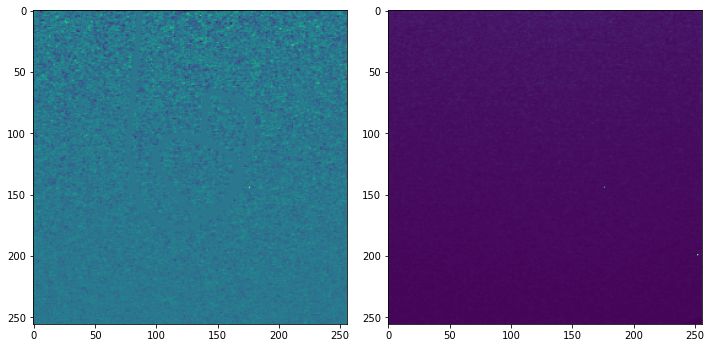

In [144]:

   #Ghost Imaging
    
#     ghost1=np.ndarray(shape=(256,256),dtype=np.float32)
#     ghost2=np.ndarray(shape=(256,256),dtype=np.float32)
#     term1_matrix=np.ndarray(shape=(256,256),dtype=np.float32)
#     term2_matrix=np.ndarray(shape=(256,256),dtype=np.float32)
#     term3_matrix=np.ndarray(shape=(256,256),dtype=np.float32)
start_time=time.time()
ghost1 = np.zeros([256,256])
ghost2 = np.zeros([256,256])
# term1_matrix = np.zeros([256,256])
# term2_matrix = np.zeros([256,256])
# term3_matrix = np.zeros([256,256])



nframes=len(pulses)/2


for file in ten_files:
    for i in range(ghost1.shape[0]):
        for j in range(ghost1.shape[1]):
            term1=0
            term2=0
            term3=0
            term=0
            print('[i,j]:','[',i,',',j,']')
            for pulse in range(0,len(pulses),2):
                obj_data_sum = np.load(path+'obj_data_sum'+file.split('-')[-1].split('.')[0]+str(pulse)+'.npy')
                no_obj_data_sum = np.load(path+'no_obj_data_sum'+file.split('-')[-1].split('.')[0]+str(pulse+1)+'.npy')
                img_obj = np.load(path+'img_obj'+file.split('-')[-1].split('.')[0]+str(pulse)+'.npy')
                img_no_obj = np.load(path+'img_no_obj'+file.split('-')[-1].split('.')[0]+str(pulse+1)+'.npy')

                term1+=no_obj_data_sum*img_obj[i,j]
                term += obj_data_sum*img_no_obj[i,j]
                term2+=no_obj_data_sum
                term3+=img_obj[i,j]
                
                del obj_data_sum
                del no_obj_data_sum
                del img_obj
                del img_no_obj

            ghost1[i,j] = term1/nframes-(term2*term3)/ (nframes ** 2)
            ghost2[i,j] = term/nframes

end_time=time.time()
delta_t=end_time-start_time
print(delta_t, 's')
fig, (ax1,ax2) = plt.subplots(ncols=2,nrows=1, figsize=(10, 10), facecolor='w')

#     ax1.imshow(img_obj, norm=mpl.colors.LogNorm())

#     ax2.imshow(img_no_obj, norm=mpl.colors.LogNorm())

#h=ax[0].imshow(ghost1, norm=mpl.colors.LogNorm())
ax1.imshow(ghost1)
#     fig.colorbar(_)
ax2.imshow(ghost2)

fig.tight_layout()
fig.savefig(file_tag+'_ghosts_pair.png', bbox_inches='tight')
plt.show() 

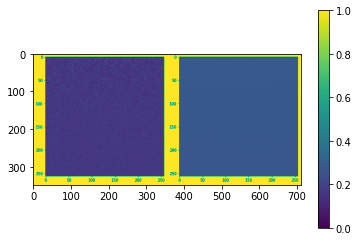

In [223]:
import matplotlib.image as img
  
# reading png image file
im = img.imread(file_tag+'_ghosts_pair.png')
lum = im[:, :, 0]
  
# setting colormap as hot
plt.imshow(lum)
plt.colorbar()

In [145]:
nframes

4.0

In [47]:
# obj_data_sum96.npy


npy_files = []

npy_files = glob.glob(path + "/*[.npy]", recursive = True)


pulse_counts = []

for file in ten_files:
    num_pulses = 0
    for npy in npy_files:
        if (int(npy[-6:-5]) == int(file.split('-')[-1].split('.')[0])) \
        & (npy[-18:-6] == "obj_data_sum"):
            num_pulses+=1
    pulse_counts.append(num_pulses)
pulse_counts

[8, 8, 8, 8, 8, 8, 10, 8, 8, 8]

In [50]:
sum(pulse_counts)/2

41.0

In [ ]:

   #Ghost Imaging
    
#     ghost1=np.ndarray(shape=(256,256),dtype=np.float32)
#     ghost2=np.ndarray(shape=(256,256),dtype=np.float32)
#     term1_matrix=np.ndarray(shape=(256,256),dtype=np.float32)
#     term2_matrix=np.ndarray(shape=(256,256),dtype=np.float32)
#     term3_matrix=np.ndarray(shape=(256,256),dtype=np.float32)
start_time=time.time()
ghost1 = np.zeros([256,256])
ghost2 = np.zeros([256,256])
# term1_matrix = np.zeros([256,256])
# term2_matrix = np.zeros([256,256])
# term3_matrix = np.zeros([256,256])



nframes=int(sum(pulse_counts)/2)


for file in ten_files:
    file_num = file.split('-')[-1].split('.')[0]
    num_pulses = pulse_counts[int(file_num)]
    for pulse in range(0,num_pulses,2):
        obj_data_sum = np.load(path+'obj_data_sum'+file_num+str(pulse)+'.npy')
        no_obj_data_sum = np.load(path+'no_obj_data_sum'+file_num+str(pulse+1)+'.npy')
        img_obj = np.load(path+'img_obj'+file_num+str(pulse)+'.npy')
        img_no_obj = np.load(path+'img_no_obj'+file_num+str(pulse+1)+'.npy')
        for i in range(ghost1.shape[0]):
            for j in range(ghost1.shape[1]):
                term1+=no_obj_data_sum*img_obj[i,j]
                term += obj_data_sum*img_no_obj[i,j]
                term2+=no_obj_data_sum
                term3+=img_obj[i,j]
        del obj_data_sum
        del no_obj_data_sum
        del img_obj
        del img_no_obj


for file in ten_files:
    for i in range(ghost1.shape[0]):
        for j in range(ghost1.shape[1]):
            term1=0
            term2=0
            term3=0
            term=0
            print('[i,j]:','[',i,',',j,']')
            for pulse in range(0,len(pulses),2):
                obj_data_sum = np.load(path+'obj_data_sum'+file.split('-')[-1].split('.')[0]+str(pulse)+'.npy')
                no_obj_data_sum = np.load(path+'no_obj_data_sum'+file.split('-')[-1].split('.')[0]+str(pulse+1)+'.npy')
                img_obj = np.load(path+'img_obj'+file.split('-')[-1].split('.')[0]+str(pulse)+'.npy')
                img_no_obj = np.load(path+'img_no_obj'+file.split('-')[-1].split('.')[0]+str(pulse+1)+'.npy')

                term1+=no_obj_data_sum*img_obj[i,j]
                term += obj_data_sum*img_no_obj[i,j]
                term2+=no_obj_data_sum
                term3+=img_obj[i,j]
                
                del obj_data_sum
                del no_obj_data_sum
                del img_obj
                del img_no_obj

            ghost1[i,j] = term1/nframes-(term2*term3)/ (nframes ** 2)
            ghost2[i,j] = term/nframes

end_time=time.time()
delta_t=end_time-start_time
print(delta_t, 's')
fig, (ax1,ax2) = plt.subplots(ncols=2,nrows=1, figsize=(10, 10), facecolor='w')

#     ax1.imshow(img_obj, norm=mpl.colors.LogNorm())

#     ax2.imshow(img_no_obj, norm=mpl.colors.LogNorm())

#h=ax[0].imshow(ghost1, norm=mpl.colors.LogNorm())
ax1.imshow(ghost1)
#     fig.colorbar(_)
ax2.imshow(ghost2)

fig.tight_layout()
fig.savefig(file_tag+'_ghosts_pair.png', bbox_inches='tight')
plt.show() 

In [29]:
np.version.version

'1.20.1'

In [ ]:
@numba.njit(parallel=True)
def ghostPixel(frames):
    
    ghost=np.zeros(shape=(110,110),dtype=np.double)
    

    nframes=9900
    

    #buckets = frames[:,s1x1:s1x2,s1y1:s1y2].sum(axis=(1,2))
    
    buckets=[]
    
    for i in range(nframes):
        buckets.append(np.sum(frames[i,s1x1:s1x2,s1y1:s1y2]))
    
    
    for i in numba.prange(110):
        for j in numba.prange(110):
            term1=0
            term2=0
            term3=0
            #This loop goes over 10000 frames
            for frame_ct in numba.prange(nframes):

                #This is I_i
                beam1_bucket=np.double(buckets[frame_ct])

                #This is S_i
                beam2_pixel=np.double(frames[frame_ct,s2x1+i,s2y1+j])
                #Where i is the index of a frame (frame_ct in code)
                #Note that this 'i' is not the same as  the 'i' in the first for-loop above. This 'i' is the x coordinate of the image



                term1+=beam1_bucket*beam2_pixel
                term2+=beam1_bucket
                term3+=beam2_pixel




            #After the three summations have been assembled, put them into formula (3) to produce the ghost image at the [i,j] coordinate 
            ghost[i,j]=term1/nframes-(term2*term3)/ (nframes ** 2)
    return ghost

In [199]:
@nb.njit(parallel=True)
def ghostPixel(nframes, pulse_counts, ten_file_nums):
    
    ghost=np.zeros(shape=(256,256),dtype=np.double)


    for file_num in files:
        num_pulses = pulse_counts[file_num]
        for i in nb.prange(256):
            for j in nb.prange(256):
                term1=0
                term2=0
                term3=0
                for pulse in nb.prange(0,num_pulses,2):
                    no_obj_data_sum = np.load(path+'no_obj_data_sum'+file_num+str(pulse+1)+'.npy')
                    img_obj = np.load(path+'img_obj'+file_num+str(pulse)+'.npy')
            
                    term1+=np.double(no_obj_data_sum)*np.double(img_obj[i,j])
                    term2+=np.double(no_obj_data_sum)
                    term3+=np.double(img_obj[i,j])

                ghost[i,j]=term1/nframes-(term2*term3)/ (nframes ** 2)
    return ghost

In [203]:
@nb.njit(parallel=True)
def ghostPixel(no_obj_data_sum, img_obj, nframes):
    
    ghost=np.zeros(shape=(256,256),dtype=np.double)



    term1=0
    term2=0
    term3=0
    for i in nb.prange(256):
        for j in nb.prange(256):
            term1+=np.double(no_obj_data_sum)*np.double(img_obj[i,j])
            term2+=np.double(no_obj_data_sum)
            term3+=np.double(img_obj[i,j])

            ghost[i,j]=term1/nframes-(term2*term3)/ (nframes ** 2)
    return ghost

In [215]:
@nb.njit(parallel=True)
def ghostPixel(no_obj_data_sums, img_objs, nframes, num_pulses):
    
    ghost=np.zeros(shape=(256,256),dtype=np.double)


#     for file_num in files:
#         num_pulses = pulse_counts[file_num]
    for i in nb.prange(256):
        for j in nb.prange(256):
            term1=0
            term2=0
            term3=0
            for pulse in range(0,num_pulses,2):
                no_obj_data_sum = no_obj_data_sums[pulse]
                img_obj = img_objs[pulse+1]

                term1+=np.double(no_obj_data_sum)*np.double(img_obj[i,j])
                term2+=np.double(no_obj_data_sum)
                term3+=np.double(img_obj[i,j])

            ghost[i,j]=term1/nframes-(term2*term3)/ (nframes ** 2)
    return ghost

In [218]:
no_obj_data_sums = []
img_objs = []
ghosts = []
nframes=int(sum(pulse_counts)/2)
ten_file_nums= [*range(10)]
for file_num in ten_file_nums:
    num_pulses = pulse_counts[file_num]
    for pulse in range(0,num_pulses,2):
        no_obj_data_sums.append(np.load(path+'no_obj_data_sum'+str(file_num)+str(pulse+1)+'.npy')) 
        img_objs.append(np.load(path+'img_obj'+str(file_num)+str(pulse)+'.npy')) 
    ghosts.append(ghostPixel(no_obj_data_sums, img_objs, nframes, num_pulses))
ghost = sum(ghosts)

/home/steven/.local/lib/python3.8/site-packages/numba/core/ir_utils.py:2139: NumbaPendingDeprecationWarning: 
Encountered the use of a type that is scheduled for deprecation: type 'reflected list' found for argument 'img_objs' of function 'ghostPixel'.

For more information visit https://numba.pydata.org/numba-doc/latest/reference/deprecation.html#deprecation-of-reflection-for-list-and-set-types

File "../../../../../tmp/ipykernel_3669/1953387822.py", line 1:
<source missing, REPL/exec in use?>

  warnings.warn(NumbaPendingDeprecationWarning(msg, loc=loc))
/home/steven/.local/lib/python3.8/site-packages/numba/core/ir_utils.py:2139: NumbaPendingDeprecationWarning: 
Encountered the use of a type that is scheduled for deprecation: type 'reflected list' found for argument 'no_obj_data_sums' of function 'ghostPixel'.

For more information visit https://numba.pydata.org/numba-doc/latest/reference/deprecation.html#deprecation-of-reflection-for-list-and-set-types

File "../../../../../tmp/ipyk

In [205]:
ghosts = []
nframes=int(sum(pulse_counts)/2)
ten_file_nums= [*range(10)]
for file_num in ten_file_nums:
    num_pulses = pulse_counts[file_num]
    for pulse in nb.prange(0,num_pulses,2):
        no_obj_data_sum = np.load(path+'no_obj_data_sum'+str(file_num)+str(pulse+1)+'.npy')
        img_obj = np.load(path+'img_obj'+str(file_num)+str(pulse)+'.npy')
        ghosts.append(ghostPixel(no_obj_data_sum, img_obj, nframes))
ghost = sum(ghosts)

In [207]:
ghost

array([[ 2.18798509e+14,  4.24122195e+14,  5.77174737e+14, ...,
        -2.26407029e+17, -2.28494404e+17, -2.30677629e+17],
       [-2.32705735e+17, -2.34746232e+17, -2.36602641e+17, ...,
        -9.57069344e+17, -9.61077468e+17, -9.65139170e+17],
       [-9.69621246e+17, -9.73471084e+17, -9.77367258e+17, ...,
        -2.15984475e+18, -2.16527187e+18, -2.17134850e+18],
       ...,
       [-2.17325314e+19, -2.17428108e+19, -2.17532265e+19, ...,
        -2.42203026e+19, -2.42253416e+19, -2.42303952e+19],
       [-2.42420754e+19, -2.42527837e+19, -2.42631451e+19, ...,
        -2.68773217e+19, -2.68826358e+19, -2.68879660e+19],
       [-2.69009417e+19, -2.69122004e+19, -2.69235448e+19, ...,
        -2.97575054e+19, -2.97631168e+19, -2.97687301e+19]])

In [200]:
start_time=time.time()
nframes=int(sum(pulse_counts)/2)
ten_file_nums= [*range(10)]
ghost = ghostPixel(nframes, pulse_counts, ten_file_nums) 
end_time=time.time()
delta_t=end_time-start_time
print(delta_t, 's')

TypingError: Failed in nopython mode pipeline (step: nopython frontend)
[1mNameError: name 'no_obj_data_sum' is not defined[0m

In [229]:
@nb.njit(parallel=True)
def ghostPixel(no_obj_data_sum, img_obj):
    
    ghost=np.zeros(shape=(256,256),dtype=np.double)



    for i in nb.prange(256):
        for j in nb.prange(256):
            
            ghost[i,j]=(np.double(no_obj_data_sum)*np.double(img_obj[i,j]))#/nframes
    return ghost

In [230]:
start_time=time.time()
ghost_sum = np.zeros(shape=(256,256),dtype=np.double)
nframes=int(sum(pulse_counts)/2)
ten_file_nums= [*range(10)]
for file_num in ten_file_nums:
    num_pulses = pulse_counts[file_num]
    for pulse in range(0,num_pulses,2):
        no_obj_data_sum = np.load(path+'no_obj_data_sum'+str(file_num)+str(pulse+1)+'.npy')
        img_obj = np.load(path+'img_obj'+str(file_num)+str(pulse)+'.npy')
        ghost_sum += ghostPixel(no_obj_data_sum, img_obj)
ghost = ghost_sum/nframes
np.savez(path+'ghost_ten_files', ghost)
end_time=time.time()
delta_t=end_time-start_time
print(delta_t, 's')

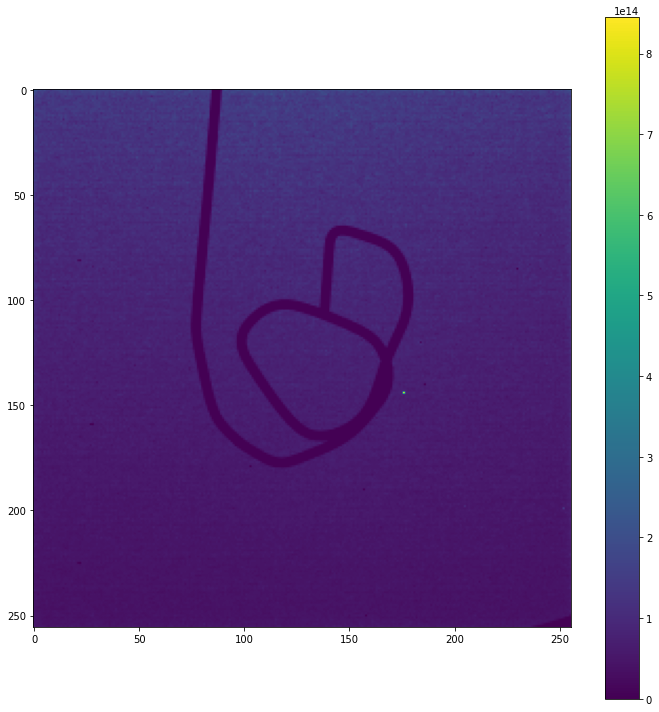

In [245]:
# fig, ax1 = plt.subplots(ncols=1,nrows=1, figsize=(10, 10), facecolor='w')
plt.figure(figsize = (10,10))
_=plt.imshow(ghost)
plt.colorbar(_)

plt.tight_layout()
plt.savefig(path+'ghost_first_ten.png', bbox_inches='tight')
plt.show() 